In [33]:
import torch
import torch.nn as nn
import torch.nn.init as init
import random
import copy
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader
import numpy as np
import matplotlib.pyplot as plt
import DeepTreeEnsemble
import torch.nn.functional as F
from importlib import reload
reload(DeepTreeEnsemble)
from DeepTreeEnsemble import DeepTreeEnsemble, create_dataloaders_for_dataset 
# if this ^ doesn't work, try 'pip install -e .' in the root directory of it. Make sure you are in 
# the desired environment. 

In [34]:
train_dataloader, test_dataloader, input_size, output_size = create_dataloaders_for_dataset(dataset_name='breast_cancer', task='classification', batch_size=32)

xtrain size 455
xtest size 114
y_train size 455
y_test size 114


In [35]:
class MLP(nn.Module):
    def __init__(self, input_size, hidden_layers, output_size, dropout=.5):
        super(MLP, self).__init__()
        self.layers = nn.ModuleList()
        self.batch_norms = nn.ModuleList()

        # Create the first hidden layer
        self.layers.append(nn.Linear(input_size, hidden_layers[0]))
        self.batch_norms.append(nn.BatchNorm1d(hidden_layers[0]))

        # Create additional hidden layers
        for i in range(1, len(hidden_layers)):
            self.layers.append(nn.Linear(hidden_layers[i-1], hidden_layers[i]))
            self.batch_norms.append(nn.BatchNorm1d(hidden_layers[i]))

        # Output layer
        self.output = nn.Linear(hidden_layers[-1], output_size)

        # Dropout layer
        self.dropout = nn.Dropout(dropout)


    def forward(self, x):
        i = 0
        for layer, batch_norm in zip(self.layers, self.batch_norms):
            # x = F.relu(batch_norm(layer(x)))
            i=i+1
            x = self.dropout(x)
            # print('Layer dtype: ', layer.weight.dtype)
            x = x.to(torch.float32) # <-- area of concern
            # print('tensor dytpe: ', x.dtype)
            # layer.weight = layer.weight.to(torch.float32)
            x = F.relu(batch_norm(layer(x)))
            
            # print(f'dtype is {x.dtype} after layer {i}')

        x = self.output(x)
        return x

# Changing the base
Testing base 4, 6, 8, 10 and 12 with 5 trails each

## Base 4

In [36]:
hidden_layers = [25, 25]
multiLayerPerceptron = MLP(input_size=input_size, hidden_layers=hidden_layers, output_size=output_size+1, dropout=.5) #hidden size default at 100

# Fill DTE params
modelSaveDirectory = './saved_models/'
DTEmlp4b = DeepTreeEnsemble(task_name='classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=4,
                                epochs=10,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.0001)

Randomly initializing 4 models
Training Model with id 1


in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.50it/s]

Epoch [1/10], Train F1:0.4953400127670883, Train Loss: 1.0580, Train Acc: 0.4893, Test F1:0.5032525133057363, Test Loss: 1.0509, Test Acc: 0.6120


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.91it/s]

Epoch [2/10], Train F1:0.4990397071600079, Train Loss: 1.0570, Train Acc: 0.4897, Test F1:0.5048732943469786, Test Loss: 1.0396, Test Acc: 0.6198
Epoch [3/10], Train F1:0.512843791149062, Train Loss: 1.0527, Train Acc: 0.4946, Test F1:0.5083204334365325, Test Loss: 1.0331, Test Acc: 0.6276


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.91it/s]

Epoch [4/10], Train F1:0.5123198220408531, Train Loss: 1.0484, Train Acc: 0.4980, Test F1:0.5193056577094345, Test Loss: 1.0296, Test Acc: 0.6335


Training Process:  50%|█████     | 5/10 [00:00<00:00, 12.78it/s]

Epoch [5/10], Train F1:0.5089803182346274, Train Loss: 1.0446, Train Acc: 0.4993, Test F1:0.5214908444421061, Test Loss: 1.0282, Test Acc: 0.6354
Epoch [6/10], Train F1:0.5155437591507323, Train Loss: 1.0412, Train Acc: 0.5075, Test F1:0.5200037042425462, Test Loss: 1.0228, Test Acc: 0.6367


Training Process:  70%|███████   | 7/10 [00:00<00:00, 13.26it/s]

Epoch [7/10], Train F1:0.521258849956084, Train Loss: 1.0376, Train Acc: 0.5158, Test F1:0.5274136055560203, Test Loss: 1.0179, Test Acc: 0.6430


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 13.20it/s]

Epoch [8/10], Train F1:0.5227266359421652, Train Loss: 1.0356, Train Acc: 0.5169, Test F1:0.5446436538548957, Test Loss: 1.0143, Test Acc: 0.6533
Epoch [9/10], Train F1:0.5236966172794695, Train Loss: 1.0337, Train Acc: 0.5183, Test F1:0.5577284125368974, Test Loss: 1.0121, Test Acc: 0.6614


Training Process: 100%|██████████| 10/10 [00:00<00:00, 12.83it/s]


Epoch [10/10], Train F1:0.5290932807865297, Train Loss: 1.0325, Train Acc: 0.5221, Test F1:0.5680049008734961, Test Loss: 1.0087, Test Acc: 0.6678
Total Epochs: 10
Train loss start: 1.0585380792617798, Train loss end: 1.1400858163833618
Highest Mean Train Accuracy (over epoch): 0.5221428571428572
Test loss start: 1.0512818098068237, Test loss end: 0.9595645070075989
Highest mean Test Accuracy (over epoch): 0.667795138888889


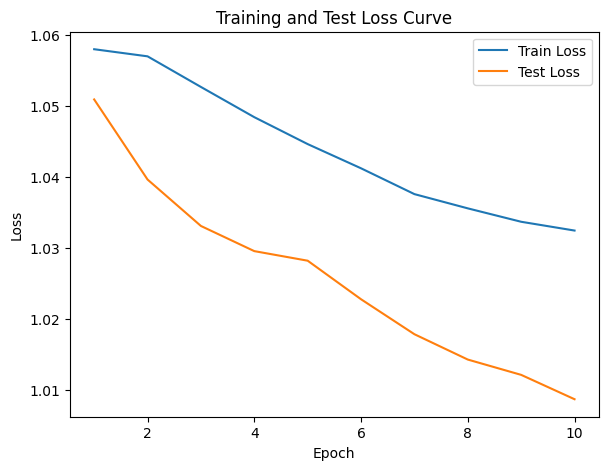

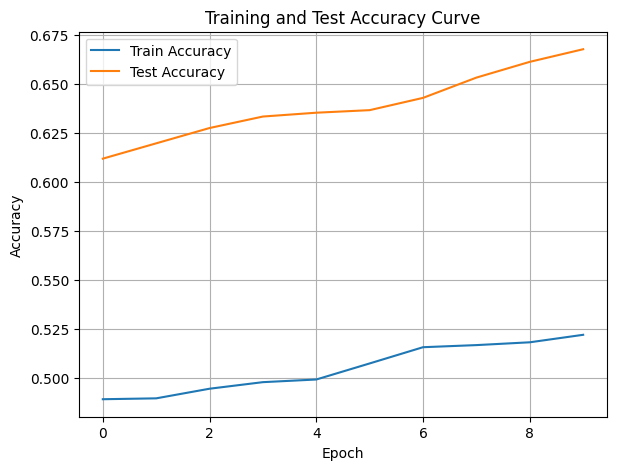

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 14.94it/s]

Epoch [1/10], Train F1:0.5208176589673811, Train Loss: 0.9939, Train Acc: 0.5128, Test F1:0.5064338645596178, Test Loss: 1.0167, Test Acc: 0.5434
Epoch [2/10], Train F1:0.5646111809722781, Train Loss: 0.9825, Train Acc: 0.5536, Test F1:0.4943171325442794, Test Loss: 1.0136, Test Acc: 0.5356


Training Process:  20%|██        | 2/10 [00:00<00:00, 14.94it/s]

Epoch [3/10], Train F1:0.5543062602517359, Train Loss: 0.9787, Train Acc: 0.5523, Test F1:0.5120970546906521, Test Loss: 1.0098, Test Acc: 0.5501


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.80it/s]

Epoch [4/10], Train F1:0.5559423627021877, Train Loss: 0.9760, Train Acc: 0.5516, Test F1:0.517566409597258, Test Loss: 1.0079, Test Acc: 0.5558
Epoch [5/10], Train F1:0.565237341405231, Train Loss: 0.9728, Train Acc: 0.5578, Test F1:0.5264759699909323, Test Loss: 1.0034, Test Acc: 0.5623


Training Process:  60%|██████    | 6/10 [00:00<00:00, 13.29it/s]

Epoch [6/10], Train F1:0.5712673751547432, Train Loss: 0.9701, Train Acc: 0.5632, Test F1:0.5426258456599015, Test Loss: 0.9987, Test Acc: 0.5742


Training Process:  80%|████████  | 8/10 [00:00<00:00, 13.36it/s]

Epoch [7/10], Train F1:0.5775757240196934, Train Loss: 0.9678, Train Acc: 0.5688, Test F1:0.576834763170755, Test Loss: 0.9936, Test Acc: 0.5972
Epoch [8/10], Train F1:0.5850296012389172, Train Loss: 0.9628, Train Acc: 0.5771, Test F1:0.6047736331390887, Test Loss: 0.9896, Test Acc: 0.6182


Training Process:  80%|████████  | 8/10 [00:00<00:00, 13.36it/s]

Epoch [9/10], Train F1:0.5952517100603186, Train Loss: 0.9586, Train Acc: 0.5875, Test F1:0.6132470905880297, Test Loss: 0.9869, Test Acc: 0.6244


Training Process: 100%|██████████| 10/10 [00:00<00:00, 13.30it/s]


Epoch [10/10], Train F1:0.5987149332682892, Train Loss: 0.9568, Train Acc: 0.5905, Test F1:0.614652849685305, Test Loss: 0.9848, Test Acc: 0.6255
Total Epochs: 10
Train loss start: 1.0210398435592651, Train loss end: 0.9636369943618774
Highest Mean Train Accuracy (over epoch): 0.5904761904761905
Test loss start: 1.0308077335357666, Test loss end: 0.9488686323165894
Highest mean Test Accuracy (over epoch): 0.6255208333333334


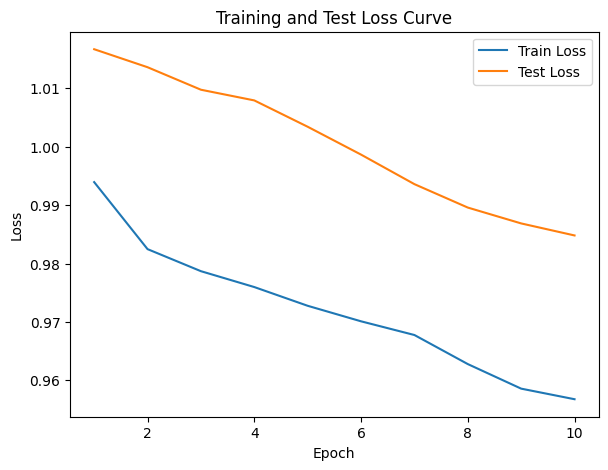

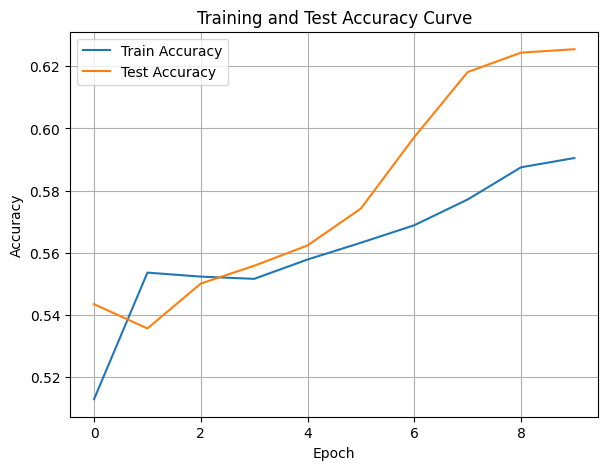

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.6343295492882439, Train Loss: 0.9726, Train Acc: 0.6509, Test F1:0.6863826232247285, Test Loss: 1.0109, Test Acc: 0.7057


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.90it/s]

Epoch [2/10], Train F1:0.6449984399995964, Train Loss: 0.9659, Train Acc: 0.6555, Test F1:0.6749410290431963, Test Loss: 0.9958, Test Acc: 0.7049
Epoch [3/10], Train F1:0.6529271454615799, Train Loss: 0.9654, Train Acc: 0.6605, Test F1:0.6707419436164375, Test Loss: 0.9935, Test Acc: 0.7046


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.97it/s]

Epoch [4/10], Train F1:0.6529377633498452, Train Loss: 0.9646, Train Acc: 0.6586, Test F1:0.6653770239134367, Test Loss: 0.9898, Test Acc: 0.7025


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.60it/s]

Epoch [5/10], Train F1:0.6563663093156783, Train Loss: 0.9620, Train Acc: 0.6611, Test F1:0.6568991877246545, Test Loss: 0.9862, Test Acc: 0.6969
Epoch [6/10], Train F1:0.6595497535741969, Train Loss: 0.9592, Train Acc: 0.6641, Test F1:0.6605262274327446, Test Loss: 0.9835, Test Acc: 0.7007


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.60it/s]

Epoch [7/10], Train F1:0.6635812029744023, Train Loss: 0.9563, Train Acc: 0.6686, Test F1:0.657516410072801, Test Loss: 0.9808, Test Acc: 0.7000


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.98it/s]

Epoch [8/10], Train F1:0.6669401349460905, Train Loss: 0.9529, Train Acc: 0.6718, Test F1:0.6560961971763685, Test Loss: 0.9776, Test Acc: 0.6998


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.98it/s]

Epoch [9/10], Train F1:0.6695564782435001, Train Loss: 0.9507, Train Acc: 0.6736, Test F1:0.6564497439692618, Test Loss: 0.9749, Test Acc: 0.7011


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.31it/s]


Epoch [10/10], Train F1:0.6718797201600466, Train Loss: 0.9484, Train Acc: 0.6759, Test F1:0.6553926094162297, Test Loss: 0.9733, Test Acc: 0.7014
Total Epochs: 10
Train loss start: 0.9469459652900696, Train loss end: 0.9301876425743103
Highest Mean Train Accuracy (over epoch): 0.6758928571428571
Test loss start: 1.0052056312561035, Test loss end: 0.9763815999031067
Highest mean Test Accuracy (over epoch): 0.7057291666666666


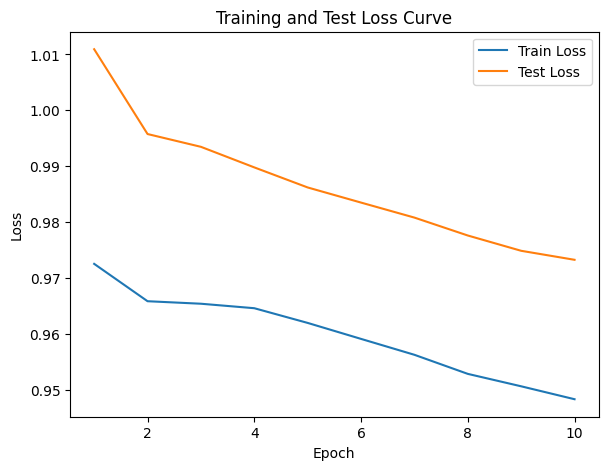

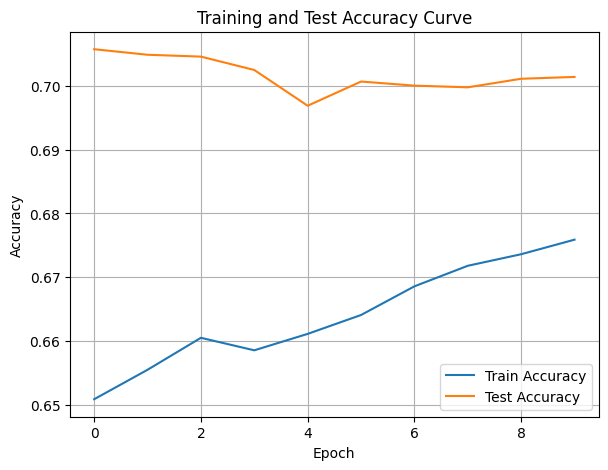

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.32it/s]

Epoch [1/10], Train F1:0.40311845106072186, Train Loss: 1.0898, Train Acc: 0.3744, Test F1:0.30805828129646146, Test Loss: 1.1080, Test Acc: 0.2674


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.68it/s]

Epoch [2/10], Train F1:0.39247132660969186, Train Loss: 1.0979, Train Acc: 0.3676, Test F1:0.26083473523992634, Test Loss: 1.1104, Test Acc: 0.2083


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.68it/s]

Epoch [3/10], Train F1:0.38840144131285737, Train Loss: 1.0974, Train Acc: 0.3685, Test F1:0.23980332998100345, Test Loss: 1.1119, Test Acc: 0.1834


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.49it/s]

Epoch [4/10], Train F1:0.39397604197504377, Train Loss: 1.0927, Train Acc: 0.3815, Test F1:0.22328548644338117, Test Loss: 1.1136, Test Acc: 0.1656
Epoch [5/10], Train F1:0.39287720384120073, Train Loss: 1.0899, Train Acc: 0.3853, Test F1:0.23581414473684212, Test Loss: 1.1118, Test Acc: 0.1757


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.04it/s]

Epoch [6/10], Train F1:0.4044719455949084, Train Loss: 1.0848, Train Acc: 0.3976, Test F1:0.23546611627106984, Test Loss: 1.1111, Test Acc: 0.1749


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.04it/s]

Epoch [7/10], Train F1:0.4053618716568256, Train Loss: 1.0829, Train Acc: 0.3987, Test F1:0.25929633867276886, Test Loss: 1.1087, Test Acc: 0.1970


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.85it/s]

Epoch [8/10], Train F1:0.41447356564674814, Train Loss: 1.0786, Train Acc: 0.4077, Test F1:0.26397146254458975, Test Loss: 1.1075, Test Acc: 0.1989


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.85it/s]

Epoch [9/10], Train F1:0.417416211523371, Train Loss: 1.0762, Train Acc: 0.4117, Test F1:0.26594658887254785, Test Loss: 1.1065, Test Acc: 0.1999


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.69it/s]


Epoch [10/10], Train F1:0.4191241790863779, Train Loss: 1.0736, Train Acc: 0.4151, Test F1:0.2731476214746918, Test Loss: 1.1053, Test Acc: 0.2069
Total Epochs: 10
Train loss start: 1.1072806119918823, Train loss end: 1.038519024848938
Highest Mean Train Accuracy (over epoch): 0.4150595238095238
Test loss start: 1.1069542169570923, Test loss end: 1.0782147645950317
Highest mean Test Accuracy (over epoch): 0.2673611111111111


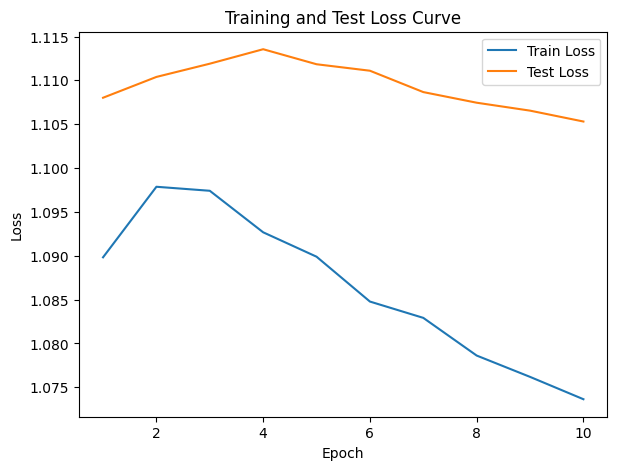

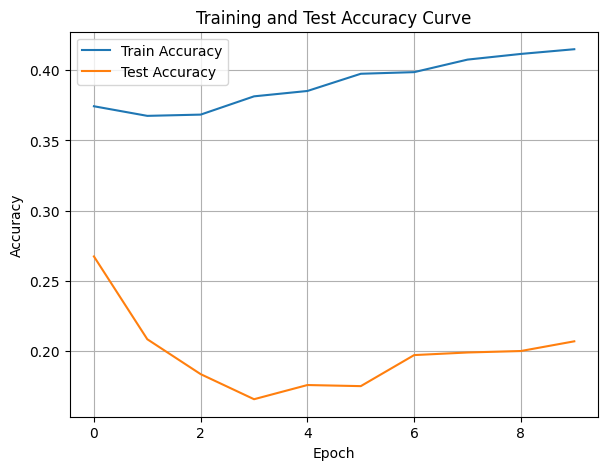

./saved_models/model_4.pth
Training Model with id 7
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4920052456680456, Train Loss: 1.0456, Train Acc: 0.5048, Test F1:0.415438596491228, Test Loss: 1.0870, Test Acc: 0.3672


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.67it/s]

Epoch [2/10], Train F1:0.4794337906792208, Train Loss: 1.0388, Train Acc: 0.4960, Test F1:0.415438596491228, Test Loss: 1.0843, Test Acc: 0.3702


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.67it/s]

Epoch [3/10], Train F1:0.48064499823036544, Train Loss: 1.0369, Train Acc: 0.4894, Test F1:0.39999999999999997, Test Loss: 1.0828, Test Acc: 0.3556


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.28it/s]

Epoch [4/10], Train F1:0.4912122290962277, Train Loss: 1.0328, Train Acc: 0.4978, Test F1:0.404885453069293, Test Loss: 1.0829, Test Acc: 0.3605
Epoch [5/10], Train F1:0.49446012194220423, Train Loss: 1.0290, Train Acc: 0.5046, Test F1:0.42598684210526316, Test Loss: 1.0821, Test Acc: 0.3877


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.14it/s]

Epoch [6/10], Train F1:0.4938814824607031, Train Loss: 1.0249, Train Acc: 0.5110, Test F1:0.44205915136861873, Test Loss: 1.0809, Test Acc: 0.4061


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.78it/s]

Epoch [7/10], Train F1:0.4970844820597998, Train Loss: 1.0229, Train Acc: 0.5156, Test F1:0.4507703810891357, Test Loss: 1.0795, Test Acc: 0.4157
Epoch [8/10], Train F1:0.5019653635121004, Train Loss: 1.0207, Train Acc: 0.5202, Test F1:0.46568037297165416, Test Loss: 1.0778, Test Acc: 0.4328


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.78it/s]

Epoch [9/10], Train F1:0.5028220136313257, Train Loss: 1.0181, Train Acc: 0.5219, Test F1:0.47724278331021863, Test Loss: 1.0766, Test Acc: 0.4470


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.53it/s]


Epoch [10/10], Train F1:0.5066995219683086, Train Loss: 1.0161, Train Acc: 0.5278, Test F1:0.48593985355792557, Test Loss: 1.0753, Test Acc: 0.4584
Total Epochs: 10
Train loss start: 1.0584638118743896, Train loss end: 0.9696068167686462
Highest Mean Train Accuracy (over epoch): 0.5278273809523809
Test loss start: 1.0866237878799438, Test loss end: 1.046447515487671
Highest mean Test Accuracy (over epoch): 0.45842013888888883


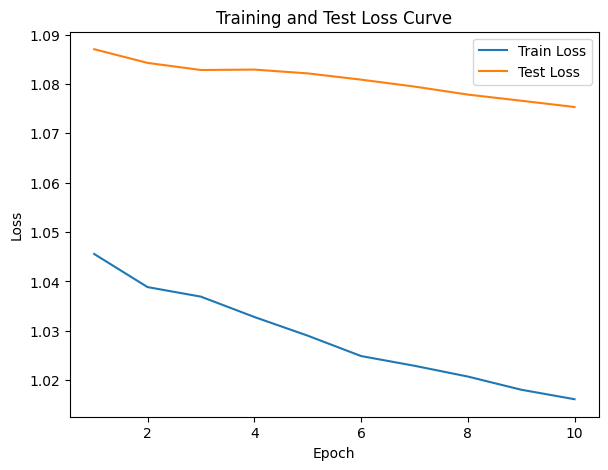

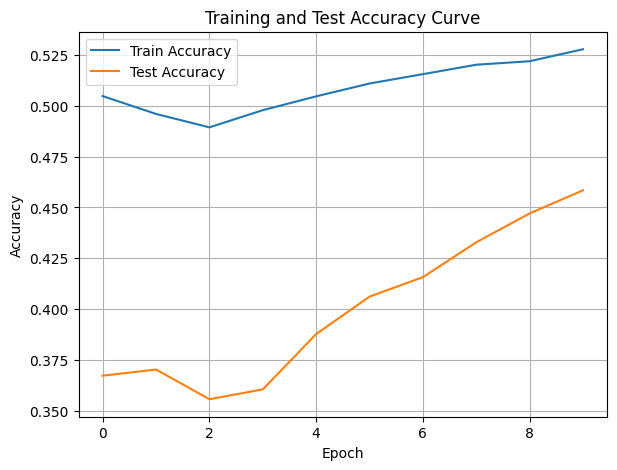

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.65it/s]

Epoch [1/10], Train F1:0.5686047638428591, Train Loss: 0.9798, Train Acc: 0.5952, Test F1:0.5890203978846639, Test Loss: 1.0602, Test Acc: 0.5764
Epoch [2/10], Train F1:0.5658458825125492, Train Loss: 0.9833, Train Acc: 0.5874, Test F1:0.6309337784407036, Test Loss: 1.0541, Test Acc: 0.6224


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.65it/s]

Epoch [3/10], Train F1:0.5652877328211832, Train Loss: 0.9827, Train Acc: 0.5893, Test F1:0.6453999338146306, Test Loss: 1.0513, Test Acc: 0.6377


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.64it/s]

Epoch [4/10], Train F1:0.5661215951209299, Train Loss: 0.9773, Train Acc: 0.5937, Test F1:0.6619195743495856, Test Loss: 1.0496, Test Acc: 0.6532
Epoch [5/10], Train F1:0.567721177077314, Train Loss: 0.9755, Train Acc: 0.5957, Test F1:0.6642812118324362, Test Loss: 1.0484, Test Acc: 0.6606


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.08it/s]

Epoch [6/10], Train F1:0.5724115193480368, Train Loss: 0.9718, Train Acc: 0.6056, Test F1:0.676189185163615, Test Loss: 1.0469, Test Acc: 0.6707


Training Process:  80%|████████  | 8/10 [00:00<00:00, 12.20it/s]

Epoch [7/10], Train F1:0.5779337976281005, Train Loss: 0.9681, Train Acc: 0.6117, Test F1:0.6862553338957639, Test Loss: 1.0448, Test Acc: 0.6802
Epoch [8/10], Train F1:0.5787551691798033, Train Loss: 0.9658, Train Acc: 0.6145, Test F1:0.6923768354288882, Test Loss: 1.0430, Test Acc: 0.6863


Training Process:  80%|████████  | 8/10 [00:00<00:00, 12.20it/s]

Epoch [9/10], Train F1:0.5782709348351398, Train Loss: 0.9631, Train Acc: 0.6183, Test F1:0.7013375507251707, Test Loss: 1.0413, Test Acc: 0.6930


Training Process: 100%|██████████| 10/10 [00:00<00:00, 12.05it/s]


Epoch [10/10], Train F1:0.5830588689424165, Train Loss: 0.9606, Train Acc: 0.6209, Test F1:0.7080573032835092, Test Loss: 1.0405, Test Acc: 0.6980
Total Epochs: 10
Train loss start: 0.9753644466400146, Train loss end: 0.9893441796302795
Highest Mean Train Accuracy (over epoch): 0.6208928571428571
Test loss start: 1.0606369972229004, Test loss end: 1.0150065422058105
Highest mean Test Accuracy (over epoch): 0.6980034722222223


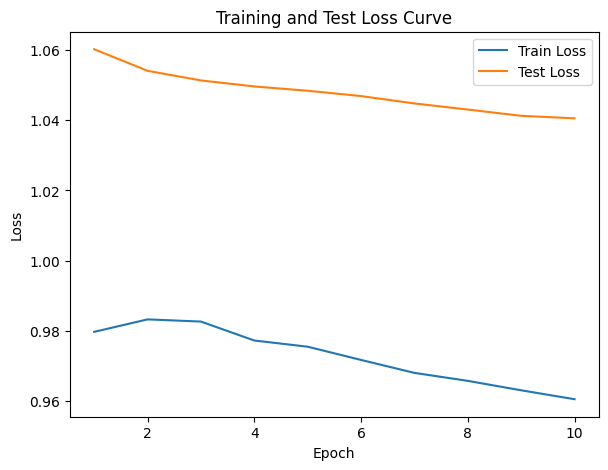

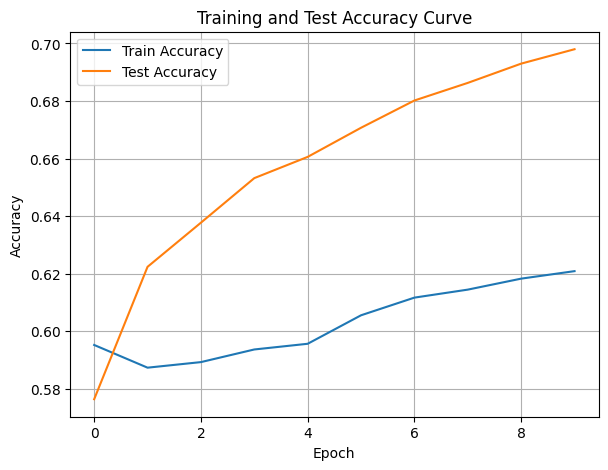

./saved_models/model_8.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.19it/s]

Epoch [1/10], Train F1:0.6018767365783578, Train Loss: 0.9308, Train Acc: 0.6613, Test F1:0.7605020098806345, Test Loss: 1.0247, Test Acc: 0.7569


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.19it/s]

Epoch [2/10], Train F1:0.6217318813616783, Train Loss: 0.9265, Train Acc: 0.6616, Test F1:0.7695164356708729, Test Loss: 1.0204, Test Acc: 0.7626


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.74it/s]

Epoch [3/10], Train F1:0.6185156575061617, Train Loss: 0.9295, Train Acc: 0.6534, Test F1:0.7780776728145149, Test Loss: 1.0193, Test Acc: 0.7697
Epoch [4/10], Train F1:0.6165377698851209, Train Loss: 0.9244, Train Acc: 0.6585, Test F1:0.7845407114282937, Test Loss: 1.0166, Test Acc: 0.7782


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.39it/s]

Epoch [5/10], Train F1:0.6216295567676713, Train Loss: 0.9213, Train Acc: 0.6626, Test F1:0.7682315596435089, Test Loss: 1.0181, Test Acc: 0.7590


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.85it/s]

Epoch [6/10], Train F1:0.6277431664468583, Train Loss: 0.9200, Train Acc: 0.6674, Test F1:0.7721466674558101, Test Loss: 1.0175, Test Acc: 0.7629
Epoch [7/10], Train F1:0.6311618117063863, Train Loss: 0.9174, Train Acc: 0.6685, Test F1:0.7757972033731856, Test Loss: 1.0149, Test Acc: 0.7679


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.03it/s]


Epoch [8/10], Train F1:0.6365628308821241, Train Loss: 0.9152, Train Acc: 0.6720, Test F1:0.7848186959814574, Test Loss: 1.0121, Test Acc: 0.7797
Epoch [9/10], Train F1:0.6400864818977909, Train Loss: 0.9131, Train Acc: 0.6758, Test F1:0.7903207073940046, Test Loss: 1.0109, Test Acc: 0.7857
Epoch [10/10], Train F1:0.6446613013503301, Train Loss: 0.9110, Train Acc: 0.6802, Test F1:0.7922869824908955, Test Loss: 1.0101, Test Acc: 0.7887
Total Epochs: 10
Train loss start: 0.9119864702224731, Train loss end: 0.877912700176239
Highest Mean Train Accuracy (over epoch): 0.6801785714285714
Test loss start: 1.021154761314392, Test loss end: 0.9811463952064514
Highest mean Test Accuracy (over epoch): 0.7887152777777777


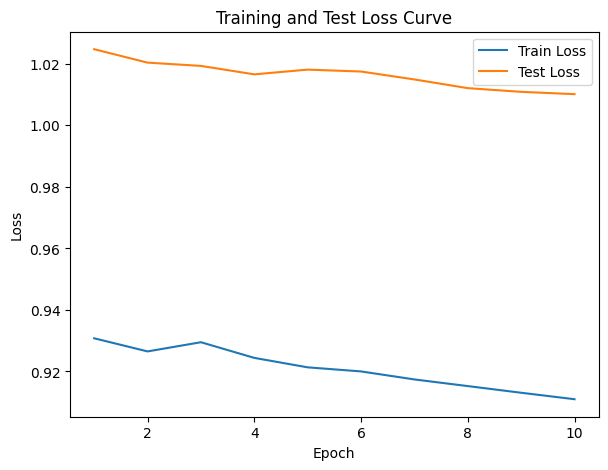

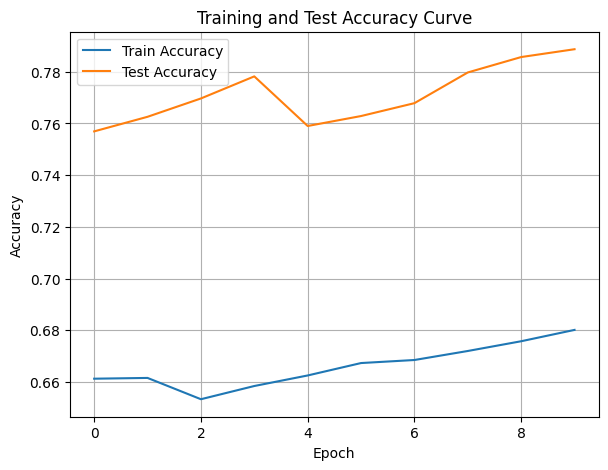

./saved_models/model_6.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [37]:
DTEmlp4b.train_DTE()

Training Process:   0%|          | 0/70 [00:00<?, ?it/s]

Training Process:   1%|▏         | 1/70 [00:00<00:08,  8.28it/s]

Epoch [1/70], Train F1:0.3820813281916238, Train Loss: 1.1494, Train Acc: 0.2890, Test F1:0.5559588626739262, Test Loss: 1.0917, Test Acc: 0.4783


Training Process:   3%|▎         | 2/70 [00:00<00:08,  8.18it/s]

Epoch [2/70], Train F1:0.398281233329777, Train Loss: 1.1410, Train Acc: 0.2957, Test F1:0.5671710728708885, Test Loss: 1.0830, Test Acc: 0.4978


Training Process:   6%|▌         | 4/70 [00:00<00:06, 10.26it/s]

Epoch [3/70], Train F1:0.4163591856395629, Train Loss: 1.1367, Train Acc: 0.3090, Test F1:0.5587743080328558, Test Loss: 1.0796, Test Acc: 0.4965
Epoch [4/70], Train F1:0.41433158420565064, Train Loss: 1.1366, Train Acc: 0.3079, Test F1:0.5816282740590933, Test Loss: 1.0754, Test Acc: 0.5189


Training Process:   6%|▌         | 4/70 [00:00<00:06, 10.26it/s]

Epoch [5/70], Train F1:0.4165653843042363, Train Loss: 1.1343, Train Acc: 0.3116, Test F1:0.5985675124168367, Test Loss: 1.0723, Test Acc: 0.5366


Training Process:   9%|▊         | 6/70 [00:00<00:05, 10.97it/s]

Epoch [6/70], Train F1:0.4220538387582029, Train Loss: 1.1321, Train Acc: 0.3158, Test F1:0.5933079540565559, Test Loss: 1.0718, Test Acc: 0.5341
Epoch [7/70], Train F1:0.42806711408772885, Train Loss: 1.1300, Train Acc: 0.3213, Test F1:0.5996510429763877, Test Loss: 1.0687, Test Acc: 0.5441


Training Process:  11%|█▏        | 8/70 [00:00<00:05, 10.65it/s]

Epoch [8/70], Train F1:0.4369167618146444, Train Loss: 1.1268, Train Acc: 0.3282, Test F1:0.5978111303517616, Test Loss: 1.0678, Test Acc: 0.5450
Epoch [9/70], Train F1:0.44742411862390863, Train Loss: 1.1220, Train Acc: 0.3365, Test F1:0.6007228654499532, Test Loss: 1.0660, Test Acc: 0.5494


Training Process:  14%|█▍        | 10/70 [00:01<00:05, 10.45it/s]

Epoch [10/70], Train F1:0.45474388687417017, Train Loss: 1.1187, Train Acc: 0.3455, Test F1:0.6035804176079674, Test Loss: 1.0640, Test Acc: 0.5543
Epoch [11/70], Train F1:0.4621824916856752, Train Loss: 1.1151, Train Acc: 0.3541, Test F1:0.6147981568606834, Test Loss: 1.0614, Test Acc: 0.5679


Training Process:  19%|█▊        | 13/70 [00:01<00:06,  9.49it/s]

Epoch [12/70], Train F1:0.4686483450285176, Train Loss: 1.1112, Train Acc: 0.3609, Test F1:0.6195438134846442, Test Loss: 1.0601, Test Acc: 0.5730
Epoch [13/70], Train F1:0.47656220194412885, Train Loss: 1.1081, Train Acc: 0.3691, Test F1:0.6261741044178216, Test Loss: 1.0585, Test Acc: 0.5813


Training Process:  21%|██▏       | 15/70 [00:01<00:05,  9.58it/s]

Epoch [14/70], Train F1:0.4828975380865968, Train Loss: 1.1057, Train Acc: 0.3754, Test F1:0.6331394832286379, Test Loss: 1.0569, Test Acc: 0.5890
Epoch [15/70], Train F1:0.488439821095674, Train Loss: 1.1031, Train Acc: 0.3811, Test F1:0.6338092873174819, Test Loss: 1.0556, Test Acc: 0.5907


Training Process:  24%|██▍       | 17/70 [00:01<00:05,  9.48it/s]

Epoch [16/70], Train F1:0.49418245462553306, Train Loss: 1.0998, Train Acc: 0.3877, Test F1:0.6341887965693542, Test Loss: 1.0547, Test Acc: 0.5920
Epoch [17/70], Train F1:0.4996261319498011, Train Loss: 1.0962, Train Acc: 0.3940, Test F1:0.6406043011058551, Test Loss: 1.0534, Test Acc: 0.5995


Training Process:  27%|██▋       | 19/70 [00:01<00:05,  9.22it/s]

Epoch [18/70], Train F1:0.5069232643981124, Train Loss: 1.0929, Train Acc: 0.4004, Test F1:0.6458524702751884, Test Loss: 1.0516, Test Acc: 0.6058
Epoch [19/70], Train F1:0.5125878944353909, Train Loss: 1.0896, Train Acc: 0.4065, Test F1:0.6536598213530531, Test Loss: 1.0495, Test Acc: 0.6145


Training Process:  30%|███       | 21/70 [00:02<00:06,  8.16it/s]

Epoch [20/70], Train F1:0.5181110439469125, Train Loss: 1.0866, Train Acc: 0.4128, Test F1:0.6509179135776462, Test Loss: 1.0489, Test Acc: 0.6132
Epoch [21/70], Train F1:0.5246569022100772, Train Loss: 1.0831, Train Acc: 0.4202, Test F1:0.6529935077617849, Test Loss: 1.0478, Test Acc: 0.6164


Training Process:  33%|███▎      | 23/70 [00:02<00:05,  8.11it/s]

Epoch [22/70], Train F1:0.5301091363292837, Train Loss: 1.0802, Train Acc: 0.4261, Test F1:0.6581567208835323, Test Loss: 1.0463, Test Acc: 0.6222
Epoch [23/70], Train F1:0.5363202745021038, Train Loss: 1.0773, Train Acc: 0.4328, Test F1:0.6612887211228975, Test Loss: 1.0451, Test Acc: 0.6261


Training Process:  36%|███▌      | 25/70 [00:02<00:05,  7.92it/s]

Epoch [24/70], Train F1:0.541830606904686, Train Loss: 1.0742, Train Acc: 0.4391, Test F1:0.6604056048170227, Test Loss: 1.0442, Test Acc: 0.6264
Epoch [25/70], Train F1:0.5466632132717298, Train Loss: 1.0705, Train Acc: 0.4453, Test F1:0.6664241014681449, Test Loss: 1.0426, Test Acc: 0.6329


Training Process:  39%|███▊      | 27/70 [00:03<00:06,  6.84it/s]

Epoch [26/70], Train F1:0.5530329839280613, Train Loss: 1.0672, Train Acc: 0.4526, Test F1:0.6702349130860585, Test Loss: 1.0412, Test Acc: 0.6371
Epoch [27/70], Train F1:0.5585152785586903, Train Loss: 1.0641, Train Acc: 0.4588, Test F1:0.6750724665354905, Test Loss: 1.0396, Test Acc: 0.6424


Training Process:  41%|████▏     | 29/70 [00:03<00:06,  6.48it/s]

Epoch [28/70], Train F1:0.5634280818457674, Train Loss: 1.0611, Train Acc: 0.4646, Test F1:0.6792318874242411, Test Loss: 1.0378, Test Acc: 0.6471
Epoch [29/70], Train F1:0.5689802782415494, Train Loss: 1.0580, Train Acc: 0.4710, Test F1:0.682482089695412, Test Loss: 1.0361, Test Acc: 0.6509


Training Process:  43%|████▎     | 30/70 [00:03<00:06,  6.08it/s]

Epoch [30/70], Train F1:0.5741795315354375, Train Loss: 1.0549, Train Acc: 0.4764, Test F1:0.6863761613472764, Test Loss: 1.0342, Test Acc: 0.6550


Training Process:  44%|████▍     | 31/70 [00:03<00:06,  5.72it/s]

Epoch [31/70], Train F1:0.5793620537505801, Train Loss: 1.0518, Train Acc: 0.4826, Test F1:0.6901751557100223, Test Loss: 1.0324, Test Acc: 0.6591


Training Process:  46%|████▌     | 32/70 [00:03<00:07,  5.39it/s]

Epoch [32/70], Train F1:0.585166465411719, Train Loss: 1.0485, Train Acc: 0.4892, Test F1:0.6945692342771617, Test Loss: 1.0308, Test Acc: 0.6638


Training Process:  49%|████▊     | 34/70 [00:04<00:06,  5.29it/s]

Epoch [33/70], Train F1:0.5891982531123336, Train Loss: 1.0454, Train Acc: 0.4948, Test F1:0.6976250450888071, Test Loss: 1.0296, Test Acc: 0.6674
Epoch [34/70], Train F1:0.5948202318251009, Train Loss: 1.0423, Train Acc: 0.5014, Test F1:0.699981157594263, Test Loss: 1.0284, Test Acc: 0.6701


Training Process:  51%|█████▏    | 36/70 [00:04<00:05,  5.67it/s]

Epoch [35/70], Train F1:0.5985995864185093, Train Loss: 1.0397, Train Acc: 0.5056, Test F1:0.7034484778039231, Test Loss: 1.0270, Test Acc: 0.6739
Epoch [36/70], Train F1:0.603902669246593, Train Loss: 1.0365, Train Acc: 0.5114, Test F1:0.7055132681693671, Test Loss: 1.0257, Test Acc: 0.6762


Training Process:  53%|█████▎    | 37/70 [00:04<00:05,  6.10it/s]

Epoch [37/70], Train F1:0.6085816861601573, Train Loss: 1.0332, Train Acc: 0.5172, Test F1:0.707456043477917, Test Loss: 1.0244, Test Acc: 0.6785


Training Process:  56%|█████▌    | 39/70 [00:05<00:05,  6.20it/s]

Epoch [38/70], Train F1:0.613421069400576, Train Loss: 1.0300, Train Acc: 0.5233, Test F1:0.70951543610901, Test Loss: 1.0232, Test Acc: 0.6808
Epoch [39/70], Train F1:0.6176595827579227, Train Loss: 1.0270, Train Acc: 0.5284, Test F1:0.7110282751968487, Test Loss: 1.0220, Test Acc: 0.6826


Training Process:  59%|█████▊    | 41/70 [00:05<00:04,  6.46it/s]

Epoch [40/70], Train F1:0.6216841556913176, Train Loss: 1.0239, Train Acc: 0.5337, Test F1:0.7124082845607199, Test Loss: 1.0206, Test Acc: 0.6843
Epoch [41/70], Train F1:0.626050459687894, Train Loss: 1.0208, Train Acc: 0.5389, Test F1:0.7141983952179833, Test Loss: 1.0193, Test Acc: 0.6863


Training Process:  61%|██████▏   | 43/70 [00:05<00:04,  6.70it/s]

Epoch [42/70], Train F1:0.6304085493789275, Train Loss: 1.0179, Train Acc: 0.5444, Test F1:0.716866130975972, Test Loss: 1.0178, Test Acc: 0.6893
Epoch [43/70], Train F1:0.6339326287446805, Train Loss: 1.0153, Train Acc: 0.5488, Test F1:0.7194048391290411, Test Loss: 1.0163, Test Acc: 0.6921


Training Process:  64%|██████▍   | 45/70 [00:06<00:03,  6.54it/s]

Epoch [44/70], Train F1:0.6379498720138796, Train Loss: 1.0123, Train Acc: 0.5538, Test F1:0.7217732985490076, Test Loss: 1.0148, Test Acc: 0.6948
Epoch [45/70], Train F1:0.6415463063752637, Train Loss: 1.0096, Train Acc: 0.5585, Test F1:0.7231384749321311, Test Loss: 1.0137, Test Acc: 0.6964


Training Process:  67%|██████▋   | 47/70 [00:06<00:03,  6.48it/s]

Epoch [46/70], Train F1:0.6453571465402532, Train Loss: 1.0069, Train Acc: 0.5628, Test F1:0.7219795524858597, Test Loss: 1.0129, Test Acc: 0.6959
Epoch [47/70], Train F1:0.6488977542213192, Train Loss: 1.0041, Train Acc: 0.5673, Test F1:0.7230488384913563, Test Loss: 1.0118, Test Acc: 0.6972


Training Process:  70%|███████   | 49/70 [00:06<00:03,  5.92it/s]

Epoch [48/70], Train F1:0.6514579568283354, Train Loss: 1.0019, Train Acc: 0.5706, Test F1:0.7244260335245108, Test Loss: 1.0106, Test Acc: 0.6988
Epoch [49/70], Train F1:0.6548696996212936, Train Loss: 0.9992, Train Acc: 0.5749, Test F1:0.7259148409624919, Test Loss: 1.0093, Test Acc: 0.7005


Training Process:  73%|███████▎  | 51/70 [00:07<00:03,  5.99it/s]

Epoch [50/70], Train F1:0.6580954146966441, Train Loss: 0.9966, Train Acc: 0.5791, Test F1:0.7288211814131357, Test Loss: 1.0077, Test Acc: 0.7037
Epoch [51/70], Train F1:0.6615470938361588, Train Loss: 0.9938, Train Acc: 0.5834, Test F1:0.7304982935099751, Test Loss: 1.0063, Test Acc: 0.7056


Training Process:  74%|███████▍  | 52/70 [00:07<00:03,  5.91it/s]

Epoch [52/70], Train F1:0.665055409250821, Train Loss: 0.9912, Train Acc: 0.5877, Test F1:0.7322745919807359, Test Loss: 1.0049, Test Acc: 0.7077


Training Process:  77%|███████▋  | 54/70 [00:07<00:02,  5.68it/s]

Epoch [53/70], Train F1:0.6688031505245873, Train Loss: 0.9884, Train Acc: 0.5925, Test F1:0.7338111947729965, Test Loss: 1.0037, Test Acc: 0.7095
Epoch [54/70], Train F1:0.67200007513161, Train Loss: 0.9860, Train Acc: 0.5963, Test F1:0.7344593114963207, Test Loss: 1.0026, Test Acc: 0.7104


Training Process:  79%|███████▊  | 55/70 [00:07<00:02,  5.51it/s]

Epoch [55/70], Train F1:0.6754517941356917, Train Loss: 0.9835, Train Acc: 0.6006, Test F1:0.73554425683017, Test Loss: 1.0012, Test Acc: 0.7117


Training Process:  80%|████████  | 56/70 [00:08<00:02,  5.32it/s]

Epoch [56/70], Train F1:0.6790937958687105, Train Loss: 0.9809, Train Acc: 0.6052, Test F1:0.7368959770942081, Test Loss: 0.9999, Test Acc: 0.7134


Training Process:  81%|████████▏ | 57/70 [00:08<00:02,  4.92it/s]

Epoch [57/70], Train F1:0.6818133226851442, Train Loss: 0.9783, Train Acc: 0.6089, Test F1:0.7383411224326842, Test Loss: 0.9986, Test Acc: 0.7151


Training Process:  83%|████████▎ | 58/70 [00:08<00:02,  4.96it/s]

Epoch [58/70], Train F1:0.6847519364502397, Train Loss: 0.9757, Train Acc: 0.6127, Test F1:0.7394550006847371, Test Loss: 0.9974, Test Acc: 0.7164


Training Process:  84%|████████▍ | 59/70 [00:08<00:02,  4.98it/s]

Epoch [59/70], Train F1:0.68759652599256, Train Loss: 0.9733, Train Acc: 0.6163, Test F1:0.7402396773044603, Test Loss: 0.9963, Test Acc: 0.7174


Training Process:  86%|████████▌ | 60/70 [00:08<00:01,  5.02it/s]

Epoch [60/70], Train F1:0.6901212553496389, Train Loss: 0.9711, Train Acc: 0.6194, Test F1:0.7412752147008098, Test Loss: 0.9952, Test Acc: 0.7186


Training Process:  87%|████████▋ | 61/70 [00:09<00:01,  5.08it/s]

Epoch [61/70], Train F1:0.6927218918803449, Train Loss: 0.9686, Train Acc: 0.6228, Test F1:0.7429691861985743, Test Loss: 0.9937, Test Acc: 0.7206


Training Process:  90%|█████████ | 63/70 [00:09<00:01,  5.31it/s]

Epoch [62/70], Train F1:0.6955782973226932, Train Loss: 0.9662, Train Acc: 0.6265, Test F1:0.7450114203642367, Test Loss: 0.9924, Test Acc: 0.7228
Epoch [63/70], Train F1:0.6981773035821291, Train Loss: 0.9639, Train Acc: 0.6297, Test F1:0.7467058655632811, Test Loss: 0.9911, Test Acc: 0.7247


Training Process:  93%|█████████▎| 65/70 [00:09<00:00,  5.46it/s]

Epoch [64/70], Train F1:0.7004255972055559, Train Loss: 0.9616, Train Acc: 0.6325, Test F1:0.7484772288324154, Test Loss: 0.9897, Test Acc: 0.7267
Epoch [65/70], Train F1:0.7030621531725201, Train Loss: 0.9594, Train Acc: 0.6358, Test F1:0.7500772145731932, Test Loss: 0.9884, Test Acc: 0.7286


Training Process:  94%|█████████▍| 66/70 [00:09<00:00,  5.04it/s]

Epoch [66/70], Train F1:0.7053126842099489, Train Loss: 0.9572, Train Acc: 0.6388, Test F1:0.7511110551138774, Test Loss: 0.9872, Test Acc: 0.7297


Training Process:  96%|█████████▌| 67/70 [00:10<00:00,  4.13it/s]

Epoch [67/70], Train F1:0.7077798806785979, Train Loss: 0.9547, Train Acc: 0.6422, Test F1:0.7526031463896043, Test Loss: 0.9858, Test Acc: 0.7314


Training Process:  97%|█████████▋| 68/70 [00:10<00:00,  4.07it/s]

Epoch [68/70], Train F1:0.709901239291812, Train Loss: 0.9525, Train Acc: 0.6449, Test F1:0.7537006425754786, Test Loss: 0.9845, Test Acc: 0.7326


Training Process:  99%|█████████▊| 69/70 [00:10<00:00,  3.91it/s]

Epoch [69/70], Train F1:0.7121453284249903, Train Loss: 0.9502, Train Acc: 0.6480, Test F1:0.7551259292518557, Test Loss: 0.9832, Test Acc: 0.7343


Training Process: 100%|██████████| 70/70 [00:11<00:00,  6.25it/s]


Epoch [70/70], Train F1:0.714208189724332, Train Loss: 0.9480, Train Acc: 0.6509, Test F1:0.7567514751493515, Test Loss: 0.9819, Test Acc: 0.7362
Total Epochs: 70
Train loss start: 1.1420629024505615, Train loss end: 0.8095189929008484
Highest Mean Train Accuracy (over epoch): 0.6508503401360544
Test loss start: 1.0849803686141968, Test loss end: 0.8767214417457581
Highest Mean Test Accuracy (over epoch): 0.7361607142857143


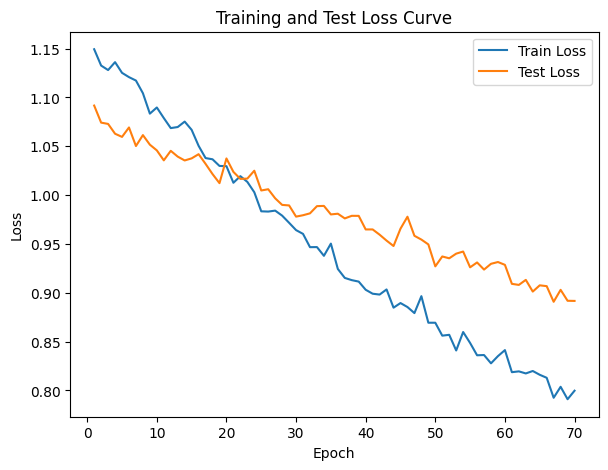

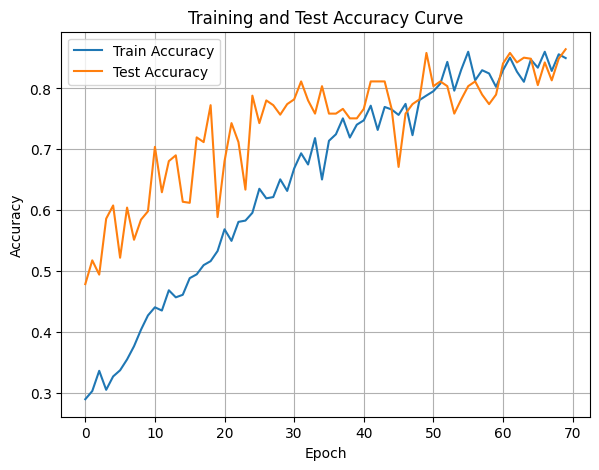

In [38]:
DTEmlp4b.train_single_model()

Randomly initializing 4 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.53it/s]

Epoch [1/10], Train F1:0.5468439250101994, Train Loss: 1.0265, Train Acc: 0.5247, Test F1:0.3966290008810364, Test Loss: 1.0787, Test Acc: 0.4253


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.06it/s]

Epoch [2/10], Train F1:0.5447518468902699, Train Loss: 1.0347, Train Acc: 0.5199, Test F1:0.35558508674787737, Test Loss: 1.0834, Test Acc: 0.3950
Epoch [3/10], Train F1:0.5300939930823773, Train Loss: 1.0379, Train Acc: 0.5059, Test F1:0.3896730271375169, Test Loss: 1.0817, Test Acc: 0.4065


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.06it/s]

Epoch [4/10], Train F1:0.5292202945188931, Train Loss: 1.0394, Train Acc: 0.5019, Test F1:0.48798251948634597, Test Loss: 1.0767, Test Acc: 0.4724


Training Process:  50%|█████     | 5/10 [00:00<00:00, 11.38it/s]

Epoch [5/10], Train F1:0.534529323512461, Train Loss: 1.0358, Train Acc: 0.5100, Test F1:0.5254870291592216, Test Loss: 1.0734, Test Acc: 0.5042
Epoch [6/10], Train F1:0.5428654139833139, Train Loss: 1.0308, Train Acc: 0.5189, Test F1:0.5635154016281855, Test Loss: 1.0702, Test Acc: 0.5331


Training Process:  70%|███████   | 7/10 [00:00<00:00, 11.51it/s]

Epoch [7/10], Train F1:0.559459979983652, Train Loss: 1.0238, Train Acc: 0.5352, Test F1:0.5899121690257114, Test Loss: 1.0682, Test Acc: 0.5569


Training Process:  70%|███████   | 7/10 [00:00<00:00, 11.51it/s]

Epoch [8/10], Train F1:0.5688003804568171, Train Loss: 1.0195, Train Acc: 0.5447, Test F1:0.6105375211210251, Test Loss: 1.0657, Test Acc: 0.5757


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 11.10it/s]

Epoch [9/10], Train F1:0.5756697269446286, Train Loss: 1.0172, Train Acc: 0.5482, Test F1:0.6016101965431283, Test Loss: 1.0657, Test Acc: 0.5684


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.61it/s]


Epoch [10/10], Train F1:0.5834277092009906, Train Loss: 1.0146, Train Acc: 0.5554, Test F1:0.6049647041688653, Test Loss: 1.0639, Test Acc: 0.5725
Total Epochs: 10
Train loss start: 0.9938802719116211, Train loss end: 1.0663477182388306
Highest Mean Train Accuracy (over epoch): 0.5553869047619048
Test loss start: 1.0658605098724365, Test loss end: 1.0510627031326294
Highest mean Test Accuracy (over epoch): 0.5757378472222222


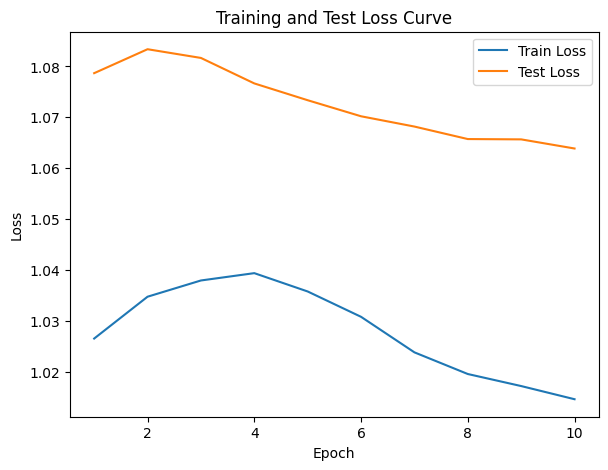

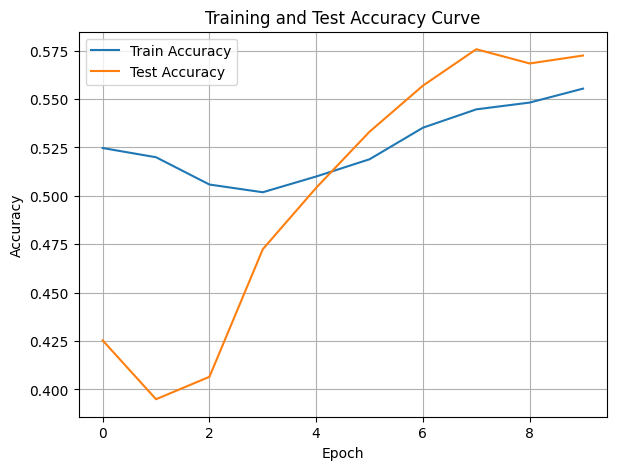

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.88it/s]

Epoch [1/10], Train F1:0.40990304621932916, Train Loss: 1.0870, Train Acc: 0.3702, Test F1:0.48043449585061043, Test Loss: 1.0746, Test Acc: 0.4957


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.88it/s]

Epoch [2/10], Train F1:0.4106041485212365, Train Loss: 1.0847, Train Acc: 0.3760, Test F1:0.5058154802748058, Test Loss: 1.0657, Test Acc: 0.5230


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.10it/s]

Epoch [3/10], Train F1:0.4202308104076129, Train Loss: 1.0819, Train Acc: 0.3852, Test F1:0.5182022655706866, Test Loss: 1.0610, Test Acc: 0.5394


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.10it/s]

Epoch [4/10], Train F1:0.4295455517152035, Train Loss: 1.0797, Train Acc: 0.3921, Test F1:0.529476972975425, Test Loss: 1.0570, Test Acc: 0.5545


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.50it/s]

Epoch [5/10], Train F1:0.44671279348270776, Train Loss: 1.0752, Train Acc: 0.4124, Test F1:0.5398994305699606, Test Loss: 1.0525, Test Acc: 0.5694


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.50it/s]

Epoch [6/10], Train F1:0.45083990337663216, Train Loss: 1.0701, Train Acc: 0.4205, Test F1:0.5449810193513779, Test Loss: 1.0470, Test Acc: 0.5804


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.64it/s]

Epoch [7/10], Train F1:0.4629732063655127, Train Loss: 1.0655, Train Acc: 0.4332, Test F1:0.5619762722442875, Test Loss: 1.0461, Test Acc: 0.5910


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.64it/s]

Epoch [8/10], Train F1:0.4692032234534633, Train Loss: 1.0616, Train Acc: 0.4416, Test F1:0.5715818244970468, Test Loss: 1.0441, Test Acc: 0.5997


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.86it/s]

Epoch [9/10], Train F1:0.47874835420570455, Train Loss: 1.0582, Train Acc: 0.4495, Test F1:0.5754521251015967, Test Loss: 1.0394, Test Acc: 0.6063


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.89it/s]


Epoch [10/10], Train F1:0.48771232361711464, Train Loss: 1.0545, Train Acc: 0.4585, Test F1:0.5853566359106526, Test Loss: 1.0380, Test Acc: 0.6127
Total Epochs: 10
Train loss start: 1.1343022584915161, Train loss end: 1.0345056056976318
Highest Mean Train Accuracy (over epoch): 0.45848214285714295
Test loss start: 1.0700422525405884, Test loss end: 1.028336763381958
Highest mean Test Accuracy (over epoch): 0.6126736111111111


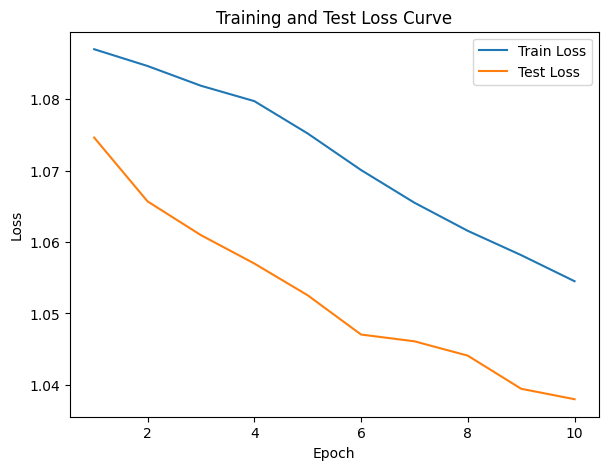

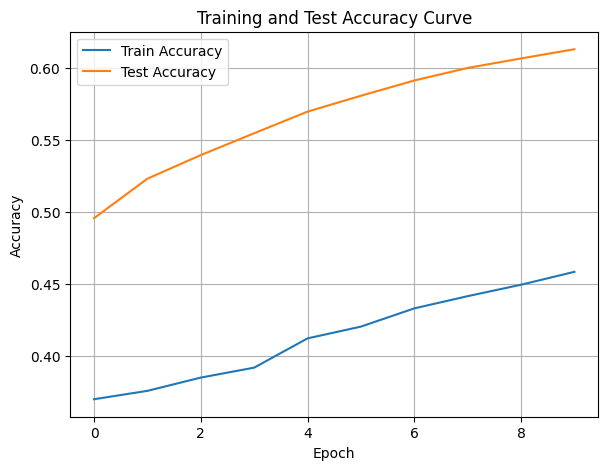

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.56it/s]

Epoch [1/10], Train F1:0.2978300456020664, Train Loss: 1.1670, Train Acc: 0.2491, Test F1:0.14317867036011078, Test Loss: 1.1370, Test Acc: 0.2118
Epoch [2/10], Train F1:0.2728957897292946, Train Loss: 1.1682, Train Acc: 0.2356, Test F1:0.13940008449514155, Test Loss: 1.1336, Test Acc: 0.2196


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.56it/s]

Epoch [3/10], Train F1:0.2872420001285981, Train Loss: 1.1632, Train Acc: 0.2523, Test F1:0.14543054063730754, Test Loss: 1.1338, Test Acc: 0.2280


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.59it/s]

Epoch [4/10], Train F1:0.2886021556835257, Train Loss: 1.1611, Train Acc: 0.2568, Test F1:0.1517338496743531, Test Loss: 1.1321, Test Acc: 0.2352


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.59it/s]

Epoch [5/10], Train F1:0.295358568578931, Train Loss: 1.1572, Train Acc: 0.2623, Test F1:0.15781419950383857, Test Loss: 1.1298, Test Acc: 0.2470


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.41it/s]

Epoch [6/10], Train F1:0.3011491812711945, Train Loss: 1.1550, Train Acc: 0.2660, Test F1:0.16263168800018507, Test Loss: 1.1270, Test Acc: 0.2585
Epoch [7/10], Train F1:0.30531258388136717, Train Loss: 1.1512, Train Acc: 0.2707, Test F1:0.16472375233985143, Test Loss: 1.1251, Test Acc: 0.2625


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.68it/s]

Epoch [8/10], Train F1:0.31310051868578465, Train Loss: 1.1476, Train Acc: 0.2768, Test F1:0.16918056469192172, Test Loss: 1.1228, Test Acc: 0.2700


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.81it/s]


Epoch [9/10], Train F1:0.31617846554532353, Train Loss: 1.1460, Train Acc: 0.2800, Test F1:0.1713732370107643, Test Loss: 1.1207, Test Acc: 0.2759
Epoch [10/10], Train F1:0.3231021506873491, Train Loss: 1.1435, Train Acc: 0.2854, Test F1:0.17350438820849523, Test Loss: 1.1195, Test Acc: 0.2815
Total Epochs: 10
Train loss start: 1.171416997909546, Train loss end: 1.2556873559951782
Highest Mean Train Accuracy (over epoch): 0.28541666666666665
Test loss start: 1.1505757570266724, Test loss end: 1.1013802289962769
Highest mean Test Accuracy (over epoch): 0.2815104166666667


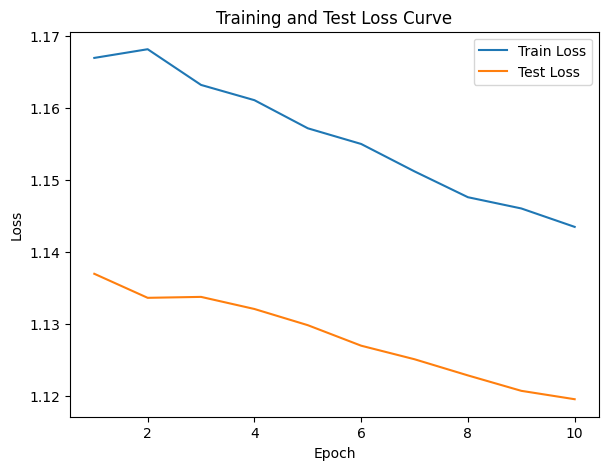

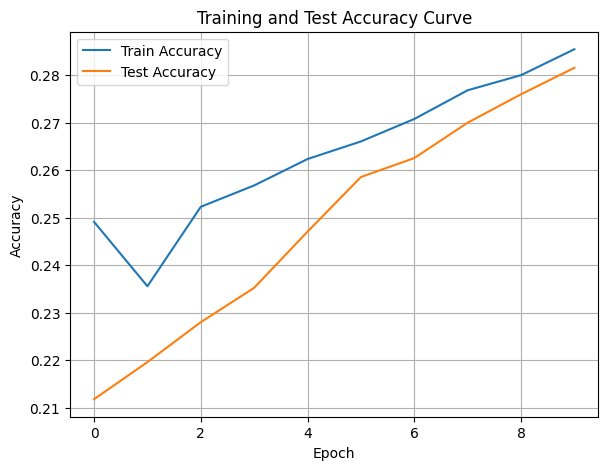

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.57it/s]

Epoch [1/10], Train F1:0.18601988487702772, Train Loss: 1.2186, Train Acc: 0.1387, Test F1:0.19138755980861247, Test Loss: 1.1233, Test Acc: 0.1589
Epoch [2/10], Train F1:0.18898209666070204, Train Loss: 1.2180, Train Acc: 0.1376, Test F1:0.1883904391852114, Test Loss: 1.1171, Test Acc: 0.1745


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.87it/s]

Epoch [3/10], Train F1:0.19778662466670816, Train Loss: 1.2183, Train Acc: 0.1411, Test F1:0.19785145683592237, Test Loss: 1.1159, Test Acc: 0.1869
Epoch [4/10], Train F1:0.2082677843780032, Train Loss: 1.2123, Train Acc: 0.1478, Test F1:0.20247339660626978, Test Loss: 1.1148, Test Acc: 0.1916
Epoch [5/10], Train F1:0.2107516890630008, Train Loss: 1.2092, Train Acc: 0.1524, Test F1:0.2087026783950809, Test Loss: 1.1121, Test Acc: 0.1984


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.76it/s]

Epoch [6/10], Train F1:0.21499139309693774, Train Loss: 1.2079, Train Acc: 0.1545, Test F1:0.21418992025456018, Test Loss: 1.1111, Test Acc: 0.2020
Epoch [7/10], Train F1:0.22263163518262444, Train Loss: 1.2045, Train Acc: 0.1616, Test F1:0.2131478120588829, Test Loss: 1.1109, Test Acc: 0.1958
Epoch [8/10], Train F1:0.23085186587597994, Train Loss: 1.2014, Train Acc: 0.1664, Test F1:0.21791317811110128, Test Loss: 1.1092, Test Acc: 0.1978


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.76it/s]


Epoch [9/10], Train F1:0.2392076838523968, Train Loss: 1.1972, Train Acc: 0.1733, Test F1:0.21976025183883896, Test Loss: 1.1082, Test Acc: 0.2000
Epoch [10/10], Train F1:0.2455493430509446, Train Loss: 1.1937, Train Acc: 0.1779, Test F1:0.21936663683140525, Test Loss: 1.1074, Test Acc: 0.2012
Total Epochs: 10
Train loss start: 1.2272846698760986, Train loss end: 1.143329381942749
Highest Mean Train Accuracy (over epoch): 0.17794642857142856
Test loss start: 1.1198501586914062, Test loss end: 1.0987902879714966
Highest mean Test Accuracy (over epoch): 0.20196759259259256


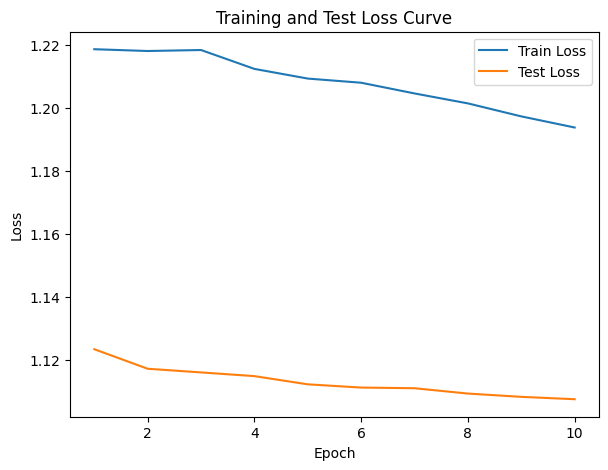

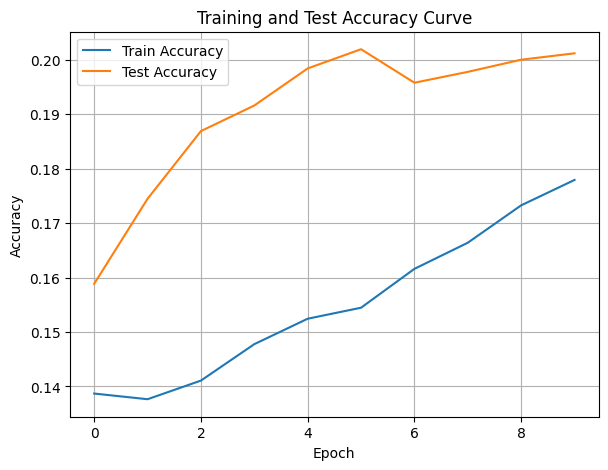

./saved_models/model_4.pth
Training Model with id 7
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.31177033275393934, Train Loss: 1.1584, Train Acc: 0.2357, Test F1:0.3187530705716414, Test Loss: 1.0896, Test Acc: 0.2665


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.17it/s]

Epoch [2/10], Train F1:0.31971081566866205, Train Loss: 1.1586, Train Acc: 0.2461, Test F1:0.3689987083876914, Test Loss: 1.0881, Test Acc: 0.2969
Epoch [3/10], Train F1:0.33323641200896476, Train Loss: 1.1525, Train Acc: 0.2590, Test F1:0.42327429220119106, Test Loss: 1.0848, Test Acc: 0.3371


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.30it/s]

Epoch [4/10], Train F1:0.3349983938780633, Train Loss: 1.1493, Train Acc: 0.2604, Test F1:0.39059975417443676, Test Loss: 1.0839, Test Acc: 0.3416


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.30it/s]

Epoch [5/10], Train F1:0.34434535774973485, Train Loss: 1.1459, Train Acc: 0.2657, Test F1:0.3794639096557923, Test Loss: 1.0814, Test Acc: 0.3458


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.90it/s]

Epoch [6/10], Train F1:0.34701099348027903, Train Loss: 1.1435, Train Acc: 0.2687, Test F1:0.4313733926877493, Test Loss: 1.0796, Test Acc: 0.3770
Epoch [7/10], Train F1:0.35623024720619767, Train Loss: 1.1404, Train Acc: 0.2761, Test F1:0.46301621500144124, Test Loss: 1.0781, Test Acc: 0.4024


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.42it/s]

Epoch [8/10], Train F1:0.3587658672132563, Train Loss: 1.1369, Train Acc: 0.2796, Test F1:0.4803499009785604, Test Loss: 1.0773, Test Acc: 0.4117


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.48it/s]


Epoch [9/10], Train F1:0.3672365081111209, Train Loss: 1.1337, Train Acc: 0.2863, Test F1:0.5138345679848572, Test Loss: 1.0765, Test Acc: 0.4345
Epoch [10/10], Train F1:0.3711192283469309, Train Loss: 1.1308, Train Acc: 0.2917, Test F1:0.5329438535267075, Test Loss: 1.0750, Test Acc: 0.4518
Total Epochs: 10
Train loss start: 1.1169285774230957, Train loss end: 1.111834168434143
Highest Mean Train Accuracy (over epoch): 0.2916666666666667
Test loss start: 1.086033582687378, Test loss end: 1.0600626468658447
Highest mean Test Accuracy (over epoch): 0.4518229166666667


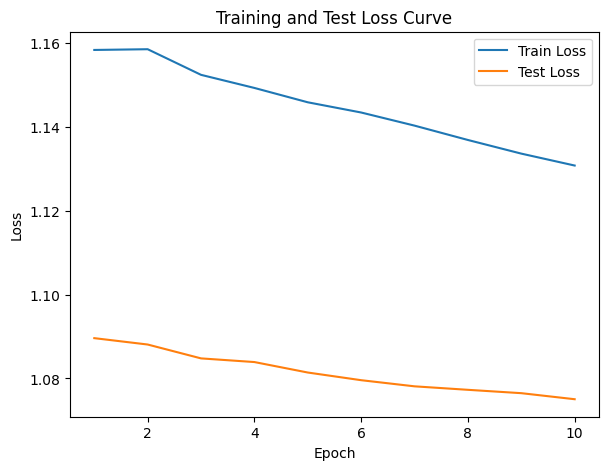

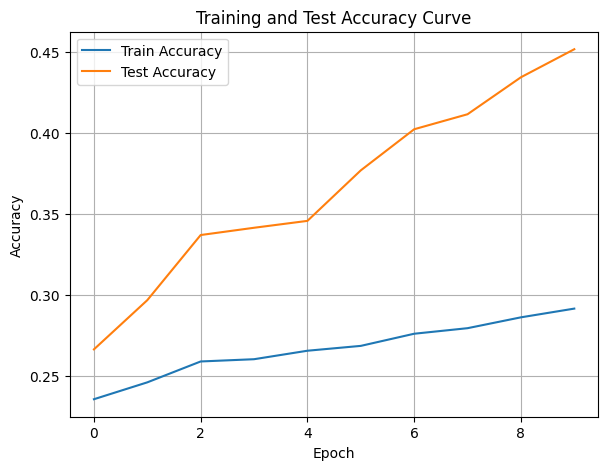

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4232750891438476, Train Loss: 1.0993, Train Acc: 0.3324, Test F1:0.7098945558776292, Test Loss: 1.0574, Test Acc: 0.6528


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.20it/s]

Epoch [2/10], Train F1:0.4358462019664205, Train Loss: 1.0953, Train Acc: 0.3429, Test F1:0.7115166949632145, Test Loss: 1.0551, Test Acc: 0.6606


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.68it/s]

Epoch [3/10], Train F1:0.45271794766233764, Train Loss: 1.0884, Train Acc: 0.3617, Test F1:0.7214877911345507, Test Loss: 1.0540, Test Acc: 0.6710


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.03it/s]

Epoch [4/10], Train F1:0.46824779232094194, Train Loss: 1.0853, Train Acc: 0.3763, Test F1:0.7314547585314233, Test Loss: 1.0521, Test Acc: 0.6821


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.32it/s]

Epoch [5/10], Train F1:0.48108025425298473, Train Loss: 1.0806, Train Acc: 0.3891, Test F1:0.7103085048532997, Test Loss: 1.0520, Test Acc: 0.6628


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.79it/s]

Epoch [6/10], Train F1:0.48609290058603477, Train Loss: 1.0777, Train Acc: 0.3953, Test F1:0.7036726117252048, Test Loss: 1.0508, Test Acc: 0.6576


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.92it/s]

Epoch [7/10], Train F1:0.5000043940752097, Train Loss: 1.0734, Train Acc: 0.4105, Test F1:0.7115311541031012, Test Loss: 1.0494, Test Acc: 0.6658


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.53it/s]

Epoch [8/10], Train F1:0.5130549255308487, Train Loss: 1.0687, Train Acc: 0.4244, Test F1:0.7163428283971578, Test Loss: 1.0483, Test Acc: 0.6720


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.65it/s]

Epoch [9/10], Train F1:0.5196036578997486, Train Loss: 1.0645, Train Acc: 0.4313, Test F1:0.7227054925895472, Test Loss: 1.0466, Test Acc: 0.6794


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.21it/s]


Epoch [10/10], Train F1:0.5281786698181943, Train Loss: 1.0609, Train Acc: 0.4393, Test F1:0.7279214203351015, Test Loss: 1.0451, Test Acc: 0.6853
Total Epochs: 10
Train loss start: 1.118544101715088, Train loss end: 1.0429552793502808
Highest Mean Train Accuracy (over epoch): 0.4393452380952381
Test loss start: 1.054111361503601, Test loss end: 1.0337164402008057
Highest mean Test Accuracy (over epoch): 0.685329861111111


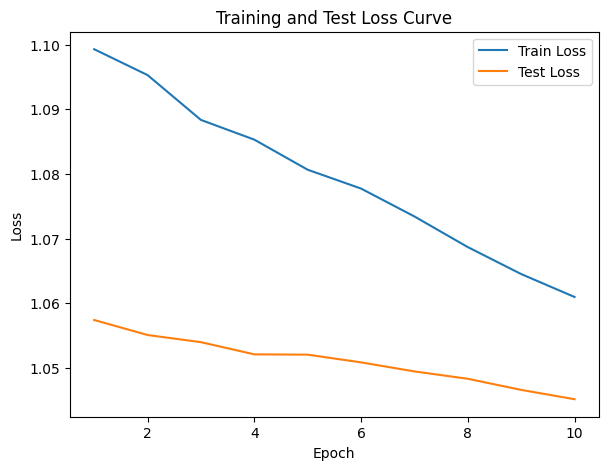

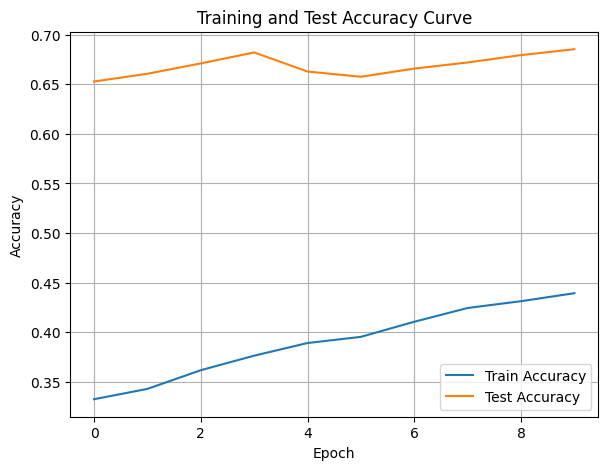

./saved_models/model_8.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  5.31it/s]

Epoch [1/10], Train F1:0.5945477414939734, Train Loss: 1.0349, Train Acc: 0.4833, Test F1:0.7533111434713264, Test Loss: 1.0312, Test Acc: 0.7292


Training Process:  30%|███       | 3/10 [00:00<00:01,  5.75it/s]

Epoch [2/10], Train F1:0.5969135282064297, Train Loss: 1.0277, Train Acc: 0.5051, Test F1:0.7516575519081942, Test Loss: 1.0305, Test Acc: 0.7192
Epoch [3/10], Train F1:0.6112742847573762, Train Loss: 1.0231, Train Acc: 0.5230, Test F1:0.7343925229752462, Test Loss: 1.0296, Test Acc: 0.7049


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.87it/s]

Epoch [4/10], Train F1:0.6297070441334661, Train Loss: 1.0178, Train Acc: 0.5416, Test F1:0.7363562753036438, Test Loss: 1.0298, Test Acc: 0.7059
Epoch [5/10], Train F1:0.6383015399185699, Train Loss: 1.0133, Train Acc: 0.5545, Test F1:0.7457961142171667, Test Loss: 1.0279, Test Acc: 0.7168


Training Process:  70%|███████   | 7/10 [00:01<00:00,  5.68it/s]

Epoch [6/10], Train F1:0.6497337132129293, Train Loss: 1.0087, Train Acc: 0.5670, Test F1:0.7533545415238496, Test Loss: 1.0258, Test Acc: 0.7254
Epoch [7/10], Train F1:0.6581408778390548, Train Loss: 1.0049, Train Acc: 0.5785, Test F1:0.7529550570724782, Test Loss: 1.0236, Test Acc: 0.7259


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.12it/s]

Epoch [8/10], Train F1:0.664663083657497, Train Loss: 1.0014, Train Acc: 0.5856, Test F1:0.7537535742274158, Test Loss: 1.0232, Test Acc: 0.7273


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.37it/s]


Epoch [9/10], Train F1:0.6723042165639597, Train Loss: 0.9981, Train Acc: 0.5939, Test F1:0.7569163152003471, Test Loss: 1.0223, Test Acc: 0.7310
Epoch [10/10], Train F1:0.683629191321499, Train Loss: 0.9936, Train Acc: 0.6040, Test F1:0.7611748854241179, Test Loss: 1.0204, Test Acc: 0.7361
Total Epochs: 10
Train loss start: 1.0460295677185059, Train loss end: 1.1379295587539673
Highest Mean Train Accuracy (over epoch): 0.6039583333333334
Test loss start: 1.0260106325149536, Test loss end: 1.003023624420166
Highest mean Test Accuracy (over epoch): 0.736111111111111


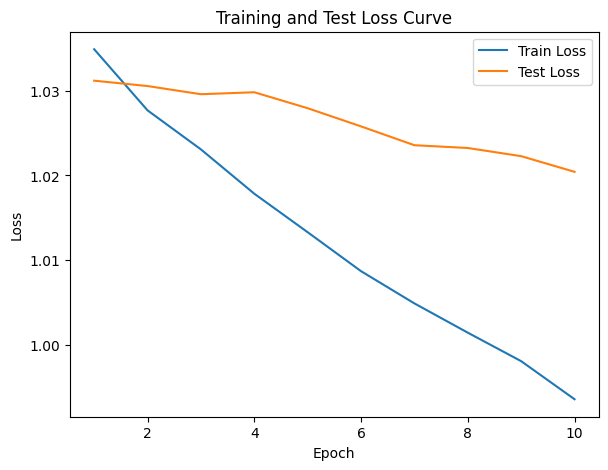

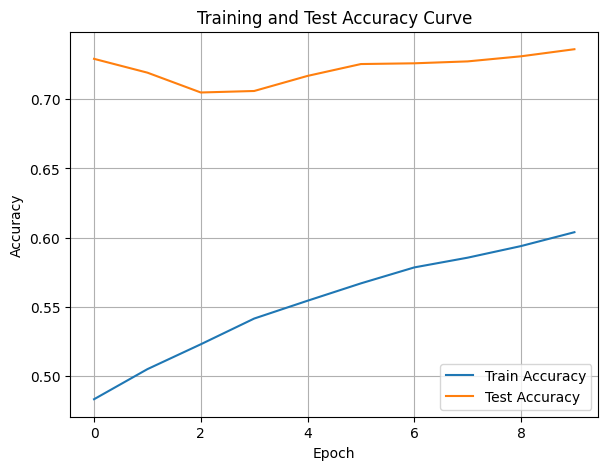

./saved_models/model_6.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [39]:
DTEmlp4b.train_DTE()

Training Process:   3%|▎         | 2/70 [00:00<00:12,  5.47it/s]

Epoch [1/70], Train F1:0.4217319974208469, Train Loss: 1.1156, Train Acc: 0.3390, Test F1:0.4517237148816097, Test Loss: 1.1022, Test Acc: 0.4253
Epoch [2/70], Train F1:0.4367272228395824, Train Loss: 1.1123, Train Acc: 0.3457, Test F1:0.4704764623367112, Test Loss: 1.1001, Test Acc: 0.4401


Training Process:   6%|▌         | 4/70 [00:00<00:10,  6.53it/s]

Epoch [3/70], Train F1:0.43128339199313537, Train Loss: 1.1135, Train Acc: 0.3417, Test F1:0.48660641088703066, Test Loss: 1.0973, Test Acc: 0.4601
Epoch [4/70], Train F1:0.4376491285223551, Train Loss: 1.1099, Train Acc: 0.3469, Test F1:0.4882953620208292, Test Loss: 1.0962, Test Acc: 0.4553


Training Process:   9%|▊         | 6/70 [00:00<00:08,  7.45it/s]

Epoch [5/70], Train F1:0.44487127897993917, Train Loss: 1.1052, Train Acc: 0.3577, Test F1:0.4952165773557107, Test Loss: 1.0939, Test Acc: 0.4665
Epoch [6/70], Train F1:0.45346968907252905, Train Loss: 1.1017, Train Acc: 0.3657, Test F1:0.4975013848282073, Test Loss: 1.0936, Test Acc: 0.4641


Training Process:  11%|█▏        | 8/70 [00:01<00:07,  8.50it/s]

Epoch [7/70], Train F1:0.4548672669223485, Train Loss: 1.0993, Train Acc: 0.3702, Test F1:0.50887296904996, Test Loss: 1.0908, Test Acc: 0.4804
Epoch [8/70], Train F1:0.4655491061639269, Train Loss: 1.0957, Train Acc: 0.3800, Test F1:0.513095238095238, Test Loss: 1.0875, Test Acc: 0.4944


Training Process:  14%|█▍        | 10/70 [00:01<00:06,  8.92it/s]

Epoch [9/70], Train F1:0.4786578405120854, Train Loss: 1.0903, Train Acc: 0.3932, Test F1:0.5172070061553975, Test Loss: 1.0852, Test Acc: 0.5035
Epoch [10/70], Train F1:0.48689430996521166, Train Loss: 1.0870, Train Acc: 0.4023, Test F1:0.5226621424985862, Test Loss: 1.0838, Test Acc: 0.5109


Training Process:  17%|█▋        | 12/70 [00:01<00:06,  9.34it/s]

Epoch [11/70], Train F1:0.49624456377308085, Train Loss: 1.0838, Train Acc: 0.4136, Test F1:0.527913907818214, Test Loss: 1.0825, Test Acc: 0.5183
Epoch [12/70], Train F1:0.501730205882121, Train Loss: 1.0823, Train Acc: 0.4198, Test F1:0.533024992522561, Test Loss: 1.0806, Test Acc: 0.5264


Training Process:  20%|██        | 14/70 [00:01<00:06,  8.08it/s]

Epoch [13/70], Train F1:0.5090605490279616, Train Loss: 1.0793, Train Acc: 0.4277, Test F1:0.5394177730574307, Test Loss: 1.0782, Test Acc: 0.5361
Epoch [14/70], Train F1:0.5172153106229072, Train Loss: 1.0759, Train Acc: 0.4373, Test F1:0.543949860807996, Test Loss: 1.0756, Test Acc: 0.5453


Training Process:  23%|██▎       | 16/70 [00:02<00:06,  8.19it/s]

Epoch [15/70], Train F1:0.525500247896766, Train Loss: 1.0729, Train Acc: 0.4463, Test F1:0.5493391275572675, Test Loss: 1.0739, Test Acc: 0.5521
Epoch [16/70], Train F1:0.5338625871561788, Train Loss: 1.0698, Train Acc: 0.4555, Test F1:0.5540189316284586, Test Loss: 1.0720, Test Acc: 0.5584


Training Process:  26%|██▌       | 18/70 [00:02<00:06,  8.18it/s]

Epoch [17/70], Train F1:0.5419753126414294, Train Loss: 1.0662, Train Acc: 0.4647, Test F1:0.5579354875446703, Test Loss: 1.0696, Test Acc: 0.5648
Epoch [18/70], Train F1:0.5468917501532488, Train Loss: 1.0636, Train Acc: 0.4707, Test F1:0.5623920432952417, Test Loss: 1.0670, Test Acc: 0.5710


Training Process:  27%|██▋       | 19/70 [00:02<00:06,  7.94it/s]

Epoch [19/70], Train F1:0.554851303968565, Train Loss: 1.0606, Train Acc: 0.4792, Test F1:0.565062630176213, Test Loss: 1.0642, Test Acc: 0.5762


Training Process:  29%|██▊       | 20/70 [00:02<00:07,  6.38it/s]

Epoch [20/70], Train F1:0.5613973554417596, Train Loss: 1.0572, Train Acc: 0.4871, Test F1:0.5720632858196066, Test Loss: 1.0623, Test Acc: 0.5833


Training Process:  30%|███       | 21/70 [00:02<00:08,  5.49it/s]

Epoch [21/70], Train F1:0.5682556182280892, Train Loss: 1.0540, Train Acc: 0.4942, Test F1:0.575814193551348, Test Loss: 1.0603, Test Acc: 0.5884


Training Process:  31%|███▏      | 22/70 [00:03<00:09,  5.19it/s]

Epoch [22/70], Train F1:0.5742471614334793, Train Loss: 1.0508, Train Acc: 0.5012, Test F1:0.5808090200018531, Test Loss: 1.0584, Test Acc: 0.5943


Training Process:  33%|███▎      | 23/70 [00:03<00:09,  5.12it/s]

Epoch [23/70], Train F1:0.5813853049751704, Train Loss: 1.0471, Train Acc: 0.5088, Test F1:0.5854663504398582, Test Loss: 1.0562, Test Acc: 0.6003


Training Process:  34%|███▍      | 24/70 [00:03<00:09,  4.66it/s]

Epoch [24/70], Train F1:0.5877423613872249, Train Loss: 1.0436, Train Acc: 0.5163, Test F1:0.5912070604701639, Test Loss: 1.0536, Test Acc: 0.6062


Epoch [25/70], Train F1:0.5934133858751413, Train Loss: 1.0401, Train Acc: 0.5237, Test F1:0.5956549114091194, Test Loss: 1.0511, Test Acc: 0.6113


Training Process:  39%|███▊      | 27/70 [00:04<00:08,  5.15it/s]

Epoch [26/70], Train F1:0.5996981187186134, Train Loss: 1.0368, Train Acc: 0.5308, Test F1:0.6021682621842199, Test Loss: 1.0486, Test Acc: 0.6172
Epoch [27/70], Train F1:0.604091607432847, Train Loss: 1.0339, Train Acc: 0.5357, Test F1:0.6066502334878695, Test Loss: 1.0462, Test Acc: 0.6221


Training Process:  41%|████▏     | 29/70 [00:04<00:06,  5.99it/s]

Epoch [28/70], Train F1:0.6095798666678153, Train Loss: 1.0305, Train Acc: 0.5425, Test F1:0.6104118989290854, Test Loss: 1.0436, Test Acc: 0.6266
Epoch [29/70], Train F1:0.6160494244083672, Train Loss: 1.0267, Train Acc: 0.5502, Test F1:0.6141236479191831, Test Loss: 1.0409, Test Acc: 0.6311


Training Process:  44%|████▍     | 31/70 [00:04<00:05,  6.67it/s]

Epoch [30/70], Train F1:0.6218078666738928, Train Loss: 1.0232, Train Acc: 0.5571, Test F1:0.6175628147516311, Test Loss: 1.0385, Test Acc: 0.6353
Epoch [31/70], Train F1:0.6271643656451098, Train Loss: 1.0203, Train Acc: 0.5630, Test F1:0.6210703041929804, Test Loss: 1.0363, Test Acc: 0.6391


Training Process:  47%|████▋     | 33/70 [00:04<00:05,  7.29it/s]

Epoch [32/70], Train F1:0.6324049810974246, Train Loss: 1.0170, Train Acc: 0.5692, Test F1:0.625335368381701, Test Loss: 1.0340, Test Acc: 0.6432
Epoch [33/70], Train F1:0.6367577425060806, Train Loss: 1.0139, Train Acc: 0.5746, Test F1:0.6291194368046505, Test Loss: 1.0319, Test Acc: 0.6473


Training Process:  50%|█████     | 35/70 [00:05<00:04,  7.26it/s]

Epoch [34/70], Train F1:0.6424163627663413, Train Loss: 1.0104, Train Acc: 0.5816, Test F1:0.632094589422785, Test Loss: 1.0296, Test Acc: 0.6508
Epoch [35/70], Train F1:0.6471952369863125, Train Loss: 1.0073, Train Acc: 0.5872, Test F1:0.6348832657290686, Test Loss: 1.0272, Test Acc: 0.6540


Training Process:  53%|█████▎    | 37/70 [00:05<00:05,  6.49it/s]

Epoch [36/70], Train F1:0.6529728602828564, Train Loss: 1.0045, Train Acc: 0.5931, Test F1:0.6375024684936926, Test Loss: 1.0248, Test Acc: 0.6571
Epoch [37/70], Train F1:0.6580026721167115, Train Loss: 1.0011, Train Acc: 0.5991, Test F1:0.6406258934980384, Test Loss: 1.0224, Test Acc: 0.6602


Training Process:  56%|█████▌    | 39/70 [00:05<00:04,  6.56it/s]

Epoch [38/70], Train F1:0.6610100970567473, Train Loss: 0.9982, Train Acc: 0.6036, Test F1:0.6429275451648228, Test Loss: 1.0201, Test Acc: 0.6630
Epoch [39/70], Train F1:0.6648506529691959, Train Loss: 0.9954, Train Acc: 0.6083, Test F1:0.6462860569055778, Test Loss: 1.0176, Test Acc: 0.6664


Training Process:  59%|█████▊    | 41/70 [00:06<00:04,  6.39it/s]

Epoch [40/70], Train F1:0.6693459933543661, Train Loss: 0.9924, Train Acc: 0.6136, Test F1:0.6490731313694383, Test Loss: 1.0154, Test Acc: 0.6694
Epoch [41/70], Train F1:0.6739340450327712, Train Loss: 0.9892, Train Acc: 0.6191, Test F1:0.6517095481684483, Test Loss: 1.0134, Test Acc: 0.6722


Training Process:  61%|██████▏   | 43/70 [00:06<00:04,  6.52it/s]

Epoch [42/70], Train F1:0.6777749731277883, Train Loss: 0.9863, Train Acc: 0.6236, Test F1:0.6534857367379737, Test Loss: 1.0116, Test Acc: 0.6744
Epoch [43/70], Train F1:0.6813291568253398, Train Loss: 0.9835, Train Acc: 0.6280, Test F1:0.655173256771352, Test Loss: 1.0095, Test Acc: 0.6765


Training Process:  64%|██████▍   | 45/70 [00:06<00:04,  6.05it/s]

Epoch [44/70], Train F1:0.6849778431015883, Train Loss: 0.9806, Train Acc: 0.6326, Test F1:0.6571207125662432, Test Loss: 1.0075, Test Acc: 0.6788
Epoch [45/70], Train F1:0.6877145785982458, Train Loss: 0.9783, Train Acc: 0.6363, Test F1:0.6590459289619615, Test Loss: 1.0056, Test Acc: 0.6811


Training Process:  66%|██████▌   | 46/70 [00:06<00:03,  6.08it/s]

Epoch [46/70], Train F1:0.6914432072599173, Train Loss: 0.9753, Train Acc: 0.6409, Test F1:0.6617839889040462, Test Loss: 1.0037, Test Acc: 0.6837


Training Process:  69%|██████▊   | 48/70 [00:07<00:03,  5.92it/s]

Epoch [47/70], Train F1:0.6948392866688358, Train Loss: 0.9726, Train Acc: 0.6452, Test F1:0.6640755227179423, Test Loss: 1.0019, Test Acc: 0.6860
Epoch [48/70], Train F1:0.6971308290758303, Train Loss: 0.9702, Train Acc: 0.6481, Test F1:0.6659535425061847, Test Loss: 0.9998, Test Acc: 0.6881


Training Process:  71%|███████▏  | 50/70 [00:07<00:03,  6.28it/s]

Epoch [49/70], Train F1:0.6993516890630066, Train Loss: 0.9678, Train Acc: 0.6512, Test F1:0.6671464988211746, Test Loss: 0.9979, Test Acc: 0.6897
Epoch [50/70], Train F1:0.702247807358433, Train Loss: 0.9652, Train Acc: 0.6545, Test F1:0.6691708385416341, Test Loss: 0.9960, Test Acc: 0.6918


Training Process:  74%|███████▍  | 52/70 [00:07<00:02,  6.40it/s]

Epoch [51/70], Train F1:0.7046317837170759, Train Loss: 0.9627, Train Acc: 0.6575, Test F1:0.670533853721414, Test Loss: 0.9941, Test Acc: 0.6935
Epoch [52/70], Train F1:0.7074441717679155, Train Loss: 0.9602, Train Acc: 0.6609, Test F1:0.6729629870823512, Test Loss: 0.9922, Test Acc: 0.6957


Training Process:  77%|███████▋  | 54/70 [00:08<00:02,  6.45it/s]

Epoch [53/70], Train F1:0.7099972903749805, Train Loss: 0.9576, Train Acc: 0.6642, Test F1:0.6755626512388317, Test Loss: 0.9902, Test Acc: 0.6980
Epoch [54/70], Train F1:0.7124509852256488, Train Loss: 0.9551, Train Acc: 0.6675, Test F1:0.6767156693628354, Test Loss: 0.9882, Test Acc: 0.6995


Training Process:  80%|████████  | 56/70 [00:08<00:02,  6.45it/s]

Epoch [55/70], Train F1:0.7146141166203527, Train Loss: 0.9528, Train Acc: 0.6705, Test F1:0.679264622192245, Test Loss: 0.9864, Test Acc: 0.7016
Epoch [56/70], Train F1:0.7168396863996414, Train Loss: 0.9505, Train Acc: 0.6733, Test F1:0.6797889695278342, Test Loss: 0.9845, Test Acc: 0.7026


Training Process:  81%|████████▏ | 57/70 [00:08<00:02,  6.46it/s]

Epoch [57/70], Train F1:0.7190349925077824, Train Loss: 0.9481, Train Acc: 0.6763, Test F1:0.6805460587249212, Test Loss: 0.9827, Test Acc: 0.7036


Training Process:  84%|████████▍ | 59/70 [00:09<00:02,  5.49it/s]

Epoch [58/70], Train F1:0.7213265569078898, Train Loss: 0.9457, Train Acc: 0.6791, Test F1:0.6812758981337018, Test Loss: 0.9808, Test Acc: 0.7047
Epoch [59/70], Train F1:0.7241028560850858, Train Loss: 0.9433, Train Acc: 0.6822, Test F1:0.6817375412724667, Test Loss: 0.9788, Test Acc: 0.7056


Training Process:  86%|████████▌ | 60/70 [00:09<00:01,  5.44it/s]

Epoch [60/70], Train F1:0.7263530397927175, Train Loss: 0.9410, Train Acc: 0.6849, Test F1:0.683135187745637, Test Loss: 0.9771, Test Acc: 0.7071


Training Process:  87%|████████▋ | 61/70 [00:09<00:01,  5.50it/s]

Epoch [61/70], Train F1:0.7284561593239002, Train Loss: 0.9389, Train Acc: 0.6872, Test F1:0.684483154765964, Test Loss: 0.9753, Test Acc: 0.7085


Training Process:  90%|█████████ | 63/70 [00:09<00:01,  5.48it/s]

Epoch [62/70], Train F1:0.7304830994583142, Train Loss: 0.9367, Train Acc: 0.6898, Test F1:0.6860128175373438, Test Loss: 0.9737, Test Acc: 0.7100
Epoch [63/70], Train F1:0.7327562442947674, Train Loss: 0.9344, Train Acc: 0.6927, Test F1:0.6865908678514843, Test Loss: 0.9718, Test Acc: 0.7109


Training Process:  93%|█████████▎| 65/70 [00:10<00:00,  5.43it/s]

Epoch [64/70], Train F1:0.7348422609136458, Train Loss: 0.9322, Train Acc: 0.6955, Test F1:0.6873711635117254, Test Loss: 0.9701, Test Acc: 0.7119
Epoch [65/70], Train F1:0.736743348315305, Train Loss: 0.9301, Train Acc: 0.6977, Test F1:0.6887773842168003, Test Loss: 0.9684, Test Acc: 0.7133


Training Process:  94%|█████████▍| 66/70 [00:10<00:00,  5.51it/s]

Epoch [66/70], Train F1:0.7387852610768852, Train Loss: 0.9279, Train Acc: 0.7002, Test F1:0.6907758214247228, Test Loss: 0.9667, Test Acc: 0.7150


Training Process:  96%|█████████▌| 67/70 [00:10<00:00,  5.17it/s]

Epoch [67/70], Train F1:0.7402566721384611, Train Loss: 0.9258, Train Acc: 0.7023, Test F1:0.6918709942569002, Test Loss: 0.9650, Test Acc: 0.7162


Training Process:  97%|█████████▋| 68/70 [00:10<00:00,  4.86it/s]

Epoch [68/70], Train F1:0.7422359505675904, Train Loss: 0.9239, Train Acc: 0.7046, Test F1:0.6923143576826506, Test Loss: 0.9635, Test Acc: 0.7169


Training Process:  99%|█████████▊| 69/70 [00:11<00:00,  4.85it/s]

Epoch [69/70], Train F1:0.7440077716070022, Train Loss: 0.9219, Train Acc: 0.7069, Test F1:0.6937568957555633, Test Loss: 0.9619, Test Acc: 0.7183


Training Process: 100%|██████████| 70/70 [00:11<00:00,  6.16it/s]


Epoch [70/70], Train F1:0.7456144672407465, Train Loss: 0.9199, Train Acc: 0.7088, Test F1:0.6951541220682337, Test Loss: 0.9603, Test Acc: 0.7196
Total Epochs: 70
Train loss start: 1.0943504571914673, Train loss end: 0.8063675761222839
Highest Mean Train Accuracy (over epoch): 0.7088350340136055
Test loss start: 1.0946069955825806, Test loss end: 0.8302106857299805
Highest Mean Test Accuracy (over epoch): 0.7195684523809525


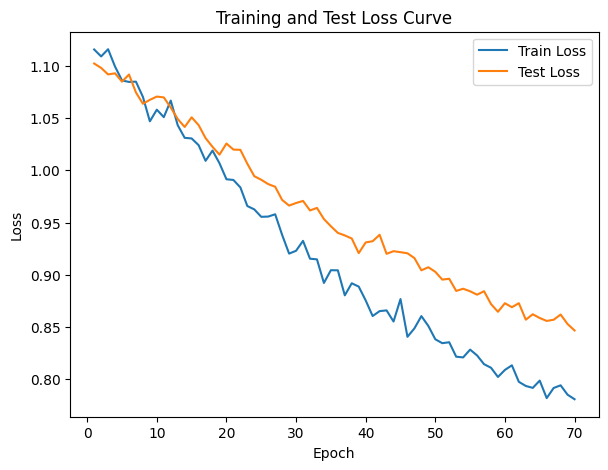

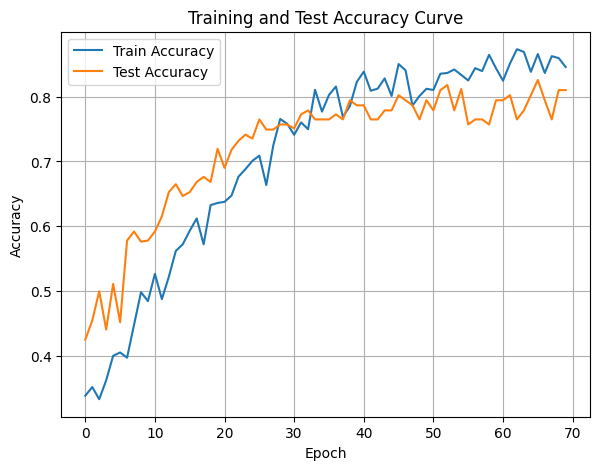

In [40]:
DTEmlp4b.train_single_model()

Randomly initializing 4 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:02,  3.66it/s]

Epoch [1/10], Train F1:0.2955360949111397, Train Loss: 1.1490, Train Acc: 0.2437, Test F1:0.3332326588140542, Test Loss: 1.1021, Test Acc: 0.2648


Training Process:  20%|██        | 2/10 [00:00<00:01,  4.31it/s]

Epoch [2/10], Train F1:0.32490819367851975, Train Loss: 1.1436, Train Acc: 0.2710, Test F1:0.32054717833848384, Test Loss: 1.1099, Test Acc: 0.2500
Epoch [3/10], Train F1:0.3281049834866507, Train Loss: 1.1401, Train Acc: 0.2759, Test F1:0.3268082486919052, Test Loss: 1.1068, Test Acc: 0.2581


Training Process:  40%|████      | 4/10 [00:00<00:01,  4.72it/s]

Epoch [4/10], Train F1:0.3385799638828379, Train Loss: 1.1385, Train Acc: 0.2822, Test F1:0.3333772086522129, Test Loss: 1.1063, Test Acc: 0.2661


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.09it/s]

Epoch [5/10], Train F1:0.3389150095218907, Train Loss: 1.1358, Train Acc: 0.2861, Test F1:0.33698514872312674, Test Loss: 1.1047, Test Acc: 0.2724
Epoch [6/10], Train F1:0.34112979354728457, Train Loss: 1.1332, Train Acc: 0.2913, Test F1:0.3438174553971499, Test Loss: 1.1020, Test Acc: 0.2826


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.65it/s]

Epoch [7/10], Train F1:0.34873108361843747, Train Loss: 1.1301, Train Acc: 0.2982, Test F1:0.3446804845176831, Test Loss: 1.1018, Test Acc: 0.2814
Epoch [8/10], Train F1:0.35677091280324624, Train Loss: 1.1270, Train Acc: 0.3050, Test F1:0.35079379472161776, Test Loss: 1.0999, Test Acc: 0.2854


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.36it/s]


Epoch [9/10], Train F1:0.36165853566251077, Train Loss: 1.1241, Train Acc: 0.3093, Test F1:0.3577080273688764, Test Loss: 1.0978, Test Acc: 0.2916
Epoch [10/10], Train F1:0.37042804218901515, Train Loss: 1.1207, Train Acc: 0.3170, Test F1:0.3639425109841728, Test Loss: 1.0955, Test Acc: 0.2959
Total Epochs: 10
Train loss start: 1.187800407409668, Train loss end: 1.1996203660964966
Highest Mean Train Accuracy (over epoch): 0.3169642857142857
Test loss start: 1.111124038696289, Test loss end: 1.0645842552185059
Highest mean Test Accuracy (over epoch): 0.2959201388888889


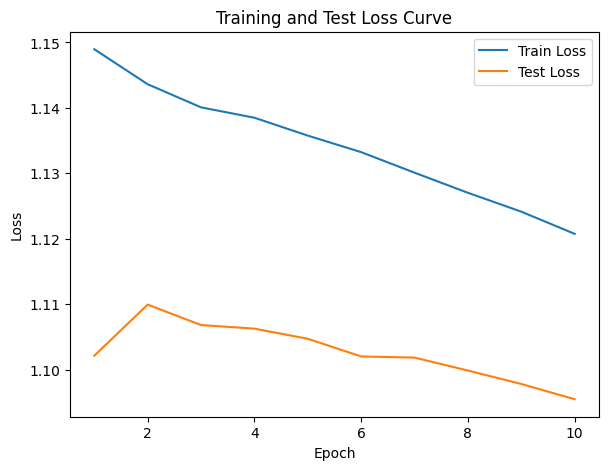

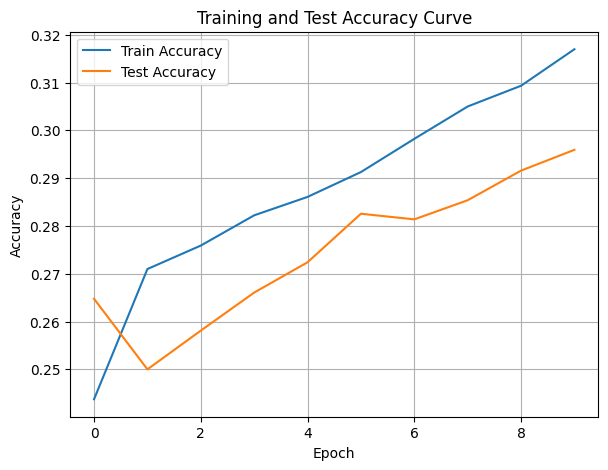

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.41it/s]

Epoch [1/10], Train F1:0.3508303461244638, Train Loss: 1.1176, Train Acc: 0.2804, Test F1:0.262280701754386, Test Loss: 1.1198, Test Acc: 0.1962


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.60it/s]

Epoch [2/10], Train F1:0.355294926770891, Train Loss: 1.1180, Train Acc: 0.2878, Test F1:0.24673692932034919, Test Loss: 1.1259, Test Acc: 0.1784


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.44it/s]

Epoch [3/10], Train F1:0.3583086837596714, Train Loss: 1.1184, Train Acc: 0.2863, Test F1:0.22942709710080153, Test Loss: 1.1242, Test Acc: 0.1698


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.44it/s]

Epoch [4/10], Train F1:0.3666265295878586, Train Loss: 1.1159, Train Acc: 0.2950, Test F1:0.2401189126072864, Test Loss: 1.1246, Test Acc: 0.1773


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.91it/s]

Epoch [5/10], Train F1:0.3736605465169332, Train Loss: 1.1146, Train Acc: 0.3023, Test F1:0.250635343043355, Test Loss: 1.1231, Test Acc: 0.1889


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.91it/s]

Epoch [6/10], Train F1:0.3852380043389117, Train Loss: 1.1100, Train Acc: 0.3140, Test F1:0.2586029744663431, Test Loss: 1.1224, Test Acc: 0.1943


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.90it/s]

Epoch [7/10], Train F1:0.38701948165119204, Train Loss: 1.1065, Train Acc: 0.3177, Test F1:0.2665940619931558, Test Loss: 1.1206, Test Acc: 0.2001


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.44it/s]

Epoch [8/10], Train F1:0.396292003075148, Train Loss: 1.1027, Train Acc: 0.3283, Test F1:0.27826424635770547, Test Loss: 1.1188, Test Acc: 0.2092


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.90it/s]

Epoch [9/10], Train F1:0.4047509059705515, Train Loss: 1.1000, Train Acc: 0.3362, Test F1:0.28709485578352667, Test Loss: 1.1163, Test Acc: 0.2169


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.49it/s]


Epoch [10/10], Train F1:0.4093808731439269, Train Loss: 1.0971, Train Acc: 0.3425, Test F1:0.29843351631663567, Test Loss: 1.1139, Test Acc: 0.2223
Total Epochs: 10
Train loss start: 1.1153217554092407, Train loss end: 0.9968952536582947
Highest Mean Train Accuracy (over epoch): 0.3424702380952381
Test loss start: 1.1168434619903564, Test loss end: 1.0923495292663574
Highest mean Test Accuracy (over epoch): 0.22230902777777778


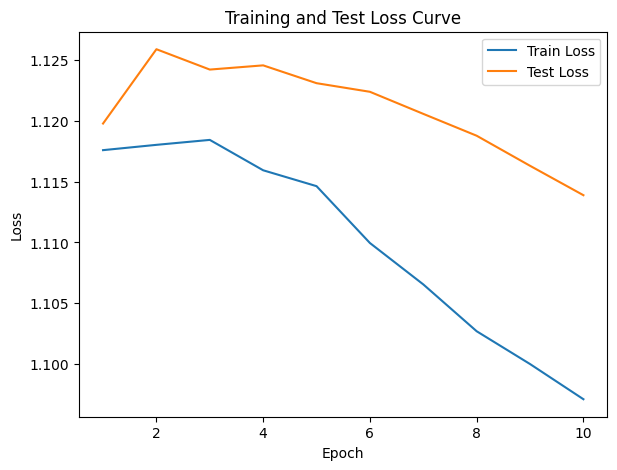

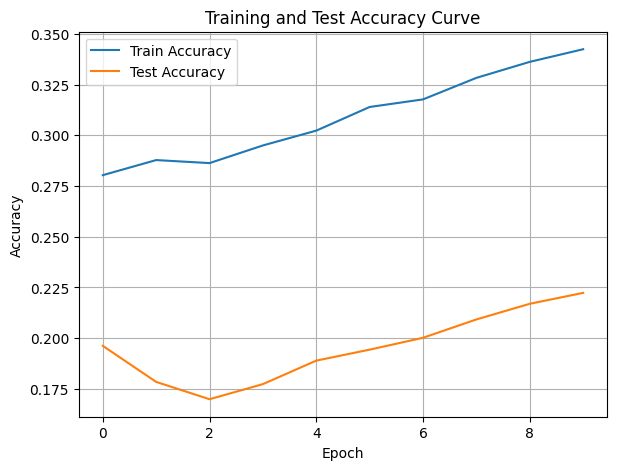

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.75it/s]

Epoch [1/10], Train F1:0.46731574304192053, Train Loss: 1.0539, Train Acc: 0.4307, Test F1:0.3408496816050875, Test Loss: 1.0995, Test Acc: 0.2231


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.84it/s]

Epoch [2/10], Train F1:0.48304446544946467, Train Loss: 1.0476, Train Acc: 0.4475, Test F1:0.3185570039915205, Test Loss: 1.0995, Test Acc: 0.2214


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.84it/s]

Epoch [3/10], Train F1:0.4880001420965128, Train Loss: 1.0465, Train Acc: 0.4470, Test F1:0.3430629939931417, Test Loss: 1.0978, Test Acc: 0.2416


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.34it/s]

Epoch [4/10], Train F1:0.5066505546644465, Train Loss: 1.0416, Train Acc: 0.4603, Test F1:0.3567730136151189, Test Loss: 1.0964, Test Acc: 0.2572
Epoch [5/10], Train F1:0.5057931713716165, Train Loss: 1.0394, Train Acc: 0.4605, Test F1:0.36213979841842214, Test Loss: 1.0956, Test Acc: 0.2590


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.46it/s]

Epoch [6/10], Train F1:0.5031445972694352, Train Loss: 1.0394, Train Acc: 0.4622, Test F1:0.39659456148955763, Test Loss: 1.0922, Test Acc: 0.2834
Epoch [7/10], Train F1:0.5103363212968769, Train Loss: 1.0354, Train Acc: 0.4705, Test F1:0.40995384365892656, Test Loss: 1.0902, Test Acc: 0.2992


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.60it/s]

Epoch [8/10], Train F1:0.5253038166610571, Train Loss: 1.0305, Train Acc: 0.4848, Test F1:0.43943385370122945, Test Loss: 1.0874, Test Acc: 0.3216
Epoch [9/10], Train F1:0.5327004351957598, Train Loss: 1.0289, Train Acc: 0.4892, Test F1:0.4490853693377281, Test Loss: 1.0857, Test Acc: 0.3323


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.21it/s]


Epoch [10/10], Train F1:0.542122295583736, Train Loss: 1.0240, Train Acc: 0.4977, Test F1:0.46993897317775646, Test Loss: 1.0837, Test Acc: 0.3506
Total Epochs: 10
Train loss start: 1.038779377937317, Train loss end: 0.9468401670455933
Highest Mean Train Accuracy (over epoch): 0.4977083333333333
Test loss start: 1.0995349884033203, Test loss end: 1.061169147491455
Highest mean Test Accuracy (over epoch): 0.3506076388888889


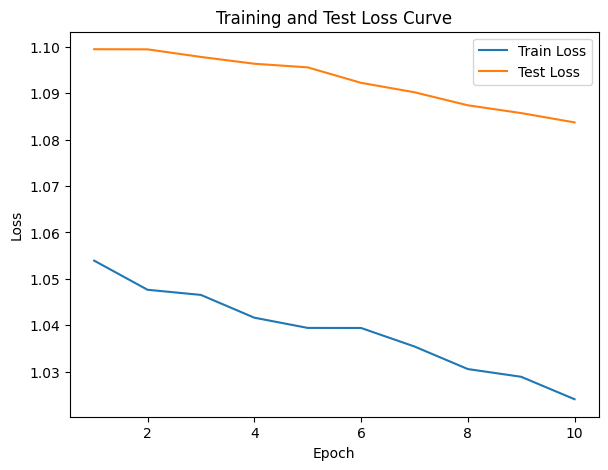

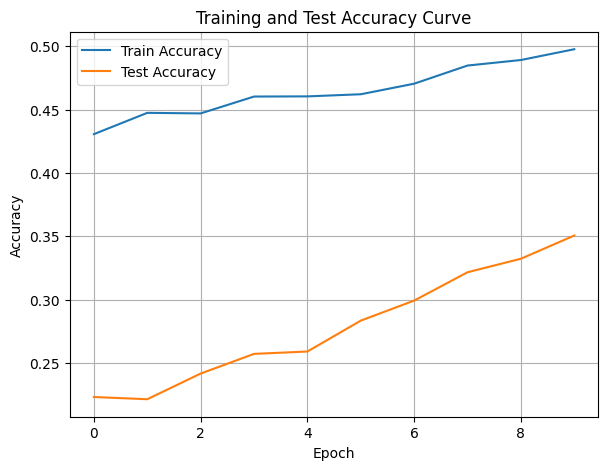

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4657172462310637, Train Loss: 1.0687, Train Acc: 0.4247, Test F1:0.32327512875636044, Test Loss: 1.0868, Test Acc: 0.2760


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.20it/s]

Epoch [2/10], Train F1:0.44850930068321365, Train Loss: 1.0705, Train Acc: 0.4037, Test F1:0.32375417070283063, Test Loss: 1.0875, Test Acc: 0.2752


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.20it/s]

Epoch [3/10], Train F1:0.4416684497729379, Train Loss: 1.0710, Train Acc: 0.4010, Test F1:0.30040334697085275, Test Loss: 1.0873, Test Acc: 0.2677


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.30it/s]

Epoch [4/10], Train F1:0.4486086891650621, Train Loss: 1.0702, Train Acc: 0.4003, Test F1:0.3037577902074193, Test Loss: 1.0862, Test Acc: 0.2678


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.00it/s]

Epoch [5/10], Train F1:0.45249424233960484, Train Loss: 1.0687, Train Acc: 0.4013, Test F1:0.30425331139733314, Test Loss: 1.0847, Test Acc: 0.2722


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.00it/s]

Epoch [6/10], Train F1:0.46373995990064004, Train Loss: 1.0643, Train Acc: 0.4091, Test F1:0.2948830409356725, Test Loss: 1.0825, Test Acc: 0.2739


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.97it/s]

Epoch [7/10], Train F1:0.4635924945652116, Train Loss: 1.0613, Train Acc: 0.4107, Test F1:0.29114751697371044, Test Loss: 1.0803, Test Acc: 0.2762


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.21it/s]

Epoch [8/10], Train F1:0.46569674291787794, Train Loss: 1.0593, Train Acc: 0.4125, Test F1:0.2953703683613269, Test Loss: 1.0788, Test Acc: 0.2808


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.36it/s]

Epoch [9/10], Train F1:0.47357378786285903, Train Loss: 1.0560, Train Acc: 0.4203, Test F1:0.2999423246077962, Test Loss: 1.0780, Test Acc: 0.2860


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.41it/s]


Epoch [10/10], Train F1:0.48389372083524934, Train Loss: 1.0517, Train Acc: 0.4281, Test F1:0.30109065375416505, Test Loss: 1.0764, Test Acc: 0.2918
Total Epochs: 10
Train loss start: 1.1220571994781494, Train loss end: 1.1098766326904297
Highest Mean Train Accuracy (over epoch): 0.428125
Test loss start: 1.0967090129852295, Test loss end: 1.0645960569381714
Highest mean Test Accuracy (over epoch): 0.29184027777777777


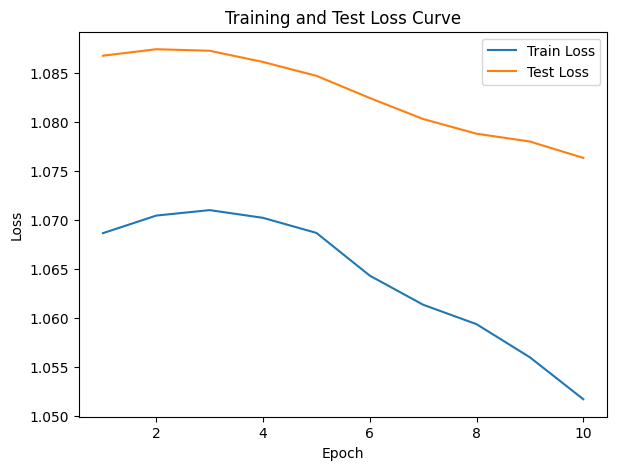

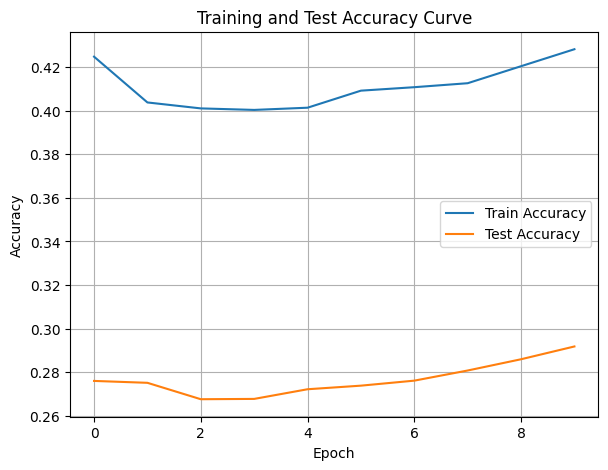

./saved_models/model_4.pth
Training Model with id 7
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.61it/s]

Epoch [1/10], Train F1:0.5869337675596046, Train Loss: 1.0126, Train Acc: 0.5286, Test F1:0.6186256982508529, Test Loss: 1.0468, Test Acc: 0.5564
Epoch [2/10], Train F1:0.5940420630689637, Train Loss: 1.0055, Train Acc: 0.5449, Test F1:0.5663457709694798, Test Loss: 1.0431, Test Acc: 0.5291


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.50it/s]

Epoch [3/10], Train F1:0.5887214649896582, Train Loss: 1.0091, Train Acc: 0.5410, Test F1:0.6028438104978313, Test Loss: 1.0421, Test Acc: 0.5579
Epoch [4/10], Train F1:0.6028894576820476, Train Loss: 1.0037, Train Acc: 0.5533, Test F1:0.5856174828605907, Test Loss: 1.0410, Test Acc: 0.5438


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.88it/s]

Epoch [5/10], Train F1:0.6086733138322508, Train Loss: 1.0005, Train Acc: 0.5573, Test F1:0.5921085210881716, Test Loss: 1.0402, Test Acc: 0.5464
Epoch [6/10], Train F1:0.6169804092494369, Train Loss: 0.9961, Train Acc: 0.5677, Test F1:0.6108107899336461, Test Loss: 1.0377, Test Acc: 0.5618


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.13it/s]

Epoch [7/10], Train F1:0.6266682276648827, Train Loss: 0.9928, Train Acc: 0.5770, Test F1:0.5991243479801833, Test Loss: 1.0363, Test Acc: 0.5523
Epoch [8/10], Train F1:0.631421839946981, Train Loss: 0.9906, Train Acc: 0.5828, Test F1:0.6192932721910394, Test Loss: 1.0348, Test Acc: 0.5707


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.13it/s]


Epoch [9/10], Train F1:0.6376585013759192, Train Loss: 0.9885, Train Acc: 0.5875, Test F1:0.6333473488020913, Test Loss: 1.0338, Test Acc: 0.5835
Epoch [10/10], Train F1:0.6470696387934322, Train Loss: 0.9873, Train Acc: 0.5969, Test F1:0.6405872793987808, Test Loss: 1.0327, Test Acc: 0.5912
Total Epochs: 10
Train loss start: 0.9674019813537598, Train loss end: 1.1709306240081787
Highest Mean Train Accuracy (over epoch): 0.5969047619047618
Test loss start: 1.0507543087005615, Test loss end: 1.0231534242630005
Highest mean Test Accuracy (over epoch): 0.5912326388888889


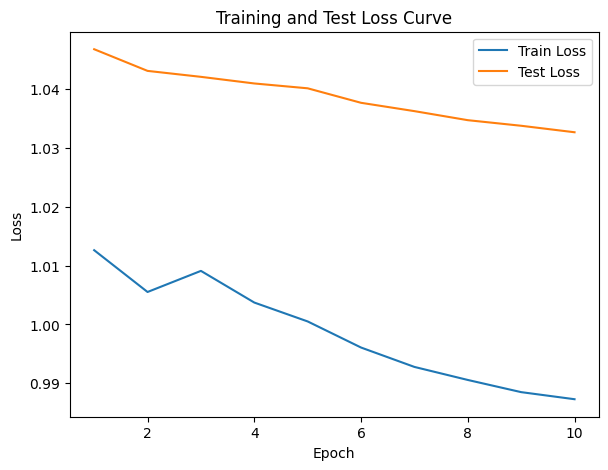

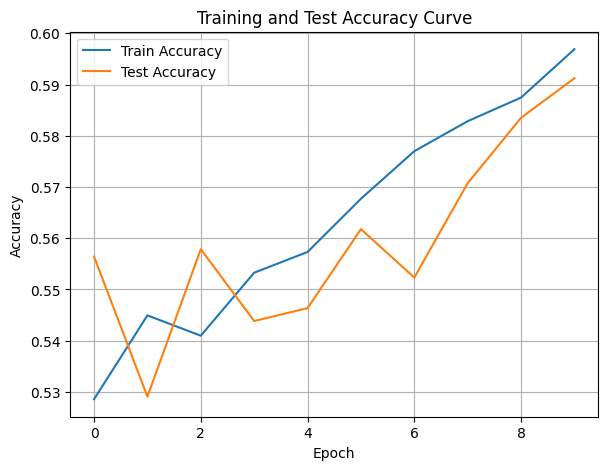

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.6952352109832426, Train Loss: 0.9709, Train Acc: 0.6378, Test F1:0.7618800086636345, Test Loss: 1.0130, Test Acc: 0.7231


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.41it/s]

Epoch [2/10], Train F1:0.6985561004116616, Train Loss: 0.9631, Train Acc: 0.6457, Test F1:0.7662894581907748, Test Loss: 1.0069, Test Acc: 0.7370


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.41it/s]

Epoch [3/10], Train F1:0.7086115563970093, Train Loss: 0.9551, Train Acc: 0.6577, Test F1:0.7828004514844178, Test Loss: 1.0060, Test Acc: 0.7526


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.05it/s]

Epoch [4/10], Train F1:0.7185970195185591, Train Loss: 0.9488, Train Acc: 0.6737, Test F1:0.767158732295359, Test Loss: 1.0039, Test Acc: 0.7389


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.23it/s]

Epoch [5/10], Train F1:0.7310979337107659, Train Loss: 0.9446, Train Acc: 0.6860, Test F1:0.7621505100951894, Test Loss: 1.0033, Test Acc: 0.7366


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.28it/s]

Epoch [6/10], Train F1:0.7393770374831997, Train Loss: 0.9402, Train Acc: 0.6937, Test F1:0.7668518080763985, Test Loss: 1.0018, Test Acc: 0.7439


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.43it/s]

Epoch [7/10], Train F1:0.7485591377525662, Train Loss: 0.9345, Train Acc: 0.7077, Test F1:0.7749320465109938, Test Loss: 0.9995, Test Acc: 0.7527


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.43it/s]

Epoch [8/10], Train F1:0.7494417035699419, Train Loss: 0.9332, Train Acc: 0.7101, Test F1:0.7796569180906472, Test Loss: 0.9977, Test Acc: 0.7566


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.73it/s]

Epoch [9/10], Train F1:0.7517852191987124, Train Loss: 0.9314, Train Acc: 0.7139, Test F1:0.7843755026727234, Test Loss: 0.9955, Test Acc: 0.7621


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.52it/s]


Epoch [10/10], Train F1:0.7538037586225012, Train Loss: 0.9292, Train Acc: 0.7175, Test F1:0.7882622072195334, Test Loss: 0.9945, Test Acc: 0.7670
Total Epochs: 10
Train loss start: 0.9536539316177368, Train loss end: 0.962462842464447
Highest Mean Train Accuracy (over epoch): 0.7175
Test loss start: 1.0142415761947632, Test loss end: 0.9820981621742249
Highest mean Test Accuracy (over epoch): 0.7670138888888889


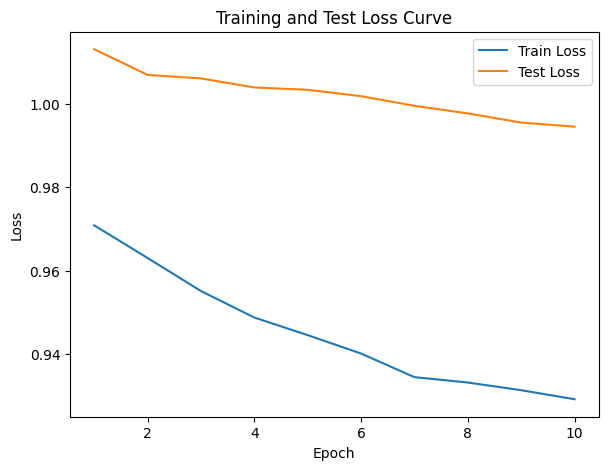

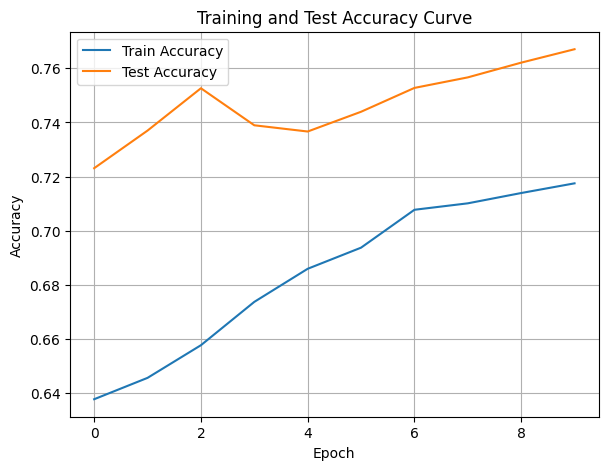

./saved_models/model_8.pth
Training Model with id 6
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.67it/s]

Epoch [1/10], Train F1:0.815248592315327, Train Loss: 0.8936, Train Acc: 0.7914, Test F1:0.8313090418353577, Test Loss: 0.9736, Test Acc: 0.8194
Epoch [2/10], Train F1:0.8120329029707962, Train Loss: 0.8929, Train Acc: 0.7818, Test F1:0.8122891705319517, Test Loss: 0.9790, Test Acc: 0.7969


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.67it/s]

Epoch [3/10], Train F1:0.8140985692442214, Train Loss: 0.8900, Train Acc: 0.7903, Test F1:0.8152824043230439, Test Loss: 0.9768, Test Acc: 0.7998


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.22it/s]

Epoch [4/10], Train F1:0.814540088472473, Train Loss: 0.8890, Train Acc: 0.7913, Test F1:0.8150782259208491, Test Loss: 0.9751, Test Acc: 0.8008


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.22it/s]

Epoch [5/10], Train F1:0.8198281492704966, Train Loss: 0.8835, Train Acc: 0.7999, Test F1:0.8166396257155214, Test Loss: 0.9727, Test Acc: 0.8030


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.88it/s]

Epoch [6/10], Train F1:0.8190182480429393, Train Loss: 0.8815, Train Acc: 0.7986, Test F1:0.8213296476270009, Test Loss: 0.9690, Test Acc: 0.8093


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.88it/s]

Epoch [7/10], Train F1:0.8179130814146945, Train Loss: 0.8798, Train Acc: 0.7955, Test F1:0.8127995982720857, Test Loss: 0.9675, Test Acc: 0.8010


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.97it/s]

Epoch [8/10], Train F1:0.8177768017383086, Train Loss: 0.8774, Train Acc: 0.7953, Test F1:0.8156342448662337, Test Loss: 0.9655, Test Acc: 0.8050


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.97it/s]

Epoch [9/10], Train F1:0.8203449135936354, Train Loss: 0.8758, Train Acc: 0.7981, Test F1:0.8177292287322079, Test Loss: 0.9634, Test Acc: 0.8075


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.30it/s]


Epoch [10/10], Train F1:0.8189286260580063, Train Loss: 0.8748, Train Acc: 0.7988, Test F1:0.8198264831129106, Test Loss: 0.9622, Test Acc: 0.8095
Total Epochs: 10
Train loss start: 0.8436777591705322, Train loss end: 0.909927487373352
Highest Mean Train Accuracy (over epoch): 0.7998809523809524
Test loss start: 0.9731945991516113, Test loss end: 0.950230062007904
Highest mean Test Accuracy (over epoch): 0.8194444444444444


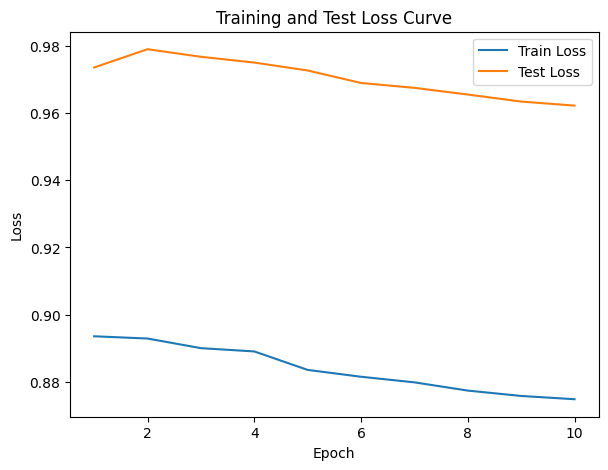

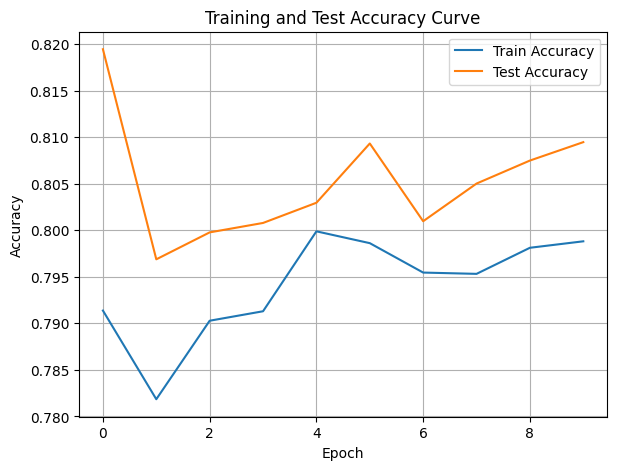

./saved_models/model_6.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [41]:
DTEmlp4b.train_DTE()

Training Process:   1%|▏         | 1/70 [00:00<00:08,  7.99it/s]

Epoch [1/70], Train F1:0.5710088257482799, Train Loss: 1.0246, Train Acc: 0.5580, Test F1:0.5106416153426366, Test Loss: 1.0664, Test Acc: 0.5000


Training Process:   1%|▏         | 1/70 [00:00<00:08,  7.99it/s]

Epoch [2/70], Train F1:0.5538627499792548, Train Loss: 1.0356, Train Acc: 0.5281, Test F1:0.4612216341982247, Test Loss: 1.0673, Test Acc: 0.4588


Training Process:   4%|▍         | 3/70 [00:00<00:06,  9.73it/s]

Epoch [3/70], Train F1:0.5721139268894372, Train Loss: 1.0259, Train Acc: 0.5432, Test F1:0.4978232618583497, Test Loss: 1.0639, Test Acc: 0.4861


Training Process:   7%|▋         | 5/70 [00:00<00:06, 10.48it/s]

Epoch [4/70], Train F1:0.5765217654916547, Train Loss: 1.0237, Train Acc: 0.5463, Test F1:0.509263429171896, Test Loss: 1.0610, Test Acc: 0.4959
Epoch [5/70], Train F1:0.5791667238824587, Train Loss: 1.0212, Train Acc: 0.5520, Test F1:0.5040063337348396, Test Loss: 1.0599, Test Acc: 0.4951


Training Process:   7%|▋         | 5/70 [00:00<00:06, 10.48it/s]

Epoch [6/70], Train F1:0.5868977675972665, Train Loss: 1.0181, Train Acc: 0.5585, Test F1:0.49418550512602677, Test Loss: 1.0592, Test Acc: 0.4874


Training Process:  10%|█         | 7/70 [00:00<00:06, 10.48it/s]

Epoch [7/70], Train F1:0.5896640362303386, Train Loss: 1.0169, Train Acc: 0.5624, Test F1:0.4973051375523858, Test Loss: 1.0578, Test Acc: 0.4917


Training Process:  10%|█         | 7/70 [00:00<00:06, 10.48it/s]

Epoch [8/70], Train F1:0.5929508030343466, Train Loss: 1.0132, Train Acc: 0.5667, Test F1:0.4922654168717046, Test Loss: 1.0563, Test Acc: 0.4890


Training Process:  13%|█▎        | 9/70 [00:00<00:05, 10.52it/s]

Epoch [9/70], Train F1:0.5947796701559646, Train Loss: 1.0105, Train Acc: 0.5679, Test F1:0.485545269716191, Test Loss: 1.0556, Test Acc: 0.4859


Training Process:  13%|█▎        | 9/70 [00:00<00:05, 10.52it/s]

Epoch [10/70], Train F1:0.6027164992829107, Train Loss: 1.0062, Train Acc: 0.5771, Test F1:0.5013322782260111, Test Loss: 1.0545, Test Acc: 0.4995


Training Process:  16%|█▌        | 11/70 [00:01<00:05, 10.30it/s]

Epoch [11/70], Train F1:0.6090606531137391, Train Loss: 1.0030, Train Acc: 0.5843, Test F1:0.49478150115131025, Test Loss: 1.0538, Test Acc: 0.4954


Training Process:  16%|█▌        | 11/70 [00:01<00:05, 10.30it/s]

Epoch [12/70], Train F1:0.6149704644146197, Train Loss: 0.9996, Train Acc: 0.5906, Test F1:0.503964539347267, Test Loss: 1.0524, Test Acc: 0.5028


Training Process:  19%|█▊        | 13/70 [00:01<00:06,  9.24it/s]

Epoch [13/70], Train F1:0.6213083177880173, Train Loss: 0.9955, Train Acc: 0.5974, Test F1:0.5014976746327762, Test Loss: 1.0515, Test Acc: 0.5021


Training Process:  20%|██        | 14/70 [00:01<00:06,  9.07it/s]

Epoch [14/70], Train F1:0.6278075712379048, Train Loss: 0.9918, Train Acc: 0.6040, Test F1:0.49898594177841804, Test Loss: 1.0507, Test Acc: 0.5014


Training Process:  21%|██▏       | 15/70 [00:01<00:06,  8.81it/s]

Epoch [15/70], Train F1:0.6313377894073695, Train Loss: 0.9889, Train Acc: 0.6081, Test F1:0.5047456215339426, Test Loss: 1.0488, Test Acc: 0.5071


Training Process:  23%|██▎       | 16/70 [00:01<00:06,  8.65it/s]

Epoch [16/70], Train F1:0.63755882611582, Train Loss: 0.9853, Train Acc: 0.6151, Test F1:0.49899477246153606, Test Loss: 1.0483, Test Acc: 0.5042


Training Process:  24%|██▍       | 17/70 [00:01<00:06,  8.37it/s]

Epoch [17/70], Train F1:0.6407688973032649, Train Loss: 0.9827, Train Acc: 0.6181, Test F1:0.49820868046169736, Test Loss: 1.0473, Test Acc: 0.5040


Training Process:  26%|██▌       | 18/70 [00:01<00:06,  8.25it/s]

Epoch [18/70], Train F1:0.6444741379038752, Train Loss: 0.9798, Train Acc: 0.6221, Test F1:0.5089339296195065, Test Loss: 1.0461, Test Acc: 0.5127


Training Process:  27%|██▋       | 19/70 [00:02<00:06,  7.54it/s]

Epoch [19/70], Train F1:0.650430575991087, Train Loss: 0.9762, Train Acc: 0.6291, Test F1:0.5116448459676177, Test Loss: 1.0447, Test Acc: 0.5150


Training Process:  29%|██▊       | 20/70 [00:02<00:06,  7.27it/s]

Epoch [20/70], Train F1:0.6549828068926198, Train Loss: 0.9731, Train Acc: 0.6342, Test F1:0.5087974471393796, Test Loss: 1.0438, Test Acc: 0.5139


Training Process:  31%|███▏      | 22/70 [00:02<00:07,  6.55it/s]

Epoch [21/70], Train F1:0.6597997635928063, Train Loss: 0.9697, Train Acc: 0.6395, Test F1:0.5063372114758053, Test Loss: 1.0426, Test Acc: 0.5126
Epoch [22/70], Train F1:0.6647624785669828, Train Loss: 0.9663, Train Acc: 0.6449, Test F1:0.515896882701515, Test Loss: 1.0411, Test Acc: 0.5197


Training Process:  34%|███▍      | 24/70 [00:02<00:07,  6.52it/s]

Epoch [23/70], Train F1:0.6699447080074945, Train Loss: 0.9626, Train Acc: 0.6499, Test F1:0.523173913047592, Test Loss: 1.0397, Test Acc: 0.5256
Epoch [24/70], Train F1:0.6732955038470678, Train Loss: 0.9599, Train Acc: 0.6537, Test F1:0.5371540366777681, Test Loss: 1.0378, Test Acc: 0.5369


Training Process:  37%|███▋      | 26/70 [00:03<00:06,  6.84it/s]

Epoch [25/70], Train F1:0.6763866286325473, Train Loss: 0.9571, Train Acc: 0.6573, Test F1:0.5427360430965333, Test Loss: 1.0363, Test Acc: 0.5416
Epoch [26/70], Train F1:0.6813363935768209, Train Loss: 0.9538, Train Acc: 0.6629, Test F1:0.5474768661306613, Test Loss: 1.0348, Test Acc: 0.5458


Training Process:  40%|████      | 28/70 [00:03<00:06,  6.46it/s]

Epoch [27/70], Train F1:0.6859704330751198, Train Loss: 0.9507, Train Acc: 0.6682, Test F1:0.5563593690484192, Test Loss: 1.0333, Test Acc: 0.5537
Epoch [28/70], Train F1:0.6898757167060715, Train Loss: 0.9477, Train Acc: 0.6724, Test F1:0.5666563859734357, Test Loss: 1.0315, Test Acc: 0.5626


Training Process:  43%|████▎     | 30/70 [00:03<00:06,  6.13it/s]

Epoch [29/70], Train F1:0.693911679724873, Train Loss: 0.9448, Train Acc: 0.6765, Test F1:0.5773492732933242, Test Loss: 1.0297, Test Acc: 0.5719
Epoch [30/70], Train F1:0.6969445156059797, Train Loss: 0.9425, Train Acc: 0.6796, Test F1:0.586258750324086, Test Loss: 1.0281, Test Acc: 0.5795


Training Process:  44%|████▍     | 31/70 [00:04<00:06,  5.89it/s]

Epoch [31/70], Train F1:0.699675718381439, Train Loss: 0.9398, Train Acc: 0.6827, Test F1:0.5928236338137047, Test Loss: 1.0267, Test Acc: 0.5853


Training Process:  46%|████▌     | 32/70 [00:04<00:07,  4.80it/s]

Epoch [32/70], Train F1:0.7031894957968359, Train Loss: 0.9369, Train Acc: 0.6867, Test F1:0.597747798405693, Test Loss: 1.0252, Test Acc: 0.5898


Training Process:  47%|████▋     | 33/70 [00:04<00:08,  4.48it/s]

Epoch [33/70], Train F1:0.7062838036095223, Train Loss: 0.9342, Train Acc: 0.6898, Test F1:0.6028835499190619, Test Loss: 1.0237, Test Acc: 0.5943


Training Process:  49%|████▊     | 34/70 [00:04<00:07,  4.60it/s]

Epoch [34/70], Train F1:0.708928039061833, Train Loss: 0.9320, Train Acc: 0.6925, Test F1:0.6107663944004617, Test Loss: 1.0219, Test Acc: 0.6016


Training Process:  50%|█████     | 35/70 [00:05<00:08,  4.25it/s]

Epoch [35/70], Train F1:0.7117331292143062, Train Loss: 0.9295, Train Acc: 0.6956, Test F1:0.6177009720052937, Test Loss: 1.0199, Test Acc: 0.6078


Training Process:  51%|█████▏    | 36/70 [00:05<00:08,  3.96it/s]

Epoch [36/70], Train F1:0.7147571433837908, Train Loss: 0.9269, Train Acc: 0.6988, Test F1:0.6228500598487531, Test Loss: 1.0187, Test Acc: 0.6126


Training Process:  53%|█████▎    | 37/70 [00:05<00:08,  3.81it/s]

Epoch [37/70], Train F1:0.7171780203309254, Train Loss: 0.9247, Train Acc: 0.7017, Test F1:0.6293693498231969, Test Loss: 1.0170, Test Acc: 0.6188


Training Process:  54%|█████▍    | 38/70 [00:05<00:09,  3.54it/s]

Epoch [38/70], Train F1:0.719343003220626, Train Loss: 0.9224, Train Acc: 0.7041, Test F1:0.6349792984005793, Test Loss: 1.0155, Test Acc: 0.6241


Training Process:  56%|█████▌    | 39/70 [00:06<00:08,  3.56it/s]

Epoch [39/70], Train F1:0.7223677209977866, Train Loss: 0.9196, Train Acc: 0.7075, Test F1:0.6389869583581529, Test Loss: 1.0141, Test Acc: 0.6278


Training Process:  57%|█████▋    | 40/70 [00:06<00:09,  3.24it/s]

Epoch [40/70], Train F1:0.7249345246520114, Train Loss: 0.9172, Train Acc: 0.7102, Test F1:0.6428096739695474, Test Loss: 1.0125, Test Acc: 0.6314


Training Process:  59%|█████▊    | 41/70 [00:06<00:08,  3.36it/s]

Epoch [41/70], Train F1:0.7275574328167355, Train Loss: 0.9149, Train Acc: 0.7130, Test F1:0.6485195459633047, Test Loss: 1.0107, Test Acc: 0.6371


Training Process:  60%|██████    | 42/70 [00:07<00:07,  3.51it/s]

Epoch [42/70], Train F1:0.7297380158024276, Train Loss: 0.9127, Train Acc: 0.7155, Test F1:0.6537226141011224, Test Loss: 1.0092, Test Acc: 0.6420


Training Process:  61%|██████▏   | 43/70 [00:07<00:07,  3.55it/s]

Epoch [43/70], Train F1:0.7315243857406054, Train Loss: 0.9107, Train Acc: 0.7177, Test F1:0.6590306038384734, Test Loss: 1.0076, Test Acc: 0.6472


Training Process:  63%|██████▎   | 44/70 [00:07<00:07,  3.63it/s]

Epoch [44/70], Train F1:0.7340458720504084, Train Loss: 0.9084, Train Acc: 0.7203, Test F1:0.662398305927741, Test Loss: 1.0062, Test Acc: 0.6503


Training Process:  64%|██████▍   | 45/70 [00:07<00:06,  3.73it/s]

Epoch [45/70], Train F1:0.7370041055402012, Train Loss: 0.9060, Train Acc: 0.7236, Test F1:0.6664160037865692, Test Loss: 1.0047, Test Acc: 0.6542


Training Process:  67%|██████▋   | 47/70 [00:08<00:05,  4.43it/s]

Epoch [46/70], Train F1:0.7397985198138722, Train Loss: 0.9037, Train Acc: 0.7266, Test F1:0.6694211995438398, Test Loss: 1.0034, Test Acc: 0.6570
Epoch [47/70], Train F1:0.7421834890484754, Train Loss: 0.9013, Train Acc: 0.7294, Test F1:0.6738909788067555, Test Loss: 1.0020, Test Acc: 0.6613


Training Process:  69%|██████▊   | 48/70 [00:08<00:04,  4.81it/s]

Epoch [48/70], Train F1:0.7448623627158549, Train Loss: 0.8991, Train Acc: 0.7320, Test F1:0.6772119345718409, Test Loss: 1.0006, Test Acc: 0.6646


Training Process:  70%|███████   | 49/70 [00:08<00:04,  4.64it/s]

Epoch [49/70], Train F1:0.7466287265264429, Train Loss: 0.8972, Train Acc: 0.7338, Test F1:0.6805672090155308, Test Loss: 0.9991, Test Acc: 0.6678


Training Process:  71%|███████▏  | 50/70 [00:08<00:04,  4.71it/s]

Epoch [50/70], Train F1:0.7488910211587579, Train Loss: 0.8948, Train Acc: 0.7363, Test F1:0.6848400074657741, Test Loss: 0.9976, Test Acc: 0.6720


Training Process:  73%|███████▎  | 51/70 [00:09<00:04,  4.62it/s]

Epoch [51/70], Train F1:0.7510950054973119, Train Loss: 0.8926, Train Acc: 0.7389, Test F1:0.6885980944305042, Test Loss: 0.9960, Test Acc: 0.6757


Training Process:  74%|███████▍  | 52/70 [00:09<00:03,  4.61it/s]

Epoch [52/70], Train F1:0.7524699761376263, Train Loss: 0.8909, Train Acc: 0.7404, Test F1:0.6921891103645846, Test Loss: 0.9943, Test Acc: 0.6793


Training Process:  76%|███████▌  | 53/70 [00:09<00:03,  4.72it/s]

Epoch [53/70], Train F1:0.7537770120914286, Train Loss: 0.8892, Train Acc: 0.7418, Test F1:0.6956351934765878, Test Loss: 0.9927, Test Acc: 0.6828


Training Process:  77%|███████▋  | 54/70 [00:09<00:03,  4.49it/s]

Epoch [54/70], Train F1:0.7556322104845803, Train Loss: 0.8872, Train Acc: 0.7439, Test F1:0.6992571186931744, Test Loss: 0.9913, Test Acc: 0.6865


Training Process:  79%|███████▊  | 55/70 [00:10<00:03,  4.46it/s]

Epoch [55/70], Train F1:0.7572764552514736, Train Loss: 0.8854, Train Acc: 0.7456, Test F1:0.7024182072802533, Test Loss: 0.9899, Test Acc: 0.6896


Training Process:  80%|████████  | 56/70 [00:10<00:03,  4.47it/s]

Epoch [56/70], Train F1:0.7587171424828105, Train Loss: 0.8835, Train Acc: 0.7472, Test F1:0.7048404745656124, Test Loss: 0.9885, Test Acc: 0.6920


Training Process:  81%|████████▏ | 57/70 [00:10<00:03,  4.21it/s]

Epoch [57/70], Train F1:0.7609419791814982, Train Loss: 0.8816, Train Acc: 0.7495, Test F1:0.7077825232740121, Test Loss: 0.9868, Test Acc: 0.6950


Training Process:  83%|████████▎ | 58/70 [00:10<00:02,  4.30it/s]

Epoch [58/70], Train F1:0.762336856728128, Train Loss: 0.8799, Train Acc: 0.7511, Test F1:0.71060994317404, Test Loss: 0.9854, Test Acc: 0.6978


Training Process:  84%|████████▍ | 59/70 [00:10<00:02,  4.47it/s]

Epoch [59/70], Train F1:0.7640264567418963, Train Loss: 0.8781, Train Acc: 0.7529, Test F1:0.7133324479658554, Test Loss: 0.9838, Test Acc: 0.7006


Training Process:  86%|████████▌ | 60/70 [00:11<00:02,  4.44it/s]

Epoch [60/70], Train F1:0.7651995647554771, Train Loss: 0.8763, Train Acc: 0.7543, Test F1:0.7159534251828241, Test Loss: 0.9824, Test Acc: 0.7034


Training Process:  87%|████████▋ | 61/70 [00:11<00:02,  4.39it/s]

Epoch [61/70], Train F1:0.7668529912699876, Train Loss: 0.8745, Train Acc: 0.7561, Test F1:0.7184786281407358, Test Loss: 0.9809, Test Acc: 0.7060


Training Process:  89%|████████▊ | 62/70 [00:11<00:01,  4.28it/s]

Epoch [62/70], Train F1:0.7680192075376276, Train Loss: 0.8729, Train Acc: 0.7574, Test F1:0.7210529520406295, Test Loss: 0.9792, Test Acc: 0.7087


Training Process:  90%|█████████ | 63/70 [00:11<00:01,  4.22it/s]

Epoch [63/70], Train F1:0.7693588569301164, Train Loss: 0.8713, Train Acc: 0.7588, Test F1:0.7236816203763131, Test Loss: 0.9779, Test Acc: 0.7114


Training Process:  91%|█████████▏| 64/70 [00:12<00:01,  4.11it/s]

Epoch [64/70], Train F1:0.7706987699641107, Train Loss: 0.8698, Train Acc: 0.7602, Test F1:0.7251831360490105, Test Loss: 0.9768, Test Acc: 0.7128


Training Process:  93%|█████████▎| 65/70 [00:12<00:01,  4.27it/s]

Epoch [65/70], Train F1:0.771878371857892, Train Loss: 0.8683, Train Acc: 0.7615, Test F1:0.7275325711386533, Test Loss: 0.9757, Test Acc: 0.7153


Training Process:  94%|█████████▍| 66/70 [00:12<00:00,  4.43it/s]

Epoch [66/70], Train F1:0.7734590814651595, Train Loss: 0.8667, Train Acc: 0.7630, Test F1:0.7290450812345607, Test Loss: 0.9746, Test Acc: 0.7167


Training Process:  96%|█████████▌| 67/70 [00:12<00:00,  4.17it/s]

Epoch [67/70], Train F1:0.7744375096486372, Train Loss: 0.8653, Train Acc: 0.7640, Test F1:0.7313914834356315, Test Loss: 0.9733, Test Acc: 0.7191


Training Process:  97%|█████████▋| 68/70 [00:13<00:00,  4.24it/s]

Epoch [68/70], Train F1:0.7753223387616477, Train Loss: 0.8639, Train Acc: 0.7651, Test F1:0.7329247956436826, Test Loss: 0.9722, Test Acc: 0.7205


Training Process:  99%|█████████▊| 69/70 [00:13<00:00,  4.45it/s]

Epoch [69/70], Train F1:0.7764444880277085, Train Loss: 0.8624, Train Acc: 0.7665, Test F1:0.7348858987462236, Test Loss: 0.9707, Test Acc: 0.7226


Training Process: 100%|██████████| 70/70 [00:13<00:00,  5.17it/s]


Epoch [70/70], Train F1:0.7777802584127943, Train Loss: 0.8608, Train Acc: 0.7681, Test F1:0.7364519741072642, Test Loss: 0.9696, Test Acc: 0.7241
Total Epochs: 70
Train loss start: 1.1236677169799805, Train loss end: 0.723255455493927
Highest Mean Train Accuracy (over epoch): 0.7680527210884354
Test loss start: 1.0607242584228516, Test loss end: 0.8858106136322021
Highest Mean Test Accuracy (over epoch): 0.7241071428571428


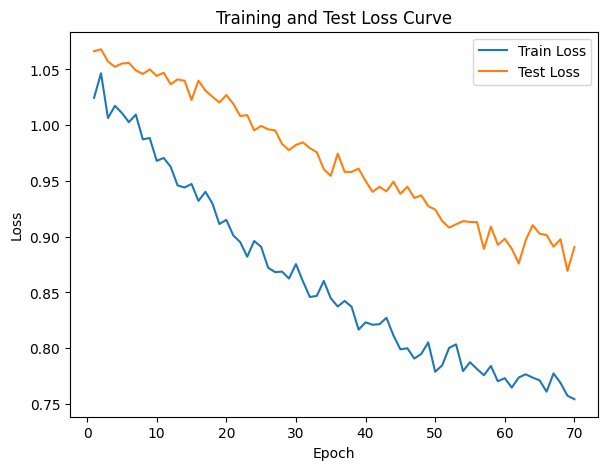

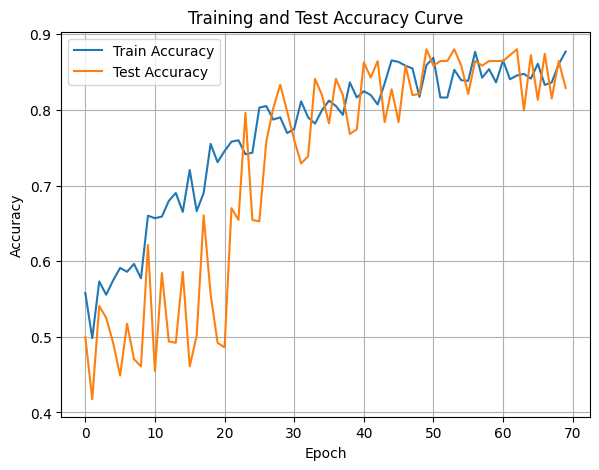

In [42]:
DTEmlp4b.train_single_model()

Randomly initializing 4 models
Training Model with id 1
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.45770870357181676, Train Loss: 1.0796, Train Acc: 0.3836, Test F1:0.2585326953748006, Test Loss: 1.1150, Test Acc: 0.1606


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.91it/s]

Epoch [2/10], Train F1:0.4592716141373436, Train Loss: 1.0772, Train Acc: 0.3879, Test F1:0.22910204099144904, Test Loss: 1.1267, Test Acc: 0.1372


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.91it/s]

Epoch [3/10], Train F1:0.4581185906138391, Train Loss: 1.0765, Train Acc: 0.3893, Test F1:0.21005577940777936, Test Loss: 1.1304, Test Acc: 0.1241


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.38it/s]

Epoch [4/10], Train F1:0.4703117441169275, Train Loss: 1.0722, Train Acc: 0.4036, Test F1:0.22007751231329784, Test Loss: 1.1275, Test Acc: 0.1309


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.17it/s]

Epoch [5/10], Train F1:0.4734819597241957, Train Loss: 1.0702, Train Acc: 0.4071, Test F1:0.22591778415941674, Test Loss: 1.1254, Test Acc: 0.1337


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.29it/s]

Epoch [6/10], Train F1:0.47227656862962814, Train Loss: 1.0675, Train Acc: 0.4093, Test F1:0.22298994697548333, Test Loss: 1.1252, Test Acc: 0.1317


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.45it/s]

Epoch [7/10], Train F1:0.4804258776290582, Train Loss: 1.0635, Train Acc: 0.4171, Test F1:0.22857696660140542, Test Loss: 1.1242, Test Acc: 0.1347


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.38it/s]

Epoch [8/10], Train F1:0.48737513230685964, Train Loss: 1.0602, Train Acc: 0.4228, Test F1:0.23167853742081862, Test Loss: 1.1238, Test Acc: 0.1360


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.48it/s]

Epoch [9/10], Train F1:0.49134662747151125, Train Loss: 1.0565, Train Acc: 0.4292, Test F1:0.2391952272072793, Test Loss: 1.1226, Test Acc: 0.1418


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.21it/s]


Epoch [10/10], Train F1:0.49889589191451117, Train Loss: 1.0522, Train Acc: 0.4382, Test F1:0.24551655242647713, Test Loss: 1.1210, Test Acc: 0.1452
Total Epochs: 10
Train loss start: 1.0493897199630737, Train loss end: 1.0087412595748901
Highest Mean Train Accuracy (over epoch): 0.4381845238095238
Test loss start: 1.1148189306259155, Test loss end: 1.090006709098816
Highest mean Test Accuracy (over epoch): 0.1605902777777778


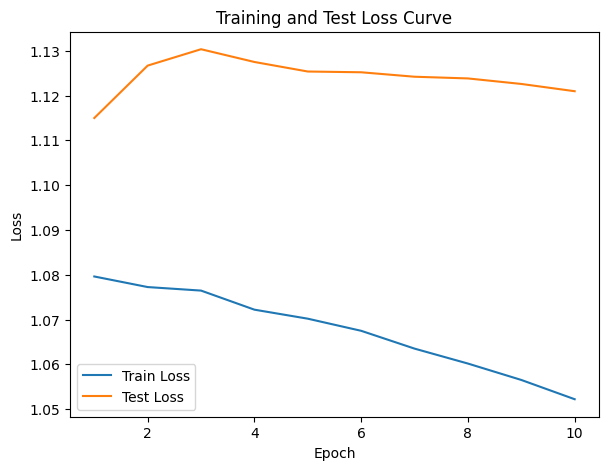

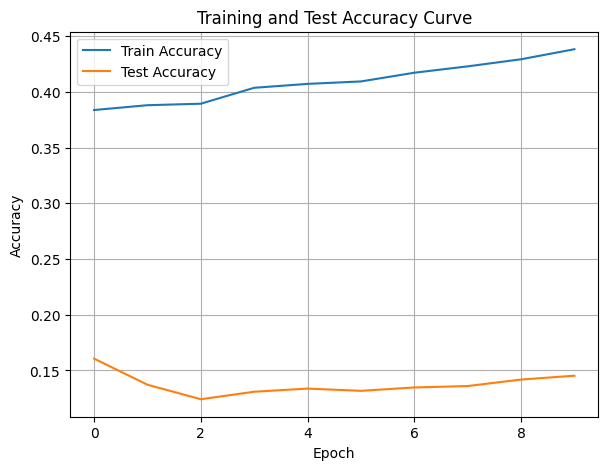

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.42it/s]

Epoch [1/10], Train F1:0.41081796032022266, Train Loss: 1.1151, Train Acc: 0.4015, Test F1:0.37731684796072334, Test Loss: 1.1071, Test Acc: 0.3438


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.42it/s]

Epoch [2/10], Train F1:0.40876534102340556, Train Loss: 1.1109, Train Acc: 0.3937, Test F1:0.3566594656950729, Test Loss: 1.1083, Test Acc: 0.3134


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.51it/s]

Epoch [3/10], Train F1:0.4098943635752175, Train Loss: 1.1076, Train Acc: 0.3936, Test F1:0.3531575618362795, Test Loss: 1.1077, Test Acc: 0.3084


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.76it/s]

Epoch [4/10], Train F1:0.4132951663955046, Train Loss: 1.1038, Train Acc: 0.3984, Test F1:0.37176559761239286, Test Loss: 1.1063, Test Acc: 0.3270


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.53it/s]

Epoch [5/10], Train F1:0.41962617031919125, Train Loss: 1.1005, Train Acc: 0.4050, Test F1:0.373416757808321, Test Loss: 1.1052, Test Acc: 0.3304
Epoch [6/10], Train F1:0.4260642757019655, Train Loss: 1.0977, Train Acc: 0.4147, Test F1:0.38255863253308325, Test Loss: 1.1043, Test Acc: 0.3404


Training Process:  70%|███████   | 7/10 [00:00<00:00,  6.46it/s]

Epoch [7/10], Train F1:0.4282583440768378, Train Loss: 1.0942, Train Acc: 0.4236, Test F1:0.39303675540542393, Test Loss: 1.1028, Test Acc: 0.3509


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.21it/s]

Epoch [8/10], Train F1:0.43463879987286974, Train Loss: 1.0924, Train Acc: 0.4295, Test F1:0.4005034746073461, Test Loss: 1.1024, Test Acc: 0.3549


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  4.71it/s]

Epoch [9/10], Train F1:0.4382375642667244, Train Loss: 1.0886, Train Acc: 0.4350, Test F1:0.39758110721639683, Test Loss: 1.1020, Test Acc: 0.3504


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.82it/s]


Epoch [10/10], Train F1:0.44360214074493515, Train Loss: 1.0865, Train Acc: 0.4430, Test F1:0.41919394522892595, Test Loss: 1.1008, Test Acc: 0.3730
Total Epochs: 10
Train loss start: 1.1387759447097778, Train loss end: 0.9968725442886353
Highest Mean Train Accuracy (over epoch): 0.4430059523809524
Test loss start: 1.1029964685440063, Test loss end: 1.0766777992248535
Highest mean Test Accuracy (over epoch): 0.37300347222222224


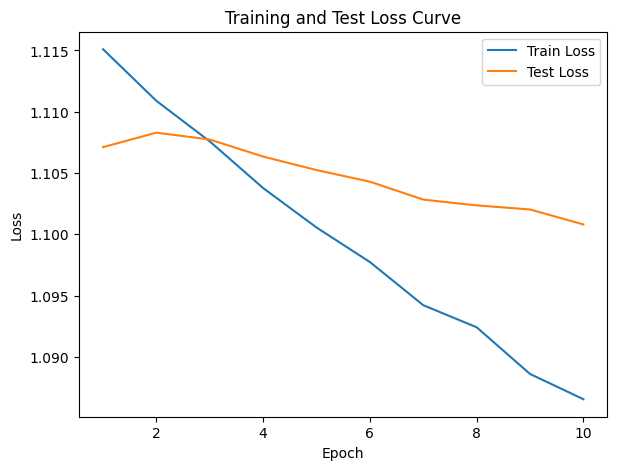

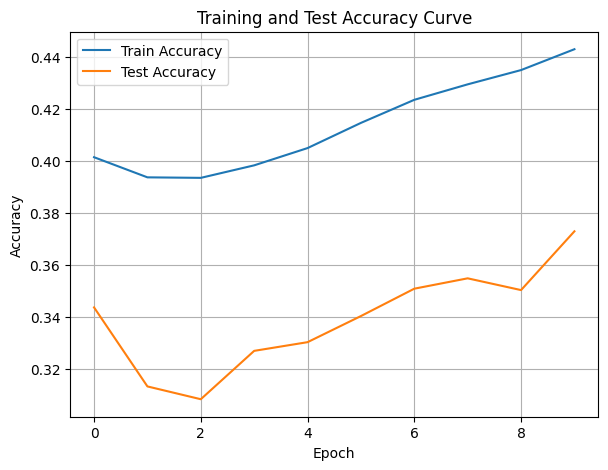

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.18it/s]

Epoch [1/10], Train F1:0.4740958680308861, Train Loss: 1.0856, Train Acc: 0.4390, Test F1:0.4895793567804721, Test Loss: 1.0843, Test Acc: 0.4861


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.41it/s]

Epoch [2/10], Train F1:0.4549653387742828, Train Loss: 1.0927, Train Acc: 0.4217, Test F1:0.5219384039320208, Test Loss: 1.0737, Test Acc: 0.5499


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.14it/s]

Epoch [3/10], Train F1:0.4686375886992161, Train Loss: 1.0836, Train Acc: 0.4383, Test F1:0.5368194751468887, Test Loss: 1.0695, Test Acc: 0.5692


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.34it/s]

Epoch [4/10], Train F1:0.47367172510029654, Train Loss: 1.0798, Train Acc: 0.4452, Test F1:0.5446468268719161, Test Loss: 1.0640, Test Acc: 0.5862


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.10it/s]

Epoch [5/10], Train F1:0.48017704734384165, Train Loss: 1.0759, Train Acc: 0.4504, Test F1:0.5443417384560566, Test Loss: 1.0629, Test Acc: 0.5932


Training Process:  60%|██████    | 6/10 [00:00<00:00,  5.56it/s]

Epoch [6/10], Train F1:0.48129328922798403, Train Loss: 1.0733, Train Acc: 0.4530, Test F1:0.5536440485895249, Test Loss: 1.0619, Test Acc: 0.6005


Training Process:  70%|███████   | 7/10 [00:01<00:00,  5.32it/s]

Epoch [7/10], Train F1:0.4850551346304806, Train Loss: 1.0714, Train Acc: 0.4563, Test F1:0.5590616454703669, Test Loss: 1.0607, Test Acc: 0.6060


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.31it/s]

Epoch [8/10], Train F1:0.49546215485330297, Train Loss: 1.0669, Train Acc: 0.4655, Test F1:0.5696353640115835, Test Loss: 1.0590, Test Acc: 0.6146


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.05it/s]

Epoch [9/10], Train F1:0.4979697054709088, Train Loss: 1.0632, Train Acc: 0.4701, Test F1:0.576680392732389, Test Loss: 1.0583, Test Acc: 0.6195


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.24it/s]


Epoch [10/10], Train F1:0.5048564941471756, Train Loss: 1.0583, Train Acc: 0.4797, Test F1:0.5854445950736813, Test Loss: 1.0567, Test Acc: 0.6280
Total Epochs: 10
Train loss start: 1.0801706314086914, Train loss end: 0.9708317518234253
Highest Mean Train Accuracy (over epoch): 0.47970238095238094
Test loss start: 1.0780478715896606, Test loss end: 1.0411468744277954
Highest mean Test Accuracy (over epoch): 0.6279513888888889


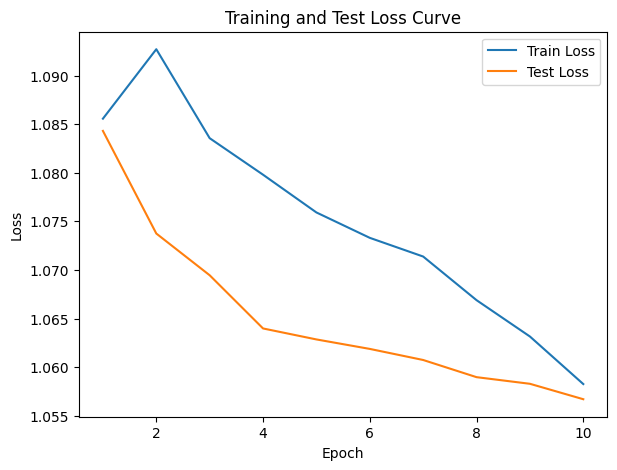

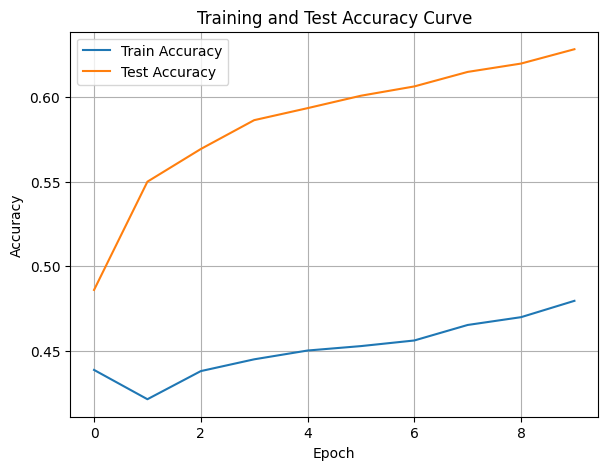

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:02,  4.32it/s]

Epoch [1/10], Train F1:0.4265963406928403, Train Loss: 1.1274, Train Acc: 0.3295, Test F1:0.4178628389154704, Test Loss: 1.1023, Test Acc: 0.3906


Training Process:  20%|██        | 2/10 [00:00<00:01,  4.51it/s]

Epoch [2/10], Train F1:0.3813091610810916, Train Loss: 1.1331, Train Acc: 0.2930, Test F1:0.3916712195714199, Test Loss: 1.0993, Test Acc: 0.3759


Training Process:  30%|███       | 3/10 [00:00<00:01,  4.36it/s]

Epoch [3/10], Train F1:0.37842528121457636, Train Loss: 1.1321, Train Acc: 0.2969, Test F1:0.42587543593061944, Test Loss: 1.0950, Test Acc: 0.4230


Training Process:  40%|████      | 4/10 [00:00<00:01,  3.90it/s]

Epoch [4/10], Train F1:0.3762741621342427, Train Loss: 1.1306, Train Acc: 0.2954, Test F1:0.44450135990864736, Test Loss: 1.0915, Test Acc: 0.4505


Training Process:  50%|█████     | 5/10 [00:01<00:01,  3.55it/s]

Epoch [5/10], Train F1:0.3823184575621255, Train Loss: 1.1263, Train Acc: 0.2997, Test F1:0.45824613294799876, Test Loss: 1.0882, Test Acc: 0.4682


Training Process:  60%|██████    | 6/10 [00:01<00:01,  3.65it/s]

Epoch [6/10], Train F1:0.39278200879504555, Train Loss: 1.1218, Train Acc: 0.3088, Test F1:0.46633288858375327, Test Loss: 1.0867, Test Acc: 0.4787


Training Process:  70%|███████   | 7/10 [00:01<00:00,  3.91it/s]

Epoch [7/10], Train F1:0.4023125461747463, Train Loss: 1.1176, Train Acc: 0.3179, Test F1:0.47036181095382396, Test Loss: 1.0867, Test Acc: 0.4818


Training Process:  80%|████████  | 8/10 [00:02<00:00,  4.05it/s]

Epoch [8/10], Train F1:0.407107745933269, Train Loss: 1.1159, Train Acc: 0.3243, Test F1:0.47777802932669017, Test Loss: 1.0853, Test Acc: 0.4899


Training Process:  90%|█████████ | 9/10 [00:02<00:00,  3.80it/s]

Epoch [9/10], Train F1:0.41314406785563407, Train Loss: 1.1121, Train Acc: 0.3308, Test F1:0.48707279763249495, Test Loss: 1.0831, Test Acc: 0.5021


Training Process: 100%|██████████| 10/10 [00:02<00:00,  3.88it/s]


Epoch [10/10], Train F1:0.41862658397643016, Train Loss: 1.1089, Train Acc: 0.3371, Test F1:0.49414805314751, Test Loss: 1.0813, Test Acc: 0.5119
Total Epochs: 10
Train loss start: 1.1055272817611694, Train loss end: 1.0917679071426392
Highest Mean Train Accuracy (over epoch): 0.3370535714285714
Test loss start: 1.0884907245635986, Test loss end: 1.078342080116272
Highest mean Test Accuracy (over epoch): 0.511892361111111


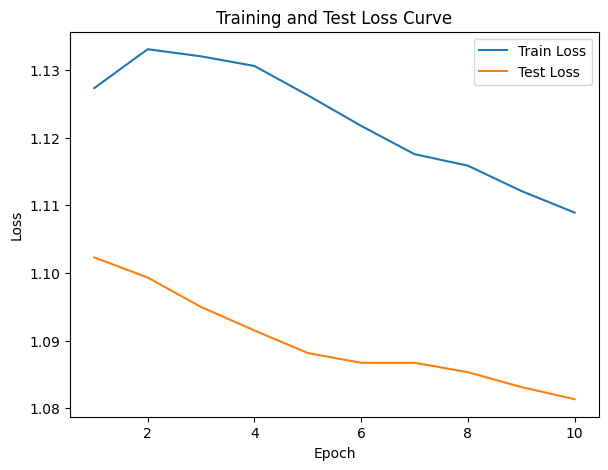

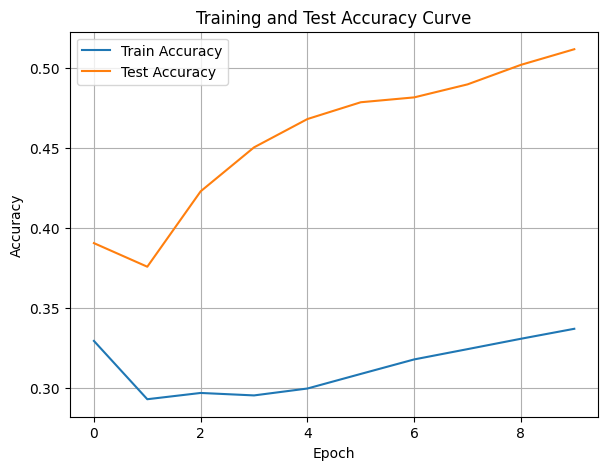

./saved_models/model_4.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  5.30it/s]

Epoch [1/10], Train F1:0.4569375447322017, Train Loss: 1.0812, Train Acc: 0.3857, Test F1:0.6126528442317916, Test Loss: 1.0612, Test Acc: 0.6215


Training Process:  20%|██        | 2/10 [00:00<00:01,  4.94it/s]

Epoch [2/10], Train F1:0.5150926902726317, Train Loss: 1.0658, Train Acc: 0.4494, Test F1:0.6107247695042791, Test Loss: 1.0559, Test Acc: 0.6293


Training Process:  30%|███       | 3/10 [00:00<00:01,  4.54it/s]

Epoch [3/10], Train F1:0.531865890011333, Train Loss: 1.0580, Train Acc: 0.4676, Test F1:0.6177428809007757, Test Loss: 1.0510, Test Acc: 0.6372


Training Process:  40%|████      | 4/10 [00:00<00:01,  4.53it/s]

Epoch [4/10], Train F1:0.5429750459329503, Train Loss: 1.0554, Train Acc: 0.4771, Test F1:0.6181266320250889, Test Loss: 1.0508, Test Acc: 0.6356


Training Process:  50%|█████     | 5/10 [00:01<00:01,  4.62it/s]

Epoch [5/10], Train F1:0.5492740469612357, Train Loss: 1.0531, Train Acc: 0.4821, Test F1:0.6158877586122169, Test Loss: 1.0506, Test Acc: 0.6332


Training Process:  60%|██████    | 6/10 [00:01<00:00,  4.67it/s]

Epoch [6/10], Train F1:0.5491277740567048, Train Loss: 1.0515, Train Acc: 0.4833, Test F1:0.6208648445557211, Test Loss: 1.0488, Test Acc: 0.6390


Training Process:  70%|███████   | 7/10 [00:01<00:00,  4.84it/s]

Epoch [7/10], Train F1:0.556274325316566, Train Loss: 1.0475, Train Acc: 0.4934, Test F1:0.6265601314371189, Test Loss: 1.0463, Test Acc: 0.6443


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.07it/s]

Epoch [8/10], Train F1:0.5663831779697425, Train Loss: 1.0433, Train Acc: 0.5039, Test F1:0.6315517946328384, Test Loss: 1.0462, Test Acc: 0.6483
Epoch [9/10], Train F1:0.5774734107717961, Train Loss: 1.0382, Train Acc: 0.5165, Test F1:0.6345615112179064, Test Loss: 1.0446, Test Acc: 0.6506


Training Process: 100%|██████████| 10/10 [00:02<00:00,  4.77it/s]


Epoch [10/10], Train F1:0.5840419853847207, Train Loss: 1.0340, Train Acc: 0.5243, Test F1:0.6386059756863524, Test Loss: 1.0433, Test Acc: 0.6539
Total Epochs: 10
Train loss start: 1.0399378538131714, Train loss end: 0.9406352639198303
Highest Mean Train Accuracy (over epoch): 0.5243154761904761
Test loss start: 1.0445537567138672, Test loss end: 1.0399364233016968
Highest mean Test Accuracy (over epoch): 0.65390625


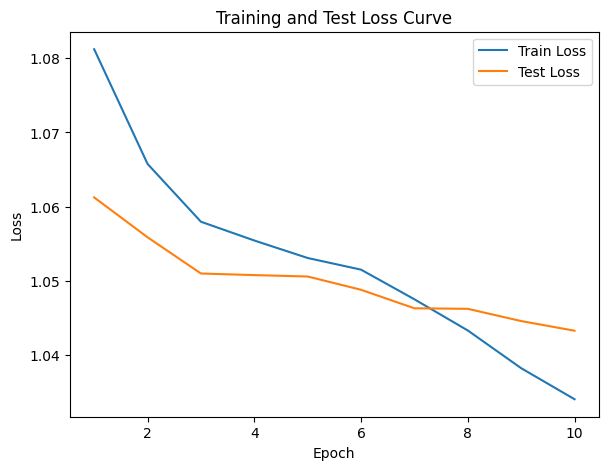

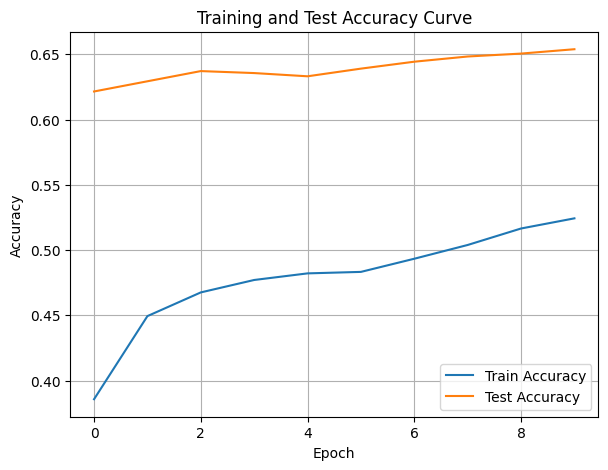

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.70it/s]

Epoch [1/10], Train F1:0.6451856308500284, Train Loss: 0.9869, Train Acc: 0.5976, Test F1:0.6859340194787246, Test Loss: 1.0299, Test Acc: 0.6780


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.72it/s]

Epoch [2/10], Train F1:0.6487160330107796, Train Loss: 0.9905, Train Acc: 0.6128, Test F1:0.6768391567153177, Test Loss: 1.0243, Test Acc: 0.6810


Training Process:  40%|████      | 4/10 [00:00<00:01,  5.69it/s]

Epoch [3/10], Train F1:0.6558515824702874, Train Loss: 0.9900, Train Acc: 0.6150, Test F1:0.6910493852002693, Test Loss: 1.0247, Test Acc: 0.6924
Epoch [4/10], Train F1:0.6589278344653287, Train Loss: 0.9891, Train Acc: 0.6158, Test F1:0.6968617358043839, Test Loss: 1.0245, Test Acc: 0.6962


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.47it/s]

Epoch [5/10], Train F1:0.665089256651819, Train Loss: 0.9876, Train Acc: 0.6211, Test F1:0.6988496633935863, Test Loss: 1.0211, Test Acc: 0.7012
Epoch [6/10], Train F1:0.6693536892408077, Train Loss: 0.9838, Train Acc: 0.6288, Test F1:0.6994085072033107, Test Loss: 1.0179, Test Acc: 0.7023


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.66it/s]

Epoch [7/10], Train F1:0.6757438458148519, Train Loss: 0.9808, Train Acc: 0.6363, Test F1:0.7015605762050531, Test Loss: 1.0155, Test Acc: 0.7061
Epoch [8/10], Train F1:0.6787363414299614, Train Loss: 0.9775, Train Acc: 0.6416, Test F1:0.7045995603666376, Test Loss: 1.0140, Test Acc: 0.7117


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.69it/s]

Epoch [9/10], Train F1:0.6852574359056766, Train Loss: 0.9745, Train Acc: 0.6478, Test F1:0.7068006411261519, Test Loss: 1.0119, Test Acc: 0.7145
Epoch [10/10], Train F1:0.6861586225610143, Train Loss: 0.9719, Train Acc: 0.6512, Test F1:0.7082395030375919, Test Loss: 1.0104, Test Acc: 0.7168


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.95it/s]


Total Epochs: 10
Train loss start: 1.0374490022659302, Train loss end: 0.8420483469963074
Highest Mean Train Accuracy (over epoch): 0.6512202380952381
Test loss start: 1.0149823427200317, Test loss end: 1.0072615146636963
Highest mean Test Accuracy (over epoch): 0.7167534722222222


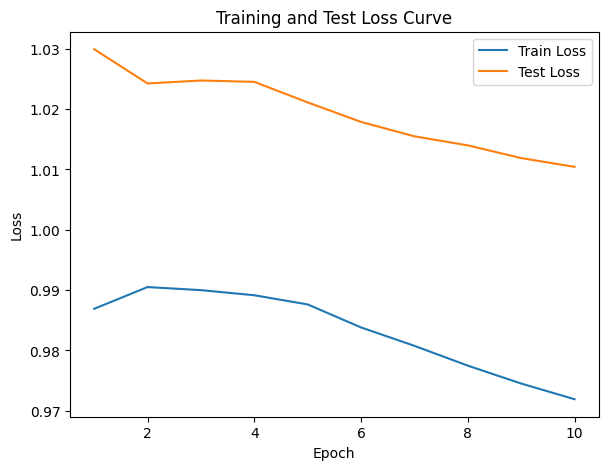

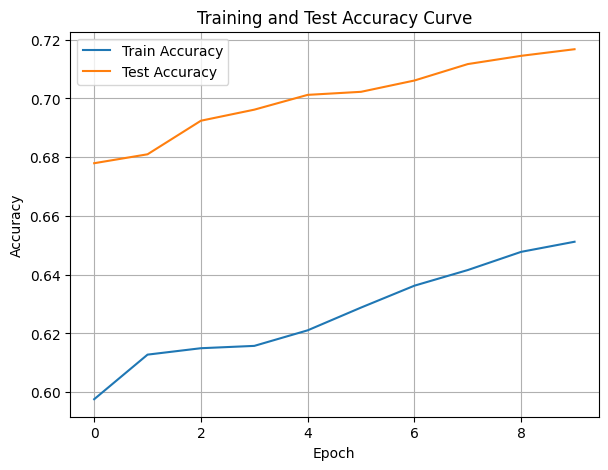

./saved_models/model_8.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.43it/s]

Epoch [1/10], Train F1:0.7679102690196759, Train Loss: 0.9257, Train Acc: 0.7414, Test F1:0.7400508847877268, Test Loss: 0.9942, Test Acc: 0.7448


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.46it/s]

Epoch [2/10], Train F1:0.7751877804763279, Train Loss: 0.9261, Train Acc: 0.7530, Test F1:0.740645319592688, Test Loss: 0.9907, Test Acc: 0.7517


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.38it/s]

Epoch [3/10], Train F1:0.7661600936369056, Train Loss: 0.9243, Train Acc: 0.7456, Test F1:0.7450001396638146, Test Loss: 0.9877, Test Acc: 0.7567


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.39it/s]

Epoch [4/10], Train F1:0.7645017549786962, Train Loss: 0.9199, Train Acc: 0.7483, Test F1:0.7440610053576565, Test Loss: 0.9848, Test Acc: 0.7572
Epoch [5/10], Train F1:0.77045470060219, Train Loss: 0.9167, Train Acc: 0.7518, Test F1:0.7378427606155793, Test Loss: 0.9807, Test Acc: 0.7543


Training Process:  70%|███████   | 7/10 [00:01<00:00,  5.35it/s]

Epoch [6/10], Train F1:0.765774241665954, Train Loss: 0.9170, Train Acc: 0.7468, Test F1:0.7420402088416758, Test Loss: 0.9790, Test Acc: 0.7577
Epoch [7/10], Train F1:0.7672022574377653, Train Loss: 0.9141, Train Acc: 0.7500, Test F1:0.7420932880615159, Test Loss: 0.9777, Test Acc: 0.7589


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.32it/s]

Epoch [8/10], Train F1:0.7681451356643173, Train Loss: 0.9117, Train Acc: 0.7521, Test F1:0.7435421132015559, Test Loss: 0.9764, Test Acc: 0.7599


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.09it/s]

Epoch [9/10], Train F1:0.7721953752378601, Train Loss: 0.9093, Train Acc: 0.7562, Test F1:0.7434161563213737, Test Loss: 0.9754, Test Acc: 0.7606


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.08it/s]


Epoch [10/10], Train F1:0.7737660289283449, Train Loss: 0.9060, Train Acc: 0.7592, Test F1:0.7441181379425448, Test Loss: 0.9743, Test Acc: 0.7612
Total Epochs: 10
Train loss start: 0.9244835376739502, Train loss end: 0.8001319766044617
Highest Mean Train Accuracy (over epoch): 0.7592261904761906
Test loss start: 0.9792606830596924, Test loss end: 0.968003511428833
Highest mean Test Accuracy (over epoch): 0.7611979166666666


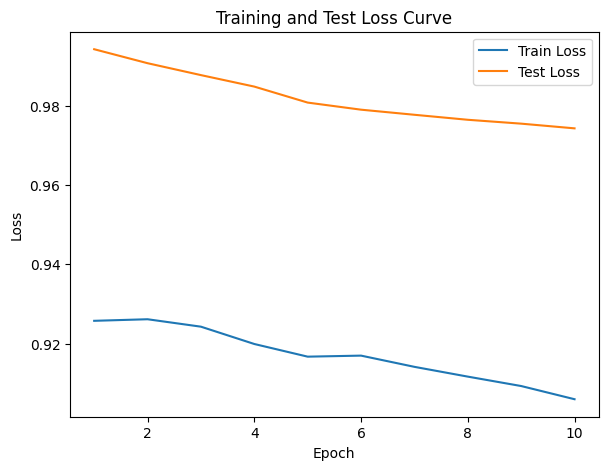

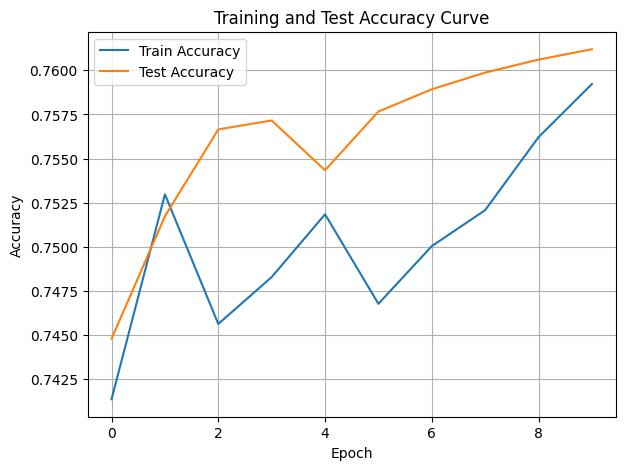

./saved_models/model_6.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [43]:
DTEmlp4b.train_DTE()

Epoch [1/70], Train F1:0.03368375882342363, Train Loss: 1.3213, Train Acc: 0.0167, Test F1:0.017115960633290548, Test Loss: 1.1816, Test Acc: 0.0078

Training Process:   1%|▏         | 1/70 [00:00<00:10,  6.36it/s]

Training Process:   4%|▍         | 3/70 [00:00<00:11,  5.76it/s]

Epoch [2/70], Train F1:0.029477702103400425, Train Loss: 1.3192, Train Acc: 0.0146, Test F1:0.017115960633290548, Test Loss: 1.1953, Test Acc: 0.0109
Epoch [3/70], Train F1:0.04316351150167703, Train Loss: 1.3144, Train Acc: 0.0215, Test F1:0.03341687552213868, Test Loss: 1.1959, Test Acc: 0.0217


Training Process:   7%|▋         | 5/70 [00:00<00:11,  5.79it/s]

Epoch [4/70], Train F1:0.03781455163333437, Train Loss: 1.3117, Train Acc: 0.0187, Test F1:0.037371535347243856, Test Loss: 1.1959, Test Acc: 0.0221
Epoch [5/70], Train F1:0.04113185232792135, Train Loss: 1.3083, Train Acc: 0.0204, Test F1:0.05198180636777128, Test Loss: 1.1959, Test Acc: 0.0311


Training Process:  10%|█         | 7/70 [00:01<00:10,  5.87it/s]

Epoch [6/70], Train F1:0.047368382871419576, Train Loss: 1.3046, Train Acc: 0.0249, Test F1:0.05398110661268556, Test Loss: 1.1963, Test Acc: 0.0331
Epoch [7/70], Train F1:0.04596356173815829, Train Loss: 1.3016, Train Acc: 0.0250, Test F1:0.05752085130859937, Test Loss: 1.1952, Test Acc: 0.0357


Training Process:  11%|█▏        | 8/70 [00:01<00:10,  5.73it/s]

Epoch [8/70], Train F1:0.05251890085510949, Train Loss: 1.2978, Train Acc: 0.0282, Test F1:0.05831196903433369, Test Loss: 1.1948, Test Acc: 0.0367


Training Process:  13%|█▎        | 9/70 [00:01<00:12,  5.08it/s]

Epoch [9/70], Train F1:0.05716752223733878, Train Loss: 1.2941, Train Acc: 0.0304, Test F1:0.06540280171461399, Test Loss: 1.1942, Test Acc: 0.0416


Training Process:  14%|█▍        | 10/70 [00:01<00:12,  4.94it/s]

Epoch [10/70], Train F1:0.06172403997405504, Train Loss: 1.2905, Train Acc: 0.0340, Test F1:0.0709639266706091, Test Loss: 1.1926, Test Acc: 0.0455


Training Process:  16%|█▌        | 11/70 [00:02<00:13,  4.22it/s]

Epoch [11/70], Train F1:0.06828749837002265, Train Loss: 1.2865, Train Acc: 0.0372, Test F1:0.075442155083449, Test Loss: 1.1902, Test Acc: 0.0487


Training Process:  17%|█▋        | 12/70 [00:02<00:13,  4.33it/s]

Epoch [12/70], Train F1:0.07368926030458937, Train Loss: 1.2832, Train Acc: 0.0404, Test F1:0.07331762241424455, Test Loss: 1.1895, Test Acc: 0.0476


Training Process:  19%|█▊        | 13/70 [00:02<00:12,  4.39it/s]

Epoch [13/70], Train F1:0.07792766314851862, Train Loss: 1.2799, Train Acc: 0.0424, Test F1:0.0704182601833303, Test Loss: 1.1891, Test Acc: 0.0461


Training Process:  20%|██        | 14/70 [00:02<00:13,  4.27it/s]

Epoch [14/70], Train F1:0.08393797859285236, Train Loss: 1.2762, Train Acc: 0.0460, Test F1:0.0739868841432655, Test Loss: 1.1875, Test Acc: 0.0485


Training Process:  21%|██▏       | 15/70 [00:03<00:12,  4.30it/s]

Epoch [15/70], Train F1:0.08963502806121249, Train Loss: 1.2731, Train Acc: 0.0494, Test F1:0.07611897500065172, Test Loss: 1.1852, Test Acc: 0.0502


Training Process:  23%|██▎       | 16/70 [00:03<00:12,  4.47it/s]

Epoch [16/70], Train F1:0.09822369909947527, Train Loss: 1.2690, Train Acc: 0.0539, Test F1:0.08251273713427563, Test Loss: 1.1824, Test Acc: 0.0540


Training Process:  24%|██▍       | 17/70 [00:03<00:11,  4.63it/s]

Epoch [17/70], Train F1:0.10547450934860134, Train Loss: 1.2658, Train Acc: 0.0577, Test F1:0.08625552142820501, Test Loss: 1.1805, Test Acc: 0.0565


Training Process:  26%|██▌       | 18/70 [00:03<00:10,  4.84it/s]

Epoch [18/70], Train F1:0.11397897356879982, Train Loss: 1.2621, Train Acc: 0.0631, Test F1:0.09091922184394817, Test Loss: 1.1782, Test Acc: 0.0596


Training Process:  27%|██▋       | 19/70 [00:03<00:11,  4.42it/s]

Epoch [19/70], Train F1:0.12163332336432373, Train Loss: 1.2585, Train Acc: 0.0680, Test F1:0.0977698510234815, Test Loss: 1.1761, Test Acc: 0.0640


Training Process:  29%|██▊       | 20/70 [00:04<00:12,  4.13it/s]

Epoch [20/70], Train F1:0.12768570050146422, Train Loss: 1.2544, Train Acc: 0.0717, Test F1:0.10005269787243011, Test Loss: 1.1736, Test Acc: 0.0656


Training Process:  30%|███       | 21/70 [00:04<00:12,  3.78it/s]

Epoch [21/70], Train F1:0.137019458164838, Train Loss: 1.2500, Train Acc: 0.0771, Test F1:0.10574254869965245, Test Loss: 1.1714, Test Acc: 0.0693


Training Process:  31%|███▏      | 22/70 [00:04<00:12,  3.78it/s]

Epoch [22/70], Train F1:0.14491133402646889, Train Loss: 1.2461, Train Acc: 0.0817, Test F1:0.11048390923217441, Test Loss: 1.1695, Test Acc: 0.0723


Training Process:  33%|███▎      | 23/70 [00:05<00:12,  3.91it/s]

Epoch [23/70], Train F1:0.15325784093819608, Train Loss: 1.2425, Train Acc: 0.0868, Test F1:0.11614610447988558, Test Loss: 1.1676, Test Acc: 0.0764


Training Process:  34%|███▍      | 24/70 [00:05<00:11,  4.05it/s]

Epoch [24/70], Train F1:0.16304125737037722, Train Loss: 1.2384, Train Acc: 0.0928, Test F1:0.11912538476701694, Test Loss: 1.1658, Test Acc: 0.0785


Training Process:  36%|███▌      | 25/70 [00:05<00:11,  3.87it/s]

Epoch [25/70], Train F1:0.17080296118785762, Train Loss: 1.2342, Train Acc: 0.0979, Test F1:0.12428880962391196, Test Loss: 1.1638, Test Acc: 0.0817


Training Process:  37%|███▋      | 26/70 [00:05<00:10,  4.13it/s]

Epoch [26/70], Train F1:0.1810954686901869, Train Loss: 1.2303, Train Acc: 0.1040, Test F1:0.13093996807210312, Test Loss: 1.1614, Test Acc: 0.0859


Training Process:  39%|███▊      | 27/70 [00:05<00:10,  4.14it/s]

Epoch [27/70], Train F1:0.19131718399007272, Train Loss: 1.2261, Train Acc: 0.1104, Test F1:0.13625711306283514, Test Loss: 1.1593, Test Acc: 0.0892


Training Process:  40%|████      | 28/70 [00:06<00:10,  4.15it/s]

Epoch [28/70], Train F1:0.20094187873340638, Train Loss: 1.2220, Train Acc: 0.1170, Test F1:0.14156171744736695, Test Loss: 1.1572, Test Acc: 0.0925


Training Process:  41%|████▏     | 29/70 [00:06<00:09,  4.25it/s]

Epoch [29/70], Train F1:0.21303905450452007, Train Loss: 1.2175, Train Acc: 0.1250, Test F1:0.14587161095398446, Test Loss: 1.1551, Test Acc: 0.0950


Training Process:  43%|████▎     | 30/70 [00:06<00:09,  4.13it/s]

Epoch [30/70], Train F1:0.22228447760111988, Train Loss: 1.2131, Train Acc: 0.1312, Test F1:0.15042561507972596, Test Loss: 1.1530, Test Acc: 0.0979


Training Process:  44%|████▍     | 31/70 [00:07<00:10,  3.70it/s]

Epoch [31/70], Train F1:0.2330637359695695, Train Loss: 1.2093, Train Acc: 0.1382, Test F1:0.15539752221700612, Test Loss: 1.1511, Test Acc: 0.1011


Training Process:  46%|████▌     | 32/70 [00:07<00:10,  3.75it/s]

Epoch [32/70], Train F1:0.24563632869943278, Train Loss: 1.2046, Train Acc: 0.1466, Test F1:0.16106934620493274, Test Loss: 1.1494, Test Acc: 0.1048


Training Process:  49%|████▊     | 34/70 [00:07<00:08,  4.41it/s]

Epoch [33/70], Train F1:0.2557032479493025, Train Loss: 1.2004, Train Acc: 0.1540, Test F1:0.16756020367333072, Test Loss: 1.1476, Test Acc: 0.1086
Epoch [34/70], Train F1:0.26734887084071013, Train Loss: 1.1958, Train Acc: 0.1623, Test F1:0.1748540551631617, Test Loss: 1.1456, Test Acc: 0.1130


Training Process:  50%|█████     | 35/70 [00:07<00:07,  4.43it/s]

Epoch [35/70], Train F1:0.2786217627614266, Train Loss: 1.1914, Train Acc: 0.1707, Test F1:0.18415908404266101, Test Loss: 1.1435, Test Acc: 0.1187


Training Process:  51%|█████▏    | 36/70 [00:08<00:07,  4.52it/s]

Epoch [36/70], Train F1:0.29009618419414, Train Loss: 1.1870, Train Acc: 0.1790, Test F1:0.19463603000930202, Test Loss: 1.1415, Test Acc: 0.1253


Training Process:  53%|█████▎    | 37/70 [00:08<00:07,  4.28it/s]

Epoch [37/70], Train F1:0.3005734030700604, Train Loss: 1.1828, Train Acc: 0.1868, Test F1:0.20253635653779853, Test Loss: 1.1396, Test Acc: 0.1301


Training Process:  54%|█████▍    | 38/70 [00:08<00:08,  3.81it/s]

Epoch [38/70], Train F1:0.31100900679514254, Train Loss: 1.1787, Train Acc: 0.1947, Test F1:0.2140361472377471, Test Loss: 1.1375, Test Acc: 0.1372


Training Process:  56%|█████▌    | 39/70 [00:08<00:08,  3.70it/s]

Epoch [39/70], Train F1:0.3214071258975597, Train Loss: 1.1744, Train Acc: 0.2027, Test F1:0.22555395308901668, Test Loss: 1.1354, Test Acc: 0.1447


Training Process:  57%|█████▋    | 40/70 [00:09<00:07,  3.88it/s]

Epoch [40/70], Train F1:0.33184965164742747, Train Loss: 1.1701, Train Acc: 0.2110, Test F1:0.24057853187301442, Test Loss: 1.1333, Test Acc: 0.1540


Training Process:  59%|█████▊    | 41/70 [00:09<00:07,  4.12it/s]

Epoch [41/70], Train F1:0.34191804368257317, Train Loss: 1.1659, Train Acc: 0.2189, Test F1:0.25322860984546064, Test Loss: 1.1315, Test Acc: 0.1621


Training Process:  60%|██████    | 42/70 [00:09<00:07,  4.00it/s]

Epoch [42/70], Train F1:0.35336356516304895, Train Loss: 1.1616, Train Acc: 0.2281, Test F1:0.26786725719550947, Test Loss: 1.1294, Test Acc: 0.1714


Training Process:  61%|██████▏   | 43/70 [00:10<00:08,  3.33it/s]

Epoch [43/70], Train F1:0.36342225856257976, Train Loss: 1.1573, Train Acc: 0.2361, Test F1:0.2820482414478364, Test Loss: 1.1274, Test Acc: 0.1810


Training Process:  63%|██████▎   | 44/70 [00:10<00:09,  2.64it/s]

Epoch [44/70], Train F1:0.37584142944617105, Train Loss: 1.1528, Train Acc: 0.2462, Test F1:0.30321543970494397, Test Loss: 1.1252, Test Acc: 0.1947


Training Process:  64%|██████▍   | 45/70 [00:11<00:09,  2.64it/s]

Epoch [45/70], Train F1:0.38645155778600954, Train Loss: 1.1484, Train Acc: 0.2552, Test F1:0.3180535550683024, Test Loss: 1.1231, Test Acc: 0.2048


Training Process:  66%|██████▌   | 46/70 [00:11<00:09,  2.57it/s]

Epoch [46/70], Train F1:0.3982713896763662, Train Loss: 1.1440, Train Acc: 0.2649, Test F1:0.3325878556311772, Test Loss: 1.1208, Test Acc: 0.2149


Training Process:  67%|██████▋   | 47/70 [00:11<00:09,  2.33it/s]

Epoch [47/70], Train F1:0.40749806845679337, Train Loss: 1.1400, Train Acc: 0.2730, Test F1:0.34560304189613505, Test Loss: 1.1188, Test Acc: 0.2244


Training Process:  69%|██████▊   | 48/70 [00:12<00:10,  2.04it/s]

Epoch [48/70], Train F1:0.4173115456189692, Train Loss: 1.1359, Train Acc: 0.2815, Test F1:0.3626417747284062, Test Loss: 1.1165, Test Acc: 0.2365


Training Process:  70%|███████   | 49/70 [00:13<00:10,  1.97it/s]

Epoch [49/70], Train F1:0.4259429363868929, Train Loss: 1.1321, Train Acc: 0.2894, Test F1:0.37828841272031366, Test Loss: 1.1143, Test Acc: 0.2478


Training Process:  71%|███████▏  | 50/70 [00:13<00:09,  2.02it/s]

Epoch [50/70], Train F1:0.4345472019971782, Train Loss: 1.1281, Train Acc: 0.2971, Test F1:0.3934208520657861, Test Loss: 1.1121, Test Acc: 0.2593


Training Process:  73%|███████▎  | 51/70 [00:14<00:08,  2.17it/s]

Epoch [51/70], Train F1:0.4440151865684287, Train Loss: 1.1242, Train Acc: 0.3055, Test F1:0.40827009358022404, Test Loss: 1.1097, Test Acc: 0.2708


Training Process:  74%|███████▍  | 52/70 [00:14<00:08,  2.20it/s]

Epoch [52/70], Train F1:0.45237654133842053, Train Loss: 1.1202, Train Acc: 0.3132, Test F1:0.42152934138788395, Test Loss: 1.1076, Test Acc: 0.2815


Training Process:  76%|███████▌  | 53/70 [00:14<00:07,  2.33it/s]

Epoch [53/70], Train F1:0.46170649694425214, Train Loss: 1.1162, Train Acc: 0.3219, Test F1:0.43502976630657325, Test Loss: 1.1055, Test Acc: 0.2926


Training Process:  77%|███████▋  | 54/70 [00:15<00:06,  2.61it/s]

Epoch [54/70], Train F1:0.4696050688303652, Train Loss: 1.1127, Train Acc: 0.3295, Test F1:0.44753674394685045, Test Loss: 1.1035, Test Acc: 0.3032


Training Process:  79%|███████▊  | 55/70 [00:15<00:05,  2.57it/s]

Epoch [55/70], Train F1:0.47777757031739765, Train Loss: 1.1090, Train Acc: 0.3373, Test F1:0.4593291802605733, Test Loss: 1.1013, Test Acc: 0.3132


Training Process:  80%|████████  | 56/70 [00:15<00:04,  2.86it/s]

Epoch [56/70], Train F1:0.48610920702605015, Train Loss: 1.1051, Train Acc: 0.3453, Test F1:0.4705945192043738, Test Loss: 1.0991, Test Acc: 0.3231


Training Process:  81%|████████▏ | 57/70 [00:16<00:04,  2.92it/s]

Epoch [57/70], Train F1:0.49397225177050447, Train Loss: 1.1014, Train Acc: 0.3531, Test F1:0.4814373388352503, Test Loss: 1.0971, Test Acc: 0.3327


Training Process:  83%|████████▎ | 58/70 [00:16<00:04,  2.84it/s]

Epoch [58/70], Train F1:0.5018120092750558, Train Loss: 1.0977, Train Acc: 0.3607, Test F1:0.4918982970608032, Test Loss: 1.0950, Test Acc: 0.3423


Training Process:  84%|████████▍ | 59/70 [00:16<00:04,  2.73it/s]

Epoch [59/70], Train F1:0.5091835185425699, Train Loss: 1.0938, Train Acc: 0.3680, Test F1:0.5012154950172754, Test Loss: 1.0932, Test Acc: 0.3509


Training Process:  86%|████████▌ | 60/70 [00:17<00:03,  2.78it/s]

Epoch [60/70], Train F1:0.515338494695876, Train Loss: 1.0903, Train Acc: 0.3745, Test F1:0.5104688466777552, Test Loss: 1.0912, Test Acc: 0.3595


Training Process:  87%|████████▋ | 61/70 [00:17<00:02,  3.03it/s]

Epoch [61/70], Train F1:0.5227748380482315, Train Loss: 1.0868, Train Acc: 0.3817, Test F1:0.5194525241853747, Test Loss: 1.0890, Test Acc: 0.3682


Training Process:  89%|████████▊ | 62/70 [00:17<00:02,  3.09it/s]

Epoch [62/70], Train F1:0.5299609407892851, Train Loss: 1.0834, Train Acc: 0.3889, Test F1:0.5276390697961056, Test Loss: 1.0870, Test Acc: 0.3762


Training Process:  90%|█████████ | 63/70 [00:18<00:02,  3.10it/s]

Epoch [63/70], Train F1:0.53671155378414, Train Loss: 1.0799, Train Acc: 0.3957, Test F1:0.5359809652346386, Test Loss: 1.0851, Test Acc: 0.3844


Training Process:  91%|█████████▏| 64/70 [00:18<00:01,  3.24it/s]

Epoch [64/70], Train F1:0.5431547191620401, Train Loss: 1.0767, Train Acc: 0.4022, Test F1:0.543767248418086, Test Loss: 1.0830, Test Acc: 0.3923


Training Process:  93%|█████████▎| 65/70 [00:18<00:01,  3.00it/s]

Epoch [65/70], Train F1:0.5489779563631138, Train Loss: 1.0731, Train Acc: 0.4086, Test F1:0.5506816470624007, Test Loss: 1.0810, Test Acc: 0.3994


Training Process:  94%|█████████▍| 66/70 [00:19<00:01,  3.01it/s]

Epoch [66/70], Train F1:0.5544632828276725, Train Loss: 1.0699, Train Acc: 0.4146, Test F1:0.5574609242056023, Test Loss: 1.0788, Test Acc: 0.4064


Training Process:  96%|█████████▌| 67/70 [00:19<00:01,  2.93it/s]

Epoch [67/70], Train F1:0.559787602745489, Train Loss: 1.0665, Train Acc: 0.4205, Test F1:0.5641173894654872, Test Loss: 1.0768, Test Acc: 0.4134


Training Process:  97%|█████████▋| 68/70 [00:19<00:00,  2.90it/s]

Epoch [68/70], Train F1:0.5655968995545158, Train Loss: 1.0632, Train Acc: 0.4268, Test F1:0.5703276253664545, Test Loss: 1.0748, Test Acc: 0.4200


Training Process:  99%|█████████▊| 69/70 [00:20<00:00,  2.97it/s]

Epoch [69/70], Train F1:0.5710321553975507, Train Loss: 1.0599, Train Acc: 0.4328, Test F1:0.5762811358143728, Test Loss: 1.0728, Test Acc: 0.4265


Training Process: 100%|██████████| 70/70 [00:20<00:00,  3.42it/s]


Epoch [70/70], Train F1:0.5763408800480744, Train Loss: 1.0565, Train Acc: 0.4388, Test F1:0.5821558168639629, Test Loss: 1.0709, Test Acc: 0.4328
Total Epochs: 70
Train loss start: 1.3434691429138184, Train loss end: 0.7690025568008423
Highest Mean Train Accuracy (over epoch): 0.4387967687074831
Test loss start: 1.194080114364624, Test loss end: 0.9210216999053955
Highest Mean Test Accuracy (over epoch): 0.43284970238095233


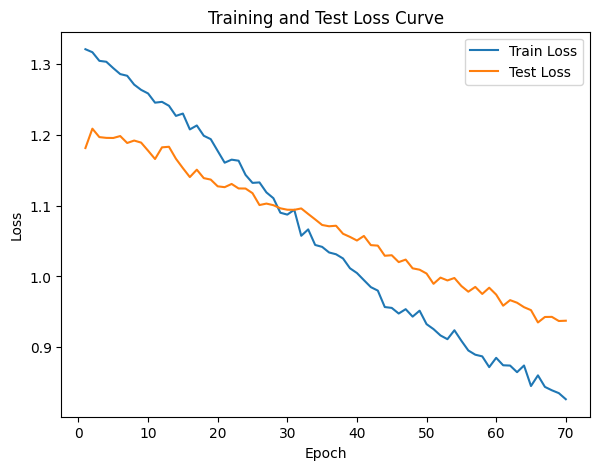

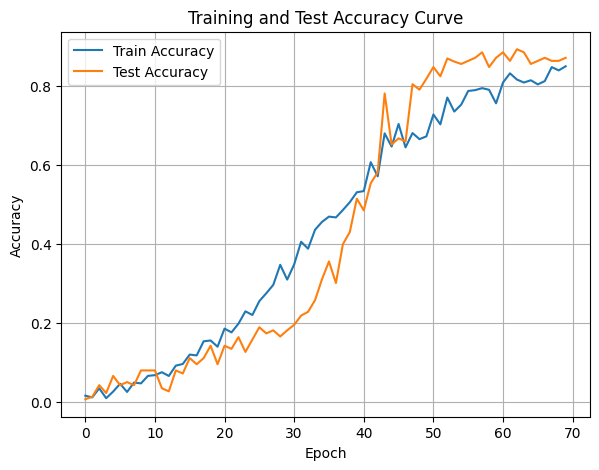

In [44]:
DTEmlp4b.train_single_model()

Randomly initializing 4 models
Training Model with id 1
in multi


Epoch [1/10], Train F1:0.3170489697705045, Train Loss: 1.1180, Train Acc: 0.3182, Test F1:0.4423698790513868, Test Loss: 1.1163, Test Acc: 0.4375

Training Process:  20%|██        | 2/10 [00:00<00:01,  7.22it/s]


Epoch [2/10], Train F1:0.34428067730547846, Train Loss: 1.1080, Train Acc: 0.3405, Test F1:0.4527635863718743, Test Loss: 1.1122, Test Acc: 0.4492


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.75it/s]

Epoch [3/10], Train F1:0.33267777648019414, Train Loss: 1.1110, Train Acc: 0.3299, Test F1:0.39519522979470423, Test Loss: 1.1108, Test Acc: 0.3912
Epoch [4/10], Train F1:0.335754342109648, Train Loss: 1.1109, Train Acc: 0.3324, Test F1:0.42155184709741833, Test Loss: 1.1061, Test Acc: 0.4164


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.50it/s]

Epoch [5/10], Train F1:0.3317808468221425, Train Loss: 1.1133, Train Acc: 0.3246, Test F1:0.43408393735799966, Test Loss: 1.1034, Test Acc: 0.4285
Epoch [6/10], Train F1:0.33544317102914195, Train Loss: 1.1104, Train Acc: 0.3282, Test F1:0.45154695939581047, Test Loss: 1.1007, Test Acc: 0.4466


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.74it/s]

Epoch [7/10], Train F1:0.3383153770389674, Train Loss: 1.1074, Train Acc: 0.3324, Test F1:0.4671173637395161, Test Loss: 1.0984, Test Acc: 0.4640
Epoch [8/10], Train F1:0.34651101832707926, Train Loss: 1.1039, Train Acc: 0.3403, Test F1:0.48412438854987105, Test Loss: 1.0952, Test Acc: 0.4832


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.35it/s]


Epoch [9/10], Train F1:0.35896925878247277, Train Loss: 1.0992, Train Acc: 0.3511, Test F1:0.4960245955271523, Test Loss: 1.0934, Test Acc: 0.4986
Epoch [10/10], Train F1:0.3653584454909925, Train Loss: 1.0967, Train Acc: 0.3574, Test F1:0.5018725482948734, Test Loss: 1.0911, Test Acc: 0.5069
Total Epochs: 10
Train loss start: 1.0785911083221436, Train loss end: 1.0166857242584229
Highest Mean Train Accuracy (over epoch): 0.35741071428571425
Test loss start: 1.1005240678787231, Test loss end: 1.0748417377471924
Highest mean Test Accuracy (over epoch): 0.5069444444444444


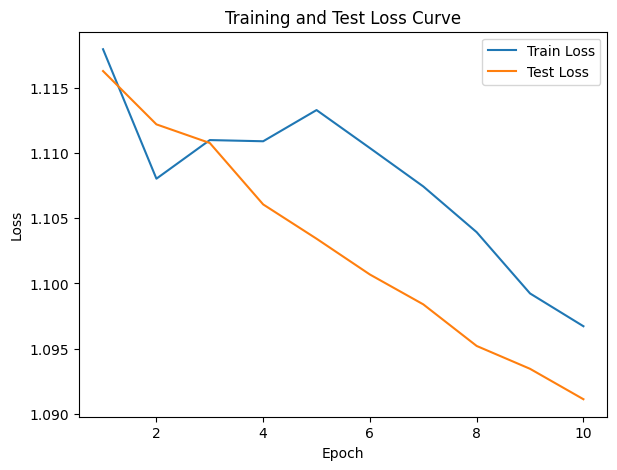

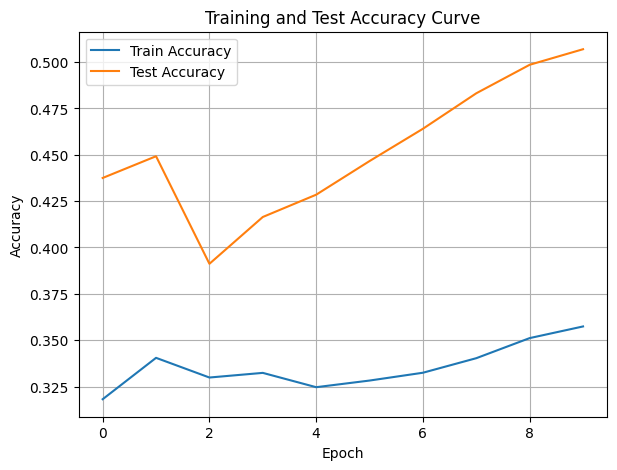

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.43it/s]

Epoch [1/10], Train F1:0.5153555416075183, Train Loss: 1.0457, Train Acc: 0.4610, Test F1:0.3941467425176699, Test Loss: 1.0913, Test Acc: 0.3967


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.34it/s]

Epoch [2/10], Train F1:0.5402123950180895, Train Loss: 1.0388, Train Acc: 0.4813, Test F1:0.38644474433948117, Test Loss: 1.0929, Test Acc: 0.4093


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.34it/s]

Epoch [3/10], Train F1:0.5564292007246721, Train Loss: 1.0334, Train Acc: 0.4946, Test F1:0.3896145299032017, Test Loss: 1.0916, Test Acc: 0.4187


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.92it/s]

Epoch [4/10], Train F1:0.5647219144297349, Train Loss: 1.0300, Train Acc: 0.5089, Test F1:0.3962091019899475, Test Loss: 1.0912, Test Acc: 0.4308


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.94it/s]

Epoch [5/10], Train F1:0.5774956122712868, Train Loss: 1.0279, Train Acc: 0.5189, Test F1:0.4015179490305478, Test Loss: 1.0887, Test Acc: 0.4392


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.62it/s]

Epoch [6/10], Train F1:0.5920931506605731, Train Loss: 1.0241, Train Acc: 0.5319, Test F1:0.40955105719985785, Test Loss: 1.0870, Test Acc: 0.4511


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.53it/s]

Epoch [7/10], Train F1:0.598210990072413, Train Loss: 1.0209, Train Acc: 0.5383, Test F1:0.4143373189833056, Test Loss: 1.0861, Test Acc: 0.4576


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.47it/s]

Epoch [8/10], Train F1:0.6061765466830145, Train Loss: 1.0175, Train Acc: 0.5475, Test F1:0.41865458392999905, Test Loss: 1.0848, Test Acc: 0.4615


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.50it/s]

Epoch [9/10], Train F1:0.6114820588657478, Train Loss: 1.0139, Train Acc: 0.5539, Test F1:0.4210666891587944, Test Loss: 1.0842, Test Acc: 0.4652


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.52it/s]


Epoch [10/10], Train F1:0.6163470110043237, Train Loss: 1.0116, Train Acc: 0.5614, Test F1:0.4296388442042051, Test Loss: 1.0827, Test Acc: 0.4728
Total Epochs: 10
Train loss start: 1.0886868238449097, Train loss end: 0.9899123311042786
Highest Mean Train Accuracy (over epoch): 0.5613988095238095
Test loss start: 1.0996593236923218, Test loss end: 1.0519212484359741
Highest mean Test Accuracy (over epoch): 0.4728298611111111


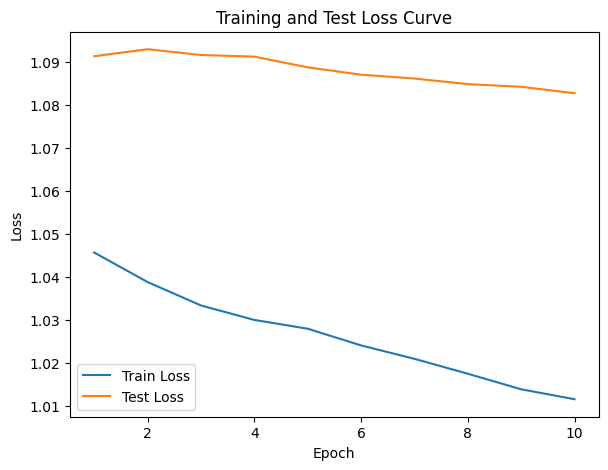

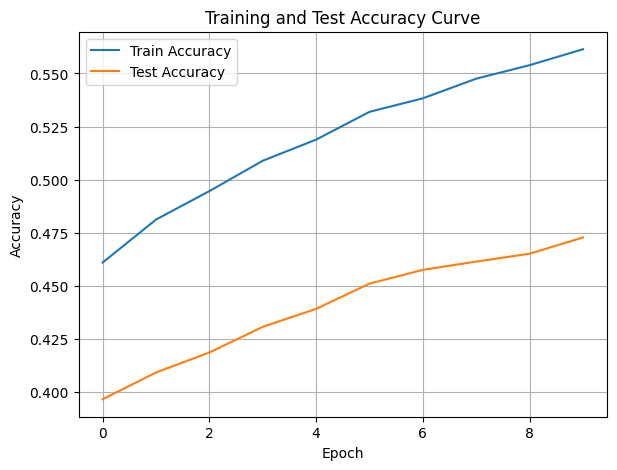

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.91it/s]

Epoch [1/10], Train F1:0.394816107807197, Train Loss: 1.1195, Train Acc: 0.3577, Test F1:0.582200956937799, Test Loss: 1.0820, Test Acc: 0.5590


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.52it/s]

Epoch [2/10], Train F1:0.4100661620430184, Train Loss: 1.1109, Train Acc: 0.3677, Test F1:0.6168957869989944, Test Loss: 1.0728, Test Acc: 0.6120


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.50it/s]

Epoch [3/10], Train F1:0.40800178288158245, Train Loss: 1.1110, Train Acc: 0.3668, Test F1:0.613221954236921, Test Loss: 1.0704, Test Acc: 0.6126


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.33it/s]

Epoch [4/10], Train F1:0.4249486804962719, Train Loss: 1.1055, Train Acc: 0.3833, Test F1:0.6103047942899806, Test Loss: 1.0669, Test Acc: 0.6144


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.49it/s]

Epoch [5/10], Train F1:0.43070288744347257, Train Loss: 1.1026, Train Acc: 0.3932, Test F1:0.6169814326335608, Test Loss: 1.0659, Test Acc: 0.6201


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.22it/s]

Epoch [6/10], Train F1:0.4342613556066369, Train Loss: 1.1002, Train Acc: 0.3972, Test F1:0.6299417030401786, Test Loss: 1.0620, Test Acc: 0.6328
Epoch [7/10], Train F1:0.44197751851188766, Train Loss: 1.0976, Train Acc: 0.4037, Test F1:0.625713246794672, Test Loss: 1.0585, Test Acc: 0.6372


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.18it/s]

Epoch [8/10], Train F1:0.4468157681903549, Train Loss: 1.0952, Train Acc: 0.4111, Test F1:0.6250278504753704, Test Loss: 1.0559, Test Acc: 0.6416
Epoch [9/10], Train F1:0.45400004396290566, Train Loss: 1.0915, Train Acc: 0.4177, Test F1:0.6274282178043552, Test Loss: 1.0539, Test Acc: 0.6459


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.76it/s]


Epoch [10/10], Train F1:0.45967679363445, Train Loss: 1.0885, Train Acc: 0.4252, Test F1:0.6304210953173688, Test Loss: 1.0508, Test Acc: 0.6523
Total Epochs: 10
Train loss start: 1.1489183902740479, Train loss end: 1.061306118965149
Highest Mean Train Accuracy (over epoch): 0.4252380952380953
Test loss start: 1.0908901691436768, Test loss end: 1.0136866569519043
Highest mean Test Accuracy (over epoch): 0.65234375


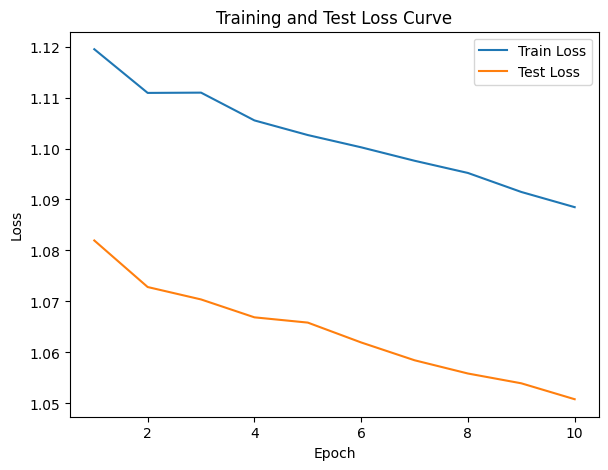

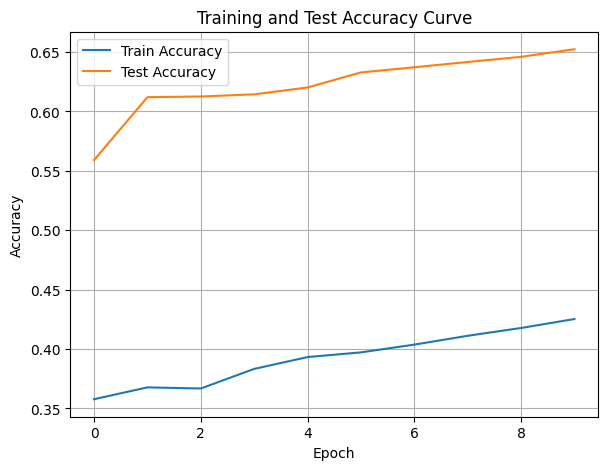

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4348573939711143, Train Loss: 1.0966, Train Acc: 0.3911, Test F1:0.5352859550004956, Test Loss: 1.0354, Test Acc: 0.6076


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.75it/s]

Epoch [2/10], Train F1:0.4365484242186113, Train Loss: 1.0954, Train Acc: 0.4000, Test F1:0.539362590874349, Test Loss: 1.0290, Test Acc: 0.6155


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.77it/s]

Epoch [3/10], Train F1:0.4501788717744009, Train Loss: 1.0884, Train Acc: 0.4148, Test F1:0.5492806735391565, Test Loss: 1.0195, Test Acc: 0.6279


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.79it/s]

Epoch [4/10], Train F1:0.4635408954997047, Train Loss: 1.0849, Train Acc: 0.4271, Test F1:0.5597608972272363, Test Loss: 1.0145, Test Acc: 0.6395


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.15it/s]

Epoch [5/10], Train F1:0.46928612496319816, Train Loss: 1.0813, Train Acc: 0.4343, Test F1:0.5649055993427131, Test Loss: 1.0107, Test Acc: 0.6450


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.26it/s]

Epoch [6/10], Train F1:0.47491924063125046, Train Loss: 1.0774, Train Acc: 0.4376, Test F1:0.5747005929039961, Test Loss: 1.0096, Test Acc: 0.6535


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.45it/s]

Epoch [7/10], Train F1:0.4801355258331394, Train Loss: 1.0750, Train Acc: 0.4424, Test F1:0.5801828609534497, Test Loss: 1.0081, Test Acc: 0.6596


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.16it/s]

Epoch [8/10], Train F1:0.4862559759288331, Train Loss: 1.0724, Train Acc: 0.4490, Test F1:0.5903110839580049, Test Loss: 1.0044, Test Acc: 0.6671


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.52it/s]

Epoch [9/10], Train F1:0.49483054593818127, Train Loss: 1.0680, Train Acc: 0.4587, Test F1:0.5981249132463081, Test Loss: 1.0011, Test Acc: 0.6729


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.74it/s]


Epoch [10/10], Train F1:0.5036268907688046, Train Loss: 1.0635, Train Acc: 0.4685, Test F1:0.6043365605999503, Test Loss: 0.9980, Test Acc: 0.6776
Total Epochs: 10
Train loss start: 1.120911955833435, Train loss end: 0.9402269721031189
Highest Mean Train Accuracy (over epoch): 0.46851190476190474
Test loss start: 1.0165300369262695, Test loss end: 0.9705601930618286
Highest mean Test Accuracy (over epoch): 0.6776041666666667


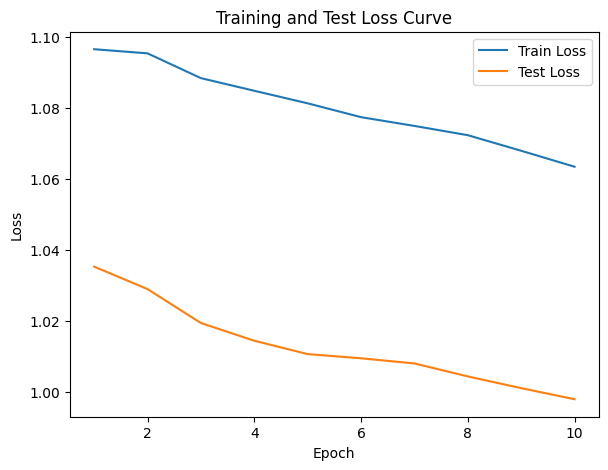

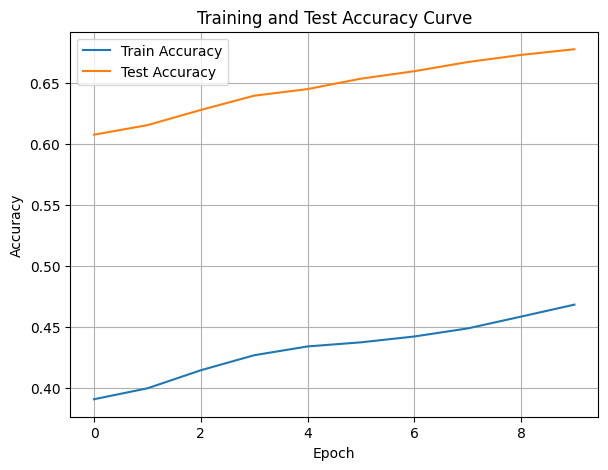

./saved_models/model_4.pth
Training Model with id 7
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.6090822419589543, Train Loss: 1.0026, Train Acc: 0.5682, Test F1:0.6288499025341131, Test Loss: 0.9733, Test Acc: 0.7040


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.48it/s]

Epoch [2/10], Train F1:0.5927731892897651, Train Loss: 1.0098, Train Acc: 0.5534, Test F1:0.6288499025341131, Test Loss: 0.9690, Test Acc: 0.7040


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.48it/s]

Epoch [3/10], Train F1:0.5928848711553802, Train Loss: 1.0115, Train Acc: 0.5594, Test F1:0.623684970216734, Test Loss: 0.9666, Test Acc: 0.7014


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.83it/s]

Epoch [4/10], Train F1:0.5969765964707101, Train Loss: 1.0076, Train Acc: 0.5687, Test F1:0.6364960444070288, Test Loss: 0.9626, Test Acc: 0.7079


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.20it/s]

Epoch [5/10], Train F1:0.5965678019459532, Train Loss: 1.0044, Train Acc: 0.5732, Test F1:0.6440242665722565, Test Loss: 0.9571, Test Acc: 0.7118


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.31it/s]

Epoch [6/10], Train F1:0.6005179045863613, Train Loss: 0.9997, Train Acc: 0.5811, Test F1:0.6489794979582881, Test Loss: 0.9523, Test Acc: 0.7144


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.20it/s]

Epoch [7/10], Train F1:0.6065784464570754, Train Loss: 0.9957, Train Acc: 0.5885, Test F1:0.6513465047946387, Test Loss: 0.9485, Test Acc: 0.7171


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.18it/s]

Epoch [8/10], Train F1:0.6136939455457883, Train Loss: 0.9927, Train Acc: 0.5940, Test F1:0.6568009447266414, Test Loss: 0.9455, Test Acc: 0.7211


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.16it/s]

Epoch [9/10], Train F1:0.6168567506304664, Train Loss: 0.9899, Train Acc: 0.5985, Test F1:0.6602611578822368, Test Loss: 0.9420, Test Acc: 0.7227


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.43it/s]


Epoch [10/10], Train F1:0.6232482867574719, Train Loss: 0.9863, Train Acc: 0.6043, Test F1:0.6665816321559419, Test Loss: 0.9389, Test Acc: 0.7269
Total Epochs: 10
Train loss start: 1.0277806520462036, Train loss end: 1.044447660446167
Highest Mean Train Accuracy (over epoch): 0.6042857142857142
Test loss start: 0.9541693925857544, Test loss end: 0.9049137830734253
Highest mean Test Accuracy (over epoch): 0.7269097222222222


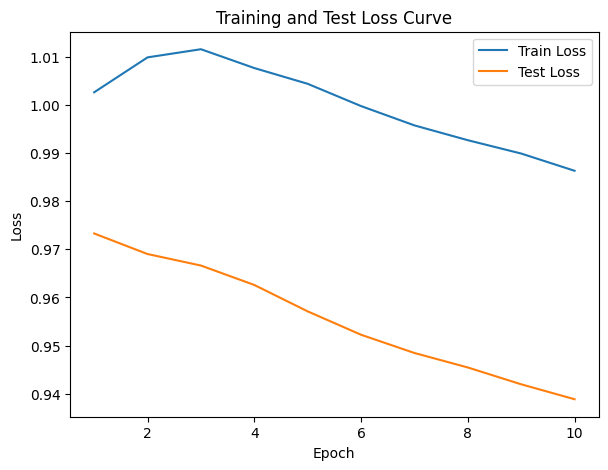

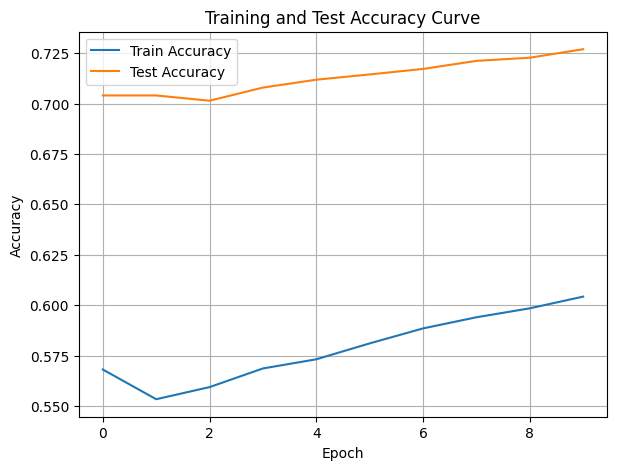

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.65it/s]

Epoch [1/10], Train F1:0.6895467032967032, Train Loss: 0.9523, Train Acc: 0.6744, Test F1:0.7211008653709746, Test Loss: 0.9037, Test Acc: 0.7648


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.40it/s]

Epoch [2/10], Train F1:0.6735828935194369, Train Loss: 0.9541, Train Acc: 0.6656, Test F1:0.7010093786957837, Test Loss: 0.9038, Test Acc: 0.7530


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.17it/s]

Epoch [3/10], Train F1:0.6814435410984898, Train Loss: 0.9467, Train Acc: 0.6706, Test F1:0.7122706511259354, Test Loss: 0.9031, Test Acc: 0.7595


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.62it/s]

Epoch [4/10], Train F1:0.6840756643801088, Train Loss: 0.9403, Train Acc: 0.6811, Test F1:0.7211008653709746, Test Loss: 0.9004, Test Acc: 0.7648


Training Process:  60%|██████    | 6/10 [00:00<00:00,  5.92it/s]

Epoch [5/10], Train F1:0.6816445204455408, Train Loss: 0.9415, Train Acc: 0.6798, Test F1:0.7263257697637404, Test Loss: 0.8994, Test Acc: 0.7679
Epoch [6/10], Train F1:0.6824221732328567, Train Loss: 0.9382, Train Acc: 0.6813, Test F1:0.7254586848801392, Test Loss: 0.8982, Test Acc: 0.7674


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.18it/s]

Epoch [7/10], Train F1:0.6862925700769547, Train Loss: 0.9335, Train Acc: 0.6864, Test F1:0.7248384300361012, Test Loss: 0.8965, Test Acc: 0.7670
Epoch [8/10], Train F1:0.6933825904254383, Train Loss: 0.9289, Train Acc: 0.6926, Test F1:0.7227394475340266, Test Loss: 0.8946, Test Acc: 0.7657


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.81it/s]


Epoch [9/10], Train F1:0.6966142502834131, Train Loss: 0.9244, Train Acc: 0.6972, Test F1:0.7211008653709745, Test Loss: 0.8940, Test Acc: 0.7648
Epoch [10/10], Train F1:0.6989305544233673, Train Loss: 0.9223, Train Acc: 0.7001, Test F1:0.7224121556001785, Test Loss: 0.8926, Test Acc: 0.7655
Total Epochs: 10
Train loss start: 0.9350785613059998, Train loss end: 0.9308524131774902
Highest Mean Train Accuracy (over epoch): 0.7001488095238095
Test loss start: 0.8773996829986572, Test loss end: 0.867868185043335
Highest mean Test Accuracy (over epoch): 0.7678819444444445


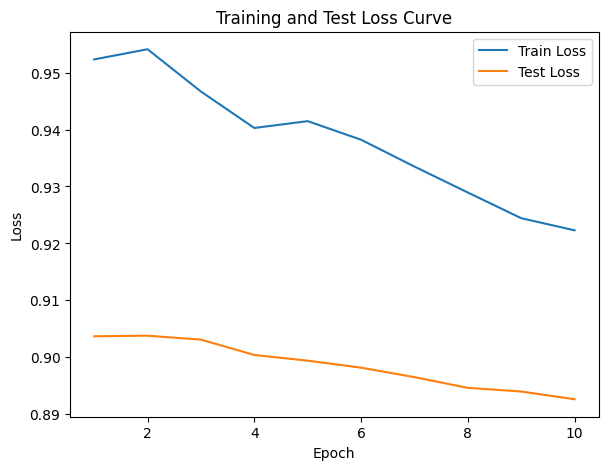

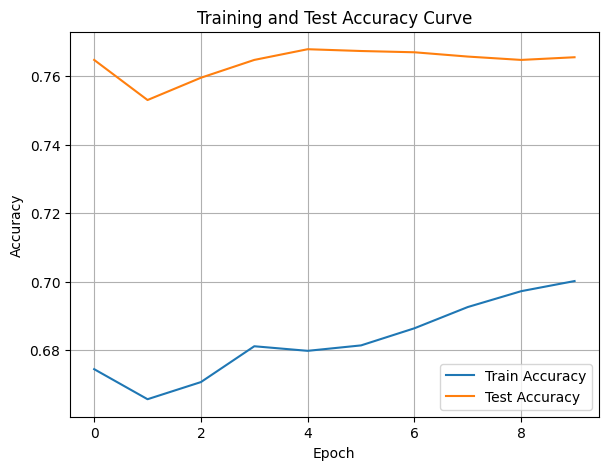

./saved_models/model_8.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.34it/s]

Epoch [1/10], Train F1:0.7299474502693819, Train Loss: 0.8908, Train Acc: 0.7414, Test F1:0.7590487847525791, Test Loss: 0.8753, Test Acc: 0.7943


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.28it/s]

Epoch [2/10], Train F1:0.7162352514465191, Train Loss: 0.8971, Train Acc: 0.7225, Test F1:0.7404238857726501, Test Loss: 0.8741, Test Acc: 0.7795


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.64it/s]

Epoch [3/10], Train F1:0.7310677343022356, Train Loss: 0.8898, Train Acc: 0.7364, Test F1:0.767119217131866, Test Loss: 0.8688, Test Acc: 0.7975


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.63it/s]

Epoch [4/10], Train F1:0.7391875551523026, Train Loss: 0.8831, Train Acc: 0.7444, Test F1:0.7711090591977018, Test Loss: 0.8640, Test Acc: 0.8006
Epoch [5/10], Train F1:0.7419796090216676, Train Loss: 0.8821, Train Acc: 0.7480, Test F1:0.7711090591977018, Test Loss: 0.8615, Test Acc: 0.8009


Training Process:  60%|██████    | 6/10 [00:01<00:00,  4.99it/s]

Epoch [6/10], Train F1:0.7458542910589391, Train Loss: 0.8772, Train Acc: 0.7539, Test F1:0.7730929114723094, Test Loss: 0.8584, Test Acc: 0.8024
Epoch [7/10], Train F1:0.7473576461318885, Train Loss: 0.8743, Train Acc: 0.7569, Test F1:0.7778806931134388, Test Loss: 0.8554, Test Acc: 0.8057


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.39it/s]

Epoch [8/10], Train F1:0.7452723722801246, Train Loss: 0.8736, Train Acc: 0.7564, Test F1:0.7843611497351701, Test Loss: 0.8537, Test Acc: 0.8109
Epoch [9/10], Train F1:0.7447793924340946, Train Loss: 0.8723, Train Acc: 0.7559, Test F1:0.7841994932144891, Test Loss: 0.8525, Test Acc: 0.8108


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.11it/s]


Epoch [10/10], Train F1:0.7416323820243329, Train Loss: 0.8706, Train Acc: 0.7541, Test F1:0.7840701337080833, Test Loss: 0.8510, Test Acc: 0.8107
Total Epochs: 10
Train loss start: 0.8687994480133057, Train loss end: 0.8457013368606567
Highest Mean Train Accuracy (over epoch): 0.7568877551020409
Test loss start: 0.8520609140396118, Test loss end: 0.8279364109039307
Highest mean Test Accuracy (over epoch): 0.8108723958333334


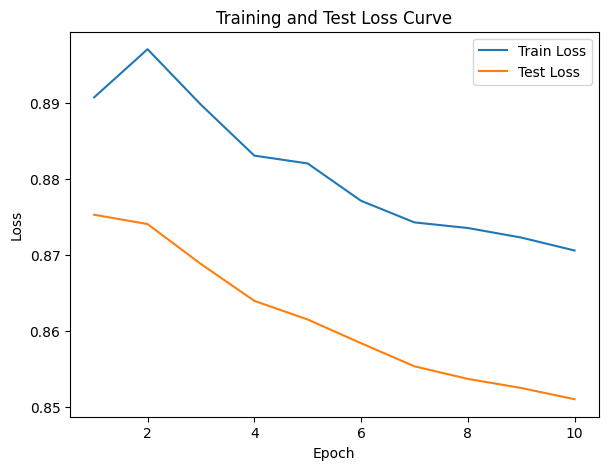

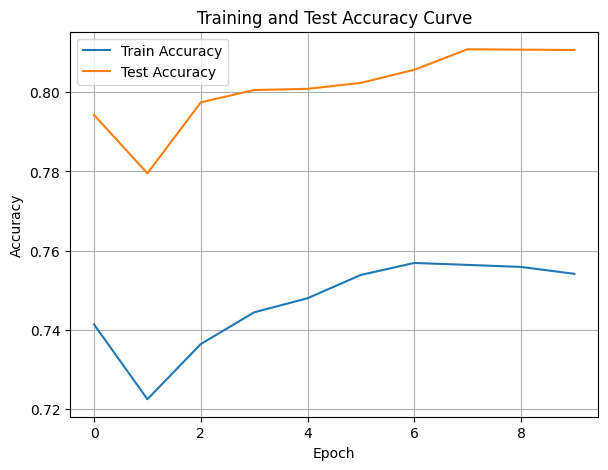

./saved_models/model_6.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [45]:
DTEmlp4b.train_DTE()

Training Process:   1%|▏         | 1/70 [00:00<00:09,  7.32it/s]

Epoch [1/70], Train F1:0.41825793307585546, Train Loss: 1.1101, Train Acc: 0.3815, Test F1:0.25807661098519824, Test Loss: 1.0921, Test Acc: 0.2465


Training Process:   3%|▎         | 2/70 [00:00<00:11,  5.96it/s]

Epoch [2/70], Train F1:0.4336702327861099, Train Loss: 1.0981, Train Acc: 0.4040, Test F1:0.24854803123054398, Test Loss: 1.0886, Test Acc: 0.2426


Training Process:   4%|▍         | 3/70 [00:00<00:12,  5.39it/s]

Epoch [3/70], Train F1:0.43292990195645054, Train Loss: 1.0957, Train Acc: 0.4014, Test F1:0.2416930069587376, Test Loss: 1.0890, Test Acc: 0.2433


Training Process:   6%|▌         | 4/70 [00:00<00:12,  5.21it/s]

Epoch [4/70], Train F1:0.44129600051013396, Train Loss: 1.0916, Train Acc: 0.4060, Test F1:0.23809796702698152, Test Loss: 1.0889, Test Acc: 0.2422


Training Process:   9%|▊         | 6/70 [00:01<00:11,  5.44it/s]

Epoch [5/70], Train F1:0.4439806376533521, Train Loss: 1.0878, Train Acc: 0.4099, Test F1:0.24422847417826052, Test Loss: 1.0876, Test Acc: 0.2462
Epoch [6/70], Train F1:0.45502602915553175, Train Loss: 1.0814, Train Acc: 0.4233, Test F1:0.2454372061392629, Test Loss: 1.0875, Test Acc: 0.2509


Training Process:  10%|█         | 7/70 [00:01<00:12,  5.20it/s]

Epoch [7/70], Train F1:0.4538602285227672, Train Loss: 1.0770, Train Acc: 0.4251, Test F1:0.2521647801700599, Test Loss: 1.0864, Test Acc: 0.2564


Training Process:  11%|█▏        | 8/70 [00:01<00:12,  5.03it/s]

Epoch [8/70], Train F1:0.45858164109140725, Train Loss: 1.0721, Train Acc: 0.4315, Test F1:0.25802967114084, Test Loss: 1.0849, Test Acc: 0.2626


Training Process:  13%|█▎        | 9/70 [00:01<00:12,  5.01it/s]

Epoch [9/70], Train F1:0.4633275292341411, Train Loss: 1.0683, Train Acc: 0.4377, Test F1:0.2678216233101847, Test Loss: 1.0830, Test Acc: 0.2715


Training Process:  14%|█▍        | 10/70 [00:01<00:12,  4.83it/s]

Epoch [10/70], Train F1:0.46744664517119605, Train Loss: 1.0651, Train Acc: 0.4427, Test F1:0.2738181982470853, Test Loss: 1.0818, Test Acc: 0.2771


Training Process:  16%|█▌        | 11/70 [00:02<00:11,  5.02it/s]

Epoch [11/70], Train F1:0.4689647833466126, Train Loss: 1.0628, Train Acc: 0.4440, Test F1:0.28033885640968975, Test Loss: 1.0803, Test Acc: 0.2831


Training Process:  17%|█▋        | 12/70 [00:02<00:11,  5.00it/s]

Epoch [12/70], Train F1:0.4764225753950341, Train Loss: 1.0584, Train Acc: 0.4530, Test F1:0.2872533953300369, Test Loss: 1.0791, Test Acc: 0.2894


Training Process:  19%|█▊        | 13/70 [00:02<00:11,  4.93it/s]

Epoch [13/70], Train F1:0.47957050016096103, Train Loss: 1.0561, Train Acc: 0.4564, Test F1:0.2936949493263632, Test Loss: 1.0779, Test Acc: 0.2959


Training Process:  21%|██▏       | 15/70 [00:02<00:10,  5.10it/s]

Epoch [14/70], Train F1:0.48681499789917676, Train Loss: 1.0523, Train Acc: 0.4653, Test F1:0.3049602961811049, Test Loss: 1.0763, Test Acc: 0.3048
Epoch [15/70], Train F1:0.49215225945018976, Train Loss: 1.0492, Train Acc: 0.4720, Test F1:0.314672335381173, Test Loss: 1.0748, Test Acc: 0.3135


Training Process:  24%|██▍       | 17/70 [00:03<00:08,  6.06it/s]

Epoch [16/70], Train F1:0.49881573548198815, Train Loss: 1.0456, Train Acc: 0.4801, Test F1:0.32043965811410113, Test Loss: 1.0731, Test Acc: 0.3196
Epoch [17/70], Train F1:0.5058998191050711, Train Loss: 1.0416, Train Acc: 0.4874, Test F1:0.33150385896558915, Test Loss: 1.0714, Test Acc: 0.3295


Training Process:  27%|██▋       | 19/70 [00:03<00:08,  5.87it/s]

Epoch [18/70], Train F1:0.5135076991337519, Train Loss: 1.0372, Train Acc: 0.4958, Test F1:0.3383138737004362, Test Loss: 1.0702, Test Acc: 0.3366
Epoch [19/70], Train F1:0.5217809522793302, Train Loss: 1.0336, Train Acc: 0.5037, Test F1:0.3454709935980844, Test Loss: 1.0687, Test Acc: 0.3436


Training Process:  30%|███       | 21/70 [00:03<00:08,  5.78it/s]

Epoch [20/70], Train F1:0.5250025798594006, Train Loss: 1.0304, Train Acc: 0.5082, Test F1:0.36001391169758007, Test Loss: 1.0666, Test Acc: 0.3554
Epoch [21/70], Train F1:0.5299882054960632, Train Loss: 1.0276, Train Acc: 0.5131, Test F1:0.37262291952850196, Test Loss: 1.0647, Test Acc: 0.3664


Training Process:  33%|███▎      | 23/70 [00:04<00:07,  6.00it/s]

Epoch [22/70], Train F1:0.5355927321363918, Train Loss: 1.0239, Train Acc: 0.5195, Test F1:0.37798482575399484, Test Loss: 1.0634, Test Acc: 0.3716
Epoch [23/70], Train F1:0.5426586869679836, Train Loss: 1.0202, Train Acc: 0.5269, Test F1:0.3844519562675867, Test Loss: 1.0618, Test Acc: 0.3773


Training Process:  34%|███▍      | 24/70 [00:04<00:07,  6.24it/s]

Epoch [24/70], Train F1:0.55017452381957, Train Loss: 1.0163, Train Acc: 0.5350, Test F1:0.3957141326548975, Test Loss: 1.0604, Test Acc: 0.3864


Training Process:  36%|███▌      | 25/70 [00:04<00:07,  5.85it/s]

Epoch [25/70], Train F1:0.5542740847291284, Train Loss: 1.0135, Train Acc: 0.5389, Test F1:0.40387021878709595, Test Loss: 1.0591, Test Acc: 0.3943


Training Process:  37%|███▋      | 26/70 [00:04<00:08,  5.21it/s]

Epoch [26/70], Train F1:0.5590145958280355, Train Loss: 1.0103, Train Acc: 0.5443, Test F1:0.41731552841430064, Test Loss: 1.0575, Test Acc: 0.4055


Training Process:  39%|███▊      | 27/70 [00:05<00:09,  4.62it/s]

Epoch [27/70], Train F1:0.5621169018462339, Train Loss: 1.0073, Train Acc: 0.5482, Test F1:0.4303324509856222, Test Loss: 1.0559, Test Acc: 0.4165


Training Process:  40%|████      | 28/70 [00:05<00:09,  4.38it/s]

Epoch [28/70], Train F1:0.5653887099418545, Train Loss: 1.0044, Train Acc: 0.5525, Test F1:0.4408715104628249, Test Loss: 1.0542, Test Acc: 0.4258


Training Process:  41%|████▏     | 29/70 [00:05<00:10,  4.04it/s]

Epoch [29/70], Train F1:0.5698715767111345, Train Loss: 1.0015, Train Acc: 0.5579, Test F1:0.4554981849679481, Test Loss: 1.0525, Test Acc: 0.4391


Training Process:  43%|████▎     | 30/70 [00:05<00:09,  4.33it/s]

Epoch [30/70], Train F1:0.5749084263124001, Train Loss: 0.9980, Train Acc: 0.5635, Test F1:0.46526514154488197, Test Loss: 1.0512, Test Acc: 0.4480


Training Process:  44%|████▍     | 31/70 [00:06<00:08,  4.34it/s]

Epoch [31/70], Train F1:0.5787055415099577, Train Loss: 0.9957, Train Acc: 0.5673, Test F1:0.4734545918548747, Test Loss: 1.0500, Test Acc: 0.4552


Training Process:  46%|████▌     | 32/70 [00:06<00:08,  4.28it/s]

Epoch [32/70], Train F1:0.5848309617150256, Train Loss: 0.9922, Train Acc: 0.5739, Test F1:0.47822570001280995, Test Loss: 1.0486, Test Acc: 0.4600


Training Process:  47%|████▋     | 33/70 [00:06<00:08,  4.16it/s]

Epoch [33/70], Train F1:0.5891854759044515, Train Loss: 0.9895, Train Acc: 0.5783, Test F1:0.4826989673882299, Test Loss: 1.0472, Test Acc: 0.4646


Training Process:  49%|████▊     | 34/70 [00:06<00:09,  3.78it/s]

Epoch [34/70], Train F1:0.5930981667918207, Train Loss: 0.9867, Train Acc: 0.5829, Test F1:0.49239117663112386, Test Loss: 1.0459, Test Acc: 0.4736


Training Process:  50%|█████     | 35/70 [00:07<00:10,  3.35it/s]

Epoch [35/70], Train F1:0.5968463454252101, Train Loss: 0.9838, Train Acc: 0.5872, Test F1:0.49728799237073673, Test Loss: 1.0447, Test Acc: 0.4785


Training Process:  51%|█████▏    | 36/70 [00:07<00:11,  2.99it/s]

Epoch [36/70], Train F1:0.6006165894069811, Train Loss: 0.9811, Train Acc: 0.5911, Test F1:0.5056837973054173, Test Loss: 1.0434, Test Acc: 0.4867


Training Process:  53%|█████▎    | 37/70 [00:07<00:10,  3.16it/s]

Epoch [37/70], Train F1:0.604818582066962, Train Loss: 0.9782, Train Acc: 0.5955, Test F1:0.5154623181942631, Test Loss: 1.0418, Test Acc: 0.4961


Epoch [38/70], Train F1:0.6088195971124885, Train Loss: 0.9756, Train Acc: 0.5995, Test F1:0.5245498803068214, Test Loss: 1.0403, Test Acc: 0.5048


Training Process:  57%|█████▋    | 40/70 [00:08<00:06,  4.50it/s]

Epoch [39/70], Train F1:0.612890613541835, Train Loss: 0.9730, Train Acc: 0.6034, Test F1:0.5322338825219775, Test Loss: 1.0389, Test Acc: 0.5123
Epoch [40/70], Train F1:0.6171471351389844, Train Loss: 0.9702, Train Acc: 0.6079, Test F1:0.5400708177334783, Test Loss: 1.0375, Test Acc: 0.5201


Training Process:  59%|█████▊    | 41/70 [00:08<00:06,  4.81it/s]

Epoch [41/70], Train F1:0.6213397993765131, Train Loss: 0.9675, Train Acc: 0.6122, Test F1:0.5476258413843876, Test Loss: 1.0364, Test Acc: 0.5276


Training Process:  60%|██████    | 42/70 [00:08<00:06,  4.17it/s]

Epoch [42/70], Train F1:0.6254832085870341, Train Loss: 0.9651, Train Acc: 0.6163, Test F1:0.5557302945562158, Test Loss: 1.0349, Test Acc: 0.5358


Training Process:  61%|██████▏   | 43/70 [00:09<00:06,  3.88it/s]

Epoch [43/70], Train F1:0.6287268560319669, Train Loss: 0.9629, Train Acc: 0.6198, Test F1:0.5573478980127552, Test Loss: 1.0338, Test Acc: 0.5378


Training Process:  63%|██████▎   | 44/70 [00:09<00:06,  3.89it/s]

Epoch [44/70], Train F1:0.6317230254065573, Train Loss: 0.9606, Train Acc: 0.6229, Test F1:0.5630957389842683, Test Loss: 1.0326, Test Acc: 0.5435


Training Process:  64%|██████▍   | 45/70 [00:09<00:06,  3.97it/s]

Epoch [45/70], Train F1:0.6359976020095857, Train Loss: 0.9581, Train Acc: 0.6273, Test F1:0.5657391640629796, Test Loss: 1.0315, Test Acc: 0.5463


Training Process:  66%|██████▌   | 46/70 [00:10<00:06,  3.93it/s]

Epoch [46/70], Train F1:0.6398521757738829, Train Loss: 0.9555, Train Acc: 0.6312, Test F1:0.5723898801751868, Test Loss: 1.0302, Test Acc: 0.5530


Training Process:  67%|██████▋   | 47/70 [00:10<00:07,  3.01it/s]

Epoch [47/70], Train F1:0.6435927598579136, Train Loss: 0.9531, Train Acc: 0.6350, Test F1:0.5789952030284903, Test Loss: 1.0288, Test Acc: 0.5598


Training Process:  69%|██████▊   | 48/70 [00:11<00:08,  2.51it/s]

Epoch [48/70], Train F1:0.6467588035496007, Train Loss: 0.9509, Train Acc: 0.6383, Test F1:0.58511503069208, Test Loss: 1.0273, Test Acc: 0.5660


Training Process:  70%|███████   | 49/70 [00:11<00:09,  2.33it/s]

Epoch [49/70], Train F1:0.649525516635782, Train Loss: 0.9487, Train Acc: 0.6413, Test F1:0.5912748489044757, Test Loss: 1.0259, Test Acc: 0.5723


Training Process:  71%|███████▏  | 50/70 [00:12<00:10,  1.96it/s]

Epoch [50/70], Train F1:0.6533279383349218, Train Loss: 0.9461, Train Acc: 0.6453, Test F1:0.59411358133767, Test Loss: 1.0249, Test Acc: 0.5755


Training Process:  73%|███████▎  | 51/70 [00:12<00:09,  2.02it/s]

Epoch [51/70], Train F1:0.6572855489947086, Train Loss: 0.9434, Train Acc: 0.6494, Test F1:0.600016901558031, Test Loss: 1.0235, Test Acc: 0.5817


Training Process:  74%|███████▍  | 52/70 [00:13<00:09,  1.98it/s]

Epoch [52/70], Train F1:0.660503932326246, Train Loss: 0.9410, Train Acc: 0.6528, Test F1:0.6053460875834735, Test Loss: 1.0220, Test Acc: 0.5872


Training Process:  76%|███████▌  | 53/70 [00:13<00:08,  2.08it/s]

Epoch [53/70], Train F1:0.6637395980884376, Train Loss: 0.9388, Train Acc: 0.6561, Test F1:0.6104515928055639, Test Loss: 1.0206, Test Acc: 0.5926


Training Process:  77%|███████▋  | 54/70 [00:14<00:07,  2.24it/s]

Epoch [54/70], Train F1:0.6659991282012162, Train Loss: 0.9368, Train Acc: 0.6587, Test F1:0.6156659379359848, Test Loss: 1.0190, Test Acc: 0.5980


Training Process:  79%|███████▊  | 55/70 [00:14<00:05,  2.58it/s]

Epoch [55/70], Train F1:0.6690687752689924, Train Loss: 0.9346, Train Acc: 0.6618, Test F1:0.620515224438736, Test Loss: 1.0176, Test Acc: 0.6030


Training Process:  80%|████████  | 56/70 [00:14<00:04,  2.97it/s]

Epoch [56/70], Train F1:0.672144202948336, Train Loss: 0.9324, Train Acc: 0.6650, Test F1:0.6251766605003691, Test Loss: 1.0162, Test Acc: 0.6079


Training Process:  81%|████████▏ | 57/70 [00:14<00:03,  3.25it/s]

Epoch [57/70], Train F1:0.6744595095086987, Train Loss: 0.9304, Train Acc: 0.6675, Test F1:0.6296586270943404, Test Loss: 1.0148, Test Acc: 0.6127


Training Process:  83%|████████▎ | 58/70 [00:15<00:03,  3.35it/s]

Epoch [58/70], Train F1:0.677180306564786, Train Loss: 0.9284, Train Acc: 0.6703, Test F1:0.6335335768199752, Test Loss: 1.0136, Test Acc: 0.6167


Training Process:  84%|████████▍ | 59/70 [00:15<00:03,  3.02it/s]

Epoch [59/70], Train F1:0.6796816750189636, Train Loss: 0.9265, Train Acc: 0.6728, Test F1:0.6368401611277019, Test Loss: 1.0126, Test Acc: 0.6200


Training Process:  86%|████████▌ | 60/70 [00:15<00:03,  3.07it/s]

Epoch [60/70], Train F1:0.6823282385528208, Train Loss: 0.9246, Train Acc: 0.6754, Test F1:0.6406043271709553, Test Loss: 1.0115, Test Acc: 0.6237


Training Process:  87%|████████▋ | 61/70 [00:16<00:02,  3.19it/s]

Epoch [61/70], Train F1:0.6848793718908273, Train Loss: 0.9228, Train Acc: 0.6777, Test F1:0.6447922449166432, Test Loss: 1.0100, Test Acc: 0.6281


Training Process:  89%|████████▊ | 62/70 [00:16<00:02,  3.29it/s]

Epoch [62/70], Train F1:0.6879039005495731, Train Loss: 0.9208, Train Acc: 0.6806, Test F1:0.648027242535934, Test Loss: 1.0090, Test Acc: 0.6313


Training Process:  90%|█████████ | 63/70 [00:16<00:02,  3.42it/s]

Epoch [63/70], Train F1:0.6903992919580074, Train Loss: 0.9188, Train Acc: 0.6829, Test F1:0.6507560973180028, Test Loss: 1.0079, Test Acc: 0.6341


Training Process:  91%|█████████▏| 64/70 [00:17<00:01,  3.07it/s]

Epoch [64/70], Train F1:0.6928039225218592, Train Loss: 0.9168, Train Acc: 0.6855, Test F1:0.6533910409070306, Test Loss: 1.0069, Test Acc: 0.6369


Training Process:  93%|█████████▎| 65/70 [00:17<00:01,  2.69it/s]

Epoch [65/70], Train F1:0.6958031041298767, Train Loss: 0.9147, Train Acc: 0.6886, Test F1:0.6569750171891576, Test Loss: 1.0056, Test Acc: 0.6408


Training Process:  94%|█████████▍| 66/70 [00:17<00:01,  2.46it/s]

Epoch [66/70], Train F1:0.6977676307304223, Train Loss: 0.9127, Train Acc: 0.6907, Test F1:0.6608432239950945, Test Loss: 1.0045, Test Acc: 0.6448


Training Process:  96%|█████████▌| 67/70 [00:18<00:01,  2.43it/s]

Epoch [67/70], Train F1:0.7000699330971691, Train Loss: 0.9107, Train Acc: 0.6932, Test F1:0.6644569255839992, Test Loss: 1.0033, Test Acc: 0.6487


Training Process:  97%|█████████▋| 68/70 [00:18<00:00,  2.27it/s]

Epoch [68/70], Train F1:0.7022908823637911, Train Loss: 0.9089, Train Acc: 0.6954, Test F1:0.6680877978442386, Test Loss: 1.0020, Test Acc: 0.6525


Training Process:  99%|█████████▊| 69/70 [00:19<00:00,  2.18it/s]

Epoch [69/70], Train F1:0.7041780736083411, Train Loss: 0.9071, Train Acc: 0.6975, Test F1:0.671364985273308, Test Loss: 1.0009, Test Acc: 0.6560


Training Process: 100%|██████████| 70/70 [00:19<00:00,  3.55it/s]


Epoch [70/70], Train F1:0.7064435639809413, Train Loss: 0.9054, Train Acc: 0.6997, Test F1:0.6746707463123677, Test Loss: 0.9996, Test Acc: 0.6595
Total Epochs: 70
Train loss start: 1.1640230417251587, Train loss end: 0.9193854928016663
Highest Mean Train Accuracy (over epoch): 0.6996981292517006
Test loss start: 1.0998306274414062, Test loss end: 0.8803627490997314
Highest Mean Test Accuracy (over epoch): 0.6595238095238096


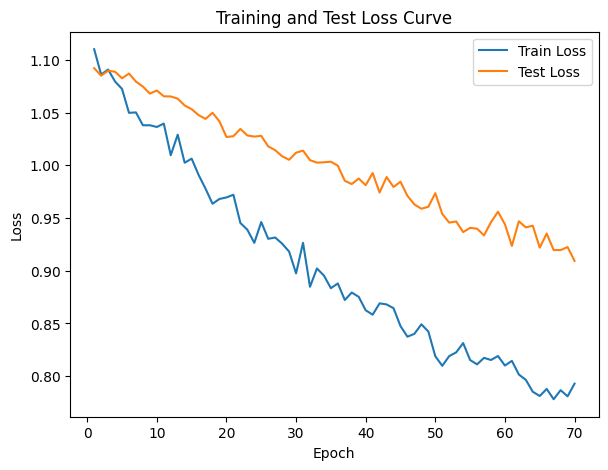

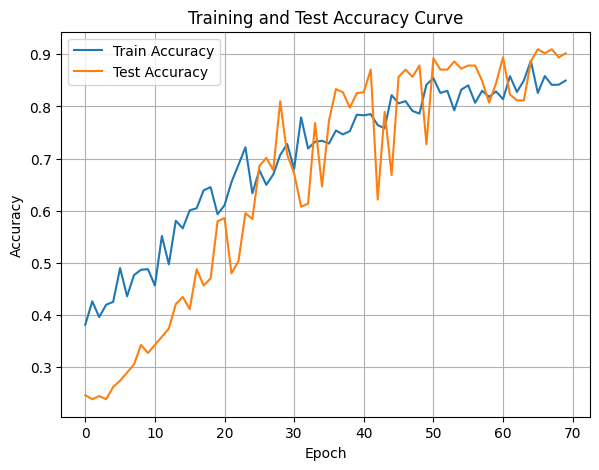

In [46]:
DTEmlp4b.train_single_model()

# Base 6

In [47]:
multiLayerPerceptron = MLP(input_size=input_size, hidden_layers=hidden_layers, output_size=output_size+1, dropout=.5) #hidden size default at 100

# Fill DTE params
modelSaveDirectory = './saved_models/'
DTEmlp6b = DeepTreeEnsemble(task_name='classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=6,
                                epochs=10,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.0001)

Randomly initializing 6 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.15it/s]

Epoch [1/10], Train F1:0.5371242429681632, Train Loss: 1.0323, Train Acc: 0.5140, Test F1:0.49033816425120774, Test Loss: 1.0743, Test Acc: 0.4688


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.12it/s]

Epoch [2/10], Train F1:0.5507519902656971, Train Loss: 1.0324, Train Acc: 0.5312, Test F1:0.47559864883984154, Test Loss: 1.0737, Test Acc: 0.4540
Epoch [3/10], Train F1:0.5459044679185194, Train Loss: 1.0342, Train Acc: 0.5262, Test F1:0.5150892695656667, Test Loss: 1.0676, Test Acc: 0.4948


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.80it/s]

Epoch [4/10], Train F1:0.5416744572007026, Train Loss: 1.0321, Train Acc: 0.5237, Test F1:0.5213612569207168, Test Loss: 1.0649, Test Acc: 0.5035
Epoch [5/10], Train F1:0.5475640605314319, Train Loss: 1.0288, Train Acc: 0.5354, Test F1:0.5538298653217446, Test Loss: 1.0630, Test Acc: 0.5373


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.89it/s]

Epoch [6/10], Train F1:0.5543577802859192, Train Loss: 1.0252, Train Acc: 0.5419, Test F1:0.5847181731637054, Test Loss: 1.0606, Test Acc: 0.5690
Epoch [7/10], Train F1:0.5589405189405189, Train Loss: 1.0214, Train Acc: 0.5497, Test F1:0.5966782913109124, Test Loss: 1.0588, Test Acc: 0.5827


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.43it/s]

Epoch [8/10], Train F1:0.5613150785790271, Train Loss: 1.0196, Train Acc: 0.5522, Test F1:0.6010145068010726, Test Loss: 1.0577, Test Acc: 0.5881
Epoch [9/10], Train F1:0.563773672585254, Train Loss: 1.0165, Train Acc: 0.5563, Test F1:0.6184345060920005, Test Loss: 1.0557, Test Acc: 0.6062


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.86it/s]


Epoch [10/10], Train F1:0.5681876538680956, Train Loss: 1.0137, Train Acc: 0.5617, Test F1:0.6315871031843923, Test Loss: 1.0537, Test Acc: 0.6205
Total Epochs: 10
Train loss start: 0.978596568107605, Train loss end: 0.9729050397872925
Highest Mean Train Accuracy (over epoch): 0.5616666666666666
Test loss start: 1.0724053382873535, Test loss end: 1.0294259786605835
Highest mean Test Accuracy (over epoch): 0.6204861111111111


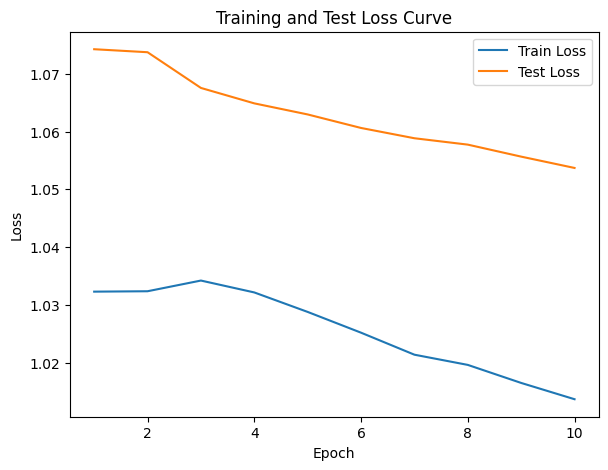

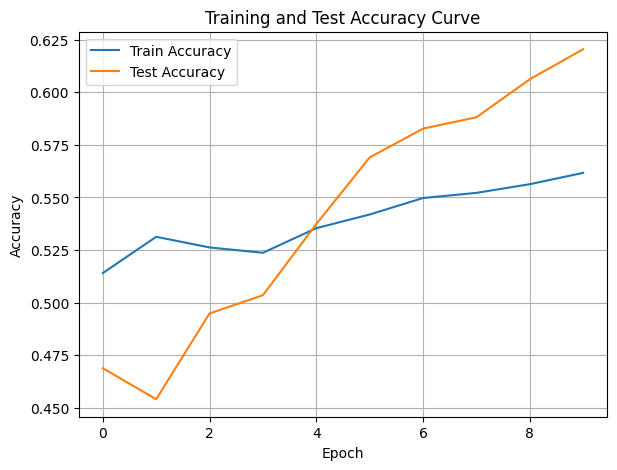

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.34it/s]

Epoch [1/10], Train F1:0.22235004301160086, Train Loss: 1.1888, Train Acc: 0.1354, Test F1:0.14483380429252865, Test Loss: 1.1489, Test Acc: 0.0885


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.21it/s]

Epoch [2/10], Train F1:0.22038101292539375, Train Loss: 1.1889, Train Acc: 0.1381, Test F1:0.12213622291021671, Test Loss: 1.1568, Test Acc: 0.0738


Training Process:  30%|███       | 3/10 [00:00<00:01,  5.09it/s]

Epoch [3/10], Train F1:0.20885291867323152, Train Loss: 1.1884, Train Acc: 0.1327, Test F1:0.0937230080851847, Test Loss: 1.1643, Test Acc: 0.0544


Training Process:  40%|████      | 4/10 [00:00<00:01,  4.79it/s]

Epoch [4/10], Train F1:0.22197255940094973, Train Loss: 1.1837, Train Acc: 0.1426, Test F1:0.09484975210636015, Test Loss: 1.1634, Test Acc: 0.0540


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.09it/s]

Epoch [5/10], Train F1:0.2303169470352367, Train Loss: 1.1787, Train Acc: 0.1504, Test F1:0.10132467943833354, Test Loss: 1.1611, Test Acc: 0.0582
Epoch [6/10], Train F1:0.243922711629924, Train Loss: 1.1740, Train Acc: 0.1595, Test F1:0.09561737800905731, Test Loss: 1.1614, Test Acc: 0.0547


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.48it/s]

Epoch [7/10], Train F1:0.2555435579212177, Train Loss: 1.1700, Train Acc: 0.1679, Test F1:0.10503879769866815, Test Loss: 1.1589, Test Acc: 0.0606
Epoch [8/10], Train F1:0.26484211560883175, Train Loss: 1.1659, Train Acc: 0.1767, Test F1:0.10788148051277993, Test Loss: 1.1565, Test Acc: 0.0624


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.27it/s]


Epoch [9/10], Train F1:0.2712274157031923, Train Loss: 1.1631, Train Acc: 0.1821, Test F1:0.11564716905367421, Test Loss: 1.1542, Test Acc: 0.0677
Epoch [10/10], Train F1:0.2822212039700802, Train Loss: 1.1591, Train Acc: 0.1897, Test F1:0.12197111607952144, Test Loss: 1.1529, Test Acc: 0.0714
Total Epochs: 10
Train loss start: 1.179992914199829, Train loss end: 1.180176854133606
Highest Mean Train Accuracy (over epoch): 0.18967261904761903
Test loss start: 1.1449508666992188, Test loss end: 1.121191143989563
Highest mean Test Accuracy (over epoch): 0.08854166666666666


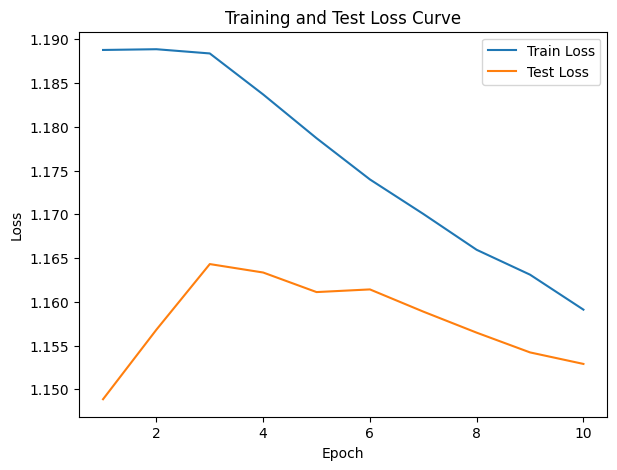

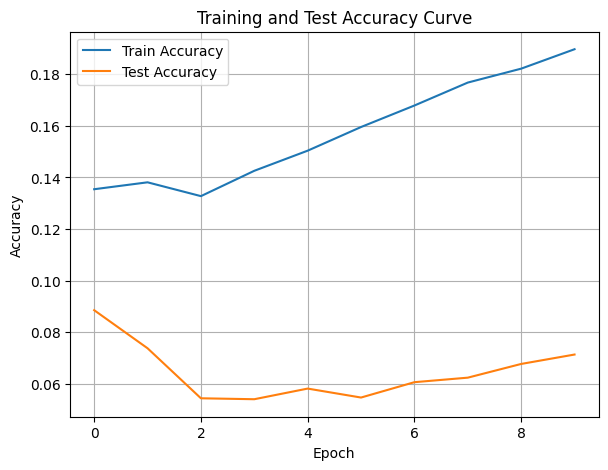

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.45548391158586166, Train Loss: 1.0737, Train Acc: 0.4077, Test F1:0.31391283683304055, Test Loss: 1.1129, Test Acc: 0.2352


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.98it/s]

Epoch [2/10], Train F1:0.45664032923892234, Train Loss: 1.0769, Train Acc: 0.4013, Test F1:0.2509495279248729, Test Loss: 1.1284, Test Acc: 0.1775


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.74it/s]

Epoch [3/10], Train F1:0.4472864022480997, Train Loss: 1.0776, Train Acc: 0.3909, Test F1:0.24010429682944306, Test Loss: 1.1328, Test Acc: 0.1837


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.00it/s]

Epoch [4/10], Train F1:0.4597125952989395, Train Loss: 1.0711, Train Acc: 0.4018, Test F1:0.2388073861370275, Test Loss: 1.1338, Test Acc: 0.1981


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.39it/s]

Epoch [5/10], Train F1:0.47138725891493, Train Loss: 1.0657, Train Acc: 0.4153, Test F1:0.23256341412581064, Test Loss: 1.1335, Test Acc: 0.1962


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.10it/s]

Epoch [6/10], Train F1:0.4771900579364827, Train Loss: 1.0638, Train Acc: 0.4224, Test F1:0.24689456599881468, Test Loss: 1.1287, Test Acc: 0.2086
Epoch [7/10], Train F1:0.4816450470407081, Train Loss: 1.0608, Train Acc: 0.4295, Test F1:0.2531334511951262, Test Loss: 1.1265, Test Acc: 0.2144


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.77it/s]

Epoch [8/10], Train F1:0.4921147597778372, Train Loss: 1.0575, Train Acc: 0.4401, Test F1:0.2646128095044504, Test Loss: 1.1231, Test Acc: 0.2263
Epoch [9/10], Train F1:0.5016362037982247, Train Loss: 1.0528, Train Acc: 0.4498, Test F1:0.2673363379420976, Test Loss: 1.1226, Test Acc: 0.2271


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.28it/s]


Epoch [10/10], Train F1:0.5090077024051967, Train Loss: 1.0485, Train Acc: 0.4578, Test F1:0.27179812993632385, Test Loss: 1.1212, Test Acc: 0.2331
Total Epochs: 10
Train loss start: 1.0270243883132935, Train loss end: 1.0316416025161743
Highest Mean Train Accuracy (over epoch): 0.4578273809523809
Test loss start: 1.1323882341384888, Test loss end: 1.0859023332595825
Highest mean Test Accuracy (over epoch): 0.23524305555555555


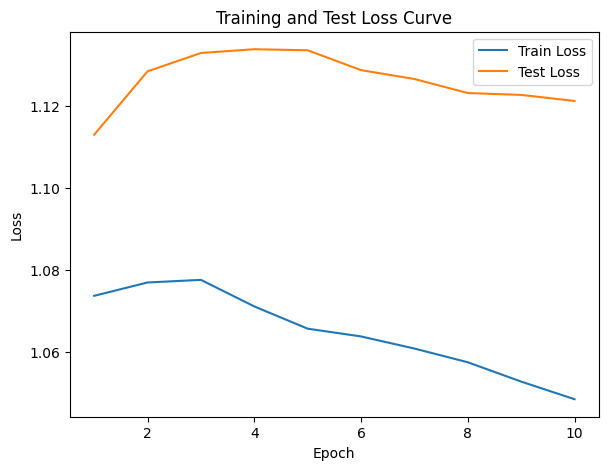

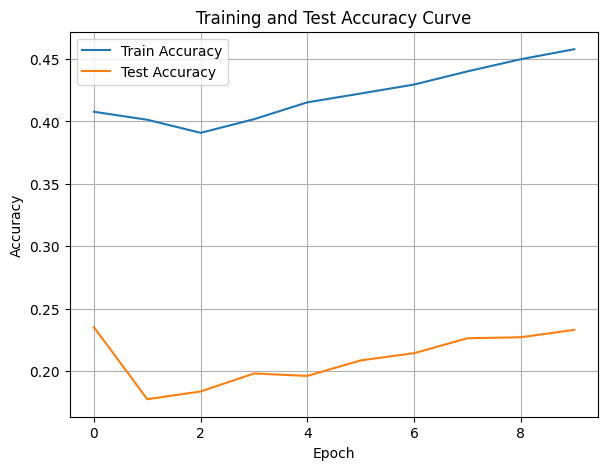

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.61it/s]

Epoch [1/10], Train F1:0.573427029216791, Train Loss: 1.0268, Train Acc: 0.5420, Test F1:0.6996979628558576, Test Loss: 1.0501, Test Acc: 0.6962


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.19it/s]

Epoch [2/10], Train F1:0.5714855883181674, Train Loss: 1.0270, Train Acc: 0.5452, Test F1:0.6998082666655342, Test Loss: 1.0379, Test Acc: 0.7188


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.30it/s]

Epoch [3/10], Train F1:0.5932159943093795, Train Loss: 1.0206, Train Acc: 0.5699, Test F1:0.7122018291497388, Test Loss: 1.0314, Test Acc: 0.7341


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.39it/s]

Epoch [4/10], Train F1:0.5920220188254967, Train Loss: 1.0196, Train Acc: 0.5719, Test F1:0.7181829540879368, Test Loss: 1.0234, Test Acc: 0.7418
Epoch [5/10], Train F1:0.6013720387755978, Train Loss: 1.0160, Train Acc: 0.5822, Test F1:0.7252551929405353, Test Loss: 1.0208, Test Acc: 0.7479


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.59it/s]

Epoch [6/10], Train F1:0.6092552814207913, Train Loss: 1.0115, Train Acc: 0.5881, Test F1:0.7321495517134016, Test Loss: 1.0191, Test Acc: 0.7533
Epoch [7/10], Train F1:0.6158219863627833, Train Loss: 1.0090, Train Acc: 0.5951, Test F1:0.7412711995945701, Test Loss: 1.0179, Test Acc: 0.7586


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.50it/s]

Epoch [8/10], Train F1:0.6223043529496708, Train Loss: 1.0056, Train Acc: 0.6036, Test F1:0.7486343824605208, Test Loss: 1.0149, Test Acc: 0.7660


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.01it/s]

Epoch [9/10], Train F1:0.6278607936478858, Train Loss: 1.0036, Train Acc: 0.6070, Test F1:0.7576910183124514, Test Loss: 1.0136, Test Acc: 0.7719


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.09it/s]


Epoch [10/10], Train F1:0.6344135680394437, Train Loss: 0.9991, Train Acc: 0.6158, Test F1:0.7588090828982021, Test Loss: 1.0104, Test Acc: 0.7741
Total Epochs: 10
Train loss start: 1.0121489763259888, Train loss end: 0.8345933556556702
Highest Mean Train Accuracy (over epoch): 0.6158035714285715
Test loss start: 1.0477619171142578, Test loss end: 0.9752206802368164
Highest mean Test Accuracy (over epoch): 0.7741319444444444


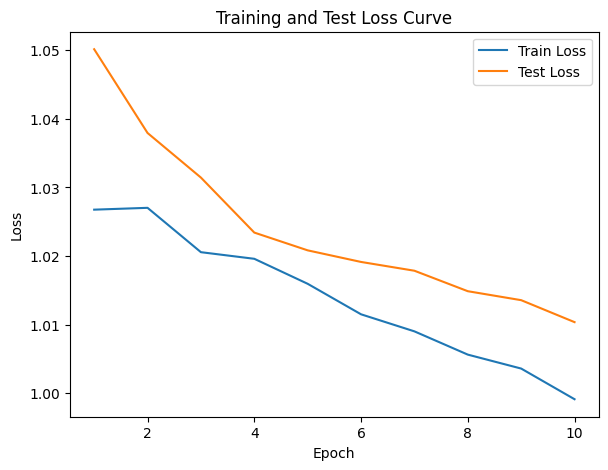

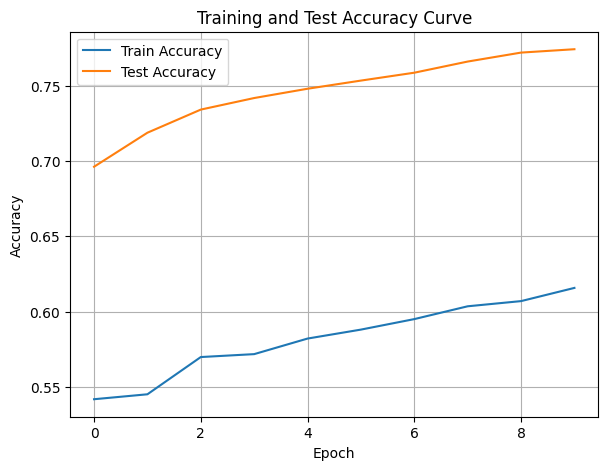

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.88it/s]

Epoch [1/10], Train F1:0.3785140897602904, Train Loss: 1.1050, Train Acc: 0.3095, Test F1:0.35980972483519175, Test Loss: 1.0928, Test Acc: 0.3733


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.69it/s]

Epoch [2/10], Train F1:0.381961512665738, Train Loss: 1.1045, Train Acc: 0.3190, Test F1:0.37120186358011203, Test Loss: 1.0857, Test Acc: 0.4076


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.84it/s]

Epoch [3/10], Train F1:0.3961782539639198, Train Loss: 1.1024, Train Acc: 0.3309, Test F1:0.38743012578984704, Test Loss: 1.0829, Test Acc: 0.4216


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.40it/s]

Epoch [4/10], Train F1:0.4140180208622405, Train Loss: 1.0960, Train Acc: 0.3464, Test F1:0.4122113264815381, Test Loss: 1.0799, Test Acc: 0.4403


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.10it/s]

Epoch [5/10], Train F1:0.42305477411768844, Train Loss: 1.0933, Train Acc: 0.3579, Test F1:0.4141189536373082, Test Loss: 1.0790, Test Acc: 0.4437


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.03it/s]

Epoch [6/10], Train F1:0.4340599506889728, Train Loss: 1.0901, Train Acc: 0.3671, Test F1:0.42163734431404026, Test Loss: 1.0768, Test Acc: 0.4512
Epoch [7/10], Train F1:0.43703301464291583, Train Loss: 1.0874, Train Acc: 0.3729, Test F1:0.43281000955250926, Test Loss: 1.0747, Test Acc: 0.4611


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.37it/s]

Epoch [8/10], Train F1:0.4433916018386084, Train Loss: 1.0845, Train Acc: 0.3781, Test F1:0.44887661584352484, Test Loss: 1.0729, Test Acc: 0.4723
Epoch [9/10], Train F1:0.4514426016020473, Train Loss: 1.0817, Train Acc: 0.3855, Test F1:0.46767520966788706, Test Loss: 1.0701, Test Acc: 0.4878


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.59it/s]


Epoch [10/10], Train F1:0.4606684894788956, Train Loss: 1.0782, Train Acc: 0.3942, Test F1:0.471585987458976, Test Loss: 1.0681, Test Acc: 0.4920
Total Epochs: 10
Train loss start: 1.1060420274734497, Train loss end: 1.0463930368423462
Highest Mean Train Accuracy (over epoch): 0.39419642857142856
Test loss start: 1.086795449256897, Test loss end: 1.0334744453430176
Highest mean Test Accuracy (over epoch): 0.4920138888888889


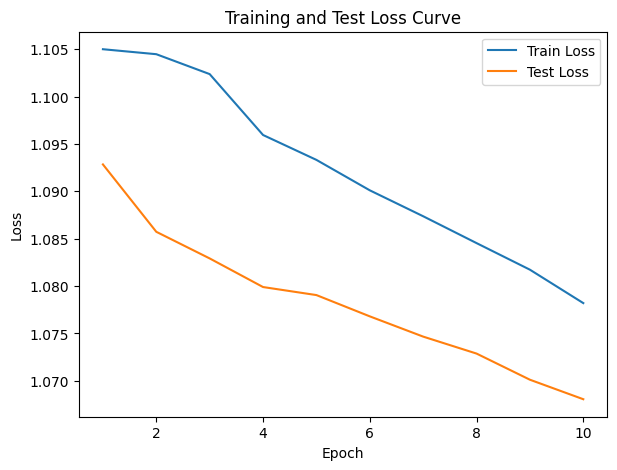

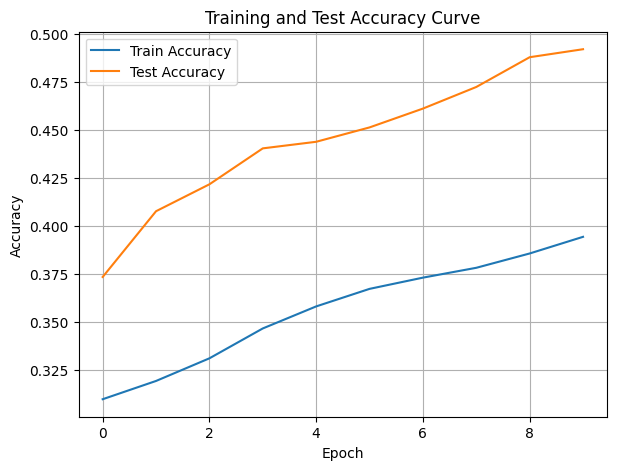

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  20%|██        | 2/10 [00:00<00:02,  3.64it/s]

Epoch [1/10], Train F1:0.48831255259858214, Train Loss: 1.0658, Train Acc: 0.4461, Test F1:0.4755003450655624, Test Loss: 1.0792, Test Acc: 0.4549
Epoch [2/10], Train F1:0.4943365980933717, Train Loss: 1.0696, Train Acc: 0.4513, Test F1:0.47085731249030155, Test Loss: 1.0770, Test Acc: 0.4440


Training Process:  40%|████      | 4/10 [00:00<00:01,  5.71it/s]

Epoch [3/10], Train F1:0.48187610771573497, Train Loss: 1.0697, Train Acc: 0.4413, Test F1:0.45669117041429874, Test Loss: 1.0727, Test Acc: 0.4340
Epoch [4/10], Train F1:0.48241411821248065, Train Loss: 1.0666, Train Acc: 0.4470, Test F1:0.4967377938915129, Test Loss: 1.0694, Test Acc: 0.4720


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.42it/s]

Epoch [5/10], Train F1:0.4859057384958988, Train Loss: 1.0627, Train Acc: 0.4508, Test F1:0.5217368551879326, Test Loss: 1.0664, Test Acc: 0.4948
Epoch [6/10], Train F1:0.4917788039762235, Train Loss: 1.0607, Train Acc: 0.4581, Test F1:0.5408913345812416, Test Loss: 1.0644, Test Acc: 0.5152


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.16it/s]

Epoch [7/10], Train F1:0.5000510951614714, Train Loss: 1.0568, Train Acc: 0.4682, Test F1:0.5592788971367973, Test Loss: 1.0625, Test Acc: 0.5368
Epoch [8/10], Train F1:0.5072713891969092, Train Loss: 1.0536, Train Acc: 0.4756, Test F1:0.5735477430644736, Test Loss: 1.0601, Test Acc: 0.5498


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.49it/s]


Epoch [9/10], Train F1:0.5119231458931641, Train Loss: 1.0495, Train Acc: 0.4801, Test F1:0.582810453911285, Test Loss: 1.0563, Test Acc: 0.5602
Epoch [10/10], Train F1:0.5121107354410038, Train Loss: 1.0468, Train Acc: 0.4811, Test F1:0.5938907961992642, Test Loss: 1.0531, Test Acc: 0.5718
Total Epochs: 10
Train loss start: 1.0463606119155884, Train loss end: 0.9552316069602966
Highest Mean Train Accuracy (over epoch): 0.4811309523809524
Test loss start: 1.0746369361877441, Test loss end: 1.0192179679870605
Highest mean Test Accuracy (over epoch): 0.5717881944444445


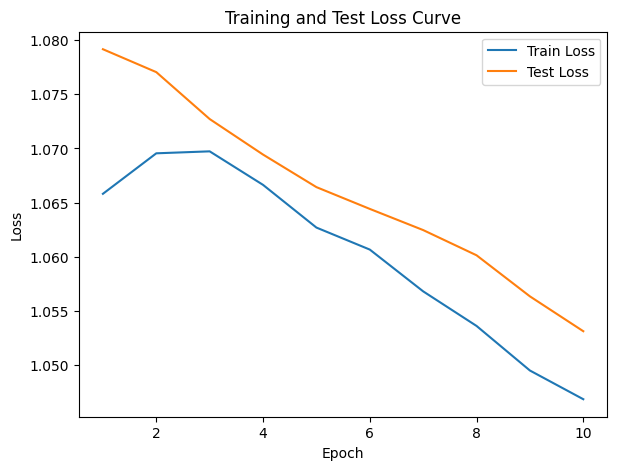

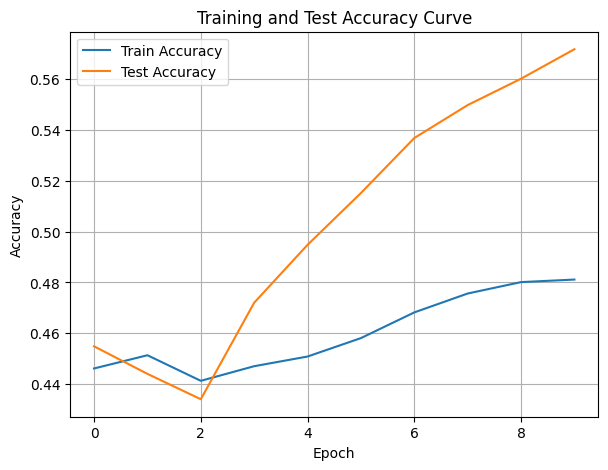

./saved_models/model_6.pth
Training Model with id 11
in multi


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.21it/s]

Epoch [1/10], Train F1:0.6155217916411947, Train Loss: 1.0064, Train Acc: 0.5815, Test F1:0.737972334682861, Test Loss: 1.0198, Test Acc: 0.7491
Epoch [2/10], Train F1:0.6237408595645051, Train Loss: 1.0023, Train Acc: 0.6027, Test F1:0.7647584734109094, Test Loss: 1.0207, Test Acc: 0.7726


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.71it/s]

Epoch [3/10], Train F1:0.6131641199141411, Train Loss: 1.0031, Train Acc: 0.5968, Test F1:0.7676917076648345, Test Loss: 1.0183, Test Acc: 0.7778
Epoch [4/10], Train F1:0.6107380604651157, Train Loss: 1.0051, Train Acc: 0.5917, Test F1:0.7576133140042914, Test Loss: 1.0172, Test Acc: 0.7602


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.01it/s]

Epoch [5/10], Train F1:0.6151678150585611, Train Loss: 0.9998, Train Acc: 0.5975, Test F1:0.7643701043485802, Test Loss: 1.0149, Test Acc: 0.7634
Epoch [6/10], Train F1:0.6237169165184652, Train Loss: 0.9961, Train Acc: 0.6083, Test F1:0.7743020752410683, Test Loss: 1.0108, Test Acc: 0.7740


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.97it/s]

Epoch [7/10], Train F1:0.6362314133926208, Train Loss: 0.9893, Train Acc: 0.6238, Test F1:0.7776988463578284, Test Loss: 1.0084, Test Acc: 0.7803
Epoch [8/10], Train F1:0.6383710597959474, Train Loss: 0.9866, Train Acc: 0.6274, Test F1:0.7832803585528473, Test Loss: 1.0059, Test Acc: 0.7869


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.82it/s]


Epoch [9/10], Train F1:0.6426908906192992, Train Loss: 0.9828, Train Acc: 0.6312, Test F1:0.7845447469122699, Test Loss: 1.0025, Test Acc: 0.7903
Epoch [10/10], Train F1:0.6451834159050035, Train Loss: 0.9809, Train Acc: 0.6347, Test F1:0.7848097028236982, Test Loss: 0.9999, Test Acc: 0.7923
Total Epochs: 10
Train loss start: 1.041471004486084, Train loss end: 0.9065103530883789
Highest Mean Train Accuracy (over epoch): 0.6346726190476191
Test loss start: 1.0162848234176636, Test loss end: 0.9665972590446472
Highest mean Test Accuracy (over epoch): 0.7922743055555556


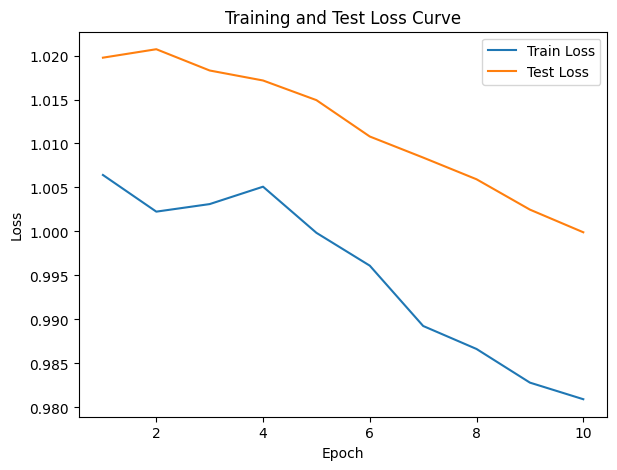

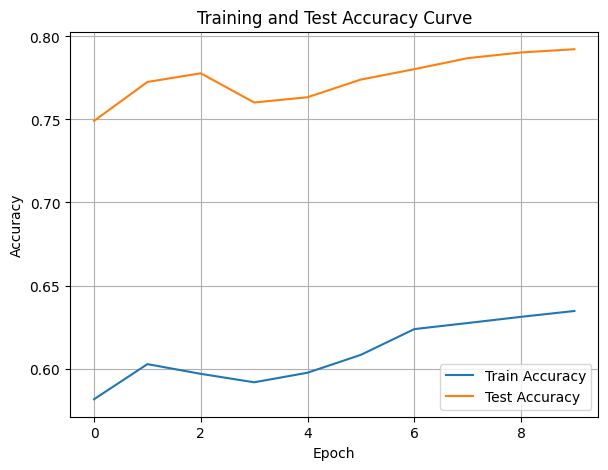

./saved_models/model_11.pth
Training Model with id 9
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.80it/s]

Epoch [1/10], Train F1:0.7092150687032432, Train Loss: 0.9407, Train Acc: 0.7176, Test F1:0.848951647411211, Test Loss: 0.9715, Test Acc: 0.8568
Epoch [2/10], Train F1:0.708009108009108, Train Loss: 0.9423, Train Acc: 0.7138, Test F1:0.8384395331763752, Test Loss: 0.9644, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.80it/s]

Epoch [3/10], Train F1:0.7137249992900337, Train Loss: 0.9362, Train Acc: 0.7217, Test F1:0.8277456174443103, Test Loss: 0.9629, Test Acc: 0.8411


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.60it/s]

Epoch [4/10], Train F1:0.7145318797986702, Train Loss: 0.9382, Train Acc: 0.7172, Test F1:0.8223268197594258, Test Loss: 0.9618, Test Acc: 0.8357


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.60it/s]

Epoch [5/10], Train F1:0.7174672718420776, Train Loss: 0.9370, Train Acc: 0.7204, Test F1:0.8190516730062802, Test Loss: 0.9623, Test Acc: 0.8337


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.38it/s]

Epoch [6/10], Train F1:0.7137700265726438, Train Loss: 0.9376, Train Acc: 0.7162, Test F1:0.8241385568671721, Test Loss: 0.9602, Test Acc: 0.8375


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.21it/s]

Epoch [7/10], Train F1:0.7241641533348963, Train Loss: 0.9317, Train Acc: 0.7264, Test F1:0.8292848906250896, Test Loss: 0.9588, Test Acc: 0.8414
Epoch [8/10], Train F1:0.7231599664823881, Train Loss: 0.9306, Train Acc: 0.7266, Test F1:0.830436774485415, Test Loss: 0.9561, Test Acc: 0.8423


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.49it/s]


Epoch [9/10], Train F1:0.7240540743355671, Train Loss: 0.9276, Train Acc: 0.7283, Test F1:0.8277456174443104, Test Loss: 0.9548, Test Acc: 0.8405
Epoch [10/10], Train F1:0.7256898444861443, Train Loss: 0.9259, Train Acc: 0.7299, Test F1:0.8277456174443103, Test Loss: 0.9529, Test Acc: 0.8405
Total Epochs: 10
Train loss start: 0.9698474407196045, Train loss end: 0.8774842023849487
Highest Mean Train Accuracy (over epoch): 0.7298511904761905
Test loss start: 0.9664766788482666, Test loss end: 0.9294357299804688
Highest mean Test Accuracy (over epoch): 0.8567708333333334


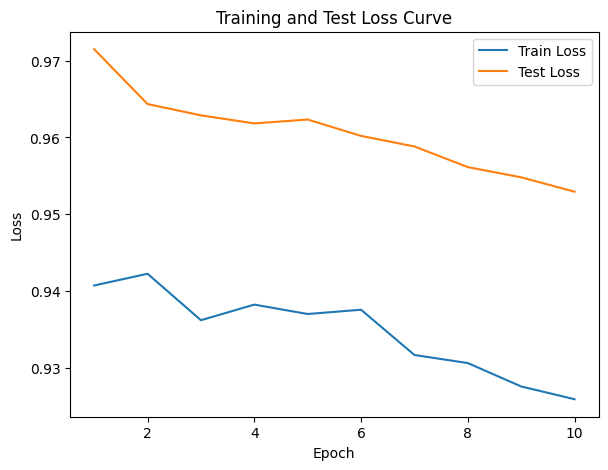

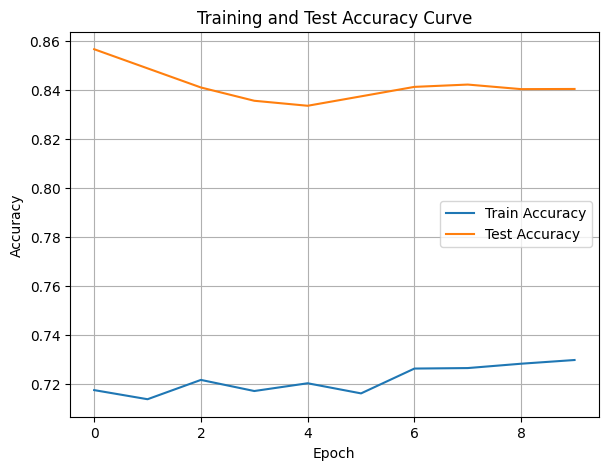

./saved_models/model_9.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7703433470964586, Train Loss: 0.8920, Train Acc: 0.7673, Test F1:0.8057644110275689, Test Loss: 0.9269, Test Acc: 0.8255


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.80it/s]

Epoch [2/10], Train F1:0.7650349140599927, Train Loss: 0.8932, Train Acc: 0.7722, Test F1:0.8168580871044796, Test Loss: 0.9244, Test Acc: 0.8333


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.80it/s]

Epoch [3/10], Train F1:0.7705222055428769, Train Loss: 0.8888, Train Acc: 0.7751, Test F1:0.8168580871044796, Test Loss: 0.9243, Test Acc: 0.8333


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.51it/s]

Epoch [4/10], Train F1:0.780570501548911, Train Loss: 0.8850, Train Acc: 0.7796, Test F1:0.8168580871044796, Test Loss: 0.9210, Test Acc: 0.8333


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.51it/s]

Epoch [5/10], Train F1:0.78297583120094, Train Loss: 0.8816, Train Acc: 0.7849, Test F1:0.8212371181971845, Test Loss: 0.9198, Test Acc: 0.8365


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.28it/s]

Epoch [6/10], Train F1:0.7833195850393427, Train Loss: 0.8783, Train Acc: 0.7866, Test F1:0.8205095347063313, Test Loss: 0.9188, Test Acc: 0.8359
Epoch [7/10], Train F1:0.7870972375716208, Train Loss: 0.8735, Train Acc: 0.7920, Test F1:0.8199892832554176, Test Loss: 0.9172, Test Acc: 0.8356


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.05it/s]

Epoch [8/10], Train F1:0.7847995338995941, Train Loss: 0.8726, Train Acc: 0.7908, Test F1:0.8223268197594258, Test Loss: 0.9159, Test Acc: 0.8372


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.01it/s]

Epoch [9/10], Train F1:0.7871695523877916, Train Loss: 0.8719, Train Acc: 0.7925, Test F1:0.824138556867172, Test Loss: 0.9136, Test Acc: 0.8385
Epoch [10/10], Train F1:0.7896075890500918, Train Loss: 0.8701, Train Acc: 0.7928, Test F1:0.8277456174443103, Test Loss: 0.9106, Test Acc: 0.8411


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.83it/s]

Total Epochs: 10
Train loss start: 0.8719366788864136, Train loss end: 1.0450876951217651
Highest Mean Train Accuracy (over epoch): 0.7927678571428572
Test loss start: 0.9222496151924133, Test loss end: 0.888800859451294
Highest mean Test Accuracy (over epoch): 0.8411458333333334


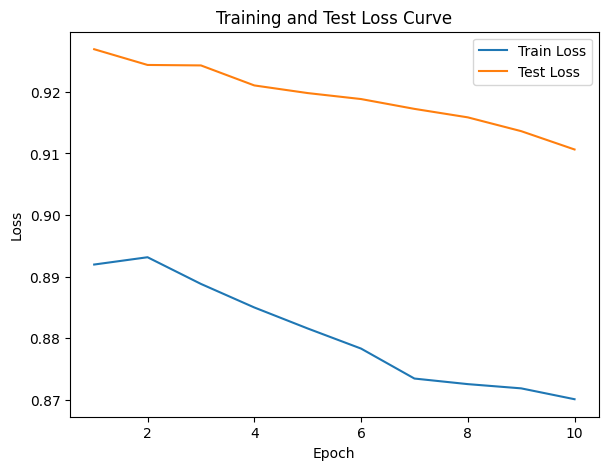

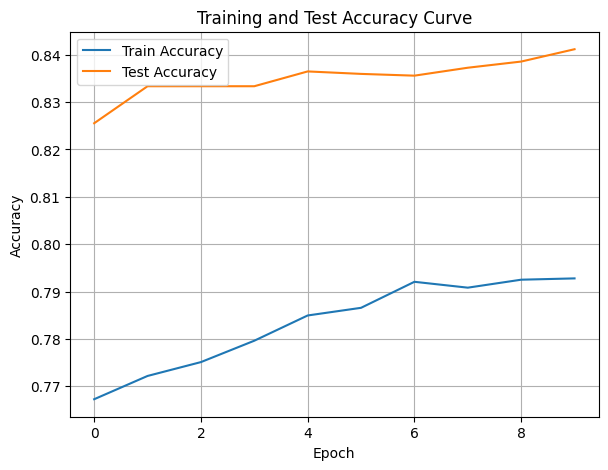

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.07it/s]

Epoch [1/10], Train F1:0.8280417391620368, Train Loss: 0.8464, Train Acc: 0.8289, Test F1:0.848951647411211, Test Loss: 0.8982, Test Acc: 0.8568


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.79it/s]

Epoch [2/10], Train F1:0.8187184908817561, Train Loss: 0.8427, Train Acc: 0.8269, Test F1:0.8437176036086195, Test Loss: 0.8875, Test Acc: 0.8529


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.77it/s]

Epoch [3/10], Train F1:0.8077077601568732, Train Loss: 0.8438, Train Acc: 0.8187, Test F1:0.8524172307238872, Test Loss: 0.8851, Test Acc: 0.8594


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.91it/s]

Epoch [4/10], Train F1:0.8074840736494872, Train Loss: 0.8431, Train Acc: 0.8165, Test F1:0.8541430384153257, Test Loss: 0.8850, Test Acc: 0.8607


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.47it/s]

Epoch [5/10], Train F1:0.8110083810581022, Train Loss: 0.8387, Train Acc: 0.8182, Test F1:0.8592931124413205, Test Loss: 0.8828, Test Acc: 0.8646


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.44it/s]

Epoch [6/10], Train F1:0.8109361162534602, Train Loss: 0.8385, Train Acc: 0.8172, Test F1:0.8524172307238872, Test Loss: 0.8814, Test Acc: 0.8594


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.66it/s]

Epoch [7/10], Train F1:0.8060753966639504, Train Loss: 0.8374, Train Acc: 0.8134, Test F1:0.848951647411211, Test Loss: 0.8812, Test Acc: 0.8568


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.11it/s]

Epoch [8/10], Train F1:0.8072087252119455, Train Loss: 0.8353, Train Acc: 0.8156, Test F1:0.8463400420650515, Test Loss: 0.8801, Test Acc: 0.8548


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.20it/s]

Epoch [9/10], Train F1:0.8073403505261223, Train Loss: 0.8324, Train Acc: 0.8160, Test F1:0.8431333509964616, Test Loss: 0.8780, Test Acc: 0.8524


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.57it/s]


Epoch [10/10], Train F1:0.809329338404603, Train Loss: 0.8300, Train Acc: 0.8186, Test F1:0.8405561340983035, Test Loss: 0.8769, Test Acc: 0.8505
Total Epochs: 10
Train loss start: 0.8251516819000244, Train loss end: 0.7332468032836914
Highest Mean Train Accuracy (over epoch): 0.8288690476190476
Test loss start: 0.89058518409729, Test loss end: 0.8629577159881592
Highest mean Test Accuracy (over epoch): 0.8645833333333334


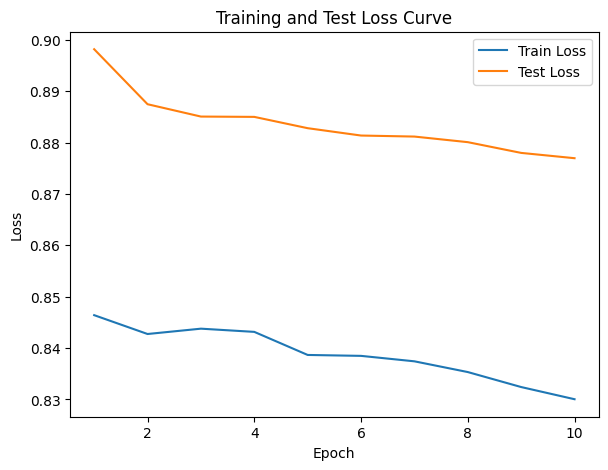

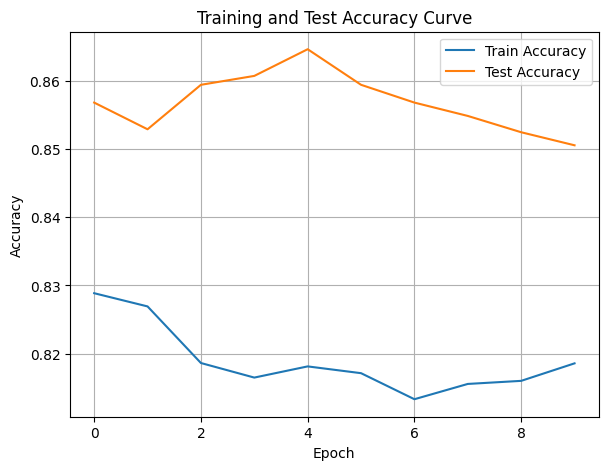

./saved_models/model_10.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8246558039661487, Train Loss: 0.8012, Train Acc: 0.8321, Test F1:0.8168580871044796, Test Loss: 0.8620, Test Acc: 0.8333


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [2/10], Train F1:0.8311605751656436, Train Loss: 0.8037, Train Acc: 0.8262, Test F1:0.8223268197594258, Test Loss: 0.8565, Test Acc: 0.8372


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [3/10], Train F1:0.8271542163104368, Train Loss: 0.8032, Train Acc: 0.8261, Test F1:0.8131837408415308, Test Loss: 0.8538, Test Acc: 0.8287


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.76it/s]

Epoch [4/10], Train F1:0.8228896781129643, Train Loss: 0.8017, Train Acc: 0.8240, Test F1:0.830436774485415, Test Loss: 0.8532, Test Acc: 0.8416


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.79it/s]

Epoch [5/10], Train F1:0.8268085853966863, Train Loss: 0.8006, Train Acc: 0.8270, Test F1:0.8426655563017613, Test Loss: 0.8511, Test Acc: 0.8521


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.79it/s]

Epoch [6/10], Train F1:0.8276781206402901, Train Loss: 0.8012, Train Acc: 0.8264, Test F1:0.8506867835453797, Test Loss: 0.8486, Test Acc: 0.8591


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.88it/s]

Epoch [7/10], Train F1:0.8289461002364955, Train Loss: 0.8004, Train Acc: 0.8287, Test F1:0.8563551956377243, Test Loss: 0.8486, Test Acc: 0.8641


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.88it/s]

Epoch [8/10], Train F1:0.8253242459173107, Train Loss: 0.7996, Train Acc: 0.8272, Test F1:0.8605743282156173, Test Loss: 0.8481, Test Acc: 0.8678


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.24it/s]

Epoch [9/10], Train F1:0.8296312997164004, Train Loss: 0.7964, Train Acc: 0.8317, Test F1:0.8649685378788156, Test Loss: 0.8469, Test Acc: 0.8716
Epoch [10/10], Train F1:0.8301151841276501, Train Loss: 0.7960, Train Acc: 0.8318, Test F1:0.86542048982844, Test Loss: 0.8450, Test Acc: 0.8723


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.20it/s]


Total Epochs: 10
Train loss start: 0.7859346270561218, Train loss end: 0.8050545454025269
Highest Mean Train Accuracy (over epoch): 0.8321428571428572
Test loss start: 0.8550389409065247, Test loss end: 0.8319517970085144
Highest mean Test Accuracy (over epoch): 0.8723090277777779


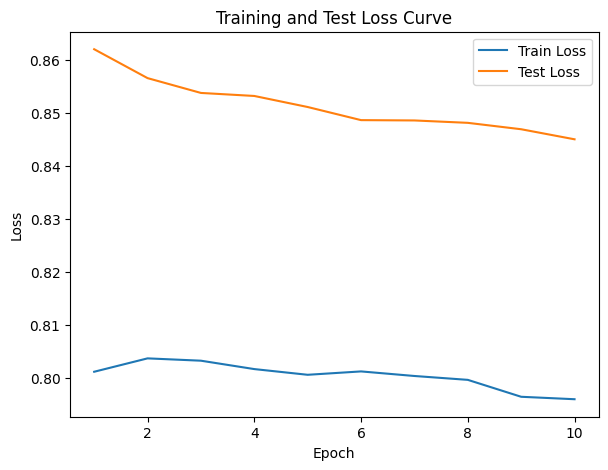

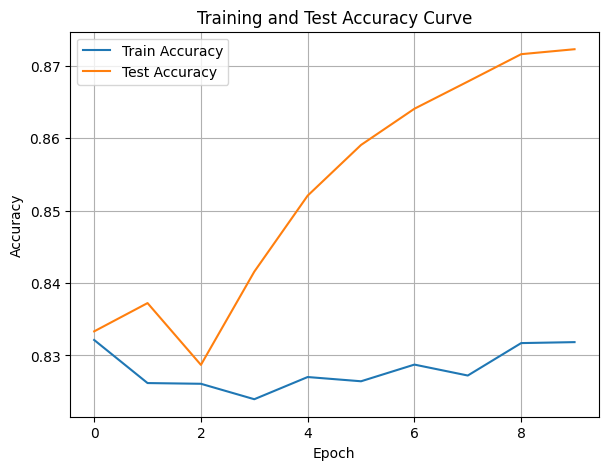

./saved_models/model_8.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [48]:
DTEmlp6b.train_DTE()

Training Process:   0%|          | 0/110 [00:00<?, ?it/s]

Epoch [1/110], Train F1:0.3478174363749837, Train Loss: 1.1130, Train Acc: 0.3235, Test F1:0.4826239511823035, Test Loss: 1.0716, Test Acc: 0.5547


Training Process:   2%|▏         | 2/110 [00:00<00:08, 12.30it/s]

Epoch [2/110], Train F1:0.3827055806716823, Train Loss: 1.1054, Train Acc: 0.3525, Test F1:0.4804108574278985, Test Loss: 1.0721, Test Acc: 0.5538
Epoch [3/110], Train F1:0.39802600403351346, Train Loss: 1.1033, Train Acc: 0.3604, Test F1:0.4845425773982908, Test Loss: 1.0708, Test Acc: 0.5613


Training Process:   4%|▎         | 4/110 [00:00<00:09, 11.76it/s]

Epoch [4/110], Train F1:0.40746689570551137, Train Loss: 1.1005, Train Acc: 0.3733, Test F1:0.48668388890618036, Test Loss: 1.0675, Test Acc: 0.5666


Training Process:   4%|▎         | 4/110 [00:00<00:09, 11.76it/s]

Epoch [5/110], Train F1:0.4150565285311421, Train Loss: 1.0959, Train Acc: 0.3842, Test F1:0.491776541312145, Test Loss: 1.0610, Test Acc: 0.5760


Training Process:   5%|▌         | 6/110 [00:00<00:09, 11.36it/s]

Epoch [6/110], Train F1:0.41371118910313626, Train Loss: 1.0945, Train Acc: 0.3846, Test F1:0.4927664696746485, Test Loss: 1.0589, Test Acc: 0.5774


Training Process:   5%|▌         | 6/110 [00:00<00:09, 11.36it/s]

Epoch [7/110], Train F1:0.41860124231470464, Train Loss: 1.0919, Train Acc: 0.3906, Test F1:0.49845979457143147, Test Loss: 1.0570, Test Acc: 0.5837


Training Process:   7%|▋         | 8/110 [00:00<00:09, 10.83it/s]

Epoch [8/110], Train F1:0.4229164780784902, Train Loss: 1.0899, Train Acc: 0.3957, Test F1:0.5034454105552802, Test Loss: 1.0563, Test Acc: 0.5875


Training Process:   7%|▋         | 8/110 [00:00<00:09, 10.83it/s]

Epoch [9/110], Train F1:0.4282877748196834, Train Loss: 1.0868, Train Acc: 0.4005, Test F1:0.5047549149255047, Test Loss: 1.0544, Test Acc: 0.5912


Training Process:   9%|▉         | 10/110 [00:00<00:10,  9.35it/s]

Epoch [10/110], Train F1:0.4344464111397693, Train Loss: 1.0835, Train Acc: 0.4072, Test F1:0.5063455405153733, Test Loss: 1.0509, Test Acc: 0.5944


Training Process:  10%|█         | 11/110 [00:01<00:10,  9.08it/s]

Epoch [11/110], Train F1:0.44384473057003926, Train Loss: 1.0793, Train Acc: 0.4175, Test F1:0.5073464377824629, Test Loss: 1.0475, Test Acc: 0.5976


Training Process:  11%|█         | 12/110 [00:01<00:11,  8.71it/s]

Epoch [12/110], Train F1:0.45001167196875047, Train Loss: 1.0757, Train Acc: 0.4250, Test F1:0.509229234956143, Test Loss: 1.0435, Test Acc: 0.6021


Training Process:  12%|█▏        | 13/110 [00:01<00:11,  8.39it/s]

Epoch [13/110], Train F1:0.45846441867607524, Train Loss: 1.0718, Train Acc: 0.4354, Test F1:0.5104653840646829, Test Loss: 1.0407, Test Acc: 0.6048


Training Process:  13%|█▎        | 14/110 [00:01<00:11,  8.38it/s]

Epoch [14/110], Train F1:0.46627694307709583, Train Loss: 1.0681, Train Acc: 0.4437, Test F1:0.5118387689444786, Test Loss: 1.0378, Test Acc: 0.6081


Training Process:  14%|█▎        | 15/110 [00:01<00:11,  8.38it/s]

Epoch [15/110], Train F1:0.4728557824496354, Train Loss: 1.0656, Train Acc: 0.4514, Test F1:0.512840312121668, Test Loss: 1.0350, Test Acc: 0.6109


Training Process:  15%|█▍        | 16/110 [00:01<00:12,  7.80it/s]

Epoch [16/110], Train F1:0.47960159766162713, Train Loss: 1.0620, Train Acc: 0.4585, Test F1:0.5148633734381263, Test Loss: 1.0315, Test Acc: 0.6143


Training Process:  16%|█▋        | 18/110 [00:02<00:13,  6.84it/s]

Epoch [17/110], Train F1:0.48633049016643914, Train Loss: 1.0587, Train Acc: 0.4679, Test F1:0.5155627066684128, Test Loss: 1.0290, Test Acc: 0.6165
Epoch [18/110], Train F1:0.4953271120494584, Train Loss: 1.0551, Train Acc: 0.4768, Test F1:0.5161811013204202, Test Loss: 1.0261, Test Acc: 0.6184


Training Process:  18%|█▊        | 20/110 [00:02<00:13,  6.78it/s]

Epoch [19/110], Train F1:0.501641927428232, Train Loss: 1.0524, Train Acc: 0.4831, Test F1:0.5210457187041307, Test Loss: 1.0242, Test Acc: 0.6224
Epoch [20/110], Train F1:0.506999567215045, Train Loss: 1.0491, Train Acc: 0.4890, Test F1:0.5231657240321839, Test Loss: 1.0219, Test Acc: 0.6252


Training Process:  20%|██        | 22/110 [00:02<00:12,  6.95it/s]

Epoch [21/110], Train F1:0.5144899784990365, Train Loss: 1.0455, Train Acc: 0.4973, Test F1:0.5268206681337553, Test Loss: 1.0195, Test Acc: 0.6285
Epoch [22/110], Train F1:0.5208190802322863, Train Loss: 1.0419, Train Acc: 0.5037, Test F1:0.5310802626736743, Test Loss: 1.0175, Test Acc: 0.6319


Training Process:  22%|██▏       | 24/110 [00:02<00:13,  6.61it/s]

Epoch [23/110], Train F1:0.5267985701466013, Train Loss: 1.0389, Train Acc: 0.5096, Test F1:0.536514865372035, Test Loss: 1.0154, Test Acc: 0.6356
Epoch [24/110], Train F1:0.5333428857479224, Train Loss: 1.0364, Train Acc: 0.5158, Test F1:0.5428267750502851, Test Loss: 1.0136, Test Acc: 0.6399


Training Process:  24%|██▎       | 26/110 [00:03<00:13,  6.24it/s]

Epoch [25/110], Train F1:0.5384934410875292, Train Loss: 1.0332, Train Acc: 0.5220, Test F1:0.5464660175357198, Test Loss: 1.0114, Test Acc: 0.6427
Epoch [26/110], Train F1:0.5436235436781858, Train Loss: 1.0300, Train Acc: 0.5285, Test F1:0.5525013793149932, Test Loss: 1.0092, Test Acc: 0.6468


Training Process:  25%|██▍       | 27/110 [00:03<00:14,  5.68it/s]

Epoch [27/110], Train F1:0.5480272650254252, Train Loss: 1.0274, Train Acc: 0.5326, Test F1:0.5580370519028575, Test Loss: 1.0071, Test Acc: 0.6505


Training Process:  26%|██▋       | 29/110 [00:03<00:14,  5.66it/s]

Epoch [28/110], Train F1:0.5540701531918254, Train Loss: 1.0243, Train Acc: 0.5394, Test F1:0.5637436878687134, Test Loss: 1.0045, Test Acc: 0.6542
Epoch [29/110], Train F1:0.559957989064921, Train Loss: 1.0210, Train Acc: 0.5458, Test F1:0.5695915356074353, Test Loss: 1.0023, Test Acc: 0.6580


Training Process:  28%|██▊       | 31/110 [00:04<00:13,  6.03it/s]

Epoch [30/110], Train F1:0.5656278046489837, Train Loss: 1.0179, Train Acc: 0.5521, Test F1:0.5744391281233386, Test Loss: 1.0000, Test Acc: 0.6612
Epoch [31/110], Train F1:0.5705992880913806, Train Loss: 1.0146, Train Acc: 0.5581, Test F1:0.5794744917097328, Test Loss: 0.9975, Test Acc: 0.6645


Training Process:  30%|███       | 33/110 [00:04<00:11,  6.44it/s]

Epoch [32/110], Train F1:0.5750950850584683, Train Loss: 1.0118, Train Acc: 0.5631, Test F1:0.5836417123457769, Test Loss: 0.9953, Test Acc: 0.6673
Epoch [33/110], Train F1:0.5811701124702213, Train Loss: 1.0086, Train Acc: 0.5690, Test F1:0.5880255709727074, Test Loss: 0.9929, Test Acc: 0.6702


Training Process:  32%|███▏      | 35/110 [00:04<00:11,  6.66it/s]

Epoch [34/110], Train F1:0.5862709204121416, Train Loss: 1.0055, Train Acc: 0.5743, Test F1:0.5925985160750338, Test Loss: 0.9905, Test Acc: 0.6732
Epoch [35/110], Train F1:0.5906576160728692, Train Loss: 1.0028, Train Acc: 0.5791, Test F1:0.5968771708324019, Test Loss: 0.9880, Test Acc: 0.6760


Epoch [36/110], Train F1:0.5946702962163818, Train Loss: 0.9999, Train Acc: 0.5835, Test F1:0.6010603102510274, Test Loss: 0.9855, Test Acc: 0.6788


Training Process:  35%|███▍      | 38/110 [00:05<00:12,  5.77it/s]

Epoch [37/110], Train F1:0.5987444816546718, Train Loss: 0.9974, Train Acc: 0.5875, Test F1:0.6048268233083354, Test Loss: 0.9834, Test Acc: 0.6813
Epoch [38/110], Train F1:0.6031585845555231, Train Loss: 0.9948, Train Acc: 0.5916, Test F1:0.6083724801391985, Test Loss: 0.9813, Test Acc: 0.6837


Training Process:  36%|███▋      | 40/110 [00:05<00:11,  5.85it/s]

Epoch [39/110], Train F1:0.6067501922998876, Train Loss: 0.9920, Train Acc: 0.5961, Test F1:0.6117162380455784, Test Loss: 0.9793, Test Acc: 0.6859
Epoch [40/110], Train F1:0.610969421159495, Train Loss: 0.9890, Train Acc: 0.6008, Test F1:0.6148749369920948, Test Loss: 0.9770, Test Acc: 0.6880


Training Process:  38%|███▊      | 42/110 [00:06<00:11,  5.86it/s]

Epoch [41/110], Train F1:0.6145516193590236, Train Loss: 0.9863, Train Acc: 0.6044, Test F1:0.6178635881133067, Test Loss: 0.9748, Test Acc: 0.6901
Epoch [42/110], Train F1:0.6184276521540271, Train Loss: 0.9834, Train Acc: 0.6088, Test F1:0.6208487647236228, Test Loss: 0.9726, Test Acc: 0.6922


Training Process:  39%|███▉      | 43/110 [00:06<00:11,  5.89it/s]

Epoch [43/110], Train F1:0.6219921167133459, Train Loss: 0.9807, Train Acc: 0.6127, Test F1:0.6236839196586805, Test Loss: 0.9706, Test Acc: 0.6942


Training Process:  40%|████      | 44/110 [00:06<00:12,  5.25it/s]

Epoch [44/110], Train F1:0.6259458705260711, Train Loss: 0.9780, Train Acc: 0.6169, Test F1:0.6270723753703484, Test Loss: 0.9687, Test Acc: 0.6965


Training Process:  41%|████      | 45/110 [00:06<00:12,  5.32it/s]

Epoch [45/110], Train F1:0.6297396965161716, Train Loss: 0.9752, Train Acc: 0.6211, Test F1:0.6299580221873663, Test Loss: 0.9668, Test Acc: 0.6985


Training Process:  42%|████▏     | 46/110 [00:06<00:12,  5.30it/s]

Epoch [46/110], Train F1:0.6336148504359754, Train Loss: 0.9724, Train Acc: 0.6250, Test F1:0.6323794118596086, Test Loss: 0.9647, Test Acc: 0.7002


Training Process:  43%|████▎     | 47/110 [00:07<00:12,  5.19it/s]

Epoch [47/110], Train F1:0.637411325348543, Train Loss: 0.9698, Train Acc: 0.6289, Test F1:0.6346904309906064, Test Loss: 0.9628, Test Acc: 0.7019


Training Process:  44%|████▎     | 48/110 [00:07<00:12,  5.06it/s]

Epoch [48/110], Train F1:0.6408500689903813, Train Loss: 0.9672, Train Acc: 0.6326, Test F1:0.6368984753931097, Test Loss: 0.9608, Test Acc: 0.7035


Training Process:  45%|████▍     | 49/110 [00:07<00:12,  4.87it/s]

Epoch [49/110], Train F1:0.6442014330415312, Train Loss: 0.9645, Train Acc: 0.6359, Test F1:0.6390102931439527, Test Loss: 0.9587, Test Acc: 0.7050


Training Process:  45%|████▌     | 50/110 [00:07<00:12,  4.82it/s]

Epoch [50/110], Train F1:0.6475027686935546, Train Loss: 0.9618, Train Acc: 0.6395, Test F1:0.6410320541107434, Test Loss: 0.9566, Test Acc: 0.7065


Training Process:  46%|████▋     | 51/110 [00:07<00:13,  4.29it/s]

Epoch [51/110], Train F1:0.6499111185441606, Train Loss: 0.9595, Train Acc: 0.6420, Test F1:0.6429694106961797, Test Loss: 0.9545, Test Acc: 0.7079


Training Process:  47%|████▋     | 52/110 [00:08<00:12,  4.47it/s]

Epoch [52/110], Train F1:0.652677604334186, Train Loss: 0.9570, Train Acc: 0.6449, Test F1:0.6448275510695161, Test Loss: 0.9525, Test Acc: 0.7093


Epoch [53/110], Train F1:0.6563558610512576, Train Loss: 0.9541, Train Acc: 0.6487, Test F1:0.6471669265608178, Test Loss: 0.9504, Test Acc: 0.7109


Training Process:  50%|█████     | 55/110 [00:08<00:10,  5.09it/s]

Epoch [54/110], Train F1:0.6594560428186943, Train Loss: 0.9516, Train Acc: 0.6517, Test F1:0.6488687515627138, Test Loss: 0.9485, Test Acc: 0.7121
Epoch [55/110], Train F1:0.6623844980893396, Train Loss: 0.9492, Train Acc: 0.6549, Test F1:0.650771124695937, Test Loss: 0.9467, Test Acc: 0.7135


Training Process:  51%|█████     | 56/110 [00:08<00:10,  5.20it/s]

Epoch [56/110], Train F1:0.6649072007956702, Train Loss: 0.9470, Train Acc: 0.6576, Test F1:0.6531212962724383, Test Loss: 0.9450, Test Acc: 0.7150


Training Process:  52%|█████▏    | 57/110 [00:09<00:10,  5.14it/s]

Epoch [57/110], Train F1:0.6677239610469797, Train Loss: 0.9444, Train Acc: 0.6607, Test F1:0.6546166913181601, Test Loss: 0.9432, Test Acc: 0.7162


Training Process:  53%|█████▎    | 58/110 [00:09<00:10,  4.96it/s]

Epoch [58/110], Train F1:0.6705655361867102, Train Loss: 0.9419, Train Acc: 0.6638, Test F1:0.6565574420825331, Test Loss: 0.9414, Test Acc: 0.7175


Training Process:  54%|█████▎    | 59/110 [00:09<00:11,  4.62it/s]

Epoch [59/110], Train F1:0.6734857926666143, Train Loss: 0.9395, Train Acc: 0.6666, Test F1:0.6589162757714508, Test Loss: 0.9398, Test Acc: 0.7191


Training Process:  55%|█████▍    | 60/110 [00:09<00:10,  4.64it/s]

Epoch [60/110], Train F1:0.6761236279820985, Train Loss: 0.9373, Train Acc: 0.6694, Test F1:0.6607090906102961, Test Loss: 0.9381, Test Acc: 0.7203


Training Process:  55%|█████▌    | 61/110 [00:09<00:10,  4.64it/s]

Epoch [61/110], Train F1:0.6787251515601892, Train Loss: 0.9350, Train Acc: 0.6722, Test F1:0.6631431425708633, Test Loss: 0.9365, Test Acc: 0.7219


Training Process:  56%|█████▋    | 62/110 [00:10<00:10,  4.59it/s]

Epoch [62/110], Train F1:0.6813023970566293, Train Loss: 0.9327, Train Acc: 0.6746, Test F1:0.6652596008536489, Test Loss: 0.9347, Test Acc: 0.7233


Training Process:  57%|█████▋    | 63/110 [00:10<00:10,  4.69it/s]

Epoch [63/110], Train F1:0.6839433350989054, Train Loss: 0.9302, Train Acc: 0.6775, Test F1:0.6668508677423824, Test Loss: 0.9331, Test Acc: 0.7245


Training Process:  58%|█████▊    | 64/110 [00:10<00:09,  4.74it/s]

Epoch [64/110], Train F1:0.6869516955627881, Train Loss: 0.9279, Train Acc: 0.6805, Test F1:0.6681672043291615, Test Loss: 0.9315, Test Acc: 0.7254


Training Process:  59%|█████▉    | 65/110 [00:10<00:09,  4.68it/s]

Epoch [65/110], Train F1:0.6896385751688715, Train Loss: 0.9257, Train Acc: 0.6831, Test F1:0.6700939059192677, Test Loss: 0.9297, Test Acc: 0.7267


Training Process:  60%|██████    | 66/110 [00:11<00:09,  4.63it/s]

Epoch [66/110], Train F1:0.6922925854975451, Train Loss: 0.9233, Train Acc: 0.6858, Test F1:0.6715293352541639, Test Loss: 0.9280, Test Acc: 0.7278


Training Process:  61%|██████    | 67/110 [00:11<00:10,  4.18it/s]

Epoch [67/110], Train F1:0.6945318078092405, Train Loss: 0.9213, Train Acc: 0.6881, Test F1:0.6733389879189993, Test Loss: 0.9262, Test Acc: 0.7290


Training Process:  62%|██████▏   | 68/110 [00:11<00:10,  4.10it/s]

Epoch [68/110], Train F1:0.6966866522016708, Train Loss: 0.9192, Train Acc: 0.6903, Test F1:0.6746780258048864, Test Loss: 0.9246, Test Acc: 0.7299


Training Process:  63%|██████▎   | 69/110 [00:11<00:10,  4.03it/s]

Epoch [69/110], Train F1:0.6984568782552046, Train Loss: 0.9173, Train Acc: 0.6921, Test F1:0.6761786036677162, Test Loss: 0.9230, Test Acc: 0.7310


Training Process:  64%|██████▎   | 70/110 [00:12<00:09,  4.06it/s]

Epoch [70/110], Train F1:0.700371775790297, Train Loss: 0.9153, Train Acc: 0.6941, Test F1:0.6776330380381507, Test Loss: 0.9215, Test Acc: 0.7320


Training Process:  65%|██████▍   | 71/110 [00:12<00:09,  4.25it/s]

Epoch [71/110], Train F1:0.7022683854744735, Train Loss: 0.9134, Train Acc: 0.6959, Test F1:0.678847293425802, Test Loss: 0.9200, Test Acc: 0.7329


Training Process:  65%|██████▌   | 72/110 [00:12<00:08,  4.46it/s]

Epoch [72/110], Train F1:0.7038194466505097, Train Loss: 0.9116, Train Acc: 0.6976, Test F1:0.6807974415036272, Test Loss: 0.9185, Test Acc: 0.7342


Training Process:  66%|██████▋   | 73/110 [00:12<00:08,  4.56it/s]

Epoch [73/110], Train F1:0.7061039797995268, Train Loss: 0.9095, Train Acc: 0.7000, Test F1:0.6832562379661332, Test Loss: 0.9170, Test Acc: 0.7357


Training Process:  67%|██████▋   | 74/110 [00:12<00:08,  4.36it/s]

Epoch [74/110], Train F1:0.7084422538539077, Train Loss: 0.9075, Train Acc: 0.7023, Test F1:0.684894538696797, Test Loss: 0.9155, Test Acc: 0.7369


Training Process:  68%|██████▊   | 75/110 [00:13<00:08,  4.35it/s]

Epoch [75/110], Train F1:0.7107211330515486, Train Loss: 0.9054, Train Acc: 0.7046, Test F1:0.6866681252062505, Test Loss: 0.9140, Test Acc: 0.7380


Training Process:  69%|██████▉   | 76/110 [00:13<00:08,  4.22it/s]

Epoch [76/110], Train F1:0.71262814498808, Train Loss: 0.9037, Train Acc: 0.7065, Test F1:0.688390078069713, Test Loss: 0.9125, Test Acc: 0.7392


Training Process:  70%|███████   | 77/110 [00:13<00:07,  4.20it/s]

Epoch [77/110], Train F1:0.7144178716223487, Train Loss: 0.9019, Train Acc: 0.7082, Test F1:0.6900626325698891, Test Loss: 0.9110, Test Acc: 0.7403


Training Process:  71%|███████   | 78/110 [00:13<00:07,  4.23it/s]

Epoch [78/110], Train F1:0.7163095343511332, Train Loss: 0.9001, Train Acc: 0.7102, Test F1:0.6920366636868535, Test Loss: 0.9095, Test Acc: 0.7416


Training Process:  72%|███████▏  | 79/110 [00:14<00:07,  4.25it/s]

Epoch [79/110], Train F1:0.7181650918492289, Train Loss: 0.8983, Train Acc: 0.7120, Test F1:0.694125851626927, Test Loss: 0.9081, Test Acc: 0.7430


Training Process:  73%|███████▎  | 80/110 [00:14<00:07,  4.25it/s]

Epoch [80/110], Train F1:0.7201567694546669, Train Loss: 0.8964, Train Acc: 0.7140, Test F1:0.6951425391927218, Test Loss: 0.9068, Test Acc: 0.7437


Training Process:  74%|███████▎  | 81/110 [00:14<00:06,  4.22it/s]

Epoch [81/110], Train F1:0.7215912904546881, Train Loss: 0.8947, Train Acc: 0.7155, Test F1:0.6968747376228517, Test Loss: 0.9054, Test Acc: 0.7447


Training Process:  75%|███████▍  | 82/110 [00:14<00:07,  3.96it/s]

Epoch [82/110], Train F1:0.7237896736809377, Train Loss: 0.8927, Train Acc: 0.7177, Test F1:0.6988121845008409, Test Loss: 0.9040, Test Acc: 0.7460


Training Process:  75%|███████▌  | 83/110 [00:15<00:06,  3.91it/s]

Epoch [83/110], Train F1:0.7254541474074561, Train Loss: 0.8910, Train Acc: 0.7195, Test F1:0.7009302691027156, Test Loss: 0.9027, Test Acc: 0.7473


Training Process:  76%|███████▋  | 84/110 [00:15<00:06,  3.72it/s]

Epoch [84/110], Train F1:0.7273660833546375, Train Loss: 0.8894, Train Acc: 0.7211, Test F1:0.7026721154091708, Test Loss: 0.9013, Test Acc: 0.7484


Training Process:  77%|███████▋  | 85/110 [00:15<00:06,  3.61it/s]

Epoch [85/110], Train F1:0.7289917232959147, Train Loss: 0.8876, Train Acc: 0.7229, Test F1:0.7039853084222097, Test Loss: 0.9000, Test Acc: 0.7493


Training Process:  78%|███████▊  | 86/110 [00:16<00:06,  3.64it/s]

Epoch [86/110], Train F1:0.7303567290713152, Train Loss: 0.8861, Train Acc: 0.7242, Test F1:0.7056414391454341, Test Loss: 0.8987, Test Acc: 0.7503


Training Process:  79%|███████▉  | 87/110 [00:16<00:06,  3.82it/s]

Epoch [87/110], Train F1:0.7320937536382813, Train Loss: 0.8843, Train Acc: 0.7260, Test F1:0.706732049544403, Test Loss: 0.8973, Test Acc: 0.7511


Training Process:  80%|████████  | 88/110 [00:16<00:05,  3.96it/s]

Epoch [88/110], Train F1:0.733720826542643, Train Loss: 0.8826, Train Acc: 0.7277, Test F1:0.7083956846644384, Test Loss: 0.8961, Test Acc: 0.7522


Training Process:  81%|████████  | 89/110 [00:16<00:05,  3.85it/s]

Epoch [89/110], Train F1:0.735464380427806, Train Loss: 0.8808, Train Acc: 0.7295, Test F1:0.7097219811068644, Test Loss: 0.8948, Test Acc: 0.7531


Training Process:  82%|████████▏ | 90/110 [00:17<00:05,  3.96it/s]

Epoch [90/110], Train F1:0.7368765051980907, Train Loss: 0.8794, Train Acc: 0.7308, Test F1:0.7110160491476712, Test Loss: 0.8936, Test Acc: 0.7540


Training Process:  83%|████████▎ | 91/110 [00:17<00:04,  4.00it/s]

Epoch [91/110], Train F1:0.7383637536103093, Train Loss: 0.8778, Train Acc: 0.7322, Test F1:0.7125667069157375, Test Loss: 0.8923, Test Acc: 0.7550


Training Process:  84%|████████▎ | 92/110 [00:17<00:04,  3.91it/s]

Epoch [92/110], Train F1:0.7397321099677716, Train Loss: 0.8763, Train Acc: 0.7336, Test F1:0.7140797564500868, Test Loss: 0.8911, Test Acc: 0.7560


Training Process:  85%|████████▍ | 93/110 [00:17<00:04,  3.82it/s]

Epoch [93/110], Train F1:0.7410762513882162, Train Loss: 0.8749, Train Acc: 0.7350, Test F1:0.7155565597270972, Test Loss: 0.8898, Test Acc: 0.7570


Training Process:  85%|████████▌ | 94/110 [00:18<00:04,  3.78it/s]

Epoch [94/110], Train F1:0.7426102761542187, Train Loss: 0.8733, Train Acc: 0.7366, Test F1:0.7169984133190898, Test Loss: 0.8885, Test Acc: 0.7580


Training Process:  86%|████████▋ | 95/110 [00:18<00:03,  3.77it/s]

Epoch [95/110], Train F1:0.7440520976584154, Train Loss: 0.8720, Train Acc: 0.7378, Test F1:0.7179975396050408, Test Loss: 0.8873, Test Acc: 0.7587


Training Process:  87%|████████▋ | 96/110 [00:18<00:03,  3.73it/s]

Epoch [96/110], Train F1:0.7451561729882535, Train Loss: 0.8707, Train Acc: 0.7388, Test F1:0.7193784069105019, Test Loss: 0.8861, Test Acc: 0.7597


Training Process:  88%|████████▊ | 97/110 [00:18<00:03,  3.51it/s]

Epoch [97/110], Train F1:0.7467140785897945, Train Loss: 0.8690, Train Acc: 0.7404, Test F1:0.7207277245153437, Test Loss: 0.8850, Test Acc: 0.7606


Training Process:  89%|████████▉ | 98/110 [00:19<00:03,  3.53it/s]

Epoch [98/110], Train F1:0.7481963189839492, Train Loss: 0.8675, Train Acc: 0.7419, Test F1:0.7216526523464416, Test Loss: 0.8838, Test Acc: 0.7612


Training Process:  90%|█████████ | 99/110 [00:19<00:03,  3.33it/s]

Epoch [99/110], Train F1:0.7493304120989034, Train Loss: 0.8662, Train Acc: 0.7429, Test F1:0.7229469350210692, Test Loss: 0.8827, Test Acc: 0.7621


Training Process:  91%|█████████ | 100/110 [00:19<00:03,  3.20it/s]

Epoch [100/110], Train F1:0.7505420915948554, Train Loss: 0.8648, Train Acc: 0.7442, Test F1:0.7242126333692622, Test Loss: 0.8816, Test Acc: 0.7630


Training Process:  92%|█████████▏| 101/110 [00:20<00:02,  3.28it/s]

Epoch [101/110], Train F1:0.7517149526712616, Train Loss: 0.8635, Train Acc: 0.7454, Test F1:0.725450690166844, Test Loss: 0.8804, Test Acc: 0.7639


Training Process:  93%|█████████▎| 102/110 [00:20<00:02,  3.44it/s]

Epoch [102/110], Train F1:0.7527314957432912, Train Loss: 0.8621, Train Acc: 0.7466, Test F1:0.7266620069430167, Test Loss: 0.8792, Test Acc: 0.7647


Training Process:  94%|█████████▎| 103/110 [00:20<00:02,  3.40it/s]

Epoch [103/110], Train F1:0.754062270355447, Train Loss: 0.8606, Train Acc: 0.7479, Test F1:0.7277238338868991, Test Loss: 0.8781, Test Acc: 0.7654


Training Process:  95%|█████████▍| 104/110 [00:21<00:01,  3.41it/s]

Epoch [104/110], Train F1:0.7553005350132189, Train Loss: 0.8592, Train Acc: 0.7491, Test F1:0.7287634650967264, Test Loss: 0.8770, Test Acc: 0.7662


Training Process:  95%|█████████▌| 105/110 [00:21<00:01,  3.21it/s]

Epoch [105/110], Train F1:0.7566665003167882, Train Loss: 0.8578, Train Acc: 0.7505, Test F1:0.7299024098926226, Test Loss: 0.8759, Test Acc: 0.7669


Training Process:  96%|█████████▋| 106/110 [00:21<00:01,  3.11it/s]

Epoch [106/110], Train F1:0.7579298061012346, Train Loss: 0.8566, Train Acc: 0.7515, Test F1:0.7311371980661932, Test Loss: 0.8748, Test Acc: 0.7678


Training Process:  97%|█████████▋| 107/110 [00:22<00:01,  2.92it/s]

Epoch [107/110], Train F1:0.758865204605293, Train Loss: 0.8554, Train Acc: 0.7525, Test F1:0.7325106759222645, Test Loss: 0.8737, Test Acc: 0.7687


Training Process:  98%|█████████▊| 108/110 [00:22<00:00,  2.77it/s]

Epoch [108/110], Train F1:0.7599710766973207, Train Loss: 0.8541, Train Acc: 0.7536, Test F1:0.7338096318033944, Test Loss: 0.8726, Test Acc: 0.7696


Training Process:  99%|█████████▉| 109/110 [00:23<00:00,  2.51it/s]

Epoch [109/110], Train F1:0.7610482207563961, Train Loss: 0.8527, Train Acc: 0.7548, Test F1:0.7351265887719814, Test Loss: 0.8716, Test Acc: 0.7705


Training Process: 100%|██████████| 110/110 [00:23<00:00,  4.69it/s]


Epoch [110/110], Train F1:0.7620054774288708, Train Loss: 0.8515, Train Acc: 0.7559, Test F1:0.7362584629511931, Test Loss: 0.8705, Test Acc: 0.7712
Total Epochs: 110
Train loss start: 1.0985249280929565, Train loss end: 0.6444586515426636
Highest Mean Train Accuracy (over epoch): 0.755857683982684
Test loss start: 1.0667495727539062, Test loss end: 0.7449090480804443
Highest Mean Test Accuracy (over epoch): 0.7712436868686868


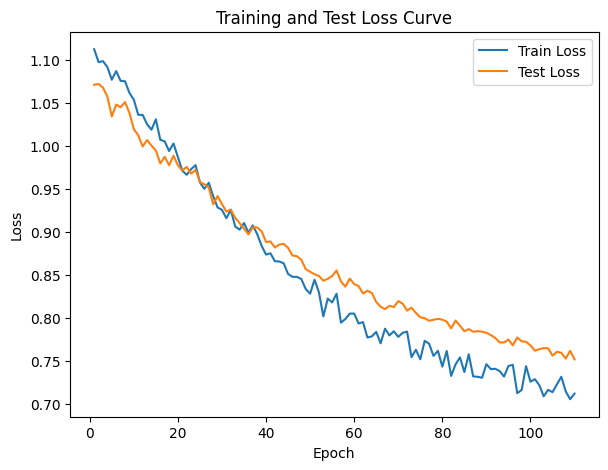

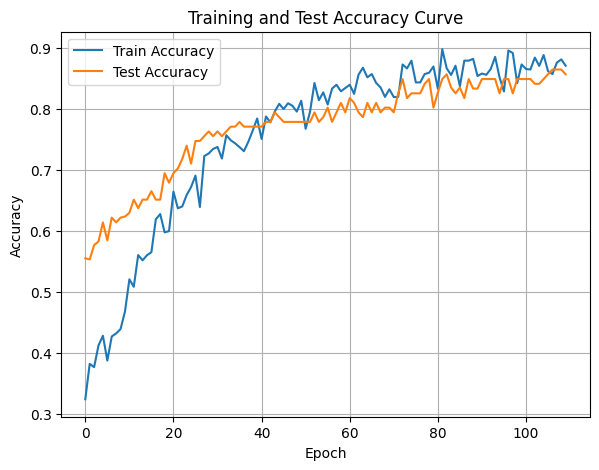

In [49]:
DTEmlp6b.train_single_model()

Randomly initializing 6 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.25it/s]

Epoch [1/10], Train F1:0.2565841330251518, Train Loss: 1.1421, Train Acc: 0.2399, Test F1:0.2365791020761781, Test Loss: 1.1200, Test Acc: 0.1918


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.40it/s]

Epoch [2/10], Train F1:0.26261326116011663, Train Loss: 1.1441, Train Acc: 0.2530, Test F1:0.23138949560424935, Test Loss: 1.1185, Test Acc: 0.1801


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.54it/s]

Epoch [3/10], Train F1:0.27624149992291214, Train Loss: 1.1426, Train Acc: 0.2618, Test F1:0.22369213723719386, Test Loss: 1.1206, Test Acc: 0.1736


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.80it/s]

Epoch [4/10], Train F1:0.2871538238664223, Train Loss: 1.1386, Train Acc: 0.2696, Test F1:0.23114700502843652, Test Loss: 1.1215, Test Acc: 0.1743


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.88it/s]

Epoch [5/10], Train F1:0.2921753882527049, Train Loss: 1.1352, Train Acc: 0.2758, Test F1:0.2350938185841033, Test Loss: 1.1206, Test Acc: 0.1806


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.91it/s]

Epoch [6/10], Train F1:0.2963838783783138, Train Loss: 1.1320, Train Acc: 0.2806, Test F1:0.23458316844743438, Test Loss: 1.1216, Test Acc: 0.1808


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.64it/s]

Epoch [7/10], Train F1:0.30629785342414634, Train Loss: 1.1287, Train Acc: 0.2892, Test F1:0.2374538040015292, Test Loss: 1.1207, Test Acc: 0.1855


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.62it/s]

Epoch [8/10], Train F1:0.31419356140589144, Train Loss: 1.1261, Train Acc: 0.2961, Test F1:0.2423439556720784, Test Loss: 1.1188, Test Acc: 0.1919
Epoch [9/10], Train F1:0.31970675069051174, Train Loss: 1.1235, Train Acc: 0.3015, Test F1:0.26318756791829084, Test Loss: 1.1145, Test Acc: 0.2046


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.53it/s]


Epoch [10/10], Train F1:0.3291194022013862, Train Loss: 1.1203, Train Acc: 0.3100, Test F1:0.2734502214012799, Test Loss: 1.1114, Test Acc: 0.2137
Total Epochs: 10
Train loss start: 1.1181851625442505, Train loss end: 1.1071116924285889
Highest Mean Train Accuracy (over epoch): 0.30997023809523816
Test loss start: 1.1261036396026611, Test loss end: 1.0857024192810059
Highest mean Test Accuracy (over epoch): 0.21371527777777777


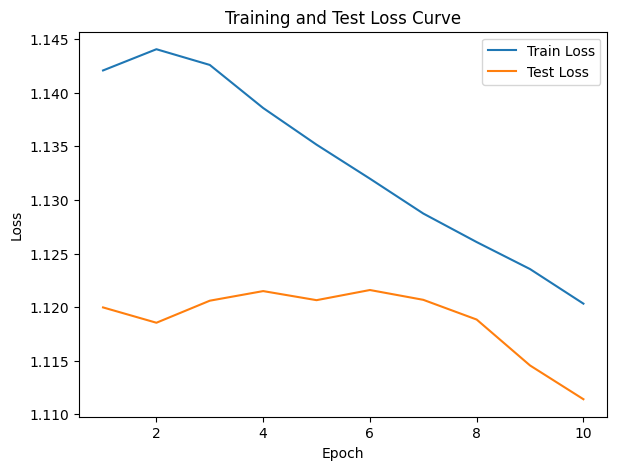

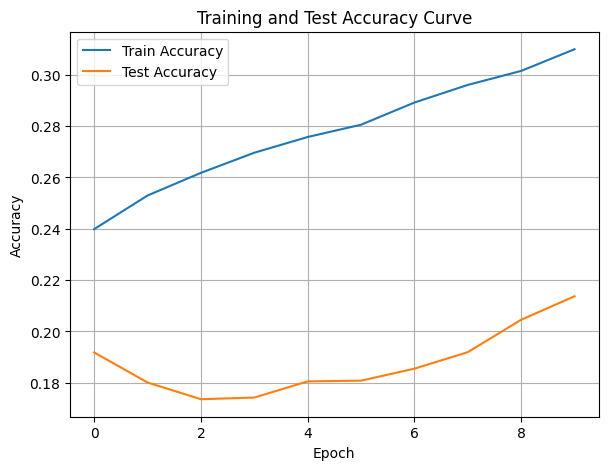

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.40it/s]

Epoch [1/10], Train F1:0.500457922979978, Train Loss: 1.0735, Train Acc: 0.4274, Test F1:0.20872694556905083, Test Loss: 1.1162, Test Acc: 0.2804


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.57it/s]

Epoch [2/10], Train F1:0.48757783569323915, Train Loss: 1.0717, Train Acc: 0.4223, Test F1:0.21729592799202305, Test Loss: 1.1078, Test Acc: 0.3069


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.67it/s]

Epoch [3/10], Train F1:0.4834816930697748, Train Loss: 1.0731, Train Acc: 0.4157, Test F1:0.2175828943869291, Test Loss: 1.1050, Test Acc: 0.3157


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.67it/s]

Epoch [4/10], Train F1:0.4728156243488236, Train Loss: 1.0748, Train Acc: 0.4071, Test F1:0.21987306921015237, Test Loss: 1.1039, Test Acc: 0.3220


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.46it/s]

Epoch [5/10], Train F1:0.47755455088799853, Train Loss: 1.0761, Train Acc: 0.4085, Test F1:0.2215117803373683, Test Loss: 1.1024, Test Acc: 0.3259


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.49it/s]

Epoch [6/10], Train F1:0.48185287422503426, Train Loss: 1.0722, Train Acc: 0.4144, Test F1:0.22854797138607932, Test Loss: 1.1004, Test Acc: 0.3320


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.10it/s]

Epoch [7/10], Train F1:0.4917257814489716, Train Loss: 1.0681, Train Acc: 0.4242, Test F1:0.23328601979598404, Test Loss: 1.0976, Test Acc: 0.3384


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.83it/s]

Epoch [8/10], Train F1:0.5022722502849872, Train Loss: 1.0642, Train Acc: 0.4344, Test F1:0.23288070222416396, Test Loss: 1.0959, Test Acc: 0.3415


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.98it/s]

Epoch [9/10], Train F1:0.5064182868413637, Train Loss: 1.0610, Train Acc: 0.4382, Test F1:0.23649543220218266, Test Loss: 1.0938, Test Acc: 0.3463


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.86it/s]


Epoch [10/10], Train F1:0.5162624722520712, Train Loss: 1.0573, Train Acc: 0.4460, Test F1:0.24251650762913302, Test Loss: 1.0911, Test Acc: 0.3509
Total Epochs: 10
Train loss start: 1.1103763580322266, Train loss end: 1.1186749935150146
Highest Mean Train Accuracy (over epoch): 0.4459821428571429
Test loss start: 1.1057202816009521, Test loss end: 1.0640580654144287
Highest mean Test Accuracy (over epoch): 0.35086805555555556


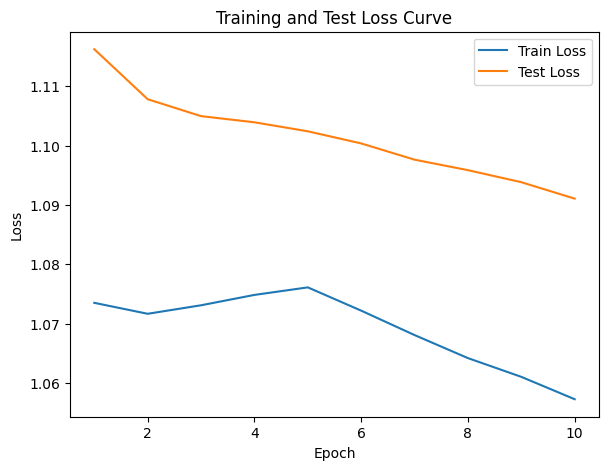

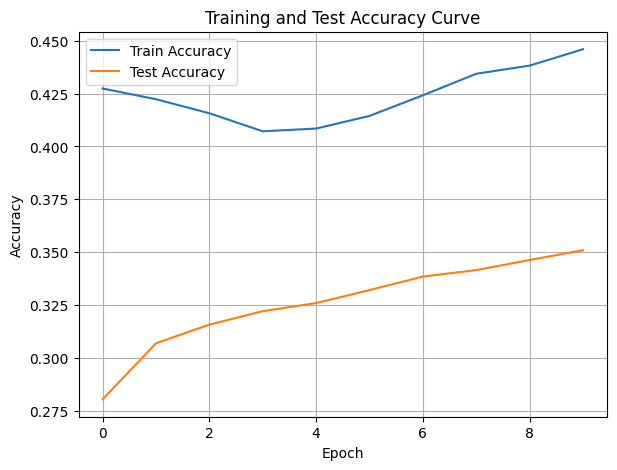

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.08it/s]

Epoch [1/10], Train F1:0.2664582988201079, Train Loss: 1.1874, Train Acc: 0.1688, Test F1:0.43912828289210426, Test Loss: 1.0999, Test Acc: 0.3724


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.76it/s]

Epoch [2/10], Train F1:0.26455173533055154, Train Loss: 1.1860, Train Acc: 0.1746, Test F1:0.49455153734884205, Test Loss: 1.0932, Test Acc: 0.4501


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.27it/s]

Epoch [3/10], Train F1:0.26154450670130325, Train Loss: 1.1833, Train Acc: 0.1769, Test F1:0.5409945445268651, Test Loss: 1.0851, Test Acc: 0.5026


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.43it/s]

Epoch [4/10], Train F1:0.2637437037956631, Train Loss: 1.1819, Train Acc: 0.1804, Test F1:0.5505553098432356, Test Loss: 1.0828, Test Acc: 0.5299


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.47it/s]

Epoch [5/10], Train F1:0.2838505697603372, Train Loss: 1.1753, Train Acc: 0.1935, Test F1:0.562668026820534, Test Loss: 1.0794, Test Acc: 0.5491


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.71it/s]

Epoch [6/10], Train F1:0.2926114755761722, Train Loss: 1.1714, Train Acc: 0.2003, Test F1:0.5671983254288121, Test Loss: 1.0762, Test Acc: 0.5609
Epoch [7/10], Train F1:0.2962543807034023, Train Loss: 1.1678, Train Acc: 0.2040, Test F1:0.5727441192068202, Test Loss: 1.0736, Test Acc: 0.5716


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.25it/s]

Epoch [8/10], Train F1:0.30077083247299874, Train Loss: 1.1640, Train Acc: 0.2085, Test F1:0.5728072941650609, Test Loss: 1.0715, Test Acc: 0.5776
Epoch [9/10], Train F1:0.3149558684000489, Train Loss: 1.1586, Train Acc: 0.2220, Test F1:0.5816761542019899, Test Loss: 1.0673, Test Acc: 0.5923


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.84it/s]


Epoch [10/10], Train F1:0.3213826388034636, Train Loss: 1.1547, Train Acc: 0.2279, Test F1:0.5896375809594948, Test Loss: 1.0643, Test Acc: 0.6033
Total Epochs: 10
Train loss start: 1.172839641571045, Train loss end: 1.0890885591506958
Highest Mean Train Accuracy (over epoch): 0.22791666666666666
Test loss start: 1.1035066843032837, Test loss end: 1.0245510339736938
Highest mean Test Accuracy (over epoch): 0.603298611111111


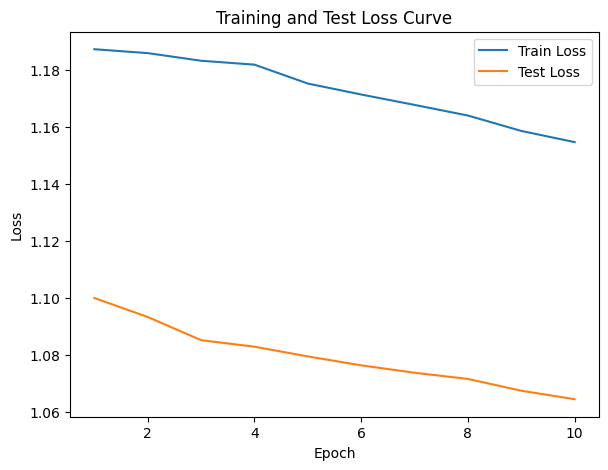

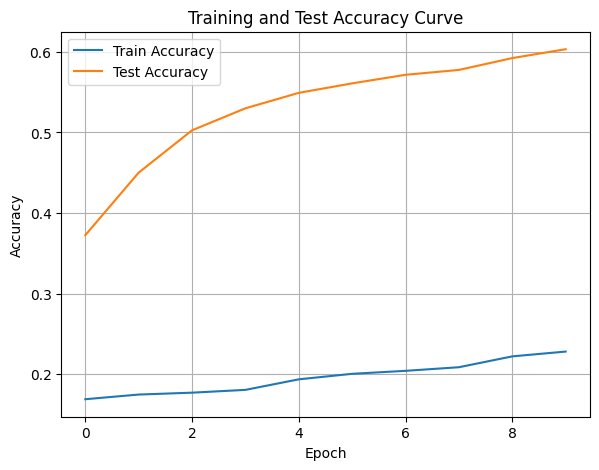

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.11it/s]

Epoch [1/10], Train F1:0.40458457931482394, Train Loss: 1.0900, Train Acc: 0.3786, Test F1:0.2770353354503074, Test Loss: 1.1063, Test Acc: 0.2474


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.18it/s]

Epoch [2/10], Train F1:0.37589398207793506, Train Loss: 1.0927, Train Acc: 0.3567, Test F1:0.25919757198904436, Test Loss: 1.1116, Test Acc: 0.2218


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.88it/s]

Epoch [3/10], Train F1:0.36252702103863677, Train Loss: 1.0998, Train Acc: 0.3396, Test F1:0.26074834506612643, Test Loss: 1.1120, Test Acc: 0.2179


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.23it/s]

Epoch [4/10], Train F1:0.3632663861563552, Train Loss: 1.0992, Train Acc: 0.3407, Test F1:0.26357622352078797, Test Loss: 1.1119, Test Acc: 0.2144


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.36it/s]

Epoch [5/10], Train F1:0.37127459349322073, Train Loss: 1.0942, Train Acc: 0.3504, Test F1:0.2737809688029482, Test Loss: 1.1109, Test Acc: 0.2198


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.36it/s]

Epoch [6/10], Train F1:0.38319925593456117, Train Loss: 1.0905, Train Acc: 0.3607, Test F1:0.2816498908945856, Test Loss: 1.1101, Test Acc: 0.2221


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.88it/s]

Epoch [7/10], Train F1:0.3915645988231565, Train Loss: 1.0875, Train Acc: 0.3678, Test F1:0.2895853876694344, Test Loss: 1.1090, Test Acc: 0.2313


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.13it/s]

Epoch [8/10], Train F1:0.39822326357833576, Train Loss: 1.0830, Train Acc: 0.3758, Test F1:0.2950476562454938, Test Loss: 1.1072, Test Acc: 0.2399


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.06it/s]

Epoch [9/10], Train F1:0.4038608145588087, Train Loss: 1.0813, Train Acc: 0.3812, Test F1:0.30288733144227653, Test Loss: 1.1055, Test Acc: 0.2475


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.07it/s]


Epoch [10/10], Train F1:0.40784796109132704, Train Loss: 1.0787, Train Acc: 0.3844, Test F1:0.3071086481536458, Test Loss: 1.1041, Test Acc: 0.2528
Total Epochs: 10
Train loss start: 1.1142752170562744, Train loss end: 1.09697687625885
Highest Mean Train Accuracy (over epoch): 0.384375
Test loss start: 1.1126817464828491, Test loss end: 1.0715677738189697
Highest mean Test Accuracy (over epoch): 0.25277777777777777


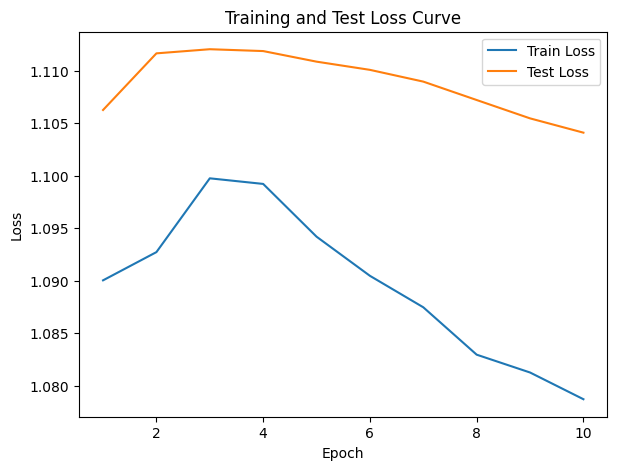

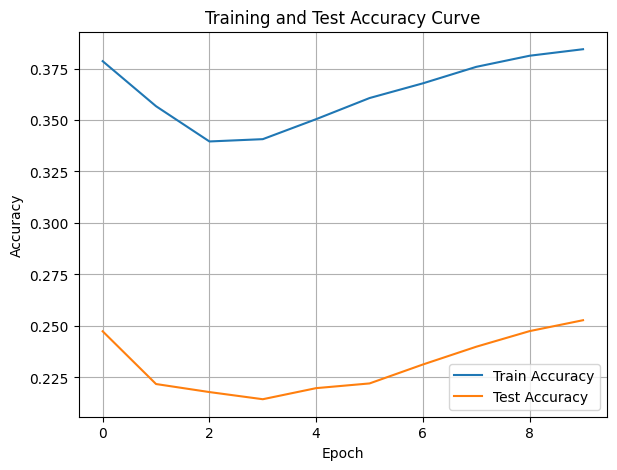

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.27it/s]

Epoch [1/10], Train F1:0.47040934726162514, Train Loss: 1.0848, Train Acc: 0.3970, Test F1:0.3656578947368421, Test Loss: 1.0807, Test Acc: 0.3863


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.61it/s]

Epoch [2/10], Train F1:0.5035466432669168, Train Loss: 1.0703, Train Acc: 0.4357, Test F1:0.37956871345029236, Test Loss: 1.0707, Test Acc: 0.4119


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.12it/s]

Epoch [3/10], Train F1:0.5041142720810771, Train Loss: 1.0669, Train Acc: 0.4396, Test F1:0.3624298086989626, Test Loss: 1.0697, Test Acc: 0.4100
Epoch [4/10], Train F1:0.5156343134523798, Train Loss: 1.0625, Train Acc: 0.4530, Test F1:0.3634103914513926, Test Loss: 1.0679, Test Acc: 0.4149


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.83it/s]

Epoch [5/10], Train F1:0.5273718544365212, Train Loss: 1.0577, Train Acc: 0.4654, Test F1:0.36517124445024784, Test Loss: 1.0667, Test Acc: 0.4194
Epoch [6/10], Train F1:0.5353894427364383, Train Loss: 1.0522, Train Acc: 0.4786, Test F1:0.37320044493236626, Test Loss: 1.0633, Test Acc: 0.4251


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.08it/s]

Epoch [7/10], Train F1:0.54436608412836, Train Loss: 1.0479, Train Acc: 0.4896, Test F1:0.38142903474939505, Test Loss: 1.0592, Test Acc: 0.4311
Epoch [8/10], Train F1:0.5444370942572071, Train Loss: 1.0472, Train Acc: 0.4903, Test F1:0.38446277742442936, Test Loss: 1.0576, Test Acc: 0.4338


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.69it/s]


Epoch [9/10], Train F1:0.5530636023841348, Train Loss: 1.0428, Train Acc: 0.5010, Test F1:0.38801465920055556, Test Loss: 1.0558, Test Acc: 0.4368
Epoch [10/10], Train F1:0.5600897519092043, Train Loss: 1.0390, Train Acc: 0.5081, Test F1:0.39488679106635044, Test Loss: 1.0532, Test Acc: 0.4436
Total Epochs: 10
Train loss start: 1.1110992431640625, Train loss end: 0.9912270903587341
Highest Mean Train Accuracy (over epoch): 0.5080952380952382
Test loss start: 1.0872371196746826, Test loss end: 1.0237241983413696
Highest mean Test Accuracy (over epoch): 0.44357638888888895


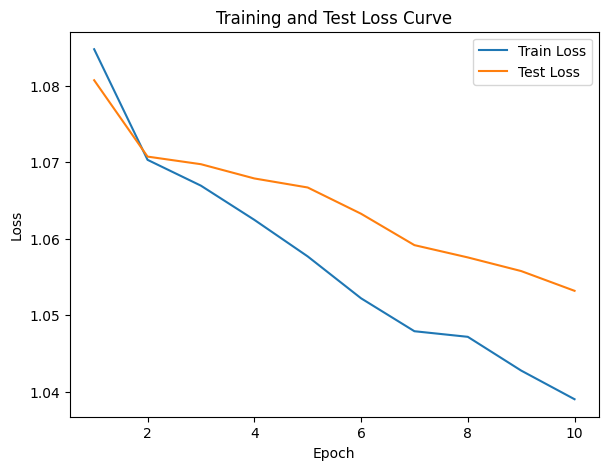

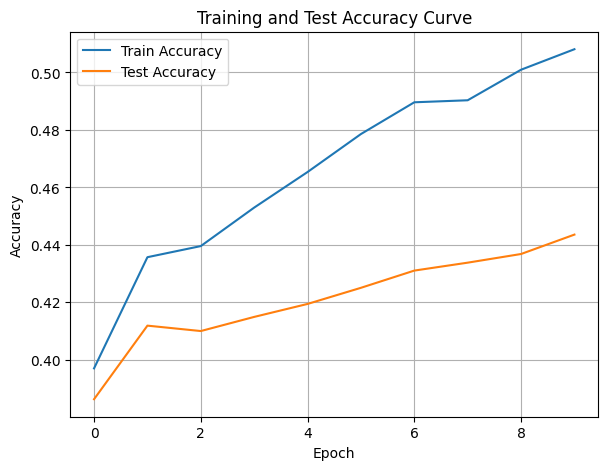

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.32it/s]

Epoch [1/10], Train F1:0.33166235961840357, Train Loss: 1.1146, Train Acc: 0.3682, Test F1:0.31806679433004786, Test Loss: 1.1009, Test Acc: 0.3828


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.43it/s]

Epoch [2/10], Train F1:0.33058434899781786, Train Loss: 1.1146, Train Acc: 0.3598, Test F1:0.2951362627475988, Test Loss: 1.1003, Test Acc: 0.3759


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.11it/s]

Epoch [3/10], Train F1:0.3260054918184009, Train Loss: 1.1124, Train Acc: 0.3553, Test F1:0.28282561015233465, Test Loss: 1.1007, Test Acc: 0.3715


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.84it/s]

Epoch [4/10], Train F1:0.33253119484503185, Train Loss: 1.1095, Train Acc: 0.3598, Test F1:0.27678238148562895, Test Loss: 1.1008, Test Acc: 0.3694


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.05it/s]

Epoch [5/10], Train F1:0.34301952448081535, Train Loss: 1.1030, Train Acc: 0.3696, Test F1:0.27334163761565267, Test Loss: 1.1000, Test Acc: 0.3696


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.94it/s]

Epoch [6/10], Train F1:0.35197664836905995, Train Loss: 1.0999, Train Acc: 0.3751, Test F1:0.27101496071467013, Test Loss: 1.0985, Test Acc: 0.3698


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.24it/s]

Epoch [7/10], Train F1:0.3584740048804177, Train Loss: 1.0969, Train Acc: 0.3818, Test F1:0.2711075888243874, Test Loss: 1.0966, Test Acc: 0.3708


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.26it/s]

Epoch [8/10], Train F1:0.36537518541896336, Train Loss: 1.0928, Train Acc: 0.3879, Test F1:0.2700892864517281, Test Loss: 1.0958, Test Acc: 0.3717


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.00it/s]

Epoch [9/10], Train F1:0.37316340270784115, Train Loss: 1.0896, Train Acc: 0.3935, Test F1:0.2706640976701374, Test Loss: 1.0947, Test Acc: 0.3725


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.64it/s]


Epoch [10/10], Train F1:0.38166128049605935, Train Loss: 1.0865, Train Acc: 0.4012, Test F1:0.2694030671896685, Test Loss: 1.0932, Test Acc: 0.3723
Total Epochs: 10
Train loss start: 1.1204707622528076, Train loss end: 1.0367883443832397
Highest Mean Train Accuracy (over epoch): 0.4011904761904762
Test loss start: 1.1171722412109375, Test loss end: 1.0555603504180908
Highest mean Test Accuracy (over epoch): 0.3828125


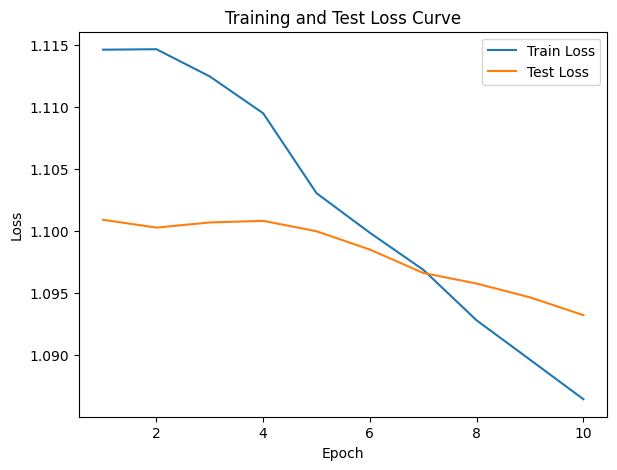

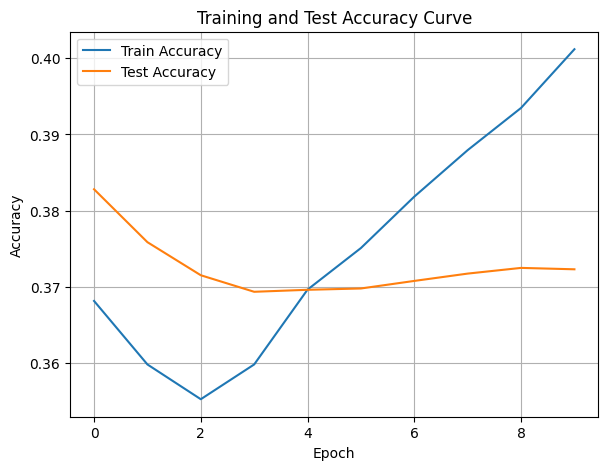

./saved_models/model_6.pth
Training Model with id 11
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.52it/s]

Epoch [1/10], Train F1:0.41438342284301016, Train Loss: 1.0690, Train Acc: 0.4199, Test F1:0.27406194207132634, Test Loss: 1.0816, Test Acc: 0.3845
Epoch [2/10], Train F1:0.4424575047276758, Train Loss: 1.0576, Train Acc: 0.4551, Test F1:0.28618577287237873, Test Loss: 1.0767, Test Acc: 0.3963


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.16it/s]

Epoch [3/10], Train F1:0.45334746894558847, Train Loss: 1.0528, Train Acc: 0.4615, Test F1:0.30068822408263896, Test Loss: 1.0740, Test Acc: 0.4054
Epoch [4/10], Train F1:0.4660240922893927, Train Loss: 1.0460, Train Acc: 0.4752, Test F1:0.32718302464106597, Test Loss: 1.0702, Test Acc: 0.4219


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.35it/s]

Epoch [5/10], Train F1:0.4720885217417811, Train Loss: 1.0432, Train Acc: 0.4773, Test F1:0.3335471135506118, Test Loss: 1.0682, Test Acc: 0.4266
Epoch [6/10], Train F1:0.4804095361257052, Train Loss: 1.0384, Train Acc: 0.4859, Test F1:0.33717579273873427, Test Loss: 1.0675, Test Acc: 0.4284


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.67it/s]

Epoch [7/10], Train F1:0.4891461407592767, Train Loss: 1.0351, Train Acc: 0.4940, Test F1:0.3444787194572534, Test Loss: 1.0656, Test Acc: 0.4339
Epoch [8/10], Train F1:0.49408904481889615, Train Loss: 1.0325, Train Acc: 0.4996, Test F1:0.3474167828899205, Test Loss: 1.0649, Test Acc: 0.4353


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.87it/s]


Epoch [9/10], Train F1:0.5042779005312498, Train Loss: 1.0276, Train Acc: 0.5089, Test F1:0.34868147721484893, Test Loss: 1.0639, Test Acc: 0.4364
Epoch [10/10], Train F1:0.5078285800417711, Train Loss: 1.0250, Train Acc: 0.5128, Test F1:0.3569440721783499, Test Loss: 1.0624, Test Acc: 0.4431
Total Epochs: 10
Train loss start: 1.0087641477584839, Train loss end: 0.9306834936141968
Highest Mean Train Accuracy (over epoch): 0.5127678571428572
Test loss start: 1.0987098217010498, Test loss end: 1.0173563957214355
Highest mean Test Accuracy (over epoch): 0.44305555555555554


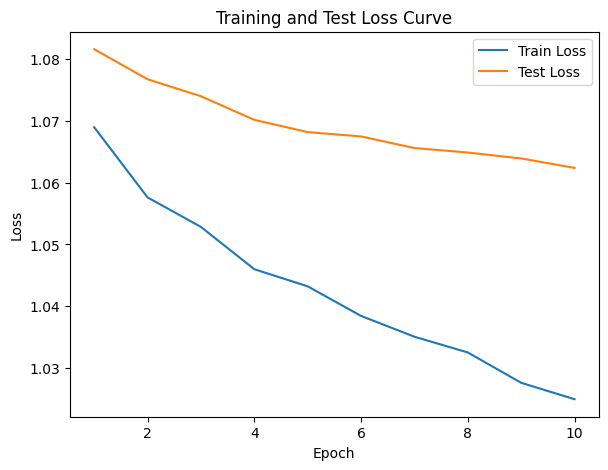

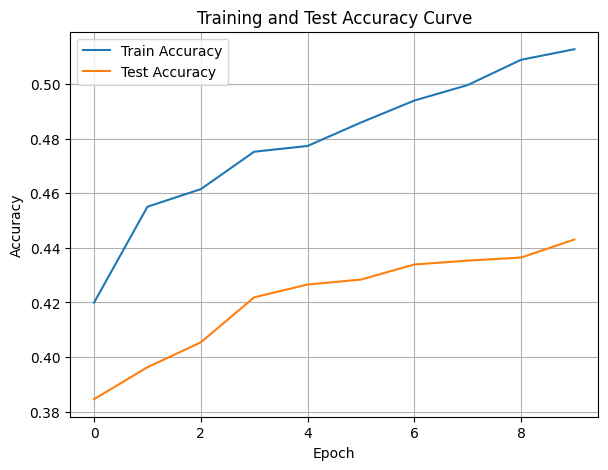

./saved_models/model_11.pth
Training Model with id 9
in multi


Epoch [1/10], Train F1:0.571840925666429, Train Loss: 0.9825, Train Acc: 0.5652, Test F1:0.472488038277512, Test Loss: 1.0401, Test Acc: 0.5260


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.45it/s]

Epoch [2/10], Train F1:0.5713250468590536, Train Loss: 0.9898, Train Acc: 0.5652, Test F1:0.4508035689685419, Test Loss: 1.0431, Test Acc: 0.5113
Epoch [3/10], Train F1:0.5748465095879731, Train Loss: 0.9882, Train Acc: 0.5662, Test F1:0.4603039301439795, Test Loss: 1.0380, Test Acc: 0.5188


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.08it/s]

Epoch [4/10], Train F1:0.5829851259587008, Train Loss: 0.9828, Train Acc: 0.5766, Test F1:0.4650273145617209, Test Loss: 1.0372, Test Acc: 0.5226


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.08it/s]

Epoch [5/10], Train F1:0.5928811305309436, Train Loss: 0.9794, Train Acc: 0.5860, Test F1:0.46903599135444574, Test Loss: 1.0359, Test Acc: 0.5248


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.15it/s]

Epoch [6/10], Train F1:0.6019325214691797, Train Loss: 0.9763, Train Acc: 0.5950, Test F1:0.4665673060442756, Test Loss: 1.0348, Test Acc: 0.5227


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.47it/s]

Epoch [7/10], Train F1:0.6049551386080628, Train Loss: 0.9756, Train Acc: 0.5963, Test F1:0.4701389883315759, Test Loss: 1.0343, Test Acc: 0.5263


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.38it/s]

Epoch [8/10], Train F1:0.607903715374314, Train Loss: 0.9732, Train Acc: 0.5996, Test F1:0.4681501923764885, Test Loss: 1.0343, Test Acc: 0.5253


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.55it/s]

Epoch [9/10], Train F1:0.6124328253252285, Train Loss: 0.9699, Train Acc: 0.6042, Test F1:0.4686434395848777, Test Loss: 1.0326, Test Acc: 0.5260


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.53it/s]


Epoch [10/10], Train F1:0.6183980183534015, Train Loss: 0.9670, Train Acc: 0.6112, Test F1:0.47093229138532267, Test Loss: 1.0316, Test Acc: 0.5282
Total Epochs: 10
Train loss start: 0.9467652440071106, Train loss end: 0.8290926814079285
Highest Mean Train Accuracy (over epoch): 0.6111607142857143
Test loss start: 1.0583202838897705, Test loss end: 0.9839338660240173
Highest mean Test Accuracy (over epoch): 0.5282118055555556


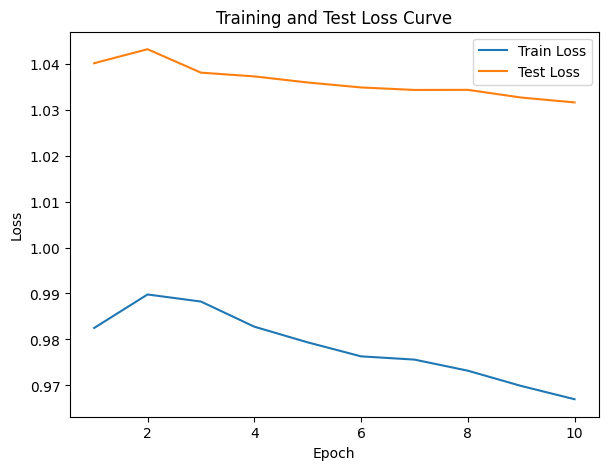

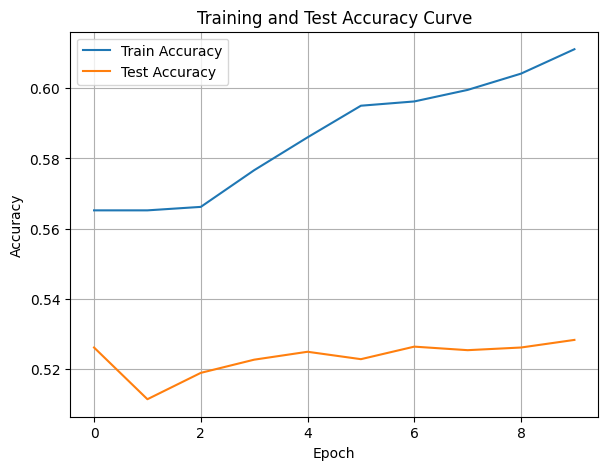

./saved_models/model_9.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7195609233343597, Train Loss: 0.9211, Train Acc: 0.7196, Test F1:0.47792558318874107, Test Loss: 1.0112, Test Acc: 0.5260


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.55it/s]

Epoch [2/10], Train F1:0.7095155925985629, Train Loss: 0.9195, Train Acc: 0.7065, Test F1:0.5106798245614035, Test Loss: 1.0079, Test Acc: 0.5525


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.55it/s]

Epoch [3/10], Train F1:0.702256033667938, Train Loss: 0.9198, Train Acc: 0.6962, Test F1:0.5114434638420693, Test Loss: 1.0066, Test Acc: 0.5535


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.39it/s]

Epoch [4/10], Train F1:0.7097612773569896, Train Loss: 0.9178, Train Acc: 0.7033, Test F1:0.5077899426929898, Test Loss: 1.0055, Test Acc: 0.5521


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.39it/s]

Epoch [5/10], Train F1:0.7183403697021465, Train Loss: 0.9142, Train Acc: 0.7129, Test F1:0.5194128133783436, Test Loss: 1.0036, Test Acc: 0.5606


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.03it/s]

Epoch [6/10], Train F1:0.7192477039682188, Train Loss: 0.9140, Train Acc: 0.7122, Test F1:0.5251951635279565, Test Loss: 1.0030, Test Acc: 0.5650


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.22it/s]

Epoch [7/10], Train F1:0.7239766728069464, Train Loss: 0.9116, Train Acc: 0.7167, Test F1:0.5244473184425238, Test Loss: 1.0031, Test Acc: 0.5647


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.14it/s]

Epoch [8/10], Train F1:0.7280953001152923, Train Loss: 0.9099, Train Acc: 0.7203, Test F1:0.533786149980819, Test Loss: 1.0021, Test Acc: 0.5714


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.97it/s]

Epoch [9/10], Train F1:0.7320457737728321, Train Loss: 0.9070, Train Acc: 0.7242, Test F1:0.5508255775652163, Test Loss: 0.9994, Test Acc: 0.5835


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.22it/s]


Epoch [10/10], Train F1:0.7357814023906325, Train Loss: 0.9055, Train Acc: 0.7273, Test F1:0.5695483353442432, Test Loss: 0.9970, Test Acc: 0.5964
Total Epochs: 10
Train loss start: 0.873630702495575, Train loss end: 0.9471380114555359
Highest Mean Train Accuracy (over epoch): 0.7272916666666667
Test loss start: 1.031118392944336, Test loss end: 0.9373724460601807
Highest mean Test Accuracy (over epoch): 0.5963541666666666


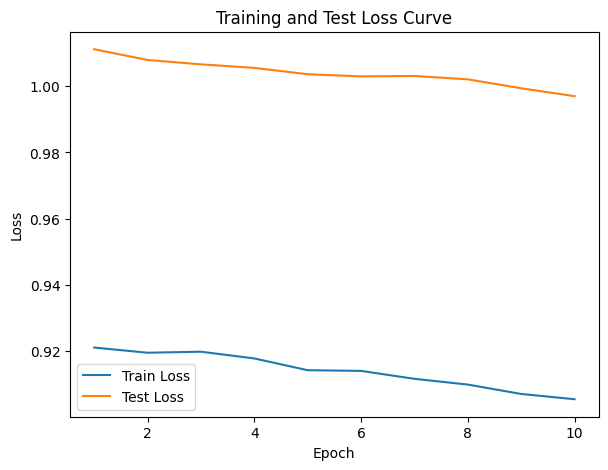

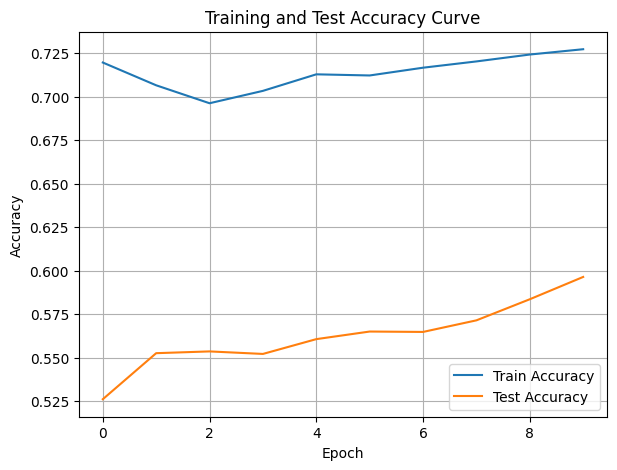

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.52it/s]

Epoch [1/10], Train F1:0.7920339993037062, Train Loss: 0.8652, Train Acc: 0.7926, Test F1:0.7339831059129305, Test Loss: 0.9734, Test Acc: 0.7335
Epoch [2/10], Train F1:0.772321542995279, Train Loss: 0.8787, Train Acc: 0.7653, Test F1:0.774192425508215, Test Loss: 0.9645, Test Acc: 0.7756


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.52it/s]

Epoch [3/10], Train F1:0.7813811965860673, Train Loss: 0.8740, Train Acc: 0.7765, Test F1:0.7537131952187752, Test Loss: 0.9663, Test Acc: 0.7517


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.59it/s]

Epoch [4/10], Train F1:0.7854481235485655, Train Loss: 0.8747, Train Acc: 0.7802, Test F1:0.7776899485069275, Test Loss: 0.9633, Test Acc: 0.7776
Epoch [5/10], Train F1:0.7857593029207649, Train Loss: 0.8724, Train Acc: 0.7785, Test F1:0.7410631842764807, Test Loss: 0.9674, Test Acc: 0.7422


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.78it/s]

Epoch [6/10], Train F1:0.7839000537129405, Train Loss: 0.8736, Train Acc: 0.7740, Test F1:0.7139457423691599, Test Loss: 0.9701, Test Acc: 0.7173
Epoch [7/10], Train F1:0.7868785152007537, Train Loss: 0.8705, Train Acc: 0.7773, Test F1:0.730558120447317, Test Loss: 0.9689, Test Acc: 0.7319


Epoch [8/10], Train F1:0.7886058157554594, Train Loss: 0.8679, Train Acc: 0.7775, Test F1:0.7277521214203021, Test Loss: 0.9677, Test Acc: 0.7284
Epoch [9/10], Train F1:0.7920630196175622, Train Loss: 0.8647, Train Acc: 0.7805, Test F1:0.7264377625933689, Test Loss: 0.9663, Test Acc: 0.7272


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.91it/s]


Epoch [10/10], Train F1:0.7943551603733767, Train Loss: 0.8617, Train Acc: 0.7825, Test F1:0.7315555129616936, Test Loss: 0.9649, Test Acc: 0.7312
Total Epochs: 10
Train loss start: 0.8463531732559204, Train loss end: 0.879123330116272
Highest Mean Train Accuracy (over epoch): 0.7925595238095239
Test loss start: 0.9908460974693298, Test loss end: 0.9124084115028381
Highest mean Test Accuracy (over epoch): 0.7775607638888888


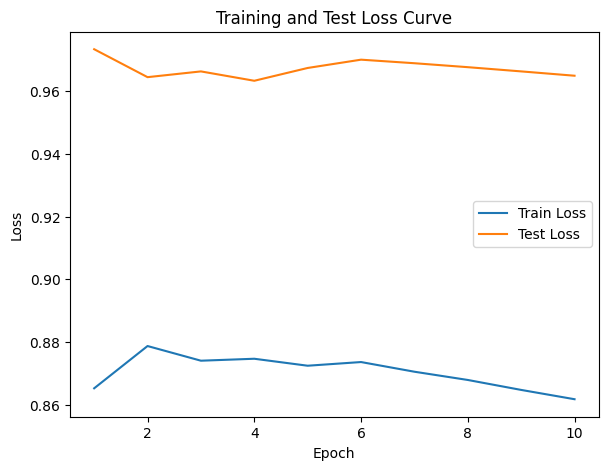

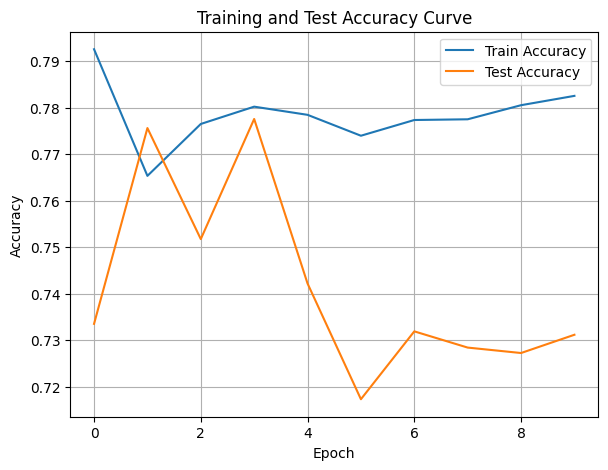

./saved_models/model_10.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8211443775833474, Train Loss: 0.8482, Train Acc: 0.7973, Test F1:0.8300706033376123, Test Loss: 0.9225, Test Acc: 0.8411


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.20it/s]

Epoch [2/10], Train F1:0.8117292606709393, Train Loss: 0.8422, Train Acc: 0.7927, Test F1:0.8424305409858196, Test Loss: 0.9290, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.20it/s]

Epoch [3/10], Train F1:0.8201592791914211, Train Loss: 0.8349, Train Acc: 0.8079, Test F1:0.8434048083170891, Test Loss: 0.9352, Test Acc: 0.8443


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.84it/s]

Epoch [4/10], Train F1:0.8191603029580077, Train Loss: 0.8332, Train Acc: 0.8066, Test F1:0.8459623144949839, Test Loss: 0.9356, Test Acc: 0.8455


Epoch [5/10], Train F1:0.8231581378341448, Train Loss: 0.8280, Train Acc: 0.8149, Test F1:0.8433499906078992, Test Loss: 0.9380, Test Acc: 0.8418
Epoch [6/10], Train F1:0.8287829557622809, Train Loss: 0.8267, Train Acc: 0.8207, Test F1:0.8425978092040008, Test Loss: 0.9363, Test Acc: 0.8417


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.24it/s]

Epoch [7/10], Train F1:0.8306629036942907, Train Loss: 0.8233, Train Acc: 0.8249, Test F1:0.8424002588509575, Test Loss: 0.9361, Test Acc: 0.8408


Epoch [8/10], Train F1:0.8299447525376502, Train Loss: 0.8219, Train Acc: 0.8247, Test F1:0.8438825822726753, Test Loss: 0.9344, Test Acc: 0.8428


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.46it/s]

Epoch [9/10], Train F1:0.829425057069448, Train Loss: 0.8198, Train Acc: 0.8259, Test F1:0.8386919197932442, Test Loss: 0.9355, Test Acc: 0.8367


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.68it/s]


Epoch [10/10], Train F1:0.8326351315132716, Train Loss: 0.8170, Train Acc: 0.8287, Test F1:0.8381082105707736, Test Loss: 0.9336, Test Acc: 0.8352
Total Epochs: 10
Train loss start: 0.7475674152374268, Train loss end: 0.7756878733634949
Highest Mean Train Accuracy (over epoch): 0.828720238095238
Test loss start: 0.9346232414245605, Test loss end: 0.8832848072052002
Highest mean Test Accuracy (over epoch): 0.8489583333333334


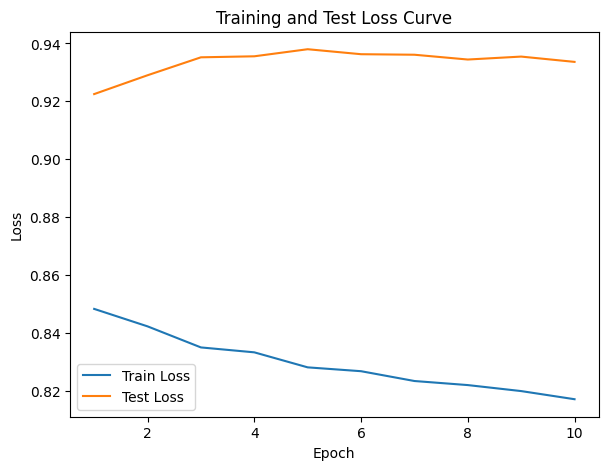

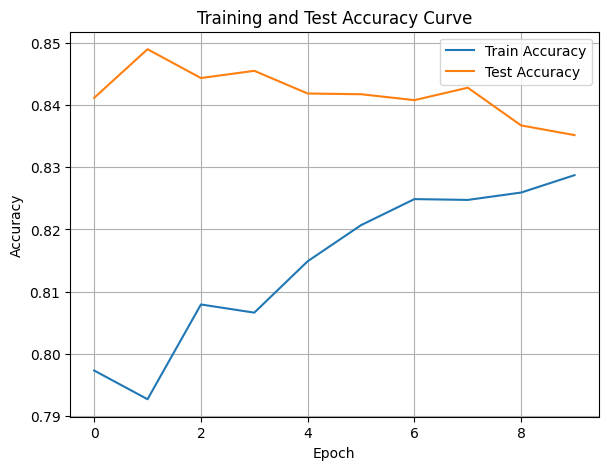

./saved_models/model_8.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [50]:
DTEmlp6b.train_DTE()

Training Process:   2%|▏         | 2/110 [00:00<00:15,  7.15it/s]

Epoch [1/110], Train F1:0.3304582968376686, Train Loss: 1.1295, Train Acc: 0.2887, Test F1:0.2167139228542738, Test Loss: 1.1092, Test Acc: 0.2352
Epoch [2/110], Train F1:0.34173145656019055, Train Loss: 1.1175, Train Acc: 0.3018, Test F1:0.21870465637778658, Test Loss: 1.1085, Test Acc: 0.2561


Training Process:   4%|▎         | 4/110 [00:00<00:14,  7.27it/s]

Epoch [3/110], Train F1:0.3626883941227396, Train Loss: 1.1103, Train Acc: 0.3246, Test F1:0.22706070732386519, Test Loss: 1.1078, Test Acc: 0.2584
Epoch [4/110], Train F1:0.3677816227752669, Train Loss: 1.1114, Train Acc: 0.3284, Test F1:0.23344514815009668, Test Loss: 1.1061, Test Acc: 0.2689


Training Process:   5%|▌         | 6/110 [00:00<00:13,  7.94it/s]

Epoch [5/110], Train F1:0.37389064304212316, Train Loss: 1.1093, Train Acc: 0.3321, Test F1:0.24326006865888797, Test Loss: 1.1038, Test Acc: 0.2783
Epoch [6/110], Train F1:0.38076294659292786, Train Loss: 1.1066, Train Acc: 0.3402, Test F1:0.2593091147910255, Test Loss: 1.1014, Test Acc: 0.2911


Training Process:   7%|▋         | 8/110 [00:01<00:12,  8.37it/s]

Epoch [7/110], Train F1:0.38401715587990964, Train Loss: 1.1040, Train Acc: 0.3435, Test F1:0.26008781536530495, Test Loss: 1.0995, Test Acc: 0.2980
Epoch [8/110], Train F1:0.3914947363854607, Train Loss: 1.0998, Train Acc: 0.3515, Test F1:0.26510362793548636, Test Loss: 1.0978, Test Acc: 0.3061


Training Process:   9%|▉         | 10/110 [00:01<00:11,  8.40it/s]

Epoch [9/110], Train F1:0.39585367634626917, Train Loss: 1.0983, Train Acc: 0.3555, Test F1:0.30409749289913424, Test Loss: 1.0966, Test Acc: 0.3237
Epoch [10/110], Train F1:0.3997109463859064, Train Loss: 1.0958, Train Acc: 0.3607, Test F1:0.31122918470634964, Test Loss: 1.0956, Test Acc: 0.3292


Training Process:  11%|█         | 12/110 [00:01<00:11,  8.64it/s]

Epoch [11/110], Train F1:0.41258321857808816, Train Loss: 1.0912, Train Acc: 0.3736, Test F1:0.3167608817473061, Test Loss: 1.0941, Test Acc: 0.3351
Epoch [12/110], Train F1:0.41851193737787573, Train Loss: 1.0873, Train Acc: 0.3801, Test F1:0.3209102037305576, Test Loss: 1.0922, Test Acc: 0.3419


Training Process:  13%|█▎        | 14/110 [00:01<00:11,  8.72it/s]

Epoch [13/110], Train F1:0.42721594895892934, Train Loss: 1.0823, Train Acc: 0.3887, Test F1:0.3232560494278018, Test Loss: 1.0902, Test Acc: 0.3478
Epoch [14/110], Train F1:0.43665141365302973, Train Loss: 1.0790, Train Acc: 0.3974, Test F1:0.35856107817402244, Test Loss: 1.0888, Test Acc: 0.3697


Training Process:  15%|█▍        | 16/110 [00:01<00:10,  8.60it/s]

Epoch [15/110], Train F1:0.4434099437721431, Train Loss: 1.0762, Train Acc: 0.4039, Test F1:0.36617743825269494, Test Loss: 1.0871, Test Acc: 0.3774
Epoch [16/110], Train F1:0.4531212758676794, Train Loss: 1.0720, Train Acc: 0.4143, Test F1:0.369755946182672, Test Loss: 1.0854, Test Acc: 0.3828


Training Process:  16%|█▋        | 18/110 [00:02<00:11,  7.77it/s]

Epoch [17/110], Train F1:0.4610796294201388, Train Loss: 1.0685, Train Acc: 0.4228, Test F1:0.3688820129734241, Test Loss: 1.0843, Test Acc: 0.3848
Epoch [18/110], Train F1:0.4673380526179335, Train Loss: 1.0657, Train Acc: 0.4301, Test F1:0.3690161679677583, Test Loss: 1.0829, Test Acc: 0.3875


Training Process:  18%|█▊        | 20/110 [00:02<00:12,  7.25it/s]

Epoch [19/110], Train F1:0.47528868405930014, Train Loss: 1.0620, Train Acc: 0.4383, Test F1:0.3830261909344783, Test Loss: 1.0815, Test Acc: 0.3976
Epoch [20/110], Train F1:0.48217687205372955, Train Loss: 1.0587, Train Acc: 0.4455, Test F1:0.38173632503841587, Test Loss: 1.0803, Test Acc: 0.3990


Training Process:  20%|██        | 22/110 [00:02<00:12,  6.95it/s]

Epoch [21/110], Train F1:0.48750381975929347, Train Loss: 1.0557, Train Acc: 0.4513, Test F1:0.39025716960970214, Test Loss: 1.0788, Test Acc: 0.4063
Epoch [22/110], Train F1:0.49370795132244805, Train Loss: 1.0530, Train Acc: 0.4573, Test F1:0.4140062552042904, Test Loss: 1.0772, Test Acc: 0.4221


Training Process:  22%|██▏       | 24/110 [00:03<00:12,  6.83it/s]

Epoch [23/110], Train F1:0.5007466602172485, Train Loss: 1.0495, Train Acc: 0.4646, Test F1:0.41412461700790976, Test Loss: 1.0754, Test Acc: 0.4239
Epoch [24/110], Train F1:0.5080401973175276, Train Loss: 1.0461, Train Acc: 0.4727, Test F1:0.43517729679807343, Test Loss: 1.0735, Test Acc: 0.4386


Training Process:  24%|██▎       | 26/110 [00:03<00:12,  6.69it/s]

Epoch [25/110], Train F1:0.5129053070769438, Train Loss: 1.0431, Train Acc: 0.4784, Test F1:0.4417378397944311, Test Loss: 1.0720, Test Acc: 0.4447
Epoch [26/110], Train F1:0.5187762055499561, Train Loss: 1.0396, Train Acc: 0.4853, Test F1:0.4547490348515654, Test Loss: 1.0707, Test Acc: 0.4543


Training Process:  25%|██▌       | 28/110 [00:03<00:13,  6.02it/s]

Epoch [27/110], Train F1:0.5245971381819984, Train Loss: 1.0365, Train Acc: 0.4914, Test F1:0.46843047747695515, Test Loss: 1.0693, Test Acc: 0.4648
Epoch [28/110], Train F1:0.5302692675246498, Train Loss: 1.0335, Train Acc: 0.4981, Test F1:0.4760696099834038, Test Loss: 1.0679, Test Acc: 0.4715


Training Process:  27%|██▋       | 30/110 [00:04<00:13,  6.08it/s]

Epoch [29/110], Train F1:0.5359543153556687, Train Loss: 1.0303, Train Acc: 0.5043, Test F1:0.4832770340289712, Test Loss: 1.0666, Test Acc: 0.4778
Epoch [30/110], Train F1:0.5409728944573858, Train Loss: 1.0275, Train Acc: 0.5100, Test F1:0.4911106293401033, Test Loss: 1.0652, Test Acc: 0.4844


Training Process:  28%|██▊       | 31/110 [00:04<00:12,  6.14it/s]

Epoch [31/110], Train F1:0.5464010205875316, Train Loss: 1.0244, Train Acc: 0.5160, Test F1:0.4925338290244535, Test Loss: 1.0641, Test Acc: 0.4869


Training Process:  29%|██▉       | 32/110 [00:04<00:13,  5.87it/s]

Epoch [32/110], Train F1:0.5514536515481009, Train Loss: 1.0214, Train Acc: 0.5216, Test F1:0.501913629587354, Test Loss: 1.0626, Test Acc: 0.4947


Training Process:  30%|███       | 33/110 [00:04<00:14,  5.36it/s]

Epoch [33/110], Train F1:0.5570827707631639, Train Loss: 1.0182, Train Acc: 0.5272, Test F1:0.5026990134099429, Test Loss: 1.0614, Test Acc: 0.4963


Training Process:  31%|███       | 34/110 [00:04<00:14,  5.42it/s]

Epoch [34/110], Train F1:0.5623386824073192, Train Loss: 1.0158, Train Acc: 0.5325, Test F1:0.5148693613958931, Test Loss: 1.0602, Test Acc: 0.5056


Training Process:  33%|███▎      | 36/110 [00:05<00:13,  5.36it/s]

Epoch [35/110], Train F1:0.5679709443657259, Train Loss: 1.0126, Train Acc: 0.5388, Test F1:0.5255813231791288, Test Loss: 1.0592, Test Acc: 0.5138
Epoch [36/110], Train F1:0.5725086707524927, Train Loss: 1.0099, Train Acc: 0.5436, Test F1:0.5337897781015231, Test Loss: 1.0581, Test Acc: 0.5204


Training Process:  35%|███▍      | 38/110 [00:05<00:12,  5.69it/s]

Epoch [37/110], Train F1:0.5768595727034691, Train Loss: 1.0073, Train Acc: 0.5481, Test F1:0.5351444200113583, Test Loss: 1.0569, Test Acc: 0.5224
Epoch [38/110], Train F1:0.5813461817013891, Train Loss: 1.0046, Train Acc: 0.5523, Test F1:0.5420944835206296, Test Loss: 1.0556, Test Acc: 0.5284


Training Process:  36%|███▋      | 40/110 [00:05<00:11,  5.97it/s]

Epoch [39/110], Train F1:0.584976659183388, Train Loss: 1.0019, Train Acc: 0.5564, Test F1:0.5490927253826333, Test Loss: 1.0542, Test Acc: 0.5345
Epoch [40/110], Train F1:0.5889186324239253, Train Loss: 0.9990, Train Acc: 0.5610, Test F1:0.549601926027602, Test Loss: 1.0530, Test Acc: 0.5359


Training Process:  38%|███▊      | 42/110 [00:06<00:11,  5.93it/s]

Epoch [41/110], Train F1:0.5931408448542478, Train Loss: 0.9962, Train Acc: 0.5657, Test F1:0.5559421788144285, Test Loss: 1.0517, Test Acc: 0.5415
Epoch [42/110], Train F1:0.5971652248245786, Train Loss: 0.9938, Train Acc: 0.5697, Test F1:0.5633492263104931, Test Loss: 1.0506, Test Acc: 0.5478


Training Process:  40%|████      | 44/110 [00:06<00:11,  5.79it/s]

Epoch [43/110], Train F1:0.6016870552564956, Train Loss: 0.9912, Train Acc: 0.5747, Test F1:0.5692191481813582, Test Loss: 1.0494, Test Acc: 0.5531
Epoch [44/110], Train F1:0.6053447330814768, Train Loss: 0.9886, Train Acc: 0.5787, Test F1:0.5737605893087149, Test Loss: 1.0481, Test Acc: 0.5571


Training Process:  41%|████      | 45/110 [00:06<00:12,  5.08it/s]

Epoch [45/110], Train F1:0.6097409874239971, Train Loss: 0.9859, Train Acc: 0.5835, Test F1:0.5794247020539255, Test Loss: 1.0470, Test Acc: 0.5620


Training Process:  42%|████▏     | 46/110 [00:07<00:12,  5.02it/s]

Epoch [46/110], Train F1:0.6126522762662476, Train Loss: 0.9836, Train Acc: 0.5870, Test F1:0.5862645030393924, Test Loss: 1.0457, Test Acc: 0.5678


Training Process:  43%|████▎     | 47/110 [00:07<00:12,  5.04it/s]

Epoch [47/110], Train F1:0.6163063026161691, Train Loss: 0.9809, Train Acc: 0.5913, Test F1:0.5920350526918596, Test Loss: 1.0442, Test Acc: 0.5728


Training Process:  44%|████▎     | 48/110 [00:07<00:12,  5.02it/s]

Epoch [48/110], Train F1:0.6198279275624923, Train Loss: 0.9785, Train Acc: 0.5954, Test F1:0.598106747406244, Test Loss: 1.0432, Test Acc: 0.5782


Training Process:  45%|████▍     | 49/110 [00:07<00:12,  5.00it/s]

Epoch [49/110], Train F1:0.6226629643279479, Train Loss: 0.9763, Train Acc: 0.5988, Test F1:0.6028022184006204, Test Loss: 1.0419, Test Acc: 0.5825


Training Process:  45%|████▌     | 50/110 [00:07<00:11,  5.02it/s]

Epoch [50/110], Train F1:0.6262494668499211, Train Loss: 0.9737, Train Acc: 0.6028, Test F1:0.608220187881791, Test Loss: 1.0405, Test Acc: 0.5873


Training Process:  46%|████▋     | 51/110 [00:08<00:11,  5.01it/s]

Epoch [51/110], Train F1:0.6291245469522524, Train Loss: 0.9712, Train Acc: 0.6060, Test F1:0.6120398784598456, Test Loss: 1.0392, Test Acc: 0.5909


Training Process:  47%|████▋     | 52/110 [00:08<00:11,  4.96it/s]

Epoch [52/110], Train F1:0.6325573117663396, Train Loss: 0.9688, Train Acc: 0.6096, Test F1:0.6167734569650446, Test Loss: 1.0379, Test Acc: 0.5952


Training Process:  48%|████▊     | 53/110 [00:08<00:13,  4.36it/s]

Epoch [53/110], Train F1:0.6360751732434785, Train Loss: 0.9661, Train Acc: 0.6137, Test F1:0.6216713252708835, Test Loss: 1.0365, Test Acc: 0.5997


Training Process:  49%|████▉     | 54/110 [00:08<00:12,  4.37it/s]

Epoch [54/110], Train F1:0.6394438652424074, Train Loss: 0.9639, Train Acc: 0.6174, Test F1:0.6266864714233135, Test Loss: 1.0352, Test Acc: 0.6044


Training Process:  50%|█████     | 55/110 [00:08<00:12,  4.55it/s]

Epoch [55/110], Train F1:0.64267795139293, Train Loss: 0.9614, Train Acc: 0.6210, Test F1:0.6310174460306168, Test Loss: 1.0340, Test Acc: 0.6083


Training Process:  51%|█████     | 56/110 [00:09<00:11,  4.71it/s]

Epoch [56/110], Train F1:0.6455490150375097, Train Loss: 0.9595, Train Acc: 0.6241, Test F1:0.6347575650075464, Test Loss: 1.0327, Test Acc: 0.6119


Training Process:  52%|█████▏    | 57/110 [00:09<00:10,  4.87it/s]

Epoch [57/110], Train F1:0.6488304196032296, Train Loss: 0.9570, Train Acc: 0.6276, Test F1:0.6391434204016595, Test Loss: 1.0315, Test Acc: 0.6159


Training Process:  53%|█████▎    | 58/110 [00:09<00:10,  4.95it/s]

Epoch [58/110], Train F1:0.6512544570622824, Train Loss: 0.9549, Train Acc: 0.6303, Test F1:0.6436000695011431, Test Loss: 1.0302, Test Acc: 0.6201


Training Process:  54%|█████▎    | 59/110 [00:09<00:10,  4.92it/s]

Epoch [59/110], Train F1:0.653876161657998, Train Loss: 0.9529, Train Acc: 0.6331, Test F1:0.6475548549173151, Test Loss: 1.0291, Test Acc: 0.6239


Training Process:  55%|█████▍    | 60/110 [00:10<00:10,  4.56it/s]

Epoch [60/110], Train F1:0.6564053814310482, Train Loss: 0.9508, Train Acc: 0.6359, Test F1:0.6513576968154463, Test Loss: 1.0279, Test Acc: 0.6275


Training Process:  55%|█████▌    | 61/110 [00:10<00:11,  4.31it/s]

Epoch [61/110], Train F1:0.6585205022076572, Train Loss: 0.9490, Train Acc: 0.6383, Test F1:0.6540133397110136, Test Loss: 1.0267, Test Acc: 0.6301


Training Process:  56%|█████▋    | 62/110 [00:10<00:11,  4.34it/s]

Epoch [62/110], Train F1:0.6608176810070973, Train Loss: 0.9468, Train Acc: 0.6411, Test F1:0.6576648307514557, Test Loss: 1.0255, Test Acc: 0.6335


Training Process:  57%|█████▋    | 63/110 [00:10<00:11,  3.95it/s]

Epoch [63/110], Train F1:0.6633896006486363, Train Loss: 0.9446, Train Acc: 0.6441, Test F1:0.6612276346156697, Test Loss: 1.0244, Test Acc: 0.6371


Training Process:  58%|█████▊    | 64/110 [00:11<00:12,  3.77it/s]

Epoch [64/110], Train F1:0.6659543410191733, Train Loss: 0.9425, Train Acc: 0.6468, Test F1:0.6637241988208026, Test Loss: 1.0234, Test Acc: 0.6395


Training Process:  59%|█████▉    | 65/110 [00:11<00:12,  3.69it/s]

Epoch [65/110], Train F1:0.6684683875346303, Train Loss: 0.9403, Train Acc: 0.6496, Test F1:0.666770628862888, Test Loss: 1.0221, Test Acc: 0.6424


Training Process:  60%|██████    | 66/110 [00:11<00:13,  3.20it/s]

Epoch [66/110], Train F1:0.6706566820650643, Train Loss: 0.9384, Train Acc: 0.6519, Test F1:0.6698550516480435, Test Loss: 1.0210, Test Acc: 0.6453


Training Process:  61%|██████    | 67/110 [00:12<00:14,  2.96it/s]

Epoch [67/110], Train F1:0.6728237214880164, Train Loss: 0.9365, Train Acc: 0.6543, Test F1:0.6721225412341445, Test Loss: 1.0198, Test Acc: 0.6476


Training Process:  62%|██████▏   | 68/110 [00:12<00:13,  3.09it/s]

Epoch [68/110], Train F1:0.6749284675853854, Train Loss: 0.9346, Train Acc: 0.6565, Test F1:0.6750179142857806, Test Loss: 1.0186, Test Acc: 0.6505


Training Process:  63%|██████▎   | 69/110 [00:12<00:13,  3.11it/s]

Epoch [69/110], Train F1:0.6773174984188748, Train Loss: 0.9325, Train Acc: 0.6591, Test F1:0.678399785736567, Test Loss: 1.0173, Test Acc: 0.6539


Training Process:  64%|██████▎   | 70/110 [00:13<00:12,  3.25it/s]

Epoch [70/110], Train F1:0.6798269065401061, Train Loss: 0.9307, Train Acc: 0.6617, Test F1:0.6812322101946178, Test Loss: 1.0159, Test Acc: 0.6567


Training Process:  65%|██████▍   | 71/110 [00:13<00:11,  3.48it/s]

Epoch [71/110], Train F1:0.6821801664647049, Train Loss: 0.9288, Train Acc: 0.6641, Test F1:0.6824937030255824, Test Loss: 1.0148, Test Acc: 0.6581


Training Process:  65%|██████▌   | 72/110 [00:13<00:10,  3.70it/s]

Epoch [72/110], Train F1:0.6843571258345442, Train Loss: 0.9270, Train Acc: 0.6662, Test F1:0.6843852528771777, Test Loss: 1.0137, Test Acc: 0.6600


Training Process:  66%|██████▋   | 73/110 [00:13<00:10,  3.64it/s]

Epoch [73/110], Train F1:0.687001195690357, Train Loss: 0.9249, Train Acc: 0.6689, Test F1:0.6870712574750224, Test Loss: 1.0124, Test Acc: 0.6628


Training Process:  67%|██████▋   | 74/110 [00:14<00:09,  3.74it/s]

Epoch [74/110], Train F1:0.6889427110045879, Train Loss: 0.9233, Train Acc: 0.6710, Test F1:0.6879484066403616, Test Loss: 1.0114, Test Acc: 0.6638


Training Process:  68%|██████▊   | 75/110 [00:14<00:08,  3.96it/s]

Epoch [75/110], Train F1:0.6906595991389661, Train Loss: 0.9214, Train Acc: 0.6730, Test F1:0.6894356446148173, Test Loss: 1.0103, Test Acc: 0.6654


Training Process:  69%|██████▉   | 76/110 [00:14<00:08,  4.06it/s]

Epoch [76/110], Train F1:0.6927507081154598, Train Loss: 0.9197, Train Acc: 0.6754, Test F1:0.6911227904292813, Test Loss: 1.0093, Test Acc: 0.6670


Training Process:  70%|███████   | 77/110 [00:14<00:08,  4.07it/s]

Epoch [77/110], Train F1:0.6948223638284667, Train Loss: 0.9180, Train Acc: 0.6773, Test F1:0.6931397871288134, Test Loss: 1.0081, Test Acc: 0.6690


Training Process:  71%|███████   | 78/110 [00:15<00:07,  4.02it/s]

Epoch [78/110], Train F1:0.6967258467802433, Train Loss: 0.9162, Train Acc: 0.6794, Test F1:0.6955587780158716, Test Loss: 1.0070, Test Acc: 0.6715


Training Process:  72%|███████▏  | 79/110 [00:15<00:07,  3.92it/s]

Epoch [79/110], Train F1:0.6983001090915268, Train Loss: 0.9145, Train Acc: 0.6813, Test F1:0.6968456775587418, Test Loss: 1.0060, Test Acc: 0.6728


Training Process:  73%|███████▎  | 80/110 [00:15<00:07,  3.76it/s]

Epoch [80/110], Train F1:0.7006606686813135, Train Loss: 0.9126, Train Acc: 0.6839, Test F1:0.698458587368475, Test Loss: 1.0048, Test Acc: 0.6744


Training Process:  74%|███████▎  | 81/110 [00:15<00:07,  3.84it/s]

Epoch [81/110], Train F1:0.7029584356614719, Train Loss: 0.9108, Train Acc: 0.6863, Test F1:0.7007439964753117, Test Loss: 1.0035, Test Acc: 0.6769


Training Process:  75%|███████▍  | 82/110 [00:16<00:07,  3.85it/s]

Epoch [82/110], Train F1:0.7043468561121805, Train Loss: 0.9093, Train Acc: 0.6880, Test F1:0.7029579081937183, Test Loss: 1.0023, Test Acc: 0.6791


Training Process:  75%|███████▌  | 83/110 [00:16<00:06,  3.92it/s]

Epoch [83/110], Train F1:0.7062514449831127, Train Loss: 0.9076, Train Acc: 0.6900, Test F1:0.7053151433931565, Test Loss: 1.0012, Test Acc: 0.6816


Training Process:  76%|███████▋  | 84/110 [00:16<00:06,  3.90it/s]

Epoch [84/110], Train F1:0.7082153475970308, Train Loss: 0.9058, Train Acc: 0.6922, Test F1:0.7077178467651569, Test Loss: 1.0001, Test Acc: 0.6842


Training Process:  77%|███████▋  | 85/110 [00:16<00:06,  4.03it/s]

Epoch [85/110], Train F1:0.7100851020633624, Train Loss: 0.9042, Train Acc: 0.6943, Test F1:0.7097403609663356, Test Loss: 0.9990, Test Acc: 0.6863


Training Process:  78%|███████▊  | 86/110 [00:17<00:05,  4.05it/s]

Epoch [86/110], Train F1:0.7116583017357934, Train Loss: 0.9027, Train Acc: 0.6959, Test F1:0.7089463891423998, Test Loss: 0.9981, Test Acc: 0.6857


Training Process:  79%|███████▉  | 87/110 [00:17<00:06,  3.75it/s]

Epoch [87/110], Train F1:0.7132722875089247, Train Loss: 0.9011, Train Acc: 0.6978, Test F1:0.710900472170682, Test Loss: 0.9970, Test Acc: 0.6876


Training Process:  80%|████████  | 88/110 [00:17<00:05,  3.73it/s]

Epoch [88/110], Train F1:0.7150787810981151, Train Loss: 0.8994, Train Acc: 0.6997, Test F1:0.7130223638661112, Test Loss: 0.9958, Test Acc: 0.6899


Training Process:  81%|████████  | 89/110 [00:17<00:05,  3.80it/s]

Epoch [89/110], Train F1:0.7167730764827875, Train Loss: 0.8979, Train Acc: 0.7014, Test F1:0.7146829826422403, Test Loss: 0.9948, Test Acc: 0.6915


Training Process:  82%|████████▏ | 90/110 [00:18<00:05,  3.88it/s]

Epoch [90/110], Train F1:0.7185116826918772, Train Loss: 0.8962, Train Acc: 0.7033, Test F1:0.7148830690152583, Test Loss: 0.9939, Test Acc: 0.6918


Training Process:  83%|████████▎ | 91/110 [00:18<00:04,  3.93it/s]

Epoch [91/110], Train F1:0.7202347691905864, Train Loss: 0.8947, Train Acc: 0.7050, Test F1:0.7163855788030744, Test Loss: 0.9929, Test Acc: 0.6934


Training Process:  84%|████████▎ | 92/110 [00:18<00:04,  3.93it/s]

Epoch [92/110], Train F1:0.7218578741320869, Train Loss: 0.8931, Train Acc: 0.7068, Test F1:0.718241708504154, Test Loss: 0.9919, Test Acc: 0.6954


Training Process:  85%|████████▍ | 93/110 [00:18<00:04,  3.95it/s]

Epoch [93/110], Train F1:0.723228424266719, Train Loss: 0.8917, Train Acc: 0.7082, Test F1:0.7194736422265515, Test Loss: 0.9909, Test Acc: 0.6967


Training Process:  85%|████████▌ | 94/110 [00:19<00:04,  3.74it/s]

Epoch [94/110], Train F1:0.7244890459444018, Train Loss: 0.8902, Train Acc: 0.7097, Test F1:0.721363853113622, Test Loss: 0.9898, Test Acc: 0.6987


Training Process:  86%|████████▋ | 95/110 [00:19<00:04,  3.60it/s]

Epoch [95/110], Train F1:0.7259906664539477, Train Loss: 0.8887, Train Acc: 0.7112, Test F1:0.723286449118261, Test Loss: 0.9887, Test Acc: 0.7008


Training Process:  87%|████████▋ | 96/110 [00:19<00:03,  3.58it/s]

Epoch [96/110], Train F1:0.7275045579441343, Train Loss: 0.8871, Train Acc: 0.7130, Test F1:0.7250691511056027, Test Loss: 0.9876, Test Acc: 0.7027


Training Process:  88%|████████▊ | 97/110 [00:20<00:03,  3.54it/s]

Epoch [97/110], Train F1:0.7292428584246424, Train Loss: 0.8855, Train Acc: 0.7147, Test F1:0.7238581405154806, Test Loss: 0.9868, Test Acc: 0.7017


Training Process:  89%|████████▉ | 98/110 [00:20<00:03,  3.60it/s]

Epoch [98/110], Train F1:0.7306490078632949, Train Loss: 0.8843, Train Acc: 0.7161, Test F1:0.7230329144397513, Test Loss: 0.9860, Test Acc: 0.7010


Training Process:  90%|█████████ | 99/110 [00:20<00:03,  3.56it/s]

Epoch [99/110], Train F1:0.7319626126517373, Train Loss: 0.8828, Train Acc: 0.7176, Test F1:0.7244024912856856, Test Loss: 0.9850, Test Acc: 0.7024


Training Process:  91%|█████████ | 100/110 [00:20<00:02,  3.70it/s]

Epoch [100/110], Train F1:0.7333298091076482, Train Loss: 0.8814, Train Acc: 0.7191, Test F1:0.7259284160533631, Test Loss: 0.9839, Test Acc: 0.7040


Training Process:  92%|█████████▏| 101/110 [00:21<00:02,  3.61it/s]

Epoch [101/110], Train F1:0.7349072339251524, Train Loss: 0.8800, Train Acc: 0.7207, Test F1:0.7275096192186286, Test Loss: 0.9829, Test Acc: 0.7057


Training Process:  93%|█████████▎| 102/110 [00:21<00:02,  3.61it/s]

Epoch [102/110], Train F1:0.7359315067105606, Train Loss: 0.8787, Train Acc: 0.7219, Test F1:0.729144233618975, Test Loss: 0.9818, Test Acc: 0.7074


Training Process:  94%|█████████▎| 103/110 [00:21<00:02,  3.33it/s]

Epoch [103/110], Train F1:0.737100911525887, Train Loss: 0.8774, Train Acc: 0.7232, Test F1:0.7303976568825631, Test Loss: 0.9808, Test Acc: 0.7088


Training Process:  95%|█████████▍| 104/110 [00:22<00:01,  3.34it/s]

Epoch [104/110], Train F1:0.7382293418310477, Train Loss: 0.8760, Train Acc: 0.7244, Test F1:0.7319686559215426, Test Loss: 0.9797, Test Acc: 0.7105


Training Process:  95%|█████████▌| 105/110 [00:22<00:01,  3.40it/s]

Epoch [105/110], Train F1:0.739480372167999, Train Loss: 0.8749, Train Acc: 0.7257, Test F1:0.730792334302868, Test Loss: 0.9789, Test Acc: 0.7095


Training Process:  96%|█████████▋| 106/110 [00:22<00:01,  3.46it/s]

Epoch [106/110], Train F1:0.7405688948674831, Train Loss: 0.8736, Train Acc: 0.7268, Test F1:0.7323381886842406, Test Loss: 0.9778, Test Acc: 0.7112


Training Process:  97%|█████████▋| 107/110 [00:22<00:00,  3.53it/s]

Epoch [107/110], Train F1:0.7419297412236656, Train Loss: 0.8721, Train Acc: 0.7284, Test F1:0.7338466543444168, Test Loss: 0.9768, Test Acc: 0.7129


Training Process:  98%|█████████▊| 108/110 [00:23<00:00,  3.22it/s]

Epoch [108/110], Train F1:0.7430235861145045, Train Loss: 0.8709, Train Acc: 0.7296, Test F1:0.7352454163745905, Test Loss: 0.9757, Test Acc: 0.7144


Training Process:  99%|█████████▉| 109/110 [00:23<00:00,  3.21it/s]

Epoch [109/110], Train F1:0.744421382124871, Train Loss: 0.8696, Train Acc: 0.7311, Test F1:0.7365286365580819, Test Loss: 0.9748, Test Acc: 0.7158


Training Process: 100%|██████████| 110/110 [00:23<00:00,  4.59it/s]


Epoch [110/110], Train F1:0.7455833671198357, Train Loss: 0.8683, Train Acc: 0.7323, Test F1:0.7372269718908488, Test Loss: 0.9739, Test Acc: 0.7166
Total Epochs: 110
Train loss start: 1.1708102226257324, Train loss end: 0.8546323776245117
Highest Mean Train Accuracy (over epoch): 0.7323024891774892
Test loss start: 1.1052649021148682, Test loss end: 0.8666219115257263
Highest Mean Test Accuracy (over epoch): 0.7166035353535353


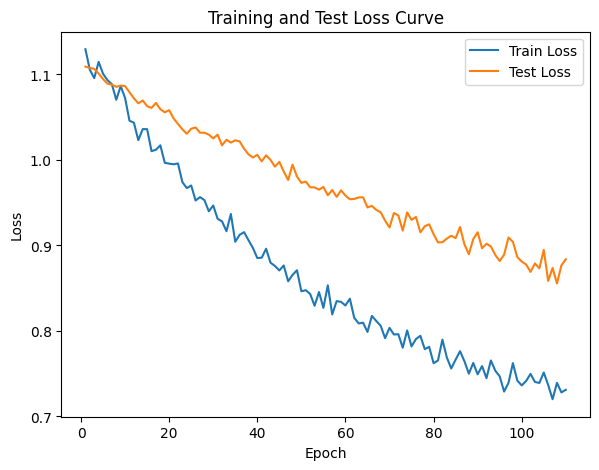

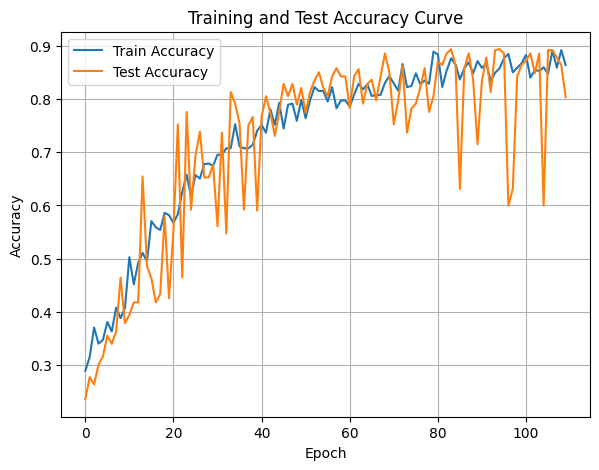

In [51]:
DTEmlp6b.train_single_model()

Randomly initializing 6 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.87it/s]

Epoch [1/10], Train F1:0.4035195265280334, Train Loss: 1.0799, Train Acc: 0.3830, Test F1:0.3534396706332606, Test Loss: 1.0825, Test Acc: 0.3880


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.99it/s]

Epoch [2/10], Train F1:0.3946694363289004, Train Loss: 1.0828, Train Acc: 0.3693, Test F1:0.3464978235061338, Test Loss: 1.0786, Test Acc: 0.3880


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.65it/s]

Epoch [3/10], Train F1:0.409065725248791, Train Loss: 1.0780, Train Acc: 0.3783, Test F1:0.32930029440903485, Test Loss: 1.0793, Test Acc: 0.3704


Epoch [4/10], Train F1:0.4339293420415838, Train Loss: 1.0728, Train Acc: 0.4068, Test F1:0.34020606851424373, Test Loss: 1.0765, Test Acc: 0.3817


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.69it/s]

Epoch [5/10], Train F1:0.43446509965142976, Train Loss: 1.0720, Train Acc: 0.4055, Test F1:0.3400154042555094, Test Loss: 1.0751, Test Acc: 0.3842
Epoch [6/10], Train F1:0.4416618573941719, Train Loss: 1.0700, Train Acc: 0.4097, Test F1:0.34109966273708964, Test Loss: 1.0725, Test Acc: 0.3848


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.16it/s]

Epoch [7/10], Train F1:0.4513647643714072, Train Loss: 1.0652, Train Acc: 0.4233, Test F1:0.34458804485716255, Test Loss: 1.0699, Test Acc: 0.3884


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.67it/s]

Epoch [8/10], Train F1:0.4615464265652588, Train Loss: 1.0604, Train Acc: 0.4333, Test F1:0.3488381308665494, Test Loss: 1.0680, Test Acc: 0.3920
Epoch [9/10], Train F1:0.465443889303426, Train Loss: 1.0581, Train Acc: 0.4380, Test F1:0.35490369542483363, Test Loss: 1.0657, Test Acc: 0.3988


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.15it/s]


Epoch [10/10], Train F1:0.47392152800386733, Train Loss: 1.0553, Train Acc: 0.4474, Test F1:0.36115357761774025, Test Loss: 1.0636, Test Acc: 0.4043
Total Epochs: 10
Train loss start: 1.1172071695327759, Train loss end: 0.9933486580848694
Highest Mean Train Accuracy (over epoch): 0.4474107142857143
Test loss start: 1.0875635147094727, Test loss end: 1.0315910577774048
Highest mean Test Accuracy (over epoch): 0.40425347222222224


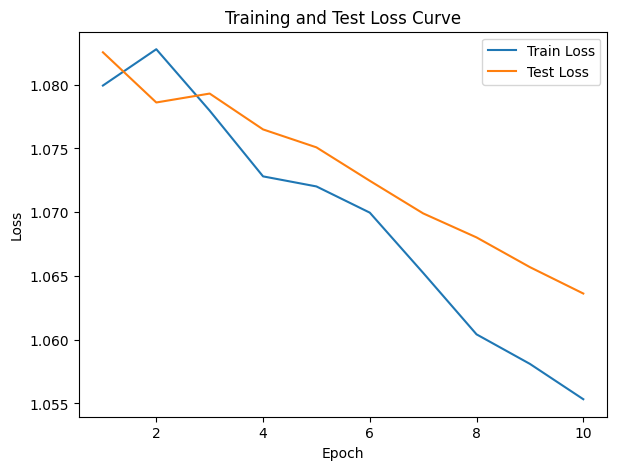

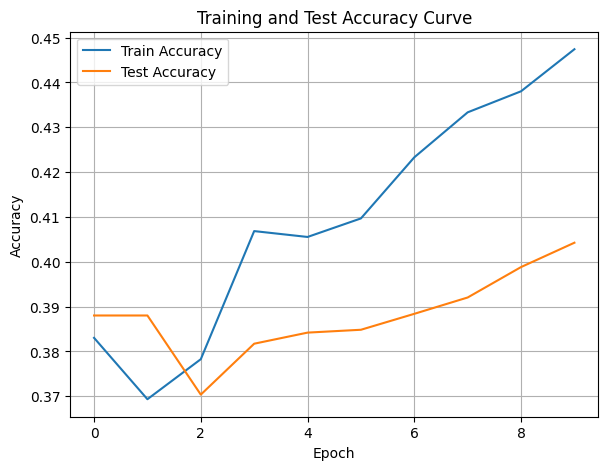

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.30186420286353655, Train Loss: 1.1030, Train Acc: 0.3533, Test F1:0.21052008295897395, Test Loss: 1.1001, Test Acc: 0.2943


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.53it/s]

Epoch [2/10], Train F1:0.31689157657307304, Train Loss: 1.0945, Train Acc: 0.3685, Test F1:0.2018841116876699, Test Loss: 1.0961, Test Acc: 0.2960


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.53it/s]

Epoch [3/10], Train F1:0.33266910643562164, Train Loss: 1.0895, Train Acc: 0.3829, Test F1:0.1973984806252391, Test Loss: 1.0947, Test Acc: 0.2940


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.47it/s]

Epoch [4/10], Train F1:0.33219127245932956, Train Loss: 1.0870, Train Acc: 0.3826, Test F1:0.1975725048960778, Test Loss: 1.0952, Test Acc: 0.2984


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.47it/s]

Epoch [5/10], Train F1:0.3480917941693705, Train Loss: 1.0808, Train Acc: 0.3981, Test F1:0.19392117867978312, Test Loss: 1.0931, Test Acc: 0.2983


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.50it/s]

Epoch [6/10], Train F1:0.36196326130041906, Train Loss: 1.0748, Train Acc: 0.4094, Test F1:0.19285631540332854, Test Loss: 1.0917, Test Acc: 0.3018


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.50it/s]

Epoch [7/10], Train F1:0.3594049177894734, Train Loss: 1.0722, Train Acc: 0.4083, Test F1:0.19640502227989406, Test Loss: 1.0905, Test Acc: 0.3054


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.41it/s]

Epoch [8/10], Train F1:0.3681546686371743, Train Loss: 1.0675, Train Acc: 0.4153, Test F1:0.1984781074132359, Test Loss: 1.0885, Test Acc: 0.3064


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.41it/s]

Epoch [9/10], Train F1:0.37393323657474603, Train Loss: 1.0631, Train Acc: 0.4204, Test F1:0.20762674412929086, Test Loss: 1.0857, Test Acc: 0.3120


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.91it/s]


Epoch [10/10], Train F1:0.382553466525907, Train Loss: 1.0605, Train Acc: 0.4250, Test F1:0.21316896287752468, Test Loss: 1.0843, Test Acc: 0.3181
Total Epochs: 10
Train loss start: 1.1055110692977905, Train loss end: 1.1344377994537354
Highest Mean Train Accuracy (over epoch): 0.4249702380952381
Test loss start: 1.1082510948181152, Test loss end: 1.0639863014221191
Highest mean Test Accuracy (over epoch): 0.31805555555555554


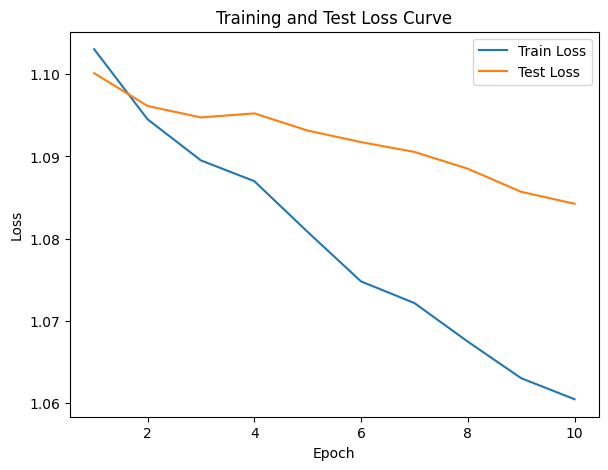

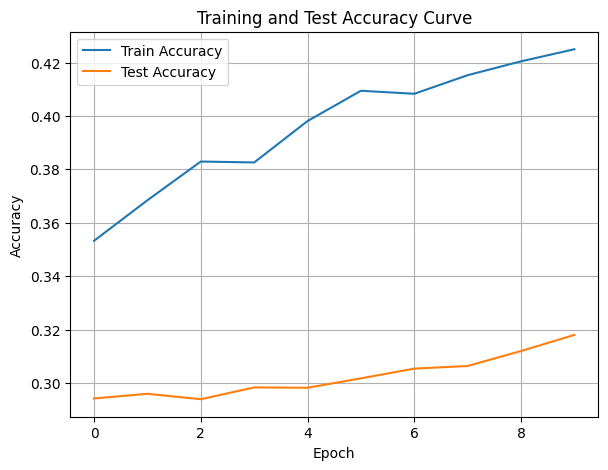

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.82it/s]

Epoch [1/10], Train F1:0.4740480232698028, Train Loss: 1.1210, Train Acc: 0.3679, Test F1:0.7480881691408006, Test Loss: 1.0472, Test Acc: 0.7214


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.43it/s]

Epoch [2/10], Train F1:0.47788388006758414, Train Loss: 1.1152, Train Acc: 0.3747, Test F1:0.7068048910154173, Test Loss: 1.0416, Test Acc: 0.7049


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.19it/s]

Epoch [3/10], Train F1:0.4863274315097689, Train Loss: 1.1098, Train Acc: 0.3882, Test F1:0.7148037346343703, Test Loss: 1.0362, Test Acc: 0.7176


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.17it/s]

Epoch [4/10], Train F1:0.49448118562654464, Train Loss: 1.1025, Train Acc: 0.3986, Test F1:0.7071834779710882, Test Loss: 1.0354, Test Acc: 0.7107


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.42it/s]

Epoch [5/10], Train F1:0.4950573661584337, Train Loss: 1.1005, Train Acc: 0.4000, Test F1:0.7109440267335005, Test Loss: 1.0366, Test Acc: 0.7097
Epoch [6/10], Train F1:0.5006750096920569, Train Loss: 1.0972, Train Acc: 0.4068, Test F1:0.7167795356768846, Test Loss: 1.0331, Test Acc: 0.7153


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.58it/s]

Epoch [7/10], Train F1:0.5053464486522167, Train Loss: 1.0941, Train Acc: 0.4134, Test F1:0.723864876916217, Test Loss: 1.0314, Test Acc: 0.7226
Epoch [8/10], Train F1:0.5165198788449614, Train Loss: 1.0891, Train Acc: 0.4224, Test F1:0.726032490916793, Test Loss: 1.0295, Test Acc: 0.7234


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.03it/s]


Epoch [9/10], Train F1:0.5239918373481105, Train Loss: 1.0844, Train Acc: 0.4298, Test F1:0.7255126918112721, Test Loss: 1.0265, Test Acc: 0.7247
Epoch [10/10], Train F1:0.5282333935051654, Train Loss: 1.0817, Train Acc: 0.4353, Test F1:0.731472067241867, Test Loss: 1.0249, Test Acc: 0.7297
Total Epochs: 10
Train loss start: 1.1694906949996948, Train loss end: 0.9802812933921814
Highest Mean Train Accuracy (over epoch): 0.43532738095238094
Test loss start: 1.0418339967727661, Test loss end: 0.9973337650299072
Highest mean Test Accuracy (over epoch): 0.7296875


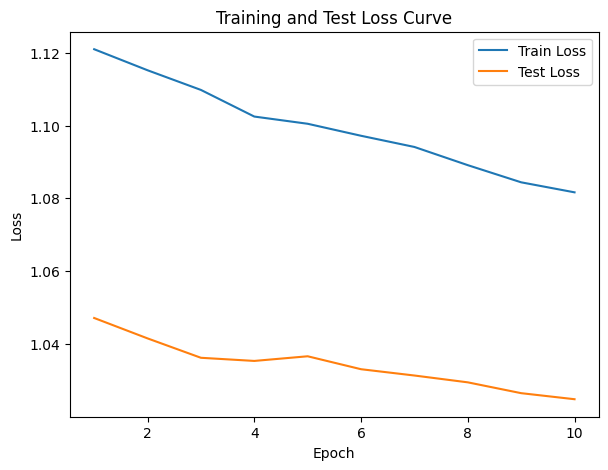

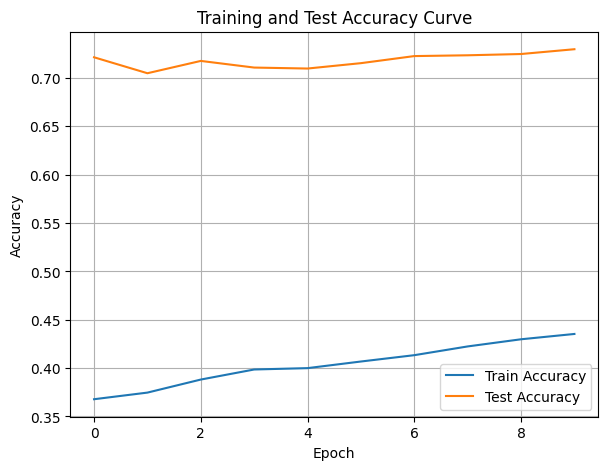

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.77it/s]

Epoch [1/10], Train F1:0.2789739136243696, Train Loss: 1.1945, Train Acc: 0.1750, Test F1:0.14035087719298245, Test Loss: 1.1592, Test Acc: 0.0825
Epoch [2/10], Train F1:0.29867238110560396, Train Loss: 1.1896, Train Acc: 0.1960, Test F1:0.11146769362430468, Test Loss: 1.1729, Test Acc: 0.0638


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.87it/s]

Epoch [3/10], Train F1:0.301882343833293, Train Loss: 1.1878, Train Acc: 0.2034, Test F1:0.12519068162208796, Test Loss: 1.1720, Test Acc: 0.0747
Epoch [4/10], Train F1:0.3066552689409378, Train Loss: 1.1845, Train Acc: 0.2065, Test F1:0.12482766760176851, Test Loss: 1.1703, Test Acc: 0.0731


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.23it/s]

Epoch [5/10], Train F1:0.30023110559798305, Train Loss: 1.1844, Train Acc: 0.2027, Test F1:0.12177938732911534, Test Loss: 1.1699, Test Acc: 0.0707
Epoch [6/10], Train F1:0.30615429351417806, Train Loss: 1.1810, Train Acc: 0.2063, Test F1:0.12444870366294715, Test Loss: 1.1691, Test Acc: 0.0736


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.71it/s]

Epoch [7/10], Train F1:0.30890706108423593, Train Loss: 1.1783, Train Acc: 0.2114, Test F1:0.13054673157056776, Test Loss: 1.1676, Test Acc: 0.0780
Epoch [8/10], Train F1:0.3171644922515821, Train Loss: 1.1754, Train Acc: 0.2185, Test F1:0.13508581154861093, Test Loss: 1.1650, Test Acc: 0.0813
Epoch [9/10], Train F1:0.3221462527654632, Train Loss: 1.1722, Train Acc: 0.2225, Test F1:0.1449061875550515, Test Loss: 1.1628, Test Acc: 0.0873


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.47it/s]


Epoch [10/10], Train F1:0.3276065139910489, Train Loss: 1.1692, Train Acc: 0.2270, Test F1:0.15286952455009212, Test Loss: 1.1608, Test Acc: 0.0921
Total Epochs: 10
Train loss start: 1.221802830696106, Train loss end: 1.1196563243865967
Highest Mean Train Accuracy (over epoch): 0.22696428571428573
Test loss start: 1.168901801109314, Test loss end: 1.1485247611999512
Highest mean Test Accuracy (over epoch): 0.09210069444444444


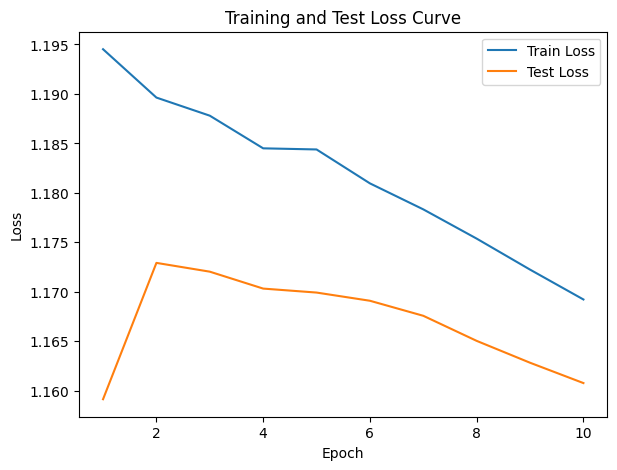

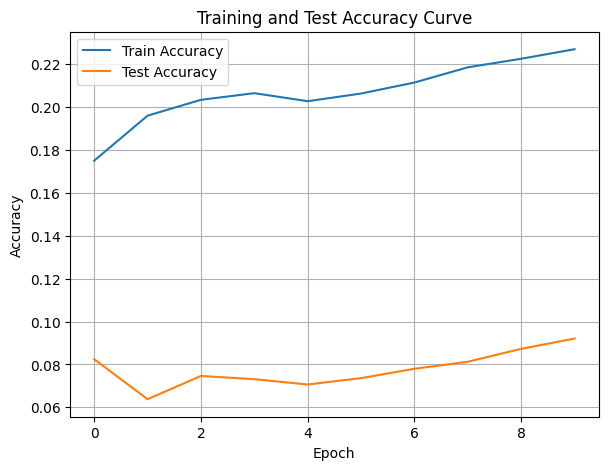

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.39640566856242754, Train Loss: 1.1154, Train Acc: 0.3304, Test F1:0.595787837893101, Test Loss: 1.0506, Test Acc: 0.6016


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.74it/s]

Epoch [2/10], Train F1:0.4094301027476377, Train Loss: 1.1081, Train Acc: 0.3461, Test F1:0.5847192252765008, Test Loss: 1.0399, Test Acc: 0.6155


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.74it/s]

Epoch [3/10], Train F1:0.4144244755465037, Train Loss: 1.1060, Train Acc: 0.3542, Test F1:0.5815771433012209, Test Loss: 1.0334, Test Acc: 0.6247


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.09it/s]

Epoch [4/10], Train F1:0.41449160997529566, Train Loss: 1.1060, Train Acc: 0.3495, Test F1:0.588154780426809, Test Loss: 1.0288, Test Acc: 0.6372


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.09it/s]

Epoch [5/10], Train F1:0.418779680453258, Train Loss: 1.1025, Train Acc: 0.3555, Test F1:0.5920631883488842, Test Loss: 1.0249, Test Acc: 0.6446


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.99it/s]

Epoch [6/10], Train F1:0.43169648226612645, Train Loss: 1.0975, Train Acc: 0.3678, Test F1:0.5982823835016119, Test Loss: 1.0212, Test Acc: 0.6545


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.99it/s]

Epoch [7/10], Train F1:0.42948088979463955, Train Loss: 1.0954, Train Acc: 0.3676, Test F1:0.6053464916489478, Test Loss: 1.0197, Test Acc: 0.6596


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.99it/s]

Epoch [8/10], Train F1:0.4389728033482528, Train Loss: 1.0922, Train Acc: 0.3790, Test F1:0.6086883202061727, Test Loss: 1.0172, Test Acc: 0.6651


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.85it/s]

Epoch [9/10], Train F1:0.4502140126972001, Train Loss: 1.0880, Train Acc: 0.3905, Test F1:0.6160665436849931, Test Loss: 1.0149, Test Acc: 0.6721


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.24it/s]


Epoch [10/10], Train F1:0.45706883833163187, Train Loss: 1.0840, Train Acc: 0.3974, Test F1:0.6225838462115504, Test Loss: 1.0126, Test Acc: 0.6790
Total Epochs: 10
Train loss start: 1.0910037755966187, Train loss end: 1.0123319625854492
Highest Mean Train Accuracy (over epoch): 0.3974404761904762
Test loss start: 1.0476408004760742, Test loss end: 0.9950307011604309
Highest mean Test Accuracy (over epoch): 0.6789930555555556


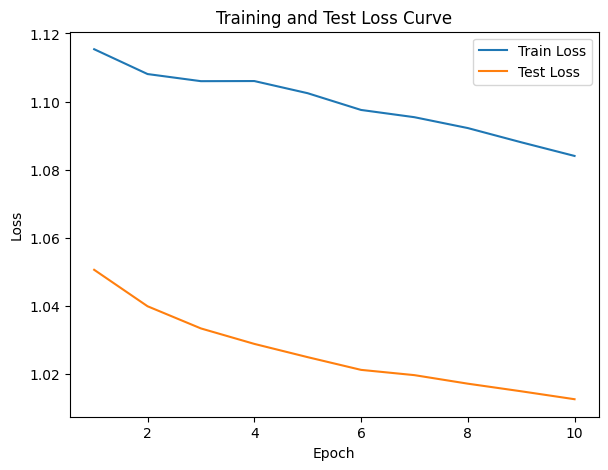

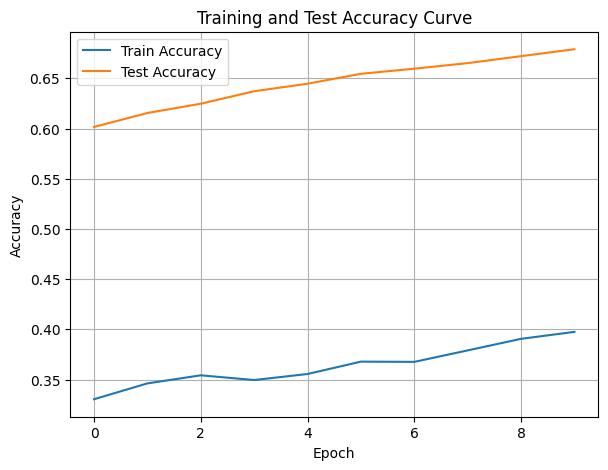

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.01it/s]

Epoch [1/10], Train F1:0.4022425415789657, Train Loss: 1.1030, Train Acc: 0.3634, Test F1:0.22687787429739395, Test Loss: 1.1218, Test Acc: 0.1649


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.11it/s]

Epoch [2/10], Train F1:0.39962312197606314, Train Loss: 1.1077, Train Acc: 0.3579, Test F1:0.23349022963913849, Test Loss: 1.1226, Test Acc: 0.1610


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.59it/s]

Epoch [3/10], Train F1:0.40043043751577767, Train Loss: 1.1045, Train Acc: 0.3548, Test F1:0.23632117837255248, Test Loss: 1.1236, Test Acc: 0.1597


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.59it/s]

Epoch [4/10], Train F1:0.40501172030583793, Train Loss: 1.1031, Train Acc: 0.3554, Test F1:0.22967942905533273, Test Loss: 1.1259, Test Acc: 0.1497


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.36it/s]

Epoch [5/10], Train F1:0.42280280629277933, Train Loss: 1.0979, Train Acc: 0.3679, Test F1:0.22750620758109202, Test Loss: 1.1258, Test Acc: 0.1481


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.36it/s]

Epoch [6/10], Train F1:0.43568947657508544, Train Loss: 1.0942, Train Acc: 0.3827, Test F1:0.23745767928593411, Test Loss: 1.1233, Test Acc: 0.1558


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.83it/s]

Epoch [7/10], Train F1:0.440937820477063, Train Loss: 1.0923, Train Acc: 0.3924, Test F1:0.2547555797331399, Test Loss: 1.1196, Test Acc: 0.1689


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.18it/s]

Epoch [8/10], Train F1:0.44631642370143637, Train Loss: 1.0892, Train Acc: 0.4005, Test F1:0.2710367096268708, Test Loss: 1.1159, Test Acc: 0.1816


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.18it/s]

Epoch [9/10], Train F1:0.4514955953060541, Train Loss: 1.0855, Train Acc: 0.4062, Test F1:0.30146801560630254, Test Loss: 1.1115, Test Acc: 0.2070


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.30it/s]


Epoch [10/10], Train F1:0.45653657185576846, Train Loss: 1.0835, Train Acc: 0.4117, Test F1:0.30881600260221287, Test Loss: 1.1095, Test Acc: 0.2128
Total Epochs: 10
Train loss start: 1.1020333766937256, Train loss end: 1.172940969467163
Highest Mean Train Accuracy (over epoch): 0.4116964285714285
Test loss start: 1.1135414838790894, Test loss end: 1.0843340158462524
Highest mean Test Accuracy (over epoch): 0.2127604166666667


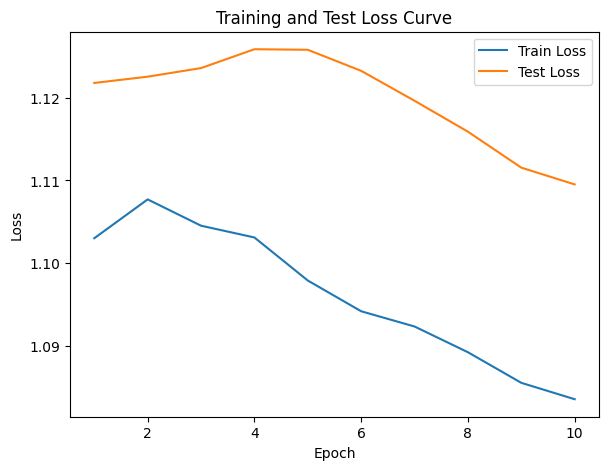

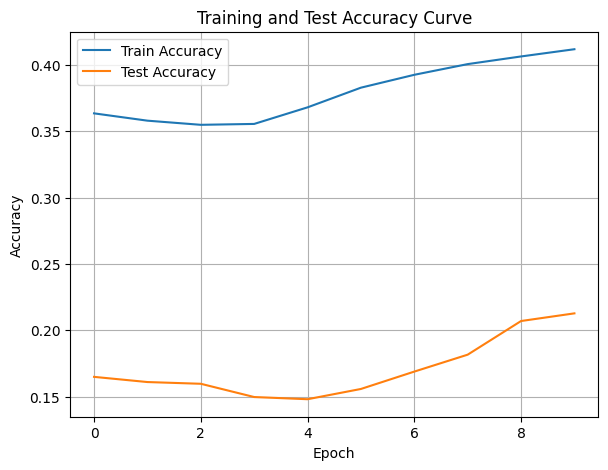

./saved_models/model_6.pth
Training Model with id 11
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.26it/s]

Epoch [1/10], Train F1:0.5301102613602614, Train Loss: 1.0562, Train Acc: 0.4878, Test F1:0.37573546506429173, Test Loss: 1.0913, Test Acc: 0.2708
Epoch [2/10], Train F1:0.49687142349125046, Train Loss: 1.0571, Train Acc: 0.4612, Test F1:0.36235032024505703, Test Loss: 1.0921, Test Acc: 0.2552


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.49it/s]

Epoch [3/10], Train F1:0.5349498128282728, Train Loss: 1.0434, Train Acc: 0.4982, Test F1:0.38709299740761927, Test Loss: 1.0890, Test Acc: 0.2812
Epoch [4/10], Train F1:0.5480198159411163, Train Loss: 1.0351, Train Acc: 0.5216, Test F1:0.44684202026187686, Test Loss: 1.0830, Test Acc: 0.3531


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.71it/s]

Epoch [5/10], Train F1:0.554235498741621, Train Loss: 1.0330, Train Acc: 0.5296, Test F1:0.4565745180699388, Test Loss: 1.0814, Test Acc: 0.3628
Epoch [6/10], Train F1:0.5625766150158444, Train Loss: 1.0305, Train Acc: 0.5379, Test F1:0.4829335788633856, Test Loss: 1.0780, Test Acc: 0.3971


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.31it/s]

Epoch [7/10], Train F1:0.5668309256880686, Train Loss: 1.0261, Train Acc: 0.5469, Test F1:0.5091975143758781, Test Loss: 1.0731, Test Acc: 0.4356
Epoch [8/10], Train F1:0.573013996225082, Train Loss: 1.0238, Train Acc: 0.5534, Test F1:0.5224329174491686, Test Loss: 1.0700, Test Acc: 0.4562


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.98it/s]


Epoch [9/10], Train F1:0.5743869469139845, Train Loss: 1.0213, Train Acc: 0.5536, Test F1:0.536672253777517, Test Loss: 1.0680, Test Acc: 0.4737
Epoch [10/10], Train F1:0.5781156677478654, Train Loss: 1.0187, Train Acc: 0.5574, Test F1:0.5481876517908083, Test Loss: 1.0649, Test Acc: 0.4930
Total Epochs: 10
Train loss start: 1.0596153736114502, Train loss end: 1.0908401012420654
Highest Mean Train Accuracy (over epoch): 0.5573511904761904
Test loss start: 1.081952452659607, Test loss end: 1.025894284248352
Highest mean Test Accuracy (over epoch): 0.49296875


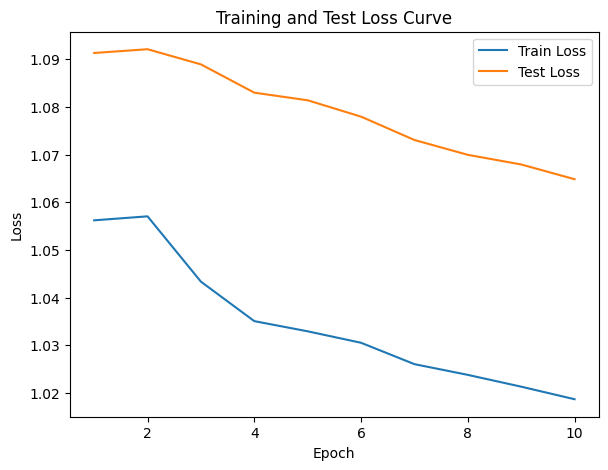

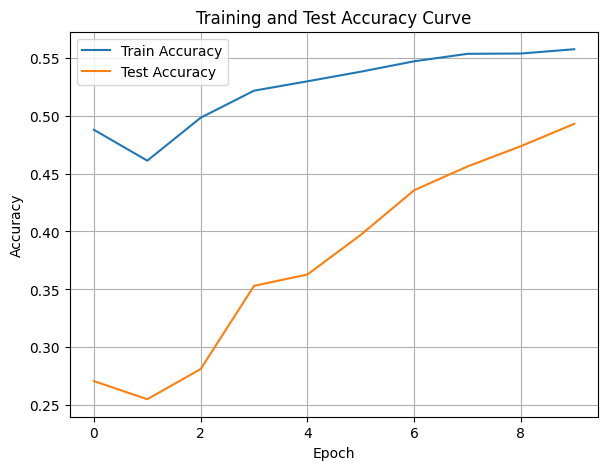

./saved_models/model_11.pth
Training Model with id 9
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.6799430395606141, Train Loss: 0.9686, Train Acc: 0.6863, Test F1:0.6676708677865416, Test Loss: 1.0312, Test Acc: 0.7040


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.37it/s]

Epoch [2/10], Train F1:0.6721471670975657, Train Loss: 0.9711, Train Acc: 0.6673, Test F1:0.6627478459462267, Test Loss: 1.0299, Test Acc: 0.7001
Epoch [3/10], Train F1:0.6642437576473403, Train Loss: 0.9681, Train Acc: 0.6628, Test F1:0.6552618348283983, Test Loss: 1.0286, Test Acc: 0.6962


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.98it/s]

Epoch [4/10], Train F1:0.6702340480860802, Train Loss: 0.9644, Train Acc: 0.6710, Test F1:0.6601470943078116, Test Loss: 1.0249, Test Acc: 0.7020
Epoch [5/10], Train F1:0.6683637086414823, Train Loss: 0.9633, Train Acc: 0.6696, Test F1:0.6673511175937268, Test Loss: 1.0228, Test Acc: 0.7083


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.71it/s]

Epoch [6/10], Train F1:0.6703456996655508, Train Loss: 0.9604, Train Acc: 0.6717, Test F1:0.6728595036340314, Test Loss: 1.0200, Test Acc: 0.7138
Epoch [7/10], Train F1:0.6736433556177119, Train Loss: 0.9576, Train Acc: 0.6755, Test F1:0.675631376382341, Test Loss: 1.0189, Test Acc: 0.7166


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.60it/s]

Epoch [8/10], Train F1:0.6771422083422964, Train Loss: 0.9547, Train Acc: 0.6796, Test F1:0.6755049923018062, Test Loss: 1.0167, Test Acc: 0.7188
Epoch [9/10], Train F1:0.6811323041545395, Train Loss: 0.9506, Train Acc: 0.6834, Test F1:0.6767027098360071, Test Loss: 1.0138, Test Acc: 0.7219


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.78it/s]


Epoch [10/10], Train F1:0.6872346003507113, Train Loss: 0.9475, Train Acc: 0.6899, Test F1:0.6806009407700133, Test Loss: 1.0107, Test Acc: 0.7266
Total Epochs: 10
Train loss start: 0.9932248592376709, Train loss end: 0.8952046632766724
Highest Mean Train Accuracy (over epoch): 0.6898511904761906
Test loss start: 1.0208191871643066, Test loss end: 0.9745029807090759
Highest mean Test Accuracy (over epoch): 0.7266493055555555


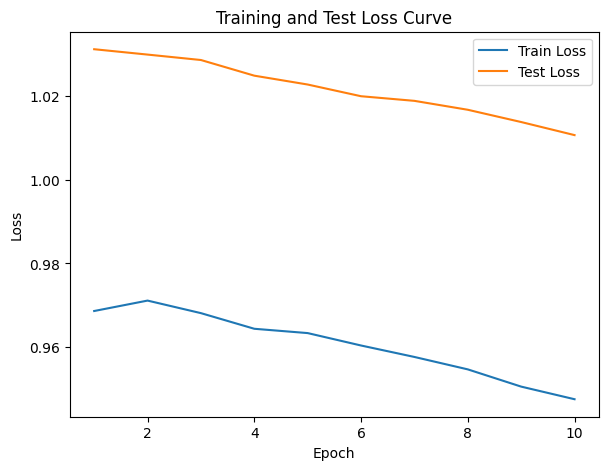

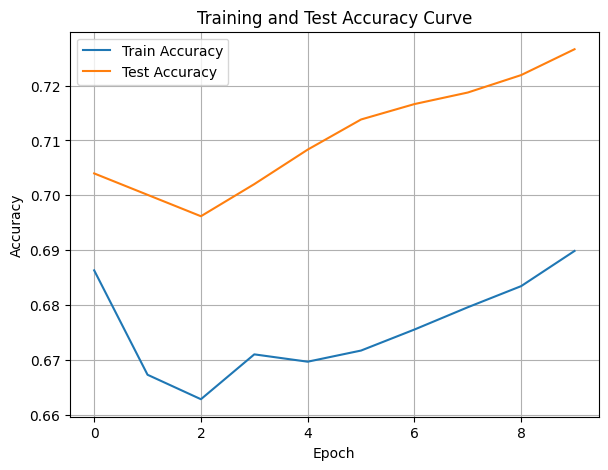

./saved_models/model_9.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.38it/s]

Epoch [1/10], Train F1:0.709873052684802, Train Loss: 0.9138, Train Acc: 0.7280, Test F1:0.7296279811579689, Test Loss: 0.9877, Test Acc: 0.7708


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.97it/s]

Epoch [2/10], Train F1:0.7167073701606199, Train Loss: 0.9085, Train Acc: 0.7315, Test F1:0.7270053747084474, Test Loss: 0.9798, Test Acc: 0.7739
Epoch [3/10], Train F1:0.723843434202601, Train Loss: 0.9057, Train Acc: 0.7337, Test F1:0.7261033017325924, Test Loss: 0.9796, Test Acc: 0.7749


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.97it/s]

Epoch [4/10], Train F1:0.7256541621427475, Train Loss: 0.9054, Train Acc: 0.7367, Test F1:0.7248528771670317, Test Loss: 0.9761, Test Acc: 0.7754


Training Process:  50%|█████     | 5/10 [00:00<00:00, 11.39it/s]

Epoch [5/10], Train F1:0.7324950905492937, Train Loss: 0.9013, Train Acc: 0.7441, Test F1:0.7267074475602123, Test Loss: 0.9730, Test Acc: 0.7773


Training Process:  50%|█████     | 5/10 [00:00<00:00, 11.39it/s]

Epoch [6/10], Train F1:0.7336175475908463, Train Loss: 0.9005, Train Acc: 0.7440, Test F1:0.7266771064740463, Test Loss: 0.9687, Test Acc: 0.7762


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.00it/s]

Epoch [7/10], Train F1:0.7318709317685798, Train Loss: 0.8987, Train Acc: 0.7444, Test F1:0.7295770289922338, Test Loss: 0.9660, Test Acc: 0.7785


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.00it/s]

Epoch [8/10], Train F1:0.732168010089795, Train Loss: 0.8960, Train Acc: 0.7451, Test F1:0.7317433856586412, Test Loss: 0.9635, Test Acc: 0.7803


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.73it/s]

Epoch [9/10], Train F1:0.7360894713588556, Train Loss: 0.8935, Train Acc: 0.7480, Test F1:0.7334232810578972, Test Loss: 0.9608, Test Acc: 0.7816


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.06it/s]


Epoch [10/10], Train F1:0.7390071758650992, Train Loss: 0.8906, Train Acc: 0.7502, Test F1:0.7334870242377534, Test Loss: 0.9587, Test Acc: 0.7819
Total Epochs: 10
Train loss start: 0.9131149053573608, Train loss end: 0.8834918141365051
Highest Mean Train Accuracy (over epoch): 0.7502380952380953
Test loss start: 0.9740303754806519, Test loss end: 0.9257326126098633
Highest mean Test Accuracy (over epoch): 0.7819444444444444


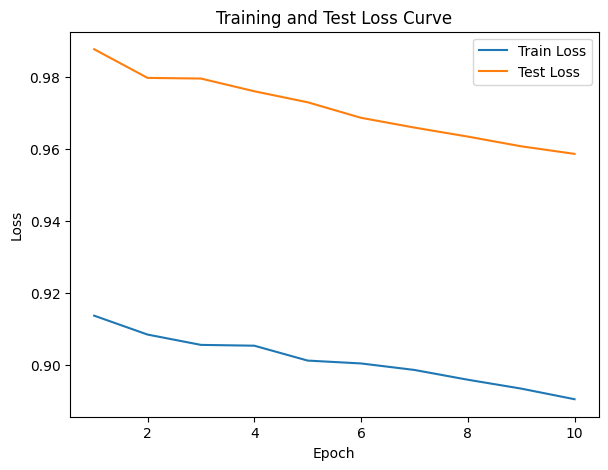

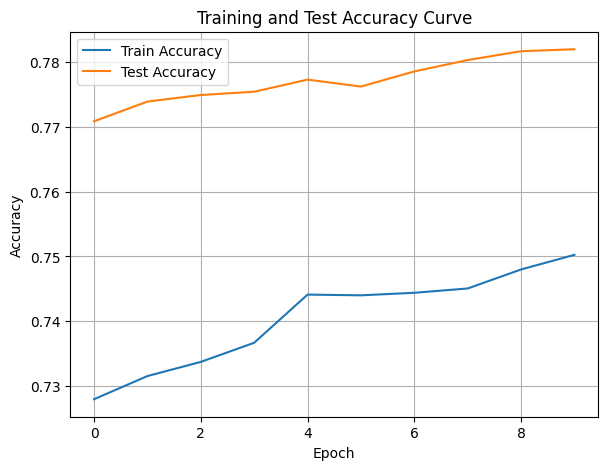

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7663893064482686, Train Loss: 0.8734, Train Acc: 0.7693, Test F1:0.7340637673366045, Test Loss: 0.9382, Test Acc: 0.7847


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.75it/s]

Epoch [2/10], Train F1:0.7713719204280903, Train Loss: 0.8619, Train Acc: 0.7836, Test F1:0.7467064929796905, Test Loss: 0.9335, Test Acc: 0.7925


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.22it/s]

Epoch [3/10], Train F1:0.7875077889319246, Train Loss: 0.8580, Train Acc: 0.7977, Test F1:0.7564260798489012, Test Loss: 0.9290, Test Acc: 0.7957


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.22it/s]

Epoch [4/10], Train F1:0.787506839757329, Train Loss: 0.8583, Train Acc: 0.7937, Test F1:0.7601154774239193, Test Loss: 0.9232, Test Acc: 0.7988


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.80it/s]

Epoch [5/10], Train F1:0.7855327019090084, Train Loss: 0.8573, Train Acc: 0.7939, Test F1:0.762323094598795, Test Loss: 0.9211, Test Acc: 0.8007


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.68it/s]

Epoch [6/10], Train F1:0.7846823621452405, Train Loss: 0.8541, Train Acc: 0.7932, Test F1:0.7617813421640309, Test Loss: 0.9199, Test Acc: 0.8006


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.42it/s]

Epoch [7/10], Train F1:0.7860387429316419, Train Loss: 0.8516, Train Acc: 0.7952, Test F1:0.7602658160552898, Test Loss: 0.9190, Test Acc: 0.7986


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.68it/s]

Epoch [8/10], Train F1:0.7874887538172366, Train Loss: 0.8478, Train Acc: 0.7969, Test F1:0.7631327909793455, Test Loss: 0.9173, Test Acc: 0.8008


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.97it/s]

Epoch [9/10], Train F1:0.7890029846200114, Train Loss: 0.8455, Train Acc: 0.7979, Test F1:0.7640209392477486, Test Loss: 0.9152, Test Acc: 0.8016


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.15it/s]


Epoch [10/10], Train F1:0.7899688877641612, Train Loss: 0.8436, Train Acc: 0.7983, Test F1:0.7647311150061543, Test Loss: 0.9136, Test Acc: 0.8023
Total Epochs: 10
Train loss start: 0.8352488279342651, Train loss end: 0.8044728636741638
Highest Mean Train Accuracy (over epoch): 0.7983035714285714
Test loss start: 0.9215400218963623, Test loss end: 0.8812209367752075
Highest mean Test Accuracy (over epoch): 0.8022569444444445


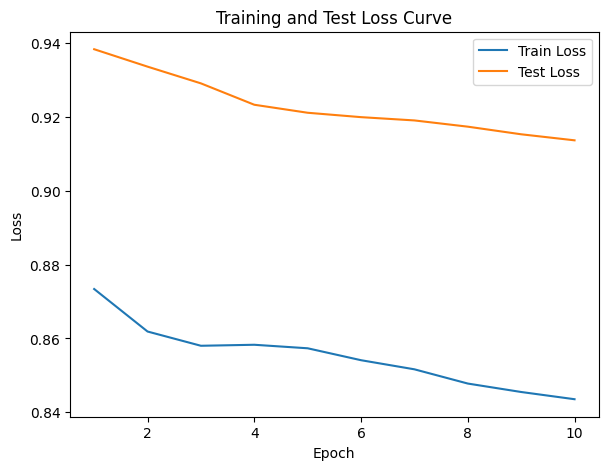

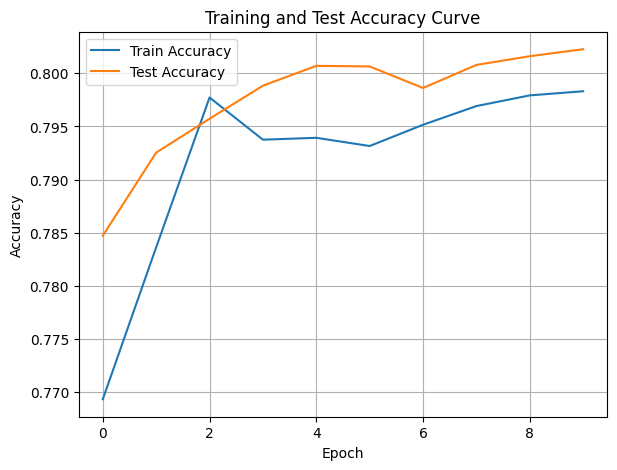

./saved_models/model_10.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7939861224015355, Train Loss: 0.8277, Train Acc: 0.7943, Test F1:0.7829045229707128, Test Loss: 0.8888, Test Acc: 0.8160


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.66it/s]

Epoch [2/10], Train F1:0.7945367031081317, Train Loss: 0.8268, Train Acc: 0.7933, Test F1:0.7770388613379681, Test Loss: 0.8858, Test Acc: 0.8121


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.18it/s]

Epoch [3/10], Train F1:0.7932695349383551, Train Loss: 0.8195, Train Acc: 0.7940, Test F1:0.7790011095519304, Test Loss: 0.8867, Test Acc: 0.8134


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.60it/s]

Epoch [4/10], Train F1:0.7920569062937698, Train Loss: 0.8183, Train Acc: 0.7976, Test F1:0.7866832296492826, Test Loss: 0.8864, Test Acc: 0.8164


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.79it/s]

Epoch [5/10], Train F1:0.7996950858234451, Train Loss: 0.8135, Train Acc: 0.8073, Test F1:0.7843181069864802, Test Loss: 0.8859, Test Acc: 0.8135


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.71it/s]

Epoch [6/10], Train F1:0.8018065351006893, Train Loss: 0.8114, Train Acc: 0.8088, Test F1:0.7802197044674555, Test Loss: 0.8852, Test Acc: 0.8113


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.87it/s]

Epoch [7/10], Train F1:0.802580755730901, Train Loss: 0.8084, Train Acc: 0.8106, Test F1:0.779454181476931, Test Loss: 0.8821, Test Acc: 0.8100


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.11it/s]

Epoch [8/10], Train F1:0.807409175857533, Train Loss: 0.8046, Train Acc: 0.8149, Test F1:0.7784281951726801, Test Loss: 0.8807, Test Acc: 0.8098


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.20it/s]

Epoch [9/10], Train F1:0.8119739390035178, Train Loss: 0.8023, Train Acc: 0.8191, Test F1:0.778924825953217, Test Loss: 0.8795, Test Acc: 0.8105


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.68it/s]


Epoch [10/10], Train F1:0.8129345449453744, Train Loss: 0.8005, Train Acc: 0.8195, Test F1:0.779322262890113, Test Loss: 0.8768, Test Acc: 0.8110
Total Epochs: 10
Train loss start: 0.7785991430282593, Train loss end: 0.7877843976020813
Highest Mean Train Accuracy (over epoch): 0.8194642857142855
Test loss start: 0.8729318380355835, Test loss end: 0.8345195055007935
Highest mean Test Accuracy (over epoch): 0.81640625


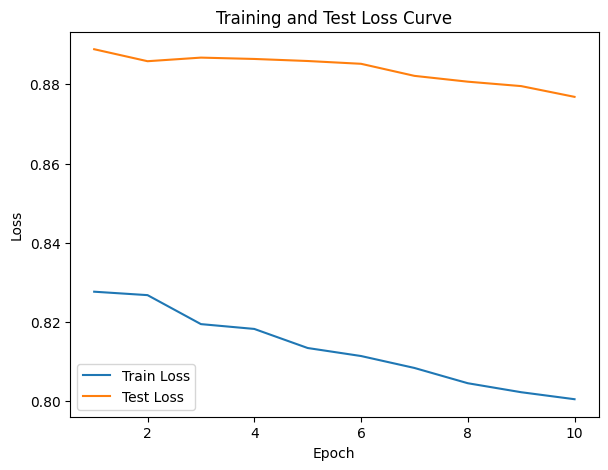

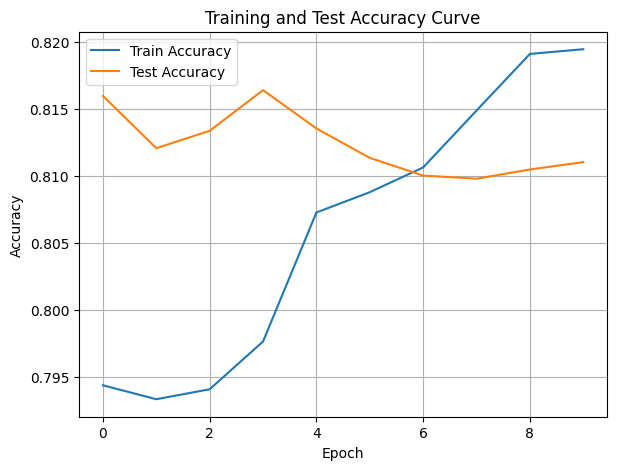

./saved_models/model_8.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [52]:
DTEmlp6b.train_DTE()

Training Process:   1%|          | 1/110 [00:00<00:13,  7.99it/s]

Epoch [1/110], Train F1:0.406089756241732, Train Loss: 1.1057, Train Acc: 0.3661, Test F1:0.2935129502005407, Test Loss: 1.1109, Test Acc: 0.2569


Training Process:   1%|          | 1/110 [00:00<00:13,  7.99it/s]

Epoch [2/110], Train F1:0.4058382768040056, Train Loss: 1.1076, Train Acc: 0.3613, Test F1:0.27058452259896915, Test Loss: 1.1047, Test Acc: 0.2617


Training Process:   3%|▎         | 3/110 [00:00<00:11,  9.50it/s]

Epoch [3/110], Train F1:0.4025465047419109, Train Loss: 1.1081, Train Acc: 0.3608, Test F1:0.30139906127654653, Test Loss: 1.0972, Test Acc: 0.2908


Training Process:   3%|▎         | 3/110 [00:00<00:11,  9.50it/s]

Epoch [4/110], Train F1:0.4220568183281521, Train Loss: 1.1020, Train Acc: 0.3804, Test F1:0.3758690810134038, Test Loss: 1.0891, Test Acc: 0.3459


Training Process:   5%|▍         | 5/110 [00:00<00:10,  9.96it/s]

Epoch [5/110], Train F1:0.4232825435694764, Train Loss: 1.0983, Train Acc: 0.3867, Test F1:0.4185589534389359, Test Loss: 1.0867, Test Acc: 0.3790


Training Process:   5%|▌         | 6/110 [00:00<00:10,  9.75it/s]

Epoch [6/110], Train F1:0.43475234986856964, Train Loss: 1.0931, Train Acc: 0.3966, Test F1:0.46829846856949625, Test Loss: 1.0816, Test Acc: 0.4206


Training Process:   6%|▋         | 7/110 [00:00<00:10,  9.76it/s]

Epoch [7/110], Train F1:0.4442454037609108, Train Loss: 1.0885, Train Acc: 0.4070, Test F1:0.503188215202243, Test Loss: 1.0756, Test Acc: 0.4560


Training Process:   7%|▋         | 8/110 [00:00<00:10,  9.82it/s]

Epoch [8/110], Train F1:0.4604366541706049, Train Loss: 1.0813, Train Acc: 0.4243, Test F1:0.5330377949463516, Test Loss: 1.0700, Test Acc: 0.4882


Training Process:   8%|▊         | 9/110 [00:00<00:10,  9.60it/s]

Epoch [9/110], Train F1:0.46949890643197184, Train Loss: 1.0774, Train Acc: 0.4329, Test F1:0.5558177051824964, Test Loss: 1.0663, Test Acc: 0.5119


Training Process:   9%|▉         | 10/110 [00:01<00:11,  8.38it/s]

Epoch [10/110], Train F1:0.4782591030610741, Train Loss: 1.0736, Train Acc: 0.4431, Test F1:0.5642478288745119, Test Loss: 1.0646, Test Acc: 0.5214


Training Process:  11%|█         | 12/110 [00:01<00:13,  7.25it/s]

Epoch [11/110], Train F1:0.48393333359887253, Train Loss: 1.0710, Train Acc: 0.4497, Test F1:0.5798763433964158, Test Loss: 1.0611, Test Acc: 0.5396
Epoch [12/110], Train F1:0.48960873950038014, Train Loss: 1.0675, Train Acc: 0.4554, Test F1:0.5913709285163197, Test Loss: 1.0586, Test Acc: 0.5523


Training Process:  13%|█▎        | 14/110 [00:01<00:13,  7.08it/s]

Epoch [13/110], Train F1:0.5001731820395056, Train Loss: 1.0632, Train Acc: 0.4664, Test F1:0.602988477091315, Test Loss: 1.0566, Test Acc: 0.5648
Epoch [14/110], Train F1:0.5089064537537356, Train Loss: 1.0593, Train Acc: 0.4739, Test F1:0.614480422151146, Test Loss: 1.0528, Test Acc: 0.5782


Training Process:  15%|█▍        | 16/110 [00:01<00:13,  7.22it/s]

Epoch [15/110], Train F1:0.517152740455538, Train Loss: 1.0546, Train Acc: 0.4824, Test F1:0.6249735795651815, Test Loss: 1.0498, Test Acc: 0.5904
Epoch [16/110], Train F1:0.5244323273745821, Train Loss: 1.0505, Train Acc: 0.4903, Test F1:0.633969592231775, Test Loss: 1.0463, Test Acc: 0.6014


Training Process:  16%|█▋        | 18/110 [00:02<00:12,  7.32it/s]

Epoch [17/110], Train F1:0.5301946477446412, Train Loss: 1.0463, Train Acc: 0.4973, Test F1:0.641530578970943, Test Loss: 1.0445, Test Acc: 0.6098
Epoch [18/110], Train F1:0.5355615003864319, Train Loss: 1.0426, Train Acc: 0.5037, Test F1:0.6508411301612745, Test Loss: 1.0415, Test Acc: 0.6203


Training Process:  18%|█▊        | 20/110 [00:02<00:14,  6.40it/s]

Epoch [19/110], Train F1:0.5419402509279254, Train Loss: 1.0390, Train Acc: 0.5109, Test F1:0.6598202803278987, Test Loss: 1.0388, Test Acc: 0.6311
Epoch [20/110], Train F1:0.5501913387284182, Train Loss: 1.0345, Train Acc: 0.5194, Test F1:0.6659965418619576, Test Loss: 1.0361, Test Acc: 0.6383


Training Process:  20%|██        | 22/110 [00:02<00:13,  6.43it/s]

Epoch [21/110], Train F1:0.557008558753956, Train Loss: 1.0303, Train Acc: 0.5269, Test F1:0.6725272588368917, Test Loss: 1.0329, Test Acc: 0.6456
Epoch [22/110], Train F1:0.5642072287512644, Train Loss: 1.0260, Train Acc: 0.5346, Test F1:0.6794700282001186, Test Loss: 1.0304, Test Acc: 0.6533


Training Process:  22%|██▏       | 24/110 [00:03<00:13,  6.60it/s]

Epoch [23/110], Train F1:0.569782794070011, Train Loss: 1.0223, Train Acc: 0.5408, Test F1:0.6844995444179347, Test Loss: 1.0274, Test Acc: 0.6589
Epoch [24/110], Train F1:0.5760477479672834, Train Loss: 1.0181, Train Acc: 0.5480, Test F1:0.6893481374086063, Test Loss: 1.0244, Test Acc: 0.6647


Training Process:  24%|██▎       | 26/110 [00:03<00:12,  6.89it/s]

Epoch [25/110], Train F1:0.5823498920273935, Train Loss: 1.0144, Train Acc: 0.5546, Test F1:0.6934021141814917, Test Loss: 1.0212, Test Acc: 0.6700
Epoch [26/110], Train F1:0.5885378167234067, Train Loss: 1.0104, Train Acc: 0.5614, Test F1:0.6981348220172748, Test Loss: 1.0180, Test Acc: 0.6755


Training Process:  25%|██▌       | 28/110 [00:03<00:12,  6.83it/s]

Epoch [27/110], Train F1:0.5940642602987282, Train Loss: 1.0065, Train Acc: 0.5680, Test F1:0.70268509746415, Test Loss: 1.0152, Test Acc: 0.6807
Epoch [28/110], Train F1:0.5986934073959183, Train Loss: 1.0029, Train Acc: 0.5735, Test F1:0.7070708514313453, Test Loss: 1.0124, Test Acc: 0.6861


Training Process:  27%|██▋       | 30/110 [00:04<00:12,  6.45it/s]

Epoch [29/110], Train F1:0.6038742483156719, Train Loss: 0.9995, Train Acc: 0.5790, Test F1:0.7103737228933686, Test Loss: 1.0096, Test Acc: 0.6902
Epoch [30/110], Train F1:0.6101630115304624, Train Loss: 0.9955, Train Acc: 0.5860, Test F1:0.7133074290918129, Test Loss: 1.0068, Test Acc: 0.6936


Training Process:  29%|██▉       | 32/110 [00:04<00:11,  6.59it/s]

Epoch [31/110], Train F1:0.6148722773854911, Train Loss: 0.9921, Train Acc: 0.5913, Test F1:0.7172606645275104, Test Loss: 1.0045, Test Acc: 0.6984
Epoch [32/110], Train F1:0.6191924419283162, Train Loss: 0.9884, Train Acc: 0.5964, Test F1:0.720564649365355, Test Loss: 1.0021, Test Acc: 0.7026


Training Process:  31%|███       | 34/110 [00:04<00:11,  6.54it/s]

Epoch [33/110], Train F1:0.6243995912806942, Train Loss: 0.9847, Train Acc: 0.6018, Test F1:0.7237515690344635, Test Loss: 0.9996, Test Acc: 0.7065
Epoch [34/110], Train F1:0.6298237301736066, Train Loss: 0.9805, Train Acc: 0.6080, Test F1:0.7276564522648244, Test Loss: 0.9976, Test Acc: 0.7110


Training Process:  33%|███▎      | 36/110 [00:05<00:11,  6.54it/s]

Epoch [35/110], Train F1:0.6339074005680436, Train Loss: 0.9772, Train Acc: 0.6130, Test F1:0.7309818312906686, Test Loss: 0.9950, Test Acc: 0.7149
Epoch [36/110], Train F1:0.6386530295767416, Train Loss: 0.9738, Train Acc: 0.6186, Test F1:0.7337760641360003, Test Loss: 0.9925, Test Acc: 0.7182


Training Process:  34%|███▎      | 37/110 [00:05<00:11,  6.44it/s]

Epoch [37/110], Train F1:0.6430803649951368, Train Loss: 0.9703, Train Acc: 0.6237, Test F1:0.736281035023522, Test Loss: 0.9898, Test Acc: 0.7216


Training Process:  35%|███▍      | 38/110 [00:05<00:12,  5.62it/s]

Epoch [38/110], Train F1:0.6469429195502364, Train Loss: 0.9673, Train Acc: 0.6279, Test F1:0.7394651480270079, Test Loss: 0.9871, Test Acc: 0.7255


Training Process:  36%|███▋      | 40/110 [00:05<00:12,  5.52it/s]

Epoch [39/110], Train F1:0.6512052526166531, Train Loss: 0.9639, Train Acc: 0.6327, Test F1:0.7426213070125649, Test Loss: 0.9845, Test Acc: 0.7291
Epoch [40/110], Train F1:0.6548144388746534, Train Loss: 0.9610, Train Acc: 0.6368, Test F1:0.7455485437820392, Test Loss: 0.9823, Test Acc: 0.7324


Training Process:  37%|███▋      | 41/110 [00:05<00:12,  5.43it/s]

Epoch [41/110], Train F1:0.6589616675427511, Train Loss: 0.9579, Train Acc: 0.6410, Test F1:0.7480273155050106, Test Loss: 0.9798, Test Acc: 0.7356


Training Process:  38%|███▊      | 42/110 [00:06<00:12,  5.36it/s]

Epoch [42/110], Train F1:0.6627249379734428, Train Loss: 0.9545, Train Acc: 0.6451, Test F1:0.7503890057443987, Test Loss: 0.9773, Test Acc: 0.7387


Training Process:  39%|███▉      | 43/110 [00:06<00:13,  4.89it/s]

Epoch [43/110], Train F1:0.6664841258633608, Train Loss: 0.9518, Train Acc: 0.6492, Test F1:0.7527488389938956, Test Loss: 0.9752, Test Acc: 0.7413


Training Process:  40%|████      | 44/110 [00:06<00:14,  4.67it/s]

Epoch [44/110], Train F1:0.6699878447158019, Train Loss: 0.9492, Train Acc: 0.6528, Test F1:0.7550018320116048, Test Loss: 0.9729, Test Acc: 0.7439


Training Process:  41%|████      | 45/110 [00:06<00:13,  4.67it/s]

Epoch [45/110], Train F1:0.6735848901644444, Train Loss: 0.9464, Train Acc: 0.6564, Test F1:0.757053758666679, Test Loss: 0.9707, Test Acc: 0.7465


Training Process:  42%|████▏     | 46/110 [00:07<00:13,  4.63it/s]

Epoch [46/110], Train F1:0.6773176504487132, Train Loss: 0.9434, Train Acc: 0.6606, Test F1:0.7590669256155731, Test Loss: 0.9685, Test Acc: 0.7489


Training Process:  43%|████▎     | 47/110 [00:07<00:13,  4.52it/s]

Epoch [47/110], Train F1:0.6803849953159425, Train Loss: 0.9406, Train Acc: 0.6640, Test F1:0.7612137304542754, Test Loss: 0.9662, Test Acc: 0.7514


Training Process:  44%|████▎     | 48/110 [00:07<00:13,  4.62it/s]

Epoch [48/110], Train F1:0.6836850388841932, Train Loss: 0.9380, Train Acc: 0.6675, Test F1:0.7632245218056564, Test Loss: 0.9638, Test Acc: 0.7539


Training Process:  45%|████▍     | 49/110 [00:07<00:12,  4.81it/s]

Epoch [49/110], Train F1:0.6870953852514116, Train Loss: 0.9353, Train Acc: 0.6709, Test F1:0.7652921297932999, Test Loss: 0.9617, Test Acc: 0.7561


Training Process:  45%|████▌     | 50/110 [00:07<00:12,  4.94it/s]

Epoch [50/110], Train F1:0.6902018295348403, Train Loss: 0.9327, Train Acc: 0.6741, Test F1:0.767392332654744, Test Loss: 0.9598, Test Acc: 0.7585


Training Process:  46%|████▋     | 51/110 [00:08<00:11,  5.01it/s]

Epoch [51/110], Train F1:0.6936062245604127, Train Loss: 0.9299, Train Acc: 0.6777, Test F1:0.7692094501856842, Test Loss: 0.9577, Test Acc: 0.7605


Training Process:  47%|████▋     | 52/110 [00:08<00:11,  5.09it/s]

Epoch [52/110], Train F1:0.6968649581215394, Train Loss: 0.9271, Train Acc: 0.6814, Test F1:0.7707599302367512, Test Loss: 0.9558, Test Acc: 0.7624


Training Process:  48%|████▊     | 53/110 [00:08<00:11,  5.16it/s]

Epoch [53/110], Train F1:0.699713630213057, Train Loss: 0.9244, Train Acc: 0.6846, Test F1:0.7722105210878845, Test Loss: 0.9538, Test Acc: 0.7643


Training Process:  49%|████▉     | 54/110 [00:08<00:10,  5.21it/s]

Epoch [54/110], Train F1:0.702410339599418, Train Loss: 0.9219, Train Acc: 0.6875, Test F1:0.7736490340300965, Test Loss: 0.9519, Test Acc: 0.7660


Training Process:  50%|█████     | 55/110 [00:08<00:11,  4.90it/s]

Epoch [55/110], Train F1:0.7049759856494331, Train Loss: 0.9194, Train Acc: 0.6905, Test F1:0.7750356806447747, Test Loss: 0.9500, Test Acc: 0.7676


Training Process:  51%|█████     | 56/110 [00:09<00:10,  4.94it/s]

Epoch [56/110], Train F1:0.7077289948818092, Train Loss: 0.9168, Train Acc: 0.6935, Test F1:0.7763732250214427, Test Loss: 0.9480, Test Acc: 0.7692


Training Process:  52%|█████▏    | 57/110 [00:09<00:10,  4.94it/s]

Epoch [57/110], Train F1:0.7105233786996465, Train Loss: 0.9140, Train Acc: 0.6967, Test F1:0.7778056277135541, Test Loss: 0.9460, Test Acc: 0.7710


Training Process:  53%|█████▎    | 58/110 [00:09<00:10,  4.90it/s]

Epoch [58/110], Train F1:0.7126545196874087, Train Loss: 0.9119, Train Acc: 0.6988, Test F1:0.7781265258410223, Test Loss: 0.9441, Test Acc: 0.7717


Training Process:  54%|█████▎    | 59/110 [00:09<00:10,  4.72it/s]

Epoch [59/110], Train F1:0.7150088153753204, Train Loss: 0.9096, Train Acc: 0.7015, Test F1:0.779481610980205, Test Loss: 0.9422, Test Acc: 0.7734


Training Process:  55%|█████▍    | 60/110 [00:09<00:10,  4.56it/s]

Epoch [60/110], Train F1:0.7175359248502295, Train Loss: 0.9071, Train Acc: 0.7044, Test F1:0.7808288752168687, Test Loss: 0.9403, Test Acc: 0.7749


Training Process:  55%|█████▌    | 61/110 [00:10<00:11,  4.39it/s]

Epoch [61/110], Train F1:0.7196382637657147, Train Loss: 0.9050, Train Acc: 0.7068, Test F1:0.7820961259078171, Test Loss: 0.9384, Test Acc: 0.7765


Training Process:  56%|█████▋    | 62/110 [00:10<00:11,  4.02it/s]

Epoch [62/110], Train F1:0.7222916057628781, Train Loss: 0.9026, Train Acc: 0.7096, Test F1:0.7835241449731114, Test Loss: 0.9365, Test Acc: 0.7780


Training Process:  57%|█████▋    | 63/110 [00:10<00:11,  3.99it/s]

Epoch [63/110], Train F1:0.7243794394780396, Train Loss: 0.9006, Train Acc: 0.7115, Test F1:0.7845460997957263, Test Loss: 0.9346, Test Acc: 0.7794


Training Process:  58%|█████▊    | 64/110 [00:11<00:11,  4.04it/s]

Epoch [64/110], Train F1:0.7265113325192328, Train Loss: 0.8982, Train Acc: 0.7140, Test F1:0.7855707053630746, Test Loss: 0.9327, Test Acc: 0.7806


Training Process:  59%|█████▉    | 65/110 [00:11<00:10,  4.15it/s]

Epoch [65/110], Train F1:0.7289466223923188, Train Loss: 0.8957, Train Acc: 0.7167, Test F1:0.786688531890786, Test Loss: 0.9308, Test Acc: 0.7820


Training Process:  60%|██████    | 66/110 [00:11<00:10,  4.32it/s]

Epoch [66/110], Train F1:0.7310197215731856, Train Loss: 0.8935, Train Acc: 0.7191, Test F1:0.7877728585917798, Test Loss: 0.9290, Test Acc: 0.7833


Training Process:  61%|██████    | 67/110 [00:11<00:10,  4.25it/s]

Epoch [67/110], Train F1:0.7327981494332025, Train Loss: 0.8915, Train Acc: 0.7211, Test F1:0.7890109987764136, Test Loss: 0.9272, Test Acc: 0.7846


Training Process:  62%|██████▏   | 68/110 [00:11<00:10,  4.18it/s]

Epoch [68/110], Train F1:0.7344800707975389, Train Loss: 0.8896, Train Acc: 0.7229, Test F1:0.7899107259304973, Test Loss: 0.9255, Test Acc: 0.7857


Training Process:  63%|██████▎   | 69/110 [00:12<00:09,  4.22it/s]

Epoch [69/110], Train F1:0.736332800879412, Train Loss: 0.8874, Train Acc: 0.7250, Test F1:0.7912310793844353, Test Loss: 0.9239, Test Acc: 0.7871


Training Process:  64%|██████▎   | 70/110 [00:12<00:09,  4.34it/s]

Epoch [70/110], Train F1:0.7382213694319322, Train Loss: 0.8855, Train Acc: 0.7270, Test F1:0.7925136221632676, Test Loss: 0.9223, Test Acc: 0.7884


Training Process:  65%|██████▍   | 71/110 [00:12<00:09,  4.20it/s]

Epoch [71/110], Train F1:0.7401001642571122, Train Loss: 0.8834, Train Acc: 0.7291, Test F1:0.7937599557677003, Test Loss: 0.9208, Test Acc: 0.7897


Training Process:  65%|██████▌   | 72/110 [00:12<00:08,  4.35it/s]

Epoch [72/110], Train F1:0.7418316185113214, Train Loss: 0.8816, Train Acc: 0.7310, Test F1:0.7948587030023823, Test Loss: 0.9192, Test Acc: 0.7908


Training Process:  66%|██████▋   | 73/110 [00:13<00:08,  4.34it/s]

Epoch [73/110], Train F1:0.7436019713511821, Train Loss: 0.8794, Train Acc: 0.7329, Test F1:0.795869325616328, Test Loss: 0.9175, Test Acc: 0.7920


Training Process:  67%|██████▋   | 74/110 [00:13<00:08,  4.41it/s]

Epoch [74/110], Train F1:0.7454464891680929, Train Loss: 0.8774, Train Acc: 0.7350, Test F1:0.7967144411848573, Test Loss: 0.9160, Test Acc: 0.7931


Training Process:  68%|██████▊   | 75/110 [00:13<00:07,  4.40it/s]

Epoch [75/110], Train F1:0.7475162145944239, Train Loss: 0.8753, Train Acc: 0.7373, Test F1:0.7977019217166236, Test Loss: 0.9145, Test Acc: 0.7942


Training Process:  69%|██████▉   | 76/110 [00:13<00:07,  4.28it/s]

Epoch [76/110], Train F1:0.7494922706433841, Train Loss: 0.8733, Train Acc: 0.7393, Test F1:0.7985287414779971, Test Loss: 0.9128, Test Acc: 0.7951


Training Process:  70%|███████   | 77/110 [00:14<00:07,  4.14it/s]

Epoch [77/110], Train F1:0.7511455434354227, Train Loss: 0.8715, Train Acc: 0.7411, Test F1:0.7996000909314074, Test Loss: 0.9113, Test Acc: 0.7962


Training Process:  71%|███████   | 78/110 [00:14<00:07,  4.06it/s]

Epoch [78/110], Train F1:0.7531622585151185, Train Loss: 0.8695, Train Acc: 0.7432, Test F1:0.8003548766798332, Test Loss: 0.9097, Test Acc: 0.7972


Training Process:  72%|███████▏  | 79/110 [00:14<00:08,  3.66it/s]

Epoch [79/110], Train F1:0.7549552556289973, Train Loss: 0.8676, Train Acc: 0.7452, Test F1:0.801349859913251, Test Loss: 0.9082, Test Acc: 0.7983


Training Process:  73%|███████▎  | 80/110 [00:14<00:08,  3.69it/s]

Epoch [80/110], Train F1:0.7566135894978971, Train Loss: 0.8658, Train Acc: 0.7470, Test F1:0.8023459537404815, Test Loss: 0.9067, Test Acc: 0.7993


Training Process:  74%|███████▎  | 81/110 [00:15<00:07,  3.69it/s]

Epoch [81/110], Train F1:0.7580538926137262, Train Loss: 0.8640, Train Acc: 0.7487, Test F1:0.8033173840127672, Test Loss: 0.9052, Test Acc: 0.8003


Training Process:  75%|███████▍  | 82/110 [00:15<00:07,  3.89it/s]

Epoch [82/110], Train F1:0.7599305731750804, Train Loss: 0.8623, Train Acc: 0.7505, Test F1:0.8039907913765383, Test Loss: 0.9037, Test Acc: 0.8012


Training Process:  75%|███████▌  | 83/110 [00:15<00:06,  4.06it/s]

Epoch [83/110], Train F1:0.761374718941911, Train Loss: 0.8606, Train Acc: 0.7520, Test F1:0.8046481479791103, Test Loss: 0.9022, Test Acc: 0.8020


Training Process:  76%|███████▋  | 84/110 [00:15<00:06,  3.98it/s]

Epoch [84/110], Train F1:0.7629264757476205, Train Loss: 0.8588, Train Acc: 0.7537, Test F1:0.8052900223222286, Test Loss: 0.9006, Test Acc: 0.8028


Training Process:  77%|███████▋  | 85/110 [00:16<00:06,  4.01it/s]

Epoch [85/110], Train F1:0.764354021916773, Train Loss: 0.8571, Train Acc: 0.7552, Test F1:0.8059169563097771, Test Loss: 0.8991, Test Acc: 0.8036


Training Process:  78%|███████▊  | 86/110 [00:16<00:06,  3.74it/s]

Epoch [86/110], Train F1:0.7655517241924739, Train Loss: 0.8556, Train Acc: 0.7565, Test F1:0.8065294667888426, Test Loss: 0.8977, Test Acc: 0.8044


Training Process:  79%|███████▉  | 87/110 [00:16<00:06,  3.77it/s]

Epoch [87/110], Train F1:0.7666842440924526, Train Loss: 0.8543, Train Acc: 0.7575, Test F1:0.8071280469846253, Test Loss: 0.8962, Test Acc: 0.8052


Training Process:  80%|████████  | 88/110 [00:16<00:05,  3.84it/s]

Epoch [88/110], Train F1:0.7680244954810376, Train Loss: 0.8528, Train Acc: 0.7589, Test F1:0.8077363511268091, Test Loss: 0.8947, Test Acc: 0.8058


Training Process:  81%|████████  | 89/110 [00:17<00:05,  3.91it/s]

Epoch [89/110], Train F1:0.7693250156293338, Train Loss: 0.8513, Train Acc: 0.7603, Test F1:0.8083081796549789, Test Loss: 0.8933, Test Acc: 0.8066


Training Process:  82%|████████▏ | 90/110 [00:17<00:05,  3.95it/s]

Epoch [90/110], Train F1:0.7706238797750983, Train Loss: 0.8497, Train Acc: 0.7618, Test F1:0.8088900337406476, Test Loss: 0.8920, Test Acc: 0.8072


Training Process:  83%|████████▎ | 91/110 [00:17<00:04,  3.96it/s]

Epoch [91/110], Train F1:0.771776542753708, Train Loss: 0.8483, Train Acc: 0.7630, Test F1:0.8094368580165947, Test Loss: 0.8907, Test Acc: 0.8079


Training Process:  84%|████████▎ | 92/110 [00:17<00:04,  3.86it/s]

Epoch [92/110], Train F1:0.772935169364103, Train Loss: 0.8469, Train Acc: 0.7641, Test F1:0.8099719197626813, Test Loss: 0.8892, Test Acc: 0.8086


Training Process:  85%|████████▍ | 93/110 [00:18<00:04,  3.47it/s]

Epoch [93/110], Train F1:0.7739139896658633, Train Loss: 0.8457, Train Acc: 0.7652, Test F1:0.8104955952448712, Test Loss: 0.8879, Test Acc: 0.8093


Training Process:  85%|████████▌ | 94/110 [00:18<00:04,  3.43it/s]

Epoch [94/110], Train F1:0.7750423049020259, Train Loss: 0.8443, Train Acc: 0.7664, Test F1:0.81100824481832, Test Loss: 0.8866, Test Acc: 0.8099


Training Process:  86%|████████▋ | 95/110 [00:18<00:04,  3.36it/s]

Epoch [95/110], Train F1:0.7764015396315089, Train Loss: 0.8428, Train Acc: 0.7679, Test F1:0.8115315008503272, Test Loss: 0.8853, Test Acc: 0.8105


Training Process:  87%|████████▋ | 96/110 [00:19<00:04,  3.40it/s]

Epoch [96/110], Train F1:0.7777236666955478, Train Loss: 0.8414, Train Acc: 0.7691, Test F1:0.8122568731487882, Test Loss: 0.8840, Test Acc: 0.8112


Training Process:  88%|████████▊ | 97/110 [00:19<00:03,  3.57it/s]

Epoch [97/110], Train F1:0.7791318622463403, Train Loss: 0.8398, Train Acc: 0.7706, Test F1:0.8129672150026118, Test Loss: 0.8827, Test Acc: 0.8119


Training Process:  89%|████████▉ | 98/110 [00:19<00:03,  3.71it/s]

Epoch [98/110], Train F1:0.7801428032482406, Train Loss: 0.8386, Train Acc: 0.7716, Test F1:0.813662988792923, Test Loss: 0.8815, Test Acc: 0.8126


Training Process:  90%|█████████ | 99/110 [00:20<00:03,  3.62it/s]

Epoch [99/110], Train F1:0.7813027307886065, Train Loss: 0.8372, Train Acc: 0.7729, Test F1:0.8142415198670991, Test Loss: 0.8804, Test Acc: 0.8132


Training Process:  91%|█████████ | 100/110 [00:20<00:02,  3.44it/s]

Epoch [100/110], Train F1:0.7824401954034664, Train Loss: 0.8358, Train Acc: 0.7742, Test F1:0.8149105434453444, Test Loss: 0.8793, Test Acc: 0.8139


Training Process:  92%|█████████▏| 101/110 [00:20<00:02,  3.49it/s]

Epoch [101/110], Train F1:0.7832764675736387, Train Loss: 0.8345, Train Acc: 0.7752, Test F1:0.8154652462888785, Test Loss: 0.8781, Test Acc: 0.8145


Training Process:  93%|█████████▎| 102/110 [00:20<00:02,  3.55it/s]

Epoch [102/110], Train F1:0.7840987844559903, Train Loss: 0.8333, Train Acc: 0.7761, Test F1:0.8161090692093385, Test Loss: 0.8770, Test Acc: 0.8151


Training Process:  94%|█████████▎| 103/110 [00:21<00:01,  3.58it/s]

Epoch [103/110], Train F1:0.7849990749544398, Train Loss: 0.8322, Train Acc: 0.7769, Test F1:0.8167403309132696, Test Loss: 0.8758, Test Acc: 0.8157


Training Process:  95%|█████████▍| 104/110 [00:21<00:01,  3.60it/s]

Epoch [104/110], Train F1:0.7859339528473891, Train Loss: 0.8310, Train Acc: 0.7778, Test F1:0.8172802369512641, Test Loss: 0.8747, Test Acc: 0.8163


Training Process:  95%|█████████▌| 105/110 [00:21<00:01,  3.60it/s]

Epoch [105/110], Train F1:0.7868545258461624, Train Loss: 0.8298, Train Acc: 0.7788, Test F1:0.817888180131929, Test Loss: 0.8735, Test Acc: 0.8169


Training Process:  96%|█████████▋| 106/110 [00:22<00:01,  3.32it/s]

Epoch [106/110], Train F1:0.7877041484178636, Train Loss: 0.8287, Train Acc: 0.7797, Test F1:0.8184845999727909, Test Loss: 0.8724, Test Acc: 0.8175


Training Process:  97%|█████████▋| 107/110 [00:22<00:00,  3.25it/s]

Epoch [107/110], Train F1:0.788678613503419, Train Loss: 0.8274, Train Acc: 0.7807, Test F1:0.819069821030388, Test Loss: 0.8713, Test Acc: 0.8181


Training Process:  98%|█████████▊| 108/110 [00:22<00:00,  3.21it/s]

Epoch [108/110], Train F1:0.7897114005173659, Train Loss: 0.8261, Train Acc: 0.7819, Test F1:0.8194377680292231, Test Loss: 0.8702, Test Acc: 0.8186


Training Process:  99%|█████████▉| 109/110 [00:23<00:00,  3.18it/s]

Epoch [109/110], Train F1:0.7907613265436491, Train Loss: 0.8249, Train Acc: 0.7830, Test F1:0.8200035338585258, Test Loss: 0.8691, Test Acc: 0.8191


Training Process: 100%|██████████| 110/110 [00:23<00:00,  4.72it/s]


Epoch [110/110], Train F1:0.7914278085786297, Train Loss: 0.8239, Train Acc: 0.7837, Test F1:0.8205589654374514, Test Loss: 0.8680, Test Acc: 0.8197
Total Epochs: 110
Train loss start: 1.089338779449463, Train loss end: 0.7180739641189575
Highest Mean Train Accuracy (over epoch): 0.7837364718614718
Test loss start: 1.1158887147903442, Test loss end: 0.7632680535316467
Highest Mean Test Accuracy (over epoch): 0.8196890782828283


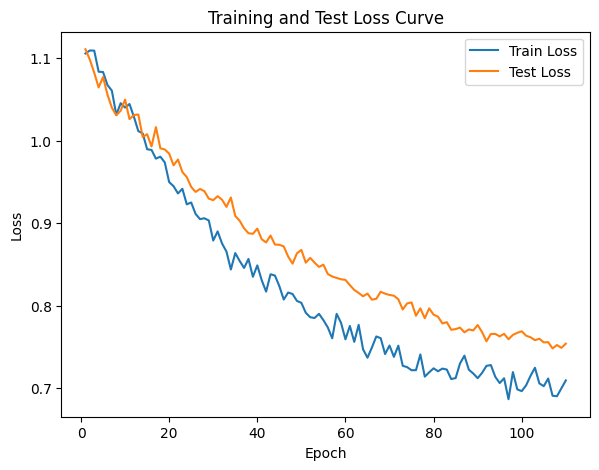

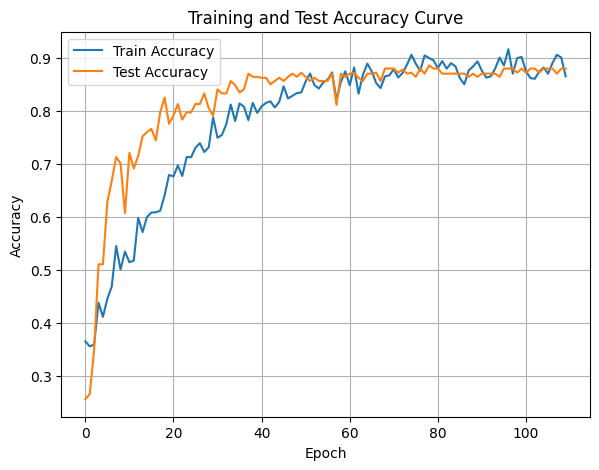

In [53]:
DTEmlp6b.train_single_model()

Randomly initializing 6 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.25it/s]

Epoch [1/10], Train F1:0.556732058132342, Train Loss: 1.0535, Train Acc: 0.5065, Test F1:0.5840422496666492, Test Loss: 1.0697, Test Acc: 0.5547


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.25it/s]

Epoch [2/10], Train F1:0.5751083579983666, Train Loss: 1.0423, Train Acc: 0.5296, Test F1:0.5873264729196042, Test Loss: 1.0686, Test Acc: 0.5686


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.10it/s]

Epoch [3/10], Train F1:0.5781080350773196, Train Loss: 1.0424, Train Acc: 0.5373, Test F1:0.6182010063919489, Test Loss: 1.0651, Test Acc: 0.5992


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.10it/s]

Epoch [4/10], Train F1:0.5998953102565024, Train Loss: 1.0358, Train Acc: 0.5577, Test F1:0.6233398136971364, Test Loss: 1.0628, Test Acc: 0.6098


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.17it/s]

Epoch [5/10], Train F1:0.6028423038869317, Train Loss: 1.0342, Train Acc: 0.5642, Test F1:0.6263967904131535, Test Loss: 1.0622, Test Acc: 0.6125


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.17it/s]

Epoch [6/10], Train F1:0.6103831264935207, Train Loss: 1.0321, Train Acc: 0.5747, Test F1:0.6325717764597221, Test Loss: 1.0603, Test Acc: 0.6202


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.00it/s]

Epoch [7/10], Train F1:0.616873216690322, Train Loss: 1.0269, Train Acc: 0.5834, Test F1:0.6554472362779727, Test Loss: 1.0574, Test Acc: 0.6405


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.97it/s]

Epoch [8/10], Train F1:0.6219583159519376, Train Loss: 1.0248, Train Acc: 0.5874, Test F1:0.6609897062343969, Test Loss: 1.0552, Test Acc: 0.6467


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.85it/s]

Epoch [9/10], Train F1:0.6300968372866825, Train Loss: 1.0217, Train Acc: 0.5969, Test F1:0.6641727668043457, Test Loss: 1.0528, Test Acc: 0.6513


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.97it/s]


Epoch [10/10], Train F1:0.6350940881322259, Train Loss: 1.0182, Train Acc: 0.6031, Test F1:0.6749510018945902, Test Loss: 1.0508, Test Acc: 0.6615
Total Epochs: 10
Train loss start: 1.0391334295272827, Train loss end: 0.9337491989135742
Highest Mean Train Accuracy (over epoch): 0.6031249999999999
Test loss start: 1.060101866722107, Test loss end: 1.0227679014205933
Highest mean Test Accuracy (over epoch): 0.6614583333333333


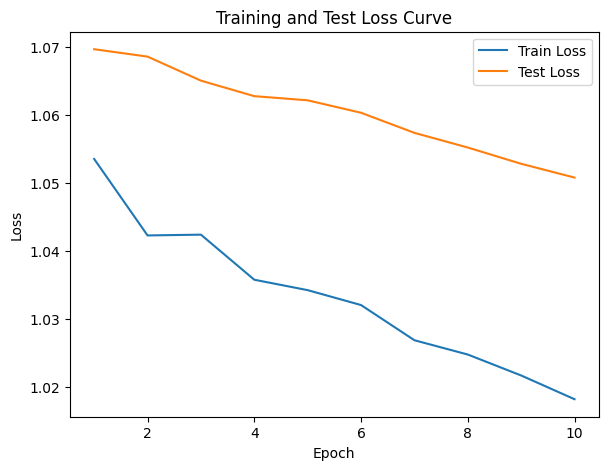

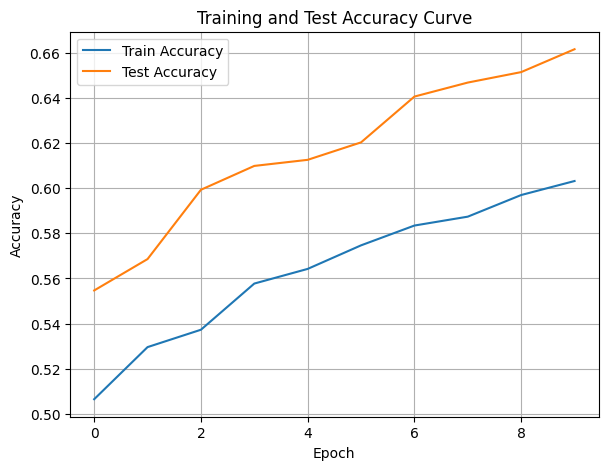

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.26901726384195007, Train Loss: 1.1151, Train Acc: 0.2753, Test F1:0.15712141200018195, Test Loss: 1.1067, Test Acc: 0.1997


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.88it/s]

Epoch [2/10], Train F1:0.29148625072868956, Train Loss: 1.1127, Train Acc: 0.2961, Test F1:0.1712997150217007, Test Loss: 1.1064, Test Acc: 0.2153


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.88it/s]

Epoch [3/10], Train F1:0.29233702159364733, Train Loss: 1.1121, Train Acc: 0.3014, Test F1:0.1806956759804641, Test Loss: 1.1044, Test Acc: 0.2251


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.59it/s]

Epoch [4/10], Train F1:0.3014582965546527, Train Loss: 1.1068, Train Acc: 0.3092, Test F1:0.1767061407197246, Test Loss: 1.1026, Test Acc: 0.2133


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.59it/s]

Epoch [5/10], Train F1:0.30156802166040825, Train Loss: 1.1041, Train Acc: 0.3118, Test F1:0.1810314289777502, Test Loss: 1.1009, Test Acc: 0.2184


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.52it/s]

Epoch [6/10], Train F1:0.3026519830918487, Train Loss: 1.1027, Train Acc: 0.3115, Test F1:0.1800912776044846, Test Loss: 1.0970, Test Acc: 0.2130


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.52it/s]

Epoch [7/10], Train F1:0.31149444136547866, Train Loss: 1.0999, Train Acc: 0.3191, Test F1:0.18646400189095916, Test Loss: 1.0950, Test Acc: 0.2124


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.91it/s]

Epoch [8/10], Train F1:0.3234729610841985, Train Loss: 1.0958, Train Acc: 0.3304, Test F1:0.18810829189510814, Test Loss: 1.0937, Test Acc: 0.2157


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.86it/s]

Epoch [9/10], Train F1:0.3349492957188264, Train Loss: 1.0925, Train Acc: 0.3392, Test F1:0.1899679680484634, Test Loss: 1.0922, Test Acc: 0.2198


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.27it/s]


Epoch [10/10], Train F1:0.34435971011254074, Train Loss: 1.0889, Train Acc: 0.3461, Test F1:0.1930340719321154, Test Loss: 1.0912, Test Acc: 0.2254
Total Epochs: 10
Train loss start: 1.1272917985916138, Train loss end: 1.0755577087402344
Highest Mean Train Accuracy (over epoch): 0.3461011904761905
Test loss start: 1.1024121046066284, Test loss end: 1.1028196811676025
Highest mean Test Accuracy (over epoch): 0.22543402777777777


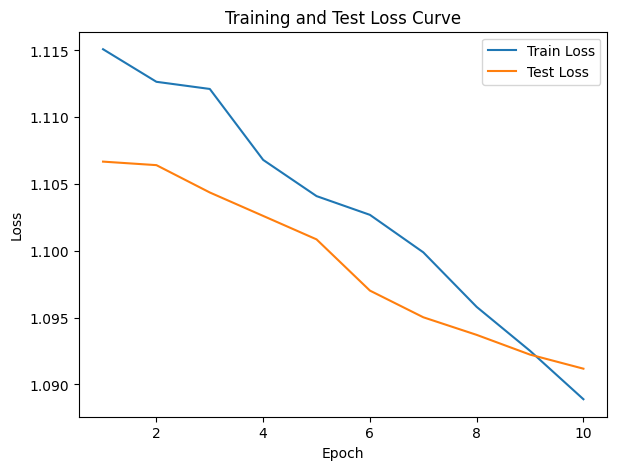

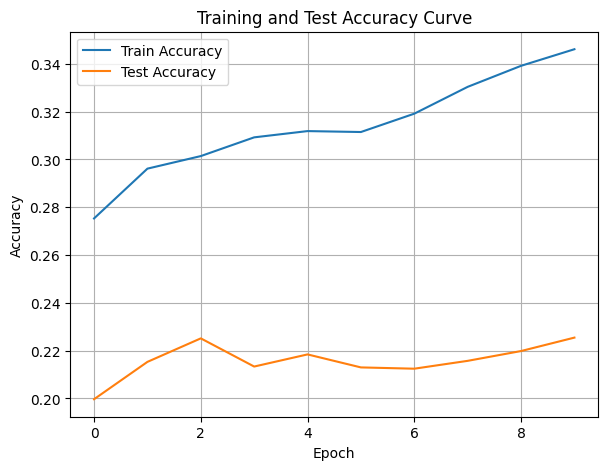

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.86it/s]

Epoch [1/10], Train F1:0.42659595797065303, Train Loss: 1.0865, Train Acc: 0.4318, Test F1:0.3362362741385839, Test Loss: 1.0966, Test Acc: 0.3116


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.86it/s]

Epoch [2/10], Train F1:0.42619952945560574, Train Loss: 1.0790, Train Acc: 0.4366, Test F1:0.3455761706424334, Test Loss: 1.0922, Test Acc: 0.3164


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.03it/s]

Epoch [3/10], Train F1:0.42762004137026194, Train Loss: 1.0775, Train Acc: 0.4388, Test F1:0.3526484480431849, Test Loss: 1.0904, Test Acc: 0.3226


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.33it/s]

Epoch [4/10], Train F1:0.43932421766582525, Train Loss: 1.0751, Train Acc: 0.4453, Test F1:0.3506210782430529, Test Loss: 1.0901, Test Acc: 0.3164


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.33it/s]

Epoch [5/10], Train F1:0.4477530864526082, Train Loss: 1.0733, Train Acc: 0.4513, Test F1:0.3780402711323764, Test Loss: 1.0872, Test Acc: 0.3519


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.85it/s]

Epoch [6/10], Train F1:0.4537466012871198, Train Loss: 1.0702, Train Acc: 0.4576, Test F1:0.40141157491429724, Test Loss: 1.0836, Test Acc: 0.3877


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.85it/s]

Epoch [7/10], Train F1:0.46537947822146913, Train Loss: 1.0634, Train Acc: 0.4736, Test F1:0.42038429406850464, Test Loss: 1.0784, Test Acc: 0.4211


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.03it/s]

Epoch [8/10], Train F1:0.46940558015031164, Train Loss: 1.0600, Train Acc: 0.4781, Test F1:0.43417088324756015, Test Loss: 1.0761, Test Acc: 0.4415


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.03it/s]

Epoch [9/10], Train F1:0.4737399601067105, Train Loss: 1.0562, Train Acc: 0.4828, Test F1:0.44273264270987495, Test Loss: 1.0738, Test Acc: 0.4572


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.57it/s]


Epoch [10/10], Train F1:0.48342829291964123, Train Loss: 1.0525, Train Acc: 0.4950, Test F1:0.45425082808502304, Test Loss: 1.0711, Test Acc: 0.4736
Total Epochs: 10
Train loss start: 1.094780445098877, Train loss end: 0.9180009961128235
Highest Mean Train Accuracy (over epoch): 0.49502976190476183
Test loss start: 1.0913010835647583, Test loss end: 1.0488286018371582
Highest mean Test Accuracy (over epoch): 0.4736111111111111


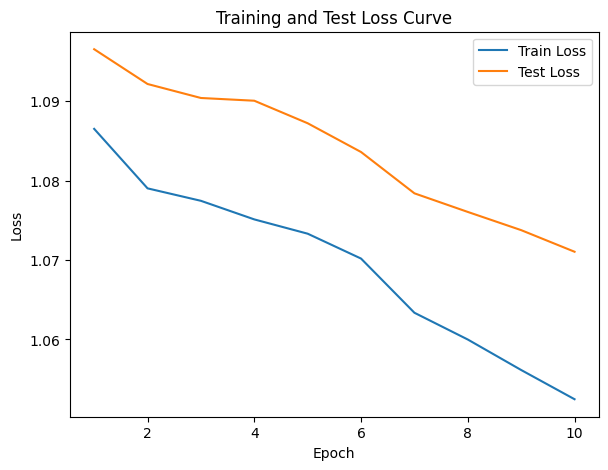

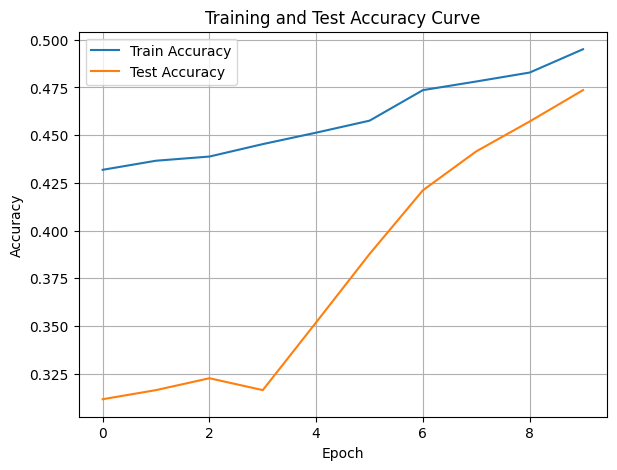

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.94it/s]

Epoch [1/10], Train F1:0.49171669002205637, Train Loss: 1.0272, Train Acc: 0.4923, Test F1:0.4607865177894904, Test Loss: 1.0618, Test Acc: 0.4983


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.94it/s]

Epoch [2/10], Train F1:0.5123625884019567, Train Loss: 1.0177, Train Acc: 0.5131, Test F1:0.45343009658730826, Test Loss: 1.0577, Test Acc: 0.4896


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.24it/s]

Epoch [3/10], Train F1:0.5100412751950615, Train Loss: 1.0190, Train Acc: 0.5124, Test F1:0.44874734763014196, Test Loss: 1.0581, Test Acc: 0.4867


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.24it/s]

Epoch [4/10], Train F1:0.5173367789322526, Train Loss: 1.0145, Train Acc: 0.5212, Test F1:0.44476212129234266, Test Loss: 1.0596, Test Acc: 0.4876


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.45it/s]

Epoch [5/10], Train F1:0.522972588363277, Train Loss: 1.0128, Train Acc: 0.5229, Test F1:0.44393587867697526, Test Loss: 1.0597, Test Acc: 0.4866
Epoch [6/10], Train F1:0.5297146370715855, Train Loss: 1.0103, Train Acc: 0.5278, Test F1:0.44462438146648675, Test Loss: 1.0590, Test Acc: 0.4886


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.47it/s]

Epoch [7/10], Train F1:0.5360218645528416, Train Loss: 1.0073, Train Acc: 0.5342, Test F1:0.4504568285293983, Test Loss: 1.0574, Test Acc: 0.4953
Epoch [8/10], Train F1:0.5417740560648003, Train Loss: 1.0058, Train Acc: 0.5377, Test F1:0.45750962162259207, Test Loss: 1.0559, Test Acc: 0.4993


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.45it/s]


Epoch [9/10], Train F1:0.5483208641266047, Train Loss: 1.0025, Train Acc: 0.5437, Test F1:0.4599069506560077, Test Loss: 1.0549, Test Acc: 0.5018
Epoch [10/10], Train F1:0.5541277206289206, Train Loss: 0.9988, Train Acc: 0.5500, Test F1:0.46519765761153914, Test Loss: 1.0530, Test Acc: 0.5052
Total Epochs: 10
Train loss start: 0.9672538042068481, Train loss end: 0.8861925005912781
Highest Mean Train Accuracy (over epoch): 0.5499702380952382
Test loss start: 1.068407654762268, Test loss end: 1.0168015956878662
Highest mean Test Accuracy (over epoch): 0.5052083333333334


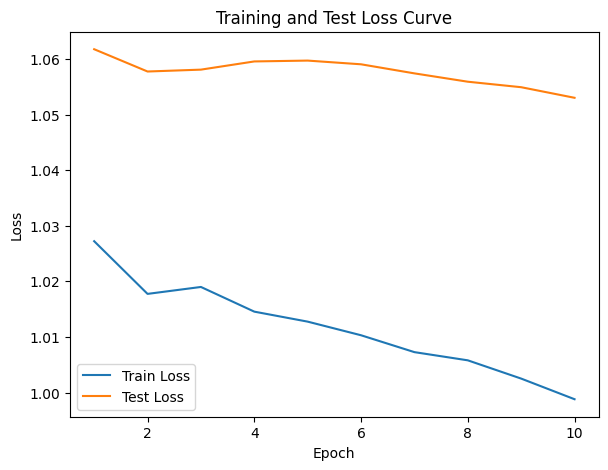

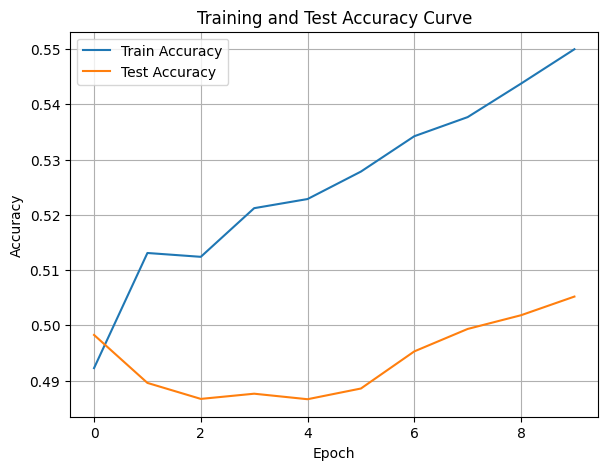

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.45it/s]

Epoch [1/10], Train F1:0.4017376985440252, Train Loss: 1.1082, Train Acc: 0.3024, Test F1:0.3047027290448343, Test Loss: 1.1143, Test Acc: 0.2161


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.57it/s]

Epoch [2/10], Train F1:0.4344427382790555, Train Loss: 1.1008, Train Acc: 0.3390, Test F1:0.2977893448344943, Test Loss: 1.1173, Test Acc: 0.2053


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.52it/s]

Epoch [3/10], Train F1:0.43847813326564916, Train Loss: 1.0981, Train Acc: 0.3463, Test F1:0.30111898837191103, Test Loss: 1.1143, Test Acc: 0.2069


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.42it/s]

Epoch [4/10], Train F1:0.44685143811833566, Train Loss: 1.0931, Train Acc: 0.3600, Test F1:0.309682214057515, Test Loss: 1.1128, Test Acc: 0.2116


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.68it/s]

Epoch [5/10], Train F1:0.4554241249550838, Train Loss: 1.0909, Train Acc: 0.3660, Test F1:0.31193153610307606, Test Loss: 1.1129, Test Acc: 0.2116


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.63it/s]

Epoch [6/10], Train F1:0.4661575765796809, Train Loss: 1.0887, Train Acc: 0.3722, Test F1:0.3116955883671978, Test Loss: 1.1110, Test Acc: 0.2117


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.97it/s]

Epoch [7/10], Train F1:0.47281077929899573, Train Loss: 1.0846, Train Acc: 0.3812, Test F1:0.3253013525458325, Test Loss: 1.1090, Test Acc: 0.2232


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.97it/s]

Epoch [8/10], Train F1:0.48330564629636297, Train Loss: 1.0807, Train Acc: 0.3907, Test F1:0.33720247255184943, Test Loss: 1.1070, Test Acc: 0.2321


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.85it/s]

Epoch [9/10], Train F1:0.4907791460590059, Train Loss: 1.0769, Train Acc: 0.3983, Test F1:0.34015114374297645, Test Loss: 1.1055, Test Acc: 0.2355


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.44it/s]


Epoch [10/10], Train F1:0.49987180215104093, Train Loss: 1.0733, Train Acc: 0.4077, Test F1:0.34695580062629183, Test Loss: 1.1046, Test Acc: 0.2420
Total Epochs: 10
Train loss start: 1.0936795473098755, Train loss end: 1.026302456855774
Highest Mean Train Accuracy (over epoch): 0.4077083333333333
Test loss start: 1.1022826433181763, Test loss end: 1.0820232629776
Highest mean Test Accuracy (over epoch): 0.2420138888888889


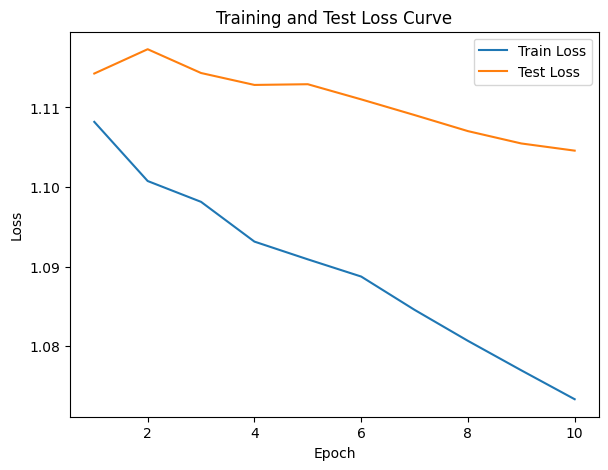

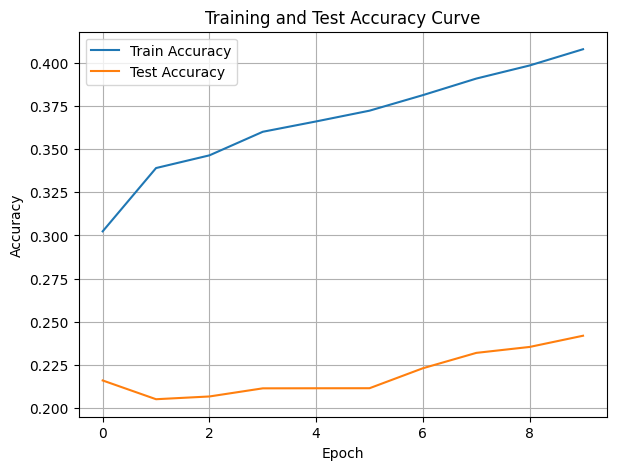

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.42it/s]

Epoch [1/10], Train F1:0.4544445254216727, Train Loss: 1.0959, Train Acc: 0.3807, Test F1:0.4008872756604154, Test Loss: 1.1003, Test Acc: 0.2778


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.42it/s]

Epoch [2/10], Train F1:0.446806892708532, Train Loss: 1.0933, Train Acc: 0.3638, Test F1:0.33798567000734775, Test Loss: 1.1031, Test Acc: 0.2378


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.09it/s]

Epoch [3/10], Train F1:0.46735529863596753, Train Loss: 1.0862, Train Acc: 0.3868, Test F1:0.3678878046179278, Test Loss: 1.0989, Test Acc: 0.2668


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.99it/s]

Epoch [4/10], Train F1:0.4781102479981445, Train Loss: 1.0844, Train Acc: 0.3922, Test F1:0.36640800963222087, Test Loss: 1.0980, Test Acc: 0.2711


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.85it/s]

Epoch [5/10], Train F1:0.4881125227119864, Train Loss: 1.0817, Train Acc: 0.4026, Test F1:0.36553559845214395, Test Loss: 1.0961, Test Acc: 0.2752


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.80it/s]

Epoch [6/10], Train F1:0.4938253564756602, Train Loss: 1.0793, Train Acc: 0.4075, Test F1:0.40348079202398385, Test Loss: 1.0940, Test Acc: 0.3096


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.56it/s]

Epoch [7/10], Train F1:0.5056931738971011, Train Loss: 1.0739, Train Acc: 0.4210, Test F1:0.4390961216711763, Test Loss: 1.0918, Test Acc: 0.3451


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.72it/s]

Epoch [8/10], Train F1:0.5162695652518007, Train Loss: 1.0694, Train Acc: 0.4331, Test F1:0.46907996706383803, Test Loss: 1.0889, Test Acc: 0.3784


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.84it/s]

Epoch [9/10], Train F1:0.5219407365143612, Train Loss: 1.0665, Train Acc: 0.4409, Test F1:0.4900517114408138, Test Loss: 1.0867, Test Acc: 0.4011


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.16it/s]


Epoch [10/10], Train F1:0.5318739298371936, Train Loss: 1.0633, Train Acc: 0.4517, Test F1:0.5136410261654728, Test Loss: 1.0839, Test Acc: 0.4316
Total Epochs: 10
Train loss start: 1.0978888273239136, Train loss end: 1.0344816446304321
Highest Mean Train Accuracy (over epoch): 0.45172619047619045
Test loss start: 1.0926694869995117, Test loss end: 1.0630995035171509
Highest mean Test Accuracy (over epoch): 0.43159722222222224


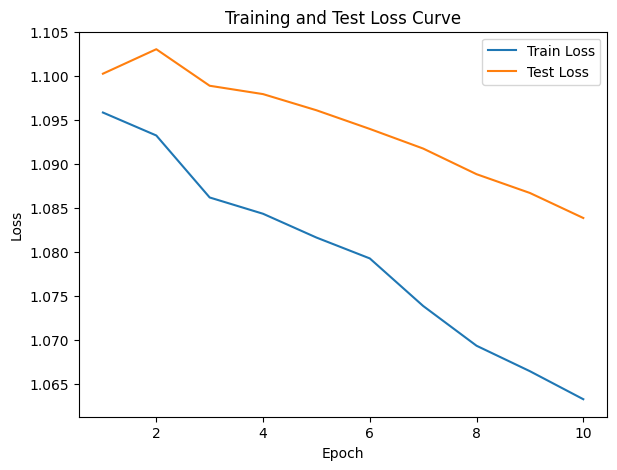

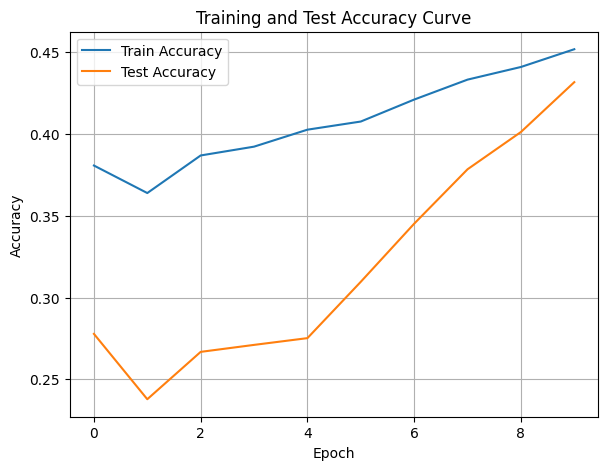

./saved_models/model_6.pth
Training Model with id 11
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.50it/s]

Epoch [1/10], Train F1:0.5855387392894372, Train Loss: 1.0436, Train Acc: 0.5065, Test F1:0.6800535475234272, Test Loss: 1.0573, Test Acc: 0.6858
Epoch [2/10], Train F1:0.6281571148916691, Train Loss: 1.0325, Train Acc: 0.5493, Test F1:0.7025306902022397, Test Loss: 1.0522, Test Acc: 0.7144


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.72it/s]

Epoch [3/10], Train F1:0.6451166173913517, Train Loss: 1.0226, Train Acc: 0.5712, Test F1:0.7100135791430797, Test Loss: 1.0520, Test Acc: 0.7167
Epoch [4/10], Train F1:0.6499030379405243, Train Loss: 1.0180, Train Acc: 0.5825, Test F1:0.7177184667830715, Test Loss: 1.0518, Test Acc: 0.7287


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.99it/s]

Epoch [5/10], Train F1:0.652941630572074, Train Loss: 1.0148, Train Acc: 0.5910, Test F1:0.7269150900803316, Test Loss: 1.0476, Test Acc: 0.7391
Epoch [6/10], Train F1:0.6622116769062222, Train Loss: 1.0109, Train Acc: 0.6019, Test F1:0.7306942071770394, Test Loss: 1.0450, Test Acc: 0.7446


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.74it/s]

Epoch [7/10], Train F1:0.6690218380028012, Train Loss: 1.0067, Train Acc: 0.6087, Test F1:0.7286436991950779, Test Loss: 1.0403, Test Acc: 0.7464


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.01it/s]

Epoch [8/10], Train F1:0.6713110496058021, Train Loss: 1.0038, Train Acc: 0.6108, Test F1:0.7291784070455418, Test Loss: 1.0379, Test Acc: 0.7487
Epoch [9/10], Train F1:0.6778023615096984, Train Loss: 0.9999, Train Acc: 0.6176, Test F1:0.7315175450903454, Test Loss: 1.0345, Test Acc: 0.7522


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.74it/s]


Epoch [10/10], Train F1:0.6795843288704388, Train Loss: 0.9986, Train Acc: 0.6211, Test F1:0.7337135869848868, Test Loss: 1.0309, Test Acc: 0.7550
Total Epochs: 10
Train loss start: 1.0445106029510498, Train loss end: 1.135237693786621
Highest Mean Train Accuracy (over epoch): 0.6211309523809524
Test loss start: 1.0490177869796753, Test loss end: 0.9993264079093933
Highest mean Test Accuracy (over epoch): 0.7550347222222221


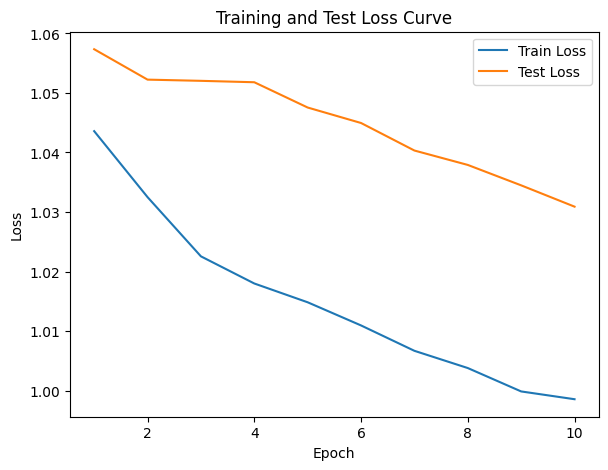

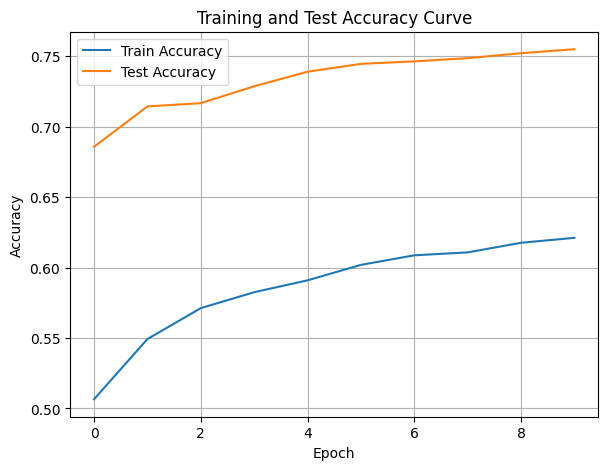

./saved_models/model_11.pth
Training Model with id 9
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7614229334596755, Train Loss: 0.9530, Train Acc: 0.7342, Test F1:0.7777577443036637, Test Loss: 1.0052, Test Acc: 0.7960


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.86it/s]

Epoch [2/10], Train F1:0.7570503490295383, Train Loss: 0.9532, Train Acc: 0.7278, Test F1:0.7811414501165195, Test Loss: 1.0096, Test Acc: 0.7960


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.86it/s]

Epoch [3/10], Train F1:0.7492620328814436, Train Loss: 0.9527, Train Acc: 0.7188, Test F1:0.780009081240534, Test Loss: 1.0035, Test Acc: 0.7960


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.10it/s]

Epoch [4/10], Train F1:0.7517478398834332, Train Loss: 0.9493, Train Acc: 0.7231, Test F1:0.7777577443036637, Test Loss: 0.9994, Test Acc: 0.7960
Epoch [5/10], Train F1:0.7547499095359977, Train Loss: 0.9451, Train Acc: 0.7272, Test F1:0.7740126625359571, Test Loss: 0.9965, Test Acc: 0.7944


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.75it/s]

Epoch [6/10], Train F1:0.7586673664140239, Train Loss: 0.9407, Train Acc: 0.7316, Test F1:0.7721968958057318, Test Loss: 0.9944, Test Acc: 0.7934


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.89it/s]

Epoch [7/10], Train F1:0.7602708754075175, Train Loss: 0.9406, Train Acc: 0.7338, Test F1:0.7720384726737979, Test Loss: 0.9913, Test Acc: 0.7938
Epoch [8/10], Train F1:0.76193648153388, Train Loss: 0.9368, Train Acc: 0.7374, Test F1:0.7734164099124786, Test Loss: 0.9889, Test Acc: 0.7950


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.45it/s]


Epoch [9/10], Train F1:0.7665490784576554, Train Loss: 0.9326, Train Acc: 0.7439, Test F1:0.7718288148462211, Test Loss: 0.9848, Test Acc: 0.7943
Epoch [10/10], Train F1:0.7741972559846243, Train Loss: 0.9273, Train Acc: 0.7533, Test F1:0.7705572130369888, Test Loss: 0.9820, Test Acc: 0.7937
Total Epochs: 10
Train loss start: 0.9490986466407776, Train loss end: 0.7831892371177673
Highest Mean Train Accuracy (over epoch): 0.7533035714285715
Test loss start: 0.9983367919921875, Test loss end: 0.9468891620635986
Highest mean Test Accuracy (over epoch): 0.7960069444444445


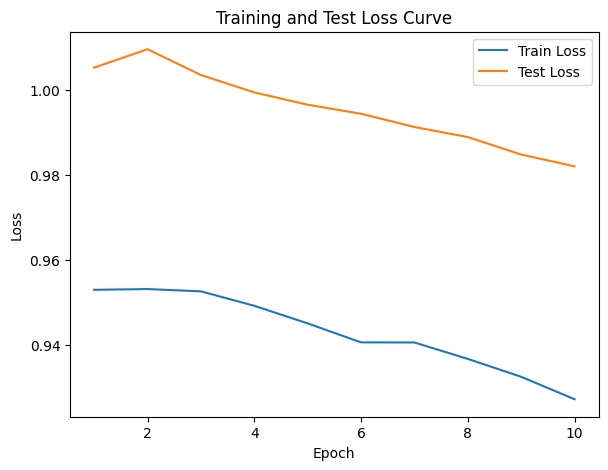

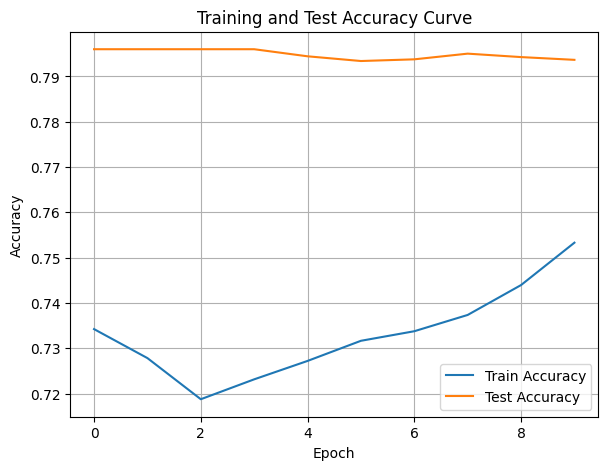

./saved_models/model_9.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8035736447322851, Train Loss: 0.8940, Train Acc: 0.7893, Test F1:0.7590487847525791, Test Loss: 0.9589, Test Acc: 0.7882


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.11it/s]

Epoch [2/10], Train F1:0.8097363147327837, Train Loss: 0.8967, Train Acc: 0.7935, Test F1:0.7651130716442541, Test Loss: 0.9578, Test Acc: 0.7921


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.11it/s]

Epoch [3/10], Train F1:0.8042211626517034, Train Loss: 0.8928, Train Acc: 0.7936, Test F1:0.767119217131866, Test Loss: 0.9543, Test Acc: 0.7934


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.43it/s]

Epoch [4/10], Train F1:0.8063675490026825, Train Loss: 0.8892, Train Acc: 0.7946, Test F1:0.7651130716442541, Test Loss: 0.9482, Test Acc: 0.7921


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.53it/s]

Epoch [5/10], Train F1:0.8065918378099032, Train Loss: 0.8882, Train Acc: 0.7958, Test F1:0.7663176644374707, Test Loss: 0.9467, Test Acc: 0.7929


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.64it/s]

Epoch [6/10], Train F1:0.8100511032267363, Train Loss: 0.8835, Train Acc: 0.8001, Test F1:0.7651130716442541, Test Loss: 0.9442, Test Acc: 0.7921


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.89it/s]

Epoch [7/10], Train F1:0.8142089408685831, Train Loss: 0.8793, Train Acc: 0.8048, Test F1:0.7642509767288086, Test Loss: 0.9422, Test Acc: 0.7915


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.85it/s]

Epoch [8/10], Train F1:0.8151634751727542, Train Loss: 0.8761, Train Acc: 0.8072, Test F1:0.7651130716442541, Test Loss: 0.9405, Test Acc: 0.7921


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.10it/s]

Epoch [9/10], Train F1:0.8173714464719228, Train Loss: 0.8735, Train Acc: 0.8102, Test F1:0.7671192171318659, Test Loss: 0.9391, Test Acc: 0.7934


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.57it/s]


Epoch [10/10], Train F1:0.8185128845103439, Train Loss: 0.8708, Train Acc: 0.8120, Test F1:0.767519542624263, Test Loss: 0.9371, Test Acc: 0.7937
Total Epochs: 10
Train loss start: 0.9264523983001709, Train loss end: 0.8144038915634155
Highest Mean Train Accuracy (over epoch): 0.8119940476190476
Test loss start: 0.9492737054824829, Test loss end: 0.914867639541626
Highest mean Test Accuracy (over epoch): 0.7936631944444444


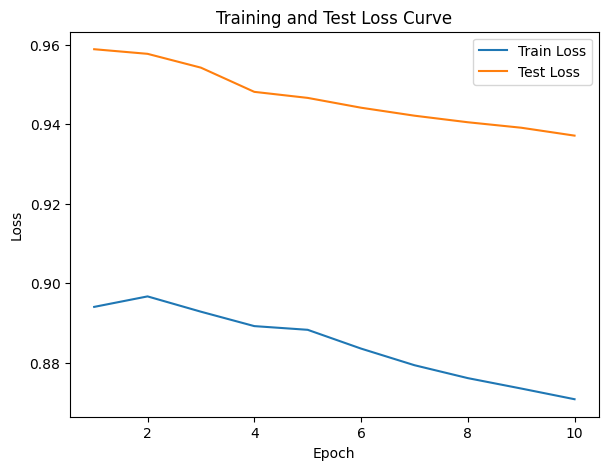

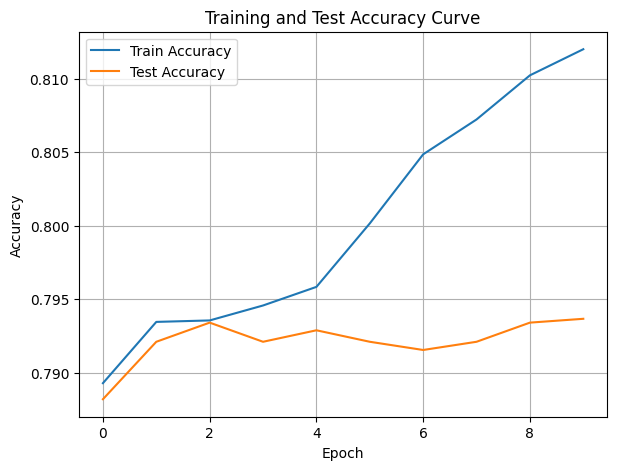

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.33it/s]

Epoch [1/10], Train F1:0.8502047965971461, Train Loss: 0.8336, Train Acc: 0.8604, Test F1:0.7590487847525791, Test Loss: 0.9049, Test Acc: 0.7882


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.23it/s]

Epoch [2/10], Train F1:0.8526319747473593, Train Loss: 0.8354, Train Acc: 0.8546, Test F1:0.7590487847525791, Test Loss: 0.9061, Test Acc: 0.7882


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.43it/s]

Epoch [3/10], Train F1:0.8499807157887557, Train Loss: 0.8319, Train Acc: 0.8513, Test F1:0.7590487847525791, Test Loss: 0.9052, Test Acc: 0.7882


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.79it/s]

Epoch [4/10], Train F1:0.8497671636675699, Train Loss: 0.8280, Train Acc: 0.8531, Test F1:0.7590487847525791, Test Loss: 0.9037, Test Acc: 0.7882


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.73it/s]

Epoch [5/10], Train F1:0.841934193568724, Train Loss: 0.8300, Train Acc: 0.8421, Test F1:0.7590487847525791, Test Loss: 0.9029, Test Acc: 0.7882


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.17it/s]

Epoch [6/10], Train F1:0.8407695852708547, Train Loss: 0.8298, Train Acc: 0.8412, Test F1:0.7590487847525791, Test Loss: 0.9012, Test Acc: 0.7882


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.17it/s]

Epoch [7/10], Train F1:0.842884567627828, Train Loss: 0.8261, Train Acc: 0.8438, Test F1:0.7590487847525792, Test Loss: 0.8994, Test Acc: 0.7882


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.30it/s]

Epoch [8/10], Train F1:0.8452588192291335, Train Loss: 0.8238, Train Acc: 0.8471, Test F1:0.7605713778270338, Test Loss: 0.8978, Test Acc: 0.7892


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.83it/s]

Epoch [9/10], Train F1:0.8472084218986283, Train Loss: 0.8225, Train Acc: 0.8489, Test F1:0.768452470905068, Test Loss: 0.8960, Test Acc: 0.7949


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.56it/s]


Epoch [10/10], Train F1:0.8491900256929223, Train Loss: 0.8210, Train Acc: 0.8501, Test F1:0.7687187232263889, Test Loss: 0.8932, Test Acc: 0.7951
Total Epochs: 10
Train loss start: 0.8300970196723938, Train loss end: 0.8044970631599426
Highest Mean Train Accuracy (over epoch): 0.8604166666666667
Test loss start: 0.8918390274047852, Test loss end: 0.8628737926483154
Highest mean Test Accuracy (over epoch): 0.7950520833333334


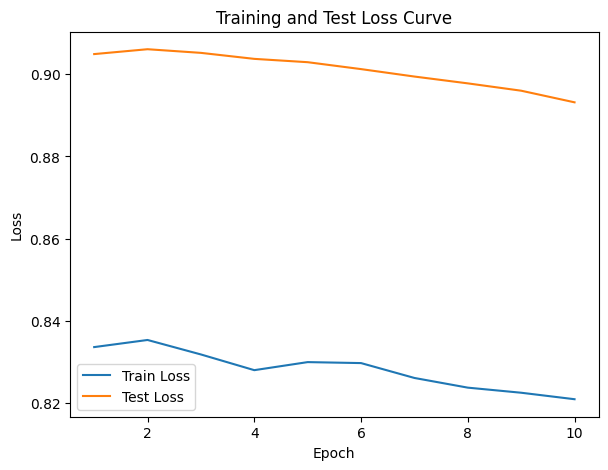

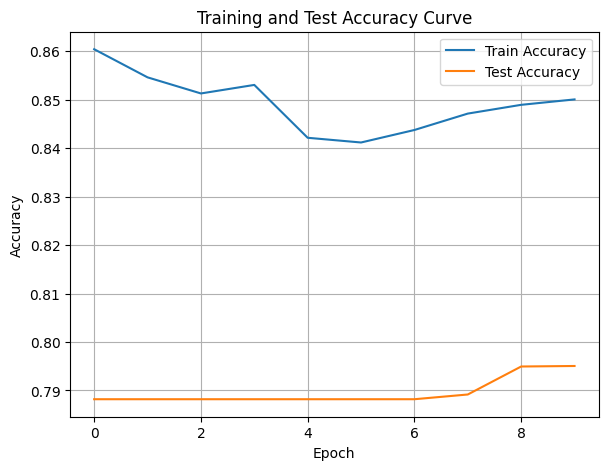

./saved_models/model_10.pth
Training Model with id 8
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.09it/s]

Epoch [1/10], Train F1:0.8463524521653769, Train Loss: 0.8151, Train Acc: 0.8488, Test F1:0.7829045229707128, Test Loss: 0.8790, Test Acc: 0.8038
Epoch [2/10], Train F1:0.8505523541829694, Train Loss: 0.8095, Train Acc: 0.8493, Test F1:0.7711090591977018, Test Loss: 0.8773, Test Acc: 0.7960


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.09it/s]

Epoch [3/10], Train F1:0.8520867492296064, Train Loss: 0.8055, Train Acc: 0.8519, Test F1:0.7829045229707127, Test Loss: 0.8708, Test Acc: 0.8038


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.28it/s]

Epoch [4/10], Train F1:0.857199640763148, Train Loss: 0.8005, Train Acc: 0.8574, Test F1:0.7915870634504486, Test Loss: 0.8691, Test Acc: 0.8097


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.28it/s]

Epoch [5/10], Train F1:0.8599253992505783, Train Loss: 0.7971, Train Acc: 0.8588, Test F1:0.796732127487927, Test Loss: 0.8676, Test Acc: 0.8132


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.79it/s]

Epoch [6/10], Train F1:0.8587495780349697, Train Loss: 0.7961, Train Acc: 0.8557, Test F1:0.7963526295543649, Test Loss: 0.8653, Test Acc: 0.8129


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.79it/s]

Epoch [7/10], Train F1:0.8580782081022814, Train Loss: 0.7937, Train Acc: 0.8559, Test F1:0.7977068038632538, Test Loss: 0.8639, Test Acc: 0.8139


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.98it/s]

Epoch [8/10], Train F1:0.8580714338179258, Train Loss: 0.7926, Train Acc: 0.8556, Test F1:0.7973008940541697, Test Loss: 0.8622, Test Acc: 0.8136


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.98it/s]

Epoch [9/10], Train F1:0.8599690536776229, Train Loss: 0.7900, Train Acc: 0.8587, Test F1:0.7957195620630524, Test Loss: 0.8615, Test Acc: 0.8125


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.53it/s]


Epoch [10/10], Train F1:0.8590496781422279, Train Loss: 0.7897, Train Acc: 0.8566, Test F1:0.7978690858190237, Test Loss: 0.8605, Test Acc: 0.8140
Total Epochs: 10
Train loss start: 0.8096215724945068, Train loss end: 0.9054139256477356
Highest Mean Train Accuracy (over epoch): 0.85875
Test loss start: 0.865115761756897, Test loss end: 0.8490082621574402
Highest mean Test Accuracy (over epoch): 0.8139756944444445


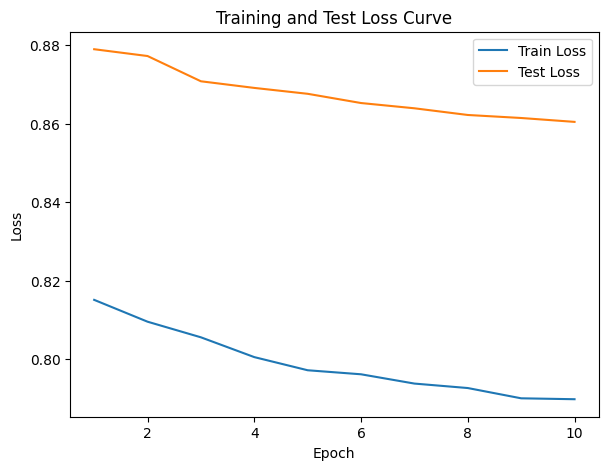

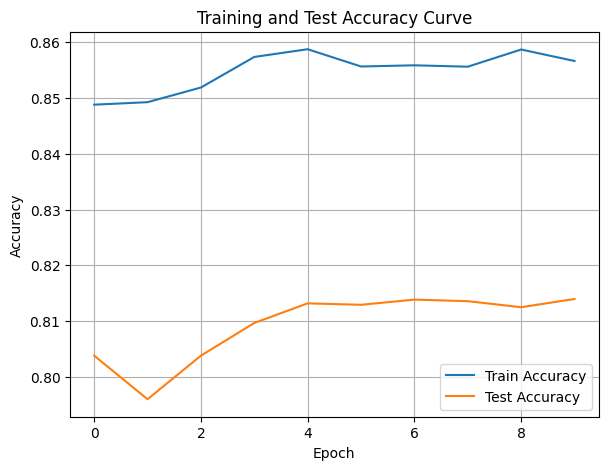

./saved_models/model_8.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [54]:
DTEmlp6b.train_DTE()

Training Process:   1%|          | 1/110 [00:00<00:15,  6.93it/s]

Epoch [1/110], Train F1:0.2897792298545801, Train Loss: 1.1372, Train Acc: 0.2869, Test F1:0.22634363686995265, Test Loss: 1.1151, Test Acc: 0.1884


Training Process:   2%|▏         | 2/110 [00:00<00:13,  8.29it/s]

Epoch [2/110], Train F1:0.3208823081848507, Train Loss: 1.1310, Train Acc: 0.3024, Test F1:0.2951704681506894, Test Loss: 1.1148, Test Acc: 0.2461


Training Process:   3%|▎         | 3/110 [00:00<00:12,  8.63it/s]

Epoch [3/110], Train F1:0.3342634154384029, Train Loss: 1.1293, Train Acc: 0.3103, Test F1:0.2612656716003347, Test Loss: 1.1185, Test Acc: 0.2150


Training Process:   4%|▎         | 4/110 [00:00<00:12,  8.77it/s]

Epoch [4/110], Train F1:0.3398643392333989, Train Loss: 1.1231, Train Acc: 0.3204, Test F1:0.24786967418546363, Test Loss: 1.1196, Test Acc: 0.2103


Training Process:   5%|▍         | 5/110 [00:00<00:12,  8.42it/s]

Epoch [5/110], Train F1:0.3488263283213741, Train Loss: 1.1194, Train Acc: 0.3268, Test F1:0.3008553335639972, Test Loss: 1.1167, Test Acc: 0.2521


Training Process:   5%|▌         | 6/110 [00:00<00:12,  8.61it/s]

Epoch [6/110], Train F1:0.3536397552592056, Train Loss: 1.1136, Train Acc: 0.3371, Test F1:0.32462708126912054, Test Loss: 1.1144, Test Acc: 0.2734


Training Process:   6%|▋         | 7/110 [00:00<00:13,  7.83it/s]

Epoch [7/110], Train F1:0.3644367284453772, Train Loss: 1.1095, Train Acc: 0.3476, Test F1:0.3545446016597157, Test Loss: 1.1116, Test Acc: 0.3018


Training Process:   7%|▋         | 8/110 [00:01<00:15,  6.50it/s]

Epoch [8/110], Train F1:0.37379272492204285, Train Loss: 1.1066, Train Acc: 0.3571, Test F1:0.3817254127721429, Test Loss: 1.1087, Test Acc: 0.3280


Training Process:   9%|▉         | 10/110 [00:01<00:16,  6.17it/s]

Epoch [9/110], Train F1:0.3817865261137508, Train Loss: 1.1036, Train Acc: 0.3646, Test F1:0.3982434415431803, Test Loss: 1.1066, Test Acc: 0.3449
Epoch [10/110], Train F1:0.38946419590996273, Train Loss: 1.1007, Train Acc: 0.3716, Test F1:0.42007656552459766, Test Loss: 1.1036, Test Acc: 0.3696


Training Process:  11%|█         | 12/110 [00:01<00:15,  6.50it/s]

Epoch [11/110], Train F1:0.39713336370651187, Train Loss: 1.0979, Train Acc: 0.3788, Test F1:0.4394408754456601, Test Loss: 1.1010, Test Acc: 0.3913
Epoch [12/110], Train F1:0.40783780393847974, Train Loss: 1.0943, Train Acc: 0.3885, Test F1:0.45523712692721074, Test Loss: 1.0983, Test Acc: 0.4093


Training Process:  13%|█▎        | 14/110 [00:01<00:13,  7.31it/s]

Epoch [13/110], Train F1:0.4163068706886624, Train Loss: 1.0908, Train Acc: 0.3964, Test F1:0.46778666752100206, Test Loss: 1.0955, Test Acc: 0.4250
Epoch [14/110], Train F1:0.4214143216973172, Train Loss: 1.0876, Train Acc: 0.4021, Test F1:0.4828710073054977, Test Loss: 1.0921, Test Acc: 0.4428


Training Process:  15%|█▍        | 16/110 [00:02<00:12,  7.67it/s]

Epoch [15/110], Train F1:0.42476320630076675, Train Loss: 1.0846, Train Acc: 0.4061, Test F1:0.49431693938935195, Test Loss: 1.0886, Test Acc: 0.4572
Epoch [16/110], Train F1:0.43165140899977733, Train Loss: 1.0814, Train Acc: 0.4124, Test F1:0.505834045405225, Test Loss: 1.0859, Test Acc: 0.4704


Training Process:  16%|█▋        | 18/110 [00:02<00:12,  7.57it/s]

Epoch [17/110], Train F1:0.4375335580920607, Train Loss: 1.0786, Train Acc: 0.4189, Test F1:0.5156218590396204, Test Loss: 1.0834, Test Acc: 0.4816
Epoch [18/110], Train F1:0.4447210044201505, Train Loss: 1.0751, Train Acc: 0.4263, Test F1:0.5248899937550434, Test Loss: 1.0807, Test Acc: 0.4924


Training Process:  18%|█▊        | 20/110 [00:02<00:11,  7.60it/s]

Epoch [19/110], Train F1:0.4481192814044398, Train Loss: 1.0728, Train Acc: 0.4299, Test F1:0.5337011790996531, Test Loss: 1.0780, Test Acc: 0.5025
Epoch [20/110], Train F1:0.4562961100838056, Train Loss: 1.0694, Train Acc: 0.4386, Test F1:0.5412018587894097, Test Loss: 1.0755, Test Acc: 0.5119


Training Process:  20%|██        | 22/110 [00:02<00:11,  7.43it/s]

Epoch [21/110], Train F1:0.46328424432220827, Train Loss: 1.0663, Train Acc: 0.4460, Test F1:0.5484708183429732, Test Loss: 1.0728, Test Acc: 0.5201
Epoch [22/110], Train F1:0.47080237608605474, Train Loss: 1.0627, Train Acc: 0.4537, Test F1:0.5576114335872583, Test Loss: 1.0702, Test Acc: 0.5297


Training Process:  22%|██▏       | 24/110 [00:03<00:12,  7.16it/s]

Epoch [23/110], Train F1:0.4783725188824926, Train Loss: 1.0588, Train Acc: 0.4610, Test F1:0.5639518481231544, Test Loss: 1.0675, Test Acc: 0.5377
Epoch [24/110], Train F1:0.4841428128734269, Train Loss: 1.0559, Train Acc: 0.4670, Test F1:0.5692109609677921, Test Loss: 1.0648, Test Acc: 0.5443


Training Process:  24%|██▎       | 26/110 [00:03<00:12,  6.86it/s]

Epoch [25/110], Train F1:0.4897147485861277, Train Loss: 1.0533, Train Acc: 0.4718, Test F1:0.5746036890949113, Test Loss: 1.0622, Test Acc: 0.5508
Epoch [26/110], Train F1:0.49639701594102625, Train Loss: 1.0499, Train Acc: 0.4789, Test F1:0.5801602807344975, Test Loss: 1.0597, Test Acc: 0.5574


Training Process:  25%|██▌       | 28/110 [00:03<00:13,  6.17it/s]

Epoch [27/110], Train F1:0.5032468108440444, Train Loss: 1.0464, Train Acc: 0.4862, Test F1:0.5858932495915613, Test Loss: 1.0569, Test Acc: 0.5645
Epoch [28/110], Train F1:0.5115147949242942, Train Loss: 1.0424, Train Acc: 0.4946, Test F1:0.5910464925914832, Test Loss: 1.0542, Test Acc: 0.5707


Training Process:  27%|██▋       | 30/110 [00:04<00:12,  6.16it/s]

Epoch [29/110], Train F1:0.5170446346561284, Train Loss: 1.0397, Train Acc: 0.4998, Test F1:0.5959525642971365, Test Loss: 1.0518, Test Acc: 0.5764
Epoch [30/110], Train F1:0.523205527605294, Train Loss: 1.0363, Train Acc: 0.5058, Test F1:0.6003709949043812, Test Loss: 1.0487, Test Acc: 0.5822


Training Process:  28%|██▊       | 31/110 [00:04<00:12,  6.18it/s]

Epoch [31/110], Train F1:0.5279439233239813, Train Loss: 1.0332, Train Acc: 0.5106, Test F1:0.605363966184181, Test Loss: 1.0462, Test Acc: 0.5877


Training Process:  29%|██▉       | 32/110 [00:04<00:13,  5.64it/s]

Epoch [32/110], Train F1:0.5343514978986154, Train Loss: 1.0300, Train Acc: 0.5169, Test F1:0.6106430500425671, Test Loss: 1.0438, Test Acc: 0.5936


Training Process:  30%|███       | 33/110 [00:04<00:14,  5.19it/s]

Epoch [33/110], Train F1:0.5396882404582938, Train Loss: 1.0271, Train Acc: 0.5222, Test F1:0.6166112350454501, Test Loss: 1.0415, Test Acc: 0.5999


Training Process:  31%|███       | 34/110 [00:05<00:17,  4.24it/s]

Epoch [34/110], Train F1:0.5446648311917667, Train Loss: 1.0246, Train Acc: 0.5271, Test F1:0.621688229858852, Test Loss: 1.0393, Test Acc: 0.6061


Training Process:  32%|███▏      | 35/110 [00:05<00:18,  4.10it/s]

Epoch [35/110], Train F1:0.5498577594154612, Train Loss: 1.0213, Train Acc: 0.5330, Test F1:0.6256342483160392, Test Loss: 1.0368, Test Acc: 0.6110


Training Process:  33%|███▎      | 36/110 [00:05<00:18,  4.07it/s]

Epoch [36/110], Train F1:0.5559825258163634, Train Loss: 1.0176, Train Acc: 0.5395, Test F1:0.6299776906643124, Test Loss: 1.0342, Test Acc: 0.6163


Training Process:  34%|███▎      | 37/110 [00:06<00:19,  3.81it/s]

Epoch [37/110], Train F1:0.5607675623311377, Train Loss: 1.0148, Train Acc: 0.5444, Test F1:0.6345311104479107, Test Loss: 1.0315, Test Acc: 0.6216


Training Process:  35%|███▍      | 38/110 [00:06<00:18,  3.94it/s]

Epoch [38/110], Train F1:0.5648128288169335, Train Loss: 1.0119, Train Acc: 0.5485, Test F1:0.6382523251204455, Test Loss: 1.0288, Test Acc: 0.6262


Training Process:  36%|███▋      | 40/110 [00:06<00:16,  4.36it/s]

Epoch [39/110], Train F1:0.5694853360569145, Train Loss: 1.0092, Train Acc: 0.5532, Test F1:0.6426411585788903, Test Loss: 1.0265, Test Acc: 0.6313
Epoch [40/110], Train F1:0.5746304773434964, Train Loss: 1.0059, Train Acc: 0.5587, Test F1:0.645687408255714, Test Loss: 1.0243, Test Acc: 0.6352


Training Process:  37%|███▋      | 41/110 [00:07<00:14,  4.63it/s]

Epoch [41/110], Train F1:0.5792459186418923, Train Loss: 1.0029, Train Acc: 0.5635, Test F1:0.64830748769276, Test Loss: 1.0217, Test Acc: 0.6388
Epoch [42/110], Train F1:0.5840390414926901, Train Loss: 0.9997, Train Acc: 0.5687, Test F1:0.6505307128102463, Test Loss: 1.0191, Test Acc: 0.6420


Training Process:  39%|███▉      | 43/110 [00:07<00:14,  4.70it/s]

Epoch [43/110], Train F1:0.5881283671290529, Train Loss: 0.9966, Train Acc: 0.5733, Test F1:0.6531709625695681, Test Loss: 1.0166, Test Acc: 0.6454


Training Process:  40%|████      | 44/110 [00:07<00:14,  4.62it/s]

Epoch [44/110], Train F1:0.5920601780003372, Train Loss: 0.9939, Train Acc: 0.5775, Test F1:0.6556889401804723, Test Loss: 1.0144, Test Acc: 0.6486


Training Process:  41%|████      | 45/110 [00:07<00:13,  4.76it/s]

Epoch [45/110], Train F1:0.5964233131088685, Train Loss: 0.9912, Train Acc: 0.5820, Test F1:0.6595990250498919, Test Loss: 1.0122, Test Acc: 0.6529


Training Process:  42%|████▏     | 46/110 [00:07<00:13,  4.85it/s]

Epoch [46/110], Train F1:0.6009417507828305, Train Loss: 0.9882, Train Acc: 0.5865, Test F1:0.6616202426288206, Test Loss: 1.0099, Test Acc: 0.6557


Training Process:  43%|████▎     | 47/110 [00:08<00:12,  4.89it/s]

Epoch [47/110], Train F1:0.604078518947709, Train Loss: 0.9855, Train Acc: 0.5902, Test F1:0.6635532079947533, Test Loss: 1.0074, Test Acc: 0.6583


Training Process:  44%|████▎     | 48/110 [00:08<00:12,  4.89it/s]

Epoch [48/110], Train F1:0.6077647095255988, Train Loss: 0.9827, Train Acc: 0.5944, Test F1:0.6653267500102449, Test Loss: 1.0050, Test Acc: 0.6609


Training Process:  45%|████▍     | 49/110 [00:08<00:12,  4.92it/s]

Epoch [49/110], Train F1:0.6115850070495671, Train Loss: 0.9799, Train Acc: 0.5985, Test F1:0.6677203930262473, Test Loss: 1.0025, Test Acc: 0.6638


Training Process:  45%|████▌     | 50/110 [00:08<00:12,  4.93it/s]

Epoch [50/110], Train F1:0.6148898915428065, Train Loss: 0.9776, Train Acc: 0.6020, Test F1:0.6712257478724573, Test Loss: 1.0002, Test Acc: 0.6676


Training Process:  46%|████▋     | 51/110 [00:08<00:13,  4.43it/s]

Epoch [51/110], Train F1:0.618996701138701, Train Loss: 0.9747, Train Acc: 0.6061, Test F1:0.6737038116406981, Test Loss: 0.9981, Test Acc: 0.6705


Training Process:  47%|████▋     | 52/110 [00:09<00:13,  4.25it/s]

Epoch [52/110], Train F1:0.6225169373840902, Train Loss: 0.9721, Train Acc: 0.6098, Test F1:0.6753616462300474, Test Loss: 0.9959, Test Acc: 0.6728


Training Process:  48%|████▊     | 53/110 [00:09<00:13,  4.10it/s]

Epoch [53/110], Train F1:0.625686288601073, Train Loss: 0.9695, Train Acc: 0.6130, Test F1:0.6780955511574828, Test Loss: 0.9938, Test Acc: 0.6758


Training Process:  49%|████▉     | 54/110 [00:09<00:13,  4.12it/s]

Epoch [54/110], Train F1:0.6293444076296861, Train Loss: 0.9668, Train Acc: 0.6169, Test F1:0.6798879802770625, Test Loss: 0.9915, Test Acc: 0.6781


Training Process:  50%|█████     | 55/110 [00:09<00:12,  4.34it/s]

Epoch [55/110], Train F1:0.6327013453342947, Train Loss: 0.9640, Train Acc: 0.6207, Test F1:0.6812020681284142, Test Loss: 0.9894, Test Acc: 0.6799


Training Process:  51%|█████     | 56/110 [00:10<00:11,  4.55it/s]

Epoch [56/110], Train F1:0.6361910130217383, Train Loss: 0.9614, Train Acc: 0.6244, Test F1:0.683482313495049, Test Loss: 0.9873, Test Acc: 0.6825


Training Process:  52%|█████▏    | 57/110 [00:10<00:11,  4.71it/s]

Epoch [57/110], Train F1:0.639354471833268, Train Loss: 0.9588, Train Acc: 0.6277, Test F1:0.6860800786325654, Test Loss: 0.9854, Test Acc: 0.6853


Training Process:  53%|█████▎    | 58/110 [00:10<00:10,  4.88it/s]

Epoch [58/110], Train F1:0.6423917815585946, Train Loss: 0.9562, Train Acc: 0.6309, Test F1:0.6881967604585159, Test Loss: 0.9833, Test Acc: 0.6877


Training Process:  54%|█████▎    | 59/110 [00:10<00:10,  4.74it/s]

Epoch [59/110], Train F1:0.6455311555759333, Train Loss: 0.9538, Train Acc: 0.6342, Test F1:0.6906251843469312, Test Loss: 0.9812, Test Acc: 0.6903


Training Process:  55%|█████▍    | 60/110 [00:10<00:10,  4.90it/s]

Epoch [60/110], Train F1:0.6480129406917551, Train Loss: 0.9515, Train Acc: 0.6368, Test F1:0.6929718355625575, Test Loss: 0.9792, Test Acc: 0.6928


Training Process:  55%|█████▌    | 61/110 [00:11<00:09,  4.98it/s]

Epoch [61/110], Train F1:0.6509898329942683, Train Loss: 0.9490, Train Acc: 0.6401, Test F1:0.6946263055037191, Test Loss: 0.9770, Test Acc: 0.6948


Training Process:  56%|█████▋    | 62/110 [00:11<00:09,  4.94it/s]

Epoch [62/110], Train F1:0.6536463902124265, Train Loss: 0.9466, Train Acc: 0.6430, Test F1:0.6962274032775807, Test Loss: 0.9749, Test Acc: 0.6967


Training Process:  57%|█████▋    | 63/110 [00:11<00:10,  4.68it/s]

Epoch [63/110], Train F1:0.6564837948965749, Train Loss: 0.9441, Train Acc: 0.6462, Test F1:0.6975980426578103, Test Loss: 0.9728, Test Acc: 0.6984


Training Process:  58%|█████▊    | 64/110 [00:11<00:09,  4.68it/s]

Epoch [64/110], Train F1:0.6587117689620156, Train Loss: 0.9420, Train Acc: 0.6484, Test F1:0.699335554302482, Test Loss: 0.9709, Test Acc: 0.7004


Training Process:  59%|█████▉    | 65/110 [00:12<00:09,  4.71it/s]

Epoch [65/110], Train F1:0.6617395602328923, Train Loss: 0.9394, Train Acc: 0.6516, Test F1:0.7002678106234159, Test Loss: 0.9689, Test Acc: 0.7017


Training Process:  60%|██████    | 66/110 [00:12<00:09,  4.59it/s]

Epoch [66/110], Train F1:0.6640531719491389, Train Loss: 0.9371, Train Acc: 0.6541, Test F1:0.7016863606009415, Test Loss: 0.9669, Test Acc: 0.7034


Training Process:  61%|██████    | 67/110 [00:12<00:10,  4.07it/s]

Epoch [67/110], Train F1:0.6666875171864114, Train Loss: 0.9348, Train Acc: 0.6571, Test F1:0.7034542629510382, Test Loss: 0.9651, Test Acc: 0.7053


Training Process:  62%|██████▏   | 68/110 [00:12<00:10,  4.05it/s]

Epoch [68/110], Train F1:0.669636721213844, Train Loss: 0.9322, Train Acc: 0.6603, Test F1:0.7050034336260639, Test Loss: 0.9632, Test Acc: 0.7071


Training Process:  63%|██████▎   | 69/110 [00:13<00:10,  3.89it/s]

Epoch [69/110], Train F1:0.6724055702854763, Train Loss: 0.9300, Train Acc: 0.6631, Test F1:0.7066714816997756, Test Loss: 0.9613, Test Acc: 0.7089


Training Process:  64%|██████▎   | 70/110 [00:13<00:10,  3.87it/s]

Epoch [70/110], Train F1:0.6747670081128543, Train Loss: 0.9276, Train Acc: 0.6658, Test F1:0.7080794329561719, Test Loss: 0.9595, Test Acc: 0.7106


Training Process:  65%|██████▍   | 71/110 [00:13<00:10,  3.58it/s]

Epoch [71/110], Train F1:0.677292633623987, Train Loss: 0.9253, Train Acc: 0.6685, Test F1:0.7091291908145635, Test Loss: 0.9576, Test Acc: 0.7119


Training Process:  65%|██████▌   | 72/110 [00:13<00:10,  3.51it/s]

Epoch [72/110], Train F1:0.6795347722850806, Train Loss: 0.9232, Train Acc: 0.6709, Test F1:0.709677906736599, Test Loss: 0.9557, Test Acc: 0.7128


Training Process:  66%|██████▋   | 73/110 [00:14<00:10,  3.51it/s]

Epoch [73/110], Train F1:0.6814004757627599, Train Loss: 0.9215, Train Acc: 0.6727, Test F1:0.7112973918082166, Test Loss: 0.9538, Test Acc: 0.7146


Training Process:  67%|██████▋   | 74/110 [00:14<00:09,  3.68it/s]

Epoch [74/110], Train F1:0.6832904203974145, Train Loss: 0.9197, Train Acc: 0.6746, Test F1:0.7125671049182982, Test Loss: 0.9519, Test Acc: 0.7160


Training Process:  68%|██████▊   | 75/110 [00:14<00:10,  3.42it/s]

Epoch [75/110], Train F1:0.6853846886333067, Train Loss: 0.9176, Train Acc: 0.6768, Test F1:0.7139539713272332, Test Loss: 0.9501, Test Acc: 0.7176


Training Process:  69%|██████▉   | 76/110 [00:15<00:10,  3.38it/s]

Epoch [76/110], Train F1:0.6876790471083996, Train Loss: 0.9155, Train Acc: 0.6793, Test F1:0.7147085800985148, Test Loss: 0.9482, Test Acc: 0.7186


Training Process:  70%|███████   | 77/110 [00:15<00:09,  3.35it/s]

Epoch [77/110], Train F1:0.6898520709614382, Train Loss: 0.9133, Train Acc: 0.6817, Test F1:0.7160318575896419, Test Loss: 0.9465, Test Acc: 0.7201


Training Process:  71%|███████   | 78/110 [00:15<00:09,  3.31it/s]

Epoch [78/110], Train F1:0.6916443029421513, Train Loss: 0.9113, Train Acc: 0.6837, Test F1:0.717466334660307, Test Loss: 0.9447, Test Acc: 0.7217


Training Process:  72%|███████▏  | 79/110 [00:16<00:09,  3.27it/s]

Epoch [79/110], Train F1:0.6935357442372828, Train Loss: 0.9095, Train Acc: 0.6857, Test F1:0.718864411752445, Test Loss: 0.9430, Test Acc: 0.7232


Training Process:  73%|███████▎  | 80/110 [00:16<00:09,  3.21it/s]

Epoch [80/110], Train F1:0.6954936263814655, Train Loss: 0.9075, Train Acc: 0.6878, Test F1:0.7196619716108691, Test Loss: 0.9413, Test Acc: 0.7243


Training Process:  74%|███████▎  | 81/110 [00:16<00:09,  3.22it/s]

Epoch [81/110], Train F1:0.6972615786636407, Train Loss: 0.9058, Train Acc: 0.6898, Test F1:0.720998554346714, Test Loss: 0.9396, Test Acc: 0.7257


Training Process:  75%|███████▍  | 82/110 [00:17<00:09,  3.03it/s]

Epoch [82/110], Train F1:0.6992872942571918, Train Loss: 0.9037, Train Acc: 0.6920, Test F1:0.7225780935820902, Test Loss: 0.9379, Test Acc: 0.7273


Training Process:  75%|███████▌  | 83/110 [00:17<00:09,  2.99it/s]

Epoch [83/110], Train F1:0.7007633159928072, Train Loss: 0.9020, Train Acc: 0.6937, Test F1:0.7242968300314236, Test Loss: 0.9363, Test Acc: 0.7290


Training Process:  76%|███████▋  | 84/110 [00:17<00:09,  2.85it/s]

Epoch [84/110], Train F1:0.7027021402682087, Train Loss: 0.9002, Train Acc: 0.6957, Test F1:0.7259324307452172, Test Loss: 0.9347, Test Acc: 0.7306


Training Process:  77%|███████▋  | 85/110 [00:18<00:08,  2.89it/s]

Epoch [85/110], Train F1:0.7044294172421987, Train Loss: 0.8986, Train Acc: 0.6974, Test F1:0.7269989284944444, Test Loss: 0.9331, Test Acc: 0.7318


Training Process:  78%|███████▊  | 86/110 [00:18<00:07,  3.10it/s]

Epoch [86/110], Train F1:0.7061424879608356, Train Loss: 0.8968, Train Acc: 0.6991, Test F1:0.7283025530758107, Test Loss: 0.9315, Test Acc: 0.7332


Training Process:  79%|███████▉  | 87/110 [00:18<00:07,  3.15it/s]

Epoch [87/110], Train F1:0.7079298651902505, Train Loss: 0.8951, Train Acc: 0.7010, Test F1:0.7295760241736764, Test Loss: 0.9299, Test Acc: 0.7345


Training Process:  80%|████████  | 88/110 [00:19<00:07,  2.98it/s]

Epoch [88/110], Train F1:0.7096049912095456, Train Loss: 0.8932, Train Acc: 0.7028, Test F1:0.7305647666054124, Test Loss: 0.9283, Test Acc: 0.7357


Training Process:  81%|████████  | 89/110 [00:19<00:06,  3.08it/s]

Epoch [89/110], Train F1:0.7112619204966534, Train Loss: 0.8916, Train Acc: 0.7045, Test F1:0.7316576860560656, Test Loss: 0.9267, Test Acc: 0.7368


Training Process:  82%|████████▏ | 90/110 [00:19<00:06,  3.05it/s]

Epoch [90/110], Train F1:0.7127676937443616, Train Loss: 0.8899, Train Acc: 0.7061, Test F1:0.7327262812457082, Test Loss: 0.9252, Test Acc: 0.7380


Training Process:  83%|████████▎ | 91/110 [00:20<00:06,  2.72it/s]

Epoch [91/110], Train F1:0.7143861734922656, Train Loss: 0.8881, Train Acc: 0.7078, Test F1:0.7338948103600298, Test Loss: 0.9237, Test Acc: 0.7392


Training Process:  84%|████████▎ | 92/110 [00:20<00:06,  2.70it/s]

Epoch [92/110], Train F1:0.7161600281785542, Train Loss: 0.8863, Train Acc: 0.7097, Test F1:0.7349157433796814, Test Loss: 0.9222, Test Acc: 0.7403


Training Process:  85%|████████▍ | 93/110 [00:20<00:06,  2.71it/s]

Epoch [93/110], Train F1:0.7175729126262661, Train Loss: 0.8849, Train Acc: 0.7110, Test F1:0.7355524985451959, Test Loss: 0.9207, Test Acc: 0.7411


Training Process:  85%|████████▌ | 94/110 [00:21<00:06,  2.59it/s]

Epoch [94/110], Train F1:0.7192431783990151, Train Loss: 0.8833, Train Acc: 0.7128, Test F1:0.73641470250019, Test Loss: 0.9192, Test Acc: 0.7421


Training Process:  86%|████████▋ | 95/110 [00:21<00:05,  2.60it/s]

Epoch [95/110], Train F1:0.7206935694327659, Train Loss: 0.8816, Train Acc: 0.7144, Test F1:0.7372587905243074, Test Loss: 0.9178, Test Acc: 0.7430


Training Process:  87%|████████▋ | 96/110 [00:22<00:05,  2.73it/s]

Epoch [96/110], Train F1:0.7220164958089655, Train Loss: 0.8801, Train Acc: 0.7159, Test F1:0.7380853282893941, Test Loss: 0.9163, Test Acc: 0.7440


Training Process:  88%|████████▊ | 97/110 [00:22<00:04,  2.76it/s]

Epoch [97/110], Train F1:0.7234849250801445, Train Loss: 0.8784, Train Acc: 0.7174, Test F1:0.7390105513628781, Test Loss: 0.9149, Test Acc: 0.7450


Training Process:  89%|████████▉ | 98/110 [00:22<00:04,  2.90it/s]

Epoch [98/110], Train F1:0.7248507355423689, Train Loss: 0.8769, Train Acc: 0.7189, Test F1:0.7399168648744202, Test Loss: 0.9135, Test Acc: 0.7460


Training Process:  90%|█████████ | 99/110 [00:23<00:03,  3.05it/s]

Epoch [99/110], Train F1:0.7262640408092761, Train Loss: 0.8755, Train Acc: 0.7202, Test F1:0.7408048429477342, Test Loss: 0.9121, Test Acc: 0.7469


Training Process:  91%|█████████ | 100/110 [00:23<00:03,  3.18it/s]

Epoch [100/110], Train F1:0.7277756146101366, Train Loss: 0.8740, Train Acc: 0.7218, Test F1:0.7420112218558839, Test Loss: 0.9108, Test Acc: 0.7481


Training Process:  92%|█████████▏| 101/110 [00:23<00:03,  2.67it/s]

Epoch [101/110], Train F1:0.729254132206005, Train Loss: 0.8725, Train Acc: 0.7233, Test F1:0.7433365783147349, Test Loss: 0.9094, Test Acc: 0.7494


Training Process:  93%|█████████▎| 102/110 [00:24<00:03,  2.25it/s]

Epoch [102/110], Train F1:0.7306695944719872, Train Loss: 0.8709, Train Acc: 0.7249, Test F1:0.7447125364659393, Test Loss: 0.9080, Test Acc: 0.7507


Training Process:  94%|█████████▎| 103/110 [00:24<00:03,  2.28it/s]

Epoch [103/110], Train F1:0.7317410239919905, Train Loss: 0.8696, Train Acc: 0.7261, Test F1:0.7455188955444706, Test Loss: 0.9067, Test Acc: 0.7516


Training Process:  95%|█████████▍| 104/110 [00:25<00:02,  2.35it/s]

Epoch [104/110], Train F1:0.733111506328122, Train Loss: 0.8681, Train Acc: 0.7275, Test F1:0.7463097357714207, Test Loss: 0.9054, Test Acc: 0.7525


Training Process:  95%|█████████▌| 105/110 [00:25<00:02,  2.08it/s]

Epoch [105/110], Train F1:0.7346321936483186, Train Loss: 0.8666, Train Acc: 0.7290, Test F1:0.7471918203376247, Test Loss: 0.9041, Test Acc: 0.7534


Training Process:  96%|█████████▋| 106/110 [00:26<00:02,  1.87it/s]

Epoch [106/110], Train F1:0.7357539523040598, Train Loss: 0.8653, Train Acc: 0.7303, Test F1:0.7481624213967166, Test Loss: 0.9028, Test Acc: 0.7544


Training Process:  97%|█████████▋| 107/110 [00:27<00:01,  1.87it/s]

Epoch [107/110], Train F1:0.736875295224822, Train Loss: 0.8639, Train Acc: 0.7315, Test F1:0.7490104813765072, Test Loss: 0.9015, Test Acc: 0.7552


Training Process:  98%|█████████▊| 108/110 [00:27<00:00,  2.07it/s]

Epoch [108/110], Train F1:0.738166661388747, Train Loss: 0.8626, Train Acc: 0.7328, Test F1:0.749739546766481, Test Loss: 0.9002, Test Acc: 0.7560


Training Process:  99%|█████████▉| 109/110 [00:27<00:00,  2.30it/s]

Epoch [109/110], Train F1:0.7394255845965594, Train Loss: 0.8614, Train Acc: 0.7341, Test F1:0.7504552277168217, Test Loss: 0.8989, Test Acc: 0.7568


Training Process: 100%|██████████| 110/110 [00:28<00:00,  3.91it/s]


Epoch [110/110], Train F1:0.7406184497468873, Train Loss: 0.8601, Train Acc: 0.7352, Test F1:0.7509552841677576, Test Loss: 0.8977, Test Acc: 0.7574
Total Epochs: 110
Train loss start: 1.183810830116272, Train loss end: 0.8630867004394531
Highest Mean Train Accuracy (over epoch): 0.7352353896103896
Test loss start: 1.1121339797973633, Test loss end: 0.7665954828262329
Highest Mean Test Accuracy (over epoch): 0.757449494949495


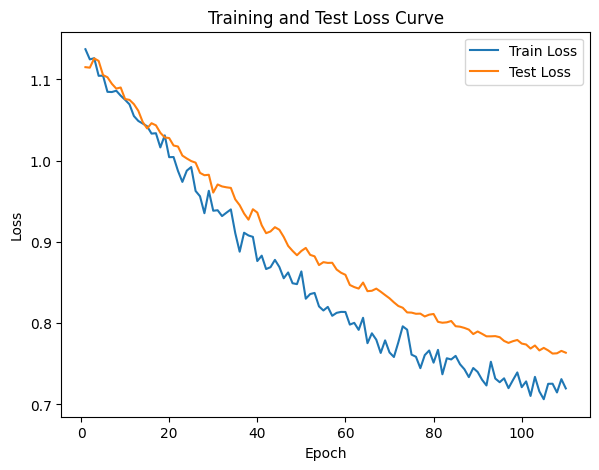

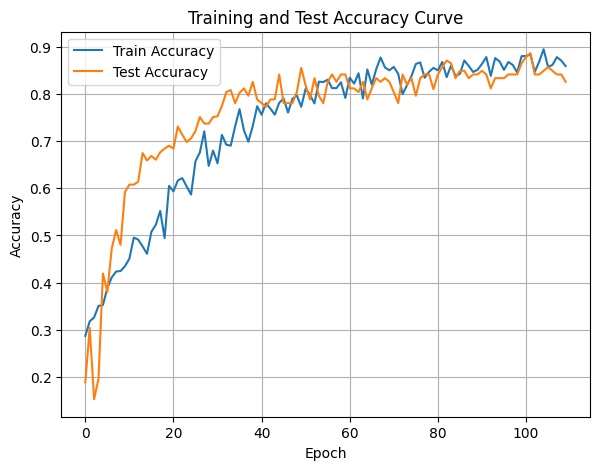

In [55]:
DTEmlp6b.train_single_model()

Randomly initializing 6 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.41it/s]

Epoch [1/10], Train F1:0.5099315383778446, Train Loss: 1.0842, Train Acc: 0.4452, Test F1:0.5467311475498071, Test Loss: 1.0749, Test Acc: 0.4253


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.16it/s]

Epoch [2/10], Train F1:0.5039396847755878, Train Loss: 1.0817, Train Acc: 0.4478, Test F1:0.5807987960825696, Test Loss: 1.0720, Test Acc: 0.4714


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.15it/s]

Epoch [3/10], Train F1:0.5053995819907453, Train Loss: 1.0821, Train Acc: 0.4531, Test F1:0.5911453470805311, Test Loss: 1.0719, Test Acc: 0.5095


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.23it/s]

Epoch [4/10], Train F1:0.5047166065228856, Train Loss: 1.0785, Train Acc: 0.4530, Test F1:0.5714446314810755, Test Loss: 1.0734, Test Acc: 0.4816


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.62it/s]

Epoch [5/10], Train F1:0.5143085389059034, Train Loss: 1.0735, Train Acc: 0.4633, Test F1:0.547118297752413, Test Loss: 1.0746, Test Acc: 0.4491


Training Process:  70%|███████   | 7/10 [00:00<00:00,  6.74it/s]

Epoch [6/10], Train F1:0.5249826145656962, Train Loss: 1.0695, Train Acc: 0.4763, Test F1:0.5725009817130952, Test Loss: 1.0728, Test Acc: 0.4883
Epoch [7/10], Train F1:0.5308816342880516, Train Loss: 1.0661, Train Acc: 0.4868, Test F1:0.5929048409277693, Test Loss: 1.0717, Test Acc: 0.5143


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.74it/s]

Epoch [8/10], Train F1:0.5375742768156665, Train Loss: 1.0616, Train Acc: 0.4948, Test F1:0.6048797388346892, Test Loss: 1.0691, Test Acc: 0.5390
Epoch [9/10], Train F1:0.5411654526128296, Train Loss: 1.0591, Train Acc: 0.5021, Test F1:0.6185813059419093, Test Loss: 1.0671, Test Acc: 0.5608


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.73it/s]


Epoch [10/10], Train F1:0.5449285810875908, Train Loss: 1.0557, Train Acc: 0.5077, Test F1:0.6255035122850883, Test Loss: 1.0662, Test Acc: 0.5766
Total Epochs: 10
Train loss start: 1.0656815767288208, Train loss end: 1.0102379322052002
Highest Mean Train Accuracy (over epoch): 0.5077083333333333
Test loss start: 1.0604934692382812, Test loss end: 1.0600908994674683
Highest mean Test Accuracy (over epoch): 0.5766493055555555


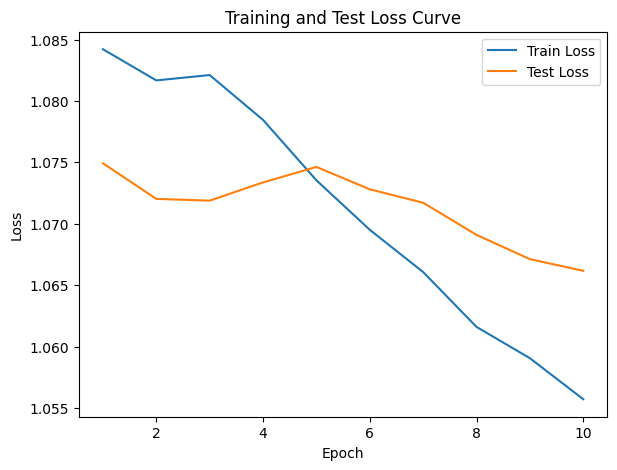

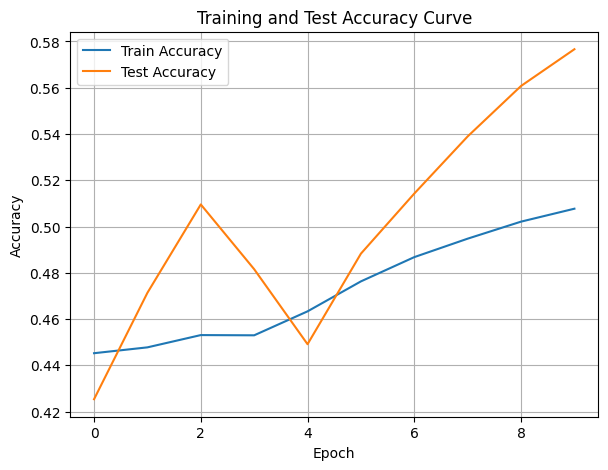

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.67it/s]

Epoch [1/10], Train F1:0.4970571323471733, Train Loss: 1.0563, Train Acc: 0.4955, Test F1:0.5819974773535146, Test Loss: 1.0679, Test Acc: 0.6233


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.01it/s]

Epoch [2/10], Train F1:0.49993127123993003, Train Loss: 1.0597, Train Acc: 0.4933, Test F1:0.5815126867758448, Test Loss: 1.0631, Test Acc: 0.6224


Training Process:  30%|███       | 3/10 [00:00<00:01,  5.41it/s]

Epoch [3/10], Train F1:0.5098444593355299, Train Loss: 1.0567, Train Acc: 0.5009, Test F1:0.5789735375368532, Test Loss: 1.0606, Test Acc: 0.6227


Training Process:  40%|████      | 4/10 [00:00<00:01,  5.13it/s]

Epoch [4/10], Train F1:0.5074635114320346, Train Loss: 1.0548, Train Acc: 0.5010, Test F1:0.57926406388429, Test Loss: 1.0539, Test Acc: 0.6337


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.18it/s]

Epoch [5/10], Train F1:0.5111822175212937, Train Loss: 1.0518, Train Acc: 0.5045, Test F1:0.5761742704932727, Test Loss: 1.0502, Test Acc: 0.6387


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.21it/s]

Epoch [6/10], Train F1:0.5131030291435094, Train Loss: 1.0489, Train Acc: 0.5098, Test F1:0.5731144461473403, Test Loss: 1.0485, Test Acc: 0.6348


Training Process:  70%|███████   | 7/10 [00:01<00:00,  4.26it/s]

Epoch [7/10], Train F1:0.5161715757019614, Train Loss: 1.0463, Train Acc: 0.5146, Test F1:0.5753177626475079, Test Loss: 1.0467, Test Acc: 0.6360


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  4.64it/s]

Epoch [8/10], Train F1:0.5205561900020866, Train Loss: 1.0450, Train Acc: 0.5183, Test F1:0.5764401428832372, Test Loss: 1.0432, Test Acc: 0.6399
Epoch [9/10], Train F1:0.5254617912436691, Train Loss: 1.0415, Train Acc: 0.5250, Test F1:0.5786949759221902, Test Loss: 1.0399, Test Acc: 0.6444


Training Process: 100%|██████████| 10/10 [00:02<00:00,  4.95it/s]


Epoch [10/10], Train F1:0.5323109711601229, Train Loss: 1.0368, Train Acc: 0.5343, Test F1:0.5823524402004361, Test Loss: 1.0368, Test Acc: 0.6488
Total Epochs: 10
Train loss start: 1.078803300857544, Train loss end: 0.8664339780807495
Highest Mean Train Accuracy (over epoch): 0.5342559523809524
Test loss start: 1.0647075176239014, Test loss end: 1.0128473043441772
Highest mean Test Accuracy (over epoch): 0.6487847222222222


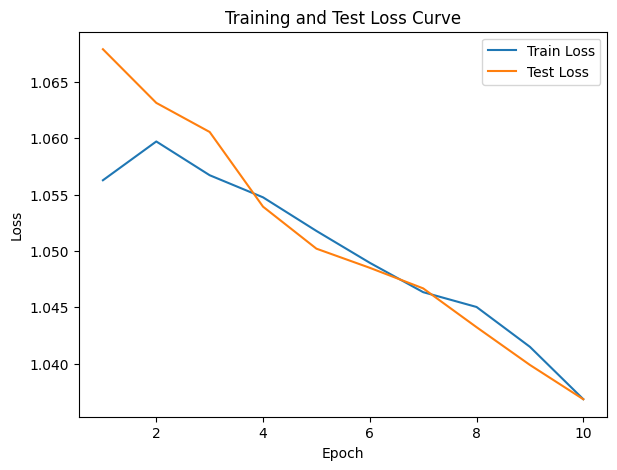

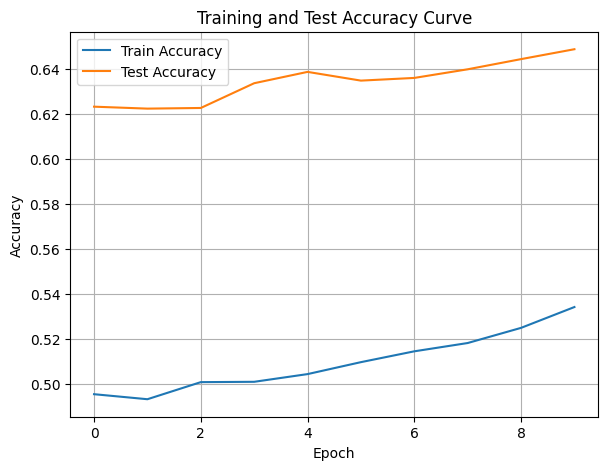

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4129229928369096, Train Loss: 1.0983, Train Acc: 0.3536, Test F1:0.5614310779755541, Test Loss: 1.0754, Test Acc: 0.5651


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.71it/s]

Epoch [2/10], Train F1:0.4334269663928166, Train Loss: 1.0954, Train Acc: 0.3665, Test F1:0.5613281608582446, Test Loss: 1.0738, Test Acc: 0.5964


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.40it/s]

Epoch [3/10], Train F1:0.4502975991294294, Train Loss: 1.0919, Train Acc: 0.3819, Test F1:0.5532723923985096, Test Loss: 1.0718, Test Acc: 0.5885


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.11it/s]

Epoch [4/10], Train F1:0.4577625073014417, Train Loss: 1.0887, Train Acc: 0.3920, Test F1:0.5508301452289864, Test Loss: 1.0718, Test Acc: 0.5812


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.10it/s]

Epoch [5/10], Train F1:0.46468779868419413, Train Loss: 1.0855, Train Acc: 0.4002, Test F1:0.55914563268287, Test Loss: 1.0683, Test Acc: 0.5948


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.14it/s]

Epoch [6/10], Train F1:0.46741411570132047, Train Loss: 1.0840, Train Acc: 0.4056, Test F1:0.5616550254609295, Test Loss: 1.0670, Test Acc: 0.6003


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.23it/s]

Epoch [7/10], Train F1:0.47005445330999784, Train Loss: 1.0823, Train Acc: 0.4084, Test F1:0.5660584158955302, Test Loss: 1.0655, Test Acc: 0.6062


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.33it/s]

Epoch [8/10], Train F1:0.47940735972500303, Train Loss: 1.0780, Train Acc: 0.4228, Test F1:0.5713464720265897, Test Loss: 1.0635, Test Acc: 0.6115


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.16it/s]

Epoch [9/10], Train F1:0.483836094795816, Train Loss: 1.0751, Train Acc: 0.4275, Test F1:0.5740393420451428, Test Loss: 1.0611, Test Acc: 0.6157


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.59it/s]


Epoch [10/10], Train F1:0.49371649191879863, Train Loss: 1.0720, Train Acc: 0.4394, Test F1:0.5740253684932902, Test Loss: 1.0593, Test Acc: 0.6183
Total Epochs: 10
Train loss start: 1.1274882555007935, Train loss end: 1.0113389492034912
Highest Mean Train Accuracy (over epoch): 0.43940476190476196
Test loss start: 1.072380781173706, Test loss end: 1.0256956815719604
Highest mean Test Accuracy (over epoch): 0.6183159722222222


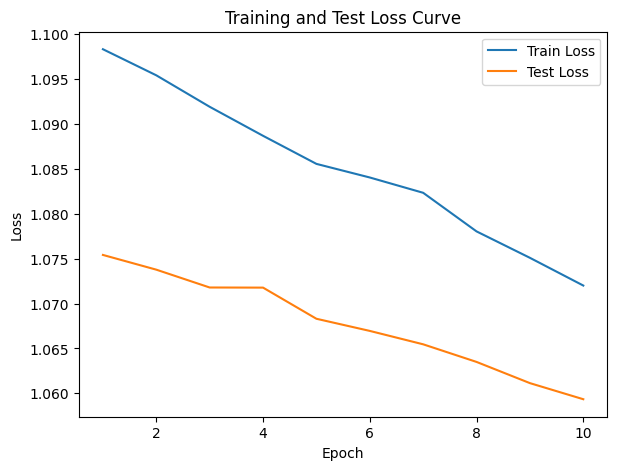

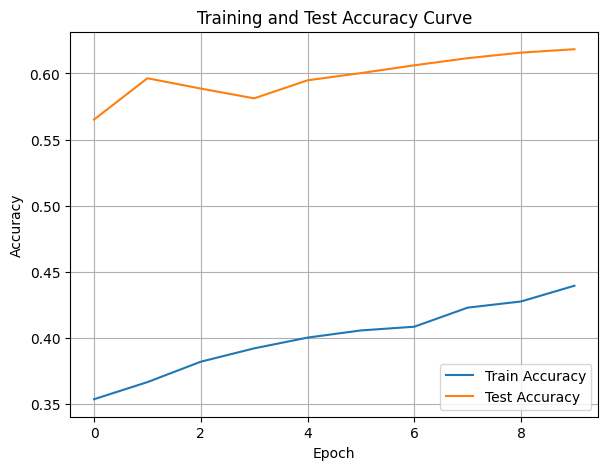

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.31it/s]

Epoch [1/10], Train F1:0.5507151181011062, Train Loss: 1.0177, Train Acc: 0.5839, Test F1:0.6022767958858184, Test Loss: 1.0639, Test Acc: 0.6667


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.50it/s]

Epoch [2/10], Train F1:0.5817941995650492, Train Loss: 1.0090, Train Acc: 0.6058, Test F1:0.595294302801385, Test Loss: 1.0646, Test Acc: 0.6658


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.75it/s]

Epoch [3/10], Train F1:0.5852831386276204, Train Loss: 1.0038, Train Acc: 0.6089, Test F1:0.5957051209750461, Test Loss: 1.0625, Test Acc: 0.6681


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.23it/s]

Epoch [4/10], Train F1:0.5994268535311003, Train Loss: 0.9976, Train Acc: 0.6185, Test F1:0.5959039923103238, Test Loss: 1.0611, Test Acc: 0.6693


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.40it/s]

Epoch [5/10], Train F1:0.6034873351415213, Train Loss: 0.9974, Train Acc: 0.6199, Test F1:0.5962155669758009, Test Loss: 1.0577, Test Acc: 0.6731


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.63it/s]

Epoch [6/10], Train F1:0.606166765197534, Train Loss: 0.9942, Train Acc: 0.6255, Test F1:0.6016716628171737, Test Loss: 1.0551, Test Acc: 0.6782


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.65it/s]

Epoch [7/10], Train F1:0.6083260244124677, Train Loss: 0.9928, Train Acc: 0.6282, Test F1:0.6078010099432558, Test Loss: 1.0534, Test Acc: 0.6830


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.36it/s]

Epoch [8/10], Train F1:0.6061517717373472, Train Loss: 0.9894, Train Acc: 0.6291, Test F1:0.6173752870705779, Test Loss: 1.0514, Test Acc: 0.6886


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.99it/s]


Epoch [9/10], Train F1:0.6086455043606812, Train Loss: 0.9870, Train Acc: 0.6328, Test F1:0.6213317313258175, Test Loss: 1.0488, Test Acc: 0.6912
Epoch [10/10], Train F1:0.6124735117589621, Train Loss: 0.9841, Train Acc: 0.6383, Test F1:0.6251205716297655, Test Loss: 1.0469, Test Acc: 0.6940
Total Epochs: 10
Train loss start: 1.0289061069488525, Train loss end: 0.8681473731994629
Highest Mean Train Accuracy (over epoch): 0.6383333333333333
Test loss start: 1.0623754262924194, Test loss end: 1.0151559114456177
Highest mean Test Accuracy (over epoch): 0.6940104166666666


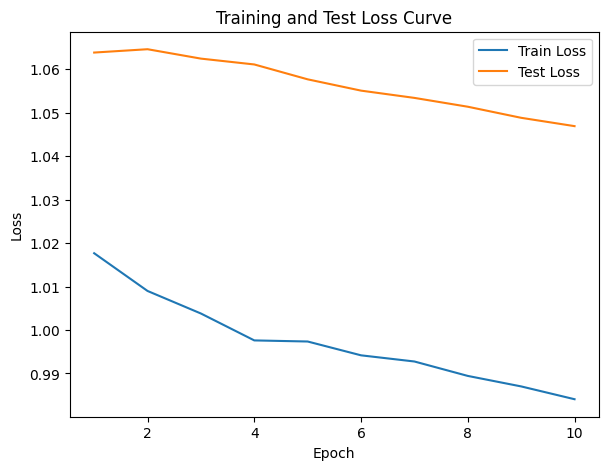

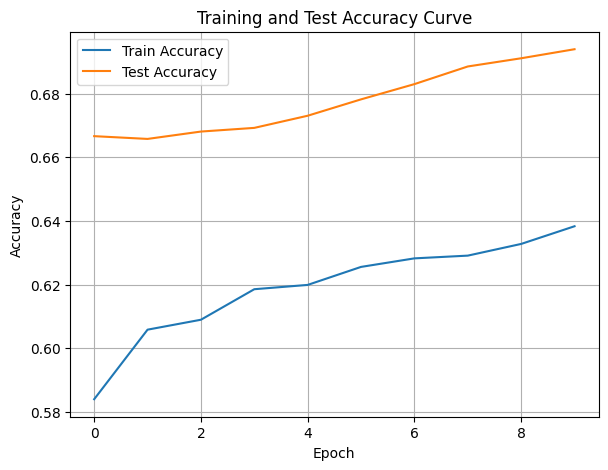

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.89it/s]

Epoch [1/10], Train F1:0.5094733429845985, Train Loss: 1.0603, Train Acc: 0.4839, Test F1:0.5749316531783535, Test Loss: 1.0353, Test Acc: 0.6337


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.05it/s]

Epoch [2/10], Train F1:0.4995668109796875, Train Loss: 1.0631, Train Acc: 0.4719, Test F1:0.5584157026460503, Test Loss: 1.0215, Test Acc: 0.6385


Training Process:  30%|███       | 3/10 [00:00<00:01,  5.52it/s]

Epoch [3/10], Train F1:0.5156336081062786, Train Loss: 1.0549, Train Acc: 0.4894, Test F1:0.5497256850640309, Test Loss: 1.0105, Test Acc: 0.6447


Training Process:  40%|████      | 4/10 [00:00<00:01,  5.13it/s]

Epoch [4/10], Train F1:0.5190648302422328, Train Loss: 1.0527, Train Acc: 0.4979, Test F1:0.5496063885129054, Test Loss: 1.0058, Test Acc: 0.6497


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.01it/s]

Epoch [5/10], Train F1:0.5213288306759364, Train Loss: 1.0502, Train Acc: 0.4996, Test F1:0.553900209994811, Test Loss: 1.0021, Test Acc: 0.6559
Epoch [6/10], Train F1:0.5247553471987317, Train Loss: 1.0474, Train Acc: 0.5041, Test F1:0.5587227941294927, Test Loss: 0.9974, Test Acc: 0.6600


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.61it/s]

Epoch [7/10], Train F1:0.5280187657681829, Train Loss: 1.0446, Train Acc: 0.5068, Test F1:0.5605045037361321, Test Loss: 0.9939, Test Acc: 0.6629
Epoch [8/10], Train F1:0.5301088556402007, Train Loss: 1.0418, Train Acc: 0.5089, Test F1:0.559319248544024, Test Loss: 0.9903, Test Acc: 0.6642


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.89it/s]


Epoch [9/10], Train F1:0.5355975610659711, Train Loss: 1.0386, Train Acc: 0.5159, Test F1:0.560624840344224, Test Loss: 0.9861, Test Acc: 0.6660
Epoch [10/10], Train F1:0.5412215568739869, Train Loss: 1.0354, Train Acc: 0.5220, Test F1:0.5668890067939356, Test Loss: 0.9838, Test Acc: 0.6704
Total Epochs: 10
Train loss start: 1.0591330528259277, Train loss end: 1.0056705474853516
Highest Mean Train Accuracy (over epoch): 0.5219940476190476
Test loss start: 1.037926197052002, Test loss end: 0.9458993077278137
Highest mean Test Accuracy (over epoch): 0.6703993055555555


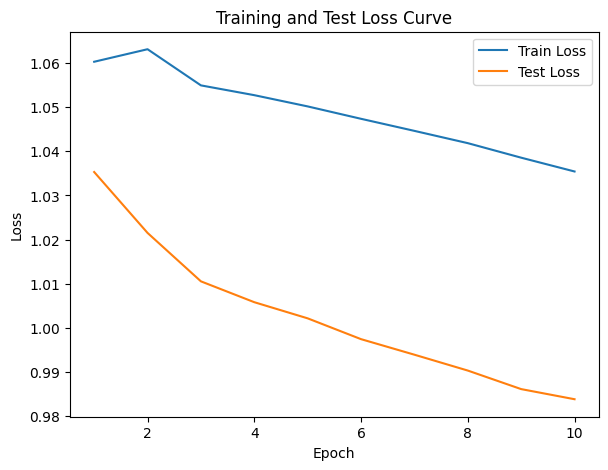

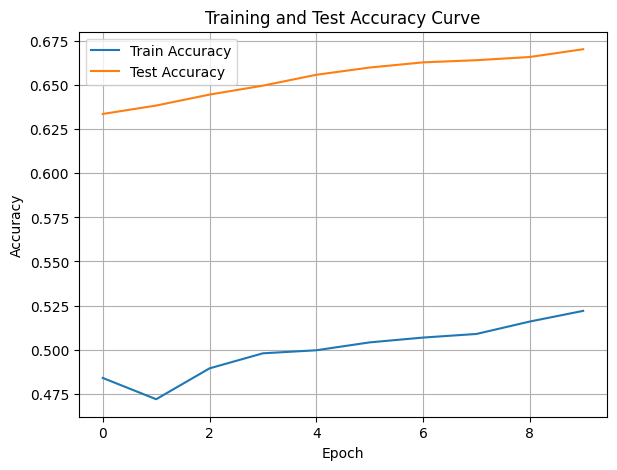

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.79it/s]

Epoch [1/10], Train F1:0.42004240204240195, Train Loss: 1.0910, Train Acc: 0.3756, Test F1:0.25829216426135554, Test Loss: 1.0961, Test Acc: 0.2847
Epoch [2/10], Train F1:0.4132193681247037, Train Loss: 1.0934, Train Acc: 0.3582, Test F1:0.2828051809049721, Test Loss: 1.0907, Test Acc: 0.3043


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.79it/s]

Epoch [3/10], Train F1:0.4113271077671665, Train Loss: 1.0936, Train Acc: 0.3535, Test F1:0.2988975788166584, Test Loss: 1.0871, Test Acc: 0.3160


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.77it/s]

Epoch [4/10], Train F1:0.42126727221759436, Train Loss: 1.0935, Train Acc: 0.3610, Test F1:0.3068440353295946, Test Loss: 1.0855, Test Acc: 0.3199


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.88it/s]

Epoch [5/10], Train F1:0.43100863412715246, Train Loss: 1.0920, Train Acc: 0.3705, Test F1:0.31374902279347855, Test Loss: 1.0832, Test Acc: 0.3253


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.61it/s]

Epoch [6/10], Train F1:0.43785302442080987, Train Loss: 1.0912, Train Acc: 0.3788, Test F1:0.317147196305797, Test Loss: 1.0815, Test Acc: 0.3290


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.13it/s]

Epoch [7/10], Train F1:0.4503442495012392, Train Loss: 1.0871, Train Acc: 0.3919, Test F1:0.3182768563310087, Test Loss: 1.0793, Test Acc: 0.3327


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.91it/s]

Epoch [8/10], Train F1:0.45480743382896016, Train Loss: 1.0844, Train Acc: 0.3961, Test F1:0.3199054562547958, Test Loss: 1.0772, Test Acc: 0.3365


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.83it/s]

Epoch [9/10], Train F1:0.46503949609988204, Train Loss: 1.0807, Train Acc: 0.4066, Test F1:0.3179379815621105, Test Loss: 1.0755, Test Acc: 0.3377


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.74it/s]


Epoch [10/10], Train F1:0.4746176572845407, Train Loss: 1.0773, Train Acc: 0.4173, Test F1:0.3383252013374128, Test Loss: 1.0739, Test Acc: 0.3482
Total Epochs: 10
Train loss start: 1.0388882160186768, Train loss end: 1.03916335105896
Highest Mean Train Accuracy (over epoch): 0.4172619047619048
Test loss start: 1.096707820892334, Test loss end: 1.0543345212936401
Highest mean Test Accuracy (over epoch): 0.34817708333333336


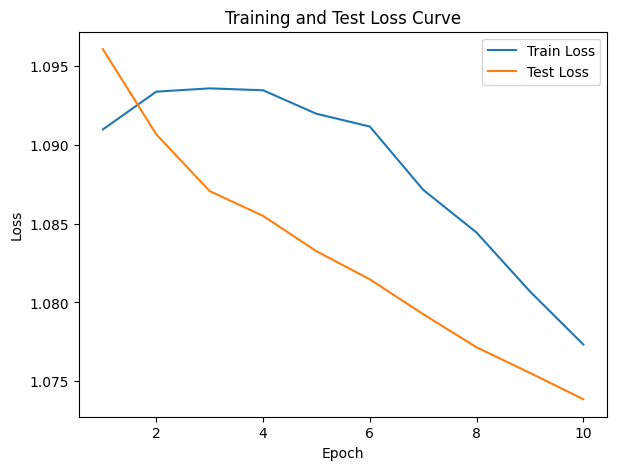

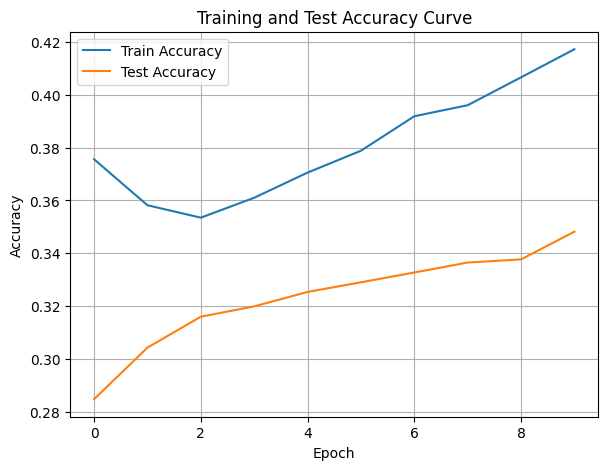

./saved_models/model_6.pth
Training Model with id 11
in multi


Epoch [1/10], Train F1:0.5155908217844521, Train Loss: 1.0497, Train Acc: 0.4851, Test F1:0.4072798819478603, Test Loss: 1.0534, Test Acc: 0.3880


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.48it/s]

Epoch [2/10], Train F1:0.5389237191317894, Train Loss: 1.0459, Train Acc: 0.4979, Test F1:0.382218244136597, Test Loss: 1.0525, Test Acc: 0.3793
Epoch [3/10], Train F1:0.5404129516805573, Train Loss: 1.0398, Train Acc: 0.5093, Test F1:0.41082252567533567, Test Loss: 1.0522, Test Acc: 0.3999


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.19it/s]

Epoch [4/10], Train F1:0.5428571086570246, Train Loss: 1.0372, Train Acc: 0.5108, Test F1:0.42628279918570317, Test Loss: 1.0505, Test Acc: 0.4086
Epoch [5/10], Train F1:0.5592736166758819, Train Loss: 1.0318, Train Acc: 0.5267, Test F1:0.458240865046531, Test Loss: 1.0493, Test Acc: 0.4335


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.07it/s]

Epoch [6/10], Train F1:0.5685168887610951, Train Loss: 1.0297, Train Acc: 0.5346, Test F1:0.47222409204189997, Test Loss: 1.0470, Test Acc: 0.4485
Epoch [7/10], Train F1:0.575397744407658, Train Loss: 1.0263, Train Acc: 0.5433, Test F1:0.4865942477937025, Test Loss: 1.0459, Test Acc: 0.4614


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.12it/s]

Epoch [8/10], Train F1:0.5830468913078289, Train Loss: 1.0238, Train Acc: 0.5507, Test F1:0.521795803049797, Test Loss: 1.0446, Test Acc: 0.4935
Epoch [9/10], Train F1:0.5916013577192932, Train Loss: 1.0196, Train Acc: 0.5614, Test F1:0.5449282615949282, Test Loss: 1.0431, Test Acc: 0.5167


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.58it/s]


Epoch [10/10], Train F1:0.5993241101501449, Train Loss: 1.0167, Train Acc: 0.5697, Test F1:0.5606332860937692, Test Loss: 1.0413, Test Acc: 0.5331
Total Epochs: 10
Train loss start: 1.0391291379928589, Train loss end: 1.0136665105819702
Highest Mean Train Accuracy (over epoch): 0.5697023809523809
Test loss start: 1.0537889003753662, Test loss end: 1.0150351524353027
Highest mean Test Accuracy (over epoch): 0.5330729166666666


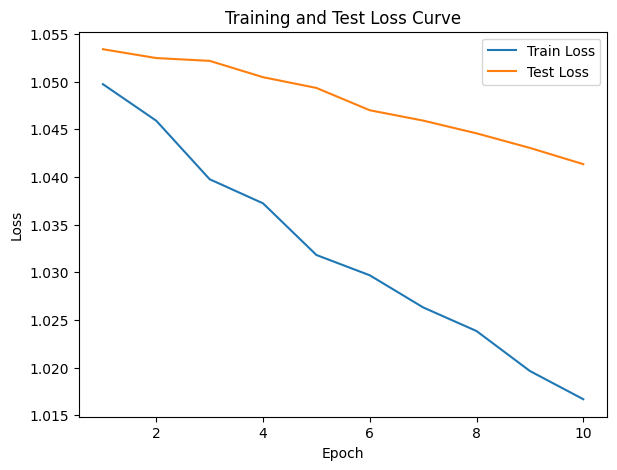

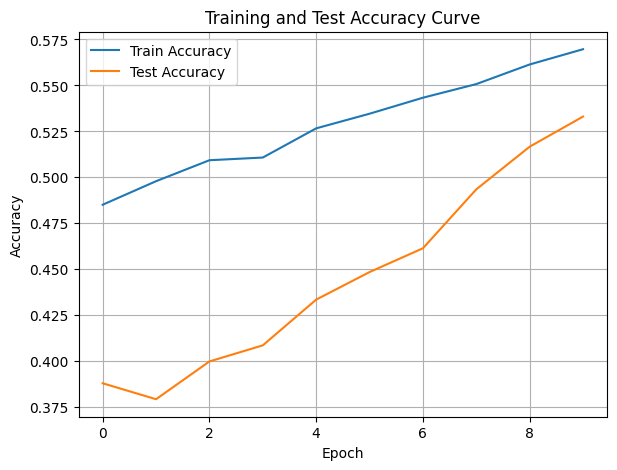

./saved_models/model_11.pth
Training Model with id 9
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.71it/s]

Epoch [1/10], Train F1:0.6392009521399167, Train Loss: 0.9792, Train Acc: 0.6268, Test F1:0.7543859649122807, Test Loss: 1.0148, Test Acc: 0.7569


Training Process:  20%|██        | 2/10 [00:00<00:01,  8.00it/s]

Epoch [2/10], Train F1:0.653217210485033, Train Loss: 0.9759, Train Acc: 0.6409, Test F1:0.7394527986633249, Test Loss: 1.0144, Test Acc: 0.7352


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.45it/s]

Epoch [3/10], Train F1:0.6584285434969551, Train Loss: 0.9724, Train Acc: 0.6488, Test F1:0.7483736920952607, Test Loss: 1.0160, Test Acc: 0.7410


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.81it/s]

Epoch [4/10], Train F1:0.6701596847876797, Train Loss: 0.9719, Train Acc: 0.6571, Test F1:0.7508868406210111, Test Loss: 1.0143, Test Acc: 0.7485


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.74it/s]

Epoch [5/10], Train F1:0.6742985158780237, Train Loss: 0.9682, Train Acc: 0.6629, Test F1:0.7445716593393182, Test Loss: 1.0134, Test Acc: 0.7387
Epoch [6/10], Train F1:0.6794350620509733, Train Loss: 0.9674, Train Acc: 0.6690, Test F1:0.7513979904961208, Test Loss: 1.0109, Test Acc: 0.7480


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.17it/s]

Epoch [7/10], Train F1:0.6857417186438718, Train Loss: 0.9631, Train Acc: 0.6766, Test F1:0.755671492870168, Test Loss: 1.0090, Test Acc: 0.7526
Epoch [8/10], Train F1:0.6919426896998809, Train Loss: 0.9613, Train Acc: 0.6828, Test F1:0.7630912122434591, Test Loss: 1.0066, Test Acc: 0.7615


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.41it/s]


Epoch [9/10], Train F1:0.6914844675875211, Train Loss: 0.9610, Train Acc: 0.6816, Test F1:0.7691823544294799, Test Loss: 1.0055, Test Acc: 0.7686
Epoch [10/10], Train F1:0.6964976243972895, Train Loss: 0.9579, Train Acc: 0.6871, Test F1:0.7710335794006162, Test Loss: 1.0034, Test Acc: 0.7714
Total Epochs: 10
Train loss start: 0.9750899076461792, Train loss end: 0.8679959177970886
Highest Mean Train Accuracy (over epoch): 0.6871428571428572
Test loss start: 1.0115933418273926, Test loss end: 0.9708229899406433
Highest mean Test Accuracy (over epoch): 0.7713541666666666


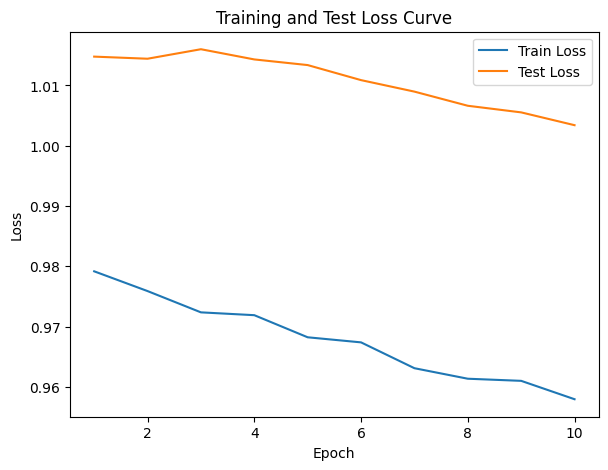

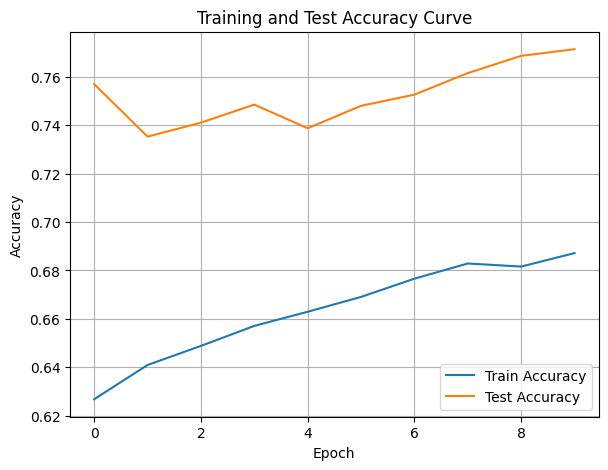

./saved_models/model_9.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7450536075821335, Train Loss: 0.9275, Train Acc: 0.7414, Test F1:0.8074780881654505, Test Loss: 0.9849, Test Acc: 0.8177


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.06it/s]

Epoch [2/10], Train F1:0.739255204626169, Train Loss: 0.9298, Train Acc: 0.7345, Test F1:0.8134828797762729, Test Loss: 0.9864, Test Acc: 0.8186
Epoch [3/10], Train F1:0.740852997467649, Train Loss: 0.9258, Train Acc: 0.7386, Test F1:0.8148480576911954, Test Loss: 0.9838, Test Acc: 0.8209


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.57it/s]

Epoch [4/10], Train F1:0.7422928087441069, Train Loss: 0.9237, Train Acc: 0.7398, Test F1:0.819313240365872, Test Loss: 0.9811, Test Acc: 0.8240
Epoch [5/10], Train F1:0.743018844363612, Train Loss: 0.9225, Train Acc: 0.7405, Test F1:0.8176711625696225, Test Loss: 0.9800, Test Acc: 0.8215
Epoch [6/10], Train F1:0.7478875374248984, Train Loss: 0.9185, Train Acc: 0.7436, Test F1:0.8182154762298436, Test Loss: 0.9779, Test Acc: 0.8212


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.08it/s]

Epoch [7/10], Train F1:0.750353735552984, Train Loss: 0.9156, Train Acc: 0.7466, Test F1:0.8192664015462886, Test Loss: 0.9753, Test Acc: 0.8218
Epoch [8/10], Train F1:0.7553808623924602, Train Loss: 0.9124, Train Acc: 0.7523, Test F1:0.8164388328360471, Test Loss: 0.9735, Test Acc: 0.8196


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.41it/s]


Epoch [9/10], Train F1:0.7568272318334774, Train Loss: 0.9105, Train Acc: 0.7520, Test F1:0.8165481734504271, Test Loss: 0.9722, Test Acc: 0.8187
Epoch [10/10], Train F1:0.7629175289183279, Train Loss: 0.9055, Train Acc: 0.7593, Test F1:0.8178017860184441, Test Loss: 0.9709, Test Acc: 0.8195
Total Epochs: 10
Train loss start: 0.9709156155586243, Train loss end: 0.7491244077682495
Highest Mean Train Accuracy (over epoch): 0.7592857142857142
Test loss start: 0.9802146553993225, Test loss end: 0.9400358200073242
Highest mean Test Accuracy (over epoch): 0.8240017361111112


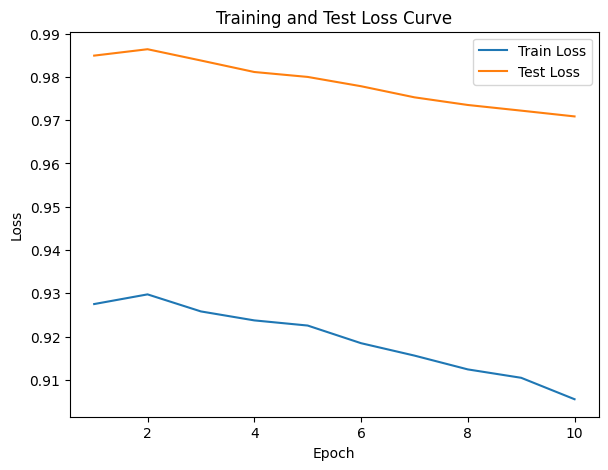

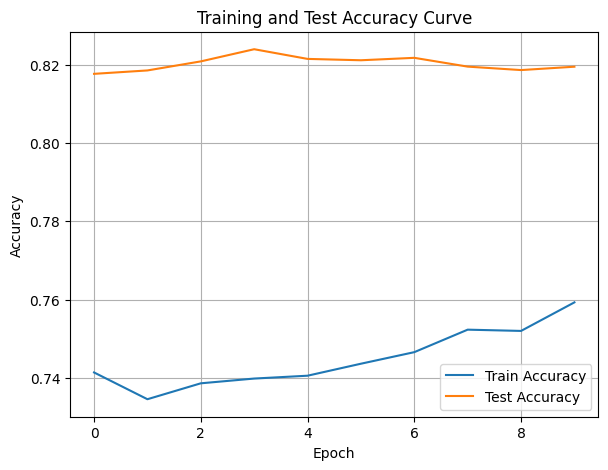

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.34it/s]

Epoch [1/10], Train F1:0.773547043923476, Train Loss: 0.8770, Train Acc: 0.7842, Test F1:0.8275470231153375, Test Loss: 0.9537, Test Acc: 0.8333


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.88it/s]

Epoch [2/10], Train F1:0.7772897129982708, Train Loss: 0.8857, Train Acc: 0.7778, Test F1:0.8381003325813429, Test Loss: 0.9510, Test Acc: 0.8411


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.29it/s]

Epoch [3/10], Train F1:0.7796175396378351, Train Loss: 0.8810, Train Acc: 0.7778, Test F1:0.8236625318570688, Test Loss: 0.9496, Test Acc: 0.8287


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.75it/s]

Epoch [4/10], Train F1:0.7864740576197229, Train Loss: 0.8719, Train Acc: 0.7885, Test F1:0.8242016991041363, Test Loss: 0.9463, Test Acc: 0.8299


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.01it/s]

Epoch [5/10], Train F1:0.7863212003482573, Train Loss: 0.8689, Train Acc: 0.7874, Test F1:0.8255646880171059, Test Loss: 0.9445, Test Acc: 0.8293


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.46it/s]

Epoch [6/10], Train F1:0.7887327389747419, Train Loss: 0.8673, Train Acc: 0.7895, Test F1:0.8278186518194471, Test Loss: 0.9422, Test Acc: 0.8313


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.01it/s]

Epoch [7/10], Train F1:0.788727828881225, Train Loss: 0.8662, Train Acc: 0.7908, Test F1:0.8331823735369924, Test Loss: 0.9397, Test Acc: 0.8361


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.99it/s]

Epoch [8/10], Train F1:0.7923954033112431, Train Loss: 0.8650, Train Acc: 0.7931, Test F1:0.8357801233410601, Test Loss: 0.9372, Test Acc: 0.8387


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.04it/s]

Epoch [9/10], Train F1:0.7966640995201066, Train Loss: 0.8631, Train Acc: 0.7977, Test F1:0.8356149986421053, Test Loss: 0.9352, Test Acc: 0.8383


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.30it/s]


Epoch [10/10], Train F1:0.7987214893242113, Train Loss: 0.8613, Train Acc: 0.7993, Test F1:0.8334993512149168, Test Loss: 0.9330, Test Acc: 0.8364
Total Epochs: 10
Train loss start: 0.9017668962478638, Train loss end: 0.8581530451774597
Highest Mean Train Accuracy (over epoch): 0.7993154761904762
Test loss start: 0.9506669044494629, Test loss end: 0.893840491771698
Highest mean Test Accuracy (over epoch): 0.8411458333333334


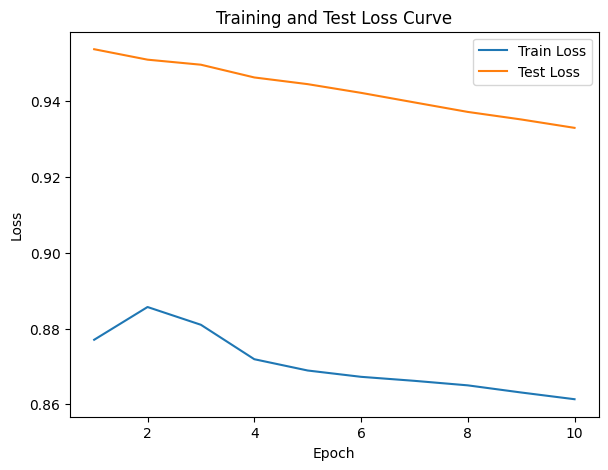

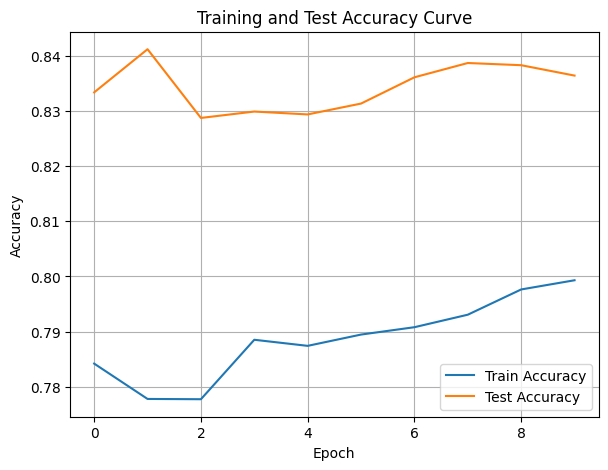

./saved_models/model_10.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8077667964713454, Train Loss: 0.8478, Train Acc: 0.8080, Test F1:0.792308515190415, Test Loss: 0.9173, Test Acc: 0.7977


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.54it/s]

Epoch [2/10], Train F1:0.8233583467401361, Train Loss: 0.8326, Train Acc: 0.8253, Test F1:0.8146241658656701, Test Loss: 0.9159, Test Acc: 0.8194
Epoch [3/10], Train F1:0.8164133204463581, Train Loss: 0.8342, Train Acc: 0.8199, Test F1:0.8279497764017887, Test Loss: 0.9122, Test Acc: 0.8319


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.68it/s]

Epoch [4/10], Train F1:0.8164892151467271, Train Loss: 0.8335, Train Acc: 0.8209, Test F1:0.8324687843484836, Test Loss: 0.9098, Test Acc: 0.8362


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.53it/s]

Epoch [5/10], Train F1:0.8149189265559925, Train Loss: 0.8327, Train Acc: 0.8173, Test F1:0.8348074521936486, Test Loss: 0.9084, Test Acc: 0.8387
Epoch [6/10], Train F1:0.8187634277390374, Train Loss: 0.8310, Train Acc: 0.8215, Test F1:0.834690618165025, Test Loss: 0.9074, Test Acc: 0.8391


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.52it/s]

Epoch [7/10], Train F1:0.8210127956770229, Train Loss: 0.8284, Train Acc: 0.8247, Test F1:0.8362908912971518, Test Loss: 0.9055, Test Acc: 0.8405
Epoch [8/10], Train F1:0.821823469896813, Train Loss: 0.8269, Train Acc: 0.8259, Test F1:0.8360195393269586, Test Loss: 0.9037, Test Acc: 0.8406


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.79it/s]


Epoch [9/10], Train F1:0.8243044977001343, Train Loss: 0.8255, Train Acc: 0.8284, Test F1:0.837113075901365, Test Loss: 0.9024, Test Acc: 0.8415
Epoch [10/10], Train F1:0.8257317168995187, Train Loss: 0.8233, Train Acc: 0.8306, Test F1:0.8389829303590296, Test Loss: 0.9017, Test Acc: 0.8431
Total Epochs: 10
Train loss start: 0.8589401841163635, Train loss end: 0.7006627321243286
Highest Mean Train Accuracy (over epoch): 0.8305654761904762
Test loss start: 0.9113373756408691, Test loss end: 0.8793220520019531
Highest mean Test Accuracy (over epoch): 0.8430555555555557


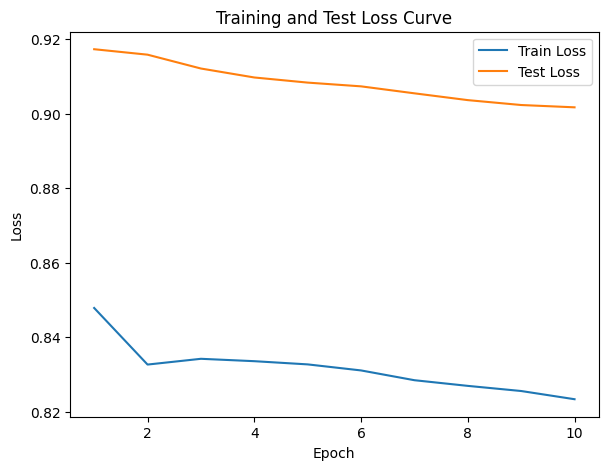

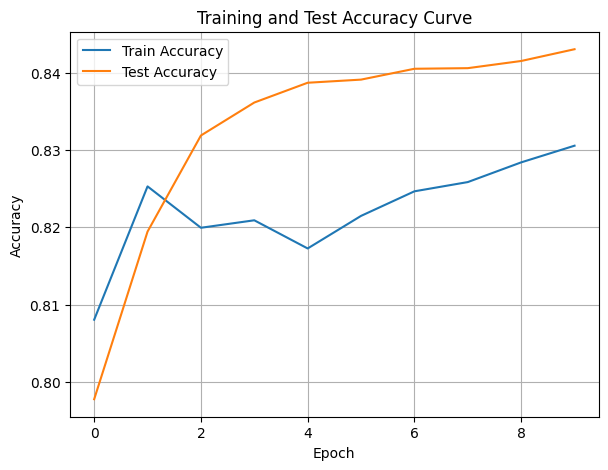

./saved_models/model_8.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [56]:
DTEmlp6b.train_DTE()

Training Process:   1%|          | 1/110 [00:00<00:16,  6.59it/s]

Epoch [1/110], Train F1:0.33583329937028944, Train Loss: 1.1425, Train Acc: 0.2649, Test F1:0.5218554861730598, Test Loss: 1.0896, Test Acc: 0.4939


Training Process:   2%|▏         | 2/110 [00:00<00:14,  7.68it/s]

Epoch [2/110], Train F1:0.36933211715820413, Train Loss: 1.1284, Train Acc: 0.2957, Test F1:0.5339666543672132, Test Loss: 1.0844, Test Acc: 0.5243


Training Process:   3%|▎         | 3/110 [00:00<00:12,  8.58it/s]

Epoch [3/110], Train F1:0.3583671780719144, Train Loss: 1.1305, Train Acc: 0.2872, Test F1:0.544642392570724, Test Loss: 1.0812, Test Acc: 0.5443


Training Process:   4%|▎         | 4/110 [00:00<00:12,  8.79it/s]

Epoch [4/110], Train F1:0.3720354587326325, Train Loss: 1.1250, Train Acc: 0.3039, Test F1:0.551885814082718, Test Loss: 1.0805, Test Acc: 0.5503


Training Process:   5%|▍         | 5/110 [00:00<00:12,  8.73it/s]

Epoch [5/110], Train F1:0.38741487219005827, Train Loss: 1.1214, Train Acc: 0.3210, Test F1:0.5624645471879034, Test Loss: 1.0768, Test Acc: 0.5634


Training Process:   5%|▌         | 6/110 [00:00<00:12,  8.61it/s]

Epoch [6/110], Train F1:0.38421875095818714, Train Loss: 1.1211, Train Acc: 0.3159, Test F1:0.5745034227359443, Test Loss: 1.0745, Test Acc: 0.5718


Training Process:   6%|▋         | 7/110 [00:00<00:11,  8.66it/s]

Epoch [7/110], Train F1:0.39593874300593906, Train Loss: 1.1167, Train Acc: 0.3273, Test F1:0.5811988722934718, Test Loss: 1.0723, Test Acc: 0.5800


Training Process:   7%|▋         | 8/110 [00:00<00:11,  8.61it/s]

Epoch [8/110], Train F1:0.4075102101481366, Train Loss: 1.1135, Train Acc: 0.3386, Test F1:0.5926606146472863, Test Loss: 1.0709, Test Acc: 0.5918


Training Process:   8%|▊         | 9/110 [00:01<00:12,  8.34it/s]

Epoch [9/110], Train F1:0.4225384841849344, Train Loss: 1.1088, Train Acc: 0.3520, Test F1:0.6027041441492075, Test Loss: 1.0681, Test Acc: 0.6038


Training Process:   9%|▉         | 10/110 [00:01<00:13,  7.48it/s]

Epoch [10/110], Train F1:0.43162804306508595, Train Loss: 1.1059, Train Acc: 0.3590, Test F1:0.6116730052306164, Test Loss: 1.0656, Test Acc: 0.6140


Training Process:  10%|█         | 11/110 [00:01<00:13,  7.51it/s]

Epoch [11/110], Train F1:0.43957475663737977, Train Loss: 1.1024, Train Acc: 0.3675, Test F1:0.6193041169530934, Test Loss: 1.0645, Test Acc: 0.6209


Training Process:  11%|█         | 12/110 [00:01<00:13,  7.51it/s]

Epoch [12/110], Train F1:0.45020754439901434, Train Loss: 1.0989, Train Acc: 0.3773, Test F1:0.6266685702270711, Test Loss: 1.0627, Test Acc: 0.6285


Training Process:  12%|█▏        | 13/110 [00:01<00:13,  7.46it/s]

Epoch [13/110], Train F1:0.46171337949939634, Train Loss: 1.0946, Train Acc: 0.3886, Test F1:0.6345553388604651, Test Loss: 1.0607, Test Acc: 0.6373


Training Process:  13%|█▎        | 14/110 [00:01<00:12,  7.42it/s]

Epoch [14/110], Train F1:0.4674846907746162, Train Loss: 1.0911, Train Acc: 0.3948, Test F1:0.6433123009141719, Test Loss: 1.0585, Test Acc: 0.6458


Training Process:  14%|█▎        | 15/110 [00:01<00:12,  7.35it/s]

Epoch [15/110], Train F1:0.47517042980433594, Train Loss: 1.0882, Train Acc: 0.4020, Test F1:0.6508833059737306, Test Loss: 1.0570, Test Acc: 0.6538


Training Process:  15%|█▍        | 16/110 [00:02<00:13,  7.19it/s]

Epoch [16/110], Train F1:0.4813674288734894, Train Loss: 1.0853, Train Acc: 0.4093, Test F1:0.656800974005774, Test Loss: 1.0550, Test Acc: 0.6599


Training Process:  15%|█▌        | 17/110 [00:02<00:13,  6.92it/s]

Epoch [17/110], Train F1:0.49121668057406476, Train Loss: 1.0818, Train Acc: 0.4192, Test F1:0.6621319632492064, Test Loss: 1.0527, Test Acc: 0.6658


Training Process:  16%|█▋        | 18/110 [00:02<00:12,  7.10it/s]

Epoch [18/110], Train F1:0.49846677206974105, Train Loss: 1.0786, Train Acc: 0.4270, Test F1:0.6687655167278992, Test Loss: 1.0507, Test Acc: 0.6731


Training Process:  18%|█▊        | 20/110 [00:02<00:13,  6.73it/s]

Epoch [19/110], Train F1:0.5073037474598191, Train Loss: 1.0747, Train Acc: 0.4371, Test F1:0.6748172093264513, Test Loss: 1.0490, Test Acc: 0.6784
Epoch [20/110], Train F1:0.5141484493571281, Train Loss: 1.0714, Train Acc: 0.4458, Test F1:0.6814652373175846, Test Loss: 1.0472, Test Acc: 0.6848


Training Process:  20%|██        | 22/110 [00:02<00:13,  6.76it/s]

Epoch [21/110], Train F1:0.5226865544727997, Train Loss: 1.0680, Train Acc: 0.4552, Test F1:0.6871058723741602, Test Loss: 1.0455, Test Acc: 0.6904
Epoch [22/110], Train F1:0.5300830252341664, Train Loss: 1.0645, Train Acc: 0.4638, Test F1:0.6916748652181914, Test Loss: 1.0439, Test Acc: 0.6956


Training Process:  22%|██▏       | 24/110 [00:03<00:12,  6.62it/s]

Epoch [23/110], Train F1:0.5368440750956112, Train Loss: 1.0610, Train Acc: 0.4722, Test F1:0.696696044420237, Test Loss: 1.0419, Test Acc: 0.7012
Epoch [24/110], Train F1:0.5444987405507763, Train Loss: 1.0576, Train Acc: 0.4810, Test F1:0.7007911064366242, Test Loss: 1.0398, Test Acc: 0.7061


Training Process:  24%|██▎       | 26/110 [00:03<00:12,  6.74it/s]

Epoch [25/110], Train F1:0.5519483519562974, Train Loss: 1.0540, Train Acc: 0.4902, Test F1:0.7055193486770329, Test Loss: 1.0376, Test Acc: 0.7112
Epoch [26/110], Train F1:0.5584511851204085, Train Loss: 1.0507, Train Acc: 0.4980, Test F1:0.7095836941221679, Test Loss: 1.0357, Test Acc: 0.7153


Training Process:  25%|██▌       | 28/110 [00:03<00:11,  6.89it/s]

Epoch [27/110], Train F1:0.5639297880585553, Train Loss: 1.0474, Train Acc: 0.5052, Test F1:0.7145073668169994, Test Loss: 1.0339, Test Acc: 0.7203
Epoch [28/110], Train F1:0.5694202019498017, Train Loss: 1.0445, Train Acc: 0.5120, Test F1:0.7192174160719922, Test Loss: 1.0323, Test Acc: 0.7249


Training Process:  27%|██▋       | 30/110 [00:04<00:12,  6.24it/s]

Epoch [29/110], Train F1:0.5750767512358036, Train Loss: 1.0414, Train Acc: 0.5191, Test F1:0.7227732034471973, Test Loss: 1.0304, Test Acc: 0.7284
Epoch [30/110], Train F1:0.5803736614567753, Train Loss: 1.0382, Train Acc: 0.5256, Test F1:0.726085274187479, Test Loss: 1.0283, Test Acc: 0.7317


Training Process:  28%|██▊       | 31/110 [00:04<00:13,  5.99it/s]

Epoch [31/110], Train F1:0.586333642263359, Train Loss: 1.0352, Train Acc: 0.5321, Test F1:0.7287989014652481, Test Loss: 1.0267, Test Acc: 0.7345


Training Process:  30%|███       | 33/110 [00:04<00:13,  5.82it/s]

Epoch [32/110], Train F1:0.5925274876993828, Train Loss: 1.0318, Train Acc: 0.5398, Test F1:0.7301148750041786, Test Loss: 1.0250, Test Acc: 0.7365
Epoch [33/110], Train F1:0.5973740448935233, Train Loss: 1.0289, Train Acc: 0.5455, Test F1:0.7325395775488407, Test Loss: 1.0234, Test Acc: 0.7390


Training Process:  31%|███       | 34/110 [00:04<00:13,  5.75it/s]

Epoch [34/110], Train F1:0.6016600727566014, Train Loss: 1.0262, Train Acc: 0.5509, Test F1:0.7349339593649228, Test Loss: 1.0212, Test Acc: 0.7413


Training Process:  32%|███▏      | 35/110 [00:05<00:13,  5.72it/s]

Epoch [35/110], Train F1:0.6064565651322367, Train Loss: 1.0234, Train Acc: 0.5562, Test F1:0.7370764063604465, Test Loss: 1.0192, Test Acc: 0.7436


Training Process:  33%|███▎      | 36/110 [00:05<00:13,  5.49it/s]

Epoch [36/110], Train F1:0.6116599290666507, Train Loss: 1.0201, Train Acc: 0.5623, Test F1:0.7402790035446518, Test Loss: 1.0176, Test Acc: 0.7465


Training Process:  34%|███▎      | 37/110 [00:05<00:13,  5.31it/s]

Epoch [37/110], Train F1:0.6157153058161788, Train Loss: 1.0171, Train Acc: 0.5676, Test F1:0.7435068553470147, Test Loss: 1.0163, Test Acc: 0.7495


Training Process:  35%|███▍      | 38/110 [00:05<00:14,  4.83it/s]

Epoch [38/110], Train F1:0.6200992033648043, Train Loss: 1.0143, Train Acc: 0.5729, Test F1:0.7462506053475142, Test Loss: 1.0145, Test Acc: 0.7521


Training Process:  35%|███▌      | 39/110 [00:05<00:14,  4.92it/s]

Epoch [39/110], Train F1:0.6244926971882998, Train Loss: 1.0114, Train Acc: 0.5784, Test F1:0.74777623308876, Test Loss: 1.0128, Test Acc: 0.7540


Training Process:  36%|███▋      | 40/110 [00:06<00:14,  4.92it/s]

Epoch [40/110], Train F1:0.6285574817305988, Train Loss: 1.0086, Train Acc: 0.5836, Test F1:0.7496033574562737, Test Loss: 1.0112, Test Acc: 0.7558


Training Process:  38%|███▊      | 42/110 [00:06<00:13,  5.21it/s]

Epoch [41/110], Train F1:0.6326512560877798, Train Loss: 1.0060, Train Acc: 0.5882, Test F1:0.7513396158257823, Test Loss: 1.0095, Test Acc: 0.7576
Epoch [42/110], Train F1:0.6363918793508293, Train Loss: 1.0033, Train Acc: 0.5925, Test F1:0.7531798625270836, Test Loss: 1.0077, Test Acc: 0.7595


Training Process:  40%|████      | 44/110 [00:06<00:12,  5.47it/s]

Epoch [43/110], Train F1:0.6405119922585542, Train Loss: 1.0004, Train Acc: 0.5974, Test F1:0.7550153769057081, Test Loss: 1.0060, Test Acc: 0.7613
Epoch [44/110], Train F1:0.6442649908344453, Train Loss: 0.9975, Train Acc: 0.6021, Test F1:0.7575427814266754, Test Loss: 1.0043, Test Acc: 0.7637


Training Process:  42%|████▏     | 46/110 [00:07<00:11,  5.63it/s]

Epoch [45/110], Train F1:0.6486644284623434, Train Loss: 0.9945, Train Acc: 0.6073, Test F1:0.7593708274090398, Test Loss: 1.0025, Test Acc: 0.7655
Epoch [46/110], Train F1:0.6520373661772245, Train Loss: 0.9919, Train Acc: 0.6114, Test F1:0.7601294366777607, Test Loss: 1.0004, Test Acc: 0.7665


Training Process:  43%|████▎     | 47/110 [00:07<00:11,  5.26it/s]

Epoch [47/110], Train F1:0.6555331579068882, Train Loss: 0.9891, Train Acc: 0.6159, Test F1:0.7618236202254675, Test Loss: 0.9985, Test Acc: 0.7683


Training Process:  44%|████▎     | 48/110 [00:07<00:11,  5.29it/s]

Epoch [48/110], Train F1:0.6587612649993967, Train Loss: 0.9864, Train Acc: 0.6199, Test F1:0.7630436717124024, Test Loss: 0.9966, Test Acc: 0.7695


Epoch [49/110], Train F1:0.661701711057677, Train Loss: 0.9836, Train Acc: 0.6236, Test F1:0.7639129491609241, Test Loss: 0.9947, Test Acc: 0.7705


Training Process:  45%|████▌     | 50/110 [00:07<00:11,  5.33it/s]

Epoch [50/110], Train F1:0.664762170627954, Train Loss: 0.9810, Train Acc: 0.6275, Test F1:0.7652681176704026, Test Loss: 0.9931, Test Acc: 0.7720


Training Process:  46%|████▋     | 51/110 [00:08<00:11,  5.28it/s]

Epoch [51/110], Train F1:0.6677634883625161, Train Loss: 0.9783, Train Acc: 0.6312, Test F1:0.767012297287434, Test Loss: 0.9914, Test Acc: 0.7736


Training Process:  47%|████▋     | 52/110 [00:08<00:11,  5.21it/s]

Epoch [52/110], Train F1:0.6713669947888733, Train Loss: 0.9756, Train Acc: 0.6355, Test F1:0.7686235749938827, Test Loss: 0.9897, Test Acc: 0.7752


Training Process:  48%|████▊     | 53/110 [00:08<00:11,  5.01it/s]

Epoch [53/110], Train F1:0.6739890059010397, Train Loss: 0.9731, Train Acc: 0.6388, Test F1:0.7702341131514174, Test Loss: 0.9880, Test Acc: 0.7768


Training Process:  49%|████▉     | 54/110 [00:08<00:11,  4.91it/s]

Epoch [54/110], Train F1:0.6766122392940707, Train Loss: 0.9709, Train Acc: 0.6419, Test F1:0.771782681719499, Test Loss: 0.9863, Test Acc: 0.7782


Training Process:  50%|█████     | 55/110 [00:09<00:12,  4.44it/s]

Epoch [55/110], Train F1:0.6793587695343392, Train Loss: 0.9687, Train Acc: 0.6448, Test F1:0.7732727938614103, Test Loss: 0.9847, Test Acc: 0.7797


Training Process:  51%|█████     | 56/110 [00:09<00:12,  4.39it/s]

Epoch [56/110], Train F1:0.6820907297570521, Train Loss: 0.9664, Train Acc: 0.6481, Test F1:0.774050673016201, Test Loss: 0.9830, Test Acc: 0.7806


Training Process:  52%|█████▏    | 57/110 [00:09<00:12,  4.36it/s]

Epoch [57/110], Train F1:0.6847577893588386, Train Loss: 0.9640, Train Acc: 0.6512, Test F1:0.7753910549623987, Test Loss: 0.9814, Test Acc: 0.7820


Training Process:  53%|█████▎    | 58/110 [00:09<00:11,  4.36it/s]

Epoch [58/110], Train F1:0.6870937888946956, Train Loss: 0.9616, Train Acc: 0.6541, Test F1:0.7767383504337861, Test Loss: 0.9799, Test Acc: 0.7833


Training Process:  54%|█████▎    | 59/110 [00:10<00:11,  4.32it/s]

Epoch [59/110], Train F1:0.6895086701253499, Train Loss: 0.9592, Train Acc: 0.6571, Test F1:0.7780383133435733, Test Loss: 0.9784, Test Acc: 0.7845


Training Process:  55%|█████▍    | 60/110 [00:10<00:11,  4.24it/s]

Epoch [60/110], Train F1:0.6920166638661118, Train Loss: 0.9565, Train Acc: 0.6602, Test F1:0.7792933974744521, Test Loss: 0.9769, Test Acc: 0.7857


Training Process:  55%|█████▌    | 61/110 [00:10<00:11,  4.39it/s]

Epoch [61/110], Train F1:0.6939793487935735, Train Loss: 0.9543, Train Acc: 0.6629, Test F1:0.7806882905454815, Test Loss: 0.9753, Test Acc: 0.7870


Training Process:  56%|█████▋    | 62/110 [00:10<00:11,  4.26it/s]

Epoch [62/110], Train F1:0.6966034723630415, Train Loss: 0.9518, Train Acc: 0.6661, Test F1:0.7812702701142723, Test Loss: 0.9738, Test Acc: 0.7877


Training Process:  57%|█████▋    | 63/110 [00:10<00:11,  4.23it/s]

Epoch [63/110], Train F1:0.699159493953919, Train Loss: 0.9493, Train Acc: 0.6692, Test F1:0.7824111791772661, Test Loss: 0.9722, Test Acc: 0.7888


Training Process:  58%|█████▊    | 64/110 [00:11<00:10,  4.37it/s]

Epoch [64/110], Train F1:0.7014707305392336, Train Loss: 0.9470, Train Acc: 0.6718, Test F1:0.7835152293016789, Test Loss: 0.9707, Test Acc: 0.7899


Training Process:  59%|█████▉    | 65/110 [00:11<00:09,  4.53it/s]

Epoch [65/110], Train F1:0.7038225553988655, Train Loss: 0.9449, Train Acc: 0.6744, Test F1:0.7845841798968863, Test Loss: 0.9691, Test Acc: 0.7909


Training Process:  60%|██████    | 66/110 [00:11<00:09,  4.64it/s]

Epoch [66/110], Train F1:0.7060455003076705, Train Loss: 0.9426, Train Acc: 0.6772, Test F1:0.7854071101220249, Test Loss: 0.9677, Test Acc: 0.7919


Training Process:  61%|██████    | 67/110 [00:11<00:09,  4.68it/s]

Epoch [67/110], Train F1:0.7082199724877365, Train Loss: 0.9403, Train Acc: 0.6798, Test F1:0.7864143880680823, Test Loss: 0.9662, Test Acc: 0.7929


Training Process:  62%|██████▏   | 68/110 [00:11<00:08,  4.72it/s]

Epoch [68/110], Train F1:0.7100306421126997, Train Loss: 0.9381, Train Acc: 0.6821, Test F1:0.7873479836871353, Test Loss: 0.9646, Test Acc: 0.7939


Training Process:  63%|██████▎   | 69/110 [00:12<00:08,  4.68it/s]

Epoch [69/110], Train F1:0.7120788894839972, Train Loss: 0.9361, Train Acc: 0.6846, Test F1:0.7886160531143646, Test Loss: 0.9635, Test Acc: 0.7950


Training Process:  64%|██████▎   | 70/110 [00:12<00:08,  4.66it/s]

Epoch [70/110], Train F1:0.7140693961078707, Train Loss: 0.9341, Train Acc: 0.6870, Test F1:0.7898461457417217, Test Loss: 0.9621, Test Acc: 0.7961


Training Process:  65%|██████▍   | 71/110 [00:12<00:09,  4.15it/s]

Epoch [71/110], Train F1:0.7161467965383083, Train Loss: 0.9321, Train Acc: 0.6890, Test F1:0.7907303086571852, Test Loss: 0.9606, Test Acc: 0.7970


Training Process:  65%|██████▌   | 72/110 [00:12<00:09,  4.04it/s]

Epoch [72/110], Train F1:0.7180326062846094, Train Loss: 0.9302, Train Acc: 0.6911, Test F1:0.7917021885316012, Test Loss: 0.9590, Test Acc: 0.7980


Training Process:  66%|██████▋   | 73/110 [00:13<00:09,  4.02it/s]

Epoch [73/110], Train F1:0.7198380448540838, Train Loss: 0.9284, Train Acc: 0.6930, Test F1:0.7925353553224757, Test Loss: 0.9574, Test Acc: 0.7988


Training Process:  67%|██████▋   | 74/110 [00:13<00:08,  4.01it/s]

Epoch [74/110], Train F1:0.7212615152115527, Train Loss: 0.9265, Train Acc: 0.6948, Test F1:0.7936415236057137, Test Loss: 0.9560, Test Acc: 0.7998


Training Process:  68%|██████▊   | 75/110 [00:13<00:08,  4.01it/s]

Epoch [75/110], Train F1:0.7228539348663948, Train Loss: 0.9246, Train Acc: 0.6969, Test F1:0.7945709763345038, Test Loss: 0.9547, Test Acc: 0.8007


Training Process:  69%|██████▉   | 76/110 [00:14<00:08,  3.94it/s]

Epoch [76/110], Train F1:0.7244929567836859, Train Loss: 0.9226, Train Acc: 0.6990, Test F1:0.795294735820965, Test Loss: 0.9532, Test Acc: 0.8015


Training Process:  70%|███████   | 77/110 [00:14<00:08,  3.96it/s]

Epoch [77/110], Train F1:0.7260329616261305, Train Loss: 0.9207, Train Acc: 0.7010, Test F1:0.7959994824881254, Test Loss: 0.9517, Test Acc: 0.8023


Training Process:  71%|███████   | 78/110 [00:14<00:08,  3.87it/s]

Epoch [78/110], Train F1:0.7281027603881841, Train Loss: 0.9186, Train Acc: 0.7032, Test F1:0.7968259622532501, Test Loss: 0.9503, Test Acc: 0.8032


Training Process:  72%|███████▏  | 79/110 [00:14<00:08,  3.86it/s]

Epoch [79/110], Train F1:0.7300181045415148, Train Loss: 0.9166, Train Acc: 0.7054, Test F1:0.7976657825918444, Test Loss: 0.9489, Test Acc: 0.8040


Training Process:  73%|███████▎  | 80/110 [00:15<00:07,  3.90it/s]

Epoch [80/110], Train F1:0.7317446146597342, Train Loss: 0.9146, Train Acc: 0.7074, Test F1:0.7984838685745261, Test Loss: 0.9475, Test Acc: 0.8047


Training Process:  74%|███████▎  | 81/110 [00:15<00:07,  3.99it/s]

Epoch [81/110], Train F1:0.7333520198215192, Train Loss: 0.9128, Train Acc: 0.7093, Test F1:0.7995497277339689, Test Loss: 0.9462, Test Acc: 0.8056


Training Process:  75%|███████▍  | 82/110 [00:15<00:06,  4.06it/s]

Epoch [82/110], Train F1:0.7347847284723891, Train Loss: 0.9110, Train Acc: 0.7110, Test F1:0.8004557748329423, Test Loss: 0.9449, Test Acc: 0.8065


Training Process:  75%|███████▌  | 83/110 [00:15<00:06,  4.14it/s]

Epoch [83/110], Train F1:0.7364036619290757, Train Loss: 0.9091, Train Acc: 0.7130, Test F1:0.8012083117082883, Test Loss: 0.9435, Test Acc: 0.8072


Training Process:  76%|███████▋  | 84/110 [00:15<00:06,  4.16it/s]

Epoch [84/110], Train F1:0.7380393672327265, Train Loss: 0.9072, Train Acc: 0.7149, Test F1:0.8022004798999256, Test Loss: 0.9421, Test Acc: 0.8080


Training Process:  77%|███████▋  | 85/110 [00:16<00:06,  3.90it/s]

Epoch [85/110], Train F1:0.7391384008878368, Train Loss: 0.9057, Train Acc: 0.7162, Test F1:0.8028824541486242, Test Loss: 0.9406, Test Acc: 0.8088


Training Process:  78%|███████▊  | 86/110 [00:16<00:06,  3.92it/s]

Epoch [86/110], Train F1:0.7407927568178246, Train Loss: 0.9041, Train Acc: 0.7180, Test F1:0.8035787858033077, Test Loss: 0.9393, Test Acc: 0.8094


Training Process:  79%|███████▉  | 87/110 [00:16<00:06,  3.77it/s]

Epoch [87/110], Train F1:0.7420319672343341, Train Loss: 0.9024, Train Acc: 0.7195, Test F1:0.804507121163476, Test Loss: 0.9380, Test Acc: 0.8102


Training Process:  80%|████████  | 88/110 [00:17<00:06,  3.65it/s]

Epoch [88/110], Train F1:0.7432357767092433, Train Loss: 0.9007, Train Acc: 0.7210, Test F1:0.805413349614501, Test Loss: 0.9369, Test Acc: 0.8110


Training Process:  81%|████████  | 89/110 [00:17<00:05,  3.65it/s]

Epoch [89/110], Train F1:0.7447181611542758, Train Loss: 0.8991, Train Acc: 0.7226, Test F1:0.8062982534362002, Test Loss: 0.9357, Test Acc: 0.8118


Training Process:  82%|████████▏ | 90/110 [00:17<00:05,  3.63it/s]

Epoch [90/110], Train F1:0.7457814710824114, Train Loss: 0.8975, Train Acc: 0.7240, Test F1:0.8071625783457523, Test Loss: 0.9345, Test Acc: 0.8126


Training Process:  83%|████████▎ | 91/110 [00:17<00:05,  3.63it/s]

Epoch [91/110], Train F1:0.7469812143588361, Train Loss: 0.8960, Train Acc: 0.7253, Test F1:0.8080070356136589, Test Loss: 0.9333, Test Acc: 0.8133


Training Process:  84%|████████▎ | 92/110 [00:18<00:05,  3.36it/s]

Epoch [92/110], Train F1:0.7483533538152048, Train Loss: 0.8943, Train Acc: 0.7269, Test F1:0.808832304034157, Test Loss: 0.9320, Test Acc: 0.8140


Training Process:  85%|████████▍ | 93/110 [00:18<00:04,  3.47it/s]

Epoch [93/110], Train F1:0.7493117373435474, Train Loss: 0.8929, Train Acc: 0.7280, Test F1:0.8091503445133346, Test Loss: 0.9307, Test Acc: 0.8145


Training Process:  85%|████████▌ | 94/110 [00:18<00:04,  3.57it/s]

Epoch [94/110], Train F1:0.7505672529656289, Train Loss: 0.8913, Train Acc: 0.7294, Test F1:0.8099450211377789, Test Loss: 0.9294, Test Acc: 0.8152


Training Process:  86%|████████▋ | 95/110 [00:19<00:04,  3.55it/s]

Epoch [95/110], Train F1:0.7518653743113586, Train Loss: 0.8898, Train Acc: 0.7309, Test F1:0.8105832925939359, Test Loss: 0.9281, Test Acc: 0.8158


Training Process:  87%|████████▋ | 96/110 [00:19<00:03,  3.60it/s]

Epoch [96/110], Train F1:0.7533210699040185, Train Loss: 0.8881, Train Acc: 0.7325, Test F1:0.811345326515124, Test Loss: 0.9268, Test Acc: 0.8165


Training Process:  88%|████████▊ | 97/110 [00:19<00:03,  3.66it/s]

Epoch [97/110], Train F1:0.7547350779007367, Train Loss: 0.8866, Train Acc: 0.7341, Test F1:0.8118702942606831, Test Loss: 0.9255, Test Acc: 0.8170


Training Process:  89%|████████▉ | 98/110 [00:19<00:03,  3.73it/s]

Epoch [98/110], Train F1:0.7560228492304774, Train Loss: 0.8850, Train Acc: 0.7357, Test F1:0.8124684704899345, Test Loss: 0.9242, Test Acc: 0.8176


Training Process:  90%|█████████ | 99/110 [00:20<00:03,  3.53it/s]

Epoch [99/110], Train F1:0.7572409016254764, Train Loss: 0.8836, Train Acc: 0.7369, Test F1:0.812946343426728, Test Loss: 0.9229, Test Acc: 0.8182


Training Process:  91%|█████████ | 100/110 [00:20<00:02,  3.56it/s]

Epoch [100/110], Train F1:0.7583717968000149, Train Loss: 0.8821, Train Acc: 0.7382, Test F1:0.8136525504264813, Test Loss: 0.9217, Test Acc: 0.8188


Training Process:  92%|█████████▏| 101/110 [00:20<00:02,  3.58it/s]

Epoch [101/110], Train F1:0.7592802414288004, Train Loss: 0.8809, Train Acc: 0.7391, Test F1:0.8141088905137494, Test Loss: 0.9204, Test Acc: 0.8193


Training Process:  93%|█████████▎| 102/110 [00:21<00:02,  3.37it/s]

Epoch [102/110], Train F1:0.7605611784719228, Train Loss: 0.8794, Train Acc: 0.7406, Test F1:0.8147890319304399, Test Loss: 0.9191, Test Acc: 0.8199


Training Process:  94%|█████████▎| 103/110 [00:21<00:02,  3.37it/s]

Epoch [103/110], Train F1:0.7615740262179727, Train Loss: 0.8780, Train Acc: 0.7418, Test F1:0.815455416131398, Test Loss: 0.9180, Test Acc: 0.8205


Training Process:  95%|█████████▍| 104/110 [00:21<00:01,  3.39it/s]

Epoch [104/110], Train F1:0.7626460273340585, Train Loss: 0.8766, Train Acc: 0.7430, Test F1:0.815983169539154, Test Loss: 0.9168, Test Acc: 0.8210


Training Process:  95%|█████████▌| 105/110 [00:21<00:01,  3.38it/s]

Epoch [105/110], Train F1:0.7637214597384933, Train Loss: 0.8753, Train Acc: 0.7442, Test F1:0.8163992976768419, Test Loss: 0.9156, Test Acc: 0.8215


Training Process:  96%|█████████▋| 106/110 [00:22<00:01,  3.24it/s]

Epoch [106/110], Train F1:0.7647050910130424, Train Loss: 0.8740, Train Acc: 0.7453, Test F1:0.8170083258886021, Test Loss: 0.9143, Test Acc: 0.8221


Training Process:  97%|█████████▋| 107/110 [00:22<00:00,  3.35it/s]

Epoch [107/110], Train F1:0.7654631336129615, Train Loss: 0.8726, Train Acc: 0.7463, Test F1:0.8175283205813875, Test Loss: 0.9131, Test Acc: 0.8226


Training Process:  98%|█████████▊| 108/110 [00:22<00:00,  3.45it/s]

Epoch [108/110], Train F1:0.7668106214947464, Train Loss: 0.8713, Train Acc: 0.7476, Test F1:0.8181367653646048, Test Loss: 0.9120, Test Acc: 0.8231


Training Process:  99%|█████████▉| 109/110 [00:23<00:00,  3.45it/s]

Epoch [109/110], Train F1:0.7677363462413535, Train Loss: 0.8700, Train Acc: 0.7486, Test F1:0.8187336006275722, Test Loss: 0.9107, Test Acc: 0.8236


Training Process: 100%|██████████| 110/110 [00:23<00:00,  4.69it/s]

Epoch [110/110], Train F1:0.7688598810653787, Train Loss: 0.8686, Train Acc: 0.7499, Test F1:0.819319156114656, Test Loss: 0.9096, Test Acc: 0.8242
Total Epochs: 110
Train loss start: 1.1470776796340942, Train loss end: 0.6919558644294739
Highest Mean Train Accuracy (over epoch): 0.749905303030303
Test loss start: 1.0824837684631348, Test loss end: 0.7733736634254456
Highest Mean Test Accuracy (over epoch): 0.8241635101010101


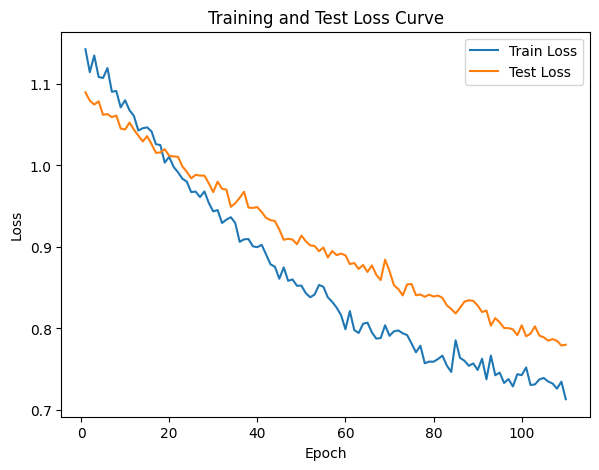

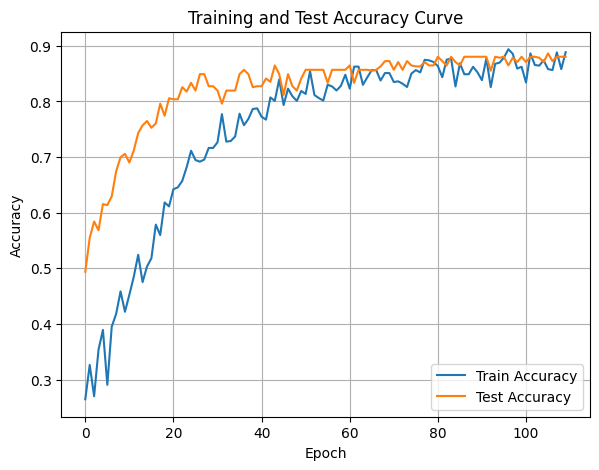

In [57]:
DTEmlp6b.train_single_model()

## Base 8

In [60]:
multiLayerPerceptron = MLP(input_size=input_size, hidden_layers=hidden_layers, output_size=output_size+1, dropout=.5) #hidden size default at 100

# Fill DTE params
modelSaveDirectory = './saved_models/'
DTEmlp8b = DeepTreeEnsemble(task_name='classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=8,
                                epochs=10,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.0001)

Randomly initializing 8 models
Training Model with id 1
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.12072313486411469, Train Loss: 1.2590, Train Acc: 0.0792, Test F1:0.17543859649122803, Test Loss: 1.1326, Test Acc: 0.1276


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.07it/s]

Epoch [2/10], Train F1:0.1332486312582573, Train Loss: 1.2515, Train Acc: 0.0923, Test F1:0.18206966692092552, Test Loss: 1.1299, Test Acc: 0.1345


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.59it/s]

Epoch [3/10], Train F1:0.1290458155871353, Train Loss: 1.2503, Train Acc: 0.0900, Test F1:0.17258219077104528, Test Loss: 1.1327, Test Acc: 0.1270


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.58it/s]

Epoch [4/10], Train F1:0.13218805689850363, Train Loss: 1.2483, Train Acc: 0.0904, Test F1:0.17693647566699292, Test Loss: 1.1310, Test Acc: 0.1326


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.34it/s]

Epoch [5/10], Train F1:0.1391809013139589, Train Loss: 1.2450, Train Acc: 0.0940, Test F1:0.18164205511885056, Test Loss: 1.1307, Test Acc: 0.1372


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.54it/s]

Epoch [6/10], Train F1:0.13911989802902222, Train Loss: 1.2417, Train Acc: 0.0959, Test F1:0.18537195976496232, Test Loss: 1.1303, Test Acc: 0.1389


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.00it/s]

Epoch [7/10], Train F1:0.14770427211715315, Train Loss: 1.2375, Train Acc: 0.1026, Test F1:0.18874823400558244, Test Loss: 1.1302, Test Acc: 0.1424


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  9.47it/s]

Epoch [8/10], Train F1:0.15774799524799524, Train Loss: 1.2327, Train Acc: 0.1093, Test F1:0.19577351934109033, Test Loss: 1.1285, Test Acc: 0.1523
Epoch [9/10], Train F1:0.16505620912811006, Train Loss: 1.2294, Train Acc: 0.1157, Test F1:0.2125250052301346, Test Loss: 1.1252, Test Acc: 0.1705


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.04it/s]


Epoch [10/10], Train F1:0.17071107155066706, Train Loss: 1.2261, Train Acc: 0.1208, Test F1:0.2220505436287293, Test Loss: 1.1228, Test Acc: 0.1851
Total Epochs: 10
Train loss start: 1.2699010372161865, Train loss end: 1.203123688697815
Highest Mean Train Accuracy (over epoch): 0.12083333333333333
Test loss start: 1.156746745109558, Test loss end: 1.08841872215271
Highest mean Test Accuracy (over epoch): 0.18506944444444445


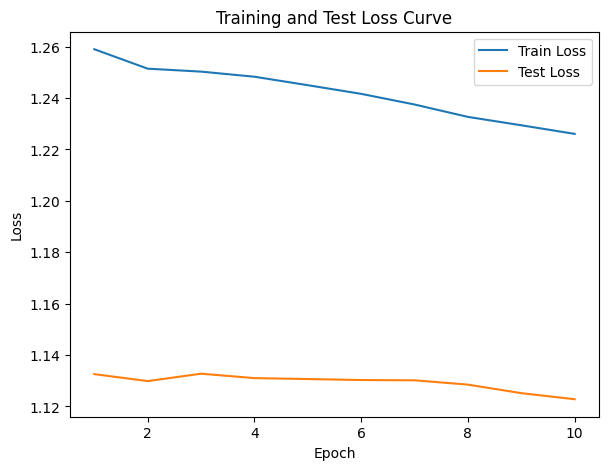

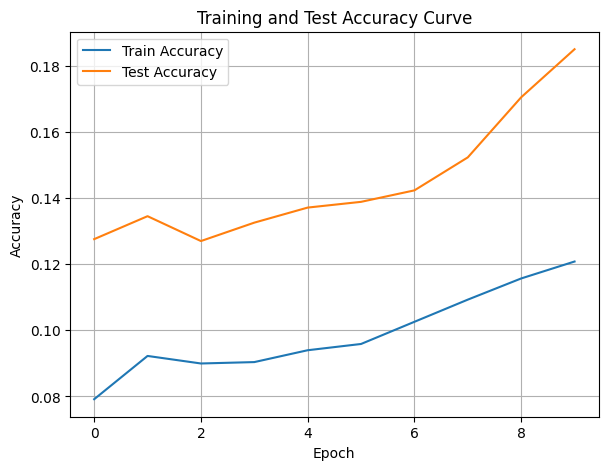

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.92it/s]

Epoch [1/10], Train F1:0.3907124420686808, Train Loss: 1.1140, Train Acc: 0.3589, Test F1:0.6319061055903162, Test Loss: 1.0654, Test Acc: 0.6120
Epoch [2/10], Train F1:0.3917249025023862, Train Loss: 1.1128, Train Acc: 0.3600, Test F1:0.6283752365671986, Test Loss: 1.0620, Test Acc: 0.6220


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.30it/s]

Epoch [3/10], Train F1:0.38187166782425774, Train Loss: 1.1150, Train Acc: 0.3477, Test F1:0.6297361049683031, Test Loss: 1.0627, Test Acc: 0.6233
Epoch [4/10], Train F1:0.3917847544200363, Train Loss: 1.1110, Train Acc: 0.3557, Test F1:0.6375886311238711, Test Loss: 1.0605, Test Acc: 0.6332


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.93it/s]

Epoch [5/10], Train F1:0.39979858416516106, Train Loss: 1.1071, Train Acc: 0.3608, Test F1:0.6487659580666069, Test Loss: 1.0570, Test Acc: 0.6486
Epoch [6/10], Train F1:0.40588445849645194, Train Loss: 1.1035, Train Acc: 0.3666, Test F1:0.658579419426262, Test Loss: 1.0525, Test Acc: 0.6615


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.27it/s]

Epoch [7/10], Train F1:0.4132442617442025, Train Loss: 1.1012, Train Acc: 0.3727, Test F1:0.6648326750558772, Test Loss: 1.0491, Test Acc: 0.6726
Epoch [8/10], Train F1:0.4186081018846015, Train Loss: 1.0987, Train Acc: 0.3763, Test F1:0.6704565964649138, Test Loss: 1.0471, Test Acc: 0.6810


Epoch [9/10], Train F1:0.4300931415740478, Train Loss: 1.0939, Train Acc: 0.3876, Test F1:0.6758716834103905, Test Loss: 1.0453, Test Acc: 0.6875


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.06it/s]


Epoch [10/10], Train F1:0.4350840965803401, Train Loss: 1.0905, Train Acc: 0.3954, Test F1:0.6819100899236297, Test Loss: 1.0425, Test Acc: 0.6943
Total Epochs: 10
Train loss start: 1.1382938623428345, Train loss end: 0.9246670603752136
Highest Mean Train Accuracy (over epoch): 0.3953571428571428
Test loss start: 1.0646134614944458, Test loss end: 1.0133347511291504
Highest mean Test Accuracy (over epoch): 0.6942708333333334


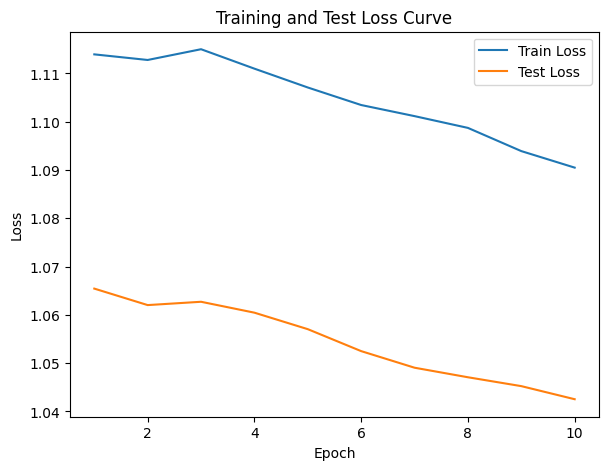

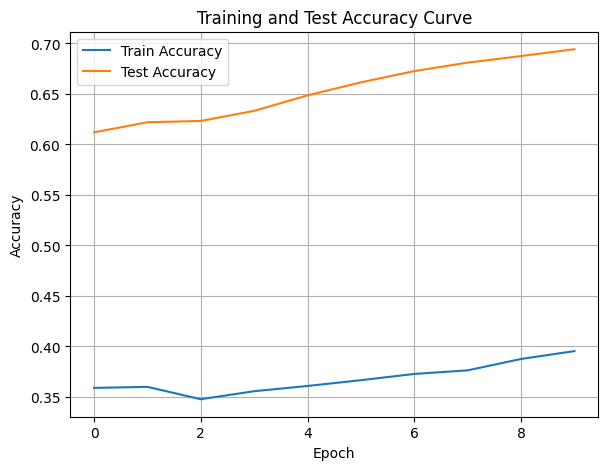

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.02it/s]

Epoch [1/10], Train F1:0.3795667222296118, Train Loss: 1.1487, Train Acc: 0.2887, Test F1:0.4756828780812791, Test Loss: 1.1026, Test Acc: 0.4002


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.89it/s]

Epoch [2/10], Train F1:0.3407241369047224, Train Loss: 1.1526, Train Acc: 0.2664, Test F1:0.3646432412732557, Test Loss: 1.1132, Test Acc: 0.2904


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.81it/s]

Epoch [3/10], Train F1:0.3536324423487816, Train Loss: 1.1493, Train Acc: 0.2777, Test F1:0.3575414508812076, Test Loss: 1.1113, Test Acc: 0.2969


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.24it/s]

Epoch [4/10], Train F1:0.3580942199105868, Train Loss: 1.1471, Train Acc: 0.2796, Test F1:0.3788606808328235, Test Loss: 1.1086, Test Acc: 0.3168


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.35it/s]

Epoch [5/10], Train F1:0.36743412848043433, Train Loss: 1.1435, Train Acc: 0.2926, Test F1:0.41100349651688706, Test Loss: 1.1062, Test Acc: 0.3432


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.00it/s]

Epoch [6/10], Train F1:0.3775167294196677, Train Loss: 1.1392, Train Acc: 0.3011, Test F1:0.4324927081806886, Test Loss: 1.1044, Test Acc: 0.3575


Training Process:  70%|███████   | 7/10 [00:00<00:00,  6.89it/s]

Epoch [7/10], Train F1:0.38365629494164877, Train Loss: 1.1357, Train Acc: 0.3097, Test F1:0.4524669632335228, Test Loss: 1.1022, Test Acc: 0.3787


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.33it/s]

Epoch [8/10], Train F1:0.3861071418929997, Train Loss: 1.1337, Train Acc: 0.3141, Test F1:0.4369478468965228, Test Loss: 1.1022, Test Acc: 0.3716


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.25it/s]

Epoch [9/10], Train F1:0.3934572229985769, Train Loss: 1.1311, Train Acc: 0.3178, Test F1:0.45660661104379885, Test Loss: 1.1001, Test Acc: 0.3900


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.44it/s]


Epoch [10/10], Train F1:0.40282927865104085, Train Loss: 1.1275, Train Acc: 0.3247, Test F1:0.45119522740500534, Test Loss: 1.0983, Test Acc: 0.3917
Total Epochs: 10
Train loss start: 1.168443202972412, Train loss end: 1.1755801439285278
Highest Mean Train Accuracy (over epoch): 0.32467261904761907
Test loss start: 1.109079360961914, Test loss end: 1.084490180015564
Highest mean Test Accuracy (over epoch): 0.4001736111111111


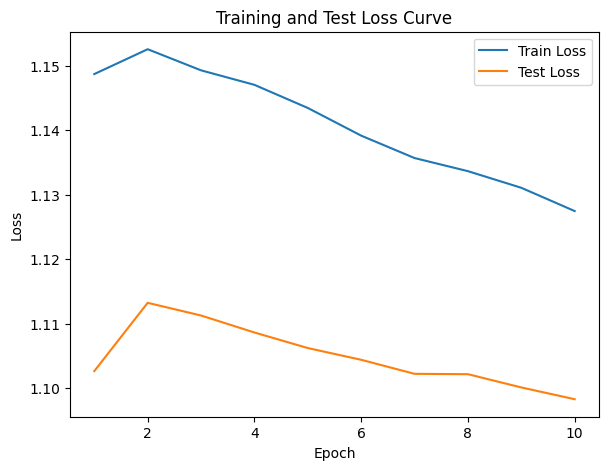

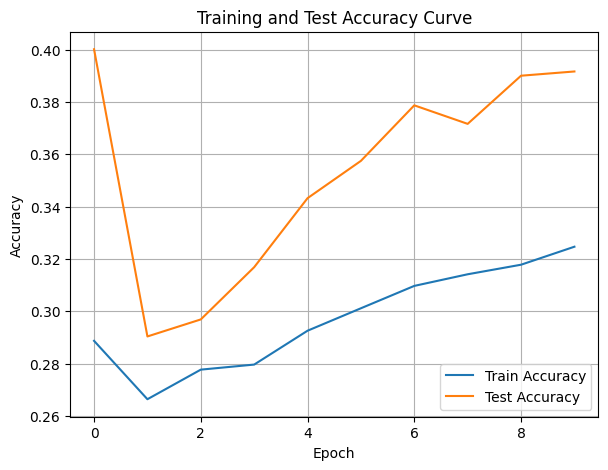

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.74it/s]

Epoch [1/10], Train F1:0.22390516954833076, Train Loss: 1.1856, Train Acc: 0.1562, Test F1:0.28997746892483733, Test Loss: 1.0987, Test Acc: 0.2509


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.82it/s]

Epoch [2/10], Train F1:0.24809748075054197, Train Loss: 1.1808, Train Acc: 0.1862, Test F1:0.2890016879864961, Test Loss: 1.0966, Test Acc: 0.2626
Epoch [3/10], Train F1:0.2525091807921937, Train Loss: 1.1804, Train Acc: 0.1852, Test F1:0.29620932923983584, Test Loss: 1.0937, Test Acc: 0.2749


Training Process:  50%|█████     | 5/10 [00:00<00:00, 11.12it/s]

Epoch [4/10], Train F1:0.2813237427700724, Train Loss: 1.1753, Train Acc: 0.2125, Test F1:0.33191248170027815, Test Loss: 1.0883, Test Acc: 0.3051
Epoch [5/10], Train F1:0.29353703214833493, Train Loss: 1.1709, Train Acc: 0.2221, Test F1:0.35210758961989114, Test Loss: 1.0842, Test Acc: 0.3205


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.74it/s]

Epoch [6/10], Train F1:0.2964423670828388, Train Loss: 1.1689, Train Acc: 0.2248, Test F1:0.3531204554596368, Test Loss: 1.0815, Test Acc: 0.3229
Epoch [7/10], Train F1:0.30142087353358715, Train Loss: 1.1656, Train Acc: 0.2270, Test F1:0.36340182087783374, Test Loss: 1.0793, Test Acc: 0.3333


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.99it/s]

Epoch [8/10], Train F1:0.3146354855274074, Train Loss: 1.1618, Train Acc: 0.2368, Test F1:0.3594294034638549, Test Loss: 1.0786, Test Acc: 0.3308
Epoch [9/10], Train F1:0.32623478206437845, Train Loss: 1.1570, Train Acc: 0.2479, Test F1:0.39162896759718996, Test Loss: 1.0762, Test Acc: 0.3561


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.31it/s]


Epoch [10/10], Train F1:0.3328332792356007, Train Loss: 1.1543, Train Acc: 0.2545, Test F1:0.40132401121356437, Test Loss: 1.0742, Test Acc: 0.3663
Total Epochs: 10
Train loss start: 1.2035690546035767, Train loss end: 1.1188404560089111
Highest Mean Train Accuracy (over epoch): 0.25446428571428575
Test loss start: 1.095809817314148, Test loss end: 1.0708352327346802
Highest mean Test Accuracy (over epoch): 0.3663194444444445


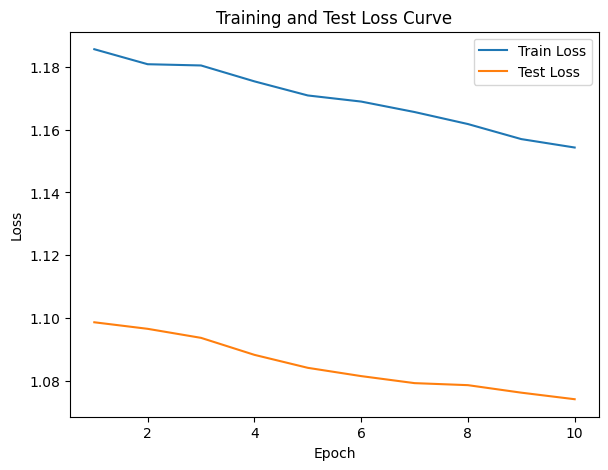

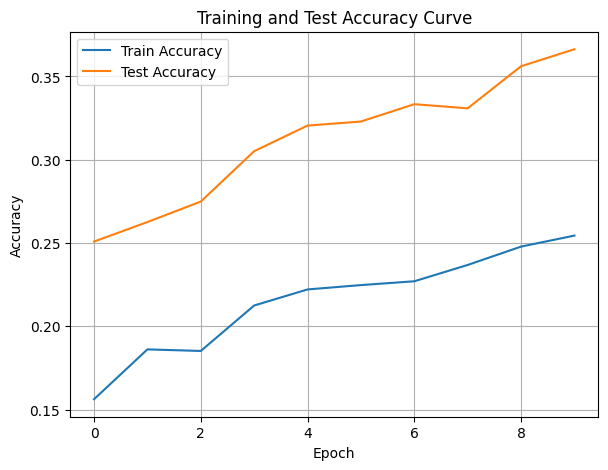

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.89it/s]

Epoch [1/10], Train F1:0.5034059573385417, Train Loss: 1.0434, Train Acc: 0.5027, Test F1:0.5057809029053191, Test Loss: 1.0736, Test Acc: 0.5139


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.89it/s]

Epoch [2/10], Train F1:0.5147666939241977, Train Loss: 1.0390, Train Acc: 0.5150, Test F1:0.5042798823581054, Test Loss: 1.0677, Test Acc: 0.5304


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.65it/s]

Epoch [3/10], Train F1:0.5212480581743895, Train Loss: 1.0402, Train Acc: 0.5216, Test F1:0.5150242553161616, Test Loss: 1.0629, Test Acc: 0.5556


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.52it/s]

Epoch [4/10], Train F1:0.5239928987168251, Train Loss: 1.0350, Train Acc: 0.5315, Test F1:0.5245206971505021, Test Loss: 1.0574, Test Acc: 0.5681


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.32it/s]

Epoch [5/10], Train F1:0.5290970555908562, Train Loss: 1.0314, Train Acc: 0.5385, Test F1:0.536203944298133, Test Loss: 1.0539, Test Acc: 0.5832


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.20it/s]

Epoch [6/10], Train F1:0.5287216904278766, Train Loss: 1.0290, Train Acc: 0.5382, Test F1:0.5373650564768084, Test Loss: 1.0522, Test Acc: 0.5883


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.11it/s]

Epoch [7/10], Train F1:0.5384142605320869, Train Loss: 1.0259, Train Acc: 0.5447, Test F1:0.5444640529660772, Test Loss: 1.0502, Test Acc: 0.5952


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.50it/s]

Epoch [8/10], Train F1:0.5442754712884097, Train Loss: 1.0225, Train Acc: 0.5494, Test F1:0.5552411957729375, Test Loss: 1.0461, Test Acc: 0.6061


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.93it/s]


Epoch [9/10], Train F1:0.5491667691613397, Train Loss: 1.0180, Train Acc: 0.5562, Test F1:0.5621807052957726, Test Loss: 1.0428, Test Acc: 0.6137
Epoch [10/10], Train F1:0.551657594089653, Train Loss: 1.0147, Train Acc: 0.5597, Test F1:0.5670710077691917, Test Loss: 1.0406, Test Acc: 0.6196
Total Epochs: 10
Train loss start: 1.0401986837387085, Train loss end: 0.8757991194725037
Highest Mean Train Accuracy (over epoch): 0.5597023809523809
Test loss start: 1.0894049406051636, Test loss end: 1.005380630493164
Highest mean Test Accuracy (over epoch): 0.6196180555555555


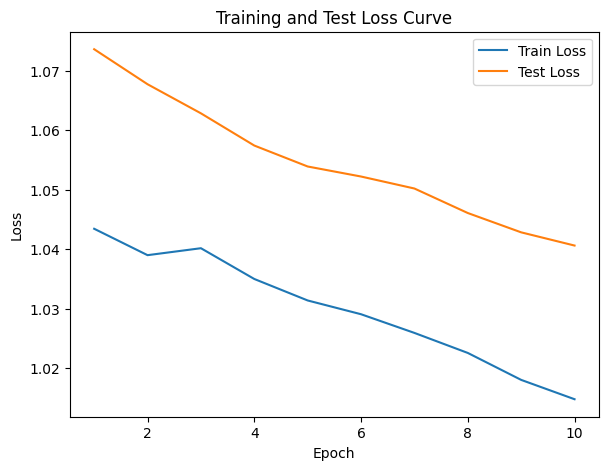

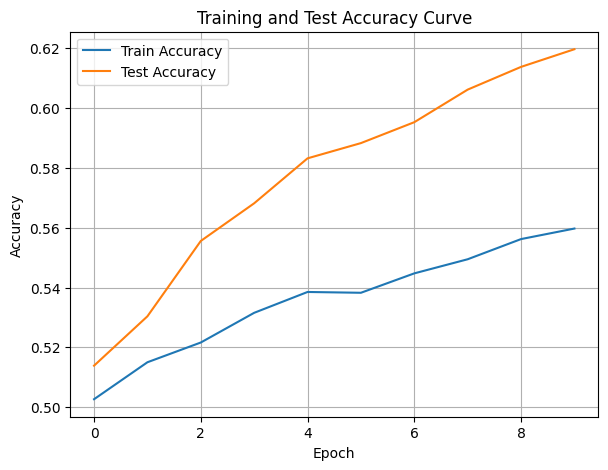

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.14it/s]

Epoch [1/10], Train F1:0.40770260654395657, Train Loss: 1.0751, Train Acc: 0.4119, Test F1:0.37685121895648216, Test Loss: 1.0896, Test Acc: 0.3255


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.36it/s]

Epoch [2/10], Train F1:0.42782343501221964, Train Loss: 1.0725, Train Acc: 0.4269, Test F1:0.37643750524636954, Test Loss: 1.0926, Test Acc: 0.3307


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.79it/s]

Epoch [3/10], Train F1:0.4447797634189452, Train Loss: 1.0655, Train Acc: 0.4452, Test F1:0.3845495601894742, Test Loss: 1.0922, Test Acc: 0.3325


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.68it/s]

Epoch [4/10], Train F1:0.4534957644123276, Train Loss: 1.0616, Train Acc: 0.4520, Test F1:0.4343055781869534, Test Loss: 1.0905, Test Acc: 0.3774


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.05it/s]

Epoch [5/10], Train F1:0.4580649654647972, Train Loss: 1.0586, Train Acc: 0.4595, Test F1:0.45409259846754724, Test Loss: 1.0893, Test Acc: 0.3965


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.59it/s]

Epoch [6/10], Train F1:0.4686378988333602, Train Loss: 1.0574, Train Acc: 0.4649, Test F1:0.478435715139715, Test Loss: 1.0870, Test Acc: 0.4210


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.62it/s]

Epoch [7/10], Train F1:0.47427482287229333, Train Loss: 1.0567, Train Acc: 0.4648, Test F1:0.5064376748039588, Test Loss: 1.0839, Test Acc: 0.4505
Epoch [8/10], Train F1:0.481759587216803, Train Loss: 1.0524, Train Acc: 0.4715, Test F1:0.5241077688675976, Test Loss: 1.0819, Test Acc: 0.4678


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.82it/s]


Epoch [9/10], Train F1:0.4908829672485932, Train Loss: 1.0481, Train Acc: 0.4813, Test F1:0.5436560677788748, Test Loss: 1.0798, Test Acc: 0.4879
Epoch [10/10], Train F1:0.49892167869696114, Train Loss: 1.0439, Train Acc: 0.4886, Test F1:0.5598955308129638, Test Loss: 1.0775, Test Acc: 0.5052
Total Epochs: 10
Train loss start: 1.0148932933807373, Train loss end: 1.014620065689087
Highest Mean Train Accuracy (over epoch): 0.4885714285714285
Test loss start: 1.0972342491149902, Test loss end: 1.0315552949905396
Highest mean Test Accuracy (over epoch): 0.5052083333333334


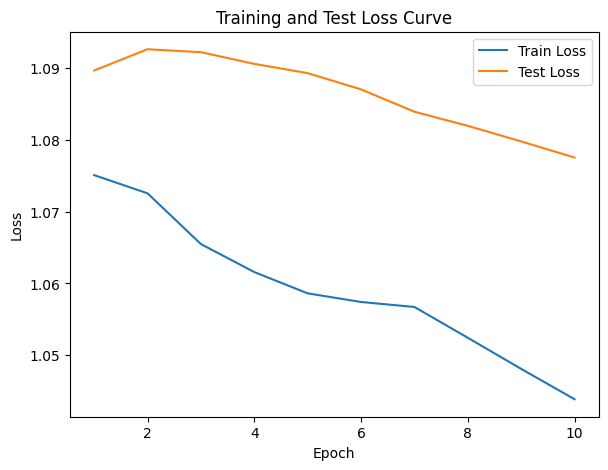

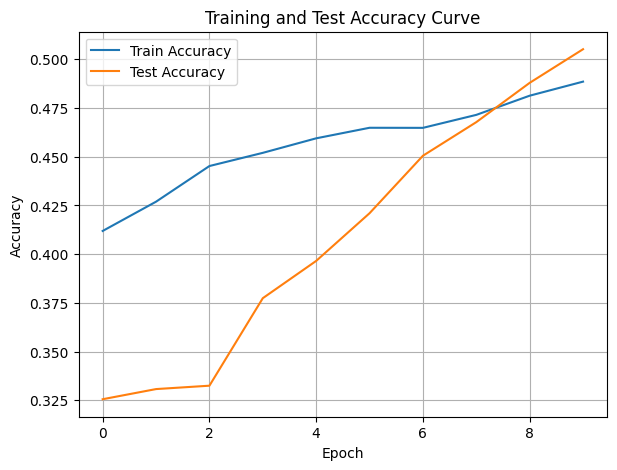

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.74it/s]

Epoch [1/10], Train F1:0.5953319019264148, Train Loss: 1.0082, Train Acc: 0.5768, Test F1:0.6804562519428968, Test Loss: 1.0365, Test Acc: 0.6701


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.42it/s]

Epoch [2/10], Train F1:0.573497580940294, Train Loss: 1.0198, Train Acc: 0.5607, Test F1:0.6904988183713164, Test Loss: 1.0288, Test Acc: 0.6849


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.62it/s]

Epoch [3/10], Train F1:0.5746634618867263, Train Loss: 1.0201, Train Acc: 0.5580, Test F1:0.7096006311157432, Test Loss: 1.0194, Test Acc: 0.7141


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.47it/s]

Epoch [4/10], Train F1:0.5710215218449068, Train Loss: 1.0192, Train Acc: 0.5525, Test F1:0.7188360460858814, Test Loss: 1.0127, Test Acc: 0.7253


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.47it/s]

Epoch [5/10], Train F1:0.5829559597525322, Train Loss: 1.0150, Train Acc: 0.5634, Test F1:0.7230722092795976, Test Loss: 1.0079, Test Acc: 0.7319


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.39it/s]

Epoch [6/10], Train F1:0.5897488005909699, Train Loss: 1.0103, Train Acc: 0.5684, Test F1:0.728440826882646, Test Loss: 1.0023, Test Acc: 0.7400


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.25it/s]

Epoch [7/10], Train F1:0.5892251635296903, Train Loss: 1.0085, Train Acc: 0.5685, Test F1:0.7332658569500674, Test Loss: 0.9985, Test Acc: 0.7449
Epoch [8/10], Train F1:0.590323845124199, Train Loss: 1.0062, Train Acc: 0.5702, Test F1:0.7359237764087392, Test Loss: 0.9954, Test Acc: 0.7476


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.82it/s]


Epoch [9/10], Train F1:0.5982372300695907, Train Loss: 1.0016, Train Acc: 0.5784, Test F1:0.7385657125269314, Test Loss: 0.9917, Test Acc: 0.7528
Epoch [10/10], Train F1:0.6029448591817115, Train Loss: 0.9981, Train Acc: 0.5833, Test F1:0.7402460390236076, Test Loss: 0.9878, Test Acc: 0.7556
Total Epochs: 10
Train loss start: 1.0099825859069824, Train loss end: 0.9064499735832214
Highest Mean Train Accuracy (over epoch): 0.5833333333333334
Test loss start: 1.0444691181182861, Test loss end: 0.9606817960739136
Highest mean Test Accuracy (over epoch): 0.7555555555555555


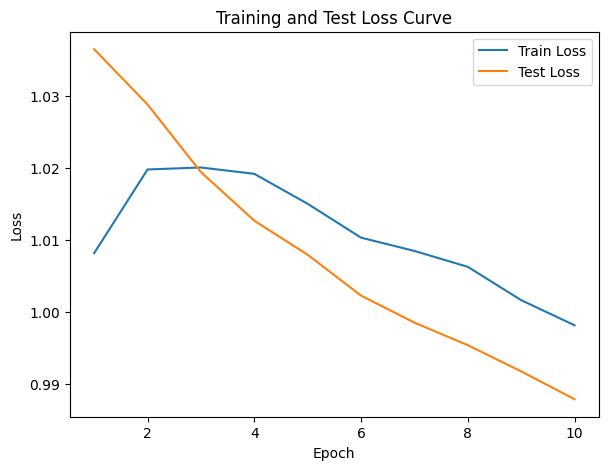

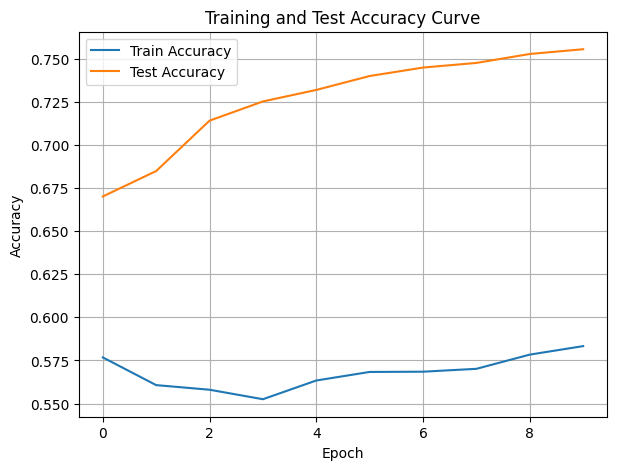

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.23it/s]

Epoch [1/10], Train F1:0.39677908298597947, Train Loss: 1.0720, Train Acc: 0.4152, Test F1:0.1577307755369733, Test Loss: 1.1266, Test Acc: 0.1319
Epoch [2/10], Train F1:0.4094207159375698, Train Loss: 1.0686, Train Acc: 0.4171, Test F1:0.14979757085020243, Test Loss: 1.1291, Test Acc: 0.1211


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.23it/s]

Epoch [3/10], Train F1:0.41613099384667795, Train Loss: 1.0655, Train Acc: 0.4226, Test F1:0.15811965811965814, Test Loss: 1.1252, Test Acc: 0.1273


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.98it/s]

Epoch [4/10], Train F1:0.43115667676584035, Train Loss: 1.0592, Train Acc: 0.4348, Test F1:0.16931007986636198, Test Loss: 1.1231, Test Acc: 0.1359
Epoch [5/10], Train F1:0.4341597595958897, Train Loss: 1.0576, Train Acc: 0.4394, Test F1:0.1722367253566751, Test Loss: 1.1204, Test Acc: 0.1382


Training Process:  60%|██████    | 6/10 [00:00<00:00, 13.09it/s]

Epoch [6/10], Train F1:0.4390580764195484, Train Loss: 1.0533, Train Acc: 0.4456, Test F1:0.17981601531823116, Test Loss: 1.1183, Test Acc: 0.1457


Training Process:  80%|████████  | 8/10 [00:00<00:00, 12.55it/s]

Epoch [7/10], Train F1:0.4419710688157055, Train Loss: 1.0505, Train Acc: 0.4537, Test F1:0.17662586559149507, Test Loss: 1.1172, Test Acc: 0.1437
Epoch [8/10], Train F1:0.44364959017891487, Train Loss: 1.0472, Train Acc: 0.4582, Test F1:0.17412922978946235, Test Loss: 1.1186, Test Acc: 0.1405


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.45it/s]


Epoch [9/10], Train F1:0.44688334019776227, Train Loss: 1.0454, Train Acc: 0.4612, Test F1:0.18680366555059383, Test Loss: 1.1156, Test Acc: 0.1513
Epoch [10/10], Train F1:0.4516414552864244, Train Loss: 1.0426, Train Acc: 0.4692, Test F1:0.2011385644284046, Test Loss: 1.1127, Test Acc: 0.1631
Total Epochs: 10
Train loss start: 1.0905874967575073, Train loss end: 0.948229968547821
Highest Mean Train Accuracy (over epoch): 0.4691666666666667
Test loss start: 1.1389846801757812, Test loss end: 1.059850811958313
Highest mean Test Accuracy (over epoch): 0.16310763888888888


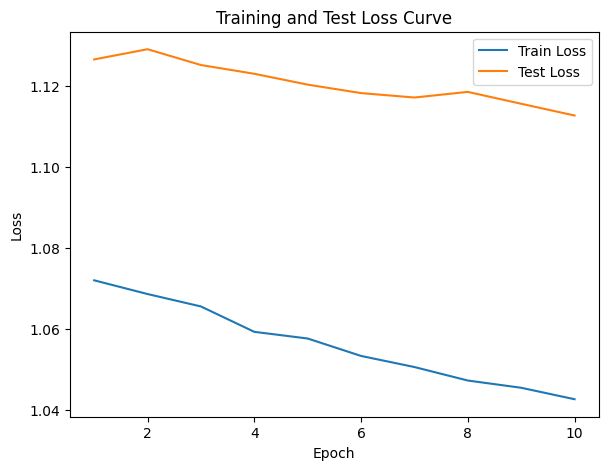

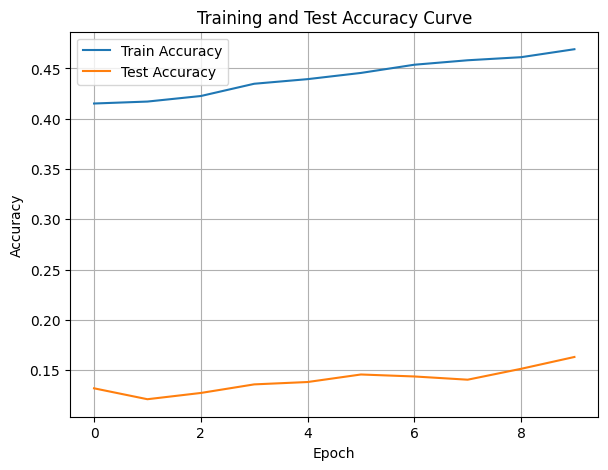

./saved_models/model_8.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.5054564483135913, Train Loss: 1.0156, Train Acc: 0.5161, Test F1:0.19530653510869475, Test Loss: 1.1058, Test Acc: 0.1476


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.71it/s]

Epoch [2/10], Train F1:0.5121396867427794, Train Loss: 1.0127, Train Acc: 0.5260, Test F1:0.19325983791443307, Test Loss: 1.1061, Test Acc: 0.1437
Epoch [3/10], Train F1:0.5111601732358809, Train Loss: 1.0045, Train Acc: 0.5294, Test F1:0.25814239858320875, Test Loss: 1.0995, Test Acc: 0.1933


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.53it/s]

Epoch [4/10], Train F1:0.51915814618153, Train Loss: 1.0001, Train Acc: 0.5383, Test F1:0.283650540680598, Test Loss: 1.0953, Test Acc: 0.2161


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.53it/s]

Epoch [5/10], Train F1:0.525401931424643, Train Loss: 0.9954, Train Acc: 0.5462, Test F1:0.2941992739649229, Test Loss: 1.0934, Test Acc: 0.2252
Epoch [6/10], Train F1:0.5322664442894963, Train Loss: 0.9925, Train Acc: 0.5550, Test F1:0.3058780069729362, Test Loss: 1.0930, Test Acc: 0.2322


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.54it/s]

Epoch [7/10], Train F1:0.5437767715506254, Train Loss: 0.9884, Train Acc: 0.5647, Test F1:0.34464394188683495, Test Loss: 1.0896, Test Acc: 0.2624
Epoch [8/10], Train F1:0.5474501663004208, Train Loss: 0.9863, Train Acc: 0.5684, Test F1:0.3745925120404385, Test Loss: 1.0876, Test Acc: 0.2860


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.67it/s]


Epoch [9/10], Train F1:0.5567360641414829, Train Loss: 0.9826, Train Acc: 0.5758, Test F1:0.3960184089054153, Test Loss: 1.0848, Test Acc: 0.3053
Epoch [10/10], Train F1:0.5646994550418388, Train Loss: 0.9795, Train Acc: 0.5836, Test F1:0.43100207779855965, Test Loss: 1.0816, Test Acc: 0.3385
Total Epochs: 10
Train loss start: 1.0044715404510498, Train loss end: 0.9554967880249023
Highest Mean Train Accuracy (over epoch): 0.5836011904761904
Test loss start: 1.1192362308502197, Test loss end: 1.0281867980957031
Highest mean Test Accuracy (over epoch): 0.3384548611111111


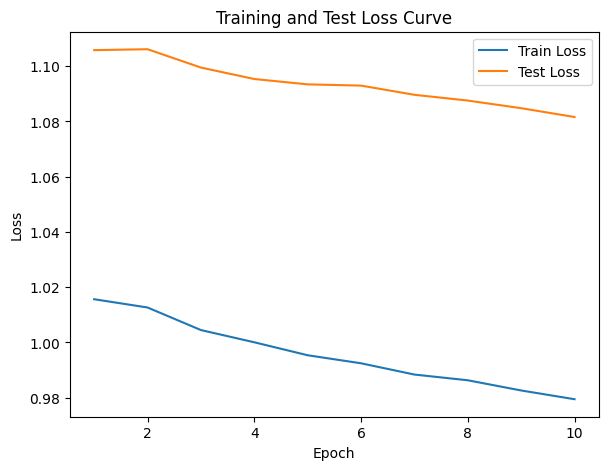

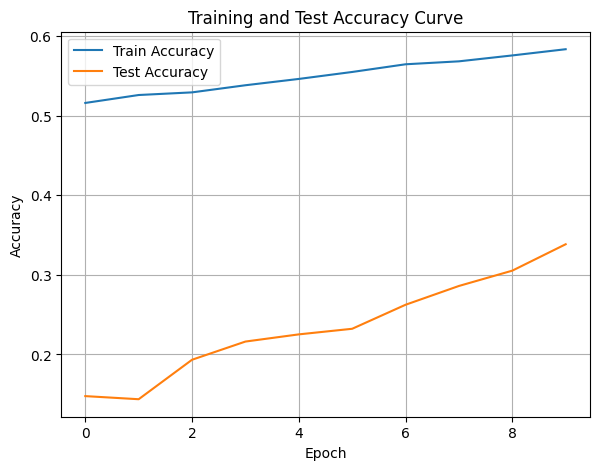

./saved_models/model_12.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.15it/s]

Epoch [1/10], Train F1:0.6507869812835567, Train Loss: 0.9486, Train Acc: 0.6685, Test F1:0.6454269005847952, Test Loss: 1.0626, Test Acc: 0.5295
Epoch [2/10], Train F1:0.6459085200129413, Train Loss: 0.9477, Train Acc: 0.6674, Test F1:0.6867532467532467, Test Loss: 1.0565, Test Acc: 0.6050


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.15it/s]

Epoch [3/10], Train F1:0.64361440936914, Train Loss: 0.9482, Train Acc: 0.6593, Test F1:0.6785800112115054, Test Loss: 1.0542, Test Acc: 0.5995


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.60it/s]

Epoch [4/10], Train F1:0.6477118693235987, Train Loss: 0.9448, Train Acc: 0.6645, Test F1:0.6844529556577644, Test Loss: 1.0537, Test Acc: 0.6081
Epoch [5/10], Train F1:0.6528953506603336, Train Loss: 0.9415, Train Acc: 0.6671, Test F1:0.6685205850331122, Test Loss: 1.0557, Test Acc: 0.5826


Training Process:  60%|██████    | 6/10 [00:00<00:00, 13.28it/s]

Epoch [6/10], Train F1:0.6643832812453322, Train Loss: 0.9364, Train Acc: 0.6778, Test F1:0.6898149345634677, Test Loss: 1.0538, Test Acc: 0.6130


Training Process:  80%|████████  | 8/10 [00:00<00:00, 13.20it/s]

Epoch [7/10], Train F1:0.667897444082571, Train Loss: 0.9358, Train Acc: 0.6763, Test F1:0.7063832115253575, Test Loss: 1.0510, Test Acc: 0.6369
Epoch [8/10], Train F1:0.668180559254675, Train Loss: 0.9351, Train Acc: 0.6774, Test F1:0.7199158562621667, Test Loss: 1.0475, Test Acc: 0.6578


Training Process:  80%|████████  | 8/10 [00:00<00:00, 13.20it/s]

Epoch [9/10], Train F1:0.6730985764575722, Train Loss: 0.9320, Train Acc: 0.6819, Test F1:0.732597713568378, Test Loss: 1.0448, Test Acc: 0.6773


Training Process: 100%|██████████| 10/10 [00:00<00:00, 13.02it/s]


Epoch [10/10], Train F1:0.6795881414818307, Train Loss: 0.9291, Train Acc: 0.6884, Test F1:0.7417775891626347, Test Loss: 1.0417, Test Acc: 0.6921
Total Epochs: 10
Train loss start: 0.9750173091888428, Train loss end: 0.8962177634239197
Highest Mean Train Accuracy (over epoch): 0.688422619047619
Test loss start: 1.07205069065094, Test loss end: 0.9863908290863037
Highest mean Test Accuracy (over epoch): 0.6921006944444444


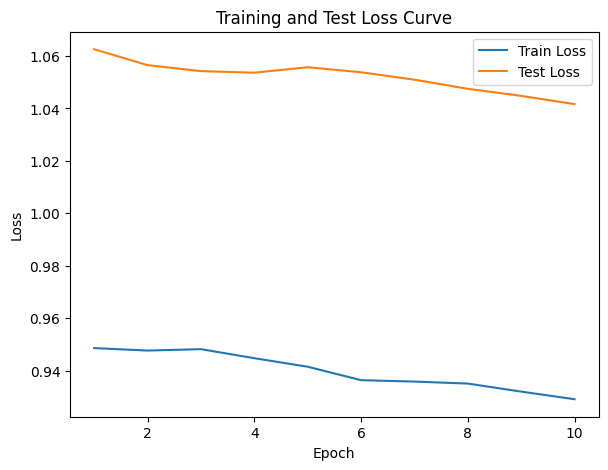

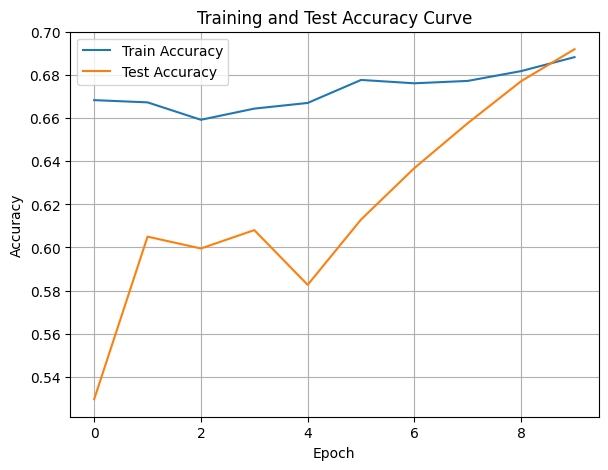

./saved_models/model_13.pth
Training Model with id 11
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 14.00it/s]

Epoch [1/10], Train F1:0.7510145636464703, Train Loss: 0.8983, Train Acc: 0.7476, Test F1:0.8357653025845246, Test Loss: 1.0102, Test Acc: 0.8411
Epoch [2/10], Train F1:0.7542635207502482, Train Loss: 0.8986, Train Acc: 0.7512, Test F1:0.8349578554187581, Test Loss: 1.0113, Test Acc: 0.8381


Training Process:  20%|██        | 2/10 [00:00<00:00, 14.00it/s]

Epoch [3/10], Train F1:0.7483159049428472, Train Loss: 0.8978, Train Acc: 0.7479, Test F1:0.8352971339068538, Test Loss: 1.0066, Test Acc: 0.8371


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.92it/s]

Epoch [4/10], Train F1:0.7492658070984429, Train Loss: 0.8948, Train Acc: 0.7513, Test F1:0.8301195659686227, Test Loss: 1.0080, Test Acc: 0.8307
Epoch [5/10], Train F1:0.755319531003632, Train Loss: 0.8920, Train Acc: 0.7555, Test F1:0.8296312645892274, Test Loss: 1.0071, Test Acc: 0.8300


Training Process:  60%|██████    | 6/10 [00:00<00:00, 14.05it/s]

Epoch [6/10], Train F1:0.7589433208349605, Train Loss: 0.8870, Train Acc: 0.7619, Test F1:0.8306767161736157, Test Loss: 1.0046, Test Acc: 0.8319


Training Process:  60%|██████    | 6/10 [00:00<00:00, 14.05it/s]

Epoch [7/10], Train F1:0.7628652775283226, Train Loss: 0.8847, Train Acc: 0.7663, Test F1:0.8157033612906304, Test Loss: 1.0053, Test Acc: 0.8165


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.64it/s]

Epoch [8/10], Train F1:0.766204994095112, Train Loss: 0.8818, Train Acc: 0.7703, Test F1:0.8192314708877152, Test Loss: 1.0044, Test Acc: 0.8205


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.64it/s]

Epoch [9/10], Train F1:0.7709013220040677, Train Loss: 0.8798, Train Acc: 0.7730, Test F1:0.8210664769846092, Test Loss: 1.0039, Test Acc: 0.8221


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.57it/s]


Epoch [10/10], Train F1:0.7740312655879246, Train Loss: 0.8781, Train Acc: 0.7755, Test F1:0.8213635047882851, Test Loss: 1.0036, Test Acc: 0.8219
Total Epochs: 10
Train loss start: 0.9099722504615784, Train loss end: 0.8467467427253723
Highest Mean Train Accuracy (over epoch): 0.7754761904761905
Test loss start: 1.0137217044830322, Test loss end: 0.9704625010490417
Highest mean Test Accuracy (over epoch): 0.8411458333333334


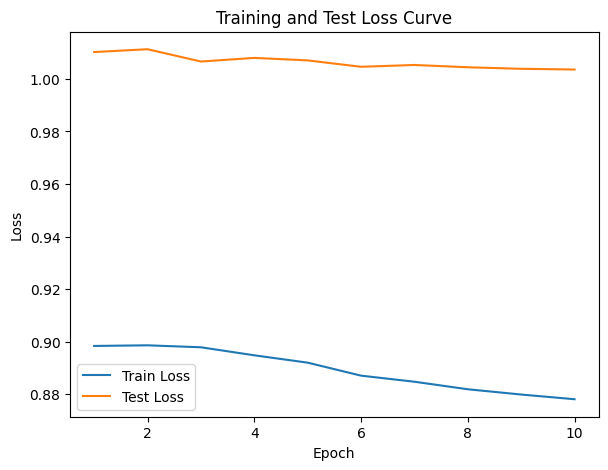

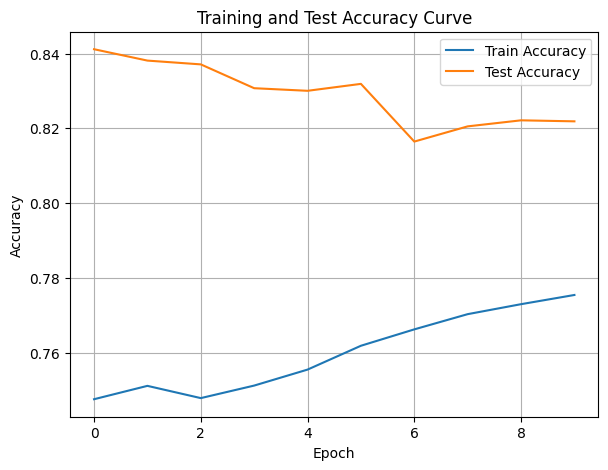

./saved_models/model_11.pth
Training Model with id 13
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8090287766688589, Train Loss: 0.8461, Train Acc: 0.8208, Test F1:0.7254385964912281, Test Loss: 1.0029, Test Acc: 0.7378


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.27it/s]

Epoch [2/10], Train F1:0.8023790898367169, Train Loss: 0.8455, Train Acc: 0.8119, Test F1:0.7885621527127427, Test Loss: 0.9971, Test Acc: 0.7964
Epoch [3/10], Train F1:0.8073966709595232, Train Loss: 0.8462, Train Acc: 0.8152, Test F1:0.7819077688480673, Test Loss: 0.9965, Test Acc: 0.7899


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.55it/s]

Epoch [4/10], Train F1:0.8087039208949024, Train Loss: 0.8456, Train Acc: 0.8144, Test F1:0.7985821902311901, Test Loss: 0.9938, Test Acc: 0.8047


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.93it/s]

Epoch [5/10], Train F1:0.8080404397802167, Train Loss: 0.8458, Train Acc: 0.8113, Test F1:0.8080491908019297, Test Loss: 0.9900, Test Acc: 0.8135
Epoch [6/10], Train F1:0.8122513353285213, Train Loss: 0.8429, Train Acc: 0.8170, Test F1:0.815085586268973, Test Loss: 0.9881, Test Acc: 0.8215


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.93it/s]

Epoch [7/10], Train F1:0.8143348008286884, Train Loss: 0.8410, Train Acc: 0.8198, Test F1:0.8207281226996086, Test Loss: 0.9832, Test Acc: 0.8274


Training Process:  80%|████████  | 8/10 [00:00<00:00, 12.67it/s]

Epoch [8/10], Train F1:0.8163601340749619, Train Loss: 0.8390, Train Acc: 0.8218, Test F1:0.8237653653123927, Test Loss: 0.9807, Test Acc: 0.8301


Training Process: 100%|██████████| 10/10 [00:00<00:00, 12.39it/s]

Epoch [9/10], Train F1:0.8180419153877212, Train Loss: 0.8377, Train Acc: 0.8226, Test F1:0.8262327640423249, Test Loss: 0.9791, Test Acc: 0.8329
Epoch [10/10], Train F1:0.8207233738339123, Train Loss: 0.8353, Train Acc: 0.8262, Test F1:0.8290260505764441, Test Loss: 0.9774, Test Acc: 0.8359
Total Epochs: 10
Train loss start: 0.8900267481803894, Train loss end: 0.8075318932533264
Highest Mean Train Accuracy (over epoch): 0.8261904761904763
Test loss start: 1.0084642171859741, Test loss end: 0.9292529225349426
Highest mean Test Accuracy (over epoch): 0.8358506944444445


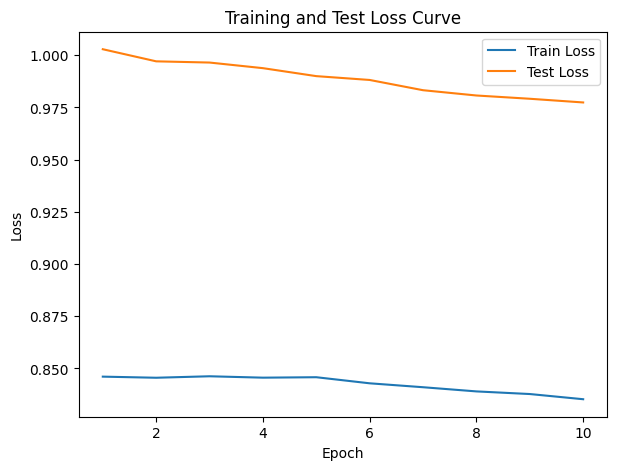

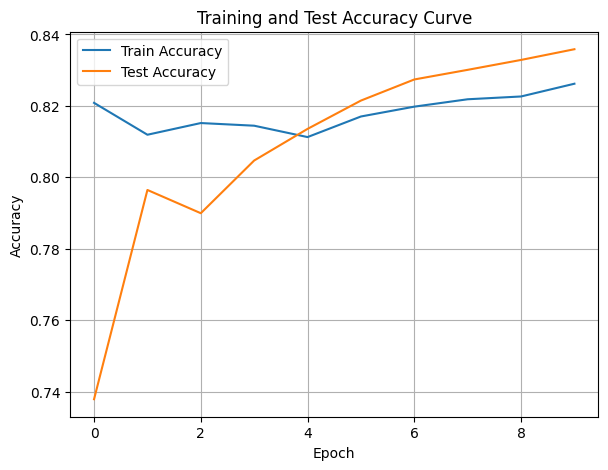

./saved_models/model_13.pth
Training Model with id 14
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.85it/s]

Epoch [1/10], Train F1:0.8413244555116477, Train Loss: 0.8149, Train Acc: 0.8393, Test F1:0.8373819163292848, Test Loss: 0.9550, Test Acc: 0.8411
Epoch [2/10], Train F1:0.8301792622793454, Train Loss: 0.8137, Train Acc: 0.8336, Test F1:0.8373819163292848, Test Loss: 0.9512, Test Acc: 0.8411


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.67it/s]

Epoch [3/10], Train F1:0.8289534746210494, Train Loss: 0.8124, Train Acc: 0.8356, Test F1:0.842922278852829, Test Loss: 0.9498, Test Acc: 0.8484
Epoch [4/10], Train F1:0.8319590027088649, Train Loss: 0.8089, Train Acc: 0.8384, Test F1:0.8429325741538312, Test Loss: 0.9493, Test Acc: 0.8496


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.10it/s]

Epoch [5/10], Train F1:0.835951669140561, Train Loss: 0.8040, Train Acc: 0.8432, Test F1:0.8468278133349904, Test Loss: 0.9451, Test Acc: 0.8538
Epoch [6/10], Train F1:0.8422785966812419, Train Loss: 0.8010, Train Acc: 0.8487, Test F1:0.8480365181642897, Test Loss: 0.9422, Test Acc: 0.8553
Epoch [7/10], Train F1:0.8421932005228431, Train Loss: 0.7988, Train Acc: 0.8484, Test F1:0.8488991892531745, Test Loss: 0.9401, Test Acc: 0.8564


Epoch [8/10], Train F1:0.8442080348487329, Train Loss: 0.7973, Train Acc: 0.8509, Test F1:0.8495458432555876, Test Loss: 0.9370, Test Acc: 0.8572
Epoch [9/10], Train F1:0.8450597120903895, Train Loss: 0.7956, Train Acc: 0.8522, Test F1:0.8503558477618304, Test Loss: 0.9355, Test Acc: 0.8578


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.14it/s]


Epoch [10/10], Train F1:0.847770946002835, Train Loss: 0.7942, Train Acc: 0.8551, Test F1:0.849464386101077, Test Loss: 0.9343, Test Acc: 0.8568
Total Epochs: 10
Train loss start: 0.7792275547981262, Train loss end: 0.7537773251533508
Highest Mean Train Accuracy (over epoch): 0.8551190476190478
Test loss start: 0.9552420377731323, Test loss end: 0.8890925645828247
Highest mean Test Accuracy (over epoch): 0.8578317901234569


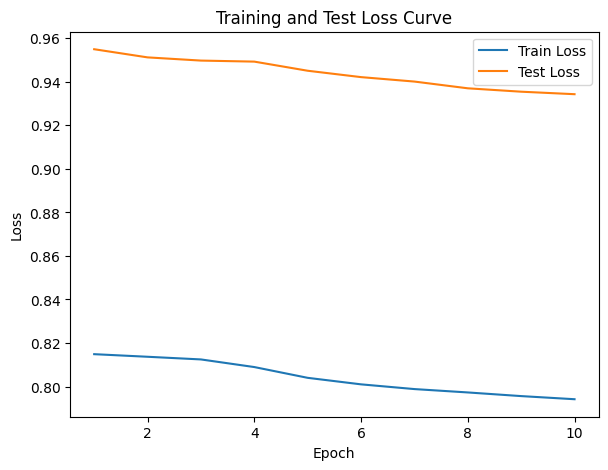

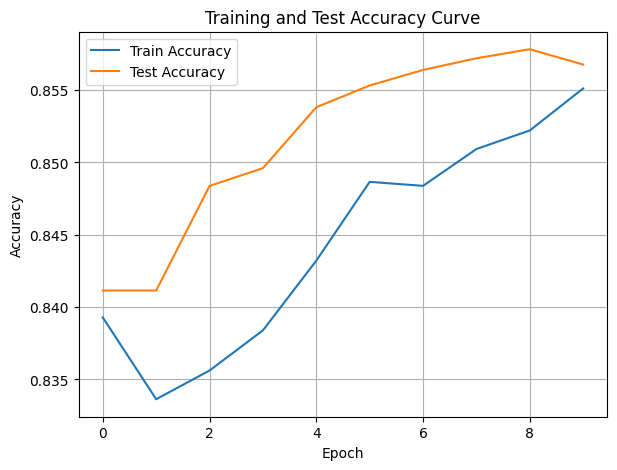

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.53it/s]

Epoch [1/10], Train F1:0.8492783288230172, Train Loss: 0.7909, Train Acc: 0.8530, Test F1:0.8305010893246186, Test Loss: 0.9222, Test Acc: 0.8333


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.22it/s]

Epoch [2/10], Train F1:0.8645033624921515, Train Loss: 0.7850, Train Acc: 0.8638, Test F1:0.8381003325813429, Test Loss: 0.9205, Test Acc: 0.8442


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.32it/s]

Epoch [3/10], Train F1:0.8624253460557673, Train Loss: 0.7811, Train Acc: 0.8655, Test F1:0.8410984745705772, Test Loss: 0.9200, Test Acc: 0.8478


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.10it/s]

Epoch [4/10], Train F1:0.864105807723935, Train Loss: 0.7806, Train Acc: 0.8652, Test F1:0.8485019377712574, Test Loss: 0.9131, Test Acc: 0.8555


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.33it/s]

Epoch [5/10], Train F1:0.8685503157588682, Train Loss: 0.7801, Train Acc: 0.8664, Test F1:0.8496148341705438, Test Loss: 0.9107, Test Acc: 0.8569


Training Process:  70%|███████   | 7/10 [00:00<00:00,  6.89it/s]

Epoch [6/10], Train F1:0.8709430711106859, Train Loss: 0.7773, Train Acc: 0.8682, Test F1:0.8503566716306453, Test Loss: 0.9068, Test Acc: 0.8579
Epoch [7/10], Train F1:0.8696336673484322, Train Loss: 0.7758, Train Acc: 0.8678, Test F1:0.8502881134460082, Test Loss: 0.9068, Test Acc: 0.8575


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.09it/s]

Epoch [8/10], Train F1:0.8695417926230755, Train Loss: 0.7743, Train Acc: 0.8683, Test F1:0.8511014521646832, Test Loss: 0.9065, Test Acc: 0.8582
Epoch [9/10], Train F1:0.872585885649099, Train Loss: 0.7720, Train Acc: 0.8714, Test F1:0.852513350419265, Test Loss: 0.9037, Test Acc: 0.8596


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.59it/s]


Epoch [10/10], Train F1:0.8739284470793276, Train Loss: 0.7707, Train Acc: 0.8729, Test F1:0.8526732612042401, Test Loss: 0.9016, Test Acc: 0.8599
Total Epochs: 10
Train loss start: 0.7477408647537231, Train loss end: 0.7675811648368835
Highest Mean Train Accuracy (over epoch): 0.8729166666666667
Test loss start: 0.9189600348472595, Test loss end: 0.8538832068443298
Highest mean Test Accuracy (over epoch): 0.8598958333333332


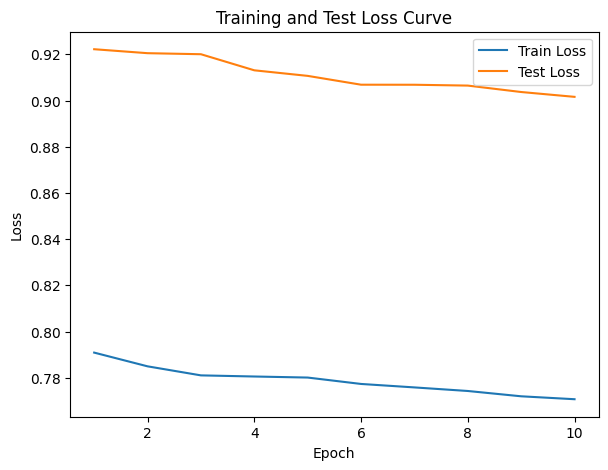

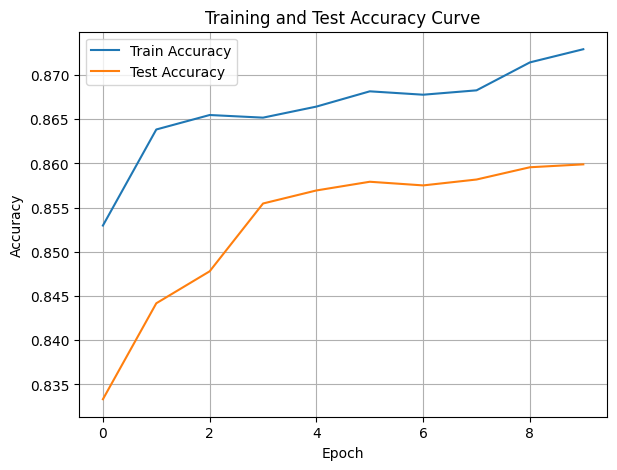

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.19it/s]

Epoch [1/10], Train F1:0.8771504373744825, Train Loss: 0.7515, Train Acc: 0.8631, Test F1:0.8661850705194357, Test Loss: 0.8919, Test Acc: 0.8707
Epoch [2/10], Train F1:0.8776808372212094, Train Loss: 0.7470, Train Acc: 0.8753, Test F1:0.8602813164411195, Test Loss: 0.8861, Test Acc: 0.8668


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.19it/s]

Epoch [3/10], Train F1:0.8719331830653672, Train Loss: 0.7506, Train Acc: 0.8664, Test F1:0.8594853826316423, Test Loss: 0.8893, Test Acc: 0.8655


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.18it/s]

Epoch [4/10], Train F1:0.8760924088205668, Train Loss: 0.7480, Train Acc: 0.8737, Test F1:0.8590759974585389, Test Loss: 0.8877, Test Acc: 0.8648
Epoch [5/10], Train F1:0.8767822293344775, Train Loss: 0.7456, Train Acc: 0.8765, Test F1:0.8569255800792304, Test Loss: 0.8864, Test Acc: 0.8628


Training Process:  80%|████████  | 8/10 [00:00<00:00, 12.38it/s]

Epoch [6/10], Train F1:0.8765465832550596, Train Loss: 0.7439, Train Acc: 0.8780, Test F1:0.8537077747604063, Test Loss: 0.8847, Test Acc: 0.8592
Epoch [7/10], Train F1:0.8769102648211174, Train Loss: 0.7456, Train Acc: 0.8761, Test F1:0.8537871214137243, Test Loss: 0.8806, Test Acc: 0.8589
Epoch [8/10], Train F1:0.8767332712847181, Train Loss: 0.7458, Train Acc: 0.8752, Test F1:0.8527954683173239, Test Loss: 0.8779, Test Acc: 0.8576


Training Process: 100%|██████████| 10/10 [00:00<00:00, 12.37it/s]


Epoch [9/10], Train F1:0.8794379595117202, Train Loss: 0.7433, Train Acc: 0.8780, Test F1:0.8529492544576237, Test Loss: 0.8760, Test Acc: 0.8582
Epoch [10/10], Train F1:0.8786957557657366, Train Loss: 0.7422, Train Acc: 0.8784, Test F1:0.8513981877985822, Test Loss: 0.8748, Test Acc: 0.8565
Total Epochs: 10
Train loss start: 0.7608352899551392, Train loss end: 0.7220644950866699
Highest Mean Train Accuracy (over epoch): 0.8783630952380952
Test loss start: 0.8866481781005859, Test loss end: 0.8373200297355652
Highest mean Test Accuracy (over epoch): 0.8706597222222222


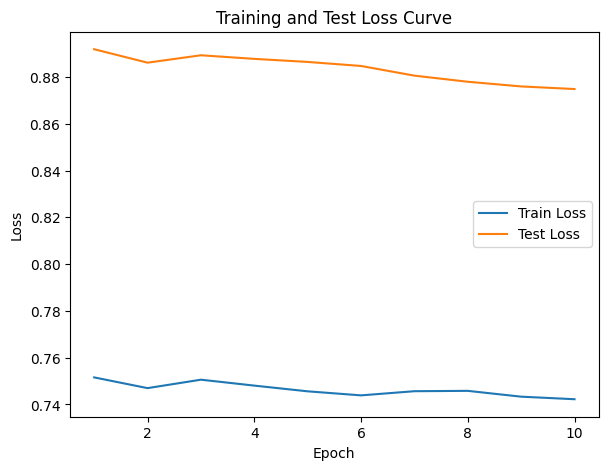

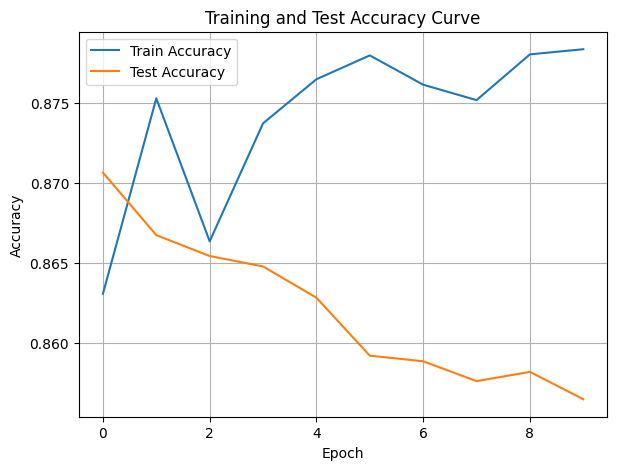

./saved_models/model_10.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [61]:
DTEmlp8b.train_DTE()

Training Process:   0%|          | 0/150 [00:00<?, ?it/s]

Epoch [1/150], Train F1:0.20964480755710646, Train Loss: 1.1830, Train Acc: 0.2244, Test F1:0.16291137007822337, Test Loss: 1.1436, Test Acc: 0.1684


Training Process:   1%|▏         | 2/150 [00:00<00:13, 11.13it/s]

Epoch [2/150], Train F1:0.22442484636033025, Train Loss: 1.1773, Train Acc: 0.2315, Test F1:0.17508010127489862, Test Loss: 1.1427, Test Acc: 0.2135
Epoch [3/150], Train F1:0.229356798750743, Train Loss: 1.1778, Train Acc: 0.2342, Test F1:0.19040068213353745, Test Loss: 1.1384, Test Acc: 0.2318


Training Process:   3%|▎         | 5/150 [00:00<00:16,  9.04it/s]

Epoch [4/150], Train F1:0.24488037266332024, Train Loss: 1.1716, Train Acc: 0.2505, Test F1:0.1963090808683492, Test Loss: 1.1352, Test Acc: 0.2424
Epoch [5/150], Train F1:0.24956945531804609, Train Loss: 1.1676, Train Acc: 0.2582, Test F1:0.20500046440976022, Test Loss: 1.1319, Test Acc: 0.2516


Training Process:   5%|▍         | 7/150 [00:00<00:15,  9.47it/s]

Epoch [6/150], Train F1:0.2588784699789454, Train Loss: 1.1630, Train Acc: 0.2649, Test F1:0.21719860387458365, Test Loss: 1.1291, Test Acc: 0.2649
Epoch [7/150], Train F1:0.2664882321845546, Train Loss: 1.1594, Train Acc: 0.2731, Test F1:0.2225699266126421, Test Loss: 1.1264, Test Acc: 0.2643


Training Process:   6%|▌         | 9/150 [00:00<00:15,  9.12it/s]

Epoch [8/150], Train F1:0.2718714728841052, Train Loss: 1.1562, Train Acc: 0.2773, Test F1:0.22337930387465987, Test Loss: 1.1248, Test Acc: 0.2702
Epoch [9/150], Train F1:0.27721896503796506, Train Loss: 1.1537, Train Acc: 0.2826, Test F1:0.2265050852478613, Test Loss: 1.1226, Test Acc: 0.2763


Training Process:   7%|▋         | 10/150 [00:01<00:15,  8.77it/s]

Epoch [10/150], Train F1:0.2798794070025549, Train Loss: 1.1514, Train Acc: 0.2835, Test F1:0.2360135633200649, Test Loss: 1.1202, Test Acc: 0.2879
Epoch [11/150], Train F1:0.28445634432055034, Train Loss: 1.1494, Train Acc: 0.2871, Test F1:0.2376104515009451, Test Loss: 1.1184, Test Acc: 0.2921


Training Process:   8%|▊         | 12/150 [00:01<00:21,  6.45it/s]

Epoch [12/150], Train F1:0.285838355798867, Train Loss: 1.1470, Train Acc: 0.2896, Test F1:0.2417275997960418, Test Loss: 1.1168, Test Acc: 0.3004


Training Process:   9%|▊         | 13/150 [00:01<00:23,  5.93it/s]

Epoch [13/150], Train F1:0.2968714141046527, Train Loss: 1.1433, Train Acc: 0.2982, Test F1:0.25945930461025307, Test Loss: 1.1139, Test Acc: 0.3108


Training Process:   9%|▉         | 14/150 [00:01<00:25,  5.29it/s]

Epoch [14/150], Train F1:0.3034506040283798, Train Loss: 1.1402, Train Acc: 0.3040, Test F1:0.2785102792025646, Test Loss: 1.1105, Test Acc: 0.3227


Training Process:  10%|█         | 15/150 [00:02<00:25,  5.23it/s]

Epoch [15/150], Train F1:0.3082624608665981, Train Loss: 1.1361, Train Acc: 0.3091, Test F1:0.28223436550679043, Test Loss: 1.1081, Test Acc: 0.3295


Epoch [16/150], Train F1:0.3157480948805687, Train Loss: 1.1322, Train Acc: 0.3165, Test F1:0.2854650192511827, Test Loss: 1.1056, Test Acc: 0.3336


Training Process:  12%|█▏        | 18/150 [00:02<00:23,  5.53it/s]

Epoch [17/150], Train F1:0.3255247583226483, Train Loss: 1.1284, Train Acc: 0.3242, Test F1:0.2957197910891157, Test Loss: 1.1034, Test Acc: 0.3421
Epoch [18/150], Train F1:0.3318770768242195, Train Loss: 1.1253, Train Acc: 0.3299, Test F1:0.3025078379868882, Test Loss: 1.1014, Test Acc: 0.3488


Training Process:  13%|█▎        | 20/150 [00:02<00:21,  5.99it/s]

Epoch [19/150], Train F1:0.3392610148875986, Train Loss: 1.1222, Train Acc: 0.3358, Test F1:0.3117788086298343, Test Loss: 1.0990, Test Acc: 0.3557
Epoch [20/150], Train F1:0.3456804298550524, Train Loss: 1.1195, Train Acc: 0.3407, Test F1:0.31919662406231397, Test Loss: 1.0969, Test Acc: 0.3625


Training Process:  14%|█▍        | 21/150 [00:03<00:23,  5.42it/s]

Epoch [21/150], Train F1:0.3530042557999295, Train Loss: 1.1161, Train Acc: 0.3466, Test F1:0.3292687469424548, Test Loss: 1.0945, Test Acc: 0.3703


Training Process:  15%|█▍        | 22/150 [00:03<00:26,  4.91it/s]

Epoch [22/150], Train F1:0.36140620219118513, Train Loss: 1.1126, Train Acc: 0.3539, Test F1:0.34278732744628426, Test Loss: 1.0917, Test Acc: 0.3797


Training Process:  15%|█▌        | 23/150 [00:03<00:26,  4.81it/s]

Epoch [23/150], Train F1:0.3685687659944504, Train Loss: 1.1094, Train Acc: 0.3601, Test F1:0.354604762063807, Test Loss: 1.0893, Test Acc: 0.3884


Training Process:  16%|█▌        | 24/150 [00:03<00:27,  4.63it/s]

Epoch [24/150], Train F1:0.3751924831188325, Train Loss: 1.1064, Train Acc: 0.3648, Test F1:0.36176991606422054, Test Loss: 1.0869, Test Acc: 0.3943


Training Process:  17%|█▋        | 25/150 [00:04<00:27,  4.56it/s]

Epoch [25/150], Train F1:0.38471432262954636, Train Loss: 1.1031, Train Acc: 0.3729, Test F1:0.3808639637037424, Test Loss: 1.0838, Test Acc: 0.4063


Training Process:  18%|█▊        | 27/150 [00:04<00:24,  4.98it/s]

Epoch [26/150], Train F1:0.39204512665144114, Train Loss: 1.0994, Train Acc: 0.3790, Test F1:0.39971855445038734, Test Loss: 1.0811, Test Acc: 0.4185
Epoch [27/150], Train F1:0.39993993620474905, Train Loss: 1.0960, Train Acc: 0.3860, Test F1:0.4159932450790475, Test Loss: 1.0784, Test Acc: 0.4293


Training Process:  19%|█▉        | 29/150 [00:04<00:23,  5.09it/s]

Epoch [28/150], Train F1:0.4073440839855021, Train Loss: 1.0932, Train Acc: 0.3924, Test F1:0.43091051149727005, Test Loss: 1.0759, Test Acc: 0.4396
Epoch [29/150], Train F1:0.41446246399280745, Train Loss: 1.0899, Train Acc: 0.3981, Test F1:0.44736847753713127, Test Loss: 1.0734, Test Acc: 0.4512


Training Process:  20%|██        | 30/150 [00:05<00:21,  5.50it/s]

Epoch [30/150], Train F1:0.42275468615336853, Train Loss: 1.0863, Train Acc: 0.4045, Test F1:0.4597989711459653, Test Loss: 1.0710, Test Acc: 0.4600


Training Process:  21%|██        | 31/150 [00:05<00:23,  4.99it/s]

Epoch [31/150], Train F1:0.4302434913561108, Train Loss: 1.0831, Train Acc: 0.4109, Test F1:0.471105083963111, Test Loss: 1.0687, Test Acc: 0.4685


Training Process:  21%|██▏       | 32/150 [00:05<00:27,  4.31it/s]

Epoch [32/150], Train F1:0.43873615438542274, Train Loss: 1.0795, Train Acc: 0.4178, Test F1:0.48480755553607663, Test Loss: 1.0660, Test Acc: 0.4789


Training Process:  22%|██▏       | 33/150 [00:05<00:27,  4.32it/s]

Epoch [33/150], Train F1:0.44762647857541993, Train Loss: 1.0755, Train Acc: 0.4255, Test F1:0.4955971686936679, Test Loss: 1.0638, Test Acc: 0.4873


Training Process:  23%|██▎       | 34/150 [00:06<00:25,  4.52it/s]

Epoch [34/150], Train F1:0.4551344445563289, Train Loss: 1.0723, Train Acc: 0.4317, Test F1:0.504941219530589, Test Loss: 1.0618, Test Acc: 0.4947


Training Process:  23%|██▎       | 35/150 [00:06<00:24,  4.68it/s]

Epoch [35/150], Train F1:0.4637263536992272, Train Loss: 1.0685, Train Acc: 0.4393, Test F1:0.5137366753555586, Test Loss: 1.0594, Test Acc: 0.5017


Training Process:  25%|██▍       | 37/150 [00:06<00:21,  5.16it/s]

Epoch [36/150], Train F1:0.4714038286019926, Train Loss: 1.0650, Train Acc: 0.4462, Test F1:0.5227414709673194, Test Loss: 1.0573, Test Acc: 0.5091
Epoch [37/150], Train F1:0.47874683344871827, Train Loss: 1.0618, Train Acc: 0.4523, Test F1:0.5329522905490613, Test Loss: 1.0547, Test Acc: 0.5176


Training Process:  25%|██▌       | 38/150 [00:06<00:21,  5.27it/s]

Epoch [38/150], Train F1:0.4856638038144668, Train Loss: 1.0586, Train Acc: 0.4584, Test F1:0.5428574675138302, Test Loss: 1.0521, Test Acc: 0.5261


Training Process:  26%|██▌       | 39/150 [00:07<00:24,  4.55it/s]

Epoch [39/150], Train F1:0.4921715456868349, Train Loss: 1.0553, Train Acc: 0.4643, Test F1:0.5512404602415941, Test Loss: 1.0498, Test Acc: 0.5336


Training Process:  27%|██▋       | 40/150 [00:07<00:25,  4.28it/s]

Epoch [40/150], Train F1:0.4990858998284023, Train Loss: 1.0521, Train Acc: 0.4702, Test F1:0.5591754064869334, Test Loss: 1.0474, Test Acc: 0.5406


Training Process:  27%|██▋       | 41/150 [00:07<00:25,  4.33it/s]

Epoch [41/150], Train F1:0.5061700031985183, Train Loss: 1.0485, Train Acc: 0.4769, Test F1:0.5674423252876062, Test Loss: 1.0449, Test Acc: 0.5477


Training Process:  28%|██▊       | 42/150 [00:07<00:23,  4.58it/s]

Epoch [42/150], Train F1:0.5131416903631205, Train Loss: 1.0452, Train Acc: 0.4831, Test F1:0.5741932700595969, Test Loss: 1.0428, Test Acc: 0.5538


Training Process:  29%|██▊       | 43/150 [00:07<00:23,  4.58it/s]

Epoch [43/150], Train F1:0.5204770396927426, Train Loss: 1.0416, Train Acc: 0.4898, Test F1:0.5812658858380935, Test Loss: 1.0406, Test Acc: 0.5603


Training Process:  29%|██▉       | 44/150 [00:08<00:23,  4.51it/s]

Epoch [44/150], Train F1:0.5274507252436209, Train Loss: 1.0383, Train Acc: 0.4959, Test F1:0.588447014396979, Test Loss: 1.0382, Test Acc: 0.5669


Training Process:  30%|███       | 45/150 [00:08<00:22,  4.69it/s]

Epoch [45/150], Train F1:0.533809250835167, Train Loss: 1.0351, Train Acc: 0.5017, Test F1:0.5950996700812065, Test Loss: 1.0355, Test Acc: 0.5730


Training Process:  31%|███       | 46/150 [00:08<00:21,  4.86it/s]

Epoch [46/150], Train F1:0.5399301894064524, Train Loss: 1.0319, Train Acc: 0.5076, Test F1:0.6012533783173641, Test Loss: 1.0330, Test Acc: 0.5787


Training Process:  31%|███▏      | 47/150 [00:08<00:20,  5.04it/s]

Epoch [47/150], Train F1:0.5458914013377287, Train Loss: 1.0285, Train Acc: 0.5130, Test F1:0.6070370683139148, Test Loss: 1.0305, Test Acc: 0.5841
Epoch [48/150], Train F1:0.5515736408870108, Train Loss: 1.0255, Train Acc: 0.5184, Test F1:0.6125193840325237, Test Loss: 1.0280, Test Acc: 0.5893


Training Process:  33%|███▎      | 49/150 [00:09<00:19,  5.31it/s]

Epoch [49/150], Train F1:0.5573307107103099, Train Loss: 1.0222, Train Acc: 0.5239, Test F1:0.6177527415179639, Test Loss: 1.0256, Test Acc: 0.5942


Training Process:  33%|███▎      | 50/150 [00:09<00:20,  4.91it/s]

Epoch [50/150], Train F1:0.5627513888095449, Train Loss: 1.0190, Train Acc: 0.5291, Test F1:0.6228615116590006, Test Loss: 1.0234, Test Acc: 0.5992


Training Process:  34%|███▍      | 51/150 [00:09<00:19,  5.00it/s]

Epoch [51/150], Train F1:0.5686034015275326, Train Loss: 1.0158, Train Acc: 0.5347, Test F1:0.627542781551851, Test Loss: 1.0211, Test Acc: 0.6038


Training Process:  35%|███▍      | 52/150 [00:09<00:19,  5.12it/s]

Epoch [52/150], Train F1:0.5741144839905158, Train Loss: 1.0129, Train Acc: 0.5395, Test F1:0.6323253174571738, Test Loss: 1.0189, Test Acc: 0.6085


Training Process:  35%|███▌      | 53/150 [00:09<00:18,  5.14it/s]

Epoch [53/150], Train F1:0.5793126443866778, Train Loss: 1.0100, Train Acc: 0.5443, Test F1:0.6367609088814893, Test Loss: 1.0165, Test Acc: 0.6129


Training Process:  36%|███▌      | 54/150 [00:10<00:18,  5.30it/s]

Epoch [54/150], Train F1:0.5844333084943496, Train Loss: 1.0067, Train Acc: 0.5495, Test F1:0.6411728381146853, Test Loss: 1.0143, Test Acc: 0.6173


Training Process:  37%|███▋      | 55/150 [00:10<00:18,  5.18it/s]

Epoch [55/150], Train F1:0.5897443109803828, Train Loss: 1.0034, Train Acc: 0.5545, Test F1:0.6452425340817168, Test Loss: 1.0122, Test Acc: 0.6213


Training Process:  37%|███▋      | 56/150 [00:10<00:18,  5.15it/s]

Epoch [56/150], Train F1:0.5942189280434969, Train Loss: 1.0005, Train Acc: 0.5589, Test F1:0.6493025736374572, Test Loss: 1.0100, Test Acc: 0.6254


Training Process:  38%|███▊      | 57/150 [00:10<00:18,  5.13it/s]

Epoch [57/150], Train F1:0.598975048508764, Train Loss: 0.9977, Train Acc: 0.5637, Test F1:0.6532874836883747, Test Loss: 1.0081, Test Acc: 0.6294


Training Process:  39%|███▊      | 58/150 [00:10<00:17,  5.14it/s]

Epoch [58/150], Train F1:0.603518786210486, Train Loss: 0.9948, Train Acc: 0.5681, Test F1:0.6570102979267548, Test Loss: 1.0059, Test Acc: 0.6332


Training Process:  39%|███▉      | 59/150 [00:11<00:19,  4.73it/s]

Epoch [59/150], Train F1:0.6071382035316392, Train Loss: 0.9922, Train Acc: 0.5714, Test F1:0.6604428182568095, Test Loss: 1.0037, Test Acc: 0.6368


Training Process:  40%|████      | 60/150 [00:11<00:20,  4.35it/s]

Epoch [60/150], Train F1:0.6117974019909633, Train Loss: 0.9894, Train Acc: 0.5760, Test F1:0.66399466609144, Test Loss: 1.0017, Test Acc: 0.6404


Training Process:  41%|████      | 61/150 [00:11<00:21,  4.19it/s]

Epoch [61/150], Train F1:0.6161323892160492, Train Loss: 0.9866, Train Acc: 0.5804, Test F1:0.6668958787829365, Test Loss: 0.9995, Test Acc: 0.6435


Training Process:  41%|████▏     | 62/150 [00:11<00:22,  3.95it/s]

Epoch [62/150], Train F1:0.6202842367254109, Train Loss: 0.9838, Train Acc: 0.5846, Test F1:0.6696756440344678, Test Loss: 0.9973, Test Acc: 0.6464


Training Process:  42%|████▏     | 63/150 [00:12<00:23,  3.65it/s]

Epoch [63/150], Train F1:0.6242875517583328, Train Loss: 0.9807, Train Acc: 0.5888, Test F1:0.6726214014070596, Test Loss: 0.9952, Test Acc: 0.6495


Training Process:  43%|████▎     | 64/150 [00:12<00:22,  3.84it/s]

Epoch [64/150], Train F1:0.6283873294331257, Train Loss: 0.9780, Train Acc: 0.5928, Test F1:0.6751930487716998, Test Loss: 0.9932, Test Acc: 0.6522


Training Process:  43%|████▎     | 65/150 [00:12<00:21,  3.96it/s]

Epoch [65/150], Train F1:0.6319477275763873, Train Loss: 0.9755, Train Acc: 0.5962, Test F1:0.6784638529501376, Test Loss: 0.9912, Test Acc: 0.6557


Training Process:  44%|████▍     | 66/150 [00:13<00:22,  3.80it/s]

Epoch [66/150], Train F1:0.6357685700185065, Train Loss: 0.9728, Train Acc: 0.5999, Test F1:0.6816256701590618, Test Loss: 0.9892, Test Acc: 0.6591


Training Process:  45%|████▍     | 67/150 [00:13<00:22,  3.68it/s]

Epoch [67/150], Train F1:0.6393526653937307, Train Loss: 0.9700, Train Acc: 0.6038, Test F1:0.6844299595249839, Test Loss: 0.9872, Test Acc: 0.6620


Training Process:  45%|████▌     | 68/150 [00:13<00:20,  3.95it/s]

Epoch [68/150], Train F1:0.6428270998484393, Train Loss: 0.9676, Train Acc: 0.6073, Test F1:0.687392618782124, Test Loss: 0.9852, Test Acc: 0.6652


Training Process:  46%|████▌     | 69/150 [00:13<00:20,  4.04it/s]

Epoch [69/150], Train F1:0.6462217170421803, Train Loss: 0.9649, Train Acc: 0.6109, Test F1:0.6900128407404783, Test Loss: 0.9832, Test Acc: 0.6681


Training Process:  47%|████▋     | 70/150 [00:14<00:20,  3.88it/s]

Epoch [70/150], Train F1:0.6497154376054354, Train Loss: 0.9622, Train Acc: 0.6146, Test F1:0.6927953462781145, Test Loss: 0.9812, Test Acc: 0.6711


Training Process:  47%|████▋     | 71/150 [00:14<00:19,  4.04it/s]

Epoch [71/150], Train F1:0.6529617053725575, Train Loss: 0.9596, Train Acc: 0.6181, Test F1:0.695492832970289, Test Loss: 0.9794, Test Acc: 0.6740


Training Process:  48%|████▊     | 72/150 [00:14<00:18,  4.29it/s]

Epoch [72/150], Train F1:0.6562220973779489, Train Loss: 0.9571, Train Acc: 0.6214, Test F1:0.6977471719645286, Test Loss: 0.9774, Test Acc: 0.6764


Training Process:  49%|████▊     | 73/150 [00:14<00:18,  4.20it/s]

Epoch [73/150], Train F1:0.6592516179683429, Train Loss: 0.9547, Train Acc: 0.6247, Test F1:0.7000513489345805, Test Loss: 0.9755, Test Acc: 0.6790


Training Process:  49%|████▉     | 74/150 [00:15<00:19,  3.83it/s]

Epoch [74/150], Train F1:0.6621234752616927, Train Loss: 0.9523, Train Acc: 0.6277, Test F1:0.7024047465479428, Test Loss: 0.9736, Test Acc: 0.6816


Training Process:  50%|█████     | 75/150 [00:15<00:19,  3.77it/s]

Epoch [75/150], Train F1:0.6647683766276402, Train Loss: 0.9501, Train Acc: 0.6304, Test F1:0.7043401035233571, Test Loss: 0.9717, Test Acc: 0.6837


Training Process:  51%|█████     | 76/150 [00:15<00:19,  3.84it/s]

Epoch [76/150], Train F1:0.667381752084143, Train Loss: 0.9479, Train Acc: 0.6330, Test F1:0.7064445229812836, Test Loss: 0.9698, Test Acc: 0.6860


Training Process:  51%|█████▏    | 77/150 [00:15<00:20,  3.62it/s]

Epoch [77/150], Train F1:0.6701078094993532, Train Loss: 0.9458, Train Acc: 0.6359, Test F1:0.7084877097510143, Test Loss: 0.9679, Test Acc: 0.6882


Training Process:  52%|█████▏    | 78/150 [00:16<00:21,  3.38it/s]

Epoch [78/150], Train F1:0.6727700571863005, Train Loss: 0.9435, Train Acc: 0.6389, Test F1:0.7105824770034698, Test Loss: 0.9660, Test Acc: 0.6905


Training Process:  53%|█████▎    | 79/150 [00:16<00:21,  3.29it/s]

Epoch [79/150], Train F1:0.6753372680036, Train Loss: 0.9413, Train Acc: 0.6415, Test F1:0.7125106912781574, Test Loss: 0.9642, Test Acc: 0.6927


Training Process:  53%|█████▎    | 80/150 [00:16<00:23,  2.95it/s]

Epoch [80/150], Train F1:0.6778896885678087, Train Loss: 0.9391, Train Acc: 0.6442, Test F1:0.7147221845413244, Test Loss: 0.9626, Test Acc: 0.6951


Training Process:  54%|█████▍    | 81/150 [00:17<00:26,  2.64it/s]

Epoch [81/150], Train F1:0.6807068352282594, Train Loss: 0.9368, Train Acc: 0.6472, Test F1:0.7167670792543344, Test Loss: 0.9610, Test Acc: 0.6973


Training Process:  55%|█████▍    | 82/150 [00:17<00:28,  2.35it/s]

Epoch [82/150], Train F1:0.6833164310759221, Train Loss: 0.9346, Train Acc: 0.6499, Test F1:0.718965719732726, Test Loss: 0.9592, Test Acc: 0.6997


Training Process:  55%|█████▌    | 83/150 [00:18<00:31,  2.16it/s]

Epoch [83/150], Train F1:0.6857184980139202, Train Loss: 0.9324, Train Acc: 0.6526, Test F1:0.7207837239821696, Test Loss: 0.9576, Test Acc: 0.7017


Training Process:  56%|█████▌    | 84/150 [00:19<00:32,  2.05it/s]

Epoch [84/150], Train F1:0.6882909267630122, Train Loss: 0.9302, Train Acc: 0.6554, Test F1:0.7225533878159504, Test Loss: 0.9559, Test Acc: 0.7037


Training Process:  57%|█████▋    | 85/150 [00:19<00:30,  2.15it/s]

Epoch [85/150], Train F1:0.6906715139612453, Train Loss: 0.9279, Train Acc: 0.6581, Test F1:0.724276665605157, Test Loss: 0.9540, Test Acc: 0.7056


Training Process:  57%|█████▋    | 86/150 [00:19<00:27,  2.30it/s]

Epoch [86/150], Train F1:0.6930182395726923, Train Loss: 0.9258, Train Acc: 0.6606, Test F1:0.7261795874278598, Test Loss: 0.9525, Test Acc: 0.7077


Training Process:  58%|█████▊    | 87/150 [00:20<00:26,  2.38it/s]

Epoch [87/150], Train F1:0.6952057695717303, Train Loss: 0.9237, Train Acc: 0.6629, Test F1:0.7279170105600022, Test Loss: 0.9508, Test Acc: 0.7096


Training Process:  59%|█████▊    | 88/150 [00:20<00:25,  2.41it/s]

Epoch [88/150], Train F1:0.6973890119683628, Train Loss: 0.9217, Train Acc: 0.6654, Test F1:0.7295143799643533, Test Loss: 0.9490, Test Acc: 0.7115


Training Process:  59%|█████▉    | 89/150 [00:21<00:25,  2.43it/s]

Epoch [89/150], Train F1:0.699442597689104, Train Loss: 0.9196, Train Acc: 0.6677, Test F1:0.7312687977984023, Test Loss: 0.9474, Test Acc: 0.7134


Training Process:  60%|██████    | 90/150 [00:21<00:24,  2.49it/s]

Epoch [90/150], Train F1:0.701729716930626, Train Loss: 0.9175, Train Acc: 0.6702, Test F1:0.7329812291194112, Test Loss: 0.9457, Test Acc: 0.7153


Training Process:  61%|██████    | 91/150 [00:21<00:26,  2.23it/s]

Epoch [91/150], Train F1:0.7042255144674814, Train Loss: 0.9155, Train Acc: 0.6727, Test F1:0.7345546501650015, Test Loss: 0.9440, Test Acc: 0.7171


Training Process:  61%|██████▏   | 92/150 [00:22<00:26,  2.17it/s]

Epoch [92/150], Train F1:0.7062446174670698, Train Loss: 0.9136, Train Acc: 0.6749, Test F1:0.7358957101045798, Test Loss: 0.9423, Test Acc: 0.7186


Training Process:  62%|██████▏   | 93/150 [00:22<00:26,  2.14it/s]

Epoch [93/150], Train F1:0.7078936030898212, Train Loss: 0.9118, Train Acc: 0.6767, Test F1:0.7373013707054522, Test Loss: 0.9408, Test Acc: 0.7202


Training Process:  63%|██████▎   | 94/150 [00:23<00:26,  2.15it/s]

Epoch [94/150], Train F1:0.7098315543293842, Train Loss: 0.9100, Train Acc: 0.6788, Test F1:0.7387814692819036, Test Loss: 0.9392, Test Acc: 0.7219


Training Process:  63%|██████▎   | 95/150 [00:23<00:25,  2.17it/s]

Epoch [95/150], Train F1:0.7117420960061882, Train Loss: 0.9081, Train Acc: 0.6809, Test F1:0.7401222289786422, Test Loss: 0.9377, Test Acc: 0.7234


Training Process:  64%|██████▍   | 96/150 [00:24<00:24,  2.17it/s]

Epoch [96/150], Train F1:0.7136540380231533, Train Loss: 0.9063, Train Acc: 0.6828, Test F1:0.741338467089265, Test Loss: 0.9362, Test Acc: 0.7248


Training Process:  65%|██████▍   | 97/150 [00:24<00:24,  2.21it/s]

Epoch [97/150], Train F1:0.7154539505627857, Train Loss: 0.9044, Train Acc: 0.6849, Test F1:0.7427133514655307, Test Loss: 0.9346, Test Acc: 0.7264


Training Process:  65%|██████▌   | 98/150 [00:25<00:22,  2.28it/s]

Epoch [98/150], Train F1:0.717192204042461, Train Loss: 0.9026, Train Acc: 0.6868, Test F1:0.7441628234070927, Test Loss: 0.9331, Test Acc: 0.7280


Training Process:  66%|██████▌   | 99/150 [00:25<00:22,  2.30it/s]

Epoch [99/150], Train F1:0.7191186033614748, Train Loss: 0.9009, Train Acc: 0.6888, Test F1:0.7456608055145725, Test Loss: 0.9316, Test Acc: 0.7297


Training Process:  67%|██████▋   | 100/150 [00:25<00:21,  2.29it/s]

Epoch [100/150], Train F1:0.7208020260272998, Train Loss: 0.8990, Train Acc: 0.6908, Test F1:0.7469460556422113, Test Loss: 0.9301, Test Acc: 0.7312


Training Process:  67%|██████▋   | 101/150 [00:26<00:21,  2.32it/s]

Epoch [101/150], Train F1:0.7222724332833851, Train Loss: 0.8974, Train Acc: 0.6924, Test F1:0.748204090605987, Test Loss: 0.9286, Test Acc: 0.7326


Training Process:  68%|██████▊   | 102/150 [00:26<00:20,  2.31it/s]

Epoch [102/150], Train F1:0.7240821665908934, Train Loss: 0.8955, Train Acc: 0.6945, Test F1:0.7492576363558882, Test Loss: 0.9271, Test Acc: 0.7338


Training Process:  69%|██████▊   | 103/150 [00:27<00:22,  2.07it/s]

Epoch [103/150], Train F1:0.7257269274824459, Train Loss: 0.8937, Train Acc: 0.6964, Test F1:0.7503770603145814, Test Loss: 0.9256, Test Acc: 0.7351


Training Process:  69%|██████▉   | 104/150 [00:28<00:24,  1.89it/s]

Epoch [104/150], Train F1:0.7273366709670804, Train Loss: 0.8920, Train Acc: 0.6982, Test F1:0.7517359316112255, Test Loss: 0.9241, Test Acc: 0.7366


Training Process:  70%|███████   | 105/150 [00:28<00:24,  1.81it/s]

Epoch [105/150], Train F1:0.7289961132838139, Train Loss: 0.8904, Train Acc: 0.7000, Test F1:0.7529145379385421, Test Loss: 0.9228, Test Acc: 0.7380


Training Process:  71%|███████   | 106/150 [00:29<00:22,  1.93it/s]

Epoch [106/150], Train F1:0.7305611155852113, Train Loss: 0.8887, Train Acc: 0.7018, Test F1:0.7539638081628254, Test Loss: 0.9213, Test Acc: 0.7392


Training Process:  71%|███████▏  | 107/150 [00:29<00:19,  2.18it/s]

Epoch [107/150], Train F1:0.7321571224896884, Train Loss: 0.8871, Train Acc: 0.7036, Test F1:0.7552479372486558, Test Loss: 0.9199, Test Acc: 0.7406


Training Process:  72%|███████▏  | 108/150 [00:29<00:19,  2.17it/s]

Epoch [108/150], Train F1:0.733678907247198, Train Loss: 0.8855, Train Acc: 0.7052, Test F1:0.7565142486942107, Test Loss: 0.9186, Test Acc: 0.7421


Training Process:  73%|███████▎  | 109/150 [00:30<00:17,  2.29it/s]

Epoch [109/150], Train F1:0.7352322395738188, Train Loss: 0.8840, Train Acc: 0.7068, Test F1:0.7577497051460558, Test Loss: 0.9172, Test Acc: 0.7435


Training Process:  73%|███████▎  | 110/150 [00:30<00:16,  2.48it/s]

Epoch [110/150], Train F1:0.7364898648651312, Train Loss: 0.8826, Train Acc: 0.7083, Test F1:0.7585459717892398, Test Loss: 0.9158, Test Acc: 0.7444


Training Process:  74%|███████▍  | 111/150 [00:30<00:14,  2.72it/s]

Epoch [111/150], Train F1:0.7379663582239073, Train Loss: 0.8810, Train Acc: 0.7099, Test F1:0.7594088520562847, Test Loss: 0.9144, Test Acc: 0.7454


Training Process:  75%|███████▍  | 112/150 [00:31<00:13,  2.84it/s]

Epoch [112/150], Train F1:0.7393745603812836, Train Loss: 0.8795, Train Acc: 0.7116, Test F1:0.7605006036929793, Test Loss: 0.9131, Test Acc: 0.7467


Training Process:  75%|███████▌  | 113/150 [00:31<00:13,  2.79it/s]

Epoch [113/150], Train F1:0.7407761985477871, Train Loss: 0.8779, Train Acc: 0.7131, Test F1:0.7614910006198744, Test Loss: 0.9117, Test Acc: 0.7478


Training Process:  76%|███████▌  | 114/150 [00:31<00:12,  2.81it/s]

Epoch [114/150], Train F1:0.74205366349426, Train Loss: 0.8765, Train Acc: 0.7146, Test F1:0.7626242159433592, Test Loss: 0.9104, Test Acc: 0.7491


Training Process:  77%|███████▋  | 115/150 [00:32<00:12,  2.91it/s]

Epoch [115/150], Train F1:0.7433456844923436, Train Loss: 0.8750, Train Acc: 0.7161, Test F1:0.7634973501153437, Test Loss: 0.9091, Test Acc: 0.7501


Training Process:  77%|███████▋  | 116/150 [00:32<00:11,  2.86it/s]

Epoch [116/150], Train F1:0.7444785788317275, Train Loss: 0.8736, Train Acc: 0.7175, Test F1:0.7645130546575566, Test Loss: 0.9078, Test Acc: 0.7513


Training Process:  78%|███████▊  | 117/150 [00:32<00:11,  2.97it/s]

Epoch [117/150], Train F1:0.7458587451900044, Train Loss: 0.8722, Train Acc: 0.7191, Test F1:0.7655107207737322, Test Loss: 0.9066, Test Acc: 0.7525


Training Process:  79%|███████▊  | 118/150 [00:33<00:11,  2.90it/s]

Epoch [118/150], Train F1:0.7471565366246173, Train Loss: 0.8707, Train Acc: 0.7206, Test F1:0.7663346978678949, Test Loss: 0.9053, Test Acc: 0.7534


Training Process:  79%|███████▉  | 119/150 [00:33<00:10,  2.86it/s]

Epoch [119/150], Train F1:0.7482432950714104, Train Loss: 0.8694, Train Acc: 0.7219, Test F1:0.7672214533581346, Test Loss: 0.9040, Test Acc: 0.7545


Training Process:  80%|████████  | 120/150 [00:33<00:10,  2.97it/s]

Epoch [120/150], Train F1:0.7494968281917136, Train Loss: 0.8680, Train Acc: 0.7234, Test F1:0.7681696245552829, Test Loss: 0.9028, Test Acc: 0.7556


Training Process:  81%|████████  | 121/150 [00:34<00:09,  2.92it/s]

Epoch [121/150], Train F1:0.7507282187355716, Train Loss: 0.8665, Train Acc: 0.7248, Test F1:0.7691778697490215, Test Loss: 0.9016, Test Acc: 0.7567


Training Process:  81%|████████▏ | 122/150 [00:34<00:09,  2.96it/s]

Epoch [122/150], Train F1:0.7517731821559226, Train Loss: 0.8653, Train Acc: 0.7259, Test F1:0.7701764858868893, Test Loss: 0.9004, Test Acc: 0.7578


Training Process:  82%|████████▏ | 123/150 [00:34<00:08,  3.09it/s]

Epoch [123/150], Train F1:0.7530543979109426, Train Loss: 0.8640, Train Acc: 0.7274, Test F1:0.7711512415078327, Test Loss: 0.8991, Test Acc: 0.7589


Training Process:  83%|████████▎ | 124/150 [00:35<00:08,  3.00it/s]

Epoch [124/150], Train F1:0.754277756750982, Train Loss: 0.8626, Train Acc: 0.7289, Test F1:0.7719607277313943, Test Loss: 0.8979, Test Acc: 0.7599


Training Process:  83%|████████▎ | 125/150 [00:35<00:08,  2.85it/s]

Epoch [125/150], Train F1:0.7553907653512975, Train Loss: 0.8613, Train Acc: 0.7301, Test F1:0.7727567020429348, Test Loss: 0.8968, Test Acc: 0.7609


Training Process:  84%|████████▍ | 126/150 [00:36<00:08,  2.81it/s]

Epoch [126/150], Train F1:0.7565565265552326, Train Loss: 0.8599, Train Acc: 0.7315, Test F1:0.77353950603345, Test Loss: 0.8956, Test Acc: 0.7618


Training Process:  85%|████████▍ | 127/150 [00:36<00:08,  2.83it/s]

Epoch [127/150], Train F1:0.7577376639236447, Train Loss: 0.8587, Train Acc: 0.7328, Test F1:0.7744554072008902, Test Loss: 0.8945, Test Acc: 0.7628


Training Process:  85%|████████▌ | 128/150 [00:36<00:07,  2.90it/s]

Epoch [128/150], Train F1:0.7589517112843978, Train Loss: 0.8572, Train Acc: 0.7342, Test F1:0.775356681160753, Test Loss: 0.8933, Test Acc: 0.7639


Training Process:  86%|████████▌ | 129/150 [00:37<00:06,  3.03it/s]

Epoch [129/150], Train F1:0.7599039524266975, Train Loss: 0.8560, Train Acc: 0.7353, Test F1:0.7760279344417916, Test Loss: 0.8922, Test Acc: 0.7646


Training Process:  87%|████████▋ | 130/150 [00:37<00:06,  3.14it/s]

Epoch [130/150], Train F1:0.7612187929550199, Train Loss: 0.8545, Train Acc: 0.7368, Test F1:0.7769025519950856, Test Loss: 0.8910, Test Acc: 0.7656


Training Process:  87%|████████▋ | 131/150 [00:37<00:05,  3.25it/s]

Epoch [131/150], Train F1:0.7624950692761944, Train Loss: 0.8532, Train Acc: 0.7382, Test F1:0.7776217419263759, Test Loss: 0.8899, Test Acc: 0.7665


Training Process:  88%|████████▊ | 132/150 [00:37<00:05,  3.14it/s]

Epoch [132/150], Train F1:0.7636662497640261, Train Loss: 0.8519, Train Acc: 0.7395, Test F1:0.7784704379373776, Test Loss: 0.8888, Test Acc: 0.7675


Training Process:  89%|████████▊ | 133/150 [00:38<00:05,  3.05it/s]

Epoch [133/150], Train F1:0.7648363564008752, Train Loss: 0.8506, Train Acc: 0.7409, Test F1:0.7792362160784143, Test Loss: 0.8877, Test Acc: 0.7684


Training Process:  89%|████████▉ | 134/150 [00:38<00:05,  2.93it/s]

Epoch [134/150], Train F1:0.7659036069011685, Train Loss: 0.8494, Train Acc: 0.7421, Test F1:0.780059689229431, Test Loss: 0.8866, Test Acc: 0.7693


Training Process:  90%|█████████ | 135/150 [00:38<00:05,  2.95it/s]

Epoch [135/150], Train F1:0.7668061237023621, Train Loss: 0.8482, Train Acc: 0.7432, Test F1:0.7808091081300912, Test Loss: 0.8856, Test Acc: 0.7702


Training Process:  91%|█████████ | 136/150 [00:39<00:04,  3.02it/s]

Epoch [136/150], Train F1:0.7680062086857692, Train Loss: 0.8468, Train Acc: 0.7444, Test F1:0.781608483719138, Test Loss: 0.8845, Test Acc: 0.7711


Training Process:  91%|█████████▏| 137/150 [00:39<00:04,  3.11it/s]

Epoch [137/150], Train F1:0.7688774651416174, Train Loss: 0.8458, Train Acc: 0.7454, Test F1:0.782327990448093, Test Loss: 0.8834, Test Acc: 0.7719


Training Process:  92%|█████████▏| 138/150 [00:39<00:03,  3.19it/s]

Epoch [138/150], Train F1:0.7698024689661761, Train Loss: 0.8446, Train Acc: 0.7465, Test F1:0.7831043547630507, Test Loss: 0.8824, Test Acc: 0.7728


Training Process:  93%|█████████▎| 139/150 [00:40<00:03,  3.21it/s]

Epoch [139/150], Train F1:0.7709212570604511, Train Loss: 0.8434, Train Acc: 0.7478, Test F1:0.7838693671316355, Test Loss: 0.8814, Test Acc: 0.7737


Training Process:  93%|█████████▎| 140/150 [00:40<00:03,  3.00it/s]

Epoch [140/150], Train F1:0.7717028763709795, Train Loss: 0.8424, Train Acc: 0.7487, Test F1:0.7844900063153001, Test Loss: 0.8803, Test Acc: 0.7744


Training Process:  94%|█████████▍| 141/150 [00:41<00:03,  2.74it/s]

Epoch [141/150], Train F1:0.7726313620393935, Train Loss: 0.8412, Train Acc: 0.7498, Test F1:0.7849691288537255, Test Loss: 0.8793, Test Acc: 0.7750


Training Process:  95%|█████████▍| 142/150 [00:41<00:02,  2.78it/s]

Epoch [142/150], Train F1:0.7735939007511514, Train Loss: 0.8401, Train Acc: 0.7508, Test F1:0.7854410573512928, Test Loss: 0.8783, Test Acc: 0.7756


Training Process:  95%|█████████▌| 143/150 [00:41<00:02,  2.68it/s]

Epoch [143/150], Train F1:0.7746691875267465, Train Loss: 0.8389, Train Acc: 0.7520, Test F1:0.7861020661062621, Test Loss: 0.8772, Test Acc: 0.7764


Training Process:  96%|█████████▌| 144/150 [00:42<00:02,  2.79it/s]

Epoch [144/150], Train F1:0.775681493860638, Train Loss: 0.8378, Train Acc: 0.7532, Test F1:0.7867536997761198, Test Loss: 0.8762, Test Acc: 0.7771


Training Process:  97%|█████████▋| 145/150 [00:42<00:01,  2.89it/s]

Epoch [145/150], Train F1:0.7766013149905444, Train Loss: 0.8367, Train Acc: 0.7543, Test F1:0.7873316349708787, Test Loss: 0.8753, Test Acc: 0.7778


Training Process:  97%|█████████▋| 146/150 [00:42<00:01,  3.01it/s]

Epoch [146/150], Train F1:0.7775253339657155, Train Loss: 0.8356, Train Acc: 0.7553, Test F1:0.7877731681154753, Test Loss: 0.8743, Test Acc: 0.7784


Training Process:  98%|█████████▊| 147/150 [00:43<00:01,  2.73it/s]

Epoch [147/150], Train F1:0.7783597068712731, Train Loss: 0.8346, Train Acc: 0.7562, Test F1:0.7884632061660662, Test Loss: 0.8734, Test Acc: 0.7791


Training Process:  99%|█████████▊| 148/150 [00:43<00:00,  2.49it/s]

Epoch [148/150], Train F1:0.7791948531635121, Train Loss: 0.8335, Train Acc: 0.7572, Test F1:0.7891438087925405, Test Loss: 0.8724, Test Acc: 0.7799


Training Process:  99%|█████████▉| 149/150 [00:44<00:00,  2.19it/s]

Epoch [149/150], Train F1:0.7800347115762514, Train Loss: 0.8324, Train Acc: 0.7582, Test F1:0.7898151705785449, Test Loss: 0.8715, Test Acc: 0.7807


Training Process: 100%|██████████| 150/150 [00:44<00:00,  3.36it/s]


Epoch [150/150], Train F1:0.7809376673607689, Train Loss: 0.8313, Train Acc: 0.7593, Test F1:0.790477480736256, Test Loss: 0.8705, Test Acc: 0.7814
Total Epochs: 150
Train loss start: 1.1611354351043701, Train loss end: 0.5704449415206909
Highest Mean Train Accuracy (over epoch): 0.7592896825396825
Test loss start: 1.1543214321136475, Test loss end: 0.7294430732727051
Highest Mean Test Accuracy (over epoch): 0.7814409722222223


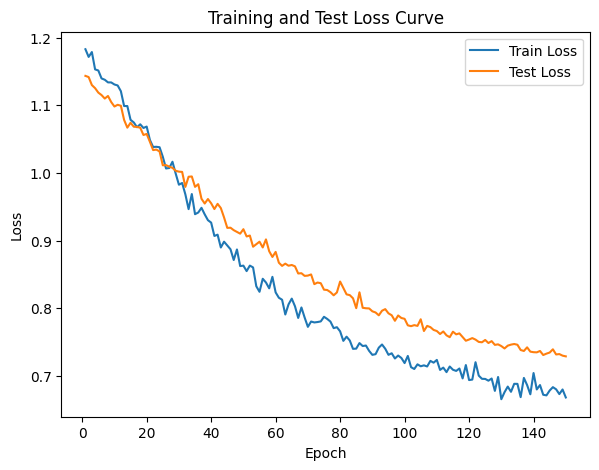

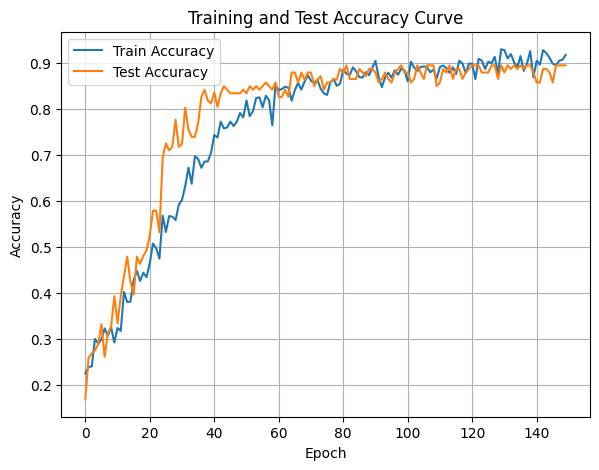

In [62]:
DTEmlp8b.train_single_model()

Randomly initializing 8 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  4.70it/s]

Epoch [1/10], Train F1:0.4928223675059118, Train Loss: 1.0682, Train Acc: 0.4568, Test F1:0.6063384664682429, Test Loss: 1.0488, Test Acc: 0.5799


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.02it/s]

Epoch [2/10], Train F1:0.48283976940693357, Train Loss: 1.0707, Train Acc: 0.4421, Test F1:0.6050704704497193, Test Loss: 1.0517, Test Acc: 0.5851
Epoch [3/10], Train F1:0.513681936330454, Train Loss: 1.0632, Train Acc: 0.4685, Test F1:0.6110656255218962, Test Loss: 1.0499, Test Acc: 0.5952


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.53it/s]

Epoch [4/10], Train F1:0.5172468105520734, Train Loss: 1.0614, Train Acc: 0.4744, Test F1:0.6272162214083425, Test Loss: 1.0458, Test Acc: 0.6139
Epoch [5/10], Train F1:0.5202628158067378, Train Loss: 1.0581, Train Acc: 0.4779, Test F1:0.6343376613912768, Test Loss: 1.0423, Test Acc: 0.6220


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.35it/s]

Epoch [6/10], Train F1:0.5246658002342932, Train Loss: 1.0565, Train Acc: 0.4820, Test F1:0.637923168965905, Test Loss: 1.0408, Test Acc: 0.6262
Epoch [7/10], Train F1:0.5342638075631502, Train Loss: 1.0509, Train Acc: 0.4918, Test F1:0.6449071708397206, Test Loss: 1.0379, Test Acc: 0.6347


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.92it/s]

Epoch [8/10], Train F1:0.5397216294814225, Train Loss: 1.0469, Train Acc: 0.4974, Test F1:0.6512955591382751, Test Loss: 1.0356, Test Acc: 0.6411
Epoch [9/10], Train F1:0.5501915721246632, Train Loss: 1.0421, Train Acc: 0.5087, Test F1:0.6543989243977235, Test Loss: 1.0327, Test Acc: 0.6452


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.70it/s]


Epoch [10/10], Train F1:0.5586662224621062, Train Loss: 1.0386, Train Acc: 0.5173, Test F1:0.6623134789312094, Test Loss: 1.0306, Test Acc: 0.6537
Total Epochs: 10
Train loss start: 1.0418334007263184, Train loss end: 1.0909548997879028
Highest Mean Train Accuracy (over epoch): 0.5173214285714285
Test loss start: 1.0524500608444214, Test loss end: 1.008982539176941
Highest mean Test Accuracy (over epoch): 0.6537326388888889


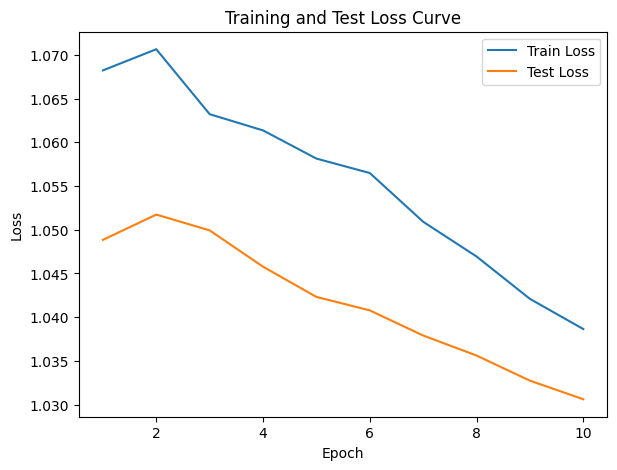

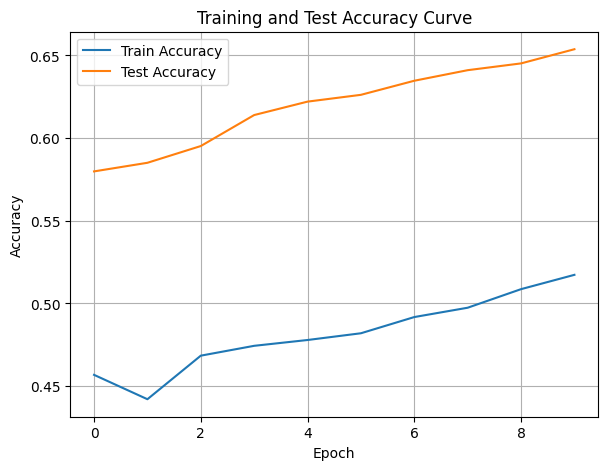

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.40it/s]

Epoch [1/10], Train F1:0.3516023039921423, Train Loss: 1.1074, Train Acc: 0.3482, Test F1:0.2262363225136011, Test Loss: 1.1092, Test Acc: 0.2465


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.40it/s]

Epoch [2/10], Train F1:0.35693257282357177, Train Loss: 1.1098, Train Acc: 0.3408, Test F1:0.2199305714697969, Test Loss: 1.1172, Test Acc: 0.2643


Training Process:  30%|███       | 3/10 [00:00<00:01,  5.54it/s]

Epoch [3/10], Train F1:0.37570999493094437, Train Loss: 1.1060, Train Acc: 0.3551, Test F1:0.2156330398583046, Test Loss: 1.1192, Test Acc: 0.2755


Training Process:  40%|████      | 4/10 [00:00<00:01,  5.29it/s]

Epoch [4/10], Train F1:0.37849744080544023, Train Loss: 1.1009, Train Acc: 0.3662, Test F1:0.21138972327427333, Test Loss: 1.1219, Test Acc: 0.2737


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.57it/s]

Epoch [5/10], Train F1:0.3771289998449135, Train Loss: 1.0998, Train Acc: 0.3643, Test F1:0.20851936367088628, Test Loss: 1.1238, Test Acc: 0.2635
Epoch [6/10], Train F1:0.38558345383826054, Train Loss: 1.0939, Train Acc: 0.3738, Test F1:0.21285471743875817, Test Loss: 1.1207, Test Acc: 0.2755


Training Process:  70%|███████   | 7/10 [00:01<00:00,  5.53it/s]

Epoch [7/10], Train F1:0.3874246166490575, Train Loss: 1.0910, Train Acc: 0.3772, Test F1:0.21153732571745673, Test Loss: 1.1196, Test Acc: 0.2775


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.05it/s]

Epoch [8/10], Train F1:0.39812665147538423, Train Loss: 1.0874, Train Acc: 0.3880, Test F1:0.21266989903006392, Test Loss: 1.1166, Test Acc: 0.2865


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.03it/s]

Epoch [9/10], Train F1:0.3996547884453746, Train Loss: 1.0844, Train Acc: 0.3906, Test F1:0.212280790588553, Test Loss: 1.1155, Test Acc: 0.2853


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.17it/s]


Epoch [10/10], Train F1:0.40775224310165, Train Loss: 1.0812, Train Acc: 0.3978, Test F1:0.21387870504600975, Test Loss: 1.1133, Test Acc: 0.2887
Total Epochs: 10
Train loss start: 1.1149159669876099, Train loss end: 1.1331804990768433
Highest Mean Train Accuracy (over epoch): 0.397797619047619
Test loss start: 1.1151015758514404, Test loss end: 1.0773634910583496
Highest mean Test Accuracy (over epoch): 0.2887152777777778


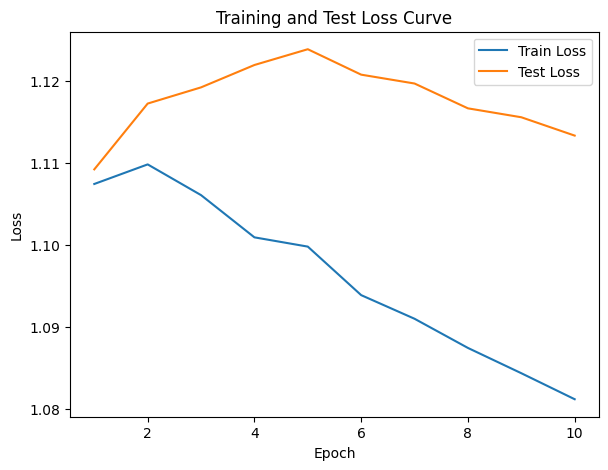

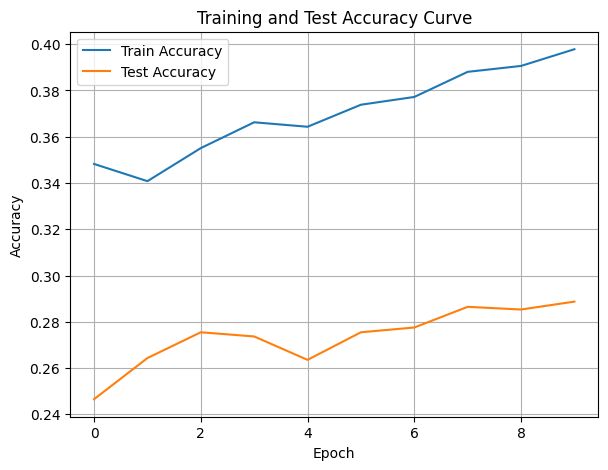

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.76it/s]

Epoch [1/10], Train F1:0.3791307874642557, Train Loss: 1.1200, Train Acc: 0.3077, Test F1:0.2059314954051796, Test Loss: 1.1140, Test Acc: 0.1293


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.37it/s]

Epoch [2/10], Train F1:0.3782313524982357, Train Loss: 1.1254, Train Acc: 0.2945, Test F1:0.1653561822175576, Test Loss: 1.1248, Test Acc: 0.1068


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.37it/s]

Epoch [3/10], Train F1:0.38300609380326733, Train Loss: 1.1199, Train Acc: 0.2988, Test F1:0.1750549032415697, Test Loss: 1.1241, Test Acc: 0.1175


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.72it/s]

Epoch [4/10], Train F1:0.38617828182821295, Train Loss: 1.1145, Train Acc: 0.3023, Test F1:0.1926087147693796, Test Loss: 1.1226, Test Acc: 0.1274


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.23it/s]

Epoch [5/10], Train F1:0.38773206125254306, Train Loss: 1.1119, Train Acc: 0.3065, Test F1:0.19258308703761415, Test Loss: 1.1225, Test Acc: 0.1259


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.45it/s]

Epoch [6/10], Train F1:0.3992502465380147, Train Loss: 1.1049, Train Acc: 0.3201, Test F1:0.20285072716734426, Test Loss: 1.1201, Test Acc: 0.1343


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.66it/s]

Epoch [7/10], Train F1:0.41288928188451623, Train Loss: 1.1002, Train Acc: 0.3302, Test F1:0.22520004378010294, Test Loss: 1.1158, Test Acc: 0.1509


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.96it/s]

Epoch [8/10], Train F1:0.42497199748781717, Train Loss: 1.0956, Train Acc: 0.3414, Test F1:0.24877529273805005, Test Loss: 1.1125, Test Acc: 0.1696
Epoch [9/10], Train F1:0.431498682812901, Train Loss: 1.0921, Train Acc: 0.3479, Test F1:0.2646662582316765, Test Loss: 1.1100, Test Acc: 0.1826


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.60it/s]


Epoch [10/10], Train F1:0.4366633550023856, Train Loss: 1.0880, Train Acc: 0.3534, Test F1:0.2855967106257836, Test Loss: 1.1073, Test Acc: 0.1975
Total Epochs: 10
Train loss start: 1.106831431388855, Train loss end: 1.0715219974517822
Highest Mean Train Accuracy (over epoch): 0.35336309523809517
Test loss start: 1.1211122274398804, Test loss end: 1.0748012065887451
Highest mean Test Accuracy (over epoch): 0.1974826388888889


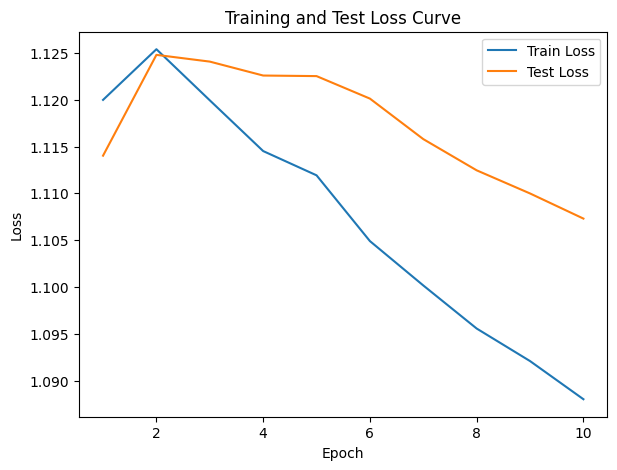

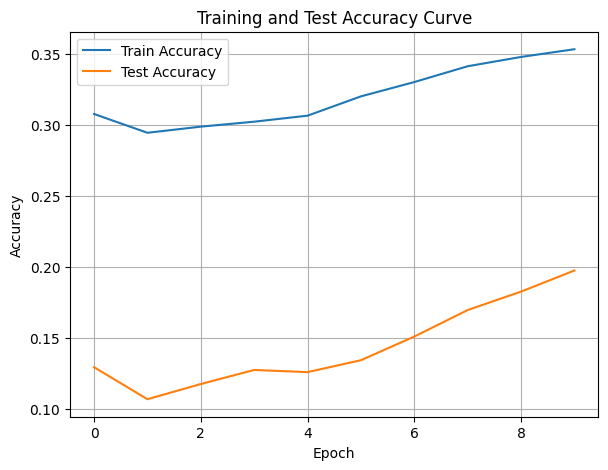

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.57it/s]

Epoch [1/10], Train F1:0.21610945598284015, Train Loss: 1.2013, Train Acc: 0.2399, Test F1:0.20392862498125652, Test Loss: 1.2021, Test Acc: 0.2899


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.38it/s]

Epoch [2/10], Train F1:0.21908712572183334, Train Loss: 1.2045, Train Acc: 0.2368, Test F1:0.20336555674901538, Test Loss: 1.2070, Test Acc: 0.3047


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.31it/s]

Epoch [3/10], Train F1:0.22326693255510588, Train Loss: 1.2056, Train Acc: 0.2381, Test F1:0.20343411720791338, Test Loss: 1.2085, Test Acc: 0.3142


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.56it/s]

Epoch [4/10], Train F1:0.22769318600148833, Train Loss: 1.2014, Train Acc: 0.2429, Test F1:0.20187454938716654, Test Loss: 1.2080, Test Acc: 0.3190


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.71it/s]

Epoch [5/10], Train F1:0.23923889539471294, Train Loss: 1.1982, Train Acc: 0.2546, Test F1:0.2008097165991903, Test Loss: 1.2064, Test Acc: 0.3234


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.09it/s]

Epoch [6/10], Train F1:0.24280217054475353, Train Loss: 1.1945, Train Acc: 0.2591, Test F1:0.20050125313283212, Test Loss: 1.2039, Test Acc: 0.3277


Training Process:  70%|███████   | 7/10 [00:01<00:00,  4.87it/s]

Epoch [7/10], Train F1:0.24707763073126174, Train Loss: 1.1902, Train Acc: 0.2663, Test F1:0.20071684587813618, Test Loss: 1.2019, Test Acc: 0.3307


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.65it/s]

Epoch [8/10], Train F1:0.2479537545408426, Train Loss: 1.1892, Train Acc: 0.2678, Test F1:0.20068863748155433, Test Loss: 1.2006, Test Acc: 0.3330
Epoch [9/10], Train F1:0.24908993704333163, Train Loss: 1.1866, Train Acc: 0.2717, Test F1:0.20066695664781786, Test Loss: 1.1990, Test Acc: 0.3348


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.71it/s]


Epoch [10/10], Train F1:0.2536031861115473, Train Loss: 1.1821, Train Acc: 0.2774, Test F1:0.2008739320420009, Test Loss: 1.1980, Test Acc: 0.3354
Total Epochs: 10
Train loss start: 1.2014535665512085, Train loss end: 0.9717451930046082
Highest Mean Train Accuracy (over epoch): 0.27735119047619045
Test loss start: 1.2116069793701172, Test loss end: 1.1830132007598877
Highest mean Test Accuracy (over epoch): 0.33541666666666664


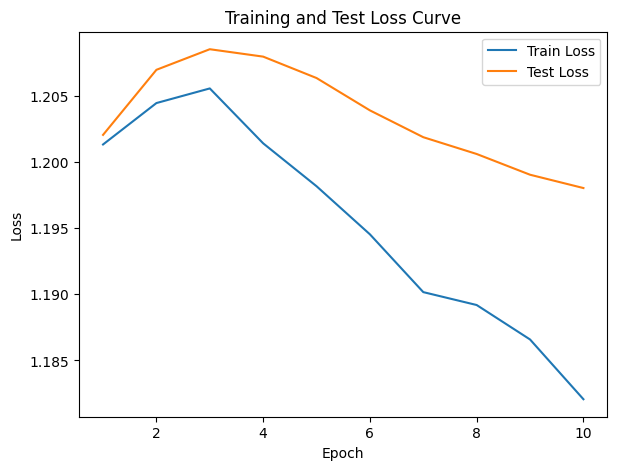

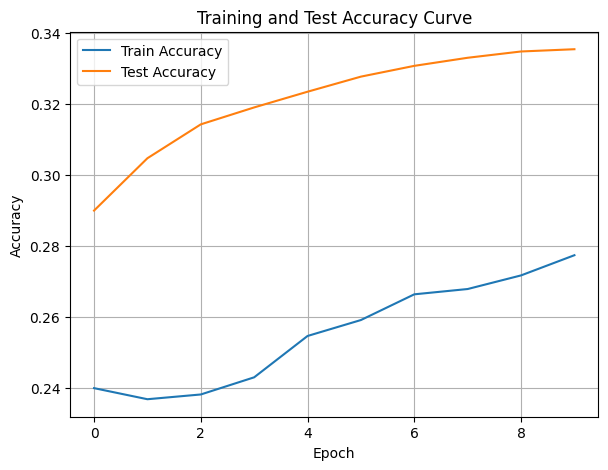

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.48it/s]

Epoch [1/10], Train F1:0.23326164120306617, Train Loss: 1.2183, Train Acc: 0.1533, Test F1:0.23782475928349456, Test Loss: 1.1548, Test Acc: 0.1962


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.84it/s]

Epoch [2/10], Train F1:0.2360492744633626, Train Loss: 1.2178, Train Acc: 0.1591, Test F1:0.2355130249867092, Test Loss: 1.1508, Test Acc: 0.2040


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.97it/s]

Epoch [3/10], Train F1:0.2379416569350612, Train Loss: 1.2174, Train Acc: 0.1567, Test F1:0.22533990654291408, Test Loss: 1.1516, Test Acc: 0.2060


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.50it/s]

Epoch [4/10], Train F1:0.25353603260004026, Train Loss: 1.2109, Train Acc: 0.1660, Test F1:0.2328283279033998, Test Loss: 1.1488, Test Acc: 0.2183


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.67it/s]

Epoch [5/10], Train F1:0.26668182051547806, Train Loss: 1.2064, Train Acc: 0.1768, Test F1:0.23787955853739276, Test Loss: 1.1465, Test Acc: 0.2229


Training Process:  70%|███████   | 7/10 [00:01<00:00,  5.46it/s]

Epoch [6/10], Train F1:0.27283646830009073, Train Loss: 1.2045, Train Acc: 0.1842, Test F1:0.2397915515720211, Test Loss: 1.1436, Test Acc: 0.2309
Epoch [7/10], Train F1:0.2782614286941276, Train Loss: 1.2025, Train Acc: 0.1876, Test F1:0.24777573580267404, Test Loss: 1.1404, Test Acc: 0.2411


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.15it/s]

Epoch [8/10], Train F1:0.2894471171381337, Train Loss: 1.1990, Train Acc: 0.1970, Test F1:0.2494605803123304, Test Loss: 1.1379, Test Acc: 0.2450
Epoch [9/10], Train F1:0.29693265667726304, Train Loss: 1.1950, Train Acc: 0.2028, Test F1:0.2512015625544976, Test Loss: 1.1370, Test Acc: 0.2470


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.88it/s]


Epoch [10/10], Train F1:0.30740364623836736, Train Loss: 1.1910, Train Acc: 0.2123, Test F1:0.2503508658227695, Test Loss: 1.1346, Test Acc: 0.2496
Total Epochs: 10
Train loss start: 1.238625168800354, Train loss end: 1.1515079736709595
Highest Mean Train Accuracy (over epoch): 0.21226190476190473
Test loss start: 1.1579927206039429, Test loss end: 1.118095874786377
Highest mean Test Accuracy (over epoch): 0.24956597222222224


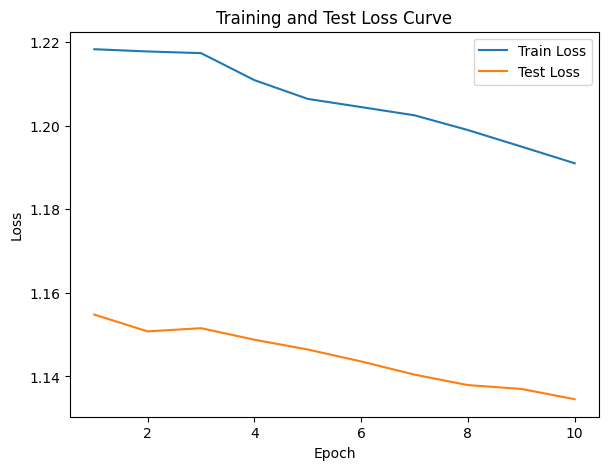

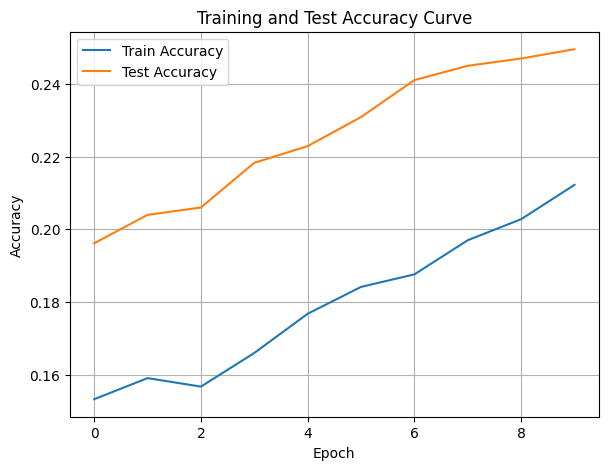

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.82it/s]

Epoch [1/10], Train F1:0.38043831484154705, Train Loss: 1.1279, Train Acc: 0.3220, Test F1:0.20876745815260328, Test Loss: 1.1116, Test Acc: 0.1693


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.25it/s]

Epoch [2/10], Train F1:0.4087322440398279, Train Loss: 1.1133, Train Acc: 0.3534, Test F1:0.2081750768674263, Test Loss: 1.1160, Test Acc: 0.1584


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.19it/s]

Epoch [3/10], Train F1:0.4253930877454851, Train Loss: 1.1082, Train Acc: 0.3708, Test F1:0.225028873123247, Test Loss: 1.1117, Test Acc: 0.1745


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.74it/s]

Epoch [4/10], Train F1:0.41392143296165307, Train Loss: 1.1071, Train Acc: 0.3676, Test F1:0.22676319490709898, Test Loss: 1.1130, Test Acc: 0.1751
Epoch [5/10], Train F1:0.4280952109322617, Train Loss: 1.1024, Train Acc: 0.3826, Test F1:0.2359476462356127, Test Loss: 1.1119, Test Acc: 0.1786


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.58it/s]

Epoch [6/10], Train F1:0.4322449875717511, Train Loss: 1.0975, Train Acc: 0.3896, Test F1:0.24897200020107577, Test Loss: 1.1104, Test Acc: 0.1862
Epoch [7/10], Train F1:0.436113971763148, Train Loss: 1.0952, Train Acc: 0.3947, Test F1:0.26494978292654503, Test Loss: 1.1082, Test Acc: 0.1983


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.07it/s]

Epoch [8/10], Train F1:0.449880432005484, Train Loss: 1.0893, Train Acc: 0.4082, Test F1:0.27308488036590683, Test Loss: 1.1059, Test Acc: 0.2064
Epoch [9/10], Train F1:0.457831373979568, Train Loss: 1.0859, Train Acc: 0.4150, Test F1:0.279955511755682, Test Loss: 1.1047, Test Acc: 0.2118


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.51it/s]


Epoch [10/10], Train F1:0.4665979689831241, Train Loss: 1.0818, Train Acc: 0.4238, Test F1:0.3006668979593751, Test Loss: 1.1017, Test Acc: 0.2277
Total Epochs: 10
Train loss start: 1.1136466264724731, Train loss end: 1.0104349851608276
Highest Mean Train Accuracy (over epoch): 0.4238392857142857
Test loss start: 1.1056147813796997, Test loss end: 1.071547031402588
Highest mean Test Accuracy (over epoch): 0.22769097222222223


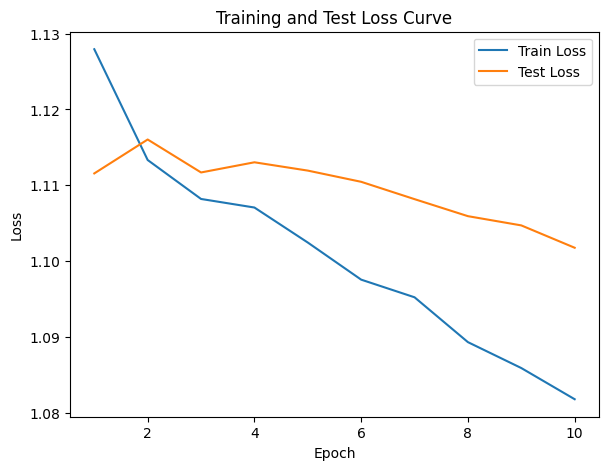

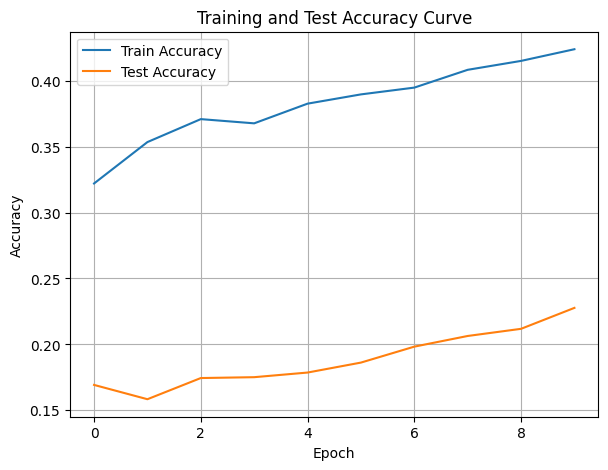

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.94it/s]

Epoch [1/10], Train F1:0.26423581943935603, Train Loss: 1.1715, Train Acc: 0.2140, Test F1:0.21740221031974383, Test Loss: 1.1258, Test Acc: 0.2101


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.76it/s]

Epoch [2/10], Train F1:0.2591184005116339, Train Loss: 1.1701, Train Acc: 0.1976, Test F1:0.2150284993255885, Test Loss: 1.1261, Test Acc: 0.2170


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.63it/s]

Epoch [3/10], Train F1:0.2868466162810095, Train Loss: 1.1611, Train Acc: 0.2221, Test F1:0.23084213055616157, Test Loss: 1.1215, Test Acc: 0.2323


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.83it/s]

Epoch [4/10], Train F1:0.299222247270718, Train Loss: 1.1567, Train Acc: 0.2315, Test F1:0.23268670455350096, Test Loss: 1.1179, Test Acc: 0.2420


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.69it/s]

Epoch [5/10], Train F1:0.31021384610486313, Train Loss: 1.1529, Train Acc: 0.2411, Test F1:0.23754444319399118, Test Loss: 1.1164, Test Acc: 0.2446


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.97it/s]

Epoch [6/10], Train F1:0.3175393606102919, Train Loss: 1.1495, Train Acc: 0.2491, Test F1:0.2431768896427537, Test Loss: 1.1134, Test Acc: 0.2503


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.10it/s]

Epoch [7/10], Train F1:0.32262461398477865, Train Loss: 1.1464, Train Acc: 0.2557, Test F1:0.2438462936159033, Test Loss: 1.1123, Test Acc: 0.2532


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.50it/s]

Epoch [8/10], Train F1:0.3276474590402178, Train Loss: 1.1448, Train Acc: 0.2616, Test F1:0.25415403420244687, Test Loss: 1.1109, Test Acc: 0.2593


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.05it/s]

Epoch [9/10], Train F1:0.33743369609448154, Train Loss: 1.1414, Train Acc: 0.2709, Test F1:0.260684649700668, Test Loss: 1.1087, Test Acc: 0.2641


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.02it/s]


Epoch [10/10], Train F1:0.34322624440282806, Train Loss: 1.1385, Train Acc: 0.2765, Test F1:0.2718974265264617, Test Loss: 1.1058, Test Acc: 0.2718
Total Epochs: 10
Train loss start: 1.1624842882156372, Train loss end: 1.1429928541183472
Highest Mean Train Accuracy (over epoch): 0.27648809523809526
Test loss start: 1.1293256282806396, Test loss end: 1.0884590148925781
Highest mean Test Accuracy (over epoch): 0.2717881944444444


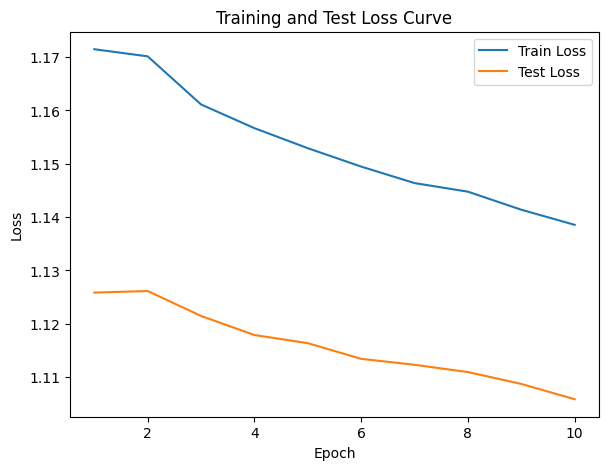

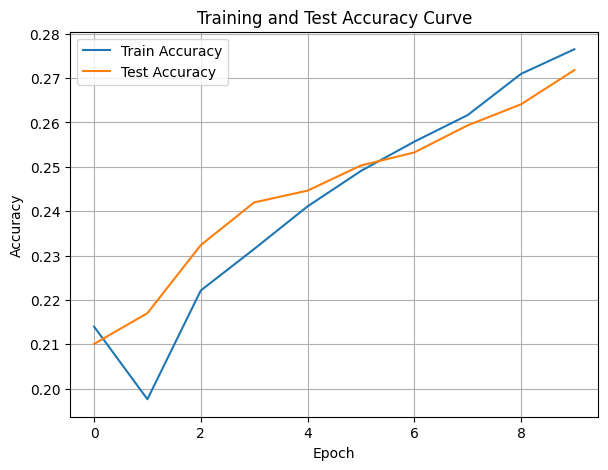

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.37681391253862584, Train Loss: 1.1080, Train Acc: 0.2932, Test F1:0.3861910415135584, Test Loss: 1.0995, Test Acc: 0.2769


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.18it/s]

Epoch [2/10], Train F1:0.39308308998026337, Train Loss: 1.1036, Train Acc: 0.3045, Test F1:0.3933147930934453, Test Loss: 1.0956, Test Acc: 0.2786


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.18it/s]

Epoch [3/10], Train F1:0.3987403669633534, Train Loss: 1.1013, Train Acc: 0.3125, Test F1:0.3933756600122639, Test Loss: 1.0954, Test Acc: 0.2847


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.19it/s]

Epoch [4/10], Train F1:0.4114231920430233, Train Loss: 1.0978, Train Acc: 0.3283, Test F1:0.38505105558656466, Test Loss: 1.0961, Test Acc: 0.2754


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.22it/s]

Epoch [5/10], Train F1:0.42604000717333496, Train Loss: 1.0921, Train Acc: 0.3421, Test F1:0.384893449537952, Test Loss: 1.0956, Test Acc: 0.2757


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.83it/s]

Epoch [6/10], Train F1:0.4357228580855454, Train Loss: 1.0895, Train Acc: 0.3527, Test F1:0.4041380507545921, Test Loss: 1.0939, Test Acc: 0.2943


Training Process:  70%|███████   | 7/10 [00:01<00:00,  5.52it/s]

Epoch [7/10], Train F1:0.44413239687001327, Train Loss: 1.0873, Train Acc: 0.3584, Test F1:0.42116633769169975, Test Loss: 1.0921, Test Acc: 0.3089


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.29it/s]

Epoch [8/10], Train F1:0.4498068683138226, Train Loss: 1.0850, Train Acc: 0.3639, Test F1:0.4416515701729615, Test Loss: 1.0888, Test Acc: 0.3290


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.25it/s]


Epoch [9/10], Train F1:0.4553664591400441, Train Loss: 1.0827, Train Acc: 0.3691, Test F1:0.45438203953875156, Test Loss: 1.0865, Test Acc: 0.3409
Epoch [10/10], Train F1:0.4673482632294816, Train Loss: 1.0785, Train Acc: 0.3797, Test F1:0.46877507299602145, Test Loss: 1.0840, Test Acc: 0.3556
Total Epochs: 10
Train loss start: 1.1424968242645264, Train loss end: 1.0057899951934814
Highest Mean Train Accuracy (over epoch): 0.3797321428571428
Test loss start: 1.0959209203720093, Test loss end: 1.037954330444336
Highest mean Test Accuracy (over epoch): 0.35564236111111114


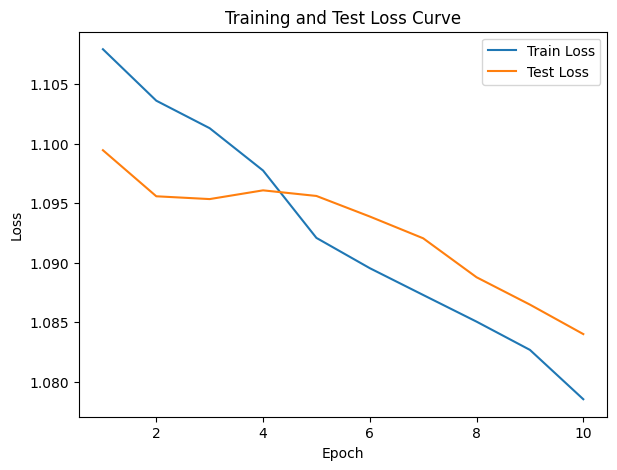

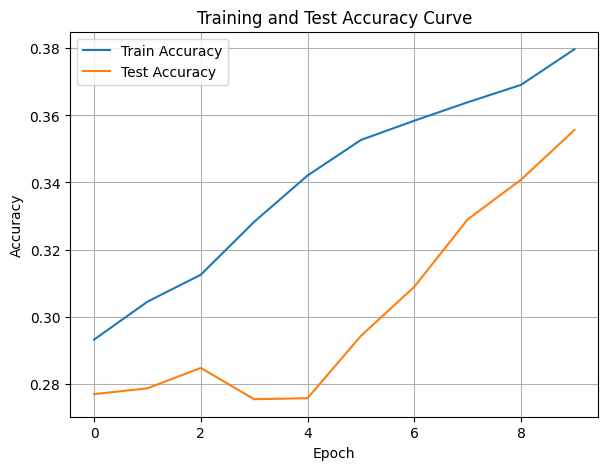

./saved_models/model_8.pth
Training Model with id 12
in multi


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.56it/s]

Epoch [1/10], Train F1:0.5470561249702354, Train Loss: 1.0489, Train Acc: 0.4851, Test F1:0.5705680827745705, Test Loss: 1.0617, Test Acc: 0.4809
Epoch [2/10], Train F1:0.5617174720661967, Train Loss: 1.0443, Train Acc: 0.4970, Test F1:0.5864359876210695, Test Loss: 1.0577, Test Acc: 0.4965


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.73it/s]

Epoch [3/10], Train F1:0.5747934644474129, Train Loss: 1.0386, Train Acc: 0.5086, Test F1:0.5977755054015264, Test Loss: 1.0562, Test Acc: 0.5064
Epoch [4/10], Train F1:0.588868148957454, Train Loss: 1.0300, Train Acc: 0.5251, Test F1:0.5967595495002149, Test Loss: 1.0548, Test Acc: 0.5074


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.01it/s]

Epoch [5/10], Train F1:0.6012098738304679, Train Loss: 1.0258, Train Acc: 0.5384, Test F1:0.5990432346921108, Test Loss: 1.0533, Test Acc: 0.5095
Epoch [6/10], Train F1:0.6019895727123453, Train Loss: 1.0248, Train Acc: 0.5415, Test F1:0.5963169361311776, Test Loss: 1.0518, Test Acc: 0.5214


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.46it/s]

Epoch [7/10], Train F1:0.6060609576465551, Train Loss: 1.0241, Train Acc: 0.5445, Test F1:0.6026880331101472, Test Loss: 1.0500, Test Acc: 0.5296


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.01it/s]

Epoch [8/10], Train F1:0.6104672869079296, Train Loss: 1.0214, Train Acc: 0.5500, Test F1:0.6224113792380257, Test Loss: 1.0474, Test Acc: 0.5522
Epoch [9/10], Train F1:0.6168839766038199, Train Loss: 1.0180, Train Acc: 0.5593, Test F1:0.639415046332887, Test Loss: 1.0453, Test Acc: 0.5732


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.16it/s]


Epoch [10/10], Train F1:0.6238707937397387, Train Loss: 1.0152, Train Acc: 0.5691, Test F1:0.656747008216211, Test Loss: 1.0440, Test Acc: 0.5918
Total Epochs: 10
Train loss start: 1.0270086526870728, Train loss end: 0.8952001929283142
Highest Mean Train Accuracy (over epoch): 0.5691071428571428
Test loss start: 1.0619151592254639, Test loss end: 1.0057810544967651
Highest mean Test Accuracy (over epoch): 0.5917534722222222


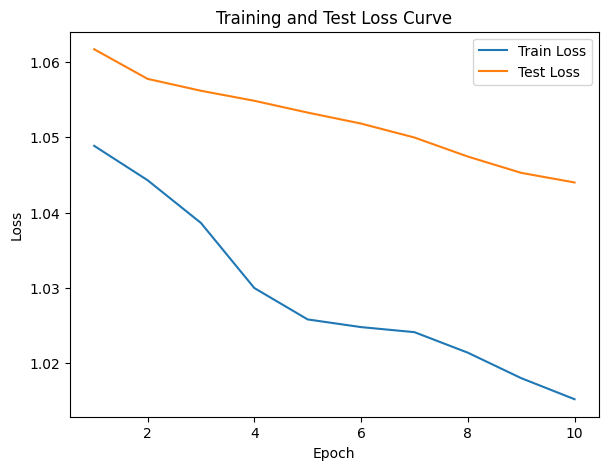

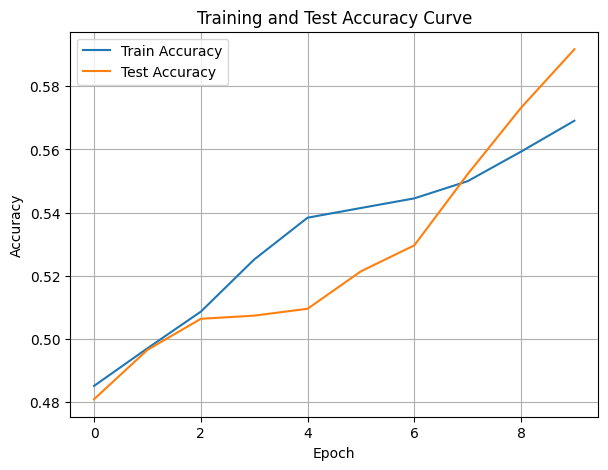

./saved_models/model_12.pth
Training Model with id 13
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.64it/s]

Epoch [1/10], Train F1:0.6999138476202696, Train Loss: 0.9728, Train Acc: 0.6601, Test F1:0.7637085236129796, Test Loss: 1.0254, Test Acc: 0.7491


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.64it/s]

Epoch [2/10], Train F1:0.7045696205075211, Train Loss: 0.9746, Train Acc: 0.6685, Test F1:0.7129149974674218, Test Loss: 1.0275, Test Acc: 0.6962


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.22it/s]

Epoch [3/10], Train F1:0.6992637706865948, Train Loss: 0.9733, Train Acc: 0.6668, Test F1:0.6978245614035088, Test Loss: 1.0262, Test Acc: 0.6858


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.22it/s]

Epoch [4/10], Train F1:0.7140475959188954, Train Loss: 0.9679, Train Acc: 0.6810, Test F1:0.7229406850459482, Test Loss: 1.0210, Test Acc: 0.7114


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.91it/s]

Epoch [5/10], Train F1:0.71263062591349, Train Loss: 0.9660, Train Acc: 0.6805, Test F1:0.7304170614711167, Test Loss: 1.0183, Test Acc: 0.7205


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.23it/s]

Epoch [6/10], Train F1:0.7241756655702162, Train Loss: 0.9607, Train Acc: 0.6935, Test F1:0.7396566307298145, Test Loss: 1.0153, Test Acc: 0.7295


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.06it/s]

Epoch [7/10], Train F1:0.7265158596271528, Train Loss: 0.9589, Train Acc: 0.6963, Test F1:0.7339815237880001, Test Loss: 1.0139, Test Acc: 0.7238


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.26it/s]

Epoch [8/10], Train F1:0.7302035461033403, Train Loss: 0.9560, Train Acc: 0.7011, Test F1:0.7361576208903117, Test Loss: 1.0120, Test Acc: 0.7262


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.94it/s]

Epoch [9/10], Train F1:0.7335335614565276, Train Loss: 0.9532, Train Acc: 0.7045, Test F1:0.7453934872688883, Test Loss: 1.0098, Test Acc: 0.7364
Epoch [10/10], Train F1:0.7393568754581664, Train Loss: 0.9490, Train Acc: 0.7125, Test F1:0.7517656145770266, Test Loss: 1.0075, Test Acc: 0.7438


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.67it/s]


Total Epochs: 10
Train loss start: 0.9597833752632141, Train loss end: 0.8825265169143677
Highest Mean Train Accuracy (over epoch): 0.7125
Test loss start: 1.0301507711410522, Test loss end: 0.9533326029777527
Highest mean Test Accuracy (over epoch): 0.7491319444444444


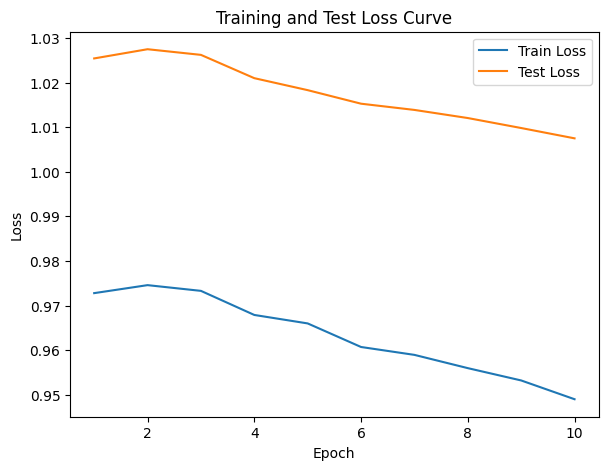

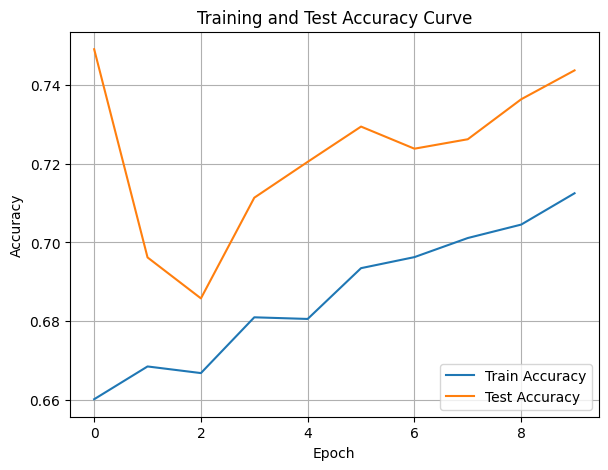

./saved_models/model_13.pth
Training Model with id 11
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.24it/s]

Epoch [1/10], Train F1:0.7839985673377589, Train Loss: 0.9217, Train Acc: 0.7726, Test F1:0.8070175438596493, Test Loss: 0.9818, Test Acc: 0.8099


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.13it/s]

Epoch [2/10], Train F1:0.8008057207814795, Train Loss: 0.9091, Train Acc: 0.7899, Test F1:0.822886536027003, Test Loss: 0.9782, Test Acc: 0.8255


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.50it/s]

Epoch [3/10], Train F1:0.7921905342635065, Train Loss: 0.9086, Train Acc: 0.7807, Test F1:0.7863430480406624, Test Loss: 0.9752, Test Acc: 0.7850


Training Process:  40%|████      | 4/10 [00:00<00:01,  5.86it/s]

Epoch [4/10], Train F1:0.793325826651956, Train Loss: 0.9058, Train Acc: 0.7818, Test F1:0.7959046922862711, Test Loss: 0.9735, Test Acc: 0.7936


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.20it/s]

Epoch [5/10], Train F1:0.792829768102512, Train Loss: 0.9060, Train Acc: 0.7820, Test F1:0.7999861739784847, Test Loss: 0.9725, Test Acc: 0.7972


Training Process:  60%|██████    | 6/10 [00:01<00:00,  4.61it/s]

Epoch [6/10], Train F1:0.7947669558059101, Train Loss: 0.9022, Train Acc: 0.7864, Test F1:0.8013311665626288, Test Loss: 0.9703, Test Acc: 0.7983


Training Process:  70%|███████   | 7/10 [00:01<00:00,  4.12it/s]

Epoch [7/10], Train F1:0.7977173321136266, Train Loss: 0.8993, Train Acc: 0.7878, Test F1:0.8081842678591904, Test Loss: 0.9709, Test Acc: 0.8056


Training Process:  80%|████████  | 8/10 [00:01<00:00,  3.90it/s]

Epoch [8/10], Train F1:0.7998676750242466, Train Loss: 0.8968, Train Acc: 0.7920, Test F1:0.8126992571600892, Test Loss: 0.9698, Test Acc: 0.8117


Training Process: 100%|██████████| 10/10 [00:02<00:00,  4.89it/s]


Epoch [9/10], Train F1:0.8038110851465233, Train Loss: 0.8942, Train Acc: 0.7958, Test F1:0.818596859025406, Test Loss: 0.9671, Test Acc: 0.8183
Epoch [10/10], Train F1:0.8059781396486532, Train Loss: 0.8921, Train Acc: 0.7990, Test F1:0.8183687265715287, Test Loss: 0.9652, Test Acc: 0.8176
Total Epochs: 10
Train loss start: 0.9109984040260315, Train loss end: 0.9163264632225037
Highest Mean Train Accuracy (over epoch): 0.7990476190476191
Test loss start: 0.9844413995742798, Test loss end: 0.9169812798500061
Highest mean Test Accuracy (over epoch): 0.8255208333333334


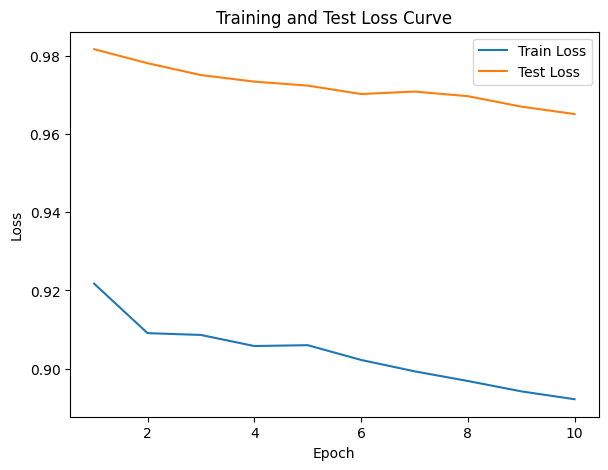

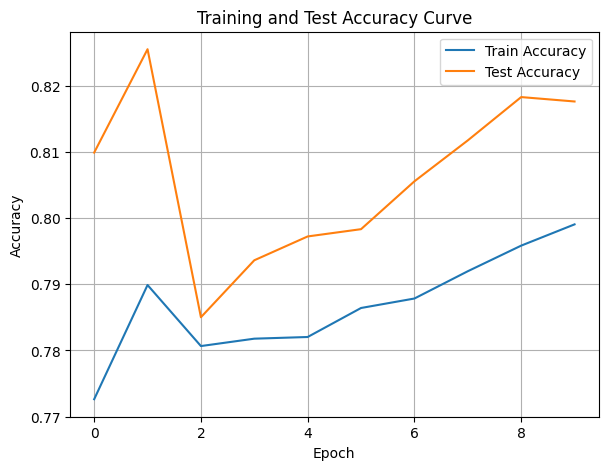

./saved_models/model_11.pth
Training Model with id 13
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.46it/s]

Epoch [1/10], Train F1:0.8611011743375792, Train Loss: 0.8614, Train Acc: 0.8369, Test F1:0.840027700831025, Test Loss: 0.9376, Test Acc: 0.8411


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.62it/s]

Epoch [2/10], Train F1:0.8442654447943848, Train Loss: 0.8657, Train Acc: 0.8213, Test F1:0.8286974344571165, Test Loss: 0.9444, Test Acc: 0.8264


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.68it/s]

Epoch [3/10], Train F1:0.8397587328464772, Train Loss: 0.8592, Train Acc: 0.8235, Test F1:0.8411336032388663, Test Loss: 0.9466, Test Acc: 0.8411


Training Process:  40%|████      | 4/10 [00:00<00:01,  5.94it/s]

Epoch [4/10], Train F1:0.8443478704836382, Train Loss: 0.8539, Train Acc: 0.8319, Test F1:0.8369829629139632, Test Loss: 0.9456, Test Acc: 0.8357


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.46it/s]

Epoch [5/10], Train F1:0.8383834567930115, Train Loss: 0.8523, Train Acc: 0.8276, Test F1:0.8330400841664661, Test Loss: 0.9438, Test Acc: 0.8309


Training Process:  70%|███████   | 7/10 [00:01<00:00,  5.69it/s]

Epoch [6/10], Train F1:0.8408761148899057, Train Loss: 0.8505, Train Acc: 0.8330, Test F1:0.838536356781785, Test Loss: 0.9395, Test Acc: 0.8375
Epoch [7/10], Train F1:0.8414411505746399, Train Loss: 0.8496, Train Acc: 0.8333, Test F1:0.8402377003389516, Test Loss: 0.9368, Test Acc: 0.8392


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.51it/s]

Epoch [8/10], Train F1:0.8422865224784611, Train Loss: 0.8480, Train Acc: 0.8343, Test F1:0.8365639043628366, Test Loss: 0.9366, Test Acc: 0.8355
Epoch [9/10], Train F1:0.8422187524158249, Train Loss: 0.8446, Train Acc: 0.8361, Test F1:0.8361520017003665, Test Loss: 0.9348, Test Acc: 0.8353


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.32it/s]


Epoch [10/10], Train F1:0.841912745413356, Train Loss: 0.8425, Train Acc: 0.8373, Test F1:0.8366520501500266, Test Loss: 0.9324, Test Acc: 0.8359
Total Epochs: 10
Train loss start: 0.879141092300415, Train loss end: 0.739573061466217
Highest Mean Train Accuracy (over epoch): 0.8372619047619048
Test loss start: 0.9381537437438965, Test loss end: 0.8794386386871338
Highest mean Test Accuracy (over epoch): 0.8411458333333334


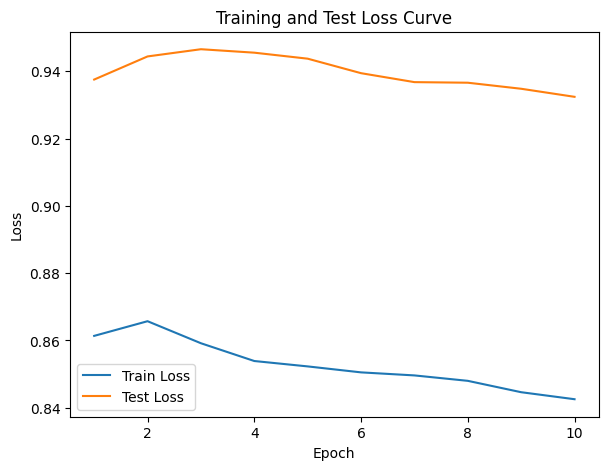

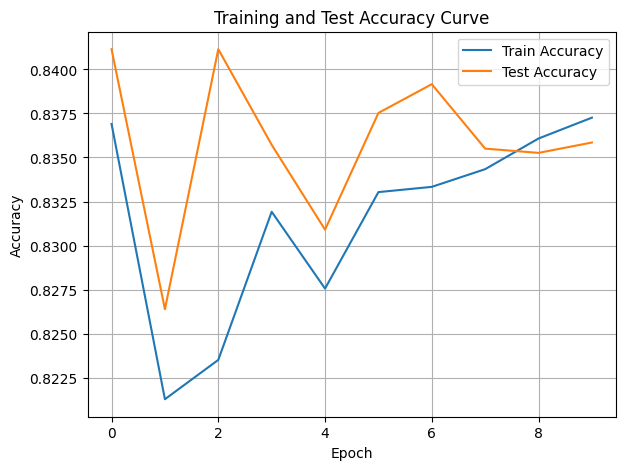

./saved_models/model_13.pth
Training Model with id 14
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.26it/s]

Epoch [1/10], Train F1:0.895524255330383, Train Loss: 0.8113, Train Acc: 0.8946, Test F1:0.8019150616821741, Test Loss: 0.9237, Test Acc: 0.8021


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.27it/s]

Epoch [2/10], Train F1:0.8823647440558856, Train Loss: 0.8097, Train Acc: 0.8859, Test F1:0.8263018657755501, Test Loss: 0.9200, Test Acc: 0.8255


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.27it/s]

Epoch [3/10], Train F1:0.8819785887709528, Train Loss: 0.8091, Train Acc: 0.8839, Test F1:0.8340848868021011, Test Loss: 0.9183, Test Acc: 0.8333


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.54it/s]

Epoch [4/10], Train F1:0.8727125397241826, Train Loss: 0.8113, Train Acc: 0.8709, Test F1:0.8460347836714377, Test Loss: 0.9127, Test Acc: 0.8466


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.40it/s]

Epoch [5/10], Train F1:0.8761488648612853, Train Loss: 0.8088, Train Acc: 0.8759, Test F1:0.8517246963562753, Test Loss: 0.9104, Test Acc: 0.8530


Training Process:  70%|███████   | 7/10 [00:00<00:00,  6.62it/s]

Epoch [6/10], Train F1:0.876444917716089, Train Loss: 0.8081, Train Acc: 0.8762, Test F1:0.8513492006806784, Test Loss: 0.9095, Test Acc: 0.8523
Epoch [7/10], Train F1:0.8785068707153612, Train Loss: 0.8053, Train Acc: 0.8783, Test F1:0.8546568126828621, Test Loss: 0.9075, Test Acc: 0.8560


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.25it/s]

Epoch [8/10], Train F1:0.8787682410865605, Train Loss: 0.8036, Train Acc: 0.8785, Test F1:0.85609531052194, Test Loss: 0.9062, Test Acc: 0.8579
Epoch [9/10], Train F1:0.876877085761855, Train Loss: 0.8017, Train Acc: 0.8768, Test F1:0.8581437312876138, Test Loss: 0.9044, Test Acc: 0.8601


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.62it/s]


Epoch [10/10], Train F1:0.8765564239990672, Train Loss: 0.8006, Train Acc: 0.8758, Test F1:0.860621008776136, Test Loss: 0.9026, Test Acc: 0.8628
Total Epochs: 10
Train loss start: 0.8457920551300049, Train loss end: 0.8644819855690002
Highest Mean Train Accuracy (over epoch): 0.8946428571428572
Test loss start: 0.9237251877784729, Test loss end: 0.8603829145431519
Highest mean Test Accuracy (over epoch): 0.8627604166666668


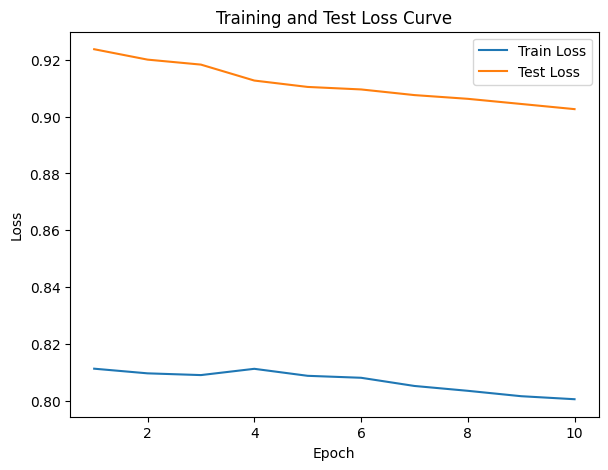

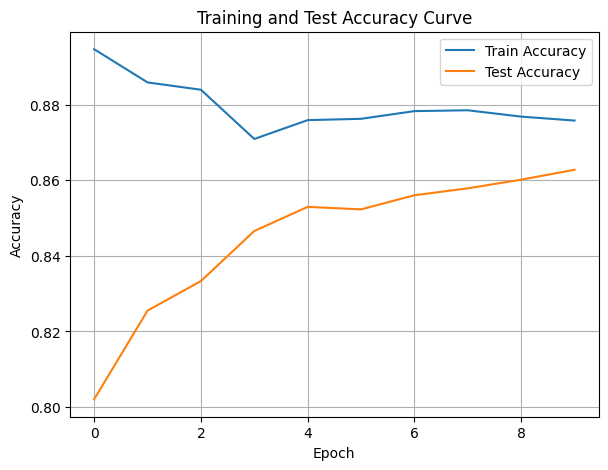

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.68it/s]

Epoch [1/10], Train F1:0.8578434054420979, Train Loss: 0.7968, Train Acc: 0.8518, Test F1:0.8411336032388664, Test Loss: 0.8930, Test Acc: 0.8411


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.64it/s]

Epoch [2/10], Train F1:0.8749131570184202, Train Loss: 0.7847, Train Acc: 0.8749, Test F1:0.8536240620966121, Test Loss: 0.8879, Test Acc: 0.8529


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.21it/s]

Epoch [3/10], Train F1:0.8739265590329418, Train Loss: 0.7822, Train Acc: 0.8738, Test F1:0.8633867777996987, Test Loss: 0.8805, Test Acc: 0.8640


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.28it/s]

Epoch [4/10], Train F1:0.8750166649817703, Train Loss: 0.7799, Train Acc: 0.8749, Test F1:0.8661850705194357, Test Loss: 0.8789, Test Acc: 0.8676


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.88it/s]

Epoch [5/10], Train F1:0.8755985424450171, Train Loss: 0.7768, Train Acc: 0.8770, Test F1:0.8628276212152067, Test Loss: 0.8792, Test Acc: 0.8639


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.69it/s]

Epoch [6/10], Train F1:0.8797980328612639, Train Loss: 0.7734, Train Acc: 0.8818, Test F1:0.8647853957264143, Test Loss: 0.8780, Test Acc: 0.8663


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.85it/s]

Epoch [7/10], Train F1:0.8832348603777175, Train Loss: 0.7709, Train Acc: 0.8838, Test F1:0.8672361032721575, Test Loss: 0.8748, Test Acc: 0.8692


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.07it/s]

Epoch [8/10], Train F1:0.8803095214656927, Train Loss: 0.7705, Train Acc: 0.8801, Test F1:0.8678891639417957, Test Loss: 0.8705, Test Acc: 0.8703


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.73it/s]

Epoch [9/10], Train F1:0.8789083810586177, Train Loss: 0.7692, Train Acc: 0.8778, Test F1:0.8686355528460792, Test Loss: 0.8691, Test Acc: 0.8712


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.83it/s]


Epoch [10/10], Train F1:0.8817391832974005, Train Loss: 0.7670, Train Acc: 0.8813, Test F1:0.8658677313242783, Test Loss: 0.8691, Test Acc: 0.8682
Total Epochs: 10
Train loss start: 0.874006986618042, Train loss end: 0.6611990928649902
Highest Mean Train Accuracy (over epoch): 0.8838010204081632
Test loss start: 0.889179527759552, Test loss end: 0.8458567261695862
Highest mean Test Accuracy (over epoch): 0.8712384259259259


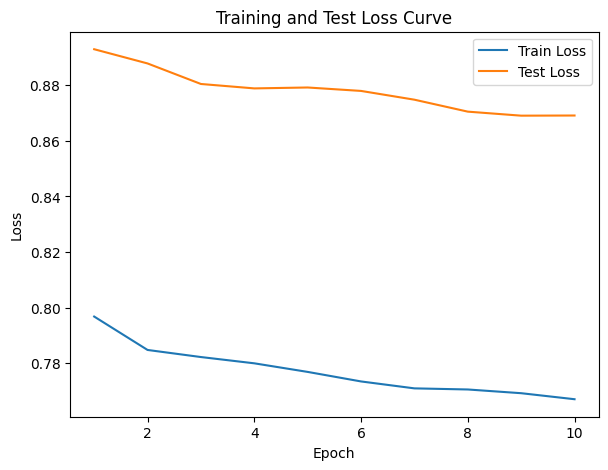

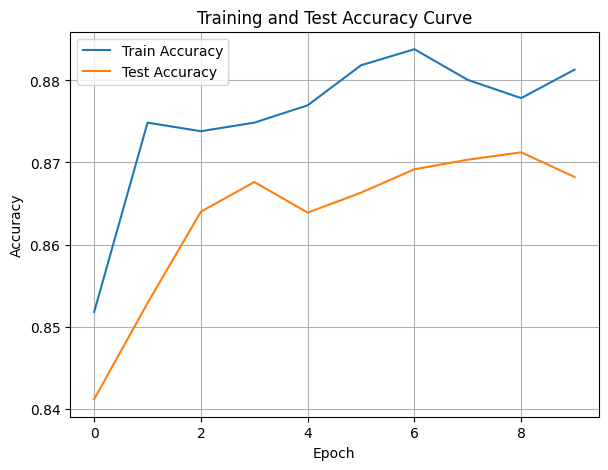

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8885934778995074, Train Loss: 0.7549, Train Acc: 0.8884, Test F1:0.8411336032388664, Test Loss: 0.8568, Test Acc: 0.8411


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.93it/s]

Epoch [2/10], Train F1:0.8867189637116718, Train Loss: 0.7515, Train Acc: 0.8863, Test F1:0.8619891929367443, Test Loss: 0.8545, Test Acc: 0.8637


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.82it/s]

Epoch [3/10], Train F1:0.8860921180457103, Train Loss: 0.7551, Train Acc: 0.8856, Test F1:0.8550159409272259, Test Loss: 0.8573, Test Acc: 0.8562
Epoch [4/10], Train F1:0.889264652052829, Train Loss: 0.7526, Train Acc: 0.8884, Test F1:0.8617245728700837, Test Loss: 0.8518, Test Acc: 0.8637


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.63it/s]

Epoch [5/10], Train F1:0.8891696038701123, Train Loss: 0.7511, Train Acc: 0.8869, Test F1:0.8619536355784065, Test Loss: 0.8466, Test Acc: 0.8651
Epoch [6/10], Train F1:0.8878145835514191, Train Loss: 0.7490, Train Acc: 0.8858, Test F1:0.8652759445636032, Test Loss: 0.8433, Test Acc: 0.8686


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.13it/s]

Epoch [7/10], Train F1:0.8892196351966466, Train Loss: 0.7466, Train Acc: 0.8863, Test F1:0.8666128125177837, Test Loss: 0.8422, Test Acc: 0.8700
Epoch [8/10], Train F1:0.8901627316192959, Train Loss: 0.7448, Train Acc: 0.8882, Test F1:0.8676145982153721, Test Loss: 0.8423, Test Acc: 0.8711


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.76it/s]


Epoch [9/10], Train F1:0.8871117185423512, Train Loss: 0.7452, Train Acc: 0.8855, Test F1:0.8692059412453172, Test Loss: 0.8402, Test Acc: 0.8728
Epoch [10/10], Train F1:0.8865909212764798, Train Loss: 0.7436, Train Acc: 0.8851, Test F1:0.8704802660650742, Test Loss: 0.8378, Test Acc: 0.8741
Total Epochs: 10
Train loss start: 0.802764892578125, Train loss end: 0.7239643931388855
Highest Mean Train Accuracy (over epoch): 0.8883928571428572
Test loss start: 0.8504390716552734, Test loss end: 0.7945445775985718
Highest mean Test Accuracy (over epoch): 0.8741319444444443


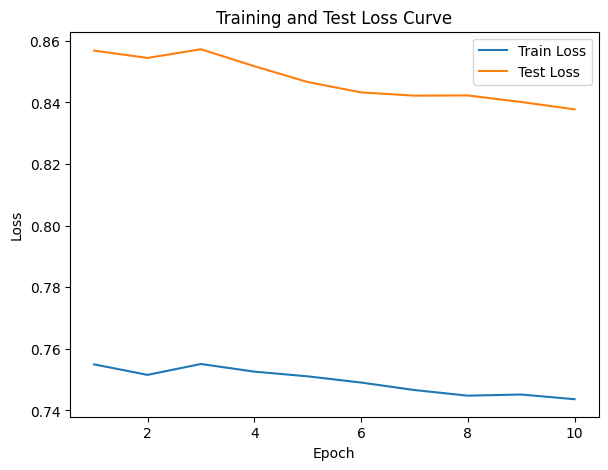

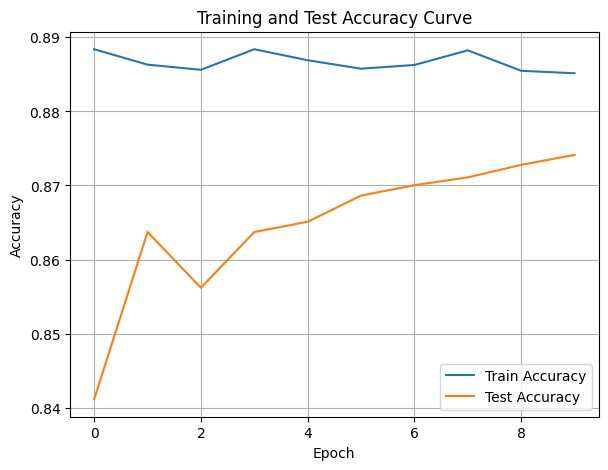

./saved_models/model_10.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [63]:
DTEmlp8b.train_DTE()

Training Process:   1%|          | 1/150 [00:00<00:26,  5.54it/s]

Epoch [1/150], Train F1:0.4012936937363596, Train Loss: 1.1130, Train Acc: 0.3607, Test F1:0.32930743147461417, Test Loss: 1.1134, Test Acc: 0.2630


Training Process:   1%|▏         | 2/150 [00:00<00:38,  3.89it/s]

Epoch [2/150], Train F1:0.41196708372437596, Train Loss: 1.1076, Train Acc: 0.3717, Test F1:0.32980406795043515, Test Loss: 1.1102, Test Acc: 0.2561


Training Process:   3%|▎         | 4/150 [00:00<00:32,  4.55it/s]

Epoch [3/150], Train F1:0.41517290273686275, Train Loss: 1.1037, Train Acc: 0.3765, Test F1:0.339667901425117, Test Loss: 1.1088, Test Acc: 0.2616
Epoch [4/150], Train F1:0.43338413321316527, Train Loss: 1.0975, Train Acc: 0.3955, Test F1:0.3469595948173928, Test Loss: 1.1076, Test Acc: 0.2713


Training Process:   3%|▎         | 5/150 [00:01<00:31,  4.53it/s]

Epoch [5/150], Train F1:0.440566608749188, Train Loss: 1.0971, Train Acc: 0.4029, Test F1:0.3845522383346042, Test Loss: 1.1045, Test Acc: 0.3123


Training Process:   4%|▍         | 6/150 [00:01<00:30,  4.69it/s]

Epoch [6/150], Train F1:0.45101557090865485, Train Loss: 1.0936, Train Acc: 0.4145, Test F1:0.3979693241819145, Test Loss: 1.1027, Test Acc: 0.3247


Training Process:   5%|▌         | 8/150 [00:01<00:27,  5.16it/s]

Epoch [7/150], Train F1:0.4605037988861423, Train Loss: 1.0890, Train Acc: 0.4265, Test F1:0.42186970368231375, Test Loss: 1.0998, Test Acc: 0.3542
Epoch [8/150], Train F1:0.4694011489558212, Train Loss: 1.0846, Train Acc: 0.4398, Test F1:0.43349334274662665, Test Loss: 1.0976, Test Acc: 0.3714


Training Process:   7%|▋         | 10/150 [00:02<00:24,  5.79it/s]

Epoch [9/150], Train F1:0.47582206279186257, Train Loss: 1.0821, Train Acc: 0.4480, Test F1:0.4557194395090737, Test Loss: 1.0947, Test Acc: 0.3992
Epoch [10/150], Train F1:0.4856967738370798, Train Loss: 1.0790, Train Acc: 0.4576, Test F1:0.4788207638735483, Test Loss: 1.0921, Test Acc: 0.4291


Training Process:   8%|▊         | 12/150 [00:02<00:20,  6.64it/s]

Epoch [11/150], Train F1:0.49401307914145304, Train Loss: 1.0757, Train Acc: 0.4669, Test F1:0.4927066092905219, Test Loss: 1.0899, Test Acc: 0.4507
Epoch [12/150], Train F1:0.4966227487692689, Train Loss: 1.0741, Train Acc: 0.4714, Test F1:0.5123895662112272, Test Loss: 1.0874, Test Acc: 0.4744


Training Process:   9%|▉         | 14/150 [00:02<00:19,  7.06it/s]

Epoch [13/150], Train F1:0.5031795990013268, Train Loss: 1.0714, Train Acc: 0.4803, Test F1:0.5246942738073118, Test Loss: 1.0852, Test Acc: 0.4910
Epoch [14/150], Train F1:0.5078277717197673, Train Loss: 1.0681, Train Acc: 0.4892, Test F1:0.5358470456223685, Test Loss: 1.0821, Test Acc: 0.5069


Training Process:  11%|█         | 16/150 [00:02<00:19,  6.98it/s]

Epoch [15/150], Train F1:0.5108315243567692, Train Loss: 1.0651, Train Acc: 0.4950, Test F1:0.5444434499947558, Test Loss: 1.0799, Test Acc: 0.5201
Epoch [16/150], Train F1:0.5175222468809667, Train Loss: 1.0621, Train Acc: 0.5030, Test F1:0.5531161529964692, Test Loss: 1.0774, Test Acc: 0.5327


Training Process:  11%|█▏        | 17/150 [00:02<00:19,  6.96it/s]

Epoch [17/150], Train F1:0.5226772945158892, Train Loss: 1.0592, Train Acc: 0.5100, Test F1:0.5662488600803477, Test Loss: 1.0754, Test Acc: 0.5472


Training Process:  13%|█▎        | 19/150 [00:03<00:20,  6.41it/s]

Epoch [18/150], Train F1:0.5293573879440849, Train Loss: 1.0556, Train Acc: 0.5191, Test F1:0.5768437568590123, Test Loss: 1.0735, Test Acc: 0.5597
Epoch [19/150], Train F1:0.5348494291431741, Train Loss: 1.0528, Train Acc: 0.5262, Test F1:0.5881350426818609, Test Loss: 1.0714, Test Acc: 0.5720


Training Process:  14%|█▍        | 21/150 [00:03<00:19,  6.66it/s]

Epoch [20/150], Train F1:0.5415640937546224, Train Loss: 1.0500, Train Acc: 0.5338, Test F1:0.5971129549862317, Test Loss: 1.0692, Test Acc: 0.5828
Epoch [21/150], Train F1:0.54598964828999, Train Loss: 1.0472, Train Acc: 0.5398, Test F1:0.6061673919746067, Test Loss: 1.0672, Test Acc: 0.5928


Training Process:  15%|█▍        | 22/150 [00:03<00:20,  6.27it/s]

Epoch [22/150], Train F1:0.5521753667503875, Train Loss: 1.0437, Train Acc: 0.5466, Test F1:0.6133749082301034, Test Loss: 1.0650, Test Acc: 0.6016
Epoch [23/150], Train F1:0.5579732055290991, Train Loss: 1.0411, Train Acc: 0.5520, Test F1:0.621487206306853, Test Loss: 1.0626, Test Acc: 0.6107


Training Process:  17%|█▋        | 25/150 [00:04<00:20,  6.03it/s]

Epoch [24/150], Train F1:0.564031030409684, Train Loss: 1.0377, Train Acc: 0.5592, Test F1:0.6291179558223303, Test Loss: 1.0603, Test Acc: 0.6190
Epoch [25/150], Train F1:0.5685439787284342, Train Loss: 1.0347, Train Acc: 0.5644, Test F1:0.6352742241564018, Test Loss: 1.0582, Test Acc: 0.6263


Training Process:  18%|█▊        | 27/150 [00:04<00:18,  6.51it/s]

Epoch [26/150], Train F1:0.5720973049138699, Train Loss: 1.0321, Train Acc: 0.5686, Test F1:0.6414489161601608, Test Loss: 1.0558, Test Acc: 0.6334
Epoch [27/150], Train F1:0.5777080225586858, Train Loss: 1.0291, Train Acc: 0.5745, Test F1:0.6471275771852233, Test Loss: 1.0533, Test Acc: 0.6399


Training Process:  19%|█▉        | 29/150 [00:04<00:17,  6.86it/s]

Epoch [28/150], Train F1:0.5812773620315288, Train Loss: 1.0266, Train Acc: 0.5782, Test F1:0.6528532298986908, Test Loss: 1.0505, Test Acc: 0.6463
Epoch [29/150], Train F1:0.5855984238736097, Train Loss: 1.0236, Train Acc: 0.5831, Test F1:0.659080235995975, Test Loss: 1.0484, Test Acc: 0.6529


Training Process:  21%|██        | 31/150 [00:05<00:19,  6.01it/s]

Epoch [30/150], Train F1:0.5900647414149366, Train Loss: 1.0210, Train Acc: 0.5875, Test F1:0.6644046010067618, Test Loss: 1.0462, Test Acc: 0.6587
Epoch [31/150], Train F1:0.5947485526146881, Train Loss: 1.0189, Train Acc: 0.5921, Test F1:0.6699577732598407, Test Loss: 1.0440, Test Acc: 0.6645


Training Process:  21%|██▏       | 32/150 [00:05<00:21,  5.62it/s]

Epoch [32/150], Train F1:0.5978010906044998, Train Loss: 1.0164, Train Acc: 0.5961, Test F1:0.6764339502584674, Test Loss: 1.0422, Test Acc: 0.6705


Training Process:  22%|██▏       | 33/150 [00:05<00:23,  5.08it/s]

Epoch [33/150], Train F1:0.6023617591879507, Train Loss: 1.0137, Train Acc: 0.6004, Test F1:0.6823803543234054, Test Loss: 1.0401, Test Acc: 0.6763


Training Process:  23%|██▎       | 34/150 [00:05<00:24,  4.77it/s]

Epoch [34/150], Train F1:0.6055495725354372, Train Loss: 1.0109, Train Acc: 0.6041, Test F1:0.6875527910506899, Test Loss: 1.0378, Test Acc: 0.6816


Training Process:  23%|██▎       | 35/150 [00:06<00:23,  4.82it/s]

Epoch [35/150], Train F1:0.6091750768277379, Train Loss: 1.0082, Train Acc: 0.6075, Test F1:0.6915275152767821, Test Loss: 1.0357, Test Acc: 0.6859


Training Process:  24%|██▍       | 36/150 [00:06<00:26,  4.25it/s]

Epoch [36/150], Train F1:0.6138565192125053, Train Loss: 1.0052, Train Acc: 0.6126, Test F1:0.6959730827531598, Test Loss: 1.0335, Test Acc: 0.6906


Training Process:  25%|██▍       | 37/150 [00:06<00:26,  4.25it/s]

Epoch [37/150], Train F1:0.6177128508408762, Train Loss: 1.0027, Train Acc: 0.6163, Test F1:0.7006232276657209, Test Loss: 1.0313, Test Acc: 0.6952


Training Process:  25%|██▌       | 38/150 [00:06<00:25,  4.40it/s]

Epoch [38/150], Train F1:0.621258114007738, Train Loss: 1.0004, Train Acc: 0.6198, Test F1:0.7045512726511399, Test Loss: 1.0294, Test Acc: 0.6994


Training Process:  26%|██▌       | 39/150 [00:07<00:25,  4.40it/s]

Epoch [39/150], Train F1:0.6249495463114435, Train Loss: 0.9977, Train Acc: 0.6236, Test F1:0.7076186884089343, Test Loss: 1.0272, Test Acc: 0.7029


Training Process:  27%|██▋       | 40/150 [00:07<00:27,  4.04it/s]

Epoch [40/150], Train F1:0.6283638666913118, Train Loss: 0.9951, Train Acc: 0.6272, Test F1:0.7102105494977042, Test Loss: 1.0248, Test Acc: 0.7059


Training Process:  27%|██▋       | 41/150 [00:07<00:25,  4.24it/s]

Epoch [41/150], Train F1:0.6317663834735651, Train Loss: 0.9926, Train Acc: 0.6305, Test F1:0.7135800005804671, Test Loss: 1.0225, Test Acc: 0.7096


Training Process:  29%|██▊       | 43/150 [00:07<00:21,  4.91it/s]

Epoch [42/150], Train F1:0.635920650322826, Train Loss: 0.9899, Train Acc: 0.6343, Test F1:0.7170713474282148, Test Loss: 1.0204, Test Acc: 0.7132
Epoch [43/150], Train F1:0.6391892080519969, Train Loss: 0.9872, Train Acc: 0.6378, Test F1:0.7203865646099507, Test Loss: 1.0186, Test Acc: 0.7167


Training Process:  30%|███       | 45/150 [00:08<00:18,  5.62it/s]

Epoch [44/150], Train F1:0.6428539510001362, Train Loss: 0.9842, Train Acc: 0.6416, Test F1:0.7232597596948814, Test Loss: 1.0165, Test Acc: 0.7199
Epoch [45/150], Train F1:0.6462203435264918, Train Loss: 0.9817, Train Acc: 0.6447, Test F1:0.7259961541833067, Test Loss: 1.0145, Test Acc: 0.7229


Training Process:  31%|███▏      | 47/150 [00:08<00:16,  6.20it/s]

Epoch [46/150], Train F1:0.6492503168065816, Train Loss: 0.9792, Train Acc: 0.6479, Test F1:0.7291350186054274, Test Loss: 1.0126, Test Acc: 0.7261
Epoch [47/150], Train F1:0.652899500660444, Train Loss: 0.9766, Train Acc: 0.6513, Test F1:0.7310959113573509, Test Loss: 1.0102, Test Acc: 0.7284


Training Process:  33%|███▎      | 49/150 [00:08<00:15,  6.56it/s]

Epoch [48/150], Train F1:0.6563183124959199, Train Loss: 0.9739, Train Acc: 0.6543, Test F1:0.7337281284393247, Test Loss: 1.0080, Test Acc: 0.7312
Epoch [49/150], Train F1:0.6597654605666426, Train Loss: 0.9713, Train Acc: 0.6578, Test F1:0.7357524267079998, Test Loss: 1.0057, Test Acc: 0.7335


Training Process:  34%|███▍      | 51/150 [00:09<00:15,  6.40it/s]

Epoch [50/150], Train F1:0.6631059468754191, Train Loss: 0.9688, Train Acc: 0.6609, Test F1:0.7381729148517304, Test Loss: 1.0036, Test Acc: 0.7361
Epoch [51/150], Train F1:0.6670553878949493, Train Loss: 0.9660, Train Acc: 0.6646, Test F1:0.740491815180593, Test Loss: 1.0014, Test Acc: 0.7386


Training Process:  35%|███▌      | 53/150 [00:09<00:15,  6.17it/s]

Epoch [52/150], Train F1:0.670216696469362, Train Loss: 0.9635, Train Acc: 0.6677, Test F1:0.7420249614362288, Test Loss: 0.9992, Test Acc: 0.7404
Epoch [53/150], Train F1:0.6738124178014714, Train Loss: 0.9609, Train Acc: 0.6711, Test F1:0.7446244013370791, Test Loss: 0.9973, Test Acc: 0.7430


Training Process:  37%|███▋      | 55/150 [00:09<00:16,  5.78it/s]

Epoch [54/150], Train F1:0.6766065679542598, Train Loss: 0.9584, Train Acc: 0.6740, Test F1:0.7471194659948887, Test Loss: 0.9953, Test Acc: 0.7455
Epoch [55/150], Train F1:0.6794173590225621, Train Loss: 0.9559, Train Acc: 0.6767, Test F1:0.7490853837213667, Test Loss: 0.9933, Test Acc: 0.7477


Training Process:  38%|███▊      | 57/150 [00:10<00:15,  5.91it/s]

Epoch [56/150], Train F1:0.6824215926283492, Train Loss: 0.9536, Train Acc: 0.6794, Test F1:0.7513988742071813, Test Loss: 0.9913, Test Acc: 0.7500
Epoch [57/150], Train F1:0.6854216293256491, Train Loss: 0.9515, Train Acc: 0.6820, Test F1:0.7532113192251586, Test Loss: 0.9893, Test Acc: 0.7520


Training Process:  39%|███▉      | 59/150 [00:10<00:15,  5.91it/s]

Epoch [58/150], Train F1:0.6883094453412743, Train Loss: 0.9490, Train Acc: 0.6849, Test F1:0.7557679909002093, Test Loss: 0.9875, Test Acc: 0.7544
Epoch [59/150], Train F1:0.691395397806145, Train Loss: 0.9467, Train Acc: 0.6878, Test F1:0.7578330569084305, Test Loss: 0.9857, Test Acc: 0.7565


Training Process:  41%|████      | 61/150 [00:10<00:15,  5.89it/s]

Epoch [60/150], Train F1:0.6941503333792433, Train Loss: 0.9443, Train Acc: 0.6903, Test F1:0.7600187478229027, Test Loss: 0.9839, Test Acc: 0.7587
Epoch [61/150], Train F1:0.6969372478425556, Train Loss: 0.9418, Train Acc: 0.6930, Test F1:0.7621269341467074, Test Loss: 0.9822, Test Acc: 0.7608


Training Process:  42%|████▏     | 63/150 [00:11<00:14,  5.85it/s]

Epoch [62/150], Train F1:0.6995112818988282, Train Loss: 0.9395, Train Acc: 0.6955, Test F1:0.7642149058412744, Test Loss: 0.9804, Test Acc: 0.7628
Epoch [63/150], Train F1:0.7020237494535165, Train Loss: 0.9372, Train Acc: 0.6980, Test F1:0.7665969914790702, Test Loss: 0.9788, Test Acc: 0.7650


Training Process:  43%|████▎     | 65/150 [00:11<00:14,  5.80it/s]

Epoch [64/150], Train F1:0.7041761669206811, Train Loss: 0.9350, Train Acc: 0.7002, Test F1:0.768846329262191, Test Loss: 0.9771, Test Acc: 0.7672
Epoch [65/150], Train F1:0.706874626992692, Train Loss: 0.9328, Train Acc: 0.7025, Test F1:0.7708919404287624, Test Loss: 0.9754, Test Acc: 0.7691


Training Process:  45%|████▍     | 67/150 [00:11<00:14,  5.81it/s]

Epoch [66/150], Train F1:0.7089780623988471, Train Loss: 0.9308, Train Acc: 0.7046, Test F1:0.7730426498951338, Test Loss: 0.9737, Test Acc: 0.7711
Epoch [67/150], Train F1:0.7114770837817603, Train Loss: 0.9287, Train Acc: 0.7069, Test F1:0.7749065518165311, Test Loss: 0.9718, Test Acc: 0.7730


Training Process:  45%|████▌     | 68/150 [00:12<00:14,  5.79it/s]

Epoch [68/150], Train F1:0.7137258539166315, Train Loss: 0.9266, Train Acc: 0.7090, Test F1:0.776711400429958, Test Loss: 0.9699, Test Acc: 0.7747


Training Process:  47%|████▋     | 70/150 [00:12<00:14,  5.69it/s]

Epoch [69/150], Train F1:0.7160264305914407, Train Loss: 0.9244, Train Acc: 0.7112, Test F1:0.7784599706574981, Test Loss: 0.9681, Test Acc: 0.7765
Epoch [70/150], Train F1:0.718212895536499, Train Loss: 0.9222, Train Acc: 0.7132, Test F1:0.7800353460203049, Test Loss: 0.9664, Test Acc: 0.7780


Training Process:  47%|████▋     | 71/150 [00:12<00:13,  5.66it/s]

Epoch [71/150], Train F1:0.7201939423619121, Train Loss: 0.9205, Train Acc: 0.7150, Test F1:0.7815215442615431, Test Loss: 0.9647, Test Acc: 0.7796


Training Process:  48%|████▊     | 72/150 [00:12<00:13,  5.62it/s]

Epoch [72/150], Train F1:0.722468293662119, Train Loss: 0.9185, Train Acc: 0.7172, Test F1:0.7831203923315639, Test Loss: 0.9630, Test Acc: 0.7812


Training Process:  49%|████▊     | 73/150 [00:12<00:13,  5.57it/s]

Epoch [73/150], Train F1:0.7244471320191517, Train Loss: 0.9165, Train Acc: 0.7193, Test F1:0.7847115205957085, Test Loss: 0.9616, Test Acc: 0.7827


Training Process:  49%|████▉     | 74/150 [00:13<00:15,  4.95it/s]

Epoch [74/150], Train F1:0.7265802170779989, Train Loss: 0.9145, Train Acc: 0.7214, Test F1:0.7862176975463872, Test Loss: 0.9600, Test Acc: 0.7842


Training Process:  50%|█████     | 75/150 [00:13<00:15,  4.83it/s]

Epoch [75/150], Train F1:0.7285174808965604, Train Loss: 0.9125, Train Acc: 0.7233, Test F1:0.7876809844995198, Test Loss: 0.9584, Test Acc: 0.7857


Training Process:  51%|█████     | 76/150 [00:13<00:15,  4.91it/s]

Epoch [76/150], Train F1:0.7304794135726241, Train Loss: 0.9106, Train Acc: 0.7250, Test F1:0.788770455463197, Test Loss: 0.9569, Test Acc: 0.7865


Training Process:  51%|█████▏    | 77/150 [00:13<00:15,  4.82it/s]

Epoch [77/150], Train F1:0.7326622964116759, Train Loss: 0.9085, Train Acc: 0.7271, Test F1:0.7901563406231819, Test Loss: 0.9553, Test Acc: 0.7879


Training Process:  52%|█████▏    | 78/150 [00:14<00:15,  4.51it/s]

Epoch [78/150], Train F1:0.7345097498548074, Train Loss: 0.9068, Train Acc: 0.7287, Test F1:0.791219378506333, Test Loss: 0.9534, Test Acc: 0.7891


Training Process:  53%|█████▎    | 79/150 [00:14<00:15,  4.48it/s]

Epoch [79/150], Train F1:0.7364589385583182, Train Loss: 0.9050, Train Acc: 0.7305, Test F1:0.7922542597175932, Test Loss: 0.9517, Test Acc: 0.7902


Training Process:  53%|█████▎    | 80/150 [00:14<00:15,  4.50it/s]

Epoch [80/150], Train F1:0.7384444096149284, Train Loss: 0.9031, Train Acc: 0.7323, Test F1:0.7935392998724199, Test Loss: 0.9503, Test Acc: 0.7915


Training Process:  54%|█████▍    | 81/150 [00:14<00:15,  4.58it/s]

Epoch [81/150], Train F1:0.7401149725151479, Train Loss: 0.9013, Train Acc: 0.7338, Test F1:0.7947906788957685, Test Loss: 0.9487, Test Acc: 0.7928


Training Process:  55%|█████▍    | 82/150 [00:15<00:16,  4.20it/s]

Epoch [82/150], Train F1:0.7417385026119112, Train Loss: 0.8995, Train Acc: 0.7354, Test F1:0.7960097062499936, Test Loss: 0.9472, Test Acc: 0.7940


Training Process:  55%|█████▌    | 83/150 [00:15<00:15,  4.37it/s]

Epoch [83/150], Train F1:0.7436177361581288, Train Loss: 0.8977, Train Acc: 0.7373, Test F1:0.7971976241552653, Test Loss: 0.9457, Test Acc: 0.7952


Training Process:  56%|█████▌    | 84/150 [00:15<00:14,  4.49it/s]

Epoch [84/150], Train F1:0.7453175700440692, Train Loss: 0.8959, Train Acc: 0.7390, Test F1:0.7984171158781931, Test Loss: 0.9444, Test Acc: 0.7964


Training Process:  57%|█████▋    | 85/150 [00:15<00:14,  4.62it/s]

Epoch [85/150], Train F1:0.7471663026296234, Train Loss: 0.8940, Train Acc: 0.7409, Test F1:0.7995450869405626, Test Loss: 0.9429, Test Acc: 0.7975


Training Process:  57%|█████▋    | 86/150 [00:15<00:13,  4.72it/s]

Epoch [86/150], Train F1:0.7487205443139647, Train Loss: 0.8925, Train Acc: 0.7422, Test F1:0.8006453547738804, Test Loss: 0.9413, Test Acc: 0.7987


Training Process:  58%|█████▊    | 87/150 [00:16<00:13,  4.77it/s]

Epoch [87/150], Train F1:0.7505984741489504, Train Loss: 0.8907, Train Acc: 0.7438, Test F1:0.8016798237223189, Test Loss: 0.9400, Test Acc: 0.7996


Training Process:  59%|█████▊    | 88/150 [00:16<00:12,  4.79it/s]

Epoch [88/150], Train F1:0.7522564069989014, Train Loss: 0.8890, Train Acc: 0.7454, Test F1:0.8027276503419079, Test Loss: 0.9385, Test Acc: 0.8007


Training Process:  59%|█████▉    | 89/150 [00:16<00:12,  4.81it/s]

Epoch [89/150], Train F1:0.7538268056399897, Train Loss: 0.8873, Train Acc: 0.7470, Test F1:0.8037506764364184, Test Loss: 0.9371, Test Acc: 0.8017


Training Process:  60%|██████    | 90/150 [00:16<00:12,  4.82it/s]

Epoch [90/150], Train F1:0.7556780365878931, Train Loss: 0.8854, Train Acc: 0.7488, Test F1:0.804870942784831, Test Loss: 0.9357, Test Acc: 0.8028


Training Process:  61%|██████    | 91/150 [00:16<00:12,  4.57it/s]

Epoch [91/150], Train F1:0.7571096633663502, Train Loss: 0.8836, Train Acc: 0.7503, Test F1:0.805806172109147, Test Loss: 0.9343, Test Acc: 0.8037


Training Process:  61%|██████▏   | 92/150 [00:17<00:12,  4.54it/s]

Epoch [92/150], Train F1:0.7583517838749081, Train Loss: 0.8820, Train Acc: 0.7516, Test F1:0.8067584543556059, Test Loss: 0.9330, Test Acc: 0.8047


Training Process:  62%|██████▏   | 93/150 [00:17<00:12,  4.58it/s]

Epoch [93/150], Train F1:0.7597832700114777, Train Loss: 0.8805, Train Acc: 0.7528, Test F1:0.8076892357904222, Test Loss: 0.9315, Test Acc: 0.8056


Training Process:  63%|██████▎   | 94/150 [00:17<00:12,  4.55it/s]

Epoch [94/150], Train F1:0.7613053730161438, Train Loss: 0.8788, Train Acc: 0.7544, Test F1:0.8085992380023425, Test Loss: 0.9301, Test Acc: 0.8066


Training Process:  63%|██████▎   | 95/150 [00:17<00:12,  4.57it/s]

Epoch [95/150], Train F1:0.7624969343902334, Train Loss: 0.8774, Train Acc: 0.7555, Test F1:0.8094891505822079, Test Loss: 0.9286, Test Acc: 0.8075


Training Process:  64%|██████▍   | 96/150 [00:18<00:11,  4.59it/s]

Epoch [96/150], Train F1:0.7638678800896511, Train Loss: 0.8757, Train Acc: 0.7570, Test F1:0.8105849804193106, Test Loss: 0.9274, Test Acc: 0.8086


Training Process:  65%|██████▍   | 97/150 [00:18<00:11,  4.54it/s]

Epoch [97/150], Train F1:0.7651019816280521, Train Loss: 0.8741, Train Acc: 0.7582, Test F1:0.8114340920795173, Test Loss: 0.9260, Test Acc: 0.8094


Training Process:  65%|██████▌   | 98/150 [00:18<00:11,  4.50it/s]

Epoch [98/150], Train F1:0.7663729612715704, Train Loss: 0.8726, Train Acc: 0.7595, Test F1:0.8123751684961099, Test Loss: 0.9247, Test Acc: 0.8104


Training Process:  66%|██████▌   | 99/150 [00:18<00:11,  4.47it/s]

Epoch [99/150], Train F1:0.767601788033737, Train Loss: 0.8711, Train Acc: 0.7607, Test F1:0.8132962091957143, Test Loss: 0.9234, Test Acc: 0.8113


Training Process:  67%|██████▋   | 100/150 [00:18<00:11,  4.25it/s]

Epoch [100/150], Train F1:0.7689936284248897, Train Loss: 0.8697, Train Acc: 0.7620, Test F1:0.8141978490515442, Test Loss: 0.9221, Test Acc: 0.8122


Training Process:  67%|██████▋   | 101/150 [00:19<00:11,  4.30it/s]

Epoch [101/150], Train F1:0.7702740262518915, Train Loss: 0.8682, Train Acc: 0.7633, Test F1:0.8149742508673832, Test Loss: 0.9208, Test Acc: 0.8130


Training Process:  68%|██████▊   | 102/150 [00:19<00:11,  4.31it/s]

Epoch [102/150], Train F1:0.7716806155575001, Train Loss: 0.8667, Train Acc: 0.7646, Test F1:0.8157347556765068, Test Loss: 0.9195, Test Acc: 0.8138


Training Process:  69%|██████▊   | 103/150 [00:19<00:10,  4.30it/s]

Epoch [103/150], Train F1:0.7728622940845891, Train Loss: 0.8653, Train Acc: 0.7657, Test F1:0.8164798476143266, Test Loss: 0.9181, Test Acc: 0.8146


Training Process:  69%|██████▉   | 104/150 [00:19<00:10,  4.33it/s]

Epoch [104/150], Train F1:0.7740593394614037, Train Loss: 0.8638, Train Acc: 0.7669, Test F1:0.8174161270365615, Test Loss: 0.9169, Test Acc: 0.8155


Training Process:  70%|███████   | 105/150 [00:20<00:10,  4.32it/s]

Epoch [105/150], Train F1:0.7753192892576469, Train Loss: 0.8624, Train Acc: 0.7682, Test F1:0.8182315842721112, Test Loss: 0.9156, Test Acc: 0.8163


Training Process:  71%|███████   | 106/150 [00:20<00:10,  4.28it/s]

Epoch [106/150], Train F1:0.7766592541200922, Train Loss: 0.8610, Train Acc: 0.7693, Test F1:0.8190308905138699, Test Loss: 0.9143, Test Acc: 0.8172


Training Process:  71%|███████▏  | 107/150 [00:20<00:10,  4.09it/s]

Epoch [107/150], Train F1:0.7777157994137442, Train Loss: 0.8596, Train Acc: 0.7704, Test F1:0.8197351620406417, Test Loss: 0.9132, Test Acc: 0.8178


Training Process:  72%|███████▏  | 108/150 [00:20<00:10,  4.11it/s]

Epoch [108/150], Train F1:0.778732013304122, Train Loss: 0.8583, Train Acc: 0.7714, Test F1:0.8205042903305216, Test Loss: 0.9119, Test Acc: 0.8186


Training Process:  73%|███████▎  | 109/150 [00:21<00:09,  4.12it/s]

Epoch [109/150], Train F1:0.7797437225665473, Train Loss: 0.8569, Train Acc: 0.7725, Test F1:0.821160812208555, Test Loss: 0.9106, Test Acc: 0.8193


Training Process:  73%|███████▎  | 110/150 [00:21<00:09,  4.12it/s]

Epoch [110/150], Train F1:0.7808774719332147, Train Loss: 0.8556, Train Acc: 0.7734, Test F1:0.8218049207680475, Test Loss: 0.9093, Test Acc: 0.8200


Training Process:  74%|███████▍  | 111/150 [00:21<00:09,  4.08it/s]

Epoch [111/150], Train F1:0.7819840271400428, Train Loss: 0.8542, Train Acc: 0.7746, Test F1:0.8224369652769027, Test Loss: 0.9080, Test Acc: 0.8206


Training Process:  75%|███████▍  | 112/150 [00:21<00:09,  4.04it/s]

Epoch [112/150], Train F1:0.7830679716706219, Train Loss: 0.8529, Train Acc: 0.7757, Test F1:0.8230572820037164, Test Loss: 0.9067, Test Acc: 0.8213


Training Process:  75%|███████▌  | 113/150 [00:22<00:09,  4.04it/s]

Epoch [113/150], Train F1:0.78429536125268, Train Loss: 0.8516, Train Acc: 0.7769, Test F1:0.8236661948177794, Test Loss: 0.9054, Test Acc: 0.8219


Training Process:  76%|███████▌  | 114/150 [00:22<00:09,  3.83it/s]

Epoch [114/150], Train F1:0.7852874942770756, Train Loss: 0.8503, Train Acc: 0.7779, Test F1:0.8243196688416816, Test Loss: 0.9043, Test Acc: 0.8226


Training Process:  77%|███████▋  | 115/150 [00:22<00:09,  3.88it/s]

Epoch [115/150], Train F1:0.78640251965351, Train Loss: 0.8490, Train Acc: 0.7789, Test F1:0.8249242464148164, Test Loss: 0.9032, Test Acc: 0.8231


Training Process:  77%|███████▋  | 116/150 [00:22<00:08,  3.95it/s]

Epoch [116/150], Train F1:0.7875366726873971, Train Loss: 0.8477, Train Acc: 0.7801, Test F1:0.8255538508363759, Test Loss: 0.9022, Test Acc: 0.8237


Training Process:  78%|███████▊  | 117/150 [00:23<00:08,  3.94it/s]

Epoch [117/150], Train F1:0.7886146303259666, Train Loss: 0.8464, Train Acc: 0.7811, Test F1:0.8261185445133652, Test Loss: 0.9010, Test Acc: 0.8243


Training Process:  79%|███████▊  | 118/150 [00:23<00:08,  3.79it/s]

Epoch [118/150], Train F1:0.7896380076808666, Train Loss: 0.8452, Train Acc: 0.7821, Test F1:0.8264724459884822, Test Loss: 0.9000, Test Acc: 0.8247


Training Process:  79%|███████▉  | 119/150 [00:23<00:08,  3.80it/s]

Epoch [119/150], Train F1:0.7905594455258043, Train Loss: 0.8440, Train Acc: 0.7831, Test F1:0.8271075745026879, Test Loss: 0.8988, Test Acc: 0.8253


Training Process:  80%|████████  | 120/150 [00:23<00:07,  3.79it/s]

Epoch [120/150], Train F1:0.7915729084222958, Train Loss: 0.8427, Train Acc: 0.7841, Test F1:0.8276437731343926, Test Loss: 0.8976, Test Acc: 0.8259


Training Process:  81%|████████  | 121/150 [00:24<00:08,  3.60it/s]

Epoch [121/150], Train F1:0.7925511434492757, Train Loss: 0.8416, Train Acc: 0.7850, Test F1:0.828170809401369, Test Loss: 0.8964, Test Acc: 0.8265


Training Process:  81%|████████▏ | 122/150 [00:24<00:07,  3.62it/s]

Epoch [122/150], Train F1:0.7933932227077753, Train Loss: 0.8405, Train Acc: 0.7858, Test F1:0.8286889163981362, Test Loss: 0.8952, Test Acc: 0.8270


Training Process:  82%|████████▏ | 123/150 [00:24<00:07,  3.67it/s]

Epoch [123/150], Train F1:0.7944989777772563, Train Loss: 0.8393, Train Acc: 0.7868, Test F1:0.8291983193711657, Test Loss: 0.8940, Test Acc: 0.8276


Training Process:  83%|████████▎ | 124/150 [00:25<00:07,  3.70it/s]

Epoch [124/150], Train F1:0.795535634338752, Train Loss: 0.8381, Train Acc: 0.7877, Test F1:0.8297154413198929, Test Loss: 0.8930, Test Acc: 0.8280


Training Process:  83%|████████▎ | 125/150 [00:25<00:06,  3.75it/s]

Epoch [125/150], Train F1:0.7965919646597953, Train Loss: 0.8369, Train Acc: 0.7888, Test F1:0.8302078930223744, Test Loss: 0.8918, Test Acc: 0.8286


Training Process:  84%|████████▍ | 126/150 [00:25<00:06,  3.77it/s]

Epoch [126/150], Train F1:0.7976918882403538, Train Loss: 0.8357, Train Acc: 0.7897, Test F1:0.8304334223139257, Test Loss: 0.8909, Test Acc: 0.8287


Training Process:  85%|████████▍ | 127/150 [00:25<00:06,  3.75it/s]

Epoch [127/150], Train F1:0.7986755579830538, Train Loss: 0.8345, Train Acc: 0.7908, Test F1:0.8308757685600114, Test Loss: 0.8900, Test Acc: 0.8292


Training Process:  85%|████████▌ | 128/150 [00:26<00:05,  3.75it/s]

Epoch [128/150], Train F1:0.7996302914340384, Train Loss: 0.8333, Train Acc: 0.7917, Test F1:0.8313464566703294, Test Loss: 0.8889, Test Acc: 0.8297


Training Process:  86%|████████▌ | 129/150 [00:26<00:05,  3.54it/s]

Epoch [129/150], Train F1:0.8002636159691532, Train Loss: 0.8322, Train Acc: 0.7923, Test F1:0.8318096274345234, Test Loss: 0.8879, Test Acc: 0.8302


Training Process:  87%|████████▋ | 130/150 [00:26<00:05,  3.58it/s]

Epoch [130/150], Train F1:0.8012327261964701, Train Loss: 0.8311, Train Acc: 0.7933, Test F1:0.8323460011112424, Test Loss: 0.8868, Test Acc: 0.8307


Training Process:  87%|████████▋ | 131/150 [00:27<00:05,  3.46it/s]

Epoch [131/150], Train F1:0.8020218610853418, Train Loss: 0.8300, Train Acc: 0.7941, Test F1:0.8327940111920993, Test Loss: 0.8857, Test Acc: 0.8312


Training Process:  88%|████████▊ | 132/150 [00:27<00:05,  3.42it/s]

Epoch [132/150], Train F1:0.8028142398338192, Train Loss: 0.8288, Train Acc: 0.7949, Test F1:0.8332350343210588, Test Loss: 0.8847, Test Acc: 0.8317


Training Process:  89%|████████▊ | 133/150 [00:27<00:04,  3.42it/s]

Epoch [133/150], Train F1:0.803634467030206, Train Loss: 0.8277, Train Acc: 0.7958, Test F1:0.8336342612357929, Test Loss: 0.8837, Test Acc: 0.8321


Training Process:  89%|████████▉ | 134/150 [00:28<00:05,  3.03it/s]

Epoch [134/150], Train F1:0.8043859595224312, Train Loss: 0.8267, Train Acc: 0.7965, Test F1:0.8340619537904987, Test Loss: 0.8826, Test Acc: 0.8326


Training Process:  90%|█████████ | 135/150 [00:28<00:05,  2.78it/s]

Epoch [135/150], Train F1:0.8052083603778882, Train Loss: 0.8257, Train Acc: 0.7973, Test F1:0.8345604565830622, Test Loss: 0.8816, Test Acc: 0.8331


Training Process:  91%|█████████ | 136/150 [00:29<00:06,  2.26it/s]

Epoch [136/150], Train F1:0.8058313972590985, Train Loss: 0.8247, Train Acc: 0.7980, Test F1:0.8349401097697594, Test Loss: 0.8807, Test Acc: 0.8335


Training Process:  91%|█████████▏| 137/150 [00:29<00:06,  2.06it/s]

Epoch [137/150], Train F1:0.8065072402054086, Train Loss: 0.8238, Train Acc: 0.7986, Test F1:0.8355004300014448, Test Loss: 0.8797, Test Acc: 0.8341


Training Process:  92%|█████████▏| 138/150 [00:30<00:06,  1.91it/s]

Epoch [138/150], Train F1:0.8074037783853413, Train Loss: 0.8226, Train Acc: 0.7996, Test F1:0.8359905309538926, Test Loss: 0.8788, Test Acc: 0.8346


Training Process:  93%|█████████▎| 139/150 [00:31<00:06,  1.72it/s]

Epoch [139/150], Train F1:0.8082909836061761, Train Loss: 0.8215, Train Acc: 0.8004, Test F1:0.8364596812574491, Test Loss: 0.8779, Test Acc: 0.8351


Training Process:  93%|█████████▎| 140/150 [00:31<00:06,  1.49it/s]

Epoch [140/150], Train F1:0.8088532270894426, Train Loss: 0.8207, Train Acc: 0.8010, Test F1:0.8368475920751243, Test Loss: 0.8768, Test Acc: 0.8355


Training Process:  94%|█████████▍| 141/150 [00:32<00:06,  1.43it/s]

Epoch [141/150], Train F1:0.8095174907963318, Train Loss: 0.8197, Train Acc: 0.8017, Test F1:0.8372564164209969, Test Loss: 0.8759, Test Acc: 0.8359


Training Process:  95%|█████████▍| 142/150 [00:33<00:05,  1.57it/s]

Epoch [142/150], Train F1:0.8101484705316304, Train Loss: 0.8187, Train Acc: 0.8024, Test F1:0.8376328939329506, Test Loss: 0.8749, Test Acc: 0.8363


Training Process:  95%|█████████▌| 143/150 [00:33<00:03,  1.84it/s]

Epoch [143/150], Train F1:0.8108612153681712, Train Loss: 0.8178, Train Acc: 0.8031, Test F1:0.8380039705440091, Test Loss: 0.8739, Test Acc: 0.8367


Training Process:  96%|█████████▌| 144/150 [00:33<00:02,  2.14it/s]

Epoch [144/150], Train F1:0.8116545475498765, Train Loss: 0.8168, Train Acc: 0.8039, Test F1:0.8381972286294636, Test Loss: 0.8732, Test Acc: 0.8369


Training Process:  97%|█████████▋| 145/150 [00:34<00:02,  2.39it/s]

Epoch [145/150], Train F1:0.8123658741653259, Train Loss: 0.8158, Train Acc: 0.8046, Test F1:0.8385715589118057, Test Loss: 0.8722, Test Acc: 0.8372


Training Process:  97%|█████████▋| 146/150 [00:34<00:02,  1.95it/s]

Epoch [146/150], Train F1:0.8128794741833859, Train Loss: 0.8149, Train Acc: 0.8052, Test F1:0.8389531423335471, Test Loss: 0.8714, Test Acc: 0.8376


Training Process:  98%|█████████▊| 147/150 [00:35<00:01,  1.76it/s]

Epoch [147/150], Train F1:0.8135663766906875, Train Loss: 0.8141, Train Acc: 0.8058, Test F1:0.8393043581565697, Test Loss: 0.8705, Test Acc: 0.8380


Training Process:  99%|█████████▊| 148/150 [00:36<00:01,  1.61it/s]

Epoch [148/150], Train F1:0.8141040676349878, Train Loss: 0.8132, Train Acc: 0.8063, Test F1:0.8397329997669141, Test Loss: 0.8697, Test Acc: 0.8385


Training Process:  99%|█████████▉| 149/150 [00:36<00:00,  1.57it/s]

Epoch [149/150], Train F1:0.8147640888604744, Train Loss: 0.8123, Train Acc: 0.8070, Test F1:0.839951046733252, Test Loss: 0.8690, Test Acc: 0.8387


Training Process: 100%|██████████| 150/150 [00:37<00:00,  3.99it/s]


Epoch [150/150], Train F1:0.8152885051579118, Train Loss: 0.8115, Train Acc: 0.8074, Test F1:0.8402880670887727, Test Loss: 0.8681, Test Acc: 0.8390
Total Epochs: 150
Train loss start: 1.1196783781051636, Train loss end: 0.8360914587974548
Highest Mean Train Accuracy (over epoch): 0.8074305555555555
Test loss start: 1.1029545068740845, Test loss end: 0.7141276001930237
Highest Mean Test Accuracy (over epoch): 0.8390393518518519


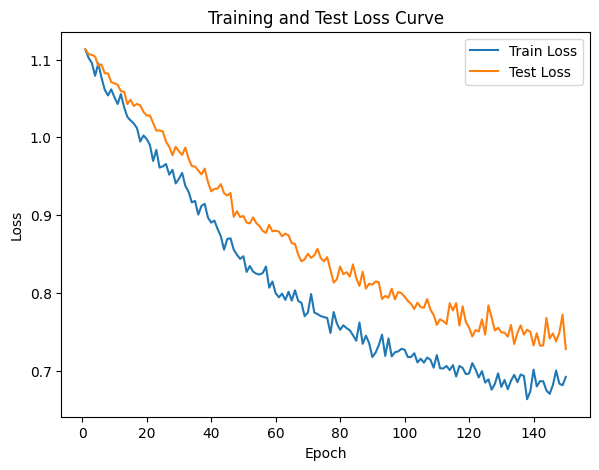

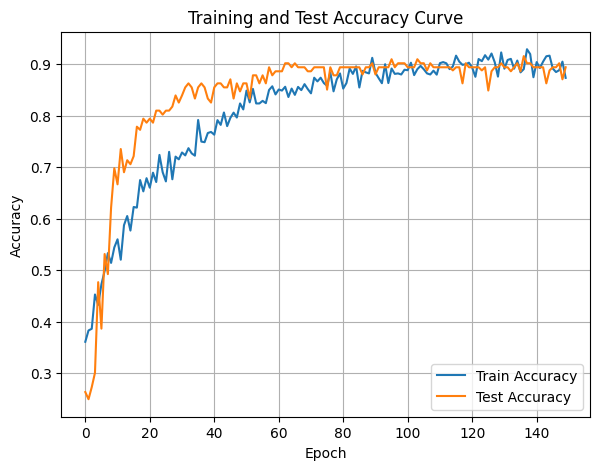

In [64]:
DTEmlp8b.train_single_model()

Randomly initializing 8 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.51it/s]

Epoch [1/10], Train F1:0.49796750631740694, Train Loss: 1.0399, Train Acc: 0.4711, Test F1:0.4591249521997444, Test Loss: 1.0750, Test Acc: 0.4436
Epoch [2/10], Train F1:0.515018836863356, Train Loss: 1.0324, Train Acc: 0.4952, Test F1:0.4626081332363166, Test Loss: 1.0756, Test Acc: 0.4531


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.74it/s]

Epoch [3/10], Train F1:0.522113961092779, Train Loss: 1.0268, Train Acc: 0.4997, Test F1:0.44066221559296354, Test Loss: 1.0788, Test Acc: 0.4433
Epoch [4/10], Train F1:0.5277724013831954, Train Loss: 1.0241, Train Acc: 0.5059, Test F1:0.4304107409145884, Test Loss: 1.0813, Test Acc: 0.4423


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.63it/s]

Epoch [5/10], Train F1:0.5391847998117597, Train Loss: 1.0202, Train Acc: 0.5201, Test F1:0.42885842569420246, Test Loss: 1.0811, Test Acc: 0.4429
Epoch [6/10], Train F1:0.5463106217521693, Train Loss: 1.0165, Train Acc: 0.5260, Test F1:0.42599408703408903, Test Loss: 1.0822, Test Acc: 0.4469


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.38it/s]

Epoch [7/10], Train F1:0.5528805550811254, Train Loss: 1.0146, Train Acc: 0.5312, Test F1:0.4361418626864851, Test Loss: 1.0805, Test Acc: 0.4576
Epoch [8/10], Train F1:0.5579776365934221, Train Loss: 1.0110, Train Acc: 0.5388, Test F1:0.4395361425824635, Test Loss: 1.0793, Test Acc: 0.4627


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.75it/s]


Epoch [9/10], Train F1:0.5664630311921122, Train Loss: 1.0080, Train Acc: 0.5485, Test F1:0.4482601753772138, Test Loss: 1.0770, Test Acc: 0.4710
Epoch [10/10], Train F1:0.5740403370771222, Train Loss: 1.0054, Train Acc: 0.5563, Test F1:0.45102050418750106, Test Loss: 1.0757, Test Acc: 0.4753
Total Epochs: 10
Train loss start: 1.0320180654525757, Train loss end: 1.0384916067123413
Highest Mean Train Accuracy (over epoch): 0.55625
Test loss start: 1.084351897239685, Test loss end: 1.0430618524551392
Highest mean Test Accuracy (over epoch): 0.47526041666666663


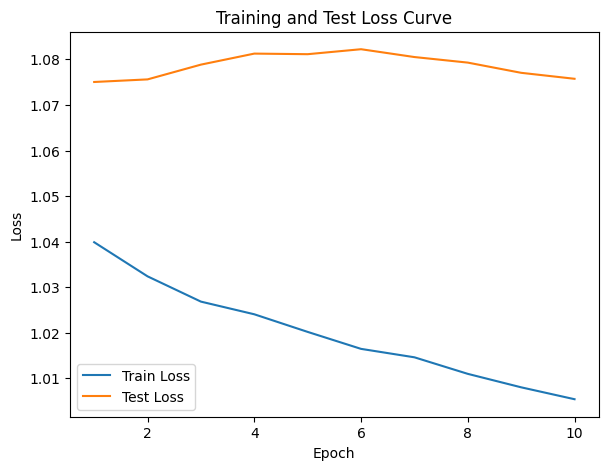

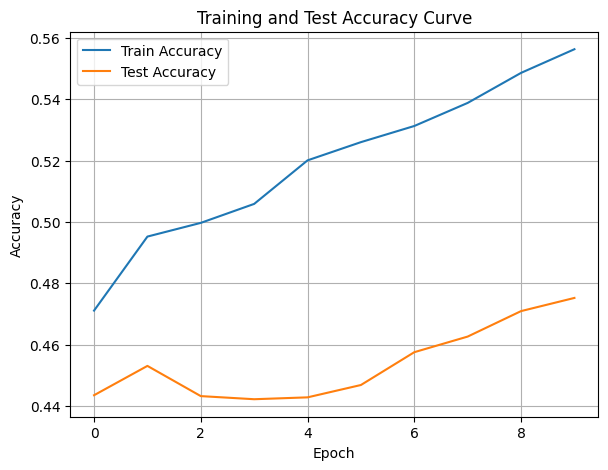

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.28582395785652914, Train Loss: 1.1409, Train Acc: 0.2690, Test F1:0.20042341510485553, Test Loss: 1.1094, Test Acc: 0.2587


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.21it/s]

Epoch [2/10], Train F1:0.2785461562247276, Train Loss: 1.1416, Train Acc: 0.2643, Test F1:0.18889028187829462, Test Loss: 1.1083, Test Acc: 0.2882


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.21it/s]

Epoch [3/10], Train F1:0.27114147246444914, Train Loss: 1.1390, Train Acc: 0.2652, Test F1:0.19147253709035303, Test Loss: 1.1098, Test Acc: 0.2934


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.30it/s]

Epoch [4/10], Train F1:0.2684713021762222, Train Loss: 1.1387, Train Acc: 0.2627, Test F1:0.19373318676211673, Test Loss: 1.1097, Test Acc: 0.2980


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.30it/s]

Epoch [5/10], Train F1:0.27021683428049315, Train Loss: 1.1353, Train Acc: 0.2646, Test F1:0.20101077816707918, Test Loss: 1.1082, Test Acc: 0.3038


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.13it/s]

Epoch [6/10], Train F1:0.2743088170885467, Train Loss: 1.1336, Train Acc: 0.2716, Test F1:0.20621313108097758, Test Loss: 1.1067, Test Acc: 0.3113


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.13it/s]

Epoch [7/10], Train F1:0.2852454083405064, Train Loss: 1.1306, Train Acc: 0.2810, Test F1:0.21289090406100927, Test Loss: 1.1054, Test Acc: 0.3147


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.19it/s]

Epoch [8/10], Train F1:0.29750172533223573, Train Loss: 1.1281, Train Acc: 0.2906, Test F1:0.21655803338939145, Test Loss: 1.1031, Test Acc: 0.3210


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.19it/s]

Epoch [9/10], Train F1:0.3071143659120734, Train Loss: 1.1241, Train Acc: 0.2986, Test F1:0.2192360775323514, Test Loss: 1.1016, Test Acc: 0.3258


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.64it/s]


Epoch [10/10], Train F1:0.31395937651180456, Train Loss: 1.1207, Train Acc: 0.3066, Test F1:0.22427282246506627, Test Loss: 1.0994, Test Acc: 0.3297
Total Epochs: 10
Train loss start: 1.1925972700119019, Train loss end: 1.0559327602386475
Highest Mean Train Accuracy (over epoch): 0.30660714285714286
Test loss start: 1.1167961359024048, Test loss end: 1.0744744539260864
Highest mean Test Accuracy (over epoch): 0.3296875


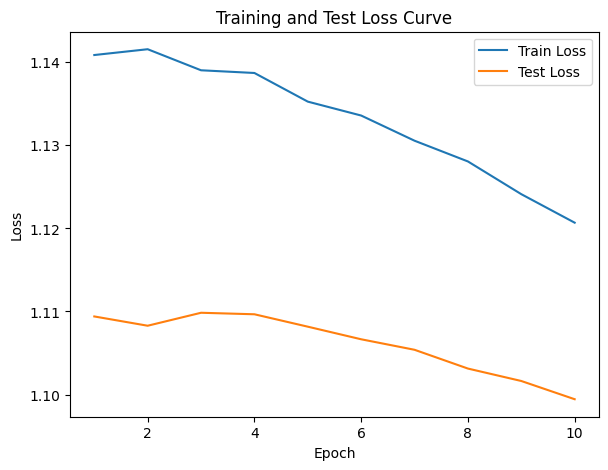

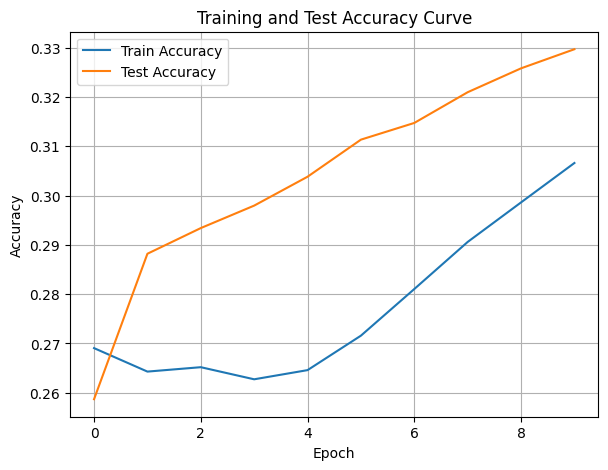

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.72it/s]

Epoch [1/10], Train F1:0.2796382412963778, Train Loss: 1.1822, Train Acc: 0.2473, Test F1:0.23698134224450018, Test Loss: 1.1328, Test Acc: 0.2040


Training Process:  20%|██        | 2/10 [00:00<00:01,  8.00it/s]

Epoch [2/10], Train F1:0.276949581987578, Train Loss: 1.1837, Train Acc: 0.2394, Test F1:0.27462887989203777, Test Loss: 1.1304, Test Acc: 0.2361


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.59it/s]

Epoch [3/10], Train F1:0.2873006081176928, Train Loss: 1.1819, Train Acc: 0.2443, Test F1:0.3028165948369684, Test Loss: 1.1280, Test Acc: 0.2711


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.53it/s]

Epoch [4/10], Train F1:0.2924153469557369, Train Loss: 1.1786, Train Acc: 0.2516, Test F1:0.28546509677635773, Test Loss: 1.1278, Test Acc: 0.2474


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.15it/s]

Epoch [5/10], Train F1:0.294449202570345, Train Loss: 1.1753, Train Acc: 0.2565, Test F1:0.2766090966140078, Test Loss: 1.1278, Test Acc: 0.2347


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.57it/s]

Epoch [6/10], Train F1:0.3025520482411787, Train Loss: 1.1722, Train Acc: 0.2636, Test F1:0.3062707436871333, Test Loss: 1.1243, Test Acc: 0.2658


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.07it/s]

Epoch [7/10], Train F1:0.3041697445191951, Train Loss: 1.1695, Train Acc: 0.2653, Test F1:0.31772631355542563, Test Loss: 1.1233, Test Acc: 0.2790


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.55it/s]

Epoch [8/10], Train F1:0.3094329288336284, Train Loss: 1.1665, Train Acc: 0.2720, Test F1:0.33839637176088433, Test Loss: 1.1211, Test Acc: 0.3024


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.69it/s]

Epoch [9/10], Train F1:0.3159449110744488, Train Loss: 1.1636, Train Acc: 0.2808, Test F1:0.35572547433539636, Test Loss: 1.1193, Test Acc: 0.3223


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.26it/s]


Epoch [10/10], Train F1:0.32186241054693676, Train Loss: 1.1596, Train Acc: 0.2895, Test F1:0.3688062009432347, Test Loss: 1.1175, Test Acc: 0.3391
Total Epochs: 10
Train loss start: 1.1180678606033325, Train loss end: 0.9522987008094788
Highest Mean Train Accuracy (over epoch): 0.2895238095238095
Test loss start: 1.1191484928131104, Test loss end: 1.1241161823272705
Highest mean Test Accuracy (over epoch): 0.3390625


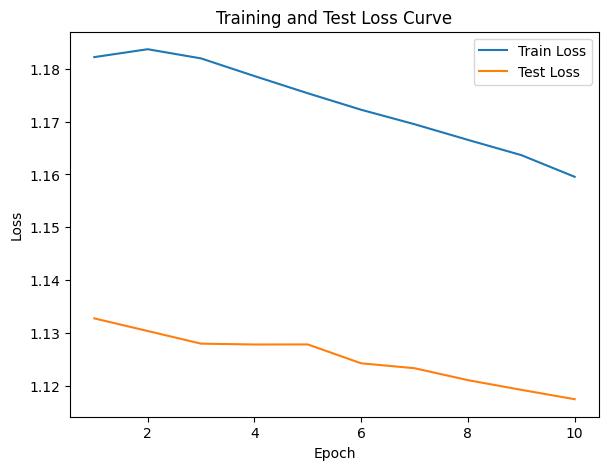

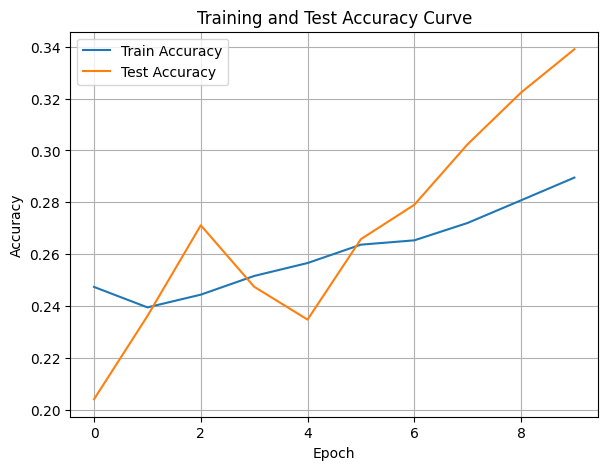

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.55it/s]

Epoch [1/10], Train F1:0.19774050510892616, Train Loss: 1.1634, Train Acc: 0.2616, Test F1:0.1466352448284891, Test Loss: 1.1453, Test Acc: 0.1215
Epoch [2/10], Train F1:0.18988950949066413, Train Loss: 1.1691, Train Acc: 0.2543, Test F1:0.15879113843001666, Test Loss: 1.1477, Test Acc: 0.1332


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.35it/s]

Epoch [3/10], Train F1:0.19081930296143332, Train Loss: 1.1644, Train Acc: 0.2578, Test F1:0.16894087069525665, Test Loss: 1.1465, Test Acc: 0.1476
Epoch [4/10], Train F1:0.1945329214536087, Train Loss: 1.1590, Train Acc: 0.2635, Test F1:0.17602534765006161, Test Loss: 1.1466, Test Acc: 0.1586


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.92it/s]

Epoch [5/10], Train F1:0.1951951590934905, Train Loss: 1.1582, Train Acc: 0.2663, Test F1:0.18012946805516467, Test Loss: 1.1451, Test Acc: 0.1622
Epoch [6/10], Train F1:0.19437865057529521, Train Loss: 1.1550, Train Acc: 0.2675, Test F1:0.18327067669172933, Test Loss: 1.1434, Test Acc: 0.1645


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.56it/s]

Epoch [7/10], Train F1:0.1957952130768788, Train Loss: 1.1507, Train Acc: 0.2723, Test F1:0.18677873390701089, Test Loss: 1.1417, Test Acc: 0.1684
Epoch [8/10], Train F1:0.1984016322584078, Train Loss: 1.1472, Train Acc: 0.2774, Test F1:0.1901528013582343, Test Loss: 1.1389, Test Acc: 0.1777


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.76it/s]


Epoch [9/10], Train F1:0.20016773402740518, Train Loss: 1.1446, Train Acc: 0.2807, Test F1:0.192384370015949, Test Loss: 1.1369, Test Acc: 0.1810
Epoch [10/10], Train F1:0.20280989849115802, Train Loss: 1.1416, Train Acc: 0.2845, Test F1:0.19532458349904988, Test Loss: 1.1348, Test Acc: 0.1866
Total Epochs: 10
Train loss start: 1.1293030977249146, Train loss end: 1.1600399017333984
Highest Mean Train Accuracy (over epoch): 0.2844940476190476
Test loss start: 1.159050464630127, Test loss end: 1.104036569595337
Highest mean Test Accuracy (over epoch): 0.18663194444444445


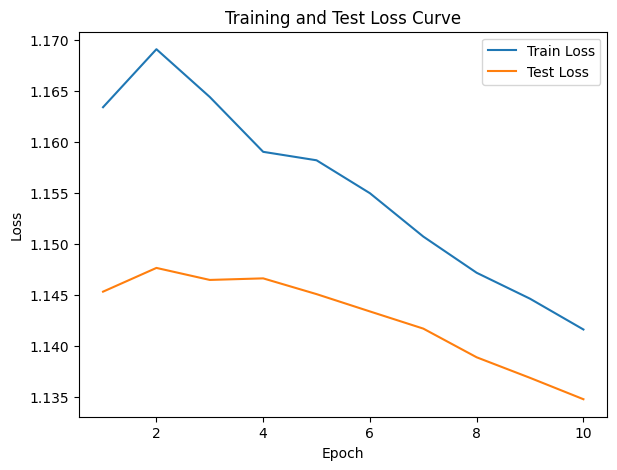

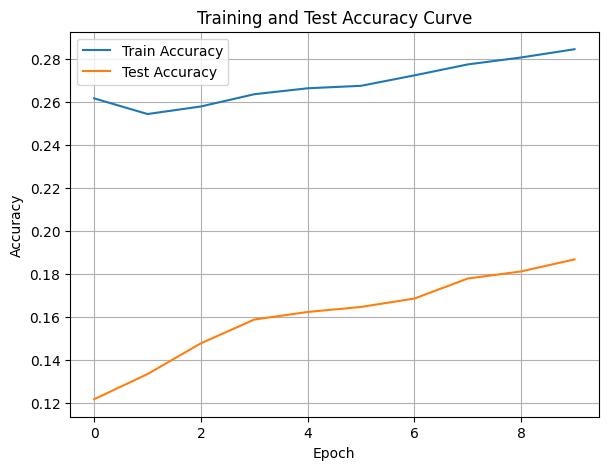

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.88it/s]

Epoch [1/10], Train F1:0.4665834006500358, Train Loss: 1.0485, Train Acc: 0.4577, Test F1:0.39845488308229315, Test Loss: 1.0847, Test Acc: 0.3003


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.07it/s]

Epoch [2/10], Train F1:0.4681473353426364, Train Loss: 1.0464, Train Acc: 0.4493, Test F1:0.37780375308017944, Test Loss: 1.0903, Test Acc: 0.2739


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.98it/s]

Epoch [3/10], Train F1:0.47824598166061577, Train Loss: 1.0381, Train Acc: 0.4629, Test F1:0.36788942052099954, Test Loss: 1.0905, Test Acc: 0.2650


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.44it/s]

Epoch [4/10], Train F1:0.4885668362772917, Train Loss: 1.0341, Train Acc: 0.4705, Test F1:0.38446718400278773, Test Loss: 1.0878, Test Acc: 0.2782


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.46it/s]

Epoch [5/10], Train F1:0.5047126430741475, Train Loss: 1.0278, Train Acc: 0.4861, Test F1:0.40235187388005245, Test Loss: 1.0857, Test Acc: 0.2924


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.45it/s]

Epoch [6/10], Train F1:0.5123220518865563, Train Loss: 1.0251, Train Acc: 0.4940, Test F1:0.40857899223762734, Test Loss: 1.0844, Test Acc: 0.2966


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.21it/s]

Epoch [7/10], Train F1:0.5196409294281099, Train Loss: 1.0226, Train Acc: 0.5009, Test F1:0.42616661698915065, Test Loss: 1.0817, Test Acc: 0.3136


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.03it/s]

Epoch [8/10], Train F1:0.52791781506559, Train Loss: 1.0187, Train Acc: 0.5096, Test F1:0.4432694799370104, Test Loss: 1.0793, Test Acc: 0.3295


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.51it/s]

Epoch [9/10], Train F1:0.5385540992227602, Train Loss: 1.0146, Train Acc: 0.5214, Test F1:0.4804561511704021, Test Loss: 1.0754, Test Acc: 0.3679


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.31it/s]


Epoch [10/10], Train F1:0.5430725296131035, Train Loss: 1.0126, Train Acc: 0.5252, Test F1:0.4995999446423801, Test Loss: 1.0729, Test Acc: 0.3897
Total Epochs: 10
Train loss start: 1.1001747846603394, Train loss end: 0.9692407846450806
Highest Mean Train Accuracy (over epoch): 0.5252380952380952
Test loss start: 1.091565489768982, Test loss end: 1.0430524349212646
Highest mean Test Accuracy (over epoch): 0.3896701388888889


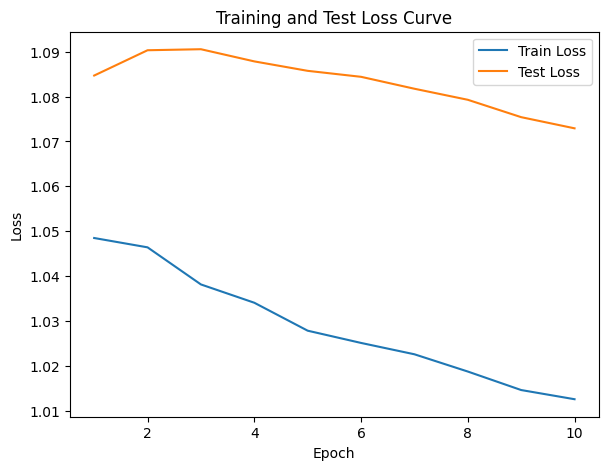

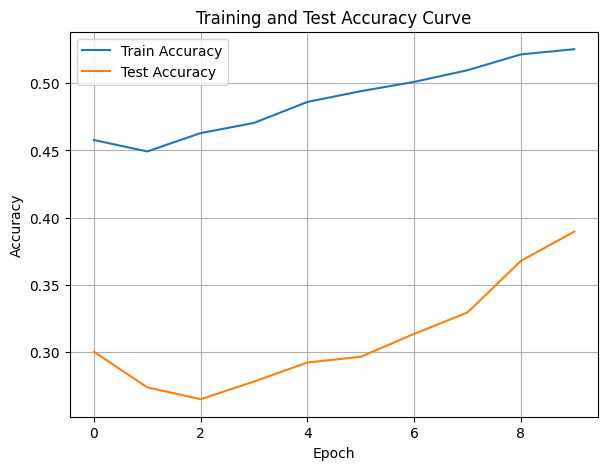

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.06it/s]

Epoch [1/10], Train F1:0.5089084695792013, Train Loss: 1.0665, Train Acc: 0.4661, Test F1:0.5453636579940582, Test Loss: 1.0571, Test Acc: 0.5842


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.97it/s]

Epoch [2/10], Train F1:0.4976842339651087, Train Loss: 1.0714, Train Acc: 0.4577, Test F1:0.558062515091716, Test Loss: 1.0462, Test Acc: 0.5968


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.79it/s]

Epoch [3/10], Train F1:0.5012453331958336, Train Loss: 1.0644, Train Acc: 0.4662, Test F1:0.5575953638663604, Test Loss: 1.0437, Test Acc: 0.5958


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.15it/s]

Epoch [4/10], Train F1:0.49660884739282823, Train Loss: 1.0610, Train Acc: 0.4670, Test F1:0.5612581525860761, Test Loss: 1.0388, Test Acc: 0.6061


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.68it/s]

Epoch [5/10], Train F1:0.49856712175865453, Train Loss: 1.0622, Train Acc: 0.4666, Test F1:0.567238974654932, Test Loss: 1.0364, Test Acc: 0.6139


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.58it/s]

Epoch [6/10], Train F1:0.5061833012166738, Train Loss: 1.0568, Train Acc: 0.4782, Test F1:0.5685805021778797, Test Loss: 1.0330, Test Acc: 0.6178


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.01it/s]

Epoch [7/10], Train F1:0.5133091071870182, Train Loss: 1.0524, Train Acc: 0.4858, Test F1:0.5767424399237338, Test Loss: 1.0293, Test Acc: 0.6267


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.11it/s]

Epoch [8/10], Train F1:0.5250613723904578, Train Loss: 1.0474, Train Acc: 0.4982, Test F1:0.5866981365224349, Test Loss: 1.0258, Test Acc: 0.6354


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.06it/s]

Epoch [9/10], Train F1:0.5371852016157928, Train Loss: 1.0434, Train Acc: 0.5096, Test F1:0.5847619047619048, Test Loss: 1.0240, Test Acc: 0.6372


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.37it/s]


Epoch [10/10], Train F1:0.5423274856054003, Train Loss: 1.0405, Train Acc: 0.5134, Test F1:0.5956220016164961, Test Loss: 1.0211, Test Acc: 0.6460
Total Epochs: 10
Train loss start: 1.0818889141082764, Train loss end: 1.0931061506271362
Highest Mean Train Accuracy (over epoch): 0.5134226190476191
Test loss start: 1.0545777082443237, Test loss end: 0.9978117346763611
Highest mean Test Accuracy (over epoch): 0.6460069444444445


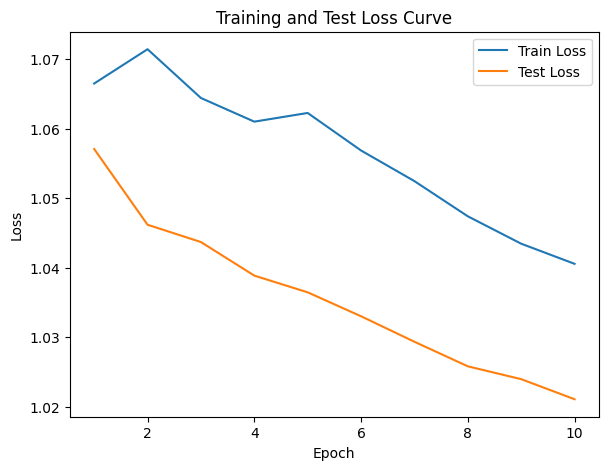

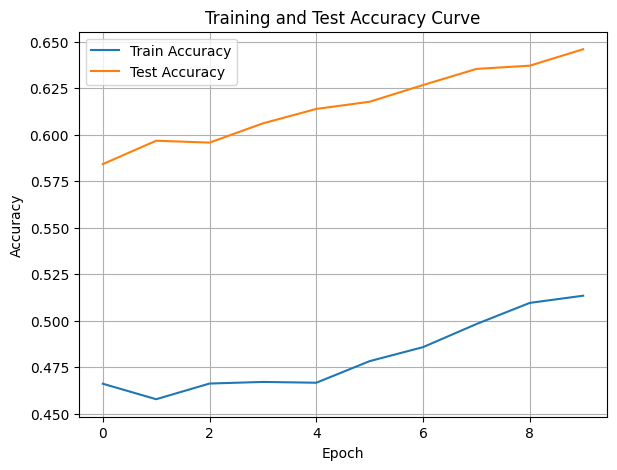

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.30it/s]

Epoch [1/10], Train F1:0.3820674949654024, Train Loss: 1.0919, Train Acc: 0.3369, Test F1:0.18635477582846002, Test Loss: 1.1146, Test Acc: 0.1155


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.48it/s]

Epoch [2/10], Train F1:0.39142454444193275, Train Loss: 1.0875, Train Acc: 0.3500, Test F1:0.1423956160798266, Test Loss: 1.1216, Test Acc: 0.0842


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.90it/s]

Epoch [3/10], Train F1:0.40262167855929737, Train Loss: 1.0808, Train Acc: 0.3577, Test F1:0.14834598935148818, Test Loss: 1.1212, Test Acc: 0.0868


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.32it/s]

Epoch [4/10], Train F1:0.4170650328757897, Train Loss: 1.0790, Train Acc: 0.3699, Test F1:0.14687848280986204, Test Loss: 1.1213, Test Acc: 0.0877


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.69it/s]

Epoch [5/10], Train F1:0.42268753325410025, Train Loss: 1.0780, Train Acc: 0.3748, Test F1:0.14365479481758553, Test Loss: 1.1215, Test Acc: 0.0866


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.12it/s]

Epoch [6/10], Train F1:0.4304620571338396, Train Loss: 1.0742, Train Acc: 0.3810, Test F1:0.14018672307109936, Test Loss: 1.1208, Test Acc: 0.0846


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.62it/s]

Epoch [7/10], Train F1:0.43273274638575376, Train Loss: 1.0740, Train Acc: 0.3828, Test F1:0.14133551550472692, Test Loss: 1.1202, Test Acc: 0.0854


Epoch [8/10], Train F1:0.43793992541042787, Train Loss: 1.0713, Train Acc: 0.3899, Test F1:0.14066841311423356, Test Loss: 1.1196, Test Acc: 0.0851


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.82it/s]


Epoch [9/10], Train F1:0.4471945652457565, Train Loss: 1.0668, Train Acc: 0.3996, Test F1:0.1538656804647981, Test Loss: 1.1175, Test Acc: 0.0948
Epoch [10/10], Train F1:0.454666381131208, Train Loss: 1.0642, Train Acc: 0.4076, Test F1:0.16778006510090027, Test Loss: 1.1162, Test Acc: 0.1034
Total Epochs: 10
Train loss start: 1.1217124462127686, Train loss end: 1.0322520732879639
Highest Mean Train Accuracy (over epoch): 0.4076488095238095
Test loss start: 1.1016143560409546, Test loss end: 1.0986429452896118
Highest mean Test Accuracy (over epoch): 0.1154513888888889


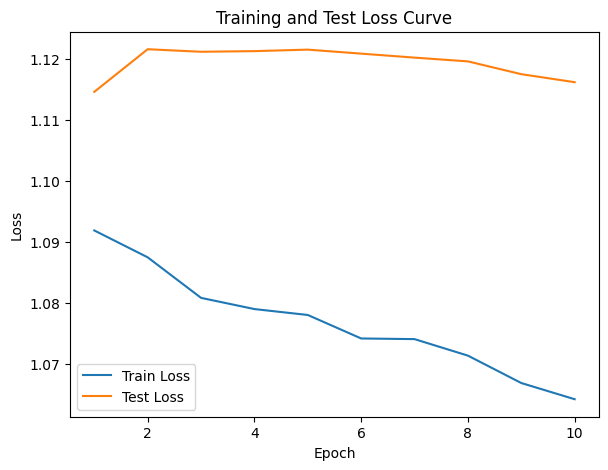

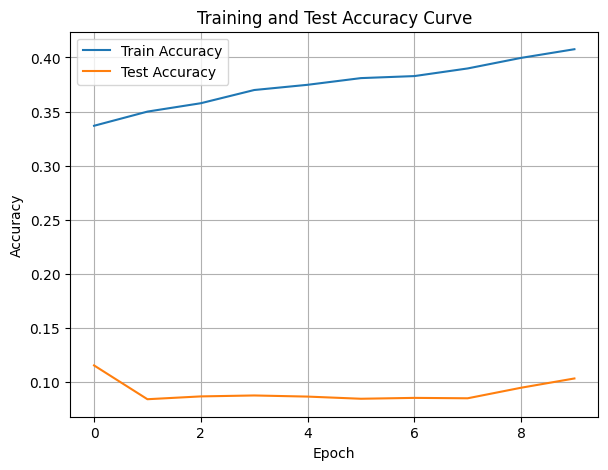

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.78it/s]

Epoch [1/10], Train F1:0.6692807160695298, Train Loss: 0.9857, Train Acc: 0.6381, Test F1:0.6991020675231202, Test Loss: 1.0355, Test Acc: 0.6780
Epoch [2/10], Train F1:0.648251426201136, Train Loss: 0.9873, Train Acc: 0.6140, Test F1:0.6950710108604846, Test Loss: 1.0303, Test Acc: 0.6810


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.78it/s]

Epoch [3/10], Train F1:0.6536150562129378, Train Loss: 0.9829, Train Acc: 0.6245, Test F1:0.69465675207302, Test Loss: 1.0271, Test Acc: 0.6820


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.10it/s]

Epoch [4/10], Train F1:0.6564638815819243, Train Loss: 0.9837, Train Acc: 0.6313, Test F1:0.6928613022252028, Test Loss: 1.0257, Test Acc: 0.6775


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.10it/s]

Epoch [5/10], Train F1:0.6594273615277644, Train Loss: 0.9811, Train Acc: 0.6384, Test F1:0.6829981217295953, Test Loss: 1.0249, Test Acc: 0.6655


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.63it/s]

Epoch [6/10], Train F1:0.6660530461085223, Train Loss: 0.9771, Train Acc: 0.6467, Test F1:0.681041654303965, Test Loss: 1.0231, Test Acc: 0.6626


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.63it/s]

Epoch [7/10], Train F1:0.6690727800207704, Train Loss: 0.9750, Train Acc: 0.6497, Test F1:0.6804259481682567, Test Loss: 1.0221, Test Acc: 0.6626


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.01it/s]

Epoch [8/10], Train F1:0.6752416133772067, Train Loss: 0.9724, Train Acc: 0.6558, Test F1:0.6893053012496699, Test Loss: 1.0200, Test Acc: 0.6736


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.01it/s]

Epoch [9/10], Train F1:0.6815404142803486, Train Loss: 0.9700, Train Acc: 0.6613, Test F1:0.6929563885595811, Test Loss: 1.0185, Test Acc: 0.6780


Training Process:  80%|████████  | 8/10 [00:01<00:00, 10.01it/s]

Epoch [10/10], Train F1:0.6890468340466921, Train Loss: 0.9655, Train Acc: 0.6707, Test F1:0.6935710540575523, Test Loss: 1.0157, Test Acc: 0.6794


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.70it/s]


Total Epochs: 10
Train loss start: 0.988577663898468, Train loss end: 0.8542965650558472
Highest Mean Train Accuracy (over epoch): 0.6706845238095238
Test loss start: 1.0279276371002197, Test loss end: 0.9923040866851807
Highest mean Test Accuracy (over epoch): 0.6820023148148148


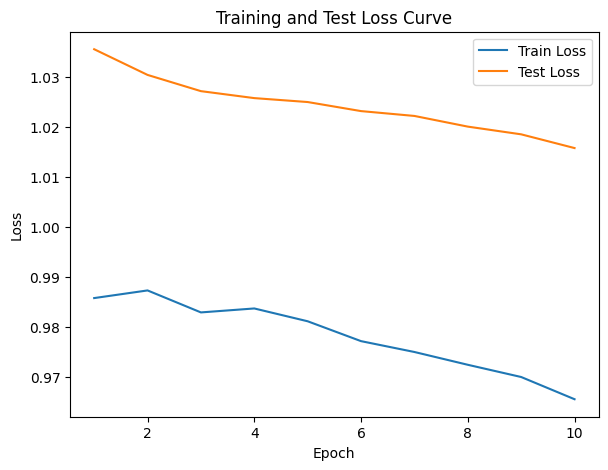

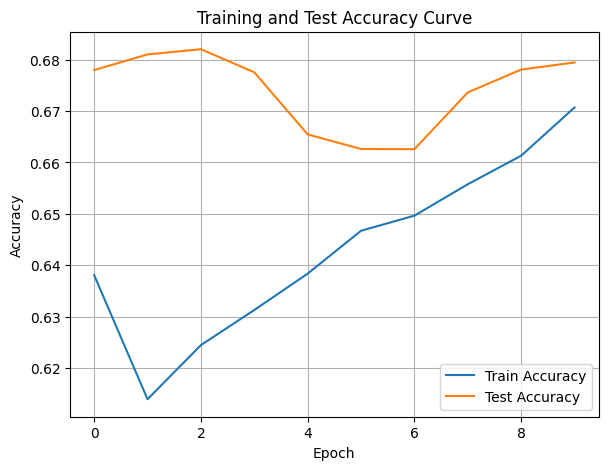

./saved_models/model_8.pth
Training Model with id 12
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.78it/s]

Epoch [1/10], Train F1:0.7480122961237384, Train Loss: 0.9384, Train Acc: 0.7393, Test F1:0.7272616167894035, Test Loss: 0.9966, Test Acc: 0.7153
Epoch [2/10], Train F1:0.728076205630181, Train Loss: 0.9391, Train Acc: 0.7205, Test F1:0.7284303473916579, Test Loss: 0.9931, Test Acc: 0.7283
Epoch [3/10], Train F1:0.7242372445425881, Train Loss: 0.9390, Train Acc: 0.7185, Test F1:0.7346450910794978, Test Loss: 0.9910, Test Acc: 0.7378


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.62it/s]

Epoch [4/10], Train F1:0.7245608898600134, Train Loss: 0.9355, Train Acc: 0.7190, Test F1:0.7368306386882236, Test Loss: 0.9877, Test Acc: 0.7391
Epoch [5/10], Train F1:0.7282435542982131, Train Loss: 0.9320, Train Acc: 0.7211, Test F1:0.7369344413665744, Test Loss: 0.9851, Test Acc: 0.7384


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.64it/s]

Epoch [6/10], Train F1:0.737018860506154, Train Loss: 0.9282, Train Acc: 0.7288, Test F1:0.7422668513388735, Test Loss: 0.9831, Test Acc: 0.7431
Epoch [7/10], Train F1:0.7381960837936322, Train Loss: 0.9253, Train Acc: 0.7306, Test F1:0.7443990661683522, Test Loss: 0.9816, Test Acc: 0.7462


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.05it/s]

Epoch [8/10], Train F1:0.7422261879210925, Train Loss: 0.9218, Train Acc: 0.7358, Test F1:0.7447600338846062, Test Loss: 0.9803, Test Acc: 0.7475
Epoch [9/10], Train F1:0.745073231432352, Train Loss: 0.9194, Train Acc: 0.7385, Test F1:0.7476691368008249, Test Loss: 0.9792, Test Acc: 0.7496


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.56it/s]


Epoch [10/10], Train F1:0.7514062839673248, Train Loss: 0.9160, Train Acc: 0.7438, Test F1:0.7502121316362804, Test Loss: 0.9775, Test Acc: 0.7533
Total Epochs: 10
Train loss start: 0.9465522766113281, Train loss end: 0.8534990549087524
Highest Mean Train Accuracy (over epoch): 0.7438392857142857
Test loss start: 0.9900789856910706, Test loss end: 0.9486964344978333
Highest mean Test Accuracy (over epoch): 0.7532986111111111


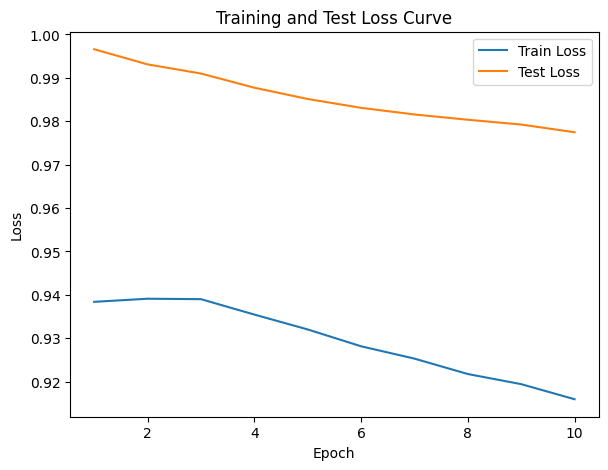

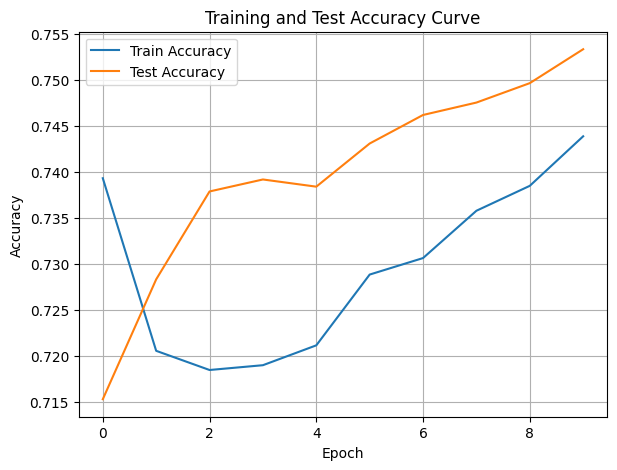

./saved_models/model_12.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.17it/s]

Epoch [1/10], Train F1:0.7735499606533618, Train Loss: 0.8927, Train Acc: 0.7631, Test F1:0.7628565083595062, Test Loss: 0.9504, Test Acc: 0.7726
Epoch [2/10], Train F1:0.7811369253583786, Train Loss: 0.8890, Train Acc: 0.7815, Test F1:0.7730881883096545, Test Loss: 0.9546, Test Acc: 0.7834


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.17it/s]

Epoch [3/10], Train F1:0.7836874114483436, Train Loss: 0.8821, Train Acc: 0.7827, Test F1:0.7723541692924535, Test Loss: 0.9499, Test Acc: 0.7824


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.15it/s]

Epoch [4/10], Train F1:0.7805344141844294, Train Loss: 0.8803, Train Acc: 0.7810, Test F1:0.7725400972881377, Test Loss: 0.9480, Test Acc: 0.7834


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.18it/s]

Epoch [5/10], Train F1:0.7802297831641252, Train Loss: 0.8781, Train Acc: 0.7802, Test F1:0.7726508751658565, Test Loss: 0.9473, Test Acc: 0.7840
Epoch [6/10], Train F1:0.7935338974362294, Train Loss: 0.8695, Train Acc: 0.7942, Test F1:0.7734455944992726, Test Loss: 0.9453, Test Acc: 0.7834


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.18it/s]

Epoch [7/10], Train F1:0.7900276730016508, Train Loss: 0.8708, Train Acc: 0.7903, Test F1:0.7756814661575443, Test Loss: 0.9438, Test Acc: 0.7861


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.45it/s]

Epoch [8/10], Train F1:0.7912127801647252, Train Loss: 0.8696, Train Acc: 0.7912, Test F1:0.7796314731955643, Test Loss: 0.9415, Test Acc: 0.7900
Epoch [9/10], Train F1:0.7930225643947748, Train Loss: 0.8671, Train Acc: 0.7926, Test F1:0.7800308680077238, Test Loss: 0.9401, Test Acc: 0.7898


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.48it/s]

Epoch [10/10], Train F1:0.7958295235732363, Train Loss: 0.8653, Train Acc: 0.7935, Test F1:0.7813610179196919, Test Loss: 0.9386, Test Acc: 0.7905
Total Epochs: 10
Train loss start: 0.8731801509857178, Train loss end: 1.017967939376831
Highest Mean Train Accuracy (over epoch): 0.7942460317460318
Test loss start: 0.9471231698989868, Test loss end: 0.907599151134491
Highest mean Test Accuracy (over epoch): 0.7904513888888889


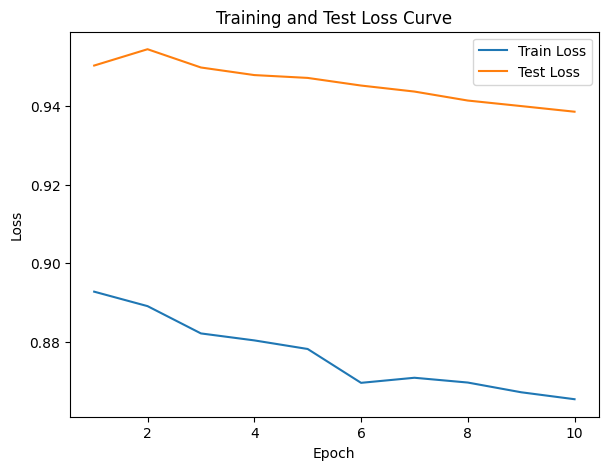

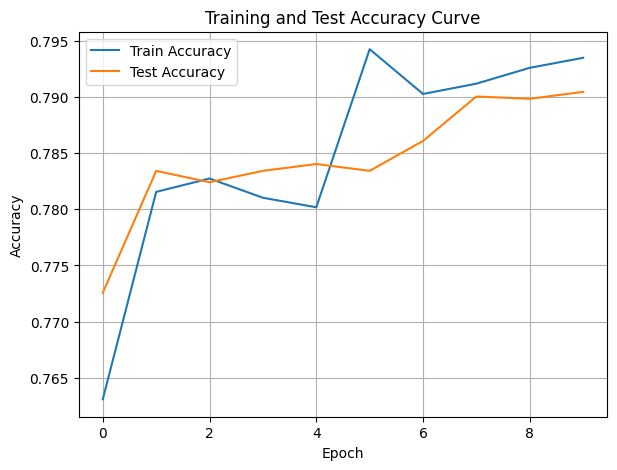

./saved_models/model_13.pth
Training Model with id 11
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.50it/s]

Epoch [1/10], Train F1:0.8274148819459249, Train Loss: 0.8294, Train Acc: 0.8396, Test F1:0.7810983154087752, Test Loss: 0.9298, Test Acc: 0.7943


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.06it/s]

Epoch [2/10], Train F1:0.8079387299260326, Train Loss: 0.8357, Train Acc: 0.8124, Test F1:0.7931793192566571, Test Loss: 0.9249, Test Acc: 0.8090
Epoch [3/10], Train F1:0.8171673755534824, Train Loss: 0.8342, Train Acc: 0.8161, Test F1:0.7932595201082877, Test Loss: 0.9234, Test Acc: 0.8047


Training Process:  50%|█████     | 5/10 [00:00<00:00, 11.08it/s]

Epoch [4/10], Train F1:0.8193072226383848, Train Loss: 0.8313, Train Acc: 0.8190, Test F1:0.7902192189334094, Test Loss: 0.9230, Test Acc: 0.8006
Epoch [5/10], Train F1:0.8186552435536459, Train Loss: 0.8283, Train Acc: 0.8192, Test F1:0.7904279129681038, Test Loss: 0.9194, Test Acc: 0.7997
Epoch [6/10], Train F1:0.8192633967235132, Train Loss: 0.8275, Train Acc: 0.8190, Test F1:0.7929119449341056, Test Loss: 0.9160, Test Acc: 0.8027


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 11.69it/s]

Epoch [7/10], Train F1:0.8223069151592556, Train Loss: 0.8251, Train Acc: 0.8224, Test F1:0.7955375861153664, Test Loss: 0.9137, Test Acc: 0.8068
Epoch [8/10], Train F1:0.8248499458703361, Train Loss: 0.8241, Train Acc: 0.8243, Test F1:0.7985728128274294, Test Loss: 0.9125, Test Acc: 0.8084
Epoch [9/10], Train F1:0.8257576915998045, Train Loss: 0.8225, Train Acc: 0.8256, Test F1:0.8009204416163882, Test Loss: 0.9111, Test Acc: 0.8096


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.47it/s]


Epoch [10/10], Train F1:0.8322057470034707, Train Loss: 0.8176, Train Acc: 0.8319, Test F1:0.8040154878248459, Test Loss: 0.9092, Test Acc: 0.8134
Total Epochs: 10
Train loss start: 0.8023543953895569, Train loss end: 0.7115951180458069
Highest Mean Train Accuracy (over epoch): 0.8395833333333333
Test loss start: 0.9235394597053528, Test loss end: 0.8684285283088684
Highest mean Test Accuracy (over epoch): 0.8133680555555556


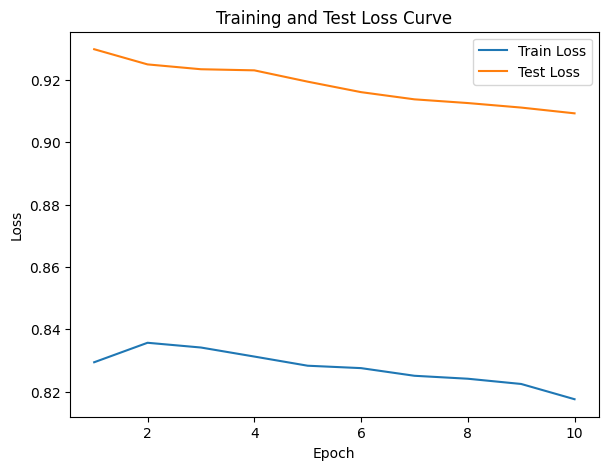

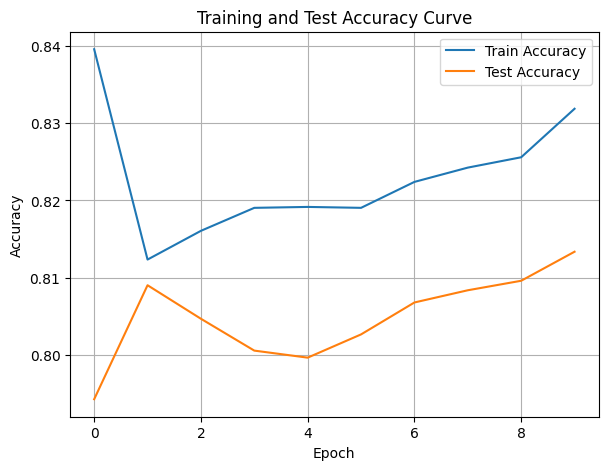

./saved_models/model_11.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.13it/s]

Epoch [1/10], Train F1:0.8619140047352785, Train Loss: 0.7968, Train Acc: 0.8688, Test F1:0.8135349597337902, Test Loss: 0.8904, Test Acc: 0.8316
Epoch [2/10], Train F1:0.8458705781286426, Train Loss: 0.7995, Train Acc: 0.8542, Test F1:0.8248774509803922, Test Loss: 0.8894, Test Acc: 0.8364


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.73it/s]

Epoch [3/10], Train F1:0.8402297463569139, Train Loss: 0.8009, Train Acc: 0.8493, Test F1:0.8285680484674334, Test Loss: 0.8877, Test Acc: 0.8380
Epoch [4/10], Train F1:0.8410537301715442, Train Loss: 0.7975, Train Acc: 0.8500, Test F1:0.832019256037047, Test Loss: 0.8844, Test Acc: 0.8422
Epoch [5/10], Train F1:0.8439407000849443, Train Loss: 0.7952, Train Acc: 0.8529, Test F1:0.834094427244582, Test Loss: 0.8813, Test Acc: 0.8448


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.01it/s]

Epoch [6/10], Train F1:0.8424501518185927, Train Loss: 0.7932, Train Acc: 0.8517, Test F1:0.8343950410166666, Test Loss: 0.8802, Test Acc: 0.8442
Epoch [7/10], Train F1:0.8410460064266381, Train Loss: 0.7922, Train Acc: 0.8485, Test F1:0.836981732855503, Test Loss: 0.8793, Test Acc: 0.8469


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.78it/s]

Epoch [8/10], Train F1:0.8397260262227175, Train Loss: 0.7919, Train Acc: 0.8467, Test F1:0.837881590230639, Test Loss: 0.8780, Test Acc: 0.8471
Epoch [9/10], Train F1:0.8420455310429198, Train Loss: 0.7902, Train Acc: 0.8485, Test F1:0.839506305182819, Test Loss: 0.8768, Test Acc: 0.8489


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.46it/s]


Epoch [10/10], Train F1:0.8446337303534844, Train Loss: 0.7892, Train Acc: 0.8490, Test F1:0.8408065603343274, Test Loss: 0.8752, Test Acc: 0.8503
Total Epochs: 10
Train loss start: 0.7897553443908691, Train loss end: 0.9733743667602539
Highest Mean Train Accuracy (over epoch): 0.86875
Test loss start: 0.8843660354614258, Test loss end: 0.8382675647735596
Highest mean Test Accuracy (over epoch): 0.8502604166666667


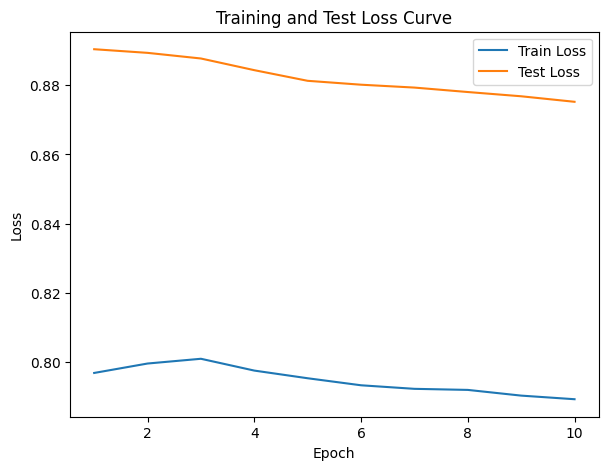

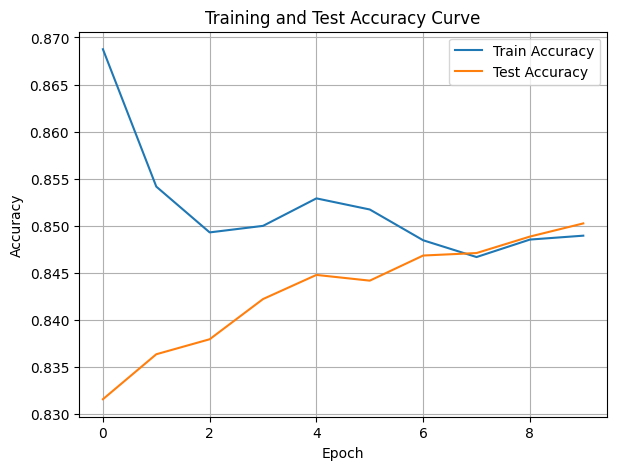

./saved_models/model_13.pth
Training Model with id 14
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.81it/s]

Epoch [1/10], Train F1:0.8377291625344248, Train Loss: 0.7796, Train Acc: 0.8479, Test F1:0.8456999680505651, Test Loss: 0.8672, Test Acc: 0.8490
Epoch [2/10], Train F1:0.8368929457639135, Train Loss: 0.7789, Train Acc: 0.8432, Test F1:0.8456999680505651, Test Loss: 0.8654, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.81it/s]

Epoch [3/10], Train F1:0.8442066619782204, Train Loss: 0.7782, Train Acc: 0.8485, Test F1:0.8456999680505652, Test Loss: 0.8636, Test Acc: 0.8490


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.59it/s]

Epoch [4/10], Train F1:0.8404875019118918, Train Loss: 0.7748, Train Acc: 0.8463, Test F1:0.8477866876711629, Test Loss: 0.8606, Test Acc: 0.8509


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.59it/s]

Epoch [5/10], Train F1:0.8433476005301923, Train Loss: 0.7714, Train Acc: 0.8470, Test F1:0.8490401811101287, Test Loss: 0.8582, Test Acc: 0.8521


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.05it/s]

Epoch [6/10], Train F1:0.8452556098269451, Train Loss: 0.7690, Train Acc: 0.8499, Test F1:0.8493791321205099, Test Loss: 0.8574, Test Acc: 0.8539
Epoch [7/10], Train F1:0.8440412104387747, Train Loss: 0.7672, Train Acc: 0.8496, Test F1:0.8512457832751376, Test Loss: 0.8567, Test Acc: 0.8563


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.42it/s]

Epoch [8/10], Train F1:0.8456790799210815, Train Loss: 0.7655, Train Acc: 0.8517, Test F1:0.8499767280145009, Test Loss: 0.8553, Test Acc: 0.8561


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.42it/s]

Epoch [9/10], Train F1:0.8464857363819253, Train Loss: 0.7639, Train Acc: 0.8521, Test F1:0.8513656817599956, Test Loss: 0.8544, Test Acc: 0.8577


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.32it/s]

Epoch [10/10], Train F1:0.8471553789354563, Train Loss: 0.7629, Train Acc: 0.8517, Test F1:0.8511687125015571, Test Loss: 0.8521, Test Acc: 0.8582
Total Epochs: 10
Train loss start: 0.8155271410942078, Train loss end: 0.7694806456565857
Highest Mean Train Accuracy (over epoch): 0.852116402116402
Test loss start: 0.8593371510505676, Test loss end: 0.8090956807136536
Highest mean Test Accuracy (over epoch): 0.8582465277777779


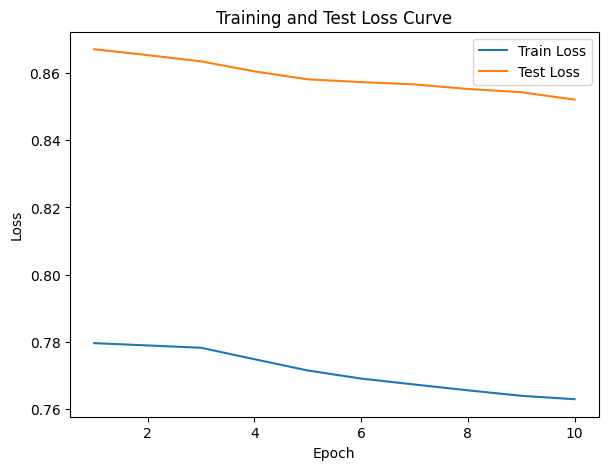

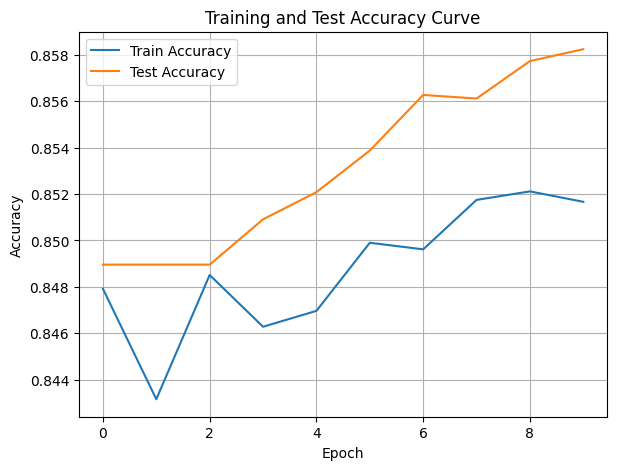

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.71it/s]

Epoch [1/10], Train F1:0.8686450643373721, Train Loss: 0.7395, Train Acc: 0.8622, Test F1:0.85406554360585, Test Loss: 0.8350, Test Acc: 0.8568
Epoch [2/10], Train F1:0.8596277821533794, Train Loss: 0.7534, Train Acc: 0.8539, Test F1:0.847497768304458, Test Loss: 0.8317, Test Acc: 0.8529


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.71it/s]

Epoch [3/10], Train F1:0.8602193596311849, Train Loss: 0.7507, Train Acc: 0.8570, Test F1:0.8514136581122226, Test Loss: 0.8306, Test Acc: 0.8588


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.81it/s]

Epoch [4/10], Train F1:0.8634443024022652, Train Loss: 0.7499, Train Acc: 0.8612, Test F1:0.8538060594391649, Test Loss: 0.8290, Test Acc: 0.8618


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.81it/s]

Epoch [5/10], Train F1:0.8685191510203855, Train Loss: 0.7497, Train Acc: 0.8652, Test F1:0.8538854925244866, Test Loss: 0.8291, Test Acc: 0.8608


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.44it/s]

Epoch [6/10], Train F1:0.8681865746944896, Train Loss: 0.7473, Train Acc: 0.8668, Test F1:0.8516993326925361, Test Loss: 0.8272, Test Acc: 0.8598
Epoch [7/10], Train F1:0.869191907809992, Train Loss: 0.7440, Train Acc: 0.8692, Test F1:0.8486763644650386, Test Loss: 0.8262, Test Acc: 0.8571


Training Process:  80%|████████  | 8/10 [00:00<00:00, 12.21it/s]

Epoch [8/10], Train F1:0.8707684343634287, Train Loss: 0.7438, Train Acc: 0.8708, Test F1:0.8461663417803768, Test Loss: 0.8245, Test Acc: 0.8551


Training Process: 100%|██████████| 10/10 [00:00<00:00, 12.20it/s]


Epoch [9/10], Train F1:0.869189020871072, Train Loss: 0.7446, Train Acc: 0.8695, Test F1:0.8478212366476771, Test Loss: 0.8229, Test Acc: 0.8569
Epoch [10/10], Train F1:0.8700476159924252, Train Loss: 0.7433, Train Acc: 0.8704, Test F1:0.8481217490176858, Test Loss: 0.8221, Test Acc: 0.8575
Total Epochs: 10
Train loss start: 0.7217535972595215, Train loss end: 0.755164623260498
Highest Mean Train Accuracy (over epoch): 0.8707961309523811
Test loss start: 0.8247871994972229, Test loss end: 0.792493462562561
Highest mean Test Accuracy (over epoch): 0.8617621527777778


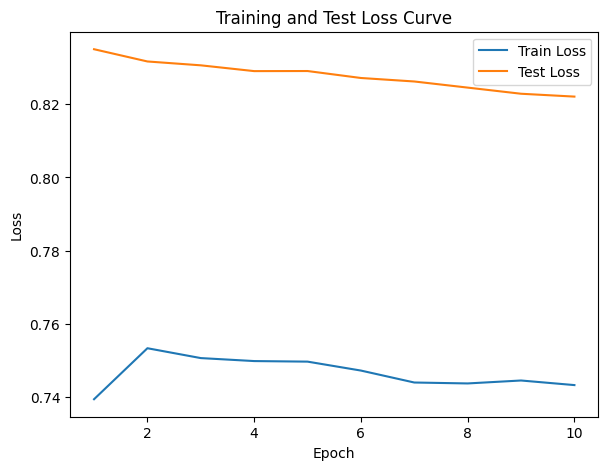

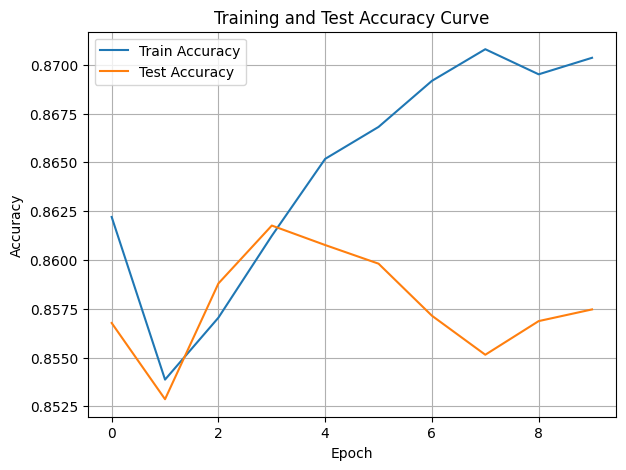

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.97it/s]

Epoch [1/10], Train F1:0.865868876885826, Train Loss: 0.7462, Train Acc: 0.8527, Test F1:0.8624843486896075, Test Loss: 0.8191, Test Acc: 0.8646
Epoch [2/10], Train F1:0.8716200878814795, Train Loss: 0.7320, Train Acc: 0.8653, Test F1:0.8667155612987344, Test Loss: 0.8156, Test Acc: 0.8715


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.97it/s]

Epoch [3/10], Train F1:0.8691415281653647, Train Loss: 0.7304, Train Acc: 0.8679, Test F1:0.8676465700059167, Test Loss: 0.8116, Test Acc: 0.8738


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.20it/s]

Epoch [4/10], Train F1:0.8704495521403635, Train Loss: 0.7311, Train Acc: 0.8699, Test F1:0.864234741180627, Test Loss: 0.8124, Test Acc: 0.8696
Epoch [5/10], Train F1:0.8700896257123354, Train Loss: 0.7306, Train Acc: 0.8683, Test F1:0.8655789382249239, Test Loss: 0.8109, Test Acc: 0.8714


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.97it/s]

Epoch [6/10], Train F1:0.8693179216094747, Train Loss: 0.7283, Train Acc: 0.8691, Test F1:0.8664754349242908, Test Loss: 0.8091, Test Acc: 0.8725
Epoch [7/10], Train F1:0.8707980262994768, Train Loss: 0.7272, Train Acc: 0.8696, Test F1:0.868328910511573, Test Loss: 0.8078, Test Acc: 0.8745
Epoch [8/10], Train F1:0.8709556846977823, Train Loss: 0.7262, Train Acc: 0.8701, Test F1:0.8684769531002642, Test Loss: 0.8070, Test Acc: 0.8750


Training Process: 100%|██████████| 10/10 [00:00<00:00, 12.09it/s]


Epoch [9/10], Train F1:0.8723750335221765, Train Loss: 0.7240, Train Acc: 0.8725, Test F1:0.8687535327256547, Test Loss: 0.8059, Test Acc: 0.8754
Epoch [10/10], Train F1:0.8731476944276062, Train Loss: 0.7225, Train Acc: 0.8733, Test F1:0.8688290433472013, Test Loss: 0.8044, Test Acc: 0.8757
Total Epochs: 10
Train loss start: 0.7336353659629822, Train loss end: 0.6876788139343262
Highest Mean Train Accuracy (over epoch): 0.8732738095238096
Test loss start: 0.8064830899238586, Test loss end: 0.7670623064041138
Highest mean Test Accuracy (over epoch): 0.8756944444444444


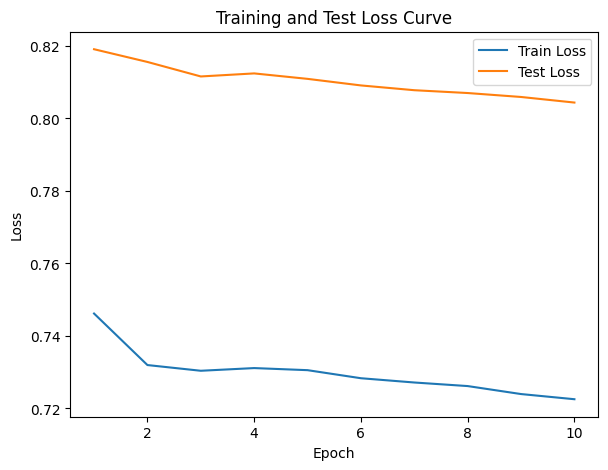

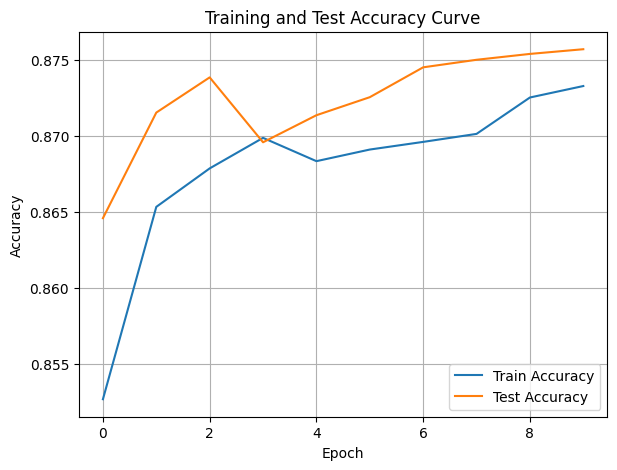

./saved_models/model_10.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [65]:
DTEmlp8b.train_DTE()

Training Process:   0%|          | 0/150 [00:00<?, ?it/s]

Epoch [1/150], Train F1:0.4939949660728881, Train Loss: 1.1247, Train Acc: 0.3929, Test F1:0.5564230469045699, Test Loss: 1.0885, Test Acc: 0.5295


Training Process:   1%|▏         | 2/150 [00:00<00:14,  9.89it/s]

Epoch [2/150], Train F1:0.48273798599043827, Train Loss: 1.1214, Train Acc: 0.3872, Test F1:0.5558631326326426, Test Loss: 1.0885, Test Acc: 0.5404


Training Process:   2%|▏         | 3/150 [00:00<00:15,  9.24it/s]

Epoch [3/150], Train F1:0.4851364035260879, Train Loss: 1.1173, Train Acc: 0.3947, Test F1:0.5703427141461587, Test Loss: 1.0863, Test Acc: 0.5518


Training Process:   3%|▎         | 4/150 [00:00<00:15,  9.47it/s]

Epoch [4/150], Train F1:0.4877029773751466, Train Loss: 1.1140, Train Acc: 0.4014, Test F1:0.5864911593368862, Test Loss: 1.0831, Test Acc: 0.5673


Training Process:   3%|▎         | 5/150 [00:00<00:17,  8.40it/s]

Epoch [5/150], Train F1:0.5000719480752003, Train Loss: 1.1100, Train Acc: 0.4142, Test F1:0.5907961174596076, Test Loss: 1.0821, Test Acc: 0.5719


Training Process:   4%|▍         | 6/150 [00:00<00:16,  8.63it/s]

Epoch [6/150], Train F1:0.5034767260012415, Train Loss: 1.1073, Train Acc: 0.4173, Test F1:0.5912628348840583, Test Loss: 1.0811, Test Acc: 0.5723


Training Process:   5%|▍         | 7/150 [00:00<00:16,  8.63it/s]

Epoch [7/150], Train F1:0.5118903280528172, Train Loss: 1.1038, Train Acc: 0.4262, Test F1:0.5908791813250446, Test Loss: 1.0771, Test Acc: 0.5782


Training Process:   5%|▌         | 8/150 [00:00<00:15,  8.89it/s]

Epoch [8/150], Train F1:0.5133253647251799, Train Loss: 1.1011, Train Acc: 0.4307, Test F1:0.5981225791752108, Test Loss: 1.0744, Test Acc: 0.5881


Training Process:   6%|▌         | 9/150 [00:00<00:15,  9.15it/s]

Epoch [9/150], Train F1:0.5184035357548039, Train Loss: 1.0973, Train Acc: 0.4369, Test F1:0.6042743221690591, Test Loss: 1.0730, Test Acc: 0.5925


Training Process:   7%|▋         | 10/150 [00:01<00:15,  9.05it/s]

Epoch [10/150], Train F1:0.5235320934599574, Train Loss: 1.0926, Train Acc: 0.4450, Test F1:0.6099539429736667, Test Loss: 1.0713, Test Acc: 0.5968


Training Process:   7%|▋         | 11/150 [00:01<00:15,  9.08it/s]

Epoch [11/150], Train F1:0.5301017139464892, Train Loss: 1.0890, Train Acc: 0.4537, Test F1:0.612646930065628, Test Loss: 1.0703, Test Acc: 0.6009


Training Process:   8%|▊         | 12/150 [00:01<00:15,  8.99it/s]

Epoch [12/150], Train F1:0.5358597223234971, Train Loss: 1.0858, Train Acc: 0.4595, Test F1:0.6143519840066541, Test Loss: 1.0684, Test Acc: 0.6037


Training Process:   9%|▊         | 13/150 [00:01<00:15,  8.90it/s]

Epoch [13/150], Train F1:0.5409806244719334, Train Loss: 1.0825, Train Acc: 0.4655, Test F1:0.6202363096714505, Test Loss: 1.0662, Test Acc: 0.6096


Training Process:   9%|▉         | 14/150 [00:01<00:15,  8.86it/s]

Epoch [14/150], Train F1:0.5450246654317328, Train Loss: 1.0797, Train Acc: 0.4711, Test F1:0.6233896958573282, Test Loss: 1.0640, Test Acc: 0.6141


Training Process:  10%|█         | 15/150 [00:01<00:17,  7.81it/s]

Epoch [15/150], Train F1:0.5495218326954197, Train Loss: 1.0769, Train Acc: 0.4770, Test F1:0.6277700526084036, Test Loss: 1.0613, Test Acc: 0.6191


Training Process:  11%|█         | 16/150 [00:01<00:17,  7.75it/s]

Epoch [16/150], Train F1:0.5538088713661232, Train Loss: 1.0741, Train Acc: 0.4813, Test F1:0.6321695042203209, Test Loss: 1.0596, Test Acc: 0.6234


Training Process:  11%|█▏        | 17/150 [00:01<00:17,  7.69it/s]

Epoch [17/150], Train F1:0.5582817127257079, Train Loss: 1.0711, Train Acc: 0.4865, Test F1:0.6344114438278005, Test Loss: 1.0590, Test Acc: 0.6254


Training Process:  12%|█▏        | 18/150 [00:02<00:17,  7.65it/s]

Epoch [18/150], Train F1:0.5624814573957321, Train Loss: 1.0675, Train Acc: 0.4921, Test F1:0.6383864449275999, Test Loss: 1.0582, Test Acc: 0.6280


Training Process:  13%|█▎        | 19/150 [00:02<00:17,  7.61it/s]

Epoch [19/150], Train F1:0.5662850986550046, Train Loss: 1.0644, Train Acc: 0.4955, Test F1:0.6417691924418382, Test Loss: 1.0556, Test Acc: 0.6320


Training Process:  13%|█▎        | 20/150 [00:02<00:16,  7.66it/s]

Epoch [20/150], Train F1:0.5722461650523571, Train Loss: 1.0605, Train Acc: 0.5030, Test F1:0.6449772161721057, Test Loss: 1.0536, Test Acc: 0.6356


Training Process:  14%|█▍        | 21/150 [00:02<00:16,  7.70it/s]

Epoch [21/150], Train F1:0.5774599661777899, Train Loss: 1.0569, Train Acc: 0.5090, Test F1:0.6497823582308199, Test Loss: 1.0518, Test Acc: 0.6407


Training Process:  15%|█▍        | 22/150 [00:02<00:17,  7.52it/s]

Epoch [22/150], Train F1:0.5813045387263259, Train Loss: 1.0538, Train Acc: 0.5139, Test F1:0.6580327662173646, Test Loss: 1.0495, Test Acc: 0.6479


Training Process:  16%|█▌        | 24/150 [00:03<00:19,  6.49it/s]

Epoch [23/150], Train F1:0.5867591854430046, Train Loss: 1.0501, Train Acc: 0.5206, Test F1:0.6646781610541722, Test Loss: 1.0474, Test Acc: 0.6543
Epoch [24/150], Train F1:0.5919808774463508, Train Loss: 1.0469, Train Acc: 0.5259, Test F1:0.6729235082954687, Test Loss: 1.0450, Test Acc: 0.6613


Training Process:  17%|█▋        | 26/150 [00:03<00:19,  6.37it/s]

Epoch [25/150], Train F1:0.598132203828098, Train Loss: 1.0435, Train Acc: 0.5324, Test F1:0.6789697138291085, Test Loss: 1.0431, Test Acc: 0.6669
Epoch [26/150], Train F1:0.6025529065838255, Train Loss: 1.0401, Train Acc: 0.5384, Test F1:0.6839685992867234, Test Loss: 1.0415, Test Acc: 0.6714


Training Process:  19%|█▊        | 28/150 [00:03<00:19,  6.25it/s]

Epoch [27/150], Train F1:0.6066252605654047, Train Loss: 1.0373, Train Acc: 0.5423, Test F1:0.6907121263817125, Test Loss: 1.0394, Test Acc: 0.6777
Epoch [28/150], Train F1:0.6125788309010516, Train Loss: 1.0339, Train Acc: 0.5484, Test F1:0.6967399915475547, Test Loss: 1.0369, Test Acc: 0.6834


Training Process:  20%|██        | 30/150 [00:03<00:19,  6.22it/s]

Epoch [29/150], Train F1:0.6170280088986053, Train Loss: 1.0306, Train Acc: 0.5543, Test F1:0.7015744653978709, Test Loss: 1.0350, Test Acc: 0.6883
Epoch [30/150], Train F1:0.6221003481126336, Train Loss: 1.0274, Train Acc: 0.5600, Test F1:0.7064034157284785, Test Loss: 1.0331, Test Acc: 0.6928


Training Process:  21%|██▏       | 32/150 [00:04<00:18,  6.33it/s]

Epoch [31/150], Train F1:0.6255843255452402, Train Loss: 1.0245, Train Acc: 0.5645, Test F1:0.7099956829873727, Test Loss: 1.0308, Test Acc: 0.6968
Epoch [32/150], Train F1:0.6291610155369356, Train Loss: 1.0216, Train Acc: 0.5692, Test F1:0.7144210895801716, Test Loss: 1.0290, Test Acc: 0.7013


Training Process:  23%|██▎       | 34/150 [00:04<00:18,  6.24it/s]

Epoch [33/150], Train F1:0.6334400762081785, Train Loss: 1.0186, Train Acc: 0.5741, Test F1:0.7181869198443904, Test Loss: 1.0270, Test Acc: 0.7055
Epoch [34/150], Train F1:0.637602958209897, Train Loss: 1.0153, Train Acc: 0.5792, Test F1:0.7214280407210497, Test Loss: 1.0251, Test Acc: 0.7092


Training Process:  24%|██▍       | 36/150 [00:04<00:17,  6.52it/s]

Epoch [35/150], Train F1:0.641637954791268, Train Loss: 1.0124, Train Acc: 0.5844, Test F1:0.725258171291126, Test Loss: 1.0234, Test Acc: 0.7131
Epoch [36/150], Train F1:0.6454019915926733, Train Loss: 1.0092, Train Acc: 0.5895, Test F1:0.7297478875408115, Test Loss: 1.0214, Test Acc: 0.7173


Training Process:  25%|██▍       | 37/150 [00:05<00:18,  5.97it/s]

Epoch [37/150], Train F1:0.6502099177623714, Train Loss: 1.0059, Train Acc: 0.5950, Test F1:0.732937032174234, Test Loss: 1.0193, Test Acc: 0.7208


Training Process:  25%|██▌       | 38/150 [00:05<00:19,  5.72it/s]

Epoch [38/150], Train F1:0.6540430388766226, Train Loss: 1.0029, Train Acc: 0.5998, Test F1:0.7351773691768791, Test Loss: 1.0170, Test Acc: 0.7235


Training Process:  26%|██▌       | 39/150 [00:05<00:20,  5.38it/s]

Epoch [39/150], Train F1:0.6577196678079207, Train Loss: 0.9999, Train Acc: 0.6038, Test F1:0.7365176317930437, Test Loss: 1.0146, Test Acc: 0.7259


Training Process:  27%|██▋       | 40/150 [00:05<00:20,  5.32it/s]

Epoch [40/150], Train F1:0.6617596747155589, Train Loss: 0.9970, Train Acc: 0.6088, Test F1:0.7377894693799665, Test Loss: 1.0125, Test Acc: 0.7282


Training Process:  27%|██▋       | 41/150 [00:05<00:20,  5.34it/s]

Epoch [41/150], Train F1:0.6651001408611011, Train Loss: 0.9945, Train Acc: 0.6128, Test F1:0.740953699390118, Test Loss: 1.0104, Test Acc: 0.7315


Training Process:  28%|██▊       | 42/150 [00:06<00:23,  4.66it/s]

Epoch [42/150], Train F1:0.6695702338771232, Train Loss: 0.9914, Train Acc: 0.6173, Test F1:0.7436511964721347, Test Loss: 1.0082, Test Acc: 0.7344


Training Process:  29%|██▊       | 43/150 [00:06<00:22,  4.74it/s]

Epoch [43/150], Train F1:0.6737207276606785, Train Loss: 0.9884, Train Acc: 0.6217, Test F1:0.7467851243351198, Test Loss: 1.0064, Test Acc: 0.7376


Training Process:  29%|██▉       | 44/150 [00:06<00:22,  4.78it/s]

Epoch [44/150], Train F1:0.6765934892128075, Train Loss: 0.9858, Train Acc: 0.6252, Test F1:0.7494777173299734, Test Loss: 1.0042, Test Acc: 0.7404


Training Process:  30%|███       | 45/150 [00:06<00:22,  4.74it/s]

Epoch [45/150], Train F1:0.6803053569348648, Train Loss: 0.9829, Train Acc: 0.6298, Test F1:0.7523086777149187, Test Loss: 1.0023, Test Acc: 0.7433


Epoch [46/150], Train F1:0.6835123621552673, Train Loss: 0.9800, Train Acc: 0.6338, Test F1:0.7547359800203076, Test Loss: 1.0005, Test Acc: 0.7459


Training Process:  31%|███▏      | 47/150 [00:07<00:20,  5.04it/s]

Epoch [47/150], Train F1:0.6873634508909557, Train Loss: 0.9770, Train Acc: 0.6382, Test F1:0.7570483250501198, Test Loss: 0.9987, Test Acc: 0.7484


Training Process:  32%|███▏      | 48/150 [00:07<00:20,  5.03it/s]

Epoch [48/150], Train F1:0.6911437413945329, Train Loss: 0.9741, Train Acc: 0.6422, Test F1:0.7590019257008174, Test Loss: 0.9967, Test Acc: 0.7506


Training Process:  33%|███▎      | 49/150 [00:07<00:20,  4.91it/s]

Epoch [49/150], Train F1:0.6943800469532869, Train Loss: 0.9716, Train Acc: 0.6456, Test F1:0.7598842859150625, Test Loss: 0.9947, Test Acc: 0.7520


Training Process:  33%|███▎      | 50/150 [00:07<00:20,  4.80it/s]

Epoch [50/150], Train F1:0.6975865937158278, Train Loss: 0.9691, Train Acc: 0.6491, Test F1:0.7612110576012567, Test Loss: 0.9927, Test Acc: 0.7536


Training Process:  34%|███▍      | 51/150 [00:08<00:23,  4.21it/s]

Epoch [51/150], Train F1:0.7001313602587615, Train Loss: 0.9668, Train Acc: 0.6521, Test F1:0.7636567406649182, Test Loss: 0.9907, Test Acc: 0.7559


Training Process:  35%|███▍      | 52/150 [00:08<00:24,  4.00it/s]

Epoch [52/150], Train F1:0.7030060623365795, Train Loss: 0.9642, Train Acc: 0.6555, Test F1:0.76553827436136, Test Loss: 0.9887, Test Acc: 0.7579


Training Process:  35%|███▌      | 53/150 [00:08<00:22,  4.22it/s]

Epoch [53/150], Train F1:0.7056838474208105, Train Loss: 0.9618, Train Acc: 0.6587, Test F1:0.7680139337928623, Test Loss: 0.9870, Test Acc: 0.7603


Training Process:  36%|███▌      | 54/150 [00:08<00:21,  4.45it/s]

Epoch [54/150], Train F1:0.7081277210743245, Train Loss: 0.9592, Train Acc: 0.6619, Test F1:0.7694376082234472, Test Loss: 0.9852, Test Acc: 0.7619


Training Process:  37%|███▋      | 55/150 [00:09<00:20,  4.53it/s]

Epoch [55/150], Train F1:0.7105045937682278, Train Loss: 0.9566, Train Acc: 0.6649, Test F1:0.7717349336894906, Test Loss: 0.9835, Test Acc: 0.7642


Training Process:  38%|███▊      | 57/150 [00:09<00:18,  4.97it/s]

Epoch [56/150], Train F1:0.7129685476351441, Train Loss: 0.9542, Train Acc: 0.6680, Test F1:0.7738722962991947, Test Loss: 0.9815, Test Acc: 0.7664
Epoch [57/150], Train F1:0.7152654345147326, Train Loss: 0.9516, Train Acc: 0.6709, Test F1:0.7761326472455854, Test Loss: 0.9797, Test Acc: 0.7686


Training Process:  39%|███▊      | 58/150 [00:09<00:17,  5.18it/s]

Epoch [58/150], Train F1:0.7177023185462353, Train Loss: 0.9492, Train Acc: 0.6737, Test F1:0.7777672535248817, Test Loss: 0.9779, Test Acc: 0.7703


Training Process:  39%|███▉      | 59/150 [00:09<00:19,  4.66it/s]

Epoch [59/150], Train F1:0.7208409628330371, Train Loss: 0.9466, Train Acc: 0.6774, Test F1:0.7797350264765702, Test Loss: 0.9762, Test Acc: 0.7722


Training Process:  40%|████      | 60/150 [00:10<00:19,  4.70it/s]

Epoch [60/150], Train F1:0.7232073597051751, Train Loss: 0.9443, Train Acc: 0.6801, Test F1:0.7816296519082269, Test Loss: 0.9744, Test Acc: 0.7741


Training Process:  41%|████      | 61/150 [00:10<00:19,  4.63it/s]

Epoch [61/150], Train F1:0.7253800339065052, Train Loss: 0.9419, Train Acc: 0.6829, Test F1:0.7834551452720036, Test Loss: 0.9727, Test Acc: 0.7760


Training Process:  41%|████▏     | 62/150 [00:10<00:18,  4.70it/s]

Epoch [62/150], Train F1:0.7275973446700256, Train Loss: 0.9397, Train Acc: 0.6853, Test F1:0.7847879762255446, Test Loss: 0.9708, Test Acc: 0.7774


Training Process:  42%|████▏     | 63/150 [00:10<00:18,  4.67it/s]

Epoch [63/150], Train F1:0.7299397694985983, Train Loss: 0.9373, Train Acc: 0.6882, Test F1:0.7855285593893663, Test Loss: 0.9689, Test Acc: 0.7784


Training Process:  43%|████▎     | 64/150 [00:10<00:18,  4.67it/s]

Epoch [64/150], Train F1:0.7322396295422742, Train Loss: 0.9351, Train Acc: 0.6908, Test F1:0.7873206483405305, Test Loss: 0.9672, Test Acc: 0.7802


Training Process:  43%|████▎     | 65/150 [00:11<00:19,  4.39it/s]

Epoch [65/150], Train F1:0.7346381820355085, Train Loss: 0.9327, Train Acc: 0.6936, Test F1:0.7890524684708602, Test Loss: 0.9656, Test Acc: 0.7820


Training Process:  44%|████▍     | 66/150 [00:11<00:21,  3.86it/s]

Epoch [66/150], Train F1:0.7368752851276692, Train Loss: 0.9305, Train Acc: 0.6963, Test F1:0.7900360412516247, Test Loss: 0.9640, Test Acc: 0.7831


Training Process:  45%|████▍     | 67/150 [00:11<00:22,  3.77it/s]

Epoch [67/150], Train F1:0.7390441072390554, Train Loss: 0.9284, Train Acc: 0.6988, Test F1:0.7911587267363404, Test Loss: 0.9623, Test Acc: 0.7843


Training Process:  45%|████▌     | 68/150 [00:12<00:27,  2.99it/s]

Epoch [68/150], Train F1:0.740819956102872, Train Loss: 0.9262, Train Acc: 0.7012, Test F1:0.7922464149346126, Test Loss: 0.9606, Test Acc: 0.7855


Training Process:  46%|████▌     | 69/150 [00:12<00:26,  3.06it/s]

Epoch [69/150], Train F1:0.7425567988023271, Train Loss: 0.9241, Train Acc: 0.7033, Test F1:0.7934650773801591, Test Loss: 0.9589, Test Acc: 0.7868


Training Process:  47%|████▋     | 70/150 [00:13<00:29,  2.72it/s]

Epoch [70/150], Train F1:0.744283809525697, Train Loss: 0.9221, Train Acc: 0.7053, Test F1:0.794115143875675, Test Loss: 0.9571, Test Acc: 0.7877


Training Process:  47%|████▋     | 71/150 [00:13<00:29,  2.70it/s]

Epoch [71/150], Train F1:0.74596830412561, Train Loss: 0.9201, Train Acc: 0.7075, Test F1:0.7951107064977848, Test Loss: 0.9555, Test Acc: 0.7888


Training Process:  48%|████▊     | 72/150 [00:13<00:31,  2.51it/s]

Epoch [72/150], Train F1:0.7479477020460549, Train Loss: 0.9181, Train Acc: 0.7096, Test F1:0.7960770433037037, Test Loss: 0.9538, Test Acc: 0.7899


Training Process:  49%|████▊     | 73/150 [00:14<00:32,  2.40it/s]

Epoch [73/150], Train F1:0.7493563779017601, Train Loss: 0.9163, Train Acc: 0.7112, Test F1:0.7974784572148181, Test Loss: 0.9523, Test Acc: 0.7913


Training Process:  49%|████▉     | 74/150 [00:14<00:34,  2.22it/s]

Epoch [74/150], Train F1:0.7508079826437322, Train Loss: 0.9143, Train Acc: 0.7132, Test F1:0.7988388193562144, Test Loss: 0.9507, Test Acc: 0.7927


Training Process:  50%|█████     | 75/150 [00:15<00:34,  2.17it/s]

Epoch [75/150], Train F1:0.7526518611806721, Train Loss: 0.9123, Train Acc: 0.7154, Test F1:0.7995203191955402, Test Loss: 0.9491, Test Acc: 0.7936


Training Process:  51%|█████     | 76/150 [00:15<00:35,  2.06it/s]

Epoch [76/150], Train F1:0.7540157028577744, Train Loss: 0.9104, Train Acc: 0.7172, Test F1:0.8005190933253701, Test Loss: 0.9475, Test Acc: 0.7947


Training Process:  51%|█████▏    | 77/150 [00:16<00:35,  2.09it/s]

Epoch [77/150], Train F1:0.7552632320110394, Train Loss: 0.9088, Train Acc: 0.7185, Test F1:0.801780842296087, Test Loss: 0.9463, Test Acc: 0.7960


Training Process:  52%|█████▏    | 78/150 [00:16<00:31,  2.27it/s]

Epoch [78/150], Train F1:0.7568801596194932, Train Loss: 0.9070, Train Acc: 0.7206, Test F1:0.8030076481539327, Test Loss: 0.9447, Test Acc: 0.7972


Training Process:  53%|█████▎    | 79/150 [00:16<00:27,  2.57it/s]

Epoch [79/150], Train F1:0.7584492268659458, Train Loss: 0.9051, Train Acc: 0.7226, Test F1:0.8039189205395313, Test Loss: 0.9432, Test Acc: 0.7982


Training Process:  53%|█████▎    | 80/150 [00:17<00:23,  2.98it/s]

Epoch [80/150], Train F1:0.7598361560979496, Train Loss: 0.9033, Train Acc: 0.7243, Test F1:0.8050841352119215, Test Loss: 0.9418, Test Acc: 0.7994


Training Process:  54%|█████▍    | 81/150 [00:17<00:20,  3.42it/s]

Epoch [81/150], Train F1:0.7611153996678457, Train Loss: 0.9015, Train Acc: 0.7261, Test F1:0.8060813224098209, Test Loss: 0.9404, Test Acc: 0.8004


Training Process:  55%|█████▍    | 82/150 [00:17<00:17,  3.80it/s]

Epoch [82/150], Train F1:0.762476654087871, Train Loss: 0.8997, Train Acc: 0.7278, Test F1:0.8069173877973685, Test Loss: 0.9390, Test Acc: 0.8013


Training Process:  55%|█████▌    | 83/150 [00:17<00:17,  3.89it/s]

Epoch [83/150], Train F1:0.7640718362383977, Train Loss: 0.8978, Train Acc: 0.7297, Test F1:0.8079988620538712, Test Loss: 0.9376, Test Acc: 0.8024


Training Process:  56%|█████▌    | 84/150 [00:18<00:15,  4.14it/s]

Epoch [84/150], Train F1:0.7654207403676421, Train Loss: 0.8961, Train Acc: 0.7315, Test F1:0.8090526772943007, Test Loss: 0.9362, Test Acc: 0.8035


Training Process:  57%|█████▋    | 85/150 [00:18<00:15,  4.20it/s]

Epoch [85/150], Train F1:0.7665429724231716, Train Loss: 0.8943, Train Acc: 0.7330, Test F1:0.8100798828295381, Test Loss: 0.9348, Test Acc: 0.8046


Training Process:  57%|█████▋    | 86/150 [00:18<00:15,  4.15it/s]

Epoch [86/150], Train F1:0.7679111126343803, Train Loss: 0.8926, Train Acc: 0.7347, Test F1:0.8110814754803517, Test Loss: 0.9333, Test Acc: 0.8056


Training Process:  58%|█████▊    | 87/150 [00:18<00:15,  4.19it/s]

Epoch [87/150], Train F1:0.7690849581033972, Train Loss: 0.8908, Train Acc: 0.7362, Test F1:0.8115207204586612, Test Loss: 0.9318, Test Acc: 0.8063


Training Process:  59%|█████▊    | 88/150 [00:18<00:14,  4.33it/s]

Epoch [88/150], Train F1:0.7704891325234927, Train Loss: 0.8891, Train Acc: 0.7380, Test F1:0.8123246163476536, Test Loss: 0.9303, Test Acc: 0.8072


Training Process:  59%|█████▉    | 89/150 [00:19<00:14,  4.25it/s]

Epoch [89/150], Train F1:0.7718766328641443, Train Loss: 0.8874, Train Acc: 0.7397, Test F1:0.8130174749743339, Test Loss: 0.9288, Test Acc: 0.8079


Training Process:  60%|██████    | 90/150 [00:19<00:15,  3.85it/s]

Epoch [90/150], Train F1:0.7730573839910372, Train Loss: 0.8858, Train Acc: 0.7410, Test F1:0.8138159405734323, Test Loss: 0.9273, Test Acc: 0.8087


Training Process:  61%|██████    | 91/150 [00:19<00:18,  3.26it/s]

Epoch [91/150], Train F1:0.7744273198580499, Train Loss: 0.8841, Train Acc: 0.7427, Test F1:0.8144755051932526, Test Loss: 0.9259, Test Acc: 0.8094


Training Process:  61%|██████▏   | 92/150 [00:20<00:17,  3.31it/s]

Epoch [92/150], Train F1:0.7756541886211168, Train Loss: 0.8824, Train Acc: 0.7441, Test F1:0.8153577045996326, Test Loss: 0.9246, Test Acc: 0.8104


Training Process:  62%|██████▏   | 93/150 [00:20<00:18,  3.03it/s]

Epoch [93/150], Train F1:0.7766963514296003, Train Loss: 0.8811, Train Acc: 0.7453, Test F1:0.8162196476703731, Test Loss: 0.9232, Test Acc: 0.8113


Training Process:  63%|██████▎   | 94/150 [00:21<00:22,  2.50it/s]

Epoch [94/150], Train F1:0.777919731010127, Train Loss: 0.8795, Train Acc: 0.7468, Test F1:0.8170620251001416, Test Loss: 0.9220, Test Acc: 0.8121


Training Process:  63%|██████▎   | 95/150 [00:21<00:23,  2.35it/s]

Epoch [95/150], Train F1:0.7786803802714339, Train Loss: 0.8782, Train Acc: 0.7479, Test F1:0.8178854964951541, Test Loss: 0.9207, Test Acc: 0.8130


Training Process:  64%|██████▍   | 96/150 [00:22<00:22,  2.42it/s]

Epoch [96/150], Train F1:0.7795275930231406, Train Loss: 0.8768, Train Acc: 0.7489, Test F1:0.8186906921049095, Test Loss: 0.9195, Test Acc: 0.8138


Training Process:  65%|██████▍   | 97/150 [00:22<00:20,  2.53it/s]

Epoch [97/150], Train F1:0.7806627714660584, Train Loss: 0.8752, Train Acc: 0.7504, Test F1:0.8194782144393177, Test Loss: 0.9182, Test Acc: 0.8147


Training Process:  65%|██████▌   | 98/150 [00:22<00:21,  2.39it/s]

Epoch [98/150], Train F1:0.7814898068128721, Train Loss: 0.8738, Train Acc: 0.7515, Test F1:0.8202486397799783, Test Loss: 0.9170, Test Acc: 0.8155


Training Process:  66%|██████▌   | 99/150 [00:23<00:23,  2.14it/s]

Epoch [99/150], Train F1:0.7824983295067093, Train Loss: 0.8723, Train Acc: 0.7528, Test F1:0.820893126890669, Test Loss: 0.9157, Test Acc: 0.8161


Training Process:  67%|██████▋   | 100/150 [00:23<00:23,  2.13it/s]

Epoch [100/150], Train F1:0.7834197756651404, Train Loss: 0.8710, Train Acc: 0.7539, Test F1:0.8211737001756161, Test Loss: 0.9144, Test Acc: 0.8166


Training Process:  67%|██████▋   | 101/150 [00:24<00:23,  2.11it/s]

Epoch [101/150], Train F1:0.7842187849487603, Train Loss: 0.8697, Train Acc: 0.7549, Test F1:0.8214487162577951, Test Loss: 0.9130, Test Acc: 0.8171


Training Process:  68%|██████▊   | 102/150 [00:24<00:23,  2.01it/s]

Epoch [102/150], Train F1:0.7854366116901185, Train Loss: 0.8682, Train Acc: 0.7564, Test F1:0.8219554608207492, Test Loss: 0.9117, Test Acc: 0.8176


Training Process:  69%|██████▊   | 103/150 [00:25<00:23,  1.98it/s]

Epoch [103/150], Train F1:0.7862493500492675, Train Loss: 0.8670, Train Acc: 0.7574, Test F1:0.8224519349313734, Test Loss: 0.9105, Test Acc: 0.8181


Training Process:  69%|██████▉   | 104/150 [00:26<00:23,  1.92it/s]

Epoch [104/150], Train F1:0.7871874774819717, Train Loss: 0.8656, Train Acc: 0.7586, Test F1:0.8229384477794889, Test Loss: 0.9093, Test Acc: 0.8187


Training Process:  70%|███████   | 105/150 [00:26<00:23,  1.88it/s]

Epoch [105/150], Train F1:0.7880812977074824, Train Loss: 0.8642, Train Acc: 0.7597, Test F1:0.8235180081124619, Test Loss: 0.9081, Test Acc: 0.8192


Training Process:  71%|███████   | 106/150 [00:27<00:24,  1.80it/s]

Epoch [106/150], Train F1:0.7890404951066791, Train Loss: 0.8628, Train Acc: 0.7608, Test F1:0.8241876984258155, Test Loss: 0.9070, Test Acc: 0.8200


Training Process:  71%|███████▏  | 107/150 [00:27<00:25,  1.71it/s]

Epoch [107/150], Train F1:0.7898242172106439, Train Loss: 0.8616, Train Acc: 0.7618, Test F1:0.8247203342830677, Test Loss: 0.9058, Test Acc: 0.8206


Training Process:  72%|███████▏  | 108/150 [00:28<00:25,  1.62it/s]

Epoch [108/150], Train F1:0.7904412284045514, Train Loss: 0.8604, Train Acc: 0.7626, Test F1:0.8249439691070182, Test Loss: 0.9046, Test Acc: 0.8210


Training Process:  73%|███████▎  | 109/150 [00:29<00:27,  1.48it/s]

Epoch [109/150], Train F1:0.7913686173333258, Train Loss: 0.8591, Train Acc: 0.7638, Test F1:0.8253835432323053, Test Loss: 0.9033, Test Acc: 0.8214


Training Process:  73%|███████▎  | 110/150 [00:29<00:26,  1.51it/s]

Epoch [110/150], Train F1:0.792187567011019, Train Loss: 0.8577, Train Acc: 0.7649, Test F1:0.8258147968750656, Test Loss: 0.9021, Test Acc: 0.8219


Training Process:  74%|███████▍  | 111/150 [00:30<00:25,  1.55it/s]

Epoch [111/150], Train F1:0.7931185332168675, Train Loss: 0.8564, Train Acc: 0.7660, Test F1:0.826119141966479, Test Loss: 0.9008, Test Acc: 0.8223


Training Process:  75%|███████▍  | 112/150 [00:31<00:22,  1.66it/s]

Epoch [112/150], Train F1:0.7940738834272361, Train Loss: 0.8551, Train Acc: 0.7672, Test F1:0.8265138486298105, Test Loss: 0.8996, Test Acc: 0.8228


Training Process:  75%|███████▌  | 113/150 [00:31<00:20,  1.79it/s]

Epoch [113/150], Train F1:0.7948867443071188, Train Loss: 0.8538, Train Acc: 0.7683, Test F1:0.8271128081411043, Test Loss: 0.8985, Test Acc: 0.8235


Training Process:  76%|███████▌  | 114/150 [00:32<00:18,  1.90it/s]

Epoch [114/150], Train F1:0.7957433193238911, Train Loss: 0.8525, Train Acc: 0.7693, Test F1:0.8275854471989659, Test Loss: 0.8973, Test Acc: 0.8240


Training Process:  77%|███████▋  | 115/150 [00:32<00:16,  2.10it/s]

Epoch [115/150], Train F1:0.7965796953142448, Train Loss: 0.8514, Train Acc: 0.7701, Test F1:0.8278633630449487, Test Loss: 0.8961, Test Acc: 0.8244


Training Process:  77%|███████▋  | 116/150 [00:32<00:14,  2.36it/s]

Epoch [116/150], Train F1:0.7974778779206309, Train Loss: 0.8502, Train Acc: 0.7711, Test F1:0.828249502770314, Test Loss: 0.8950, Test Acc: 0.8248


Training Process:  78%|███████▊  | 117/150 [00:33<00:13,  2.42it/s]

Epoch [117/150], Train F1:0.79839181521691, Train Loss: 0.8489, Train Acc: 0.7723, Test F1:0.8286997342673683, Test Loss: 0.8938, Test Acc: 0.8254


Training Process:  79%|███████▊  | 118/150 [00:33<00:14,  2.24it/s]

Epoch [118/150], Train F1:0.7992274475823745, Train Loss: 0.8478, Train Acc: 0.7733, Test F1:0.8290717527525664, Test Loss: 0.8928, Test Acc: 0.8258


Training Process:  79%|███████▉  | 119/150 [00:34<00:15,  1.98it/s]

Epoch [119/150], Train F1:0.7999076598042768, Train Loss: 0.8466, Train Acc: 0.7742, Test F1:0.8296168166059289, Test Loss: 0.8917, Test Acc: 0.8263


Training Process:  80%|████████  | 120/150 [00:34<00:15,  1.90it/s]

Epoch [120/150], Train F1:0.80085299829593, Train Loss: 0.8453, Train Acc: 0.7753, Test F1:0.8301522889810883, Test Loss: 0.8906, Test Acc: 0.8269


Training Process:  81%|████████  | 121/150 [00:35<00:15,  1.88it/s]

Epoch [121/150], Train F1:0.8016707110143406, Train Loss: 0.8441, Train Acc: 0.7763, Test F1:0.830678421120372, Test Loss: 0.8895, Test Acc: 0.8275


Training Process:  81%|████████▏ | 122/150 [00:35<00:15,  1.86it/s]

Epoch [122/150], Train F1:0.8025630025931004, Train Loss: 0.8429, Train Acc: 0.7774, Test F1:0.831195455558102, Test Loss: 0.8885, Test Acc: 0.8280


Training Process:  82%|████████▏ | 123/150 [00:36<00:14,  1.86it/s]

Epoch [123/150], Train F1:0.8031721074551831, Train Loss: 0.8420, Train Acc: 0.7781, Test F1:0.831617086187643, Test Loss: 0.8874, Test Acc: 0.8284


Training Process:  83%|████████▎ | 124/150 [00:36<00:13,  1.97it/s]

Epoch [124/150], Train F1:0.8038428440840906, Train Loss: 0.8410, Train Acc: 0.7787, Test F1:0.8320129083820633, Test Loss: 0.8864, Test Acc: 0.8289


Training Process:  83%|████████▎ | 125/150 [00:37<00:12,  1.98it/s]

Epoch [125/150], Train F1:0.8043989387280267, Train Loss: 0.8400, Train Acc: 0.7794, Test F1:0.8324022406692106, Test Loss: 0.8853, Test Acc: 0.8294


Training Process:  84%|████████▍ | 126/150 [00:37<00:11,  2.14it/s]

Epoch [126/150], Train F1:0.8052550390792305, Train Loss: 0.8387, Train Acc: 0.7805, Test F1:0.8327852413696636, Test Loss: 0.8843, Test Acc: 0.8298


Training Process:  85%|████████▍ | 127/150 [00:38<00:10,  2.27it/s]

Epoch [127/150], Train F1:0.8057139231910465, Train Loss: 0.8378, Train Acc: 0.7811, Test F1:0.8330784168603861, Test Loss: 0.8832, Test Acc: 0.8302


Training Process:  85%|████████▌ | 128/150 [00:38<00:09,  2.29it/s]

Epoch [128/150], Train F1:0.8064218734144876, Train Loss: 0.8367, Train Acc: 0.7819, Test F1:0.8335507293067437, Test Loss: 0.8822, Test Acc: 0.8307


Training Process:  86%|████████▌ | 129/150 [00:39<00:09,  2.18it/s]

Epoch [129/150], Train F1:0.8069551080879304, Train Loss: 0.8357, Train Acc: 0.7826, Test F1:0.8339331033711199, Test Loss: 0.8813, Test Acc: 0.8311


Training Process:  87%|████████▋ | 130/150 [00:39<00:09,  2.19it/s]

Epoch [130/150], Train F1:0.8076636396924368, Train Loss: 0.8346, Train Acc: 0.7835, Test F1:0.8342918774843611, Test Loss: 0.8802, Test Acc: 0.8315


Training Process:  87%|████████▋ | 131/150 [00:39<00:08,  2.28it/s]

Epoch [131/150], Train F1:0.808458840401411, Train Loss: 0.8334, Train Acc: 0.7845, Test F1:0.8346450466009367, Test Loss: 0.8792, Test Acc: 0.8319


Training Process:  88%|████████▊ | 132/150 [00:40<00:07,  2.25it/s]

Epoch [132/150], Train F1:0.8091280293410661, Train Loss: 0.8324, Train Acc: 0.7853, Test F1:0.8349295873171217, Test Loss: 0.8782, Test Acc: 0.8322


Training Process:  89%|████████▊ | 133/150 [00:40<00:07,  2.13it/s]

Epoch [133/150], Train F1:0.8096364093680882, Train Loss: 0.8315, Train Acc: 0.7860, Test F1:0.8353688896785418, Test Loss: 0.8773, Test Acc: 0.8327


Training Process:  89%|████████▉ | 134/150 [00:41<00:07,  2.10it/s]

Epoch [134/150], Train F1:0.8102481756876919, Train Loss: 0.8304, Train Acc: 0.7868, Test F1:0.8358012997155432, Test Loss: 0.8763, Test Acc: 0.8331


Training Process:  90%|█████████ | 135/150 [00:41<00:07,  2.13it/s]

Epoch [135/150], Train F1:0.8110805670318403, Train Loss: 0.8293, Train Acc: 0.7878, Test F1:0.8362269785283092, Test Loss: 0.8754, Test Acc: 0.8336


Training Process:  91%|█████████ | 136/150 [00:42<00:06,  2.05it/s]

Epoch [136/150], Train F1:0.8117526628480504, Train Loss: 0.8282, Train Acc: 0.7886, Test F1:0.8365684168567752, Test Loss: 0.8745, Test Acc: 0.8339


Training Process:  91%|█████████▏| 137/150 [00:42<00:06,  1.95it/s]

Epoch [137/150], Train F1:0.8123802240250668, Train Loss: 0.8273, Train Acc: 0.7894, Test F1:0.8368885227440551, Test Loss: 0.8735, Test Acc: 0.8343


Training Process:  92%|█████████▏| 138/150 [00:43<00:06,  1.89it/s]

Epoch [138/150], Train F1:0.812887338352775, Train Loss: 0.8264, Train Acc: 0.7901, Test F1:0.8371433980625226, Test Loss: 0.8726, Test Acc: 0.8346


Training Process:  93%|█████████▎| 139/150 [00:44<00:05,  1.93it/s]

Epoch [139/150], Train F1:0.8133161888182028, Train Loss: 0.8255, Train Acc: 0.7906, Test F1:0.8374703745118816, Test Loss: 0.8716, Test Acc: 0.8349


Training Process:  93%|█████████▎| 140/150 [00:44<00:05,  1.87it/s]

Epoch [140/150], Train F1:0.8138418818832243, Train Loss: 0.8245, Train Acc: 0.7912, Test F1:0.8378677831813746, Test Loss: 0.8708, Test Acc: 0.8353


Training Process:  94%|█████████▍| 141/150 [00:45<00:04,  1.83it/s]

Epoch [141/150], Train F1:0.8143084374216085, Train Loss: 0.8237, Train Acc: 0.7918, Test F1:0.8382592794173529, Test Loss: 0.8699, Test Acc: 0.8358


Training Process:  95%|█████████▍| 142/150 [00:45<00:04,  1.73it/s]

Epoch [142/150], Train F1:0.8149085993336616, Train Loss: 0.8228, Train Acc: 0.7924, Test F1:0.8385555520019533, Test Loss: 0.8689, Test Acc: 0.8361


Training Process:  95%|█████████▌| 143/150 [00:46<00:04,  1.72it/s]

Epoch [143/150], Train F1:0.8153931503420272, Train Loss: 0.8219, Train Acc: 0.7930, Test F1:0.8390099271692882, Test Loss: 0.8681, Test Acc: 0.8366


Training Process:  96%|█████████▌| 144/150 [00:46<00:03,  1.71it/s]

Epoch [144/150], Train F1:0.8158970496186374, Train Loss: 0.8210, Train Acc: 0.7935, Test F1:0.8392385661462428, Test Loss: 0.8671, Test Acc: 0.8368


Training Process:  97%|█████████▋| 145/150 [00:47<00:03,  1.59it/s]

Epoch [145/150], Train F1:0.8164547920139731, Train Loss: 0.8201, Train Acc: 0.7943, Test F1:0.8396089445082051, Test Loss: 0.8662, Test Acc: 0.8372


Training Process:  97%|█████████▋| 146/150 [00:48<00:02,  1.71it/s]

Epoch [146/150], Train F1:0.8172279400574464, Train Loss: 0.8192, Train Acc: 0.7951, Test F1:0.8399740092432866, Test Loss: 0.8654, Test Acc: 0.8376


Training Process:  98%|█████████▊| 147/150 [00:48<00:01,  1.95it/s]

Epoch [147/150], Train F1:0.8177538951241277, Train Loss: 0.8182, Train Acc: 0.7958, Test F1:0.8401910326591141, Test Loss: 0.8645, Test Acc: 0.8379


Training Process:  99%|█████████▊| 148/150 [00:48<00:00,  2.17it/s]

Epoch [148/150], Train F1:0.818332583615493, Train Loss: 0.8174, Train Acc: 0.7966, Test F1:0.8405468577651397, Test Loss: 0.8636, Test Acc: 0.8382


Training Process:  99%|█████████▉| 149/150 [00:49<00:00,  2.38it/s]

Epoch [149/150], Train F1:0.8188888623329859, Train Loss: 0.8165, Train Acc: 0.7973, Test F1:0.840827296021874, Test Loss: 0.8627, Test Acc: 0.8385


Training Process: 100%|██████████| 150/150 [00:49<00:00,  3.03it/s]

Epoch [150/150], Train F1:0.8194819224507903, Train Loss: 0.8156, Train Acc: 0.7979, Test F1:0.8411038540851704, Test Loss: 0.8619, Test Acc: 0.8388
Total Epochs: 150
Train loss start: 1.1440871953964233, Train loss end: 0.8396021127700806
Highest Mean Train Accuracy (over epoch): 0.7979285714285714
Test loss start: 1.0927486419677734, Test loss end: 0.7273548245429993
Highest Mean Test Accuracy (over epoch): 0.8387905092592594


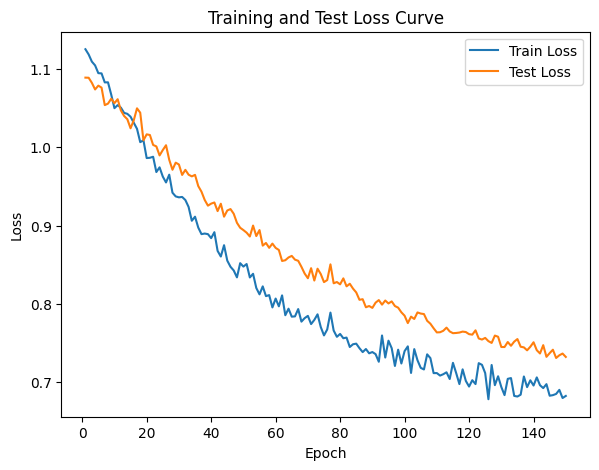

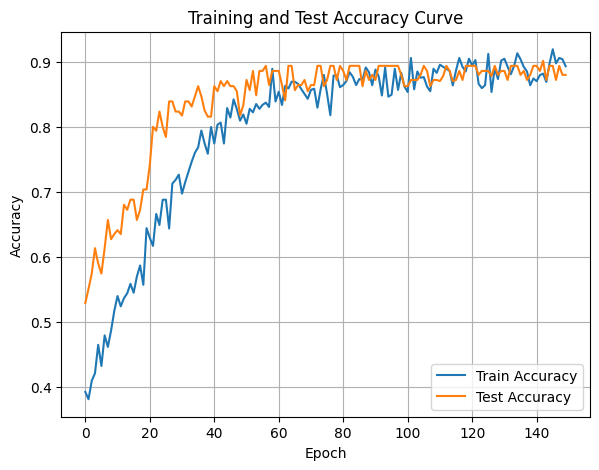

In [66]:
DTEmlp8b.train_single_model()

Randomly initializing 8 models
Training Model with id 1
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.07it/s]

Epoch [1/10], Train F1:0.46681824286425294, Train Loss: 1.0601, Train Acc: 0.4244, Test F1:0.44562125849879464, Test Loss: 1.0917, Test Acc: 0.3880
Epoch [2/10], Train F1:0.48481790318525014, Train Loss: 1.0559, Train Acc: 0.4469, Test F1:0.4560763221923421, Test Loss: 1.0894, Test Acc: 0.4036


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.34it/s]

Epoch [3/10], Train F1:0.48608807148315575, Train Loss: 1.0570, Train Acc: 0.4477, Test F1:0.45974425113879597, Test Loss: 1.0906, Test Acc: 0.4103
Epoch [4/10], Train F1:0.4858295356065204, Train Loss: 1.0543, Train Acc: 0.4502, Test F1:0.46685732986155576, Test Loss: 1.0892, Test Acc: 0.4145


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.75it/s]

Epoch [5/10], Train F1:0.48903026348386025, Train Loss: 1.0539, Train Acc: 0.4542, Test F1:0.4818507879319019, Test Loss: 1.0874, Test Acc: 0.4292
Epoch [6/10], Train F1:0.49633622387380144, Train Loss: 1.0493, Train Acc: 0.4640, Test F1:0.4958222957495704, Test Loss: 1.0826, Test Acc: 0.4547


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.99it/s]

Epoch [7/10], Train F1:0.5038881876785403, Train Loss: 1.0455, Train Acc: 0.4718, Test F1:0.5083210837204354, Test Loss: 1.0791, Test Acc: 0.4732
Epoch [8/10], Train F1:0.5112214304541873, Train Loss: 1.0413, Train Acc: 0.4806, Test F1:0.5150098526967861, Test Loss: 1.0770, Test Acc: 0.4851


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.12it/s]


Epoch [9/10], Train F1:0.5157106449895674, Train Loss: 1.0381, Train Acc: 0.4869, Test F1:0.5211142380461885, Test Loss: 1.0756, Test Acc: 0.4929
Epoch [10/10], Train F1:0.5233645520648306, Train Loss: 1.0357, Train Acc: 0.4951, Test F1:0.5261806651606982, Test Loss: 1.0733, Test Acc: 0.5012
Total Epochs: 10
Train loss start: 1.0779043436050415, Train loss end: 0.985234260559082
Highest Mean Train Accuracy (over epoch): 0.49511904761904757
Test loss start: 1.1031265258789062, Test loss end: 1.0479143857955933
Highest mean Test Accuracy (over epoch): 0.5012152777777777


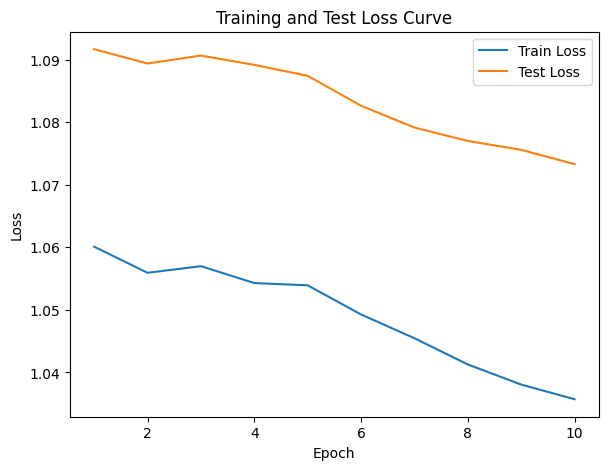

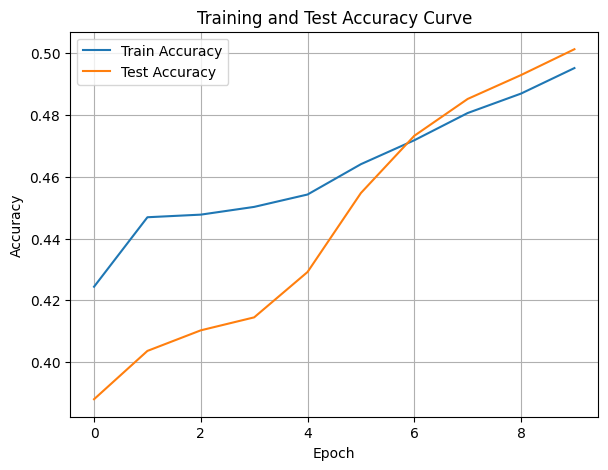

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.44it/s]

Epoch [1/10], Train F1:0.3097160759204493, Train Loss: 1.1200, Train Acc: 0.3190, Test F1:0.24711970644984999, Test Loss: 1.0834, Test Acc: 0.3194
Epoch [2/10], Train F1:0.33302767696191066, Train Loss: 1.1171, Train Acc: 0.3353, Test F1:0.29582867753608416, Test Loss: 1.0812, Test Acc: 0.3429


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.16it/s]

Epoch [3/10], Train F1:0.33803699269348125, Train Loss: 1.1152, Train Acc: 0.3448, Test F1:0.34754633998923506, Test Loss: 1.0778, Test Acc: 0.3762
Epoch [4/10], Train F1:0.333566249556744, Train Loss: 1.1144, Train Acc: 0.3429, Test F1:0.3509959548346113, Test Loss: 1.0765, Test Acc: 0.3850


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.47it/s]

Epoch [5/10], Train F1:0.3442281773256933, Train Loss: 1.1108, Train Acc: 0.3508, Test F1:0.37840607027209894, Test Loss: 1.0740, Test Acc: 0.4012
Epoch [6/10], Train F1:0.35495666290645367, Train Loss: 1.1061, Train Acc: 0.3619, Test F1:0.4025663540743375, Test Loss: 1.0735, Test Acc: 0.4157


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.51it/s]

Epoch [7/10], Train F1:0.3668615748340769, Train Loss: 1.1021, Train Acc: 0.3721, Test F1:0.41456297749203924, Test Loss: 1.0723, Test Acc: 0.4209


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.88it/s]

Epoch [8/10], Train F1:0.37144322727322937, Train Loss: 1.0976, Train Acc: 0.3767, Test F1:0.42311580621864425, Test Loss: 1.0706, Test Acc: 0.4268


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.08it/s]


Epoch [9/10], Train F1:0.38124864689461846, Train Loss: 1.0946, Train Acc: 0.3837, Test F1:0.4358074543809562, Test Loss: 1.0684, Test Acc: 0.4379
Epoch [10/10], Train F1:0.3857379146857863, Train Loss: 1.0918, Train Acc: 0.3893, Test F1:0.46539980097403605, Test Loss: 1.0663, Test Acc: 0.4569
Total Epochs: 10
Train loss start: 1.0949442386627197, Train loss end: 0.9987310767173767
Highest Mean Train Accuracy (over epoch): 0.38928571428571423
Test loss start: 1.0921430587768555, Test loss end: 1.0588798522949219
Highest mean Test Accuracy (over epoch): 0.4569444444444445


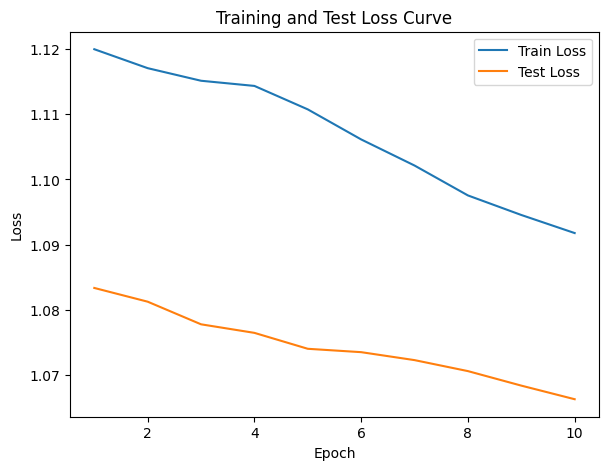

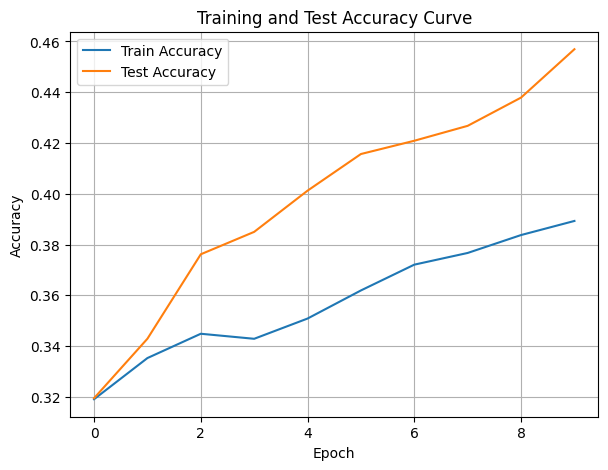

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.42it/s]

Epoch [1/10], Train F1:0.1975539165835662, Train Loss: 1.1865, Train Acc: 0.1979, Test F1:0.14554905782975955, Test Loss: 1.1365, Test Acc: 0.2370


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.22it/s]

Epoch [2/10], Train F1:0.21546300832925042, Train Loss: 1.1711, Train Acc: 0.2299, Test F1:0.14588442432245485, Test Loss: 1.1389, Test Acc: 0.2478


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.48it/s]

Epoch [3/10], Train F1:0.2150688021655764, Train Loss: 1.1665, Train Acc: 0.2294, Test F1:0.1459914561818257, Test Loss: 1.1369, Test Acc: 0.2535


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.69it/s]

Epoch [4/10], Train F1:0.2172489349157423, Train Loss: 1.1643, Train Acc: 0.2293, Test F1:0.15090172984909828, Test Loss: 1.1368, Test Acc: 0.2676


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.70it/s]

Epoch [5/10], Train F1:0.22483241485400618, Train Loss: 1.1600, Train Acc: 0.2375, Test F1:0.15529834267549927, Test Loss: 1.1353, Test Acc: 0.2792


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.73it/s]

Epoch [6/10], Train F1:0.2345692781962306, Train Loss: 1.1560, Train Acc: 0.2443, Test F1:0.158796992481203, Test Loss: 1.1330, Test Acc: 0.2882


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.72it/s]

Epoch [7/10], Train F1:0.2404760748897067, Train Loss: 1.1512, Train Acc: 0.2525, Test F1:0.16178578742576286, Test Loss: 1.1304, Test Acc: 0.2958


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.52it/s]

Epoch [8/10], Train F1:0.2493959943268311, Train Loss: 1.1483, Train Acc: 0.2599, Test F1:0.16400017826106333, Test Loss: 1.1284, Test Acc: 0.3014


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.58it/s]

Epoch [9/10], Train F1:0.25686041678426463, Train Loss: 1.1445, Train Acc: 0.2668, Test F1:0.16610815428083314, Test Loss: 1.1271, Test Acc: 0.3067


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.32it/s]


Epoch [10/10], Train F1:0.2670568457763093, Train Loss: 1.1408, Train Acc: 0.2747, Test F1:0.16856636062545574, Test Loss: 1.1248, Test Acc: 0.3094
Total Epochs: 10
Train loss start: 1.217606782913208, Train loss end: 1.116756796836853
Highest Mean Train Accuracy (over epoch): 0.2747321428571428
Test loss start: 1.1436328887939453, Test loss end: 1.111229419708252
Highest mean Test Accuracy (over epoch): 0.309375


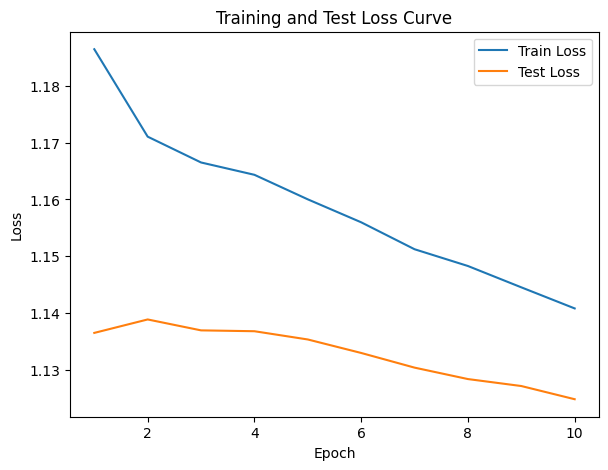

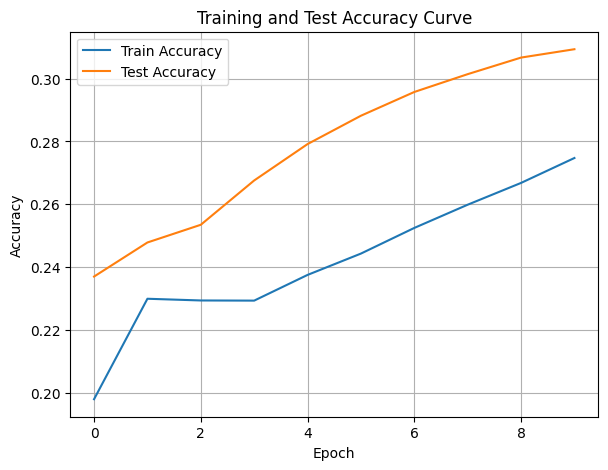

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.27098543584895946, Train Loss: 1.0643, Train Acc: 0.3815, Test F1:0.22005955984419048, Test Loss: 1.0683, Test Acc: 0.3646


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.93it/s]

Epoch [2/10], Train F1:0.27281969405653356, Train Loss: 1.0648, Train Acc: 0.3732, Test F1:0.2269461532619427, Test Loss: 1.0624, Test Acc: 0.3676


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.44it/s]

Epoch [3/10], Train F1:0.2813178484642113, Train Loss: 1.0630, Train Acc: 0.3815, Test F1:0.22919251896733617, Test Loss: 1.0582, Test Acc: 0.3686


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.22it/s]

Epoch [4/10], Train F1:0.2851819506984035, Train Loss: 1.0606, Train Acc: 0.3871, Test F1:0.2269461532619427, Test Loss: 1.0580, Test Acc: 0.3676


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.03it/s]

Epoch [5/10], Train F1:0.29192563217775025, Train Loss: 1.0570, Train Acc: 0.3939, Test F1:0.22558664470764128, Test Loss: 1.0587, Test Acc: 0.3670


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.67it/s]

Epoch [6/10], Train F1:0.29653709634451236, Train Loss: 1.0554, Train Acc: 0.3955, Test F1:0.2276113481838268, Test Loss: 1.0565, Test Acc: 0.3689


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.30it/s]

Epoch [7/10], Train F1:0.30519604429346114, Train Loss: 1.0527, Train Acc: 0.4019, Test F1:0.22848463149215031, Test Loss: 1.0547, Test Acc: 0.3692


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.20it/s]

Epoch [8/10], Train F1:0.31692290858651145, Train Loss: 1.0473, Train Acc: 0.4122, Test F1:0.2313196913002584, Test Loss: 1.0534, Test Acc: 0.3703


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.70it/s]


Epoch [9/10], Train F1:0.32628529709276743, Train Loss: 1.0455, Train Acc: 0.4174, Test F1:0.23351190945700206, Test Loss: 1.0513, Test Acc: 0.3712
Epoch [10/10], Train F1:0.3304297791682722, Train Loss: 1.0437, Train Acc: 0.4189, Test F1:0.23525766416482838, Test Loss: 1.0497, Test Acc: 0.3720
Total Epochs: 10
Train loss start: 1.0478458404541016, Train loss end: 1.0438083410263062
Highest Mean Train Accuracy (over epoch): 0.41889880952380953
Test loss start: 1.0714672803878784, Test loss end: 1.0336323976516724
Highest mean Test Accuracy (over epoch): 0.3719618055555555


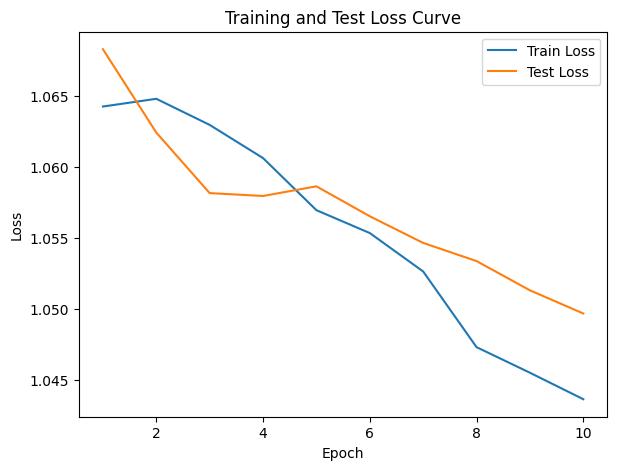

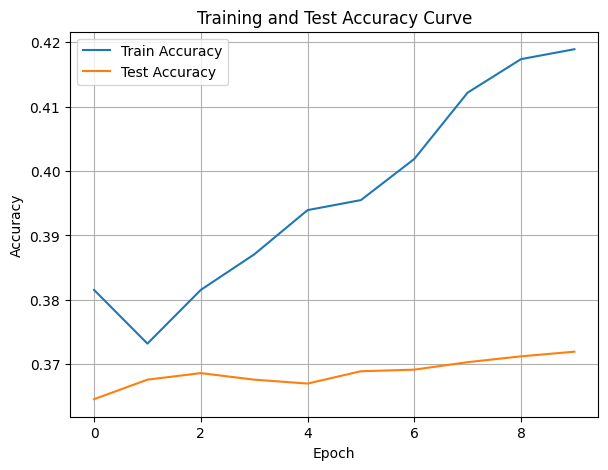

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.70it/s]

Epoch [1/10], Train F1:0.43210755465505635, Train Loss: 1.0339, Train Acc: 0.4643, Test F1:0.37747292207126004, Test Loss: 1.0495, Test Acc: 0.4253


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.30it/s]

Epoch [2/10], Train F1:0.4335450819747539, Train Loss: 1.0243, Train Acc: 0.4653, Test F1:0.3508566287513656, Test Loss: 1.0426, Test Acc: 0.4136


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.42it/s]

Epoch [3/10], Train F1:0.4573384587801925, Train Loss: 1.0225, Train Acc: 0.4830, Test F1:0.3611255556255402, Test Loss: 1.0390, Test Acc: 0.4294


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.45it/s]

Epoch [4/10], Train F1:0.46281193759335365, Train Loss: 1.0217, Train Acc: 0.4819, Test F1:0.34770994166729524, Test Loss: 1.0365, Test Acc: 0.4260


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.60it/s]

Epoch [5/10], Train F1:0.4748337214093797, Train Loss: 1.0205, Train Acc: 0.4856, Test F1:0.3453928101149871, Test Loss: 1.0351, Test Acc: 0.4271


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.84it/s]

Epoch [6/10], Train F1:0.4872659022512037, Train Loss: 1.0157, Train Acc: 0.4968, Test F1:0.3740248974475156, Test Loss: 1.0332, Test Acc: 0.4418


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.58it/s]

Epoch [7/10], Train F1:0.49703815698568266, Train Loss: 1.0136, Train Acc: 0.5060, Test F1:0.38595032954052727, Test Loss: 1.0307, Test Acc: 0.4501


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.44it/s]

Epoch [8/10], Train F1:0.5117381838416541, Train Loss: 1.0113, Train Acc: 0.5157, Test F1:0.402385628201994, Test Loss: 1.0284, Test Acc: 0.4613


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.50it/s]

Epoch [9/10], Train F1:0.5218753784127269, Train Loss: 1.0084, Train Acc: 0.5237, Test F1:0.4136400034146572, Test Loss: 1.0266, Test Acc: 0.4690


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.50it/s]


Epoch [10/10], Train F1:0.5368121249260265, Train Loss: 1.0050, Train Acc: 0.5363, Test F1:0.42118212399472404, Test Loss: 1.0248, Test Acc: 0.4737
Total Epochs: 10
Train loss start: 1.0137677192687988, Train loss end: 0.8812734484672546
Highest Mean Train Accuracy (over epoch): 0.5363095238095239
Test loss start: 1.0628429651260376, Test loss end: 1.0040111541748047
Highest mean Test Accuracy (over epoch): 0.4736979166666666


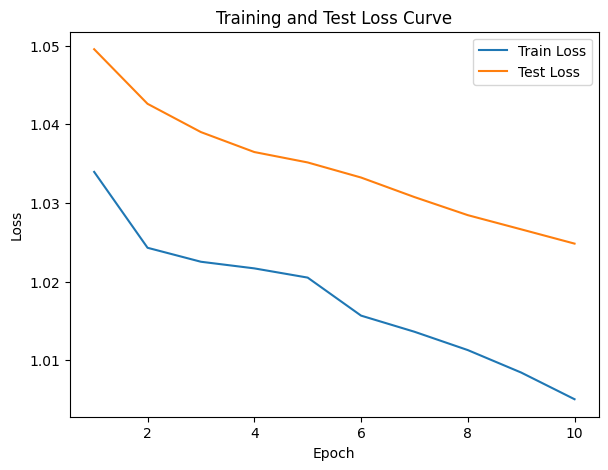

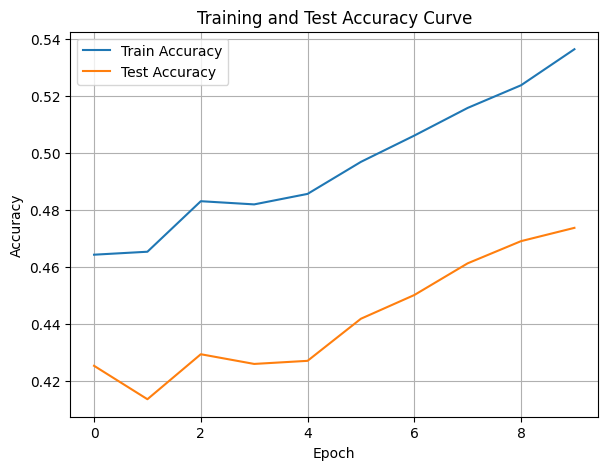

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.40it/s]

Epoch [1/10], Train F1:0.3059521710782214, Train Loss: 1.1507, Train Acc: 0.2283, Test F1:0.24742158426368951, Test Loss: 1.1126, Test Acc: 0.1884


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.99it/s]

Epoch [2/10], Train F1:0.3155728114030422, Train Loss: 1.1466, Train Acc: 0.2414, Test F1:0.22794011677159237, Test Loss: 1.1142, Test Acc: 0.1727


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.41it/s]

Epoch [3/10], Train F1:0.329481730553453, Train Loss: 1.1386, Train Acc: 0.2555, Test F1:0.22635791105019096, Test Loss: 1.1136, Test Acc: 0.1701


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.61it/s]

Epoch [4/10], Train F1:0.3378840128341958, Train Loss: 1.1372, Train Acc: 0.2606, Test F1:0.2305849585731534, Test Loss: 1.1129, Test Acc: 0.1727


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.96it/s]

Epoch [5/10], Train F1:0.3440840838042703, Train Loss: 1.1333, Train Acc: 0.2688, Test F1:0.23851112696317317, Test Loss: 1.1127, Test Acc: 0.1771


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.88it/s]

Epoch [6/10], Train F1:0.35961690278714925, Train Loss: 1.1291, Train Acc: 0.2840, Test F1:0.2756190518977769, Test Loss: 1.1094, Test Acc: 0.2086


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.65it/s]

Epoch [7/10], Train F1:0.36590024302954416, Train Loss: 1.1251, Train Acc: 0.2906, Test F1:0.3015709207659672, Test Loss: 1.1070, Test Acc: 0.2298
Epoch [8/10], Train F1:0.3752212272287178, Train Loss: 1.1216, Train Acc: 0.2989, Test F1:0.3119853856688219, Test Loss: 1.1056, Test Acc: 0.2371


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  6.97it/s]

Epoch [9/10], Train F1:0.38746422340947506, Train Loss: 1.1173, Train Acc: 0.3104, Test F1:0.339488837638675, Test Loss: 1.1036, Test Acc: 0.2608


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.66it/s]


Epoch [10/10], Train F1:0.3951418564160341, Train Loss: 1.1135, Train Acc: 0.3180, Test F1:0.355939486286019, Test Loss: 1.1017, Test Acc: 0.2766
Total Epochs: 10
Train loss start: 1.2025264501571655, Train loss end: 1.047568678855896
Highest Mean Train Accuracy (over epoch): 0.31803571428571425
Test loss start: 1.1039944887161255, Test loss end: 1.0868287086486816
Highest mean Test Accuracy (over epoch): 0.27664930555555556


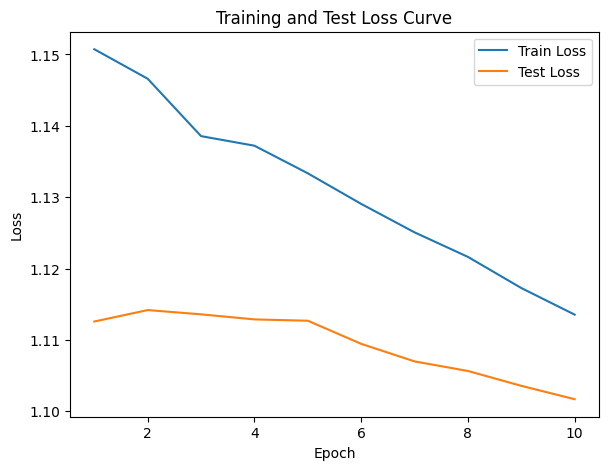

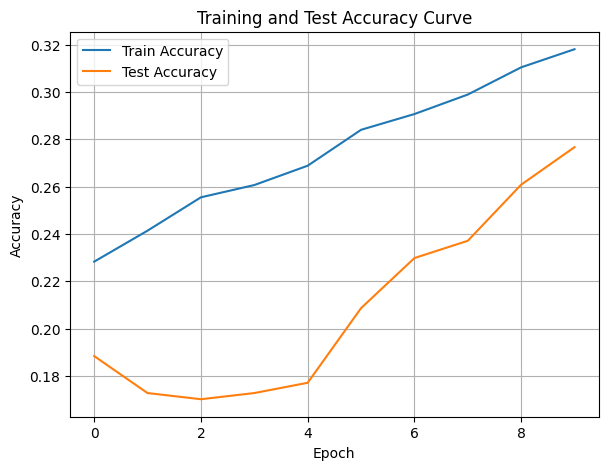

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.83it/s]

Epoch [1/10], Train F1:0.35690768655428334, Train Loss: 1.1089, Train Acc: 0.3074, Test F1:0.3741496598639456, Test Loss: 1.0906, Test Acc: 0.2786


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.60it/s]

Epoch [2/10], Train F1:0.3572185070936581, Train Loss: 1.1055, Train Acc: 0.3234, Test F1:0.4530972290539433, Test Loss: 1.0885, Test Acc: 0.3494


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.31it/s]

Epoch [3/10], Train F1:0.3573600638888573, Train Loss: 1.1035, Train Acc: 0.3212, Test F1:0.5065996228786926, Test Loss: 1.0852, Test Acc: 0.3996


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.10it/s]

Epoch [4/10], Train F1:0.36777942888395665, Train Loss: 1.1018, Train Acc: 0.3306, Test F1:0.512750745719066, Test Loss: 1.0847, Test Acc: 0.4052


Training Process:  50%|█████     | 5/10 [00:00<00:00,  5.34it/s]

Epoch [5/10], Train F1:0.3715700616767107, Train Loss: 1.1006, Train Acc: 0.3303, Test F1:0.5234219569542413, Test Loss: 1.0837, Test Acc: 0.4135


Training Process:  60%|██████    | 6/10 [00:01<00:00,  5.21it/s]

Epoch [6/10], Train F1:0.3802246134722695, Train Loss: 1.0982, Train Acc: 0.3390, Test F1:0.5536437246963561, Test Loss: 1.0814, Test Acc: 0.4482


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.74it/s]

Epoch [7/10], Train F1:0.39089550429105563, Train Loss: 1.0939, Train Acc: 0.3522, Test F1:0.5690006939874794, Test Loss: 1.0801, Test Acc: 0.4652
Epoch [8/10], Train F1:0.39999786664615833, Train Loss: 1.0917, Train Acc: 0.3586, Test F1:0.5865292335260421, Test Loss: 1.0785, Test Acc: 0.4847


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.02it/s]


Epoch [9/10], Train F1:0.4023403559313218, Train Loss: 1.0899, Train Acc: 0.3632, Test F1:0.5943106828634985, Test Loss: 1.0774, Test Acc: 0.4932
Epoch [10/10], Train F1:0.41569762000093596, Train Loss: 1.0859, Train Acc: 0.3749, Test F1:0.6050097081235295, Test Loss: 1.0755, Test Acc: 0.5089
Total Epochs: 10
Train loss start: 1.0846078395843506, Train loss end: 1.0443490743637085
Highest Mean Train Accuracy (over epoch): 0.37488095238095237
Test loss start: 1.0842112302780151, Test loss end: 1.0562794208526611
Highest mean Test Accuracy (over epoch): 0.5089409722222222


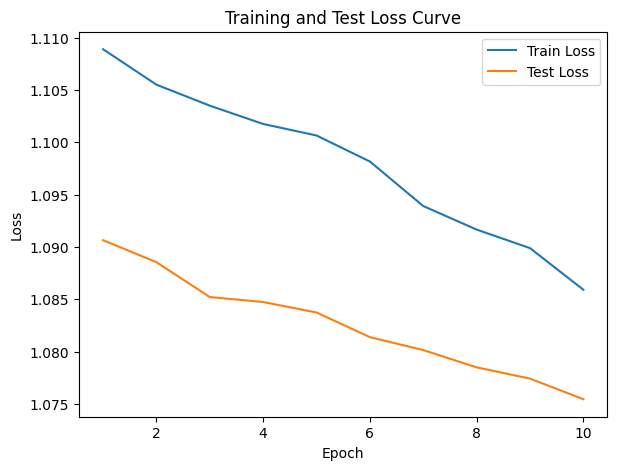

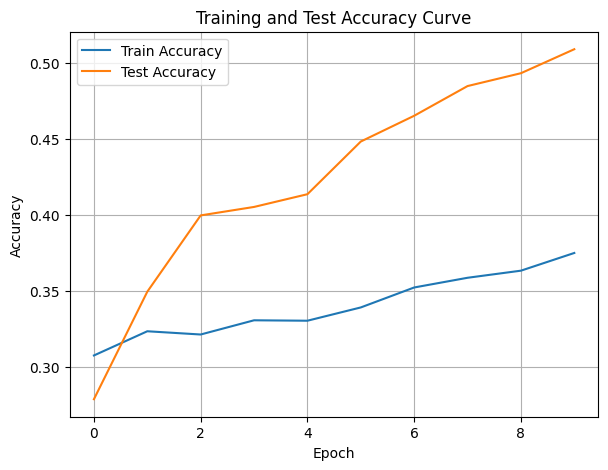

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.86it/s]

Epoch [1/10], Train F1:0.5067457232739065, Train Loss: 1.0218, Train Acc: 0.5568, Test F1:0.5300634982979837, Test Loss: 1.0750, Test Acc: 0.5530


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.32it/s]

Epoch [2/10], Train F1:0.49481656804733726, Train Loss: 1.0245, Train Acc: 0.5412, Test F1:0.5482075796520055, Test Loss: 1.0661, Test Acc: 0.5608


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.45it/s]

Epoch [3/10], Train F1:0.5044482932852739, Train Loss: 1.0235, Train Acc: 0.5495, Test F1:0.5590008423982712, Test Loss: 1.0606, Test Acc: 0.5784


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.45it/s]

Epoch [4/10], Train F1:0.5040628291754209, Train Loss: 1.0177, Train Acc: 0.5537, Test F1:0.5657254294294743, Test Loss: 1.0553, Test Acc: 0.5877


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.54it/s]

Epoch [5/10], Train F1:0.5089446533760722, Train Loss: 1.0149, Train Acc: 0.5592, Test F1:0.5699257979603876, Test Loss: 1.0516, Test Acc: 0.5960


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.11it/s]

Epoch [6/10], Train F1:0.5103034985348235, Train Loss: 1.0103, Train Acc: 0.5656, Test F1:0.5722887196540382, Test Loss: 1.0469, Test Acc: 0.6062


Training Process:  80%|████████  | 8/10 [00:01<00:00,  6.93it/s]

Epoch [7/10], Train F1:0.5150261633264682, Train Loss: 1.0069, Train Acc: 0.5699, Test F1:0.5764836886214815, Test Loss: 1.0441, Test Acc: 0.6146
Epoch [8/10], Train F1:0.5139750831243066, Train Loss: 1.0050, Train Acc: 0.5710, Test F1:0.5899391590513138, Test Loss: 1.0423, Test Acc: 0.6238


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.39it/s]


Epoch [9/10], Train F1:0.5184529390571072, Train Loss: 1.0006, Train Acc: 0.5770, Test F1:0.5946023698114205, Test Loss: 1.0390, Test Acc: 0.6317
Epoch [10/10], Train F1:0.5210763158810082, Train Loss: 0.9987, Train Acc: 0.5808, Test F1:0.6008883788638845, Test Loss: 1.0372, Test Acc: 0.6395
Total Epochs: 10
Train loss start: 1.014357328414917, Train loss end: 0.9480284452438354
Highest Mean Train Accuracy (over epoch): 0.5808333333333333
Test loss start: 1.0720198154449463, Test loss end: 1.0118592977523804
Highest mean Test Accuracy (over epoch): 0.6394965277777779


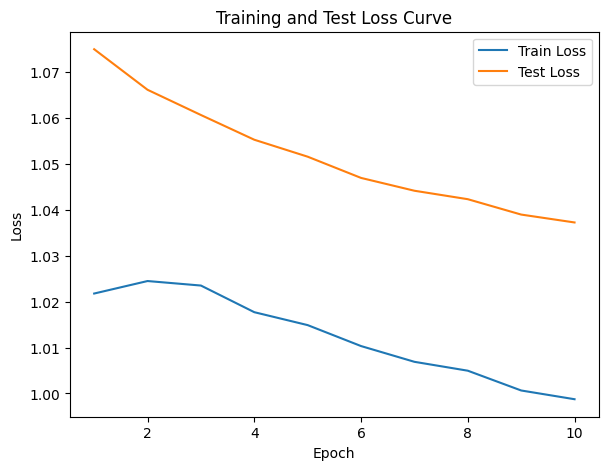

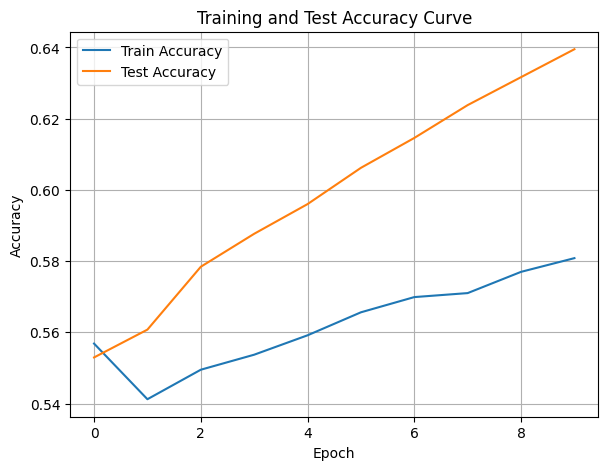

./saved_models/model_8.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  5.09it/s]

Epoch [1/10], Train F1:0.574542438324317, Train Loss: 0.9554, Train Acc: 0.6301, Test F1:0.6408675196763839, Test Loss: 1.0244, Test Acc: 0.6806


Training Process:  20%|██        | 2/10 [00:00<00:02,  3.87it/s]

Epoch [2/10], Train F1:0.5594290061779319, Train Loss: 0.9641, Train Acc: 0.6228, Test F1:0.6462710105491956, Test Loss: 1.0168, Test Acc: 0.6944


Training Process:  30%|███       | 3/10 [00:00<00:01,  4.09it/s]

Epoch [3/10], Train F1:0.5586337077260141, Train Loss: 0.9656, Train Acc: 0.6175, Test F1:0.662399170527106, Test Loss: 1.0126, Test Acc: 0.7075


Training Process:  50%|█████     | 5/10 [00:01<00:01,  4.90it/s]

Epoch [4/10], Train F1:0.5617959011458256, Train Loss: 0.9623, Train Acc: 0.6251, Test F1:0.6922880042383043, Test Loss: 1.0095, Test Acc: 0.7311
Epoch [5/10], Train F1:0.5645090669698825, Train Loss: 0.9594, Train Acc: 0.6271, Test F1:0.6792243983824836, Test Loss: 1.0056, Test Acc: 0.7253


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.21it/s]

Epoch [6/10], Train F1:0.5730294629582124, Train Loss: 0.9552, Train Acc: 0.6340, Test F1:0.6827198528146995, Test Loss: 1.0023, Test Acc: 0.7303
Epoch [7/10], Train F1:0.5775871986211116, Train Loss: 0.9539, Train Acc: 0.6343, Test F1:0.6852258038432429, Test Loss: 1.0000, Test Acc: 0.7339


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.61it/s]

Epoch [8/10], Train F1:0.5751925059035322, Train Loss: 0.9524, Train Acc: 0.6321, Test F1:0.6907729807431894, Test Loss: 0.9977, Test Acc: 0.7385
Epoch [9/10], Train F1:0.5803293110538755, Train Loss: 0.9497, Train Acc: 0.6348, Test F1:0.6965327686445753, Test Loss: 0.9961, Test Acc: 0.7430


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.11it/s]


Epoch [10/10], Train F1:0.5821826285453666, Train Loss: 0.9486, Train Acc: 0.6367, Test F1:0.7050229192362109, Test Loss: 0.9946, Test Acc: 0.7481
Total Epochs: 10
Train loss start: 0.9807031154632568, Train loss end: 0.8328332901000977
Highest Mean Train Accuracy (over epoch): 0.6366666666666667
Test loss start: 1.0180011987686157, Test loss end: 0.9715954661369324
Highest mean Test Accuracy (over epoch): 0.7480902777777778


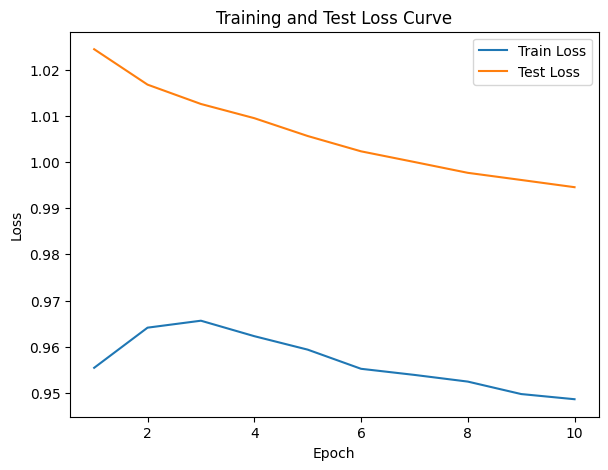

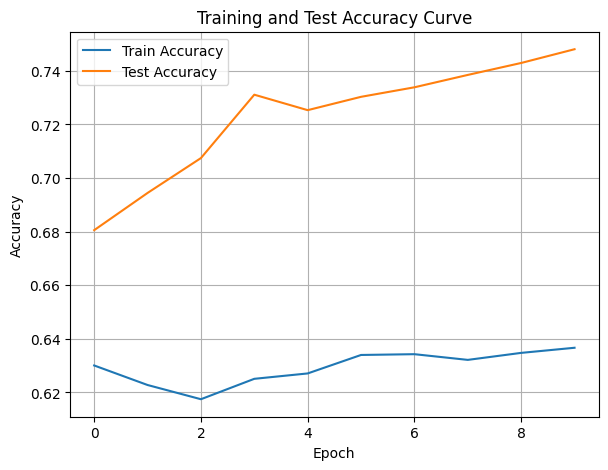

./saved_models/model_12.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 14.09it/s]

Epoch [1/10], Train F1:0.5948665495863747, Train Loss: 0.9355, Train Acc: 0.6402, Test F1:0.7211008653709746, Test Loss: 0.9768, Test Acc: 0.7769
Epoch [2/10], Train F1:0.609105502193958, Train Loss: 0.9287, Train Acc: 0.6506, Test F1:0.7276236275287743, Test Loss: 0.9677, Test Acc: 0.7808


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.90it/s]

Epoch [3/10], Train F1:0.6145314410942613, Train Loss: 0.9268, Train Acc: 0.6568, Test F1:0.7441193344807803, Test Loss: 0.9679, Test Acc: 0.7879
Epoch [4/10], Train F1:0.627701574474481, Train Loss: 0.9177, Train Acc: 0.6696, Test F1:0.7447653387714233, Test Loss: 0.9640, Test Acc: 0.7891


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.89it/s]

Epoch [5/10], Train F1:0.6282701674385284, Train Loss: 0.9131, Train Acc: 0.6749, Test F1:0.7451531909483855, Test Loss: 0.9617, Test Acc: 0.7898
Epoch [6/10], Train F1:0.6334477130925911, Train Loss: 0.9099, Train Acc: 0.6799, Test F1:0.7611572791628192, Test Loss: 0.9614, Test Acc: 0.7983
Epoch [7/10], Train F1:0.6384690221890124, Train Loss: 0.9057, Train Acc: 0.6864, Test F1:0.7665625118708114, Test Loss: 0.9606, Test Acc: 0.8011


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.57it/s]


Epoch [8/10], Train F1:0.642838423356934, Train Loss: 0.9034, Train Acc: 0.6884, Test F1:0.7745033737230638, Test Loss: 0.9588, Test Acc: 0.8069
Epoch [9/10], Train F1:0.6487334073313755, Train Loss: 0.9001, Train Acc: 0.6929, Test F1:0.7835756833217893, Test Loss: 0.9576, Test Acc: 0.8124
Epoch [10/10], Train F1:0.6498272655724788, Train Loss: 0.8981, Train Acc: 0.6937, Test F1:0.7895760459990384, Test Loss: 0.9561, Test Acc: 0.8161
Total Epochs: 10
Train loss start: 0.9615720510482788, Train loss end: 0.8003902435302734
Highest Mean Train Accuracy (over epoch): 0.6936904761904761
Test loss start: 0.9670055508613586, Test loss end: 0.9327442646026611
Highest mean Test Accuracy (over epoch): 0.8160590277777778


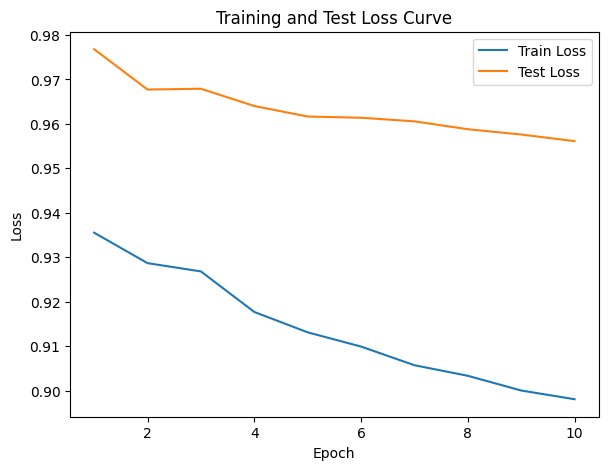

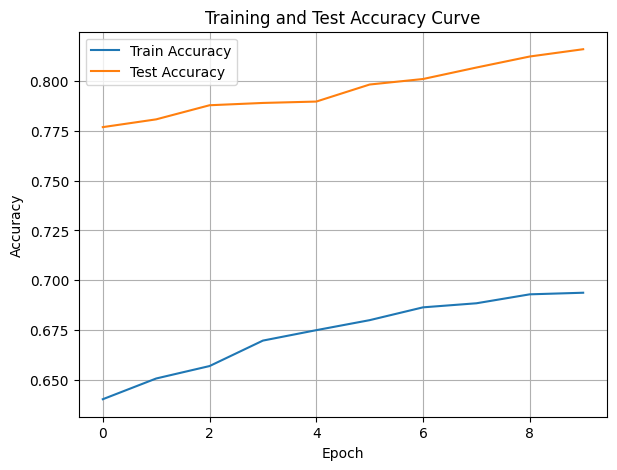

./saved_models/model_13.pth
Training Model with id 11
in multi


Epoch [1/10], Train F1:0.7164626936693604, Train Loss: 0.8634, Train Acc: 0.7488, Test F1:0.8405321941001631, Test Loss: 0.9320, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.45it/s]

Epoch [2/10], Train F1:0.7091116625331423, Train Loss: 0.8613, Train Acc: 0.7399, Test F1:0.8447329118614757, Test Loss: 0.9313, Test Acc: 0.8559
Epoch [3/10], Train F1:0.7205783394354138, Train Loss: 0.8583, Train Acc: 0.7480, Test F1:0.8474138263659127, Test Loss: 0.9335, Test Acc: 0.8562


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.21it/s]

Epoch [4/10], Train F1:0.7194670335139358, Train Loss: 0.8577, Train Acc: 0.7469, Test F1:0.8241841978684084, Test Loss: 0.9287, Test Acc: 0.8403


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.21it/s]

Epoch [5/10], Train F1:0.7249143665470165, Train Loss: 0.8573, Train Acc: 0.7491, Test F1:0.8205943137293253, Test Loss: 0.9268, Test Acc: 0.8385


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.50it/s]

Epoch [6/10], Train F1:0.7316871444202365, Train Loss: 0.8517, Train Acc: 0.7565, Test F1:0.8235797954099751, Test Loss: 0.9263, Test Acc: 0.8413


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.50it/s]

Epoch [7/10], Train F1:0.7356795357561204, Train Loss: 0.8482, Train Acc: 0.7591, Test F1:0.827241358002496, Test Loss: 0.9245, Test Acc: 0.8444


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.12it/s]

Epoch [8/10], Train F1:0.7389089034004935, Train Loss: 0.8448, Train Acc: 0.7623, Test F1:0.8246194872366381, Test Loss: 0.9219, Test Acc: 0.8428


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.85it/s]

Epoch [9/10], Train F1:0.7372668947239852, Train Loss: 0.8443, Train Acc: 0.7604, Test F1:0.827354773663603, Test Loss: 0.9197, Test Acc: 0.8450
Epoch [10/10], Train F1:0.7368455624356556, Train Loss: 0.8443, Train Acc: 0.7585, Test F1:0.8273942863200299, Test Loss: 0.9174, Test Acc: 0.8452


Total Epochs: 10
Train loss start: 0.8795768618583679, Train loss end: 0.9716024398803711
Highest Mean Train Accuracy (over epoch): 0.7622767857142858
Test loss start: 0.922763466835022, Test loss end: 0.8868252635002136
Highest mean Test Accuracy (over epoch): 0.8561921296296297


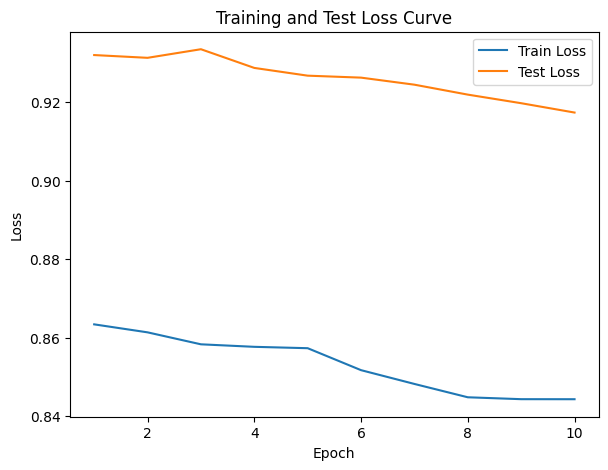

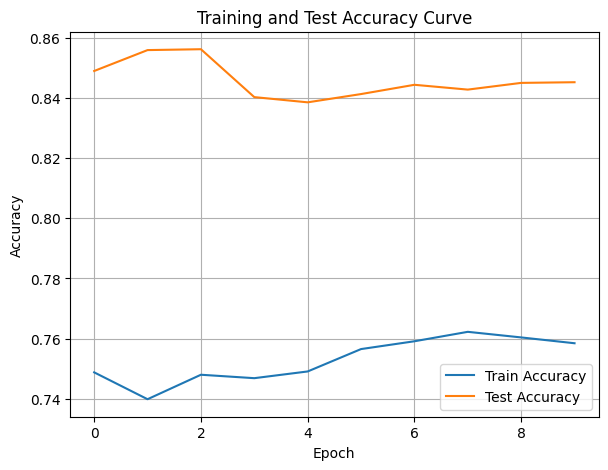

./saved_models/model_11.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.27it/s]

Epoch [1/10], Train F1:0.7396404971979827, Train Loss: 0.8355, Train Acc: 0.7667, Test F1:0.8424305409858196, Test Loss: 0.9175, Test Acc: 0.8490
Epoch [2/10], Train F1:0.7575849095567215, Train Loss: 0.8268, Train Acc: 0.7759, Test F1:0.8457001576165899, Test Loss: 0.9078, Test Acc: 0.8559


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.27it/s]

Epoch [3/10], Train F1:0.761368580911235, Train Loss: 0.8248, Train Acc: 0.7776, Test F1:0.8467858335472157, Test Loss: 0.8992, Test Acc: 0.8582


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.11it/s]

Epoch [4/10], Train F1:0.7562308923205017, Train Loss: 0.8295, Train Acc: 0.7703, Test F1:0.8473279552509019, Test Loss: 0.8966, Test Acc: 0.8594


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.11it/s]

Epoch [5/10], Train F1:0.7603879391045549, Train Loss: 0.8257, Train Acc: 0.7733, Test F1:0.8434906260779353, Test Loss: 0.8931, Test Acc: 0.8569


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.18it/s]

Epoch [6/10], Train F1:0.7628172159944565, Train Loss: 0.8235, Train Acc: 0.7752, Test F1:0.8461371128823504, Test Loss: 0.8911, Test Acc: 0.8592


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.18it/s]

Epoch [7/10], Train F1:0.7643608001687439, Train Loss: 0.8213, Train Acc: 0.7774, Test F1:0.8465386852821407, Test Loss: 0.8892, Test Acc: 0.8597


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.86it/s]

Epoch [8/10], Train F1:0.7666269525400148, Train Loss: 0.8208, Train Acc: 0.7801, Test F1:0.8486215871883548, Test Loss: 0.8884, Test Acc: 0.8604


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.68it/s]

Epoch [9/10], Train F1:0.7714814289022014, Train Loss: 0.8179, Train Acc: 0.7831, Test F1:0.8463556900326626, Test Loss: 0.8865, Test Acc: 0.8589


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.05it/s]


Epoch [10/10], Train F1:0.7738147084890117, Train Loss: 0.8168, Train Acc: 0.7847, Test F1:0.8476530082496183, Test Loss: 0.8845, Test Acc: 0.8601
Total Epochs: 10
Train loss start: 0.8543675541877747, Train loss end: 0.8931564688682556
Highest Mean Train Accuracy (over epoch): 0.7847321428571429
Test loss start: 0.9095971584320068, Test loss end: 0.8513861298561096
Highest mean Test Accuracy (over epoch): 0.8603515625


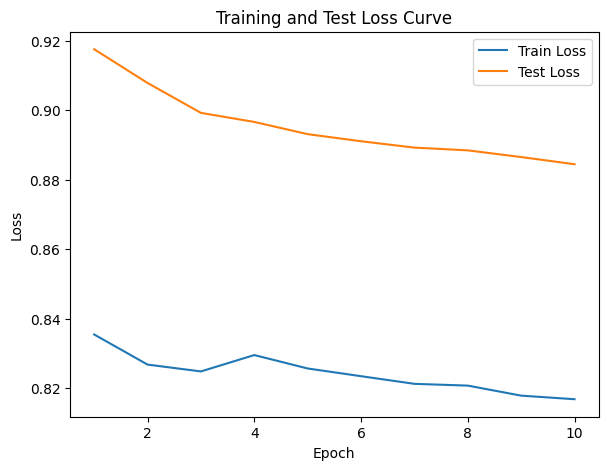

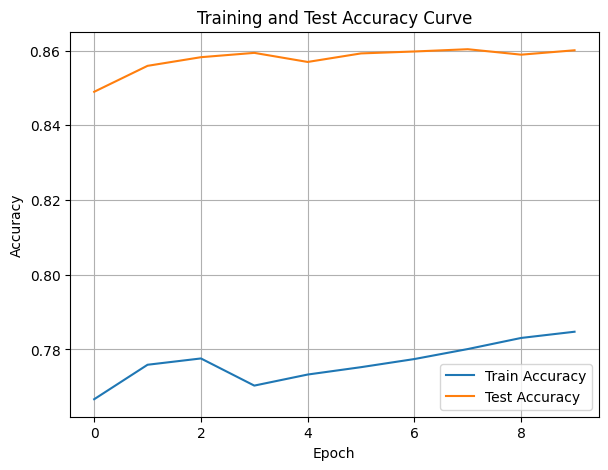

./saved_models/model_13.pth
Training Model with id 14
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.68it/s]

Epoch [1/10], Train F1:0.8280417391620368, Train Loss: 0.7817, Train Acc: 0.8289, Test F1:0.8592931124413203, Test Loss: 0.8661, Test Acc: 0.8707


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.66it/s]

Epoch [2/10], Train F1:0.8249093431626406, Train Loss: 0.7863, Train Acc: 0.8220, Test F1:0.8541430384153257, Test Loss: 0.8652, Test Acc: 0.8668


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.99it/s]

Epoch [3/10], Train F1:0.8075583235002365, Train Loss: 0.7919, Train Acc: 0.8059, Test F1:0.8524172307238872, Test Loss: 0.8661, Test Acc: 0.8655


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.99it/s]

Epoch [4/10], Train F1:0.806196978055931, Train Loss: 0.7943, Train Acc: 0.8077, Test F1:0.8550516632155843, Test Loss: 0.8688, Test Acc: 0.8652


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.20it/s]

Epoch [5/10], Train F1:0.8110842193800026, Train Loss: 0.7935, Train Acc: 0.8094, Test F1:0.8558985058706212, Test Loss: 0.8662, Test Acc: 0.8663
Epoch [6/10], Train F1:0.8132255635110508, Train Loss: 0.7886, Train Acc: 0.8144, Test F1:0.8584556738353488, Test Loss: 0.8661, Test Acc: 0.8673


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.40it/s]

Epoch [7/10], Train F1:0.8121931110439979, Train Loss: 0.7894, Train Acc: 0.8125, Test F1:0.8602704063137949, Test Loss: 0.8652, Test Acc: 0.8689


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 11.35it/s]

Epoch [8/10], Train F1:0.8101043779985577, Train Loss: 0.7875, Train Acc: 0.8118, Test F1:0.8588799608055148, Test Loss: 0.8624, Test Acc: 0.8682
Epoch [9/10], Train F1:0.8119497818410445, Train Loss: 0.7841, Train Acc: 0.8145, Test F1:0.8611871366907105, Test Loss: 0.8617, Test Acc: 0.8702


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.36it/s]

Epoch [10/10], Train F1:0.8142724312899248, Train Loss: 0.7830, Train Acc: 0.8173, Test F1:0.8630300435926368, Test Loss: 0.8606, Test Acc: 0.8718
Total Epochs: 10
Train loss start: 0.7675075531005859, Train loss end: 0.7380062937736511
Highest Mean Train Accuracy (over epoch): 0.8288690476190476
Test loss start: 0.8569983839988708, Test loss end: 0.8348508477210999
Highest mean Test Accuracy (over epoch): 0.8717881944444444


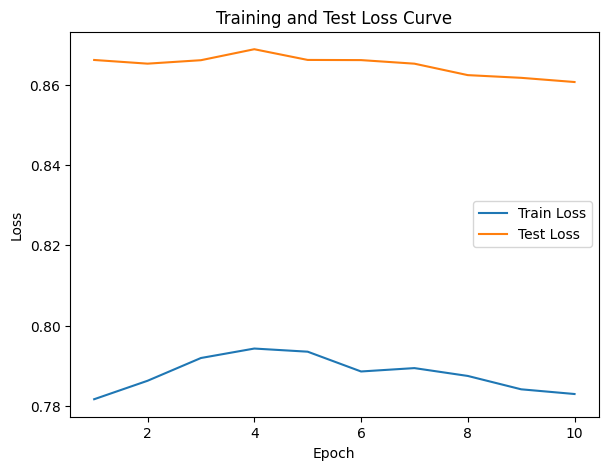

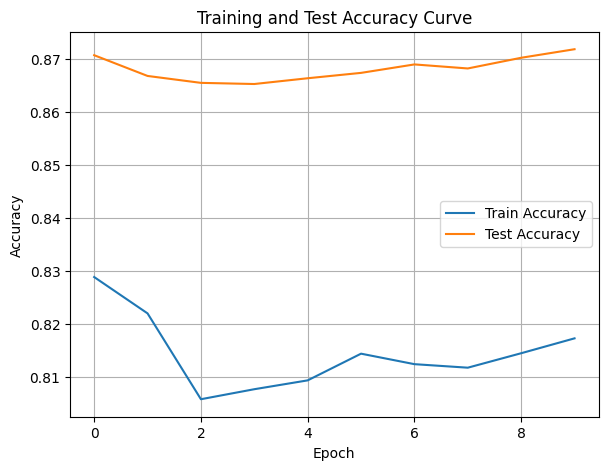

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.98it/s]

Epoch [1/10], Train F1:0.8509695072737652, Train Loss: 0.7428, Train Acc: 0.8646, Test F1:0.8795057078126853, Test Loss: 0.8486, Test Acc: 0.8863


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.09it/s]

Epoch [2/10], Train F1:0.8425244150285065, Train Loss: 0.7530, Train Acc: 0.8525, Test F1:0.8745082520542844, Test Loss: 0.8447, Test Acc: 0.8824


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.38it/s]

Epoch [3/10], Train F1:0.841002911792067, Train Loss: 0.7591, Train Acc: 0.8449, Test F1:0.8728344198838286, Test Loss: 0.8436, Test Acc: 0.8811


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.47it/s]

Epoch [4/10], Train F1:0.8405961854237717, Train Loss: 0.7571, Train Acc: 0.8430, Test F1:0.8745082520542844, Test Loss: 0.8427, Test Acc: 0.8824


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.53it/s]

Epoch [5/10], Train F1:0.8378990351379376, Train Loss: 0.7604, Train Acc: 0.8398, Test F1:0.8775110090645405, Test Loss: 0.8410, Test Acc: 0.8847


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.53it/s]

Epoch [6/10], Train F1:0.8384949814040961, Train Loss: 0.7583, Train Acc: 0.8409, Test F1:0.8761780484268521, Test Loss: 0.8404, Test Acc: 0.8837


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.75it/s]

Epoch [7/10], Train F1:0.8440192979355454, Train Loss: 0.7545, Train Acc: 0.8465, Test F1:0.8731940533522115, Test Loss: 0.8414, Test Acc: 0.8790


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.88it/s]

Epoch [8/10], Train F1:0.8428536379750284, Train Loss: 0.7558, Train Acc: 0.8427, Test F1:0.8702369161059689, Test Loss: 0.8387, Test Acc: 0.8770


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.77it/s]

Epoch [9/10], Train F1:0.842696692847098, Train Loss: 0.7559, Train Acc: 0.8415, Test F1:0.8714298325273679, Test Loss: 0.8381, Test Acc: 0.8773


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.52it/s]


Epoch [10/10], Train F1:0.8434310094078158, Train Loss: 0.7551, Train Acc: 0.8419, Test F1:0.8689747193434073, Test Loss: 0.8388, Test Acc: 0.8739
Total Epochs: 10
Train loss start: 0.7095414996147156, Train loss end: 0.7857609391212463
Highest Mean Train Accuracy (over epoch): 0.8645833333333334
Test loss start: 0.8356543779373169, Test loss end: 0.835358202457428
Highest mean Test Accuracy (over epoch): 0.8862847222222222


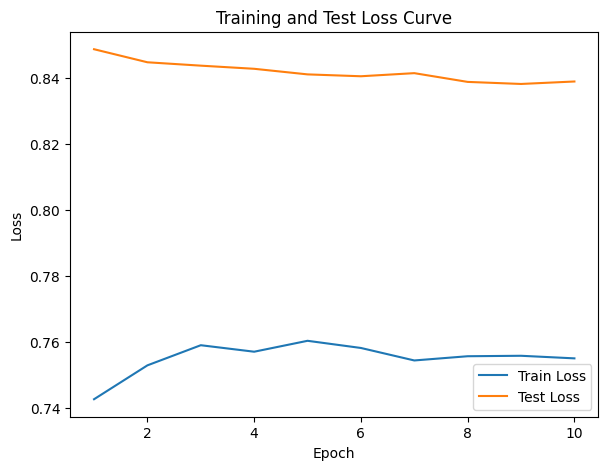

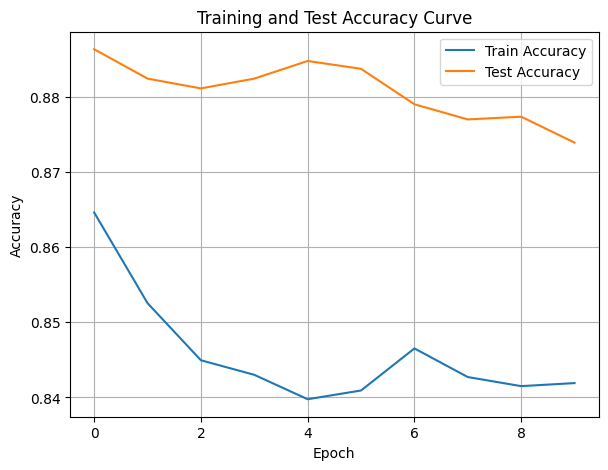

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.45it/s]

Epoch [1/10], Train F1:0.8613913606361451, Train Loss: 0.7284, Train Acc: 0.8729, Test F1:0.8795057078126853, Test Loss: 0.8163, Test Acc: 0.8863
Epoch [2/10], Train F1:0.8698217962933981, Train Loss: 0.7279, Train Acc: 0.8765, Test F1:0.8795057078126853, Test Loss: 0.8129, Test Acc: 0.8863


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.61it/s]

Epoch [3/10], Train F1:0.8668492243121575, Train Loss: 0.7327, Train Acc: 0.8696, Test F1:0.8795057078126854, Test Loss: 0.8085, Test Acc: 0.8863
Epoch [4/10], Train F1:0.8637688267168697, Train Loss: 0.7329, Train Acc: 0.8670, Test F1:0.8819911799421429, Test Loss: 0.8100, Test Acc: 0.8882


Training Process:  60%|██████    | 6/10 [00:00<00:00,  5.93it/s]

Epoch [5/10], Train F1:0.8631483961170728, Train Loss: 0.7322, Train Acc: 0.8648, Test F1:0.8775110090645405, Test Loss: 0.8094, Test Acc: 0.8847
Epoch [6/10], Train F1:0.859893905899446, Train Loss: 0.7362, Train Acc: 0.8597, Test F1:0.8711565079287494, Test Loss: 0.8067, Test Acc: 0.8798


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.29it/s]

Epoch [7/10], Train F1:0.8614816363437346, Train Loss: 0.7345, Train Acc: 0.8617, Test F1:0.8723554347059315, Test Loss: 0.8066, Test Acc: 0.8807


Training Process:  80%|████████  | 8/10 [00:01<00:00,  5.85it/s]

Epoch [8/10], Train F1:0.8560101091989698, Train Loss: 0.7364, Train Acc: 0.8563, Test F1:0.8719959766436592, Test Loss: 0.8040, Test Acc: 0.8804


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  5.30it/s]

Epoch [9/10], Train F1:0.8567690339992436, Train Loss: 0.7359, Train Acc: 0.8565, Test F1:0.8728344198838287, Test Loss: 0.8018, Test Acc: 0.8811


Training Process: 100%|██████████| 10/10 [00:01<00:00,  5.19it/s]


Epoch [10/10], Train F1:0.8569227908165156, Train Loss: 0.7352, Train Acc: 0.8562, Test F1:0.8724991652899659, Test Loss: 0.8018, Test Acc: 0.8808
Total Epochs: 10
Train loss start: 0.7218125462532043, Train loss end: 0.8282379508018494
Highest Mean Train Accuracy (over epoch): 0.8764880952380952
Test loss start: 0.7988247275352478, Test loss end: 0.791925847530365
Highest mean Test Accuracy (over epoch): 0.8882378472222222


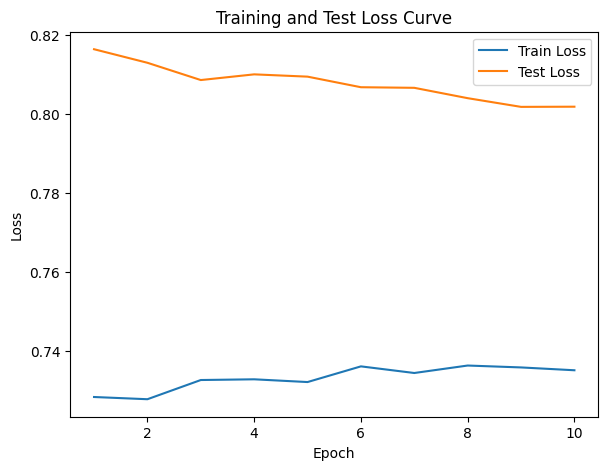

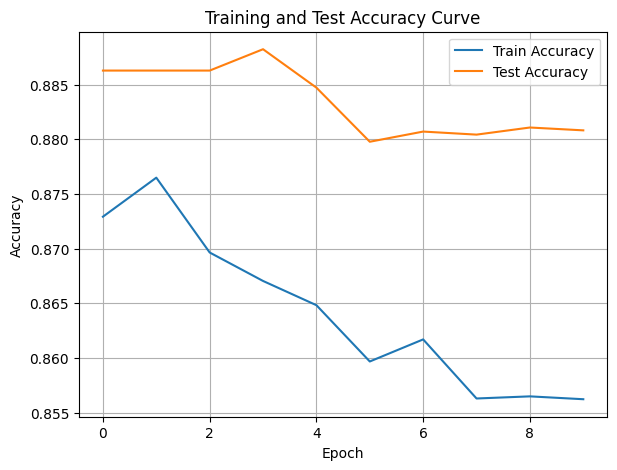

./saved_models/model_10.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [67]:
DTEmlp8b.train_DTE()

Training Process:   1%|          | 1/150 [00:00<00:26,  5.60it/s]

Epoch [1/150], Train F1:0.49500938621817736, Train Loss: 1.0302, Train Acc: 0.5173, Test F1:0.3742128596063228, Test Loss: 1.0751, Test Acc: 0.3811


Training Process:   1%|▏         | 2/150 [00:00<00:28,  5.27it/s]

Epoch [2/150], Train F1:0.523045413367994, Train Loss: 1.0208, Train Acc: 0.5443, Test F1:0.37357312037561047, Test Loss: 1.0699, Test Acc: 0.3780


Training Process:   2%|▏         | 3/150 [00:00<00:31,  4.72it/s]

Epoch [3/150], Train F1:0.5378375401478599, Train Loss: 1.0187, Train Acc: 0.5596, Test F1:0.4160191726340206, Test Loss: 1.0663, Test Acc: 0.4253


Training Process:   3%|▎         | 4/150 [00:00<00:33,  4.42it/s]

Epoch [4/150], Train F1:0.5468459496597277, Train Loss: 1.0147, Train Acc: 0.5664, Test F1:0.41654187553280353, Test Loss: 1.0645, Test Acc: 0.4225


Training Process:   3%|▎         | 5/150 [00:01<00:35,  4.09it/s]

Epoch [5/150], Train F1:0.5497837077512301, Train Loss: 1.0125, Train Acc: 0.5716, Test F1:0.4223645837121586, Test Loss: 1.0617, Test Acc: 0.4280


Training Process:   4%|▍         | 6/150 [00:01<00:33,  4.26it/s]

Epoch [6/150], Train F1:0.554461388732835, Train Loss: 1.0085, Train Acc: 0.5773, Test F1:0.44416597048176004, Test Loss: 1.0594, Test Acc: 0.4524


Training Process:   5%|▍         | 7/150 [00:01<00:32,  4.44it/s]

Epoch [7/150], Train F1:0.5574314843965922, Train Loss: 1.0050, Train Acc: 0.5840, Test F1:0.449602798965975, Test Loss: 1.0584, Test Acc: 0.4573


Training Process:   5%|▌         | 8/150 [00:01<00:34,  4.13it/s]

Epoch [8/150], Train F1:0.5630314959778571, Train Loss: 1.0024, Train Acc: 0.5897, Test F1:0.4681009300375862, Test Loss: 1.0562, Test Acc: 0.4779


Training Process:   6%|▌         | 9/150 [00:02<00:37,  3.76it/s]

Epoch [9/150], Train F1:0.562842806820434, Train Loss: 0.9996, Train Acc: 0.5907, Test F1:0.4797904280119118, Test Loss: 1.0543, Test Acc: 0.4902


Training Process:   7%|▋         | 10/150 [00:02<00:41,  3.41it/s]

Epoch [10/150], Train F1:0.5635719626084976, Train Loss: 0.9974, Train Acc: 0.5917, Test F1:0.49560530690290283, Test Loss: 1.0520, Test Acc: 0.5072


Training Process:   7%|▋         | 11/150 [00:02<00:40,  3.47it/s]

Epoch [11/150], Train F1:0.5665403240078084, Train Loss: 0.9949, Train Acc: 0.5955, Test F1:0.505224409056729, Test Loss: 1.0494, Test Acc: 0.5210


Training Process:   8%|▊         | 12/150 [00:03<00:38,  3.62it/s]

Epoch [12/150], Train F1:0.5718469132669559, Train Loss: 0.9917, Train Acc: 0.6014, Test F1:0.5145951023571906, Test Loss: 1.0470, Test Acc: 0.5336


Training Process:   9%|▊         | 13/150 [00:03<00:42,  3.22it/s]

Epoch [13/150], Train F1:0.5762538749818306, Train Loss: 0.9890, Train Acc: 0.6055, Test F1:0.5244584388113307, Test Loss: 1.0442, Test Acc: 0.5445


Training Process:   9%|▉         | 14/150 [00:03<00:40,  3.39it/s]

Epoch [14/150], Train F1:0.5793736539078385, Train Loss: 0.9861, Train Acc: 0.6090, Test F1:0.5302200577322499, Test Loss: 1.0423, Test Acc: 0.5472


Training Process:  10%|█         | 15/150 [00:03<00:37,  3.57it/s]

Epoch [15/150], Train F1:0.5852218244500881, Train Loss: 0.9825, Train Acc: 0.6151, Test F1:0.5381265793927767, Test Loss: 1.0404, Test Acc: 0.5545


Training Process:  11%|█         | 16/150 [00:04<00:37,  3.60it/s]

Epoch [16/150], Train F1:0.5881094648769235, Train Loss: 0.9797, Train Acc: 0.6182, Test F1:0.5483636162980263, Test Loss: 1.0379, Test Acc: 0.5649


Training Process:  11%|█▏        | 17/150 [00:04<00:40,  3.27it/s]

Epoch [17/150], Train F1:0.5930206098684204, Train Loss: 0.9757, Train Acc: 0.6228, Test F1:0.5551222393293251, Test Loss: 1.0363, Test Acc: 0.5708


Training Process:  12%|█▏        | 18/150 [00:04<00:42,  3.12it/s]

Epoch [18/150], Train F1:0.5980656831197737, Train Loss: 0.9723, Train Acc: 0.6274, Test F1:0.5619113131433688, Test Loss: 1.0337, Test Acc: 0.5783


Training Process:  13%|█▎        | 19/150 [00:05<00:41,  3.13it/s]

Epoch [19/150], Train F1:0.6027530788269347, Train Loss: 0.9695, Train Acc: 0.6317, Test F1:0.5692943993546182, Test Loss: 1.0313, Test Acc: 0.5872


Training Process:  13%|█▎        | 20/150 [00:05<00:43,  3.02it/s]

Epoch [20/150], Train F1:0.6078529129518874, Train Loss: 0.9667, Train Acc: 0.6356, Test F1:0.5750307463968767, Test Loss: 1.0287, Test Acc: 0.5944


Training Process:  14%|█▍        | 21/150 [00:05<00:38,  3.33it/s]

Epoch [21/150], Train F1:0.6122158386146481, Train Loss: 0.9642, Train Acc: 0.6393, Test F1:0.5839182663550645, Test Loss: 1.0269, Test Acc: 0.6026


Training Process:  15%|█▍        | 22/150 [00:06<00:35,  3.58it/s]

Epoch [22/150], Train F1:0.6171060334995488, Train Loss: 0.9612, Train Acc: 0.6429, Test F1:0.5939553800385612, Test Loss: 1.0250, Test Acc: 0.6113


Training Process:  15%|█▌        | 23/150 [00:06<00:36,  3.52it/s]

Epoch [23/150], Train F1:0.6216169601811786, Train Loss: 0.9581, Train Acc: 0.6468, Test F1:0.6009179395907085, Test Loss: 1.0225, Test Acc: 0.6192


Training Process:  16%|█▌        | 24/150 [00:06<00:34,  3.68it/s]

Epoch [24/150], Train F1:0.6252534995129675, Train Loss: 0.9553, Train Acc: 0.6503, Test F1:0.6080647146321088, Test Loss: 1.0204, Test Acc: 0.6263


Training Process:  17%|█▋        | 25/150 [00:06<00:32,  3.81it/s]

Epoch [25/150], Train F1:0.6292392454762135, Train Loss: 0.9522, Train Acc: 0.6542, Test F1:0.6149351757079496, Test Loss: 1.0179, Test Acc: 0.6327


Training Process:  17%|█▋        | 26/150 [00:07<00:30,  4.03it/s]

Epoch [26/150], Train F1:0.6335278137063517, Train Loss: 0.9494, Train Acc: 0.6577, Test F1:0.62265928664951, Test Loss: 1.0158, Test Acc: 0.6396


Training Process:  18%|█▊        | 27/150 [00:07<00:29,  4.23it/s]

Epoch [27/150], Train F1:0.6372371375097551, Train Loss: 0.9467, Train Acc: 0.6611, Test F1:0.6259814006238299, Test Loss: 1.0144, Test Acc: 0.6403


Training Process:  19%|█▊        | 28/150 [00:07<00:28,  4.28it/s]

Epoch [28/150], Train F1:0.6411018133582811, Train Loss: 0.9439, Train Acc: 0.6649, Test F1:0.6323214160362431, Test Loss: 1.0122, Test Acc: 0.6460


Training Process:  19%|█▉        | 29/150 [00:07<00:28,  4.28it/s]

Epoch [29/150], Train F1:0.6451389707160853, Train Loss: 0.9410, Train Acc: 0.6686, Test F1:0.6390991703356766, Test Loss: 1.0101, Test Acc: 0.6522


Training Process:  20%|██        | 30/150 [00:07<00:27,  4.34it/s]

Epoch [30/150], Train F1:0.649045473610001, Train Loss: 0.9385, Train Acc: 0.6721, Test F1:0.6446780971870958, Test Loss: 1.0084, Test Acc: 0.6573


Training Process:  21%|██        | 31/150 [00:08<00:29,  3.98it/s]

Epoch [31/150], Train F1:0.653054048415535, Train Loss: 0.9361, Train Acc: 0.6754, Test F1:0.6502809539737218, Test Loss: 1.0067, Test Acc: 0.6625


Training Process:  21%|██▏       | 32/150 [00:08<00:34,  3.44it/s]

Epoch [32/150], Train F1:0.6580471729562513, Train Loss: 0.9328, Train Acc: 0.6802, Test F1:0.6562402055220672, Test Loss: 1.0044, Test Acc: 0.6683


Training Process:  22%|██▏       | 33/150 [00:09<00:38,  3.06it/s]

Epoch [33/150], Train F1:0.662510421728547, Train Loss: 0.9299, Train Acc: 0.6840, Test F1:0.6611921208470409, Test Loss: 1.0026, Test Acc: 0.6725


Training Process:  23%|██▎       | 34/150 [00:09<00:43,  2.67it/s]

Epoch [34/150], Train F1:0.6653352833454667, Train Loss: 0.9277, Train Acc: 0.6858, Test F1:0.6666235052552677, Test Loss: 1.0000, Test Acc: 0.6779


Training Process:  23%|██▎       | 35/150 [00:09<00:45,  2.51it/s]

Epoch [35/150], Train F1:0.6685795330944141, Train Loss: 0.9253, Train Acc: 0.6884, Test F1:0.6711824066534132, Test Loss: 0.9979, Test Acc: 0.6822


Training Process:  24%|██▍       | 36/150 [00:10<00:43,  2.59it/s]

Epoch [36/150], Train F1:0.6709012273753193, Train Loss: 0.9231, Train Acc: 0.6904, Test F1:0.6761228968437093, Test Loss: 0.9958, Test Acc: 0.6870


Training Process:  25%|██▍       | 37/150 [00:10<00:42,  2.67it/s]

Epoch [37/150], Train F1:0.6747728711939973, Train Loss: 0.9202, Train Acc: 0.6937, Test F1:0.6801630329483925, Test Loss: 0.9935, Test Acc: 0.6912


Training Process:  25%|██▌       | 38/150 [00:11<00:41,  2.70it/s]

Epoch [38/150], Train F1:0.6784057068070671, Train Loss: 0.9176, Train Acc: 0.6971, Test F1:0.6849628445989153, Test Loss: 0.9916, Test Acc: 0.6957


Training Process:  26%|██▌       | 39/150 [00:11<00:43,  2.56it/s]

Epoch [39/150], Train F1:0.6821484024662703, Train Loss: 0.9154, Train Acc: 0.7002, Test F1:0.6889858256164407, Test Loss: 0.9896, Test Acc: 0.6997


Training Process:  27%|██▋       | 40/150 [00:11<00:40,  2.70it/s]

Epoch [40/150], Train F1:0.6850826451604252, Train Loss: 0.9129, Train Acc: 0.7027, Test F1:0.6927420464120179, Test Loss: 0.9876, Test Acc: 0.7033


Training Process:  27%|██▋       | 41/150 [00:12<00:40,  2.66it/s]

Epoch [41/150], Train F1:0.6878545069709927, Train Loss: 0.9105, Train Acc: 0.7053, Test F1:0.6963844093978737, Test Loss: 0.9857, Test Acc: 0.7068


Training Process:  28%|██▊       | 42/150 [00:12<00:42,  2.54it/s]

Epoch [42/150], Train F1:0.6905098488284654, Train Loss: 0.9084, Train Acc: 0.7074, Test F1:0.6997913274690774, Test Loss: 0.9836, Test Acc: 0.7103


Training Process:  29%|██▊       | 43/150 [00:13<00:42,  2.51it/s]

Epoch [43/150], Train F1:0.6938379746526386, Train Loss: 0.9063, Train Acc: 0.7100, Test F1:0.7034625114638162, Test Loss: 0.9817, Test Acc: 0.7141


Training Process:  29%|██▉       | 44/150 [00:13<00:42,  2.48it/s]

Epoch [44/150], Train F1:0.6965142171251844, Train Loss: 0.9040, Train Acc: 0.7125, Test F1:0.70615951703157, Test Loss: 0.9802, Test Acc: 0.7161


Training Process:  30%|███       | 45/150 [00:13<00:41,  2.51it/s]

Epoch [45/150], Train F1:0.6998031796762274, Train Loss: 0.9015, Train Acc: 0.7155, Test F1:0.7090718329343635, Test Loss: 0.9784, Test Acc: 0.7188


Training Process:  31%|███       | 46/150 [00:14<00:40,  2.55it/s]

Epoch [46/150], Train F1:0.7029152825798864, Train Loss: 0.8990, Train Acc: 0.7183, Test F1:0.7123600307320375, Test Loss: 0.9768, Test Acc: 0.7215


Training Process:  31%|███▏      | 47/150 [00:14<00:39,  2.58it/s]

Epoch [47/150], Train F1:0.7055797106259863, Train Loss: 0.8968, Train Acc: 0.7205, Test F1:0.7144555571686192, Test Loss: 0.9754, Test Acc: 0.7231


Training Process:  32%|███▏      | 48/150 [00:14<00:38,  2.64it/s]

Epoch [48/150], Train F1:0.7081921289815089, Train Loss: 0.8946, Train Acc: 0.7227, Test F1:0.7174417207725404, Test Loss: 0.9734, Test Acc: 0.7260


Training Process:  33%|███▎      | 49/150 [00:15<00:39,  2.56it/s]

Epoch [49/150], Train F1:0.710952018600243, Train Loss: 0.8924, Train Acc: 0.7252, Test F1:0.7200409449685149, Test Loss: 0.9715, Test Acc: 0.7284


Training Process:  33%|███▎      | 50/150 [00:15<00:39,  2.50it/s]

Epoch [50/150], Train F1:0.7136153142342838, Train Loss: 0.8904, Train Acc: 0.7276, Test F1:0.7225948190577615, Test Loss: 0.9695, Test Acc: 0.7310


Training Process:  34%|███▍      | 51/150 [00:16<00:40,  2.47it/s]

Epoch [51/150], Train F1:0.7162053477364545, Train Loss: 0.8882, Train Acc: 0.7301, Test F1:0.7247447605158195, Test Loss: 0.9677, Test Acc: 0.7331


Training Process:  35%|███▍      | 52/150 [00:16<00:40,  2.45it/s]

Epoch [52/150], Train F1:0.7186255533211419, Train Loss: 0.8861, Train Acc: 0.7322, Test F1:0.7269884716718615, Test Loss: 0.9663, Test Acc: 0.7349


Training Process:  35%|███▌      | 53/150 [00:17<00:38,  2.53it/s]

Epoch [53/150], Train F1:0.7214561233096833, Train Loss: 0.8841, Train Acc: 0.7346, Test F1:0.7290970834318405, Test Loss: 0.9649, Test Acc: 0.7366


Training Process:  36%|███▌      | 54/150 [00:17<00:37,  2.53it/s]

Epoch [54/150], Train F1:0.7237597466391215, Train Loss: 0.8822, Train Acc: 0.7366, Test F1:0.7312839989830042, Test Loss: 0.9633, Test Acc: 0.7384


Training Process:  37%|███▋      | 55/150 [00:17<00:36,  2.57it/s]

Epoch [55/150], Train F1:0.7263936415382886, Train Loss: 0.8799, Train Acc: 0.7389, Test F1:0.7334067305580562, Test Loss: 0.9613, Test Acc: 0.7406


Training Process:  37%|███▋      | 56/150 [00:18<00:35,  2.62it/s]

Epoch [56/150], Train F1:0.7293087181636705, Train Loss: 0.8778, Train Acc: 0.7415, Test F1:0.7355797214203864, Test Loss: 0.9597, Test Acc: 0.7425


Training Process:  38%|███▊      | 57/150 [00:18<00:34,  2.70it/s]

Epoch [57/150], Train F1:0.7315012995610467, Train Loss: 0.8760, Train Acc: 0.7431, Test F1:0.737538863506313, Test Loss: 0.9582, Test Acc: 0.7443


Training Process:  39%|███▊      | 58/150 [00:18<00:35,  2.62it/s]

Epoch [58/150], Train F1:0.7336937350984228, Train Loss: 0.8740, Train Acc: 0.7452, Test F1:0.7395659427875199, Test Loss: 0.9566, Test Acc: 0.7461


Training Process:  39%|███▉      | 59/150 [00:19<00:38,  2.35it/s]

Epoch [59/150], Train F1:0.7361766395452785, Train Loss: 0.8720, Train Acc: 0.7474, Test F1:0.7414294977111647, Test Loss: 0.9552, Test Acc: 0.7477


Training Process:  40%|████      | 60/150 [00:19<00:41,  2.15it/s]

Epoch [60/150], Train F1:0.7383317015353696, Train Loss: 0.8700, Train Acc: 0.7494, Test F1:0.7434554980240803, Test Loss: 0.9536, Test Acc: 0.7496


Training Process:  41%|████      | 61/150 [00:20<00:44,  1.99it/s]

Epoch [61/150], Train F1:0.7404444537861415, Train Loss: 0.8682, Train Acc: 0.7514, Test F1:0.7455448543309499, Test Loss: 0.9521, Test Acc: 0.7516


Training Process:  41%|████▏     | 62/150 [00:21<00:52,  1.67it/s]

Epoch [62/150], Train F1:0.742345090082105, Train Loss: 0.8667, Train Acc: 0.7529, Test F1:0.7473682420193015, Test Loss: 0.9504, Test Acc: 0.7535


Training Process:  42%|████▏     | 63/150 [00:22<00:53,  1.64it/s]

Epoch [63/150], Train F1:0.7446418209374881, Train Loss: 0.8648, Train Acc: 0.7549, Test F1:0.7494562076433352, Test Loss: 0.9488, Test Acc: 0.7556


Training Process:  43%|████▎     | 64/150 [00:22<00:53,  1.61it/s]

Epoch [64/150], Train F1:0.7466970859262775, Train Loss: 0.8631, Train Acc: 0.7566, Test F1:0.7512324970664517, Test Loss: 0.9473, Test Acc: 0.7573


Training Process:  43%|████▎     | 65/150 [00:23<00:55,  1.54it/s]

Epoch [65/150], Train F1:0.748885557630558, Train Loss: 0.8612, Train Acc: 0.7587, Test F1:0.7528529622990157, Test Loss: 0.9457, Test Acc: 0.7589


Training Process:  44%|████▍     | 66/150 [00:23<00:52,  1.59it/s]

Epoch [66/150], Train F1:0.7509111957257062, Train Loss: 0.8596, Train Acc: 0.7604, Test F1:0.7545251538045915, Test Loss: 0.9441, Test Acc: 0.7605


Training Process:  45%|████▍     | 67/150 [00:24<00:50,  1.65it/s]

Epoch [67/150], Train F1:0.7525016908404031, Train Loss: 0.8581, Train Acc: 0.7615, Test F1:0.7562450573993821, Test Loss: 0.9429, Test Acc: 0.7619


Training Process:  45%|████▌     | 68/150 [00:25<00:49,  1.66it/s]

Epoch [68/150], Train F1:0.7541554702500297, Train Loss: 0.8565, Train Acc: 0.7630, Test F1:0.7577331092400302, Test Loss: 0.9415, Test Acc: 0.7632


Training Process:  46%|████▌     | 69/150 [00:25<00:46,  1.73it/s]

Epoch [69/150], Train F1:0.7559292147601381, Train Loss: 0.8547, Train Acc: 0.7647, Test F1:0.7593459712959365, Test Loss: 0.9399, Test Acc: 0.7648


Training Process:  47%|████▋     | 70/150 [00:26<00:43,  1.82it/s]

Epoch [70/150], Train F1:0.7579325308778366, Train Loss: 0.8530, Train Acc: 0.7665, Test F1:0.7606335819950107, Test Loss: 0.9386, Test Acc: 0.7658


Training Process:  47%|████▋     | 71/150 [00:26<00:44,  1.76it/s]

Epoch [71/150], Train F1:0.7595903293303519, Train Loss: 0.8514, Train Acc: 0.7680, Test F1:0.7618844420010146, Test Loss: 0.9374, Test Acc: 0.7668


Training Process:  48%|████▊     | 72/150 [00:27<00:47,  1.65it/s]

Epoch [72/150], Train F1:0.761062720954662, Train Loss: 0.8500, Train Acc: 0.7690, Test F1:0.7631001035379957, Test Loss: 0.9362, Test Acc: 0.7678


Training Process:  49%|████▊     | 73/150 [00:27<00:43,  1.76it/s]

Epoch [73/150], Train F1:0.762460683415193, Train Loss: 0.8485, Train Acc: 0.7702, Test F1:0.7646901808296135, Test Loss: 0.9349, Test Acc: 0.7693


Training Process:  49%|████▉     | 74/150 [00:28<00:39,  1.91it/s]

Epoch [74/150], Train F1:0.7639012864268838, Train Loss: 0.8470, Train Acc: 0.7715, Test F1:0.7659940681801981, Test Loss: 0.9335, Test Acc: 0.7706


Training Process:  50%|█████     | 75/150 [00:28<00:36,  2.06it/s]

Epoch [75/150], Train F1:0.765417160053704, Train Loss: 0.8455, Train Acc: 0.7730, Test F1:0.7672358744454761, Test Loss: 0.9321, Test Acc: 0.7719


Training Process:  51%|█████     | 76/150 [00:29<00:34,  2.13it/s]

Epoch [76/150], Train F1:0.7668594848584773, Train Loss: 0.8442, Train Acc: 0.7740, Test F1:0.7682857155362324, Test Loss: 0.9304, Test Acc: 0.7730


Training Process:  51%|█████▏    | 77/150 [00:29<00:37,  1.97it/s]

Epoch [77/150], Train F1:0.7682567207804997, Train Loss: 0.8427, Train Acc: 0.7752, Test F1:0.7695973225090371, Test Loss: 0.9289, Test Acc: 0.7743


Training Process:  52%|█████▏    | 78/150 [00:30<00:36,  1.95it/s]

Epoch [78/150], Train F1:0.7698237779064968, Train Loss: 0.8413, Train Acc: 0.7768, Test F1:0.77092881154523, Test Loss: 0.9276, Test Acc: 0.7755


Training Process:  53%|█████▎    | 79/150 [00:30<00:38,  1.83it/s]

Epoch [79/150], Train F1:0.7712475740401173, Train Loss: 0.8398, Train Acc: 0.7780, Test F1:0.772177236931248, Test Loss: 0.9264, Test Acc: 0.7765


Training Process:  53%|█████▎    | 80/150 [00:31<00:35,  1.98it/s]

Epoch [80/150], Train F1:0.7726656698813383, Train Loss: 0.8385, Train Acc: 0.7792, Test F1:0.7731426014216283, Test Loss: 0.9252, Test Acc: 0.7773


Training Process:  54%|█████▍    | 81/150 [00:31<00:30,  2.25it/s]

Epoch [81/150], Train F1:0.774278641031055, Train Loss: 0.8370, Train Acc: 0.7808, Test F1:0.7742816067666717, Test Loss: 0.9239, Test Acc: 0.7783


Training Process:  55%|█████▍    | 82/150 [00:31<00:28,  2.35it/s]

Epoch [82/150], Train F1:0.7755045503473971, Train Loss: 0.8358, Train Acc: 0.7818, Test F1:0.7755882849187962, Test Loss: 0.9227, Test Acc: 0.7795


Training Process:  55%|█████▌    | 83/150 [00:32<00:27,  2.46it/s]

Epoch [83/150], Train F1:0.7767919669041287, Train Loss: 0.8344, Train Acc: 0.7830, Test F1:0.776742814984908, Test Loss: 0.9214, Test Acc: 0.7806


Training Process:  56%|█████▌    | 84/150 [00:32<00:26,  2.47it/s]

Epoch [84/150], Train F1:0.7782036888848667, Train Loss: 0.8330, Train Acc: 0.7843, Test F1:0.7776071790301557, Test Loss: 0.9203, Test Acc: 0.7813


Training Process:  57%|█████▋    | 85/150 [00:33<00:25,  2.52it/s]

Epoch [85/150], Train F1:0.7797938406131685, Train Loss: 0.8316, Train Acc: 0.7858, Test F1:0.778568728527461, Test Loss: 0.9191, Test Acc: 0.7820


Training Process:  57%|█████▋    | 86/150 [00:33<00:26,  2.41it/s]

Epoch [86/150], Train F1:0.7811641605184214, Train Loss: 0.8302, Train Acc: 0.7870, Test F1:0.7797401224408371, Test Loss: 0.9180, Test Acc: 0.7830


Training Process:  58%|█████▊    | 87/150 [00:34<00:26,  2.36it/s]

Epoch [87/150], Train F1:0.782786949632264, Train Loss: 0.8287, Train Acc: 0.7886, Test F1:0.7809088453221765, Test Loss: 0.9167, Test Acc: 0.7841


Training Process:  59%|█████▊    | 88/150 [00:34<00:28,  2.18it/s]

Epoch [88/150], Train F1:0.7841075703496263, Train Loss: 0.8275, Train Acc: 0.7896, Test F1:0.7816853806044487, Test Loss: 0.9156, Test Acc: 0.7847


Training Process:  59%|█████▉    | 89/150 [00:35<00:28,  2.14it/s]

Epoch [89/150], Train F1:0.7850216839965317, Train Loss: 0.8263, Train Acc: 0.7904, Test F1:0.7828060483892999, Test Loss: 0.9144, Test Acc: 0.7858


Training Process:  60%|██████    | 90/150 [00:35<00:31,  1.89it/s]

Epoch [90/150], Train F1:0.7861522426016089, Train Loss: 0.8250, Train Acc: 0.7915, Test F1:0.7839019505430473, Test Loss: 0.9132, Test Acc: 0.7869


Training Process:  61%|██████    | 91/150 [00:36<00:32,  1.79it/s]

Epoch [91/150], Train F1:0.7874396322968539, Train Loss: 0.8239, Train Acc: 0.7924, Test F1:0.7847081783466491, Test Loss: 0.9121, Test Acc: 0.7876


Training Process:  61%|██████▏   | 92/150 [00:37<00:34,  1.67it/s]

Epoch [92/150], Train F1:0.7883598089303748, Train Loss: 0.8227, Train Acc: 0.7933, Test F1:0.7856095634871066, Test Loss: 0.9107, Test Acc: 0.7885


Training Process:  62%|██████▏   | 93/150 [00:37<00:33,  1.71it/s]

Epoch [93/150], Train F1:0.7895089898967452, Train Loss: 0.8215, Train Acc: 0.7943, Test F1:0.7865536571392209, Test Loss: 0.9094, Test Acc: 0.7894


Training Process:  63%|██████▎   | 94/150 [00:38<00:34,  1.62it/s]

Epoch [94/150], Train F1:0.7906955498818241, Train Loss: 0.8202, Train Acc: 0.7954, Test F1:0.7873918223166833, Test Loss: 0.9083, Test Acc: 0.7901


Training Process:  63%|██████▎   | 95/150 [00:39<00:35,  1.54it/s]

Epoch [95/150], Train F1:0.7917206214213957, Train Loss: 0.8189, Train Acc: 0.7964, Test F1:0.7881272857683269, Test Loss: 0.9072, Test Acc: 0.7908


Training Process:  64%|██████▍   | 96/150 [00:39<00:40,  1.35it/s]

Epoch [96/150], Train F1:0.7927024567710017, Train Loss: 0.8178, Train Acc: 0.7974, Test F1:0.7890744613648825, Test Loss: 0.9063, Test Acc: 0.7915


Training Process:  65%|██████▍   | 97/150 [00:40<00:40,  1.32it/s]

Epoch [97/150], Train F1:0.7939879443996393, Train Loss: 0.8165, Train Acc: 0.7986, Test F1:0.7898603135961236, Test Loss: 0.9053, Test Acc: 0.7922


Training Process:  65%|██████▌   | 98/150 [00:41<00:40,  1.30it/s]

Epoch [98/150], Train F1:0.7950906160149885, Train Loss: 0.8153, Train Acc: 0.7995, Test F1:0.7908776360283042, Test Loss: 0.9042, Test Acc: 0.7933


Training Process:  66%|██████▌   | 99/150 [00:42<00:38,  1.34it/s]

Epoch [99/150], Train F1:0.7958571055512205, Train Loss: 0.8143, Train Acc: 0.8003, Test F1:0.7917111363173117, Test Loss: 0.9031, Test Acc: 0.7941


Training Process:  67%|██████▋   | 100/150 [00:42<00:35,  1.39it/s]

Epoch [100/150], Train F1:0.7968267235874581, Train Loss: 0.8132, Train Acc: 0.8012, Test F1:0.7925904066135322, Test Loss: 0.9019, Test Acc: 0.7950


Training Process:  67%|██████▋   | 101/150 [00:43<00:35,  1.39it/s]

Epoch [101/150], Train F1:0.7975801708054682, Train Loss: 0.8122, Train Acc: 0.8018, Test F1:0.7932554627851629, Test Loss: 0.9007, Test Acc: 0.7957


Training Process:  68%|██████▊   | 102/150 [00:44<00:31,  1.51it/s]

Epoch [102/150], Train F1:0.7983021572361887, Train Loss: 0.8112, Train Acc: 0.8025, Test F1:0.7941208933097655, Test Loss: 0.8996, Test Acc: 0.7965


Training Process:  69%|██████▊   | 103/150 [00:44<00:28,  1.66it/s]

Epoch [103/150], Train F1:0.7994182085629462, Train Loss: 0.8101, Train Acc: 0.8035, Test F1:0.79484791907386, Test Loss: 0.8987, Test Acc: 0.7971


Training Process:  69%|██████▉   | 104/150 [00:45<00:25,  1.79it/s]

Epoch [104/150], Train F1:0.8003417124868197, Train Loss: 0.8090, Train Acc: 0.8045, Test F1:0.7956637716790451, Test Loss: 0.8975, Test Acc: 0.7979


Training Process:  70%|███████   | 105/150 [00:45<00:25,  1.74it/s]

Epoch [105/150], Train F1:0.8012510306251289, Train Loss: 0.8080, Train Acc: 0.8054, Test F1:0.7964642685154274, Test Loss: 0.8964, Test Acc: 0.7987


Training Process:  71%|███████   | 106/150 [00:46<00:25,  1.72it/s]

Epoch [106/150], Train F1:0.802022025895736, Train Loss: 0.8070, Train Acc: 0.8060, Test F1:0.7971560827174824, Test Loss: 0.8952, Test Acc: 0.7994


Training Process:  71%|███████▏  | 107/150 [00:46<00:24,  1.77it/s]

Epoch [107/150], Train F1:0.8029474764428294, Train Loss: 0.8061, Train Acc: 0.8069, Test F1:0.797920060058343, Test Loss: 0.8944, Test Acc: 0.8000


Training Process:  72%|███████▏  | 108/150 [00:47<00:24,  1.71it/s]

Epoch [108/150], Train F1:0.8037566270585949, Train Loss: 0.8051, Train Acc: 0.8076, Test F1:0.7986108762630292, Test Loss: 0.8936, Test Acc: 0.8006


Training Process:  73%|███████▎  | 109/150 [00:48<00:24,  1.67it/s]

Epoch [109/150], Train F1:0.8044900857821112, Train Loss: 0.8042, Train Acc: 0.8084, Test F1:0.7993716753620412, Test Loss: 0.8926, Test Acc: 0.8013


Training Process:  73%|███████▎  | 110/150 [00:48<00:25,  1.58it/s]

Epoch [110/150], Train F1:0.8050935280162882, Train Loss: 0.8034, Train Acc: 0.8089, Test F1:0.800061067500607, Test Loss: 0.8916, Test Acc: 0.8019


Training Process:  74%|███████▍  | 111/150 [00:49<00:23,  1.69it/s]

Epoch [111/150], Train F1:0.805979383725102, Train Loss: 0.8024, Train Acc: 0.8097, Test F1:0.8008684173676773, Test Loss: 0.8905, Test Acc: 0.8028


Training Process:  75%|███████▍  | 112/150 [00:49<00:21,  1.78it/s]

Epoch [112/150], Train F1:0.8068260165527996, Train Loss: 0.8014, Train Acc: 0.8103, Test F1:0.8015888468152957, Test Loss: 0.8895, Test Acc: 0.8035


Training Process:  75%|███████▌  | 113/150 [00:50<00:19,  1.92it/s]

Epoch [113/150], Train F1:0.80745820778239, Train Loss: 0.8006, Train Acc: 0.8109, Test F1:0.8022809237438305, Test Loss: 0.8884, Test Acc: 0.8041


Training Process:  76%|███████▌  | 114/150 [00:50<00:17,  2.09it/s]

Epoch [114/150], Train F1:0.8081026571794587, Train Loss: 0.7998, Train Acc: 0.8114, Test F1:0.8029610016542901, Test Loss: 0.8874, Test Acc: 0.8048


Training Process:  77%|███████▋  | 115/150 [00:51<00:16,  2.09it/s]

Epoch [115/150], Train F1:0.8089009139322347, Train Loss: 0.7989, Train Acc: 0.8121, Test F1:0.8036198277151745, Test Loss: 0.8865, Test Acc: 0.8053


Training Process:  77%|███████▋  | 116/150 [00:51<00:17,  1.92it/s]

Epoch [116/150], Train F1:0.8096135909428263, Train Loss: 0.7980, Train Acc: 0.8128, Test F1:0.8042669088734578, Test Loss: 0.8857, Test Acc: 0.8059


Training Process:  78%|███████▊  | 117/150 [00:52<00:19,  1.70it/s]

Epoch [117/150], Train F1:0.8105520271776014, Train Loss: 0.7970, Train Acc: 0.8136, Test F1:0.804818043843184, Test Loss: 0.8849, Test Acc: 0.8063


Training Process:  79%|███████▊  | 118/150 [00:53<00:20,  1.56it/s]

Epoch [118/150], Train F1:0.8112824240653933, Train Loss: 0.7962, Train Acc: 0.8143, Test F1:0.8054830832819123, Test Loss: 0.8840, Test Acc: 0.8070


Training Process:  79%|███████▉  | 119/150 [00:53<00:18,  1.66it/s]

Epoch [119/150], Train F1:0.8120081997939359, Train Loss: 0.7954, Train Acc: 0.8149, Test F1:0.8061909325992636, Test Loss: 0.8831, Test Acc: 0.8077


Training Process:  80%|████████  | 120/150 [00:54<00:18,  1.64it/s]

Epoch [120/150], Train F1:0.8127846286292635, Train Loss: 0.7944, Train Acc: 0.8157, Test F1:0.8068334608735225, Test Loss: 0.8821, Test Acc: 0.8083


Training Process:  81%|████████  | 121/150 [00:55<00:20,  1.43it/s]

Epoch [121/150], Train F1:0.8133310067907021, Train Loss: 0.7938, Train Acc: 0.8161, Test F1:0.8074262244825022, Test Loss: 0.8814, Test Acc: 0.8088


Training Process:  81%|████████▏ | 122/150 [00:56<00:21,  1.28it/s]

Epoch [122/150], Train F1:0.8140723440965809, Train Loss: 0.7929, Train Acc: 0.8168, Test F1:0.8081008359683357, Test Loss: 0.8803, Test Acc: 0.8095


Training Process:  82%|████████▏ | 123/150 [00:57<00:21,  1.24it/s]

Epoch [123/150], Train F1:0.8148726417196037, Train Loss: 0.7919, Train Acc: 0.8175, Test F1:0.8086317852951418, Test Loss: 0.8794, Test Acc: 0.8100


Training Process:  83%|████████▎ | 124/150 [00:57<00:20,  1.27it/s]

Epoch [124/150], Train F1:0.8156734444151477, Train Loss: 0.7910, Train Acc: 0.8183, Test F1:0.8091293691728788, Test Loss: 0.8787, Test Acc: 0.8104


Training Process:  83%|████████▎ | 125/150 [00:58<00:17,  1.43it/s]

Epoch [125/150], Train F1:0.8163165566038236, Train Loss: 0.7901, Train Acc: 0.8190, Test F1:0.8096051591655945, Test Loss: 0.8780, Test Acc: 0.8108


Training Process:  84%|████████▍ | 126/150 [00:58<00:14,  1.61it/s]

Epoch [126/150], Train F1:0.8170731345389416, Train Loss: 0.7893, Train Acc: 0.8196, Test F1:0.8102411065165342, Test Loss: 0.8771, Test Acc: 0.8115


Training Process:  85%|████████▍ | 127/150 [00:59<00:12,  1.83it/s]

Epoch [127/150], Train F1:0.8176808456026807, Train Loss: 0.7885, Train Acc: 0.8202, Test F1:0.8107515904968818, Test Loss: 0.8763, Test Acc: 0.8119


Training Process:  85%|████████▌ | 128/150 [00:59<00:10,  2.09it/s]

Epoch [128/150], Train F1:0.8183382893839461, Train Loss: 0.7876, Train Acc: 0.8208, Test F1:0.8113687566110499, Test Loss: 0.8754, Test Acc: 0.8126


Training Process:  86%|████████▌ | 129/150 [00:59<00:08,  2.34it/s]

Epoch [129/150], Train F1:0.8188453980084082, Train Loss: 0.7868, Train Acc: 0.8214, Test F1:0.8119000680379698, Test Loss: 0.8745, Test Acc: 0.8131


Training Process:  87%|████████▋ | 130/150 [01:00<00:07,  2.53it/s]

Epoch [130/150], Train F1:0.8193391774626222, Train Loss: 0.7860, Train Acc: 0.8219, Test F1:0.8123860127013366, Test Loss: 0.8737, Test Acc: 0.8136


Training Process:  87%|████████▋ | 131/150 [01:00<00:07,  2.56it/s]

Epoch [131/150], Train F1:0.8201297413495326, Train Loss: 0.7852, Train Acc: 0.8226, Test F1:0.8129015833532784, Test Loss: 0.8727, Test Acc: 0.8141


Training Process:  88%|████████▊ | 132/150 [01:00<00:06,  2.62it/s]

Epoch [132/150], Train F1:0.8206584603718069, Train Loss: 0.7845, Train Acc: 0.8230, Test F1:0.8132986897116424, Test Loss: 0.8722, Test Acc: 0.8143


Training Process:  89%|████████▊ | 133/150 [01:01<00:06,  2.64it/s]

Epoch [133/150], Train F1:0.8210773701649011, Train Loss: 0.7838, Train Acc: 0.8234, Test F1:0.8137260903162292, Test Loss: 0.8716, Test Acc: 0.8147


Training Process:  89%|████████▉ | 134/150 [01:01<00:06,  2.66it/s]

Epoch [134/150], Train F1:0.8215879863906903, Train Loss: 0.7831, Train Acc: 0.8239, Test F1:0.814183510062264, Test Loss: 0.8708, Test Acc: 0.8151


Training Process:  90%|█████████ | 135/150 [01:01<00:05,  2.61it/s]

Epoch [135/150], Train F1:0.8222761092881697, Train Loss: 0.7823, Train Acc: 0.8245, Test F1:0.8146462165118271, Test Loss: 0.8700, Test Acc: 0.8155


Training Process:  91%|█████████ | 136/150 [01:02<00:05,  2.73it/s]

Epoch [136/150], Train F1:0.8230657409548657, Train Loss: 0.7814, Train Acc: 0.8253, Test F1:0.8151985558517973, Test Loss: 0.8691, Test Acc: 0.8161


Training Process:  91%|█████████▏| 137/150 [01:02<00:04,  2.86it/s]

Epoch [137/150], Train F1:0.8237198658047598, Train Loss: 0.7806, Train Acc: 0.8259, Test F1:0.8156469689189003, Test Loss: 0.8684, Test Acc: 0.8165


Training Process:  92%|█████████▏| 138/150 [01:02<00:04,  2.87it/s]

Epoch [138/150], Train F1:0.824369146827084, Train Loss: 0.7799, Train Acc: 0.8264, Test F1:0.8161011801360578, Test Loss: 0.8674, Test Acc: 0.8170


Training Process:  93%|█████████▎| 139/150 [01:03<00:03,  2.80it/s]

Epoch [139/150], Train F1:0.8249733043774068, Train Loss: 0.7792, Train Acc: 0.8270, Test F1:0.8165606305125642, Test Loss: 0.8665, Test Acc: 0.8174


Training Process:  93%|█████████▎| 140/150 [01:03<00:03,  2.81it/s]

Epoch [140/150], Train F1:0.8255245886666547, Train Loss: 0.7785, Train Acc: 0.8275, Test F1:0.8170837652248178, Test Loss: 0.8657, Test Acc: 0.8180


Training Process:  94%|█████████▍| 141/150 [01:04<00:03,  2.81it/s]

Epoch [141/150], Train F1:0.8261122951109601, Train Loss: 0.7778, Train Acc: 0.8280, Test F1:0.8176110059482576, Test Loss: 0.8649, Test Acc: 0.8186


Training Process:  95%|█████████▍| 142/150 [01:04<00:02,  2.79it/s]

Epoch [142/150], Train F1:0.8266497036976653, Train Loss: 0.7771, Train Acc: 0.8285, Test F1:0.8180265576900619, Test Loss: 0.8642, Test Acc: 0.8189


Training Process:  95%|█████████▌| 143/150 [01:04<00:02,  2.74it/s]

Epoch [143/150], Train F1:0.8273255237788063, Train Loss: 0.7764, Train Acc: 0.8292, Test F1:0.818424969611469, Test Loss: 0.8634, Test Acc: 0.8193


Training Process:  96%|█████████▌| 144/150 [01:05<00:02,  2.71it/s]

Epoch [144/150], Train F1:0.8278611819278182, Train Loss: 0.7757, Train Acc: 0.8296, Test F1:0.8189207482985118, Test Loss: 0.8626, Test Acc: 0.8198


Training Process:  97%|█████████▋| 145/150 [01:05<00:02,  2.44it/s]

Epoch [145/150], Train F1:0.8284014730192448, Train Loss: 0.7749, Train Acc: 0.8302, Test F1:0.8193074736643415, Test Loss: 0.8619, Test Acc: 0.8202


Training Process:  97%|█████████▋| 146/150 [01:06<00:01,  2.47it/s]

Epoch [146/150], Train F1:0.8289594340595058, Train Loss: 0.7742, Train Acc: 0.8307, Test F1:0.8198576891544769, Test Loss: 0.8611, Test Acc: 0.8208


Training Process:  98%|█████████▊| 147/150 [01:06<00:01,  2.57it/s]

Epoch [147/150], Train F1:0.8295337000744794, Train Loss: 0.7735, Train Acc: 0.8312, Test F1:0.8202327386355504, Test Loss: 0.8604, Test Acc: 0.8212


Training Process:  99%|█████████▊| 148/150 [01:06<00:00,  2.65it/s]

Epoch [148/150], Train F1:0.8301749603894482, Train Loss: 0.7728, Train Acc: 0.8319, Test F1:0.8207137658994555, Test Loss: 0.8596, Test Acc: 0.8216


Training Process:  99%|█████████▉| 149/150 [01:07<00:00,  2.72it/s]

Epoch [149/150], Train F1:0.8306887395278363, Train Loss: 0.7721, Train Acc: 0.8324, Test F1:0.8211331675886586, Test Loss: 0.8589, Test Acc: 0.8221


Training Process: 100%|██████████| 150/150 [01:07<00:00,  2.22it/s]

Epoch [150/150], Train F1:0.8313231752649294, Train Loss: 0.7714, Train Acc: 0.8329, Test F1:0.8215912720591207, Test Loss: 0.8581, Test Acc: 0.8226
Total Epochs: 150
Train loss start: 1.0326358079910278, Train loss end: 0.7461167573928833
Highest Mean Train Accuracy (over epoch): 0.8329345238095237
Test loss start: 1.0785212516784668, Test loss end: 0.7445634603500366
Highest Mean Test Accuracy (over epoch): 0.8225578703703703


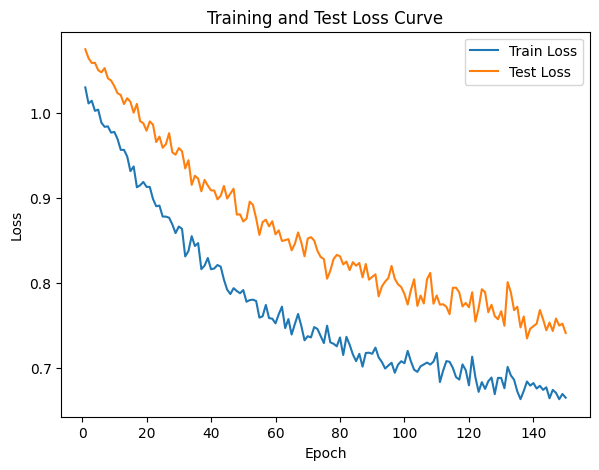

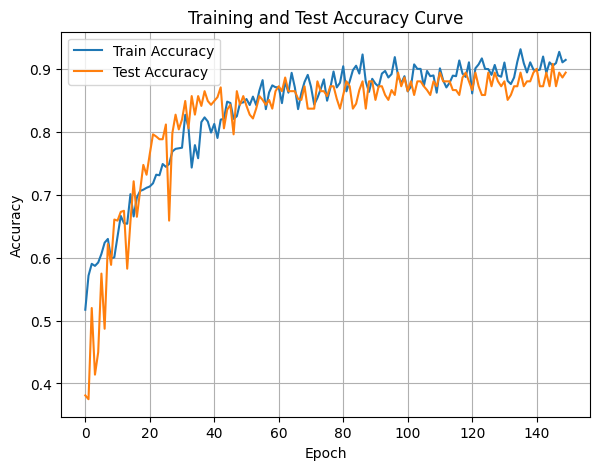

In [68]:
DTEmlp8b.train_single_model()

Randomly initializing 8 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.93it/s]

Epoch [1/10], Train F1:0.41432904493880107, Train Loss: 1.0781, Train Acc: 0.4506, Test F1:0.49164330945707474, Test Loss: 1.0798, Test Acc: 0.5608


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.43it/s]

Epoch [2/10], Train F1:0.4174420645332866, Train Loss: 1.0766, Train Acc: 0.4552, Test F1:0.4887512899896801, Test Loss: 1.0761, Test Acc: 0.5608


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.21it/s]

Epoch [3/10], Train F1:0.4152730881930748, Train Loss: 1.0785, Train Acc: 0.4490, Test F1:0.4928760256806398, Test Loss: 1.0736, Test Acc: 0.5660


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.59it/s]

Epoch [4/10], Train F1:0.42941296460253797, Train Loss: 1.0710, Train Acc: 0.4713, Test F1:0.4932199494369111, Test Loss: 1.0699, Test Acc: 0.5705


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.84it/s]

Epoch [5/10], Train F1:0.4312764072597438, Train Loss: 1.0672, Train Acc: 0.4770, Test F1:0.4943551007147499, Test Loss: 1.0667, Test Acc: 0.5760


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.79it/s]

Epoch [6/10], Train F1:0.438319072324836, Train Loss: 1.0629, Train Acc: 0.4856, Test F1:0.49308367071524967, Test Loss: 1.0646, Test Acc: 0.5761


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.08it/s]

Epoch [7/10], Train F1:0.44316228813003, Train Loss: 1.0593, Train Acc: 0.4935, Test F1:0.4926234392941758, Test Loss: 1.0651, Test Acc: 0.5719


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.10it/s]

Epoch [8/10], Train F1:0.44898475887830785, Train Loss: 1.0572, Train Acc: 0.5001, Test F1:0.4964420951646951, Test Loss: 1.0637, Test Acc: 0.5760


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  9.27it/s]

Epoch [9/10], Train F1:0.4499339302680772, Train Loss: 1.0541, Train Acc: 0.5033, Test F1:0.49754667808031355, Test Loss: 1.0610, Test Acc: 0.5800


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.98it/s]


Epoch [10/10], Train F1:0.45384088770144204, Train Loss: 1.0514, Train Acc: 0.5094, Test F1:0.4983792923547817, Test Loss: 1.0575, Test Acc: 0.5855
Total Epochs: 10
Train loss start: 1.1048250198364258, Train loss end: 0.9410614371299744
Highest Mean Train Accuracy (over epoch): 0.509375
Test loss start: 1.0666637420654297, Test loss end: 1.0186755657196045
Highest mean Test Accuracy (over epoch): 0.5855034722222222


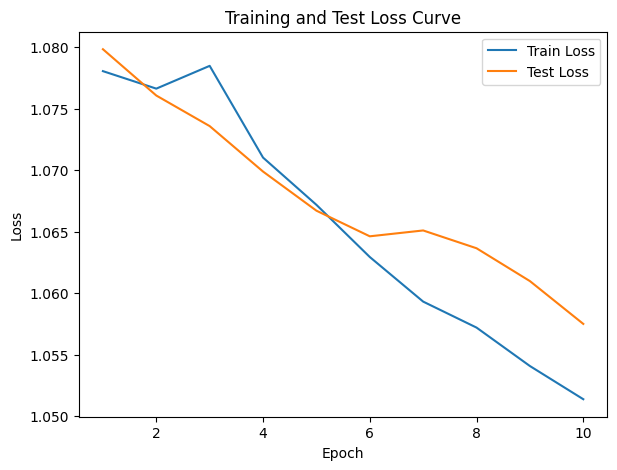

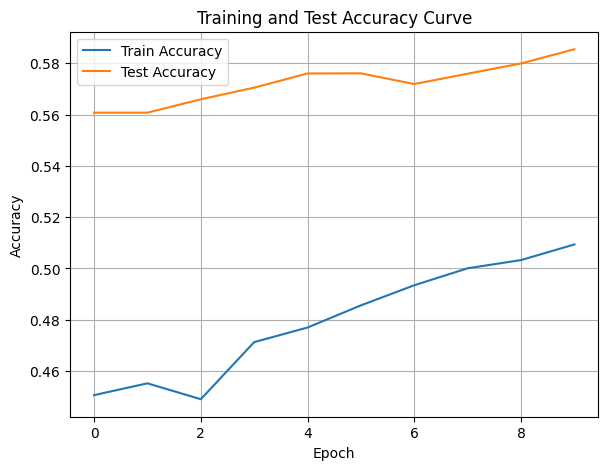

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.21417839438858177, Train Loss: 1.1629, Train Acc: 0.2033, Test F1:0.16977928692699487, Test Loss: 1.1092, Test Acc: 0.2587


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.78it/s]

Epoch [2/10], Train F1:0.22468826993845123, Train Loss: 1.1603, Train Acc: 0.2152, Test F1:0.17748651785104785, Test Loss: 1.1071, Test Acc: 0.2843


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.78it/s]

Epoch [3/10], Train F1:0.2375533210046424, Train Loss: 1.1519, Train Acc: 0.2367, Test F1:0.1830663615560641, Test Loss: 1.1069, Test Acc: 0.2980


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.06it/s]

Epoch [4/10], Train F1:0.24450040210477045, Train Loss: 1.1504, Train Acc: 0.2424, Test F1:0.18571949723078968, Test Loss: 1.1061, Test Acc: 0.3069


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.24it/s]

Epoch [5/10], Train F1:0.24902541828492464, Train Loss: 1.1461, Train Acc: 0.2465, Test F1:0.18678274633953307, Test Loss: 1.1035, Test Acc: 0.3106


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.34it/s]

Epoch [6/10], Train F1:0.2483151413815549, Train Loss: 1.1440, Train Acc: 0.2485, Test F1:0.1869605860996978, Test Loss: 1.1017, Test Acc: 0.3144


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.52it/s]

Epoch [7/10], Train F1:0.25822369202532197, Train Loss: 1.1394, Train Acc: 0.2580, Test F1:0.18688827331486607, Test Loss: 1.1002, Test Acc: 0.3171


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.52it/s]

Epoch [8/10], Train F1:0.2610240909276236, Train Loss: 1.1361, Train Acc: 0.2626, Test F1:0.18734910671173347, Test Loss: 1.0989, Test Acc: 0.3191


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.11it/s]

Epoch [9/10], Train F1:0.2671825728623341, Train Loss: 1.1336, Train Acc: 0.2679, Test F1:0.18717266248819442, Test Loss: 1.0976, Test Acc: 0.3190


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.80it/s]


Epoch [10/10], Train F1:0.27449096339880374, Train Loss: 1.1318, Train Acc: 0.2732, Test F1:0.19190008948749704, Test Loss: 1.0951, Test Acc: 0.3241
Total Epochs: 10
Train loss start: 1.1953818798065186, Train loss end: 1.2350839376449585
Highest Mean Train Accuracy (over epoch): 0.2731547619047619
Test loss start: 1.1120394468307495, Test loss end: 1.073206901550293
Highest mean Test Accuracy (over epoch): 0.3241319444444445


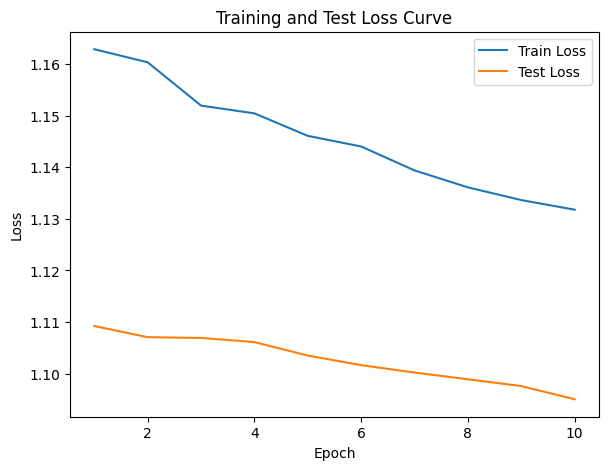

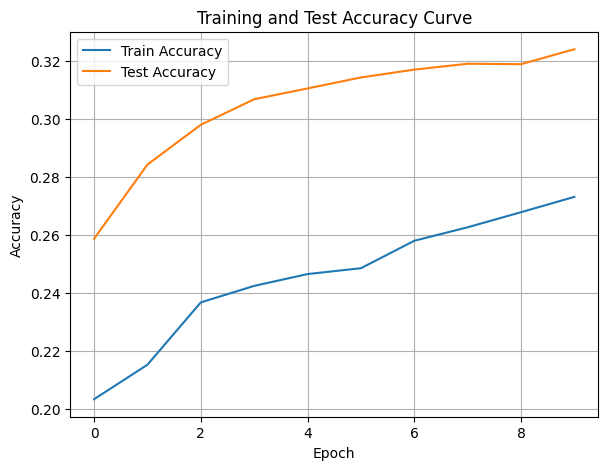

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4875164472751103, Train Loss: 1.0697, Train Acc: 0.4485, Test F1:0.14837092731829574, Test Loss: 1.1192, Test Acc: 0.0998


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.67it/s]

Epoch [2/10], Train F1:0.48966442730671417, Train Loss: 1.0647, Train Acc: 0.4481, Test F1:0.1363157894736842, Test Loss: 1.1208, Test Acc: 0.0881


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.03it/s]

Epoch [3/10], Train F1:0.4803471660614517, Train Loss: 1.0657, Train Acc: 0.4356, Test F1:0.1728184096605149, Test Loss: 1.1169, Test Acc: 0.1169


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.10it/s]

Epoch [4/10], Train F1:0.48740605776276996, Train Loss: 1.0642, Train Acc: 0.4404, Test F1:0.19036774628879888, Test Loss: 1.1159, Test Acc: 0.1283


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.10it/s]

Epoch [5/10], Train F1:0.4908662151014294, Train Loss: 1.0589, Train Acc: 0.4441, Test F1:0.19150366337299185, Test Loss: 1.1157, Test Acc: 0.1288


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.51it/s]

Epoch [6/10], Train F1:0.4937384661160031, Train Loss: 1.0563, Train Acc: 0.4514, Test F1:0.20788441692466458, Test Loss: 1.1144, Test Acc: 0.1383


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.63it/s]

Epoch [7/10], Train F1:0.4987426718461201, Train Loss: 1.0531, Train Acc: 0.4554, Test F1:0.2171163652132117, Test Loss: 1.1133, Test Acc: 0.1448


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.72it/s]

Epoch [8/10], Train F1:0.5055402631235194, Train Loss: 1.0492, Train Acc: 0.4629, Test F1:0.23197867587058668, Test Loss: 1.1118, Test Acc: 0.1544


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.72it/s]

Epoch [9/10], Train F1:0.5165372607280849, Train Loss: 1.0452, Train Acc: 0.4724, Test F1:0.242475956228429, Test Loss: 1.1110, Test Acc: 0.1610


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.53it/s]


Epoch [10/10], Train F1:0.5187229608144018, Train Loss: 1.0424, Train Acc: 0.4753, Test F1:0.25367474630632525, Test Loss: 1.1099, Test Acc: 0.1678
Total Epochs: 10
Train loss start: 1.0215141773223877, Train loss end: 1.0069550275802612
Highest Mean Train Accuracy (over epoch): 0.4753273809523809
Test loss start: 1.1093931198120117, Test loss end: 1.110130786895752
Highest mean Test Accuracy (over epoch): 0.1677951388888889


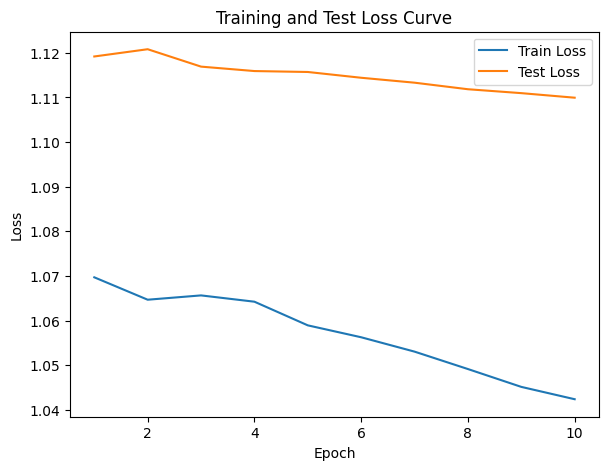

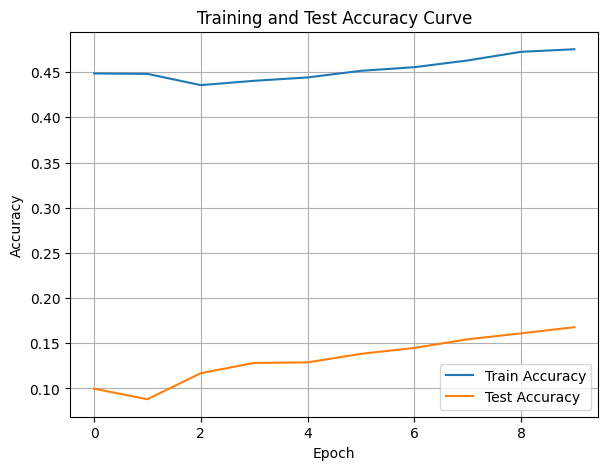

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.19153869903994591, Train Loss: 1.1658, Train Acc: 0.1940, Test F1:0.2077445445726241, Test Loss: 1.1253, Test Acc: 0.1840


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.04it/s]

Epoch [2/10], Train F1:0.19968978064262743, Train Loss: 1.1642, Train Acc: 0.1987, Test F1:0.20555283046955267, Test Loss: 1.1303, Test Acc: 0.1762


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.04it/s]

Epoch [3/10], Train F1:0.1965436548490379, Train Loss: 1.1626, Train Acc: 0.2027, Test F1:0.22313676243818106, Test Loss: 1.1280, Test Acc: 0.1959


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.73it/s]

Epoch [4/10], Train F1:0.20141252772831722, Train Loss: 1.1602, Train Acc: 0.2060, Test F1:0.2151727292022826, Test Loss: 1.1304, Test Acc: 0.1886


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.68it/s]

Epoch [5/10], Train F1:0.2068117134663897, Train Loss: 1.1567, Train Acc: 0.2138, Test F1:0.23255487202855624, Test Loss: 1.1278, Test Acc: 0.2030


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.60it/s]

Epoch [6/10], Train F1:0.21561836658981026, Train Loss: 1.1514, Train Acc: 0.2250, Test F1:0.2357070992894422, Test Loss: 1.1268, Test Acc: 0.2083


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.35it/s]

Epoch [7/10], Train F1:0.21941964870653446, Train Loss: 1.1476, Train Acc: 0.2299, Test F1:0.2458452840182989, Test Loss: 1.1239, Test Acc: 0.2197


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.24it/s]

Epoch [8/10], Train F1:0.226001595998792, Train Loss: 1.1447, Train Acc: 0.2340, Test F1:0.2576328797108437, Test Loss: 1.1220, Test Acc: 0.2266


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.05it/s]

Epoch [9/10], Train F1:0.23003627807150978, Train Loss: 1.1427, Train Acc: 0.2369, Test F1:0.26209527574073177, Test Loss: 1.1204, Test Acc: 0.2327


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.10it/s]


Epoch [10/10], Train F1:0.2402497430259679, Train Loss: 1.1391, Train Acc: 0.2426, Test F1:0.27083919692278824, Test Loss: 1.1184, Test Acc: 0.2444
Total Epochs: 10
Train loss start: 1.1246066093444824, Train loss end: 1.1594560146331787
Highest Mean Train Accuracy (over epoch): 0.2425595238095238
Test loss start: 1.1203259229660034, Test loss end: 1.101007103919983
Highest mean Test Accuracy (over epoch): 0.2443576388888889


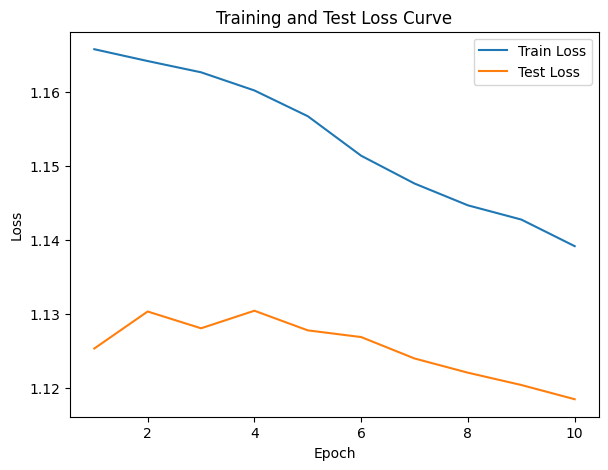

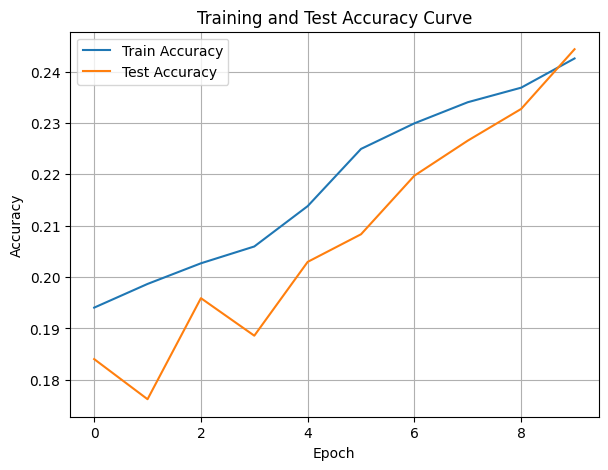

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.92it/s]

Epoch [1/10], Train F1:0.5165063199677457, Train Loss: 1.0714, Train Acc: 0.4583, Test F1:0.4952584163110479, Test Loss: 1.0887, Test Acc: 0.4983
Epoch [2/10], Train F1:0.5271081028737835, Train Loss: 1.0607, Train Acc: 0.4762, Test F1:0.5593509388670951, Test Loss: 1.0842, Test Acc: 0.5521


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.92it/s]

Epoch [3/10], Train F1:0.532613502798972, Train Loss: 1.0572, Train Acc: 0.4892, Test F1:0.5792104291181541, Test Loss: 1.0804, Test Acc: 0.5700


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.50it/s]

Epoch [4/10], Train F1:0.5340649713494163, Train Loss: 1.0536, Train Acc: 0.4935, Test F1:0.5321004471964225, Test Loss: 1.0805, Test Acc: 0.5237
Epoch [5/10], Train F1:0.5423258051939032, Train Loss: 1.0483, Train Acc: 0.5068, Test F1:0.5168397196822127, Test Loss: 1.0792, Test Acc: 0.5111


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.83it/s]

Epoch [6/10], Train F1:0.557625123024506, Train Loss: 1.0409, Train Acc: 0.5244, Test F1:0.491280964108293, Test Loss: 1.0787, Test Acc: 0.4893
Epoch [7/10], Train F1:0.5613479302042328, Train Loss: 1.0372, Train Acc: 0.5310, Test F1:0.4865684043741353, Test Loss: 1.0771, Test Acc: 0.4883


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.08it/s]

Epoch [8/10], Train F1:0.5699548770173408, Train Loss: 1.0315, Train Acc: 0.5384, Test F1:0.48723925948271724, Test Loss: 1.0747, Test Acc: 0.4923
Epoch [9/10], Train F1:0.5768860121361761, Train Loss: 1.0260, Train Acc: 0.5473, Test F1:0.48949058987707456, Test Loss: 1.0721, Test Acc: 0.4962


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.41it/s]


Epoch [10/10], Train F1:0.5855688367276163, Train Loss: 1.0218, Train Acc: 0.5570, Test F1:0.4892937812230162, Test Loss: 1.0696, Test Acc: 0.4980
Total Epochs: 10
Train loss start: 1.0405091047286987, Train loss end: 0.9631407856941223
Highest Mean Train Accuracy (over epoch): 0.5569642857142857
Test loss start: 1.0982263088226318, Test loss end: 1.043157696723938
Highest mean Test Accuracy (over epoch): 0.5700231481481483


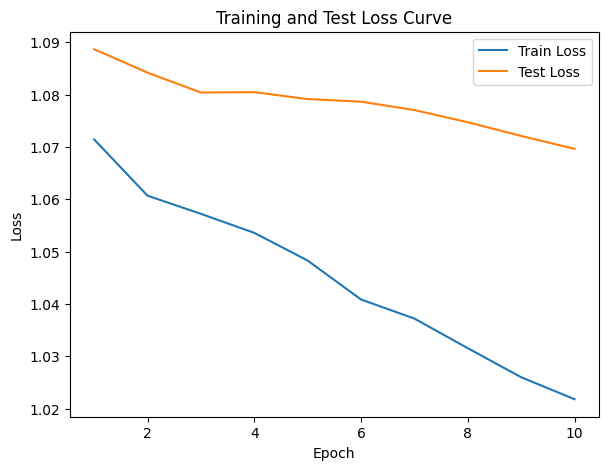

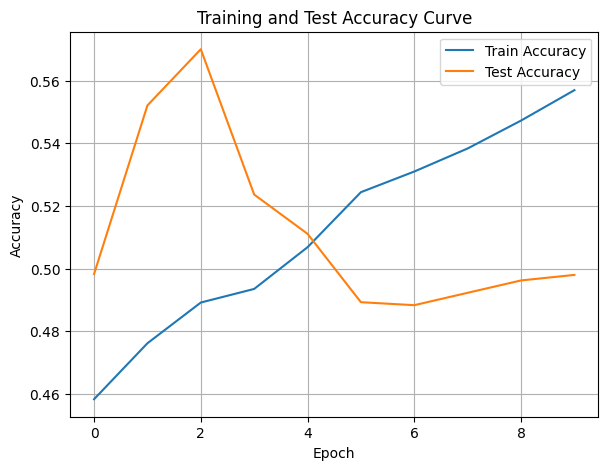

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.05496456072307465, Train Loss: 1.2726, Train Acc: 0.0292, Test F1:0.032948224219084304, Test Loss: 1.1921, Test Acc: 0.0217


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.04it/s]

Epoch [2/10], Train F1:0.08208348428128648, Train Loss: 1.2687, Train Acc: 0.0437, Test F1:0.016828701149566208, Test Loss: 1.1994, Test Acc: 0.0109


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.15it/s]

Epoch [3/10], Train F1:0.10252116625742999, Train Loss: 1.2645, Train Acc: 0.0563, Test F1:0.011277452619588166, Test Loss: 1.1989, Test Acc: 0.0072


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.33it/s]

Epoch [4/10], Train F1:0.11192065585814229, Train Loss: 1.2585, Train Acc: 0.0620, Test F1:0.012549546957504858, Test Loss: 1.1969, Test Acc: 0.0074


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.36it/s]

Epoch [5/10], Train F1:0.11907670927711458, Train Loss: 1.2533, Train Acc: 0.0663, Test F1:0.016833182115967408, Test Loss: 1.1957, Test Acc: 0.0090


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.36it/s]

Epoch [6/10], Train F1:0.1283952004515998, Train Loss: 1.2482, Train Acc: 0.0728, Test F1:0.016755282214672925, Test Loss: 1.1933, Test Acc: 0.0088


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.41it/s]

Epoch [7/10], Train F1:0.13802286982301307, Train Loss: 1.2438, Train Acc: 0.0806, Test F1:0.01919856357234562, Test Loss: 1.1915, Test Acc: 0.0098


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.41it/s]

Epoch [8/10], Train F1:0.14661675795677212, Train Loss: 1.2396, Train Acc: 0.0877, Test F1:0.018862491855924687, Test Loss: 1.1895, Test Acc: 0.0095


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.08it/s]

Epoch [9/10], Train F1:0.155459955351817, Train Loss: 1.2361, Train Acc: 0.0936, Test F1:0.02054734837964098, Test Loss: 1.1883, Test Acc: 0.0102


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.61it/s]


Epoch [10/10], Train F1:0.16914293101191039, Train Loss: 1.2325, Train Acc: 0.1020, Test F1:0.023397821691369773, Test Loss: 1.1847, Test Acc: 0.0122
Total Epochs: 10
Train loss start: 1.3010859489440918, Train loss end: 1.3002841472625732
Highest Mean Train Accuracy (over epoch): 0.10196428571428572
Test loss start: 1.1878546476364136, Test loss end: 1.1651958227157593
Highest mean Test Accuracy (over epoch): 0.021701388888888888


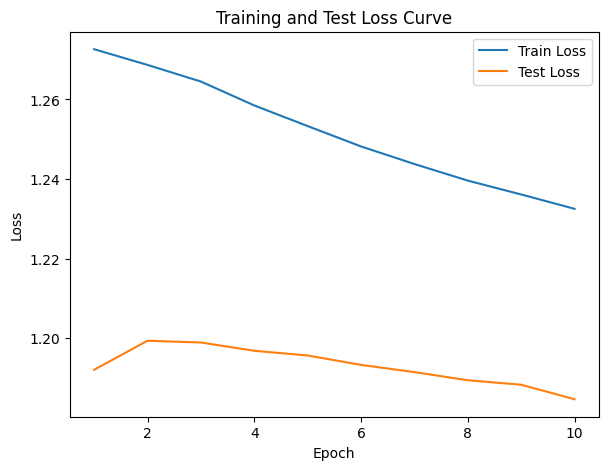

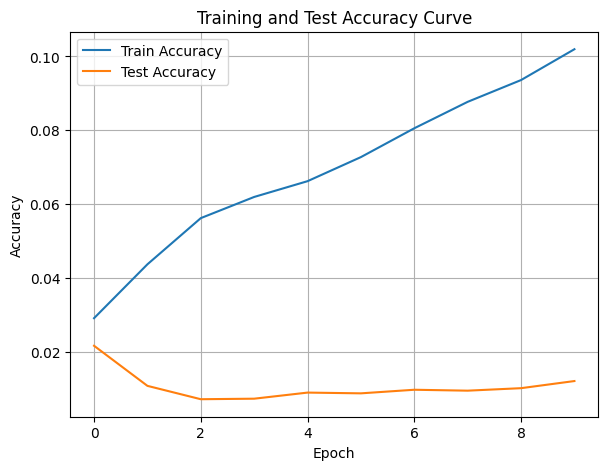

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.48it/s]

Epoch [1/10], Train F1:0.08151593019909062, Train Loss: 1.3352, Train Acc: 0.0417, Test F1:0.017309941520467834, Test Loss: 1.2644, Test Acc: 0.0078


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.21it/s]

Epoch [2/10], Train F1:0.08730366102306776, Train Loss: 1.3302, Train Acc: 0.0485, Test F1:0.008713057812316025, Test Loss: 1.2807, Test Acc: 0.0039


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.97it/s]

Epoch [3/10], Train F1:0.09451097623802002, Train Loss: 1.3284, Train Acc: 0.0536, Test F1:0.005821729210919676, Test Loss: 1.2877, Test Acc: 0.0026


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.57it/s]

Epoch [4/10], Train F1:0.10368773637009764, Train Loss: 1.3215, Train Acc: 0.0574, Test F1:0.004371197353653495, Test Loss: 1.2890, Test Acc: 0.0020


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.07it/s]

Epoch [5/10], Train F1:0.104387902695595, Train Loss: 1.3191, Train Acc: 0.0571, Test F1:0.003499314323544711, Test Loss: 1.2888, Test Acc: 0.0016


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.51it/s]

Epoch [6/10], Train F1:0.11409932717492628, Train Loss: 1.3155, Train Acc: 0.0622, Test F1:0.002917405874236152, Test Loss: 1.2846, Test Acc: 0.0013


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.51it/s]

Epoch [7/10], Train F1:0.11951857936476004, Train Loss: 1.3133, Train Acc: 0.0660, Test F1:0.0025014366359057565, Test Loss: 1.2824, Test Acc: 0.0011


Epoch [8/10], Train F1:0.12281735688588821, Train Loss: 1.3106, Train Acc: 0.0676, Test F1:0.002189284340699979, Test Loss: 1.2806, Test Acc: 0.0010


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.29it/s]


Epoch [9/10], Train F1:0.12586911932972564, Train Loss: 1.3078, Train Acc: 0.0691, Test F1:0.0019463952234409115, Test Loss: 1.2783, Test Acc: 0.0009
Epoch [10/10], Train F1:0.13357059855358677, Train Loss: 1.3036, Train Acc: 0.0748, Test F1:0.003499314323544711, Test Loss: 1.2747, Test Acc: 0.0016
Total Epochs: 10
Train loss start: 1.3317722082138062, Train loss end: 1.209236741065979
Highest Mean Train Accuracy (over epoch): 0.07476190476190475
Test loss start: 1.258392572402954, Test loss end: 1.254112958908081
Highest mean Test Accuracy (over epoch): 0.0078125


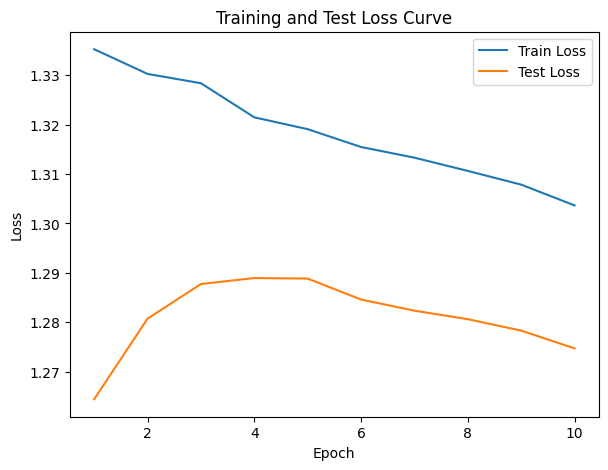

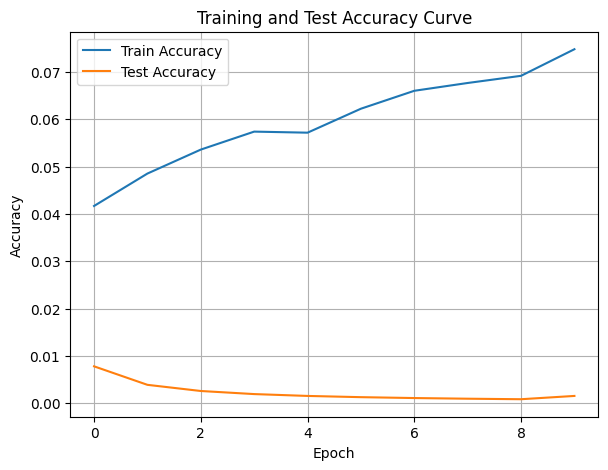

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.15it/s]

Epoch [1/10], Train F1:0.5143045923335254, Train Loss: 1.0302, Train Acc: 0.5592, Test F1:0.5317293233082707, Test Loss: 1.0490, Test Acc: 0.5998


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.15it/s]

Epoch [2/10], Train F1:0.518604380702271, Train Loss: 1.0293, Train Acc: 0.5533, Test F1:0.5303343829659619, Test Loss: 1.0451, Test Acc: 0.5998


Epoch [3/10], Train F1:0.5344696571432245, Train Loss: 1.0251, Train Acc: 0.5646, Test F1:0.5394670520137432, Test Loss: 1.0428, Test Acc: 0.6024


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.03it/s]

Epoch [4/10], Train F1:0.5382036649561059, Train Loss: 1.0241, Train Acc: 0.5655, Test F1:0.5440382994664738, Test Loss: 1.0388, Test Acc: 0.6111
Epoch [5/10], Train F1:0.5394689934922244, Train Loss: 1.0202, Train Acc: 0.5667, Test F1:0.5499132933343459, Test Loss: 1.0350, Test Acc: 0.6179


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.03it/s]

Epoch [6/10], Train F1:0.534662783876537, Train Loss: 1.0207, Train Acc: 0.5620, Test F1:0.5476667930889657, Test Loss: 1.0336, Test Acc: 0.6185


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.53it/s]

Epoch [7/10], Train F1:0.5366169715743749, Train Loss: 1.0172, Train Acc: 0.5648, Test F1:0.5497324184634379, Test Loss: 1.0327, Test Acc: 0.6200
Epoch [8/10], Train F1:0.5372816614725556, Train Loss: 1.0157, Train Acc: 0.5645, Test F1:0.5533917430355675, Test Loss: 1.0319, Test Acc: 0.6239


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.77it/s]

Epoch [9/10], Train F1:0.5388601607869555, Train Loss: 1.0124, Train Acc: 0.5678, Test F1:0.5581522666530684, Test Loss: 1.0288, Test Acc: 0.6311


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.31it/s]


Epoch [10/10], Train F1:0.5391039943910522, Train Loss: 1.0110, Train Acc: 0.5699, Test F1:0.5666819986770575, Test Loss: 1.0264, Test Acc: 0.6398
Total Epochs: 10
Train loss start: 1.0735390186309814, Train loss end: 1.0768771171569824
Highest Mean Train Accuracy (over epoch): 0.5699107142857143
Test loss start: 1.0371811389923096, Test loss end: 1.0039353370666504
Highest mean Test Accuracy (over epoch): 0.6397569444444444


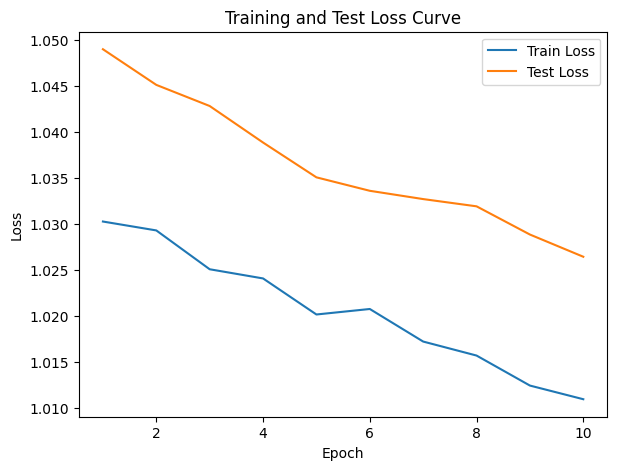

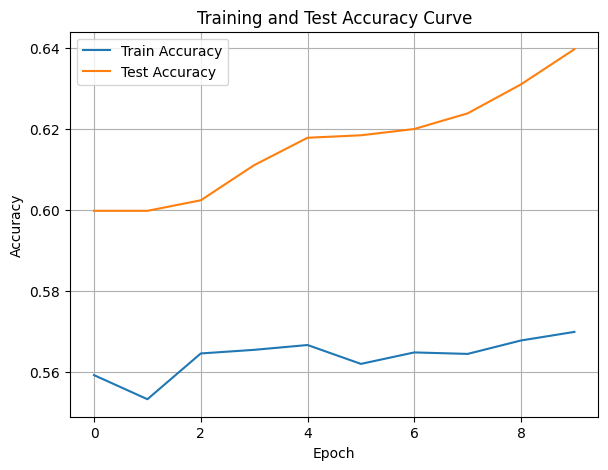

./saved_models/model_8.pth
Training Model with id 12
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.12it/s]

Epoch [1/10], Train F1:0.5830685026149951, Train Loss: 0.9769, Train Acc: 0.6193, Test F1:0.6113239676458067, Test Loss: 0.9985, Test Acc: 0.6727
Epoch [2/10], Train F1:0.5704416738003839, Train Loss: 0.9755, Train Acc: 0.6137, Test F1:0.6317806009276064, Test Loss: 1.0005, Test Acc: 0.6914


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.21it/s]

Epoch [3/10], Train F1:0.5752652558351841, Train Loss: 0.9763, Train Acc: 0.6187, Test F1:0.6522368815119559, Test Loss: 0.9994, Test Acc: 0.7106
Epoch [4/10], Train F1:0.5764468095841582, Train Loss: 0.9733, Train Acc: 0.6228, Test F1:0.6573913416018679, Test Loss: 0.9984, Test Acc: 0.7164


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.54it/s]

Epoch [5/10], Train F1:0.5786714266211379, Train Loss: 0.9712, Train Acc: 0.6231, Test F1:0.6646634369979452, Test Loss: 0.9970, Test Acc: 0.7229
Epoch [6/10], Train F1:0.5898104840667432, Train Loss: 0.9667, Train Acc: 0.6319, Test F1:0.6784716800730731, Test Loss: 0.9952, Test Acc: 0.7299


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.69it/s]

Epoch [7/10], Train F1:0.5950257172849194, Train Loss: 0.9624, Train Acc: 0.6376, Test F1:0.6879776419344842, Test Loss: 0.9937, Test Acc: 0.7349
Epoch [8/10], Train F1:0.5962412281258689, Train Loss: 0.9607, Train Acc: 0.6392, Test F1:0.6895266084731698, Test Loss: 0.9930, Test Acc: 0.7367


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.19it/s]


Epoch [9/10], Train F1:0.5963662719944114, Train Loss: 0.9601, Train Acc: 0.6387, Test F1:0.6929987419632219, Test Loss: 0.9906, Test Acc: 0.7398
Epoch [10/10], Train F1:0.600827907352285, Train Loss: 0.9561, Train Acc: 0.6428, Test F1:0.6995395553836294, Test Loss: 0.9897, Test Acc: 0.7438
Total Epochs: 10
Train loss start: 1.0248280763626099, Train loss end: 0.807194173336029
Highest Mean Train Accuracy (over epoch): 0.6427976190476191
Test loss start: 0.9848055243492126, Test loss end: 0.9717974066734314
Highest mean Test Accuracy (over epoch): 0.7438368055555555


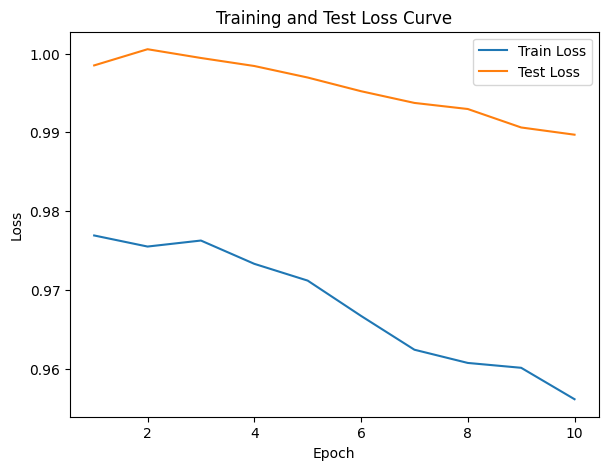

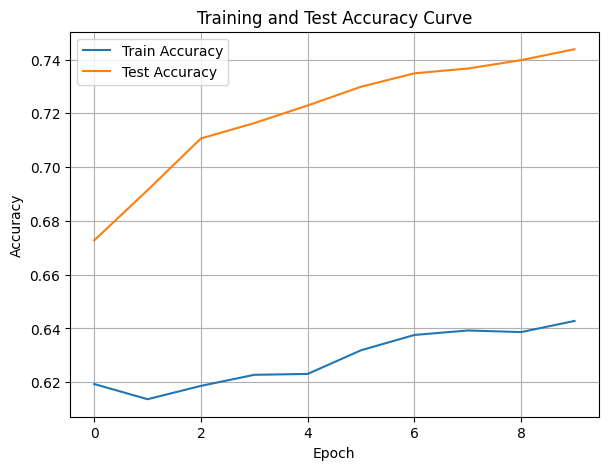

./saved_models/model_12.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.68it/s]

Epoch [1/10], Train F1:0.628488724772351, Train Loss: 0.9448, Train Acc: 0.6494, Test F1:0.7340637673366045, Test Loss: 0.9662, Test Acc: 0.7726
Epoch [2/10], Train F1:0.6264244754150331, Train Loss: 0.9381, Train Acc: 0.6600, Test F1:0.7276236275287743, Test Loss: 0.9677, Test Acc: 0.7687


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.68it/s]

Epoch [3/10], Train F1:0.6328867657307617, Train Loss: 0.9315, Train Acc: 0.6697, Test F1:0.7289753464336263, Test Loss: 0.9705, Test Acc: 0.7674


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.66it/s]

Epoch [4/10], Train F1:0.6353604003313111, Train Loss: 0.9289, Train Acc: 0.6731, Test F1:0.7377862988846972, Test Loss: 0.9716, Test Acc: 0.7726


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.66it/s]

Epoch [5/10], Train F1:0.641419400689802, Train Loss: 0.9258, Train Acc: 0.6788, Test F1:0.7503393850827678, Test Loss: 0.9722, Test Acc: 0.7804


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.88it/s]

Epoch [6/10], Train F1:0.6487471475194226, Train Loss: 0.9221, Train Acc: 0.6835, Test F1:0.7618382802937578, Test Loss: 0.9709, Test Acc: 0.7882


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.35it/s]

Epoch [7/10], Train F1:0.6507889699345532, Train Loss: 0.9185, Train Acc: 0.6860, Test F1:0.7614504488646366, Test Loss: 0.9687, Test Acc: 0.7882


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.38it/s]

Epoch [8/10], Train F1:0.6518892518971501, Train Loss: 0.9165, Train Acc: 0.6866, Test F1:0.7656426133206319, Test Loss: 0.9674, Test Acc: 0.7911


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.48it/s]

Epoch [9/10], Train F1:0.6570142107260895, Train Loss: 0.9133, Train Acc: 0.6904, Test F1:0.764923406924877, Test Loss: 0.9648, Test Acc: 0.7908


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.99it/s]


Epoch [10/10], Train F1:0.6604571240962328, Train Loss: 0.9091, Train Acc: 0.6940, Test F1:0.7667337723858593, Test Loss: 0.9633, Test Acc: 0.7921
Total Epochs: 10
Train loss start: 0.9502370357513428, Train loss end: 0.7719041705131531
Highest Mean Train Accuracy (over epoch): 0.6939583333333333
Test loss start: 0.950384259223938, Test loss end: 0.9314140677452087
Highest mean Test Accuracy (over epoch): 0.7921006944444444


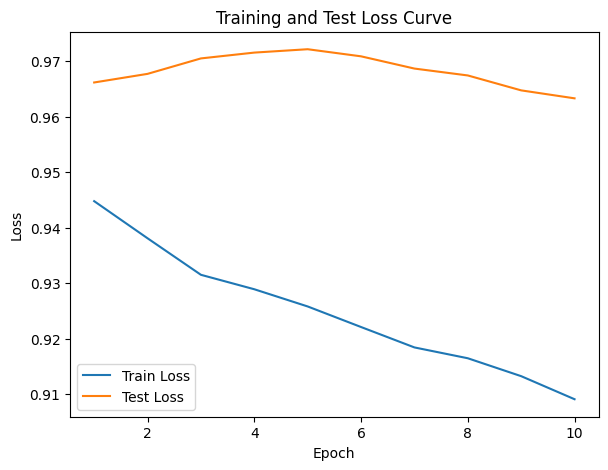

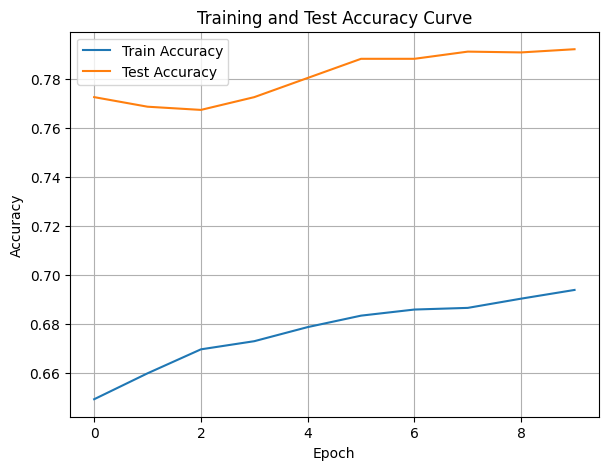

./saved_models/model_13.pth
Training Model with id 11
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.33it/s]

Epoch [1/10], Train F1:0.7118169159954583, Train Loss: 0.8778, Train Acc: 0.7426, Test F1:0.8086062416047893, Test Loss: 0.9449, Test Acc: 0.8194


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.40it/s]

Epoch [2/10], Train F1:0.7153031066434047, Train Loss: 0.8764, Train Acc: 0.7409, Test F1:0.8016628471388165, Test Loss: 0.9446, Test Acc: 0.8155


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.53it/s]

Epoch [3/10], Train F1:0.719013564921954, Train Loss: 0.8755, Train Acc: 0.7393, Test F1:0.8012784134248667, Test Loss: 0.9419, Test Acc: 0.8142


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.59it/s]

Epoch [4/10], Train F1:0.7216444536380219, Train Loss: 0.8700, Train Acc: 0.7419, Test F1:0.8106622832384606, Test Loss: 0.9393, Test Acc: 0.8244


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.59it/s]

Epoch [5/10], Train F1:0.7243500274348769, Train Loss: 0.8670, Train Acc: 0.7439, Test F1:0.8140840341715105, Test Loss: 0.9375, Test Acc: 0.8278


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.91it/s]

Epoch [6/10], Train F1:0.7276439247397841, Train Loss: 0.8621, Train Acc: 0.7471, Test F1:0.8275467489044304, Test Loss: 0.9365, Test Acc: 0.8398


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.35it/s]

Epoch [7/10], Train F1:0.7314052847074555, Train Loss: 0.8611, Train Acc: 0.7509, Test F1:0.830620775565963, Test Loss: 0.9354, Test Acc: 0.8431


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.62it/s]

Epoch [8/10], Train F1:0.7341026888569744, Train Loss: 0.8591, Train Acc: 0.7533, Test F1:0.8350584335017006, Test Loss: 0.9343, Test Acc: 0.8473


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.47it/s]

Epoch [9/10], Train F1:0.7381809763599996, Train Loss: 0.8558, Train Acc: 0.7582, Test F1:0.8354342779075585, Test Loss: 0.9322, Test Acc: 0.8482


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.69it/s]


Epoch [10/10], Train F1:0.7411215734530172, Train Loss: 0.8548, Train Acc: 0.7593, Test F1:0.8411708756364449, Test Loss: 0.9314, Test Acc: 0.8534
Total Epochs: 10
Train loss start: 0.8591744899749756, Train loss end: 0.9940646290779114
Highest Mean Train Accuracy (over epoch): 0.7593452380952381
Test loss start: 0.9302013516426086, Test loss end: 0.9070096611976624
Highest mean Test Accuracy (over epoch): 0.8533854166666666


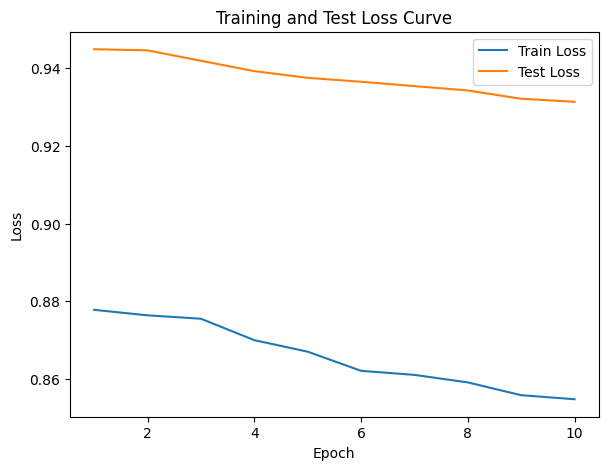

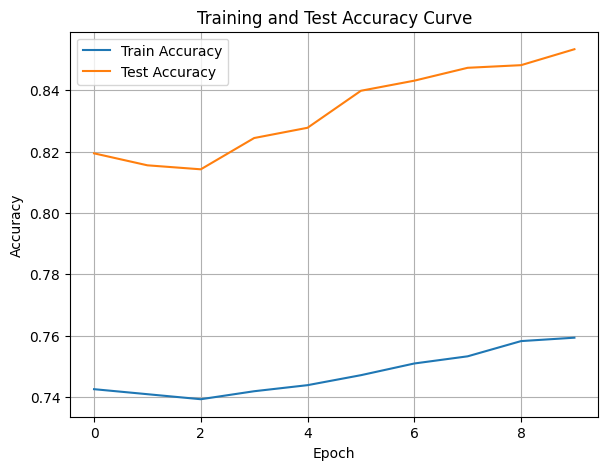

./saved_models/model_11.pth
Training Model with id 13
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.75it/s]

Epoch [1/10], Train F1:0.785451868661953, Train Loss: 0.8209, Train Acc: 0.7872, Test F1:0.8723073506551189, Test Loss: 0.9192, Test Acc: 0.8845


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.33it/s]

Epoch [2/10], Train F1:0.7792797050879845, Train Loss: 0.8247, Train Acc: 0.7862, Test F1:0.8856999407945004, Test Loss: 0.9147, Test Acc: 0.8963


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.60it/s]

Epoch [3/10], Train F1:0.7793345604273401, Train Loss: 0.8244, Train Acc: 0.7833, Test F1:0.8704827678662165, Test Loss: 0.9105, Test Acc: 0.8805


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.95it/s]

Epoch [4/10], Train F1:0.7799063705906472, Train Loss: 0.8254, Train Acc: 0.7830, Test F1:0.8652125670212683, Test Loss: 0.9077, Test Acc: 0.8746


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.29it/s]

Epoch [5/10], Train F1:0.7810089136538565, Train Loss: 0.8240, Train Acc: 0.7851, Test F1:0.8680784090684306, Test Loss: 0.9063, Test Acc: 0.8769


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.49it/s]

Epoch [6/10], Train F1:0.7813327738557436, Train Loss: 0.8240, Train Acc: 0.7849, Test F1:0.8733265133415411, Test Loss: 0.9053, Test Acc: 0.8821


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.32it/s]

Epoch [7/10], Train F1:0.7844545780904773, Train Loss: 0.8216, Train Acc: 0.7879, Test F1:0.8742092554088473, Test Loss: 0.9028, Test Acc: 0.8827


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.19it/s]

Epoch [8/10], Train F1:0.7862941983740906, Train Loss: 0.8189, Train Acc: 0.7906, Test F1:0.877363383077129, Test Loss: 0.9014, Test Acc: 0.8859


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.64it/s]

Epoch [9/10], Train F1:0.7870007644762089, Train Loss: 0.8172, Train Acc: 0.7925, Test F1:0.8787060841921711, Test Loss: 0.8999, Test Acc: 0.8868


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.42it/s]


Epoch [10/10], Train F1:0.7890689708021115, Train Loss: 0.8159, Train Acc: 0.7943, Test F1:0.8809039879891689, Test Loss: 0.8988, Test Acc: 0.8883
Total Epochs: 10
Train loss start: 0.8125132322311401, Train loss end: 0.8320686221122742
Highest Mean Train Accuracy (over epoch): 0.7942857142857143
Test loss start: 0.9066061973571777, Test loss end: 0.8714613914489746
Highest mean Test Accuracy (over epoch): 0.8962673611111112


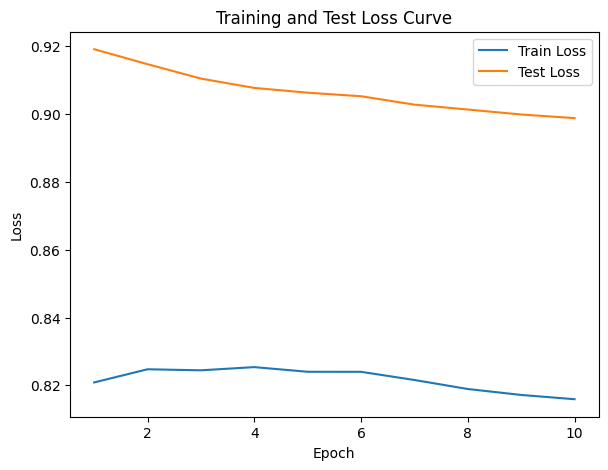

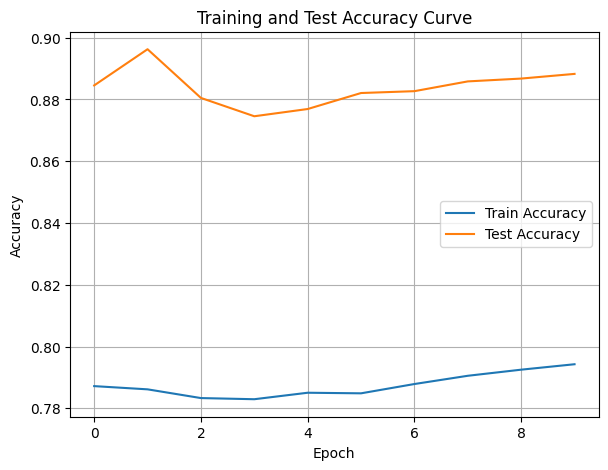

./saved_models/model_13.pth
Training Model with id 14
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.03it/s]

Epoch [1/10], Train F1:0.7802972668357284, Train Loss: 0.8129, Train Acc: 0.7946, Test F1:0.8893962848297212, Test Loss: 0.8917, Test Acc: 0.8941
Epoch [2/10], Train F1:0.7910084357135945, Train Loss: 0.8010, Train Acc: 0.8077, Test F1:0.8844680062912561, Test Loss: 0.8925, Test Acc: 0.8902


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.03it/s]

Epoch [3/10], Train F1:0.8053096402447218, Train Loss: 0.7947, Train Acc: 0.8162, Test F1:0.8897937454433501, Test Loss: 0.8903, Test Acc: 0.8941


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.62it/s]

Epoch [4/10], Train F1:0.8132025651904854, Train Loss: 0.7930, Train Acc: 0.8214, Test F1:0.8872458019974699, Test Loss: 0.8879, Test Acc: 0.8906


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.62it/s]

Epoch [5/10], Train F1:0.8133310377122046, Train Loss: 0.7922, Train Acc: 0.8189, Test F1:0.8757981911299989, Test Loss: 0.8838, Test Acc: 0.8807


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.87it/s]

Epoch [6/10], Train F1:0.8129470599648558, Train Loss: 0.7893, Train Acc: 0.8203, Test F1:0.8780769986396455, Test Loss: 0.8820, Test Acc: 0.8830


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.48it/s]

Epoch [7/10], Train F1:0.8179955524441089, Train Loss: 0.7873, Train Acc: 0.8225, Test F1:0.881309073808192, Test Loss: 0.8801, Test Acc: 0.8857


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.47it/s]

Epoch [8/10], Train F1:0.8194083338601975, Train Loss: 0.7857, Train Acc: 0.8252, Test F1:0.879594766638676, Test Loss: 0.8798, Test Acc: 0.8838


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.37it/s]

Epoch [9/10], Train F1:0.8228607170076901, Train Loss: 0.7823, Train Acc: 0.8293, Test F1:0.8819069800284897, Test Loss: 0.8790, Test Acc: 0.8858


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.90it/s]


Epoch [10/10], Train F1:0.8241710134594177, Train Loss: 0.7816, Train Acc: 0.8304, Test F1:0.8821624687930343, Test Loss: 0.8783, Test Acc: 0.8859
Total Epochs: 10
Train loss start: 0.8158345222473145, Train loss end: 0.7710992097854614
Highest Mean Train Accuracy (over epoch): 0.8304464285714286
Test loss start: 0.8752016425132751, Test loss end: 0.8572702407836914
Highest mean Test Accuracy (over epoch): 0.8940972222222223


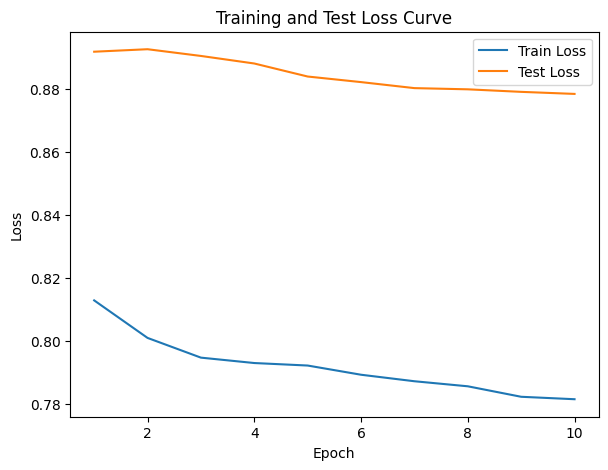

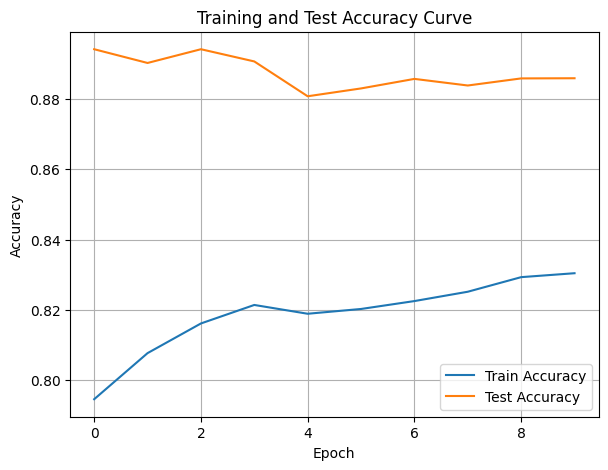

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.24it/s]

Epoch [1/10], Train F1:0.8337645933705047, Train Loss: 0.7607, Train Acc: 0.8405, Test F1:0.8915879442195231, Test Loss: 0.8743, Test Acc: 0.8941


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.31it/s]

Epoch [2/10], Train F1:0.8362202628323228, Train Loss: 0.7596, Train Acc: 0.8426, Test F1:0.8958660867186173, Test Loss: 0.8653, Test Acc: 0.8980


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.19it/s]

Epoch [3/10], Train F1:0.8392532209280205, Train Loss: 0.7612, Train Acc: 0.8404, Test F1:0.8905491577043875, Test Loss: 0.8624, Test Acc: 0.8941


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.92it/s]

Epoch [4/10], Train F1:0.8414665400375165, Train Loss: 0.7642, Train Acc: 0.8398, Test F1:0.8905491577043876, Test Loss: 0.8601, Test Acc: 0.8926


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.87it/s]

Epoch [5/10], Train F1:0.8475935792483715, Train Loss: 0.7575, Train Acc: 0.8481, Test F1:0.886438880795705, Test Loss: 0.8578, Test Acc: 0.8898


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.65it/s]

Epoch [6/10], Train F1:0.8478325713748809, Train Loss: 0.7553, Train Acc: 0.8501, Test F1:0.8887479423733138, Test Loss: 0.8565, Test Acc: 0.8918


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.83it/s]

Epoch [7/10], Train F1:0.8491252866467383, Train Loss: 0.7541, Train Acc: 0.8525, Test F1:0.88761822251101, Test Loss: 0.8554, Test Acc: 0.8910
Epoch [8/10], Train F1:0.8490336320900029, Train Loss: 0.7536, Train Acc: 0.8526, Test F1:0.8870580433349844, Test Loss: 0.8553, Test Acc: 0.8904
Epoch [9/10], Train F1:0.8509392883264434, Train Loss: 0.7516, Train Acc: 0.8553, Test F1:0.8886454413802379, Test Loss: 0.8546, Test Acc: 0.8917


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.94it/s]


Epoch [10/10], Train F1:0.8546040569711073, Train Loss: 0.7510, Train Acc: 0.8579, Test F1:0.889801325538735, Test Loss: 0.8536, Test Acc: 0.8927
Total Epochs: 10
Train loss start: 0.7427953481674194, Train loss end: 0.8743863105773926
Highest Mean Train Accuracy (over epoch): 0.8578571428571428
Test loss start: 0.8588081002235413, Test loss end: 0.8264937996864319
Highest mean Test Accuracy (over epoch): 0.8980034722222222


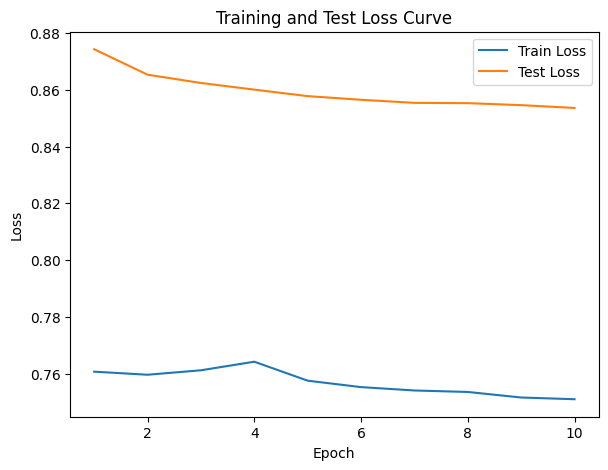

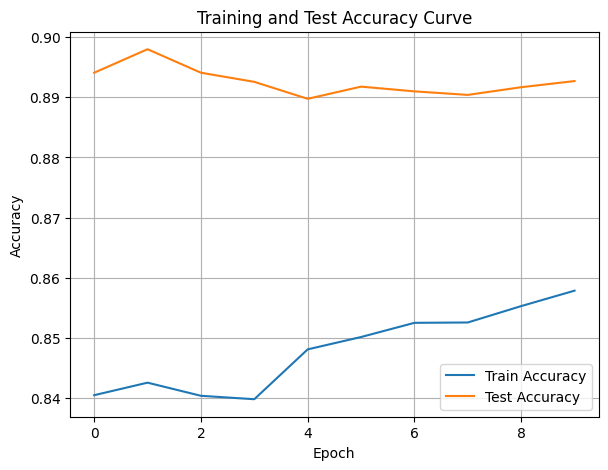

./saved_models/model_12.pth
Training Model with id 10
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8468839967167726, Train Loss: 0.7362, Train Acc: 0.8583, Test F1:0.8808197688643266, Test Loss: 0.8417, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.68it/s]

Epoch [2/10], Train F1:0.8503325909237207, Train Loss: 0.7402, Train Acc: 0.8577, Test F1:0.878833700061527, Test Loss: 0.8475, Test Acc: 0.8793


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.68it/s]

Epoch [3/10], Train F1:0.858004691937276, Train Loss: 0.7390, Train Acc: 0.8606, Test F1:0.8834027643113629, Test Loss: 0.8468, Test Acc: 0.8843


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.00it/s]

Epoch [4/10], Train F1:0.8600383181751108, Train Loss: 0.7391, Train Acc: 0.8605, Test F1:0.8774545506231227, Test Loss: 0.8458, Test Acc: 0.8789


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.33it/s]

Epoch [5/10], Train F1:0.8615815839735607, Train Loss: 0.7383, Train Acc: 0.8593, Test F1:0.8819636035653651, Test Loss: 0.8428, Test Acc: 0.8835


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.56it/s]

Epoch [6/10], Train F1:0.8660939770079078, Train Loss: 0.7347, Train Acc: 0.8651, Test F1:0.8837208826078699, Test Loss: 0.8423, Test Acc: 0.8853


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.38it/s]

Epoch [7/10], Train F1:0.8656953677335676, Train Loss: 0.7335, Train Acc: 0.8662, Test F1:0.8816086328184959, Test Loss: 0.8454, Test Acc: 0.8832


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.97it/s]

Epoch [8/10], Train F1:0.8665965261029287, Train Loss: 0.7331, Train Acc: 0.8662, Test F1:0.8839136283150604, Test Loss: 0.8432, Test Acc: 0.8855


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.68it/s]


Epoch [9/10], Train F1:0.8677932409735314, Train Loss: 0.7325, Train Acc: 0.8659, Test F1:0.8803667142839184, Test Loss: 0.8438, Test Acc: 0.8821
Epoch [10/10], Train F1:0.8676889944612036, Train Loss: 0.7331, Train Acc: 0.8653, Test F1:0.8791320406278855, Test Loss: 0.8428, Test Acc: 0.8810
Total Epochs: 10
Train loss start: 0.6953033804893494, Train loss end: 0.7916179299354553
Highest Mean Train Accuracy (over epoch): 0.8662202380952382
Test loss start: 0.8216263651847839, Test loss end: 0.8193222284317017
Highest mean Test Accuracy (over epoch): 0.8855251736111112


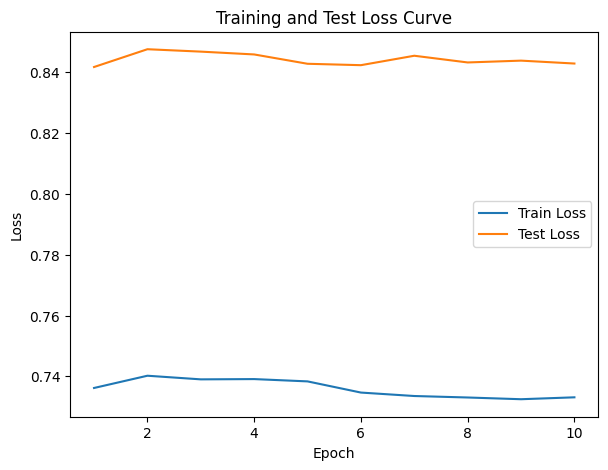

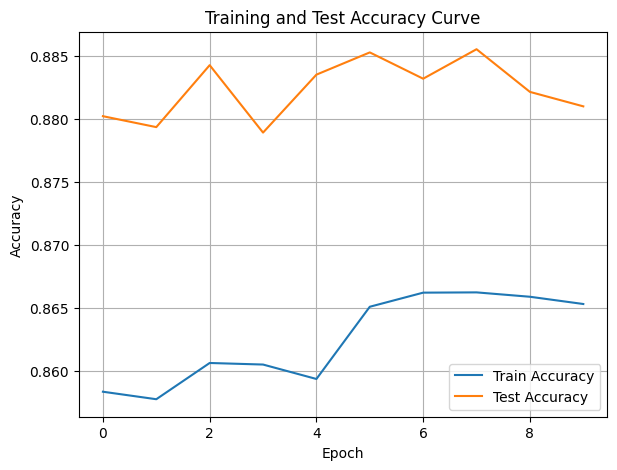

./saved_models/model_10.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [69]:
DTEmlp8b.train_DTE()

Training Process:   1%|          | 1/150 [00:00<00:16,  8.94it/s]

Epoch [1/150], Train F1:0.5989646824988191, Train Loss: 1.0174, Train Acc: 0.5747, Test F1:0.6784044189184948, Test Loss: 1.0264, Test Acc: 0.7196


Training Process:   1%|          | 1/150 [00:00<00:16,  8.94it/s]

Epoch [2/150], Train F1:0.5890959612862892, Train Loss: 1.0199, Train Acc: 0.5568, Test F1:0.6620571631097946, Test Loss: 1.0189, Test Acc: 0.7188


Training Process:   2%|▏         | 3/150 [00:00<00:15,  9.38it/s]

Epoch [3/150], Train F1:0.6051169253630181, Train Loss: 1.0157, Train Acc: 0.5669, Test F1:0.6652432918287308, Test Loss: 1.0155, Test Acc: 0.7237


Training Process:   3%|▎         | 4/150 [00:00<00:16,  8.74it/s]

Epoch [4/150], Train F1:0.6081341176674702, Train Loss: 1.0130, Train Acc: 0.5698, Test F1:0.6713014081435134, Test Loss: 1.0116, Test Acc: 0.7281


Training Process:   3%|▎         | 5/150 [00:00<00:17,  8.44it/s]

Epoch [5/150], Train F1:0.6130775906683469, Train Loss: 1.0107, Train Acc: 0.5736, Test F1:0.674303511736944, Test Loss: 1.0087, Test Acc: 0.7307


Training Process:   4%|▍         | 6/150 [00:00<00:17,  8.31it/s]

Epoch [6/150], Train F1:0.6176672919050966, Train Loss: 1.0074, Train Acc: 0.5802, Test F1:0.6757828443050117, Test Loss: 1.0044, Test Acc: 0.7325


Training Process:   5%|▍         | 7/150 [00:00<00:17,  8.23it/s]

Epoch [7/150], Train F1:0.6267291561939821, Train Loss: 1.0020, Train Acc: 0.5933, Test F1:0.679350623396145, Test Loss: 1.0012, Test Acc: 0.7349


Training Process:   6%|▌         | 9/150 [00:01<00:20,  6.78it/s]

Epoch [8/150], Train F1:0.6280782867262964, Train Loss: 1.0007, Train Acc: 0.5964, Test F1:0.682929527127713, Test Loss: 0.9985, Test Acc: 0.7367
Epoch [9/150], Train F1:0.6324927071814378, Train Loss: 0.9968, Train Acc: 0.6030, Test F1:0.6864665147710566, Test Loss: 0.9953, Test Acc: 0.7396


Training Process:   7%|▋         | 11/150 [00:01<00:19,  7.06it/s]

Epoch [10/150], Train F1:0.6341420148254034, Train Loss: 0.9940, Train Acc: 0.6077, Test F1:0.690696484801748, Test Loss: 0.9932, Test Acc: 0.7427
Epoch [11/150], Train F1:0.6371657601839363, Train Loss: 0.9907, Train Acc: 0.6123, Test F1:0.692856918683112, Test Loss: 0.9901, Test Acc: 0.7446


Training Process:   9%|▊         | 13/150 [00:01<00:17,  7.67it/s]

Epoch [12/150], Train F1:0.6400049710938801, Train Loss: 0.9871, Train Acc: 0.6160, Test F1:0.693220756810058, Test Loss: 0.9867, Test Acc: 0.7449
Epoch [13/150], Train F1:0.6454245823517412, Train Loss: 0.9830, Train Acc: 0.6219, Test F1:0.692446971623173, Test Loss: 0.9836, Test Acc: 0.7447


Training Process:  10%|█         | 15/150 [00:01<00:16,  8.09it/s]

Epoch [14/150], Train F1:0.6509363739423061, Train Loss: 0.9788, Train Acc: 0.6293, Test F1:0.6937921677923202, Test Loss: 0.9807, Test Acc: 0.7460
Epoch [15/150], Train F1:0.6557972296884976, Train Loss: 0.9756, Train Acc: 0.6354, Test F1:0.6949547011101236, Test Loss: 0.9783, Test Acc: 0.7471


Training Process:  11%|█▏        | 17/150 [00:02<00:15,  8.54it/s]

Epoch [16/150], Train F1:0.6583736458515852, Train Loss: 0.9725, Train Acc: 0.6386, Test F1:0.6959694129727476, Test Loss: 0.9753, Test Acc: 0.7481
Epoch [17/150], Train F1:0.6613500658988024, Train Loss: 0.9695, Train Acc: 0.6424, Test F1:0.700316533366087, Test Loss: 0.9725, Test Acc: 0.7508


Training Process:  13%|█▎        | 19/150 [00:02<00:15,  8.60it/s]

Epoch [18/150], Train F1:0.6642518724151377, Train Loss: 0.9676, Train Acc: 0.6457, Test F1:0.700912520490063, Test Loss: 0.9703, Test Acc: 0.7515
Epoch [19/150], Train F1:0.6669937682924695, Train Loss: 0.9650, Train Acc: 0.6487, Test F1:0.7037871655991411, Test Loss: 0.9679, Test Acc: 0.7533


Training Process:  14%|█▍        | 21/150 [00:02<00:16,  7.60it/s]

Epoch [20/150], Train F1:0.6710795448891649, Train Loss: 0.9614, Train Acc: 0.6543, Test F1:0.7041467010117363, Test Loss: 0.9662, Test Acc: 0.7538
Epoch [21/150], Train F1:0.6744929317930031, Train Loss: 0.9584, Train Acc: 0.6584, Test F1:0.704471710879406, Test Loss: 0.9639, Test Acc: 0.7543


Training Process:  15%|█▌        | 23/150 [00:02<00:15,  8.09it/s]

Epoch [22/150], Train F1:0.6767833055735347, Train Loss: 0.9555, Train Acc: 0.6616, Test F1:0.7046241312091259, Test Loss: 0.9614, Test Acc: 0.7547
Epoch [23/150], Train F1:0.6791614858273339, Train Loss: 0.9528, Train Acc: 0.6644, Test F1:0.7050363036593537, Test Loss: 0.9586, Test Acc: 0.7550


Training Process:  17%|█▋        | 25/150 [00:03<00:17,  7.21it/s]

Epoch [24/150], Train F1:0.6802562542387982, Train Loss: 0.9505, Train Acc: 0.6660, Test F1:0.7057229211215339, Test Loss: 0.9565, Test Acc: 0.7557
Epoch [25/150], Train F1:0.6835368530074913, Train Loss: 0.9479, Train Acc: 0.6694, Test F1:0.707571256241902, Test Loss: 0.9548, Test Acc: 0.7569


Training Process:  18%|█▊        | 27/150 [00:03<00:18,  6.79it/s]

Epoch [26/150], Train F1:0.685700440863035, Train Loss: 0.9454, Train Acc: 0.6717, Test F1:0.7075794195737161, Test Loss: 0.9528, Test Acc: 0.7571
Epoch [27/150], Train F1:0.688198714767597, Train Loss: 0.9429, Train Acc: 0.6748, Test F1:0.7085954319379826, Test Loss: 0.9509, Test Acc: 0.7579


Training Process:  19%|█▉        | 29/150 [00:03<00:18,  6.65it/s]

Epoch [28/150], Train F1:0.6909381627348903, Train Loss: 0.9404, Train Acc: 0.6784, Test F1:0.7090514941739826, Test Loss: 0.9488, Test Acc: 0.7584
Epoch [29/150], Train F1:0.6944686192870146, Train Loss: 0.9372, Train Acc: 0.6825, Test F1:0.7104102253682126, Test Loss: 0.9470, Test Acc: 0.7594


Training Process:  21%|██        | 31/150 [00:04<00:18,  6.57it/s]

Epoch [30/150], Train F1:0.6968894932166635, Train Loss: 0.9351, Train Acc: 0.6850, Test F1:0.713022795688429, Test Loss: 0.9451, Test Acc: 0.7611
Epoch [31/150], Train F1:0.6991652162465586, Train Loss: 0.9329, Train Acc: 0.6875, Test F1:0.7141548453076396, Test Loss: 0.9429, Test Acc: 0.7619


Training Process:  22%|██▏       | 33/150 [00:04<00:18,  6.41it/s]

Epoch [32/150], Train F1:0.7006745533014658, Train Loss: 0.9307, Train Acc: 0.6894, Test F1:0.7139553172663073, Test Loss: 0.9410, Test Acc: 0.7619
Epoch [33/150], Train F1:0.7026324806770591, Train Loss: 0.9281, Train Acc: 0.6922, Test F1:0.7149879150966968, Test Loss: 0.9391, Test Acc: 0.7627


Training Process:  23%|██▎       | 34/150 [00:04<00:23,  5.01it/s]

Epoch [34/150], Train F1:0.7053839953320551, Train Loss: 0.9258, Train Acc: 0.6948, Test F1:0.715563840886197, Test Loss: 0.9369, Test Acc: 0.7631


Training Process:  23%|██▎       | 35/150 [00:04<00:23,  4.91it/s]

Epoch [35/150], Train F1:0.7081726024041696, Train Loss: 0.9231, Train Acc: 0.6979, Test F1:0.7161060070905497, Test Loss: 0.9349, Test Acc: 0.7636


Training Process:  24%|██▍       | 36/150 [00:05<00:22,  5.06it/s]

Epoch [36/150], Train F1:0.7107501050241305, Train Loss: 0.9207, Train Acc: 0.7008, Test F1:0.7177286674661251, Test Loss: 0.9330, Test Acc: 0.7646


Training Process:  25%|██▍       | 37/150 [00:05<00:22,  5.11it/s]

Epoch [37/150], Train F1:0.7125197905748629, Train Loss: 0.9185, Train Acc: 0.7031, Test F1:0.719975466886277, Test Loss: 0.9309, Test Acc: 0.7661


Training Process:  26%|██▌       | 39/150 [00:05<00:20,  5.37it/s]

Epoch [38/150], Train F1:0.7138874624907735, Train Loss: 0.9165, Train Acc: 0.7048, Test F1:0.7203538942680465, Test Loss: 0.9291, Test Acc: 0.7664
Epoch [39/150], Train F1:0.7156864355586786, Train Loss: 0.9142, Train Acc: 0.7068, Test F1:0.7213908249198552, Test Loss: 0.9271, Test Acc: 0.7671


Training Process:  27%|██▋       | 41/150 [00:06<00:18,  5.77it/s]

Epoch [40/150], Train F1:0.717082518304042, Train Loss: 0.9121, Train Acc: 0.7087, Test F1:0.7220437344204497, Test Loss: 0.9254, Test Acc: 0.7676
Epoch [41/150], Train F1:0.7192340538076993, Train Loss: 0.9095, Train Acc: 0.7111, Test F1:0.7245889916142073, Test Loss: 0.9236, Test Acc: 0.7692


Training Process:  29%|██▊       | 43/150 [00:06<00:17,  6.01it/s]

Epoch [42/150], Train F1:0.7213834216662098, Train Loss: 0.9075, Train Acc: 0.7132, Test F1:0.7273114921598541, Test Loss: 0.9218, Test Acc: 0.7709
Epoch [43/150], Train F1:0.7232627184828899, Train Loss: 0.9052, Train Acc: 0.7154, Test F1:0.7274704741324595, Test Loss: 0.9202, Test Acc: 0.7711


Training Process:  30%|███       | 45/150 [00:06<00:17,  6.07it/s]

Epoch [44/150], Train F1:0.725038242827093, Train Loss: 0.9032, Train Acc: 0.7173, Test F1:0.7285109120345117, Test Loss: 0.9184, Test Acc: 0.7718
Epoch [45/150], Train F1:0.7267774059399855, Train Loss: 0.9012, Train Acc: 0.7192, Test F1:0.7286356536017062, Test Loss: 0.9167, Test Acc: 0.7720


Training Process:  31%|███▏      | 47/150 [00:07<00:19,  5.38it/s]

Epoch [46/150], Train F1:0.7285360229301538, Train Loss: 0.8991, Train Acc: 0.7213, Test F1:0.7296029547177496, Test Loss: 0.9151, Test Acc: 0.7726
Epoch [47/150], Train F1:0.7301886235197332, Train Loss: 0.8970, Train Acc: 0.7232, Test F1:0.7299750369700663, Test Loss: 0.9134, Test Acc: 0.7729


Training Process:  33%|███▎      | 49/150 [00:07<00:18,  5.58it/s]

Epoch [48/150], Train F1:0.7319993929549592, Train Loss: 0.8948, Train Acc: 0.7253, Test F1:0.7300609793564352, Test Loss: 0.9119, Test Acc: 0.7730
Epoch [49/150], Train F1:0.733559772824767, Train Loss: 0.8931, Train Acc: 0.7271, Test F1:0.7319934484858507, Test Loss: 0.9104, Test Acc: 0.7743


Training Process:  33%|███▎      | 50/150 [00:07<00:18,  5.42it/s]

Epoch [50/150], Train F1:0.7352426812974762, Train Loss: 0.8910, Train Acc: 0.7289, Test F1:0.7328099881214509, Test Loss: 0.9088, Test Acc: 0.7748


Training Process:  34%|███▍      | 51/150 [00:07<00:18,  5.28it/s]

Epoch [51/150], Train F1:0.7363710642767094, Train Loss: 0.8891, Train Acc: 0.7303, Test F1:0.7346026217864842, Test Loss: 0.9074, Test Acc: 0.7760


Training Process:  35%|███▍      | 52/150 [00:08<00:18,  5.26it/s]

Epoch [52/150], Train F1:0.7384116643018813, Train Loss: 0.8873, Train Acc: 0.7321, Test F1:0.7353333859792058, Test Loss: 0.9058, Test Acc: 0.7765


Training Process:  35%|███▌      | 53/150 [00:08<00:18,  5.19it/s]

Epoch [53/150], Train F1:0.7398204332345216, Train Loss: 0.8856, Train Acc: 0.7337, Test F1:0.7370021036342755, Test Loss: 0.9041, Test Acc: 0.7775


Training Process:  36%|███▌      | 54/150 [00:08<00:18,  5.14it/s]

Epoch [54/150], Train F1:0.7414822746552708, Train Loss: 0.8837, Train Acc: 0.7356, Test F1:0.7386036018210964, Test Loss: 0.9027, Test Acc: 0.7786


Training Process:  37%|███▋      | 55/150 [00:08<00:18,  5.05it/s]

Epoch [55/150], Train F1:0.7425248785028018, Train Loss: 0.8821, Train Acc: 0.7368, Test F1:0.7396792652591295, Test Loss: 0.9012, Test Acc: 0.7793


Training Process:  37%|███▋      | 56/150 [00:08<00:18,  4.95it/s]

Epoch [56/150], Train F1:0.7439141131891165, Train Loss: 0.8806, Train Acc: 0.7380, Test F1:0.7402603991098666, Test Loss: 0.8998, Test Acc: 0.7797


Training Process:  38%|███▊      | 57/150 [00:09<00:19,  4.72it/s]

Epoch [57/150], Train F1:0.7451110039184557, Train Loss: 0.8789, Train Acc: 0.7396, Test F1:0.7405976178191621, Test Loss: 0.8984, Test Acc: 0.7799


Training Process:  39%|███▊      | 58/150 [00:09<00:19,  4.63it/s]

Epoch [58/150], Train F1:0.7469752620454613, Train Loss: 0.8769, Train Acc: 0.7416, Test F1:0.7420160534125376, Test Loss: 0.8968, Test Acc: 0.7809


Training Process:  39%|███▉      | 59/150 [00:09<00:21,  4.19it/s]

Epoch [59/150], Train F1:0.7482907051608136, Train Loss: 0.8750, Train Acc: 0.7432, Test F1:0.7435965585800394, Test Loss: 0.8953, Test Acc: 0.7819


Training Process:  40%|████      | 60/150 [00:09<00:20,  4.38it/s]

Epoch [60/150], Train F1:0.7495712007308678, Train Loss: 0.8732, Train Acc: 0.7446, Test F1:0.7449097064863769, Test Loss: 0.8940, Test Acc: 0.7827


Training Process:  41%|████      | 61/150 [00:09<00:19,  4.58it/s]

Epoch [61/150], Train F1:0.7509526707059995, Train Loss: 0.8715, Train Acc: 0.7462, Test F1:0.746176449621948, Test Loss: 0.8927, Test Acc: 0.7836


Training Process:  41%|████▏     | 62/150 [00:10<00:18,  4.70it/s]

Epoch [62/150], Train F1:0.752281716072451, Train Loss: 0.8697, Train Acc: 0.7476, Test F1:0.746590055217905, Test Loss: 0.8914, Test Acc: 0.7839


Training Process:  42%|████▏     | 63/150 [00:10<00:18,  4.80it/s]

Epoch [63/150], Train F1:0.7539117919689072, Train Loss: 0.8682, Train Acc: 0.7492, Test F1:0.747785810973756, Test Loss: 0.8899, Test Acc: 0.7847


Training Process:  43%|████▎     | 64/150 [00:10<00:17,  4.89it/s]

Epoch [64/150], Train F1:0.755084369929596, Train Loss: 0.8667, Train Acc: 0.7506, Test F1:0.7489414224479952, Test Loss: 0.8885, Test Acc: 0.7854


Training Process:  43%|████▎     | 65/150 [00:10<00:17,  4.91it/s]

Epoch [65/150], Train F1:0.7563983299366253, Train Loss: 0.8652, Train Acc: 0.7521, Test F1:0.7500588836292256, Test Loss: 0.8872, Test Acc: 0.7862


Training Process:  44%|████▍     | 66/150 [00:10<00:17,  4.86it/s]

Epoch [66/150], Train F1:0.7575353881972662, Train Loss: 0.8636, Train Acc: 0.7534, Test F1:0.7511400582627807, Test Loss: 0.8858, Test Acc: 0.7869


Training Process:  45%|████▍     | 67/150 [00:11<00:16,  4.89it/s]

Epoch [67/150], Train F1:0.7589820187237021, Train Loss: 0.8620, Train Acc: 0.7549, Test F1:0.7523719362280977, Test Loss: 0.8845, Test Acc: 0.7877


Training Process:  45%|████▌     | 68/150 [00:11<00:17,  4.79it/s]

Epoch [68/150], Train F1:0.7600411440381916, Train Loss: 0.8606, Train Acc: 0.7561, Test F1:0.7535646672690692, Test Loss: 0.8832, Test Acc: 0.7885


Training Process:  46%|████▌     | 69/150 [00:11<00:17,  4.72it/s]

Epoch [69/150], Train F1:0.7613587227231727, Train Loss: 0.8590, Train Acc: 0.7574, Test F1:0.7547200947699634, Test Loss: 0.8819, Test Acc: 0.7892


Training Process:  47%|████▋     | 70/150 [00:11<00:18,  4.23it/s]

Epoch [70/150], Train F1:0.7623858417199869, Train Loss: 0.8577, Train Acc: 0.7584, Test F1:0.7553114512435558, Test Loss: 0.8805, Test Acc: 0.7896


Training Process:  47%|████▋     | 71/150 [00:12<00:19,  4.14it/s]

Epoch [71/150], Train F1:0.7634474526494724, Train Loss: 0.8563, Train Acc: 0.7596, Test F1:0.7562324747888821, Test Loss: 0.8793, Test Acc: 0.7902


Training Process:  48%|████▊     | 72/150 [00:12<00:18,  4.12it/s]

Epoch [72/150], Train F1:0.7649920993743977, Train Loss: 0.8546, Train Acc: 0.7612, Test F1:0.7571262699681051, Test Loss: 0.8780, Test Acc: 0.7908


Training Process:  49%|████▊     | 73/150 [00:12<00:18,  4.14it/s]

Epoch [73/150], Train F1:0.766252585863995, Train Loss: 0.8530, Train Acc: 0.7626, Test F1:0.7579940293967395, Test Loss: 0.8768, Test Acc: 0.7914


Training Process:  49%|████▉     | 74/150 [00:12<00:18,  4.13it/s]

Epoch [74/150], Train F1:0.7672243616575718, Train Loss: 0.8518, Train Acc: 0.7636, Test F1:0.758836876897709, Test Loss: 0.8756, Test Acc: 0.7920


Training Process:  50%|█████     | 75/150 [00:13<00:18,  4.08it/s]

Epoch [75/150], Train F1:0.7687510050266466, Train Loss: 0.8501, Train Acc: 0.7651, Test F1:0.7599819923058034, Test Loss: 0.8745, Test Acc: 0.7928


Training Process:  51%|█████     | 76/150 [00:13<00:18,  3.99it/s]

Epoch [76/150], Train F1:0.7698165267508199, Train Loss: 0.8487, Train Acc: 0.7662, Test F1:0.7607733470023614, Test Loss: 0.8731, Test Acc: 0.7933


Training Process:  51%|█████▏    | 77/150 [00:13<00:17,  4.13it/s]

Epoch [77/150], Train F1:0.7712343800217049, Train Loss: 0.8472, Train Acc: 0.7678, Test F1:0.7620176014796098, Test Loss: 0.8720, Test Acc: 0.7942


Training Process:  52%|█████▏    | 78/150 [00:13<00:16,  4.25it/s]

Epoch [78/150], Train F1:0.7717791916371218, Train Loss: 0.8463, Train Acc: 0.7683, Test F1:0.7629154201048997, Test Loss: 0.8708, Test Acc: 0.7948


Training Process:  53%|█████▎    | 79/150 [00:14<00:16,  4.32it/s]

Epoch [79/150], Train F1:0.7729581886612887, Train Loss: 0.8448, Train Acc: 0.7695, Test F1:0.7636353253361445, Test Loss: 0.8698, Test Acc: 0.7953


Training Process:  53%|█████▎    | 80/150 [00:14<00:16,  4.36it/s]

Epoch [80/150], Train F1:0.7736680790092806, Train Loss: 0.8435, Train Acc: 0.7703, Test F1:0.7644877460025086, Test Loss: 0.8686, Test Acc: 0.7959


Training Process:  54%|█████▍    | 81/150 [00:14<00:17,  4.02it/s]

Epoch [81/150], Train F1:0.7745402052244674, Train Loss: 0.8422, Train Acc: 0.7713, Test F1:0.7653177311523918, Test Loss: 0.8676, Test Acc: 0.7964


Training Process:  55%|█████▍    | 82/150 [00:14<00:16,  4.02it/s]

Epoch [82/150], Train F1:0.7754380413861387, Train Loss: 0.8409, Train Acc: 0.7722, Test F1:0.7661261573547242, Test Loss: 0.8665, Test Acc: 0.7970


Training Process:  55%|█████▌    | 83/150 [00:15<00:16,  4.02it/s]

Epoch [83/150], Train F1:0.7767243477127068, Train Loss: 0.8395, Train Acc: 0.7735, Test F1:0.7672044517148854, Test Loss: 0.8654, Test Acc: 0.7978


Training Process:  56%|█████▌    | 84/150 [00:15<00:16,  4.05it/s]

Epoch [84/150], Train F1:0.7778964549735445, Train Loss: 0.8380, Train Acc: 0.7748, Test F1:0.7681116290581581, Test Loss: 0.8643, Test Acc: 0.7984


Training Process:  57%|█████▋    | 85/150 [00:15<00:16,  4.02it/s]

Epoch [85/150], Train F1:0.7786861261309979, Train Loss: 0.8370, Train Acc: 0.7754, Test F1:0.7688545326924163, Test Loss: 0.8632, Test Acc: 0.7989


Training Process:  57%|█████▋    | 86/150 [00:15<00:15,  4.01it/s]

Epoch [86/150], Train F1:0.7799710675518552, Train Loss: 0.8355, Train Acc: 0.7768, Test F1:0.7695791075701451, Test Loss: 0.8620, Test Acc: 0.7994


Training Process:  58%|█████▊    | 87/150 [00:16<00:15,  3.99it/s]

Epoch [87/150], Train F1:0.780880374743608, Train Loss: 0.8344, Train Acc: 0.7776, Test F1:0.7700104280192654, Test Loss: 0.8610, Test Acc: 0.7997


Training Process:  59%|█████▊    | 88/150 [00:16<00:15,  3.89it/s]

Epoch [88/150], Train F1:0.7817356409056353, Train Loss: 0.8334, Train Acc: 0.7784, Test F1:0.7707038203372478, Test Loss: 0.8599, Test Acc: 0.8001


Training Process:  59%|█████▉    | 89/150 [00:16<00:15,  3.83it/s]

Epoch [89/150], Train F1:0.7828913407869178, Train Loss: 0.8321, Train Acc: 0.7796, Test F1:0.7712463153033046, Test Loss: 0.8589, Test Acc: 0.8005


Training Process:  60%|██████    | 90/150 [00:16<00:15,  3.75it/s]

Epoch [90/150], Train F1:0.7837320890279428, Train Loss: 0.8311, Train Acc: 0.7803, Test F1:0.7723070760604344, Test Loss: 0.8578, Test Acc: 0.8013


Training Process:  61%|██████    | 91/150 [00:17<00:17,  3.41it/s]

Epoch [91/150], Train F1:0.7846687776949676, Train Loss: 0.8297, Train Acc: 0.7812, Test F1:0.772949460005666, Test Loss: 0.8567, Test Acc: 0.8017


Training Process:  61%|██████▏   | 92/150 [00:17<00:16,  3.42it/s]

Epoch [92/150], Train F1:0.7852350538329811, Train Loss: 0.8289, Train Acc: 0.7818, Test F1:0.7735770944698285, Test Loss: 0.8557, Test Acc: 0.8021


Training Process:  62%|██████▏   | 93/150 [00:17<00:16,  3.53it/s]

Epoch [93/150], Train F1:0.7860285032470519, Train Loss: 0.8278, Train Acc: 0.7827, Test F1:0.7740625504407396, Test Loss: 0.8548, Test Acc: 0.8025


Training Process:  63%|██████▎   | 94/150 [00:18<00:15,  3.68it/s]

Epoch [94/150], Train F1:0.786813232078388, Train Loss: 0.8268, Train Acc: 0.7835, Test F1:0.7746636787556401, Test Loss: 0.8537, Test Acc: 0.8029


Training Process:  63%|██████▎   | 95/150 [00:18<00:14,  3.76it/s]

Epoch [95/150], Train F1:0.788034102361172, Train Loss: 0.8255, Train Acc: 0.7847, Test F1:0.7753764214512391, Test Loss: 0.8527, Test Acc: 0.8034


Training Process:  64%|██████▍   | 96/150 [00:18<00:14,  3.82it/s]

Epoch [96/150], Train F1:0.78914563401219, Train Loss: 0.8243, Train Acc: 0.7858, Test F1:0.77644366667734, Test Loss: 0.8517, Test Acc: 0.8042


Training Process:  65%|██████▍   | 97/150 [00:18<00:13,  3.82it/s]

Epoch [97/150], Train F1:0.790063101985514, Train Loss: 0.8233, Train Acc: 0.7866, Test F1:0.7768770528352545, Test Loss: 0.8508, Test Acc: 0.8045


Training Process:  65%|██████▌   | 98/150 [00:19<00:13,  3.80it/s]

Epoch [98/150], Train F1:0.7910002013073989, Train Loss: 0.8223, Train Acc: 0.7875, Test F1:0.7773012319119685, Test Loss: 0.8499, Test Acc: 0.8048


Training Process:  66%|██████▌   | 99/150 [00:19<00:13,  3.79it/s]

Epoch [99/150], Train F1:0.7918362111451953, Train Loss: 0.8212, Train Acc: 0.7883, Test F1:0.7778358438806943, Test Loss: 0.8489, Test Acc: 0.8051


Training Process:  67%|██████▋   | 100/150 [00:19<00:14,  3.45it/s]

Epoch [100/150], Train F1:0.7928230746936088, Train Loss: 0.8200, Train Acc: 0.7893, Test F1:0.7785952221254878, Test Loss: 0.8480, Test Acc: 0.8057


Training Process:  67%|██████▋   | 101/150 [00:20<00:14,  3.40it/s]

Epoch [101/150], Train F1:0.7935637640648624, Train Loss: 0.8190, Train Acc: 0.7901, Test F1:0.7791051542666865, Test Loss: 0.8471, Test Acc: 0.8061


Training Process:  68%|██████▊   | 102/150 [00:20<00:14,  3.38it/s]

Epoch [102/150], Train F1:0.7944136481492161, Train Loss: 0.8179, Train Acc: 0.7910, Test F1:0.7797200235018842, Test Loss: 0.8462, Test Acc: 0.8065


Training Process:  69%|██████▊   | 103/150 [00:20<00:14,  3.34it/s]

Epoch [103/150], Train F1:0.7955125529371514, Train Loss: 0.8167, Train Acc: 0.7921, Test F1:0.7802080679491461, Test Loss: 0.8453, Test Acc: 0.8068


Training Process:  69%|██████▉   | 104/150 [00:20<00:13,  3.34it/s]

Epoch [104/150], Train F1:0.7961179998356095, Train Loss: 0.8157, Train Acc: 0.7927, Test F1:0.7812509343752589, Test Loss: 0.8444, Test Acc: 0.8076


Training Process:  70%|███████   | 105/150 [00:21<00:13,  3.32it/s]

Epoch [105/150], Train F1:0.7969579178316935, Train Loss: 0.8147, Train Acc: 0.7936, Test F1:0.7819370877976719, Test Loss: 0.8435, Test Acc: 0.8080


Training Process:  71%|███████   | 106/150 [00:21<00:13,  3.35it/s]

Epoch [106/150], Train F1:0.7976899466041851, Train Loss: 0.8136, Train Acc: 0.7944, Test F1:0.7823884520947065, Test Loss: 0.8426, Test Acc: 0.8084


Training Process:  71%|███████▏  | 107/150 [00:21<00:12,  3.47it/s]

Epoch [107/150], Train F1:0.7983898301174618, Train Loss: 0.8126, Train Acc: 0.7951, Test F1:0.7828309944390377, Test Loss: 0.8417, Test Acc: 0.8087


Training Process:  72%|███████▏  | 108/150 [00:22<00:11,  3.55it/s]

Epoch [108/150], Train F1:0.7991978839366881, Train Loss: 0.8116, Train Acc: 0.7960, Test F1:0.7832649713460508, Test Loss: 0.8408, Test Acc: 0.8090


Training Process:  73%|███████▎  | 109/150 [00:22<00:11,  3.64it/s]

Epoch [109/150], Train F1:0.8001093922644739, Train Loss: 0.8106, Train Acc: 0.7968, Test F1:0.7841192744538048, Test Loss: 0.8400, Test Acc: 0.8096


Training Process:  73%|███████▎  | 110/150 [00:22<00:11,  3.41it/s]

Epoch [110/150], Train F1:0.8007928856336363, Train Loss: 0.8097, Train Acc: 0.7975, Test F1:0.7848507201810675, Test Loss: 0.8392, Test Acc: 0.8102


Training Process:  74%|███████▍  | 111/150 [00:22<00:11,  3.44it/s]

Epoch [111/150], Train F1:0.8014958846186626, Train Loss: 0.8088, Train Acc: 0.7983, Test F1:0.7854630880053568, Test Loss: 0.8383, Test Acc: 0.8106


Training Process:  75%|███████▍  | 112/150 [00:23<00:11,  3.45it/s]

Epoch [112/150], Train F1:0.8024064691911695, Train Loss: 0.8079, Train Acc: 0.7990, Test F1:0.7859599442245404, Test Loss: 0.8374, Test Acc: 0.8109


Training Process:  75%|███████▌  | 113/150 [00:23<00:10,  3.47it/s]

Epoch [113/150], Train F1:0.8029420043556103, Train Loss: 0.8071, Train Acc: 0.7996, Test F1:0.7865504190971397, Test Loss: 0.8366, Test Acc: 0.8113


Training Process:  76%|███████▌  | 114/150 [00:23<00:10,  3.45it/s]

Epoch [114/150], Train F1:0.8037572855406586, Train Loss: 0.8061, Train Acc: 0.8005, Test F1:0.7869261532225469, Test Loss: 0.8358, Test Acc: 0.8116


Training Process:  77%|███████▋  | 115/150 [00:24<00:10,  3.40it/s]

Epoch [115/150], Train F1:0.8045353686901162, Train Loss: 0.8051, Train Acc: 0.8012, Test F1:0.7872950865020224, Test Loss: 0.8350, Test Acc: 0.8118


Training Process:  77%|███████▋  | 116/150 [00:24<00:10,  3.37it/s]

Epoch [116/150], Train F1:0.8053801476273204, Train Loss: 0.8041, Train Acc: 0.8021, Test F1:0.7878573551948237, Test Loss: 0.8341, Test Acc: 0.8122


Training Process:  78%|███████▊  | 117/150 [00:24<00:10,  3.29it/s]

Epoch [117/150], Train F1:0.8059817304652181, Train Loss: 0.8032, Train Acc: 0.8028, Test F1:0.7885084250779795, Test Loss: 0.8333, Test Acc: 0.8127


Training Process:  79%|███████▊  | 118/150 [00:25<00:09,  3.25it/s]

Epoch [118/150], Train F1:0.8068115842987738, Train Loss: 0.8023, Train Acc: 0.8035, Test F1:0.7890496460881048, Test Loss: 0.8325, Test Acc: 0.8131


Training Process:  79%|███████▉  | 119/150 [00:25<00:09,  3.17it/s]

Epoch [119/150], Train F1:0.8076792447777155, Train Loss: 0.8014, Train Acc: 0.8043, Test F1:0.7893869400047026, Test Loss: 0.8317, Test Acc: 0.8133


Training Process:  80%|████████  | 120/150 [00:25<00:09,  3.24it/s]

Epoch [120/150], Train F1:0.8080884166439696, Train Loss: 0.8007, Train Acc: 0.8047, Test F1:0.7900072050536697, Test Loss: 0.8309, Test Acc: 0.8138


Training Process:  81%|████████  | 121/150 [00:26<00:09,  3.09it/s]

Epoch [121/150], Train F1:0.8087186913466865, Train Loss: 0.7998, Train Acc: 0.8054, Test F1:0.7907118505386452, Test Loss: 0.8301, Test Acc: 0.8144


Training Process:  81%|████████▏ | 122/150 [00:26<00:08,  3.18it/s]

Epoch [122/150], Train F1:0.8094317045690721, Train Loss: 0.7989, Train Acc: 0.8061, Test F1:0.7913096124686477, Test Loss: 0.8293, Test Acc: 0.8148


Training Process:  82%|████████▏ | 123/150 [00:26<00:08,  3.24it/s]

Epoch [123/150], Train F1:0.8098532044916825, Train Loss: 0.7982, Train Acc: 0.8066, Test F1:0.7918970046116235, Test Loss: 0.8286, Test Acc: 0.8153


Training Process:  83%|████████▎ | 124/150 [00:26<00:07,  3.29it/s]

Epoch [124/150], Train F1:0.8102337766810472, Train Loss: 0.7975, Train Acc: 0.8069, Test F1:0.7923815678968363, Test Loss: 0.8278, Test Acc: 0.8156


Training Process:  83%|████████▎ | 125/150 [00:27<00:07,  3.26it/s]

Epoch [125/150], Train F1:0.8109081463396626, Train Loss: 0.7967, Train Acc: 0.8075, Test F1:0.7927660277670785, Test Loss: 0.8271, Test Acc: 0.8159


Training Process:  84%|████████▍ | 126/150 [00:27<00:07,  3.27it/s]

Epoch [126/150], Train F1:0.8113404434188821, Train Loss: 0.7959, Train Acc: 0.8081, Test F1:0.7931441116648005, Test Loss: 0.8264, Test Acc: 0.8161


Training Process:  85%|████████▍ | 127/150 [00:27<00:07,  3.24it/s]

Epoch [127/150], Train F1:0.8119610455319398, Train Loss: 0.7951, Train Acc: 0.8087, Test F1:0.7936966590228173, Test Loss: 0.8256, Test Acc: 0.8166


Training Process:  85%|████████▌ | 128/150 [00:28<00:06,  3.19it/s]

Epoch [128/150], Train F1:0.8126117602130296, Train Loss: 0.7943, Train Acc: 0.8093, Test F1:0.7941504799618923, Test Loss: 0.8249, Test Acc: 0.8169


Training Process:  86%|████████▌ | 129/150 [00:28<00:06,  3.16it/s]

Epoch [129/150], Train F1:0.8131276595079435, Train Loss: 0.7935, Train Acc: 0.8099, Test F1:0.7944193012645459, Test Loss: 0.8242, Test Acc: 0.8171


Training Process:  87%|████████▋ | 130/150 [00:28<00:06,  3.11it/s]

Epoch [130/150], Train F1:0.813586930884874, Train Loss: 0.7928, Train Acc: 0.8105, Test F1:0.7951240849591676, Test Loss: 0.8235, Test Acc: 0.8176


Training Process:  87%|████████▋ | 131/150 [00:29<00:06,  2.83it/s]

Epoch [131/150], Train F1:0.8140584823146924, Train Loss: 0.7920, Train Acc: 0.8110, Test F1:0.7955554643847688, Test Loss: 0.8229, Test Acc: 0.8179


Training Process:  88%|████████▊ | 132/150 [00:29<00:06,  2.84it/s]

Epoch [132/150], Train F1:0.8146994454310411, Train Loss: 0.7912, Train Acc: 0.8116, Test F1:0.7958068547239805, Test Loss: 0.8223, Test Acc: 0.8181


Training Process:  89%|████████▊ | 133/150 [00:29<00:05,  2.97it/s]

Epoch [133/150], Train F1:0.8154428544123357, Train Loss: 0.7903, Train Acc: 0.8124, Test F1:0.7960543458544468, Test Loss: 0.8216, Test Acc: 0.8182


Training Process:  89%|████████▉ | 134/150 [00:30<00:05,  3.06it/s]

Epoch [134/150], Train F1:0.8158836999082925, Train Loss: 0.7896, Train Acc: 0.8128, Test F1:0.79655357133075, Test Loss: 0.8209, Test Acc: 0.8186


Training Process:  90%|█████████ | 135/150 [00:30<00:04,  3.12it/s]

Epoch [135/150], Train F1:0.8164296769092133, Train Loss: 0.7889, Train Acc: 0.8134, Test F1:0.7971293999898175, Test Loss: 0.8202, Test Acc: 0.8191


Training Process:  91%|█████████ | 136/150 [00:30<00:04,  3.12it/s]

Epoch [136/150], Train F1:0.8170441906425367, Train Loss: 0.7882, Train Acc: 0.8139, Test F1:0.7973611203128134, Test Loss: 0.8196, Test Acc: 0.8192


Training Process:  91%|█████████▏| 137/150 [00:31<00:04,  3.11it/s]

Epoch [137/150], Train F1:0.8173872820184153, Train Loss: 0.7876, Train Acc: 0.8142, Test F1:0.7978387202546007, Test Loss: 0.8189, Test Acc: 0.8196


Training Process:  92%|█████████▏| 138/150 [00:31<00:03,  3.06it/s]

Epoch [138/150], Train F1:0.8179953709917025, Train Loss: 0.7868, Train Acc: 0.8148, Test F1:0.7984738238558273, Test Loss: 0.8183, Test Acc: 0.8201


Training Process:  93%|█████████▎| 139/150 [00:31<00:03,  3.02it/s]

Epoch [139/150], Train F1:0.8185455862521616, Train Loss: 0.7861, Train Acc: 0.8153, Test F1:0.7990990700322217, Test Loss: 0.8176, Test Acc: 0.8206


Training Process:  93%|█████████▎| 140/150 [00:32<00:03,  2.97it/s]

Epoch [140/150], Train F1:0.8190092408855885, Train Loss: 0.7854, Train Acc: 0.8158, Test F1:0.7997146876915993, Test Loss: 0.8169, Test Acc: 0.8210


Training Process:  94%|█████████▍| 141/150 [00:32<00:03,  2.56it/s]

Epoch [141/150], Train F1:0.8195616892968652, Train Loss: 0.7847, Train Acc: 0.8164, Test F1:0.8003208986756811, Test Loss: 0.8163, Test Acc: 0.8215


Training Process:  95%|█████████▍| 142/150 [00:33<00:03,  2.57it/s]

Epoch [142/150], Train F1:0.8201779440690615, Train Loss: 0.7839, Train Acc: 0.8170, Test F1:0.8008381777329839, Test Loss: 0.8156, Test Acc: 0.8219


Training Process:  95%|█████████▌| 143/150 [00:33<00:02,  2.60it/s]

Epoch [143/150], Train F1:0.8207722184666075, Train Loss: 0.7832, Train Acc: 0.8175, Test F1:0.8012686230603132, Test Loss: 0.8149, Test Acc: 0.8222


Training Process:  96%|█████████▌| 144/150 [00:33<00:02,  2.68it/s]

Epoch [144/150], Train F1:0.8215111407133046, Train Loss: 0.7825, Train Acc: 0.8183, Test F1:0.8016927573565905, Test Loss: 0.8143, Test Acc: 0.8226


Training Process:  97%|█████████▋| 145/150 [00:34<00:01,  2.80it/s]

Epoch [145/150], Train F1:0.8222040932315029, Train Loss: 0.7816, Train Acc: 0.8190, Test F1:0.8021886309838464, Test Loss: 0.8136, Test Acc: 0.8230


Training Process:  97%|█████████▋| 146/150 [00:34<00:01,  2.88it/s]

Epoch [146/150], Train F1:0.8226989970774892, Train Loss: 0.7809, Train Acc: 0.8195, Test F1:0.8025999628811941, Test Loss: 0.8130, Test Acc: 0.8233


Training Process:  98%|█████████▊| 147/150 [00:34<00:01,  2.93it/s]

Epoch [147/150], Train F1:0.8231061684939068, Train Loss: 0.7802, Train Acc: 0.8199, Test F1:0.8030821244862374, Test Loss: 0.8124, Test Acc: 0.8237


Training Process:  99%|█████████▊| 148/150 [00:35<00:00,  2.94it/s]

Epoch [148/150], Train F1:0.8235784975815109, Train Loss: 0.7796, Train Acc: 0.8204, Test F1:0.8034812107168747, Test Loss: 0.8117, Test Acc: 0.8240


Training Process:  99%|█████████▉| 149/150 [00:35<00:00,  2.93it/s]

Epoch [149/150], Train F1:0.82412958133123, Train Loss: 0.7788, Train Acc: 0.8209, Test F1:0.804025808736517, Test Loss: 0.8111, Test Acc: 0.8244


Training Process: 100%|██████████| 150/150 [00:35<00:00,  4.19it/s]


Epoch [150/150], Train F1:0.8246507467602726, Train Loss: 0.7781, Train Acc: 0.8214, Test F1:0.8045626211795385, Test Loss: 0.8105, Test Acc: 0.8248
Total Epochs: 150
Train loss start: 1.037003517150879, Train loss end: 0.7639645934104919
Highest Mean Train Accuracy (over epoch): 0.8214424603174604
Test loss start: 1.0316669940948486, Test loss end: 0.7150786519050598
Highest Mean Test Accuracy (over epoch): 0.8248206018518518


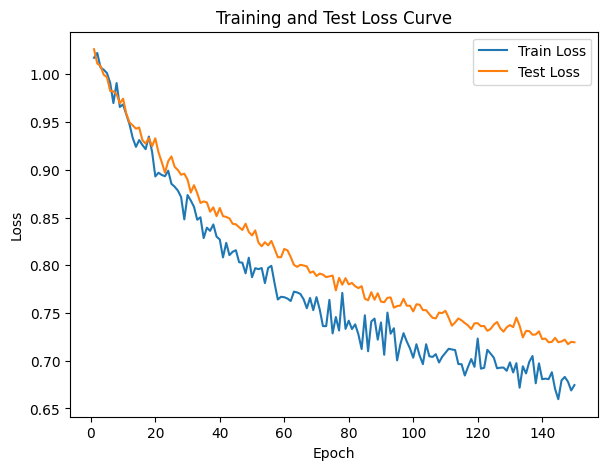

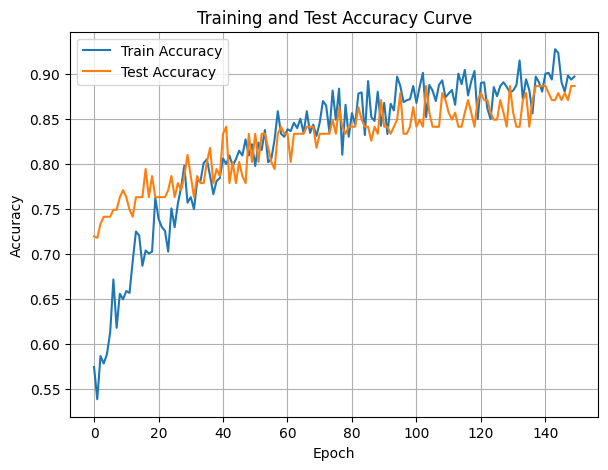

In [70]:
DTEmlp8b.train_single_model()

## Base 10

In [71]:
multiLayerPerceptron = MLP(input_size=input_size, hidden_layers=hidden_layers, output_size=output_size+1, dropout=.5) #hidden size default at 100

# Fill DTE params
modelSaveDirectory = './saved_models/'
DTEmlp10b = DeepTreeEnsemble(task_name='classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=10,
                                epochs=10,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.0001)

Randomly initializing 10 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.61it/s]

Epoch [1/10], Train F1:0.3669870778685247, Train Loss: 1.0799, Train Acc: 0.3970, Test F1:0.4124861021730382, Test Loss: 1.0660, Test Acc: 0.4410


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.42it/s]

Epoch [2/10], Train F1:0.351681936096736, Train Loss: 1.0811, Train Acc: 0.3994, Test F1:0.41797696387659666, Test Loss: 1.0648, Test Acc: 0.4418


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.67it/s]

Epoch [3/10], Train F1:0.35966841674629046, Train Loss: 1.0792, Train Acc: 0.4018, Test F1:0.4329934784605493, Test Loss: 1.0621, Test Acc: 0.4540


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.84it/s]

Epoch [4/10], Train F1:0.3721661540559178, Train Loss: 1.0748, Train Acc: 0.4114, Test F1:0.4926703811871275, Test Loss: 1.0575, Test Acc: 0.4963


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.02it/s]

Epoch [5/10], Train F1:0.37957567283275867, Train Loss: 1.0717, Train Acc: 0.4167, Test F1:0.5347610405323653, Test Loss: 1.0549, Test Acc: 0.5267


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.99it/s]

Epoch [6/10], Train F1:0.3896568500356427, Train Loss: 1.0684, Train Acc: 0.4255, Test F1:0.5198812926800538, Test Loss: 1.0540, Test Acc: 0.5161


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.70it/s]

Epoch [7/10], Train F1:0.39699673938308977, Train Loss: 1.0656, Train Acc: 0.4334, Test F1:0.5013516936386683, Test Loss: 1.0538, Test Acc: 0.5002
Epoch [8/10], Train F1:0.4114856373253027, Train Loss: 1.0621, Train Acc: 0.4431, Test F1:0.5224569569986888, Test Loss: 1.0522, Test Acc: 0.5158


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.47it/s]


Epoch [9/10], Train F1:0.41696561077982697, Train Loss: 1.0594, Train Acc: 0.4470, Test F1:0.5272729978234196, Test Loss: 1.0507, Test Acc: 0.5195
Epoch [10/10], Train F1:0.4253009154038872, Train Loss: 1.0579, Train Acc: 0.4515, Test F1:0.5418255209387203, Test Loss: 1.0483, Test Acc: 0.5308
Total Epochs: 10
Train loss start: 1.146677017211914, Train loss end: 1.1036525964736938
Highest Mean Train Accuracy (over epoch): 0.45145833333333335
Test loss start: 1.0748205184936523, Test loss end: 1.0211987495422363
Highest mean Test Accuracy (over epoch): 0.5308159722222221


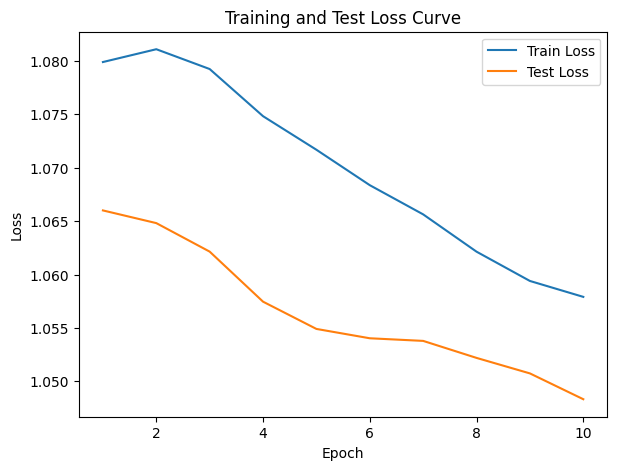

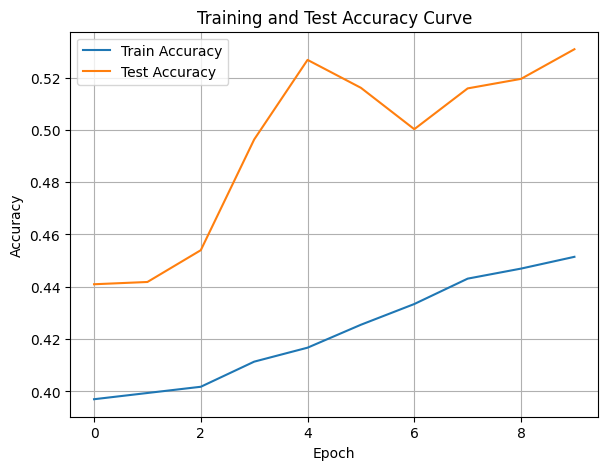

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.31778381314502985, Train Loss: 1.1683, Train Acc: 0.2229, Test F1:0.4935553168635875, Test Loss: 1.0967, Test Acc: 0.4601


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.44it/s]

Epoch [2/10], Train F1:0.316366654978653, Train Loss: 1.1672, Train Acc: 0.2246, Test F1:0.4950298332799171, Test Loss: 1.0884, Test Acc: 0.5004


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.44it/s]

Epoch [3/10], Train F1:0.33151556057757, Train Loss: 1.1643, Train Acc: 0.2401, Test F1:0.4991616570563939, Test Loss: 1.0854, Test Acc: 0.5211


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.41it/s]

Epoch [4/10], Train F1:0.3379211609683067, Train Loss: 1.1617, Train Acc: 0.2460, Test F1:0.49869405940732864, Test Loss: 1.0821, Test Acc: 0.5330


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.41it/s]

Epoch [5/10], Train F1:0.3469383021309004, Train Loss: 1.1588, Train Acc: 0.2545, Test F1:0.5006786010622705, Test Loss: 1.0769, Test Acc: 0.5448


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.61it/s]

Epoch [6/10], Train F1:0.3458805666342661, Train Loss: 1.1564, Train Acc: 0.2582, Test F1:0.5029260468022575, Test Loss: 1.0736, Test Acc: 0.5527


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.61it/s]

Epoch [7/10], Train F1:0.36014711226597357, Train Loss: 1.1513, Train Acc: 0.2719, Test F1:0.5070721324428225, Test Loss: 1.0703, Test Acc: 0.5614


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.25it/s]

Epoch [8/10], Train F1:0.36957638132182563, Train Loss: 1.1482, Train Acc: 0.2813, Test F1:0.5119943996088552, Test Loss: 1.0678, Test Acc: 0.5679


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.32it/s]

Epoch [9/10], Train F1:0.3792862462379861, Train Loss: 1.1442, Train Acc: 0.2917, Test F1:0.5205685036198823, Test Loss: 1.0648, Test Acc: 0.5763


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.73it/s]


Epoch [10/10], Train F1:0.38793908341220723, Train Loss: 1.1410, Train Acc: 0.2988, Test F1:0.5290732666872183, Test Loss: 1.0634, Test Acc: 0.5830
Total Epochs: 10
Train loss start: 1.1503195762634277, Train loss end: 1.224405288696289
Highest Mean Train Accuracy (over epoch): 0.29875
Test loss start: 1.0873562097549438, Test loss end: 1.0433595180511475
Highest mean Test Accuracy (over epoch): 0.5829861111111111


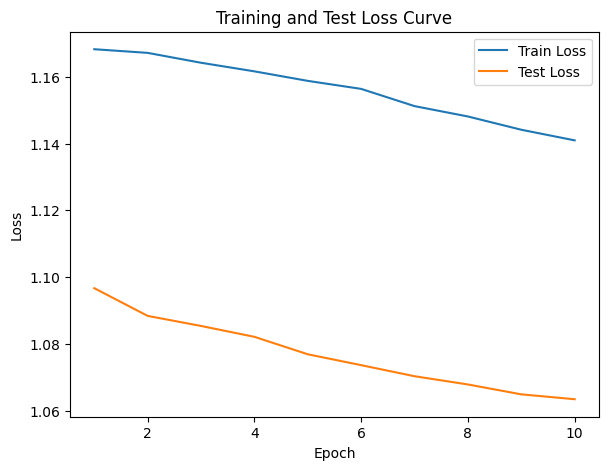

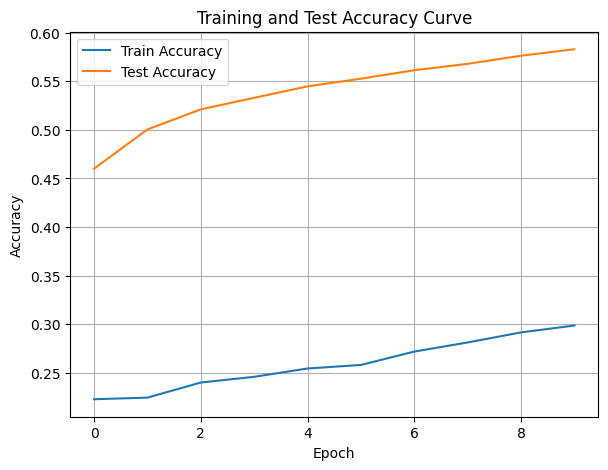

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.3117588319016675, Train Loss: 1.1086, Train Acc: 0.3723, Test F1:0.21807320024198426, Test Loss: 1.1057, Test Acc: 0.3394


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.97it/s]

Epoch [2/10], Train F1:0.30635054109388715, Train Loss: 1.1129, Train Acc: 0.3629, Test F1:0.20694282424880103, Test Loss: 1.1075, Test Acc: 0.3403


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.59it/s]

Epoch [3/10], Train F1:0.304164014328204, Train Loss: 1.1118, Train Acc: 0.3542, Test F1:0.20432587107120975, Test Loss: 1.1084, Test Acc: 0.3452


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.01it/s]

Epoch [4/10], Train F1:0.30499600819745015, Train Loss: 1.1116, Train Acc: 0.3548, Test F1:0.2072990591182043, Test Loss: 1.1057, Test Acc: 0.3496


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.14it/s]

Epoch [5/10], Train F1:0.31026142049855987, Train Loss: 1.1111, Train Acc: 0.3549, Test F1:0.21540921975001945, Test Loss: 1.1036, Test Acc: 0.3538


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.14it/s]

Epoch [6/10], Train F1:0.3186698208333576, Train Loss: 1.1078, Train Acc: 0.3626, Test F1:0.22366763491878966, Test Loss: 1.1011, Test Acc: 0.3579


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.53it/s]

Epoch [7/10], Train F1:0.32713022289081567, Train Loss: 1.1036, Train Acc: 0.3715, Test F1:0.23002141947585997, Test Loss: 1.0990, Test Acc: 0.3620


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.42it/s]

Epoch [8/10], Train F1:0.33644666779709204, Train Loss: 1.0980, Train Acc: 0.3781, Test F1:0.23431979993702226, Test Loss: 1.0978, Test Acc: 0.3640


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.46it/s]

Epoch [9/10], Train F1:0.3465320504248555, Train Loss: 1.0940, Train Acc: 0.3862, Test F1:0.23371856329016238, Test Loss: 1.0974, Test Acc: 0.3639


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.53it/s]


Epoch [10/10], Train F1:0.3523884363339852, Train Loss: 1.0915, Train Acc: 0.3906, Test F1:0.23335929787657486, Test Loss: 1.0969, Test Acc: 0.3638
Total Epochs: 10
Train loss start: 1.1292088031768799, Train loss end: 1.0528929233551025
Highest Mean Train Accuracy (over epoch): 0.390625
Test loss start: 1.1105976104736328, Test loss end: 1.0823167562484741
Highest mean Test Accuracy (over epoch): 0.3640407986111111


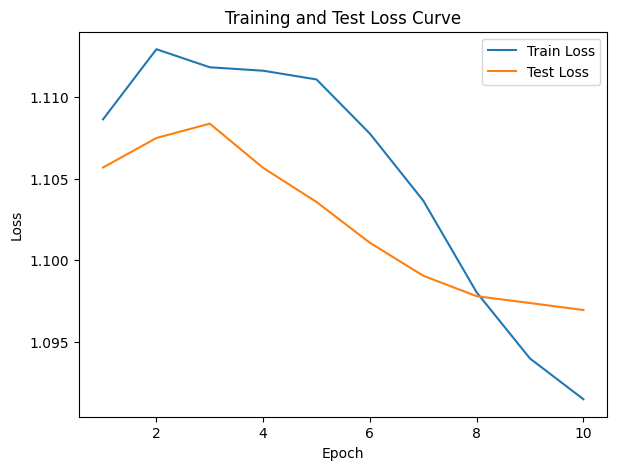

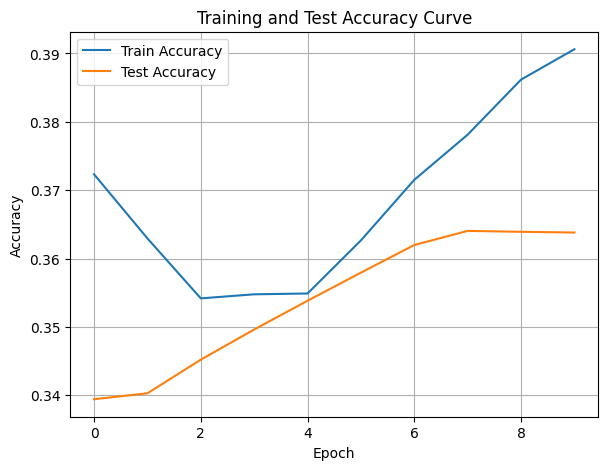

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4654900276718954, Train Loss: 1.0843, Train Acc: 0.4735, Test F1:0.5334636480336096, Test Loss: 1.0602, Test Acc: 0.6155


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.16it/s]

Epoch [2/10], Train F1:0.47042781595861544, Train Loss: 1.0836, Train Acc: 0.4798, Test F1:0.5320625449712304, Test Loss: 1.0557, Test Acc: 0.6263


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.33it/s]

Epoch [3/10], Train F1:0.47647934981746626, Train Loss: 1.0796, Train Acc: 0.4860, Test F1:0.5316058891583068, Test Loss: 1.0503, Test Acc: 0.6299
Epoch [4/10], Train F1:0.4801283058795648, Train Loss: 1.0774, Train Acc: 0.4896, Test F1:0.5324638046555176, Test Loss: 1.0467, Test Acc: 0.6352


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.33it/s]

Epoch [5/10], Train F1:0.4832994161857866, Train Loss: 1.0749, Train Acc: 0.4964, Test F1:0.5329751450180936, Test Loss: 1.0439, Test Acc: 0.6384


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.60it/s]

Epoch [6/10], Train F1:0.48680428758590144, Train Loss: 1.0725, Train Acc: 0.5009, Test F1:0.5340321042032246, Test Loss: 1.0416, Test Acc: 0.6418
Epoch [7/10], Train F1:0.49269819358715133, Train Loss: 1.0686, Train Acc: 0.5035, Test F1:0.5345770662274647, Test Loss: 1.0399, Test Acc: 0.6431


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.50it/s]

Epoch [8/10], Train F1:0.4973742314687552, Train Loss: 1.0653, Train Acc: 0.5086, Test F1:0.5355219412204975, Test Loss: 1.0381, Test Acc: 0.6451
Epoch [9/10], Train F1:0.5024081992157298, Train Loss: 1.0621, Train Acc: 0.5140, Test F1:0.5359389485484721, Test Loss: 1.0353, Test Acc: 0.6466


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.67it/s]


Epoch [10/10], Train F1:0.5084247979049634, Train Loss: 1.0590, Train Acc: 0.5207, Test F1:0.5365567139985918, Test Loss: 1.0342, Test Acc: 0.6478
Total Epochs: 10
Train loss start: 1.0834354162216187, Train loss end: 1.0623477697372437
Highest Mean Train Accuracy (over epoch): 0.5206845238095239
Test loss start: 1.0512481927871704, Test loss end: 1.027189016342163
Highest mean Test Accuracy (over epoch): 0.6478298611111111


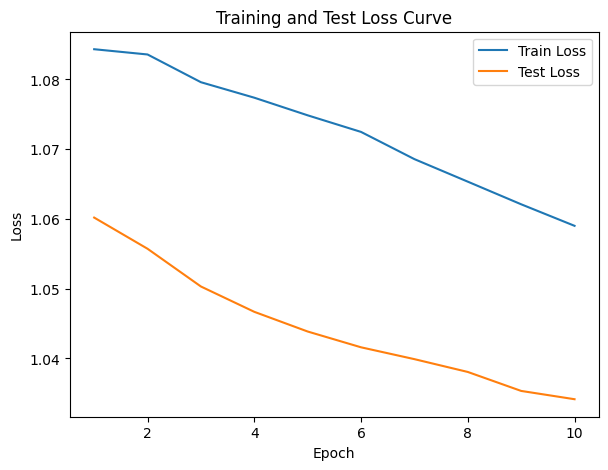

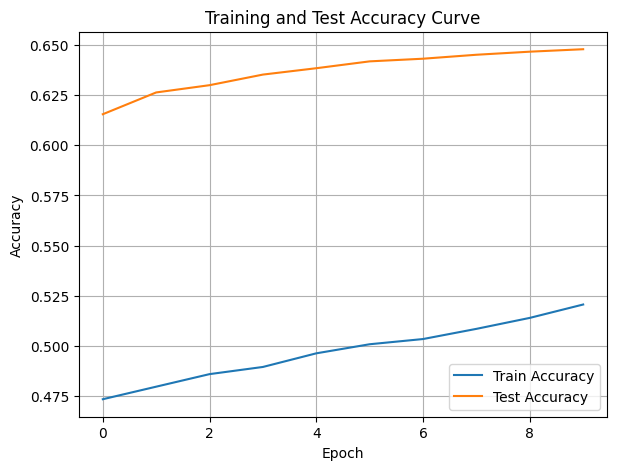

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.27277903944768167, Train Loss: 1.1451, Train Acc: 0.1982, Test F1:0.13835622648352147, Test Loss: 1.1321, Test Acc: 0.0842


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.61it/s]

Epoch [2/10], Train F1:0.276776352993321, Train Loss: 1.1491, Train Acc: 0.1918, Test F1:0.14126511246670137, Test Loss: 1.1354, Test Acc: 0.0842
Epoch [3/10], Train F1:0.29781452002731307, Train Loss: 1.1478, Train Acc: 0.2145, Test F1:0.1396567426300393, Test Loss: 1.1364, Test Acc: 0.0842


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.64it/s]

Epoch [4/10], Train F1:0.31335202170127335, Train Loss: 1.1426, Train Acc: 0.2257, Test F1:0.14105018400510497, Test Loss: 1.1350, Test Acc: 0.0862


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.37it/s]

Epoch [5/10], Train F1:0.32177768746462765, Train Loss: 1.1383, Train Acc: 0.2332, Test F1:0.15524643744128627, Test Loss: 1.1319, Test Acc: 0.0964
Epoch [6/10], Train F1:0.3324603740356558, Train Loss: 1.1356, Train Acc: 0.2445, Test F1:0.16286298056072243, Test Loss: 1.1306, Test Acc: 0.1019


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.37it/s]

Epoch [7/10], Train F1:0.34190598974169634, Train Loss: 1.1323, Train Acc: 0.2534, Test F1:0.1719950136096434, Test Loss: 1.1293, Test Acc: 0.1111


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.68it/s]

Epoch [8/10], Train F1:0.3537408848981549, Train Loss: 1.1293, Train Acc: 0.2640, Test F1:0.18279029693924362, Test Loss: 1.1275, Test Acc: 0.1210


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.68it/s]

Epoch [9/10], Train F1:0.36748063878230114, Train Loss: 1.1252, Train Acc: 0.2769, Test F1:0.20060338261676058, Test Loss: 1.1251, Test Acc: 0.1354


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.24it/s]


Epoch [10/10], Train F1:0.37383792248927983, Train Loss: 1.1228, Train Acc: 0.2834, Test F1:0.21350009481614288, Test Loss: 1.1233, Test Acc: 0.1464
Total Epochs: 10
Train loss start: 1.1686360836029053, Train loss end: 1.1164023876190186
Highest Mean Train Accuracy (over epoch): 0.28342261904761906
Test loss start: 1.1255110502243042, Test loss end: 1.1050938367843628
Highest mean Test Accuracy (over epoch): 0.14635416666666665


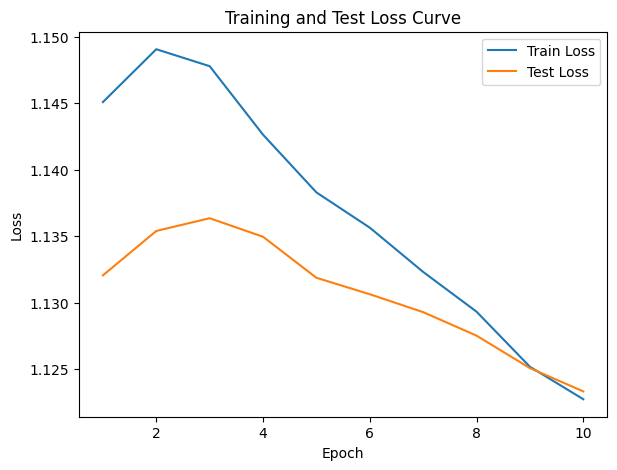

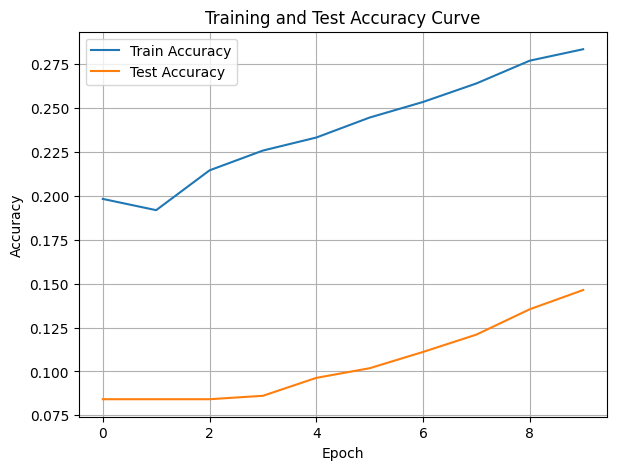

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.34it/s]

Epoch [1/10], Train F1:0.30480519694484143, Train Loss: 1.1662, Train Acc: 0.2232, Test F1:0.4670801090317034, Test Loss: 1.0976, Test Acc: 0.4418


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.42it/s]

Epoch [2/10], Train F1:0.33533311874616584, Train Loss: 1.1598, Train Acc: 0.2451, Test F1:0.4587934196818793, Test Loss: 1.0958, Test Acc: 0.4310


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.92it/s]

Epoch [3/10], Train F1:0.3509874031753641, Train Loss: 1.1561, Train Acc: 0.2604, Test F1:0.4669396463413238, Test Loss: 1.0946, Test Acc: 0.4352


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.54it/s]

Epoch [4/10], Train F1:0.3568186533284682, Train Loss: 1.1536, Train Acc: 0.2647, Test F1:0.47304065586614064, Test Loss: 1.0917, Test Acc: 0.4525


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.63it/s]

Epoch [5/10], Train F1:0.35921604230049026, Train Loss: 1.1518, Train Acc: 0.2672, Test F1:0.46930065204710447, Test Loss: 1.0908, Test Acc: 0.4491
Epoch [6/10], Train F1:0.36351322476784376, Train Loss: 1.1500, Train Acc: 0.2713, Test F1:0.4735545198218466, Test Loss: 1.0897, Test Acc: 0.4599


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.82it/s]

Epoch [7/10], Train F1:0.36810013892319915, Train Loss: 1.1473, Train Acc: 0.2750, Test F1:0.4796575635864145, Test Loss: 1.0880, Test Acc: 0.4696
Epoch [8/10], Train F1:0.3773382567040386, Train Loss: 1.1445, Train Acc: 0.2834, Test F1:0.49213826052478044, Test Loss: 1.0854, Test Acc: 0.4864


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.99it/s]


Epoch [9/10], Train F1:0.3857189237955151, Train Loss: 1.1410, Train Acc: 0.2929, Test F1:0.5017544205001825, Test Loss: 1.0830, Test Acc: 0.4993
Epoch [10/10], Train F1:0.38908991168584467, Train Loss: 1.1384, Train Acc: 0.2964, Test F1:0.5130519600102943, Test Loss: 1.0810, Test Acc: 0.5129
Total Epochs: 10
Train loss start: 1.159003496170044, Train loss end: 1.124091386795044
Highest Mean Train Accuracy (over epoch): 0.2963690476190476
Test loss start: 1.0949116945266724, Test loss end: 1.040717601776123
Highest mean Test Accuracy (over epoch): 0.5129340277777777


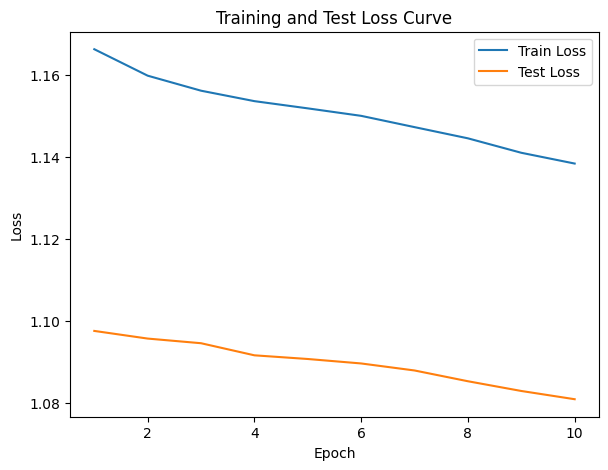

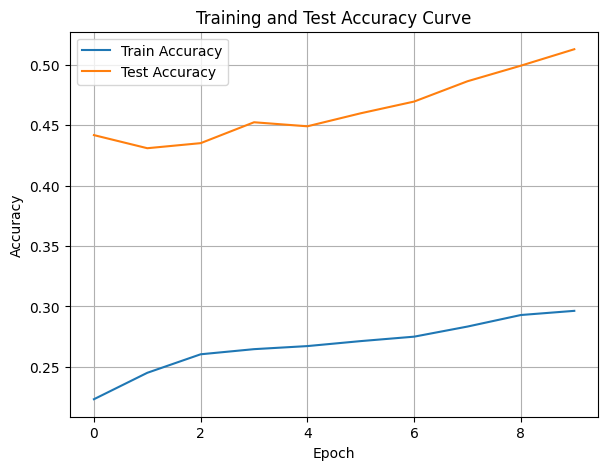

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.95it/s]

Epoch [1/10], Train F1:0.4897552177521689, Train Loss: 1.0162, Train Acc: 0.5818, Test F1:0.5348800051129645, Test Loss: 1.0558, Test Acc: 0.6493
Epoch [2/10], Train F1:0.49314732884485485, Train Loss: 1.0190, Train Acc: 0.5808, Test F1:0.524773200192205, Test Loss: 1.0496, Test Acc: 0.6337


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.95it/s]

Epoch [3/10], Train F1:0.4961926284512142, Train Loss: 1.0169, Train Acc: 0.5832, Test F1:0.5273170783668338, Test Loss: 1.0449, Test Acc: 0.6441


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.10it/s]

Epoch [4/10], Train F1:0.4945957396878893, Train Loss: 1.0129, Train Acc: 0.5856, Test F1:0.5316842760546162, Test Loss: 1.0420, Test Acc: 0.6493


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.10it/s]

Epoch [5/10], Train F1:0.5004621412663864, Train Loss: 1.0114, Train Acc: 0.5868, Test F1:0.535306150752375, Test Loss: 1.0381, Test Acc: 0.6540


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.38it/s]

Epoch [6/10], Train F1:0.5067643883526849, Train Loss: 1.0086, Train Acc: 0.5919, Test F1:0.5399070799528466, Test Loss: 1.0351, Test Acc: 0.6571


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.38it/s]

Epoch [7/10], Train F1:0.5092174248110056, Train Loss: 1.0067, Train Acc: 0.5940, Test F1:0.54246962371643, Test Loss: 1.0333, Test Acc: 0.6582


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.95it/s]

Epoch [8/10], Train F1:0.5109093942938627, Train Loss: 1.0036, Train Acc: 0.5971, Test F1:0.545658241453436, Test Loss: 1.0303, Test Acc: 0.6618


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.95it/s]

Epoch [9/10], Train F1:0.513313083546708, Train Loss: 1.0005, Train Acc: 0.6005, Test F1:0.5481449971460051, Test Loss: 1.0277, Test Acc: 0.6645


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.00it/s]


Epoch [10/10], Train F1:0.5183176442593788, Train Loss: 0.9976, Train Acc: 0.6037, Test F1:0.550138677200341, Test Loss: 1.0253, Test Acc: 0.6668
Total Epochs: 10
Train loss start: 1.0578293800354004, Train loss end: 0.9282897114753723
Highest Mean Train Accuracy (over epoch): 0.6036607142857142
Test loss start: 1.0612130165100098, Test loss end: 0.9752072095870972
Highest mean Test Accuracy (over epoch): 0.6667534722222221


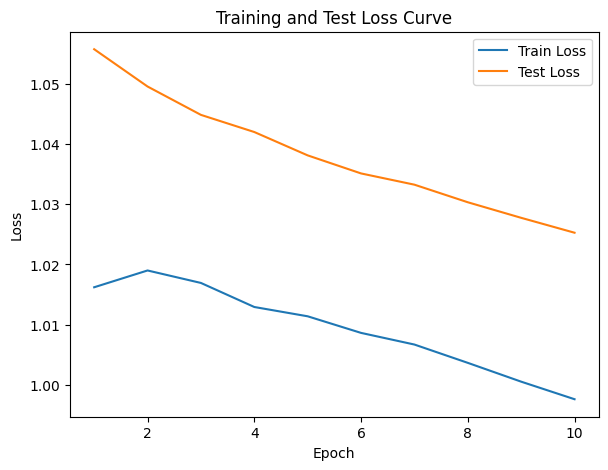

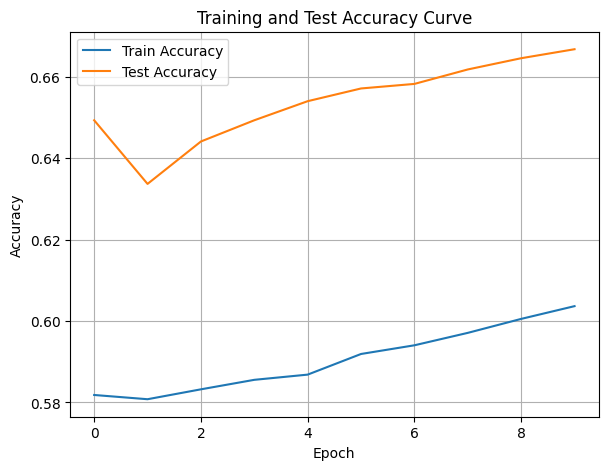

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.3946030157723048, Train Loss: 1.0868, Train Acc: 0.3827, Test F1:0.625538204485573, Test Loss: 1.0625, Test Acc: 0.5998


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.91it/s]

Epoch [2/10], Train F1:0.40253115218263624, Train Loss: 1.0861, Train Acc: 0.3927, Test F1:0.6528148327808769, Test Loss: 1.0592, Test Acc: 0.6302


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.38it/s]

Epoch [3/10], Train F1:0.40523204709487526, Train Loss: 1.0883, Train Acc: 0.3890, Test F1:0.6707231741368216, Test Loss: 1.0577, Test Acc: 0.6481
Epoch [4/10], Train F1:0.4225332273892643, Train Loss: 1.0809, Train Acc: 0.4054, Test F1:0.6806928802897755, Test Loss: 1.0568, Test Acc: 0.6591


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.55it/s]

Epoch [5/10], Train F1:0.4375107883936622, Train Loss: 1.0772, Train Acc: 0.4171, Test F1:0.6850194006955872, Test Loss: 1.0547, Test Acc: 0.6684
Epoch [6/10], Train F1:0.435807296390642, Train Loss: 1.0769, Train Acc: 0.4140, Test F1:0.6888329539792413, Test Loss: 1.0525, Test Acc: 0.6736


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.02it/s]

Epoch [7/10], Train F1:0.4394750817039357, Train Loss: 1.0754, Train Acc: 0.4205, Test F1:0.6983066162484576, Test Loss: 1.0499, Test Acc: 0.6818
Epoch [8/10], Train F1:0.4438277743078414, Train Loss: 1.0719, Train Acc: 0.4258, Test F1:0.7039191956838894, Test Loss: 1.0473, Test Acc: 0.6887


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.06it/s]


Epoch [9/10], Train F1:0.4533380209815335, Train Loss: 1.0683, Train Acc: 0.4349, Test F1:0.7086321296775369, Test Loss: 1.0450, Test Acc: 0.6941
Epoch [10/10], Train F1:0.4567811064350122, Train Loss: 1.0663, Train Acc: 0.4376, Test F1:0.7133099800686012, Test Loss: 1.0431, Test Acc: 0.6991
Total Epochs: 10
Train loss start: 1.129649043083191, Train loss end: 1.045512080192566
Highest Mean Train Accuracy (over epoch): 0.4376190476190476
Test loss start: 1.0748543739318848, Test loss end: 1.0171494483947754
Highest mean Test Accuracy (over epoch): 0.6991319444444445


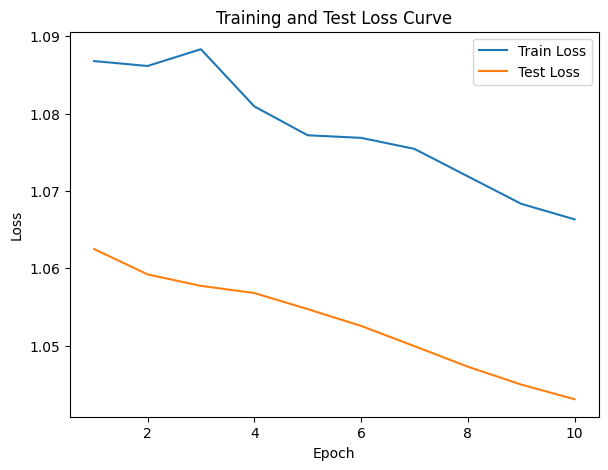

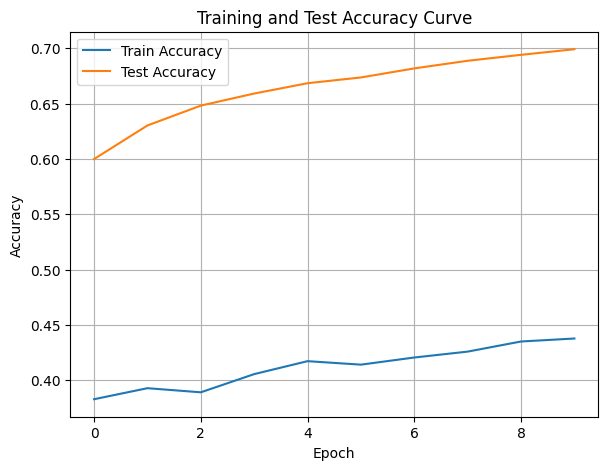

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.24it/s]

Epoch [1/10], Train F1:0.22428363375007096, Train Loss: 1.1956, Train Acc: 0.1679, Test F1:0.19659076769939032, Test Loss: 1.1358, Test Acc: 0.1276


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.15it/s]

Epoch [2/10], Train F1:0.22893599209388685, Train Loss: 1.1992, Train Acc: 0.1720, Test F1:0.14414230534912995, Test Loss: 1.1405, Test Acc: 0.0903


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.42it/s]

Epoch [3/10], Train F1:0.23602299249708744, Train Loss: 1.1969, Train Acc: 0.1776, Test F1:0.11184180992789566, Test Loss: 1.1420, Test Acc: 0.0680


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.85it/s]

Epoch [4/10], Train F1:0.24205075402828022, Train Loss: 1.1903, Train Acc: 0.1867, Test F1:0.15317993717604522, Test Loss: 1.1366, Test Acc: 0.0981


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.11it/s]

Epoch [5/10], Train F1:0.25759444691328287, Train Loss: 1.1865, Train Acc: 0.1992, Test F1:0.23664679051919252, Test Loss: 1.1298, Test Acc: 0.1576


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.23it/s]

Epoch [6/10], Train F1:0.26669112850813226, Train Loss: 1.1830, Train Acc: 0.2060, Test F1:0.28213119807033504, Test Loss: 1.1261, Test Acc: 0.1934


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.53it/s]

Epoch [7/10], Train F1:0.2755836498614426, Train Loss: 1.1805, Train Acc: 0.2105, Test F1:0.2887584319391171, Test Loss: 1.1240, Test Acc: 0.1992


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.51it/s]

Epoch [8/10], Train F1:0.2853789090119025, Train Loss: 1.1759, Train Acc: 0.2191, Test F1:0.31504515335353744, Test Loss: 1.1215, Test Acc: 0.2208


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.79it/s]

Epoch [9/10], Train F1:0.28330291505120514, Train Loss: 1.1744, Train Acc: 0.2182, Test F1:0.32198544750823277, Test Loss: 1.1206, Test Acc: 0.2257


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.10it/s]


Epoch [10/10], Train F1:0.29660063436363987, Train Loss: 1.1693, Train Acc: 0.2292, Test F1:0.34488238384030734, Test Loss: 1.1183, Test Acc: 0.2451
Total Epochs: 10
Train loss start: 1.2110979557037354, Train loss end: 1.1052497625350952
Highest Mean Train Accuracy (over epoch): 0.22922619047619047
Test loss start: 1.1270238161087036, Test loss end: 1.1061320304870605
Highest mean Test Accuracy (over epoch): 0.2450520833333333


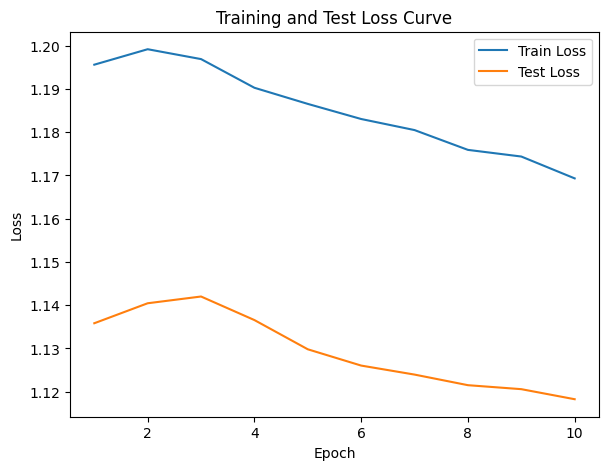

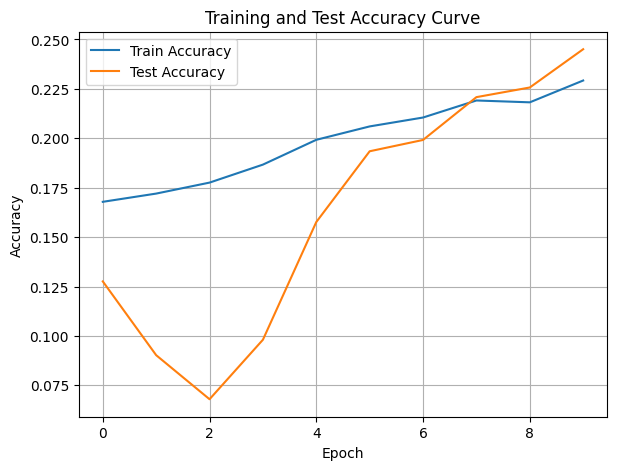

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.83it/s]

Epoch [1/10], Train F1:0.375459521895807, Train Loss: 1.1418, Train Acc: 0.2982, Test F1:0.23604465709728872, Test Loss: 1.1162, Test Acc: 0.1589
Epoch [2/10], Train F1:0.3778330191899755, Train Loss: 1.1433, Train Acc: 0.3024, Test F1:0.3401516892668352, Test Loss: 1.1098, Test Acc: 0.2648


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.83it/s]

Epoch [3/10], Train F1:0.39024107967424976, Train Loss: 1.1400, Train Acc: 0.3163, Test F1:0.38455428187956237, Test Loss: 1.1066, Test Acc: 0.3177


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.77it/s]

Epoch [4/10], Train F1:0.3907022458746596, Train Loss: 1.1385, Train Acc: 0.3193, Test F1:0.40850768167522233, Test Loss: 1.1040, Test Acc: 0.3466


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.77it/s]

Epoch [5/10], Train F1:0.3993018947882273, Train Loss: 1.1351, Train Acc: 0.3268, Test F1:0.42507556869733504, Test Loss: 1.1016, Test Acc: 0.3710


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.88it/s]

Epoch [6/10], Train F1:0.4078722880786271, Train Loss: 1.1295, Train Acc: 0.3377, Test F1:0.44880776907455083, Test Loss: 1.0974, Test Acc: 0.4006


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.88it/s]

Epoch [7/10], Train F1:0.41513427818281984, Train Loss: 1.1265, Train Acc: 0.3457, Test F1:0.4670813093713709, Test Loss: 1.0941, Test Acc: 0.4257


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.09it/s]

Epoch [8/10], Train F1:0.42795308065646626, Train Loss: 1.1215, Train Acc: 0.3587, Test F1:0.48076975030285907, Test Loss: 1.0900, Test Acc: 0.4492


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.09it/s]

Epoch [9/10], Train F1:0.4337737792040661, Train Loss: 1.1167, Train Acc: 0.3678, Test F1:0.491503535100646, Test Loss: 1.0880, Test Acc: 0.4635


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.35it/s]


Epoch [10/10], Train F1:0.43879224652190024, Train Loss: 1.1137, Train Acc: 0.3736, Test F1:0.5011472031871607, Test Loss: 1.0856, Test Acc: 0.4750
Total Epochs: 10
Train loss start: 1.1340444087982178, Train loss end: 1.0235151052474976
Highest Mean Train Accuracy (over epoch): 0.37363095238095234
Test loss start: 1.099523663520813, Test loss end: 1.0590147972106934
Highest mean Test Accuracy (over epoch): 0.475


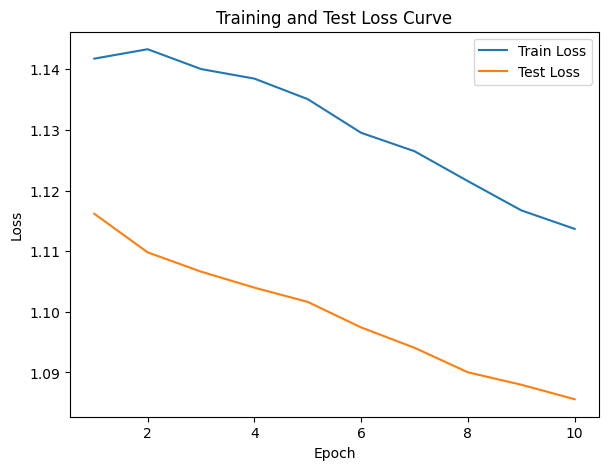

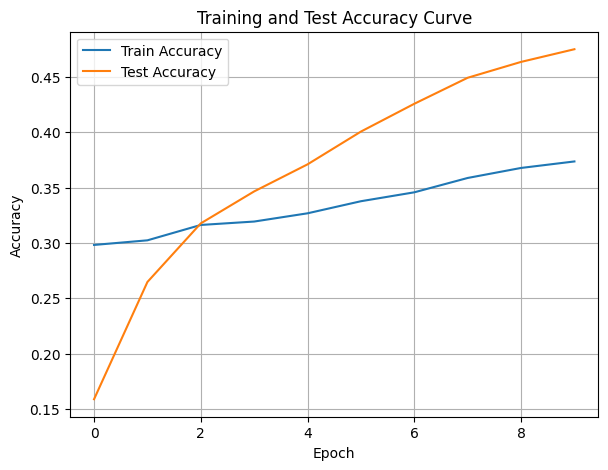

./saved_models/model_10.pth
Training Model with id 14
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.29it/s]

Epoch [1/10], Train F1:0.5266612440382933, Train Loss: 1.0749, Train Acc: 0.4711, Test F1:0.5932636863810954, Test Loss: 1.0460, Test Acc: 0.6450
Epoch [2/10], Train F1:0.5341067117380626, Train Loss: 1.0693, Train Acc: 0.4869, Test F1:0.5999907542241638, Test Loss: 1.0512, Test Acc: 0.6302


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.04it/s]

Epoch [3/10], Train F1:0.5396400820837467, Train Loss: 1.0662, Train Acc: 0.4980, Test F1:0.609680626960719, Test Loss: 1.0456, Test Acc: 0.6455
Epoch [4/10], Train F1:0.5349417411560757, Train Loss: 1.0648, Train Acc: 0.4973, Test F1:0.6247487920335707, Test Loss: 1.0432, Test Acc: 0.6567


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.55it/s]

Epoch [5/10], Train F1:0.5377885695337925, Train Loss: 1.0624, Train Acc: 0.5049, Test F1:0.6441156511051899, Test Loss: 1.0397, Test Acc: 0.6708
Epoch [6/10], Train F1:0.5496284075064144, Train Loss: 1.0547, Train Acc: 0.5142, Test F1:0.6443571048834207, Test Loss: 1.0367, Test Acc: 0.6753


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.60it/s]

Epoch [7/10], Train F1:0.5522806797347333, Train Loss: 1.0539, Train Acc: 0.5178, Test F1:0.6459429099036591, Test Loss: 1.0361, Test Acc: 0.6786
Epoch [8/10], Train F1:0.5569408527860881, Train Loss: 1.0505, Train Acc: 0.5224, Test F1:0.6500318883168958, Test Loss: 1.0324, Test Acc: 0.6837


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.35it/s]


Epoch [9/10], Train F1:0.5651122308691419, Train Loss: 1.0453, Train Acc: 0.5316, Test F1:0.6516706737746958, Test Loss: 1.0290, Test Acc: 0.6861
Epoch [10/10], Train F1:0.572487454292154, Train Loss: 1.0402, Train Acc: 0.5404, Test F1:0.6548742138364779, Test Loss: 1.0270, Test Acc: 0.6901
Total Epochs: 10
Train loss start: 1.0491223335266113, Train loss end: 0.9435449838638306
Highest Mean Train Accuracy (over epoch): 0.5404166666666667
Test loss start: 1.0264949798583984, Test loss end: 0.9905287623405457
Highest mean Test Accuracy (over epoch): 0.6901041666666667


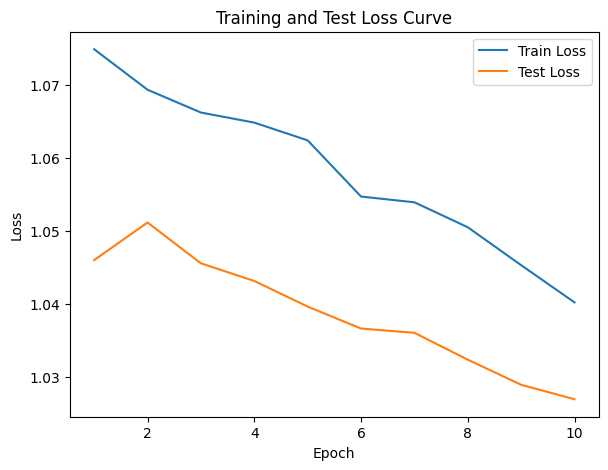

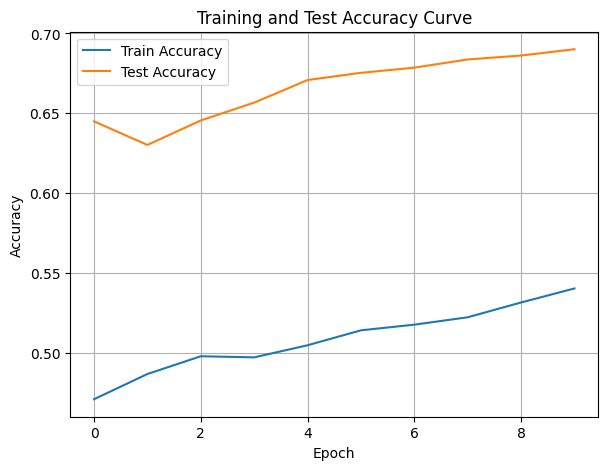

./saved_models/model_14.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.6336692464620239, Train Loss: 0.9939, Train Acc: 0.6152, Test F1:0.7163697256459683, Test Loss: 0.9962, Test Acc: 0.7491


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.84it/s]

Epoch [2/10], Train F1:0.6315793868147027, Train Loss: 0.9884, Train Acc: 0.6162, Test F1:0.7057363820678308, Test Loss: 0.9955, Test Acc: 0.7413


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.90it/s]

Epoch [3/10], Train F1:0.6438107804979593, Train Loss: 0.9844, Train Acc: 0.6306, Test F1:0.7285673824092135, Test Loss: 0.9896, Test Acc: 0.7590
Epoch [4/10], Train F1:0.6460994446966659, Train Loss: 0.9829, Train Acc: 0.6382, Test F1:0.7417704998362697, Test Loss: 0.9904, Test Acc: 0.7697


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.90it/s]

Epoch [5/10], Train F1:0.6495608626826146, Train Loss: 0.9777, Train Acc: 0.6426, Test F1:0.7399769793265324, Test Loss: 0.9881, Test Acc: 0.7700


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.44it/s]

Epoch [6/10], Train F1:0.6492204361983526, Train Loss: 0.9769, Train Acc: 0.6438, Test F1:0.7424706581470125, Test Loss: 0.9857, Test Acc: 0.7727
Epoch [7/10], Train F1:0.6554020554156824, Train Loss: 0.9729, Train Acc: 0.6500, Test F1:0.7518435488271998, Test Loss: 0.9839, Test Acc: 0.7783


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.29it/s]

Epoch [8/10], Train F1:0.6560774514387242, Train Loss: 0.9714, Train Acc: 0.6509, Test F1:0.7494886588702183, Test Loss: 0.9814, Test Acc: 0.7766


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.29it/s]

Epoch [9/10], Train F1:0.6577079576983208, Train Loss: 0.9691, Train Acc: 0.6535, Test F1:0.7500536833625344, Test Loss: 0.9791, Test Acc: 0.7777


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.39it/s]


Epoch [10/10], Train F1:0.6603567025563402, Train Loss: 0.9665, Train Acc: 0.6553, Test F1:0.7566632740876819, Test Loss: 0.9769, Test Acc: 0.7825
Total Epochs: 10
Train loss start: 0.9824323654174805, Train loss end: 0.9728937745094299
Highest Mean Train Accuracy (over epoch): 0.6552976190476191
Test loss start: 0.9797298908233643, Test loss end: 0.9365272521972656
Highest mean Test Accuracy (over epoch): 0.7824652777777777


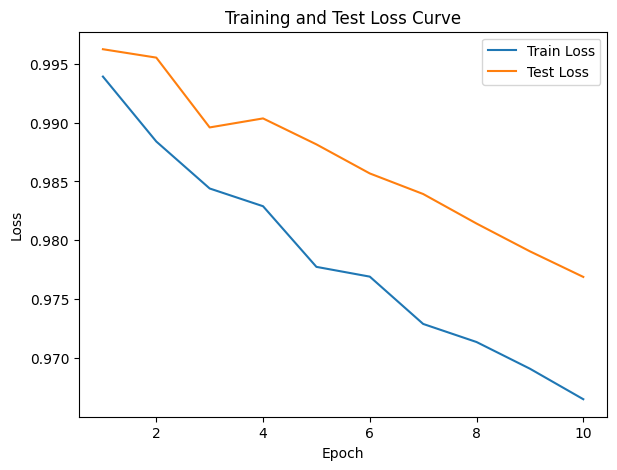

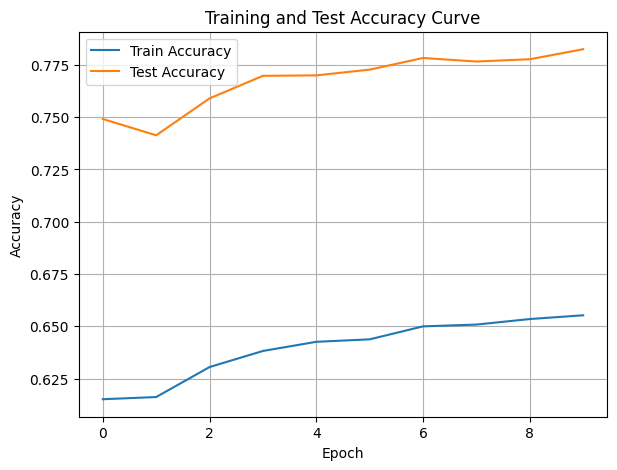

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.92it/s]

Epoch [1/10], Train F1:0.6531629527046876, Train Loss: 0.9466, Train Acc: 0.6348, Test F1:0.7782131883380768, Test Loss: 0.9523, Test Acc: 0.8021


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.92it/s]

Epoch [2/10], Train F1:0.6830206920669685, Train Loss: 0.9306, Train Acc: 0.6746, Test F1:0.8009986451413939, Test Loss: 0.9499, Test Acc: 0.8177


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.88it/s]

Epoch [3/10], Train F1:0.6823264706495105, Train Loss: 0.9263, Train Acc: 0.6795, Test F1:0.8047107972012089, Test Loss: 0.9457, Test Acc: 0.8203


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.02it/s]

Epoch [4/10], Train F1:0.6989979488563057, Train Loss: 0.9215, Train Acc: 0.6897, Test F1:0.8152343043089263, Test Loss: 0.9474, Test Acc: 0.8275


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.21it/s]

Epoch [5/10], Train F1:0.7053079227056267, Train Loss: 0.9171, Train Acc: 0.6979, Test F1:0.8008054821167171, Test Loss: 0.9430, Test Acc: 0.8165


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.67it/s]

Epoch [6/10], Train F1:0.7109153447866741, Train Loss: 0.9142, Train Acc: 0.7048, Test F1:0.7984229028508844, Test Loss: 0.9406, Test Acc: 0.8154


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.89it/s]

Epoch [7/10], Train F1:0.7162914161762884, Train Loss: 0.9101, Train Acc: 0.7117, Test F1:0.8046098435155217, Test Loss: 0.9389, Test Acc: 0.8202


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.67it/s]

Epoch [8/10], Train F1:0.7187355832626428, Train Loss: 0.9085, Train Acc: 0.7147, Test F1:0.8092106393427564, Test Loss: 0.9376, Test Acc: 0.8238


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.82it/s]

Epoch [9/10], Train F1:0.7205030769221559, Train Loss: 0.9070, Train Acc: 0.7183, Test F1:0.8103532733525102, Test Loss: 0.9354, Test Acc: 0.8248


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.82it/s]


Epoch [10/10], Train F1:0.724116190794611, Train Loss: 0.9036, Train Acc: 0.7228, Test F1:0.8112661314302707, Test Loss: 0.9332, Test Acc: 0.8257
Total Epochs: 10
Train loss start: 0.8700602054595947, Train loss end: 0.812118649482727
Highest Mean Train Accuracy (over epoch): 0.7227976190476191
Test loss start: 0.9350928664207458, Test loss end: 0.8941223621368408
Highest mean Test Accuracy (over epoch): 0.8274739583333334


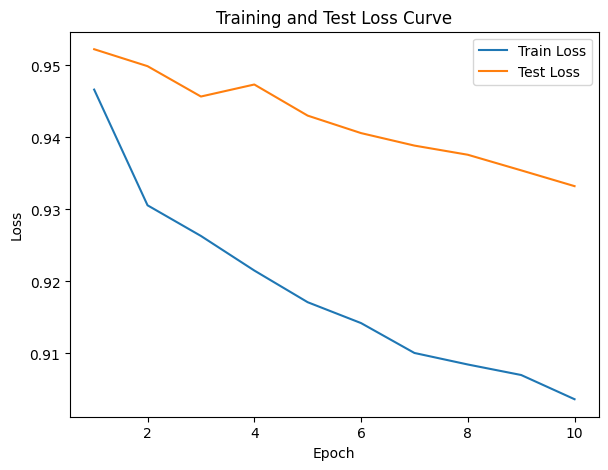

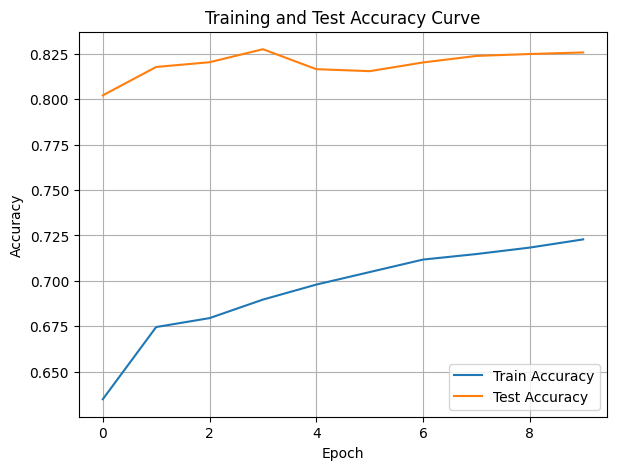

./saved_models/model_15.pth
Training Model with id 13
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.70it/s]

Epoch [1/10], Train F1:0.7799063965028309, Train Loss: 0.8654, Train Acc: 0.7652, Test F1:0.7264430124180656, Test Loss: 0.8918, Test Acc: 0.7587


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.29it/s]

Epoch [2/10], Train F1:0.75581852620853, Train Loss: 0.8734, Train Acc: 0.7570, Test F1:0.7631685705135048, Test Loss: 0.8950, Test Acc: 0.7882


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.22it/s]

Epoch [3/10], Train F1:0.7560787828552307, Train Loss: 0.8661, Train Acc: 0.7637, Test F1:0.7787231323857451, Test Loss: 0.8957, Test Acc: 0.8006


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.94it/s]

Epoch [4/10], Train F1:0.7653520992612076, Train Loss: 0.8652, Train Acc: 0.7656, Test F1:0.7806372275600854, Test Loss: 0.8960, Test Acc: 0.8030


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.39it/s]

Epoch [5/10], Train F1:0.7686316843793909, Train Loss: 0.8626, Train Acc: 0.7695, Test F1:0.7908629070027643, Test Loss: 0.8965, Test Acc: 0.8106


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.79it/s]

Epoch [6/10], Train F1:0.7753203582471294, Train Loss: 0.8588, Train Acc: 0.7757, Test F1:0.7938579209285856, Test Loss: 0.8958, Test Acc: 0.8131


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.93it/s]

Epoch [7/10], Train F1:0.7787611195788549, Train Loss: 0.8561, Train Acc: 0.7792, Test F1:0.800751496733096, Test Loss: 0.8952, Test Acc: 0.8182


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.93it/s]

Epoch [8/10], Train F1:0.7802324468228424, Train Loss: 0.8544, Train Acc: 0.7803, Test F1:0.8031189083820663, Test Loss: 0.8939, Test Acc: 0.8201


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.77it/s]

Epoch [9/10], Train F1:0.7823712615298857, Train Loss: 0.8517, Train Acc: 0.7843, Test F1:0.8049536721617726, Test Loss: 0.8924, Test Acc: 0.8216


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.61it/s]


Epoch [10/10], Train F1:0.783544186647499, Train Loss: 0.8509, Train Acc: 0.7845, Test F1:0.8075128252997527, Test Loss: 0.8906, Test Acc: 0.8235
Total Epochs: 10
Train loss start: 0.8770056366920471, Train loss end: 0.941037118434906
Highest Mean Train Accuracy (over epoch): 0.7844940476190476
Test loss start: 0.8756159543991089, Test loss end: 0.8553381562232971
Highest mean Test Accuracy (over epoch): 0.8235243055555557


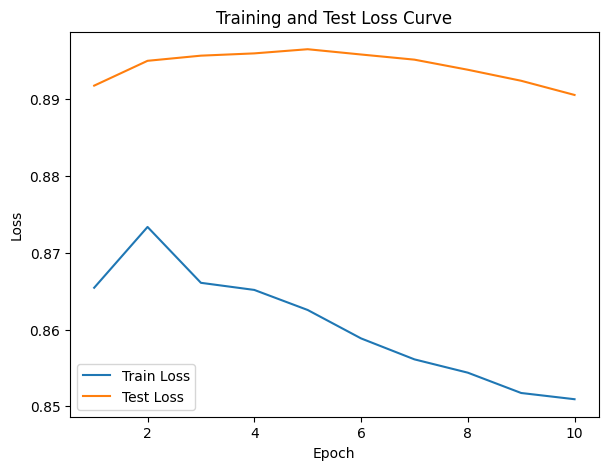

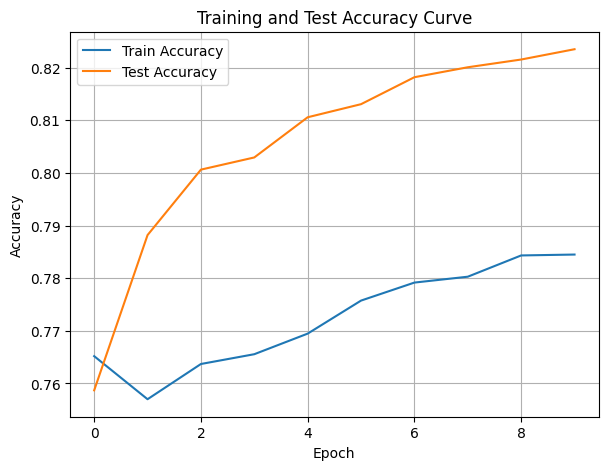

./saved_models/model_13.pth
Training Model with id 15
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.95it/s]

Epoch [1/10], Train F1:0.8107289466820448, Train Loss: 0.8210, Train Acc: 0.8250, Test F1:0.8808197688643266, Test Loss: 0.8822, Test Acc: 0.8802
Epoch [2/10], Train F1:0.8089363094568018, Train Loss: 0.8260, Train Acc: 0.8202, Test F1:0.8808197688643266, Test Loss: 0.8814, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.95it/s]

Epoch [3/10], Train F1:0.8121101743084502, Train Loss: 0.8249, Train Acc: 0.8196, Test F1:0.8709623323013416, Test Loss: 0.8754, Test Acc: 0.8724


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.27it/s]

Epoch [4/10], Train F1:0.811012545728859, Train Loss: 0.8214, Train Acc: 0.8186, Test F1:0.865982887297857, Test Loss: 0.8728, Test Acc: 0.8685


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.35it/s]

Epoch [5/10], Train F1:0.8122235093387419, Train Loss: 0.8185, Train Acc: 0.8196, Test F1:0.8609681243992526, Test Loss: 0.8689, Test Acc: 0.8646
Epoch [6/10], Train F1:0.8154065636836514, Train Loss: 0.8169, Train Acc: 0.8228, Test F1:0.8643152806217508, Test Loss: 0.8686, Test Acc: 0.8672


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.85it/s]

Epoch [7/10], Train F1:0.8138682637666165, Train Loss: 0.8161, Train Acc: 0.8193, Test F1:0.8666963721847094, Test Loss: 0.8689, Test Acc: 0.8690
Epoch [8/10], Train F1:0.8138450755200134, Train Loss: 0.8150, Train Acc: 0.8189, Test F1:0.8684769531002642, Test Loss: 0.8680, Test Acc: 0.8704


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.23it/s]


Epoch [9/10], Train F1:0.8129041149074739, Train Loss: 0.8134, Train Acc: 0.8180, Test F1:0.8632013418091197, Test Loss: 0.8661, Test Acc: 0.8663
Epoch [10/10], Train F1:0.8140510025415348, Train Loss: 0.8118, Train Acc: 0.8194, Test F1:0.8599608319817226, Test Loss: 0.8633, Test Acc: 0.8638
Total Epochs: 10
Train loss start: 0.8914514183998108, Train loss end: 0.8088662028312683
Highest Mean Train Accuracy (over epoch): 0.825
Test loss start: 0.8710036873817444, Test loss end: 0.8252109289169312
Highest mean Test Accuracy (over epoch): 0.8802083333333334


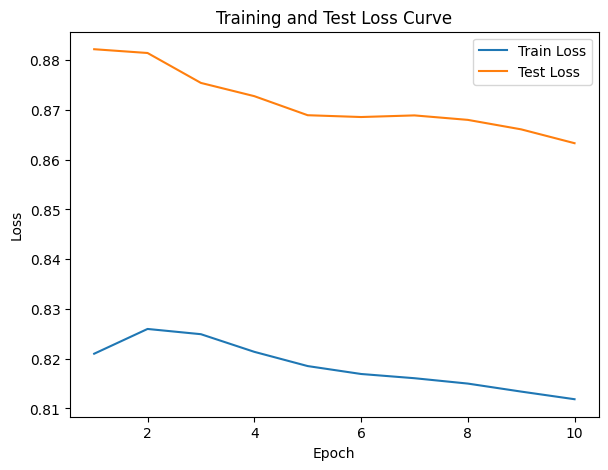

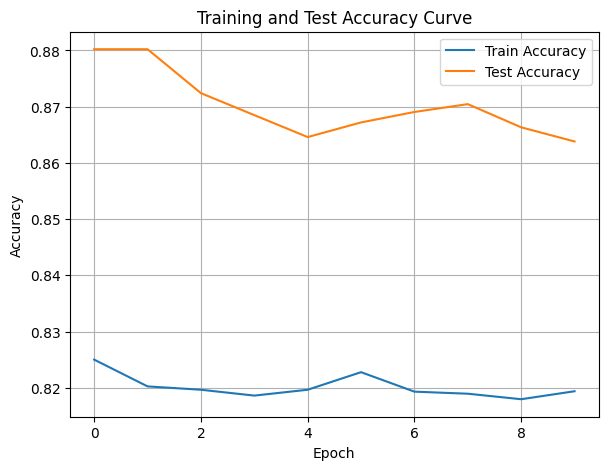

./saved_models/model_15.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.28it/s]

Epoch [1/10], Train F1:0.861737131020695, Train Loss: 0.7865, Train Acc: 0.8560, Test F1:0.8808197688643266, Test Loss: 0.8410, Test Acc: 0.8802


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.70it/s]

Epoch [2/10], Train F1:0.8472610264627416, Train Loss: 0.7837, Train Acc: 0.8482, Test F1:0.8759075915539942, Test Loss: 0.8419, Test Acc: 0.8763
Epoch [3/10], Train F1:0.8384056047409496, Train Loss: 0.7840, Train Acc: 0.8439, Test F1:0.8709623323013416, Test Loss: 0.8395, Test Acc: 0.8724


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.70it/s]

Epoch [4/10], Train F1:0.8383534252643415, Train Loss: 0.7817, Train Acc: 0.8423, Test F1:0.8584471369172867, Test Loss: 0.8381, Test Acc: 0.8626


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.91it/s]

Epoch [5/10], Train F1:0.8398262806028476, Train Loss: 0.7797, Train Acc: 0.8440, Test F1:0.8609681243992526, Test Loss: 0.8379, Test Acc: 0.8646
Epoch [6/10], Train F1:0.8396832891543614, Train Loss: 0.7810, Train Acc: 0.8388, Test F1:0.8592884884434354, Test Loss: 0.8366, Test Acc: 0.8633


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.98it/s]

Epoch [7/10], Train F1:0.8426760305055743, Train Loss: 0.7774, Train Acc: 0.8423, Test F1:0.8566407663352997, Test Loss: 0.8346, Test Acc: 0.8612
Epoch [8/10], Train F1:0.8415308358259398, Train Loss: 0.7778, Train Acc: 0.8402, Test F1:0.8597087797908087, Test Loss: 0.8349, Test Acc: 0.8636


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.27it/s]


Epoch [9/10], Train F1:0.8415181501976644, Train Loss: 0.7757, Train Acc: 0.8420, Test F1:0.8609681243992524, Test Loss: 0.8331, Test Acc: 0.8646
Epoch [10/10], Train F1:0.841718728993902, Train Loss: 0.7757, Train Acc: 0.8421, Test F1:0.8599608319817226, Test Loss: 0.8314, Test Acc: 0.8638
Total Epochs: 10
Train loss start: 0.8382008075714111, Train loss end: 0.818548858165741
Highest Mean Train Accuracy (over epoch): 0.8559523809523809
Test loss start: 0.8329315781593323, Test loss end: 0.8055096864700317
Highest mean Test Accuracy (over epoch): 0.8802083333333334


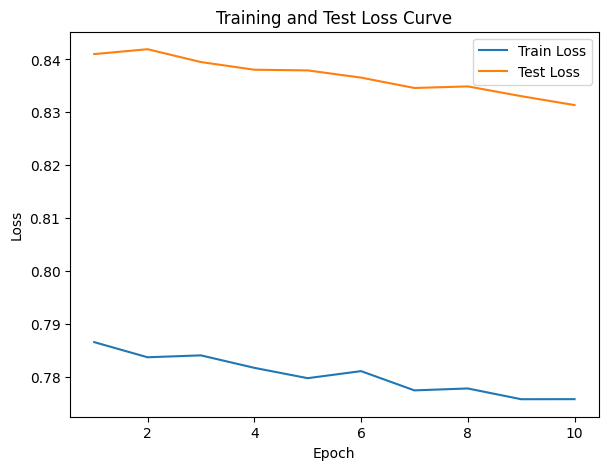

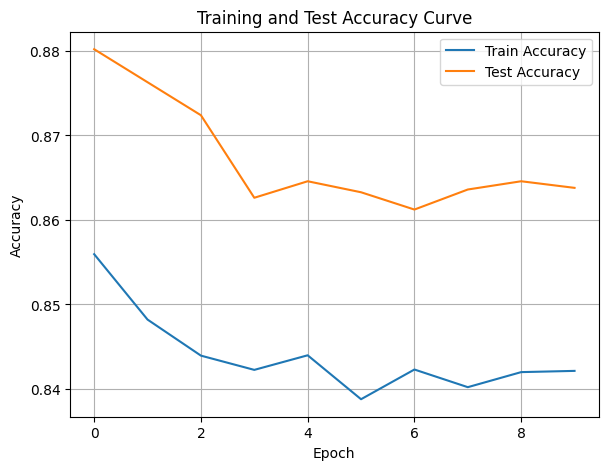

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.14it/s]

Epoch [1/10], Train F1:0.8402958547220841, Train Loss: 0.7547, Train Acc: 0.8372, Test F1:0.8609681243992525, Test Loss: 0.8126, Test Acc: 0.8646


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.14it/s]

Epoch [2/10], Train F1:0.8352218290803753, Train Loss: 0.7637, Train Acc: 0.8368, Test F1:0.8559168819882523, Test Loss: 0.8164, Test Acc: 0.8607


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.61it/s]

Epoch [3/10], Train F1:0.8434560030693221, Train Loss: 0.7600, Train Acc: 0.8449, Test F1:0.8609681243992525, Test Loss: 0.8156, Test Acc: 0.8646
Epoch [4/10], Train F1:0.8410520010442707, Train Loss: 0.7598, Train Acc: 0.8452, Test F1:0.865982887297857, Test Loss: 0.8188, Test Acc: 0.8685


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.53it/s]

Epoch [5/10], Train F1:0.843972587376398, Train Loss: 0.7576, Train Acc: 0.8480, Test F1:0.8689747193434073, Test Loss: 0.8171, Test Acc: 0.8708


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.53it/s]

Epoch [6/10], Train F1:0.8447865133127052, Train Loss: 0.7571, Train Acc: 0.8492, Test F1:0.8693063710315477, Test Loss: 0.8160, Test Acc: 0.8711


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.31it/s]

Epoch [7/10], Train F1:0.8440664002664002, Train Loss: 0.7570, Train Acc: 0.8488, Test F1:0.869543171040894, Test Loss: 0.8153, Test Acc: 0.8713


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.08it/s]

Epoch [8/10], Train F1:0.8429889316578818, Train Loss: 0.7568, Train Acc: 0.8462, Test F1:0.8684769531002642, Test Loss: 0.8143, Test Acc: 0.8704


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.08it/s]

Epoch [9/10], Train F1:0.8444963024978646, Train Loss: 0.7549, Train Acc: 0.8479, Test F1:0.8698587827008196, Test Loss: 0.8134, Test Acc: 0.8715


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.38it/s]


Epoch [10/10], Train F1:0.8453823633261601, Train Loss: 0.7534, Train Acc: 0.8480, Test F1:0.8699692139742325, Test Loss: 0.8125, Test Acc: 0.8716
Total Epochs: 10
Train loss start: 0.7197556495666504, Train loss end: 0.7783061265945435
Highest Mean Train Accuracy (over epoch): 0.8491567460317462
Test loss start: 0.8015777468681335, Test loss end: 0.7942759394645691
Highest mean Test Accuracy (over epoch): 0.8716145833333334


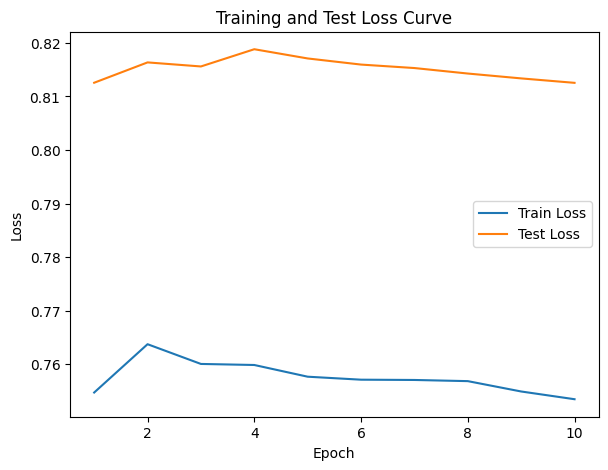

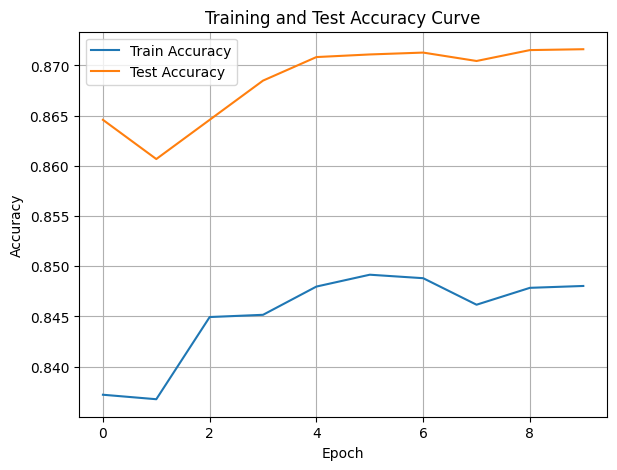

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8627757919134933, Train Loss: 0.7305, Train Acc: 0.8729, Test F1:0.8709623323013416, Test Loss: 0.7966, Test Acc: 0.8724


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.90it/s]

Epoch [2/10], Train F1:0.8629037849680776, Train Loss: 0.7301, Train Acc: 0.8692, Test F1:0.8709623323013416, Test Loss: 0.7970, Test Acc: 0.8724


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.90it/s]

Epoch [3/10], Train F1:0.8585391079508725, Train Loss: 0.7351, Train Acc: 0.8588, Test F1:0.8742629015126544, Test Loss: 0.8013, Test Acc: 0.8750


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.60it/s]

Epoch [4/10], Train F1:0.8589379593153178, Train Loss: 0.7339, Train Acc: 0.8600, Test F1:0.8734391655073641, Test Loss: 0.7991, Test Acc: 0.8743


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.85it/s]

Epoch [5/10], Train F1:0.8601114114583922, Train Loss: 0.7341, Train Acc: 0.8630, Test F1:0.8749212211816091, Test Loss: 0.7993, Test Acc: 0.8755


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.82it/s]

Epoch [6/10], Train F1:0.8620138866813016, Train Loss: 0.7334, Train Acc: 0.8648, Test F1:0.8791859851954849, Test Loss: 0.8002, Test Acc: 0.8799


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.67it/s]

Epoch [7/10], Train F1:0.860721496766165, Train Loss: 0.7335, Train Acc: 0.8637, Test F1:0.8780167978657475, Test Loss: 0.7989, Test Acc: 0.8788


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.43it/s]

Epoch [8/10], Train F1:0.8600495556255632, Train Loss: 0.7338, Train Acc: 0.8622, Test F1:0.8783677475406799, Test Loss: 0.7987, Test Acc: 0.8790


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.61it/s]

Epoch [9/10], Train F1:0.8610602696290086, Train Loss: 0.7339, Train Acc: 0.8624, Test F1:0.8786405936060135, Test Loss: 0.7978, Test Acc: 0.8791


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.19it/s]


Epoch [10/10], Train F1:0.8618162843634253, Train Loss: 0.7336, Train Acc: 0.8632, Test F1:0.8778763714248381, Test Loss: 0.7971, Test Acc: 0.8785
Total Epochs: 10
Train loss start: 0.7302183508872986, Train loss end: 0.6829524636268616
Highest Mean Train Accuracy (over epoch): 0.8729166666666667
Test loss start: 0.78423672914505, Test loss end: 0.7847058773040771
Highest mean Test Accuracy (over epoch): 0.8799189814814815


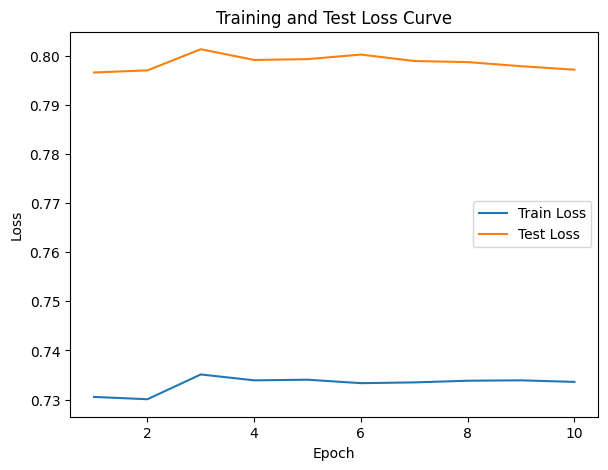

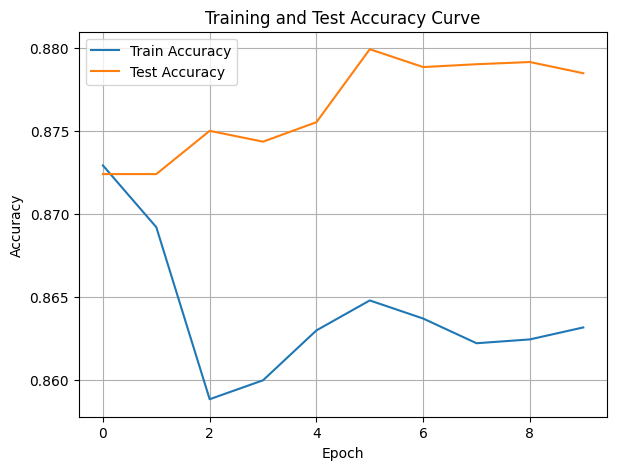

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.65it/s]

Epoch [1/10], Train F1:0.8805451343207196, Train Loss: 0.7221, Train Acc: 0.8747, Test F1:0.8808197688643266, Test Loss: 0.7943, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.59it/s]

Epoch [2/10], Train F1:0.8739044678844011, Train Loss: 0.7204, Train Acc: 0.8722, Test F1:0.8808197688643266, Test Loss: 0.7929, Test Acc: 0.8802


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.06it/s]

Epoch [3/10], Train F1:0.8690630678976962, Train Loss: 0.7206, Train Acc: 0.8668, Test F1:0.8808197688643264, Test Loss: 0.7935, Test Acc: 0.8802


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.63it/s]

Epoch [4/10], Train F1:0.8632379248658318, Train Loss: 0.7235, Train Acc: 0.8609, Test F1:0.8808197688643266, Test Loss: 0.7925, Test Acc: 0.8802


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.93it/s]

Epoch [5/10], Train F1:0.8640517070337921, Train Loss: 0.7244, Train Acc: 0.8597, Test F1:0.8788587982753424, Test Loss: 0.7902, Test Acc: 0.8786


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.15it/s]

Epoch [6/10], Train F1:0.8654324423168434, Train Loss: 0.7215, Train Acc: 0.8621, Test F1:0.8791859851954849, Test Loss: 0.7891, Test Acc: 0.8789


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.15it/s]

Epoch [7/10], Train F1:0.8640104472618672, Train Loss: 0.7215, Train Acc: 0.8614, Test F1:0.880996835440462, Test Loss: 0.7885, Test Acc: 0.8811


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.77it/s]

Epoch [8/10], Train F1:0.8672029954184909, Train Loss: 0.7182, Train Acc: 0.8650, Test F1:0.8821953719303476, Test Loss: 0.7869, Test Acc: 0.8827


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.87it/s]

Epoch [9/10], Train F1:0.8691576535632389, Train Loss: 0.7174, Train Acc: 0.8674, Test F1:0.8832591846442264, Test Loss: 0.7883, Test Acc: 0.8840


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.77it/s]


Epoch [10/10], Train F1:0.8691820703808628, Train Loss: 0.7160, Train Acc: 0.8685, Test F1:0.8841064555991374, Test Loss: 0.7887, Test Acc: 0.8850
Total Epochs: 10
Train loss start: 0.6925936937332153, Train loss end: 0.6107500791549683
Highest Mean Train Accuracy (over epoch): 0.874702380952381
Test loss start: 0.780922532081604, Test loss end: 0.7841843366622925
Highest mean Test Accuracy (over epoch): 0.884982638888889


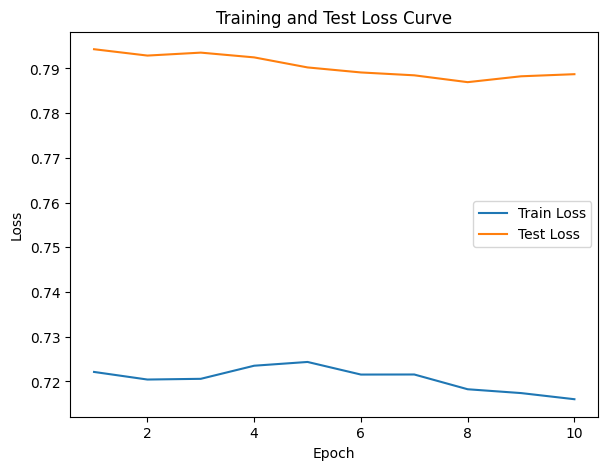

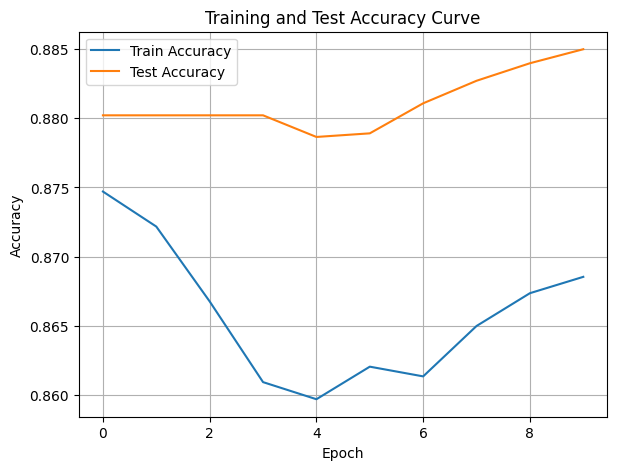

./saved_models/model_12.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [72]:
DTEmlp10b.train_DTE()

Training Process:   1%|          | 2/190 [00:00<00:26,  7.04it/s]

Epoch [1/190], Train F1:0.20642239787263122, Train Loss: 1.1842, Train Acc: 0.1670, Test F1:0.08110579479000532, Test Loss: 1.1377, Test Acc: 0.0686
Epoch [2/190], Train F1:0.23952379415499328, Train Loss: 1.1763, Train Acc: 0.1830, Test F1:0.09678473815990567, Test Loss: 1.1379, Test Acc: 0.0686


Training Process:   2%|▏         | 4/190 [00:00<00:21,  8.85it/s]

Epoch [3/190], Train F1:0.24756956048880085, Train Loss: 1.1717, Train Acc: 0.1898, Test F1:0.10599381749568426, Test Loss: 1.1380, Test Acc: 0.0712
Epoch [4/190], Train F1:0.25780785303275994, Train Loss: 1.1695, Train Acc: 0.1960, Test F1:0.10833560237055563, Test Loss: 1.1358, Test Acc: 0.0725


Training Process:   3%|▎         | 6/190 [00:00<00:19,  9.64it/s]

Epoch [5/190], Train F1:0.26454199361008485, Train Loss: 1.1650, Train Acc: 0.2023, Test F1:0.1045272025646172, Test Loss: 1.1348, Test Acc: 0.0717
Epoch [6/190], Train F1:0.2832471384625687, Train Loss: 1.1602, Train Acc: 0.2178, Test F1:0.11378693844210902, Test Loss: 1.1331, Test Acc: 0.0764


Training Process:   4%|▍         | 8/190 [00:00<00:20,  8.68it/s]

Epoch [7/190], Train F1:0.29645306481728906, Train Loss: 1.1559, Train Acc: 0.2281, Test F1:0.13289857981723713, Test Loss: 1.1308, Test Acc: 0.0862
Epoch [8/190], Train F1:0.30075842350636534, Train Loss: 1.1536, Train Acc: 0.2321, Test F1:0.140911602222243, Test Loss: 1.1290, Test Acc: 0.0898


Training Process:   5%|▌         | 10/190 [00:01<00:21,  8.30it/s]

Epoch [9/190], Train F1:0.3105646458678627, Train Loss: 1.1502, Train Acc: 0.2385, Test F1:0.1566475939497715, Test Loss: 1.1267, Test Acc: 0.0992
Epoch [10/190], Train F1:0.3181616851939255, Train Loss: 1.1474, Train Acc: 0.2459, Test F1:0.15847151418277378, Test Loss: 1.1257, Test Acc: 0.1030


Training Process:   6%|▋         | 12/190 [00:01<00:21,  8.11it/s]

Epoch [11/190], Train F1:0.3252227802037918, Train Loss: 1.1449, Train Acc: 0.2511, Test F1:0.17241106406023418, Test Loss: 1.1236, Test Acc: 0.1151
Epoch [12/190], Train F1:0.3330797235733724, Train Loss: 1.1417, Train Acc: 0.2579, Test F1:0.18790173429494983, Test Loss: 1.1215, Test Acc: 0.1283


Training Process:   7%|▋         | 13/190 [00:01<00:21,  8.07it/s]

Epoch [13/190], Train F1:0.34523844088327815, Train Loss: 1.1379, Train Acc: 0.2671, Test F1:0.21511848414736112, Test Loss: 1.1190, Test Acc: 0.1453


Training Process:   8%|▊         | 15/190 [00:01<00:25,  6.95it/s]

Epoch [14/190], Train F1:0.35701362574412426, Train Loss: 1.1341, Train Acc: 0.2772, Test F1:0.2594005356479247, Test Loss: 1.1164, Test Acc: 0.1742
Epoch [15/190], Train F1:0.36630783294480856, Train Loss: 1.1303, Train Acc: 0.2870, Test F1:0.28813089412378623, Test Loss: 1.1146, Test Acc: 0.1941


Training Process:   9%|▉         | 17/190 [00:02<00:25,  6.84it/s]

Epoch [16/190], Train F1:0.3757684367504718, Train Loss: 1.1271, Train Acc: 0.2956, Test F1:0.3130730462188796, Test Loss: 1.1127, Test Acc: 0.2139
Epoch [17/190], Train F1:0.38545091154233696, Train Loss: 1.1235, Train Acc: 0.3040, Test F1:0.3371221699400658, Test Loss: 1.1105, Test Acc: 0.2334


Training Process:  10%|█         | 19/190 [00:02<00:25,  6.84it/s]

Epoch [18/190], Train F1:0.3980064644973638, Train Loss: 1.1191, Train Acc: 0.3158, Test F1:0.3658923143770858, Test Loss: 1.1084, Test Acc: 0.2557
Epoch [19/190], Train F1:0.4085163001812097, Train Loss: 1.1152, Train Acc: 0.3258, Test F1:0.38945245534739414, Test Loss: 1.1061, Test Acc: 0.2761


Training Process:  11%|█         | 21/190 [00:02<00:25,  6.63it/s]

Epoch [20/190], Train F1:0.41870922194262467, Train Loss: 1.1116, Train Acc: 0.3343, Test F1:0.4118857641707623, Test Loss: 1.1038, Test Acc: 0.2966
Epoch [21/190], Train F1:0.4287962888156213, Train Loss: 1.1077, Train Acc: 0.3441, Test F1:0.4315894254796825, Test Loss: 1.1018, Test Acc: 0.3144


Training Process:  12%|█▏        | 23/190 [00:03<00:22,  7.30it/s]

Epoch [22/190], Train F1:0.43884127845989696, Train Loss: 1.1033, Train Acc: 0.3544, Test F1:0.45104485735998245, Test Loss: 1.0999, Test Acc: 0.3324
Epoch [23/190], Train F1:0.4482757728058759, Train Loss: 1.0995, Train Acc: 0.3641, Test F1:0.46554396064477893, Test Loss: 1.0979, Test Acc: 0.3471


Training Process:  13%|█▎        | 25/190 [00:03<00:24,  6.75it/s]

Epoch [24/190], Train F1:0.45644411504573434, Train Loss: 1.0959, Train Acc: 0.3721, Test F1:0.47755406368790454, Test Loss: 1.0962, Test Acc: 0.3590
Epoch [25/190], Train F1:0.46586276286973183, Train Loss: 1.0920, Train Acc: 0.3819, Test F1:0.4905043447030098, Test Loss: 1.0943, Test Acc: 0.3719


Training Process:  14%|█▍        | 27/190 [00:03<00:27,  6.01it/s]

Epoch [26/190], Train F1:0.474954876917382, Train Loss: 1.0884, Train Acc: 0.3906, Test F1:0.5038778205785022, Test Loss: 1.0923, Test Acc: 0.3855
Epoch [27/190], Train F1:0.4835270711786996, Train Loss: 1.0848, Train Acc: 0.3993, Test F1:0.5151328073761625, Test Loss: 1.0906, Test Acc: 0.3972


Training Process:  15%|█▍        | 28/190 [00:03<00:27,  5.88it/s]

Epoch [28/190], Train F1:0.491259805093986, Train Loss: 1.0810, Train Acc: 0.4080, Test F1:0.526362202321811, Test Loss: 1.0887, Test Acc: 0.4089


Training Process:  15%|█▌        | 29/190 [00:04<00:31,  5.13it/s]

Epoch [29/190], Train F1:0.4981922136154514, Train Loss: 1.0778, Train Acc: 0.4156, Test F1:0.537152064615137, Test Loss: 1.0868, Test Acc: 0.4215


Training Process:  16%|█▌        | 30/190 [00:04<00:31,  5.11it/s]

Epoch [30/190], Train F1:0.5044058992312385, Train Loss: 1.0744, Train Acc: 0.4222, Test F1:0.546917349882919, Test Loss: 1.0849, Test Acc: 0.4328


Training Process:  16%|█▋        | 31/190 [00:04<00:31,  5.12it/s]

Epoch [31/190], Train F1:0.512248799001726, Train Loss: 1.0707, Train Acc: 0.4302, Test F1:0.5558990928459854, Test Loss: 1.0831, Test Acc: 0.4431


Training Process:  17%|█▋        | 32/190 [00:04<00:30,  5.19it/s]

Epoch [32/190], Train F1:0.5208666579478832, Train Loss: 1.0671, Train Acc: 0.4393, Test F1:0.5642156944853877, Test Loss: 1.0813, Test Acc: 0.4532


Training Process:  17%|█▋        | 33/190 [00:05<00:33,  4.75it/s]

Epoch [33/190], Train F1:0.5278582374462387, Train Loss: 1.0638, Train Acc: 0.4469, Test F1:0.5732640540347044, Test Loss: 1.0795, Test Acc: 0.4639


Training Process:  18%|█▊        | 35/190 [00:05<00:31,  4.94it/s]

Epoch [34/190], Train F1:0.5348544445854948, Train Loss: 1.0603, Train Acc: 0.4547, Test F1:0.5813152732489837, Test Loss: 1.0778, Test Acc: 0.4735
Epoch [35/190], Train F1:0.5417101838671529, Train Loss: 1.0565, Train Acc: 0.4623, Test F1:0.5890232318145393, Test Loss: 1.0761, Test Acc: 0.4826


Training Process:  19%|█▉        | 36/190 [00:05<00:34,  4.49it/s]

Epoch [36/190], Train F1:0.548611652234422, Train Loss: 1.0531, Train Acc: 0.4698, Test F1:0.5956951267383035, Test Loss: 1.0744, Test Acc: 0.4908


Training Process:  19%|█▉        | 37/190 [00:05<00:34,  4.49it/s]

Epoch [37/190], Train F1:0.5555003411619633, Train Loss: 1.0496, Train Acc: 0.4767, Test F1:0.6028827723215204, Test Loss: 1.0726, Test Acc: 0.4993


Training Process:  20%|██        | 38/190 [00:06<00:34,  4.43it/s]

Epoch [38/190], Train F1:0.5617501350780739, Train Loss: 1.0462, Train Acc: 0.4835, Test F1:0.6094410725427398, Test Loss: 1.0708, Test Acc: 0.5071


Training Process:  21%|██        | 39/190 [00:06<00:33,  4.53it/s]

Epoch [39/190], Train F1:0.567148947820413, Train Loss: 1.0427, Train Acc: 0.4898, Test F1:0.6160642354365274, Test Loss: 1.0689, Test Acc: 0.5150


Training Process:  21%|██        | 40/190 [00:06<00:32,  4.59it/s]

Epoch [40/190], Train F1:0.5729821279820896, Train Loss: 1.0394, Train Acc: 0.4965, Test F1:0.6219484776798395, Test Loss: 1.0671, Test Acc: 0.5224


Training Process:  22%|██▏       | 41/190 [00:06<00:34,  4.36it/s]

Epoch [41/190], Train F1:0.5787760913437066, Train Loss: 1.0361, Train Acc: 0.5032, Test F1:0.6275888824256801, Test Loss: 1.0654, Test Acc: 0.5294


Training Process:  22%|██▏       | 42/190 [00:07<00:32,  4.60it/s]

Epoch [42/190], Train F1:0.5846240675471297, Train Loss: 1.0327, Train Acc: 0.5100, Test F1:0.6328608928336618, Test Loss: 1.0636, Test Acc: 0.5360


Training Process:  23%|██▎       | 44/190 [00:07<00:28,  5.10it/s]

Epoch [43/190], Train F1:0.5904618710931003, Train Loss: 1.0297, Train Acc: 0.5164, Test F1:0.6381259149665769, Test Loss: 1.0621, Test Acc: 0.5425
Epoch [44/190], Train F1:0.5955034902018055, Train Loss: 1.0265, Train Acc: 0.5221, Test F1:0.6426095051300272, Test Loss: 1.0604, Test Acc: 0.5483


Training Process:  24%|██▍       | 46/190 [00:07<00:25,  5.57it/s]

Epoch [45/190], Train F1:0.6006136688993443, Train Loss: 1.0233, Train Acc: 0.5280, Test F1:0.6477114599702787, Test Loss: 1.0585, Test Acc: 0.5549
Epoch [46/190], Train F1:0.6049100268872608, Train Loss: 1.0203, Train Acc: 0.5333, Test F1:0.6521911779669939, Test Loss: 1.0567, Test Acc: 0.5607


Training Process:  25%|██▍       | 47/190 [00:07<00:24,  5.80it/s]

Epoch [47/190], Train F1:0.6101049598556134, Train Loss: 1.0171, Train Acc: 0.5391, Test F1:0.6571736892977373, Test Loss: 1.0548, Test Acc: 0.5671


Training Process:  25%|██▌       | 48/190 [00:08<00:24,  5.70it/s]

Epoch [48/190], Train F1:0.6150083472503488, Train Loss: 1.0138, Train Acc: 0.5450, Test F1:0.661409231744712, Test Loss: 1.0529, Test Acc: 0.5726


Training Process:  26%|██▌       | 49/190 [00:08<00:25,  5.61it/s]

Epoch [49/190], Train F1:0.6195548398229412, Train Loss: 1.0109, Train Acc: 0.5502, Test F1:0.665080048930707, Test Loss: 1.0511, Test Acc: 0.5774


Training Process:  26%|██▋       | 50/190 [00:08<00:25,  5.48it/s]

Epoch [50/190], Train F1:0.624092097914731, Train Loss: 1.0078, Train Acc: 0.5556, Test F1:0.6694339243627775, Test Loss: 1.0495, Test Acc: 0.5831


Training Process:  27%|██▋       | 51/190 [00:08<00:25,  5.47it/s]

Epoch [51/190], Train F1:0.6291925860731122, Train Loss: 1.0047, Train Acc: 0.5614, Test F1:0.673800132696234, Test Loss: 1.0477, Test Acc: 0.5888


Training Process:  27%|██▋       | 52/190 [00:08<00:25,  5.44it/s]

Epoch [52/190], Train F1:0.6332656430063901, Train Loss: 1.0016, Train Acc: 0.5665, Test F1:0.6771416302865528, Test Loss: 1.0460, Test Acc: 0.5931


Training Process:  28%|██▊       | 53/190 [00:09<00:28,  4.84it/s]

Epoch [53/190], Train F1:0.6366399402333799, Train Loss: 0.9988, Train Acc: 0.5709, Test F1:0.6803430022868986, Test Loss: 1.0444, Test Acc: 0.5973


Training Process:  28%|██▊       | 54/190 [00:09<00:28,  4.81it/s]

Epoch [54/190], Train F1:0.6408503992299319, Train Loss: 0.9959, Train Acc: 0.5761, Test F1:0.6836061200288661, Test Loss: 1.0428, Test Acc: 0.6015


Training Process:  29%|██▉       | 55/190 [00:09<00:28,  4.79it/s]

Epoch [55/190], Train F1:0.6447876150428787, Train Loss: 0.9930, Train Acc: 0.5808, Test F1:0.6865487720119495, Test Loss: 1.0411, Test Acc: 0.6054


Training Process:  29%|██▉       | 56/190 [00:09<00:27,  4.80it/s]

Epoch [56/190], Train F1:0.648586312288282, Train Loss: 0.9902, Train Acc: 0.5854, Test F1:0.689853321288644, Test Loss: 1.0395, Test Acc: 0.6098


Training Process:  30%|███       | 57/190 [00:09<00:27,  4.77it/s]

Epoch [57/190], Train F1:0.6521871140102161, Train Loss: 0.9872, Train Acc: 0.5899, Test F1:0.6924052167787403, Test Loss: 1.0378, Test Acc: 0.6132


Training Process:  31%|███       | 58/190 [00:10<00:28,  4.71it/s]

Epoch [58/190], Train F1:0.6558929403793486, Train Loss: 0.9844, Train Acc: 0.5943, Test F1:0.6950136208173724, Test Loss: 1.0363, Test Acc: 0.6167


Training Process:  31%|███       | 59/190 [00:10<00:28,  4.61it/s]

Epoch [59/190], Train F1:0.6591620634569197, Train Loss: 0.9817, Train Acc: 0.5983, Test F1:0.6978996097162072, Test Loss: 1.0346, Test Acc: 0.6208


Training Process:  32%|███▏      | 60/190 [00:10<00:28,  4.53it/s]

Epoch [60/190], Train F1:0.6622980848950346, Train Loss: 0.9794, Train Acc: 0.6020, Test F1:0.7009025176176317, Test Loss: 1.0331, Test Acc: 0.6248


Training Process:  32%|███▏      | 61/190 [00:10<00:28,  4.57it/s]

Epoch [61/190], Train F1:0.6654879224019736, Train Loss: 0.9767, Train Acc: 0.6058, Test F1:0.7040876041607594, Test Loss: 1.0314, Test Acc: 0.6289


Training Process:  33%|███▎      | 63/190 [00:11<00:25,  4.94it/s]

Epoch [62/190], Train F1:0.6691978731389088, Train Loss: 0.9740, Train Acc: 0.6099, Test F1:0.7064487630401202, Test Loss: 1.0297, Test Acc: 0.6322
Epoch [63/190], Train F1:0.6721255864118942, Train Loss: 0.9714, Train Acc: 0.6136, Test F1:0.7091479835210148, Test Loss: 1.0282, Test Acc: 0.6358


Training Process:  34%|███▎      | 64/190 [00:11<00:27,  4.52it/s]

Epoch [64/190], Train F1:0.6751154603203037, Train Loss: 0.9690, Train Acc: 0.6171, Test F1:0.7114804334591335, Test Loss: 1.0266, Test Acc: 0.6389


Training Process:  34%|███▍      | 65/190 [00:11<00:28,  4.43it/s]

Epoch [65/190], Train F1:0.6778041170983801, Train Loss: 0.9666, Train Acc: 0.6205, Test F1:0.7138058514780729, Test Loss: 1.0251, Test Acc: 0.6419


Training Process:  35%|███▍      | 66/190 [00:11<00:27,  4.50it/s]

Epoch [66/190], Train F1:0.6808909471923326, Train Loss: 0.9641, Train Acc: 0.6241, Test F1:0.7162514966882761, Test Loss: 1.0235, Test Acc: 0.6452


Training Process:  35%|███▌      | 67/190 [00:12<00:27,  4.42it/s]

Epoch [67/190], Train F1:0.6835663154507742, Train Loss: 0.9615, Train Acc: 0.6276, Test F1:0.7183791674443741, Test Loss: 1.0221, Test Acc: 0.6480


Training Process:  36%|███▌      | 68/190 [00:12<00:30,  4.07it/s]

Epoch [68/190], Train F1:0.686057075062193, Train Loss: 0.9591, Train Acc: 0.6309, Test F1:0.7209321843899551, Test Loss: 1.0205, Test Acc: 0.6514


Training Process:  36%|███▋      | 69/190 [00:12<00:29,  4.04it/s]

Epoch [69/190], Train F1:0.6882791503950373, Train Loss: 0.9569, Train Acc: 0.6336, Test F1:0.7226886643373089, Test Loss: 1.0192, Test Acc: 0.6538


Training Process:  37%|███▋      | 70/190 [00:12<00:28,  4.16it/s]

Epoch [70/190], Train F1:0.6906254839717996, Train Loss: 0.9546, Train Acc: 0.6365, Test F1:0.724537564297318, Test Loss: 1.0180, Test Acc: 0.6562


Training Process:  37%|███▋      | 71/190 [00:13<00:28,  4.10it/s]

Epoch [71/190], Train F1:0.6930584513270335, Train Loss: 0.9524, Train Acc: 0.6396, Test F1:0.7268815718659823, Test Loss: 1.0164, Test Acc: 0.6594


Training Process:  38%|███▊      | 72/190 [00:13<00:29,  3.97it/s]

Epoch [72/190], Train F1:0.6952816354065138, Train Loss: 0.9501, Train Acc: 0.6425, Test F1:0.7287759094828553, Test Loss: 1.0151, Test Acc: 0.6617


Training Process:  38%|███▊      | 73/190 [00:13<00:28,  4.06it/s]

Epoch [73/190], Train F1:0.6973344244844818, Train Loss: 0.9479, Train Acc: 0.6453, Test F1:0.7309890595080482, Test Loss: 1.0135, Test Acc: 0.6647


Training Process:  39%|███▉      | 74/190 [00:13<00:30,  3.83it/s]

Epoch [74/190], Train F1:0.6996701144380482, Train Loss: 0.9457, Train Acc: 0.6482, Test F1:0.7331380675091128, Test Loss: 1.0117, Test Acc: 0.6676


Training Process:  39%|███▉      | 75/190 [00:14<00:29,  3.87it/s]

Epoch [75/190], Train F1:0.701701584079011, Train Loss: 0.9437, Train Acc: 0.6507, Test F1:0.734897498979686, Test Loss: 1.0104, Test Acc: 0.6700


Training Process:  40%|████      | 76/190 [00:14<00:28,  4.01it/s]

Epoch [76/190], Train F1:0.7035556336835972, Train Loss: 0.9417, Train Acc: 0.6531, Test F1:0.7367219478120537, Test Loss: 1.0089, Test Acc: 0.6724


Training Process:  41%|████      | 77/190 [00:14<00:27,  4.05it/s]

Epoch [77/190], Train F1:0.7056258803206504, Train Loss: 0.9396, Train Acc: 0.6557, Test F1:0.7384365777044548, Test Loss: 1.0072, Test Acc: 0.6749


Training Process:  41%|████      | 78/190 [00:14<00:26,  4.24it/s]

Epoch [78/190], Train F1:0.7078540567323386, Train Loss: 0.9375, Train Acc: 0.6584, Test F1:0.740234957568024, Test Loss: 1.0057, Test Acc: 0.6774


Training Process:  42%|████▏     | 79/190 [00:15<00:25,  4.31it/s]

Epoch [79/190], Train F1:0.710150443500864, Train Loss: 0.9352, Train Acc: 0.6613, Test F1:0.7419846656898974, Test Loss: 1.0040, Test Acc: 0.6799


Training Process:  42%|████▏     | 80/190 [00:15<00:25,  4.34it/s]

Epoch [80/190], Train F1:0.7126494687624341, Train Loss: 0.9328, Train Acc: 0.6643, Test F1:0.7435599609398507, Test Loss: 1.0025, Test Acc: 0.6822


Training Process:  43%|████▎     | 81/190 [00:15<00:24,  4.38it/s]

Epoch [81/190], Train F1:0.7147523570455773, Train Loss: 0.9307, Train Acc: 0.6669, Test F1:0.7452197244394493, Test Loss: 1.0010, Test Acc: 0.6846


Training Process:  43%|████▎     | 82/190 [00:15<00:24,  4.42it/s]

Epoch [82/190], Train F1:0.7167871326825177, Train Loss: 0.9286, Train Acc: 0.6695, Test F1:0.7467118035940523, Test Loss: 0.9994, Test Acc: 0.6867


Training Process:  44%|████▎     | 83/190 [00:15<00:24,  4.41it/s]

Epoch [83/190], Train F1:0.7186652431764052, Train Loss: 0.9265, Train Acc: 0.6719, Test F1:0.7484115799597454, Test Loss: 0.9978, Test Acc: 0.6891


Training Process:  44%|████▍     | 84/190 [00:16<00:24,  4.42it/s]

Epoch [84/190], Train F1:0.7204470703302783, Train Loss: 0.9246, Train Acc: 0.6742, Test F1:0.7499469328433233, Test Loss: 0.9963, Test Acc: 0.6913


Training Process:  45%|████▍     | 85/190 [00:16<00:25,  4.09it/s]

Epoch [85/190], Train F1:0.7219450299566926, Train Loss: 0.9227, Train Acc: 0.6762, Test F1:0.7513238297534656, Test Loss: 0.9948, Test Acc: 0.6933


Training Process:  45%|████▌     | 86/190 [00:16<00:25,  4.08it/s]

Epoch [86/190], Train F1:0.7236905198790639, Train Loss: 0.9207, Train Acc: 0.6784, Test F1:0.7529222486097745, Test Loss: 0.9933, Test Acc: 0.6955


Training Process:  46%|████▌     | 87/190 [00:16<00:24,  4.12it/s]

Epoch [87/190], Train F1:0.7256410775086669, Train Loss: 0.9189, Train Acc: 0.6808, Test F1:0.7542293291107812, Test Loss: 0.9919, Test Acc: 0.6974


Training Process:  46%|████▋     | 88/190 [00:17<00:24,  4.15it/s]

Epoch [88/190], Train F1:0.72752913306742, Train Loss: 0.9169, Train Acc: 0.6831, Test F1:0.7555584451962091, Test Loss: 0.9906, Test Acc: 0.6992


Training Process:  47%|████▋     | 89/190 [00:17<00:24,  4.12it/s]

Epoch [89/190], Train F1:0.7292230544994914, Train Loss: 0.9150, Train Acc: 0.6853, Test F1:0.7570322131657891, Test Loss: 0.9890, Test Acc: 0.7013


Training Process:  47%|████▋     | 90/190 [00:17<00:24,  4.15it/s]

Epoch [90/190], Train F1:0.7309038068784569, Train Loss: 0.9131, Train Acc: 0.6875, Test F1:0.7581231221662933, Test Loss: 0.9878, Test Acc: 0.7028


Training Process:  48%|████▊     | 91/190 [00:17<00:24,  4.12it/s]

Epoch [91/190], Train F1:0.7324476536876248, Train Loss: 0.9114, Train Acc: 0.6892, Test F1:0.7594211953408722, Test Loss: 0.9862, Test Acc: 0.7047


Training Process:  48%|████▊     | 92/190 [00:18<00:23,  4.10it/s]

Epoch [92/190], Train F1:0.7341988212075733, Train Loss: 0.9096, Train Acc: 0.6914, Test F1:0.7605788225912093, Test Loss: 0.9846, Test Acc: 0.7064


Training Process:  49%|████▉     | 93/190 [00:18<00:24,  3.95it/s]

Epoch [93/190], Train F1:0.7359714697956878, Train Loss: 0.9078, Train Acc: 0.6934, Test F1:0.7619290544304466, Test Loss: 0.9832, Test Acc: 0.7083


Training Process:  49%|████▉     | 94/190 [00:18<00:24,  3.91it/s]

Epoch [94/190], Train F1:0.7373669106526265, Train Loss: 0.9063, Train Acc: 0.6951, Test F1:0.7632658179034848, Test Loss: 0.9818, Test Acc: 0.7101


Training Process:  50%|█████     | 95/190 [00:18<00:24,  3.87it/s]

Epoch [95/190], Train F1:0.739045299896568, Train Loss: 0.9046, Train Acc: 0.6971, Test F1:0.7645730418680254, Test Loss: 0.9804, Test Acc: 0.7119


Training Process:  51%|█████     | 96/190 [00:19<00:26,  3.60it/s]

Epoch [96/190], Train F1:0.7404494416154417, Train Loss: 0.9029, Train Acc: 0.6990, Test F1:0.765941283252634, Test Loss: 0.9790, Test Acc: 0.7137


Training Process:  51%|█████     | 97/190 [00:19<00:26,  3.49it/s]

Epoch [97/190], Train F1:0.7420582228352313, Train Loss: 0.9013, Train Acc: 0.7008, Test F1:0.7670301863573106, Test Loss: 0.9778, Test Acc: 0.7151


Training Process:  52%|█████▏    | 98/190 [00:19<00:26,  3.44it/s]

Epoch [98/190], Train F1:0.7435970392675398, Train Loss: 0.8997, Train Acc: 0.7025, Test F1:0.7680956790412493, Test Loss: 0.9766, Test Acc: 0.7165


Training Process:  52%|█████▏    | 99/190 [00:20<00:26,  3.42it/s]

Epoch [99/190], Train F1:0.7451490860472352, Train Loss: 0.8980, Train Acc: 0.7044, Test F1:0.769209625879256, Test Loss: 0.9753, Test Acc: 0.7181


Training Process:  53%|█████▎    | 100/190 [00:20<00:26,  3.34it/s]

Epoch [100/190], Train F1:0.7464331028483919, Train Loss: 0.8965, Train Acc: 0.7060, Test F1:0.7702298223782709, Test Loss: 0.9740, Test Acc: 0.7194


Training Process:  53%|█████▎    | 101/190 [00:20<00:27,  3.27it/s]

Epoch [101/190], Train F1:0.7476776034316074, Train Loss: 0.8949, Train Acc: 0.7076, Test F1:0.7714838721213098, Test Loss: 0.9728, Test Acc: 0.7211


Training Process:  54%|█████▎    | 102/190 [00:21<00:27,  3.24it/s]

Epoch [102/190], Train F1:0.7491059801204903, Train Loss: 0.8933, Train Acc: 0.7095, Test F1:0.7724984382660298, Test Loss: 0.9714, Test Acc: 0.7226


Training Process:  54%|█████▍    | 103/190 [00:21<00:28,  3.01it/s]

Epoch [103/190], Train F1:0.7504396496553392, Train Loss: 0.8918, Train Acc: 0.7110, Test F1:0.7735373947286325, Test Loss: 0.9702, Test Acc: 0.7239


Training Process:  55%|█████▍    | 104/190 [00:21<00:28,  3.06it/s]

Epoch [104/190], Train F1:0.7518249770030789, Train Loss: 0.8902, Train Acc: 0.7128, Test F1:0.7744728923549811, Test Loss: 0.9691, Test Acc: 0.7251


Training Process:  55%|█████▌    | 105/190 [00:22<00:27,  3.06it/s]

Epoch [105/190], Train F1:0.7529713155682348, Train Loss: 0.8887, Train Acc: 0.7144, Test F1:0.7756348160341711, Test Loss: 0.9679, Test Acc: 0.7267


Training Process:  56%|█████▌    | 106/190 [00:22<00:27,  3.05it/s]

Epoch [106/190], Train F1:0.7542840202845053, Train Loss: 0.8871, Train Acc: 0.7160, Test F1:0.7766784876281125, Test Loss: 0.9666, Test Acc: 0.7281


Training Process:  56%|█████▋    | 107/190 [00:23<00:31,  2.60it/s]

Epoch [107/190], Train F1:0.7554674673168321, Train Loss: 0.8857, Train Acc: 0.7175, Test F1:0.7777819685486136, Test Loss: 0.9654, Test Acc: 0.7296


Training Process:  57%|█████▋    | 108/190 [00:23<00:30,  2.71it/s]

Epoch [108/190], Train F1:0.7565607182322194, Train Loss: 0.8842, Train Acc: 0.7189, Test F1:0.7787195453721405, Test Loss: 0.9643, Test Acc: 0.7308


Training Process:  57%|█████▋    | 109/190 [00:23<00:28,  2.86it/s]

Epoch [109/190], Train F1:0.7576974101628553, Train Loss: 0.8827, Train Acc: 0.7203, Test F1:0.7797037960643555, Test Loss: 0.9631, Test Acc: 0.7322


Training Process:  58%|█████▊    | 110/190 [00:23<00:27,  2.94it/s]

Epoch [110/190], Train F1:0.7591462531063438, Train Loss: 0.8812, Train Acc: 0.7221, Test F1:0.7805637718355602, Test Loss: 0.9618, Test Acc: 0.7335


Training Process:  58%|█████▊    | 111/190 [00:24<00:27,  2.87it/s]

Epoch [111/190], Train F1:0.7604049898331504, Train Loss: 0.8798, Train Acc: 0.7237, Test F1:0.7815122812036192, Test Loss: 0.9605, Test Acc: 0.7348


Training Process:  59%|█████▉    | 112/190 [00:24<00:26,  2.97it/s]

Epoch [112/190], Train F1:0.7617608665724369, Train Loss: 0.8783, Train Acc: 0.7253, Test F1:0.7825332528620982, Test Loss: 0.9593, Test Acc: 0.7362


Training Process:  59%|█████▉    | 113/190 [00:24<00:25,  3.07it/s]

Epoch [113/190], Train F1:0.762981447696125, Train Loss: 0.8769, Train Acc: 0.7267, Test F1:0.7833214321033959, Test Loss: 0.9582, Test Acc: 0.7372


Training Process:  60%|██████    | 114/190 [00:25<00:24,  3.09it/s]

Epoch [114/190], Train F1:0.7640736655227138, Train Loss: 0.8755, Train Acc: 0.7280, Test F1:0.7842939288272217, Test Loss: 0.9571, Test Acc: 0.7385


Training Process:  61%|██████    | 115/190 [00:25<00:23,  3.16it/s]

Epoch [115/190], Train F1:0.7653032339450302, Train Loss: 0.8742, Train Acc: 0.7294, Test F1:0.7850736345494412, Test Loss: 0.9557, Test Acc: 0.7397


Training Process:  61%|██████    | 116/190 [00:25<00:24,  2.99it/s]

Epoch [116/190], Train F1:0.7663507056086863, Train Loss: 0.8728, Train Acc: 0.7308, Test F1:0.7858393489539721, Test Loss: 0.9544, Test Acc: 0.7408


Training Process:  62%|██████▏   | 117/190 [00:26<00:24,  2.99it/s]

Epoch [117/190], Train F1:0.7676393078454974, Train Loss: 0.8712, Train Acc: 0.7324, Test F1:0.7867636717793751, Test Loss: 0.9531, Test Acc: 0.7421


Training Process:  62%|██████▏   | 118/190 [00:26<00:29,  2.45it/s]

Epoch [118/190], Train F1:0.7688319525726832, Train Loss: 0.8698, Train Acc: 0.7337, Test F1:0.7875010448276433, Test Loss: 0.9518, Test Acc: 0.7432


Training Process:  63%|██████▎   | 119/190 [00:27<00:32,  2.19it/s]

Epoch [119/190], Train F1:0.7698030990179774, Train Loss: 0.8685, Train Acc: 0.7350, Test F1:0.7883101779160583, Test Loss: 0.9504, Test Acc: 0.7443


Training Process:  63%|██████▎   | 120/190 [00:27<00:30,  2.26it/s]

Epoch [120/190], Train F1:0.7708717861684424, Train Loss: 0.8672, Train Acc: 0.7362, Test F1:0.7892018628203903, Test Loss: 0.9493, Test Acc: 0.7455


Training Process:  64%|██████▎   | 121/190 [00:28<00:29,  2.35it/s]

Epoch [121/190], Train F1:0.7717531722897097, Train Loss: 0.8660, Train Acc: 0.7374, Test F1:0.7898994020227993, Test Loss: 0.9479, Test Acc: 0.7466


Training Process:  64%|██████▍   | 122/190 [00:28<00:27,  2.46it/s]

Epoch [122/190], Train F1:0.7728859297273902, Train Loss: 0.8645, Train Acc: 0.7388, Test F1:0.7905025586871257, Test Loss: 0.9466, Test Acc: 0.7476


Training Process:  65%|██████▍   | 123/190 [00:28<00:26,  2.56it/s]

Epoch [123/190], Train F1:0.774126560013118, Train Loss: 0.8631, Train Acc: 0.7402, Test F1:0.7913533127826142, Test Loss: 0.9454, Test Acc: 0.7487


Training Process:  65%|██████▌   | 124/190 [00:29<00:25,  2.64it/s]

Epoch [124/190], Train F1:0.7750537700484421, Train Loss: 0.8618, Train Acc: 0.7415, Test F1:0.7920965278461968, Test Loss: 0.9442, Test Acc: 0.7498


Training Process:  66%|██████▌   | 125/190 [00:29<00:25,  2.52it/s]

Epoch [125/190], Train F1:0.7759769117956196, Train Loss: 0.8605, Train Acc: 0.7426, Test F1:0.7926664727228206, Test Loss: 0.9428, Test Acc: 0.7507


Training Process:  66%|██████▋   | 126/190 [00:30<00:24,  2.61it/s]

Epoch [126/190], Train F1:0.7769764675641725, Train Loss: 0.8593, Train Acc: 0.7438, Test F1:0.7933866984693241, Test Loss: 0.9416, Test Acc: 0.7517


Training Process:  67%|██████▋   | 127/190 [00:30<00:23,  2.66it/s]

Epoch [127/190], Train F1:0.7778048460013646, Train Loss: 0.8581, Train Acc: 0.7448, Test F1:0.7939844778626562, Test Loss: 0.9406, Test Acc: 0.7525


Training Process:  67%|██████▋   | 128/190 [00:30<00:22,  2.77it/s]

Epoch [128/190], Train F1:0.7786853208881679, Train Loss: 0.8568, Train Acc: 0.7460, Test F1:0.7946392609820583, Test Loss: 0.9396, Test Acc: 0.7533


Training Process:  68%|██████▊   | 129/190 [00:31<00:20,  2.91it/s]

Epoch [129/190], Train F1:0.7795535978033984, Train Loss: 0.8556, Train Acc: 0.7471, Test F1:0.795404263227922, Test Loss: 0.9385, Test Acc: 0.7544


Training Process:  68%|██████▊   | 130/190 [00:31<00:19,  3.00it/s]

Epoch [130/190], Train F1:0.7803729787508707, Train Loss: 0.8544, Train Acc: 0.7482, Test F1:0.7960372793904366, Test Loss: 0.9375, Test Acc: 0.7552


Training Process:  69%|██████▉   | 131/190 [00:31<00:19,  3.04it/s]

Epoch [131/190], Train F1:0.7813130223031785, Train Loss: 0.8532, Train Acc: 0.7494, Test F1:0.7967906459804276, Test Loss: 0.9364, Test Acc: 0.7562


Training Process:  69%|██████▉   | 132/190 [00:32<00:20,  2.89it/s]

Epoch [132/190], Train F1:0.7819494590788413, Train Loss: 0.8522, Train Acc: 0.7502, Test F1:0.7975969124505748, Test Loss: 0.9352, Test Acc: 0.7573


Training Process:  70%|███████   | 133/190 [00:32<00:19,  2.89it/s]

Epoch [133/190], Train F1:0.7829835461683065, Train Loss: 0.8509, Train Acc: 0.7515, Test F1:0.7983264645021482, Test Loss: 0.9341, Test Acc: 0.7582


Training Process:  71%|███████   | 134/190 [00:32<00:20,  2.71it/s]

Epoch [134/190], Train F1:0.7837263814468379, Train Loss: 0.8499, Train Acc: 0.7523, Test F1:0.7988646984790385, Test Loss: 0.9332, Test Acc: 0.7590


Training Process:  71%|███████   | 135/190 [00:33<00:19,  2.77it/s]

Epoch [135/190], Train F1:0.784674442085725, Train Loss: 0.8486, Train Acc: 0.7535, Test F1:0.7995623262928505, Test Loss: 0.9321, Test Acc: 0.7599


Training Process:  72%|███████▏  | 136/190 [00:33<00:19,  2.82it/s]

Epoch [136/190], Train F1:0.785440361638628, Train Loss: 0.8474, Train Acc: 0.7545, Test F1:0.8002603003666854, Test Loss: 0.9311, Test Acc: 0.7609


Training Process:  72%|███████▏  | 137/190 [00:33<00:18,  2.86it/s]

Epoch [137/190], Train F1:0.7862736906309237, Train Loss: 0.8463, Train Acc: 0.7554, Test F1:0.8008854381137706, Test Loss: 0.9302, Test Acc: 0.7617


Training Process:  73%|███████▎  | 138/190 [00:34<00:18,  2.88it/s]

Epoch [138/190], Train F1:0.7872282748176391, Train Loss: 0.8452, Train Acc: 0.7566, Test F1:0.8014797771728657, Test Loss: 0.9291, Test Acc: 0.7625


Training Process:  73%|███████▎  | 139/190 [00:34<00:17,  2.88it/s]

Epoch [139/190], Train F1:0.7879979815084818, Train Loss: 0.8440, Train Acc: 0.7576, Test F1:0.8021479883649617, Test Loss: 0.9280, Test Acc: 0.7634


Training Process:  74%|███████▎  | 140/190 [00:34<00:17,  2.92it/s]

Epoch [140/190], Train F1:0.7889394607234064, Train Loss: 0.8428, Train Acc: 0.7588, Test F1:0.8027958188316698, Test Loss: 0.9270, Test Acc: 0.7643


Training Process:  74%|███████▍  | 141/190 [00:35<00:16,  2.99it/s]

Epoch [141/190], Train F1:0.7897873591951601, Train Loss: 0.8418, Train Acc: 0.7598, Test F1:0.8034446470477191, Test Loss: 0.9259, Test Acc: 0.7652


Training Process:  75%|███████▍  | 142/190 [00:35<00:15,  3.03it/s]

Epoch [142/190], Train F1:0.7904931149669969, Train Loss: 0.8408, Train Acc: 0.7606, Test F1:0.8040840528494007, Test Loss: 0.9249, Test Acc: 0.7661


Training Process:  75%|███████▌  | 143/190 [00:35<00:16,  2.89it/s]

Epoch [143/190], Train F1:0.7912991724776368, Train Loss: 0.8398, Train Acc: 0.7615, Test F1:0.8047142401966266, Test Loss: 0.9239, Test Acc: 0.7669


Training Process:  76%|███████▌  | 144/190 [00:36<00:15,  2.89it/s]

Epoch [144/190], Train F1:0.7921119876630045, Train Loss: 0.8387, Train Acc: 0.7626, Test F1:0.8052168801084032, Test Loss: 0.9230, Test Acc: 0.7676


Training Process:  76%|███████▋  | 145/190 [00:36<00:15,  2.86it/s]

Epoch [145/190], Train F1:0.7926558287779581, Train Loss: 0.8378, Train Acc: 0.7633, Test F1:0.8058300411597449, Test Loss: 0.9219, Test Acc: 0.7684


Training Process:  77%|███████▋  | 146/190 [00:36<00:15,  2.86it/s]

Epoch [146/190], Train F1:0.7935311704021704, Train Loss: 0.8368, Train Acc: 0.7643, Test F1:0.8063860882100008, Test Loss: 0.9211, Test Acc: 0.7691


Training Process:  77%|███████▋  | 147/190 [00:37<00:14,  2.88it/s]

Epoch [147/190], Train F1:0.7942592232877881, Train Loss: 0.8357, Train Acc: 0.7653, Test F1:0.806972542865159, Test Loss: 0.9201, Test Acc: 0.7699


Training Process:  78%|███████▊  | 148/190 [00:37<00:14,  2.85it/s]

Epoch [148/190], Train F1:0.7951128091503523, Train Loss: 0.8347, Train Acc: 0.7663, Test F1:0.8073484098672148, Test Loss: 0.9190, Test Acc: 0.7705


Training Process:  78%|███████▊  | 149/190 [00:38<00:14,  2.82it/s]

Epoch [149/190], Train F1:0.7957797349189726, Train Loss: 0.8337, Train Acc: 0.7671, Test F1:0.8078531257052837, Test Loss: 0.9179, Test Acc: 0.7713


Training Process:  79%|███████▉  | 150/190 [00:38<00:14,  2.70it/s]

Epoch [150/190], Train F1:0.7964933338339926, Train Loss: 0.8326, Train Acc: 0.7680, Test F1:0.8084175071702636, Test Loss: 0.9169, Test Acc: 0.7720


Training Process:  79%|███████▉  | 151/190 [00:38<00:14,  2.65it/s]

Epoch [151/190], Train F1:0.7971845321266736, Train Loss: 0.8317, Train Acc: 0.7688, Test F1:0.8088240020109786, Test Loss: 0.9161, Test Acc: 0.7726


Training Process:  80%|████████  | 152/190 [00:39<00:14,  2.56it/s]

Epoch [152/190], Train F1:0.7978365123755932, Train Loss: 0.8308, Train Acc: 0.7696, Test F1:0.8093741774468288, Test Loss: 0.9151, Test Acc: 0.7733


Training Process:  81%|████████  | 153/190 [00:39<00:14,  2.55it/s]

Epoch [153/190], Train F1:0.7986280788377083, Train Loss: 0.8298, Train Acc: 0.7706, Test F1:0.8099264437177089, Test Loss: 0.9141, Test Acc: 0.7741


Training Process:  81%|████████  | 154/190 [00:40<00:13,  2.61it/s]

Epoch [154/190], Train F1:0.7992447041787257, Train Loss: 0.8289, Train Acc: 0.7713, Test F1:0.8103971716400749, Test Loss: 0.9130, Test Acc: 0.7748


Training Process:  82%|████████▏ | 155/190 [00:40<00:13,  2.66it/s]

Epoch [155/190], Train F1:0.7999409916131609, Train Loss: 0.8280, Train Acc: 0.7721, Test F1:0.8107796084674894, Test Loss: 0.9122, Test Acc: 0.7753


Training Process:  82%|████████▏ | 156/190 [00:40<00:12,  2.72it/s]

Epoch [156/190], Train F1:0.800676996642804, Train Loss: 0.8270, Train Acc: 0.7730, Test F1:0.8113116756864476, Test Loss: 0.9114, Test Acc: 0.7760


Training Process:  83%|████████▎ | 157/190 [00:41<00:12,  2.73it/s]

Epoch [157/190], Train F1:0.801412606200393, Train Loss: 0.8260, Train Acc: 0.7739, Test F1:0.8118910904976948, Test Loss: 0.9104, Test Acc: 0.7768


Training Process:  83%|████████▎ | 158/190 [00:41<00:11,  2.74it/s]

Epoch [158/190], Train F1:0.8020554939916565, Train Loss: 0.8251, Train Acc: 0.7747, Test F1:0.8124090166255715, Test Loss: 0.9096, Test Acc: 0.7775


Training Process:  84%|████████▎ | 159/190 [00:41<00:11,  2.76it/s]

Epoch [159/190], Train F1:0.8027156744205167, Train Loss: 0.8241, Train Acc: 0.7756, Test F1:0.8128485750462825, Test Loss: 0.9086, Test Acc: 0.7781


Training Process:  84%|████████▍ | 160/190 [00:42<00:10,  2.74it/s]

Epoch [160/190], Train F1:0.8033285127532057, Train Loss: 0.8232, Train Acc: 0.7764, Test F1:0.8134070136020092, Test Loss: 0.9076, Test Acc: 0.7789


Training Process:  85%|████████▍ | 161/190 [00:42<00:11,  2.51it/s]

Epoch [161/190], Train F1:0.8039230530422345, Train Loss: 0.8223, Train Acc: 0.7771, Test F1:0.8139583444534693, Test Loss: 0.9067, Test Acc: 0.7796


Training Process:  85%|████████▌ | 162/190 [00:43<00:10,  2.57it/s]

Epoch [162/190], Train F1:0.8045958415118412, Train Loss: 0.8213, Train Acc: 0.7779, Test F1:0.8143797854246223, Test Loss: 0.9056, Test Acc: 0.7802


Training Process:  86%|████████▌ | 163/190 [00:43<00:10,  2.62it/s]

Epoch [163/190], Train F1:0.8051866894341915, Train Loss: 0.8204, Train Acc: 0.7786, Test F1:0.8148657773041997, Test Loss: 0.9047, Test Acc: 0.7809


Training Process:  86%|████████▋ | 164/190 [00:43<00:09,  2.67it/s]

Epoch [164/190], Train F1:0.8058544355565499, Train Loss: 0.8195, Train Acc: 0.7794, Test F1:0.8152417147813489, Test Loss: 0.9039, Test Acc: 0.7813


Training Process:  87%|████████▋ | 165/190 [00:44<00:09,  2.72it/s]

Epoch [165/190], Train F1:0.8065920661100642, Train Loss: 0.8186, Train Acc: 0.7803, Test F1:0.8157162841807294, Test Loss: 0.9029, Test Acc: 0.7820


Training Process:  87%|████████▋ | 166/190 [00:44<00:08,  2.72it/s]

Epoch [166/190], Train F1:0.8070879305348511, Train Loss: 0.8178, Train Acc: 0.7808, Test F1:0.8161849863158297, Test Loss: 0.9021, Test Acc: 0.7826


Training Process:  88%|████████▊ | 167/190 [00:44<00:08,  2.69it/s]

Epoch [167/190], Train F1:0.8076746960594009, Train Loss: 0.8169, Train Acc: 0.7816, Test F1:0.8165798737669552, Test Loss: 0.9012, Test Acc: 0.7832


Training Process:  88%|████████▊ | 168/190 [00:45<00:08,  2.66it/s]

Epoch [168/190], Train F1:0.8083803629641761, Train Loss: 0.8160, Train Acc: 0.7824, Test F1:0.816910751107079, Test Loss: 0.9002, Test Acc: 0.7837


Training Process:  89%|████████▉ | 169/190 [00:45<00:07,  2.67it/s]

Epoch [169/190], Train F1:0.808939436472471, Train Loss: 0.8152, Train Acc: 0.7831, Test F1:0.8174141464338985, Test Loss: 0.8993, Test Acc: 0.7844


Training Process:  89%|████████▉ | 170/190 [00:46<00:08,  2.49it/s]

Epoch [170/190], Train F1:0.809489090044069, Train Loss: 0.8143, Train Acc: 0.7838, Test F1:0.8179114831086077, Test Loss: 0.8984, Test Acc: 0.7851


Training Process:  90%|█████████ | 171/190 [00:46<00:07,  2.48it/s]

Epoch [171/190], Train F1:0.8100017021100085, Train Loss: 0.8135, Train Acc: 0.7845, Test F1:0.8183530219196612, Test Loss: 0.8976, Test Acc: 0.7857


Training Process:  91%|█████████ | 172/190 [00:46<00:07,  2.51it/s]

Epoch [172/190], Train F1:0.8104760009551796, Train Loss: 0.8128, Train Acc: 0.7851, Test F1:0.8188388545831924, Test Loss: 0.8967, Test Acc: 0.7863


Training Process:  91%|█████████ | 173/190 [00:47<00:06,  2.58it/s]

Epoch [173/190], Train F1:0.8110290355061389, Train Loss: 0.8119, Train Acc: 0.7858, Test F1:0.8192696724049147, Test Loss: 0.8958, Test Acc: 0.7869


Training Process:  92%|█████████▏| 174/190 [00:47<00:06,  2.61it/s]

Epoch [174/190], Train F1:0.8116327893212198, Train Loss: 0.8110, Train Acc: 0.7865, Test F1:0.8197444027422132, Test Loss: 0.8950, Test Acc: 0.7875


Training Process:  92%|█████████▏| 175/190 [00:47<00:05,  2.63it/s]

Epoch [175/190], Train F1:0.8122159058175036, Train Loss: 0.8102, Train Acc: 0.7873, Test F1:0.8201648784608545, Test Loss: 0.8942, Test Acc: 0.7881


Training Process:  93%|█████████▎| 176/190 [00:48<00:05,  2.66it/s]

Epoch [176/190], Train F1:0.812792240782122, Train Loss: 0.8095, Train Acc: 0.7879, Test F1:0.8205160538822044, Test Loss: 0.8933, Test Acc: 0.7886


Training Process:  93%|█████████▎| 177/190 [00:48<00:04,  2.64it/s]

Epoch [177/190], Train F1:0.8133082574054047, Train Loss: 0.8088, Train Acc: 0.7884, Test F1:0.8208631748989981, Test Loss: 0.8924, Test Acc: 0.7891


Training Process:  94%|█████████▎| 178/190 [00:49<00:04,  2.62it/s]

Epoch [178/190], Train F1:0.8138062739355246, Train Loss: 0.8080, Train Acc: 0.7891, Test F1:0.821317866249466, Test Loss: 0.8915, Test Acc: 0.7897


Training Process:  94%|█████████▍| 179/190 [00:49<00:04,  2.44it/s]

Epoch [179/190], Train F1:0.8143048676954926, Train Loss: 0.8072, Train Acc: 0.7897, Test F1:0.8217197513560955, Test Loss: 0.8907, Test Acc: 0.7903


Training Process:  95%|█████████▍| 180/190 [00:49<00:04,  2.43it/s]

Epoch [180/190], Train F1:0.8148706555512073, Train Loss: 0.8064, Train Acc: 0.7904, Test F1:0.8221170633930635, Test Loss: 0.8900, Test Acc: 0.7908


Training Process:  95%|█████████▌| 181/190 [00:50<00:03,  2.41it/s]

Epoch [181/190], Train F1:0.8154668946234813, Train Loss: 0.8056, Train Acc: 0.7911, Test F1:0.8224473315302447, Test Loss: 0.8891, Test Acc: 0.7913


Training Process:  96%|█████████▌| 182/190 [00:50<00:03,  2.42it/s]

Epoch [182/190], Train F1:0.8160136633273821, Train Loss: 0.8048, Train Acc: 0.7918, Test F1:0.8227738941923187, Test Loss: 0.8882, Test Acc: 0.7918


Training Process:  96%|█████████▋| 183/190 [00:51<00:02,  2.48it/s]

Epoch [183/190], Train F1:0.8165134432028226, Train Loss: 0.8040, Train Acc: 0.7924, Test F1:0.8231586704610679, Test Loss: 0.8874, Test Acc: 0.7923


Training Process:  97%|█████████▋| 184/190 [00:51<00:02,  2.51it/s]

Epoch [184/190], Train F1:0.8170777248445017, Train Loss: 0.8032, Train Acc: 0.7932, Test F1:0.8235854827670231, Test Loss: 0.8866, Test Acc: 0.7929


Training Process:  97%|█████████▋| 185/190 [00:51<00:01,  2.55it/s]

Epoch [185/190], Train F1:0.8175356643556441, Train Loss: 0.8025, Train Acc: 0.7937, Test F1:0.824007584792177, Test Loss: 0.8858, Test Acc: 0.7935


Training Process:  98%|█████████▊| 186/190 [00:52<00:01,  2.56it/s]

Epoch [186/190], Train F1:0.8180152481198094, Train Loss: 0.8017, Train Acc: 0.7944, Test F1:0.8243184368008984, Test Loss: 0.8849, Test Acc: 0.7939


Training Process:  98%|█████████▊| 187/190 [00:52<00:01,  2.52it/s]

Epoch [187/190], Train F1:0.8185656110938875, Train Loss: 0.8010, Train Acc: 0.7950, Test F1:0.8246863648762599, Test Loss: 0.8842, Test Acc: 0.7944


Training Process:  99%|█████████▉| 188/190 [00:53<00:00,  2.36it/s]

Epoch [188/190], Train F1:0.8191477715494575, Train Loss: 0.8002, Train Acc: 0.7956, Test F1:0.8250956194867716, Test Loss: 0.8833, Test Acc: 0.7950


Training Process:  99%|█████████▉| 189/190 [00:53<00:00,  2.36it/s]

Epoch [189/190], Train F1:0.8196175651030613, Train Loss: 0.7995, Train Acc: 0.7963, Test F1:0.8255004553892672, Test Loss: 0.8825, Test Acc: 0.7955


Training Process: 100%|██████████| 190/190 [00:54<00:00,  3.51it/s]


Epoch [190/190], Train F1:0.8200303955518454, Train Loss: 0.7988, Train Acc: 0.7968, Test F1:0.8258560883359094, Test Loss: 0.8818, Test Acc: 0.7960
Total Epochs: 190
Train loss start: 1.2040255069732666, Train loss end: 0.5710667967796326
Highest Mean Train Accuracy (over epoch): 0.7968076441102757
Test loss start: 1.1335368156433105, Test loss end: 0.7544257640838623
Highest Mean Test Accuracy (over epoch): 0.7959841008771931


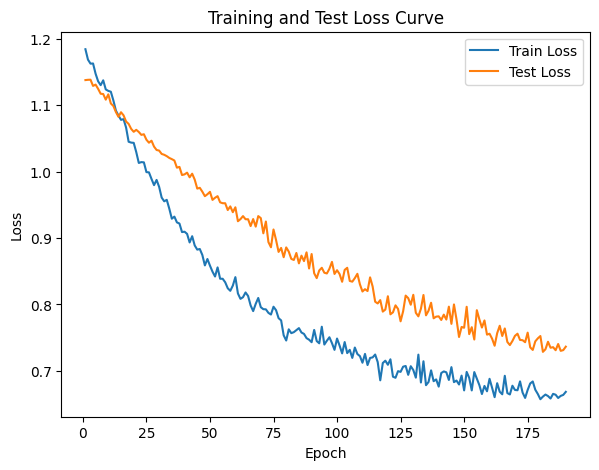

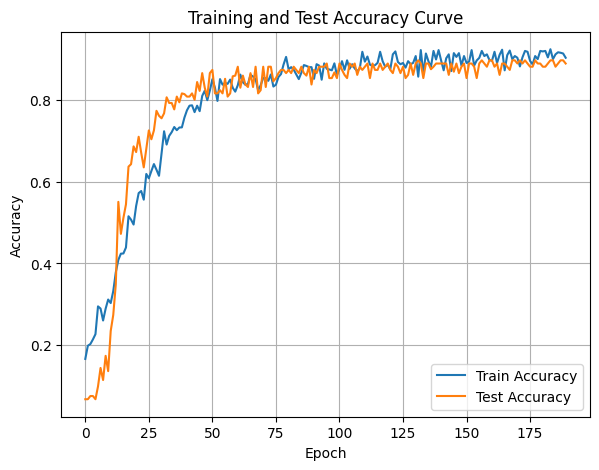

In [73]:
DTEmlp10b.train_single_model()

Randomly initializing 10 models
Training Model with id 1
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.47279071039944526, Train Loss: 1.0591, Train Acc: 0.4982, Test F1:0.5336222801956374, Test Loss: 1.0293, Test Acc: 0.6589


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.74it/s]

Epoch [2/10], Train F1:0.47725879446603237, Train Loss: 1.0554, Train Acc: 0.5039, Test F1:0.5237852185157893, Test Loss: 1.0218, Test Acc: 0.6549
Epoch [3/10], Train F1:0.4829858828548618, Train Loss: 1.0508, Train Acc: 0.5222, Test F1:0.5213819599042699, Test Loss: 1.0204, Test Acc: 0.6536


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.31it/s]

Epoch [4/10], Train F1:0.4917964003606592, Train Loss: 1.0446, Train Acc: 0.5306, Test F1:0.5201717453833007, Test Loss: 1.0179, Test Acc: 0.6530


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.31it/s]

Epoch [5/10], Train F1:0.494288821479503, Train Loss: 1.0403, Train Acc: 0.5394, Test F1:0.5194428483208169, Test Loss: 1.0135, Test Acc: 0.6526


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.54it/s]

Epoch [6/10], Train F1:0.4943085714768961, Train Loss: 1.0385, Train Acc: 0.5416, Test F1:0.5189557585460958, Test Loss: 1.0088, Test Acc: 0.6523


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.59it/s]

Epoch [7/10], Train F1:0.49711251998307043, Train Loss: 1.0364, Train Acc: 0.5448, Test F1:0.519003666131617, Test Loss: 1.0067, Test Acc: 0.6522


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.59it/s]

Epoch [8/10], Train F1:0.49996488978853965, Train Loss: 1.0315, Train Acc: 0.5509, Test F1:0.5186924702974399, Test Loss: 1.0041, Test Acc: 0.6520


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.89it/s]

Epoch [9/10], Train F1:0.5017699321154766, Train Loss: 1.0278, Train Acc: 0.5554, Test F1:0.5187589681444074, Test Loss: 1.0003, Test Acc: 0.6519


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.02it/s]


Epoch [10/10], Train F1:0.5040733051523616, Train Loss: 1.0239, Train Acc: 0.5599, Test F1:0.5185341714464252, Test Loss: 0.9974, Test Acc: 0.6518
Total Epochs: 10
Train loss start: 1.0470764636993408, Train loss end: 0.8348012566566467
Highest Mean Train Accuracy (over epoch): 0.5599404761904762
Test loss start: 1.0044927597045898, Test loss end: 0.9596362709999084
Highest mean Test Accuracy (over epoch): 0.6588541666666666


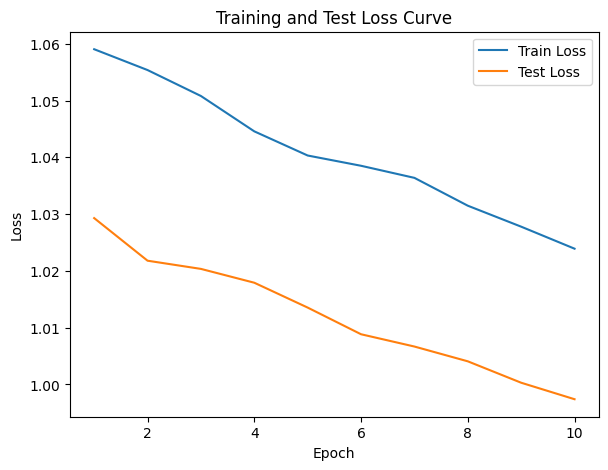

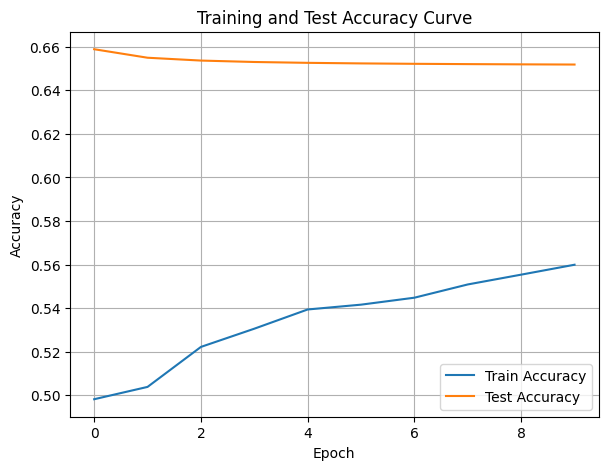

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.62it/s]

Epoch [1/10], Train F1:0.3170529064602205, Train Loss: 1.0828, Train Acc: 0.3295, Test F1:0.269287677023885, Test Loss: 1.0682, Test Acc: 0.3707
Epoch [2/10], Train F1:0.33570202268421984, Train Loss: 1.0848, Train Acc: 0.3499, Test F1:0.2891468524938427, Test Loss: 1.0687, Test Acc: 0.3893


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.34it/s]

Epoch [3/10], Train F1:0.3437416714458952, Train Loss: 1.0799, Train Acc: 0.3580, Test F1:0.2928574666640762, Test Loss: 1.0686, Test Acc: 0.3903
Epoch [4/10], Train F1:0.3546471038642573, Train Loss: 1.0755, Train Acc: 0.3665, Test F1:0.29435131358583433, Test Loss: 1.0667, Test Acc: 0.3869
Epoch [5/10], Train F1:0.3561557560649301, Train Loss: 1.0738, Train Acc: 0.3670, Test F1:0.29521925783261627, Test Loss: 1.0656, Test Acc: 0.3880


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.12it/s]

Epoch [6/10], Train F1:0.358040928668675, Train Loss: 1.0729, Train Acc: 0.3683, Test F1:0.2974895294075352, Test Loss: 1.0639, Test Acc: 0.3924
Epoch [7/10], Train F1:0.3650239465559398, Train Loss: 1.0687, Train Acc: 0.3763, Test F1:0.2976714513556619, Test Loss: 1.0621, Test Acc: 0.3955


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.58it/s]

Epoch [8/10], Train F1:0.371211606782046, Train Loss: 1.0651, Train Acc: 0.3834, Test F1:0.3022135123941761, Test Loss: 1.0601, Test Acc: 0.3988
Epoch [9/10], Train F1:0.3769261354924982, Train Loss: 1.0635, Train Acc: 0.3862, Test F1:0.30351607157422766, Test Loss: 1.0580, Test Acc: 0.4013


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.97it/s]


Epoch [10/10], Train F1:0.3868547425241852, Train Loss: 1.0591, Train Acc: 0.3945, Test F1:0.3135290214661277, Test Loss: 1.0567, Test Acc: 0.4077
Total Epochs: 10
Train loss start: 1.077938437461853, Train loss end: 0.989203929901123
Highest Mean Train Accuracy (over epoch): 0.39452380952380955
Test loss start: 1.0676864385604858, Test loss end: 1.024402141571045
Highest mean Test Accuracy (over epoch): 0.40772569444444445


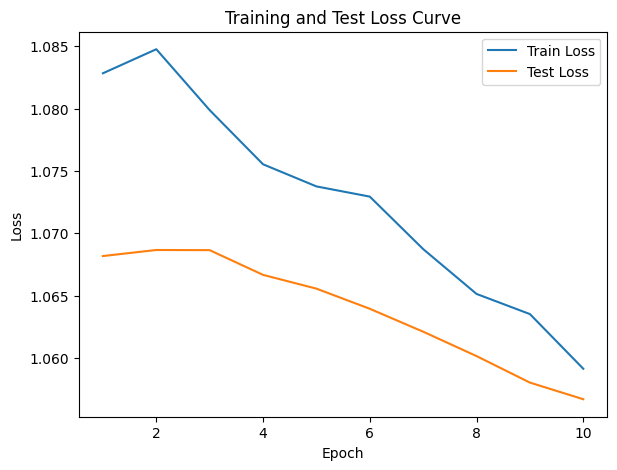

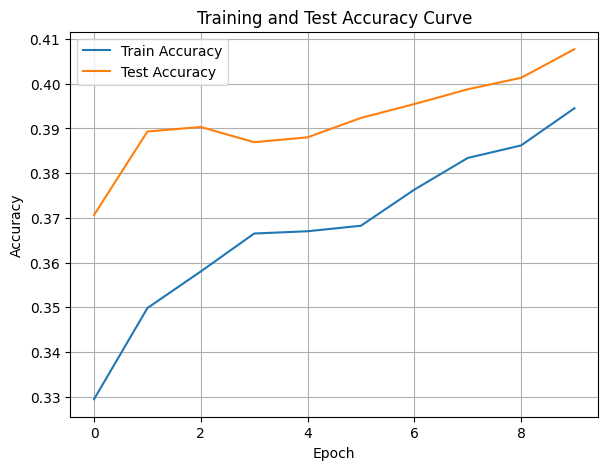

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.41it/s]

Epoch [1/10], Train F1:0.3634186429367153, Train Loss: 1.0812, Train Acc: 0.3923, Test F1:0.1169590643274854, Test Loss: 1.1464, Test Acc: 0.0981


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.20it/s]

Epoch [2/10], Train F1:0.3644277607831502, Train Loss: 1.0810, Train Acc: 0.3838, Test F1:0.11603812681309571, Test Loss: 1.1546, Test Acc: 0.0942


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.09it/s]

Epoch [3/10], Train F1:0.3591227559053057, Train Loss: 1.0854, Train Acc: 0.3820, Test F1:0.1260432634985522, Test Loss: 1.1524, Test Acc: 0.1085


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.28it/s]

Epoch [4/10], Train F1:0.3558052366468612, Train Loss: 1.0825, Train Acc: 0.3830, Test F1:0.13652770280943347, Test Loss: 1.1507, Test Acc: 0.1172


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.23it/s]

Epoch [5/10], Train F1:0.3648388187441202, Train Loss: 1.0806, Train Acc: 0.3846, Test F1:0.1439934446589014, Test Loss: 1.1501, Test Acc: 0.1227


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.82it/s]

Epoch [6/10], Train F1:0.369570680457046, Train Loss: 1.0778, Train Acc: 0.3891, Test F1:0.14482284875744253, Test Loss: 1.1491, Test Acc: 0.1212


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.43it/s]

Epoch [7/10], Train F1:0.3771714798195731, Train Loss: 1.0760, Train Acc: 0.3978, Test F1:0.1582231762287164, Test Loss: 1.1467, Test Acc: 0.1344


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.92it/s]

Epoch [8/10], Train F1:0.3807175321440939, Train Loss: 1.0739, Train Acc: 0.3989, Test F1:0.1669353200762116, Test Loss: 1.1451, Test Acc: 0.1406


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.41it/s]

Epoch [9/10], Train F1:0.3905774296605242, Train Loss: 1.0706, Train Acc: 0.4082, Test F1:0.1764992115526362, Test Loss: 1.1434, Test Acc: 0.1520


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.66it/s]


Epoch [10/10], Train F1:0.39419802668976045, Train Loss: 1.0695, Train Acc: 0.4102, Test F1:0.18413458882500577, Test Loss: 1.1416, Test Acc: 0.1621
Total Epochs: 10
Train loss start: 1.1241159439086914, Train loss end: 1.2299785614013672
Highest Mean Train Accuracy (over epoch): 0.41023809523809524
Test loss start: 1.150995135307312, Test loss end: 1.1219515800476074
Highest mean Test Accuracy (over epoch): 0.16206597222222224


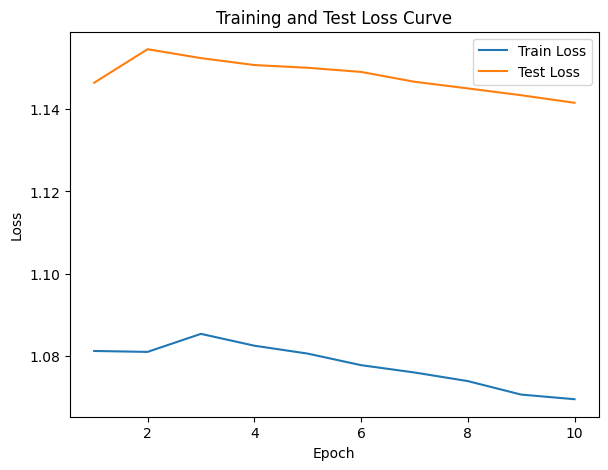

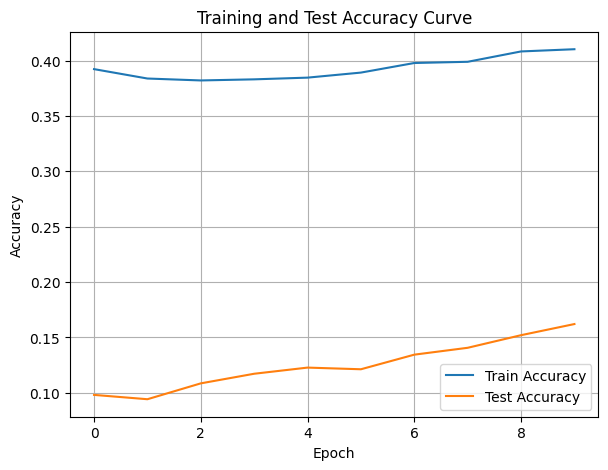

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.45it/s]

Epoch [1/10], Train F1:0.2973794124342479, Train Loss: 1.1581, Train Acc: 0.2399, Test F1:0.23604465709728872, Test Loss: 1.1184, Test Acc: 0.1710


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.50it/s]

Epoch [2/10], Train F1:0.29136624593953053, Train Loss: 1.1537, Train Acc: 0.2347, Test F1:0.19543482361818526, Test Loss: 1.1246, Test Acc: 0.1337


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.50it/s]

Epoch [3/10], Train F1:0.30331181445338584, Train Loss: 1.1480, Train Acc: 0.2479, Test F1:0.20401002506265664, Test Loss: 1.1235, Test Acc: 0.1409


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.38it/s]

Epoch [4/10], Train F1:0.320532824888641, Train Loss: 1.1406, Train Acc: 0.2653, Test F1:0.23695485500383348, Test Loss: 1.1203, Test Acc: 0.1706


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.38it/s]

Epoch [5/10], Train F1:0.32901582282909625, Train Loss: 1.1375, Train Acc: 0.2750, Test F1:0.2480387961774355, Test Loss: 1.1197, Test Acc: 0.1809


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.55it/s]

Epoch [6/10], Train F1:0.3389749709649704, Train Loss: 1.1347, Train Acc: 0.2841, Test F1:0.2535294465119026, Test Loss: 1.1189, Test Acc: 0.1855
Epoch [7/10], Train F1:0.3464052262075058, Train Loss: 1.1311, Train Acc: 0.2918, Test F1:0.2648346972995971, Test Loss: 1.1172, Test Acc: 0.1952


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  9.02it/s]

Epoch [8/10], Train F1:0.3551858559286608, Train Loss: 1.1266, Train Acc: 0.3029, Test F1:0.29484531781296286, Test Loss: 1.1151, Test Acc: 0.2245
Epoch [9/10], Train F1:0.3613987147113325, Train Loss: 1.1238, Train Acc: 0.3104, Test F1:0.3156102718491838, Test Loss: 1.1135, Test Acc: 0.2464


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.80it/s]


Epoch [10/10], Train F1:0.3708282988543688, Train Loss: 1.1200, Train Acc: 0.3212, Test F1:0.3363688724917885, Test Loss: 1.1117, Test Acc: 0.2688
Total Epochs: 10
Train loss start: 1.1412596702575684, Train loss end: 1.0806512832641602
Highest Mean Train Accuracy (over epoch): 0.32122023809523803
Test loss start: 1.1155107021331787, Test loss end: 1.087660789489746
Highest mean Test Accuracy (over epoch): 0.26883680555555556


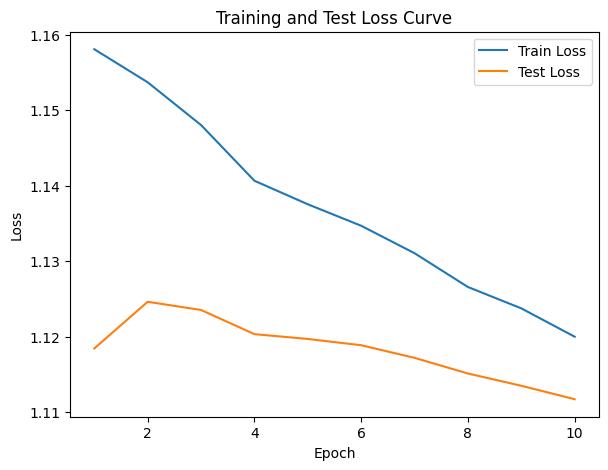

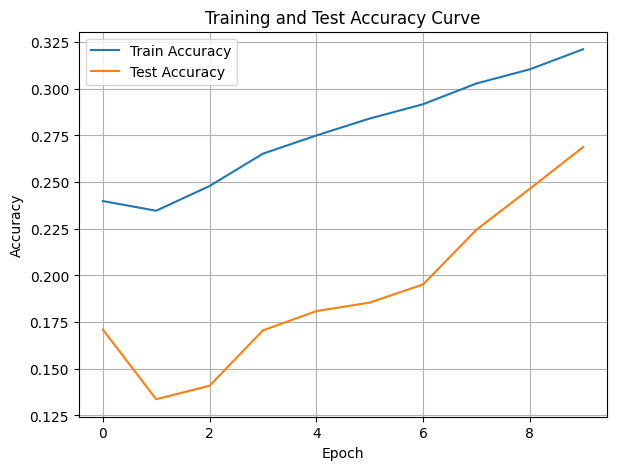

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.17924207226109748, Train Loss: 1.1928, Train Acc: 0.1158, Test F1:0.05982488689255607, Test Loss: 1.1342, Test Acc: 0.0373


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.66it/s]

Epoch [2/10], Train F1:0.1813251942930719, Train Loss: 1.1944, Train Acc: 0.1141, Test F1:0.04930906259470388, Test Loss: 1.1337, Test Acc: 0.0304


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.66it/s]

Epoch [3/10], Train F1:0.19188461003456134, Train Loss: 1.1904, Train Acc: 0.1191, Test F1:0.05003494543801007, Test Loss: 1.1330, Test Acc: 0.0307


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.35it/s]

Epoch [4/10], Train F1:0.18996799977551887, Train Loss: 1.1886, Train Acc: 0.1193, Test F1:0.06383182837476467, Test Loss: 1.1308, Test Acc: 0.0421


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.35it/s]

Epoch [5/10], Train F1:0.20588186302772696, Train Loss: 1.1849, Train Acc: 0.1303, Test F1:0.07232865511271809, Test Loss: 1.1281, Test Acc: 0.0549


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.89it/s]

Epoch [6/10], Train F1:0.21306723027051377, Train Loss: 1.1834, Train Acc: 0.1362, Test F1:0.07754993544467227, Test Loss: 1.1271, Test Acc: 0.0611


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.10it/s]

Epoch [7/10], Train F1:0.22007139129459727, Train Loss: 1.1809, Train Acc: 0.1454, Test F1:0.08300412901254443, Test Loss: 1.1257, Test Acc: 0.0646


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.29it/s]

Epoch [8/10], Train F1:0.22781858727483706, Train Loss: 1.1787, Train Acc: 0.1508, Test F1:0.08677456680053304, Test Loss: 1.1241, Test Acc: 0.0690


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.29it/s]

Epoch [9/10], Train F1:0.2361056034393508, Train Loss: 1.1769, Train Acc: 0.1565, Test F1:0.08825065473465593, Test Loss: 1.1234, Test Acc: 0.0683


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.53it/s]


Epoch [10/10], Train F1:0.24695133581095402, Train Loss: 1.1736, Train Acc: 0.1641, Test F1:0.09081046128819459, Test Loss: 1.1223, Test Acc: 0.0707
Total Epochs: 10
Train loss start: 1.1953505277633667, Train loss end: 1.1910992860794067
Highest Mean Train Accuracy (over epoch): 0.16410714285714284
Test loss start: 1.1382874250411987, Test loss end: 1.1174935102462769
Highest mean Test Accuracy (over epoch): 0.07065972222222222


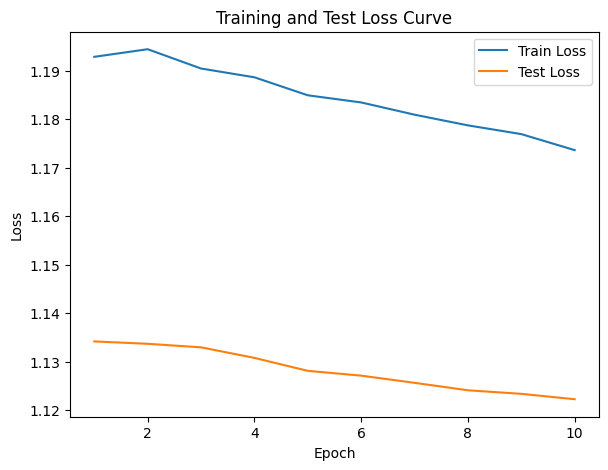

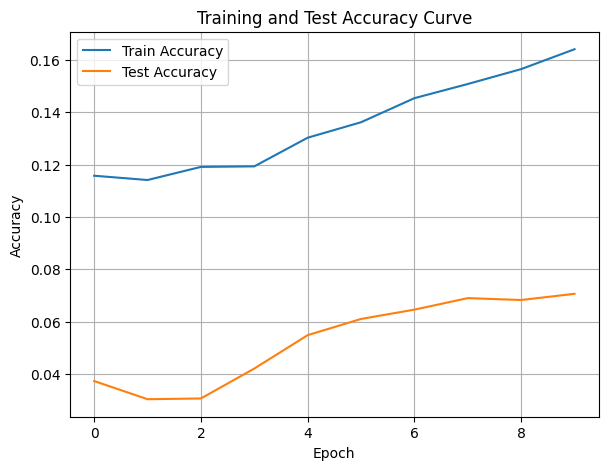

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.67it/s]

Epoch [1/10], Train F1:0.47157218019032676, Train Loss: 1.0287, Train Acc: 0.4702, Test F1:0.6961427136865734, Test Loss: 1.0456, Test Acc: 0.6866


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.10it/s]

Epoch [2/10], Train F1:0.45147138676972465, Train Loss: 1.0319, Train Acc: 0.4546, Test F1:0.7060859084078707, Test Loss: 1.0352, Test Acc: 0.7023


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.03it/s]

Epoch [3/10], Train F1:0.47522989272690624, Train Loss: 1.0258, Train Acc: 0.4744, Test F1:0.7043816769297725, Test Loss: 1.0295, Test Acc: 0.7002


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.49it/s]

Epoch [4/10], Train F1:0.49444514776292625, Train Loss: 1.0238, Train Acc: 0.4887, Test F1:0.7074178807590988, Test Loss: 1.0267, Test Acc: 0.7046


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.94it/s]

Epoch [5/10], Train F1:0.48885211140361584, Train Loss: 1.0247, Train Acc: 0.4854, Test F1:0.7191082265287035, Test Loss: 1.0224, Test Acc: 0.7167


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.94it/s]

Epoch [6/10], Train F1:0.4961416623636954, Train Loss: 1.0221, Train Acc: 0.4918, Test F1:0.726657145917499, Test Loss: 1.0200, Test Acc: 0.7247


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.61it/s]

Epoch [7/10], Train F1:0.5055119551275139, Train Loss: 1.0198, Train Acc: 0.4991, Test F1:0.7367099481283247, Test Loss: 1.0174, Test Acc: 0.7349


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.61it/s]

Epoch [8/10], Train F1:0.5210875901476002, Train Loss: 1.0143, Train Acc: 0.5150, Test F1:0.7392330813143645, Test Loss: 1.0158, Test Acc: 0.7376


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.73it/s]

Epoch [9/10], Train F1:0.5318643623791713, Train Loss: 1.0104, Train Acc: 0.5264, Test F1:0.744993808581216, Test Loss: 1.0138, Test Acc: 0.7432


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.31it/s]


Epoch [10/10], Train F1:0.5377711503968593, Train Loss: 1.0088, Train Acc: 0.5295, Test F1:0.7503998270541185, Test Loss: 1.0117, Test Acc: 0.7485
Total Epochs: 10
Train loss start: 0.9887098073959351, Train loss end: 1.0971187353134155
Highest Mean Train Accuracy (over epoch): 0.5294642857142857
Test loss start: 1.0455892086029053, Test loss end: 0.9686414003372192
Highest mean Test Accuracy (over epoch): 0.7485243055555555


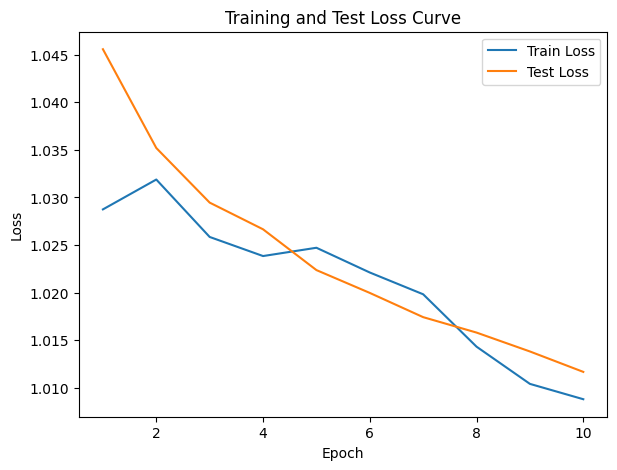

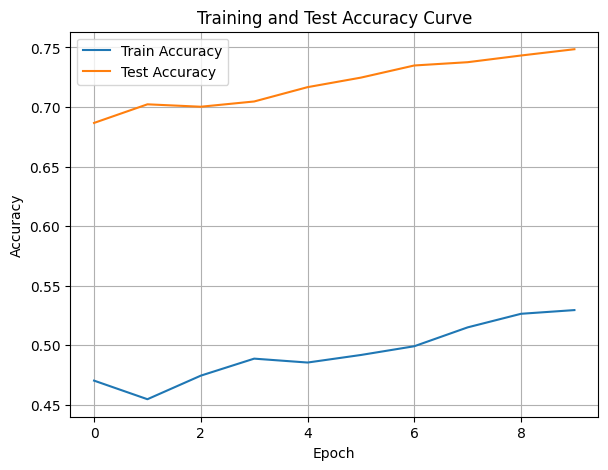

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.29it/s]

Epoch [1/10], Train F1:0.1901714790350305, Train Loss: 1.1802, Train Acc: 0.1690, Test F1:0.21592442645074225, Test Loss: 1.1501, Test Acc: 0.1806


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.09it/s]

Epoch [2/10], Train F1:0.19250206794458197, Train Loss: 1.1798, Train Acc: 0.1749, Test F1:0.204448128194502, Test Loss: 1.1565, Test Acc: 0.1688
Epoch [3/10], Train F1:0.20361044541190812, Train Loss: 1.1768, Train Acc: 0.1822, Test F1:0.18997770669768343, Test Loss: 1.1619, Test Acc: 0.1499


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.09it/s]

Epoch [4/10], Train F1:0.20171263910905277, Train Loss: 1.1773, Train Acc: 0.1821, Test F1:0.18733273862622654, Test Loss: 1.1638, Test Acc: 0.1443


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.79it/s]

Epoch [5/10], Train F1:0.2019937299527713, Train Loss: 1.1756, Train Acc: 0.1874, Test F1:0.18327605956471937, Test Loss: 1.1637, Test Acc: 0.1394


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.79it/s]

Epoch [6/10], Train F1:0.20644531150864665, Train Loss: 1.1746, Train Acc: 0.1861, Test F1:0.18870706177207724, Test Loss: 1.1605, Test Acc: 0.1463


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.30it/s]

Epoch [7/10], Train F1:0.21584522485837446, Train Loss: 1.1698, Train Acc: 0.1957, Test F1:0.19002375296912113, Test Loss: 1.1581, Test Acc: 0.1481


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.30it/s]

Epoch [8/10], Train F1:0.22163256742621498, Train Loss: 1.1676, Train Acc: 0.2000, Test F1:0.19517095396979156, Test Loss: 1.1563, Test Acc: 0.1541


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.86it/s]

Epoch [9/10], Train F1:0.23301239301239302, Train Loss: 1.1638, Train Acc: 0.2092, Test F1:0.19978772554161206, Test Loss: 1.1542, Test Acc: 0.1605


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.76it/s]


Epoch [10/10], Train F1:0.2380245458070472, Train Loss: 1.1607, Train Acc: 0.2126, Test F1:0.19969537992892197, Test Loss: 1.1536, Test Acc: 0.1595
Total Epochs: 10
Train loss start: 1.1597802639007568, Train loss end: 1.1311607360839844
Highest Mean Train Accuracy (over epoch): 0.2125892857142857
Test loss start: 1.165244698524475, Test loss end: 1.1196942329406738
Highest mean Test Accuracy (over epoch): 0.18055555555555555


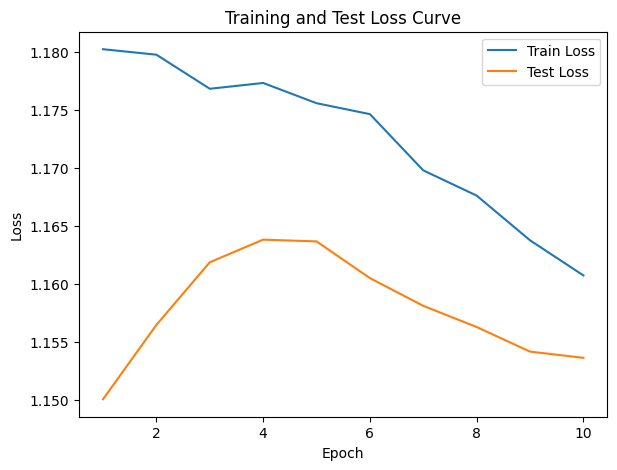

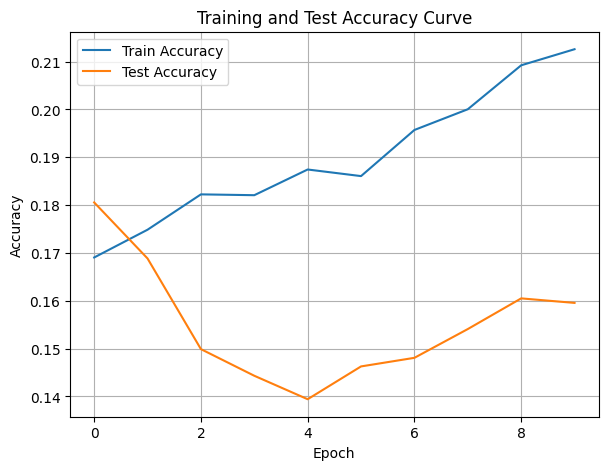

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.25322182671188287, Train Loss: 1.1440, Train Acc: 0.2783, Test F1:0.1941216678058783, Test Loss: 1.1327, Test Acc: 0.2960


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [2/10], Train F1:0.2719364173533395, Train Loss: 1.1404, Train Acc: 0.2845, Test F1:0.19854553887144258, Test Loss: 1.1369, Test Acc: 0.3069


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [3/10], Train F1:0.2808126955153786, Train Loss: 1.1348, Train Acc: 0.2926, Test F1:0.20001317382210373, Test Loss: 1.1385, Test Acc: 0.3105


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.53it/s]

Epoch [4/10], Train F1:0.2933540705000109, Train Loss: 1.1261, Train Acc: 0.3078, Test F1:0.20199214328409432, Test Loss: 1.1387, Test Acc: 0.3142


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.53it/s]

Epoch [5/10], Train F1:0.3031075721655479, Train Loss: 1.1216, Train Acc: 0.3127, Test F1:0.19805092713679973, Test Loss: 1.1391, Test Acc: 0.3106


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.13it/s]

Epoch [6/10], Train F1:0.31592051411645644, Train Loss: 1.1175, Train Acc: 0.3241, Test F1:0.19923172103678516, Test Loss: 1.1375, Test Acc: 0.3121


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.13it/s]

Epoch [7/10], Train F1:0.3230795078542444, Train Loss: 1.1155, Train Acc: 0.3287, Test F1:0.197527173805598, Test Loss: 1.1369, Test Acc: 0.3109


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.18it/s]

Epoch [8/10], Train F1:0.3288819774578913, Train Loss: 1.1103, Train Acc: 0.3362, Test F1:0.199167118337714, Test Loss: 1.1344, Test Acc: 0.3147


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.18it/s]

Epoch [9/10], Train F1:0.33694253680094083, Train Loss: 1.1083, Train Acc: 0.3437, Test F1:0.201263903733762, Test Loss: 1.1326, Test Acc: 0.3193


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.67it/s]


Epoch [10/10], Train F1:0.3451163900539559, Train Loss: 1.1046, Train Acc: 0.3517, Test F1:0.20510230566941248, Test Loss: 1.1313, Test Acc: 0.3253
Total Epochs: 10
Train loss start: 1.1497421264648438, Train loss end: 1.0679833889007568
Highest Mean Train Accuracy (over epoch): 0.35169642857142863
Test loss start: 1.1397194862365723, Test loss end: 1.1176667213439941
Highest mean Test Accuracy (over epoch): 0.32526041666666666


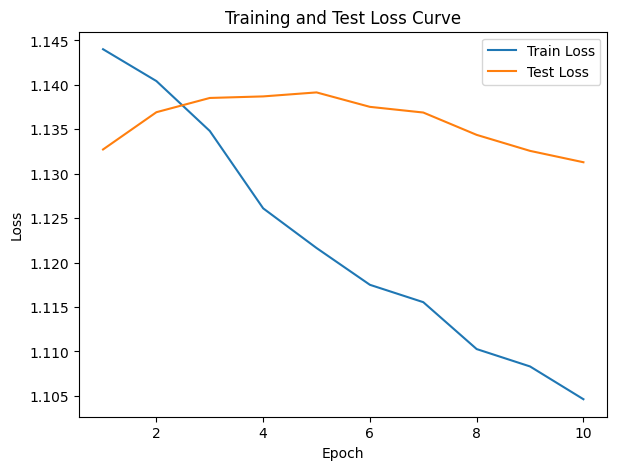

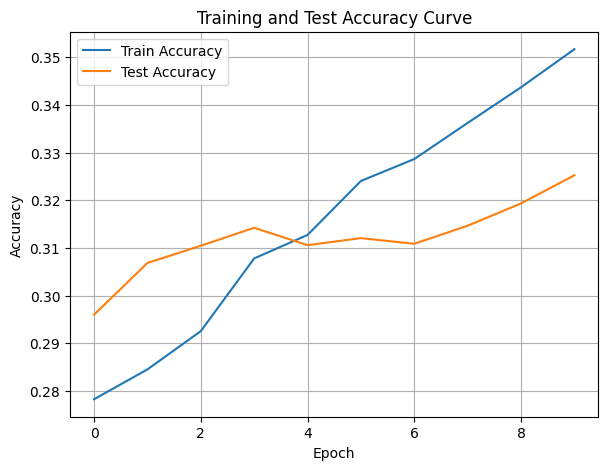

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.74it/s]

Epoch [1/10], Train F1:0.4033954980013071, Train Loss: 1.0510, Train Acc: 0.4033, Test F1:0.6130924325739723, Test Loss: 1.0549, Test Acc: 0.5547
Epoch [2/10], Train F1:0.4061652076993897, Train Loss: 1.0511, Train Acc: 0.4074, Test F1:0.6206903814157242, Test Loss: 1.0531, Test Acc: 0.5851


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.74it/s]

Epoch [3/10], Train F1:0.4166335620993789, Train Loss: 1.0442, Train Acc: 0.4204, Test F1:0.6307743265010866, Test Loss: 1.0488, Test Acc: 0.6076


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.76it/s]

Epoch [4/10], Train F1:0.43411807995067087, Train Loss: 1.0367, Train Acc: 0.4360, Test F1:0.6320403059203158, Test Loss: 1.0475, Test Acc: 0.6170
Epoch [5/10], Train F1:0.446614461304205, Train Loss: 1.0318, Train Acc: 0.4485, Test F1:0.6364111221342551, Test Loss: 1.0442, Test Acc: 0.6241


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.07it/s]

Epoch [6/10], Train F1:0.46162133691436424, Train Loss: 1.0260, Train Acc: 0.4640, Test F1:0.6491427859573908, Test Loss: 1.0436, Test Acc: 0.6331
Epoch [7/10], Train F1:0.4725948728094076, Train Loss: 1.0231, Train Acc: 0.4734, Test F1:0.6577956226297569, Test Loss: 1.0396, Test Acc: 0.6426


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.28it/s]

Epoch [8/10], Train F1:0.47622316962472455, Train Loss: 1.0214, Train Acc: 0.4764, Test F1:0.6634767846795269, Test Loss: 1.0359, Test Acc: 0.6497
Epoch [9/10], Train F1:0.47941186916999784, Train Loss: 1.0196, Train Acc: 0.4797, Test F1:0.662229303369355, Test Loss: 1.0338, Test Acc: 0.6509


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.92it/s]


Epoch [10/10], Train F1:0.49141444822782854, Train Loss: 1.0164, Train Acc: 0.4880, Test F1:0.6634446966898317, Test Loss: 1.0322, Test Acc: 0.6535
Total Epochs: 10
Train loss start: 1.0358532667160034, Train loss end: 1.107228398323059
Highest Mean Train Accuracy (over epoch): 0.48797619047619045
Test loss start: 1.0634132623672485, Test loss end: 1.0186117887496948
Highest mean Test Accuracy (over epoch): 0.6534722222222222


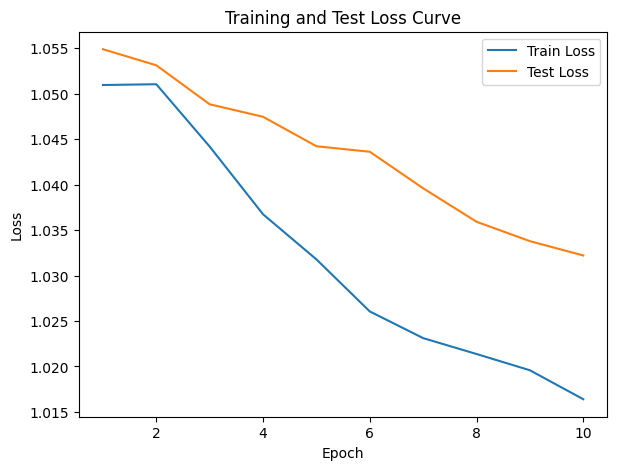

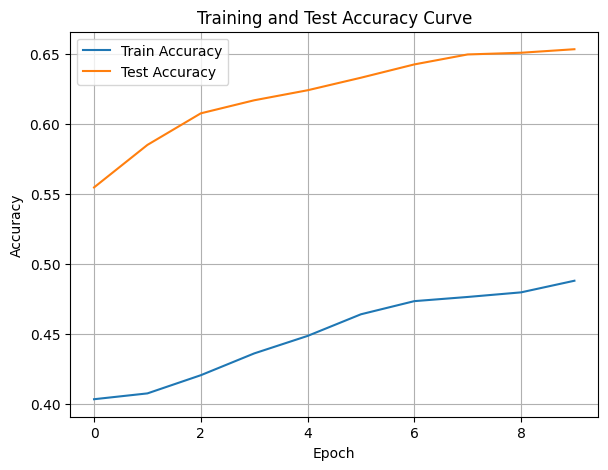

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.38it/s]

Epoch [1/10], Train F1:0.2522073848529265, Train Loss: 1.1514, Train Acc: 0.2932, Test F1:0.23154312326477, Test Loss: 1.1156, Test Acc: 0.2118
Epoch [2/10], Train F1:0.2639346838983978, Train Loss: 1.1434, Train Acc: 0.2999, Test F1:0.2464336476910787, Test Loss: 1.1138, Test Acc: 0.2109


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.38it/s]

Epoch [3/10], Train F1:0.26602511596819, Train Loss: 1.1383, Train Acc: 0.3035, Test F1:0.25179990388490714, Test Loss: 1.1129, Test Acc: 0.2060


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.07it/s]

Epoch [4/10], Train F1:0.275472443686343, Train Loss: 1.1345, Train Acc: 0.3105, Test F1:0.2509626938744531, Test Loss: 1.1142, Test Acc: 0.2016


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.07it/s]

Epoch [5/10], Train F1:0.27563874001600774, Train Loss: 1.1311, Train Acc: 0.3105, Test F1:0.2521814282205009, Test Loss: 1.1131, Test Acc: 0.2002


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.09it/s]

Epoch [6/10], Train F1:0.2861238958901672, Train Loss: 1.1264, Train Acc: 0.3201, Test F1:0.2618061578698465, Test Loss: 1.1111, Test Acc: 0.2067


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.09it/s]

Epoch [7/10], Train F1:0.28877933676745365, Train Loss: 1.1261, Train Acc: 0.3215, Test F1:0.2794004708044892, Test Loss: 1.1074, Test Acc: 0.2257


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.70it/s]

Epoch [8/10], Train F1:0.29756476035530255, Train Loss: 1.1231, Train Acc: 0.3279, Test F1:0.29203434711829357, Test Loss: 1.1057, Test Acc: 0.2316


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.52it/s]

Epoch [9/10], Train F1:0.29919279975145896, Train Loss: 1.1196, Train Acc: 0.3318, Test F1:0.3049731517484884, Test Loss: 1.1033, Test Acc: 0.2418


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.68it/s]


Epoch [10/10], Train F1:0.3028983676659838, Train Loss: 1.1171, Train Acc: 0.3351, Test F1:0.3125327007279825, Test Loss: 1.1010, Test Acc: 0.2494
Total Epochs: 10
Train loss start: 1.1841723918914795, Train loss end: 1.1749757528305054
Highest Mean Train Accuracy (over epoch): 0.33514880952380954
Test loss start: 1.1378836631774902, Test loss end: 1.071454405784607
Highest mean Test Accuracy (over epoch): 0.24939236111111113


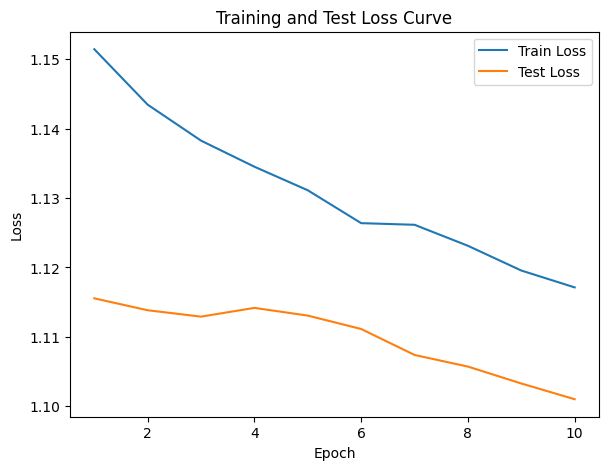

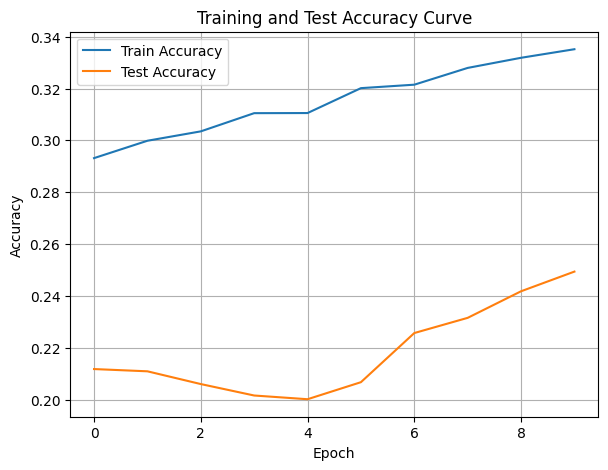

./saved_models/model_10.pth
Training Model with id 14
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.97it/s]

Epoch [1/10], Train F1:0.3200311084309218, Train Loss: 1.0993, Train Acc: 0.3408, Test F1:0.4052631578947369, Test Loss: 1.0801, Test Acc: 0.3177
Epoch [2/10], Train F1:0.33469525275341655, Train Loss: 1.0913, Train Acc: 0.3549, Test F1:0.3878635580994927, Test Loss: 1.0849, Test Acc: 0.3099


Epoch [3/10], Train F1:0.3433206531412173, Train Loss: 1.0870, Train Acc: 0.3701, Test F1:0.37542162650893707, Test Loss: 1.0772, Test Acc: 0.3420
Epoch [4/10], Train F1:0.35160169664354657, Train Loss: 1.0799, Train Acc: 0.3824, Test F1:0.43017978831375964, Test Loss: 1.0723, Test Acc: 0.3889


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.99it/s]

Epoch [5/10], Train F1:0.37016063863232335, Train Loss: 1.0750, Train Acc: 0.3965, Test F1:0.46792436206649707, Test Loss: 1.0695, Test Acc: 0.4127
Epoch [6/10], Train F1:0.3706267749340984, Train Loss: 1.0718, Train Acc: 0.3984, Test F1:0.49776401788785696, Test Loss: 1.0671, Test Acc: 0.4376
Epoch [7/10], Train F1:0.3717672756643675, Train Loss: 1.0702, Train Acc: 0.3974, Test F1:0.5171318696957029, Test Loss: 1.0651, Test Acc: 0.4513


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.92it/s]

Epoch [8/10], Train F1:0.3740770278244625, Train Loss: 1.0668, Train Acc: 0.4026, Test F1:0.5113701226492174, Test Loss: 1.0639, Test Acc: 0.4486
Epoch [9/10], Train F1:0.38289866806270634, Train Loss: 1.0644, Train Acc: 0.4093, Test F1:0.5362468980886491, Test Loss: 1.0615, Test Acc: 0.4715


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.25it/s]


Epoch [10/10], Train F1:0.38875810972126024, Train Loss: 1.0622, Train Acc: 0.4128, Test F1:0.5599692281614479, Test Loss: 1.0583, Test Acc: 0.4969
Total Epochs: 10
Train loss start: 1.143051028251648, Train loss end: 1.0885891914367676
Highest Mean Train Accuracy (over epoch): 0.412797619047619
Test loss start: 1.1031608581542969, Test loss end: 1.0121525526046753
Highest mean Test Accuracy (over epoch): 0.496875


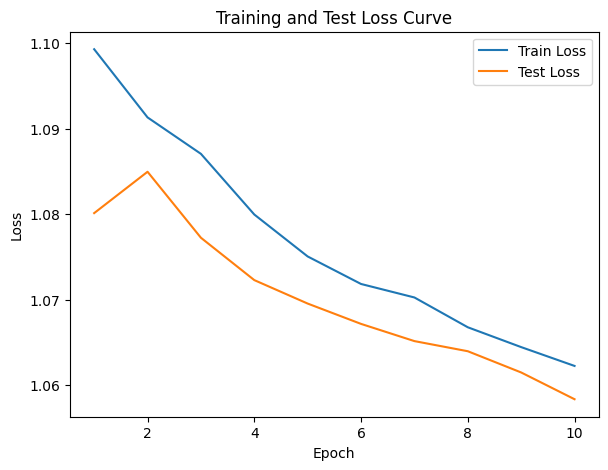

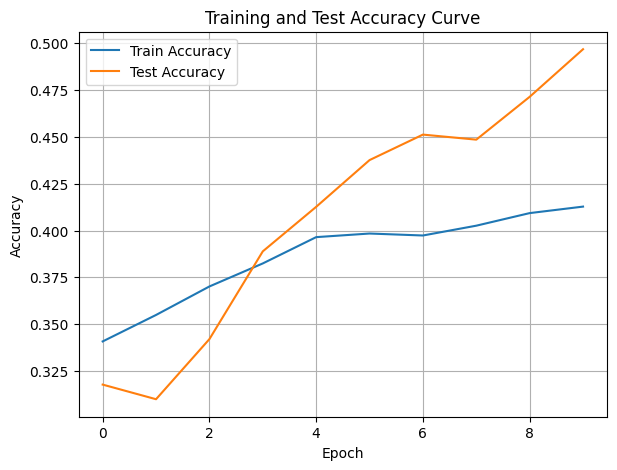

./saved_models/model_14.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4510131830944014, Train Loss: 1.0368, Train Acc: 0.4598, Test F1:0.714032600992204, Test Loss: 1.0372, Test Acc: 0.6823


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.23it/s]

Epoch [2/10], Train F1:0.46408952131332615, Train Loss: 1.0345, Train Acc: 0.4798, Test F1:0.6773765013626963, Test Loss: 1.0403, Test Acc: 0.6580


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.23it/s]

Epoch [3/10], Train F1:0.4792077437238727, Train Loss: 1.0256, Train Acc: 0.4940, Test F1:0.6904214716691807, Test Loss: 1.0362, Test Acc: 0.6753


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.93it/s]

Epoch [4/10], Train F1:0.4812014493231612, Train Loss: 1.0232, Train Acc: 0.4952, Test F1:0.707786466837898, Test Loss: 1.0292, Test Acc: 0.6938


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.93it/s]

Epoch [5/10], Train F1:0.48667047060310603, Train Loss: 1.0201, Train Acc: 0.5000, Test F1:0.7172378207181238, Test Loss: 1.0271, Test Acc: 0.7021


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.44it/s]

Epoch [6/10], Train F1:0.4934191784234891, Train Loss: 1.0186, Train Acc: 0.5025, Test F1:0.721187066196584, Test Loss: 1.0239, Test Acc: 0.7073


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.44it/s]

Epoch [7/10], Train F1:0.49304696783529794, Train Loss: 1.0149, Train Acc: 0.5055, Test F1:0.7271766685808443, Test Loss: 1.0203, Test Acc: 0.7127


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.98it/s]

Epoch [8/10], Train F1:0.5028078366124467, Train Loss: 1.0119, Train Acc: 0.5141, Test F1:0.7333412311448327, Test Loss: 1.0181, Test Acc: 0.7186


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.90it/s]

Epoch [9/10], Train F1:0.5097048702751079, Train Loss: 1.0088, Train Acc: 0.5186, Test F1:0.7406403663852748, Test Loss: 1.0145, Test Acc: 0.7272


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.40it/s]


Epoch [10/10], Train F1:0.520649164869468, Train Loss: 1.0059, Train Acc: 0.5253, Test F1:0.7445957157446095, Test Loss: 1.0119, Test Acc: 0.7319
Total Epochs: 10
Train loss start: 1.0378246307373047, Train loss end: 1.100284218788147
Highest Mean Train Accuracy (over epoch): 0.5252976190476191
Test loss start: 1.0578036308288574, Test loss end: 0.9694964289665222
Highest mean Test Accuracy (over epoch): 0.7319444444444445


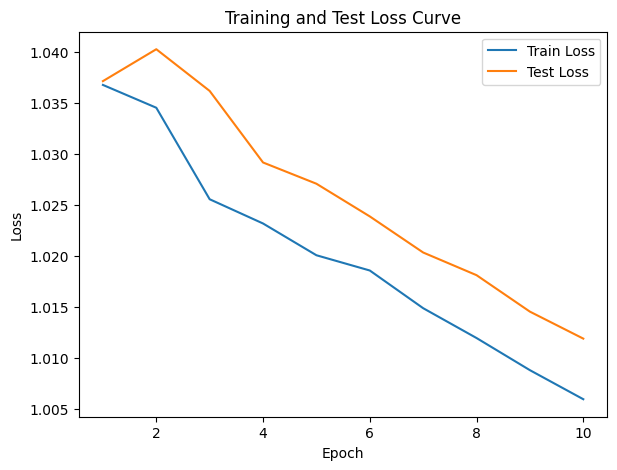

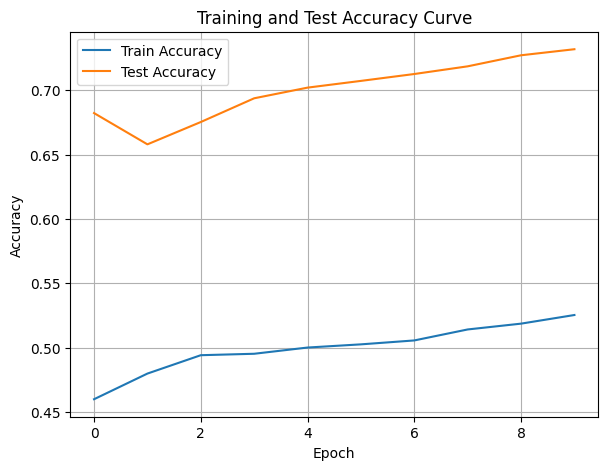

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.40it/s]

Epoch [1/10], Train F1:0.5769652125999566, Train Loss: 0.9904, Train Acc: 0.5693, Test F1:0.8082064134695713, Test Loss: 0.9803, Test Acc: 0.7977


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.01it/s]

Epoch [2/10], Train F1:0.5725067633762732, Train Loss: 0.9851, Train Acc: 0.5683, Test F1:0.7875011577016224, Test Loss: 0.9869, Test Acc: 0.7752


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.93it/s]

Epoch [3/10], Train F1:0.5986492673992674, Train Loss: 0.9750, Train Acc: 0.5909, Test F1:0.7905337287373057, Test Loss: 0.9900, Test Acc: 0.7775


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.93it/s]

Epoch [4/10], Train F1:0.604582850821179, Train Loss: 0.9733, Train Acc: 0.5935, Test F1:0.7949531688299338, Test Loss: 0.9894, Test Acc: 0.7826


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.02it/s]

Epoch [5/10], Train F1:0.6146673066758995, Train Loss: 0.9669, Train Acc: 0.6033, Test F1:0.7986145440465449, Test Loss: 0.9884, Test Acc: 0.7856


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.45it/s]

Epoch [6/10], Train F1:0.620689658206353, Train Loss: 0.9644, Train Acc: 0.6116, Test F1:0.7954472486405403, Test Loss: 0.9880, Test Acc: 0.7834


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.19it/s]

Epoch [7/10], Train F1:0.6219048437690503, Train Loss: 0.9627, Train Acc: 0.6113, Test F1:0.7981977090979915, Test Loss: 0.9862, Test Acc: 0.7875


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.92it/s]

Epoch [8/10], Train F1:0.63017853004195, Train Loss: 0.9590, Train Acc: 0.6182, Test F1:0.8008663759241688, Test Loss: 0.9822, Test Acc: 0.7914


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.57it/s]


Epoch [9/10], Train F1:0.6341864698204409, Train Loss: 0.9555, Train Acc: 0.6220, Test F1:0.8020161448994345, Test Loss: 0.9800, Test Acc: 0.7937
Epoch [10/10], Train F1:0.6391653514017901, Train Loss: 0.9521, Train Acc: 0.6273, Test F1:0.8036056018931869, Test Loss: 0.9783, Test Acc: 0.7963
Total Epochs: 10
Train loss start: 1.0042648315429688, Train loss end: 0.9152047038078308
Highest Mean Train Accuracy (over epoch): 0.6272619047619048
Test loss start: 0.9947791695594788, Test loss end: 0.9454268217086792
Highest mean Test Accuracy (over epoch): 0.7977430555555556


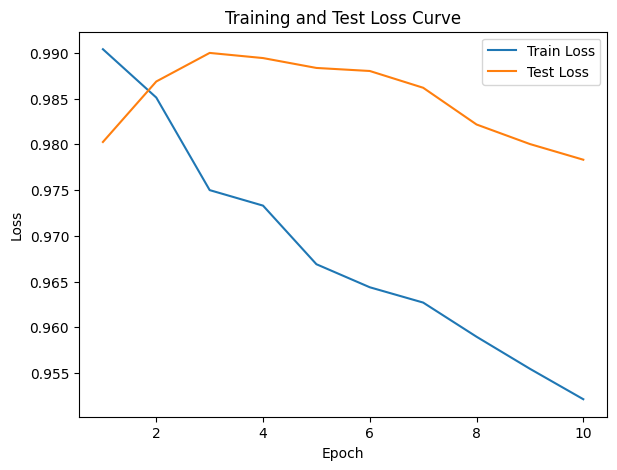

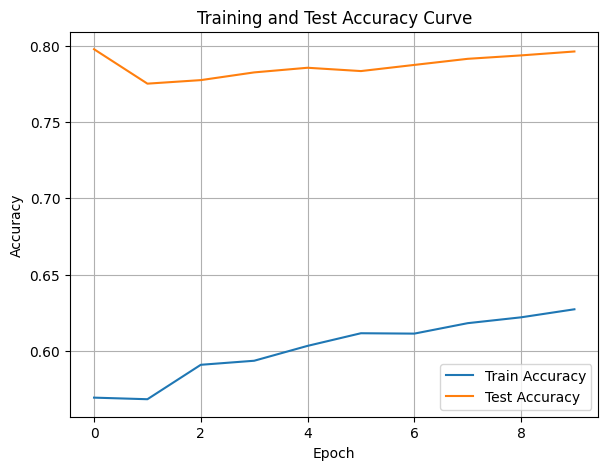

./saved_models/model_15.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.67it/s]

Epoch [1/10], Train F1:0.6960434117060623, Train Loss: 0.9210, Train Acc: 0.6967, Test F1:0.8111170546782334, Test Loss: 0.9569, Test Acc: 0.8116
Epoch [2/10], Train F1:0.6845423568285584, Train Loss: 0.9301, Train Acc: 0.6720, Test F1:0.8234251035663512, Test Loss: 0.9534, Test Acc: 0.8234


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.67it/s]

Epoch [3/10], Train F1:0.6897351022237374, Train Loss: 0.9236, Train Acc: 0.6792, Test F1:0.8247979264127707, Test Loss: 0.9518, Test Acc: 0.8247


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.28it/s]

Epoch [4/10], Train F1:0.6986782299570564, Train Loss: 0.9209, Train Acc: 0.6861, Test F1:0.8271304739389848, Test Loss: 0.9507, Test Acc: 0.8273


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.28it/s]

Epoch [5/10], Train F1:0.7068968790989437, Train Loss: 0.9173, Train Acc: 0.6936, Test F1:0.8241634283288337, Test Loss: 0.9480, Test Acc: 0.8257


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.32it/s]

Epoch [6/10], Train F1:0.7123960155427927, Train Loss: 0.9149, Train Acc: 0.6979, Test F1:0.8271900800897443, Test Loss: 0.9466, Test Acc: 0.8296


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.43it/s]

Epoch [7/10], Train F1:0.7154024910306449, Train Loss: 0.9126, Train Acc: 0.7006, Test F1:0.8296146550961386, Test Loss: 0.9445, Test Acc: 0.8315


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.48it/s]

Epoch [8/10], Train F1:0.7120353205082188, Train Loss: 0.9119, Train Acc: 0.6966, Test F1:0.8303973633838493, Test Loss: 0.9426, Test Acc: 0.8319


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.56it/s]

Epoch [9/10], Train F1:0.7131816297460079, Train Loss: 0.9087, Train Acc: 0.6988, Test F1:0.8319253150650758, Test Loss: 0.9420, Test Acc: 0.8331


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.86it/s]


Epoch [10/10], Train F1:0.7202375138655567, Train Loss: 0.9055, Train Acc: 0.7064, Test F1:0.8348074521936486, Test Loss: 0.9392, Test Acc: 0.8363
Total Epochs: 10
Train loss start: 0.966881513595581, Train loss end: 0.9272703528404236
Highest Mean Train Accuracy (over epoch): 0.7063690476190476
Test loss start: 0.9707207679748535, Test loss end: 0.8999096751213074
Highest mean Test Accuracy (over epoch): 0.8362847222222222


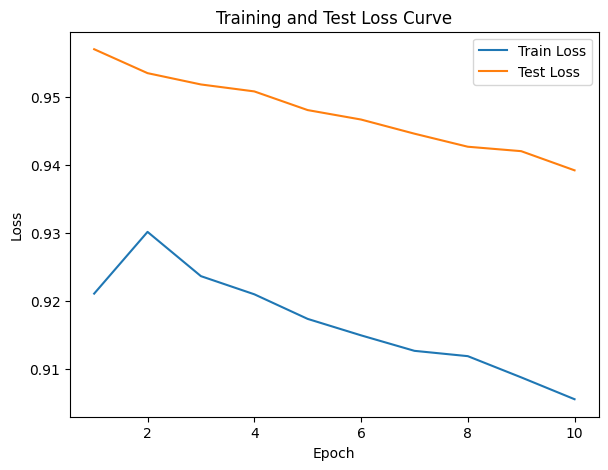

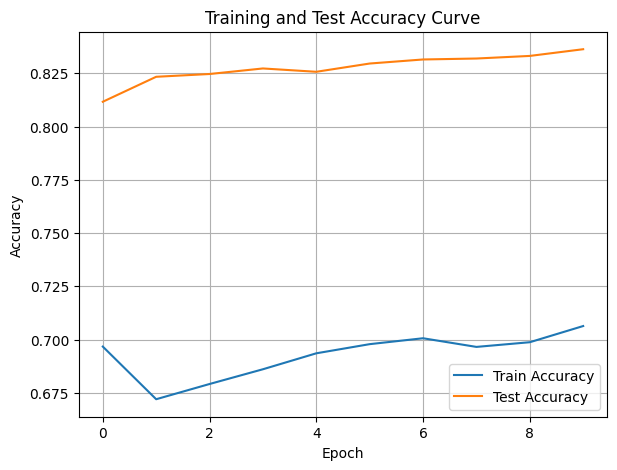

./saved_models/model_13.pth
Training Model with id 15
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8189813879416449, Train Loss: 0.8572, Train Acc: 0.8080, Test F1:0.8525283797729619, Test Loss: 0.9204, Test Acc: 0.8507


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.02it/s]

Epoch [2/10], Train F1:0.8012014504970661, Train Loss: 0.8595, Train Acc: 0.7961, Test F1:0.8516993326925361, Test Loss: 0.9192, Test Acc: 0.8537


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.02it/s]

Epoch [3/10], Train F1:0.7927195317523921, Train Loss: 0.8594, Train Acc: 0.7919, Test F1:0.8576047556908801, Test Loss: 0.9161, Test Acc: 0.8600


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.58it/s]

Epoch [4/10], Train F1:0.7905512082134071, Train Loss: 0.8592, Train Acc: 0.7894, Test F1:0.8571368679050568, Test Loss: 0.9188, Test Acc: 0.8592


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.27it/s]

Epoch [5/10], Train F1:0.7870285800033892, Train Loss: 0.8606, Train Acc: 0.7825, Test F1:0.8599019607843138, Test Loss: 0.9185, Test Acc: 0.8618


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.02it/s]

Epoch [6/10], Train F1:0.7864821065359071, Train Loss: 0.8595, Train Acc: 0.7815, Test F1:0.8603363744610396, Test Loss: 0.9172, Test Acc: 0.8613


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.17it/s]

Epoch [7/10], Train F1:0.7903657732763206, Train Loss: 0.8555, Train Acc: 0.7872, Test F1:0.854466387805423, Test Loss: 0.9152, Test Acc: 0.8564


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.04it/s]

Epoch [8/10], Train F1:0.7852842107789068, Train Loss: 0.8578, Train Acc: 0.7782, Test F1:0.8563337285458943, Test Loss: 0.9130, Test Acc: 0.8584


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.26it/s]

Epoch [9/10], Train F1:0.7875454039585351, Train Loss: 0.8554, Train Acc: 0.7796, Test F1:0.8589083929088711, Test Loss: 0.9110, Test Acc: 0.8608


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.29it/s]


Epoch [10/10], Train F1:0.7901328267849184, Train Loss: 0.8535, Train Acc: 0.7822, Test F1:0.8609681243992526, Test Loss: 0.9092, Test Acc: 0.8628
Total Epochs: 10
Train loss start: 0.8177674412727356, Train loss end: 0.7994966506958008
Highest Mean Train Accuracy (over epoch): 0.8080357142857142
Test loss start: 0.9296284914016724, Test loss end: 0.880031168460846
Highest mean Test Accuracy (over epoch): 0.8627604166666668


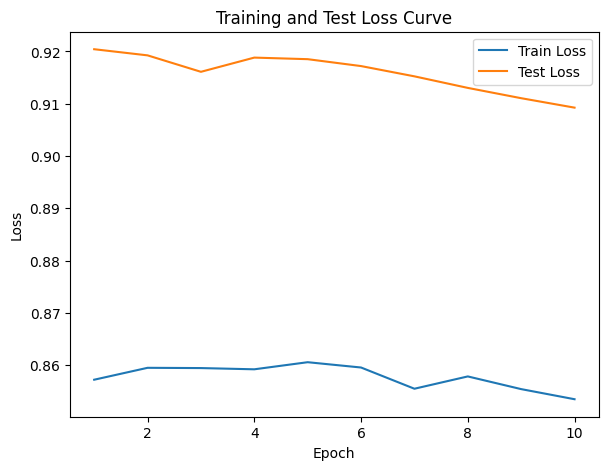

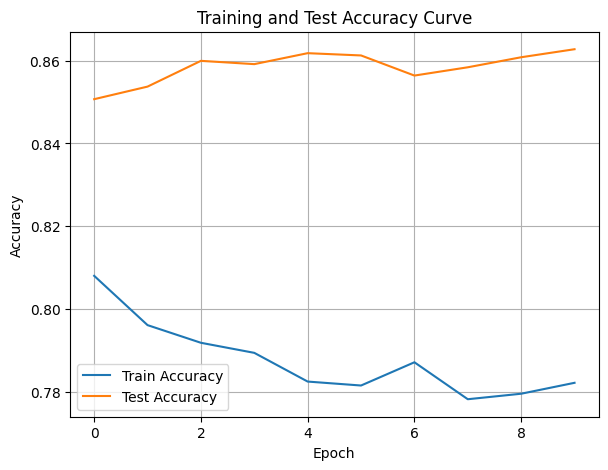

./saved_models/model_15.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.91it/s]

Epoch [1/10], Train F1:0.7774719136854249, Train Loss: 0.8606, Train Acc: 0.7631, Test F1:0.8795057078126853, Test Loss: 0.9019, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.28it/s]

Epoch [2/10], Train F1:0.800747777806077, Train Loss: 0.8436, Train Acc: 0.7860, Test F1:0.8694744718136531, Test Loss: 0.8914, Test Acc: 0.8724


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.58it/s]

Epoch [3/10], Train F1:0.808138878950594, Train Loss: 0.8389, Train Acc: 0.7937, Test F1:0.8676465700059167, Test Loss: 0.8895, Test Acc: 0.8678


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.48it/s]

Epoch [4/10], Train F1:0.8109650770840572, Train Loss: 0.8344, Train Acc: 0.8015, Test F1:0.8656025202526109, Test Loss: 0.8879, Test Acc: 0.8670


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.48it/s]

Epoch [5/10], Train F1:0.819991523139223, Train Loss: 0.8285, Train Acc: 0.8137, Test F1:0.8683831577646258, Test Loss: 0.8886, Test Acc: 0.8696


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.79it/s]

Epoch [6/10], Train F1:0.8222731909442559, Train Loss: 0.8249, Train Acc: 0.8171, Test F1:0.8685661705240879, Test Loss: 0.8891, Test Acc: 0.8701


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.75it/s]

Epoch [7/10], Train F1:0.8228103029518519, Train Loss: 0.8237, Train Acc: 0.8176, Test F1:0.8672599688289813, Test Loss: 0.8855, Test Acc: 0.8693


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.95it/s]

Epoch [8/10], Train F1:0.8233979685779335, Train Loss: 0.8208, Train Acc: 0.8198, Test F1:0.8675364882795225, Test Loss: 0.8816, Test Acc: 0.8697


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.07it/s]

Epoch [9/10], Train F1:0.8233135445333875, Train Loss: 0.8198, Train Acc: 0.8194, Test F1:0.8632589704714463, Test Loss: 0.8795, Test Acc: 0.8665


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.08it/s]


Epoch [10/10], Train F1:0.8263644400645082, Train Loss: 0.8166, Train Acc: 0.8235, Test F1:0.8638805206056669, Test Loss: 0.8785, Test Acc: 0.8671
Total Epochs: 10
Train loss start: 0.8508708477020264, Train loss end: 0.7527093887329102
Highest Mean Train Accuracy (over epoch): 0.8235416666666666
Test loss start: 0.9075876474380493, Test loss end: 0.8592760562896729
Highest mean Test Accuracy (over epoch): 0.8802083333333334


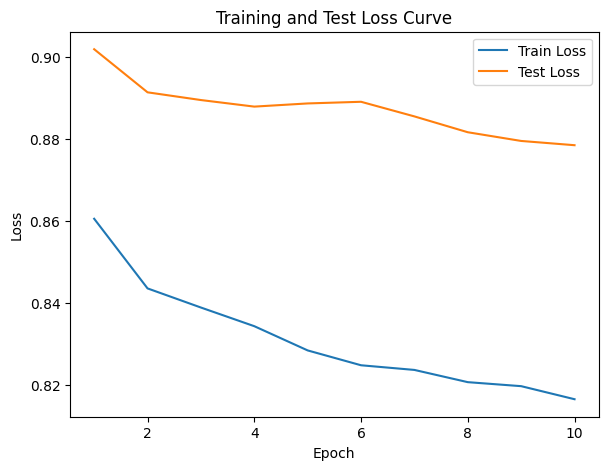

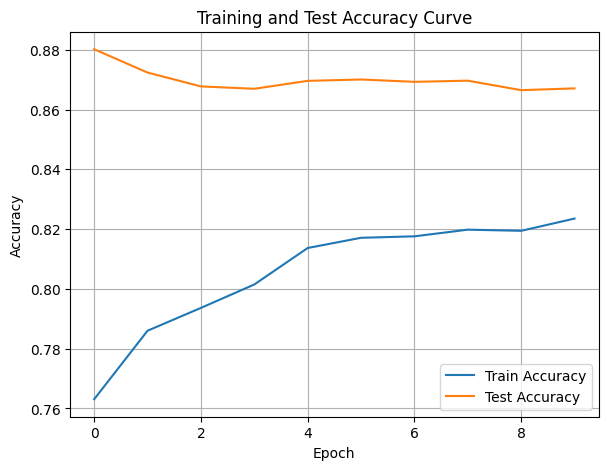

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8536314996956395, Train Loss: 0.7898, Train Acc: 0.8530, Test F1:0.8694744718136531, Test Loss: 0.8663, Test Acc: 0.8724


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.55it/s]

Epoch [2/10], Train F1:0.8439653475090746, Train Loss: 0.7959, Train Acc: 0.8314, Test F1:0.8694744718136531, Test Loss: 0.8585, Test Acc: 0.8724


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.55it/s]

Epoch [3/10], Train F1:0.8460558056547051, Train Loss: 0.7929, Train Acc: 0.8379, Test F1:0.8694744718136532, Test Loss: 0.8563, Test Acc: 0.8724


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.37it/s]

Epoch [4/10], Train F1:0.847357821461407, Train Loss: 0.7908, Train Acc: 0.8411, Test F1:0.8719959766436592, Test Loss: 0.8570, Test Acc: 0.8743


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.37it/s]

Epoch [5/10], Train F1:0.8481625090584115, Train Loss: 0.7874, Train Acc: 0.8446, Test F1:0.8717945102214326, Test Loss: 0.8563, Test Acc: 0.8727


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.51it/s]

Epoch [6/10], Train F1:0.8489140277744456, Train Loss: 0.7873, Train Acc: 0.8435, Test F1:0.8716587312176389, Test Loss: 0.8560, Test Acc: 0.8717


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.51it/s]

Epoch [7/10], Train F1:0.84795867673439, Train Loss: 0.7856, Train Acc: 0.8434, Test F1:0.8713492107620672, Test Loss: 0.8548, Test Acc: 0.8718


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.71it/s]

Epoch [8/10], Train F1:0.8507292631568727, Train Loss: 0.7832, Train Acc: 0.8467, Test F1:0.872554114032648, Test Loss: 0.8549, Test Acc: 0.8728


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.88it/s]


Epoch [9/10], Train F1:0.8504940901104281, Train Loss: 0.7819, Train Acc: 0.8471, Test F1:0.8733265133415411, Test Loss: 0.8546, Test Acc: 0.8736
Epoch [10/10], Train F1:0.8521734985253688, Train Loss: 0.7819, Train Acc: 0.8484, Test F1:0.8729445959039471, Test Loss: 0.8527, Test Acc: 0.8735
Total Epochs: 10
Train loss start: 0.7624478936195374, Train loss end: 0.9336032271385193
Highest Mean Train Accuracy (over epoch): 0.8529761904761906
Test loss start: 0.8666300773620605, Test loss end: 0.8297801613807678
Highest mean Test Accuracy (over epoch): 0.8743489583333334


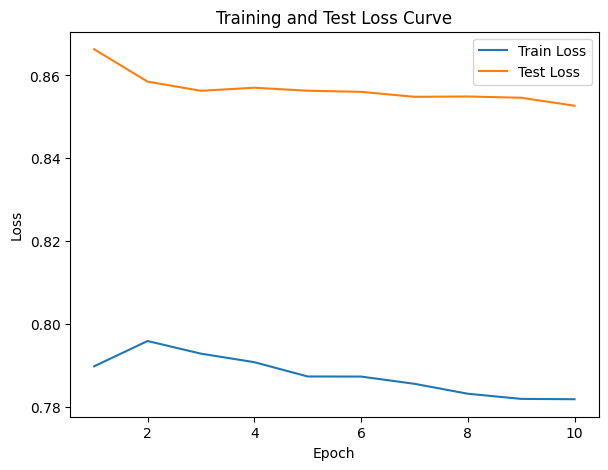

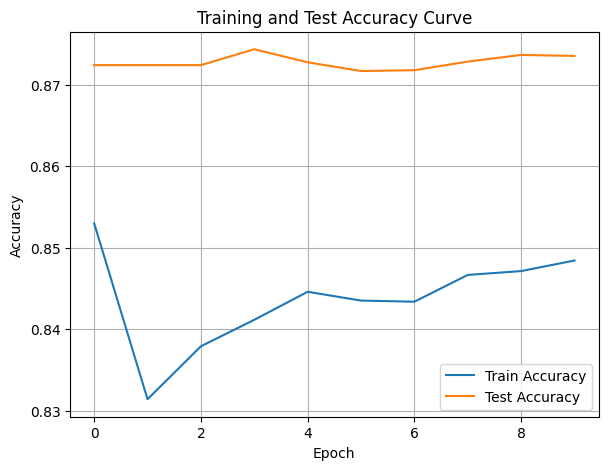

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.84it/s]

Epoch [1/10], Train F1:0.8594174937273088, Train Loss: 0.7635, Train Acc: 0.8667, Test F1:0.8694744718136531, Test Loss: 0.8337, Test Acc: 0.8724


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.77it/s]

Epoch [2/10], Train F1:0.8571978705241718, Train Loss: 0.7632, Train Acc: 0.8609, Test F1:0.8694744718136531, Test Loss: 0.8310, Test Acc: 0.8724


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.11it/s]

Epoch [3/10], Train F1:0.8663317249604292, Train Loss: 0.7599, Train Acc: 0.8687, Test F1:0.8733265133415411, Test Loss: 0.8329, Test Acc: 0.8750


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.09it/s]

Epoch [4/10], Train F1:0.8731530041691022, Train Loss: 0.7580, Train Acc: 0.8741, Test F1:0.8748713119593272, Test Loss: 0.8330, Test Acc: 0.8763


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.09it/s]

Epoch [5/10], Train F1:0.8706800615124148, Train Loss: 0.7576, Train Acc: 0.8686, Test F1:0.8757981911299989, Test Loss: 0.8311, Test Acc: 0.8771


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.45it/s]

Epoch [6/10], Train F1:0.8683504868975913, Train Loss: 0.7573, Train Acc: 0.8679, Test F1:0.8764161105771133, Test Loss: 0.8295, Test Acc: 0.8786


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.57it/s]

Epoch [7/10], Train F1:0.8661861785123839, Train Loss: 0.7568, Train Acc: 0.8661, Test F1:0.8754310991153096, Test Loss: 0.8293, Test Acc: 0.8777


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.90it/s]

Epoch [8/10], Train F1:0.8669440936988204, Train Loss: 0.7575, Train Acc: 0.8649, Test F1:0.8759408217984839, Test Loss: 0.8283, Test Acc: 0.8780


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.90it/s]

Epoch [9/10], Train F1:0.8676720056664088, Train Loss: 0.7555, Train Acc: 0.8667, Test F1:0.8730002606945698, Test Loss: 0.8261, Test Acc: 0.8757


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.04it/s]


Epoch [10/10], Train F1:0.8695804352483377, Train Loss: 0.7531, Train Acc: 0.8687, Test F1:0.8726491150476812, Test Loss: 0.8245, Test Acc: 0.8753
Total Epochs: 10
Train loss start: 0.7659314274787903, Train loss end: 0.7153539061546326
Highest Mean Train Accuracy (over epoch): 0.8741071428571429
Test loss start: 0.82766193151474, Test loss end: 0.8066104054450989
Highest mean Test Accuracy (over epoch): 0.8786168981481483


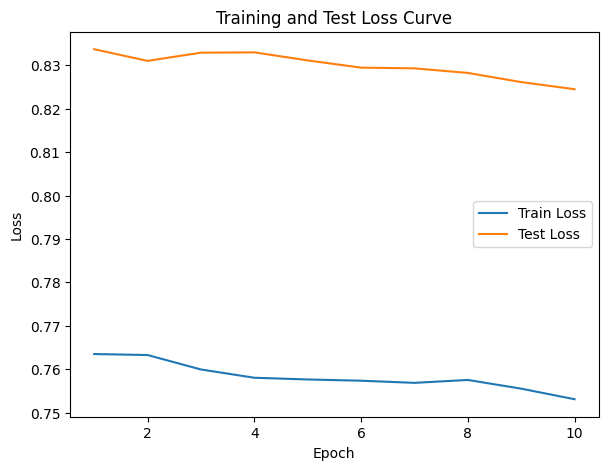

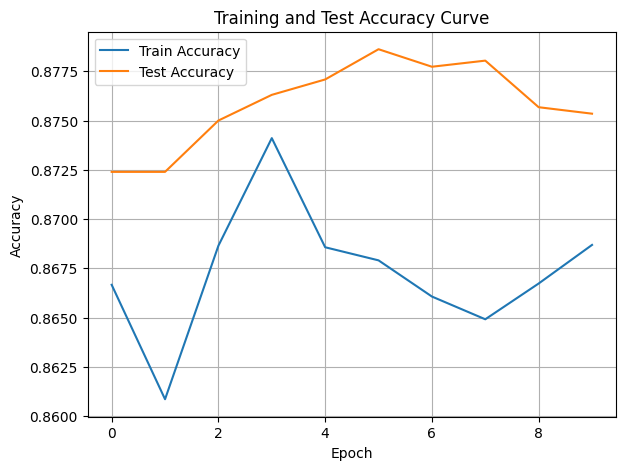

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.93it/s]

Epoch [1/10], Train F1:0.8915555203250177, Train Loss: 0.7360, Train Acc: 0.8979, Test F1:0.8592931124413203, Test Loss: 0.7992, Test Acc: 0.8646
Epoch [2/10], Train F1:0.8778341765518028, Train Loss: 0.7407, Train Acc: 0.8817, Test F1:0.8592931124413203, Test Loss: 0.8052, Test Acc: 0.8646


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.06it/s]

Epoch [3/10], Train F1:0.8709727662034579, Train Loss: 0.7408, Train Acc: 0.8717, Test F1:0.8660978476272295, Test Loss: 0.8067, Test Acc: 0.8718
Epoch [4/10], Train F1:0.8706396651083859, Train Loss: 0.7409, Train Acc: 0.8712, Test F1:0.867341284885247, Test Loss: 0.8035, Test Acc: 0.8720


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.64it/s]

Epoch [5/10], Train F1:0.868544741970145, Train Loss: 0.7403, Train Acc: 0.8707, Test F1:0.8697839822029128, Test Loss: 0.8020, Test Acc: 0.8748
Epoch [6/10], Train F1:0.8731636505830433, Train Loss: 0.7378, Train Acc: 0.8747, Test F1:0.8697328203688001, Test Loss: 0.8008, Test Acc: 0.8744


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.77it/s]

Epoch [7/10], Train F1:0.8732894494523878, Train Loss: 0.7361, Train Acc: 0.8746, Test F1:0.8668106855241359, Test Loss: 0.7991, Test Acc: 0.8719


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.70it/s]

Epoch [8/10], Train F1:0.8712670784007804, Train Loss: 0.7363, Train Acc: 0.8736, Test F1:0.865877648699456, Test Loss: 0.7983, Test Acc: 0.8710
Epoch [9/10], Train F1:0.8745143870064435, Train Loss: 0.7337, Train Acc: 0.8772, Test F1:0.8651506589502266, Test Loss: 0.7970, Test Acc: 0.8703


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.87it/s]


Epoch [10/10], Train F1:0.8751597284561106, Train Loss: 0.7332, Train Acc: 0.8775, Test F1:0.8667571172363746, Test Loss: 0.7964, Test Acc: 0.8713
Total Epochs: 10
Train loss start: 0.7439383268356323, Train loss end: 0.7694822549819946
Highest Mean Train Accuracy (over epoch): 0.8979166666666667
Test loss start: 0.7857592105865479, Test loss end: 0.7912399768829346
Highest mean Test Accuracy (over epoch): 0.874826388888889


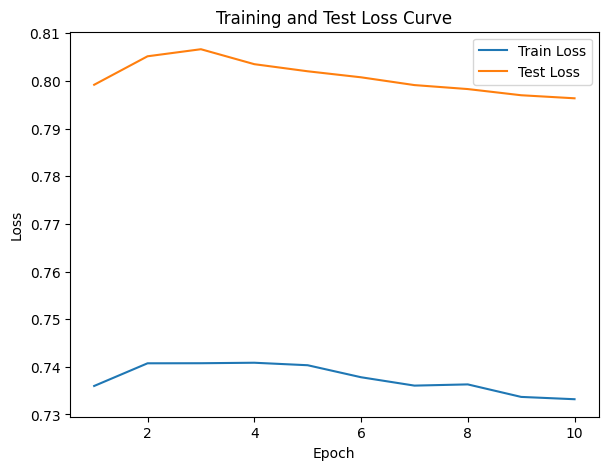

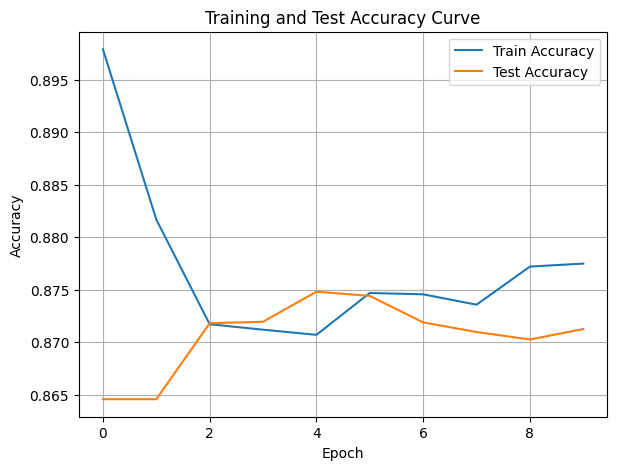

./saved_models/model_12.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [74]:
DTEmlp10b.train_DTE()

Training Process:   1%|          | 1/190 [00:00<00:29,  6.47it/s]

Epoch [1/190], Train F1:0.4561059779104892, Train Loss: 1.1031, Train Acc: 0.3961, Test F1:0.5365667615486224, Test Loss: 1.0621, Test Acc: 0.5625
Epoch [2/190], Train F1:0.44999093939614837, Train Loss: 1.1025, Train Acc: 0.3878, Test F1:0.5497076023391814, Test Loss: 1.0581, Test Acc: 0.5851


Training Process:   2%|▏         | 4/190 [00:00<00:27,  6.88it/s]

Epoch [3/190], Train F1:0.45667057508248576, Train Loss: 1.0984, Train Acc: 0.3934, Test F1:0.5565281269961039, Test Loss: 1.0525, Test Acc: 0.5926
Epoch [4/190], Train F1:0.4533629811796289, Train Loss: 1.0976, Train Acc: 0.3935, Test F1:0.5531092758115539, Test Loss: 1.0503, Test Acc: 0.5909


Training Process:   3%|▎         | 6/190 [00:00<00:25,  7.18it/s]

Epoch [5/190], Train F1:0.4640103574905404, Train Loss: 1.0927, Train Acc: 0.4030, Test F1:0.5546343930000439, Test Loss: 1.0499, Test Acc: 0.5955
Epoch [6/190], Train F1:0.469226138065981, Train Loss: 1.0898, Train Acc: 0.4130, Test F1:0.5532912741624175, Test Loss: 1.0466, Test Acc: 0.5998


Training Process:   4%|▍         | 8/190 [00:01<00:23,  7.72it/s]

Epoch [7/190], Train F1:0.4721066226634436, Train Loss: 1.0867, Train Acc: 0.4190, Test F1:0.5549353180932128, Test Loss: 1.0449, Test Acc: 0.6049
Epoch [8/190], Train F1:0.480240300252569, Train Loss: 1.0834, Train Acc: 0.4278, Test F1:0.5583421393808288, Test Loss: 1.0434, Test Acc: 0.6080


Training Process:   5%|▌         | 10/190 [00:01<00:21,  8.42it/s]

Epoch [9/190], Train F1:0.4875315859211513, Train Loss: 1.0799, Train Acc: 0.4370, Test F1:0.5614682836923549, Test Loss: 1.0415, Test Acc: 0.6150
Epoch [10/190], Train F1:0.49705890926050084, Train Loss: 1.0759, Train Acc: 0.4476, Test F1:0.562962580733937, Test Loss: 1.0382, Test Acc: 0.6214


Training Process:   6%|▋         | 12/190 [00:01<00:20,  8.68it/s]

Epoch [11/190], Train F1:0.5038149965558563, Train Loss: 1.0730, Train Acc: 0.4556, Test F1:0.565869434962006, Test Loss: 1.0358, Test Acc: 0.6253
Epoch [12/190], Train F1:0.5093156239145953, Train Loss: 1.0698, Train Acc: 0.4611, Test F1:0.5696200194421654, Test Loss: 1.0325, Test Acc: 0.6316


Training Process:   7%|▋         | 13/190 [00:01<00:20,  8.74it/s]

Epoch [13/190], Train F1:0.5134735606476052, Train Loss: 1.0669, Train Acc: 0.4666, Test F1:0.5718966154131404, Test Loss: 1.0305, Test Acc: 0.6347


Training Process:   8%|▊         | 15/190 [00:02<00:24,  7.06it/s]

Epoch [14/190], Train F1:0.5180273673544659, Train Loss: 1.0637, Train Acc: 0.4732, Test F1:0.5722136923969666, Test Loss: 1.0288, Test Acc: 0.6379
Epoch [15/190], Train F1:0.5235907959583342, Train Loss: 1.0604, Train Acc: 0.4805, Test F1:0.5747799771145893, Test Loss: 1.0270, Test Acc: 0.6417


Training Process:   9%|▉         | 17/190 [00:02<00:23,  7.52it/s]

Epoch [16/190], Train F1:0.5318280708356357, Train Loss: 1.0568, Train Acc: 0.4895, Test F1:0.576836748987342, Test Loss: 1.0257, Test Acc: 0.6450
Epoch [17/190], Train F1:0.5371194116644519, Train Loss: 1.0536, Train Acc: 0.4957, Test F1:0.5778143274853802, Test Loss: 1.0238, Test Acc: 0.6474


Training Process:  10%|█         | 19/190 [00:02<00:21,  8.09it/s]

Epoch [18/190], Train F1:0.5426060552176749, Train Loss: 1.0507, Train Acc: 0.5023, Test F1:0.5804250370014684, Test Loss: 1.0222, Test Acc: 0.6508
Epoch [19/190], Train F1:0.5474185987070006, Train Loss: 1.0476, Train Acc: 0.5071, Test F1:0.5811100820224473, Test Loss: 1.0202, Test Acc: 0.6527


Training Process:  11%|█         | 21/190 [00:02<00:20,  8.24it/s]

Epoch [20/190], Train F1:0.5504048652888736, Train Loss: 1.0448, Train Acc: 0.5114, Test F1:0.5823596568047771, Test Loss: 1.0179, Test Acc: 0.6552
Epoch [21/190], Train F1:0.5545895243900084, Train Loss: 1.0416, Train Acc: 0.5174, Test F1:0.5842337346893167, Test Loss: 1.0163, Test Acc: 0.6574


Training Process:  12%|█▏        | 23/190 [00:03<00:23,  7.17it/s]

Epoch [22/190], Train F1:0.5592535423233163, Train Loss: 1.0388, Train Acc: 0.5229, Test F1:0.5868441202861827, Test Loss: 1.0150, Test Acc: 0.6598
Epoch [23/190], Train F1:0.5645572635619158, Train Loss: 1.0357, Train Acc: 0.5287, Test F1:0.5885456159670331, Test Loss: 1.0139, Test Acc: 0.6620


Training Process:  13%|█▎        | 24/190 [00:03<00:24,  6.80it/s]

Epoch [24/190], Train F1:0.5680670369702688, Train Loss: 1.0330, Train Acc: 0.5333, Test F1:0.5908089401389247, Test Loss: 1.0124, Test Acc: 0.6643


Training Process:  13%|█▎        | 25/190 [00:03<00:26,  6.25it/s]

Epoch [25/190], Train F1:0.5726460967099868, Train Loss: 1.0297, Train Acc: 0.5393, Test F1:0.593560674759552, Test Loss: 1.0112, Test Acc: 0.6668


Training Process:  14%|█▎        | 26/190 [00:03<00:30,  5.30it/s]

Epoch [26/190], Train F1:0.5770850692362268, Train Loss: 1.0268, Train Acc: 0.5450, Test F1:0.596622437529686, Test Loss: 1.0096, Test Acc: 0.6696


Training Process:  14%|█▍        | 27/190 [00:03<00:30,  5.36it/s]

Epoch [27/190], Train F1:0.5826789383848775, Train Loss: 1.0238, Train Acc: 0.5509, Test F1:0.5988257248199518, Test Loss: 1.0084, Test Acc: 0.6716


Training Process:  15%|█▍        | 28/190 [00:04<00:30,  5.31it/s]

Epoch [28/190], Train F1:0.5876525013146808, Train Loss: 1.0209, Train Acc: 0.5564, Test F1:0.6024281529107374, Test Loss: 1.0073, Test Acc: 0.6741


Training Process:  16%|█▌        | 30/190 [00:04<00:29,  5.47it/s]

Epoch [29/190], Train F1:0.5906669943215428, Train Loss: 1.0181, Train Acc: 0.5601, Test F1:0.6053994632511924, Test Loss: 1.0055, Test Acc: 0.6767
Epoch [30/190], Train F1:0.5945568390541259, Train Loss: 1.0149, Train Acc: 0.5646, Test F1:0.6080598696624459, Test Loss: 1.0040, Test Acc: 0.6790


Training Process:  17%|█▋        | 32/190 [00:04<00:28,  5.57it/s]

Epoch [31/190], Train F1:0.5984879560499461, Train Loss: 1.0118, Train Acc: 0.5692, Test F1:0.6142097957259715, Test Loss: 1.0028, Test Acc: 0.6830
Epoch [32/190], Train F1:0.6033871996324494, Train Loss: 1.0088, Train Acc: 0.5745, Test F1:0.6179025507917149, Test Loss: 1.0012, Test Acc: 0.6857


Training Process:  18%|█▊        | 34/190 [00:05<00:26,  5.99it/s]

Epoch [33/190], Train F1:0.6077239154044725, Train Loss: 1.0060, Train Acc: 0.5794, Test F1:0.6198933556713588, Test Loss: 0.9998, Test Acc: 0.6874
Epoch [34/190], Train F1:0.6117948000327161, Train Loss: 1.0032, Train Acc: 0.5836, Test F1:0.6231675350644306, Test Loss: 0.9982, Test Acc: 0.6899


Training Process:  19%|█▉        | 36/190 [00:05<00:23,  6.45it/s]

Epoch [35/190], Train F1:0.6157912430517236, Train Loss: 1.0005, Train Acc: 0.5877, Test F1:0.6275907906479288, Test Loss: 0.9968, Test Acc: 0.6929
Epoch [36/190], Train F1:0.6204871191698663, Train Loss: 0.9976, Train Acc: 0.5926, Test F1:0.6304274520292826, Test Loss: 0.9950, Test Acc: 0.6950


Training Process:  20%|██        | 38/190 [00:05<00:27,  5.63it/s]

Epoch [37/190], Train F1:0.6242904330908037, Train Loss: 0.9950, Train Acc: 0.5965, Test F1:0.6322520678643467, Test Loss: 0.9933, Test Acc: 0.6966
Epoch [38/190], Train F1:0.627616200256575, Train Loss: 0.9922, Train Acc: 0.6007, Test F1:0.6372458156960294, Test Loss: 0.9917, Test Acc: 0.6998


Training Process:  21%|██        | 40/190 [00:06<00:26,  5.75it/s]

Epoch [39/190], Train F1:0.6311417620695149, Train Loss: 0.9895, Train Acc: 0.6048, Test F1:0.6419385547587856, Test Loss: 0.9899, Test Acc: 0.7029
Epoch [40/190], Train F1:0.6347444208157454, Train Loss: 0.9868, Train Acc: 0.6089, Test F1:0.646356898201246, Test Loss: 0.9882, Test Acc: 0.7057


Training Process:  22%|██▏       | 42/190 [00:06<00:25,  5.88it/s]

Epoch [41/190], Train F1:0.6381308649032909, Train Loss: 0.9842, Train Acc: 0.6127, Test F1:0.650359589008298, Test Loss: 0.9870, Test Acc: 0.7081
Epoch [42/190], Train F1:0.6412323104193602, Train Loss: 0.9814, Train Acc: 0.6163, Test F1:0.6525160211829514, Test Loss: 0.9855, Test Acc: 0.7098


Training Process:  23%|██▎       | 43/190 [00:06<00:25,  5.75it/s]

Epoch [43/190], Train F1:0.6449868639647027, Train Loss: 0.9788, Train Acc: 0.6202, Test F1:0.6562993859657972, Test Loss: 0.9841, Test Acc: 0.7123


Training Process:  23%|██▎       | 44/190 [00:06<00:25,  5.64it/s]

Epoch [44/190], Train F1:0.6490381666365032, Train Loss: 0.9759, Train Acc: 0.6245, Test F1:0.659548522836144, Test Loss: 0.9826, Test Acc: 0.7145


Training Process:  24%|██▎       | 45/190 [00:07<00:29,  4.99it/s]

Epoch [45/190], Train F1:0.6526916358939067, Train Loss: 0.9731, Train Acc: 0.6285, Test F1:0.6619798134450824, Test Loss: 0.9810, Test Acc: 0.7163


Training Process:  24%|██▍       | 46/190 [00:07<00:28,  4.97it/s]

Epoch [46/190], Train F1:0.6554368808936628, Train Loss: 0.9706, Train Acc: 0.6316, Test F1:0.6652502531211475, Test Loss: 0.9795, Test Acc: 0.7185


Training Process:  25%|██▍       | 47/190 [00:07<00:28,  5.01it/s]

Epoch [47/190], Train F1:0.6586050116858029, Train Loss: 0.9682, Train Acc: 0.6348, Test F1:0.6679039638144757, Test Loss: 0.9779, Test Acc: 0.7202


Training Process:  25%|██▌       | 48/190 [00:07<00:31,  4.54it/s]

Epoch [48/190], Train F1:0.6623964503609544, Train Loss: 0.9655, Train Acc: 0.6389, Test F1:0.6705775463762957, Test Loss: 0.9766, Test Acc: 0.7220


Training Process:  26%|██▌       | 49/190 [00:07<00:30,  4.55it/s]

Epoch [49/190], Train F1:0.6654642424923426, Train Loss: 0.9630, Train Acc: 0.6422, Test F1:0.6734228983306362, Test Loss: 0.9752, Test Acc: 0.7240


Training Process:  26%|██▋       | 50/190 [00:08<00:30,  4.60it/s]

Epoch [50/190], Train F1:0.6688298223693419, Train Loss: 0.9607, Train Acc: 0.6459, Test F1:0.676139709380351, Test Loss: 0.9736, Test Acc: 0.7259


Training Process:  27%|██▋       | 51/190 [00:08<00:30,  4.62it/s]

Epoch [51/190], Train F1:0.6719509587789833, Train Loss: 0.9580, Train Acc: 0.6493, Test F1:0.6784571677719616, Test Loss: 0.9720, Test Acc: 0.7275


Training Process:  27%|██▋       | 52/190 [00:08<00:29,  4.62it/s]

Epoch [52/190], Train F1:0.6753171698368566, Train Loss: 0.9554, Train Acc: 0.6530, Test F1:0.6808113708940113, Test Loss: 0.9704, Test Acc: 0.7290


Training Process:  28%|██▊       | 53/190 [00:08<00:29,  4.62it/s]

Epoch [53/190], Train F1:0.6779642785796774, Train Loss: 0.9530, Train Acc: 0.6560, Test F1:0.6835965454171858, Test Loss: 0.9690, Test Acc: 0.7307


Training Process:  28%|██▊       | 54/190 [00:09<00:29,  4.61it/s]

Epoch [54/190], Train F1:0.6810664527528755, Train Loss: 0.9504, Train Acc: 0.6594, Test F1:0.6860022376271823, Test Loss: 0.9674, Test Acc: 0.7322


Training Process:  29%|██▉       | 55/190 [00:09<00:28,  4.81it/s]

Epoch [55/190], Train F1:0.6838953252740217, Train Loss: 0.9479, Train Acc: 0.6624, Test F1:0.6881852553457103, Test Loss: 0.9658, Test Acc: 0.7337


Training Process:  30%|███       | 57/190 [00:09<00:25,  5.15it/s]

Epoch [56/190], Train F1:0.6866011696578856, Train Loss: 0.9454, Train Acc: 0.6653, Test F1:0.6902817163443529, Test Loss: 0.9641, Test Acc: 0.7352
Epoch [57/190], Train F1:0.6896310007703786, Train Loss: 0.9433, Train Acc: 0.6682, Test F1:0.6925396203285535, Test Loss: 0.9624, Test Acc: 0.7368


Training Process:  31%|███       | 58/190 [00:09<00:25,  5.21it/s]

Epoch [58/190], Train F1:0.6918879382311345, Train Loss: 0.9411, Train Acc: 0.6706, Test F1:0.6948223226135966, Test Loss: 0.9608, Test Acc: 0.7382


Training Process:  31%|███       | 59/190 [00:09<00:25,  5.24it/s]

Epoch [59/190], Train F1:0.69384237921757, Train Loss: 0.9389, Train Acc: 0.6730, Test F1:0.6972486122739815, Test Loss: 0.9595, Test Acc: 0.7397


Training Process:  32%|███▏      | 60/190 [00:10<00:27,  4.70it/s]

Epoch [60/190], Train F1:0.696535108371977, Train Loss: 0.9366, Train Acc: 0.6758, Test F1:0.6994763796641996, Test Loss: 0.9582, Test Acc: 0.7413


Training Process:  32%|███▏      | 61/190 [00:10<00:27,  4.71it/s]

Epoch [61/190], Train F1:0.6990028066586293, Train Loss: 0.9344, Train Acc: 0.6785, Test F1:0.7016221523354836, Test Loss: 0.9568, Test Acc: 0.7428


Training Process:  33%|███▎      | 62/190 [00:10<00:26,  4.75it/s]

Epoch [62/190], Train F1:0.7018871597474406, Train Loss: 0.9322, Train Acc: 0.6813, Test F1:0.7041268321407774, Test Loss: 0.9555, Test Acc: 0.7445


Training Process:  33%|███▎      | 63/190 [00:10<00:26,  4.74it/s]

Epoch [63/190], Train F1:0.7041280544839236, Train Loss: 0.9300, Train Acc: 0.6837, Test F1:0.7054712097700243, Test Loss: 0.9540, Test Acc: 0.7456


Training Process:  34%|███▎      | 64/190 [00:11<00:26,  4.72it/s]

Epoch [64/190], Train F1:0.7060681124687267, Train Loss: 0.9279, Train Acc: 0.6860, Test F1:0.707190669281826, Test Loss: 0.9524, Test Acc: 0.7468


Training Process:  34%|███▍      | 65/190 [00:11<00:26,  4.65it/s]

Epoch [65/190], Train F1:0.708211245150247, Train Loss: 0.9257, Train Acc: 0.6884, Test F1:0.7091495498345768, Test Loss: 0.9509, Test Acc: 0.7481


Training Process:  35%|███▍      | 66/190 [00:11<00:26,  4.61it/s]

Epoch [66/190], Train F1:0.7103830293440708, Train Loss: 0.9236, Train Acc: 0.6908, Test F1:0.7120498757411906, Test Loss: 0.9496, Test Acc: 0.7500


Training Process:  35%|███▌      | 67/190 [00:11<00:26,  4.64it/s]

Epoch [67/190], Train F1:0.7123918620299313, Train Loss: 0.9216, Train Acc: 0.6928, Test F1:0.7137717538903405, Test Loss: 0.9481, Test Acc: 0.7513


Training Process:  36%|███▌      | 68/190 [00:11<00:27,  4.50it/s]

Epoch [68/190], Train F1:0.7145924271621895, Train Loss: 0.9194, Train Acc: 0.6953, Test F1:0.7162148720989687, Test Loss: 0.9467, Test Acc: 0.7529


Training Process:  36%|███▋      | 69/190 [00:12<00:27,  4.43it/s]

Epoch [69/190], Train F1:0.7167820777493467, Train Loss: 0.9172, Train Acc: 0.6978, Test F1:0.7180046590490575, Test Loss: 0.9453, Test Acc: 0.7542


Training Process:  37%|███▋      | 70/190 [00:12<00:27,  4.34it/s]

Epoch [70/190], Train F1:0.7187728571919947, Train Loss: 0.9152, Train Acc: 0.7000, Test F1:0.7194423518043098, Test Loss: 0.9440, Test Acc: 0.7551


Training Process:  37%|███▋      | 71/190 [00:12<00:30,  3.95it/s]

Epoch [71/190], Train F1:0.7206977620971122, Train Loss: 0.9133, Train Acc: 0.7022, Test F1:0.721387146678951, Test Loss: 0.9425, Test Acc: 0.7564


Training Process:  38%|███▊      | 72/190 [00:13<00:30,  3.82it/s]

Epoch [72/190], Train F1:0.7227703669581822, Train Loss: 0.9113, Train Acc: 0.7044, Test F1:0.7238117202447677, Test Loss: 0.9410, Test Acc: 0.7580


Training Process:  38%|███▊      | 73/190 [00:13<00:29,  3.93it/s]

Epoch [73/190], Train F1:0.7246763102847744, Train Loss: 0.9094, Train Acc: 0.7063, Test F1:0.7260847523131027, Test Loss: 0.9394, Test Acc: 0.7596


Training Process:  39%|███▉      | 74/190 [00:13<00:28,  4.07it/s]

Epoch [74/190], Train F1:0.7266581115552583, Train Loss: 0.9076, Train Acc: 0.7083, Test F1:0.7283580511016928, Test Loss: 0.9380, Test Acc: 0.7612


Training Process:  39%|███▉      | 75/190 [00:13<00:27,  4.21it/s]

Epoch [75/190], Train F1:0.7286960633897583, Train Loss: 0.9056, Train Acc: 0.7105, Test F1:0.72980633816472, Test Loss: 0.9365, Test Acc: 0.7622


Training Process:  40%|████      | 76/190 [00:13<00:26,  4.30it/s]

Epoch [76/190], Train F1:0.7305375221592751, Train Loss: 0.9037, Train Acc: 0.7125, Test F1:0.7314490597514598, Test Loss: 0.9353, Test Acc: 0.7634


Training Process:  41%|████      | 77/190 [00:14<00:25,  4.38it/s]

Epoch [77/190], Train F1:0.7319373009352739, Train Loss: 0.9020, Train Acc: 0.7142, Test F1:0.7326455632797696, Test Loss: 0.9341, Test Acc: 0.7643


Training Process:  41%|████      | 78/190 [00:14<00:25,  4.44it/s]

Epoch [78/190], Train F1:0.733469309518446, Train Loss: 0.9002, Train Acc: 0.7160, Test F1:0.7338088930496961, Test Loss: 0.9328, Test Acc: 0.7652


Training Process:  42%|████▏     | 79/190 [00:14<00:25,  4.43it/s]

Epoch [79/190], Train F1:0.7353074844062985, Train Loss: 0.8985, Train Acc: 0.7178, Test F1:0.7349404140619424, Test Loss: 0.9315, Test Acc: 0.7660


Training Process:  42%|████▏     | 80/190 [00:14<00:25,  4.35it/s]

Epoch [80/190], Train F1:0.7367715931641099, Train Loss: 0.8967, Train Acc: 0.7195, Test F1:0.7362000727308949, Test Loss: 0.9302, Test Acc: 0.7670


Training Process:  43%|████▎     | 81/190 [00:15<00:25,  4.26it/s]

Epoch [81/190], Train F1:0.7386292416633254, Train Loss: 0.8950, Train Acc: 0.7214, Test F1:0.7372695095362464, Test Loss: 0.9288, Test Acc: 0.7678


Training Process:  43%|████▎     | 82/190 [00:15<00:25,  4.17it/s]

Epoch [82/190], Train F1:0.7400440973348716, Train Loss: 0.8933, Train Acc: 0.7231, Test F1:0.7389867942747802, Test Loss: 0.9275, Test Acc: 0.7690


Training Process:  44%|████▎     | 83/190 [00:15<00:28,  3.75it/s]

Epoch [83/190], Train F1:0.7417929285304641, Train Loss: 0.8915, Train Acc: 0.7251, Test F1:0.740294968797691, Test Loss: 0.9263, Test Acc: 0.7699


Training Process:  44%|████▍     | 84/190 [00:15<00:28,  3.73it/s]

Epoch [84/190], Train F1:0.7431735453149023, Train Loss: 0.8899, Train Acc: 0.7265, Test F1:0.7412698549060227, Test Loss: 0.9250, Test Acc: 0.7707


Training Process:  45%|████▍     | 85/190 [00:16<00:28,  3.63it/s]

Epoch [85/190], Train F1:0.7449136827382027, Train Loss: 0.8881, Train Acc: 0.7284, Test F1:0.7428662438003921, Test Loss: 0.9238, Test Acc: 0.7718


Training Process:  45%|████▌     | 86/190 [00:16<00:28,  3.61it/s]

Epoch [86/190], Train F1:0.7460702952740372, Train Loss: 0.8867, Train Acc: 0.7295, Test F1:0.7445106074832468, Test Loss: 0.9225, Test Acc: 0.7730


Training Process:  46%|████▌     | 87/190 [00:16<00:28,  3.57it/s]

Epoch [87/190], Train F1:0.7472922395206538, Train Loss: 0.8852, Train Acc: 0.7308, Test F1:0.7458260907960492, Test Loss: 0.9211, Test Acc: 0.7741


Training Process:  46%|████▋     | 88/190 [00:17<00:28,  3.58it/s]

Epoch [88/190], Train F1:0.7486775234644653, Train Loss: 0.8837, Train Acc: 0.7322, Test F1:0.7477256041383896, Test Loss: 0.9200, Test Acc: 0.7754


Training Process:  47%|████▋     | 89/190 [00:17<00:27,  3.70it/s]

Epoch [89/190], Train F1:0.7499782133757761, Train Loss: 0.8821, Train Acc: 0.7337, Test F1:0.7492459875925561, Test Loss: 0.9189, Test Acc: 0.7766


Training Process:  47%|████▋     | 90/190 [00:17<00:26,  3.81it/s]

Epoch [90/190], Train F1:0.7512383199462492, Train Loss: 0.8806, Train Acc: 0.7350, Test F1:0.7506414965133246, Test Loss: 0.9178, Test Acc: 0.7776


Training Process:  48%|████▊     | 91/190 [00:17<00:25,  3.87it/s]

Epoch [91/190], Train F1:0.7524841751211039, Train Loss: 0.8792, Train Acc: 0.7363, Test F1:0.7520884310945251, Test Loss: 0.9165, Test Acc: 0.7787


Training Process:  48%|████▊     | 92/190 [00:18<00:24,  3.94it/s]

Epoch [92/190], Train F1:0.7538995159728125, Train Loss: 0.8776, Train Acc: 0.7379, Test F1:0.7534148610556884, Test Loss: 0.9153, Test Acc: 0.7796


Training Process:  49%|████▉     | 93/190 [00:18<00:26,  3.60it/s]

Epoch [93/190], Train F1:0.7554285133942139, Train Loss: 0.8760, Train Acc: 0.7396, Test F1:0.7550568872042447, Test Loss: 0.9142, Test Acc: 0.7809


Training Process:  49%|████▉     | 94/190 [00:18<00:26,  3.63it/s]

Epoch [94/190], Train F1:0.7567075087361069, Train Loss: 0.8744, Train Acc: 0.7410, Test F1:0.7567051912117515, Test Loss: 0.9131, Test Acc: 0.7821


Training Process:  50%|█████     | 95/190 [00:18<00:26,  3.65it/s]

Epoch [95/190], Train F1:0.7580344519360063, Train Loss: 0.8729, Train Acc: 0.7425, Test F1:0.7583132671780297, Test Loss: 0.9120, Test Acc: 0.7833


Training Process:  51%|█████     | 96/190 [00:19<00:25,  3.64it/s]

Epoch [96/190], Train F1:0.759458401879635, Train Loss: 0.8714, Train Acc: 0.7440, Test F1:0.7595860161022706, Test Loss: 0.9108, Test Acc: 0.7843


Training Process:  51%|█████     | 97/190 [00:19<00:25,  3.61it/s]

Epoch [97/190], Train F1:0.760802083707791, Train Loss: 0.8698, Train Acc: 0.7455, Test F1:0.7609976053961466, Test Loss: 0.9097, Test Acc: 0.7853


Training Process:  52%|█████▏    | 98/190 [00:19<00:25,  3.59it/s]

Epoch [98/190], Train F1:0.7621499127324716, Train Loss: 0.8684, Train Acc: 0.7470, Test F1:0.762087743305461, Test Loss: 0.9085, Test Acc: 0.7861


Training Process:  52%|█████▏    | 99/190 [00:20<00:25,  3.52it/s]

Epoch [99/190], Train F1:0.763420694413697, Train Loss: 0.8669, Train Acc: 0.7484, Test F1:0.7635602969930344, Test Loss: 0.9073, Test Acc: 0.7872


Training Process:  53%|█████▎    | 100/190 [00:20<00:26,  3.45it/s]

Epoch [100/190], Train F1:0.7645284076839025, Train Loss: 0.8655, Train Acc: 0.7496, Test F1:0.7645980772166155, Test Loss: 0.9062, Test Acc: 0.7881


Training Process:  53%|█████▎    | 101/190 [00:20<00:26,  3.35it/s]

Epoch [101/190], Train F1:0.7658580095661514, Train Loss: 0.8643, Train Acc: 0.7509, Test F1:0.7660094935901792, Test Loss: 0.9052, Test Acc: 0.7891


Training Process:  54%|█████▎    | 102/190 [00:20<00:26,  3.29it/s]

Epoch [102/190], Train F1:0.7668874771530533, Train Loss: 0.8629, Train Acc: 0.7521, Test F1:0.7673891993051101, Test Loss: 0.9041, Test Acc: 0.7901


Training Process:  54%|█████▍    | 103/190 [00:21<00:27,  3.16it/s]

Epoch [103/190], Train F1:0.7678928424065439, Train Loss: 0.8616, Train Acc: 0.7533, Test F1:0.7684684387409505, Test Loss: 0.9030, Test Acc: 0.7910


Training Process:  55%|█████▍    | 104/190 [00:21<00:26,  3.26it/s]

Epoch [104/190], Train F1:0.7690674748280214, Train Loss: 0.8603, Train Acc: 0.7544, Test F1:0.7697914597863172, Test Loss: 0.9019, Test Acc: 0.7920


Training Process:  55%|█████▌    | 105/190 [00:21<00:25,  3.33it/s]

Epoch [105/190], Train F1:0.7702184036656754, Train Loss: 0.8588, Train Acc: 0.7558, Test F1:0.770822726035083, Test Loss: 0.9009, Test Acc: 0.7928


Training Process:  56%|█████▌    | 106/190 [00:22<00:24,  3.41it/s]

Epoch [106/190], Train F1:0.7714156934088005, Train Loss: 0.8574, Train Acc: 0.7571, Test F1:0.7719445547656826, Test Loss: 0.8998, Test Acc: 0.7937


Training Process:  56%|█████▋    | 107/190 [00:22<00:24,  3.45it/s]

Epoch [107/190], Train F1:0.7723059722195511, Train Loss: 0.8563, Train Acc: 0.7580, Test F1:0.7729327387161381, Test Loss: 0.8987, Test Acc: 0.7945


Training Process:  57%|█████▋    | 108/190 [00:22<00:23,  3.45it/s]

Epoch [108/190], Train F1:0.7733233467118048, Train Loss: 0.8550, Train Acc: 0.7591, Test F1:0.7739009822419177, Test Loss: 0.8976, Test Acc: 0.7953


Training Process:  57%|█████▋    | 109/190 [00:23<00:23,  3.44it/s]

Epoch [109/190], Train F1:0.774355473290905, Train Loss: 0.8536, Train Acc: 0.7602, Test F1:0.7748498860563205, Test Loss: 0.8965, Test Acc: 0.7960


Training Process:  58%|█████▊    | 110/190 [00:23<00:23,  3.40it/s]

Epoch [110/190], Train F1:0.7752821755291482, Train Loss: 0.8523, Train Acc: 0.7613, Test F1:0.7757070281491554, Test Loss: 0.8954, Test Acc: 0.7967


Training Process:  58%|█████▊    | 111/190 [00:23<00:23,  3.35it/s]

Epoch [111/190], Train F1:0.7761674555844031, Train Loss: 0.8511, Train Acc: 0.7623, Test F1:0.7767254102691825, Test Loss: 0.8943, Test Acc: 0.7975


Training Process:  59%|█████▉    | 112/190 [00:23<00:23,  3.27it/s]

Epoch [112/190], Train F1:0.7772886368410477, Train Loss: 0.8498, Train Acc: 0.7635, Test F1:0.7777567416450973, Test Loss: 0.8932, Test Acc: 0.7982


Training Process:  59%|█████▉    | 113/190 [00:24<00:25,  3.00it/s]

Epoch [113/190], Train F1:0.7783035295147498, Train Loss: 0.8485, Train Acc: 0.7646, Test F1:0.778871183364733, Test Loss: 0.8922, Test Acc: 0.7990


Training Process:  60%|██████    | 114/190 [00:24<00:25,  2.96it/s]

Epoch [114/190], Train F1:0.7791993203762436, Train Loss: 0.8475, Train Acc: 0.7655, Test F1:0.7799635650655498, Test Loss: 0.8913, Test Acc: 0.7999


Training Process:  61%|██████    | 115/190 [00:25<00:25,  2.96it/s]

Epoch [115/190], Train F1:0.7799932808882547, Train Loss: 0.8464, Train Acc: 0.7664, Test F1:0.7810345418712967, Test Loss: 0.8903, Test Acc: 0.8007


Training Process:  61%|██████    | 116/190 [00:25<00:24,  3.07it/s]

Epoch [116/190], Train F1:0.7809748371994892, Train Loss: 0.8452, Train Acc: 0.7674, Test F1:0.7820847429988196, Test Loss: 0.8893, Test Acc: 0.8015


Training Process:  62%|██████▏   | 117/190 [00:25<00:23,  3.17it/s]

Epoch [117/190], Train F1:0.7820055836046125, Train Loss: 0.8440, Train Acc: 0.7685, Test F1:0.7829163769080327, Test Loss: 0.8882, Test Acc: 0.8021


Training Process:  62%|██████▏   | 118/190 [00:25<00:22,  3.23it/s]

Epoch [118/190], Train F1:0.7830088731824764, Train Loss: 0.8429, Train Acc: 0.7696, Test F1:0.7838306881913256, Test Loss: 0.8872, Test Acc: 0.8028


Training Process:  63%|██████▎   | 119/190 [00:26<00:21,  3.28it/s]

Epoch [119/190], Train F1:0.7839026673717471, Train Loss: 0.8418, Train Acc: 0.7704, Test F1:0.784504226972521, Test Loss: 0.8862, Test Acc: 0.8033


Training Process:  63%|██████▎   | 120/190 [00:26<00:21,  3.32it/s]

Epoch [120/190], Train F1:0.7846896672023846, Train Loss: 0.8407, Train Acc: 0.7713, Test F1:0.7851658093347886, Test Loss: 0.8852, Test Acc: 0.8039


Training Process:  64%|██████▎   | 121/190 [00:26<00:20,  3.29it/s]

Epoch [121/190], Train F1:0.7856992694622871, Train Loss: 0.8395, Train Acc: 0.7724, Test F1:0.785911184126935, Test Loss: 0.8841, Test Acc: 0.8045


Training Process:  64%|██████▍   | 122/190 [00:27<00:20,  3.27it/s]

Epoch [122/190], Train F1:0.7864785195136353, Train Loss: 0.8383, Train Acc: 0.7733, Test F1:0.7866434373919916, Test Loss: 0.8832, Test Acc: 0.8051


Training Process:  65%|██████▍   | 123/190 [00:27<00:20,  3.22it/s]

Epoch [123/190], Train F1:0.7873837667306125, Train Loss: 0.8372, Train Acc: 0.7742, Test F1:0.7872692676184111, Test Loss: 0.8822, Test Acc: 0.8057


Training Process:  65%|██████▌   | 124/190 [00:27<00:22,  2.89it/s]

Epoch [124/190], Train F1:0.7881314975048536, Train Loss: 0.8361, Train Acc: 0.7751, Test F1:0.787884374684164, Test Loss: 0.8812, Test Acc: 0.8062


Training Process:  66%|██████▌   | 125/190 [00:28<00:22,  2.87it/s]

Epoch [125/190], Train F1:0.7890738515800282, Train Loss: 0.8349, Train Acc: 0.7761, Test F1:0.7886079726078016, Test Loss: 0.8802, Test Acc: 0.8067


Training Process:  66%|██████▋   | 126/190 [00:28<00:22,  2.86it/s]

Epoch [126/190], Train F1:0.7899393915237941, Train Loss: 0.8338, Train Acc: 0.7771, Test F1:0.7894745415187167, Test Loss: 0.8793, Test Acc: 0.8074


Training Process:  67%|██████▋   | 127/190 [00:28<00:22,  2.79it/s]

Epoch [127/190], Train F1:0.790667337699781, Train Loss: 0.8328, Train Acc: 0.7779, Test F1:0.7900555286970764, Test Loss: 0.8784, Test Acc: 0.8079


Training Process:  67%|██████▋   | 128/190 [00:29<00:21,  2.88it/s]

Epoch [128/190], Train F1:0.7915655195986578, Train Loss: 0.8318, Train Acc: 0.7789, Test F1:0.7906268991000123, Test Loss: 0.8775, Test Acc: 0.8084


Training Process:  68%|██████▊   | 129/190 [00:29<00:20,  2.96it/s]

Epoch [129/190], Train F1:0.7925127734793126, Train Loss: 0.8306, Train Acc: 0.7799, Test F1:0.791454888356517, Test Loss: 0.8766, Test Acc: 0.8091


Training Process:  68%|██████▊   | 130/190 [00:29<00:19,  3.03it/s]

Epoch [130/190], Train F1:0.7934171719056791, Train Loss: 0.8295, Train Acc: 0.7809, Test F1:0.7921811724569665, Test Loss: 0.8756, Test Acc: 0.8097


Training Process:  69%|██████▉   | 131/190 [00:30<00:19,  3.08it/s]

Epoch [131/190], Train F1:0.7944211553729935, Train Loss: 0.8284, Train Acc: 0.7820, Test F1:0.7929825835337572, Test Loss: 0.8747, Test Acc: 0.8103


Training Process:  69%|██████▉   | 132/190 [00:30<00:18,  3.11it/s]

Epoch [132/190], Train F1:0.7952556474600548, Train Loss: 0.8273, Train Acc: 0.7829, Test F1:0.7936845108145237, Test Loss: 0.8737, Test Acc: 0.8109


Training Process:  70%|███████   | 133/190 [00:30<00:20,  2.81it/s]

Epoch [133/190], Train F1:0.7961745926238926, Train Loss: 0.8262, Train Acc: 0.7839, Test F1:0.794484818400641, Test Loss: 0.8728, Test Acc: 0.8115


Training Process:  71%|███████   | 134/190 [00:31<00:19,  2.82it/s]

Epoch [134/190], Train F1:0.7971137631337418, Train Loss: 0.8251, Train Acc: 0.7849, Test F1:0.7952718887854288, Test Loss: 0.8719, Test Acc: 0.8121


Training Process:  71%|███████   | 135/190 [00:31<00:19,  2.83it/s]

Epoch [135/190], Train F1:0.7978413340115048, Train Loss: 0.8241, Train Acc: 0.7858, Test F1:0.7960460503654, Test Loss: 0.8710, Test Acc: 0.8127


Training Process:  72%|███████▏  | 136/190 [00:32<00:19,  2.81it/s]

Epoch [136/190], Train F1:0.7987035073768531, Train Loss: 0.8231, Train Acc: 0.7866, Test F1:0.796807620686063, Test Loss: 0.8702, Test Acc: 0.8133


Training Process:  72%|███████▏  | 137/190 [00:32<00:19,  2.75it/s]

Epoch [137/190], Train F1:0.7994708142383622, Train Loss: 0.8221, Train Acc: 0.7875, Test F1:0.7974514871991879, Test Loss: 0.8694, Test Acc: 0.8139


Training Process:  73%|███████▎  | 138/190 [00:32<00:19,  2.73it/s]

Epoch [138/190], Train F1:0.8003511233709428, Train Loss: 0.8210, Train Acc: 0.7885, Test F1:0.7980853608844496, Test Loss: 0.8684, Test Acc: 0.8144


Training Process:  73%|███████▎  | 139/190 [00:33<00:18,  2.73it/s]

Epoch [139/190], Train F1:0.8011712076913997, Train Loss: 0.8201, Train Acc: 0.7893, Test F1:0.7988129746878393, Test Loss: 0.8676, Test Acc: 0.8150


Training Process:  74%|███████▎  | 140/190 [00:33<00:17,  2.82it/s]

Epoch [140/190], Train F1:0.8019293836883786, Train Loss: 0.8191, Train Acc: 0.7901, Test F1:0.7995071310349866, Test Loss: 0.8667, Test Acc: 0.8155


Training Process:  74%|███████▍  | 141/190 [00:33<00:16,  2.89it/s]

Epoch [141/190], Train F1:0.8027435975811633, Train Loss: 0.8181, Train Acc: 0.7910, Test F1:0.8001906704767078, Test Loss: 0.8659, Test Acc: 0.8161


Training Process:  75%|███████▍  | 142/190 [00:34<00:17,  2.76it/s]

Epoch [142/190], Train F1:0.8035098246141091, Train Loss: 0.8171, Train Acc: 0.7918, Test F1:0.8008852830857128, Test Loss: 0.8650, Test Acc: 0.8166


Training Process:  75%|███████▌  | 143/190 [00:34<00:16,  2.78it/s]

Epoch [143/190], Train F1:0.8042260218728486, Train Loss: 0.8162, Train Acc: 0.7925, Test F1:0.801569210215233, Test Loss: 0.8641, Test Acc: 0.8172


Training Process:  76%|███████▌  | 144/190 [00:34<00:16,  2.79it/s]

Epoch [144/190], Train F1:0.8049058211013013, Train Loss: 0.8153, Train Acc: 0.7933, Test F1:0.8021439077037662, Test Loss: 0.8633, Test Acc: 0.8176


Training Process:  76%|███████▋  | 145/190 [00:35<00:16,  2.78it/s]

Epoch [145/190], Train F1:0.8056634314792734, Train Loss: 0.8143, Train Acc: 0.7941, Test F1:0.8028080979583887, Test Loss: 0.8625, Test Acc: 0.8182


Training Process:  77%|███████▋  | 146/190 [00:35<00:16,  2.74it/s]

Epoch [146/190], Train F1:0.8061764889172324, Train Loss: 0.8135, Train Acc: 0.7947, Test F1:0.8035185692889792, Test Loss: 0.8617, Test Acc: 0.8188


Training Process:  77%|███████▋  | 147/190 [00:36<00:15,  2.69it/s]

Epoch [147/190], Train F1:0.8067669033991709, Train Loss: 0.8125, Train Acc: 0.7954, Test F1:0.8039143367455508, Test Loss: 0.8609, Test Acc: 0.8191


Training Process:  78%|███████▊  | 148/190 [00:36<00:15,  2.65it/s]

Epoch [148/190], Train F1:0.807338492677295, Train Loss: 0.8117, Train Acc: 0.7960, Test F1:0.8045509532603599, Test Loss: 0.8601, Test Acc: 0.8196


Training Process:  78%|███████▊  | 149/190 [00:36<00:15,  2.58it/s]

Epoch [149/190], Train F1:0.8080404335676745, Train Loss: 0.8108, Train Acc: 0.7967, Test F1:0.8051782101702957, Test Loss: 0.8593, Test Acc: 0.8201


Training Process:  79%|███████▉  | 150/190 [00:37<00:15,  2.59it/s]

Epoch [150/190], Train F1:0.80865626959883, Train Loss: 0.8100, Train Acc: 0.7974, Test F1:0.8057963138062937, Test Loss: 0.8586, Test Acc: 0.8206


Training Process:  79%|███████▉  | 151/190 [00:37<00:15,  2.52it/s]

Epoch [151/190], Train F1:0.8091548417586095, Train Loss: 0.8092, Train Acc: 0.7979, Test F1:0.8064054644414713, Test Loss: 0.8578, Test Acc: 0.8211


Training Process:  80%|████████  | 152/190 [00:38<00:14,  2.57it/s]

Epoch [152/190], Train F1:0.8097936016629438, Train Loss: 0.8084, Train Acc: 0.7986, Test F1:0.806986882326438, Test Loss: 0.8570, Test Acc: 0.8216


Training Process:  81%|████████  | 153/190 [00:38<00:14,  2.63it/s]

Epoch [153/190], Train F1:0.8104731901452279, Train Loss: 0.8075, Train Acc: 0.7993, Test F1:0.8075789314965585, Test Loss: 0.8562, Test Acc: 0.8221


Training Process:  81%|████████  | 154/190 [00:38<00:13,  2.66it/s]

Epoch [154/190], Train F1:0.8110041230690148, Train Loss: 0.8066, Train Acc: 0.8000, Test F1:0.8081625896292697, Test Loss: 0.8554, Test Acc: 0.8226


Training Process:  82%|████████▏ | 155/190 [00:39<00:13,  2.67it/s]

Epoch [155/190], Train F1:0.8116716550569384, Train Loss: 0.8058, Train Acc: 0.8006, Test F1:0.8087380350238762, Test Loss: 0.8547, Test Acc: 0.8230


Training Process:  82%|████████▏ | 156/190 [00:39<00:12,  2.67it/s]

Epoch [156/190], Train F1:0.8123006348122627, Train Loss: 0.8050, Train Acc: 0.8012, Test F1:0.8093583208018115, Test Loss: 0.8539, Test Acc: 0.8236


Training Process:  83%|████████▎ | 157/190 [00:39<00:12,  2.64it/s]

Epoch [157/190], Train F1:0.8128703880918954, Train Loss: 0.8042, Train Acc: 0.8019, Test F1:0.809899643128969, Test Loss: 0.8531, Test Acc: 0.8240


Training Process:  83%|████████▎ | 158/190 [00:40<00:12,  2.57it/s]

Epoch [158/190], Train F1:0.8134192608254509, Train Loss: 0.8034, Train Acc: 0.8025, Test F1:0.8104513625470025, Test Loss: 0.8524, Test Acc: 0.8244


Training Process:  84%|████████▎ | 159/190 [00:40<00:12,  2.51it/s]

Epoch [159/190], Train F1:0.8139794909651962, Train Loss: 0.8025, Train Acc: 0.8031, Test F1:0.8109955332308574, Test Loss: 0.8516, Test Acc: 0.8249


Training Process:  84%|████████▍ | 160/190 [00:41<00:12,  2.36it/s]

Epoch [160/190], Train F1:0.8146294396807781, Train Loss: 0.8017, Train Acc: 0.8038, Test F1:0.8115323100133337, Test Loss: 0.8509, Test Acc: 0.8253


Training Process:  85%|████████▍ | 161/190 [00:41<00:11,  2.46it/s]

Epoch [161/190], Train F1:0.8151354041526975, Train Loss: 0.8008, Train Acc: 0.8044, Test F1:0.811976279063866, Test Loss: 0.8501, Test Acc: 0.8257


Training Process:  85%|████████▌ | 162/190 [00:41<00:11,  2.52it/s]

Epoch [162/190], Train F1:0.8157203929886228, Train Loss: 0.8000, Train Acc: 0.8050, Test F1:0.8124993938468543, Test Loss: 0.8494, Test Acc: 0.8261


Training Process:  86%|████████▌ | 163/190 [00:42<00:10,  2.59it/s]

Epoch [163/190], Train F1:0.8162208253652948, Train Loss: 0.7992, Train Acc: 0.8056, Test F1:0.8130155437710435, Test Loss: 0.8487, Test Acc: 0.8265


Training Process:  86%|████████▋ | 164/190 [00:42<00:09,  2.63it/s]

Epoch [164/190], Train F1:0.8165919801026207, Train Loss: 0.7986, Train Acc: 0.8059, Test F1:0.8133742345712893, Test Loss: 0.8480, Test Acc: 0.8269


Training Process:  87%|████████▋ | 165/190 [00:43<00:09,  2.67it/s]

Epoch [165/190], Train F1:0.8170958837028492, Train Loss: 0.7979, Train Acc: 0.8064, Test F1:0.8136617900392514, Test Loss: 0.8472, Test Acc: 0.8271


Training Process:  87%|████████▋ | 166/190 [00:43<00:09,  2.66it/s]

Epoch [166/190], Train F1:0.8174949794079127, Train Loss: 0.7971, Train Acc: 0.8069, Test F1:0.8140780901580736, Test Loss: 0.8465, Test Acc: 0.8275


Training Process:  88%|████████▊ | 167/190 [00:43<00:08,  2.67it/s]

Epoch [167/190], Train F1:0.8180495338263163, Train Loss: 0.7964, Train Acc: 0.8076, Test F1:0.8146205644963932, Test Loss: 0.8458, Test Acc: 0.8280


Training Process:  88%|████████▊ | 168/190 [00:44<00:08,  2.65it/s]

Epoch [168/190], Train F1:0.8185273626238669, Train Loss: 0.7956, Train Acc: 0.8080, Test F1:0.815106829372715, Test Loss: 0.8451, Test Acc: 0.8284


Training Process:  89%|████████▉ | 169/190 [00:44<00:08,  2.48it/s]

Epoch [169/190], Train F1:0.8190117666780485, Train Loss: 0.7949, Train Acc: 0.8086, Test F1:0.8155868669890088, Test Loss: 0.8445, Test Acc: 0.8287


Training Process:  89%|████████▉ | 170/190 [00:45<00:08,  2.48it/s]

Epoch [170/190], Train F1:0.819598018465657, Train Loss: 0.7942, Train Acc: 0.8091, Test F1:0.8160607968848924, Test Loss: 0.8439, Test Acc: 0.8291


Training Process:  90%|█████████ | 171/190 [00:45<00:07,  2.53it/s]

Epoch [171/190], Train F1:0.8200645805738475, Train Loss: 0.7935, Train Acc: 0.8097, Test F1:0.8165287355441183, Test Loss: 0.8432, Test Acc: 0.8295


Training Process:  91%|█████████ | 172/190 [00:45<00:06,  2.60it/s]

Epoch [172/190], Train F1:0.8204718500619025, Train Loss: 0.7929, Train Acc: 0.8101, Test F1:0.8170390094002651, Test Loss: 0.8425, Test Acc: 0.8300


Training Process:  91%|█████████ | 173/190 [00:46<00:06,  2.64it/s]

Epoch [173/190], Train F1:0.821043898976806, Train Loss: 0.7921, Train Acc: 0.8107, Test F1:0.8174950386913986, Test Loss: 0.8418, Test Acc: 0.8303


Training Process:  92%|█████████▏| 174/190 [00:46<00:06,  2.65it/s]

Epoch [174/190], Train F1:0.8216808676355684, Train Loss: 0.7913, Train Acc: 0.8114, Test F1:0.8179454116337197, Test Loss: 0.8411, Test Acc: 0.8307


Training Process:  92%|█████████▏| 175/190 [00:46<00:05,  2.64it/s]

Epoch [175/190], Train F1:0.8221982823520355, Train Loss: 0.7906, Train Acc: 0.8120, Test F1:0.8183902333828234, Test Loss: 0.8405, Test Acc: 0.8311


Training Process:  93%|█████████▎| 176/190 [00:47<00:05,  2.60it/s]

Epoch [176/190], Train F1:0.8227291612458361, Train Loss: 0.7899, Train Acc: 0.8125, Test F1:0.818876780071394, Test Loss: 0.8399, Test Acc: 0.8315


Training Process:  93%|█████████▎| 177/190 [00:47<00:05,  2.58it/s]

Epoch [177/190], Train F1:0.8232712021419174, Train Loss: 0.7892, Train Acc: 0.8131, Test F1:0.8193105509403992, Test Loss: 0.8392, Test Acc: 0.8319


Training Process:  94%|█████████▎| 178/190 [00:48<00:04,  2.41it/s]

Epoch [178/190], Train F1:0.8238219351251407, Train Loss: 0.7885, Train Acc: 0.8137, Test F1:0.8197857447252439, Test Loss: 0.8386, Test Acc: 0.8323


Training Process:  94%|█████████▍| 179/190 [00:48<00:04,  2.41it/s]

Epoch [179/190], Train F1:0.8242988054180698, Train Loss: 0.7878, Train Acc: 0.8142, Test F1:0.8201945943883294, Test Loss: 0.8379, Test Acc: 0.8326


Training Process:  95%|█████████▍| 180/190 [00:49<00:04,  2.39it/s]

Epoch [180/190], Train F1:0.8247966448369596, Train Loss: 0.7871, Train Acc: 0.8148, Test F1:0.8206589749124804, Test Loss: 0.8373, Test Acc: 0.8330


Training Process:  95%|█████████▌| 181/190 [00:49<00:03,  2.46it/s]

Epoch [181/190], Train F1:0.8252232631496786, Train Loss: 0.7865, Train Acc: 0.8153, Test F1:0.8211179015535428, Test Loss: 0.8366, Test Acc: 0.8335


Training Process:  96%|█████████▌| 182/190 [00:49<00:03,  2.49it/s]

Epoch [182/190], Train F1:0.8257597818579977, Train Loss: 0.7858, Train Acc: 0.8159, Test F1:0.8215257701894925, Test Loss: 0.8360, Test Acc: 0.8338


Training Process:  96%|█████████▋| 183/190 [00:50<00:02,  2.54it/s]

Epoch [183/190], Train F1:0.8263330329401273, Train Loss: 0.7850, Train Acc: 0.8165, Test F1:0.8218559003649251, Test Loss: 0.8353, Test Acc: 0.8341


Training Process:  97%|█████████▋| 184/190 [00:50<00:02,  2.56it/s]

Epoch [184/190], Train F1:0.8268363175188627, Train Loss: 0.7843, Train Acc: 0.8171, Test F1:0.8222547675502625, Test Loss: 0.8347, Test Acc: 0.8344


Training Process:  97%|█████████▋| 185/190 [00:50<00:01,  2.57it/s]

Epoch [185/190], Train F1:0.8272842483193497, Train Loss: 0.7836, Train Acc: 0.8176, Test F1:0.8226490050433038, Test Loss: 0.8341, Test Acc: 0.8347


Training Process:  98%|█████████▊| 186/190 [00:51<00:01,  2.53it/s]

Epoch [186/190], Train F1:0.8277177897729285, Train Loss: 0.7830, Train Acc: 0.8181, Test F1:0.823038693377211, Test Loss: 0.8335, Test Acc: 0.8350


Training Process:  98%|█████████▊| 187/190 [00:51<00:01,  2.38it/s]

Epoch [187/190], Train F1:0.8280727711431201, Train Loss: 0.7824, Train Acc: 0.8185, Test F1:0.823423911219766, Test Loss: 0.8329, Test Acc: 0.8354


Training Process:  99%|█████████▉| 188/190 [00:52<00:00,  2.38it/s]

Epoch [188/190], Train F1:0.8285063988332533, Train Loss: 0.7817, Train Acc: 0.8190, Test F1:0.8238490393032385, Test Loss: 0.8322, Test Acc: 0.8357


Training Process:  99%|█████████▉| 189/190 [00:52<00:00,  2.37it/s]

Epoch [189/190], Train F1:0.8288773970360667, Train Loss: 0.7812, Train Acc: 0.8194, Test F1:0.8242694021259566, Test Loss: 0.8316, Test Acc: 0.8361


Training Process: 100%|██████████| 190/190 [00:53<00:00,  3.58it/s]


Epoch [190/190], Train F1:0.8292849930080013, Train Loss: 0.7805, Train Acc: 0.8198, Test F1:0.8246412182814263, Test Loss: 0.8310, Test Acc: 0.8364
Total Epochs: 190
Train loss start: 1.1264010667800903, Train loss end: 0.6095954775810242
Highest Mean Train Accuracy (over epoch): 0.8198339598997494
Test loss start: 1.0631846189498901, Test loss end: 0.7069786787033081
Highest Mean Test Accuracy (over epoch): 0.8364354897660818


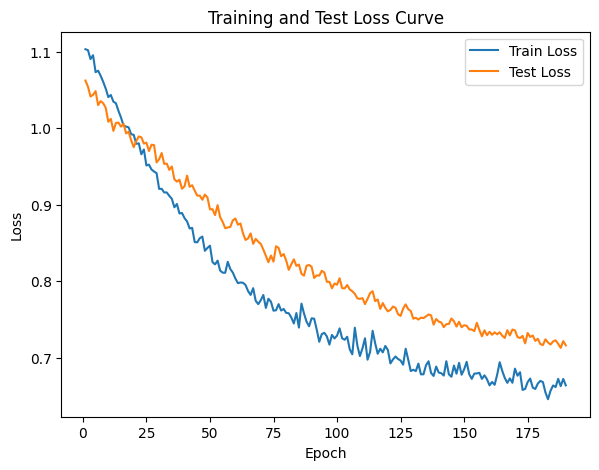

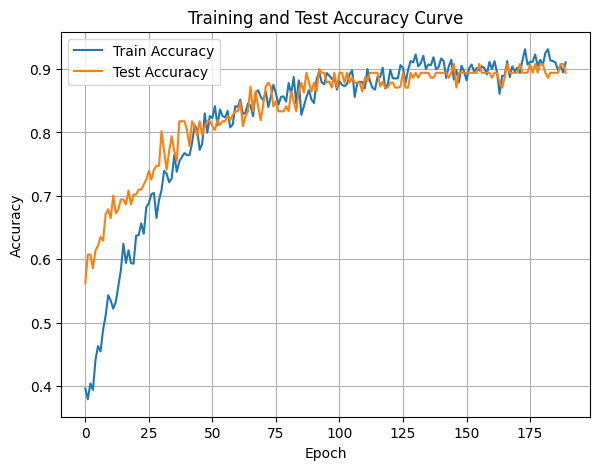

In [75]:
DTEmlp10b.train_single_model()

Randomly initializing 10 models
Training Model with id 1
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.30466047574789584, Train Loss: 1.1385, Train Acc: 0.2345, Test F1:0.17801465689540308, Test Loss: 1.1383, Test Acc: 0.1059


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.14it/s]

Epoch [2/10], Train F1:0.32957329570966476, Train Loss: 1.1325, Train Acc: 0.2628, Test F1:0.16221322537112012, Test Loss: 1.1370, Test Acc: 0.1011
Epoch [3/10], Train F1:0.3304604043587165, Train Loss: 1.1283, Train Acc: 0.2687, Test F1:0.16512172239229161, Test Loss: 1.1347, Test Acc: 0.1100


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.37it/s]

Epoch [4/10], Train F1:0.31515071132964656, Train Loss: 1.1298, Train Acc: 0.2553, Test F1:0.1575999088907125, Test Loss: 1.1342, Test Acc: 0.1046


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.37it/s]

Epoch [5/10], Train F1:0.3254424697579412, Train Loss: 1.1256, Train Acc: 0.2635, Test F1:0.1565761889522562, Test Loss: 1.1307, Test Acc: 0.1061


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.74it/s]

Epoch [6/10], Train F1:0.3318311163586971, Train Loss: 1.1216, Train Acc: 0.2710, Test F1:0.15705522681196596, Test Loss: 1.1303, Test Acc: 0.1068


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.74it/s]

Epoch [7/10], Train F1:0.3422225934834061, Train Loss: 1.1176, Train Acc: 0.2798, Test F1:0.1569702442380461, Test Loss: 1.1280, Test Acc: 0.1086


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.06it/s]

Epoch [8/10], Train F1:0.3487648782507603, Train Loss: 1.1135, Train Acc: 0.2879, Test F1:0.16643332786194068, Test Loss: 1.1268, Test Acc: 0.1215


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.06it/s]

Epoch [9/10], Train F1:0.3525846303453974, Train Loss: 1.1116, Train Acc: 0.2922, Test F1:0.17044494352765027, Test Loss: 1.1248, Test Acc: 0.1255


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.25it/s]


Epoch [10/10], Train F1:0.360379531895988, Train Loss: 1.1089, Train Acc: 0.2993, Test F1:0.18832749153747755, Test Loss: 1.1221, Test Acc: 0.1372
Total Epochs: 10
Train loss start: 1.1964579820632935, Train loss end: 1.1184386014938354
Highest Mean Train Accuracy (over epoch): 0.2992559523809524
Test loss start: 1.1511023044586182, Test loss end: 1.0801596641540527
Highest mean Test Accuracy (over epoch): 0.13723958333333333


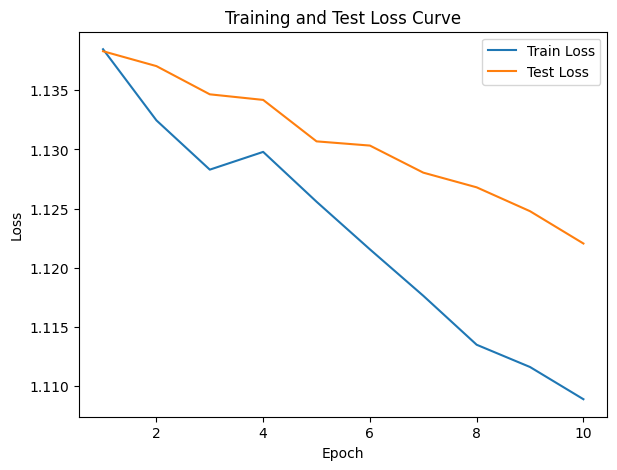

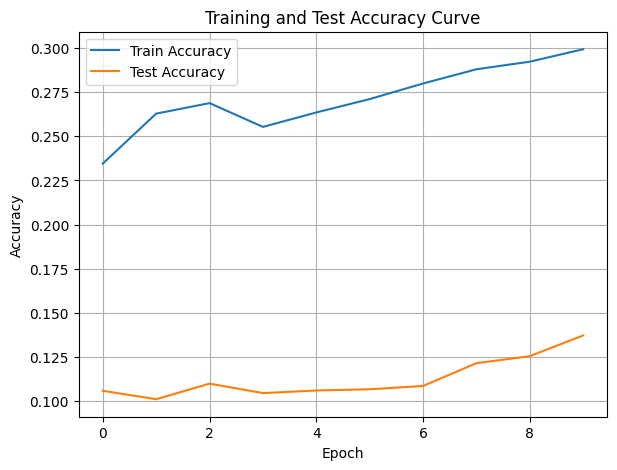

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4394493872754742, Train Loss: 1.1045, Train Acc: 0.3786, Test F1:0.24140551880955521, Test Loss: 1.1151, Test Acc: 0.2587


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.83it/s]

Epoch [2/10], Train F1:0.4346740602838164, Train Loss: 1.1085, Train Acc: 0.3759, Test F1:0.21663631127508212, Test Loss: 1.1140, Test Acc: 0.2656


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.83it/s]

Epoch [3/10], Train F1:0.4409396579333143, Train Loss: 1.1049, Train Acc: 0.3812, Test F1:0.22524189261031366, Test Loss: 1.1117, Test Acc: 0.2784


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.51it/s]

Epoch [4/10], Train F1:0.44422186491152005, Train Loss: 1.1034, Train Acc: 0.3826, Test F1:0.24135671303863523, Test Loss: 1.1083, Test Acc: 0.2941


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.51it/s]

Epoch [5/10], Train F1:0.4430424180356609, Train Loss: 1.1020, Train Acc: 0.3832, Test F1:0.2568889225704049, Test Loss: 1.1055, Test Acc: 0.3066


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.93it/s]

Epoch [6/10], Train F1:0.44828848145921324, Train Loss: 1.0996, Train Acc: 0.3885, Test F1:0.2669438922609669, Test Loss: 1.1032, Test Acc: 0.3150


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.69it/s]

Epoch [7/10], Train F1:0.4576575342197752, Train Loss: 1.0977, Train Acc: 0.3985, Test F1:0.27182738293849407, Test Loss: 1.1013, Test Acc: 0.3209


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.54it/s]

Epoch [8/10], Train F1:0.4625114823242758, Train Loss: 1.0950, Train Acc: 0.4059, Test F1:0.2756210453518239, Test Loss: 1.1003, Test Acc: 0.3281


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.62it/s]

Epoch [9/10], Train F1:0.46523290786910804, Train Loss: 1.0927, Train Acc: 0.4123, Test F1:0.2805910807029182, Test Loss: 1.0986, Test Acc: 0.3361


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.90it/s]


Epoch [10/10], Train F1:0.4737044344031043, Train Loss: 1.0896, Train Acc: 0.4230, Test F1:0.29186144415889215, Test Loss: 1.0971, Test Acc: 0.3435
Total Epochs: 10
Train loss start: 1.0931611061096191, Train loss end: 1.0705091953277588
Highest Mean Train Accuracy (over epoch): 0.42297619047619045
Test loss start: 1.1089516878128052, Test loss end: 1.0788683891296387
Highest mean Test Accuracy (over epoch): 0.3434895833333333


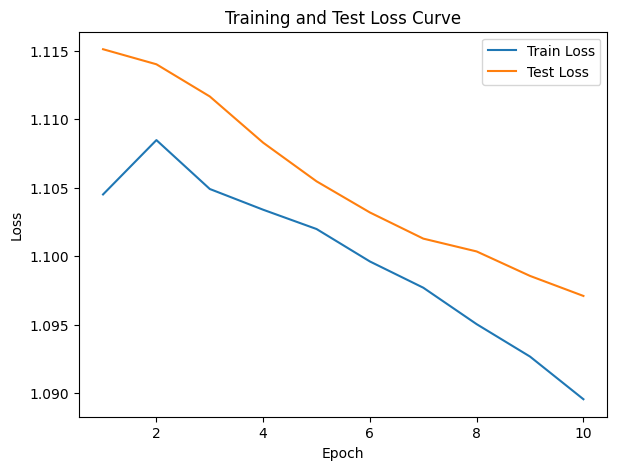

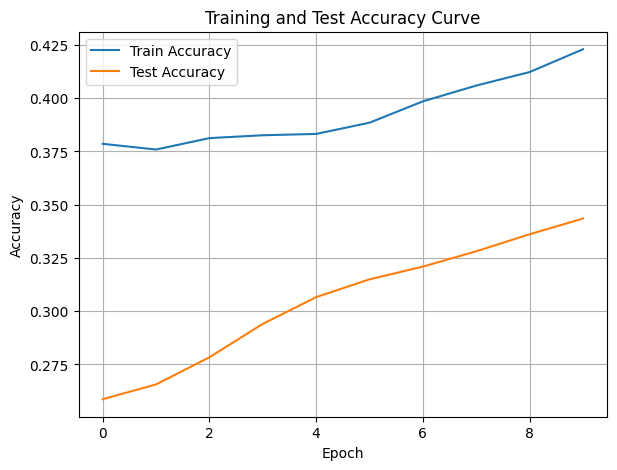

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.80it/s]

Epoch [1/10], Train F1:0.4314554764652612, Train Loss: 1.1232, Train Acc: 0.3348, Test F1:0.43565559000213044, Test Loss: 1.0977, Test Acc: 0.3672


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.80it/s]

Epoch [2/10], Train F1:0.43695590766055536, Train Loss: 1.1118, Train Acc: 0.3369, Test F1:0.5625124758799656, Test Loss: 1.0813, Test Acc: 0.4905


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.85it/s]

Epoch [3/10], Train F1:0.45643582467373744, Train Loss: 1.1036, Train Acc: 0.3561, Test F1:0.54608858050303, Test Loss: 1.0801, Test Acc: 0.4754


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.85it/s]

Epoch [4/10], Train F1:0.4712562884159043, Train Loss: 1.0988, Train Acc: 0.3729, Test F1:0.5439313281541066, Test Loss: 1.0735, Test Acc: 0.4885


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.67it/s]

Epoch [5/10], Train F1:0.483544180984252, Train Loss: 1.0968, Train Acc: 0.3802, Test F1:0.5432503973099588, Test Loss: 1.0705, Test Acc: 0.4951


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.40it/s]

Epoch [6/10], Train F1:0.48636497388241245, Train Loss: 1.0946, Train Acc: 0.3850, Test F1:0.5532061027142253, Test Loss: 1.0673, Test Acc: 0.5097


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.40it/s]

Epoch [7/10], Train F1:0.49373985917464175, Train Loss: 1.0913, Train Acc: 0.3920, Test F1:0.5513175112023442, Test Loss: 1.0653, Test Acc: 0.5156


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.86it/s]

Epoch [8/10], Train F1:0.5001638429250442, Train Loss: 1.0874, Train Acc: 0.4001, Test F1:0.5561645470594043, Test Loss: 1.0627, Test Acc: 0.5235


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.86it/s]

Epoch [9/10], Train F1:0.507735708896812, Train Loss: 1.0833, Train Acc: 0.4079, Test F1:0.5582623170620852, Test Loss: 1.0617, Test Acc: 0.5282


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.81it/s]


Epoch [10/10], Train F1:0.5163921145017554, Train Loss: 1.0781, Train Acc: 0.4177, Test F1:0.5582424453053394, Test Loss: 1.0606, Test Acc: 0.5319
Total Epochs: 10
Train loss start: 1.1062849760055542, Train loss end: 0.9479645490646362
Highest Mean Train Accuracy (over epoch): 0.41767857142857145
Test loss start: 1.1078025102615356, Test loss end: 1.0382158756256104
Highest mean Test Accuracy (over epoch): 0.5318576388888889


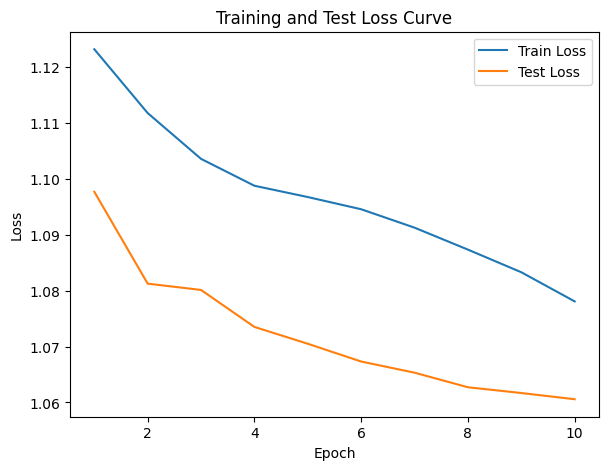

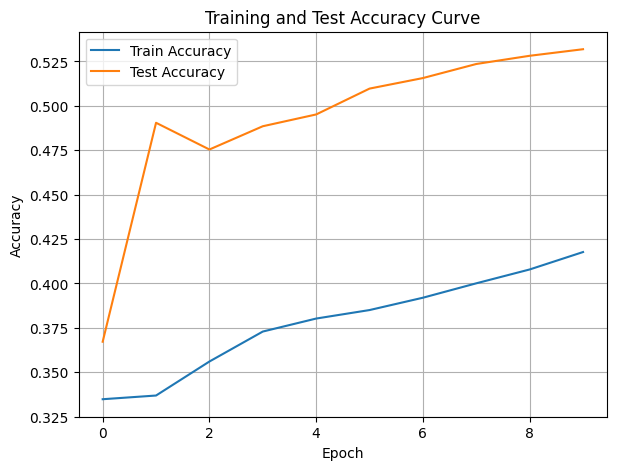

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.47it/s]

Epoch [1/10], Train F1:0.29338646701284066, Train Loss: 1.0878, Train Acc: 0.2836, Test F1:0.14235041154799566, Test Loss: 1.1008, Test Acc: 0.1667


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.12it/s]

Epoch [2/10], Train F1:0.33552570305182666, Train Loss: 1.0755, Train Acc: 0.3222, Test F1:0.14235041154799566, Test Loss: 1.0913, Test Acc: 0.1667


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.14it/s]

Epoch [3/10], Train F1:0.3305323900153538, Train Loss: 1.0798, Train Acc: 0.3152, Test F1:0.13401227753367304, Test Loss: 1.0920, Test Acc: 0.1615


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.03it/s]

Epoch [4/10], Train F1:0.3450698195645052, Train Loss: 1.0749, Train Acc: 0.3315, Test F1:0.1315678122168031, Test Loss: 1.0891, Test Acc: 0.1573
Epoch [5/10], Train F1:0.3450137374061855, Train Loss: 1.0717, Train Acc: 0.3341, Test F1:0.13373008121097557, Test Loss: 1.0881, Test Acc: 0.1592


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.81it/s]

Epoch [6/10], Train F1:0.3564428560852493, Train Loss: 1.0667, Train Acc: 0.3473, Test F1:0.13516998991865195, Test Loss: 1.0871, Test Acc: 0.1604
Epoch [7/10], Train F1:0.3600043754291812, Train Loss: 1.0655, Train Acc: 0.3481, Test F1:0.13990912271874487, Test Loss: 1.0854, Test Acc: 0.1616


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.36it/s]

Epoch [8/10], Train F1:0.36665911871553286, Train Loss: 1.0631, Train Acc: 0.3569, Test F1:0.14556300684129167, Test Loss: 1.0831, Test Acc: 0.1654
Epoch [9/10], Train F1:0.3717488068655983, Train Loss: 1.0607, Train Acc: 0.3635, Test F1:0.15273570753812604, Test Loss: 1.0809, Test Acc: 0.1692


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.05it/s]


Epoch [10/10], Train F1:0.37464273982498547, Train Loss: 1.0601, Train Acc: 0.3644, Test F1:0.157164520207069, Test Loss: 1.0796, Test Acc: 0.1722
Total Epochs: 10
Train loss start: 1.066249132156372, Train loss end: 1.1303917169570923
Highest Mean Train Accuracy (over epoch): 0.364375
Test loss start: 1.0923863649368286, Test loss end: 1.0942463874816895
Highest mean Test Accuracy (over epoch): 0.17222222222222222


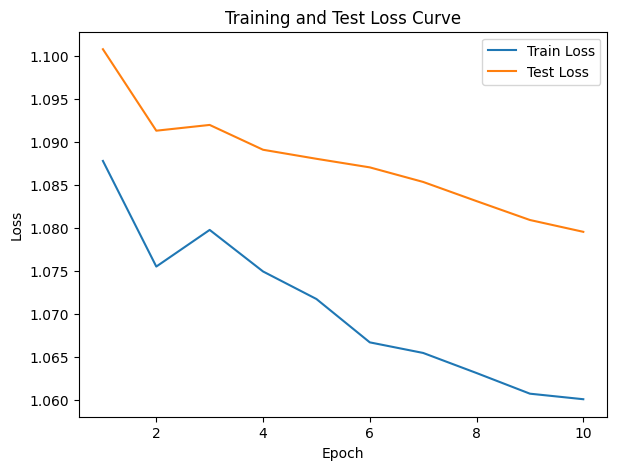

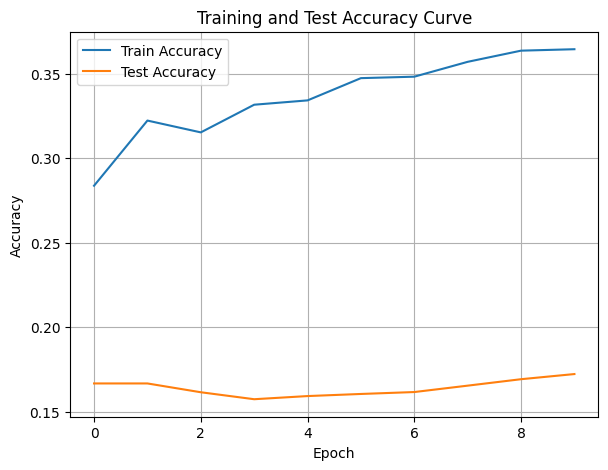

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.40it/s]

Epoch [1/10], Train F1:0.2849438306348876, Train Loss: 1.1670, Train Acc: 0.2390, Test F1:0.1692982456140351, Test Loss: 1.1217, Test Acc: 0.2196


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.40it/s]

Epoch [2/10], Train F1:0.30111015630639276, Train Loss: 1.1566, Train Acc: 0.2509, Test F1:0.16668775052740964, Test Loss: 1.1267, Test Acc: 0.2274


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.35it/s]

Epoch [3/10], Train F1:0.32325608344853435, Train Loss: 1.1508, Train Acc: 0.2694, Test F1:0.17293769306010337, Test Loss: 1.1268, Test Acc: 0.2352


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.71it/s]

Epoch [4/10], Train F1:0.33402233477921617, Train Loss: 1.1450, Train Acc: 0.2753, Test F1:0.1757692435730986, Test Loss: 1.1268, Test Acc: 0.2391


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.09it/s]

Epoch [5/10], Train F1:0.3491887810879589, Train Loss: 1.1374, Train Acc: 0.2880, Test F1:0.18352701442159694, Test Loss: 1.1254, Test Acc: 0.2446


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.67it/s]

Epoch [6/10], Train F1:0.3508759601597781, Train Loss: 1.1340, Train Acc: 0.2904, Test F1:0.18488626750791595, Test Loss: 1.1241, Test Acc: 0.2483


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.16it/s]

Epoch [7/10], Train F1:0.3629062090933488, Train Loss: 1.1287, Train Acc: 0.3021, Test F1:0.18875613722972098, Test Loss: 1.1219, Test Acc: 0.2540


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.30it/s]

Epoch [8/10], Train F1:0.3716078644286731, Train Loss: 1.1249, Train Acc: 0.3124, Test F1:0.19229607665486095, Test Loss: 1.1203, Test Acc: 0.2565


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.68it/s]

Epoch [9/10], Train F1:0.377543610853692, Train Loss: 1.1223, Train Acc: 0.3188, Test F1:0.19499929321647996, Test Loss: 1.1188, Test Acc: 0.2609


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.71it/s]


Epoch [10/10], Train F1:0.38123899458776966, Train Loss: 1.1187, Train Acc: 0.3233, Test F1:0.19843691889476628, Test Loss: 1.1171, Test Acc: 0.2668
Total Epochs: 10
Train loss start: 1.197864294052124, Train loss end: 1.0031628608703613
Highest Mean Train Accuracy (over epoch): 0.3233035714285714
Test loss start: 1.129042387008667, Test loss end: 1.0998774766921997
Highest mean Test Accuracy (over epoch): 0.26675347222222223


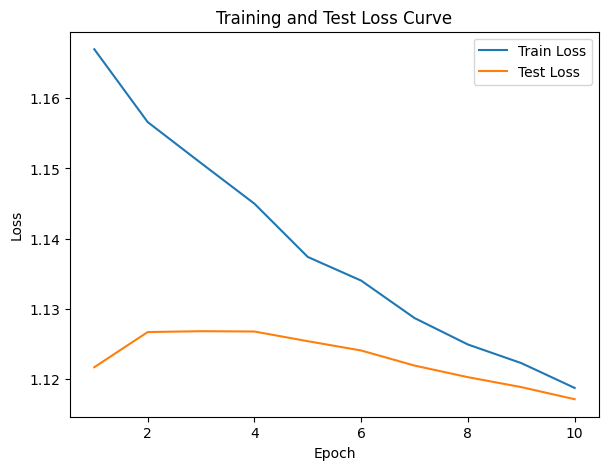

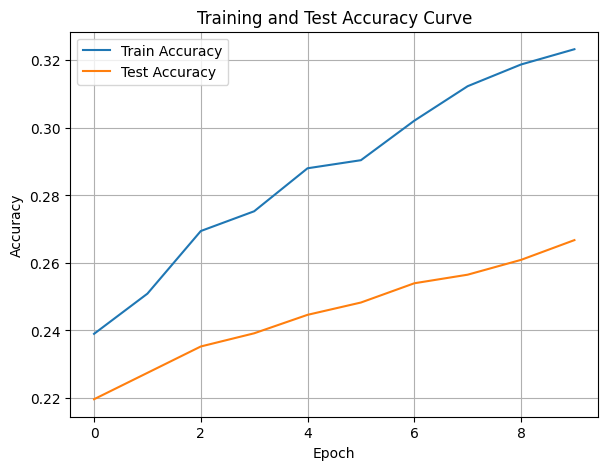

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.501301458143221, Train Loss: 1.0519, Train Acc: 0.4482, Test F1:0.3173222705386448, Test Loss: 1.1060, Test Acc: 0.3819


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.62it/s]

Epoch [2/10], Train F1:0.49785577682992543, Train Loss: 1.0533, Train Acc: 0.4378, Test F1:0.2993886230728336, Test Loss: 1.1077, Test Acc: 0.3741


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.08it/s]

Epoch [3/10], Train F1:0.5015045096784349, Train Loss: 1.0457, Train Acc: 0.4526, Test F1:0.28217606498752407, Test Loss: 1.1065, Test Acc: 0.3736


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.08it/s]

Epoch [4/10], Train F1:0.5145293162433054, Train Loss: 1.0387, Train Acc: 0.4627, Test F1:0.2888587965052712, Test Loss: 1.1023, Test Acc: 0.3826


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.56it/s]

Epoch [5/10], Train F1:0.5188477267884879, Train Loss: 1.0343, Train Acc: 0.4720, Test F1:0.285156749049038, Test Loss: 1.1025, Test Acc: 0.3821


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.65it/s]

Epoch [6/10], Train F1:0.5248720121068046, Train Loss: 1.0289, Train Acc: 0.4801, Test F1:0.28450328411340076, Test Loss: 1.1024, Test Acc: 0.3851


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.58it/s]

Epoch [7/10], Train F1:0.5310610804837469, Train Loss: 1.0282, Train Acc: 0.4839, Test F1:0.2854041331940392, Test Loss: 1.1008, Test Acc: 0.3884


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.64it/s]

Epoch [8/10], Train F1:0.5354660050890246, Train Loss: 1.0258, Train Acc: 0.4892, Test F1:0.290239554043648, Test Loss: 1.0992, Test Acc: 0.3928


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.57it/s]

Epoch [9/10], Train F1:0.5447915142235357, Train Loss: 1.0224, Train Acc: 0.4983, Test F1:0.2872441398757188, Test Loss: 1.0977, Test Acc: 0.3921


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.10it/s]


Epoch [10/10], Train F1:0.5502128362776953, Train Loss: 1.0191, Train Acc: 0.5054, Test F1:0.29063802896373664, Test Loss: 1.0955, Test Acc: 0.3952
Total Epochs: 10
Train loss start: 1.0408775806427002, Train loss end: 0.8579307198524475
Highest Mean Train Accuracy (over epoch): 0.5054166666666666
Test loss start: 1.1029298305511475, Test loss end: 1.08040452003479
Highest mean Test Accuracy (over epoch): 0.39522569444444444


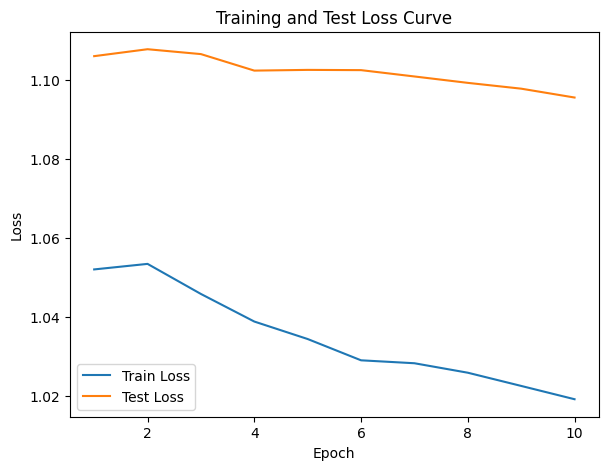

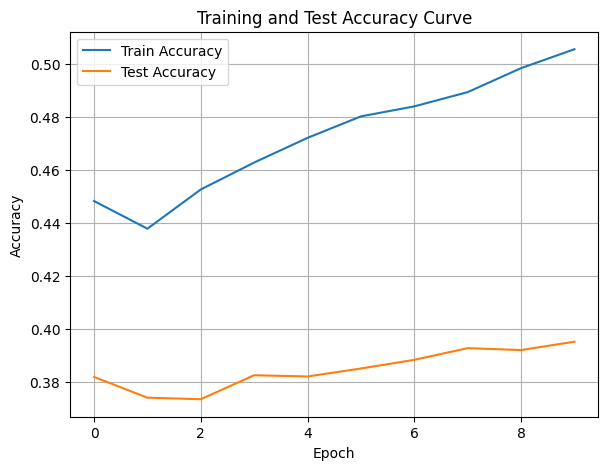

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.38it/s]

Epoch [1/10], Train F1:0.1614618784276386, Train Loss: 1.2033, Train Acc: 0.1616, Test F1:0.13784461152882205, Test Loss: 1.1403, Test Acc: 0.2023


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.07it/s]

Epoch [2/10], Train F1:0.1597273866539269, Train Loss: 1.1936, Train Acc: 0.1668, Test F1:0.14581909318751426, Test Loss: 1.1435, Test Acc: 0.2209


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.17it/s]

Epoch [3/10], Train F1:0.1797503793429375, Train Loss: 1.1868, Train Acc: 0.1877, Test F1:0.15289620699794176, Test Loss: 1.1435, Test Acc: 0.2376


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.16it/s]

Epoch [4/10], Train F1:0.18480442601193053, Train Loss: 1.1818, Train Acc: 0.1935, Test F1:0.1557805719372427, Test Loss: 1.1436, Test Acc: 0.2400


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.02it/s]

Epoch [5/10], Train F1:0.19379970405534314, Train Loss: 1.1787, Train Acc: 0.2000, Test F1:0.16416659441024303, Test Loss: 1.1416, Test Acc: 0.2571
Epoch [6/10], Train F1:0.20304845706440858, Train Loss: 1.1740, Train Acc: 0.2094, Test F1:0.16539987571107606, Test Loss: 1.1389, Test Acc: 0.2607


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.02it/s]

Epoch [7/10], Train F1:0.20210363795293818, Train Loss: 1.1714, Train Acc: 0.2099, Test F1:0.16980524706261063, Test Loss: 1.1374, Test Acc: 0.2711
Epoch [8/10], Train F1:0.21072016044771413, Train Loss: 1.1666, Train Acc: 0.2171, Test F1:0.17248274303201017, Test Loss: 1.1358, Test Acc: 0.2779


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.26it/s]


Epoch [9/10], Train F1:0.22013847218573623, Train Loss: 1.1636, Train Acc: 0.2252, Test F1:0.17436039616160684, Test Loss: 1.1345, Test Acc: 0.2814
Epoch [10/10], Train F1:0.2262037263045341, Train Loss: 1.1590, Train Acc: 0.2337, Test F1:0.17667311358928986, Test Loss: 1.1330, Test Acc: 0.2874
Total Epochs: 10
Train loss start: 1.2519453763961792, Train loss end: 1.0766282081604004
Highest Mean Train Accuracy (over epoch): 0.23366071428571425
Test loss start: 1.144931674003601, Test loss end: 1.1369452476501465
Highest mean Test Accuracy (over epoch): 0.2874131944444444


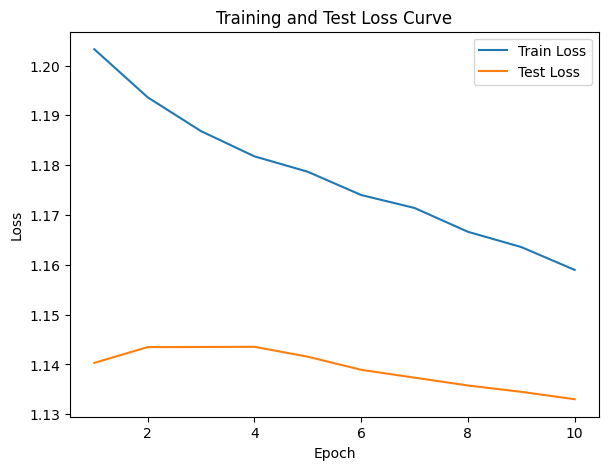

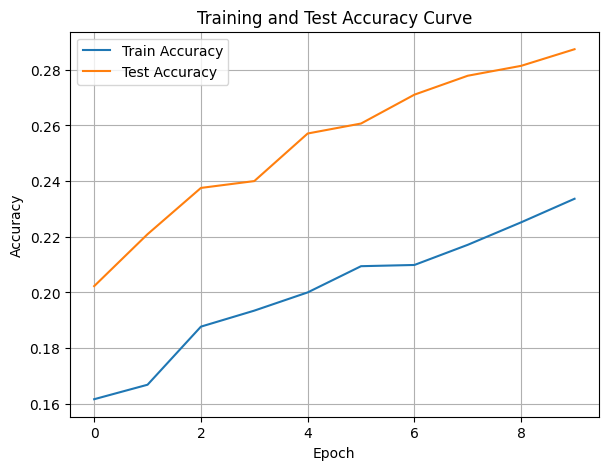

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.03it/s]

Epoch [1/10], Train F1:0.23956729894659032, Train Loss: 1.1853, Train Acc: 0.1554, Test F1:0.21629991691962538, Test Loss: 1.1332, Test Acc: 0.1771
Epoch [2/10], Train F1:0.2571687266495612, Train Loss: 1.1868, Train Acc: 0.1641, Test F1:0.18912347620481593, Test Loss: 1.1403, Test Acc: 0.1445


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.03it/s]

Epoch [3/10], Train F1:0.2554047602419291, Train Loss: 1.1827, Train Acc: 0.1654, Test F1:0.18590205044493338, Test Loss: 1.1410, Test Acc: 0.1429


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.81it/s]

Epoch [4/10], Train F1:0.2602710130459984, Train Loss: 1.1783, Train Acc: 0.1728, Test F1:0.1842783021996879, Test Loss: 1.1410, Test Acc: 0.1421


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.81it/s]

Epoch [5/10], Train F1:0.2635762309307768, Train Loss: 1.1762, Train Acc: 0.1775, Test F1:0.19795239224624828, Test Loss: 1.1387, Test Acc: 0.1566


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.73it/s]

Epoch [6/10], Train F1:0.2737636382235238, Train Loss: 1.1715, Train Acc: 0.1862, Test F1:0.20090630616946403, Test Loss: 1.1377, Test Acc: 0.1626
Epoch [7/10], Train F1:0.2815427691356679, Train Loss: 1.1683, Train Acc: 0.1919, Test F1:0.20639542737012384, Test Loss: 1.1347, Test Acc: 0.1770


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.92it/s]

Epoch [8/10], Train F1:0.2970289274824788, Train Loss: 1.1643, Train Acc: 0.2029, Test F1:0.2173394453443801, Test Loss: 1.1321, Test Acc: 0.1924


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.92it/s]

Epoch [9/10], Train F1:0.31154544101362175, Train Loss: 1.1610, Train Acc: 0.2126, Test F1:0.22583288530288403, Test Loss: 1.1300, Test Acc: 0.2044


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.82it/s]


Epoch [10/10], Train F1:0.3271918862747193, Train Loss: 1.1564, Train Acc: 0.2243, Test F1:0.2319494533182878, Test Loss: 1.1280, Test Acc: 0.2154
Total Epochs: 10
Train loss start: 1.1637606620788574, Train loss end: 1.1682113409042358
Highest Mean Train Accuracy (over epoch): 0.22425595238095242
Test loss start: 1.1479897499084473, Test loss end: 1.0913363695144653
Highest mean Test Accuracy (over epoch): 0.2153645833333333


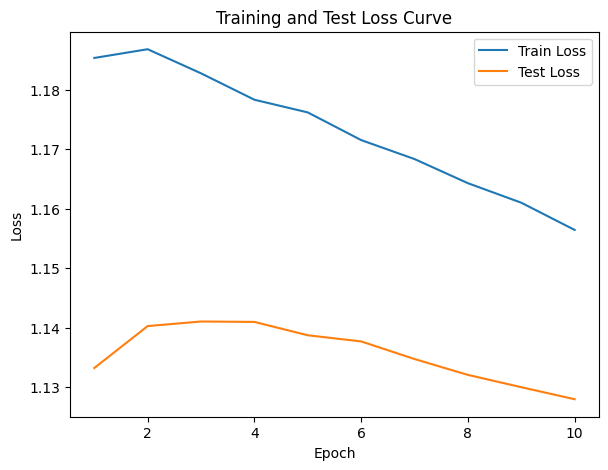

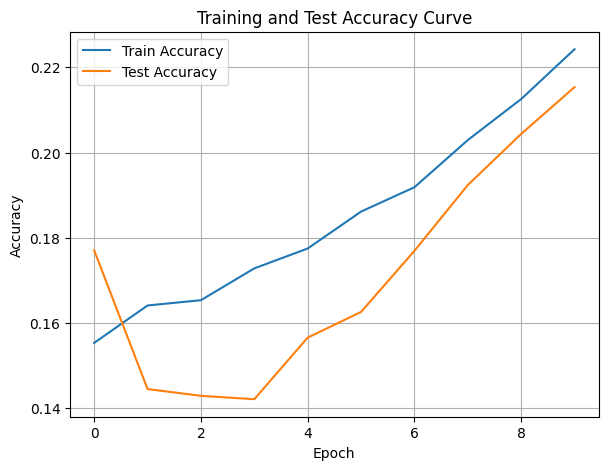

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.17it/s]

Epoch [1/10], Train F1:0.36776408176002495, Train Loss: 1.1267, Train Acc: 0.2940, Test F1:0.5621707459597379, Test Loss: 1.0766, Test Acc: 0.6059


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.92it/s]

Epoch [2/10], Train F1:0.3663883220895824, Train Loss: 1.1267, Train Acc: 0.2866, Test F1:0.5462211596083995, Test Loss: 1.0720, Test Acc: 0.6128
Epoch [3/10], Train F1:0.3608609462057738, Train Loss: 1.1283, Train Acc: 0.2824, Test F1:0.5456875925714937, Test Loss: 1.0726, Test Acc: 0.6085


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.68it/s]

Epoch [4/10], Train F1:0.37161032962208407, Train Loss: 1.1237, Train Acc: 0.2950, Test F1:0.5593256645888226, Test Loss: 1.0691, Test Acc: 0.6246
Epoch [5/10], Train F1:0.38233488138143, Train Loss: 1.1187, Train Acc: 0.3065, Test F1:0.5541786845192418, Test Loss: 1.0672, Test Acc: 0.6280


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.70it/s]

Epoch [6/10], Train F1:0.39145924825124345, Train Loss: 1.1153, Train Acc: 0.3159, Test F1:0.5599714960347071, Test Loss: 1.0645, Test Acc: 0.6354
Epoch [7/10], Train F1:0.3989389926137534, Train Loss: 1.1121, Train Acc: 0.3254, Test F1:0.5695293522735181, Test Loss: 1.0628, Test Acc: 0.6441


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.04it/s]

Epoch [8/10], Train F1:0.40474830069238454, Train Loss: 1.1100, Train Acc: 0.3323, Test F1:0.5766215398231838, Test Loss: 1.0601, Test Acc: 0.6506
Epoch [9/10], Train F1:0.4141213736505712, Train Loss: 1.1058, Train Acc: 0.3444, Test F1:0.583418364548018, Test Loss: 1.0580, Test Acc: 0.6557


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.18it/s]


Epoch [10/10], Train F1:0.42027653737592885, Train Loss: 1.1040, Train Acc: 0.3501, Test F1:0.5919330117691146, Test Loss: 1.0557, Test Acc: 0.6635
Total Epochs: 10
Train loss start: 1.1441190242767334, Train loss end: 1.1475108861923218
Highest Mean Train Accuracy (over epoch): 0.3500892857142857
Test loss start: 1.0785753726959229, Test loss end: 1.03150475025177
Highest mean Test Accuracy (over epoch): 0.6634548611111111


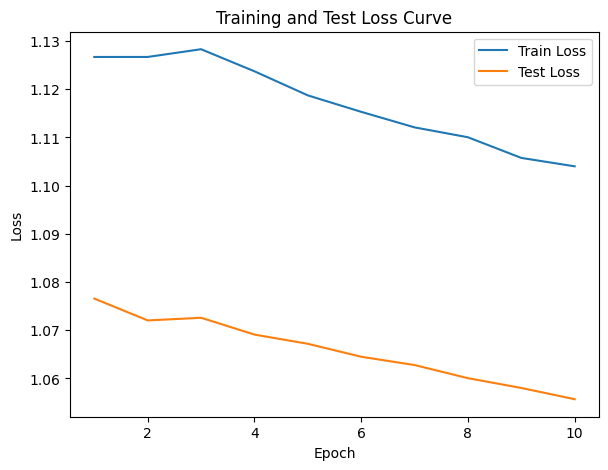

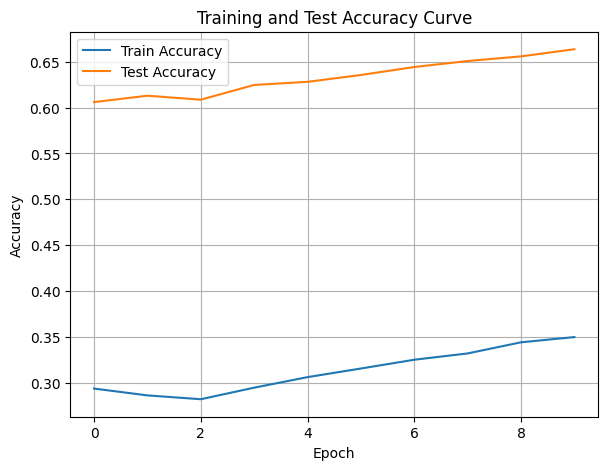

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.25it/s]

Epoch [1/10], Train F1:0.3609810356335429, Train Loss: 1.1132, Train Acc: 0.3235, Test F1:0.1910597085825634, Test Loss: 1.1054, Test Acc: 0.2057


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.63it/s]

Epoch [2/10], Train F1:0.3788685870009783, Train Loss: 1.1059, Train Acc: 0.3385, Test F1:0.21211186963223963, Test Loss: 1.0987, Test Acc: 0.2166


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.52it/s]

Epoch [3/10], Train F1:0.38503229428164887, Train Loss: 1.1064, Train Acc: 0.3429, Test F1:0.24944192440004934, Test Loss: 1.0950, Test Acc: 0.2332


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.56it/s]

Epoch [4/10], Train F1:0.39048684754504587, Train Loss: 1.1020, Train Acc: 0.3471, Test F1:0.23674524398527322, Test Loss: 1.0935, Test Acc: 0.2263


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.40it/s]

Epoch [5/10], Train F1:0.40208711380277856, Train Loss: 1.0988, Train Acc: 0.3578, Test F1:0.25775494500829116, Test Loss: 1.0920, Test Acc: 0.2399


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.38it/s]

Epoch [6/10], Train F1:0.4073847619786749, Train Loss: 1.0961, Train Acc: 0.3620, Test F1:0.27414746142658075, Test Loss: 1.0896, Test Acc: 0.2529


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.44it/s]

Epoch [7/10], Train F1:0.41965442152196036, Train Loss: 1.0937, Train Acc: 0.3724, Test F1:0.28504005605061433, Test Loss: 1.0870, Test Acc: 0.2653


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.38it/s]

Epoch [8/10], Train F1:0.4276700138666018, Train Loss: 1.0907, Train Acc: 0.3778, Test F1:0.30294116538998755, Test Loss: 1.0849, Test Acc: 0.2823


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.67it/s]

Epoch [9/10], Train F1:0.43779066639482134, Train Loss: 1.0861, Train Acc: 0.3877, Test F1:0.31400464382920523, Test Loss: 1.0835, Test Acc: 0.2948


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.96it/s]


Epoch [10/10], Train F1:0.44409732060255047, Train Loss: 1.0835, Train Acc: 0.3939, Test F1:0.3193280629561732, Test Loss: 1.0818, Test Acc: 0.3045
Total Epochs: 10
Train loss start: 1.0823909044265747, Train loss end: 1.0920289754867554
Highest Mean Train Accuracy (over epoch): 0.3938988095238095
Test loss start: 1.1033798456192017, Test loss end: 1.0675694942474365
Highest mean Test Accuracy (over epoch): 0.30451388888888886


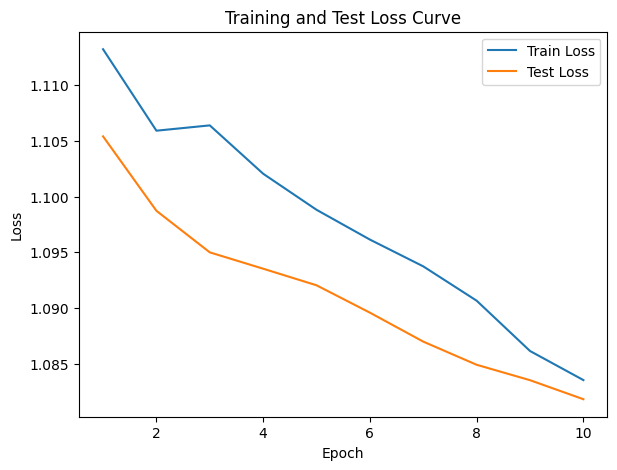

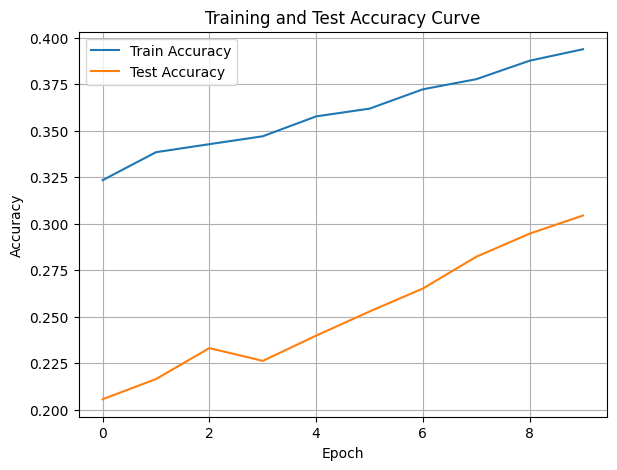

./saved_models/model_10.pth
Training Model with id 14
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.81it/s]

Epoch [1/10], Train F1:0.5162857997428517, Train Loss: 1.0508, Train Acc: 0.4789, Test F1:0.46421403169541636, Test Loss: 1.0627, Test Acc: 0.4410
Epoch [2/10], Train F1:0.5278692026587427, Train Loss: 1.0493, Train Acc: 0.4876, Test F1:0.44032323377820515, Test Loss: 1.0596, Test Acc: 0.4214
Epoch [3/10], Train F1:0.5429473608970216, Train Loss: 1.0428, Train Acc: 0.5035, Test F1:0.4521211296650775, Test Loss: 1.0596, Test Acc: 0.4306


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.74it/s]

Epoch [4/10], Train F1:0.5559876179180168, Train Loss: 1.0386, Train Acc: 0.5153, Test F1:0.4870100164847035, Test Loss: 1.0564, Test Acc: 0.4635
Epoch [5/10], Train F1:0.5668963694901713, Train Loss: 1.0350, Train Acc: 0.5242, Test F1:0.4992433318335492, Test Loss: 1.0550, Test Acc: 0.4771


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.26it/s]

Epoch [6/10], Train F1:0.5755998859804593, Train Loss: 1.0322, Train Acc: 0.5326, Test F1:0.5184266961109066, Test Loss: 1.0532, Test Acc: 0.4939
Epoch [7/10], Train F1:0.5833975524115544, Train Loss: 1.0292, Train Acc: 0.5395, Test F1:0.5243007851855552, Test Loss: 1.0513, Test Acc: 0.4995


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.44it/s]

Epoch [8/10], Train F1:0.5945290358343597, Train Loss: 1.0250, Train Acc: 0.5500, Test F1:0.5329262209367186, Test Loss: 1.0506, Test Acc: 0.5084
Epoch [9/10], Train F1:0.6014252092262913, Train Loss: 1.0208, Train Acc: 0.5572, Test F1:0.5575065845245949, Test Loss: 1.0485, Test Acc: 0.5320


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.43it/s]


Epoch [10/10], Train F1:0.6078610623746293, Train Loss: 1.0177, Train Acc: 0.5639, Test F1:0.5806960574214354, Test Loss: 1.0460, Test Acc: 0.5541
Total Epochs: 10
Train loss start: 1.0502015352249146, Train loss end: 1.0089164972305298
Highest Mean Train Accuracy (over epoch): 0.5639285714285713
Test loss start: 1.0562008619308472, Test loss end: 1.0184195041656494
Highest mean Test Accuracy (over epoch): 0.5540798611111111


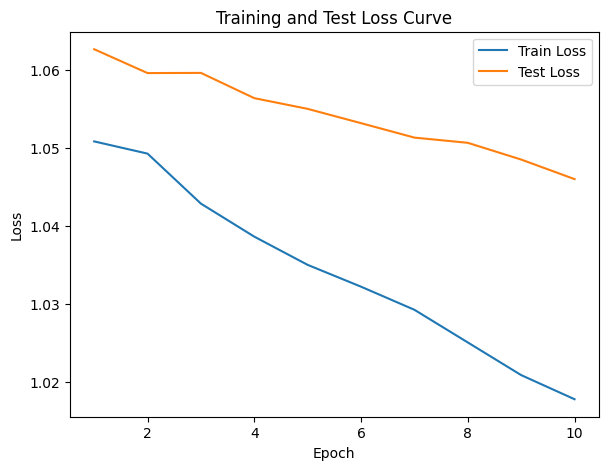

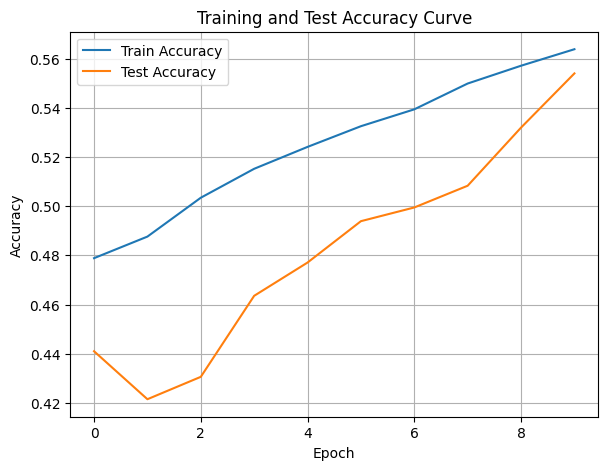

./saved_models/model_14.pth
Training Model with id 17
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.05it/s]

Epoch [1/10], Train F1:0.6610325375200615, Train Loss: 0.9810, Train Acc: 0.6351, Test F1:0.7576266266895278, Test Loss: 1.0247, Test Acc: 0.7309
Epoch [2/10], Train F1:0.6579561664511768, Train Loss: 0.9794, Train Acc: 0.6347, Test F1:0.7666465013107483, Test Loss: 1.0228, Test Acc: 0.7418


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.68it/s]

Epoch [3/10], Train F1:0.6690792379623716, Train Loss: 0.9782, Train Acc: 0.6428, Test F1:0.761037021955275, Test Loss: 1.0204, Test Acc: 0.7402
Epoch [4/10], Train F1:0.6814085012362332, Train Loss: 0.9744, Train Acc: 0.6531, Test F1:0.7769424106006324, Test Loss: 1.0176, Test Acc: 0.7600


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.98it/s]

Epoch [5/10], Train F1:0.6934129016112061, Train Loss: 0.9710, Train Acc: 0.6689, Test F1:0.7747455509399708, Test Loss: 1.0168, Test Acc: 0.7585
Epoch [6/10], Train F1:0.6957012652956488, Train Loss: 0.9682, Train Acc: 0.6698, Test F1:0.7781918272338697, Test Loss: 1.0148, Test Acc: 0.7648


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.56it/s]

Epoch [7/10], Train F1:0.6949766737901574, Train Loss: 0.9671, Train Acc: 0.6691, Test F1:0.783183118612888, Test Loss: 1.0129, Test Acc: 0.7706
Epoch [8/10], Train F1:0.6991900318563695, Train Loss: 0.9653, Train Acc: 0.6733, Test F1:0.7877259209814662, Test Loss: 1.0123, Test Acc: 0.7775


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.78it/s]


Epoch [9/10], Train F1:0.700038182977251, Train Loss: 0.9629, Train Acc: 0.6734, Test F1:0.7928604152512565, Test Loss: 1.0100, Test Acc: 0.7852
Epoch [10/10], Train F1:0.7092072065783084, Train Loss: 0.9586, Train Acc: 0.6836, Test F1:0.8001159004426597, Test Loss: 1.0086, Test Acc: 0.7937
Total Epochs: 10
Train loss start: 0.9703271389007568, Train loss end: 0.9425614476203918
Highest Mean Train Accuracy (over epoch): 0.6835714285714286
Test loss start: 1.0190587043762207, Test loss end: 0.9826956987380981
Highest mean Test Accuracy (over epoch): 0.79375


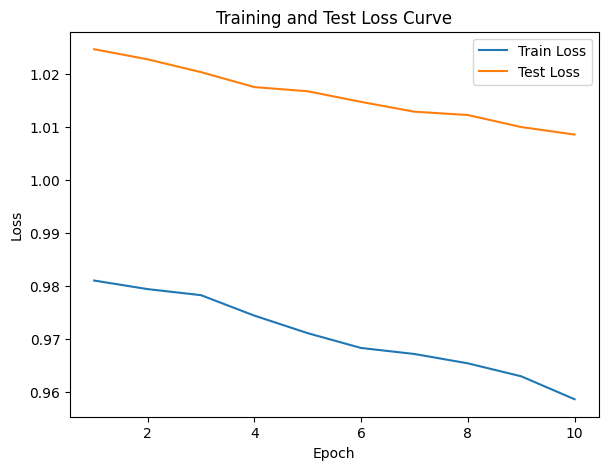

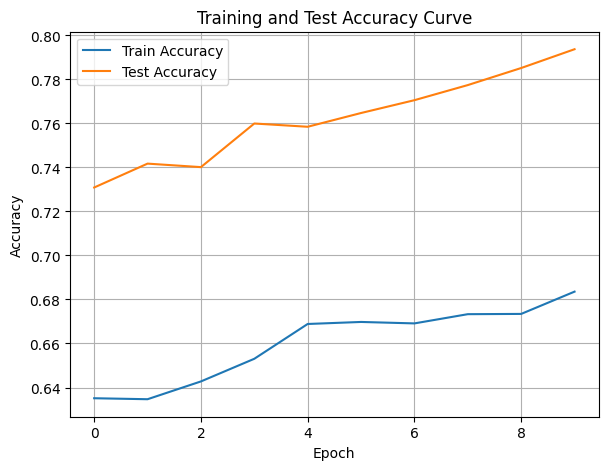

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7710771603565125, Train Loss: 0.9217, Train Acc: 0.7580, Test F1:0.8336158648154128, Test Loss: 0.9933, Test Acc: 0.8472


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.22it/s]

Epoch [2/10], Train F1:0.7696953410316637, Train Loss: 0.9180, Train Acc: 0.7570, Test F1:0.8347161826693991, Test Loss: 0.9891, Test Acc: 0.8411


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.22it/s]

Epoch [3/10], Train F1:0.7729619315912465, Train Loss: 0.9124, Train Acc: 0.7594, Test F1:0.837136638845053, Test Loss: 0.9877, Test Acc: 0.8438


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.99it/s]

Epoch [4/10], Train F1:0.7763513174571278, Train Loss: 0.9078, Train Acc: 0.7632, Test F1:0.8467213738955156, Test Loss: 0.9863, Test Acc: 0.8524


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.99it/s]

Epoch [5/10], Train F1:0.7816848819082423, Train Loss: 0.9033, Train Acc: 0.7718, Test F1:0.8437109106705057, Test Loss: 0.9837, Test Acc: 0.8502


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.54it/s]

Epoch [6/10], Train F1:0.7848203740860775, Train Loss: 0.9011, Train Acc: 0.7760, Test F1:0.8469213848355303, Test Loss: 0.9816, Test Acc: 0.8536


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.00it/s]

Epoch [7/10], Train F1:0.787597370371564, Train Loss: 0.8994, Train Acc: 0.7800, Test F1:0.8480098925728417, Test Loss: 0.9780, Test Acc: 0.8540


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.02it/s]

Epoch [8/10], Train F1:0.7890556043804475, Train Loss: 0.8976, Train Acc: 0.7800, Test F1:0.8475234700918974, Test Loss: 0.9759, Test Acc: 0.8534


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.02it/s]

Epoch [9/10], Train F1:0.7922787890678276, Train Loss: 0.8956, Train Acc: 0.7825, Test F1:0.8498855710671923, Test Loss: 0.9750, Test Acc: 0.8546


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.36it/s]


Epoch [10/10], Train F1:0.7966361866871199, Train Loss: 0.8929, Train Acc: 0.7863, Test F1:0.8493113766620602, Test Loss: 0.9738, Test Acc: 0.8535
Total Epochs: 10
Train loss start: 0.8825105428695679, Train loss end: 0.8784516453742981
Highest Mean Train Accuracy (over epoch): 0.7863095238095239
Test loss start: 0.9871100187301636, Test loss end: 0.9461605548858643
Highest mean Test Accuracy (over epoch): 0.8546489197530864


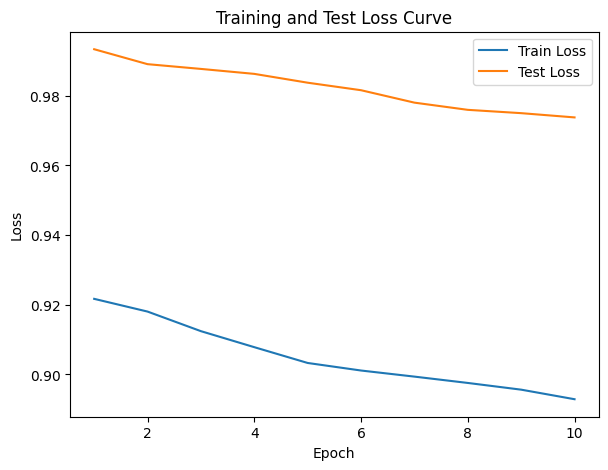

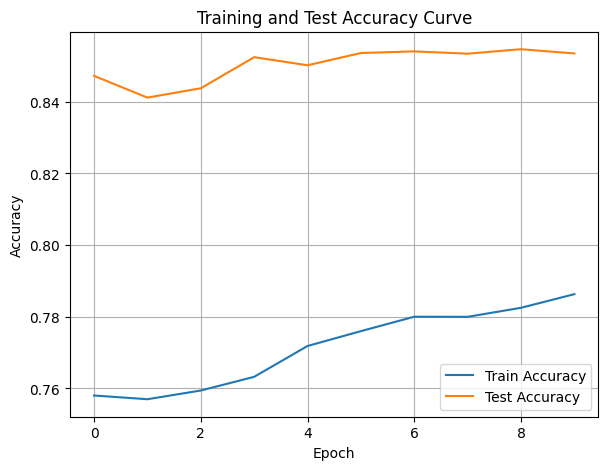

./saved_models/model_15.pth
Training Model with id 13
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8284254555793633, Train Loss: 0.8684, Train Acc: 0.8238, Test F1:0.8419897983440987, Test Loss: 0.9510, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.19it/s]

Epoch [2/10], Train F1:0.8264183581696183, Train Loss: 0.8650, Train Acc: 0.8228, Test F1:0.8535262658069677, Test Loss: 0.9489, Test Acc: 0.8568


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.63it/s]

Epoch [3/10], Train F1:0.8203172082939628, Train Loss: 0.8663, Train Acc: 0.8108, Test F1:0.8415302018495123, Test Loss: 0.9430, Test Acc: 0.8490
Epoch [4/10], Train F1:0.8178610280777261, Train Loss: 0.8642, Train Acc: 0.8104, Test F1:0.8521365930455045, Test Loss: 0.9415, Test Acc: 0.8583


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.63it/s]

Epoch [5/10], Train F1:0.8200366957531396, Train Loss: 0.8624, Train Acc: 0.8129, Test F1:0.8588040374957118, Test Loss: 0.9424, Test Acc: 0.8639


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.39it/s]

Epoch [6/10], Train F1:0.8189929915461589, Train Loss: 0.8631, Train Acc: 0.8121, Test F1:0.8622992931593728, Test Loss: 0.9408, Test Acc: 0.8676
Epoch [7/10], Train F1:0.8220012777790635, Train Loss: 0.8591, Train Acc: 0.8169, Test F1:0.8633282391722122, Test Loss: 0.9401, Test Acc: 0.8683


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.39it/s]

Epoch [8/10], Train F1:0.824780854698585, Train Loss: 0.8567, Train Acc: 0.8185, Test F1:0.8640990879947856, Test Loss: 0.9391, Test Acc: 0.8688
Epoch [9/10], Train F1:0.8299399180755113, Train Loss: 0.8523, Train Acc: 0.8250, Test F1:0.8658286711662184, Test Loss: 0.9386, Test Acc: 0.8708


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.69it/s]


Epoch [10/10], Train F1:0.8331492266591174, Train Loss: 0.8501, Train Acc: 0.8294, Test F1:0.8661938234427881, Test Loss: 0.9370, Test Acc: 0.8709
Total Epochs: 10
Train loss start: 0.8745326399803162, Train loss end: 0.7657647728919983
Highest Mean Train Accuracy (over epoch): 0.829375
Test loss start: 0.9436020851135254, Test loss end: 0.9063694477081299
Highest mean Test Accuracy (over epoch): 0.870920138888889


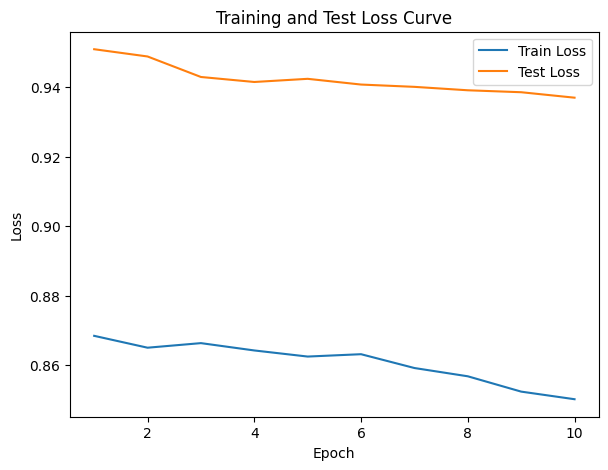

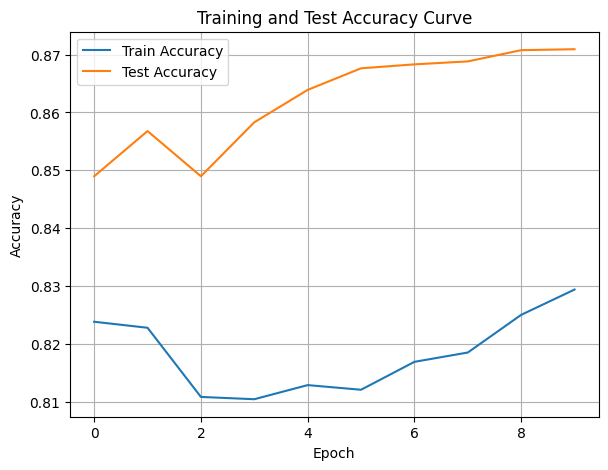

./saved_models/model_13.pth
Training Model with id 15
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.51it/s]

Epoch [1/10], Train F1:0.8642427992738578, Train Loss: 0.8086, Train Acc: 0.8729, Test F1:0.8592931124413203, Test Loss: 0.9141, Test Acc: 0.8646
Epoch [2/10], Train F1:0.8629470027542674, Train Loss: 0.8090, Train Acc: 0.8671, Test F1:0.8644031688145789, Test Loss: 0.9147, Test Acc: 0.8685


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.51it/s]

Epoch [3/10], Train F1:0.8444699846769157, Train Loss: 0.8153, Train Acc: 0.8460, Test F1:0.8733265133415411, Test Loss: 0.9160, Test Acc: 0.8750


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.58it/s]

Epoch [4/10], Train F1:0.8489360828618978, Train Loss: 0.8134, Train Acc: 0.8480, Test F1:0.8698604095377764, Test Loss: 0.9147, Test Acc: 0.8724


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.95it/s]

Epoch [5/10], Train F1:0.85082233174077, Train Loss: 0.8116, Train Acc: 0.8502, Test F1:0.8717945102214326, Test Loss: 0.9109, Test Acc: 0.8740


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.03it/s]

Epoch [6/10], Train F1:0.8566104928415079, Train Loss: 0.8086, Train Acc: 0.8568, Test F1:0.8680518454692012, Test Loss: 0.9085, Test Acc: 0.8711


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.07it/s]

Epoch [7/10], Train F1:0.855887739039756, Train Loss: 0.8073, Train Acc: 0.8552, Test F1:0.8624592908856259, Test Loss: 0.9053, Test Acc: 0.8668


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.15it/s]

Epoch [8/10], Train F1:0.8581939362338105, Train Loss: 0.8060, Train Acc: 0.8568, Test F1:0.8620652924148304, Test Loss: 0.9029, Test Acc: 0.8665


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.31it/s]

Epoch [9/10], Train F1:0.8532780575171887, Train Loss: 0.8067, Train Acc: 0.8519, Test F1:0.8606239447173751, Test Loss: 0.8999, Test Acc: 0.8655


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.31it/s]


Epoch [10/10], Train F1:0.8540431909674783, Train Loss: 0.8055, Train Acc: 0.8521, Test F1:0.8604912662480934, Test Loss: 0.8981, Test Acc: 0.8654
Total Epochs: 10
Train loss start: 0.795697808265686, Train loss end: 0.8384354710578918
Highest Mean Train Accuracy (over epoch): 0.8729166666666667
Test loss start: 0.9014240503311157, Test loss end: 0.8654255867004395
Highest mean Test Accuracy (over epoch): 0.8750000000000001


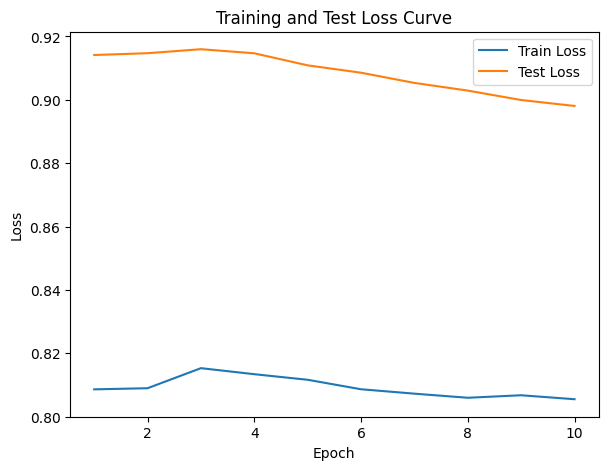

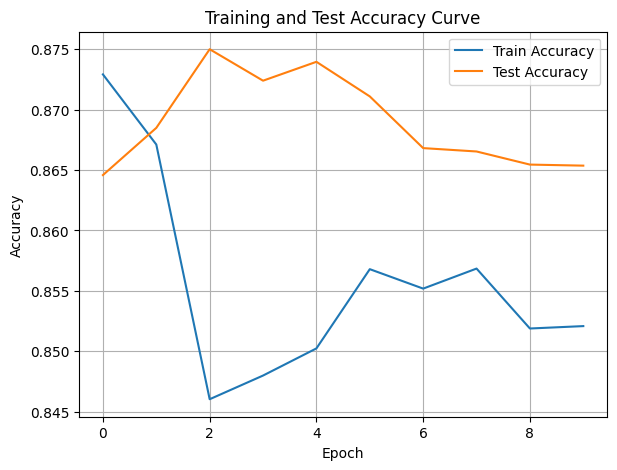

./saved_models/model_15.pth
Training Model with id 18
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8578434054420979, Train Loss: 0.7829, Train Acc: 0.8667, Test F1:0.8384395331763752, Test Loss: 0.8810, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.92it/s]

Epoch [2/10], Train F1:0.8551607107904816, Train Loss: 0.7814, Train Acc: 0.8609, Test F1:0.8437176036086195, Test Loss: 0.8813, Test Acc: 0.8529
Epoch [3/10], Train F1:0.8609272828936673, Train Loss: 0.7828, Train Acc: 0.8627, Test F1:0.8419632076141772, Test Loss: 0.8808, Test Acc: 0.8516


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.12it/s]

Epoch [4/10], Train F1:0.8666248572551809, Train Loss: 0.7812, Train Acc: 0.8676, Test F1:0.848951647411211, Test Loss: 0.8812, Test Acc: 0.8568
Epoch [5/10], Train F1:0.8706844794780585, Train Loss: 0.7788, Train Acc: 0.8713, Test F1:0.8551763164842048, Test Loss: 0.8806, Test Acc: 0.8615
Epoch [6/10], Train F1:0.8710873968320373, Train Loss: 0.7776, Train Acc: 0.8730, Test F1:0.8592931124413205, Test Loss: 0.8780, Test Acc: 0.8646


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.21it/s]

Epoch [7/10], Train F1:0.8713750225390886, Train Loss: 0.7772, Train Acc: 0.8731, Test F1:0.8578258023063631, Test Loss: 0.8742, Test Acc: 0.8635
Epoch [8/10], Train F1:0.872387592494819, Train Loss: 0.7755, Train Acc: 0.8740, Test F1:0.8592931124413203, Test Loss: 0.8740, Test Acc: 0.8646


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.37it/s]


Epoch [9/10], Train F1:0.8748176929183592, Train Loss: 0.7747, Train Acc: 0.8752, Test F1:0.8615691131125077, Test Loss: 0.8709, Test Acc: 0.8663
Epoch [10/10], Train F1:0.8760011323866392, Train Loss: 0.7750, Train Acc: 0.8748, Test F1:0.860318284175557, Test Loss: 0.8680, Test Acc: 0.8654
Total Epochs: 10
Train loss start: 0.789232075214386, Train loss end: 0.9825051426887512
Highest Mean Train Accuracy (over epoch): 0.8751984126984128
Test loss start: 0.8669208884239197, Test loss end: 0.8322596549987793
Highest mean Test Accuracy (over epoch): 0.8663194444444444


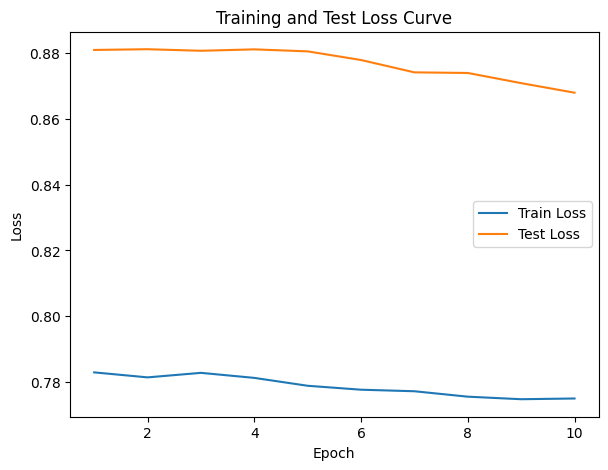

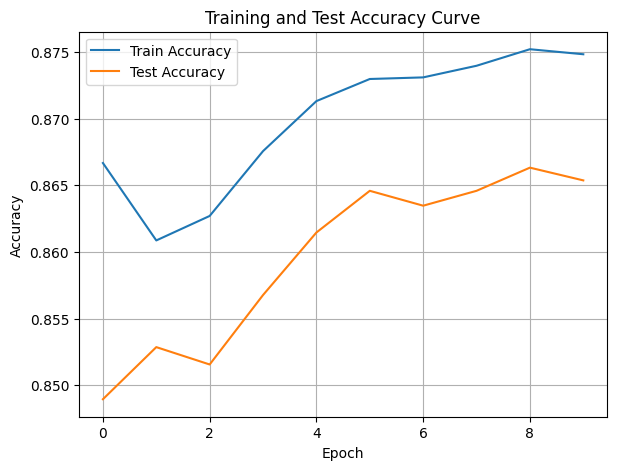

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.14it/s]

Epoch [1/10], Train F1:0.8792819891972435, Train Loss: 0.7621, Train Acc: 0.8801, Test F1:0.8694744718136531, Test Loss: 0.8420, Test Acc: 0.8724
Epoch [2/10], Train F1:0.8818134739981143, Train Loss: 0.7593, Train Acc: 0.8859, Test F1:0.8745082520542844, Test Loss: 0.8445, Test Acc: 0.8763


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.14it/s]

Epoch [3/10], Train F1:0.8749517339800371, Train Loss: 0.7599, Train Acc: 0.8759, Test F1:0.8832516339869281, Test Loss: 0.8472, Test Acc: 0.8848


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.96it/s]

Epoch [4/10], Train F1:0.8768211870649003, Train Loss: 0.7608, Train Acc: 0.8737, Test F1:0.877363383077129, Test Loss: 0.8441, Test Acc: 0.8798


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.96it/s]

Epoch [5/10], Train F1:0.8737857099677976, Train Loss: 0.7596, Train Acc: 0.8717, Test F1:0.8737992214604355, Test Loss: 0.8429, Test Acc: 0.8767


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.83it/s]

Epoch [6/10], Train F1:0.8729281929410796, Train Loss: 0.7592, Train Acc: 0.8688, Test F1:0.8730824996375235, Test Loss: 0.8421, Test Acc: 0.8760


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.83it/s]

Epoch [7/10], Train F1:0.874312918472286, Train Loss: 0.7581, Train Acc: 0.8686, Test F1:0.8740018043546017, Test Loss: 0.8412, Test Acc: 0.8766


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.66it/s]

Epoch [8/10], Train F1:0.8749587228890988, Train Loss: 0.7555, Train Acc: 0.8701, Test F1:0.8721843307960303, Test Loss: 0.8391, Test Acc: 0.8751


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.66it/s]

Epoch [9/10], Train F1:0.8736940399501976, Train Loss: 0.7554, Train Acc: 0.8687, Test F1:0.8696471755019972, Test Loss: 0.8377, Test Acc: 0.8731


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.99it/s]


Epoch [10/10], Train F1:0.8753770846837116, Train Loss: 0.7539, Train Acc: 0.8709, Test F1:0.8686206540582435, Test Loss: 0.8353, Test Acc: 0.8722
Total Epochs: 10
Train loss start: 0.7150279879570007, Train loss end: 0.7618003487586975
Highest Mean Train Accuracy (over epoch): 0.8858630952380953
Test loss start: 0.824062168598175, Test loss end: 0.8079226613044739
Highest mean Test Accuracy (over epoch): 0.8848379629629631


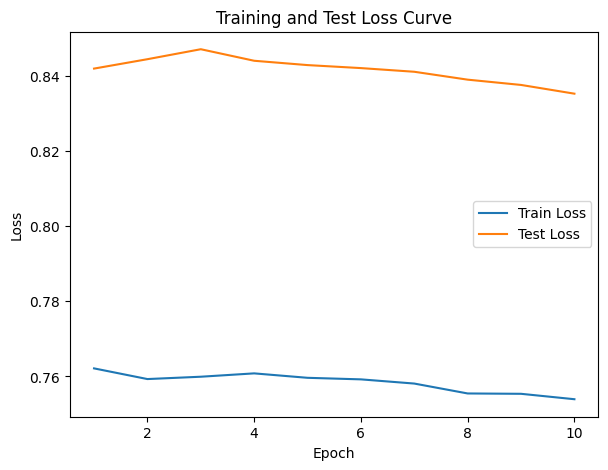

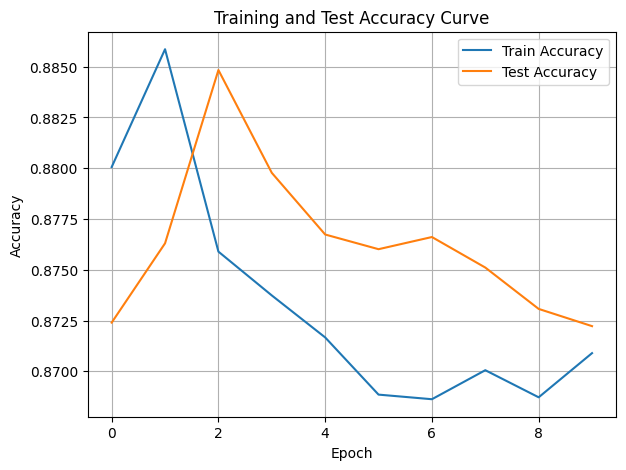

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8765023958301269, Train Loss: 0.7360, Train Acc: 0.8854, Test F1:0.8808197688643266, Test Loss: 0.8287, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.04it/s]

Epoch [2/10], Train F1:0.8844140021448125, Train Loss: 0.7343, Train Acc: 0.8890, Test F1:0.8801793085655315, Test Loss: 0.8262, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.04it/s]

Epoch [3/10], Train F1:0.8903655303795335, Train Loss: 0.7308, Train Acc: 0.8954, Test F1:0.8803964185120371, Test Loss: 0.8283, Test Acc: 0.8802


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.76it/s]

Epoch [4/10], Train F1:0.8911334322323443, Train Loss: 0.7304, Train Acc: 0.8910, Test F1:0.8805036066816242, Test Loss: 0.8281, Test Acc: 0.8802


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.90it/s]

Epoch [5/10], Train F1:0.8879094037443689, Train Loss: 0.7300, Train Acc: 0.8895, Test F1:0.8763564252958914, Test Loss: 0.8256, Test Acc: 0.8771
Epoch [6/10], Train F1:0.8876677251566337, Train Loss: 0.7301, Train Acc: 0.8889, Test F1:0.8803964185120371, Test Loss: 0.8255, Test Acc: 0.8812


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.90it/s]

Epoch [7/10], Train F1:0.8869367543215939, Train Loss: 0.7288, Train Acc: 0.8890, Test F1:0.8804577798977363, Test Loss: 0.8213, Test Acc: 0.8811


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.70it/s]

Epoch [8/10], Train F1:0.8837528078060436, Train Loss: 0.7281, Train Acc: 0.8868, Test F1:0.880342483752417, Test Loss: 0.8186, Test Acc: 0.8810


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.70it/s]

Epoch [9/10], Train F1:0.8846529142867292, Train Loss: 0.7285, Train Acc: 0.8855, Test F1:0.8802520854225048, Test Loss: 0.8156, Test Acc: 0.8809


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.19it/s]


Epoch [10/10], Train F1:0.8854371805561273, Train Loss: 0.7269, Train Acc: 0.8870, Test F1:0.8791912555363437, Test Loss: 0.8129, Test Acc: 0.8800
Total Epochs: 10
Train loss start: 0.7275034189224243, Train loss end: 0.6787878274917603
Highest Mean Train Accuracy (over epoch): 0.895436507936508
Test loss start: 0.8115307688713074, Test loss end: 0.7854902148246765
Highest mean Test Accuracy (over epoch): 0.8812210648148149


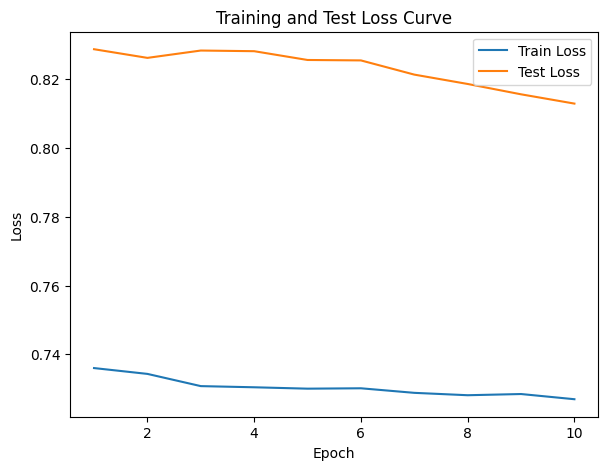

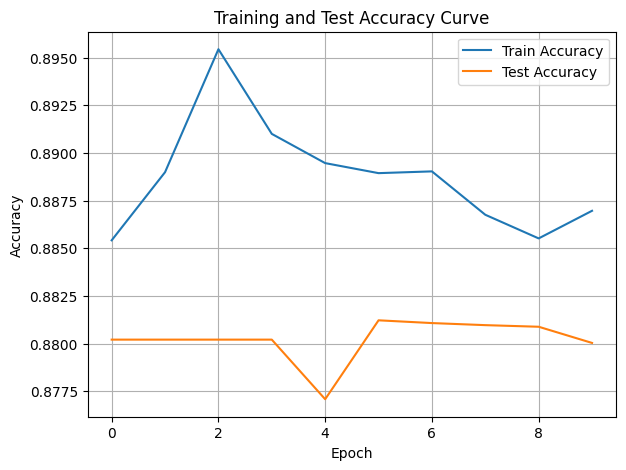

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8844977669217045, Train Loss: 0.7116, Train Acc: 0.8917, Test F1:0.8795057078126853, Test Loss: 0.7923, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.92it/s]

Epoch [2/10], Train F1:0.8886822579130271, Train Loss: 0.7173, Train Acc: 0.8921, Test F1:0.8844680062912561, Test Loss: 0.7906, Test Acc: 0.8872


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.92it/s]

Epoch [3/10], Train F1:0.897614614108997, Train Loss: 0.7108, Train Acc: 0.9017, Test F1:0.8761780484268521, Test Loss: 0.7905, Test Acc: 0.8796


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.31it/s]

Epoch [4/10], Train F1:0.8958139422958186, Train Loss: 0.7118, Train Acc: 0.8970, Test F1:0.8719959766436592, Test Loss: 0.7924, Test Acc: 0.8759


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.68it/s]

Epoch [5/10], Train F1:0.8929805742658807, Train Loss: 0.7096, Train Acc: 0.8955, Test F1:0.8694744718136532, Test Loss: 0.7917, Test Acc: 0.8736


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.87it/s]

Epoch [6/10], Train F1:0.8986064744566169, Train Loss: 0.7064, Train Acc: 0.9015, Test F1:0.8677882667692818, Test Loss: 0.7914, Test Acc: 0.8721


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.98it/s]

Epoch [7/10], Train F1:0.8963037420370141, Train Loss: 0.7075, Train Acc: 0.8987, Test F1:0.8665812571846028, Test Loss: 0.7887, Test Acc: 0.8710


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.04it/s]

Epoch [8/10], Train F1:0.8945159978154033, Train Loss: 0.7076, Train Acc: 0.8976, Test F1:0.8656745790573431, Test Loss: 0.7883, Test Acc: 0.8702


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.99it/s]

Epoch [9/10], Train F1:0.8950676419315133, Train Loss: 0.7065, Train Acc: 0.8969, Test F1:0.8649685378788156, Test Loss: 0.7871, Test Acc: 0.8696


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.55it/s]


Epoch [10/10], Train F1:0.8951137377400346, Train Loss: 0.7057, Train Acc: 0.8959, Test F1:0.8665974824642945, Test Loss: 0.7862, Test Acc: 0.8707
Total Epochs: 10
Train loss start: 0.6790957450866699, Train loss end: 0.740103542804718
Highest Mean Train Accuracy (over epoch): 0.9016865079365081
Test loss start: 0.7727426886558533, Test loss end: 0.7777997255325317
Highest mean Test Accuracy (over epoch): 0.8871527777777778


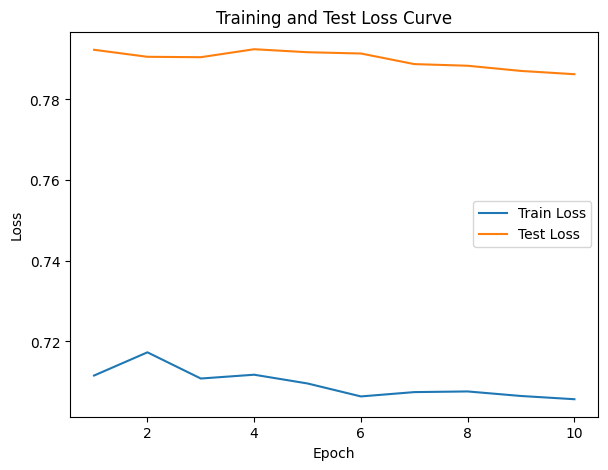

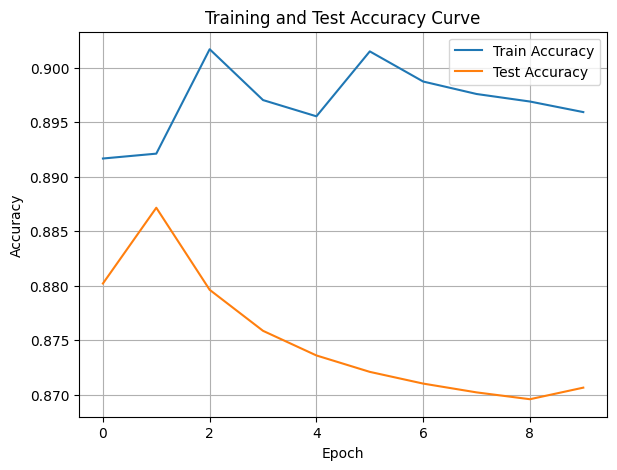

./saved_models/model_12.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [76]:
DTEmlp10b.train_DTE()

Training Process:   1%|          | 2/190 [00:00<00:30,  6.20it/s]

Epoch [1/190], Train F1:0.35518940153166223, Train Loss: 1.1106, Train Acc: 0.2887, Test F1:0.23770416288282598, Test Loss: 1.0974, Test Acc: 0.1806
Epoch [2/190], Train F1:0.39113064961133276, Train Loss: 1.0953, Train Acc: 0.3237, Test F1:0.23308467073256653, Test Loss: 1.0995, Test Acc: 0.1766


Training Process:   2%|▏         | 4/190 [00:00<00:28,  6.54it/s]

Epoch [3/190], Train F1:0.3992086055155667, Train Loss: 1.0934, Train Acc: 0.3368, Test F1:0.21905857540024926, Test Loss: 1.1016, Test Acc: 0.1649
Epoch [4/190], Train F1:0.4077085687212801, Train Loss: 1.0883, Train Acc: 0.3470, Test F1:0.22724823311699593, Test Loss: 1.0995, Test Acc: 0.1708


Training Process:   3%|▎         | 6/190 [00:00<00:25,  7.15it/s]

Epoch [5/190], Train F1:0.41946540312088954, Train Loss: 1.0838, Train Acc: 0.3590, Test F1:0.23953551228733028, Test Loss: 1.0970, Test Acc: 0.1774
Epoch [6/190], Train F1:0.43336877262888934, Train Loss: 1.0794, Train Acc: 0.3713, Test F1:0.253020612483718, Test Loss: 1.0933, Test Acc: 0.1858


Training Process:   4%|▍         | 8/190 [00:01<00:24,  7.34it/s]

Epoch [7/190], Train F1:0.444064608319509, Train Loss: 1.0739, Train Acc: 0.3812, Test F1:0.25488616868827224, Test Loss: 1.0931, Test Acc: 0.1859
Epoch [8/190], Train F1:0.45605985118925435, Train Loss: 1.0693, Train Acc: 0.3920, Test F1:0.26499256652795183, Test Loss: 1.0909, Test Acc: 0.1953


Training Process:   5%|▌         | 10/190 [00:01<00:23,  7.54it/s]

Epoch [9/190], Train F1:0.46616689667653466, Train Loss: 1.0655, Train Acc: 0.4012, Test F1:0.2759816437536079, Test Loss: 1.0883, Test Acc: 0.2030
Epoch [10/190], Train F1:0.4751207099065537, Train Loss: 1.0622, Train Acc: 0.4104, Test F1:0.28233562625100844, Test Loss: 1.0855, Test Acc: 0.2098


Training Process:   6%|▋         | 12/190 [00:01<00:21,  8.29it/s]

Epoch [11/190], Train F1:0.491078061803329, Train Loss: 1.0567, Train Acc: 0.4274, Test F1:0.29584426066341346, Test Loss: 1.0825, Test Acc: 0.2195
Epoch [12/190], Train F1:0.5026214422407084, Train Loss: 1.0525, Train Acc: 0.4393, Test F1:0.3208462243710755, Test Loss: 1.0797, Test Acc: 0.2365


Training Process:   7%|▋         | 14/190 [00:01<00:22,  7.78it/s]

Epoch [13/190], Train F1:0.5100181236775021, Train Loss: 1.0490, Train Acc: 0.4464, Test F1:0.33162470004357053, Test Loss: 1.0779, Test Acc: 0.2453
Epoch [14/190], Train F1:0.5199293146637992, Train Loss: 1.0450, Train Acc: 0.4577, Test F1:0.3416509919255987, Test Loss: 1.0760, Test Acc: 0.2526


Training Process:   8%|▊         | 16/190 [00:02<00:21,  8.14it/s]

Epoch [15/190], Train F1:0.5270869371583954, Train Loss: 1.0418, Train Acc: 0.4653, Test F1:0.3518521592182565, Test Loss: 1.0740, Test Acc: 0.2613
Epoch [16/190], Train F1:0.5346013176234516, Train Loss: 1.0381, Train Acc: 0.4742, Test F1:0.38703206252185307, Test Loss: 1.0718, Test Acc: 0.2876


Training Process:   9%|▉         | 18/190 [00:02<00:20,  8.47it/s]

Epoch [17/190], Train F1:0.5453573509667252, Train Loss: 1.0339, Train Acc: 0.4855, Test F1:0.42229423287846785, Test Loss: 1.0696, Test Acc: 0.3143
Epoch [18/190], Train F1:0.5547863583985101, Train Loss: 1.0302, Train Acc: 0.4960, Test F1:0.44988310890420247, Test Loss: 1.0681, Test Acc: 0.3361


Training Process:  11%|█         | 20/190 [00:02<00:19,  8.81it/s]

Epoch [19/190], Train F1:0.5644584104122087, Train Loss: 1.0254, Train Acc: 0.5076, Test F1:0.4776493850978328, Test Loss: 1.0661, Test Acc: 0.3599
Epoch [20/190], Train F1:0.5727308922609456, Train Loss: 1.0217, Train Acc: 0.5170, Test F1:0.501839456491712, Test Loss: 1.0641, Test Acc: 0.3814


Training Process:  12%|█▏        | 22/190 [00:02<00:21,  7.99it/s]

Epoch [21/190], Train F1:0.5795678067241806, Train Loss: 1.0180, Train Acc: 0.5260, Test F1:0.5237094585777959, Test Loss: 1.0619, Test Acc: 0.4022
Epoch [22/190], Train F1:0.5861057511595872, Train Loss: 1.0148, Train Acc: 0.5332, Test F1:0.5433041552065092, Test Loss: 1.0599, Test Acc: 0.4214


Training Process:  13%|█▎        | 24/190 [00:03<00:22,  7.48it/s]

Epoch [23/190], Train F1:0.593354807453468, Train Loss: 1.0112, Train Acc: 0.5415, Test F1:0.559892476685477, Test Loss: 1.0578, Test Acc: 0.4384
Epoch [24/190], Train F1:0.6007413764304205, Train Loss: 1.0074, Train Acc: 0.5500, Test F1:0.5755138390823656, Test Loss: 1.0557, Test Acc: 0.4549


Training Process:  14%|█▎        | 26/190 [00:03<00:22,  7.24it/s]

Epoch [25/190], Train F1:0.6078721362686766, Train Loss: 1.0041, Train Acc: 0.5576, Test F1:0.5915252044657588, Test Loss: 1.0533, Test Acc: 0.4721
Epoch [26/190], Train F1:0.6132200756882671, Train Loss: 1.0014, Train Acc: 0.5641, Test F1:0.6048034019318139, Test Loss: 1.0509, Test Acc: 0.4869


Training Process:  15%|█▍        | 28/190 [00:03<00:23,  7.02it/s]

Epoch [27/190], Train F1:0.619375283548685, Train Loss: 0.9987, Train Acc: 0.5708, Test F1:0.6164795168839912, Test Loss: 1.0486, Test Acc: 0.5005
Epoch [28/190], Train F1:0.6248007911075885, Train Loss: 0.9955, Train Acc: 0.5774, Test F1:0.6273508674500181, Test Loss: 1.0465, Test Acc: 0.5133


Training Process:  16%|█▌        | 30/190 [00:04<00:27,  5.72it/s]

Epoch [29/190], Train F1:0.6306171041636921, Train Loss: 0.9921, Train Acc: 0.5845, Test F1:0.6372602234365654, Test Loss: 1.0447, Test Acc: 0.5251
Epoch [30/190], Train F1:0.6348502368046677, Train Loss: 0.9894, Train Acc: 0.5899, Test F1:0.6471333625764734, Test Loss: 1.0432, Test Acc: 0.5369


Training Process:  16%|█▋        | 31/190 [00:04<00:28,  5.61it/s]

Epoch [31/190], Train F1:0.6392306359299165, Train Loss: 0.9860, Train Acc: 0.5956, Test F1:0.6561122996008222, Test Loss: 1.0411, Test Acc: 0.5479


Training Process:  17%|█▋        | 32/190 [00:04<00:28,  5.54it/s]

Epoch [32/190], Train F1:0.6444958159533374, Train Loss: 0.9828, Train Acc: 0.6017, Test F1:0.6644002017364424, Test Loss: 1.0392, Test Acc: 0.5582
Epoch [33/190], Train F1:0.6500544385327695, Train Loss: 0.9796, Train Acc: 0.6083, Test F1:0.6717598957073383, Test Loss: 1.0372, Test Acc: 0.5675


Training Process:  18%|█▊        | 35/190 [00:05<00:26,  5.88it/s]

Epoch [34/190], Train F1:0.6552551894084834, Train Loss: 0.9765, Train Acc: 0.6140, Test F1:0.6785904577678874, Test Loss: 1.0353, Test Acc: 0.5763
Epoch [35/190], Train F1:0.6602425255839433, Train Loss: 0.9733, Train Acc: 0.6200, Test F1:0.6858346989175278, Test Loss: 1.0335, Test Acc: 0.5853


Training Process:  19%|█▉        | 36/190 [00:05<00:26,  5.71it/s]

Epoch [36/190], Train F1:0.6645563916152852, Train Loss: 0.9706, Train Acc: 0.6253, Test F1:0.6914528031173782, Test Loss: 1.0318, Test Acc: 0.5929


Training Process:  20%|██        | 38/190 [00:05<00:26,  5.74it/s]

Epoch [37/190], Train F1:0.6693586231336668, Train Loss: 0.9674, Train Acc: 0.6308, Test F1:0.6972624411001217, Test Loss: 1.0301, Test Acc: 0.6006
Epoch [38/190], Train F1:0.6731318591174572, Train Loss: 0.9649, Train Acc: 0.6352, Test F1:0.7029812988165537, Test Loss: 1.0285, Test Acc: 0.6081


Training Process:  21%|██        | 40/190 [00:05<00:24,  6.04it/s]

Epoch [39/190], Train F1:0.6766966861272491, Train Loss: 0.9619, Train Acc: 0.6397, Test F1:0.7078271439479129, Test Loss: 1.0267, Test Acc: 0.6147
Epoch [40/190], Train F1:0.6795650840135412, Train Loss: 0.9590, Train Acc: 0.6435, Test F1:0.7129019407075938, Test Loss: 1.0250, Test Acc: 0.6215


Training Process:  22%|██▏       | 42/190 [00:06<00:26,  5.69it/s]

Epoch [41/190], Train F1:0.6832669361795323, Train Loss: 0.9561, Train Acc: 0.6478, Test F1:0.7174378505730337, Test Loss: 1.0234, Test Acc: 0.6278
Epoch [42/190], Train F1:0.6868939508779881, Train Loss: 0.9532, Train Acc: 0.6522, Test F1:0.7214772956974405, Test Loss: 1.0216, Test Acc: 0.6334


Training Process:  23%|██▎       | 44/190 [00:06<00:24,  5.87it/s]

Epoch [43/190], Train F1:0.6902729242557508, Train Loss: 0.9505, Train Acc: 0.6564, Test F1:0.7252973575668619, Test Loss: 1.0196, Test Acc: 0.6388
Epoch [44/190], Train F1:0.6935098935984079, Train Loss: 0.9478, Train Acc: 0.6604, Test F1:0.7289154691672177, Test Loss: 1.0179, Test Acc: 0.6439


Training Process:  24%|██▍       | 46/190 [00:06<00:24,  5.97it/s]

Epoch [45/190], Train F1:0.6960705453060547, Train Loss: 0.9452, Train Acc: 0.6635, Test F1:0.7328037301335389, Test Loss: 1.0160, Test Acc: 0.6493
Epoch [46/190], Train F1:0.6996444409681932, Train Loss: 0.9423, Train Acc: 0.6677, Test F1:0.736276155022243, Test Loss: 1.0145, Test Acc: 0.6543


Training Process:  25%|██▌       | 48/190 [00:07<00:24,  5.86it/s]

Epoch [47/190], Train F1:0.7029291705766854, Train Loss: 0.9396, Train Acc: 0.6715, Test F1:0.7393615176615181, Test Loss: 1.0130, Test Acc: 0.6587
Epoch [48/190], Train F1:0.7058370061361252, Train Loss: 0.9369, Train Acc: 0.6750, Test F1:0.7422895212620052, Test Loss: 1.0112, Test Acc: 0.6630


Training Process:  26%|██▌       | 49/190 [00:07<00:24,  5.76it/s]

Epoch [49/190], Train F1:0.7085646302611301, Train Loss: 0.9346, Train Acc: 0.6782, Test F1:0.7450897997929277, Test Loss: 1.0095, Test Acc: 0.6671


Training Process:  26%|██▋       | 50/190 [00:07<00:24,  5.64it/s]

Epoch [50/190], Train F1:0.7112501564862144, Train Loss: 0.9322, Train Acc: 0.6815, Test F1:0.7479671854893377, Test Loss: 1.0080, Test Acc: 0.6714


Training Process:  27%|██▋       | 51/190 [00:07<00:25,  5.51it/s]

Epoch [51/190], Train F1:0.714305270635703, Train Loss: 0.9296, Train Acc: 0.6851, Test F1:0.7507171259830587, Test Loss: 1.0062, Test Acc: 0.6754


Training Process:  27%|██▋       | 52/190 [00:08<00:25,  5.42it/s]

Epoch [52/190], Train F1:0.7171194484019658, Train Loss: 0.9270, Train Acc: 0.6885, Test F1:0.7535445144686939, Test Loss: 1.0045, Test Acc: 0.6795


Training Process:  28%|██▊       | 53/190 [00:08<00:28,  4.84it/s]

Epoch [53/190], Train F1:0.7194465935934699, Train Loss: 0.9249, Train Acc: 0.6910, Test F1:0.7560598925112563, Test Loss: 1.0028, Test Acc: 0.6832


Training Process:  28%|██▊       | 54/190 [00:08<00:28,  4.79it/s]

Epoch [54/190], Train F1:0.7217574839713816, Train Loss: 0.9226, Train Acc: 0.6938, Test F1:0.7590376677404338, Test Loss: 1.0012, Test Acc: 0.6873


Training Process:  29%|██▉       | 55/190 [00:08<00:28,  4.69it/s]

Epoch [55/190], Train F1:0.7242444674462195, Train Loss: 0.9204, Train Acc: 0.6967, Test F1:0.7617103784126101, Test Loss: 0.9996, Test Acc: 0.6911


Training Process:  29%|██▉       | 56/190 [00:08<00:28,  4.67it/s]

Epoch [56/190], Train F1:0.726683186684496, Train Loss: 0.9180, Train Acc: 0.6995, Test F1:0.7640956570882693, Test Loss: 0.9980, Test Acc: 0.6945


Training Process:  30%|███       | 57/190 [00:09<00:28,  4.64it/s]

Epoch [57/190], Train F1:0.7289735684191453, Train Loss: 0.9157, Train Acc: 0.7022, Test F1:0.7665665116793262, Test Loss: 0.9965, Test Acc: 0.6980


Training Process:  31%|███       | 58/190 [00:09<00:29,  4.55it/s]

Epoch [58/190], Train F1:0.731288284400455, Train Loss: 0.9135, Train Acc: 0.7050, Test F1:0.7689433804930974, Test Loss: 0.9950, Test Acc: 0.7014


Training Process:  31%|███       | 59/190 [00:09<00:27,  4.73it/s]

Epoch [59/190], Train F1:0.7330225444988462, Train Loss: 0.9115, Train Acc: 0.7072, Test F1:0.7709204495520433, Test Loss: 0.9936, Test Acc: 0.7042


Training Process:  32%|███▏      | 60/190 [00:09<00:26,  4.84it/s]

Epoch [60/190], Train F1:0.7349168919464043, Train Loss: 0.9093, Train Acc: 0.7096, Test F1:0.7729618304199145, Test Loss: 0.9920, Test Acc: 0.7072


Training Process:  32%|███▏      | 61/190 [00:09<00:26,  4.94it/s]

Epoch [61/190], Train F1:0.7374752431488558, Train Loss: 0.9068, Train Acc: 0.7126, Test F1:0.7747634730060061, Test Loss: 0.9905, Test Acc: 0.7101


Training Process:  33%|███▎      | 62/190 [00:10<00:25,  5.01it/s]

Epoch [62/190], Train F1:0.7395181796585149, Train Loss: 0.9049, Train Acc: 0.7150, Test F1:0.776827348583942, Test Loss: 0.9890, Test Acc: 0.7130


Training Process:  33%|███▎      | 63/190 [00:10<00:25,  4.93it/s]

Epoch [63/190], Train F1:0.7414752398358403, Train Loss: 0.9027, Train Acc: 0.7172, Test F1:0.7788195449671483, Test Loss: 0.9875, Test Acc: 0.7159


Training Process:  34%|███▎      | 64/190 [00:10<00:28,  4.48it/s]

Epoch [64/190], Train F1:0.7435080332777478, Train Loss: 0.9005, Train Acc: 0.7197, Test F1:0.7805858991418977, Test Loss: 0.9859, Test Acc: 0.7186


Training Process:  34%|███▍      | 65/190 [00:10<00:27,  4.60it/s]

Epoch [65/190], Train F1:0.7451564019107341, Train Loss: 0.8987, Train Acc: 0.7215, Test F1:0.782169777177995, Test Loss: 0.9844, Test Acc: 0.7208


Training Process:  35%|███▍      | 66/190 [00:11<00:26,  4.67it/s]

Epoch [66/190], Train F1:0.7469337652451956, Train Loss: 0.8966, Train Acc: 0.7235, Test F1:0.783701687986053, Test Loss: 0.9831, Test Acc: 0.7230


Training Process:  35%|███▌      | 67/190 [00:11<00:25,  4.80it/s]

Epoch [67/190], Train F1:0.7485063362241535, Train Loss: 0.8948, Train Acc: 0.7256, Test F1:0.7854531226098199, Test Loss: 0.9817, Test Acc: 0.7256


Training Process:  36%|███▌      | 68/190 [00:11<00:25,  4.81it/s]

Epoch [68/190], Train F1:0.7501835198796866, Train Loss: 0.8929, Train Acc: 0.7277, Test F1:0.7868840603592796, Test Loss: 0.9804, Test Acc: 0.7277


Training Process:  36%|███▋      | 69/190 [00:11<00:25,  4.80it/s]

Epoch [69/190], Train F1:0.7522048405388255, Train Loss: 0.8907, Train Acc: 0.7301, Test F1:0.7883952097063373, Test Loss: 0.9790, Test Acc: 0.7300


Training Process:  37%|███▋      | 70/190 [00:11<00:24,  4.80it/s]

Epoch [70/190], Train F1:0.7535862781340775, Train Loss: 0.8889, Train Acc: 0.7318, Test F1:0.7898800843249559, Test Loss: 0.9775, Test Acc: 0.7320


Training Process:  37%|███▋      | 71/190 [00:12<00:24,  4.84it/s]

Epoch [71/190], Train F1:0.7555862243896964, Train Loss: 0.8870, Train Acc: 0.7340, Test F1:0.7910069944351473, Test Loss: 0.9757, Test Acc: 0.7339


Training Process:  38%|███▊      | 72/190 [00:12<00:24,  4.77it/s]

Epoch [72/190], Train F1:0.7572153548803854, Train Loss: 0.8851, Train Acc: 0.7360, Test F1:0.7920994239703282, Test Loss: 0.9741, Test Acc: 0.7357


Training Process:  38%|███▊      | 73/190 [00:12<00:24,  4.72it/s]

Epoch [73/190], Train F1:0.7587279523959393, Train Loss: 0.8833, Train Acc: 0.7377, Test F1:0.7934541081177029, Test Loss: 0.9729, Test Acc: 0.7376


Training Process:  39%|███▉      | 74/190 [00:12<00:24,  4.68it/s]

Epoch [74/190], Train F1:0.7601525864913358, Train Loss: 0.8816, Train Acc: 0.7394, Test F1:0.7948846249008268, Test Loss: 0.9716, Test Acc: 0.7397


Training Process:  39%|███▉      | 75/190 [00:12<00:27,  4.24it/s]

Epoch [75/190], Train F1:0.7620933416725751, Train Loss: 0.8797, Train Acc: 0.7416, Test F1:0.7962740238498847, Test Loss: 0.9702, Test Acc: 0.7418


Training Process:  40%|████      | 76/190 [00:13<00:26,  4.24it/s]

Epoch [76/190], Train F1:0.7636632230296655, Train Loss: 0.8780, Train Acc: 0.7433, Test F1:0.7974005304209579, Test Loss: 0.9691, Test Acc: 0.7434


Training Process:  41%|████      | 77/190 [00:13<00:26,  4.20it/s]

Epoch [77/190], Train F1:0.7653287579592164, Train Loss: 0.8763, Train Acc: 0.7452, Test F1:0.7986157214708265, Test Loss: 0.9678, Test Acc: 0.7451


Training Process:  41%|████      | 78/190 [00:13<00:25,  4.32it/s]

Epoch [78/190], Train F1:0.7668534209394857, Train Loss: 0.8746, Train Acc: 0.7469, Test F1:0.7998965859959488, Test Loss: 0.9663, Test Acc: 0.7470


Training Process:  42%|████▏     | 79/190 [00:13<00:25,  4.43it/s]

Epoch [79/190], Train F1:0.7683114419327959, Train Loss: 0.8729, Train Acc: 0.7485, Test F1:0.8011426276270928, Test Loss: 0.9649, Test Acc: 0.7489


Training Process:  42%|████▏     | 80/190 [00:14<00:24,  4.46it/s]

Epoch [80/190], Train F1:0.7696946660114758, Train Loss: 0.8711, Train Acc: 0.7502, Test F1:0.802230621271333, Test Loss: 0.9634, Test Acc: 0.7506


Training Process:  43%|████▎     | 81/190 [00:14<00:24,  4.50it/s]

Epoch [81/190], Train F1:0.7710499782970953, Train Loss: 0.8693, Train Acc: 0.7519, Test F1:0.8034127518709342, Test Loss: 0.9620, Test Acc: 0.7524


Training Process:  43%|████▎     | 82/190 [00:14<00:24,  4.49it/s]

Epoch [82/190], Train F1:0.7721349141890846, Train Loss: 0.8680, Train Acc: 0.7532, Test F1:0.8042372948706557, Test Loss: 0.9608, Test Acc: 0.7537


Training Process:  44%|████▎     | 83/190 [00:14<00:23,  4.48it/s]

Epoch [83/190], Train F1:0.7729507964594325, Train Loss: 0.8665, Train Acc: 0.7543, Test F1:0.8054830501749883, Test Loss: 0.9596, Test Acc: 0.7554


Training Process:  44%|████▍     | 84/190 [00:15<00:23,  4.49it/s]

Epoch [84/190], Train F1:0.7740404188411995, Train Loss: 0.8650, Train Acc: 0.7556, Test F1:0.8065787702669084, Test Loss: 0.9584, Test Acc: 0.7571


Training Process:  45%|████▍     | 85/190 [00:15<00:25,  4.09it/s]

Epoch [85/190], Train F1:0.7752346319273011, Train Loss: 0.8635, Train Acc: 0.7570, Test F1:0.8075574400821157, Test Loss: 0.9572, Test Acc: 0.7585


Training Process:  45%|████▌     | 86/190 [00:15<00:25,  4.00it/s]

Epoch [86/190], Train F1:0.7763126024198977, Train Loss: 0.8621, Train Acc: 0.7583, Test F1:0.8084848269540567, Test Loss: 0.9558, Test Acc: 0.7600


Training Process:  46%|████▌     | 87/190 [00:15<00:25,  4.00it/s]

Epoch [87/190], Train F1:0.7777255856383727, Train Loss: 0.8604, Train Acc: 0.7600, Test F1:0.8095035040925808, Test Loss: 0.9546, Test Acc: 0.7615


Training Process:  46%|████▋     | 88/190 [00:16<00:25,  3.94it/s]

Epoch [88/190], Train F1:0.7791493143554235, Train Loss: 0.8588, Train Acc: 0.7616, Test F1:0.8104975034233248, Test Loss: 0.9533, Test Acc: 0.7630


Training Process:  47%|████▋     | 89/190 [00:16<00:26,  3.84it/s]

Epoch [89/190], Train F1:0.7801337850282097, Train Loss: 0.8574, Train Acc: 0.7627, Test F1:0.8113828345963461, Test Loss: 0.9522, Test Acc: 0.7643


Training Process:  47%|████▋     | 90/190 [00:16<00:26,  3.81it/s]

Epoch [90/190], Train F1:0.7815658622186511, Train Loss: 0.8559, Train Acc: 0.7642, Test F1:0.8121459741588132, Test Loss: 0.9510, Test Acc: 0.7654


Training Process:  48%|████▊     | 91/190 [00:16<00:26,  3.73it/s]

Epoch [91/190], Train F1:0.782789065616927, Train Loss: 0.8544, Train Acc: 0.7656, Test F1:0.812891394620554, Test Loss: 0.9500, Test Acc: 0.7665


Training Process:  48%|████▊     | 92/190 [00:17<00:26,  3.67it/s]

Epoch [92/190], Train F1:0.7841478199636474, Train Loss: 0.8529, Train Acc: 0.7672, Test F1:0.8138005848724197, Test Loss: 0.9487, Test Acc: 0.7679


Training Process:  49%|████▉     | 93/190 [00:17<00:26,  3.63it/s]

Epoch [93/190], Train F1:0.7851370534119587, Train Loss: 0.8514, Train Acc: 0.7685, Test F1:0.8146890012184642, Test Loss: 0.9473, Test Acc: 0.7692


Training Process:  49%|████▉     | 94/190 [00:17<00:25,  3.72it/s]

Epoch [94/190], Train F1:0.7863301150560417, Train Loss: 0.8499, Train Acc: 0.7698, Test F1:0.8155657750377248, Test Loss: 0.9461, Test Acc: 0.7706


Training Process:  50%|█████     | 95/190 [00:17<00:25,  3.77it/s]

Epoch [95/190], Train F1:0.7872267763628128, Train Loss: 0.8485, Train Acc: 0.7710, Test F1:0.8164146654538921, Test Loss: 0.9448, Test Acc: 0.7719


Training Process:  51%|█████     | 96/190 [00:18<00:26,  3.55it/s]

Epoch [96/190], Train F1:0.7882049367434668, Train Loss: 0.8472, Train Acc: 0.7720, Test F1:0.8171419120679358, Test Loss: 0.9434, Test Acc: 0.7731


Training Process:  51%|█████     | 97/190 [00:18<00:25,  3.60it/s]

Epoch [97/190], Train F1:0.7892783829574982, Train Loss: 0.8459, Train Acc: 0.7732, Test F1:0.817853200240157, Test Loss: 0.9420, Test Acc: 0.7742


Training Process:  52%|█████▏    | 98/190 [00:18<00:25,  3.64it/s]

Epoch [98/190], Train F1:0.7903568973541653, Train Loss: 0.8444, Train Acc: 0.7745, Test F1:0.8186497951303905, Test Loss: 0.9408, Test Acc: 0.7755


Training Process:  52%|█████▏    | 99/190 [00:19<00:24,  3.65it/s]

Epoch [99/190], Train F1:0.791245495364496, Train Loss: 0.8432, Train Acc: 0.7757, Test F1:0.8193459877650932, Test Loss: 0.9398, Test Acc: 0.7765


Training Process:  53%|█████▎    | 100/190 [00:19<00:24,  3.65it/s]

Epoch [100/190], Train F1:0.7922819684851782, Train Loss: 0.8419, Train Acc: 0.7768, Test F1:0.8199450289423407, Test Loss: 0.9388, Test Acc: 0.7774


Training Process:  53%|█████▎    | 101/190 [00:19<00:24,  3.62it/s]

Epoch [101/190], Train F1:0.7933929132984515, Train Loss: 0.8406, Train Acc: 0.7780, Test F1:0.8206211952380438, Test Loss: 0.9377, Test Acc: 0.7784


Training Process:  54%|█████▎    | 102/190 [00:19<00:24,  3.54it/s]

Epoch [102/190], Train F1:0.7944213657913397, Train Loss: 0.8392, Train Acc: 0.7791, Test F1:0.8211947679891567, Test Loss: 0.9367, Test Acc: 0.7792


Training Process:  54%|█████▍    | 103/190 [00:20<00:24,  3.49it/s]

Epoch [103/190], Train F1:0.7953722225501275, Train Loss: 0.8379, Train Acc: 0.7803, Test F1:0.8219476761913923, Test Loss: 0.9357, Test Acc: 0.7803


Training Process:  55%|█████▍    | 104/190 [00:20<00:25,  3.42it/s]

Epoch [104/190], Train F1:0.7963789942095889, Train Loss: 0.8366, Train Acc: 0.7813, Test F1:0.8223708255309825, Test Loss: 0.9344, Test Acc: 0.7811


Training Process:  55%|█████▌    | 105/190 [00:20<00:27,  3.11it/s]

Epoch [105/190], Train F1:0.7972134764330874, Train Loss: 0.8354, Train Acc: 0.7823, Test F1:0.8230662545714048, Test Loss: 0.9332, Test Acc: 0.7822


Training Process:  56%|█████▌    | 106/190 [00:21<00:27,  3.04it/s]

Epoch [106/190], Train F1:0.7978000603644894, Train Loss: 0.8342, Train Acc: 0.7831, Test F1:0.8237478446314094, Test Loss: 0.9319, Test Acc: 0.7832


Training Process:  56%|█████▋    | 107/190 [00:21<00:27,  3.07it/s]

Epoch [107/190], Train F1:0.7989347447607158, Train Loss: 0.8329, Train Acc: 0.7843, Test F1:0.824416004845083, Test Loss: 0.9308, Test Acc: 0.7843


Training Process:  57%|█████▋    | 108/190 [00:21<00:25,  3.19it/s]

Epoch [108/190], Train F1:0.799743748097756, Train Loss: 0.8317, Train Acc: 0.7853, Test F1:0.8250862145719406, Test Loss: 0.9297, Test Acc: 0.7852


Training Process:  57%|█████▋    | 109/190 [00:22<00:24,  3.27it/s]

Epoch [109/190], Train F1:0.8007238115341003, Train Loss: 0.8305, Train Acc: 0.7864, Test F1:0.8256384807252191, Test Loss: 0.9286, Test Acc: 0.7862


Training Process:  58%|█████▊    | 110/190 [00:22<00:23,  3.37it/s]

Epoch [110/190], Train F1:0.8017075155535373, Train Loss: 0.8293, Train Acc: 0.7875, Test F1:0.8261206294021157, Test Loss: 0.9275, Test Acc: 0.7869


Training Process:  58%|█████▊    | 111/190 [00:22<00:23,  3.40it/s]

Epoch [111/190], Train F1:0.8024517979169898, Train Loss: 0.8282, Train Acc: 0.7883, Test F1:0.8266083645227267, Test Loss: 0.9267, Test Acc: 0.7877


Training Process:  59%|█████▉    | 112/190 [00:23<00:22,  3.39it/s]

Epoch [112/190], Train F1:0.8033873610173072, Train Loss: 0.8269, Train Acc: 0.7894, Test F1:0.8273132465090753, Test Loss: 0.9256, Test Acc: 0.7887


Training Process:  59%|█████▉    | 113/190 [00:23<00:22,  3.37it/s]

Epoch [113/190], Train F1:0.8040961014651117, Train Loss: 0.8258, Train Acc: 0.7903, Test F1:0.8278460169088772, Test Loss: 0.9246, Test Acc: 0.7894


Training Process:  60%|██████    | 114/190 [00:23<00:22,  3.33it/s]

Epoch [114/190], Train F1:0.8048740124818342, Train Loss: 0.8247, Train Acc: 0.7912, Test F1:0.8282902379164915, Test Loss: 0.9236, Test Acc: 0.7901


Training Process:  61%|██████    | 115/190 [00:24<00:24,  3.06it/s]

Epoch [115/190], Train F1:0.805688745254526, Train Loss: 0.8235, Train Acc: 0.7921, Test F1:0.8287973962814387, Test Loss: 0.9226, Test Acc: 0.7909


Training Process:  61%|██████    | 116/190 [00:24<00:24,  3.03it/s]

Epoch [116/190], Train F1:0.8065289345064732, Train Loss: 0.8224, Train Acc: 0.7930, Test F1:0.8293657376654532, Test Loss: 0.9214, Test Acc: 0.7918


Training Process:  62%|██████▏   | 117/190 [00:24<00:24,  3.00it/s]

Epoch [117/190], Train F1:0.8073040617697718, Train Loss: 0.8212, Train Acc: 0.7940, Test F1:0.8299238794843529, Test Loss: 0.9202, Test Acc: 0.7927


Training Process:  62%|██████▏   | 118/190 [00:25<00:24,  2.97it/s]

Epoch [118/190], Train F1:0.8081607457446175, Train Loss: 0.8201, Train Acc: 0.7949, Test F1:0.8305549707591809, Test Loss: 0.9191, Test Acc: 0.7936


Training Process:  63%|██████▎   | 119/190 [00:25<00:24,  2.95it/s]

Epoch [119/190], Train F1:0.8090493600495957, Train Loss: 0.8190, Train Acc: 0.7957, Test F1:0.8309559582955764, Test Loss: 0.9182, Test Acc: 0.7942


Training Process:  63%|██████▎   | 120/190 [00:25<00:23,  3.04it/s]

Epoch [120/190], Train F1:0.8099238446608119, Train Loss: 0.8179, Train Acc: 0.7968, Test F1:0.8314246072030907, Test Loss: 0.9172, Test Acc: 0.7949


Training Process:  64%|██████▎   | 121/190 [00:26<00:22,  3.13it/s]

Epoch [121/190], Train F1:0.8107295726176366, Train Loss: 0.8168, Train Acc: 0.7976, Test F1:0.8319591434586737, Test Loss: 0.9162, Test Acc: 0.7956


Training Process:  64%|██████▍   | 122/190 [00:26<00:21,  3.15it/s]

Epoch [122/190], Train F1:0.8116290331184248, Train Loss: 0.8157, Train Acc: 0.7986, Test F1:0.8324845280801596, Test Loss: 0.9152, Test Acc: 0.7964


Training Process:  65%|██████▍   | 123/190 [00:26<00:21,  3.18it/s]

Epoch [123/190], Train F1:0.8122845703388951, Train Loss: 0.8148, Train Acc: 0.7992, Test F1:0.8329943820202289, Test Loss: 0.9141, Test Acc: 0.7972


Training Process:  65%|██████▌   | 124/190 [00:26<00:20,  3.19it/s]

Epoch [124/190], Train F1:0.813175688838468, Train Loss: 0.8137, Train Acc: 0.8003, Test F1:0.8334301229324697, Test Loss: 0.9131, Test Acc: 0.7978


Training Process:  66%|██████▌   | 125/190 [00:27<00:20,  3.18it/s]

Epoch [125/190], Train F1:0.8139870575161863, Train Loss: 0.8126, Train Acc: 0.8011, Test F1:0.8338520935780673, Test Loss: 0.9122, Test Acc: 0.7985


Training Process:  66%|██████▋   | 126/190 [00:27<00:21,  2.95it/s]

Epoch [126/190], Train F1:0.8146115933358424, Train Loss: 0.8117, Train Acc: 0.8019, Test F1:0.8344088550618066, Test Loss: 0.9111, Test Acc: 0.7993


Training Process:  67%|██████▋   | 127/190 [00:28<00:21,  2.94it/s]

Epoch [127/190], Train F1:0.8155299603062492, Train Loss: 0.8106, Train Acc: 0.8028, Test F1:0.8347647781216363, Test Loss: 0.9103, Test Acc: 0.7999


Training Process:  67%|██████▋   | 128/190 [00:28<00:21,  2.90it/s]

Epoch [128/190], Train F1:0.8162402321563211, Train Loss: 0.8096, Train Acc: 0.8036, Test F1:0.835311388630136, Test Loss: 0.9093, Test Acc: 0.8007


Training Process:  68%|██████▊   | 129/190 [00:28<00:21,  2.88it/s]

Epoch [129/190], Train F1:0.816970578855066, Train Loss: 0.8085, Train Acc: 0.8044, Test F1:0.8357674212671817, Test Loss: 0.9082, Test Acc: 0.8014


Training Process:  68%|██████▊   | 130/190 [00:29<00:21,  2.84it/s]

Epoch [130/190], Train F1:0.8175742346546643, Train Loss: 0.8076, Train Acc: 0.8050, Test F1:0.8362286360625636, Test Loss: 0.9072, Test Acc: 0.8020


Training Process:  69%|██████▉   | 131/190 [00:29<00:21,  2.78it/s]

Epoch [131/190], Train F1:0.8182356838225158, Train Loss: 0.8066, Train Acc: 0.8058, Test F1:0.8366144691520222, Test Loss: 0.9063, Test Acc: 0.8026


Training Process:  69%|██████▉   | 132/190 [00:29<00:20,  2.84it/s]

Epoch [132/190], Train F1:0.8187912477739835, Train Loss: 0.8056, Train Acc: 0.8065, Test F1:0.8371230940095858, Test Loss: 0.9053, Test Acc: 0.8033


Training Process:  70%|███████   | 133/190 [00:30<00:19,  2.91it/s]

Epoch [133/190], Train F1:0.8194797451616094, Train Loss: 0.8047, Train Acc: 0.8073, Test F1:0.8375750739005987, Test Loss: 0.9045, Test Acc: 0.8040


Training Process:  71%|███████   | 134/190 [00:30<00:18,  2.98it/s]

Epoch [134/190], Train F1:0.8200974596766077, Train Loss: 0.8039, Train Acc: 0.8079, Test F1:0.8377541899722335, Test Loss: 0.9038, Test Acc: 0.8044


Training Process:  71%|███████   | 135/190 [00:30<00:18,  3.00it/s]

Epoch [135/190], Train F1:0.8207498743287638, Train Loss: 0.8030, Train Acc: 0.8086, Test F1:0.8380504852802187, Test Loss: 0.9030, Test Acc: 0.8048


Training Process:  72%|███████▏  | 136/190 [00:31<00:19,  2.81it/s]

Epoch [136/190], Train F1:0.8213243225969846, Train Loss: 0.8021, Train Acc: 0.8093, Test F1:0.8384671748343137, Test Loss: 0.9020, Test Acc: 0.8055


Training Process:  72%|███████▏  | 137/190 [00:31<00:18,  2.81it/s]

Epoch [137/190], Train F1:0.8217878327600335, Train Loss: 0.8012, Train Acc: 0.8099, Test F1:0.8387535935585625, Test Loss: 0.9011, Test Acc: 0.8059


Training Process:  73%|███████▎  | 138/190 [00:31<00:18,  2.78it/s]

Epoch [138/190], Train F1:0.8223392553750108, Train Loss: 0.8003, Train Acc: 0.8105, Test F1:0.8391587167076499, Test Loss: 0.9002, Test Acc: 0.8066


Training Process:  73%|███████▎  | 139/190 [00:32<00:18,  2.77it/s]

Epoch [139/190], Train F1:0.8229920841243663, Train Loss: 0.7994, Train Acc: 0.8113, Test F1:0.8396217236823157, Test Loss: 0.8992, Test Acc: 0.8073


Training Process:  74%|███████▎  | 140/190 [00:32<00:18,  2.75it/s]

Epoch [140/190], Train F1:0.8235861758384834, Train Loss: 0.7985, Train Acc: 0.8120, Test F1:0.8398412994112097, Test Loss: 0.8985, Test Acc: 0.8077


Training Process:  74%|███████▍  | 141/190 [00:33<00:18,  2.70it/s]

Epoch [141/190], Train F1:0.8243116870095555, Train Loss: 0.7975, Train Acc: 0.8128, Test F1:0.840292466631212, Test Loss: 0.8975, Test Acc: 0.8083


Training Process:  75%|███████▍  | 142/190 [00:33<00:18,  2.65it/s]

Epoch [142/190], Train F1:0.8248494423964203, Train Loss: 0.7967, Train Acc: 0.8134, Test F1:0.8407370314998533, Test Loss: 0.8966, Test Acc: 0.8090


Training Process:  75%|███████▌  | 143/190 [00:33<00:17,  2.72it/s]

Epoch [143/190], Train F1:0.8253030718996502, Train Loss: 0.7959, Train Acc: 0.8139, Test F1:0.8411074072511325, Test Loss: 0.8955, Test Acc: 0.8096


Training Process:  76%|███████▌  | 144/190 [00:34<00:16,  2.80it/s]

Epoch [144/190], Train F1:0.8259103121695169, Train Loss: 0.7950, Train Acc: 0.8145, Test F1:0.8413547990584023, Test Loss: 0.8946, Test Acc: 0.8100


Training Process:  76%|███████▋  | 145/190 [00:34<00:15,  2.86it/s]

Epoch [145/190], Train F1:0.8264615338785957, Train Loss: 0.7942, Train Acc: 0.8151, Test F1:0.8416598419076602, Test Loss: 0.8938, Test Acc: 0.8105


Training Process:  77%|███████▋  | 146/190 [00:34<00:16,  2.68it/s]

Epoch [146/190], Train F1:0.8270244914690035, Train Loss: 0.7933, Train Acc: 0.8158, Test F1:0.8419053662191494, Test Loss: 0.8930, Test Acc: 0.8109


Training Process:  77%|███████▋  | 147/190 [00:35<00:16,  2.66it/s]

Epoch [147/190], Train F1:0.8274229972610276, Train Loss: 0.7926, Train Acc: 0.8162, Test F1:0.8413856541035741, Test Loss: 0.8925, Test Acc: 0.8106


Training Process:  78%|███████▊  | 148/190 [00:35<00:15,  2.65it/s]

Epoch [148/190], Train F1:0.8279364493804062, Train Loss: 0.7918, Train Acc: 0.8168, Test F1:0.8416297678500093, Test Loss: 0.8917, Test Acc: 0.8110


Training Process:  78%|███████▊  | 149/190 [00:35<00:15,  2.63it/s]

Epoch [149/190], Train F1:0.8285178486605311, Train Loss: 0.7910, Train Acc: 0.8174, Test F1:0.8418705021593663, Test Loss: 0.8909, Test Acc: 0.8113


Training Process:  79%|███████▉  | 150/190 [00:36<00:15,  2.62it/s]

Epoch [150/190], Train F1:0.8290898611139246, Train Loss: 0.7901, Train Acc: 0.8181, Test F1:0.8421186536014039, Test Loss: 0.8902, Test Acc: 0.8117


Training Process:  79%|███████▉  | 151/190 [00:36<00:15,  2.58it/s]

Epoch [151/190], Train F1:0.8298334665050267, Train Loss: 0.7893, Train Acc: 0.8188, Test F1:0.8425232519131511, Test Loss: 0.8893, Test Acc: 0.8123


Training Process:  80%|████████  | 152/190 [00:37<00:15,  2.52it/s]

Epoch [152/190], Train F1:0.8303467996700621, Train Loss: 0.7885, Train Acc: 0.8195, Test F1:0.8428641252027472, Test Loss: 0.8884, Test Acc: 0.8129


Training Process:  81%|████████  | 153/190 [00:37<00:14,  2.54it/s]

Epoch [153/190], Train F1:0.8309602006704192, Train Loss: 0.7876, Train Acc: 0.8202, Test F1:0.8431425718533785, Test Loss: 0.8875, Test Acc: 0.8133


Training Process:  81%|████████  | 154/190 [00:37<00:13,  2.60it/s]

Epoch [154/190], Train F1:0.8314454221705618, Train Loss: 0.7868, Train Acc: 0.8207, Test F1:0.8434746947698897, Test Loss: 0.8866, Test Acc: 0.8138


Training Process:  82%|████████▏ | 155/190 [00:38<00:13,  2.52it/s]

Epoch [155/190], Train F1:0.8320144677262569, Train Loss: 0.7860, Train Acc: 0.8214, Test F1:0.8438023795031551, Test Loss: 0.8857, Test Acc: 0.8144


Training Process:  82%|████████▏ | 156/190 [00:38<00:13,  2.56it/s]

Epoch [156/190], Train F1:0.8325088437640089, Train Loss: 0.7853, Train Acc: 0.8219, Test F1:0.8441823697021692, Test Loss: 0.8847, Test Acc: 0.8149


Training Process:  83%|████████▎ | 157/190 [00:39<00:12,  2.59it/s]

Epoch [157/190], Train F1:0.8330499525738171, Train Loss: 0.7846, Train Acc: 0.8225, Test F1:0.8444039184208103, Test Loss: 0.8841, Test Acc: 0.8153


Training Process:  83%|████████▎ | 158/190 [00:39<00:12,  2.59it/s]

Epoch [158/190], Train F1:0.8336832403949667, Train Loss: 0.7838, Train Acc: 0.8231, Test F1:0.8447241902084828, Test Loss: 0.8833, Test Acc: 0.8157


Training Process:  84%|████████▎ | 159/190 [00:39<00:12,  2.58it/s]

Epoch [159/190], Train F1:0.8341950321528531, Train Loss: 0.7831, Train Acc: 0.8237, Test F1:0.8448837896320593, Test Loss: 0.8826, Test Acc: 0.8160


Training Process:  84%|████████▍ | 160/190 [00:40<00:11,  2.53it/s]

Epoch [160/190], Train F1:0.8345848914019884, Train Loss: 0.7824, Train Acc: 0.8241, Test F1:0.8452469855786718, Test Loss: 0.8817, Test Acc: 0.8166


Training Process:  85%|████████▍ | 161/190 [00:40<00:11,  2.50it/s]

Epoch [161/190], Train F1:0.8351046646945679, Train Loss: 0.7816, Train Acc: 0.8247, Test F1:0.8455556826901708, Test Loss: 0.8809, Test Acc: 0.8170


Training Process:  85%|████████▌ | 162/190 [00:41<00:11,  2.42it/s]

Epoch [162/190], Train F1:0.8355833013663226, Train Loss: 0.7809, Train Acc: 0.8252, Test F1:0.8459099554137511, Test Loss: 0.8800, Test Acc: 0.8176


Training Process:  86%|████████▌ | 163/190 [00:41<00:11,  2.40it/s]

Epoch [163/190], Train F1:0.8361533749071998, Train Loss: 0.7801, Train Acc: 0.8258, Test F1:0.8462597332206623, Test Loss: 0.8791, Test Acc: 0.8181


Training Process:  86%|████████▋ | 164/190 [00:42<00:11,  2.36it/s]

Epoch [164/190], Train F1:0.8366248815120496, Train Loss: 0.7794, Train Acc: 0.8263, Test F1:0.8465122321432874, Test Loss: 0.8784, Test Acc: 0.8184


Training Process:  87%|████████▋ | 165/190 [00:42<00:10,  2.43it/s]

Epoch [165/190], Train F1:0.8371112821272177, Train Loss: 0.7786, Train Acc: 0.8269, Test F1:0.8468004192843654, Test Loss: 0.8776, Test Acc: 0.8189


Training Process:  87%|████████▋ | 166/190 [00:42<00:09,  2.46it/s]

Epoch [166/190], Train F1:0.8374663935418603, Train Loss: 0.7779, Train Acc: 0.8274, Test F1:0.8469836354077929, Test Loss: 0.8769, Test Acc: 0.8192


Training Process:  88%|████████▊ | 167/190 [00:43<00:09,  2.49it/s]

Epoch [167/190], Train F1:0.8379610731536826, Train Loss: 0.7773, Train Acc: 0.8279, Test F1:0.8471742033709128, Test Loss: 0.8763, Test Acc: 0.8195


Training Process:  88%|████████▊ | 168/190 [00:43<00:08,  2.50it/s]

Epoch [168/190], Train F1:0.8382825366224893, Train Loss: 0.7766, Train Acc: 0.8282, Test F1:0.8474053448790057, Test Loss: 0.8755, Test Acc: 0.8199


Training Process:  89%|████████▉ | 169/190 [00:44<00:08,  2.47it/s]

Epoch [169/190], Train F1:0.8387447658385749, Train Loss: 0.7760, Train Acc: 0.8286, Test F1:0.8476431362730777, Test Loss: 0.8748, Test Acc: 0.8202


Training Process:  89%|████████▉ | 170/190 [00:44<00:08,  2.32it/s]

Epoch [170/190], Train F1:0.8391018593474333, Train Loss: 0.7755, Train Acc: 0.8289, Test F1:0.8479063221109903, Test Loss: 0.8739, Test Acc: 0.8207


Training Process:  90%|█████████ | 171/190 [00:44<00:08,  2.27it/s]

Epoch [171/190], Train F1:0.8394948110718862, Train Loss: 0.7749, Train Acc: 0.8293, Test F1:0.848133559239692, Test Loss: 0.8733, Test Acc: 0.8210


Training Process:  91%|█████████ | 172/190 [00:45<00:08,  2.23it/s]

Epoch [172/190], Train F1:0.8400364048853699, Train Loss: 0.7743, Train Acc: 0.8299, Test F1:0.8484511338209925, Test Loss: 0.8724, Test Acc: 0.8215


Training Process:  91%|█████████ | 173/190 [00:45<00:07,  2.22it/s]

Epoch [173/190], Train F1:0.8404923750328691, Train Loss: 0.7736, Train Acc: 0.8304, Test F1:0.8487186698744958, Test Loss: 0.8717, Test Acc: 0.8219


Training Process:  92%|█████████▏| 174/190 [00:46<00:06,  2.31it/s]

Epoch [174/190], Train F1:0.8408543373156039, Train Loss: 0.7730, Train Acc: 0.8308, Test F1:0.8488405069642279, Test Loss: 0.8711, Test Acc: 0.8221


Training Process:  92%|█████████▏| 175/190 [00:46<00:06,  2.37it/s]

Epoch [175/190], Train F1:0.841285620706146, Train Loss: 0.7724, Train Acc: 0.8312, Test F1:0.8489974903099965, Test Loss: 0.8704, Test Acc: 0.8224


Training Process:  93%|█████████▎| 176/190 [00:47<00:05,  2.40it/s]

Epoch [176/190], Train F1:0.8417375124686273, Train Loss: 0.7717, Train Acc: 0.8317, Test F1:0.8492117014966115, Test Loss: 0.8698, Test Acc: 0.8227


Training Process:  93%|█████████▎| 177/190 [00:47<00:05,  2.40it/s]

Epoch [177/190], Train F1:0.8422445677484937, Train Loss: 0.7710, Train Acc: 0.8323, Test F1:0.8494640741901007, Test Loss: 0.8691, Test Acc: 0.8231


Training Process:  94%|█████████▎| 178/190 [00:47<00:05,  2.28it/s]

Epoch [178/190], Train F1:0.8426376595129695, Train Loss: 0.7704, Train Acc: 0.8327, Test F1:0.8494800384804913, Test Loss: 0.8685, Test Acc: 0.8232


Training Process:  94%|█████████▍| 179/190 [00:48<00:04,  2.27it/s]

Epoch [179/190], Train F1:0.8430823865746392, Train Loss: 0.7699, Train Acc: 0.8331, Test F1:0.8497279722746413, Test Loss: 0.8677, Test Acc: 0.8236


Training Process:  95%|█████████▍| 180/190 [00:48<00:04,  2.25it/s]

Epoch [180/190], Train F1:0.8434840133119749, Train Loss: 0.7693, Train Acc: 0.8335, Test F1:0.8499730657181557, Test Loss: 0.8669, Test Acc: 0.8240


Training Process:  95%|█████████▌| 181/190 [00:49<00:04,  2.22it/s]

Epoch [181/190], Train F1:0.8438234053977285, Train Loss: 0.7687, Train Acc: 0.8339, Test F1:0.8501800636434578, Test Loss: 0.8663, Test Acc: 0.8243


Training Process:  96%|█████████▌| 182/190 [00:49<00:03,  2.16it/s]

Epoch [182/190], Train F1:0.8441506572676812, Train Loss: 0.7681, Train Acc: 0.8343, Test F1:0.8504198328278977, Test Loss: 0.8656, Test Acc: 0.8247


Training Process:  96%|█████████▋| 183/190 [00:50<00:03,  2.24it/s]

Epoch [183/190], Train F1:0.8446183238700808, Train Loss: 0.7674, Train Acc: 0.8348, Test F1:0.8507048939435189, Test Loss: 0.8648, Test Acc: 0.8251


Training Process:  97%|█████████▋| 184/190 [00:50<00:02,  2.29it/s]

Epoch [184/190], Train F1:0.8448620422310436, Train Loss: 0.7669, Train Acc: 0.8351, Test F1:0.850939038202986, Test Loss: 0.8640, Test Acc: 0.8255


Training Process:  97%|█████████▋| 185/190 [00:51<00:02,  2.33it/s]

Epoch [185/190], Train F1:0.8452107880857649, Train Loss: 0.7663, Train Acc: 0.8356, Test F1:0.8510368461784097, Test Loss: 0.8634, Test Acc: 0.8257


Training Process:  98%|█████████▊| 186/190 [00:51<00:01,  2.32it/s]

Epoch [186/190], Train F1:0.8456013904735886, Train Loss: 0.7657, Train Acc: 0.8360, Test F1:0.8511250007943213, Test Loss: 0.8628, Test Acc: 0.8258


Training Process:  98%|█████████▊| 187/190 [00:51<00:01,  2.31it/s]

Epoch [187/190], Train F1:0.8460073851780342, Train Loss: 0.7650, Train Acc: 0.8365, Test F1:0.8513529722550718, Test Loss: 0.8621, Test Acc: 0.8262


Training Process:  99%|█████████▉| 188/190 [00:52<00:00,  2.28it/s]

Epoch [188/190], Train F1:0.8464557253218191, Train Loss: 0.7645, Train Acc: 0.8369, Test F1:0.8514893644831025, Test Loss: 0.8614, Test Acc: 0.8264


Training Process:  99%|█████████▉| 189/190 [00:52<00:00,  2.25it/s]

Epoch [189/190], Train F1:0.8469116824364273, Train Loss: 0.7639, Train Acc: 0.8373, Test F1:0.8516664595350293, Test Loss: 0.8607, Test Acc: 0.8267


Training Process: 100%|██████████| 190/190 [00:53<00:00,  3.56it/s]


Epoch [190/190], Train F1:0.8472342807058558, Train Loss: 0.7635, Train Acc: 0.8377, Test F1:0.8518877961445704, Test Loss: 0.8600, Test Acc: 0.8271
Total Epochs: 190
Train loss start: 1.1523042917251587, Train loss end: 0.8079031109809875
Highest Mean Train Accuracy (over epoch): 0.8376597744360903
Test loss start: 1.0951426029205322, Test loss end: 0.7207999229431152
Highest Mean Test Accuracy (over epoch): 0.8270604897660818


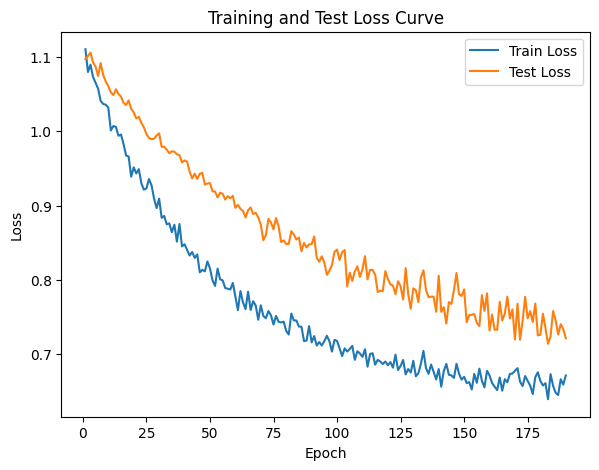

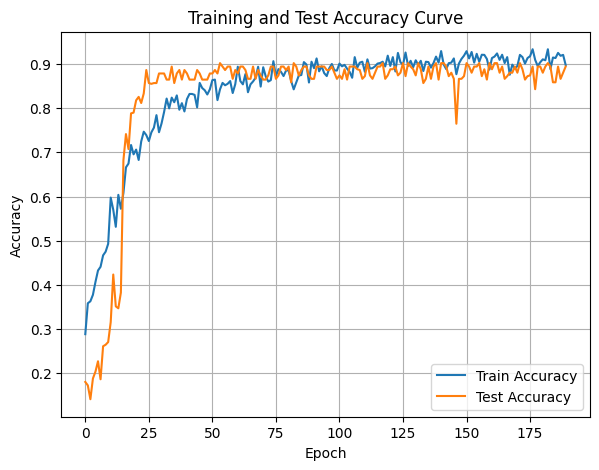

In [77]:
DTEmlp10b.train_single_model()

Randomly initializing 10 models
Training Model with id 1
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.30545217641991834, Train Loss: 1.1452, Train Acc: 0.2307, Test F1:0.08216744392627137, Test Loss: 1.1450, Test Acc: 0.0512


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.99it/s]

Epoch [2/10], Train F1:0.320123857141584, Train Loss: 1.1436, Train Acc: 0.2432, Test F1:0.10418020359540826, Test Loss: 1.1390, Test Acc: 0.0690
Epoch [3/10], Train F1:0.3298636219833616, Train Loss: 1.1378, Train Acc: 0.2508, Test F1:0.10150891632373112, Test Loss: 1.1381, Test Acc: 0.0657


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.96it/s]

Epoch [4/10], Train F1:0.34621314069607534, Train Loss: 1.1356, Train Acc: 0.2647, Test F1:0.10719459198454852, Test Loss: 1.1362, Test Acc: 0.0694


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.96it/s]

Epoch [5/10], Train F1:0.35350957771043273, Train Loss: 1.1344, Train Acc: 0.2714, Test F1:0.09640437727983325, Test Loss: 1.1381, Test Acc: 0.0627


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.07it/s]

Epoch [6/10], Train F1:0.36435138557946267, Train Loss: 1.1301, Train Acc: 0.2827, Test F1:0.10597923379878266, Test Loss: 1.1365, Test Acc: 0.0683


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.07it/s]

Epoch [7/10], Train F1:0.3744760283647364, Train Loss: 1.1272, Train Acc: 0.2909, Test F1:0.11474961233239077, Test Loss: 1.1349, Test Acc: 0.0734


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.88it/s]

Epoch [8/10], Train F1:0.38153935304367276, Train Loss: 1.1233, Train Acc: 0.2970, Test F1:0.11623139791816416, Test Loss: 1.1348, Test Acc: 0.0736


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.88it/s]

Epoch [9/10], Train F1:0.3893242396273179, Train Loss: 1.1205, Train Acc: 0.3051, Test F1:0.12534569749173885, Test Loss: 1.1333, Test Acc: 0.0780


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.09it/s]


Epoch [10/10], Train F1:0.3979088552409393, Train Loss: 1.1167, Train Acc: 0.3134, Test F1:0.1324082910380436, Test Loss: 1.1317, Test Acc: 0.0828
Total Epochs: 10
Train loss start: 1.1359386444091797, Train loss end: 1.0606729984283447
Highest Mean Train Accuracy (over epoch): 0.31339285714285714
Test loss start: 1.149114727973938, Test loss end: 1.1093897819519043
Highest mean Test Accuracy (over epoch): 0.0828125


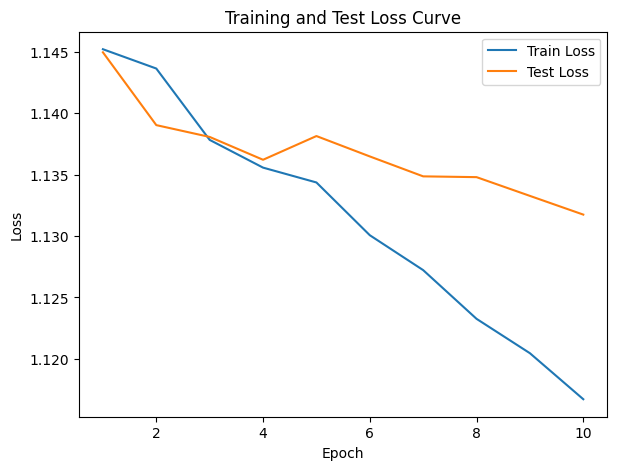

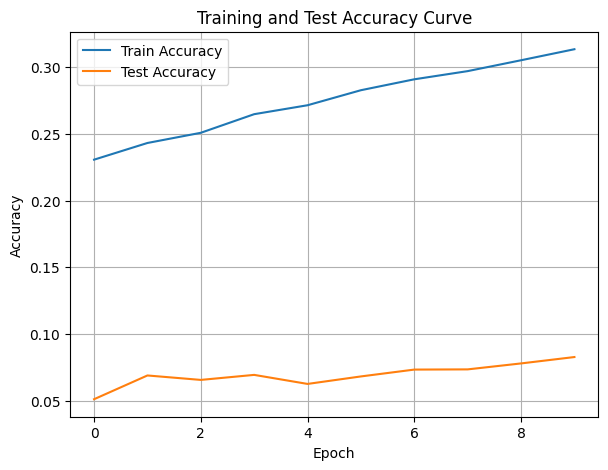

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.17507903760777324, Train Loss: 1.2172, Train Acc: 0.1458, Test F1:0.14888888888888888, Test Loss: 1.1391, Test Acc: 0.1667


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.61it/s]

Epoch [2/10], Train F1:0.16527676436206115, Train Loss: 1.2235, Train Acc: 0.1496, Test F1:0.16178878568971447, Test Loss: 1.1390, Test Acc: 0.1962


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.61it/s]

Epoch [3/10], Train F1:0.1759551157741203, Train Loss: 1.2207, Train Acc: 0.1546, Test F1:0.19450052177656735, Test Loss: 1.1294, Test Acc: 0.2341


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.56it/s]

Epoch [4/10], Train F1:0.18185522855415298, Train Loss: 1.2199, Train Acc: 0.1597, Test F1:0.20092080746143087, Test Loss: 1.1260, Test Acc: 0.2383


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.56it/s]

Epoch [5/10], Train F1:0.18557687563962522, Train Loss: 1.2186, Train Acc: 0.1653, Test F1:0.2162632210292837, Test Loss: 1.1212, Test Acc: 0.2566


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.48it/s]

Epoch [6/10], Train F1:0.188814276509513, Train Loss: 1.2161, Train Acc: 0.1699, Test F1:0.21906783020920878, Test Loss: 1.1193, Test Acc: 0.2642


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.48it/s]

Epoch [7/10], Train F1:0.18757636708482298, Train Loss: 1.2138, Train Acc: 0.1693, Test F1:0.22506735037525907, Test Loss: 1.1173, Test Acc: 0.2705


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.17it/s]

Epoch [8/10], Train F1:0.1964438486668302, Train Loss: 1.2106, Train Acc: 0.1762, Test F1:0.2265580767128755, Test Loss: 1.1166, Test Acc: 0.2744


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.17it/s]

Epoch [9/10], Train F1:0.1994768974682667, Train Loss: 1.2084, Train Acc: 0.1796, Test F1:0.23166871470454053, Test Loss: 1.1145, Test Acc: 0.2840


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.68it/s]


Epoch [10/10], Train F1:0.20437975779073944, Train Loss: 1.2062, Train Acc: 0.1829, Test F1:0.23569394885676506, Test Loss: 1.1130, Test Acc: 0.2918
Total Epochs: 10
Train loss start: 1.23723304271698, Train loss end: 1.2802520990371704
Highest Mean Train Accuracy (over epoch): 0.18291666666666667
Test loss start: 1.1377564668655396, Test loss end: 1.096311330795288
Highest mean Test Accuracy (over epoch): 0.29175347222222225


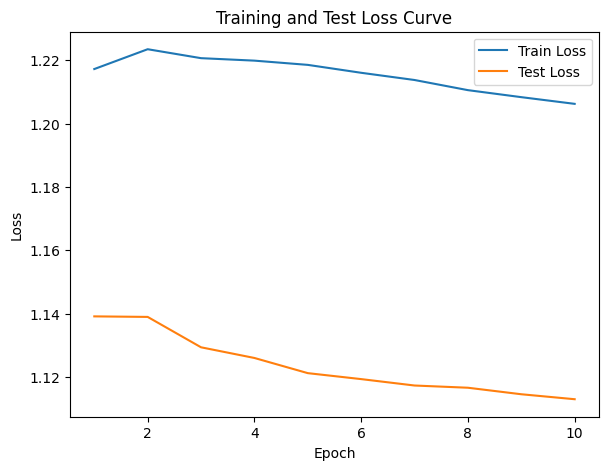

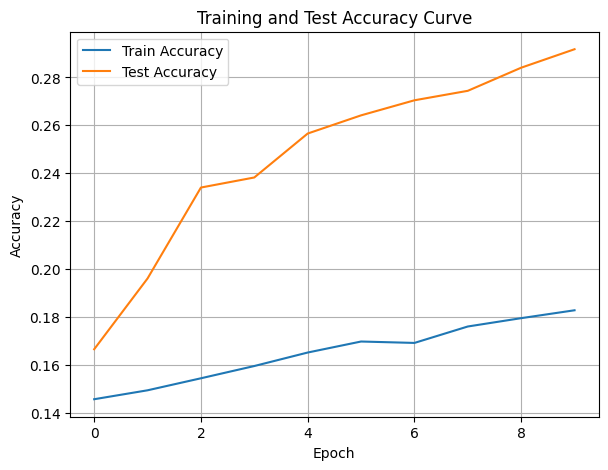

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.44it/s]

Epoch [1/10], Train F1:0.5315729589368403, Train Loss: 1.0527, Train Acc: 0.4818, Test F1:0.742806383046223, Test Loss: 1.0304, Test Acc: 0.7352


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.11it/s]

Epoch [2/10], Train F1:0.5316811695092238, Train Loss: 1.0529, Train Acc: 0.4845, Test F1:0.7359276544068933, Test Loss: 1.0273, Test Acc: 0.7352


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.05it/s]

Epoch [3/10], Train F1:0.5382159924743393, Train Loss: 1.0480, Train Acc: 0.4881, Test F1:0.7407234972205491, Test Loss: 1.0252, Test Acc: 0.7358


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.10it/s]

Epoch [4/10], Train F1:0.554790062030491, Train Loss: 1.0470, Train Acc: 0.5010, Test F1:0.7513788922684994, Test Loss: 1.0220, Test Acc: 0.7470


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.62it/s]

Epoch [5/10], Train F1:0.5548144145115689, Train Loss: 1.0438, Train Acc: 0.5015, Test F1:0.7563458623945664, Test Loss: 1.0189, Test Acc: 0.7536
Epoch [6/10], Train F1:0.5624810199494645, Train Loss: 1.0412, Train Acc: 0.5104, Test F1:0.7663291779055642, Test Loss: 1.0164, Test Acc: 0.7610


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.62it/s]

Epoch [7/10], Train F1:0.5696984252864874, Train Loss: 1.0375, Train Acc: 0.5185, Test F1:0.7713472497210742, Test Loss: 1.0146, Test Acc: 0.7669


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.20it/s]

Epoch [8/10], Train F1:0.5761224936338052, Train Loss: 1.0336, Train Acc: 0.5257, Test F1:0.7714353694055873, Test Loss: 1.0121, Test Acc: 0.7668
Epoch [9/10], Train F1:0.5809151478339012, Train Loss: 1.0314, Train Acc: 0.5298, Test F1:0.7739289472485695, Test Loss: 1.0106, Test Acc: 0.7685


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.66it/s]


Epoch [10/10], Train F1:0.5851001030935961, Train Loss: 1.0275, Train Acc: 0.5348, Test F1:0.7763956932830517, Test Loss: 1.0092, Test Acc: 0.7707
Total Epochs: 10
Train loss start: 1.0735023021697998, Train loss end: 0.9354077577590942
Highest Mean Train Accuracy (over epoch): 0.5347916666666667
Test loss start: 1.0241419076919556, Test loss end: 0.9931048154830933
Highest mean Test Accuracy (over epoch): 0.7706597222222222


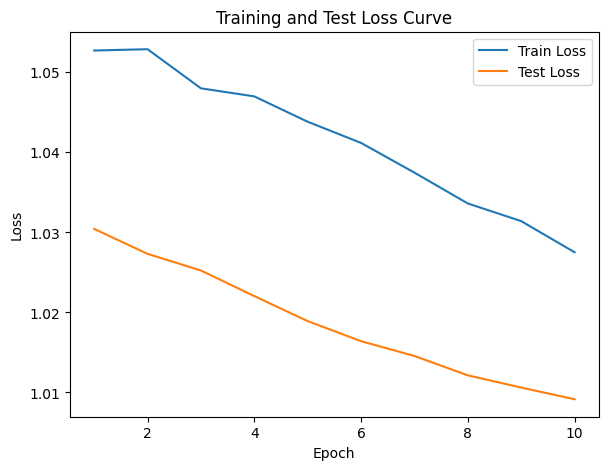

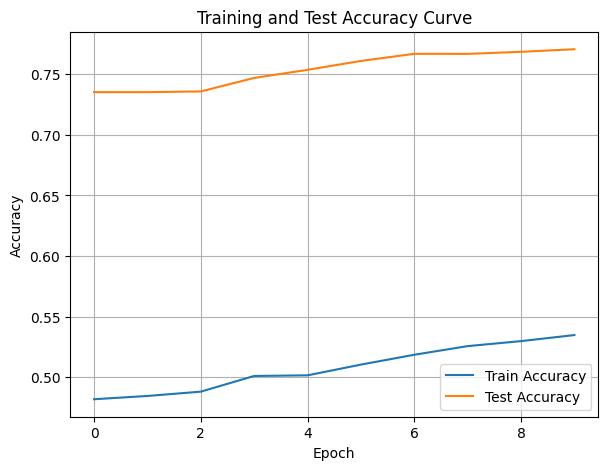

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.47739219512287495, Train Loss: 1.0659, Train Acc: 0.4705, Test F1:0.5446950710108606, Test Loss: 1.0740, Test Acc: 0.5174


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.95it/s]

Epoch [2/10], Train F1:0.4773346819518474, Train Loss: 1.0616, Train Acc: 0.4631, Test F1:0.5236409999885604, Test Loss: 1.0662, Test Acc: 0.5087


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.95it/s]

Epoch [3/10], Train F1:0.4905456920048135, Train Loss: 1.0567, Train Acc: 0.4756, Test F1:0.5115545009436339, Test Loss: 1.0651, Test Acc: 0.5058


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.61it/s]

Epoch [4/10], Train F1:0.4983899148318774, Train Loss: 1.0548, Train Acc: 0.4797, Test F1:0.5377203182977646, Test Loss: 1.0632, Test Acc: 0.5289


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.61it/s]

Epoch [5/10], Train F1:0.509327211218931, Train Loss: 1.0518, Train Acc: 0.4895, Test F1:0.5598771388245073, Test Loss: 1.0610, Test Acc: 0.5514


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.93it/s]

Epoch [6/10], Train F1:0.5123717697325939, Train Loss: 1.0486, Train Acc: 0.4934, Test F1:0.5580657913206561, Test Loss: 1.0590, Test Acc: 0.5537


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.93it/s]

Epoch [7/10], Train F1:0.5211315323404246, Train Loss: 1.0447, Train Acc: 0.5020, Test F1:0.5863856625686621, Test Loss: 1.0563, Test Acc: 0.5794


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.11it/s]

Epoch [8/10], Train F1:0.5313782681664325, Train Loss: 1.0421, Train Acc: 0.5087, Test F1:0.6086334283345343, Test Loss: 1.0542, Test Acc: 0.6006


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.11it/s]

Epoch [9/10], Train F1:0.5374439487751326, Train Loss: 1.0398, Train Acc: 0.5133, Test F1:0.6278417530434279, Test Loss: 1.0518, Test Acc: 0.6195


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.37it/s]


Epoch [10/10], Train F1:0.5418495077413062, Train Loss: 1.0374, Train Acc: 0.5186, Test F1:0.6409236803757824, Test Loss: 1.0497, Test Acc: 0.6319
Total Epochs: 10
Train loss start: 1.0877143144607544, Train loss end: 1.008992075920105
Highest Mean Train Accuracy (over epoch): 0.5186309523809524
Test loss start: 1.086172342300415, Test loss end: 1.0281016826629639
Highest mean Test Accuracy (over epoch): 0.6318576388888889


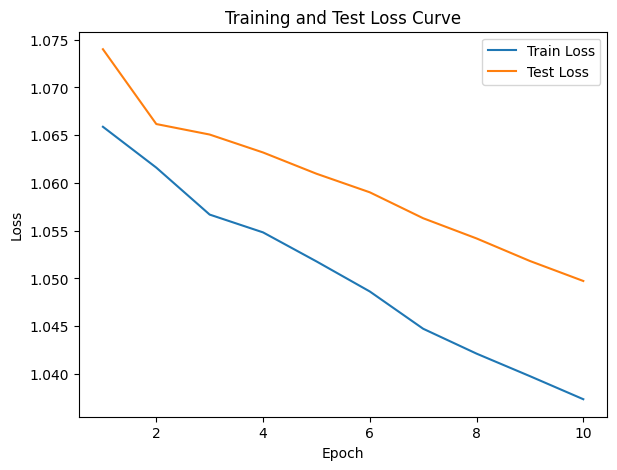

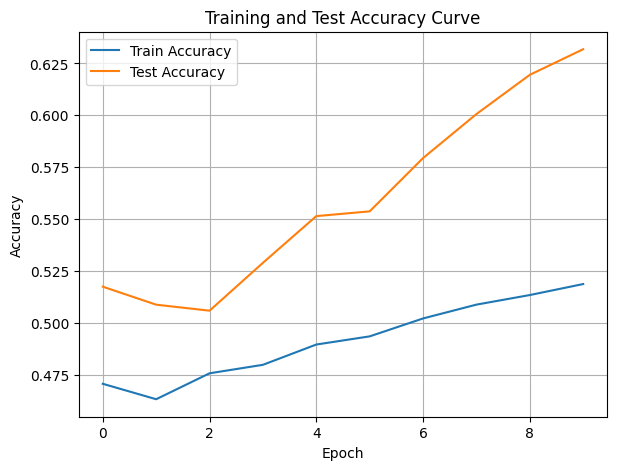

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.80it/s]

Epoch [1/10], Train F1:0.4751250620759762, Train Loss: 1.0718, Train Acc: 0.4485, Test F1:0.5769751460336527, Test Loss: 1.0665, Test Acc: 0.5955
Epoch [2/10], Train F1:0.489918602995733, Train Loss: 1.0686, Train Acc: 0.4504, Test F1:0.5885671748177784, Test Loss: 1.0621, Test Acc: 0.6072


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.80it/s]

Epoch [3/10], Train F1:0.48231757424455196, Train Loss: 1.0688, Train Acc: 0.4418, Test F1:0.6019737367370523, Test Loss: 1.0600, Test Acc: 0.6137


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.97it/s]

Epoch [4/10], Train F1:0.48298540898821773, Train Loss: 1.0682, Train Acc: 0.4420, Test F1:0.6088959773170299, Test Loss: 1.0579, Test Acc: 0.6235


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.97it/s]

Epoch [5/10], Train F1:0.4925528957431252, Train Loss: 1.0635, Train Acc: 0.4548, Test F1:0.6152550188638355, Test Loss: 1.0551, Test Acc: 0.6309


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.18it/s]

Epoch [6/10], Train F1:0.506905255357281, Train Loss: 1.0582, Train Acc: 0.4699, Test F1:0.622362929643106, Test Loss: 1.0514, Test Acc: 0.6398


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.18it/s]

Epoch [7/10], Train F1:0.5142480458638234, Train Loss: 1.0548, Train Acc: 0.4780, Test F1:0.6329546405722042, Test Loss: 1.0475, Test Acc: 0.6505


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.66it/s]

Epoch [8/10], Train F1:0.5207055849822001, Train Loss: 1.0513, Train Acc: 0.4860, Test F1:0.628339351250719, Test Loss: 1.0454, Test Acc: 0.6498


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.04it/s]

Epoch [9/10], Train F1:0.5260702019929582, Train Loss: 1.0496, Train Acc: 0.4915, Test F1:0.6302460146853739, Test Loss: 1.0432, Test Acc: 0.6536


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.69it/s]


Epoch [10/10], Train F1:0.5267176712280617, Train Loss: 1.0469, Train Acc: 0.4957, Test F1:0.6313802011196998, Test Loss: 1.0415, Test Acc: 0.6567
Total Epochs: 10
Train loss start: 1.108111023902893, Train loss end: 0.9610952734947205
Highest Mean Train Accuracy (over epoch): 0.4956845238095239
Test loss start: 1.049787163734436, Test loss end: 1.0403417348861694
Highest mean Test Accuracy (over epoch): 0.6566840277777778


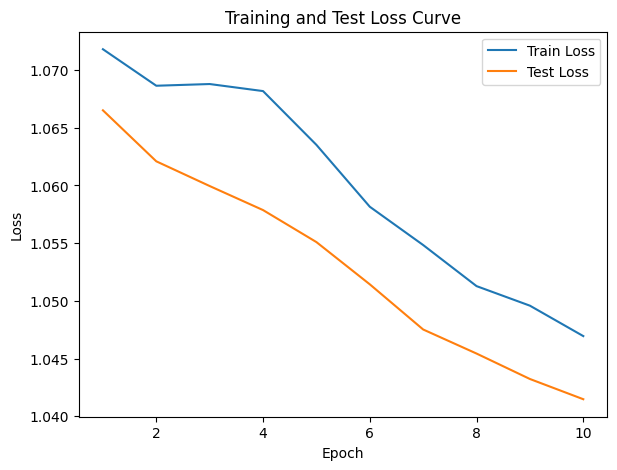

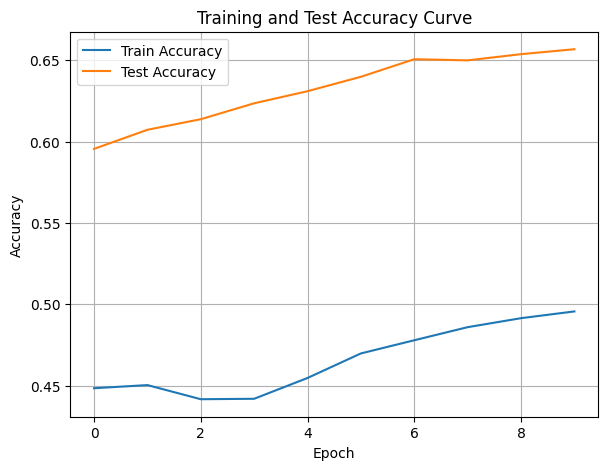

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.95it/s]

Epoch [1/10], Train F1:0.36202458768258977, Train Loss: 1.1176, Train Acc: 0.3182, Test F1:0.48781445138269414, Test Loss: 1.0649, Test Acc: 0.5165


Epoch [2/10], Train F1:0.3577072365030603, Train Loss: 1.1213, Train Acc: 0.3055, Test F1:0.46983097725647116, Test Loss: 1.0630, Test Acc: 0.5056
Epoch [3/10], Train F1:0.37178831114968125, Train Loss: 1.1200, Train Acc: 0.3201, Test F1:0.4817775096767708, Test Loss: 1.0623, Test Acc: 0.5041


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.57it/s]

Epoch [4/10], Train F1:0.3813136853238764, Train Loss: 1.1140, Train Acc: 0.3290, Test F1:0.49423983012980627, Test Loss: 1.0596, Test Acc: 0.5169
Epoch [5/10], Train F1:0.3980719140474086, Train Loss: 1.1067, Train Acc: 0.3443, Test F1:0.5545539724079996, Test Loss: 1.0566, Test Acc: 0.5568
Epoch [6/10], Train F1:0.40775363584086366, Train Loss: 1.1032, Train Acc: 0.3532, Test F1:0.5521852306926448, Test Loss: 1.0548, Test Acc: 0.5592


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.10it/s]

Epoch [7/10], Train F1:0.4111056884458348, Train Loss: 1.1019, Train Acc: 0.3572, Test F1:0.5507643421371538, Test Loss: 1.0536, Test Acc: 0.5609
Epoch [8/10], Train F1:0.4229087698631122, Train Loss: 1.0977, Train Acc: 0.3682, Test F1:0.5502419640686288, Test Loss: 1.0526, Test Acc: 0.5612


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.80it/s]


Epoch [9/10], Train F1:0.433098424709367, Train Loss: 1.0943, Train Acc: 0.3770, Test F1:0.5812682643510441, Test Loss: 1.0500, Test Acc: 0.5860
Epoch [10/10], Train F1:0.4394101235552013, Train Loss: 1.0905, Train Acc: 0.3840, Test F1:0.5980747221046362, Test Loss: 1.0481, Test Acc: 0.5998
Total Epochs: 10
Train loss start: 1.1305277347564697, Train loss end: 1.0029690265655518
Highest Mean Train Accuracy (over epoch): 0.38395833333333335
Test loss start: 1.0669127702713013, Test loss end: 0.9830326437950134
Highest mean Test Accuracy (over epoch): 0.599826388888889


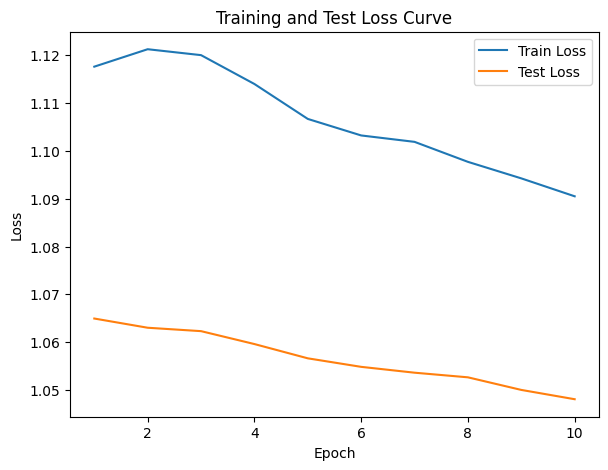

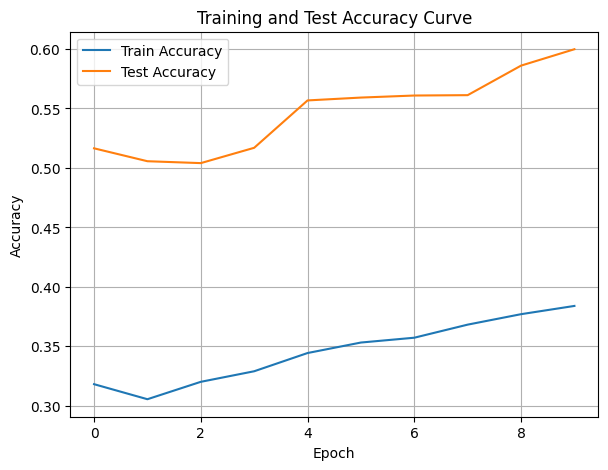

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.346810127555994, Train Loss: 1.1165, Train Acc: 0.3119, Test F1:0.0915339631129105, Test Loss: 1.1492, Test Acc: 0.0998


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.08it/s]

Epoch [2/10], Train F1:0.36652551638582553, Train Loss: 1.1093, Train Acc: 0.3240, Test F1:0.09053195483064662, Test Loss: 1.1482, Test Acc: 0.1146


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.08it/s]

Epoch [3/10], Train F1:0.36319244532712724, Train Loss: 1.1087, Train Acc: 0.3213, Test F1:0.07920780878894972, Test Loss: 1.1524, Test Acc: 0.0940


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.25it/s]

Epoch [4/10], Train F1:0.38047439524654997, Train Loss: 1.1036, Train Acc: 0.3380, Test F1:0.08905409732699057, Test Loss: 1.1489, Test Acc: 0.1087


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.25it/s]

Epoch [5/10], Train F1:0.3883811336999901, Train Loss: 1.1006, Train Acc: 0.3430, Test F1:0.09921751417256638, Test Loss: 1.1440, Test Acc: 0.1297


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.19it/s]

Epoch [6/10], Train F1:0.39425273022855023, Train Loss: 1.0981, Train Acc: 0.3470, Test F1:0.1028258909154821, Test Loss: 1.1437, Test Acc: 0.1359


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.19it/s]

Epoch [7/10], Train F1:0.4065195067805799, Train Loss: 1.0936, Train Acc: 0.3585, Test F1:0.10857786772717505, Test Loss: 1.1427, Test Acc: 0.1425


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.52it/s]

Epoch [8/10], Train F1:0.41247287206877425, Train Loss: 1.0911, Train Acc: 0.3640, Test F1:0.10670405413219655, Test Loss: 1.1427, Test Acc: 0.1418


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.55it/s]

Epoch [9/10], Train F1:0.42321806207327145, Train Loss: 1.0878, Train Acc: 0.3735, Test F1:0.11080274909705931, Test Loss: 1.1414, Test Acc: 0.1496


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.00it/s]


Epoch [10/10], Train F1:0.43721340990235324, Train Loss: 1.0834, Train Acc: 0.3870, Test F1:0.1153150255317438, Test Loss: 1.1398, Test Acc: 0.1558
Total Epochs: 10
Train loss start: 1.1416163444519043, Train loss end: 1.0174049139022827
Highest Mean Train Accuracy (over epoch): 0.3869642857142857
Test loss start: 1.1524347066879272, Test loss end: 1.1258083581924438
Highest mean Test Accuracy (over epoch): 0.15581597222222224


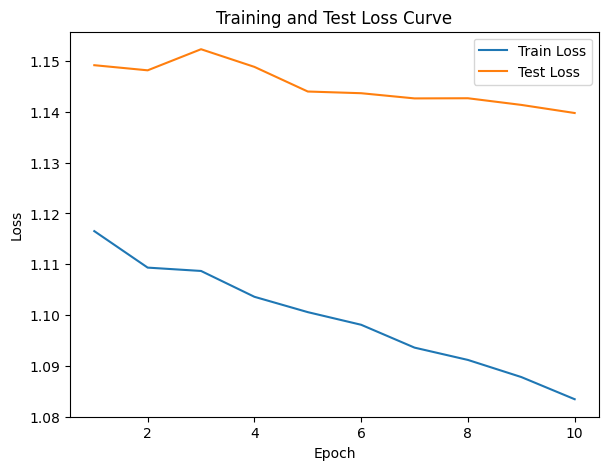

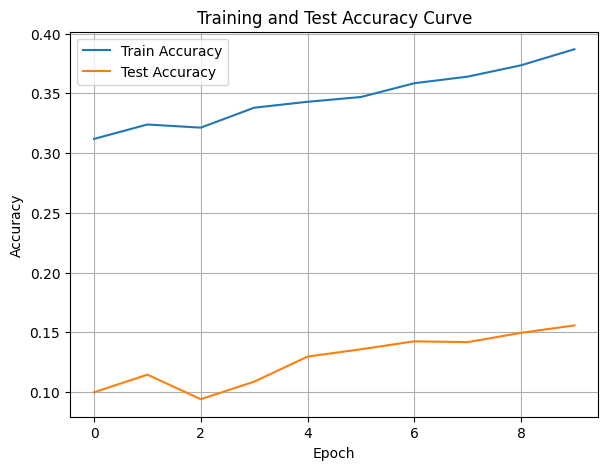

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.80it/s]

Epoch [1/10], Train F1:0.4910928642971698, Train Loss: 1.0385, Train Acc: 0.4464, Test F1:0.410593943397265, Test Loss: 1.0591, Test Acc: 0.4036


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.84it/s]

Epoch [2/10], Train F1:0.49707034148166784, Train Loss: 1.0339, Train Acc: 0.4469, Test F1:0.5537949089459502, Test Loss: 1.0585, Test Acc: 0.5035


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.79it/s]

Epoch [3/10], Train F1:0.5017932117880121, Train Loss: 1.0324, Train Acc: 0.4512, Test F1:0.6015823766039889, Test Loss: 1.0574, Test Acc: 0.5446


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.66it/s]

Epoch [4/10], Train F1:0.5137637989708995, Train Loss: 1.0282, Train Acc: 0.4627, Test F1:0.6234952134434447, Test Loss: 1.0553, Test Acc: 0.5671


Training Process:  50%|█████     | 5/10 [00:00<00:00,  6.95it/s]

Epoch [5/10], Train F1:0.5277719571101072, Train Loss: 1.0224, Train Acc: 0.4782, Test F1:0.6512331402333518, Test Loss: 1.0500, Test Acc: 0.6007


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.02it/s]

Epoch [6/10], Train F1:0.5441633834969491, Train Loss: 1.0158, Train Acc: 0.4990, Test F1:0.6657633743223853, Test Loss: 1.0458, Test Acc: 0.6195


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.62it/s]

Epoch [7/10], Train F1:0.5543374305018329, Train Loss: 1.0115, Train Acc: 0.5104, Test F1:0.6802599867298947, Test Loss: 1.0425, Test Acc: 0.6363


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.23it/s]

Epoch [8/10], Train F1:0.560092968147672, Train Loss: 1.0093, Train Acc: 0.5153, Test F1:0.6866224027891874, Test Loss: 1.0407, Test Acc: 0.6450


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.49it/s]

Epoch [9/10], Train F1:0.5626489017154337, Train Loss: 1.0069, Train Acc: 0.5197, Test F1:0.693709723954414, Test Loss: 1.0399, Test Acc: 0.6521


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.27it/s]


Epoch [10/10], Train F1:0.5665796748029189, Train Loss: 1.0043, Train Acc: 0.5245, Test F1:0.7038287357000808, Test Loss: 1.0368, Test Acc: 0.6631
Total Epochs: 10
Train loss start: 1.0841014385223389, Train loss end: 0.9693606495857239
Highest Mean Train Accuracy (over epoch): 0.5244642857142857
Test loss start: 1.0678255558013916, Test loss end: 1.006882905960083
Highest mean Test Accuracy (over epoch): 0.6631076388888888


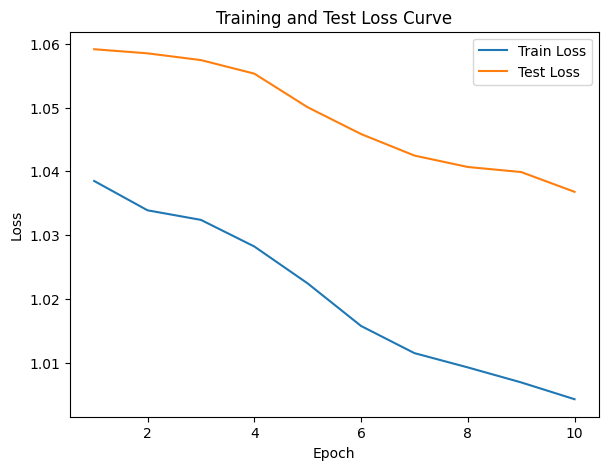

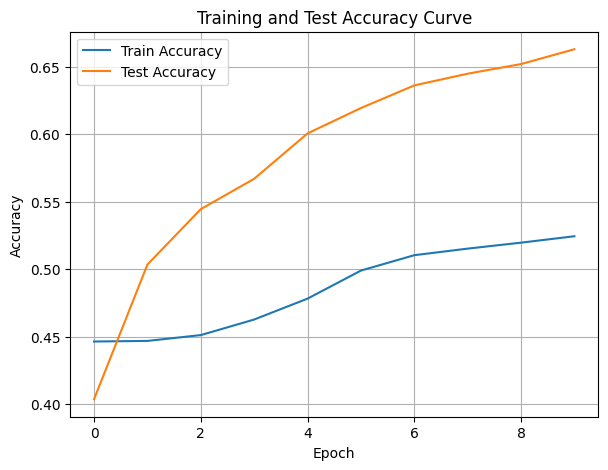

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4057483419914826, Train Loss: 1.1134, Train Acc: 0.3619, Test F1:0.5073275558373845, Test Loss: 1.0612, Test Acc: 0.5608


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.18it/s]

Epoch [2/10], Train F1:0.4238049850546995, Train Loss: 1.1061, Train Acc: 0.3848, Test F1:0.5135731340184783, Test Loss: 1.0511, Test Acc: 0.5725


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.18it/s]

Epoch [3/10], Train F1:0.428596289235198, Train Loss: 1.1029, Train Acc: 0.3897, Test F1:0.5234927735451954, Test Loss: 1.0525, Test Acc: 0.5764


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.13it/s]

Epoch [4/10], Train F1:0.4460193120860755, Train Loss: 1.0979, Train Acc: 0.4051, Test F1:0.5229017419251325, Test Loss: 1.0464, Test Acc: 0.5822


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.13it/s]

Epoch [5/10], Train F1:0.4506896114369622, Train Loss: 1.0961, Train Acc: 0.4060, Test F1:0.5285650022492129, Test Loss: 1.0443, Test Acc: 0.5842


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.29it/s]

Epoch [6/10], Train F1:0.4547334880566653, Train Loss: 1.0923, Train Acc: 0.4138, Test F1:0.5276784475175977, Test Loss: 1.0392, Test Acc: 0.5881


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.29it/s]

Epoch [7/10], Train F1:0.4646823678892862, Train Loss: 1.0884, Train Acc: 0.4242, Test F1:0.5293265464831552, Test Loss: 1.0368, Test Acc: 0.5887


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.14it/s]

Epoch [8/10], Train F1:0.4694257502668174, Train Loss: 1.0849, Train Acc: 0.4295, Test F1:0.5314715359828143, Test Loss: 1.0333, Test Acc: 0.5957


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.93it/s]

Epoch [9/10], Train F1:0.48121094179843427, Train Loss: 1.0806, Train Acc: 0.4413, Test F1:0.5358328947812219, Test Loss: 1.0309, Test Acc: 0.5986


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.53it/s]


Epoch [10/10], Train F1:0.4851043773834679, Train Loss: 1.0772, Train Acc: 0.4454, Test F1:0.5378806891272265, Test Loss: 1.0288, Test Acc: 0.5995
Total Epochs: 10
Train loss start: 1.0924187898635864, Train loss end: 1.0777742862701416
Highest Mean Train Accuracy (over epoch): 0.4454464285714285
Test loss start: 1.0618107318878174, Test loss end: 1.0172722339630127
Highest mean Test Accuracy (over epoch): 0.5994791666666666


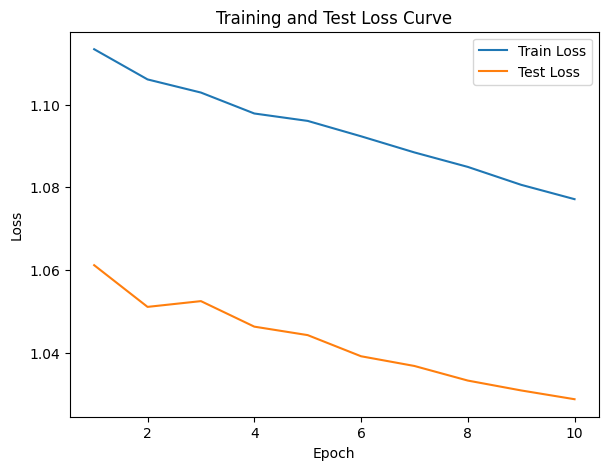

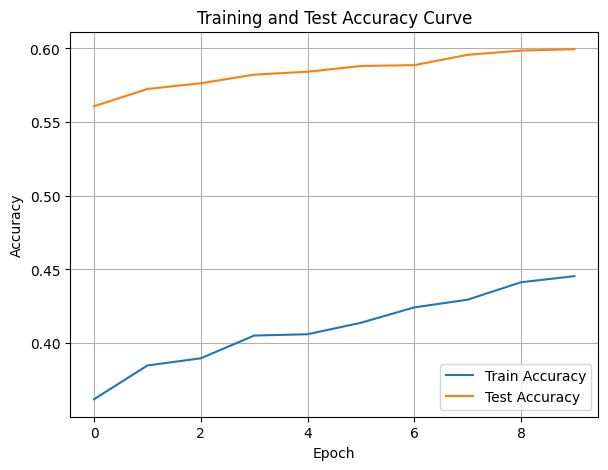

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.36it/s]

Epoch [1/10], Train F1:0.23091465811838396, Train Loss: 1.0965, Train Acc: 0.3765, Test F1:0.1822738664843928, Test Loss: 1.1042, Test Acc: 0.3490


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.31it/s]

Epoch [2/10], Train F1:0.22365722365722365, Train Loss: 1.0976, Train Acc: 0.3676, Test F1:0.1805817475284302, Test Loss: 1.1118, Test Acc: 0.3451


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.30it/s]

Epoch [3/10], Train F1:0.2204591478815998, Train Loss: 1.0952, Train Acc: 0.3653, Test F1:0.18001525553012968, Test Loss: 1.1133, Test Acc: 0.3438


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.17it/s]

Epoch [4/10], Train F1:0.22028838141087226, Train Loss: 1.0930, Train Acc: 0.3655, Test F1:0.1805817475284302, Test Loss: 1.1135, Test Acc: 0.3451


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.31it/s]

Epoch [5/10], Train F1:0.2196987895567428, Train Loss: 1.0922, Train Acc: 0.3645, Test F1:0.18092105263157895, Test Loss: 1.1132, Test Acc: 0.3458


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.75it/s]

Epoch [6/10], Train F1:0.21963145117813324, Train Loss: 1.0905, Train Acc: 0.3655, Test F1:0.18114701069376263, Test Loss: 1.1128, Test Acc: 0.3464


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.74it/s]

Epoch [7/10], Train F1:0.2179418703209617, Train Loss: 1.0884, Train Acc: 0.3628, Test F1:0.1813082893106372, Test Loss: 1.1109, Test Acc: 0.3467


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.92it/s]

Epoch [8/10], Train F1:0.21829537269764682, Train Loss: 1.0862, Train Acc: 0.3635, Test F1:0.18142918271287972, Test Loss: 1.1096, Test Acc: 0.3470


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.12it/s]

Epoch [9/10], Train F1:0.2177206544073696, Train Loss: 1.0825, Train Acc: 0.3654, Test F1:0.1815231720920799, Test Loss: 1.1077, Test Acc: 0.3472


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.32it/s]


Epoch [10/10], Train F1:0.22064945824067547, Train Loss: 1.0791, Train Acc: 0.3684, Test F1:0.18159833915086807, Test Loss: 1.1059, Test Acc: 0.3474
Total Epochs: 10
Train loss start: 1.0969699621200562, Train loss end: 1.0041676759719849
Highest Mean Train Accuracy (over epoch): 0.37648809523809523
Test loss start: 1.1162605285644531, Test loss end: 1.080879807472229
Highest mean Test Accuracy (over epoch): 0.3489583333333333


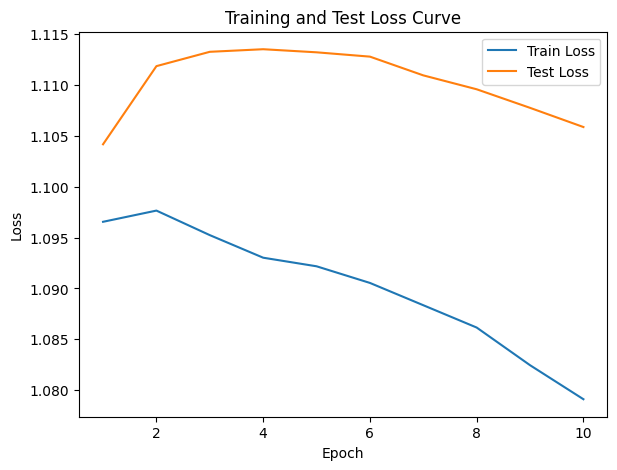

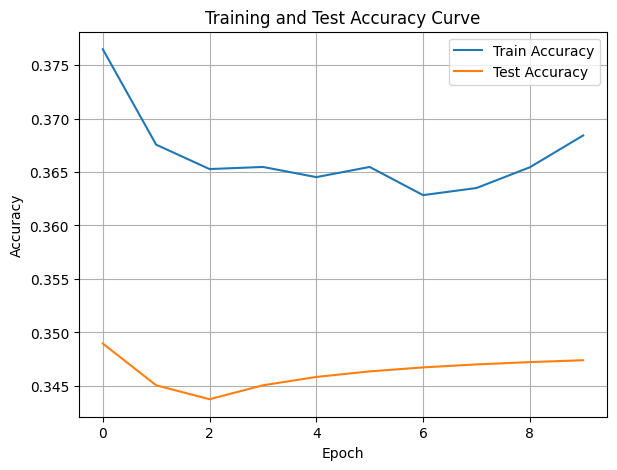

./saved_models/model_10.pth
Training Model with id 14
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.25it/s]

Epoch [1/10], Train F1:0.2534593186784264, Train Loss: 1.0482, Train Acc: 0.4027, Test F1:0.1822738664843928, Test Loss: 1.0877, Test Acc: 0.3490
Epoch [2/10], Train F1:0.257993529556766, Train Loss: 1.0448, Train Acc: 0.3979, Test F1:0.1822738664843928, Test Loss: 1.0885, Test Acc: 0.3490
Epoch [3/10], Train F1:0.26231578936181266, Train Loss: 1.0433, Train Acc: 0.3952, Test F1:0.18227386648439278, Test Loss: 1.0851, Test Acc: 0.3490


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.29it/s]

Epoch [4/10], Train F1:0.26928963501467745, Train Loss: 1.0371, Train Acc: 0.3989, Test F1:0.1822738664843928, Test Loss: 1.0827, Test Acc: 0.3490
Epoch [5/10], Train F1:0.2652157160751037, Train Loss: 1.0369, Train Acc: 0.3961, Test F1:0.18227386648439278, Test Loss: 1.0809, Test Acc: 0.3490
Epoch [6/10], Train F1:0.2699689587167853, Train Loss: 1.0356, Train Acc: 0.3984, Test F1:0.18227386648439278, Test Loss: 1.0796, Test Acc: 0.3490


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.62it/s]

Epoch [7/10], Train F1:0.27345815982765664, Train Loss: 1.0333, Train Acc: 0.4003, Test F1:0.18227386648439278, Test Loss: 1.0781, Test Acc: 0.3490
Epoch [8/10], Train F1:0.2780677307682751, Train Loss: 1.0310, Train Acc: 0.4028, Test F1:0.1822738664843928, Test Loss: 1.0756, Test Acc: 0.3490


Training Process: 100%|██████████| 10/10 [00:00<00:00, 11.33it/s]


Epoch [9/10], Train F1:0.28333473848171253, Train Loss: 1.0281, Train Acc: 0.4068, Test F1:0.18227386648439278, Test Loss: 1.0736, Test Acc: 0.3490
Epoch [10/10], Train F1:0.2887380192896968, Train Loss: 1.0261, Train Acc: 0.4091, Test F1:0.18227386648439278, Test Loss: 1.0719, Test Acc: 0.3490
Total Epochs: 10
Train loss start: 1.0141451358795166, Train loss end: 1.107901692390442
Highest Mean Train Accuracy (over epoch): 0.4091071428571429
Test loss start: 1.1024850606918335, Test loss end: 1.0476527214050293
Highest mean Test Accuracy (over epoch): 0.34895833333333337


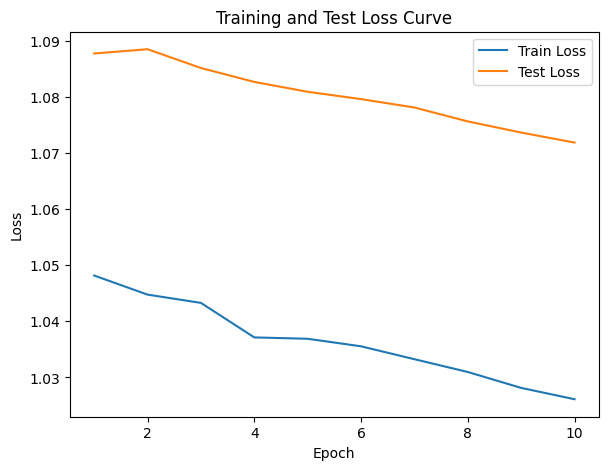

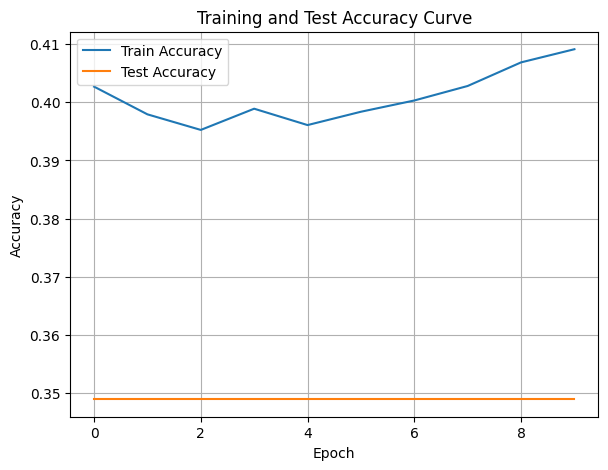

./saved_models/model_14.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.35752685667046946, Train Loss: 0.9996, Train Acc: 0.4506, Test F1:0.1822738664843928, Test Loss: 1.0491, Test Acc: 0.3490


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.77it/s]

Epoch [2/10], Train F1:0.3690048263565997, Train Loss: 0.9981, Train Acc: 0.4478, Test F1:0.1822738664843928, Test Loss: 1.0476, Test Acc: 0.3490


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.77it/s]

Epoch [3/10], Train F1:0.37797700388783195, Train Loss: 0.9968, Train Acc: 0.4482, Test F1:0.18227386648439278, Test Loss: 1.0473, Test Acc: 0.3490


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.67it/s]

Epoch [4/10], Train F1:0.3893728436725356, Train Loss: 0.9901, Train Acc: 0.4587, Test F1:0.1822738664843928, Test Loss: 1.0449, Test Acc: 0.3490


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.67it/s]

Epoch [5/10], Train F1:0.40256122628244917, Train Loss: 0.9885, Train Acc: 0.4639, Test F1:0.18227386648439278, Test Loss: 1.0431, Test Acc: 0.3490


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.44it/s]

Epoch [6/10], Train F1:0.41101543177501315, Train Loss: 0.9869, Train Acc: 0.4679, Test F1:0.18227386648439278, Test Loss: 1.0411, Test Acc: 0.3490


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.44it/s]

Epoch [7/10], Train F1:0.4178301033935902, Train Loss: 0.9844, Train Acc: 0.4733, Test F1:0.18494454533616153, Test Loss: 1.0397, Test Acc: 0.3501


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.13it/s]

Epoch [8/10], Train F1:0.42945993154607504, Train Loss: 0.9817, Train Acc: 0.4800, Test F1:0.18694144410875266, Test Loss: 1.0378, Test Acc: 0.3509


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.59it/s]

Epoch [9/10], Train F1:0.4372815809798712, Train Loss: 0.9789, Train Acc: 0.4860, Test F1:0.18642423094182792, Test Loss: 1.0370, Test Acc: 0.3507


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.98it/s]


Epoch [10/10], Train F1:0.446571629098065, Train Loss: 0.9760, Train Acc: 0.4921, Test F1:0.18787154542819312, Test Loss: 1.0353, Test Acc: 0.3513
Total Epochs: 10
Train loss start: 0.9905741810798645, Train loss end: 0.9368311166763306
Highest Mean Train Accuracy (over epoch): 0.4921428571428571
Test loss start: 1.0612308979034424, Test loss end: 1.013256549835205
Highest mean Test Accuracy (over epoch): 0.3513020833333333


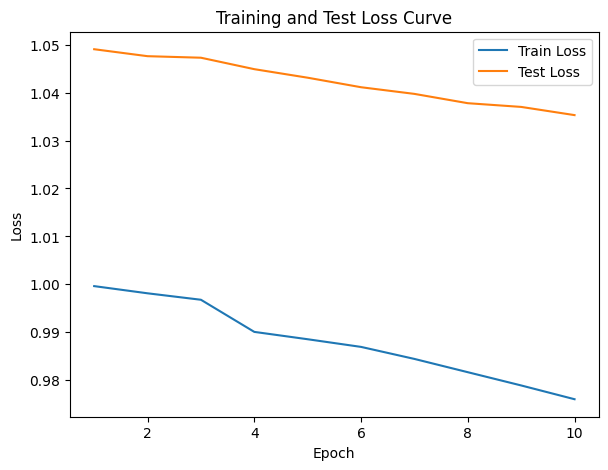

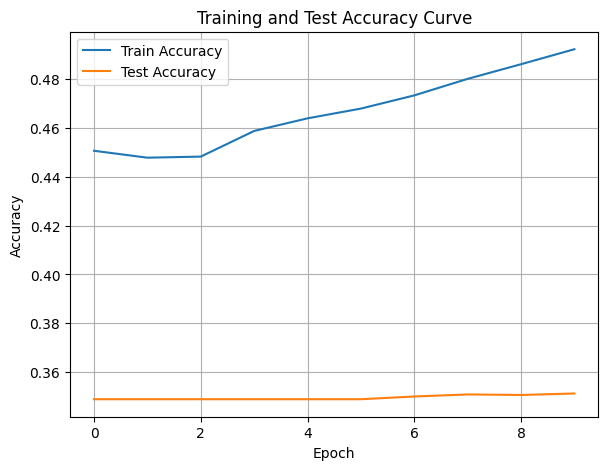

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.50it/s]

Epoch [1/10], Train F1:0.547100449965335, Train Loss: 0.9478, Train Acc: 0.5652, Test F1:0.2007751404655429, Test Loss: 1.0095, Test Acc: 0.3568


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.31it/s]

Epoch [2/10], Train F1:0.540969581072944, Train Loss: 0.9475, Train Acc: 0.5594, Test F1:0.2007751404655429, Test Loss: 1.0077, Test Acc: 0.3568


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.02it/s]

Epoch [3/10], Train F1:0.5535699823240158, Train Loss: 0.9449, Train Acc: 0.5679, Test F1:0.20077514046554293, Test Loss: 1.0060, Test Acc: 0.3568


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.52it/s]

Epoch [4/10], Train F1:0.5653080823454588, Train Loss: 0.9412, Train Acc: 0.5768, Test F1:0.20533101108116084, Test Loss: 1.0051, Test Acc: 0.3587


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.72it/s]

Epoch [5/10], Train F1:0.5888241469731822, Train Loss: 0.9353, Train Acc: 0.5976, Test F1:0.22239767355895573, Test Loss: 1.0020, Test Acc: 0.3686


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.30it/s]

Epoch [6/10], Train F1:0.5946710196870381, Train Loss: 0.9339, Train Acc: 0.6023, Test F1:0.22476244356271938, Test Loss: 0.9990, Test Acc: 0.3692


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.30it/s]

Epoch [7/10], Train F1:0.6084843107490697, Train Loss: 0.9280, Train Acc: 0.6155, Test F1:0.2414410460013952, Test Loss: 0.9966, Test Acc: 0.3790


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.24it/s]

Epoch [8/10], Train F1:0.6216975351511671, Train Loss: 0.9246, Train Acc: 0.6252, Test F1:0.24082223301253344, Test Loss: 0.9956, Test Acc: 0.3781


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  9.42it/s]

Epoch [9/10], Train F1:0.6299917365181122, Train Loss: 0.9208, Train Acc: 0.6328, Test F1:0.25323501489082223, Test Loss: 0.9936, Test Acc: 0.3847


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.12it/s]


Epoch [10/10], Train F1:0.6367913472024415, Train Loss: 0.9188, Train Acc: 0.6386, Test F1:0.2667741489964401, Test Loss: 0.9915, Test Acc: 0.3918
Total Epochs: 10
Train loss start: 0.8991077542304993, Train loss end: 0.8691607117652893
Highest Mean Train Accuracy (over epoch): 0.6386309523809524
Test loss start: 1.020517349243164, Test loss end: 0.9621824622154236
Highest mean Test Accuracy (over epoch): 0.39175347222222223


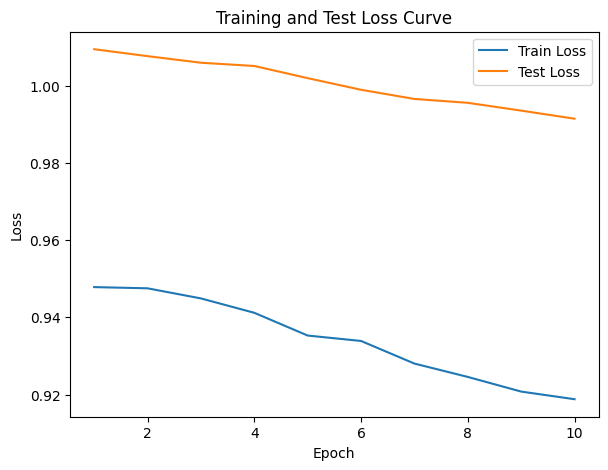

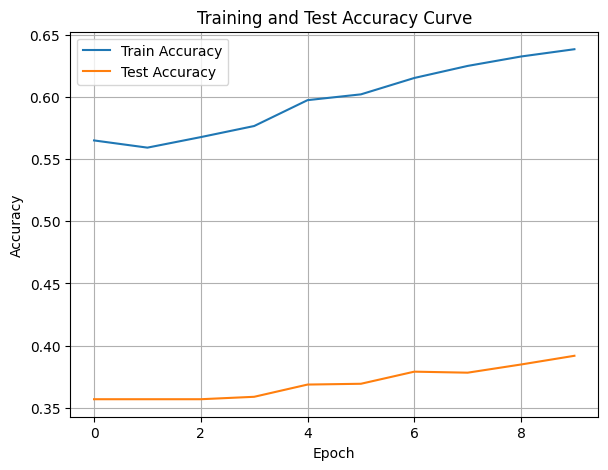

./saved_models/model_15.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.97it/s]

Epoch [1/10], Train F1:0.7304686704306668, Train Loss: 0.8723, Train Acc: 0.7342, Test F1:0.3930699823660398, Test Loss: 0.9741, Test Acc: 0.4748
Epoch [2/10], Train F1:0.7294935305065618, Train Loss: 0.8846, Train Acc: 0.7220, Test F1:0.3901725844861263, Test Loss: 0.9699, Test Acc: 0.4679


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.97it/s]

Epoch [3/10], Train F1:0.7341162828281876, Train Loss: 0.8838, Train Acc: 0.7278, Test F1:0.4540023894862604, Test Loss: 0.9649, Test Acc: 0.5101


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.69it/s]

Epoch [4/10], Train F1:0.7324551130088247, Train Loss: 0.8823, Train Acc: 0.7265, Test F1:0.457185406327699, Test Loss: 0.9646, Test Acc: 0.5111
Epoch [5/10], Train F1:0.7422933642001803, Train Loss: 0.8772, Train Acc: 0.7376, Test F1:0.5006480245883583, Test Loss: 0.9614, Test Acc: 0.5391


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.67it/s]

Epoch [6/10], Train F1:0.7455118859421841, Train Loss: 0.8749, Train Acc: 0.7407, Test F1:0.5137230964007957, Test Loss: 0.9590, Test Acc: 0.5496
Epoch [7/10], Train F1:0.7504279404392673, Train Loss: 0.8734, Train Acc: 0.7452, Test F1:0.525543146586757, Test Loss: 0.9574, Test Acc: 0.5594
Epoch [8/10], Train F1:0.7529871092259914, Train Loss: 0.8720, Train Acc: 0.7476, Test F1:0.5485315561368259, Test Loss: 0.9550, Test Acc: 0.5755


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.56it/s]


Epoch [9/10], Train F1:0.7578657926082633, Train Loss: 0.8693, Train Acc: 0.7539, Test F1:0.5908658466860125, Test Loss: 0.9526, Test Acc: 0.6068
Epoch [10/10], Train F1:0.7624426430935962, Train Loss: 0.8672, Train Acc: 0.7588, Test F1:0.6173415013824644, Test Loss: 0.9504, Test Acc: 0.6273
Total Epochs: 10
Train loss start: 0.9065067768096924, Train loss end: 0.8099664449691772
Highest Mean Train Accuracy (over epoch): 0.7588095238095238
Test loss start: 0.9786190390586853, Test loss end: 0.9215096235275269
Highest mean Test Accuracy (over epoch): 0.6272569444444445


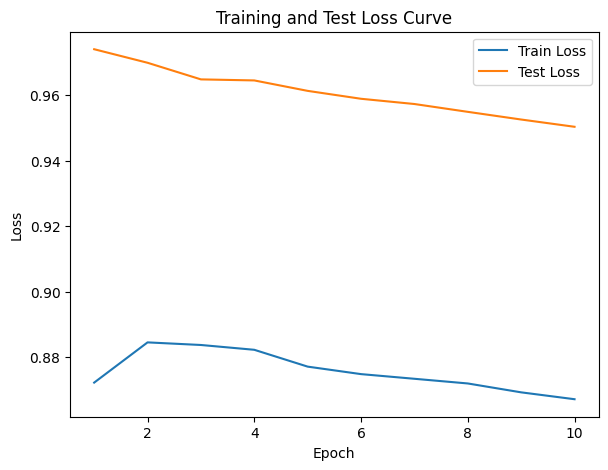

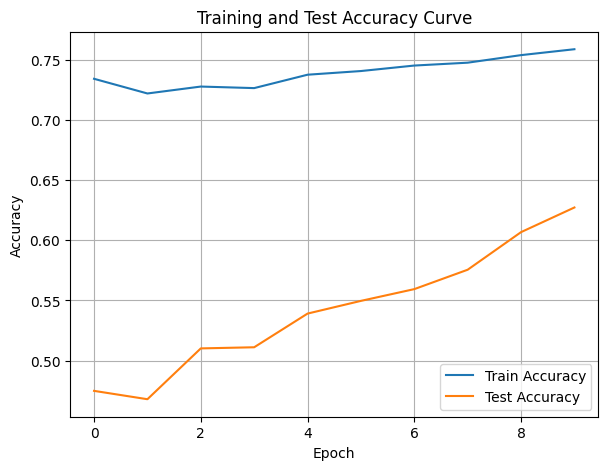

./saved_models/model_13.pth
Training Model with id 15
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7856905439405132, Train Loss: 0.8477, Train Acc: 0.7863, Test F1:0.7245222236733273, Test Loss: 0.9302, Test Acc: 0.7196


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.69it/s]

Epoch [2/10], Train F1:0.8135566847949444, Train Loss: 0.8333, Train Acc: 0.8171, Test F1:0.7974787829180509, Test Loss: 0.9228, Test Acc: 0.7951


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.69it/s]

Epoch [3/10], Train F1:0.8197786832467202, Train Loss: 0.8352, Train Acc: 0.8221, Test F1:0.8232801947269471, Test Loss: 0.9200, Test Acc: 0.8229


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.20it/s]

Epoch [4/10], Train F1:0.8261455306477501, Train Loss: 0.8322, Train Acc: 0.8278, Test F1:0.836091013801047, Test Loss: 0.9188, Test Acc: 0.8368


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.20it/s]

Epoch [5/10], Train F1:0.8355855311061472, Train Loss: 0.8284, Train Acc: 0.8365, Test F1:0.8424578584860775, Test Loss: 0.9184, Test Acc: 0.8436


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.82it/s]

Epoch [6/10], Train F1:0.8342377787421689, Train Loss: 0.8269, Train Acc: 0.8351, Test F1:0.8447255701903136, Test Loss: 0.9177, Test Acc: 0.8458


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.03it/s]

Epoch [7/10], Train F1:0.8379268354284908, Train Loss: 0.8240, Train Acc: 0.8386, Test F1:0.8503014672467342, Test Loss: 0.9162, Test Acc: 0.8516


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.95it/s]

Epoch [8/10], Train F1:0.8395893747853473, Train Loss: 0.8214, Train Acc: 0.8401, Test F1:0.8552965694360871, Test Loss: 0.9140, Test Acc: 0.8576


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.19it/s]


Epoch [9/10], Train F1:0.838582685615636, Train Loss: 0.8206, Train Acc: 0.8384, Test F1:0.859073305156883, Test Loss: 0.9123, Test Acc: 0.8617
Epoch [10/10], Train F1:0.8400412258649019, Train Loss: 0.8185, Train Acc: 0.8406, Test F1:0.8602084083294764, Test Loss: 0.9106, Test Acc: 0.8634
Total Epochs: 10
Train loss start: 0.8201486468315125, Train loss end: 0.7469552159309387
Highest Mean Train Accuracy (over epoch): 0.8405952380952381
Test loss start: 0.9305715560913086, Test loss end: 0.8831924796104431
Highest mean Test Accuracy (over epoch): 0.8633680555555555


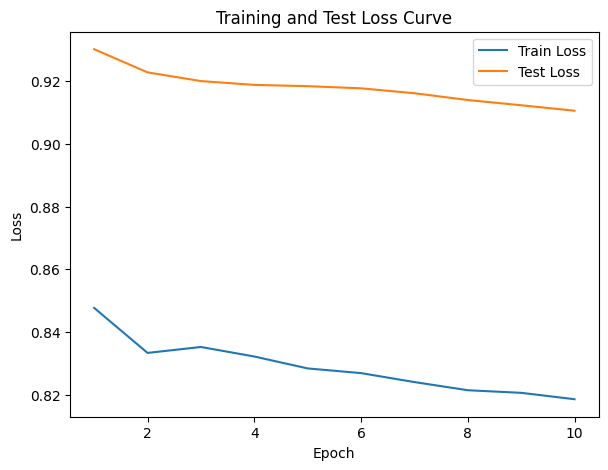

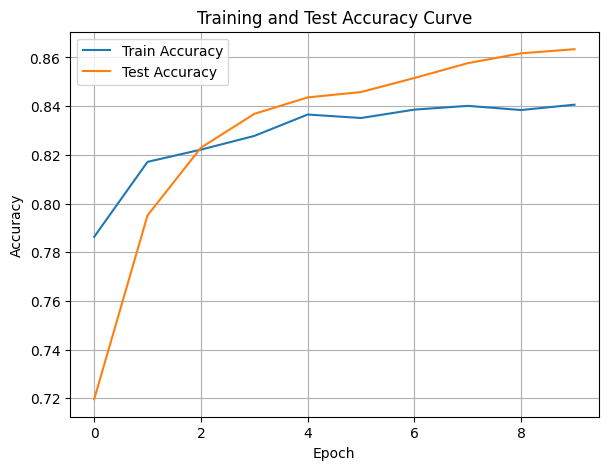

./saved_models/model_15.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.77it/s]

Epoch [1/10], Train F1:0.8551070992714088, Train Loss: 0.7804, Train Acc: 0.8625, Test F1:0.8795057078126853, Test Loss: 0.8933, Test Acc: 0.8863


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.78it/s]

Epoch [2/10], Train F1:0.8745044625990257, Train Loss: 0.7813, Train Acc: 0.8775, Test F1:0.8808197688643266, Test Loss: 0.8895, Test Acc: 0.8863
Epoch [3/10], Train F1:0.8709122632028486, Train Loss: 0.7823, Train Acc: 0.8728, Test F1:0.8840767076061193, Test Loss: 0.8860, Test Acc: 0.8889


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.78it/s]

Epoch [4/10], Train F1:0.8766687224867946, Train Loss: 0.7804, Train Acc: 0.8778, Test F1:0.8835621643417008, Test Loss: 0.8846, Test Acc: 0.8882


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.41it/s]

Epoch [5/10], Train F1:0.8755938735820392, Train Loss: 0.7811, Train Acc: 0.8751, Test F1:0.8808197688643266, Test Loss: 0.8807, Test Acc: 0.8863


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.28it/s]

Epoch [6/10], Train F1:0.8727727355978265, Train Loss: 0.7835, Train Acc: 0.8724, Test F1:0.8810260946483857, Test Loss: 0.8784, Test Acc: 0.8863


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.46it/s]

Epoch [7/10], Train F1:0.8733710251773542, Train Loss: 0.7830, Train Acc: 0.8729, Test F1:0.8836122896066058, Test Loss: 0.8768, Test Acc: 0.8894


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.46it/s]

Epoch [8/10], Train F1:0.874861612926722, Train Loss: 0.7821, Train Acc: 0.8725, Test F1:0.881888199655082, Test Loss: 0.8747, Test Acc: 0.8880


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.82it/s]

Epoch [9/10], Train F1:0.8749878991728761, Train Loss: 0.7816, Train Acc: 0.8729, Test F1:0.8828570377726286, Test Loss: 0.8742, Test Acc: 0.8894


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.63it/s]


Epoch [10/10], Train F1:0.8752194740262725, Train Loss: 0.7800, Train Acc: 0.8741, Test F1:0.8825297437821502, Test Loss: 0.8729, Test Acc: 0.8891
Total Epochs: 10
Train loss start: 0.8030490279197693, Train loss end: 0.664093554019928
Highest Mean Train Accuracy (over epoch): 0.8777529761904762
Test loss start: 0.889289915561676, Test loss end: 0.8472137451171875
Highest mean Test Accuracy (over epoch): 0.8893849206349206


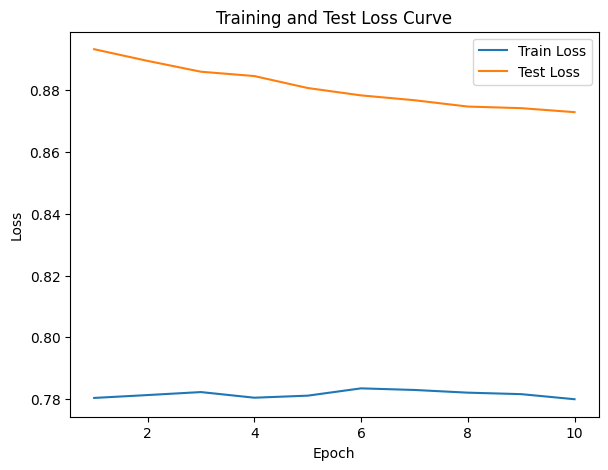

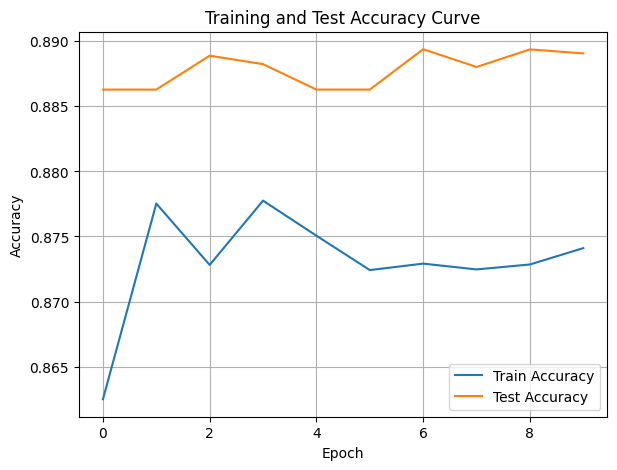

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8493999267918473, Train Loss: 0.7847, Train Acc: 0.8286, Test F1:0.8991551890390455, Test Loss: 0.8546, Test Acc: 0.9080


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.94it/s]

Epoch [2/10], Train F1:0.862590120824706, Train Loss: 0.7736, Train Acc: 0.8448, Test F1:0.8942916520645137, Test Loss: 0.8525, Test Acc: 0.9041


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.20it/s]

Epoch [3/10], Train F1:0.867761460363561, Train Loss: 0.7675, Train Acc: 0.8583, Test F1:0.8930433823141393, Test Loss: 0.8529, Test Acc: 0.9008


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.20it/s]

Epoch [4/10], Train F1:0.8668280121387384, Train Loss: 0.7660, Train Acc: 0.8564, Test F1:0.8921374364983388, Test Loss: 0.8495, Test Acc: 0.9006


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.96it/s]

Epoch [5/10], Train F1:0.8683144433629165, Train Loss: 0.7650, Train Acc: 0.8599, Test F1:0.8915920251554551, Test Loss: 0.8476, Test Acc: 0.9005


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.96it/s]

Epoch [6/10], Train F1:0.8694657978303625, Train Loss: 0.7643, Train Acc: 0.8625, Test F1:0.8912276419794272, Test Loss: 0.8465, Test Acc: 0.9005


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.91it/s]

Epoch [7/10], Train F1:0.8693784770457178, Train Loss: 0.7625, Train Acc: 0.8636, Test F1:0.8881669047478888, Test Loss: 0.8445, Test Acc: 0.8973


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.80it/s]

Epoch [8/10], Train F1:0.8684926619870039, Train Loss: 0.7597, Train Acc: 0.8635, Test F1:0.8858615154860252, Test Loss: 0.8429, Test Acc: 0.8950


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.50it/s]

Epoch [9/10], Train F1:0.8664476881564044, Train Loss: 0.7590, Train Acc: 0.8632, Test F1:0.8851593411349478, Test Loss: 0.8413, Test Acc: 0.8940


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.87it/s]


Epoch [10/10], Train F1:0.8680008276980206, Train Loss: 0.7578, Train Acc: 0.8651, Test F1:0.8855835577364967, Test Loss: 0.8395, Test Acc: 0.8946
Total Epochs: 10
Train loss start: 0.7688318490982056, Train loss end: 0.7750310897827148
Highest Mean Train Accuracy (over epoch): 0.8650892857142858
Test loss start: 0.8497703671455383, Test loss end: 0.8100777268409729
Highest mean Test Accuracy (over epoch): 0.9079861111111112


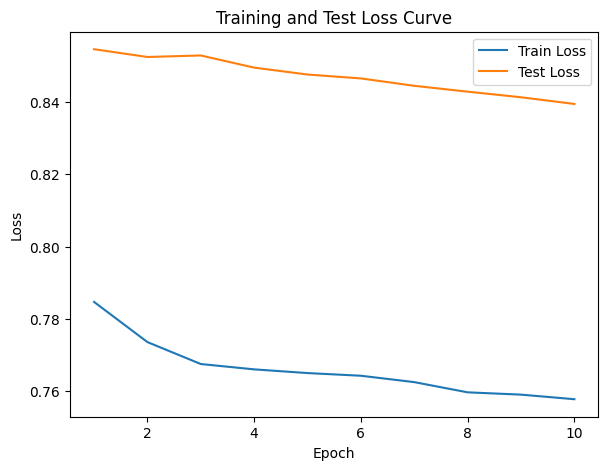

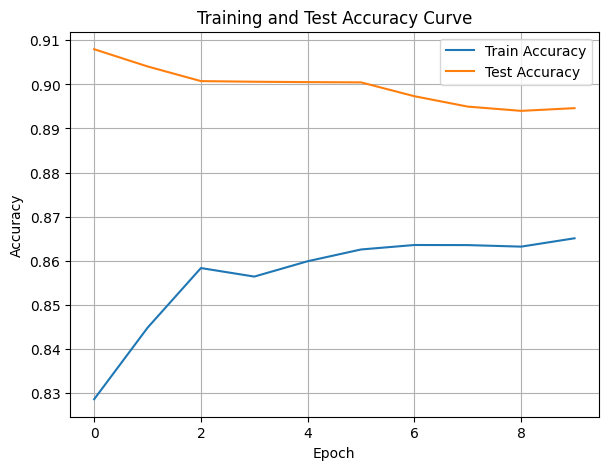

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.80it/s]

Epoch [1/10], Train F1:0.848958618282229, Train Loss: 0.7516, Train Acc: 0.8435, Test F1:0.8893962848297212, Test Loss: 0.8260, Test Acc: 0.9002


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.80it/s]

Epoch [2/10], Train F1:0.8666267089324039, Train Loss: 0.7448, Train Acc: 0.8601, Test F1:0.8893962848297212, Test Loss: 0.8231, Test Acc: 0.9002


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.91it/s]

Epoch [3/10], Train F1:0.8755500075106537, Train Loss: 0.7416, Train Acc: 0.8685, Test F1:0.8893962848297212, Test Loss: 0.8199, Test Acc: 0.9002


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.75it/s]

Epoch [4/10], Train F1:0.8744547959330256, Train Loss: 0.7377, Train Acc: 0.8711, Test F1:0.8844680062912561, Test Loss: 0.8162, Test Acc: 0.8947


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.40it/s]

Epoch [5/10], Train F1:0.8794450331892604, Train Loss: 0.7359, Train Acc: 0.8752, Test F1:0.8814947817304455, Test Loss: 0.8123, Test Acc: 0.8915


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.44it/s]

Epoch [6/10], Train F1:0.8769369363559522, Train Loss: 0.7386, Train Acc: 0.8723, Test F1:0.8795057078126854, Test Loss: 0.8123, Test Acc: 0.8893


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.44it/s]

Epoch [7/10], Train F1:0.8789847902382186, Train Loss: 0.7395, Train Acc: 0.8728, Test F1:0.8809270445680734, Test Loss: 0.8119, Test Acc: 0.8909


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.25it/s]

Epoch [8/10], Train F1:0.8780771992636736, Train Loss: 0.7390, Train Acc: 0.8727, Test F1:0.8819911799421429, Test Loss: 0.8112, Test Acc: 0.8920


Epoch [9/10], Train F1:0.8769686476788519, Train Loss: 0.7375, Train Acc: 0.8723, Test F1:0.8817154459251786, Test Loss: 0.8107, Test Acc: 0.8914


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.47it/s]


Epoch [10/10], Train F1:0.8780724823890999, Train Loss: 0.7359, Train Acc: 0.8739, Test F1:0.8814947817304455, Test Loss: 0.8096, Test Acc: 0.8909
Total Epochs: 10
Train loss start: 0.7277981638908386, Train loss end: 0.7554221153259277
Highest Mean Train Accuracy (over epoch): 0.8751785714285713
Test loss start: 0.8185414671897888, Test loss end: 0.7870891094207764
Highest mean Test Accuracy (over epoch): 0.9001736111111112


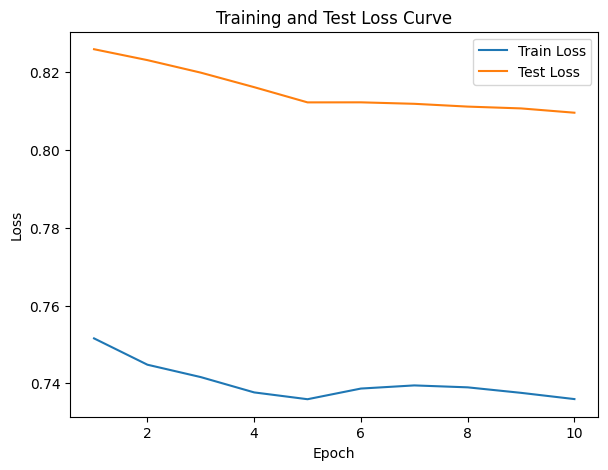

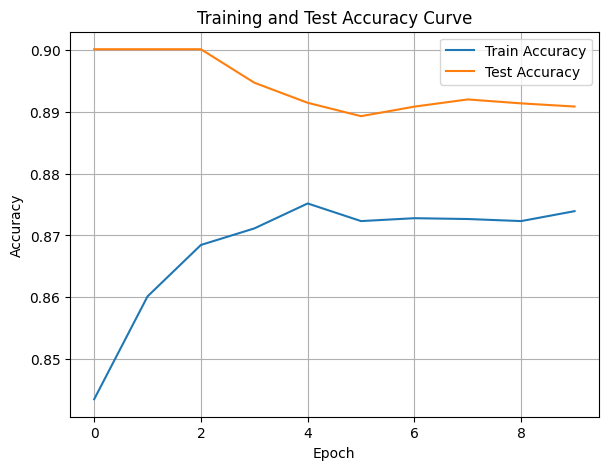

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.79it/s]

Epoch [1/10], Train F1:0.8752246952474484, Train Loss: 0.7317, Train Acc: 0.8685, Test F1:0.8795057078126853, Test Loss: 0.8043, Test Acc: 0.8863


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.45it/s]

Epoch [2/10], Train F1:0.8865450185582131, Train Loss: 0.7250, Train Acc: 0.8789, Test F1:0.8694744718136531, Test Loss: 0.7956, Test Acc: 0.8785


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.45it/s]

Epoch [3/10], Train F1:0.8841989347506366, Train Loss: 0.7243, Train Acc: 0.8793, Test F1:0.8694744718136532, Test Loss: 0.7958, Test Acc: 0.8785


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.89it/s]

Epoch [4/10], Train F1:0.8903736684946193, Train Loss: 0.7189, Train Acc: 0.8881, Test F1:0.8694744718136531, Test Loss: 0.7927, Test Acc: 0.8785


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.89it/s]

Epoch [5/10], Train F1:0.8907687380241079, Train Loss: 0.7158, Train Acc: 0.8890, Test F1:0.8694744718136532, Test Loss: 0.7904, Test Acc: 0.8785


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.15it/s]

Epoch [6/10], Train F1:0.8901082522625128, Train Loss: 0.7146, Train Acc: 0.8885, Test F1:0.8694744718136532, Test Loss: 0.7909, Test Acc: 0.8785


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.15it/s]

Epoch [7/10], Train F1:0.8898666952949416, Train Loss: 0.7132, Train Acc: 0.8896, Test F1:0.8694744718136531, Test Loss: 0.7903, Test Acc: 0.8785


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.76it/s]

Epoch [8/10], Train F1:0.8862733429038459, Train Loss: 0.7128, Train Acc: 0.8872, Test F1:0.8694744718136531, Test Loss: 0.7898, Test Acc: 0.8785


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.82it/s]

Epoch [9/10], Train F1:0.8882555068619489, Train Loss: 0.7108, Train Acc: 0.8898, Test F1:0.8694744718136531, Test Loss: 0.7887, Test Acc: 0.8785


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.09it/s]


Epoch [10/10], Train F1:0.8867377744313905, Train Loss: 0.7101, Train Acc: 0.8890, Test F1:0.8694744718136532, Test Loss: 0.7883, Test Acc: 0.8785
Total Epochs: 10
Train loss start: 0.704935610294342, Train loss end: 0.6369348168373108
Highest Mean Train Accuracy (over epoch): 0.8898148148148148
Test loss start: 0.79679936170578, Test loss end: 0.7677568793296814
Highest mean Test Accuracy (over epoch): 0.8862847222222222


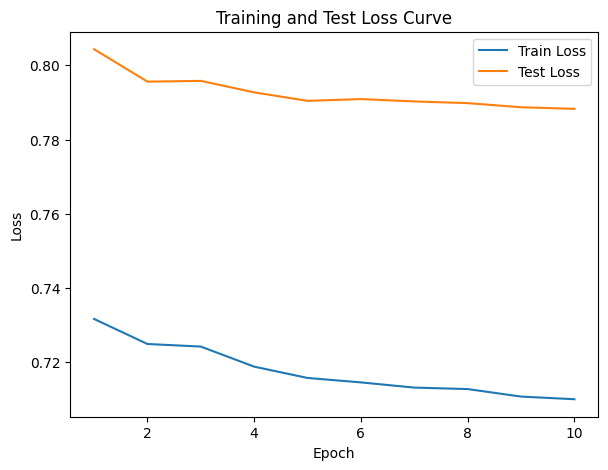

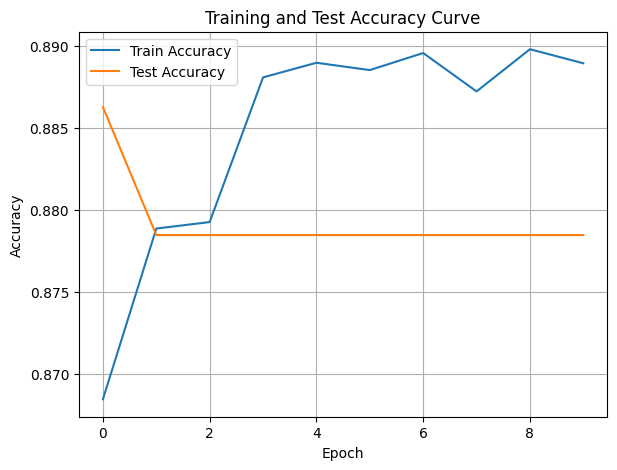

./saved_models/model_12.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [78]:
DTEmlp10b.train_DTE()

Training Process:   1%|          | 2/190 [00:00<00:26,  7.03it/s]

Epoch [1/190], Train F1:0.32913003663003665, Train Loss: 1.1688, Train Acc: 0.3018, Test F1:0.5137602559353039, Test Loss: 1.0896, Test Acc: 0.4957
Epoch [2/190], Train F1:0.3333452402712459, Train Loss: 1.1659, Train Acc: 0.2933, Test F1:0.5253107898114993, Test Loss: 1.0851, Test Acc: 0.5213


Training Process:   2%|▏         | 4/190 [00:00<00:24,  7.47it/s]

Epoch [3/190], Train F1:0.3457214605088715, Train Loss: 1.1616, Train Acc: 0.3023, Test F1:0.5279473870253576, Test Loss: 1.0823, Test Acc: 0.5298
Epoch [4/190], Train F1:0.34904230791396806, Train Loss: 1.1576, Train Acc: 0.3083, Test F1:0.5242825664362116, Test Loss: 1.0791, Test Acc: 0.5360


Training Process:   3%|▎         | 6/190 [00:00<00:23,  7.75it/s]

Epoch [5/190], Train F1:0.35171035601741885, Train Loss: 1.1548, Train Acc: 0.3103, Test F1:0.5216489499611098, Test Loss: 1.0788, Test Acc: 0.5351
Epoch [6/190], Train F1:0.3551899729343338, Train Loss: 1.1523, Train Acc: 0.3125, Test F1:0.5255373856374057, Test Loss: 1.0780, Test Acc: 0.5409


Training Process:   4%|▍         | 8/190 [00:01<00:23,  7.87it/s]

Epoch [7/190], Train F1:0.3628243204865967, Train Loss: 1.1495, Train Acc: 0.3193, Test F1:0.527808823997362, Test Loss: 1.0774, Test Acc: 0.5429
Epoch [8/190], Train F1:0.36977085938549725, Train Loss: 1.1469, Train Acc: 0.3265, Test F1:0.530300211090936, Test Loss: 1.0747, Test Acc: 0.5520


Training Process:   5%|▌         | 10/190 [00:01<00:22,  7.88it/s]

Epoch [9/190], Train F1:0.3767803757540232, Train Loss: 1.1443, Train Acc: 0.3341, Test F1:0.5327190230109597, Test Loss: 1.0723, Test Acc: 0.5606
Epoch [10/190], Train F1:0.3836322719220226, Train Loss: 1.1417, Train Acc: 0.3430, Test F1:0.5356771411394934, Test Loss: 1.0700, Test Acc: 0.5661


Training Process:   6%|▋         | 12/190 [00:01<00:22,  8.07it/s]

Epoch [11/190], Train F1:0.3897251270585792, Train Loss: 1.1389, Train Acc: 0.3514, Test F1:0.5385165225784996, Test Loss: 1.0681, Test Acc: 0.5713
Epoch [12/190], Train F1:0.3959152119408091, Train Loss: 1.1357, Train Acc: 0.3587, Test F1:0.5397743040800203, Test Loss: 1.0654, Test Acc: 0.5756


Training Process:   7%|▋         | 13/190 [00:01<00:21,  8.31it/s]

Epoch [13/190], Train F1:0.4018477324634546, Train Loss: 1.1321, Train Acc: 0.3660, Test F1:0.5427033430548835, Test Loss: 1.0638, Test Acc: 0.5803


Training Process:   8%|▊         | 15/190 [00:01<00:23,  7.52it/s]

Epoch [14/190], Train F1:0.4084853912217967, Train Loss: 1.1277, Train Acc: 0.3745, Test F1:0.5449689817284962, Test Loss: 1.0618, Test Acc: 0.5844
Epoch [15/190], Train F1:0.4132987030207457, Train Loss: 1.1243, Train Acc: 0.3805, Test F1:0.5453572153129732, Test Loss: 1.0599, Test Acc: 0.5874


Training Process:   9%|▉         | 17/190 [00:02<00:21,  7.96it/s]

Epoch [16/190], Train F1:0.41537426861270543, Train Loss: 1.1223, Train Acc: 0.3835, Test F1:0.544959874730867, Test Loss: 1.0574, Test Acc: 0.5905
Epoch [17/190], Train F1:0.4194844964173583, Train Loss: 1.1193, Train Acc: 0.3885, Test F1:0.5451795556232851, Test Loss: 1.0557, Test Acc: 0.5932


Training Process:  10%|█         | 19/190 [00:02<00:20,  8.34it/s]

Epoch [18/190], Train F1:0.42403113312733076, Train Loss: 1.1156, Train Acc: 0.3944, Test F1:0.5469634242926056, Test Loss: 1.0544, Test Acc: 0.5957
Epoch [19/190], Train F1:0.42915848905987775, Train Loss: 1.1119, Train Acc: 0.4025, Test F1:0.5478701146503013, Test Loss: 1.0526, Test Acc: 0.5979


Training Process:  11%|█         | 21/190 [00:02<00:19,  8.68it/s]

Epoch [20/190], Train F1:0.4342998324631797, Train Loss: 1.1082, Train Acc: 0.4086, Test F1:0.5485211207578398, Test Loss: 1.0509, Test Acc: 0.5998
Epoch [21/190], Train F1:0.43830127886055953, Train Loss: 1.1048, Train Acc: 0.4149, Test F1:0.5494822088834541, Test Loss: 1.0489, Test Acc: 0.6020


Training Process:  12%|█▏        | 23/190 [00:02<00:20,  8.35it/s]

Epoch [22/190], Train F1:0.4421922994627288, Train Loss: 1.1017, Train Acc: 0.4205, Test F1:0.5499107299894337, Test Loss: 1.0466, Test Acc: 0.6039
Epoch [23/190], Train F1:0.44565823192475945, Train Loss: 1.0987, Train Acc: 0.4253, Test F1:0.5505826557356769, Test Loss: 1.0445, Test Acc: 0.6057


Training Process:  13%|█▎        | 25/190 [00:03<00:22,  7.37it/s]

Epoch [24/190], Train F1:0.4488368313937791, Train Loss: 1.0957, Train Acc: 0.4306, Test F1:0.5525773319319455, Test Loss: 1.0432, Test Acc: 0.6077
Epoch [25/190], Train F1:0.45220501800614316, Train Loss: 1.0931, Train Acc: 0.4353, Test F1:0.5532147748724523, Test Loss: 1.0413, Test Acc: 0.6092


Training Process:  14%|█▍        | 27/190 [00:03<00:27,  6.00it/s]

Epoch [26/190], Train F1:0.45615325416386454, Train Loss: 1.0906, Train Acc: 0.4400, Test F1:0.5543262322225881, Test Loss: 1.0398, Test Acc: 0.6108
Epoch [27/190], Train F1:0.45845527741195, Train Loss: 1.0881, Train Acc: 0.4438, Test F1:0.5548973116490689, Test Loss: 1.0378, Test Acc: 0.6126


Training Process:  15%|█▌        | 29/190 [00:03<00:28,  5.66it/s]

Epoch [28/190], Train F1:0.4612836503445375, Train Loss: 1.0853, Train Acc: 0.4476, Test F1:0.5559812909798296, Test Loss: 1.0363, Test Acc: 0.6141
Epoch [29/190], Train F1:0.464762756211852, Train Loss: 1.0819, Train Acc: 0.4531, Test F1:0.5561861986450427, Test Loss: 1.0345, Test Acc: 0.6151


Training Process:  16%|█▋        | 31/190 [00:04<00:27,  5.70it/s]

Epoch [30/190], Train F1:0.46786242297130337, Train Loss: 1.0793, Train Acc: 0.4570, Test F1:0.5574757192461746, Test Loss: 1.0332, Test Acc: 0.6164
Epoch [31/190], Train F1:0.4708472223765088, Train Loss: 1.0764, Train Acc: 0.4612, Test F1:0.5590527262948372, Test Loss: 1.0313, Test Acc: 0.6183


Training Process:  17%|█▋        | 33/190 [00:04<00:27,  5.78it/s]

Epoch [32/190], Train F1:0.4734183196865373, Train Loss: 1.0739, Train Acc: 0.4646, Test F1:0.5601682064892197, Test Loss: 1.0300, Test Acc: 0.6193
Epoch [33/190], Train F1:0.4767390987115178, Train Loss: 1.0707, Train Acc: 0.4696, Test F1:0.5610569050700276, Test Loss: 1.0282, Test Acc: 0.6208


Training Process:  18%|█▊        | 35/190 [00:05<00:26,  5.77it/s]

Epoch [34/190], Train F1:0.4806579080140864, Train Loss: 1.0680, Train Acc: 0.4743, Test F1:0.5628700297890296, Test Loss: 1.0267, Test Acc: 0.6226
Epoch [35/190], Train F1:0.4851116740698252, Train Loss: 1.0648, Train Acc: 0.4794, Test F1:0.5665918921902613, Test Loss: 1.0251, Test Acc: 0.6248


Training Process:  19%|█▉        | 37/190 [00:05<00:26,  5.79it/s]

Epoch [36/190], Train F1:0.48814741038236076, Train Loss: 1.0621, Train Acc: 0.4834, Test F1:0.5701260838381036, Test Loss: 1.0236, Test Acc: 0.6272
Epoch [37/190], Train F1:0.4903789865813919, Train Loss: 1.0595, Train Acc: 0.4867, Test F1:0.5710791218215436, Test Loss: 1.0223, Test Acc: 0.6285


Training Process:  20%|██        | 38/190 [00:05<00:29,  5.18it/s]

Epoch [38/190], Train F1:0.4932306242603497, Train Loss: 1.0568, Train Acc: 0.4904, Test F1:0.5741087942316266, Test Loss: 1.0204, Test Acc: 0.6308


Training Process:  21%|██        | 40/190 [00:05<00:27,  5.47it/s]

Epoch [39/190], Train F1:0.4953612310760434, Train Loss: 1.0543, Train Acc: 0.4931, Test F1:0.5783568459050145, Test Loss: 1.0186, Test Acc: 0.6335
Epoch [40/190], Train F1:0.49886410043275076, Train Loss: 1.0515, Train Acc: 0.4970, Test F1:0.5810053367776998, Test Loss: 1.0169, Test Acc: 0.6355


Training Process:  22%|██▏       | 42/190 [00:06<00:25,  5.79it/s]

Epoch [41/190], Train F1:0.5016146479991584, Train Loss: 1.0490, Train Acc: 0.5000, Test F1:0.5832037624382126, Test Loss: 1.0156, Test Acc: 0.6372
Epoch [42/190], Train F1:0.504298905709871, Train Loss: 1.0466, Train Acc: 0.5028, Test F1:0.5860319998258006, Test Loss: 1.0140, Test Acc: 0.6392


Training Process:  23%|██▎       | 44/190 [00:06<00:24,  5.96it/s]

Epoch [43/190], Train F1:0.5069876357296905, Train Loss: 1.0440, Train Acc: 0.5061, Test F1:0.5899414574780877, Test Loss: 1.0123, Test Acc: 0.6417
Epoch [44/190], Train F1:0.5099033887255211, Train Loss: 1.0413, Train Acc: 0.5093, Test F1:0.5942082206845474, Test Loss: 1.0104, Test Acc: 0.6440


Training Process:  24%|██▍       | 46/190 [00:06<00:24,  5.95it/s]

Epoch [45/190], Train F1:0.5130172469059978, Train Loss: 1.0387, Train Acc: 0.5124, Test F1:0.5995296900079568, Test Loss: 1.0087, Test Acc: 0.6468
Epoch [46/190], Train F1:0.5164663953154975, Train Loss: 1.0359, Train Acc: 0.5160, Test F1:0.6030313103816359, Test Loss: 1.0069, Test Acc: 0.6491


Training Process:  25%|██▍       | 47/190 [00:07<00:24,  5.85it/s]

Epoch [47/190], Train F1:0.5207304243471472, Train Loss: 1.0331, Train Acc: 0.5200, Test F1:0.60826590522818, Test Loss: 1.0055, Test Acc: 0.6522


Training Process:  25%|██▌       | 48/190 [00:07<00:24,  5.76it/s]

Epoch [48/190], Train F1:0.5246975845471211, Train Loss: 1.0303, Train Acc: 0.5237, Test F1:0.61285251956901, Test Loss: 1.0041, Test Acc: 0.6549


Training Process:  26%|██▋       | 50/190 [00:07<00:25,  5.59it/s]

Epoch [49/190], Train F1:0.5285679432546523, Train Loss: 1.0281, Train Acc: 0.5268, Test F1:0.6154075031310563, Test Loss: 1.0024, Test Acc: 0.6567
Epoch [50/190], Train F1:0.5325317881515315, Train Loss: 1.0254, Train Acc: 0.5303, Test F1:0.6203923131481238, Test Loss: 1.0004, Test Acc: 0.6596


Training Process:  27%|██▋       | 51/190 [00:07<00:28,  4.83it/s]

Epoch [51/190], Train F1:0.535851681092755, Train Loss: 1.0228, Train Acc: 0.5334, Test F1:0.6267425429742312, Test Loss: 0.9989, Test Acc: 0.6633


Training Process:  27%|██▋       | 52/190 [00:08<00:28,  4.81it/s]

Epoch [52/190], Train F1:0.5392052991306955, Train Loss: 1.0202, Train Acc: 0.5368, Test F1:0.6330772315130627, Test Loss: 0.9974, Test Acc: 0.6671


Training Process:  28%|██▊       | 53/190 [00:08<00:28,  4.79it/s]

Epoch [53/190], Train F1:0.5433901776270228, Train Loss: 1.0175, Train Acc: 0.5402, Test F1:0.6366044022922425, Test Loss: 0.9954, Test Acc: 0.6698


Training Process:  28%|██▊       | 54/190 [00:08<00:28,  4.77it/s]

Epoch [54/190], Train F1:0.546541318826443, Train Loss: 1.0150, Train Acc: 0.5430, Test F1:0.6420674508795852, Test Loss: 0.9935, Test Acc: 0.6731


Training Process:  29%|██▉       | 55/190 [00:08<00:28,  4.79it/s]

Epoch [55/190], Train F1:0.5508285619704908, Train Loss: 1.0124, Train Acc: 0.5463, Test F1:0.6455241570981681, Test Loss: 0.9917, Test Acc: 0.6757


Training Process:  29%|██▉       | 56/190 [00:09<00:30,  4.38it/s]

Epoch [56/190], Train F1:0.5550952614010731, Train Loss: 1.0099, Train Acc: 0.5500, Test F1:0.6491183836480452, Test Loss: 0.9899, Test Acc: 0.6782


Training Process:  30%|███       | 57/190 [00:09<00:30,  4.35it/s]

Epoch [57/190], Train F1:0.558814209424456, Train Loss: 1.0076, Train Acc: 0.5532, Test F1:0.6541400993213548, Test Loss: 0.9883, Test Acc: 0.6815


Training Process:  31%|███       | 58/190 [00:09<00:30,  4.38it/s]

Epoch [58/190], Train F1:0.5620493181281433, Train Loss: 1.0052, Train Acc: 0.5560, Test F1:0.6589254486483289, Test Loss: 0.9868, Test Acc: 0.6847


Training Process:  31%|███       | 59/190 [00:09<00:28,  4.60it/s]

Epoch [59/190], Train F1:0.5655985650600445, Train Loss: 1.0028, Train Acc: 0.5590, Test F1:0.6637584115597627, Test Loss: 0.9852, Test Acc: 0.6878


Training Process:  32%|███▏      | 60/190 [00:09<00:27,  4.79it/s]

Epoch [60/190], Train F1:0.5697357732711122, Train Loss: 1.0001, Train Acc: 0.5626, Test F1:0.668111886302681, Test Loss: 0.9835, Test Acc: 0.6908


Training Process:  32%|███▏      | 61/190 [00:10<00:26,  4.88it/s]

Epoch [61/190], Train F1:0.573120356703299, Train Loss: 0.9978, Train Acc: 0.5653, Test F1:0.671879110298297, Test Loss: 0.9818, Test Acc: 0.6935


Training Process:  33%|███▎      | 62/190 [00:10<00:29,  4.38it/s]

Epoch [62/190], Train F1:0.5770257619325115, Train Loss: 0.9952, Train Acc: 0.5686, Test F1:0.6749952123903492, Test Loss: 0.9801, Test Acc: 0.6958


Training Process:  33%|███▎      | 63/190 [00:10<00:28,  4.49it/s]

Epoch [63/190], Train F1:0.5807599164373168, Train Loss: 0.9927, Train Acc: 0.5717, Test F1:0.6788469718006469, Test Loss: 0.9785, Test Acc: 0.6985


Training Process:  34%|███▎      | 64/190 [00:10<00:27,  4.51it/s]

Epoch [64/190], Train F1:0.5840766807388358, Train Loss: 0.9903, Train Acc: 0.5745, Test F1:0.6826493578251877, Test Loss: 0.9766, Test Acc: 0.7013


Training Process:  34%|███▍      | 65/190 [00:11<00:27,  4.54it/s]

Epoch [65/190], Train F1:0.587606846640936, Train Loss: 0.9881, Train Acc: 0.5772, Test F1:0.6844527911204121, Test Loss: 0.9749, Test Acc: 0.7029


Training Process:  35%|███▍      | 66/190 [00:11<00:27,  4.55it/s]

Epoch [66/190], Train F1:0.5912807800087067, Train Loss: 0.9857, Train Acc: 0.5806, Test F1:0.6875523070337489, Test Loss: 0.9732, Test Acc: 0.7052


Training Process:  35%|███▌      | 67/190 [00:11<00:26,  4.57it/s]

Epoch [67/190], Train F1:0.5945222259251096, Train Loss: 0.9835, Train Acc: 0.5834, Test F1:0.6900929875368, Test Loss: 0.9715, Test Acc: 0.7071


Training Process:  36%|███▌      | 68/190 [00:11<00:26,  4.53it/s]

Epoch [68/190], Train F1:0.5982571620231177, Train Loss: 0.9810, Train Acc: 0.5865, Test F1:0.6937392408213279, Test Loss: 0.9699, Test Acc: 0.7097


Training Process:  36%|███▋      | 69/190 [00:11<00:26,  4.50it/s]

Epoch [69/190], Train F1:0.6019568585881249, Train Loss: 0.9785, Train Acc: 0.5897, Test F1:0.6968226545398054, Test Loss: 0.9683, Test Acc: 0.7119


Training Process:  37%|███▋      | 70/190 [00:12<00:26,  4.50it/s]

Epoch [70/190], Train F1:0.605231410371443, Train Loss: 0.9761, Train Acc: 0.5926, Test F1:0.6995855408015975, Test Loss: 0.9667, Test Acc: 0.7139


Training Process:  37%|███▋      | 71/190 [00:12<00:26,  4.46it/s]

Epoch [71/190], Train F1:0.60925024761111, Train Loss: 0.9737, Train Acc: 0.5959, Test F1:0.7024533297831425, Test Loss: 0.9651, Test Acc: 0.7160


Training Process:  38%|███▊      | 72/190 [00:12<00:26,  4.40it/s]

Epoch [72/190], Train F1:0.6120140120989447, Train Loss: 0.9715, Train Acc: 0.5983, Test F1:0.7054188715469798, Test Loss: 0.9636, Test Acc: 0.7182


Training Process:  38%|███▊      | 73/190 [00:12<00:30,  3.89it/s]

Epoch [73/190], Train F1:0.615536988026046, Train Loss: 0.9692, Train Acc: 0.6012, Test F1:0.7080853704246528, Test Loss: 0.9620, Test Acc: 0.7202


Training Process:  39%|███▉      | 74/190 [00:13<00:30,  3.85it/s]

Epoch [74/190], Train F1:0.6186833689779138, Train Loss: 0.9673, Train Acc: 0.6036, Test F1:0.7103774041601253, Test Loss: 0.9604, Test Acc: 0.7220


Training Process:  39%|███▉      | 75/190 [00:13<00:29,  3.86it/s]

Epoch [75/190], Train F1:0.6220095368114182, Train Loss: 0.9650, Train Acc: 0.6064, Test F1:0.712595525113718, Test Loss: 0.9589, Test Acc: 0.7238


Training Process:  40%|████      | 76/190 [00:13<00:28,  4.04it/s]

Epoch [76/190], Train F1:0.6249635919079116, Train Loss: 0.9627, Train Acc: 0.6091, Test F1:0.7147432721196374, Test Loss: 0.9573, Test Acc: 0.7256


Training Process:  41%|████      | 77/190 [00:13<00:26,  4.21it/s]

Epoch [77/190], Train F1:0.6274952762690535, Train Loss: 0.9605, Train Acc: 0.6116, Test F1:0.7170902278914039, Test Loss: 0.9558, Test Acc: 0.7274


Training Process:  41%|████      | 78/190 [00:14<00:25,  4.31it/s]

Epoch [78/190], Train F1:0.630575343013424, Train Loss: 0.9583, Train Acc: 0.6144, Test F1:0.7193622585306967, Test Loss: 0.9543, Test Acc: 0.7292


Training Process:  42%|████▏     | 79/190 [00:14<00:25,  4.40it/s]

Epoch [79/190], Train F1:0.6338221250884444, Train Loss: 0.9560, Train Acc: 0.6172, Test F1:0.72138810506819, Test Loss: 0.9527, Test Acc: 0.7308


Training Process:  42%|████▏     | 80/190 [00:14<00:24,  4.45it/s]

Epoch [80/190], Train F1:0.6367726650948294, Train Loss: 0.9537, Train Acc: 0.6199, Test F1:0.7235237897798285, Test Loss: 0.9511, Test Acc: 0.7324


Training Process:  43%|████▎     | 81/190 [00:14<00:24,  4.42it/s]

Epoch [81/190], Train F1:0.639958058983033, Train Loss: 0.9516, Train Acc: 0.6225, Test F1:0.7253493789169984, Test Loss: 0.9496, Test Acc: 0.7340


Training Process:  43%|████▎     | 82/190 [00:14<00:24,  4.38it/s]

Epoch [82/190], Train F1:0.6427469302486032, Train Loss: 0.9495, Train Acc: 0.6251, Test F1:0.7272885221944836, Test Loss: 0.9480, Test Acc: 0.7356


Training Process:  44%|████▎     | 83/190 [00:15<00:25,  4.18it/s]

Epoch [83/190], Train F1:0.6459319995409628, Train Loss: 0.9474, Train Acc: 0.6278, Test F1:0.7292444087339883, Test Loss: 0.9466, Test Acc: 0.7372


Training Process:  44%|████▍     | 84/190 [00:15<00:26,  3.99it/s]

Epoch [84/190], Train F1:0.6492441434877004, Train Loss: 0.9454, Train Acc: 0.6305, Test F1:0.7310726987640425, Test Loss: 0.9451, Test Acc: 0.7388


Training Process:  45%|████▍     | 85/190 [00:15<00:27,  3.88it/s]

Epoch [85/190], Train F1:0.6520535269830794, Train Loss: 0.9433, Train Acc: 0.6331, Test F1:0.7329189386070969, Test Loss: 0.9437, Test Acc: 0.7403


Training Process:  45%|████▌     | 86/190 [00:16<00:26,  3.89it/s]

Epoch [86/190], Train F1:0.6548656420439586, Train Loss: 0.9411, Train Acc: 0.6356, Test F1:0.7347129703465478, Test Loss: 0.9422, Test Acc: 0.7417


Training Process:  46%|████▌     | 87/190 [00:16<00:26,  3.85it/s]

Epoch [87/190], Train F1:0.6573468123822334, Train Loss: 0.9391, Train Acc: 0.6379, Test F1:0.7364569932901773, Test Loss: 0.9407, Test Acc: 0.7431


Training Process:  46%|████▋     | 88/190 [00:16<00:26,  3.84it/s]

Epoch [88/190], Train F1:0.659682697854125, Train Loss: 0.9373, Train Acc: 0.6401, Test F1:0.7384550489318167, Test Loss: 0.9395, Test Acc: 0.7447


Training Process:  47%|████▋     | 89/190 [00:16<00:26,  3.78it/s]

Epoch [89/190], Train F1:0.6621170275137475, Train Loss: 0.9354, Train Acc: 0.6422, Test F1:0.7395917090386581, Test Loss: 0.9381, Test Acc: 0.7457


Training Process:  47%|████▋     | 90/190 [00:17<00:26,  3.72it/s]

Epoch [90/190], Train F1:0.6644381359925938, Train Loss: 0.9335, Train Acc: 0.6445, Test F1:0.7412013548285067, Test Loss: 0.9368, Test Acc: 0.7470


Training Process:  48%|████▊     | 91/190 [00:17<00:26,  3.70it/s]

Epoch [91/190], Train F1:0.6670256830713158, Train Loss: 0.9314, Train Acc: 0.6468, Test F1:0.7426240070537069, Test Loss: 0.9354, Test Acc: 0.7482


Training Process:  48%|████▊     | 92/190 [00:17<00:25,  3.80it/s]

Epoch [92/190], Train F1:0.6693602629780223, Train Loss: 0.9294, Train Acc: 0.6490, Test F1:0.7444372911505549, Test Loss: 0.9341, Test Acc: 0.7497


Training Process:  49%|████▉     | 93/190 [00:17<00:24,  3.92it/s]

Epoch [93/190], Train F1:0.6715269577068922, Train Loss: 0.9276, Train Acc: 0.6511, Test F1:0.7459224152035948, Test Loss: 0.9328, Test Acc: 0.7509


Training Process:  49%|████▉     | 94/190 [00:18<00:24,  3.98it/s]

Epoch [94/190], Train F1:0.6741042433176381, Train Loss: 0.9257, Train Acc: 0.6535, Test F1:0.747452215412518, Test Loss: 0.9315, Test Acc: 0.7523


Training Process:  50%|█████     | 95/190 [00:18<00:24,  3.87it/s]

Epoch [95/190], Train F1:0.676508875814582, Train Loss: 0.9238, Train Acc: 0.6557, Test F1:0.7488627152139418, Test Loss: 0.9301, Test Acc: 0.7534


Training Process:  51%|█████     | 96/190 [00:18<00:25,  3.70it/s]

Epoch [96/190], Train F1:0.6787485696207284, Train Loss: 0.9220, Train Acc: 0.6578, Test F1:0.7503192485953153, Test Loss: 0.9287, Test Acc: 0.7547


Training Process:  51%|█████     | 97/190 [00:18<00:24,  3.75it/s]

Epoch [97/190], Train F1:0.6809106956117515, Train Loss: 0.9202, Train Acc: 0.6599, Test F1:0.7516079109604614, Test Loss: 0.9274, Test Acc: 0.7559


Training Process:  52%|█████▏    | 98/190 [00:19<00:24,  3.73it/s]

Epoch [98/190], Train F1:0.6832492812492115, Train Loss: 0.9183, Train Acc: 0.6621, Test F1:0.7527351011452974, Test Loss: 0.9260, Test Acc: 0.7569


Training Process:  52%|█████▏    | 99/190 [00:19<00:24,  3.74it/s]

Epoch [99/190], Train F1:0.6851388200337188, Train Loss: 0.9168, Train Acc: 0.6638, Test F1:0.7542755924558266, Test Loss: 0.9247, Test Acc: 0.7581


Training Process:  53%|█████▎    | 100/190 [00:19<00:24,  3.71it/s]

Epoch [100/190], Train F1:0.6871873118485161, Train Loss: 0.9151, Train Acc: 0.6657, Test F1:0.7555236083002588, Test Loss: 0.9233, Test Acc: 0.7592


Training Process:  53%|█████▎    | 101/190 [00:20<00:24,  3.66it/s]

Epoch [101/190], Train F1:0.6892769091109099, Train Loss: 0.9133, Train Acc: 0.6676, Test F1:0.7567425714408682, Test Loss: 0.9220, Test Acc: 0.7603


Training Process:  54%|█████▎    | 102/190 [00:20<00:24,  3.61it/s]

Epoch [102/190], Train F1:0.6916284102852053, Train Loss: 0.9115, Train Acc: 0.6699, Test F1:0.7579334903121278, Test Loss: 0.9208, Test Acc: 0.7613


Training Process:  54%|█████▍    | 103/190 [00:20<00:25,  3.38it/s]

Epoch [103/190], Train F1:0.6939504408693629, Train Loss: 0.9097, Train Acc: 0.6720, Test F1:0.7593432985874395, Test Loss: 0.9196, Test Acc: 0.7624


Training Process:  55%|█████▍    | 104/190 [00:21<00:26,  3.25it/s]

Epoch [104/190], Train F1:0.6959223204148806, Train Loss: 0.9081, Train Acc: 0.6738, Test F1:0.760553552303544, Test Loss: 0.9183, Test Acc: 0.7635


Training Process:  55%|█████▌    | 105/190 [00:21<00:26,  3.18it/s]

Epoch [105/190], Train F1:0.6981014351588514, Train Loss: 0.9065, Train Acc: 0.6757, Test F1:0.7616623738498695, Test Loss: 0.9171, Test Acc: 0.7645


Training Process:  56%|█████▌    | 106/190 [00:21<00:27,  3.06it/s]

Epoch [106/190], Train F1:0.7000173104114187, Train Loss: 0.9047, Train Acc: 0.6776, Test F1:0.7629838971383098, Test Loss: 0.9159, Test Acc: 0.7656


Training Process:  56%|█████▋    | 107/190 [00:21<00:26,  3.19it/s]

Epoch [107/190], Train F1:0.7020905895376709, Train Loss: 0.9030, Train Acc: 0.6796, Test F1:0.7641590820180137, Test Loss: 0.9147, Test Acc: 0.7666


Training Process:  57%|█████▋    | 108/190 [00:22<00:24,  3.32it/s]

Epoch [108/190], Train F1:0.7038946033977012, Train Loss: 0.9015, Train Acc: 0.6813, Test F1:0.7651930626977207, Test Loss: 0.9135, Test Acc: 0.7675


Training Process:  57%|█████▋    | 109/190 [00:22<00:23,  3.41it/s]

Epoch [109/190], Train F1:0.7057715257541232, Train Loss: 0.8998, Train Acc: 0.6832, Test F1:0.7662050639730859, Test Loss: 0.9124, Test Acc: 0.7684


Training Process:  58%|█████▊    | 110/190 [00:22<00:23,  3.48it/s]

Epoch [110/190], Train F1:0.7076720068361206, Train Loss: 0.8982, Train Acc: 0.6850, Test F1:0.767421910804707, Test Loss: 0.9112, Test Acc: 0.7694


Training Process:  58%|█████▊    | 111/190 [00:23<00:22,  3.48it/s]

Epoch [111/190], Train F1:0.709541689528538, Train Loss: 0.8966, Train Acc: 0.6867, Test F1:0.7686129642518453, Test Loss: 0.9101, Test Acc: 0.7704


Training Process:  59%|█████▉    | 112/190 [00:23<00:22,  3.47it/s]

Epoch [112/190], Train F1:0.7113099792124152, Train Loss: 0.8951, Train Acc: 0.6882, Test F1:0.7697790418440335, Test Loss: 0.9089, Test Acc: 0.7714


Training Process:  59%|█████▉    | 113/190 [00:23<00:22,  3.46it/s]

Epoch [113/190], Train F1:0.713493451478335, Train Loss: 0.8934, Train Acc: 0.6903, Test F1:0.7709209267133846, Test Loss: 0.9077, Test Acc: 0.7724


Training Process:  60%|██████    | 114/190 [00:23<00:22,  3.45it/s]

Epoch [114/190], Train F1:0.7152045096366741, Train Loss: 0.8918, Train Acc: 0.6920, Test F1:0.7720393693938097, Test Loss: 0.9066, Test Acc: 0.7733


Training Process:  61%|██████    | 115/190 [00:24<00:23,  3.16it/s]

Epoch [115/190], Train F1:0.7168655176201115, Train Loss: 0.8903, Train Acc: 0.6936, Test F1:0.7731350895080146, Test Loss: 0.9055, Test Acc: 0.7742


Training Process:  61%|██████    | 116/190 [00:24<00:23,  3.10it/s]

Epoch [116/190], Train F1:0.7185052922663178, Train Loss: 0.8888, Train Acc: 0.6951, Test F1:0.7739606996014545, Test Loss: 0.9044, Test Acc: 0.7751


Training Process:  62%|██████▏   | 117/190 [00:25<00:24,  3.00it/s]

Epoch [117/190], Train F1:0.7199647481009118, Train Loss: 0.8875, Train Acc: 0.6965, Test F1:0.7750159472602285, Test Loss: 0.9033, Test Acc: 0.7760


Training Process:  62%|██████▏   | 118/190 [00:25<00:25,  2.86it/s]

Epoch [118/190], Train F1:0.7216138896810119, Train Loss: 0.8860, Train Acc: 0.6981, Test F1:0.7760503929384538, Test Loss: 0.9022, Test Acc: 0.7768


Training Process:  63%|██████▎   | 119/190 [00:25<00:23,  2.97it/s]

Epoch [119/190], Train F1:0.7230847915250411, Train Loss: 0.8847, Train Acc: 0.6994, Test F1:0.776824956942519, Test Loss: 0.9011, Test Acc: 0.7776


Training Process:  63%|██████▎   | 120/190 [00:26<00:22,  3.08it/s]

Epoch [120/190], Train F1:0.7246003819101017, Train Loss: 0.8833, Train Acc: 0.7010, Test F1:0.777686509742709, Test Loss: 0.8999, Test Acc: 0.7785


Training Process:  64%|██████▎   | 121/190 [00:26<00:21,  3.16it/s]

Epoch [121/190], Train F1:0.7262358814721129, Train Loss: 0.8819, Train Acc: 0.7025, Test F1:0.7785321228027154, Test Loss: 0.8988, Test Acc: 0.7793


Training Process:  64%|██████▍   | 122/190 [00:26<00:21,  3.23it/s]

Epoch [122/190], Train F1:0.7275749791393683, Train Loss: 0.8807, Train Acc: 0.7038, Test F1:0.7794950475020603, Test Loss: 0.8978, Test Acc: 0.7801


Training Process:  65%|██████▍   | 123/190 [00:26<00:20,  3.26it/s]

Epoch [123/190], Train F1:0.7290118584317667, Train Loss: 0.8793, Train Acc: 0.7052, Test F1:0.7804398771055954, Test Loss: 0.8968, Test Acc: 0.7809


Training Process:  65%|██████▌   | 124/190 [00:27<00:20,  3.26it/s]

Epoch [124/190], Train F1:0.7305965800889908, Train Loss: 0.8779, Train Acc: 0.7067, Test F1:0.7813671201561138, Test Loss: 0.8957, Test Acc: 0.7817


Training Process:  66%|██████▌   | 125/190 [00:27<00:20,  3.23it/s]

Epoch [125/190], Train F1:0.7319372264528154, Train Loss: 0.8767, Train Acc: 0.7080, Test F1:0.7822772662152554, Test Loss: 0.8946, Test Acc: 0.7825


Training Process:  66%|██████▋   | 126/190 [00:27<00:21,  3.01it/s]

Epoch [126/190], Train F1:0.7331289177078328, Train Loss: 0.8755, Train Acc: 0.7092, Test F1:0.7830439816451312, Test Loss: 0.8936, Test Acc: 0.7833


Training Process:  67%|██████▋   | 127/190 [00:28<00:21,  2.97it/s]

Epoch [127/190], Train F1:0.7344932222765566, Train Loss: 0.8741, Train Acc: 0.7105, Test F1:0.7839227498208332, Test Loss: 0.8925, Test Acc: 0.7841


Training Process:  67%|██████▋   | 128/190 [00:28<00:20,  2.97it/s]

Epoch [128/190], Train F1:0.7360476293829729, Train Loss: 0.8728, Train Acc: 0.7120, Test F1:0.7847857534545186, Test Loss: 0.8915, Test Acc: 0.7848


Training Process:  68%|██████▊   | 129/190 [00:28<00:20,  2.94it/s]

Epoch [129/190], Train F1:0.7373277312484975, Train Loss: 0.8716, Train Acc: 0.7132, Test F1:0.7855106987583149, Test Loss: 0.8905, Test Acc: 0.7855


Training Process:  68%|██████▊   | 130/190 [00:29<00:20,  2.90it/s]

Epoch [130/190], Train F1:0.7385830115992461, Train Loss: 0.8703, Train Acc: 0.7145, Test F1:0.7863447578920035, Test Loss: 0.8896, Test Acc: 0.7863


Training Process:  69%|██████▉   | 131/190 [00:29<00:19,  2.96it/s]

Epoch [131/190], Train F1:0.739863278107126, Train Loss: 0.8692, Train Acc: 0.7157, Test F1:0.7871642486849922, Test Loss: 0.8886, Test Acc: 0.7870


Training Process:  69%|██████▉   | 132/190 [00:29<00:19,  3.05it/s]

Epoch [132/190], Train F1:0.7410434156081547, Train Loss: 0.8679, Train Acc: 0.7170, Test F1:0.7879695517208144, Test Loss: 0.8876, Test Acc: 0.7877


Training Process:  70%|███████   | 133/190 [00:30<00:18,  3.10it/s]

Epoch [133/190], Train F1:0.7422847580708823, Train Loss: 0.8667, Train Acc: 0.7183, Test F1:0.7887610343757462, Test Loss: 0.8865, Test Acc: 0.7884


Training Process:  71%|███████   | 134/190 [00:30<00:17,  3.12it/s]

Epoch [134/190], Train F1:0.7434967913469114, Train Loss: 0.8655, Train Acc: 0.7195, Test F1:0.789539051389178, Test Loss: 0.8855, Test Acc: 0.7891


Training Process:  71%|███████   | 135/190 [00:30<00:18,  2.90it/s]

Epoch [135/190], Train F1:0.7447780208503789, Train Loss: 0.8642, Train Acc: 0.7207, Test F1:0.7903039454045752, Test Loss: 0.8845, Test Acc: 0.7897


Training Process:  72%|███████▏  | 136/190 [00:31<00:18,  2.89it/s]

Epoch [136/190], Train F1:0.7460660127689852, Train Loss: 0.8630, Train Acc: 0.7220, Test F1:0.7910560474827896, Test Loss: 0.8836, Test Acc: 0.7904


Training Process:  72%|███████▏  | 137/190 [00:31<00:18,  2.92it/s]

Epoch [137/190], Train F1:0.7473625293540662, Train Loss: 0.8618, Train Acc: 0.7233, Test F1:0.791795677589361, Test Loss: 0.8827, Test Acc: 0.7911


Training Process:  73%|███████▎  | 138/190 [00:32<00:17,  2.90it/s]

Epoch [138/190], Train F1:0.7486655545064336, Train Loss: 0.8606, Train Acc: 0.7246, Test F1:0.7925231450573368, Test Loss: 0.8818, Test Acc: 0.7917


Training Process:  73%|███████▎  | 139/190 [00:32<00:17,  2.87it/s]

Epoch [139/190], Train F1:0.7497151860703118, Train Loss: 0.8595, Train Acc: 0.7258, Test F1:0.7932387490270378, Test Loss: 0.8809, Test Acc: 0.7923


Training Process:  74%|███████▎  | 140/190 [00:32<00:17,  2.86it/s]

Epoch [140/190], Train F1:0.7507045780286029, Train Loss: 0.8585, Train Acc: 0.7267, Test F1:0.7938332245570662, Test Loss: 0.8800, Test Acc: 0.7930


Training Process:  74%|███████▍  | 141/190 [00:33<00:17,  2.82it/s]

Epoch [141/190], Train F1:0.7516956481760678, Train Loss: 0.8575, Train Acc: 0.7276, Test F1:0.7945270253279081, Test Loss: 0.8791, Test Acc: 0.7936


Training Process:  75%|███████▍  | 142/190 [00:33<00:17,  2.80it/s]

Epoch [142/190], Train F1:0.7528387883738272, Train Loss: 0.8563, Train Acc: 0.7288, Test F1:0.7952097826780197, Test Loss: 0.8782, Test Acc: 0.7942


Training Process:  75%|███████▌  | 143/190 [00:33<00:16,  2.86it/s]

Epoch [143/190], Train F1:0.7539106863674918, Train Loss: 0.8552, Train Acc: 0.7298, Test F1:0.7958817595246038, Test Loss: 0.8773, Test Acc: 0.7948


Training Process:  76%|███████▌  | 144/190 [00:34<00:15,  2.92it/s]

Epoch [144/190], Train F1:0.7549160250789757, Train Loss: 0.8542, Train Acc: 0.7308, Test F1:0.7965432104681784, Test Loss: 0.8764, Test Acc: 0.7954


Training Process:  76%|███████▋  | 145/190 [00:34<00:15,  2.97it/s]

Epoch [145/190], Train F1:0.7559866338140785, Train Loss: 0.8531, Train Acc: 0.7319, Test F1:0.7971943821200842, Test Loss: 0.8755, Test Acc: 0.7960


Training Process:  77%|███████▋  | 146/190 [00:34<00:15,  2.81it/s]

Epoch [146/190], Train F1:0.7569814475036988, Train Loss: 0.8521, Train Acc: 0.7329, Test F1:0.7978355134145806, Test Loss: 0.8746, Test Acc: 0.7965


Training Process:  77%|███████▋  | 147/190 [00:35<00:16,  2.69it/s]

Epoch [147/190], Train F1:0.7581029080270034, Train Loss: 0.8509, Train Acc: 0.7341, Test F1:0.7984668359063831, Test Loss: 0.8737, Test Acc: 0.7971


Training Process:  78%|███████▊  | 148/190 [00:35<00:15,  2.69it/s]

Epoch [148/190], Train F1:0.75897384652891, Train Loss: 0.8499, Train Acc: 0.7350, Test F1:0.7989317979021731, Test Loss: 0.8728, Test Acc: 0.7976


Training Process:  78%|███████▊  | 149/190 [00:35<00:15,  2.69it/s]

Epoch [149/190], Train F1:0.7599420085069177, Train Loss: 0.8489, Train Acc: 0.7360, Test F1:0.7995454304450382, Test Loss: 0.8719, Test Acc: 0.7981


Training Process:  79%|███████▉  | 150/190 [00:36<00:14,  2.70it/s]

Epoch [150/190], Train F1:0.7609652587894887, Train Loss: 0.8478, Train Acc: 0.7370, Test F1:0.8001498870323278, Test Loss: 0.8711, Test Acc: 0.7987


Training Process:  79%|███████▉  | 151/190 [00:36<00:15,  2.57it/s]

Epoch [151/190], Train F1:0.7620444174546039, Train Loss: 0.8467, Train Acc: 0.7381, Test F1:0.8006464101784245, Test Loss: 0.8702, Test Acc: 0.7992


Training Process:  80%|████████  | 152/190 [00:37<00:15,  2.50it/s]

Epoch [152/190], Train F1:0.7629207262231181, Train Loss: 0.8458, Train Acc: 0.7390, Test F1:0.8012339963063105, Test Loss: 0.8694, Test Acc: 0.7997


Training Process:  81%|████████  | 153/190 [00:37<00:14,  2.52it/s]

Epoch [153/190], Train F1:0.76396025890484, Train Loss: 0.8447, Train Acc: 0.7401, Test F1:0.8018129890374639, Test Loss: 0.8686, Test Acc: 0.8003


Training Process:  81%|████████  | 154/190 [00:37<00:13,  2.62it/s]

Epoch [154/190], Train F1:0.7650598366816332, Train Loss: 0.8437, Train Acc: 0.7411, Test F1:0.8024367298559516, Test Loss: 0.8677, Test Acc: 0.8009


Training Process:  82%|████████▏ | 155/190 [00:38<00:13,  2.68it/s]

Epoch [155/190], Train F1:0.7661243956561351, Train Loss: 0.8427, Train Acc: 0.7422, Test F1:0.8029987751052472, Test Loss: 0.8668, Test Acc: 0.8014


Training Process:  82%|████████▏ | 156/190 [00:38<00:12,  2.73it/s]

Epoch [156/190], Train F1:0.7672261443353388, Train Loss: 0.8416, Train Acc: 0.7433, Test F1:0.8035527783737709, Test Loss: 0.8660, Test Acc: 0.8019


Training Process:  83%|████████▎ | 157/190 [00:39<00:12,  2.58it/s]

Epoch [157/190], Train F1:0.7680164302963369, Train Loss: 0.8407, Train Acc: 0.7442, Test F1:0.8040989117817655, Test Loss: 0.8652, Test Acc: 0.8024


Training Process:  83%|████████▎ | 158/190 [00:39<00:12,  2.63it/s]

Epoch [158/190], Train F1:0.7691478810166275, Train Loss: 0.8396, Train Acc: 0.7453, Test F1:0.8046373425537925, Test Loss: 0.8644, Test Acc: 0.8029


Training Process:  84%|████████▎ | 159/190 [00:39<00:11,  2.64it/s]

Epoch [159/190], Train F1:0.7700614751797024, Train Loss: 0.8387, Train Acc: 0.7462, Test F1:0.8051682331921469, Test Loss: 0.8636, Test Acc: 0.8034


Training Process:  84%|████████▍ | 160/190 [00:40<00:11,  2.62it/s]

Epoch [160/190], Train F1:0.7711127169790666, Train Loss: 0.8376, Train Acc: 0.7473, Test F1:0.8056917416429294, Test Loss: 0.8627, Test Acc: 0.8038


Training Process:  85%|████████▍ | 161/190 [00:40<00:11,  2.58it/s]

Epoch [161/190], Train F1:0.7721032734497439, Train Loss: 0.8366, Train Acc: 0.7483, Test F1:0.8062080214551395, Test Loss: 0.8620, Test Acc: 0.8043


Training Process:  85%|████████▌ | 162/190 [00:41<00:10,  2.56it/s]

Epoch [162/190], Train F1:0.7730588045225151, Train Loss: 0.8356, Train Acc: 0.7493, Test F1:0.806717221933129, Test Loss: 0.8612, Test Acc: 0.8048


Training Process:  86%|████████▌ | 163/190 [00:41<00:10,  2.51it/s]

Epoch [163/190], Train F1:0.7739959364648443, Train Loss: 0.8346, Train Acc: 0.7503, Test F1:0.8072194882827389, Test Loss: 0.8604, Test Acc: 0.8052


Training Process:  86%|████████▋ | 164/190 [00:41<00:10,  2.58it/s]

Epoch [164/190], Train F1:0.7748488639052938, Train Loss: 0.8337, Train Acc: 0.7512, Test F1:0.8077650834998903, Test Loss: 0.8596, Test Acc: 0.8058


Training Process:  87%|████████▋ | 165/190 [00:42<00:09,  2.64it/s]

Epoch [165/190], Train F1:0.7756407620287473, Train Loss: 0.8328, Train Acc: 0.7520, Test F1:0.8082536162897015, Test Loss: 0.8588, Test Acc: 0.8062


Training Process:  87%|████████▋ | 166/190 [00:42<00:08,  2.68it/s]

Epoch [166/190], Train F1:0.7764944122480636, Train Loss: 0.8319, Train Acc: 0.7529, Test F1:0.8087356304658935, Test Loss: 0.8581, Test Acc: 0.8067


Training Process:  88%|████████▊ | 167/190 [00:42<00:09,  2.50it/s]

Epoch [167/190], Train F1:0.7772629325952621, Train Loss: 0.8311, Train Acc: 0.7537, Test F1:0.8092112561375191, Test Loss: 0.8573, Test Acc: 0.8071


Training Process:  88%|████████▊ | 168/190 [00:43<00:08,  2.52it/s]

Epoch [168/190], Train F1:0.7780761850661612, Train Loss: 0.8302, Train Acc: 0.7546, Test F1:0.8096806199620198, Test Loss: 0.8565, Test Acc: 0.8076


Training Process:  89%|████████▉ | 169/190 [00:43<00:08,  2.52it/s]

Epoch [169/190], Train F1:0.7789781781044006, Train Loss: 0.8292, Train Acc: 0.7556, Test F1:0.8101925741137124, Test Loss: 0.8558, Test Acc: 0.8081


Training Process:  89%|████████▉ | 170/190 [00:44<00:07,  2.52it/s]

Epoch [170/190], Train F1:0.779690745414238, Train Loss: 0.8284, Train Acc: 0.7563, Test F1:0.8106495108290267, Test Loss: 0.8550, Test Acc: 0.8085


Training Process:  90%|█████████ | 171/190 [00:44<00:07,  2.49it/s]

Epoch [171/190], Train F1:0.7804964335659984, Train Loss: 0.8275, Train Acc: 0.7571, Test F1:0.8111005489624953, Test Loss: 0.8543, Test Acc: 0.8089


Training Process:  91%|█████████ | 172/190 [00:44<00:07,  2.45it/s]

Epoch [172/190], Train F1:0.7814711702184394, Train Loss: 0.8266, Train Acc: 0.7580, Test F1:0.8115458024178456, Test Loss: 0.8536, Test Acc: 0.8093


Training Process:  91%|█████████ | 173/190 [00:45<00:07,  2.40it/s]

Epoch [173/190], Train F1:0.7822416423278069, Train Loss: 0.8257, Train Acc: 0.7589, Test F1:0.8119853821752356, Test Loss: 0.8529, Test Acc: 0.8097


Training Process:  92%|█████████▏| 174/190 [00:45<00:06,  2.47it/s]

Epoch [174/190], Train F1:0.7829493943741029, Train Loss: 0.8249, Train Acc: 0.7595, Test F1:0.8124193963847295, Test Loss: 0.8521, Test Acc: 0.8101


Training Process:  92%|█████████▏| 175/190 [00:46<00:05,  2.54it/s]

Epoch [175/190], Train F1:0.7836401374069436, Train Loss: 0.8243, Train Acc: 0.7601, Test F1:0.8128307401597095, Test Loss: 0.8514, Test Acc: 0.8106


Training Process:  93%|█████████▎| 176/190 [00:46<00:05,  2.43it/s]

Epoch [176/190], Train F1:0.784556908001365, Train Loss: 0.8234, Train Acc: 0.7611, Test F1:0.8132541076999148, Test Loss: 0.8506, Test Acc: 0.8110


Training Process:  93%|█████████▎| 177/190 [00:47<00:05,  2.45it/s]

Epoch [177/190], Train F1:0.7853472539785893, Train Loss: 0.8226, Train Acc: 0.7619, Test F1:0.8136553347899753, Test Loss: 0.8499, Test Acc: 0.8114


Training Process:  94%|█████████▎| 178/190 [00:47<00:04,  2.44it/s]

Epoch [178/190], Train F1:0.7860172986104316, Train Loss: 0.8217, Train Acc: 0.7626, Test F1:0.8140684448940619, Test Loss: 0.8493, Test Acc: 0.8118


Training Process:  94%|█████████▍| 179/190 [00:47<00:04,  2.45it/s]

Epoch [179/190], Train F1:0.7866280878548723, Train Loss: 0.8210, Train Acc: 0.7633, Test F1:0.814459923785621, Test Loss: 0.8486, Test Acc: 0.8122


Training Process:  95%|█████████▍| 180/190 [00:48<00:04,  2.44it/s]

Epoch [180/190], Train F1:0.7873124402236555, Train Loss: 0.8201, Train Acc: 0.7641, Test F1:0.8148631468824974, Test Loss: 0.8479, Test Acc: 0.8126


Training Process:  95%|█████████▌| 181/190 [00:48<00:03,  2.44it/s]

Epoch [181/190], Train F1:0.7880344028645333, Train Loss: 0.8193, Train Acc: 0.7649, Test F1:0.8152614812928003, Test Loss: 0.8471, Test Acc: 0.8130


Training Process:  96%|█████████▌| 182/190 [00:49<00:03,  2.41it/s]

Epoch [182/190], Train F1:0.7888739371520712, Train Loss: 0.8184, Train Acc: 0.7658, Test F1:0.8157004483078927, Test Loss: 0.8464, Test Acc: 0.8134


Training Process:  96%|█████████▋| 183/190 [00:49<00:02,  2.41it/s]

Epoch [183/190], Train F1:0.7894441200793757, Train Loss: 0.8176, Train Acc: 0.7664, Test F1:0.816134232289519, Test Loss: 0.8457, Test Acc: 0.8138


Training Process:  97%|█████████▋| 184/190 [00:49<00:02,  2.46it/s]

Epoch [184/190], Train F1:0.7901243314479164, Train Loss: 0.8168, Train Acc: 0.7671, Test F1:0.8165179571786179, Test Loss: 0.8450, Test Acc: 0.8142


Training Process:  97%|█████████▋| 185/190 [00:50<00:02,  2.38it/s]

Epoch [185/190], Train F1:0.790717561499453, Train Loss: 0.8161, Train Acc: 0.7678, Test F1:0.8168971401575948, Test Loss: 0.8443, Test Acc: 0.8146


Training Process:  98%|█████████▊| 186/190 [00:50<00:01,  2.40it/s]

Epoch [186/190], Train F1:0.7913184944103474, Train Loss: 0.8154, Train Acc: 0.7684, Test F1:0.8172718616511253, Test Loss: 0.8437, Test Acc: 0.8149


Training Process:  98%|█████████▊| 187/190 [00:51<00:01,  2.43it/s]

Epoch [187/190], Train F1:0.7920974306949884, Train Loss: 0.8145, Train Acc: 0.7692, Test F1:0.8176422001907075, Test Loss: 0.8431, Test Acc: 0.8153


Training Process:  99%|█████████▉| 188/190 [00:51<00:00,  2.42it/s]

Epoch [188/190], Train F1:0.7928522022170758, Train Loss: 0.8137, Train Acc: 0.7700, Test F1:0.8179337231968811, Test Loss: 0.8424, Test Acc: 0.8156


Training Process:  99%|█████████▉| 189/190 [00:51<00:00,  2.41it/s]

Epoch [189/190], Train F1:0.7934983690727722, Train Loss: 0.8131, Train Acc: 0.7707, Test F1:0.8182960215990416, Test Loss: 0.8418, Test Acc: 0.8159


Training Process: 100%|██████████| 190/190 [00:52<00:00,  3.62it/s]


Epoch [190/190], Train F1:0.7942066493935799, Train Loss: 0.8122, Train Acc: 0.7714, Test F1:0.8186541552645051, Test Loss: 0.8411, Test Acc: 0.8163
Total Epochs: 190
Train loss start: 1.189052939414978, Train loss end: 0.6662238240242004
Highest Mean Train Accuracy (over epoch): 0.7713925438596492
Test loss start: 1.0957660675048828, Test loss end: 0.7286500334739685
Highest Mean Test Accuracy (over epoch): 0.8162783260233919


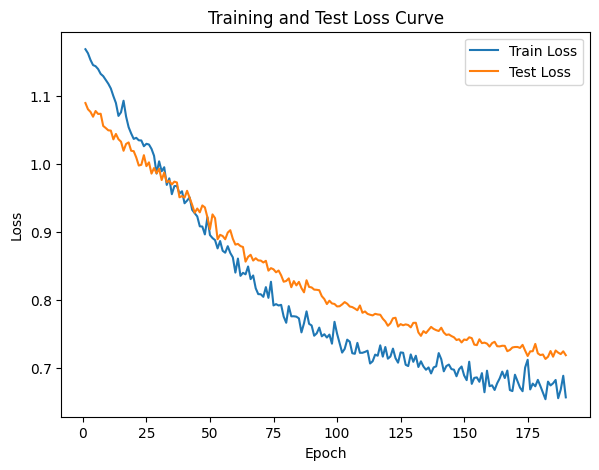

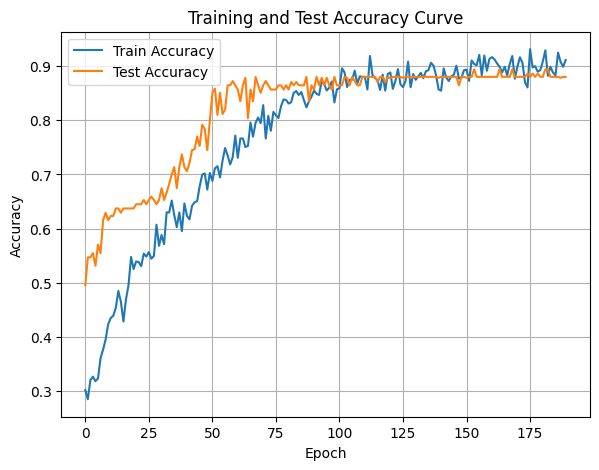

In [79]:
DTEmlp10b.train_single_model()

Randomly initializing 10 models
Training Model with id 1
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4232216415544426, Train Loss: 1.1095, Train Acc: 0.3818, Test F1:0.5551201160010972, Test Loss: 1.0891, Test Acc: 0.5686


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.47it/s]

Epoch [2/10], Train F1:0.4303989779474163, Train Loss: 1.1110, Train Acc: 0.3801, Test F1:0.5830808090377382, Test Loss: 1.0844, Test Acc: 0.6029


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.79it/s]

Epoch [3/10], Train F1:0.43661493599935236, Train Loss: 1.1069, Train Acc: 0.3872, Test F1:0.60448900146847, Test Loss: 1.0809, Test Acc: 0.6221


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.06it/s]

Epoch [4/10], Train F1:0.445026927269918, Train Loss: 1.1038, Train Acc: 0.3999, Test F1:0.6286534959197484, Test Loss: 1.0774, Test Acc: 0.6450


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.62it/s]

Epoch [5/10], Train F1:0.4475361673288263, Train Loss: 1.1006, Train Acc: 0.4059, Test F1:0.6369527300812357, Test Loss: 1.0749, Test Acc: 0.6512


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.62it/s]

Epoch [6/10], Train F1:0.4549588268698654, Train Loss: 1.0981, Train Acc: 0.4163, Test F1:0.6361249045276419, Test Loss: 1.0721, Test Acc: 0.6561


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.52it/s]

Epoch [7/10], Train F1:0.46771949474578906, Train Loss: 1.0943, Train Acc: 0.4310, Test F1:0.6337365898617382, Test Loss: 1.0703, Test Acc: 0.6576


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.52it/s]

Epoch [8/10], Train F1:0.47426661690330285, Train Loss: 1.0924, Train Acc: 0.4390, Test F1:0.6370621377480804, Test Loss: 1.0685, Test Acc: 0.6617


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.03it/s]

Epoch [9/10], Train F1:0.4851798138070548, Train Loss: 1.0884, Train Acc: 0.4502, Test F1:0.6395446917901856, Test Loss: 1.0670, Test Acc: 0.6664


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.35it/s]


Epoch [10/10], Train F1:0.4942069967609897, Train Loss: 1.0848, Train Acc: 0.4612, Test F1:0.6400578978297963, Test Loss: 1.0649, Test Acc: 0.6701
Total Epochs: 10
Train loss start: 1.113547444343567, Train loss end: 0.9897938966751099
Highest Mean Train Accuracy (over epoch): 0.46116071428571426
Test loss start: 1.0793598890304565, Test loss end: 1.047304630279541
Highest mean Test Accuracy (over epoch): 0.670138888888889


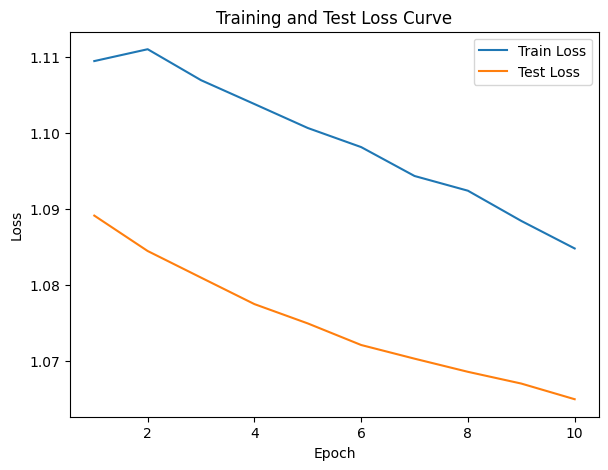

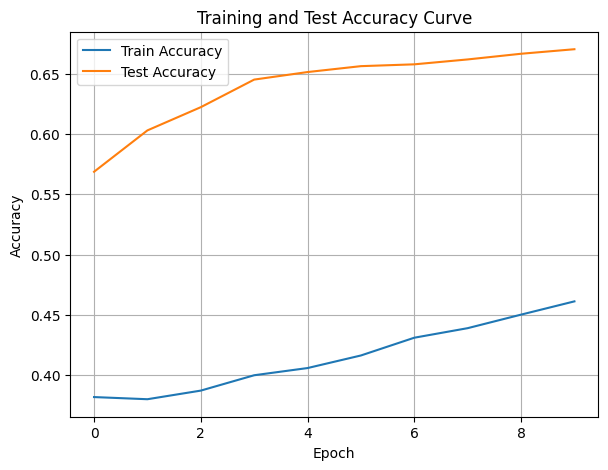

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.59it/s]

Epoch [1/10], Train F1:0.24802954852215936, Train Loss: 1.1510, Train Acc: 0.2253, Test F1:0.09153318077803203, Test Loss: 1.1354, Test Acc: 0.0703
Epoch [2/10], Train F1:0.27193558665482187, Train Loss: 1.1435, Train Acc: 0.2426, Test F1:0.07859649122807016, Test Loss: 1.1395, Test Acc: 0.0547


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.38it/s]

Epoch [3/10], Train F1:0.2793910974991553, Train Loss: 1.1449, Train Acc: 0.2395, Test F1:0.07407407407407407, Test Loss: 1.1442, Test Acc: 0.0495
Epoch [4/10], Train F1:0.28750164972268005, Train Loss: 1.1428, Train Acc: 0.2474, Test F1:0.07166853303471446, Test Loss: 1.1446, Test Acc: 0.0469


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.64it/s]

Epoch [5/10], Train F1:0.29643087766553533, Train Loss: 1.1397, Train Acc: 0.2574, Test F1:0.08060692271218588, Test Loss: 1.1416, Test Acc: 0.0543
Epoch [6/10], Train F1:0.30074909796211063, Train Loss: 1.1353, Train Acc: 0.2615, Test F1:0.08600889410154913, Test Loss: 1.1393, Test Acc: 0.0593


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.99it/s]

Epoch [7/10], Train F1:0.31077230760513747, Train Loss: 1.1317, Train Acc: 0.2744, Test F1:0.09829560598969946, Test Loss: 1.1368, Test Acc: 0.0696
Epoch [8/10], Train F1:0.3151473271904516, Train Loss: 1.1294, Train Acc: 0.2747, Test F1:0.10127508257886121, Test Loss: 1.1356, Test Acc: 0.0714


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.96it/s]


Epoch [9/10], Train F1:0.3203769562186993, Train Loss: 1.1269, Train Acc: 0.2808, Test F1:0.10261572653836493, Test Loss: 1.1349, Test Acc: 0.0728
Epoch [10/10], Train F1:0.3277588880006918, Train Loss: 1.1247, Train Acc: 0.2858, Test F1:0.1094921390245857, Test Loss: 1.1335, Test Acc: 0.0779
Total Epochs: 10
Train loss start: 1.2260539531707764, Train loss end: 1.17641282081604
Highest Mean Train Accuracy (over epoch): 0.28577380952380954
Test loss start: 1.14621901512146, Test loss end: 1.1308512687683105
Highest mean Test Accuracy (over epoch): 0.07786458333333333


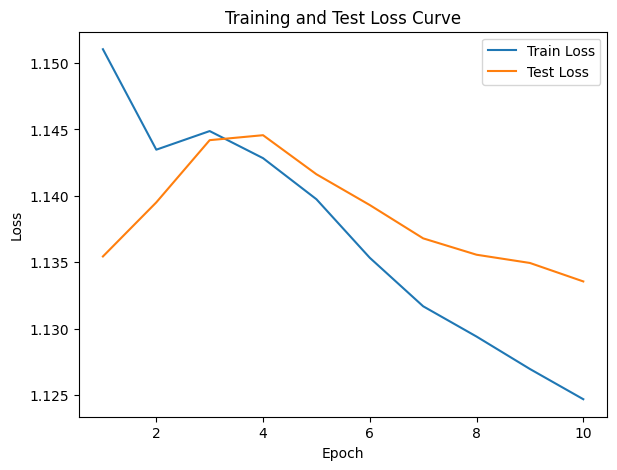

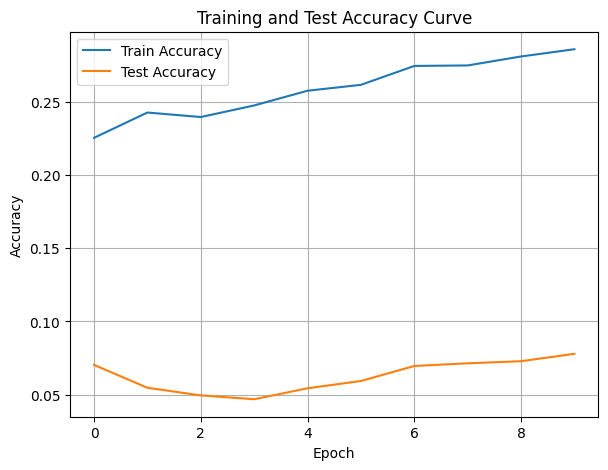

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.3196820144267348, Train Loss: 1.1800, Train Acc: 0.2232, Test F1:0.4119058329584646, Test Loss: 1.0929, Test Acc: 0.2804


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.26it/s]

Epoch [2/10], Train F1:0.33737493812296016, Train Loss: 1.1759, Train Acc: 0.2347, Test F1:0.4198154690038605, Test Loss: 1.0884, Test Acc: 0.3012


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.26it/s]

Epoch [3/10], Train F1:0.34524852029613984, Train Loss: 1.1738, Train Acc: 0.2406, Test F1:0.4428543665306266, Test Loss: 1.0875, Test Acc: 0.3244


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.01it/s]

Epoch [4/10], Train F1:0.3616707549101916, Train Loss: 1.1678, Train Acc: 0.2553, Test F1:0.4759985069055618, Test Loss: 1.0850, Test Acc: 0.3668


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.17it/s]

Epoch [5/10], Train F1:0.3623260927044543, Train Loss: 1.1649, Train Acc: 0.2583, Test F1:0.5010335625077557, Test Loss: 1.0834, Test Acc: 0.3997


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.45it/s]

Epoch [6/10], Train F1:0.37380573296518516, Train Loss: 1.1608, Train Acc: 0.2658, Test F1:0.5244325745688325, Test Loss: 1.0794, Test Acc: 0.4307


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.56it/s]

Epoch [7/10], Train F1:0.3778065674898254, Train Loss: 1.1575, Train Acc: 0.2687, Test F1:0.5356944469439295, Test Loss: 1.0777, Test Acc: 0.4473


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.67it/s]

Epoch [8/10], Train F1:0.3877943193939487, Train Loss: 1.1554, Train Acc: 0.2774, Test F1:0.5409793824286145, Test Loss: 1.0772, Test Acc: 0.4524


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.73it/s]

Epoch [9/10], Train F1:0.3954117212534413, Train Loss: 1.1523, Train Acc: 0.2841, Test F1:0.5517803583879517, Test Loss: 1.0757, Test Acc: 0.4663


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.63it/s]


Epoch [10/10], Train F1:0.4051432138520013, Train Loss: 1.1480, Train Acc: 0.2926, Test F1:0.5584104176915355, Test Loss: 1.0742, Test Acc: 0.4744
Total Epochs: 10
Train loss start: 1.1702982187271118, Train loss end: 1.164923071861267
Highest Mean Train Accuracy (over epoch): 0.2925892857142857
Test loss start: 1.1043059825897217, Test loss end: 1.0507183074951172
Highest mean Test Accuracy (over epoch): 0.47439236111111116


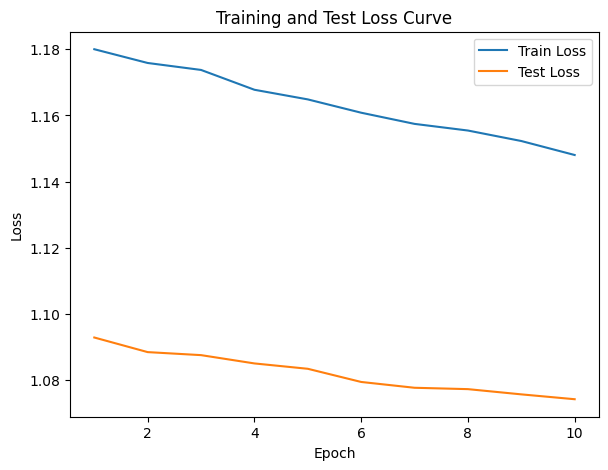

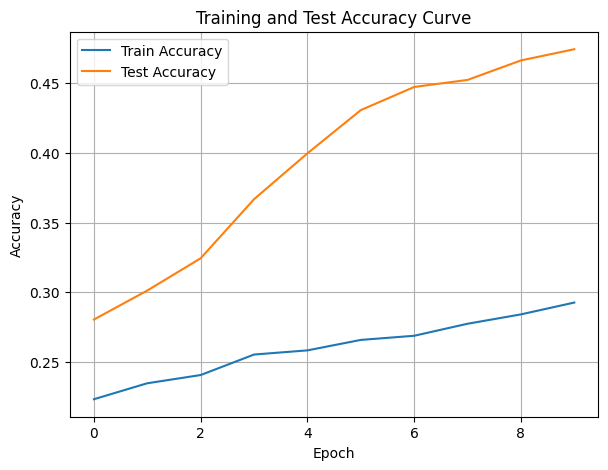

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.71it/s]

Epoch [1/10], Train F1:0.27179607188542404, Train Loss: 1.1357, Train Acc: 0.2836, Test F1:0.20885547201336677, Test Loss: 1.1117, Test Acc: 0.2509


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.97it/s]

Epoch [2/10], Train F1:0.29983088448278034, Train Loss: 1.1277, Train Acc: 0.3045, Test F1:0.21627721904730218, Test Loss: 1.1087, Test Acc: 0.2587


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.98it/s]

Epoch [3/10], Train F1:0.3036744076941121, Train Loss: 1.1308, Train Acc: 0.2981, Test F1:0.20880500624444848, Test Loss: 1.1078, Test Acc: 0.2561


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.08it/s]

Epoch [4/10], Train F1:0.30825098604722617, Train Loss: 1.1294, Train Acc: 0.3036, Test F1:0.20972729474753768, Test Loss: 1.1061, Test Acc: 0.2587


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.23it/s]

Epoch [5/10], Train F1:0.3169968570247614, Train Loss: 1.1231, Train Acc: 0.3135, Test F1:0.2264435198156457, Test Loss: 1.1036, Test Acc: 0.2720


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.35it/s]

Epoch [6/10], Train F1:0.32475905773088587, Train Loss: 1.1196, Train Acc: 0.3175, Test F1:0.22755719708628294, Test Loss: 1.1018, Test Acc: 0.2758


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.48it/s]

Epoch [7/10], Train F1:0.3331217150554092, Train Loss: 1.1160, Train Acc: 0.3239, Test F1:0.2317418934723743, Test Loss: 1.0998, Test Acc: 0.2795


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.48it/s]

Epoch [8/10], Train F1:0.3404639788991196, Train Loss: 1.1118, Train Acc: 0.3300, Test F1:0.23780035098490424, Test Loss: 1.0974, Test Acc: 0.2853


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.86it/s]

Epoch [9/10], Train F1:0.3430989028668938, Train Loss: 1.1104, Train Acc: 0.3304, Test F1:0.24485475538107118, Test Loss: 1.0957, Test Acc: 0.2915


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.52it/s]


Epoch [10/10], Train F1:0.3535436739716774, Train Loss: 1.1062, Train Acc: 0.3397, Test F1:0.2545196533591682, Test Loss: 1.0938, Test Acc: 0.2994
Total Epochs: 10
Train loss start: 1.1779884099960327, Train loss end: 1.1434781551361084
Highest Mean Train Accuracy (over epoch): 0.3397023809523809
Test loss start: 1.1080517768859863, Test loss end: 1.0650709867477417
Highest mean Test Accuracy (over epoch): 0.2993923611111111


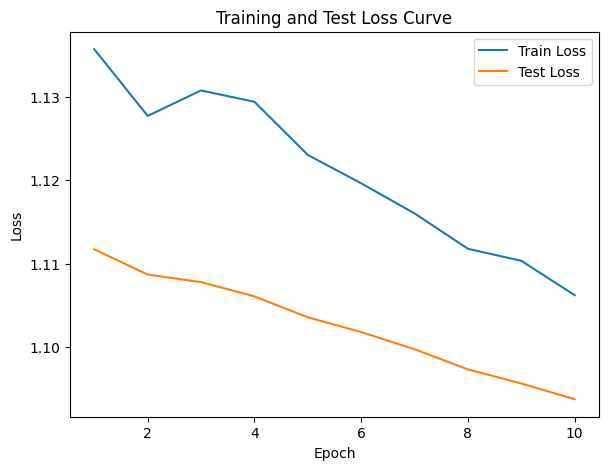

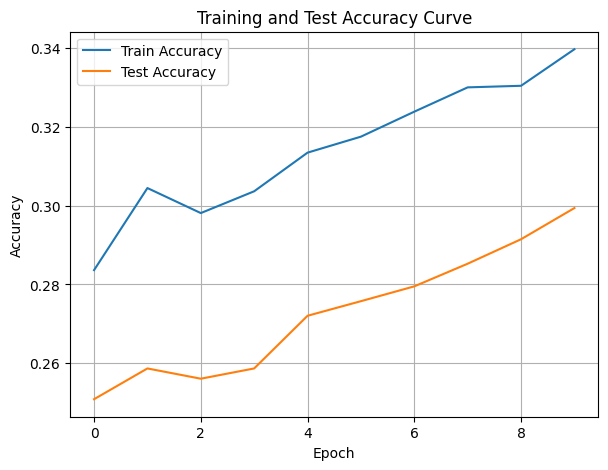

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.19it/s]

Epoch [1/10], Train F1:0.4122856609509587, Train Loss: 1.1082, Train Acc: 0.3765, Test F1:0.33793438820932925, Test Loss: 1.1099, Test Acc: 0.2960
Epoch [2/10], Train F1:0.40362482242653513, Train Loss: 1.1090, Train Acc: 0.3692, Test F1:0.4051793742312553, Test Loss: 1.1055, Test Acc: 0.3832


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.83it/s]

Epoch [3/10], Train F1:0.4104531955199594, Train Loss: 1.1073, Train Acc: 0.3765, Test F1:0.43556848747774785, Test Loss: 1.1021, Test Acc: 0.4149
Epoch [4/10], Train F1:0.40860402197435225, Train Loss: 1.1106, Train Acc: 0.3731, Test F1:0.4468622536733992, Test Loss: 1.1005, Test Acc: 0.4269


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.20it/s]

Epoch [5/10], Train F1:0.42414638106897373, Train Loss: 1.1042, Train Acc: 0.3881, Test F1:0.4652138401752131, Test Loss: 1.0979, Test Acc: 0.4493
Epoch [6/10], Train F1:0.42479479295210804, Train Loss: 1.1027, Train Acc: 0.3878, Test F1:0.4971425614182951, Test Loss: 1.0946, Test Acc: 0.4737


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.31it/s]

Epoch [7/10], Train F1:0.4336149799049183, Train Loss: 1.0974, Train Acc: 0.3974, Test F1:0.5044796074705972, Test Loss: 1.0929, Test Acc: 0.4810
Epoch [8/10], Train F1:0.4392436704960642, Train Loss: 1.0930, Train Acc: 0.4045, Test F1:0.5158348062266465, Test Loss: 1.0906, Test Acc: 0.4978


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.74it/s]


Epoch [9/10], Train F1:0.4473285612550274, Train Loss: 1.0886, Train Acc: 0.4132, Test F1:0.5332802721080402, Test Loss: 1.0881, Test Acc: 0.5130
Epoch [10/10], Train F1:0.45868466490422277, Train Loss: 1.0846, Train Acc: 0.4255, Test F1:0.5464145801396696, Test Loss: 1.0850, Test Acc: 0.5286
Total Epochs: 10
Train loss start: 1.045278787612915, Train loss end: 1.0546658039093018
Highest Mean Train Accuracy (over epoch): 0.42550595238095235
Test loss start: 1.095232605934143, Test loss end: 1.0723824501037598
Highest mean Test Accuracy (over epoch): 0.5285590277777777


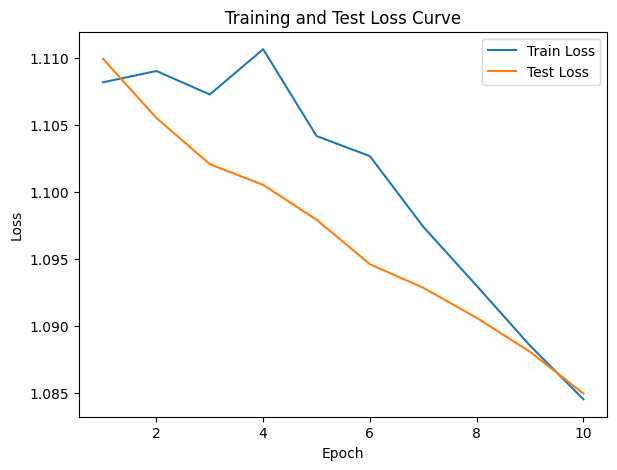

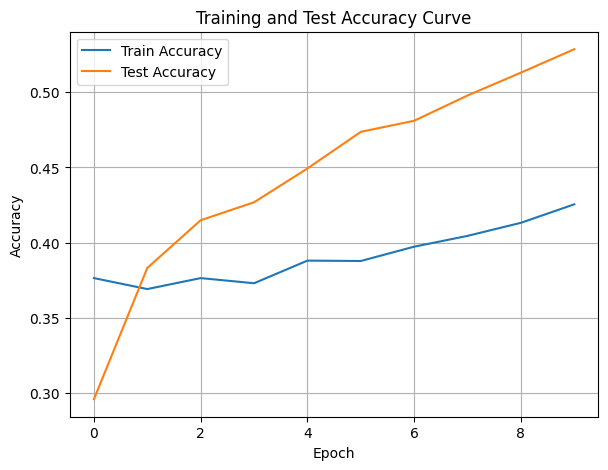

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.6035653488972992, Train Loss: 1.0045, Train Acc: 0.5693, Test F1:0.7375480955910904, Test Loss: 1.0499, Test Acc: 0.7274


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.16it/s]

Epoch [2/10], Train F1:0.5983683216043035, Train Loss: 1.0080, Train Acc: 0.5646, Test F1:0.7437745879851142, Test Loss: 1.0431, Test Acc: 0.7313


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.16it/s]

Epoch [3/10], Train F1:0.6066833294579321, Train Loss: 1.0067, Train Acc: 0.5756, Test F1:0.7555999722768115, Test Loss: 1.0395, Test Acc: 0.7431


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.15it/s]

Epoch [4/10], Train F1:0.6042666385585579, Train Loss: 1.0059, Train Acc: 0.5706, Test F1:0.7613613946653488, Test Loss: 1.0376, Test Acc: 0.7474


Training Process:  60%|██████    | 6/10 [00:00<00:00,  6.59it/s]

Epoch [5/10], Train F1:0.624915748552075, Train Loss: 0.9988, Train Acc: 0.5950, Test F1:0.765549357264128, Test Loss: 1.0341, Test Acc: 0.7528
Epoch [6/10], Train F1:0.6299639592220502, Train Loss: 0.9958, Train Acc: 0.6011, Test F1:0.7661920603481667, Test Loss: 1.0306, Test Acc: 0.7548


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.28it/s]

Epoch [7/10], Train F1:0.6351283170102429, Train Loss: 0.9935, Train Acc: 0.6067, Test F1:0.7756161490328995, Test Loss: 1.0264, Test Acc: 0.7651
Epoch [8/10], Train F1:0.6391926339094662, Train Loss: 0.9915, Train Acc: 0.6108, Test F1:0.7788637958200926, Test Loss: 1.0234, Test Acc: 0.7700


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.48it/s]


Epoch [9/10], Train F1:0.6456692716882787, Train Loss: 0.9872, Train Acc: 0.6169, Test F1:0.7831317570385478, Test Loss: 1.0214, Test Acc: 0.7739
Epoch [10/10], Train F1:0.6483202859942142, Train Loss: 0.9844, Train Acc: 0.6208, Test F1:0.7850692695991096, Test Loss: 1.0194, Test Acc: 0.7755
Total Epochs: 10
Train loss start: 1.0031602382659912, Train loss end: 0.9036779403686523
Highest Mean Train Accuracy (over epoch): 0.6208035714285715
Test loss start: 1.029630422592163, Test loss end: 1.0008513927459717
Highest mean Test Accuracy (over epoch): 0.7755208333333333


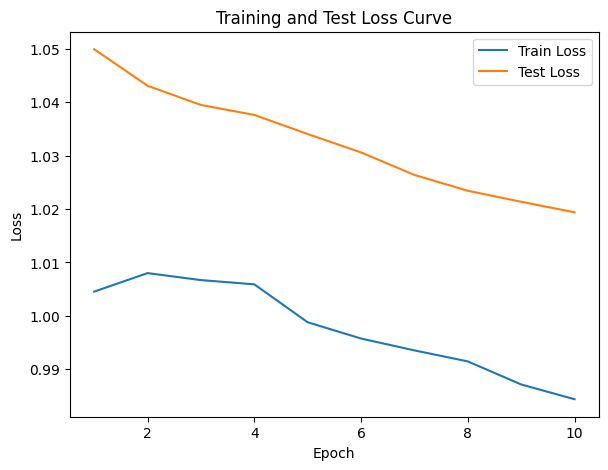

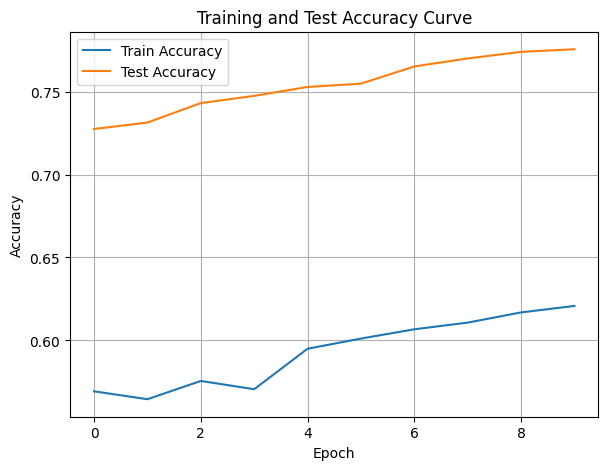

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.74it/s]

Epoch [1/10], Train F1:0.2543406324210007, Train Loss: 1.1598, Train Acc: 0.1887, Test F1:0.026990553306342778, Test Loss: 1.1647, Test Acc: 0.0156
Epoch [2/10], Train F1:0.2495776383323929, Train Loss: 1.1650, Train Acc: 0.1766, Test F1:0.0208441896821261, Test Loss: 1.1712, Test Acc: 0.0117


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.23it/s]

Epoch [3/10], Train F1:0.2790116852557723, Train Loss: 1.1561, Train Acc: 0.2023, Test F1:0.01871345029239766, Test Loss: 1.1726, Test Acc: 0.0104
Epoch [4/10], Train F1:0.29108708954411927, Train Loss: 1.1515, Train Acc: 0.2138, Test F1:0.017543859649122806, Test Loss: 1.1746, Test Acc: 0.0098


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.08it/s]

Epoch [5/10], Train F1:0.3087481479089702, Train Loss: 1.1451, Train Acc: 0.2296, Test F1:0.022189862006795645, Test Loss: 1.1736, Test Acc: 0.0125
Epoch [6/10], Train F1:0.3186718022018667, Train Loss: 1.1420, Train Acc: 0.2357, Test F1:0.033955857385398976, Test Loss: 1.1726, Test Acc: 0.0195
Epoch [7/10], Train F1:0.3285634965441626, Train Loss: 1.1386, Train Acc: 0.2446, Test F1:0.034702139965297855, Test Loss: 1.1720, Test Acc: 0.0201


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.01it/s]

Epoch [8/10], Train F1:0.3410938133571969, Train Loss: 1.1352, Train Acc: 0.2544, Test F1:0.03693444136657434, Test Loss: 1.1714, Test Acc: 0.0215
Epoch [9/10], Train F1:0.34989918117981494, Train Loss: 1.1331, Train Acc: 0.2604, Test F1:0.038411819021237296, Test Loss: 1.1714, Test Acc: 0.0226


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.47it/s]


Epoch [10/10], Train F1:0.35393475154750575, Train Loss: 1.1309, Train Acc: 0.2641, Test F1:0.0422107901332278, Test Loss: 1.1712, Test Acc: 0.0250
Total Epochs: 10
Train loss start: 1.1286522150039673, Train loss end: 1.2167718410491943
Highest Mean Train Accuracy (over epoch): 0.2640773809523809
Test loss start: 1.1623961925506592, Test loss end: 1.173858880996704
Highest mean Test Accuracy (over epoch): 0.025


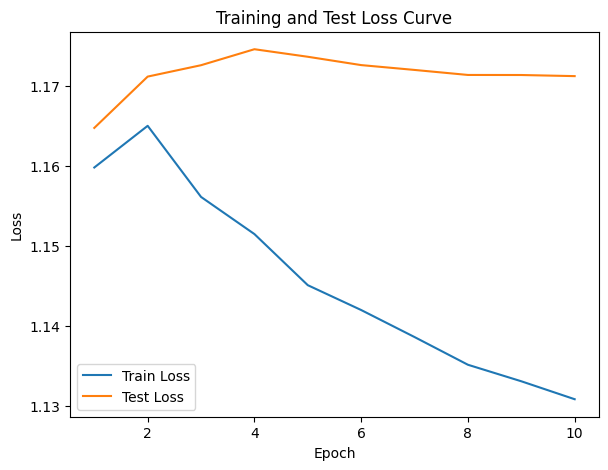

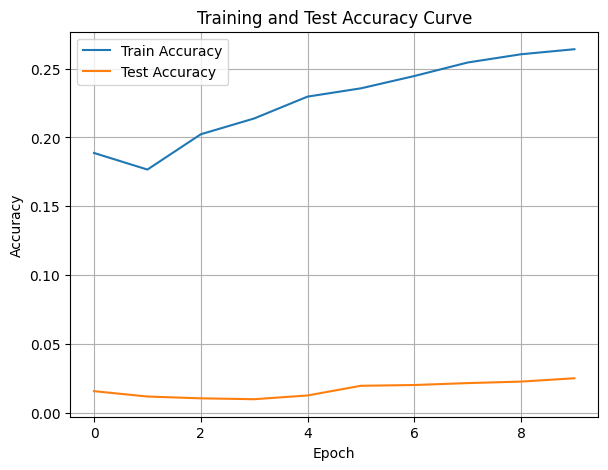

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.83it/s]

Epoch [1/10], Train F1:0.18877252747252748, Train Loss: 1.2339, Train Acc: 0.1295, Test F1:0.25340979083282766, Test Loss: 1.1141, Test Acc: 0.2257
Epoch [2/10], Train F1:0.18974662008029045, Train Loss: 1.2260, Train Acc: 0.1268, Test F1:0.2366594067130234, Test Loss: 1.1158, Test Acc: 0.1914


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.83it/s]

Epoch [3/10], Train F1:0.1965154480639583, Train Loss: 1.2208, Train Acc: 0.1294, Test F1:0.23754679298337286, Test Loss: 1.1148, Test Acc: 0.2002


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.80it/s]

Epoch [4/10], Train F1:0.21017535545988297, Train Loss: 1.2170, Train Acc: 0.1398, Test F1:0.25010789960773866, Test Loss: 1.1130, Test Acc: 0.2140


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.80it/s]

Epoch [5/10], Train F1:0.21412424525733534, Train Loss: 1.2138, Train Acc: 0.1402, Test F1:0.2558639869864092, Test Loss: 1.1124, Test Acc: 0.2097


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.40it/s]

Epoch [6/10], Train F1:0.22729251635512987, Train Loss: 1.2098, Train Acc: 0.1502, Test F1:0.26071607849758405, Test Loss: 1.1118, Test Acc: 0.2025


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.39it/s]

Epoch [7/10], Train F1:0.23418250161989082, Train Loss: 1.2065, Train Acc: 0.1571, Test F1:0.2769404251161953, Test Loss: 1.1096, Test Acc: 0.2179


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.39it/s]

Epoch [8/10], Train F1:0.24377718273351323, Train Loss: 1.2038, Train Acc: 0.1619, Test F1:0.29401794386992464, Test Loss: 1.1073, Test Acc: 0.2352


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.72it/s]

Epoch [9/10], Train F1:0.2516155047845406, Train Loss: 1.2012, Train Acc: 0.1664, Test F1:0.30122645284903266, Test Loss: 1.1061, Test Acc: 0.2453


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.72it/s]


Epoch [10/10], Train F1:0.2602970036630162, Train Loss: 1.1984, Train Acc: 0.1731, Test F1:0.32484917999152124, Test Loss: 1.1034, Test Acc: 0.2668
Total Epochs: 10
Train loss start: 1.2029635906219482, Train loss end: 1.1549097299575806
Highest Mean Train Accuracy (over epoch): 0.173125
Test loss start: 1.119009017944336, Test loss end: 1.0795248746871948
Highest mean Test Accuracy (over epoch): 0.26684027777777775


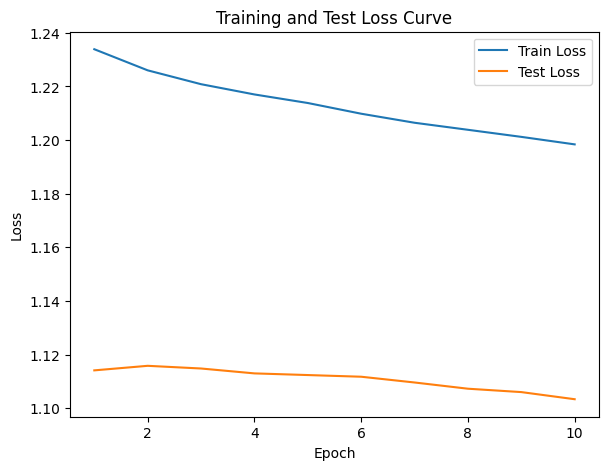

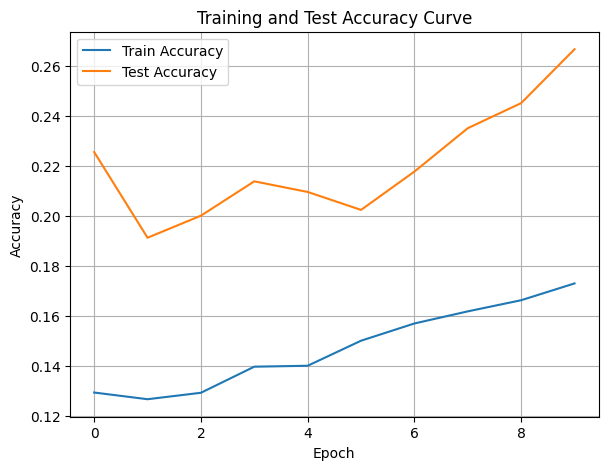

./saved_models/model_8.pth
Training Model with id 9
in multi


Epoch [1/10], Train F1:0.31918396508400926, Train Loss: 1.1603, Train Acc: 0.2702, Test F1:0.1595050428002373, Test Loss: 1.1393, Test Acc: 0.0938


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.44it/s]

Epoch [2/10], Train F1:0.31388035070071296, Train Loss: 1.1617, Train Acc: 0.2555, Test F1:0.1626469027445696, Test Loss: 1.1389, Test Acc: 0.0938


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.44it/s]

Epoch [3/10], Train F1:0.3239417108769134, Train Loss: 1.1591, Train Acc: 0.2680, Test F1:0.17504222844215162, Test Loss: 1.1350, Test Acc: 0.1016


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.90it/s]

Epoch [4/10], Train F1:0.3375223728294109, Train Loss: 1.1545, Train Acc: 0.2789, Test F1:0.16562234176381088, Test Loss: 1.1362, Test Acc: 0.0938


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.90it/s]

Epoch [5/10], Train F1:0.34364906625378355, Train Loss: 1.1519, Train Acc: 0.2857, Test F1:0.16204145550019675, Test Loss: 1.1359, Test Acc: 0.0906


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.37it/s]

Epoch [6/10], Train F1:0.3420403758280885, Train Loss: 1.1513, Train Acc: 0.2857, Test F1:0.17145551782609939, Test Loss: 1.1341, Test Acc: 0.0961


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.37it/s]

Epoch [7/10], Train F1:0.3505538757179387, Train Loss: 1.1492, Train Acc: 0.2960, Test F1:0.1788440698892894, Test Loss: 1.1330, Test Acc: 0.1002


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.95it/s]

Epoch [8/10], Train F1:0.35833332914890165, Train Loss: 1.1454, Train Acc: 0.3051, Test F1:0.1858862002369476, Test Loss: 1.1320, Test Acc: 0.1043
Epoch [9/10], Train F1:0.36229465163194435, Train Loss: 1.1423, Train Acc: 0.3129, Test F1:0.19717716928860515, Test Loss: 1.1307, Test Acc: 0.1145


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.08it/s]


Epoch [10/10], Train F1:0.3694268168617024, Train Loss: 1.1391, Train Acc: 0.3202, Test F1:0.2058259743748291, Test Loss: 1.1292, Test Acc: 0.1213
Total Epochs: 10
Train loss start: 1.1596298217773438, Train loss end: 1.0713855028152466
Highest Mean Train Accuracy (over epoch): 0.3202083333333333
Test loss start: 1.1268843412399292, Test loss end: 1.1154439449310303
Highest mean Test Accuracy (over epoch): 0.12126736111111111


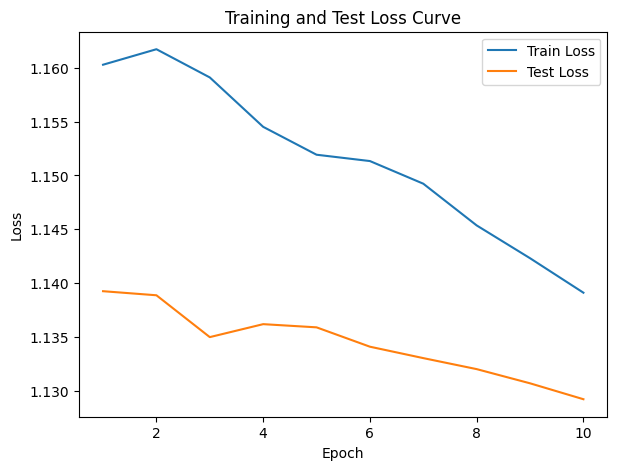

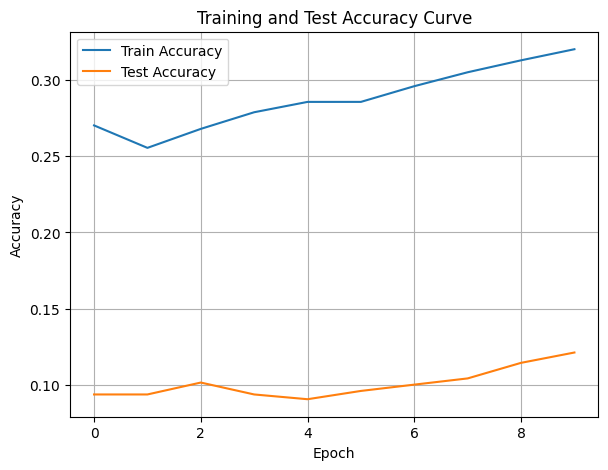

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.97it/s]

Epoch [1/10], Train F1:0.21775176210880107, Train Loss: 1.1761, Train Acc: 0.1616, Test F1:0.17774610607757305, Test Loss: 1.1265, Test Acc: 0.0998
Epoch [2/10], Train F1:0.22589918113584848, Train Loss: 1.1728, Train Acc: 0.1811, Test F1:0.14552331433162274, Test Loss: 1.1317, Test Acc: 0.0803


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.68it/s]

Epoch [3/10], Train F1:0.2214473848223947, Train Loss: 1.1694, Train Acc: 0.1775, Test F1:0.15696773089323998, Test Loss: 1.1291, Test Acc: 0.0868
Epoch [4/10], Train F1:0.22846373735984365, Train Loss: 1.1672, Train Acc: 0.1806, Test F1:0.1800589676508451, Test Loss: 1.1264, Test Acc: 0.1044
Epoch [5/10], Train F1:0.2395425505906587, Train Loss: 1.1627, Train Acc: 0.1872, Test F1:0.19405978337435464, Test Loss: 1.1239, Test Acc: 0.1149


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.69it/s]

Epoch [6/10], Train F1:0.25391429065550475, Train Loss: 1.1579, Train Acc: 0.1997, Test F1:0.21870218617705312, Test Loss: 1.1211, Test Acc: 0.1311
Epoch [7/10], Train F1:0.26119545181322623, Train Loss: 1.1549, Train Acc: 0.2051, Test F1:0.225762386118445, Test Loss: 1.1191, Test Acc: 0.1370
Epoch [8/10], Train F1:0.26811125292365456, Train Loss: 1.1512, Train Acc: 0.2121, Test F1:0.2344774924372065, Test Loss: 1.1173, Test Acc: 0.1434


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.51it/s]


Epoch [9/10], Train F1:0.27569267601820463, Train Loss: 1.1474, Train Acc: 0.2175, Test F1:0.24286493746327542, Test Loss: 1.1159, Test Acc: 0.1500
Epoch [10/10], Train F1:0.29057760402539257, Train Loss: 1.1430, Train Acc: 0.2283, Test F1:0.2514770534426357, Test Loss: 1.1148, Test Acc: 0.1554
Total Epochs: 10
Train loss start: 1.1705249547958374, Train loss end: 1.1371461153030396
Highest Mean Train Accuracy (over epoch): 0.22827380952380955
Test loss start: 1.1229802370071411, Test loss end: 1.106245517730713
Highest mean Test Accuracy (over epoch): 0.15538194444444448


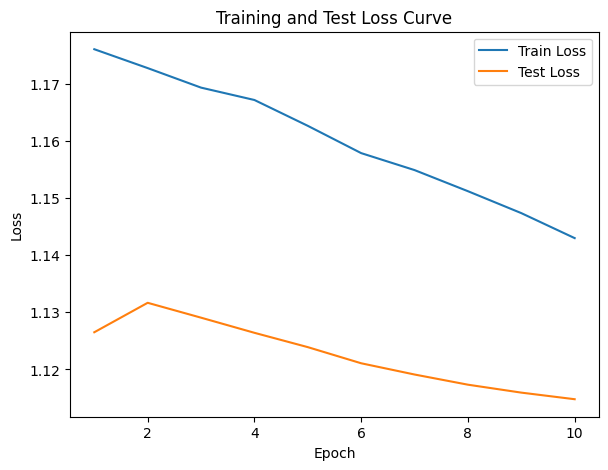

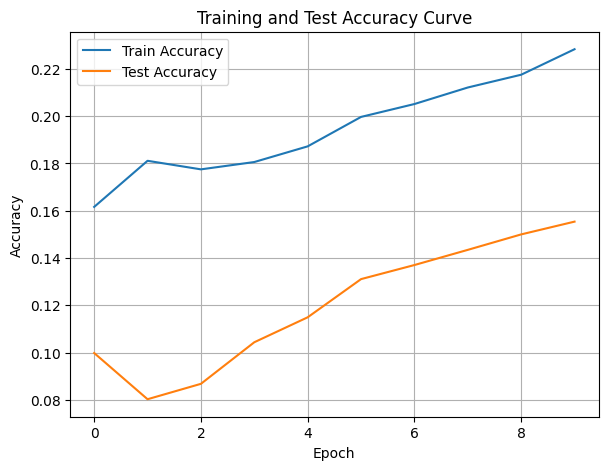

./saved_models/model_10.pth
Training Model with id 14
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.32it/s]

Epoch [1/10], Train F1:0.40139051911021456, Train Loss: 1.1143, Train Acc: 0.3265, Test F1:0.38224348750664544, Test Loss: 1.0958, Test Acc: 0.2569
Epoch [2/10], Train F1:0.4067046877173459, Train Loss: 1.1075, Train Acc: 0.3305, Test F1:0.3427232224462457, Test Loss: 1.0972, Test Acc: 0.2257
Epoch [3/10], Train F1:0.4086777384145966, Train Loss: 1.1049, Train Acc: 0.3347, Test F1:0.3696623303762404, Test Loss: 1.0962, Test Acc: 0.2439


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.75it/s]

Epoch [4/10], Train F1:0.4336737685552111, Train Loss: 1.0977, Train Acc: 0.3524, Test F1:0.4008953054956331, Test Loss: 1.0930, Test Acc: 0.2732
Epoch [5/10], Train F1:0.4501915219004543, Train Loss: 1.0922, Train Acc: 0.3676, Test F1:0.4193791281647108, Test Loss: 1.0902, Test Acc: 0.2924


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.31it/s]

Epoch [6/10], Train F1:0.45194513620975546, Train Loss: 1.0902, Train Acc: 0.3687, Test F1:0.44886392055931496, Test Loss: 1.0875, Test Acc: 0.3241
Epoch [7/10], Train F1:0.46564174026406013, Train Loss: 1.0856, Train Acc: 0.3831, Test F1:0.47558391407061146, Test Loss: 1.0856, Test Acc: 0.3532


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.68it/s]

Epoch [8/10], Train F1:0.47433217145931933, Train Loss: 1.0816, Train Acc: 0.3924, Test F1:0.49912570922757676, Test Loss: 1.0836, Test Acc: 0.3781
Epoch [9/10], Train F1:0.4856596351885421, Train Loss: 1.0775, Train Acc: 0.4055, Test F1:0.5050445168376605, Test Loss: 1.0821, Test Acc: 0.3837


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.17it/s]


Epoch [10/10], Train F1:0.49468840522930313, Train Loss: 1.0745, Train Acc: 0.4156, Test F1:0.522978821819143, Test Loss: 1.0800, Test Acc: 0.4022
Total Epochs: 10
Train loss start: 1.0980101823806763, Train loss end: 1.0664033889770508
Highest Mean Train Accuracy (over epoch): 0.415625
Test loss start: 1.0973268747329712, Test loss end: 1.0601013898849487
Highest mean Test Accuracy (over epoch): 0.4021701388888889


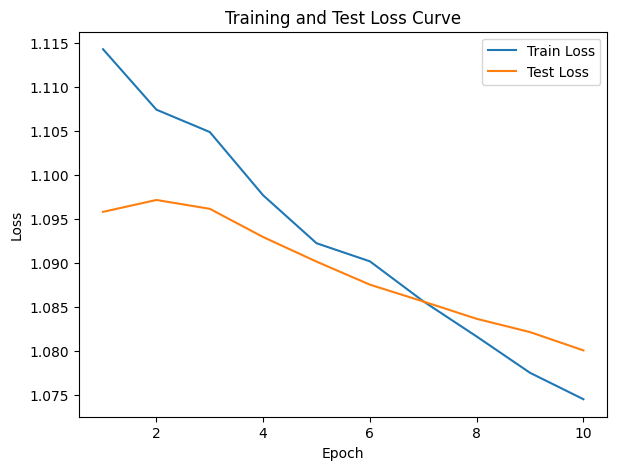

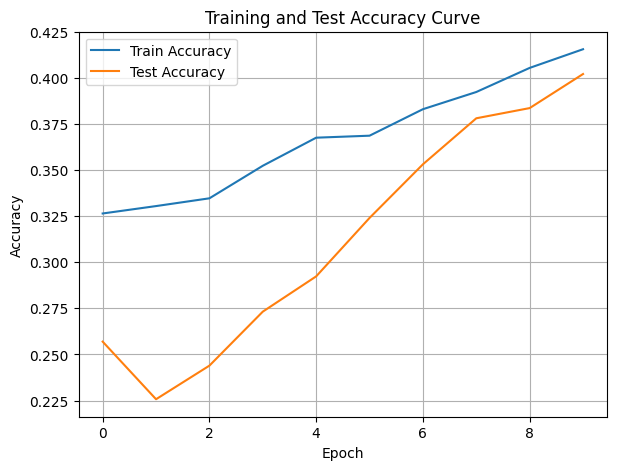

./saved_models/model_14.pth
Training Model with id 17
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.35it/s]

Epoch [1/10], Train F1:0.6151045866858256, Train Loss: 1.0360, Train Acc: 0.5440, Test F1:0.7353816257189241, Test Loss: 1.0520, Test Acc: 0.6840
Epoch [2/10], Train F1:0.6150420834471773, Train Loss: 1.0292, Train Acc: 0.5446, Test F1:0.7463696155894247, Test Loss: 1.0483, Test Acc: 0.7214


Training Process:  20%|██        | 2/10 [00:00<00:00, 13.35it/s]

Epoch [3/10], Train F1:0.6143987067323358, Train Loss: 1.0298, Train Acc: 0.5444, Test F1:0.7472563154703347, Test Loss: 1.0487, Test Acc: 0.7219


Epoch [4/10], Train F1:0.6203665644369283, Train Loss: 1.0288, Train Acc: 0.5448, Test F1:0.7465248941964918, Test Loss: 1.0480, Test Acc: 0.7144


Training Process:  40%|████      | 4/10 [00:00<00:00, 13.11it/s]

Epoch [5/10], Train F1:0.6382469112528277, Train Loss: 1.0219, Train Acc: 0.5725, Test F1:0.7506921096513055, Test Loss: 1.0464, Test Acc: 0.7292


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.39it/s]

Epoch [6/10], Train F1:0.6457416292229696, Train Loss: 1.0178, Train Acc: 0.5836, Test F1:0.7552057793735361, Test Loss: 1.0453, Test Acc: 0.7341


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.39it/s]

Epoch [7/10], Train F1:0.6562849907697138, Train Loss: 1.0133, Train Acc: 0.5981, Test F1:0.7573358174196554, Test Loss: 1.0430, Test Acc: 0.7418


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.78it/s]

Epoch [8/10], Train F1:0.6649091245488108, Train Loss: 1.0102, Train Acc: 0.6079, Test F1:0.7572625202297208, Test Loss: 1.0422, Test Acc: 0.7402


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.78it/s]

Epoch [9/10], Train F1:0.6737378712452791, Train Loss: 1.0056, Train Acc: 0.6190, Test F1:0.7622964721174161, Test Loss: 1.0403, Test Acc: 0.7482


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.55it/s]


Epoch [10/10], Train F1:0.6840459964474849, Train Loss: 1.0011, Train Acc: 0.6295, Test F1:0.7642501737748696, Test Loss: 1.0385, Test Acc: 0.7530
Total Epochs: 10
Train loss start: 0.9849260449409485, Train loss end: 1.0979416370391846
Highest Mean Train Accuracy (over epoch): 0.6294642857142857
Test loss start: 1.0545533895492554, Test loss end: 1.0133503675460815
Highest mean Test Accuracy (over epoch): 0.7529513888888889


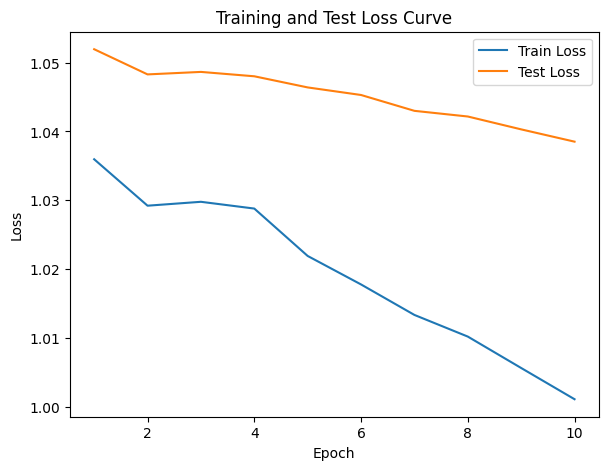

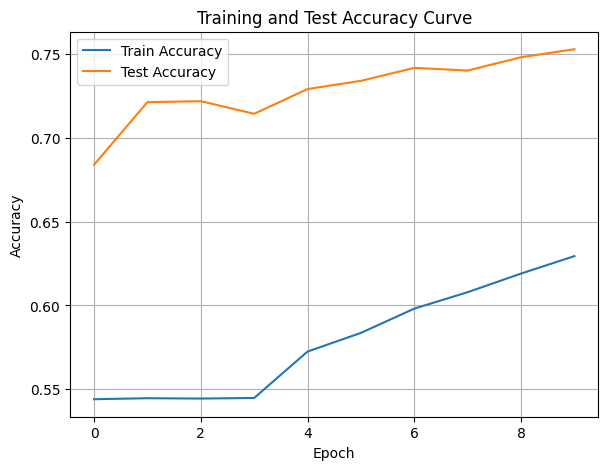

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.89it/s]

Epoch [1/10], Train F1:0.7302503506970008, Train Loss: 0.9615, Train Acc: 0.7176, Test F1:0.7930563555285074, Test Loss: 1.0225, Test Acc: 0.8038
Epoch [2/10], Train F1:0.7258712344685195, Train Loss: 0.9624, Train Acc: 0.7070, Test F1:0.801259212173334, Test Loss: 1.0178, Test Acc: 0.8116


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.89it/s]

Epoch [3/10], Train F1:0.7411212321183522, Train Loss: 0.9578, Train Acc: 0.7276, Test F1:0.7935345321554383, Test Loss: 1.0150, Test Acc: 0.8064


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.92it/s]

Epoch [4/10], Train F1:0.7529530853999507, Train Loss: 0.9528, Train Acc: 0.7383, Test F1:0.8032666623227008, Test Loss: 1.0139, Test Acc: 0.8136


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.62it/s]

Epoch [5/10], Train F1:0.7596420968616542, Train Loss: 0.9488, Train Acc: 0.7462, Test F1:0.8005454269557641, Test Loss: 1.0098, Test Acc: 0.8116


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.97it/s]

Epoch [6/10], Train F1:0.761281072642461, Train Loss: 0.9471, Train Acc: 0.7466, Test F1:0.8044184535412605, Test Loss: 1.0073, Test Acc: 0.8142


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.29it/s]

Epoch [7/10], Train F1:0.7636195833856455, Train Loss: 0.9436, Train Acc: 0.7491, Test F1:0.8067125701156135, Test Loss: 1.0051, Test Acc: 0.8161


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.52it/s]

Epoch [8/10], Train F1:0.7711691097244217, Train Loss: 0.9396, Train Acc: 0.7561, Test F1:0.8056114905919461, Test Loss: 1.0032, Test Acc: 0.8155


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.63it/s]

Epoch [9/10], Train F1:0.7733558011585808, Train Loss: 0.9376, Train Acc: 0.7566, Test F1:0.8060090968161143, Test Loss: 1.0007, Test Acc: 0.8160


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.26it/s]


Epoch [10/10], Train F1:0.7778466079651131, Train Loss: 0.9337, Train Acc: 0.7622, Test F1:0.8051976484009173, Test Loss: 0.9982, Test Acc: 0.8155
Total Epochs: 10
Train loss start: 0.9141207337379456, Train loss end: 0.880013108253479
Highest Mean Train Accuracy (over epoch): 0.7621726190476191
Test loss start: 1.0236798524856567, Test loss end: 0.9631580710411072
Highest mean Test Accuracy (over epoch): 0.8160962301587302


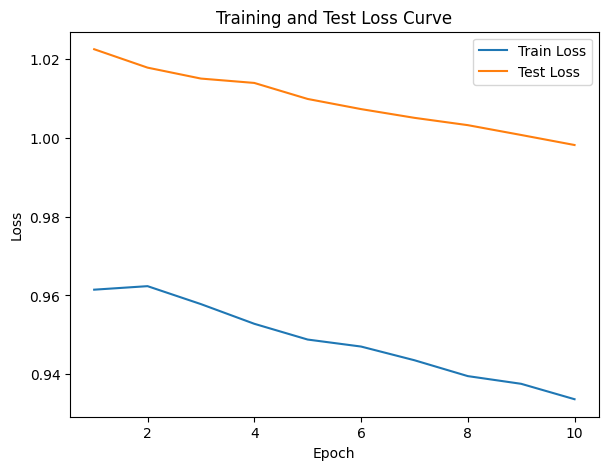

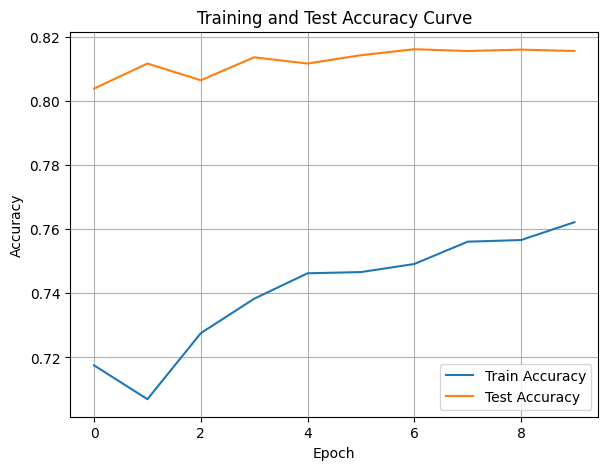

./saved_models/model_15.pth
Training Model with id 13
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.78it/s]

Epoch [1/10], Train F1:0.8066989599029731, Train Loss: 0.9034, Train Acc: 0.7955, Test F1:0.809188640263333, Test Loss: 0.9769, Test Acc: 0.8194
Epoch [2/10], Train F1:0.802212592937215, Train Loss: 0.8963, Train Acc: 0.7887, Test F1:0.7903849037452276, Test Loss: 0.9725, Test Acc: 0.8077


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.17it/s]

Epoch [3/10], Train F1:0.8014701754303383, Train Loss: 0.8964, Train Acc: 0.7903, Test F1:0.7967026140615845, Test Loss: 0.9712, Test Acc: 0.8116
Epoch [4/10], Train F1:0.8076042787293478, Train Loss: 0.8941, Train Acc: 0.7973, Test F1:0.8055139409755889, Test Loss: 0.9703, Test Acc: 0.8175


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.87it/s]

Epoch [5/10], Train F1:0.8137348702879945, Train Loss: 0.8922, Train Acc: 0.8021, Test F1:0.8068567184567741, Test Loss: 0.9691, Test Acc: 0.8179
Epoch [6/10], Train F1:0.8170252568741956, Train Loss: 0.8894, Train Acc: 0.8066, Test F1:0.8029217155195532, Test Loss: 0.9656, Test Acc: 0.8155


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.12it/s]

Epoch [7/10], Train F1:0.8164648018220214, Train Loss: 0.8876, Train Acc: 0.8050, Test F1:0.8022028704985256, Test Loss: 0.9629, Test Acc: 0.8150
Epoch [8/10], Train F1:0.8194515489068579, Train Loss: 0.8832, Train Acc: 0.8085, Test F1:0.7998178618549352, Test Loss: 0.9603, Test Acc: 0.8136


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.44it/s]


Epoch [9/10], Train F1:0.8208086913281214, Train Loss: 0.8804, Train Acc: 0.8097, Test F1:0.7992217910647161, Test Loss: 0.9588, Test Acc: 0.8134
Epoch [10/10], Train F1:0.8218864741102054, Train Loss: 0.8775, Train Acc: 0.8119, Test F1:0.7987448998334332, Test Loss: 0.9576, Test Acc: 0.8132
Total Epochs: 10
Train loss start: 0.8777573108673096, Train loss end: 0.8677521347999573
Highest Mean Train Accuracy (over epoch): 0.8119345238095238
Test loss start: 0.9779376983642578, Test loss end: 0.9347970485687256
Highest mean Test Accuracy (over epoch): 0.8194444444444444


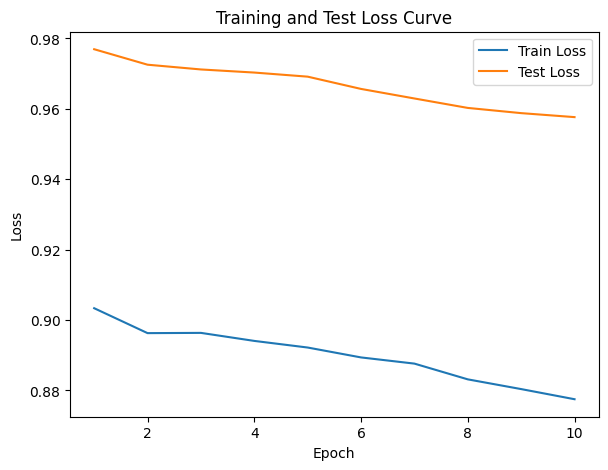

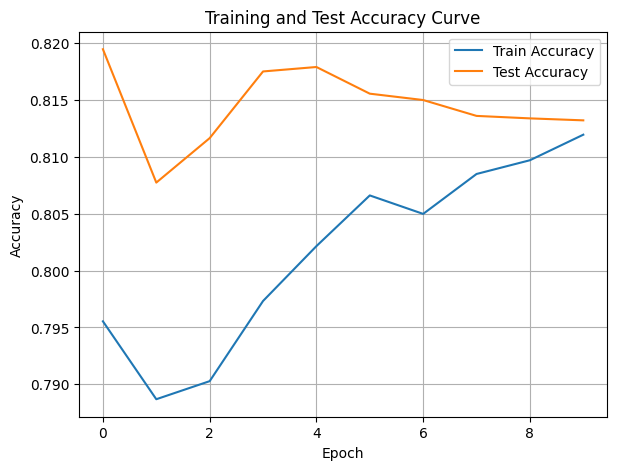

./saved_models/model_13.pth
Training Model with id 15
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.54it/s]

Epoch [1/10], Train F1:0.8109381236820408, Train Loss: 0.8544, Train Acc: 0.8006, Test F1:0.8384395331763752, Test Loss: 0.9442, Test Acc: 0.8490
Epoch [2/10], Train F1:0.8352445511201255, Train Loss: 0.8448, Train Acc: 0.8262, Test F1:0.8113378302052159, Test Loss: 0.9353, Test Acc: 0.8264


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.54it/s]

Epoch [3/10], Train F1:0.8370125199534181, Train Loss: 0.8411, Train Acc: 0.8323, Test F1:0.8131837408415308, Test Loss: 0.9337, Test Acc: 0.8287


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.63it/s]

Epoch [4/10], Train F1:0.8433158750225754, Train Loss: 0.8349, Train Acc: 0.8401, Test F1:0.8057644110275689, Test Loss: 0.9311, Test Acc: 0.8225


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.63it/s]

Epoch [5/10], Train F1:0.8493612594719413, Train Loss: 0.8294, Train Acc: 0.8483, Test F1:0.8057644110275689, Test Loss: 0.9268, Test Acc: 0.8231


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.86it/s]

Epoch [6/10], Train F1:0.8483860469047613, Train Loss: 0.8284, Train Acc: 0.8493, Test F1:0.8094860130676637, Test Loss: 0.9245, Test Acc: 0.8261


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.86it/s]

Epoch [7/10], Train F1:0.8501762626606808, Train Loss: 0.8259, Train Acc: 0.8513, Test F1:0.812129654421326, Test Loss: 0.9226, Test Acc: 0.8282


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.82it/s]

Epoch [8/10], Train F1:0.848796010334097, Train Loss: 0.8246, Train Acc: 0.8512, Test F1:0.8141045003954644, Test Loss: 0.9214, Test Acc: 0.8299


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.82it/s]

Epoch [9/10], Train F1:0.8484921161282488, Train Loss: 0.8234, Train Acc: 0.8520, Test F1:0.8156358729561907, Test Loss: 0.9194, Test Acc: 0.8311


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.24it/s]


Epoch [10/10], Train F1:0.8520378991040142, Train Loss: 0.8208, Train Acc: 0.8559, Test F1:0.8168580871044796, Test Loss: 0.9187, Test Acc: 0.8321
Total Epochs: 10
Train loss start: 0.8071431517601013, Train loss end: 0.7319236993789673
Highest Mean Train Accuracy (over epoch): 0.8559226190476191
Test loss start: 0.9454488754272461, Test loss end: 0.8980673551559448
Highest mean Test Accuracy (over epoch): 0.8489583333333334


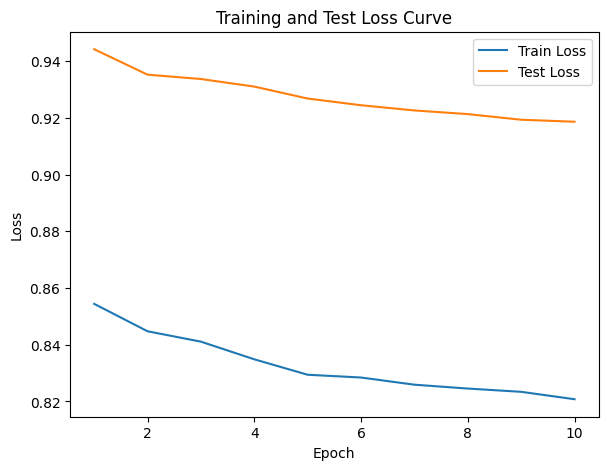

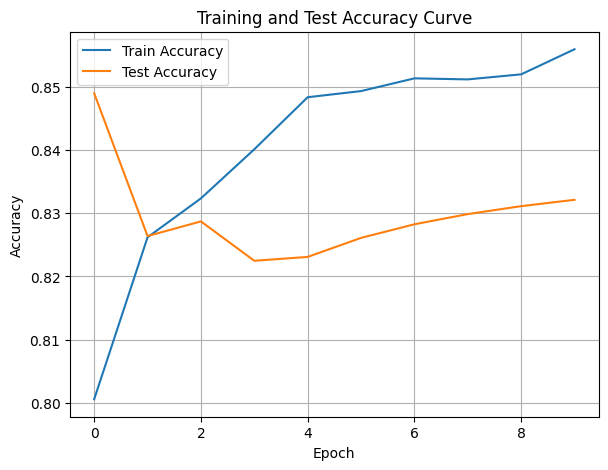

./saved_models/model_15.pth
Training Model with id 18
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8752246952474484, Train Loss: 0.7975, Train Acc: 0.8833, Test F1:0.8277456174443104, Test Loss: 0.8999, Test Acc: 0.8411


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.22it/s]

Epoch [2/10], Train F1:0.8650486505581374, Train Loss: 0.7936, Train Acc: 0.8740, Test F1:0.8331160226851115, Test Loss: 0.8968, Test Acc: 0.8451
Epoch [3/10], Train F1:0.8578629616148103, Train Loss: 0.7960, Train Acc: 0.8599, Test F1:0.8205095347063313, Test Loss: 0.8929, Test Acc: 0.8359


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.98it/s]

Epoch [4/10], Train F1:0.8552655385470886, Train Loss: 0.7951, Train Acc: 0.8595, Test F1:0.8168580871044796, Test Loss: 0.8930, Test Acc: 0.8333
Epoch [5/10], Train F1:0.8549205263539159, Train Loss: 0.7932, Train Acc: 0.8590, Test F1:0.8102274526506564, Test Loss: 0.8919, Test Acc: 0.8274


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.96it/s]

Epoch [6/10], Train F1:0.8555231556877012, Train Loss: 0.7913, Train Acc: 0.8582, Test F1:0.8057644110275689, Test Loss: 0.8906, Test Acc: 0.8235
Epoch [7/10], Train F1:0.8564081836639644, Train Loss: 0.7894, Train Acc: 0.8592, Test F1:0.8009436029588006, Test Loss: 0.8893, Test Acc: 0.8196


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.73it/s]

Epoch [8/10], Train F1:0.8577320594017391, Train Loss: 0.7879, Train Acc: 0.8615, Test F1:0.8001361406658556, Test Loss: 0.8880, Test Acc: 0.8193
Epoch [9/10], Train F1:0.8568818192278811, Train Loss: 0.7853, Train Acc: 0.8613, Test F1:0.7995073162733596, Test Loss: 0.8860, Test Acc: 0.8192


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.87it/s]


Epoch [10/10], Train F1:0.8581052015328171, Train Loss: 0.7836, Train Acc: 0.8624, Test F1:0.8001361406658556, Test Loss: 0.8842, Test Acc: 0.8198
Total Epochs: 10
Train loss start: 0.8008076548576355, Train loss end: 0.7550193071365356
Highest Mean Train Accuracy (over epoch): 0.8833333333333333
Test loss start: 0.8916805386543274, Test loss end: 0.8527734279632568
Highest mean Test Accuracy (over epoch): 0.8450520833333334


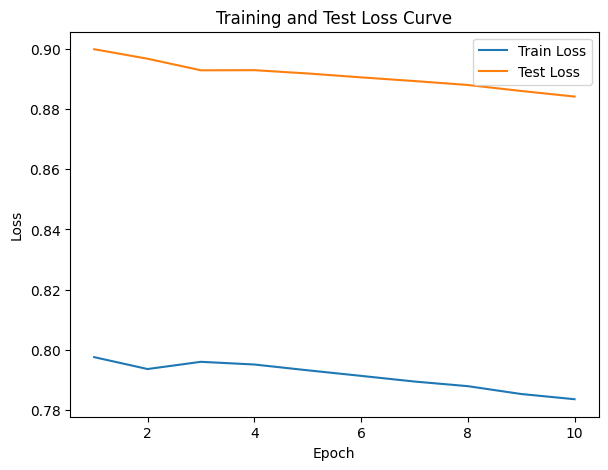

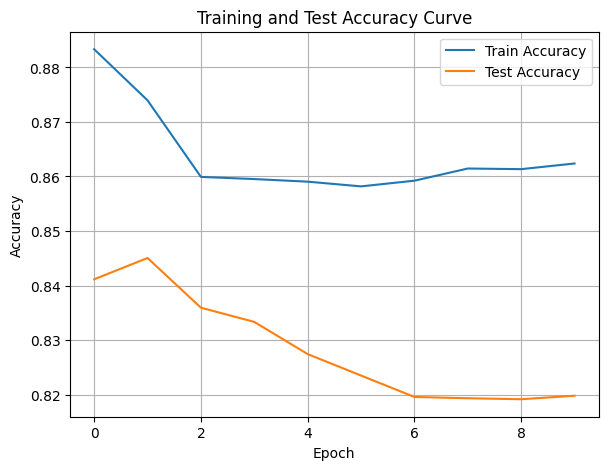

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.99it/s]

Epoch [1/10], Train F1:0.8682159237289905, Train Loss: 0.7729, Train Acc: 0.8696, Test F1:0.8384395331763752, Test Loss: 0.8682, Test Acc: 0.8490


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.99it/s]

Epoch [2/10], Train F1:0.8698843584919534, Train Loss: 0.7634, Train Acc: 0.8754, Test F1:0.8223268197594258, Test Loss: 0.8700, Test Acc: 0.8372


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.31it/s]

Epoch [3/10], Train F1:0.8737364287829494, Train Loss: 0.7607, Train Acc: 0.8802, Test F1:0.8205095347063313, Test Loss: 0.8694, Test Acc: 0.8359


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.63it/s]

Epoch [4/10], Train F1:0.872659822321315, Train Loss: 0.7605, Train Acc: 0.8799, Test F1:0.8168580871044796, Test Loss: 0.8668, Test Acc: 0.8333
Epoch [5/10], Train F1:0.8698372889607684, Train Loss: 0.7611, Train Acc: 0.8762, Test F1:0.8146562578695544, Test Loss: 0.8634, Test Acc: 0.8318


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.73it/s]

Epoch [6/10], Train F1:0.8678748329304342, Train Loss: 0.7628, Train Acc: 0.8712, Test F1:0.8131837408415308, Test Loss: 0.8613, Test Acc: 0.8307
Epoch [7/10], Train F1:0.8698507657500869, Train Loss: 0.7614, Train Acc: 0.8717, Test F1:0.8184257693266582, Test Loss: 0.8597, Test Acc: 0.8344


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.02it/s]

Epoch [8/10], Train F1:0.8672854664744456, Train Loss: 0.7617, Train Acc: 0.8694, Test F1:0.8182300377676112, Test Loss: 0.8585, Test Acc: 0.8343
Epoch [9/10], Train F1:0.865869223679703, Train Loss: 0.7605, Train Acc: 0.8688, Test F1:0.8168580871044796, Test Loss: 0.8565, Test Acc: 0.8333


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.05it/s]


Epoch [10/10], Train F1:0.8671923107366144, Train Loss: 0.7579, Train Acc: 0.8707, Test F1:0.820145406824877, Test Loss: 0.8556, Test Acc: 0.8357
Total Epochs: 10
Train loss start: 0.7490852475166321, Train loss end: 0.6201173663139343
Highest Mean Train Accuracy (over epoch): 0.8801587301587303
Test loss start: 0.8597996830940247, Test loss end: 0.8375652432441711
Highest mean Test Accuracy (over epoch): 0.8489583333333334


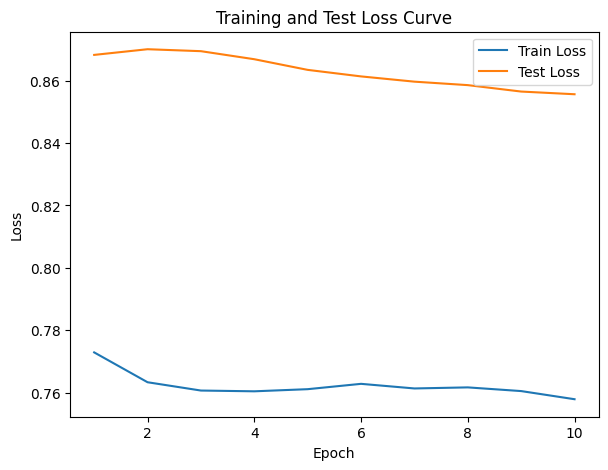

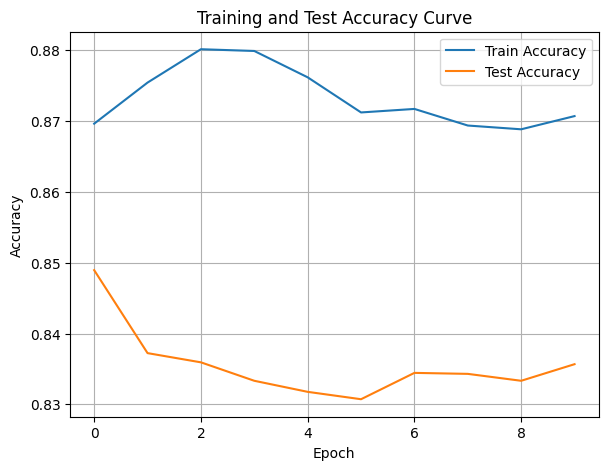

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.31it/s]

Epoch [1/10], Train F1:0.8667616397839489, Train Loss: 0.7476, Train Acc: 0.8696, Test F1:0.8592931124413203, Test Loss: 0.8357, Test Acc: 0.8646
Epoch [2/10], Train F1:0.8786361375127246, Train Loss: 0.7397, Train Acc: 0.8838, Test F1:0.8437176036086195, Test Loss: 0.8358, Test Acc: 0.8529


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.31it/s]

Epoch [3/10], Train F1:0.8710645351320496, Train Loss: 0.7445, Train Acc: 0.8706, Test F1:0.8384395331763752, Test Loss: 0.8343, Test Acc: 0.8490


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.08it/s]

Epoch [4/10], Train F1:0.8736667106946246, Train Loss: 0.7429, Train Acc: 0.8735, Test F1:0.8410841591133484, Test Loss: 0.8332, Test Acc: 0.8509


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.08it/s]

Epoch [5/10], Train F1:0.8728162382913047, Train Loss: 0.7426, Train Acc: 0.8732, Test F1:0.8447678899769738, Test Loss: 0.8339, Test Acc: 0.8536


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.89it/s]

Epoch [6/10], Train F1:0.8706290336575183, Train Loss: 0.7414, Train Acc: 0.8728, Test F1:0.8437176036086194, Test Loss: 0.8337, Test Acc: 0.8529
Epoch [7/10], Train F1:0.8701148221017915, Train Loss: 0.7410, Train Acc: 0.8723, Test F1:0.8459660752583351, Test Loss: 0.8330, Test Acc: 0.8545


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.48it/s]

Epoch [8/10], Train F1:0.8699639825057884, Train Loss: 0.7395, Train Acc: 0.8722, Test F1:0.8410841591133484, Test Loss: 0.8318, Test Acc: 0.8509
Epoch [9/10], Train F1:0.8706929607833813, Train Loss: 0.7379, Train Acc: 0.8729, Test F1:0.8372605083229645, Test Loss: 0.8302, Test Acc: 0.8481


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.55it/s]


Epoch [10/10], Train F1:0.8708011665164218, Train Loss: 0.7375, Train Acc: 0.8730, Test F1:0.8394987366544121, Test Loss: 0.8287, Test Acc: 0.8497
Total Epochs: 10
Train loss start: 0.7625638842582703, Train loss end: 0.7331034541130066
Highest Mean Train Accuracy (over epoch): 0.8837797619047619
Test loss start: 0.8204459547996521, Test loss end: 0.8078795671463013
Highest mean Test Accuracy (over epoch): 0.8645833333333334


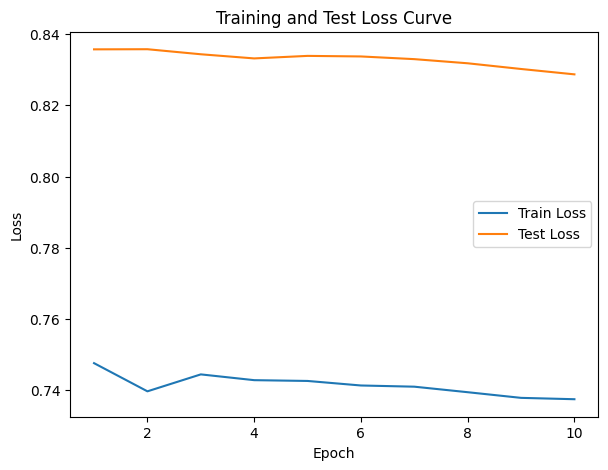

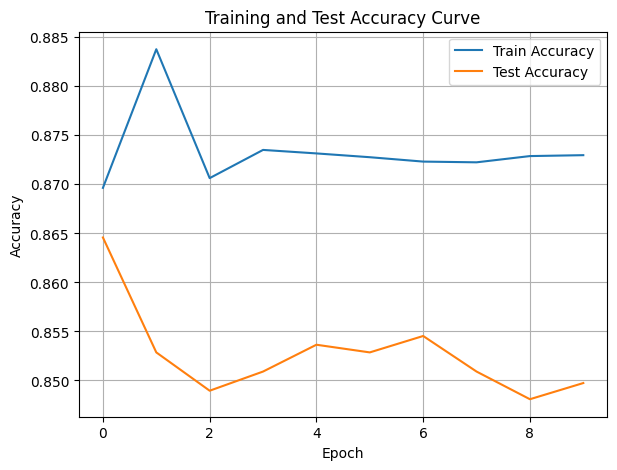

./saved_models/model_14.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8739044678844011, Train Loss: 0.7267, Train Acc: 0.8833, Test F1:0.8592931124413203, Test Loss: 0.8139, Test Acc: 0.8646


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.01it/s]

Epoch [2/10], Train F1:0.8782912689305444, Train Loss: 0.7178, Train Acc: 0.8838, Test F1:0.8541430384153257, Test Loss: 0.8131, Test Acc: 0.8607


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.93it/s]

Epoch [3/10], Train F1:0.8746947260202592, Train Loss: 0.7243, Train Acc: 0.8766, Test F1:0.8384395331763752, Test Loss: 0.8136, Test Acc: 0.8490
Epoch [4/10], Train F1:0.8789419436853763, Train Loss: 0.7188, Train Acc: 0.8806, Test F1:0.830436774485415, Test Loss: 0.8122, Test Acc: 0.8431


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.44it/s]

Epoch [5/10], Train F1:0.8784078797456724, Train Loss: 0.7175, Train Acc: 0.8815, Test F1:0.8363156623070144, Test Loss: 0.8117, Test Acc: 0.8474
Epoch [6/10], Train F1:0.8768675794138683, Train Loss: 0.7184, Train Acc: 0.8799, Test F1:0.8402038682508941, Test Loss: 0.8098, Test Acc: 0.8503


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.34it/s]

Epoch [7/10], Train F1:0.877121190642452, Train Loss: 0.7186, Train Acc: 0.8799, Test F1:0.8354031836086772, Test Loss: 0.8089, Test Acc: 0.8467
Epoch [8/10], Train F1:0.8779029031219827, Train Loss: 0.7175, Train Acc: 0.8805, Test F1:0.8357835478691967, Test Loss: 0.8071, Test Acc: 0.8470


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.59it/s]


Epoch [9/10], Train F1:0.878798054016828, Train Loss: 0.7172, Train Acc: 0.8811, Test F1:0.8337098126698507, Test Loss: 0.8055, Test Acc: 0.8455
Epoch [10/10], Train F1:0.8790180981921414, Train Loss: 0.7164, Train Acc: 0.8812, Test F1:0.8320457405125598, Test Loss: 0.8038, Test Acc: 0.8443
Total Epochs: 10
Train loss start: 0.6972264051437378, Train loss end: 0.685900866985321
Highest Mean Train Accuracy (over epoch): 0.8837797619047619
Test loss start: 0.7981735467910767, Test loss end: 0.7788218855857849
Highest mean Test Accuracy (over epoch): 0.8645833333333334


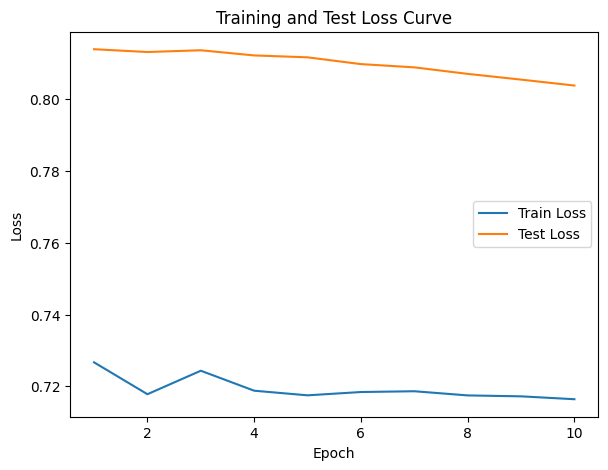

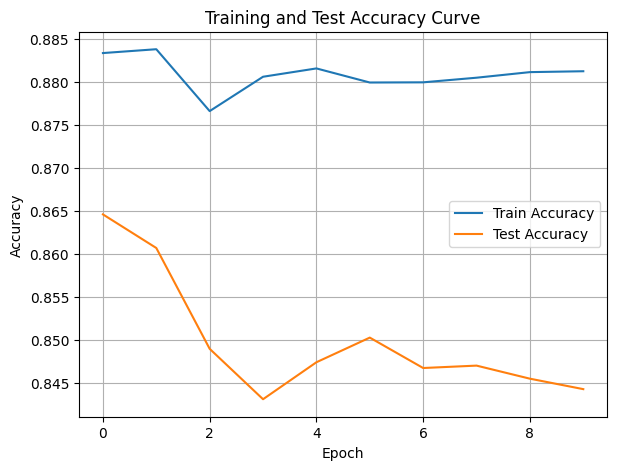

./saved_models/model_12.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [80]:
DTEmlp10b.train_DTE()

Training Process:   1%|          | 1/190 [00:00<00:21,  8.94it/s]

Epoch [1/190], Train F1:0.3340462646162128, Train Loss: 1.1384, Train Acc: 0.2804, Test F1:0.6435145240149552, Test Loss: 1.0677, Test Acc: 0.5938


Training Process:   1%|          | 2/190 [00:00<00:20,  9.08it/s]

Epoch [2/190], Train F1:0.35279536789740873, Train Loss: 1.1226, Train Acc: 0.3082, Test F1:0.6362665193166644, Test Loss: 1.0609, Test Acc: 0.6037


Training Process:   2%|▏         | 3/190 [00:00<00:21,  8.72it/s]

Epoch [3/190], Train F1:0.3629469872460527, Train Loss: 1.1187, Train Acc: 0.3163, Test F1:0.6333761076636278, Test Loss: 1.0547, Test Acc: 0.6163


Training Process:   2%|▏         | 4/190 [00:00<00:21,  8.70it/s]

Epoch [4/190], Train F1:0.36918481562189903, Train Loss: 1.1186, Train Acc: 0.3206, Test F1:0.6344993000185658, Test Loss: 1.0495, Test Acc: 0.6230


Training Process:   3%|▎         | 5/190 [00:00<00:20,  9.06it/s]

Epoch [5/190], Train F1:0.3720953334901691, Train Loss: 1.1160, Train Acc: 0.3251, Test F1:0.6416040100250626, Test Loss: 1.0472, Test Acc: 0.6306


Training Process:   3%|▎         | 6/190 [00:00<00:20,  8.94it/s]

Epoch [6/190], Train F1:0.3817399641935429, Train Loss: 1.1107, Train Acc: 0.3347, Test F1:0.6494609752916292, Test Loss: 1.0448, Test Acc: 0.6369


Training Process:   4%|▎         | 7/190 [00:00<00:20,  9.11it/s]

Epoch [7/190], Train F1:0.3880950428216219, Train Loss: 1.1060, Train Acc: 0.3401, Test F1:0.6540631522607009, Test Loss: 1.0423, Test Acc: 0.6414


Training Process:   4%|▍         | 8/190 [00:00<00:23,  7.76it/s]

Epoch [8/190], Train F1:0.39825137287607015, Train Loss: 1.1034, Train Acc: 0.3477, Test F1:0.663353169143344, Test Loss: 1.0408, Test Acc: 0.6529


Training Process:   5%|▍         | 9/190 [00:01<00:22,  8.05it/s]

Epoch [9/190], Train F1:0.40406774782660354, Train Loss: 1.1002, Train Acc: 0.3542, Test F1:0.6690949264112079, Test Loss: 1.0378, Test Acc: 0.6610


Training Process:   5%|▌         | 10/190 [00:01<00:22,  8.18it/s]

Epoch [10/190], Train F1:0.4127798439299333, Train Loss: 1.0962, Train Acc: 0.3624, Test F1:0.6720331824562903, Test Loss: 1.0354, Test Acc: 0.6661


Training Process:   6%|▌         | 11/190 [00:01<00:21,  8.17it/s]

Epoch [11/190], Train F1:0.4214974316374685, Train Loss: 1.0921, Train Acc: 0.3696, Test F1:0.6756859032665862, Test Loss: 1.0334, Test Acc: 0.6722


Training Process:   6%|▋         | 12/190 [00:01<00:23,  7.61it/s]

Epoch [12/190], Train F1:0.43136918660362517, Train Loss: 1.0882, Train Acc: 0.3787, Test F1:0.68223881303312, Test Loss: 1.0318, Test Acc: 0.6798


Training Process:   7%|▋         | 13/190 [00:01<00:23,  7.65it/s]

Epoch [13/190], Train F1:0.4347365219137638, Train Loss: 1.0846, Train Acc: 0.3829, Test F1:0.6846459584194836, Test Loss: 1.0308, Test Acc: 0.6821


Training Process:   7%|▋         | 14/190 [00:01<00:22,  7.70it/s]

Epoch [14/190], Train F1:0.4422919222163713, Train Loss: 1.0804, Train Acc: 0.3902, Test F1:0.6897720491705454, Test Loss: 1.0296, Test Acc: 0.6874


Training Process:   8%|▊         | 15/190 [00:01<00:22,  7.74it/s]

Epoch [15/190], Train F1:0.4502255099362008, Train Loss: 1.0772, Train Acc: 0.3968, Test F1:0.6939884194292012, Test Loss: 1.0286, Test Acc: 0.6910


Training Process:   8%|▊         | 16/190 [00:01<00:22,  7.58it/s]

Epoch [16/190], Train F1:0.4566973614376122, Train Loss: 1.0739, Train Acc: 0.4021, Test F1:0.697606899991753, Test Loss: 1.0273, Test Acc: 0.6955


Training Process:   9%|▉         | 17/190 [00:02<00:22,  7.59it/s]

Epoch [17/190], Train F1:0.4613215185097768, Train Loss: 1.0712, Train Acc: 0.4069, Test F1:0.7004790110246515, Test Loss: 1.0267, Test Acc: 0.6974


Training Process:   9%|▉         | 18/190 [00:02<00:22,  7.59it/s]

Epoch [18/190], Train F1:0.46913199928255056, Train Loss: 1.0677, Train Acc: 0.4151, Test F1:0.7048564672081318, Test Loss: 1.0255, Test Acc: 0.7016


Training Process:  10%|█         | 19/190 [00:02<00:22,  7.56it/s]

Epoch [19/190], Train F1:0.4747920575903949, Train Loss: 1.0642, Train Acc: 0.4220, Test F1:0.70863024913741, Test Loss: 1.0250, Test Acc: 0.7039


Training Process:  11%|█         | 21/190 [00:02<00:26,  6.43it/s]

Epoch [20/190], Train F1:0.48290111083593507, Train Loss: 1.0598, Train Acc: 0.4311, Test F1:0.7108866726401496, Test Loss: 1.0238, Test Acc: 0.7054
Epoch [21/190], Train F1:0.49050754306614874, Train Loss: 1.0562, Train Acc: 0.4391, Test F1:0.7149238928199583, Test Loss: 1.0221, Test Acc: 0.7094


Training Process:  12%|█▏        | 23/190 [00:03<00:25,  6.42it/s]

Epoch [22/190], Train F1:0.4981243465896731, Train Loss: 1.0523, Train Acc: 0.4476, Test F1:0.7193058250112774, Test Loss: 1.0202, Test Acc: 0.7137
Epoch [23/190], Train F1:0.5058314246551839, Train Loss: 1.0492, Train Acc: 0.4544, Test F1:0.7230449378974665, Test Loss: 1.0186, Test Acc: 0.7172


Training Process:  13%|█▎        | 25/190 [00:03<00:25,  6.42it/s]

Epoch [24/190], Train F1:0.5135959108900902, Train Loss: 1.0454, Train Acc: 0.4626, Test F1:0.7273681048205748, Test Loss: 1.0167, Test Acc: 0.7215
Epoch [25/190], Train F1:0.5196929298167808, Train Loss: 1.0420, Train Acc: 0.4693, Test F1:0.7313373160759022, Test Loss: 1.0149, Test Acc: 0.7254


Training Process:  14%|█▍        | 27/190 [00:03<00:25,  6.30it/s]

Epoch [26/190], Train F1:0.5269664923653399, Train Loss: 1.0381, Train Acc: 0.4768, Test F1:0.7340594350730306, Test Loss: 1.0133, Test Acc: 0.7281
Epoch [27/190], Train F1:0.5341585060473206, Train Loss: 1.0348, Train Acc: 0.4837, Test F1:0.7352008641741019, Test Loss: 1.0121, Test Acc: 0.7285


Training Process:  15%|█▌        | 29/190 [00:03<00:23,  6.76it/s]

Epoch [28/190], Train F1:0.5413843015713884, Train Loss: 1.0312, Train Acc: 0.4912, Test F1:0.7372184054688591, Test Loss: 1.0108, Test Acc: 0.7302
Epoch [29/190], Train F1:0.5478544821812968, Train Loss: 1.0283, Train Acc: 0.4975, Test F1:0.7344249615739298, Test Loss: 1.0100, Test Acc: 0.7267


Training Process:  16%|█▋        | 31/190 [00:04<00:21,  7.24it/s]

Epoch [30/190], Train F1:0.5548058079408051, Train Loss: 1.0251, Train Acc: 0.5046, Test F1:0.736131044503925, Test Loss: 1.0088, Test Acc: 0.7283
Epoch [31/190], Train F1:0.562054603936156, Train Loss: 1.0215, Train Acc: 0.5116, Test F1:0.736853611934167, Test Loss: 1.0074, Test Acc: 0.7284


Training Process:  17%|█▋        | 32/190 [00:04<00:21,  7.24it/s]

Epoch [32/190], Train F1:0.5690735786519907, Train Loss: 1.0182, Train Acc: 0.5193, Test F1:0.7382432341982552, Test Loss: 1.0059, Test Acc: 0.7298


Training Process:  17%|█▋        | 33/190 [00:04<00:26,  5.90it/s]

Epoch [33/190], Train F1:0.5748505088251479, Train Loss: 1.0151, Train Acc: 0.5252, Test F1:0.738288179818473, Test Loss: 1.0047, Test Acc: 0.7294
Epoch [34/190], Train F1:0.5801403612296643, Train Loss: 1.0123, Train Acc: 0.5308, Test F1:0.7395163779175781, Test Loss: 1.0034, Test Acc: 0.7301


Training Process:  19%|█▉        | 36/190 [00:05<00:25,  5.98it/s]

Epoch [35/190], Train F1:0.5864803096520006, Train Loss: 1.0094, Train Acc: 0.5367, Test F1:0.7408495323675042, Test Loss: 1.0021, Test Acc: 0.7312
Epoch [36/190], Train F1:0.5916028487677041, Train Loss: 1.0066, Train Acc: 0.5426, Test F1:0.7430089271869744, Test Loss: 1.0009, Test Acc: 0.7329


Training Process:  20%|██        | 38/190 [00:05<00:24,  6.11it/s]

Epoch [37/190], Train F1:0.5986384474566725, Train Loss: 1.0032, Train Acc: 0.5501, Test F1:0.7446522529040492, Test Loss: 0.9997, Test Acc: 0.7341
Epoch [38/190], Train F1:0.6044244488440821, Train Loss: 1.0000, Train Acc: 0.5562, Test F1:0.7467615903242298, Test Loss: 0.9983, Test Acc: 0.7362


Training Process:  21%|██        | 40/190 [00:05<00:26,  5.65it/s]

Epoch [39/190], Train F1:0.6103376298083715, Train Loss: 0.9968, Train Acc: 0.5623, Test F1:0.7489281658065353, Test Loss: 0.9967, Test Acc: 0.7385
Epoch [40/190], Train F1:0.6155826517180684, Train Loss: 0.9939, Train Acc: 0.5678, Test F1:0.7510262758865629, Test Loss: 0.9953, Test Acc: 0.7408


Training Process:  22%|██▏       | 41/190 [00:05<00:26,  5.58it/s]

Epoch [41/190], Train F1:0.6204105346414814, Train Loss: 0.9912, Train Acc: 0.5727, Test F1:0.7525017128308702, Test Loss: 0.9940, Test Acc: 0.7418


Training Process:  23%|██▎       | 43/190 [00:06<00:27,  5.44it/s]

Epoch [42/190], Train F1:0.6255962949425341, Train Loss: 0.9881, Train Acc: 0.5784, Test F1:0.7531627172036613, Test Loss: 0.9928, Test Acc: 0.7421
Epoch [43/190], Train F1:0.6298840343440503, Train Loss: 0.9851, Train Acc: 0.5833, Test F1:0.7548567501637121, Test Loss: 0.9917, Test Acc: 0.7438


Training Process:  23%|██▎       | 44/190 [00:06<00:26,  5.43it/s]

Epoch [44/190], Train F1:0.6348478741247745, Train Loss: 0.9819, Train Acc: 0.5886, Test F1:0.7566930623019366, Test Loss: 0.9906, Test Acc: 0.7456


Training Process:  24%|██▎       | 45/190 [00:06<00:27,  5.36it/s]

Epoch [45/190], Train F1:0.6398209050869904, Train Loss: 0.9791, Train Acc: 0.5939, Test F1:0.7570246133675453, Test Loss: 0.9896, Test Acc: 0.7456


Training Process:  24%|██▍       | 46/190 [00:07<00:30,  4.68it/s]

Epoch [46/190], Train F1:0.6446573261882527, Train Loss: 0.9760, Train Acc: 0.5993, Test F1:0.7593759145780871, Test Loss: 0.9882, Test Acc: 0.7480


Training Process:  25%|██▍       | 47/190 [00:07<00:30,  4.66it/s]

Epoch [47/190], Train F1:0.6492091385115445, Train Loss: 0.9731, Train Acc: 0.6042, Test F1:0.7607876478501465, Test Loss: 0.9870, Test Acc: 0.7494


Training Process:  25%|██▌       | 48/190 [00:07<00:30,  4.69it/s]

Epoch [48/190], Train F1:0.6533372729059728, Train Loss: 0.9703, Train Acc: 0.6088, Test F1:0.7621394916478798, Test Loss: 0.9856, Test Acc: 0.7506


Training Process:  26%|██▌       | 49/190 [00:07<00:30,  4.67it/s]

Epoch [49/190], Train F1:0.6572118030794334, Train Loss: 0.9677, Train Acc: 0.6131, Test F1:0.7636323189556007, Test Loss: 0.9841, Test Acc: 0.7521


Training Process:  27%|██▋       | 51/190 [00:08<00:28,  4.94it/s]

Epoch [50/190], Train F1:0.6616422463429945, Train Loss: 0.9648, Train Acc: 0.6180, Test F1:0.7645723664147316, Test Loss: 0.9829, Test Acc: 0.7529
Epoch [51/190], Train F1:0.6655026394764806, Train Loss: 0.9623, Train Acc: 0.6223, Test F1:0.7657955726938003, Test Loss: 0.9817, Test Acc: 0.7541


Training Process:  28%|██▊       | 53/190 [00:08<00:26,  5.23it/s]

Epoch [52/190], Train F1:0.6690244470074993, Train Loss: 0.9597, Train Acc: 0.6262, Test F1:0.7674635502361155, Test Loss: 0.9801, Test Acc: 0.7560
Epoch [53/190], Train F1:0.6726236774321473, Train Loss: 0.9572, Train Acc: 0.6304, Test F1:0.7685852121260451, Test Loss: 0.9789, Test Acc: 0.7571


Training Process:  29%|██▉       | 55/190 [00:08<00:24,  5.60it/s]

Epoch [54/190], Train F1:0.6760135503549413, Train Loss: 0.9547, Train Acc: 0.6344, Test F1:0.7696642662930473, Test Loss: 0.9775, Test Acc: 0.7580
Epoch [55/190], Train F1:0.6796247249825861, Train Loss: 0.9522, Train Acc: 0.6381, Test F1:0.7711506964544651, Test Loss: 0.9761, Test Acc: 0.7595


Training Process:  29%|██▉       | 56/190 [00:08<00:24,  5.52it/s]

Epoch [56/190], Train F1:0.6830944053544463, Train Loss: 0.9496, Train Acc: 0.6420, Test F1:0.7722902242914489, Test Loss: 0.9748, Test Acc: 0.7606


Training Process:  30%|███       | 57/190 [00:09<00:27,  4.86it/s]

Epoch [57/190], Train F1:0.6864292819099901, Train Loss: 0.9471, Train Acc: 0.6460, Test F1:0.7733889978268149, Test Loss: 0.9736, Test Acc: 0.7616


Training Process:  31%|███       | 58/190 [00:09<00:26,  4.91it/s]

Epoch [58/190], Train F1:0.6893107110278193, Train Loss: 0.9448, Train Acc: 0.6493, Test F1:0.7748024613836634, Test Loss: 0.9722, Test Acc: 0.7632


Training Process:  31%|███       | 59/190 [00:09<00:27,  4.84it/s]

Epoch [59/190], Train F1:0.6928293906635556, Train Loss: 0.9421, Train Acc: 0.6534, Test F1:0.7760756872677534, Test Loss: 0.9709, Test Acc: 0.7644


Training Process:  32%|███▏      | 60/190 [00:09<00:27,  4.80it/s]

Epoch [60/190], Train F1:0.6955642686454478, Train Loss: 0.9399, Train Acc: 0.6565, Test F1:0.7774660692225001, Test Loss: 0.9695, Test Acc: 0.7658


Training Process:  32%|███▏      | 61/190 [00:10<00:26,  4.79it/s]

Epoch [61/190], Train F1:0.6986676493018934, Train Loss: 0.9375, Train Acc: 0.6600, Test F1:0.779079956505717, Test Loss: 0.9679, Test Acc: 0.7674


Training Process:  33%|███▎      | 62/190 [00:10<00:27,  4.73it/s]

Epoch [62/190], Train F1:0.7012621027263698, Train Loss: 0.9350, Train Acc: 0.6632, Test F1:0.7804870035102572, Test Loss: 0.9664, Test Acc: 0.7689


Training Process:  33%|███▎      | 63/190 [00:10<00:26,  4.79it/s]

Epoch [63/190], Train F1:0.7035349838848745, Train Loss: 0.9330, Train Acc: 0.6658, Test F1:0.7813487182019623, Test Loss: 0.9652, Test Acc: 0.7697


Training Process:  34%|███▎      | 64/190 [00:10<00:26,  4.84it/s]

Epoch [64/190], Train F1:0.706387031677566, Train Loss: 0.9308, Train Acc: 0.6689, Test F1:0.7824400253201237, Test Loss: 0.9640, Test Acc: 0.7707


Training Process:  34%|███▍      | 65/190 [00:10<00:25,  4.83it/s]

Epoch [65/190], Train F1:0.7087168870842546, Train Loss: 0.9287, Train Acc: 0.6716, Test F1:0.78360331215819, Test Loss: 0.9626, Test Acc: 0.7719


Training Process:  35%|███▍      | 66/190 [00:11<00:25,  4.81it/s]

Epoch [66/190], Train F1:0.7111087108709191, Train Loss: 0.9265, Train Acc: 0.6744, Test F1:0.7847515020671793, Test Loss: 0.9613, Test Acc: 0.7730


Training Process:  35%|███▌      | 67/190 [00:11<00:25,  4.80it/s]

Epoch [67/190], Train F1:0.7140099049335025, Train Loss: 0.9244, Train Acc: 0.6775, Test F1:0.7856194418195747, Test Loss: 0.9602, Test Acc: 0.7738


Training Process:  36%|███▌      | 68/190 [00:11<00:28,  4.36it/s]

Epoch [68/190], Train F1:0.7162434675211359, Train Loss: 0.9223, Train Acc: 0.6802, Test F1:0.7865630850232428, Test Loss: 0.9588, Test Acc: 0.7748


Training Process:  36%|███▋      | 69/190 [00:11<00:27,  4.38it/s]

Epoch [69/190], Train F1:0.7188673689548248, Train Loss: 0.9202, Train Acc: 0.6830, Test F1:0.7873790380654511, Test Loss: 0.9576, Test Acc: 0.7755


Training Process:  37%|███▋      | 70/190 [00:12<00:26,  4.46it/s]

Epoch [70/190], Train F1:0.721335050122506, Train Loss: 0.9182, Train Acc: 0.6857, Test F1:0.7882890049498252, Test Loss: 0.9565, Test Acc: 0.7764


Training Process:  37%|███▋      | 71/190 [00:12<00:26,  4.55it/s]

Epoch [71/190], Train F1:0.7234233183957856, Train Loss: 0.9162, Train Acc: 0.6881, Test F1:0.7868281912971256, Test Loss: 0.9557, Test Acc: 0.7749


Training Process:  38%|███▊      | 72/190 [00:12<00:25,  4.63it/s]

Epoch [72/190], Train F1:0.7253324610353032, Train Loss: 0.9142, Train Acc: 0.6904, Test F1:0.7869714037588875, Test Loss: 0.9547, Test Acc: 0.7751


Training Process:  38%|███▊      | 73/190 [00:12<00:24,  4.70it/s]

Epoch [73/190], Train F1:0.7276099760700688, Train Loss: 0.9121, Train Acc: 0.6930, Test F1:0.7857892561181516, Test Loss: 0.9539, Test Acc: 0.7739


Training Process:  39%|███▉      | 74/190 [00:12<00:24,  4.72it/s]

Epoch [74/190], Train F1:0.729638036211913, Train Loss: 0.9101, Train Acc: 0.6954, Test F1:0.78463626298999, Test Loss: 0.9531, Test Acc: 0.7726


Training Process:  39%|███▉      | 75/190 [00:13<00:24,  4.78it/s]

Epoch [75/190], Train F1:0.7319094968817672, Train Loss: 0.9080, Train Acc: 0.6981, Test F1:0.7857383732766571, Test Loss: 0.9519, Test Acc: 0.7738


Training Process:  40%|████      | 76/190 [00:13<00:23,  4.78it/s]

Epoch [76/190], Train F1:0.7338508938979494, Train Loss: 0.9061, Train Acc: 0.7004, Test F1:0.7867029740188795, Test Loss: 0.9507, Test Acc: 0.7747


Training Process:  41%|████      | 77/190 [00:13<00:23,  4.77it/s]

Epoch [77/190], Train F1:0.7359155373478561, Train Loss: 0.9041, Train Acc: 0.7028, Test F1:0.7877337798360536, Test Loss: 0.9495, Test Acc: 0.7758


Training Process:  41%|████      | 78/190 [00:13<00:23,  4.74it/s]

Epoch [78/190], Train F1:0.7378373782303065, Train Loss: 0.9023, Train Acc: 0.7050, Test F1:0.7884365528789732, Test Loss: 0.9484, Test Acc: 0.7765


Training Process:  42%|████▏     | 79/190 [00:13<00:25,  4.29it/s]

Epoch [79/190], Train F1:0.7398811894512762, Train Loss: 0.9003, Train Acc: 0.7075, Test F1:0.7894192609135107, Test Loss: 0.9471, Test Acc: 0.7775


Training Process:  42%|████▏     | 80/190 [00:14<00:25,  4.24it/s]

Epoch [80/190], Train F1:0.7418988393934162, Train Loss: 0.8983, Train Acc: 0.7099, Test F1:0.7899801259593627, Test Loss: 0.9460, Test Acc: 0.7780


Training Process:  43%|████▎     | 81/190 [00:14<00:25,  4.23it/s]

Epoch [81/190], Train F1:0.7438092287345678, Train Loss: 0.8964, Train Acc: 0.7122, Test F1:0.7906288024956126, Test Loss: 0.9449, Test Acc: 0.7785


Training Process:  43%|████▎     | 82/190 [00:14<00:25,  4.24it/s]

Epoch [82/190], Train F1:0.745312452325015, Train Loss: 0.8946, Train Acc: 0.7141, Test F1:0.791276074526176, Test Loss: 0.9440, Test Acc: 0.7792


Training Process:  44%|████▎     | 83/190 [00:14<00:25,  4.21it/s]

Epoch [83/190], Train F1:0.7470206700819345, Train Loss: 0.8927, Train Acc: 0.7161, Test F1:0.7921770628619422, Test Loss: 0.9428, Test Acc: 0.7800


Training Process:  44%|████▍     | 84/190 [00:15<00:25,  4.18it/s]

Epoch [84/190], Train F1:0.7487945381315884, Train Loss: 0.8911, Train Acc: 0.7180, Test F1:0.7925655193225091, Test Loss: 0.9418, Test Acc: 0.7804


Training Process:  45%|████▍     | 85/190 [00:15<00:25,  4.12it/s]

Epoch [85/190], Train F1:0.7502639808805831, Train Loss: 0.8895, Train Acc: 0.7197, Test F1:0.7931528444521639, Test Loss: 0.9407, Test Acc: 0.7809


Training Process:  45%|████▌     | 86/190 [00:15<00:25,  4.09it/s]

Epoch [86/190], Train F1:0.7516158347159986, Train Loss: 0.8879, Train Acc: 0.7214, Test F1:0.7939183075947432, Test Loss: 0.9396, Test Acc: 0.7817


Training Process:  46%|████▌     | 87/190 [00:15<00:25,  4.07it/s]

Epoch [87/190], Train F1:0.753402107342532, Train Loss: 0.8862, Train Acc: 0.7235, Test F1:0.7944763971710493, Test Loss: 0.9385, Test Acc: 0.7822


Training Process:  46%|████▋     | 88/190 [00:16<00:24,  4.08it/s]

Epoch [88/190], Train F1:0.7550413431090557, Train Loss: 0.8845, Train Acc: 0.7253, Test F1:0.7949145494076046, Test Loss: 0.9375, Test Acc: 0.7827


Training Process:  47%|████▋     | 89/190 [00:16<00:24,  4.14it/s]

Epoch [89/190], Train F1:0.7565425545101732, Train Loss: 0.8828, Train Acc: 0.7271, Test F1:0.7954487438536445, Test Loss: 0.9365, Test Acc: 0.7832


Training Process:  47%|████▋     | 90/190 [00:16<00:25,  3.88it/s]

Epoch [90/190], Train F1:0.7578326144192058, Train Loss: 0.8812, Train Acc: 0.7287, Test F1:0.7961413952267817, Test Loss: 0.9354, Test Acc: 0.7839


Training Process:  48%|████▊     | 91/190 [00:16<00:25,  3.90it/s]

Epoch [91/190], Train F1:0.759363979112831, Train Loss: 0.8796, Train Acc: 0.7304, Test F1:0.7971687931833382, Test Loss: 0.9342, Test Acc: 0.7850


Training Process:  48%|████▊     | 92/190 [00:17<00:24,  3.92it/s]

Epoch [92/190], Train F1:0.7606931290077233, Train Loss: 0.8781, Train Acc: 0.7319, Test F1:0.7972503771120053, Test Loss: 0.9334, Test Acc: 0.7851


Training Process:  49%|████▉     | 93/190 [00:17<00:24,  3.92it/s]

Epoch [93/190], Train F1:0.7620112096952196, Train Loss: 0.8766, Train Acc: 0.7334, Test F1:0.7975710844137083, Test Loss: 0.9325, Test Acc: 0.7854


Training Process:  49%|████▉     | 94/190 [00:17<00:24,  3.98it/s]

Epoch [94/190], Train F1:0.7635400021072662, Train Loss: 0.8749, Train Acc: 0.7352, Test F1:0.7981360385555132, Test Loss: 0.9314, Test Acc: 0.7860


Training Process:  50%|█████     | 95/190 [00:17<00:24,  3.95it/s]

Epoch [95/190], Train F1:0.7646359179597844, Train Loss: 0.8736, Train Acc: 0.7364, Test F1:0.7981168288576205, Test Loss: 0.9306, Test Acc: 0.7860


Training Process:  51%|█████     | 96/190 [00:18<00:23,  3.96it/s]

Epoch [96/190], Train F1:0.7659422968114429, Train Loss: 0.8721, Train Acc: 0.7380, Test F1:0.7989102719777232, Test Loss: 0.9295, Test Acc: 0.7868


Training Process:  51%|█████     | 97/190 [00:18<00:23,  3.88it/s]

Epoch [97/190], Train F1:0.7673562735363626, Train Loss: 0.8706, Train Acc: 0.7397, Test F1:0.7996022167844063, Test Loss: 0.9285, Test Acc: 0.7875


Training Process:  52%|█████▏    | 98/190 [00:18<00:23,  3.83it/s]

Epoch [98/190], Train F1:0.7688138541805385, Train Loss: 0.8690, Train Acc: 0.7414, Test F1:0.8000388428944044, Test Loss: 0.9275, Test Acc: 0.7879


Training Process:  52%|█████▏    | 99/190 [00:18<00:23,  3.82it/s]

Epoch [99/190], Train F1:0.7703951378669807, Train Loss: 0.8674, Train Acc: 0.7432, Test F1:0.8008723233946196, Test Loss: 0.9263, Test Acc: 0.7888


Training Process:  53%|█████▎    | 100/190 [00:19<00:24,  3.74it/s]

Epoch [100/190], Train F1:0.7716081222175054, Train Loss: 0.8660, Train Acc: 0.7446, Test F1:0.8012988819720904, Test Loss: 0.9254, Test Acc: 0.7892


Training Process:  53%|█████▎    | 101/190 [00:19<00:25,  3.44it/s]

Epoch [101/190], Train F1:0.7728428584551345, Train Loss: 0.8645, Train Acc: 0.7461, Test F1:0.801694314412571, Test Loss: 0.9244, Test Acc: 0.7896


Training Process:  54%|█████▎    | 102/190 [00:19<00:25,  3.47it/s]

Epoch [102/190], Train F1:0.7741779199868701, Train Loss: 0.8630, Train Acc: 0.7477, Test F1:0.8024060674274476, Test Loss: 0.9233, Test Acc: 0.7903


Training Process:  54%|█████▍    | 103/190 [00:20<00:24,  3.56it/s]

Epoch [103/190], Train F1:0.7753777566637877, Train Loss: 0.8616, Train Acc: 0.7492, Test F1:0.8028051526846587, Test Loss: 0.9225, Test Acc: 0.7907


Training Process:  55%|█████▍    | 104/190 [00:20<00:23,  3.63it/s]

Epoch [104/190], Train F1:0.7764934491216668, Train Loss: 0.8602, Train Acc: 0.7506, Test F1:0.8036515304739895, Test Loss: 0.9214, Test Acc: 0.7916


Training Process:  55%|█████▌    | 105/190 [00:20<00:23,  3.67it/s]

Epoch [105/190], Train F1:0.7776281438719437, Train Loss: 0.8587, Train Acc: 0.7520, Test F1:0.8041777227309089, Test Loss: 0.9203, Test Acc: 0.7921


Training Process:  56%|█████▌    | 106/190 [00:20<00:22,  3.69it/s]

Epoch [106/190], Train F1:0.778654619825763, Train Loss: 0.8574, Train Acc: 0.7531, Test F1:0.8047046569493018, Test Loss: 0.9194, Test Acc: 0.7927


Training Process:  56%|█████▋    | 107/190 [00:21<00:22,  3.69it/s]

Epoch [107/190], Train F1:0.7798488553745783, Train Loss: 0.8560, Train Acc: 0.7545, Test F1:0.8051338296494748, Test Loss: 0.9185, Test Acc: 0.7931


Training Process:  57%|█████▋    | 108/190 [00:21<00:22,  3.72it/s]

Epoch [108/190], Train F1:0.7809592903487974, Train Loss: 0.8547, Train Acc: 0.7559, Test F1:0.8060040085120792, Test Loss: 0.9175, Test Acc: 0.7940


Training Process:  57%|█████▋    | 109/190 [00:21<00:21,  3.68it/s]

Epoch [109/190], Train F1:0.7820913025729039, Train Loss: 0.8534, Train Acc: 0.7571, Test F1:0.8067720207654733, Test Loss: 0.9163, Test Acc: 0.7949


Training Process:  58%|█████▊    | 110/190 [00:22<00:22,  3.64it/s]

Epoch [110/190], Train F1:0.7831813359697407, Train Loss: 0.8522, Train Acc: 0.7584, Test F1:0.8069759095523741, Test Loss: 0.9155, Test Acc: 0.7951


Training Process:  58%|█████▊    | 111/190 [00:22<00:21,  3.61it/s]

Epoch [111/190], Train F1:0.784291358746567, Train Loss: 0.8509, Train Acc: 0.7596, Test F1:0.8077315879053499, Test Loss: 0.9144, Test Acc: 0.7960


Training Process:  59%|█████▉    | 112/190 [00:22<00:23,  3.38it/s]

Epoch [112/190], Train F1:0.7852661669655352, Train Loss: 0.8497, Train Acc: 0.7607, Test F1:0.80805067724084, Test Loss: 0.9136, Test Acc: 0.7962


Training Process:  59%|█████▉    | 113/190 [00:23<00:23,  3.28it/s]

Epoch [113/190], Train F1:0.7862384927046058, Train Loss: 0.8484, Train Acc: 0.7619, Test F1:0.8084174021428536, Test Loss: 0.9127, Test Acc: 0.7966


Training Process:  60%|██████    | 114/190 [00:23<00:23,  3.26it/s]

Epoch [114/190], Train F1:0.7869564423936499, Train Loss: 0.8473, Train Acc: 0.7629, Test F1:0.8074671823763263, Test Loss: 0.9121, Test Acc: 0.7957


Training Process:  61%|██████    | 115/190 [00:23<00:23,  3.24it/s]

Epoch [115/190], Train F1:0.7880316584185719, Train Loss: 0.8460, Train Acc: 0.7642, Test F1:0.807779814544271, Test Loss: 0.9113, Test Acc: 0.7959


Training Process:  61%|██████    | 116/190 [00:23<00:22,  3.23it/s]

Epoch [116/190], Train F1:0.7890099599415193, Train Loss: 0.8447, Train Acc: 0.7653, Test F1:0.8079252856610744, Test Loss: 0.9104, Test Acc: 0.7960


Training Process:  62%|██████▏   | 117/190 [00:24<00:22,  3.31it/s]

Epoch [117/190], Train F1:0.790048175795487, Train Loss: 0.8434, Train Acc: 0.7666, Test F1:0.8081389773273543, Test Loss: 0.9095, Test Acc: 0.7962


Training Process:  62%|██████▏   | 118/190 [00:24<00:21,  3.36it/s]

Epoch [118/190], Train F1:0.7911019975152473, Train Loss: 0.8422, Train Acc: 0.7677, Test F1:0.808349034185682, Test Loss: 0.9086, Test Acc: 0.7964


Training Process:  63%|██████▎   | 119/190 [00:24<00:20,  3.39it/s]

Epoch [119/190], Train F1:0.7918448544331498, Train Loss: 0.8410, Train Acc: 0.7687, Test F1:0.8084534505098818, Test Loss: 0.9080, Test Acc: 0.7965


Training Process:  63%|██████▎   | 120/190 [00:25<00:20,  3.40it/s]

Epoch [120/190], Train F1:0.7926857432442899, Train Loss: 0.8400, Train Acc: 0.7696, Test F1:0.8092090558352815, Test Loss: 0.9070, Test Acc: 0.7973


Training Process:  64%|██████▎   | 121/190 [00:25<00:20,  3.35it/s]

Epoch [121/190], Train F1:0.7935098888720161, Train Loss: 0.8389, Train Acc: 0.7705, Test F1:0.8098838258951618, Test Loss: 0.9060, Test Acc: 0.7981


Training Process:  64%|██████▍   | 122/190 [00:25<00:20,  3.30it/s]

Epoch [122/190], Train F1:0.7942794360369583, Train Loss: 0.8378, Train Acc: 0.7715, Test F1:0.8102761759646983, Test Loss: 0.9051, Test Acc: 0.7985


Training Process:  65%|██████▍   | 123/190 [00:26<00:22,  2.96it/s]

Epoch [123/190], Train F1:0.7950030455965584, Train Loss: 0.8368, Train Acc: 0.7724, Test F1:0.8109224098005374, Test Loss: 0.9041, Test Acc: 0.7992


Training Process:  65%|██████▌   | 124/190 [00:26<00:22,  2.95it/s]

Epoch [124/190], Train F1:0.7958384805820692, Train Loss: 0.8357, Train Acc: 0.7733, Test F1:0.8110507531099311, Test Loss: 0.9034, Test Acc: 0.7993


Training Process:  66%|██████▌   | 125/190 [00:26<00:22,  2.93it/s]

Epoch [125/190], Train F1:0.7966086669688036, Train Loss: 0.8347, Train Acc: 0.7742, Test F1:0.8113181871575011, Test Loss: 0.9027, Test Acc: 0.7996


Training Process:  66%|██████▋   | 126/190 [00:27<00:22,  2.91it/s]

Epoch [126/190], Train F1:0.79747411185522, Train Loss: 0.8336, Train Acc: 0.7752, Test F1:0.81162965875836, Test Loss: 0.9018, Test Acc: 0.7999


Training Process:  67%|██████▋   | 127/190 [00:27<00:21,  2.88it/s]

Epoch [127/190], Train F1:0.7983811114618586, Train Loss: 0.8324, Train Acc: 0.7763, Test F1:0.8121884105606028, Test Loss: 0.9009, Test Acc: 0.8006


Training Process:  67%|██████▋   | 128/190 [00:27<00:21,  2.85it/s]

Epoch [128/190], Train F1:0.7990799801735339, Train Loss: 0.8313, Train Acc: 0.7772, Test F1:0.8125443715248591, Test Loss: 0.9000, Test Acc: 0.8009


Training Process:  68%|██████▊   | 129/190 [00:28<00:20,  2.95it/s]

Epoch [129/190], Train F1:0.8000249055645761, Train Loss: 0.8301, Train Acc: 0.7783, Test F1:0.812847543290384, Test Loss: 0.8993, Test Acc: 0.8012


Training Process:  68%|██████▊   | 130/190 [00:28<00:19,  3.01it/s]

Epoch [130/190], Train F1:0.80109048537789, Train Loss: 0.8291, Train Acc: 0.7794, Test F1:0.8130269509733695, Test Loss: 0.8986, Test Acc: 0.8014


Training Process:  69%|██████▉   | 131/190 [00:28<00:19,  3.06it/s]

Epoch [131/190], Train F1:0.8018404291001611, Train Loss: 0.8280, Train Acc: 0.7803, Test F1:0.8122881081203173, Test Loss: 0.8981, Test Acc: 0.8006


Training Process:  69%|██████▉   | 132/190 [00:29<00:20,  2.85it/s]

Epoch [132/190], Train F1:0.8024891395180785, Train Loss: 0.8270, Train Acc: 0.7812, Test F1:0.811442453924894, Test Loss: 0.8977, Test Acc: 0.7998


Training Process:  70%|███████   | 133/190 [00:29<00:19,  2.86it/s]

Epoch [133/190], Train F1:0.8033272658550034, Train Loss: 0.8259, Train Acc: 0.7821, Test F1:0.811689945199891, Test Loss: 0.8970, Test Acc: 0.8001


Training Process:  71%|███████   | 134/190 [00:29<00:19,  2.88it/s]

Epoch [134/190], Train F1:0.8042044450472632, Train Loss: 0.8248, Train Acc: 0.7831, Test F1:0.8109221324454279, Test Loss: 0.8966, Test Acc: 0.7993


Training Process:  71%|███████   | 135/190 [00:30<00:19,  2.87it/s]

Epoch [135/190], Train F1:0.804970914106173, Train Loss: 0.8237, Train Acc: 0.7841, Test F1:0.8109317532178038, Test Loss: 0.8960, Test Acc: 0.7993


Training Process:  72%|███████▏  | 136/190 [00:30<00:18,  2.87it/s]

Epoch [136/190], Train F1:0.8057905781056758, Train Loss: 0.8226, Train Acc: 0.7851, Test F1:0.8111161492153983, Test Loss: 0.8954, Test Acc: 0.7995


Training Process:  72%|███████▏  | 137/190 [00:30<00:18,  2.82it/s]

Epoch [137/190], Train F1:0.8066963352066946, Train Loss: 0.8214, Train Acc: 0.7861, Test F1:0.8112977722355171, Test Loss: 0.8948, Test Acc: 0.7997


Training Process:  73%|███████▎  | 138/190 [00:31<00:18,  2.77it/s]

Epoch [138/190], Train F1:0.8074588133089932, Train Loss: 0.8203, Train Acc: 0.7871, Test F1:0.8115217516083522, Test Loss: 0.8939, Test Acc: 0.7999


Training Process:  73%|███████▎  | 139/190 [00:31<00:18,  2.73it/s]

Epoch [139/190], Train F1:0.8079537720959398, Train Loss: 0.8196, Train Acc: 0.7876, Test F1:0.8120852026763762, Test Loss: 0.8929, Test Acc: 0.8006


Training Process:  74%|███████▎  | 140/190 [00:32<00:18,  2.76it/s]

Epoch [140/190], Train F1:0.8085229342932542, Train Loss: 0.8186, Train Acc: 0.7884, Test F1:0.8125296623401477, Test Loss: 0.8921, Test Acc: 0.8011


Training Process:  74%|███████▍  | 141/190 [00:32<00:17,  2.83it/s]

Epoch [141/190], Train F1:0.8093179650520582, Train Loss: 0.8176, Train Acc: 0.7893, Test F1:0.8130853470932149, Test Loss: 0.8912, Test Acc: 0.8017


Training Process:  75%|███████▍  | 142/190 [00:32<00:18,  2.67it/s]

Epoch [142/190], Train F1:0.8101497399775032, Train Loss: 0.8165, Train Acc: 0.7903, Test F1:0.81324668092444, Test Loss: 0.8906, Test Acc: 0.8019


Training Process:  75%|███████▌  | 143/190 [00:33<00:17,  2.70it/s]

Epoch [143/190], Train F1:0.8107790450667652, Train Loss: 0.8156, Train Acc: 0.7911, Test F1:0.8133405247187666, Test Loss: 0.8900, Test Acc: 0.8020


Training Process:  76%|███████▌  | 144/190 [00:33<00:16,  2.73it/s]

Epoch [144/190], Train F1:0.8113564628335631, Train Loss: 0.8147, Train Acc: 0.7919, Test F1:0.8127852622154232, Test Loss: 0.8895, Test Acc: 0.8014


Training Process:  76%|███████▋  | 145/190 [00:33<00:16,  2.75it/s]

Epoch [145/190], Train F1:0.812032027803854, Train Loss: 0.8137, Train Acc: 0.7926, Test F1:0.8130021365667843, Test Loss: 0.8889, Test Acc: 0.8016


Training Process:  77%|███████▋  | 146/190 [00:34<00:15,  2.75it/s]

Epoch [146/190], Train F1:0.8127114850391414, Train Loss: 0.8128, Train Acc: 0.7934, Test F1:0.8132020496987763, Test Loss: 0.8881, Test Acc: 0.8018


Training Process:  77%|███████▋  | 147/190 [00:34<00:15,  2.71it/s]

Epoch [147/190], Train F1:0.8134147839157391, Train Loss: 0.8119, Train Acc: 0.7942, Test F1:0.8134061526040489, Test Loss: 0.8875, Test Acc: 0.8020


Training Process:  78%|███████▊  | 148/190 [00:35<00:15,  2.68it/s]

Epoch [148/190], Train F1:0.8140644179463309, Train Loss: 0.8110, Train Acc: 0.7950, Test F1:0.8139857308438833, Test Loss: 0.8866, Test Acc: 0.8026


Training Process:  78%|███████▊  | 149/190 [00:35<00:15,  2.61it/s]

Epoch [149/190], Train F1:0.8146577538940996, Train Loss: 0.8101, Train Acc: 0.7957, Test F1:0.8141818270897336, Test Loss: 0.8860, Test Acc: 0.8028


Training Process:  79%|███████▉  | 150/190 [00:35<00:15,  2.58it/s]

Epoch [150/190], Train F1:0.8152552256200681, Train Loss: 0.8093, Train Acc: 0.7964, Test F1:0.8143752850468873, Test Loss: 0.8854, Test Acc: 0.8030


Training Process:  79%|███████▉  | 151/190 [00:36<00:14,  2.63it/s]

Epoch [151/190], Train F1:0.8159639276734754, Train Loss: 0.8085, Train Acc: 0.7971, Test F1:0.8148820942937736, Test Loss: 0.8845, Test Acc: 0.8035


Training Process:  80%|████████  | 152/190 [00:36<00:14,  2.56it/s]

Epoch [152/190], Train F1:0.8165212364844787, Train Loss: 0.8077, Train Acc: 0.7977, Test F1:0.8148090319155934, Test Loss: 0.8840, Test Acc: 0.8035


Training Process:  81%|████████  | 153/190 [00:37<00:14,  2.61it/s]

Epoch [153/190], Train F1:0.8171106747072426, Train Loss: 0.8068, Train Acc: 0.7985, Test F1:0.8149879314673993, Test Loss: 0.8834, Test Acc: 0.8037


Training Process:  81%|████████  | 154/190 [00:37<00:13,  2.64it/s]

Epoch [154/190], Train F1:0.8177056345974191, Train Loss: 0.8060, Train Acc: 0.7992, Test F1:0.8151645012668967, Test Loss: 0.8827, Test Acc: 0.8038


Training Process:  82%|████████▏ | 155/190 [00:37<00:13,  2.66it/s]

Epoch [155/190], Train F1:0.8182699140920051, Train Loss: 0.8051, Train Acc: 0.7999, Test F1:0.8153387865292214, Test Loss: 0.8820, Test Acc: 0.8040


Training Process:  82%|████████▏ | 156/190 [00:38<00:12,  2.63it/s]

Epoch [156/190], Train F1:0.8188787457709915, Train Loss: 0.8043, Train Acc: 0.8005, Test F1:0.8155108313069981, Test Loss: 0.8814, Test Acc: 0.8041


Training Process:  83%|████████▎ | 157/190 [00:38<00:12,  2.59it/s]

Epoch [157/190], Train F1:0.8194542434419966, Train Loss: 0.8035, Train Acc: 0.8011, Test F1:0.8159254094281312, Test Loss: 0.8806, Test Acc: 0.8046


Training Process:  83%|████████▎ | 158/190 [00:38<00:12,  2.56it/s]

Epoch [158/190], Train F1:0.8200786002776234, Train Loss: 0.8027, Train Acc: 0.8019, Test F1:0.8164000026538115, Test Loss: 0.8798, Test Acc: 0.8052


Training Process:  84%|████████▎ | 159/190 [00:39<00:12,  2.51it/s]

Epoch [159/190], Train F1:0.8206361732733565, Train Loss: 0.8019, Train Acc: 0.8025, Test F1:0.8165621380846434, Test Loss: 0.8791, Test Acc: 0.8053


Training Process:  84%|████████▍ | 160/190 [00:39<00:12,  2.43it/s]

Epoch [160/190], Train F1:0.821161711356641, Train Loss: 0.8011, Train Acc: 0.8032, Test F1:0.8165857108156157, Test Loss: 0.8786, Test Acc: 0.8053


Training Process:  85%|████████▍ | 161/190 [00:40<00:12,  2.37it/s]

Epoch [161/190], Train F1:0.8218328067311282, Train Loss: 0.8003, Train Acc: 0.8039, Test F1:0.8167446521731002, Test Loss: 0.8780, Test Acc: 0.8055


Training Process:  85%|████████▌ | 162/190 [00:40<00:11,  2.44it/s]

Epoch [162/190], Train F1:0.822369538809238, Train Loss: 0.7996, Train Acc: 0.8044, Test F1:0.8172025130480863, Test Loss: 0.8771, Test Acc: 0.8060


Training Process:  86%|████████▌ | 163/190 [00:40<00:10,  2.51it/s]

Epoch [163/190], Train F1:0.8227772104271264, Train Loss: 0.7988, Train Acc: 0.8049, Test F1:0.8174574658076255, Test Loss: 0.8764, Test Acc: 0.8062


Training Process:  86%|████████▋ | 164/190 [00:41<00:10,  2.53it/s]

Epoch [164/190], Train F1:0.8233951946749418, Train Loss: 0.7980, Train Acc: 0.8056, Test F1:0.8175070521457326, Test Loss: 0.8759, Test Acc: 0.8063


Training Process:  87%|████████▋ | 165/190 [00:41<00:09,  2.54it/s]

Epoch [165/190], Train F1:0.8239247534245064, Train Loss: 0.7973, Train Acc: 0.8061, Test F1:0.8176062877484159, Test Loss: 0.8753, Test Acc: 0.8064


Training Process:  87%|████████▋ | 166/190 [00:42<00:09,  2.54it/s]

Epoch [166/190], Train F1:0.8244629368672194, Train Loss: 0.7965, Train Acc: 0.8067, Test F1:0.8170472005395533, Test Loss: 0.8749, Test Acc: 0.8058


Training Process:  88%|████████▊ | 167/190 [00:42<00:09,  2.52it/s]

Epoch [167/190], Train F1:0.8250225550822722, Train Loss: 0.7957, Train Acc: 0.8073, Test F1:0.8171976090105761, Test Loss: 0.8743, Test Acc: 0.8059


Training Process:  88%|████████▊ | 168/190 [00:42<00:08,  2.48it/s]

Epoch [168/190], Train F1:0.8255340062105169, Train Loss: 0.7950, Train Acc: 0.8079, Test F1:0.8173462226240907, Test Loss: 0.8737, Test Acc: 0.8061


Training Process:  89%|████████▉ | 169/190 [00:43<00:08,  2.45it/s]

Epoch [169/190], Train F1:0.8260905035038607, Train Loss: 0.7942, Train Acc: 0.8085, Test F1:0.8177384298886357, Test Loss: 0.8730, Test Acc: 0.8066


Training Process:  89%|████████▉ | 170/190 [00:43<00:08,  2.23it/s]

Epoch [170/190], Train F1:0.8266135208522406, Train Loss: 0.7935, Train Acc: 0.8091, Test F1:0.8179308947453203, Test Loss: 0.8723, Test Acc: 0.8067


Training Process:  90%|█████████ | 171/190 [00:44<00:08,  2.29it/s]

Epoch [171/190], Train F1:0.8271990058028837, Train Loss: 0.7927, Train Acc: 0.8098, Test F1:0.8180241052988008, Test Loss: 0.8717, Test Acc: 0.8068


Training Process:  91%|█████████ | 172/190 [00:44<00:07,  2.38it/s]

Epoch [172/190], Train F1:0.8277119934580569, Train Loss: 0.7919, Train Acc: 0.8104, Test F1:0.8182126649886405, Test Loss: 0.8710, Test Acc: 0.8070


Training Process:  91%|█████████ | 173/190 [00:45<00:07,  2.41it/s]

Epoch [173/190], Train F1:0.8281919285774882, Train Loss: 0.7912, Train Acc: 0.8109, Test F1:0.8183625931868457, Test Loss: 0.8705, Test Acc: 0.8072


Training Process:  92%|█████████▏| 174/190 [00:45<00:06,  2.43it/s]

Epoch [174/190], Train F1:0.8287683601972039, Train Loss: 0.7905, Train Acc: 0.8116, Test F1:0.8185050655801015, Test Loss: 0.8700, Test Acc: 0.8073


Training Process:  92%|█████████▏| 175/190 [00:45<00:06,  2.43it/s]

Epoch [175/190], Train F1:0.8293133887143709, Train Loss: 0.7897, Train Acc: 0.8122, Test F1:0.8186515539026245, Test Loss: 0.8695, Test Acc: 0.8075


Training Process:  93%|█████████▎| 176/190 [00:46<00:05,  2.43it/s]

Epoch [176/190], Train F1:0.8297518541994223, Train Loss: 0.7891, Train Acc: 0.8126, Test F1:0.8187963446649611, Test Loss: 0.8690, Test Acc: 0.8076


Training Process:  93%|█████████▎| 177/190 [00:46<00:05,  2.37it/s]

Epoch [177/190], Train F1:0.8302721060618038, Train Loss: 0.7884, Train Acc: 0.8133, Test F1:0.8184930158156569, Test Loss: 0.8686, Test Acc: 0.8073


Training Process:  94%|█████████▎| 178/190 [00:47<00:05,  2.31it/s]

Epoch [178/190], Train F1:0.830700090633654, Train Loss: 0.7877, Train Acc: 0.8138, Test F1:0.8185903344154232, Test Loss: 0.8681, Test Acc: 0.8074


Training Process:  94%|█████████▍| 179/190 [00:47<00:05,  2.13it/s]

Epoch [179/190], Train F1:0.8312345201529587, Train Loss: 0.7869, Train Acc: 0.8144, Test F1:0.8189018691645712, Test Loss: 0.8674, Test Acc: 0.8077


Training Process:  95%|█████████▍| 180/190 [00:48<00:04,  2.19it/s]

Epoch [180/190], Train F1:0.8316395811607422, Train Loss: 0.7863, Train Acc: 0.8149, Test F1:0.8190419031154376, Test Loss: 0.8670, Test Acc: 0.8079


Training Process:  95%|█████████▌| 181/190 [00:48<00:03,  2.27it/s]

Epoch [181/190], Train F1:0.8321130344445523, Train Loss: 0.7856, Train Acc: 0.8154, Test F1:0.8191749677101503, Test Loss: 0.8665, Test Acc: 0.8080


Training Process:  96%|█████████▌| 182/190 [00:49<00:03,  2.32it/s]

Epoch [182/190], Train F1:0.832631287495458, Train Loss: 0.7849, Train Acc: 0.8160, Test F1:0.8182954562032247, Test Loss: 0.8663, Test Acc: 0.8071


Training Process:  96%|█████████▋| 183/190 [00:49<00:03,  2.32it/s]

Epoch [183/190], Train F1:0.8330579183872262, Train Loss: 0.7843, Train Acc: 0.8164, Test F1:0.8178680091335971, Test Loss: 0.8660, Test Acc: 0.8067


Training Process:  97%|█████████▋| 184/190 [00:50<00:02,  2.21it/s]

Epoch [184/190], Train F1:0.8334798389113776, Train Loss: 0.7837, Train Acc: 0.8169, Test F1:0.8178854804202297, Test Loss: 0.8656, Test Acc: 0.8067


Training Process:  97%|█████████▋| 185/190 [00:50<00:02,  2.19it/s]

Epoch [185/190], Train F1:0.8339243108155452, Train Loss: 0.7830, Train Acc: 0.8174, Test F1:0.8180217413071563, Test Loss: 0.8651, Test Acc: 0.8068


Training Process:  98%|█████████▊| 186/190 [00:50<00:01,  2.19it/s]

Epoch [186/190], Train F1:0.8343149358726039, Train Loss: 0.7824, Train Acc: 0.8178, Test F1:0.8173893637828119, Test Loss: 0.8649, Test Acc: 0.8062


Training Process:  98%|█████████▊| 187/190 [00:51<00:01,  2.17it/s]

Epoch [187/190], Train F1:0.83470195055711, Train Loss: 0.7818, Train Acc: 0.8183, Test F1:0.817581221492973, Test Loss: 0.8644, Test Acc: 0.8064


Training Process:  99%|█████████▉| 188/190 [00:51<00:00,  2.05it/s]

Epoch [188/190], Train F1:0.8351422382387054, Train Loss: 0.7811, Train Acc: 0.8188, Test F1:0.8170798052608469, Test Loss: 0.8641, Test Acc: 0.8059


Training Process:  99%|█████████▉| 189/190 [00:52<00:00,  2.12it/s]

Epoch [189/190], Train F1:0.835556812949642, Train Loss: 0.7805, Train Acc: 0.8193, Test F1:0.8167151738988666, Test Loss: 0.8638, Test Acc: 0.8055


Training Process: 100%|██████████| 190/190 [00:52<00:00,  3.60it/s]


Epoch [190/190], Train F1:0.8359847317937387, Train Loss: 0.7798, Train Acc: 0.8198, Test F1:0.8168587232960984, Test Loss: 0.8633, Test Acc: 0.8057
Total Epochs: 190
Train loss start: 1.1681971549987793, Train loss end: 0.5788878202438354
Highest Mean Train Accuracy (over epoch): 0.8198057644110275
Test loss start: 1.0682531595230103, Test loss end: 0.7838805913925171
Highest Mean Test Accuracy (over epoch): 0.8080494168201351


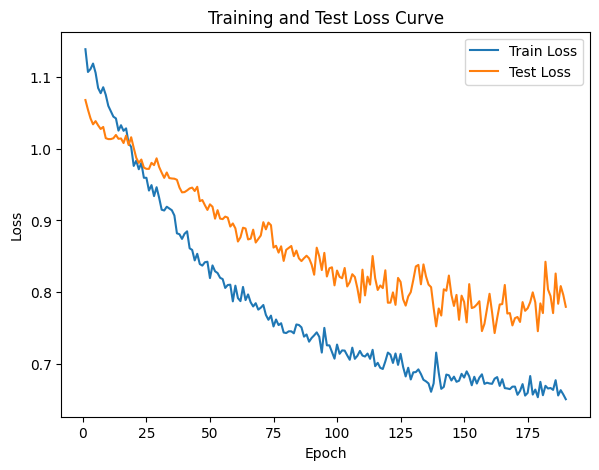

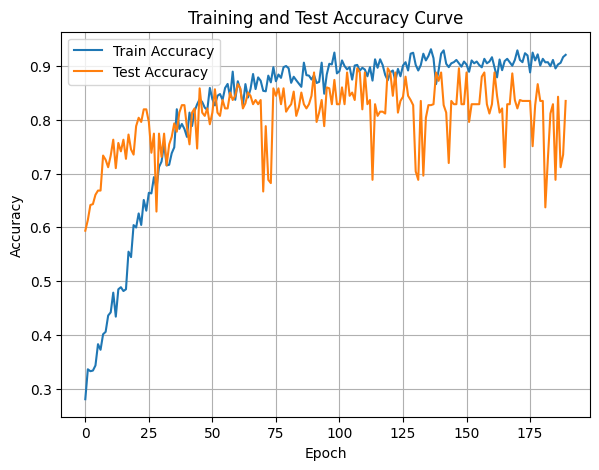

In [81]:
DTEmlp10b.train_single_model()

## Base 12

In [82]:
multiLayerPerceptron = MLP(input_size=input_size, hidden_layers=hidden_layers, output_size=output_size+1, dropout=.5) #hidden size default at 100

# Fill DTE params
modelSaveDirectory = './saved_models/'
DTEmlp12b = DeepTreeEnsemble(task_name='classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=12,
                                epochs=10,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.0001)

Randomly initializing 12 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.32it/s]

Epoch [1/10], Train F1:0.2570207896242609, Train Loss: 1.1344, Train Acc: 0.3149, Test F1:0.19407653396146274, Test Loss: 1.0930, Test Acc: 0.2882


Epoch [2/10], Train F1:0.279115075091767, Train Loss: 1.1278, Train Acc: 0.3278, Test F1:0.1984875388602525, Test Loss: 1.0973, Test Acc: 0.2960


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.70it/s]

Epoch [3/10], Train F1:0.27264871215530057, Train Loss: 1.1265, Train Acc: 0.3245, Test F1:0.20182565390962384, Test Loss: 1.0976, Test Acc: 0.3090


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.70it/s]

Epoch [4/10], Train F1:0.2863625280240746, Train Loss: 1.1203, Train Acc: 0.3385, Test F1:0.2012332451402707, Test Loss: 1.0938, Test Acc: 0.3116


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.62it/s]

Epoch [5/10], Train F1:0.292900265974995, Train Loss: 1.1147, Train Acc: 0.3434, Test F1:0.20496149800281133, Test Loss: 1.0916, Test Acc: 0.3163


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.62it/s]

Epoch [6/10], Train F1:0.30158791208709773, Train Loss: 1.1112, Train Acc: 0.3501, Test F1:0.2168582747190557, Test Loss: 1.0886, Test Acc: 0.3220


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.83it/s]

Epoch [7/10], Train F1:0.3047534480176744, Train Loss: 1.1086, Train Acc: 0.3526, Test F1:0.21745642701525053, Test Loss: 1.0867, Test Acc: 0.3281


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.81it/s]

Epoch [8/10], Train F1:0.31017652516746597, Train Loss: 1.1045, Train Acc: 0.3611, Test F1:0.21830543197284893, Test Loss: 1.0864, Test Acc: 0.3300


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.95it/s]

Epoch [9/10], Train F1:0.30980833892831544, Train Loss: 1.1032, Train Acc: 0.3599, Test F1:0.221259815820773, Test Loss: 1.0852, Test Acc: 0.3338


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.18it/s]


Epoch [10/10], Train F1:0.3152034683432919, Train Loss: 1.1003, Train Acc: 0.3661, Test F1:0.22283076344916933, Test Loss: 1.0839, Test Acc: 0.3377
Total Epochs: 10
Train loss start: 1.0997987985610962, Train loss end: 0.9880581498146057
Highest Mean Train Accuracy (over epoch): 0.3660714285714286
Test loss start: 1.107020378112793, Test loss end: 1.0567235946655273
Highest mean Test Accuracy (over epoch): 0.3376736111111111


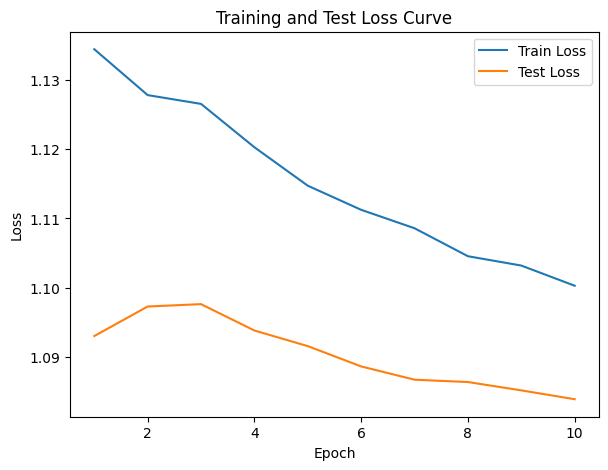

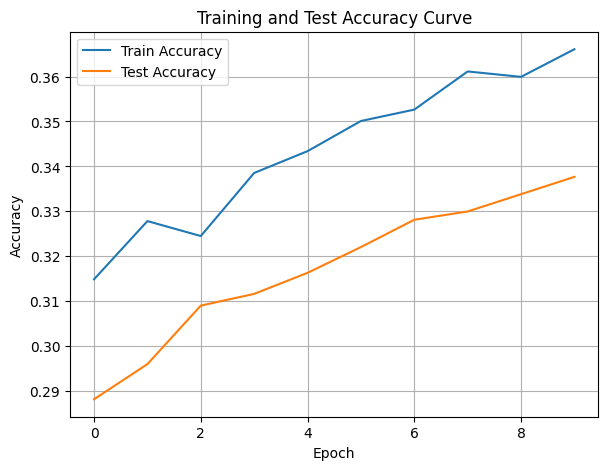

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.45560968241380617, Train Loss: 1.0766, Train Acc: 0.4420, Test F1:0.304823617373179, Test Loss: 1.1089, Test Acc: 0.2630


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.28it/s]

Epoch [2/10], Train F1:0.4547149315343975, Train Loss: 1.0635, Train Acc: 0.4568, Test F1:0.27094458881876426, Test Loss: 1.1187, Test Acc: 0.2079


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.28it/s]

Epoch [3/10], Train F1:0.45774268747161345, Train Loss: 1.0609, Train Acc: 0.4617, Test F1:0.2483991587172706, Test Loss: 1.1246, Test Acc: 0.1791


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.92it/s]

Epoch [4/10], Train F1:0.465001099710352, Train Loss: 1.0611, Train Acc: 0.4625, Test F1:0.25203687184061846, Test Loss: 1.1262, Test Acc: 0.1908


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.92it/s]

Epoch [5/10], Train F1:0.4636353036775326, Train Loss: 1.0582, Train Acc: 0.4662, Test F1:0.25095418284272775, Test Loss: 1.1269, Test Acc: 0.1946


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.18it/s]

Epoch [6/10], Train F1:0.471602748333091, Train Loss: 1.0557, Train Acc: 0.4744, Test F1:0.25743776563448695, Test Loss: 1.1256, Test Acc: 0.2109
Epoch [7/10], Train F1:0.4738535242277739, Train Loss: 1.0538, Train Acc: 0.4769, Test F1:0.2621449839494952, Test Loss: 1.1246, Test Acc: 0.2204


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.63it/s]

Epoch [8/10], Train F1:0.4769056340597309, Train Loss: 1.0517, Train Acc: 0.4813, Test F1:0.26387976315333567, Test Loss: 1.1236, Test Acc: 0.2208
Epoch [9/10], Train F1:0.4794131878499312, Train Loss: 1.0481, Train Acc: 0.4857, Test F1:0.27402475423298633, Test Loss: 1.1219, Test Acc: 0.2323


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.83it/s]


Epoch [10/10], Train F1:0.484747646289898, Train Loss: 1.0449, Train Acc: 0.4913, Test F1:0.2779386845391174, Test Loss: 1.1210, Test Acc: 0.2367
Total Epochs: 10
Train loss start: 1.0449581146240234, Train loss end: 1.1390979290008545
Highest Mean Train Accuracy (over epoch): 0.49127976190476197
Test loss start: 1.1171860694885254, Test loss end: 1.08641517162323
Highest mean Test Accuracy (over epoch): 0.2630208333333333


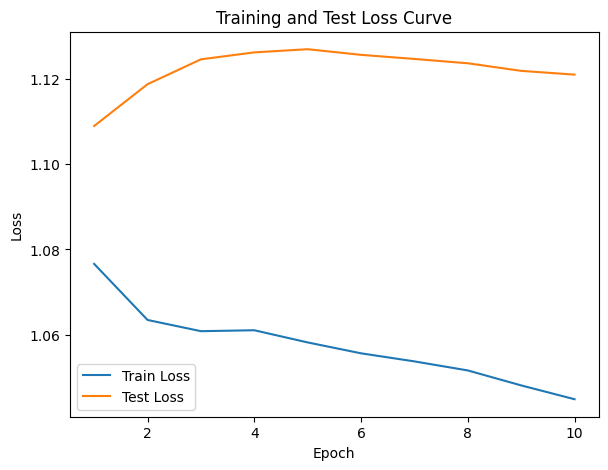

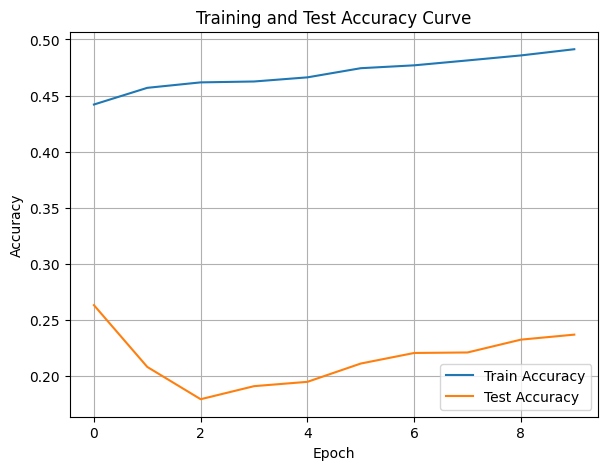

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.346554110850786, Train Loss: 1.1143, Train Acc: 0.3283, Test F1:0.26201281286348815, Test Loss: 1.0945, Test Acc: 0.3707


Epoch [2/10], Train F1:0.358518848482889, Train Loss: 1.1067, Train Acc: 0.3467, Test F1:0.24662528896334412, Test Loss: 1.0938, Test Acc: 0.3637


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.65it/s]

Epoch [3/10], Train F1:0.3702838056435361, Train Loss: 1.1035, Train Acc: 0.3594, Test F1:0.2469377526422055, Test Loss: 1.0923, Test Acc: 0.3640
Epoch [4/10], Train F1:0.3781483270913618, Train Loss: 1.0993, Train Acc: 0.3692, Test F1:0.2429255591728462, Test Loss: 1.0917, Test Acc: 0.3622


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.81it/s]

Epoch [5/10], Train F1:0.38936328953348054, Train Loss: 1.0934, Train Acc: 0.3796, Test F1:0.24743852996188664, Test Loss: 1.0926, Test Acc: 0.3655
Epoch [6/10], Train F1:0.3919348078334916, Train Loss: 1.0935, Train Acc: 0.3796, Test F1:0.24745880226324457, Test Loss: 1.0920, Test Acc: 0.3653


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.93it/s]

Epoch [7/10], Train F1:0.40374224493720706, Train Loss: 1.0885, Train Acc: 0.3909, Test F1:0.2526674445729507, Test Loss: 1.0894, Test Acc: 0.3703
Epoch [8/10], Train F1:0.40887511421130807, Train Loss: 1.0847, Train Acc: 0.3962, Test F1:0.2529768750281875, Test Loss: 1.0881, Test Acc: 0.3723


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.18it/s]


Epoch [9/10], Train F1:0.4218726142965077, Train Loss: 1.0791, Train Acc: 0.4055, Test F1:0.25506356201296115, Test Loss: 1.0870, Test Acc: 0.3754
Epoch [10/10], Train F1:0.42915010168286016, Train Loss: 1.0750, Train Acc: 0.4118, Test F1:0.2613872389514506, Test Loss: 1.0846, Test Acc: 0.3794
Total Epochs: 10
Train loss start: 1.1444363594055176, Train loss end: 1.0122722387313843
Highest Mean Train Accuracy (over epoch): 0.4117857142857143
Test loss start: 1.1080801486968994, Test loss end: 1.0583635568618774
Highest mean Test Accuracy (over epoch): 0.3794270833333333


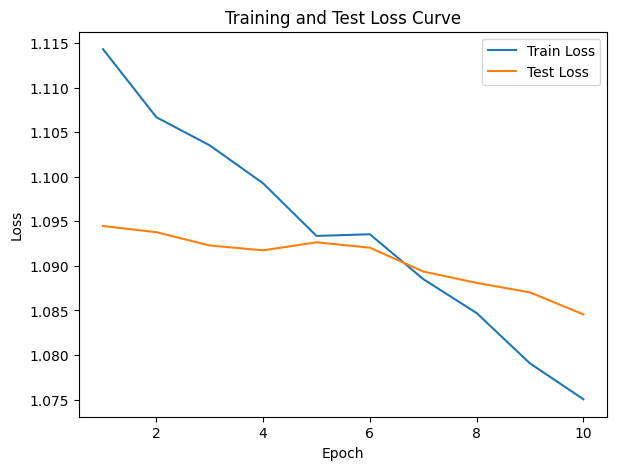

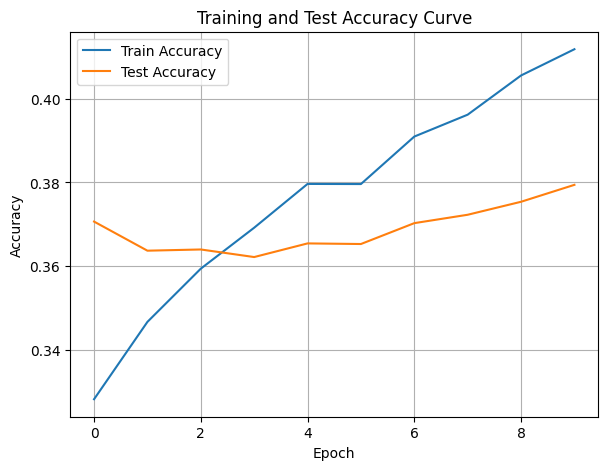

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.86it/s]

Epoch [1/10], Train F1:0.5130669326048497, Train Loss: 1.0603, Train Acc: 0.5057, Test F1:0.6044874089986872, Test Loss: 1.0778, Test Acc: 0.5651


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.20it/s]

Epoch [2/10], Train F1:0.5190682423414485, Train Loss: 1.0566, Train Acc: 0.5152, Test F1:0.6209200640314624, Test Loss: 1.0743, Test Acc: 0.6081
Epoch [3/10], Train F1:0.5338976652799587, Train Loss: 1.0565, Train Acc: 0.5224, Test F1:0.6306354487623879, Test Loss: 1.0703, Test Acc: 0.6380


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.20it/s]

Epoch [4/10], Train F1:0.5310422348022769, Train Loss: 1.0542, Train Acc: 0.5298, Test F1:0.6452435748920405, Test Loss: 1.0672, Test Acc: 0.6569


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.14it/s]

Epoch [5/10], Train F1:0.5409429955985567, Train Loss: 1.0519, Train Acc: 0.5347, Test F1:0.6562840031997391, Test Loss: 1.0641, Test Acc: 0.6714


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.62it/s]

Epoch [6/10], Train F1:0.5488908728820457, Train Loss: 1.0484, Train Acc: 0.5476, Test F1:0.6596821954799543, Test Loss: 1.0630, Test Acc: 0.6784


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.33it/s]

Epoch [7/10], Train F1:0.5510311151632947, Train Loss: 1.0455, Train Acc: 0.5524, Test F1:0.6578415262062381, Test Loss: 1.0610, Test Acc: 0.6812


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.04it/s]

Epoch [8/10], Train F1:0.552853637102309, Train Loss: 1.0449, Train Acc: 0.5559, Test F1:0.6584157537481807, Test Loss: 1.0595, Test Acc: 0.6842


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.08it/s]

Epoch [9/10], Train F1:0.554495695607702, Train Loss: 1.0427, Train Acc: 0.5596, Test F1:0.6674275654979295, Test Loss: 1.0576, Test Acc: 0.6918


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.48it/s]


Epoch [10/10], Train F1:0.5632004372017251, Train Loss: 1.0382, Train Acc: 0.5693, Test F1:0.6719377950938539, Test Loss: 1.0558, Test Acc: 0.6964
Total Epochs: 10
Train loss start: 1.0127322673797607, Train loss end: 0.929220974445343
Highest Mean Train Accuracy (over epoch): 0.5692559523809524
Test loss start: 1.081097960472107, Test loss end: 1.033202052116394
Highest mean Test Accuracy (over epoch): 0.6963541666666666


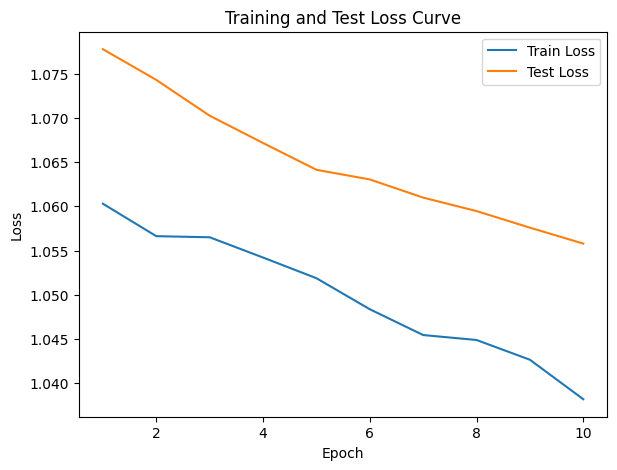

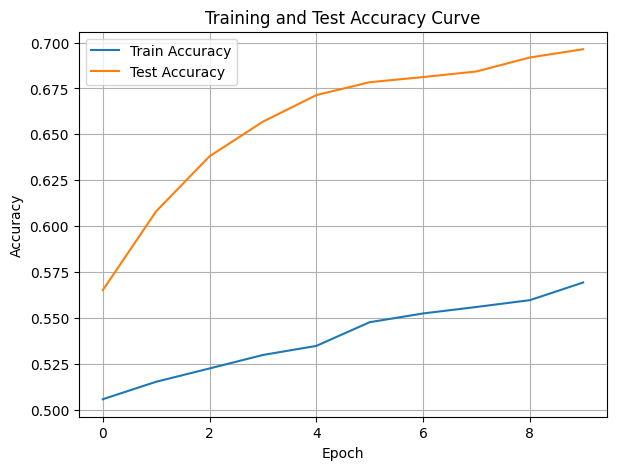

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.68it/s]

Epoch [1/10], Train F1:0.38774263686905003, Train Loss: 1.1075, Train Acc: 0.3494, Test F1:0.37305653514316767, Test Loss: 1.0901, Test Acc: 0.3672


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.13it/s]

Epoch [2/10], Train F1:0.3958226381083524, Train Loss: 1.1019, Train Acc: 0.3582, Test F1:0.4271839017834442, Test Loss: 1.0850, Test Acc: 0.4141


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.67it/s]

Epoch [3/10], Train F1:0.4097173147218663, Train Loss: 1.0950, Train Acc: 0.3726, Test F1:0.47760416167080727, Test Loss: 1.0798, Test Acc: 0.4624


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.17it/s]

Epoch [4/10], Train F1:0.4090489564237307, Train Loss: 1.0910, Train Acc: 0.3799, Test F1:0.4914546036689508, Test Loss: 1.0793, Test Acc: 0.4757


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.68it/s]

Epoch [5/10], Train F1:0.41437474923353335, Train Loss: 1.0880, Train Acc: 0.3851, Test F1:0.5035069962355281, Test Loss: 1.0782, Test Acc: 0.4880


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.66it/s]

Epoch [6/10], Train F1:0.41889312100748766, Train Loss: 1.0850, Train Acc: 0.3908, Test F1:0.522326955191403, Test Loss: 1.0761, Test Acc: 0.5056


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.66it/s]

Epoch [7/10], Train F1:0.4255359230298108, Train Loss: 1.0817, Train Acc: 0.3978, Test F1:0.5298201416751928, Test Loss: 1.0730, Test Acc: 0.5155


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.59it/s]

Epoch [8/10], Train F1:0.4318109010200621, Train Loss: 1.0797, Train Acc: 0.4025, Test F1:0.5435633908624522, Test Loss: 1.0714, Test Acc: 0.5297
Epoch [9/10], Train F1:0.43772948674198403, Train Loss: 1.0779, Train Acc: 0.4081, Test F1:0.5509460851186493, Test Loss: 1.0695, Test Acc: 0.5382


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.35it/s]


Epoch [10/10], Train F1:0.4426694500733217, Train Loss: 1.0751, Train Acc: 0.4148, Test F1:0.5418861980809484, Test Loss: 1.0685, Test Acc: 0.5306
Total Epochs: 10
Train loss start: 1.1294108629226685, Train loss end: 0.9555416703224182
Highest Mean Train Accuracy (over epoch): 0.41479166666666667
Test loss start: 1.0943000316619873, Test loss end: 1.0559003353118896
Highest mean Test Accuracy (over epoch): 0.5381944444444444


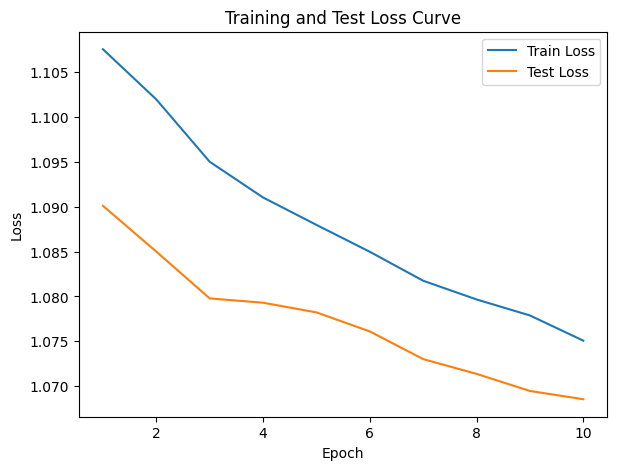

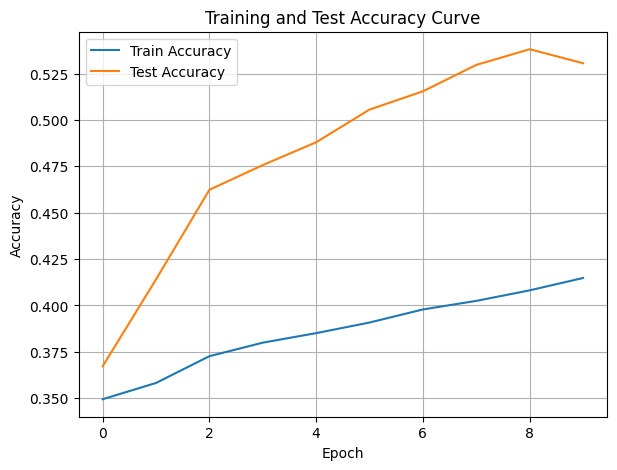

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.33it/s]

Epoch [1/10], Train F1:0.29880835022582597, Train Loss: 1.1820, Train Acc: 0.2137, Test F1:0.49008383818704176, Test Loss: 1.0730, Test Acc: 0.4410


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.00it/s]

Epoch [2/10], Train F1:0.30601621186987044, Train Loss: 1.1750, Train Acc: 0.2189, Test F1:0.49050449844909566, Test Loss: 1.0678, Test Acc: 0.4527


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.31it/s]

Epoch [3/10], Train F1:0.32026979649835596, Train Loss: 1.1704, Train Acc: 0.2360, Test F1:0.4744585823533192, Test Loss: 1.0669, Test Acc: 0.4462


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.50it/s]

Epoch [4/10], Train F1:0.3267388230561983, Train Loss: 1.1659, Train Acc: 0.2417, Test F1:0.44092586860101673, Test Loss: 1.0672, Test Acc: 0.4234


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.27it/s]

Epoch [5/10], Train F1:0.3283063979304787, Train Loss: 1.1643, Train Acc: 0.2438, Test F1:0.44122099164733686, Test Loss: 1.0666, Test Acc: 0.4250


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.38it/s]

Epoch [6/10], Train F1:0.33785707258546516, Train Loss: 1.1604, Train Acc: 0.2534, Test F1:0.43150479501532824, Test Loss: 1.0657, Test Acc: 0.4222


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.17it/s]

Epoch [7/10], Train F1:0.34835865742408567, Train Loss: 1.1574, Train Acc: 0.2611, Test F1:0.4452073964275219, Test Loss: 1.0630, Test Acc: 0.4364


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.20it/s]

Epoch [8/10], Train F1:0.3562763439217296, Train Loss: 1.1535, Train Acc: 0.2672, Test F1:0.4649314024856899, Test Loss: 1.0600, Test Acc: 0.4529


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.75it/s]

Epoch [9/10], Train F1:0.36388794535115726, Train Loss: 1.1494, Train Acc: 0.2747, Test F1:0.47951065672651483, Test Loss: 1.0576, Test Acc: 0.4658


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.62it/s]


Epoch [10/10], Train F1:0.3718509279067301, Train Loss: 1.1472, Train Acc: 0.2811, Test F1:0.4852660470516374, Test Loss: 1.0558, Test Acc: 0.4715
Total Epochs: 10
Train loss start: 1.1785005331039429, Train loss end: 1.1808366775512695
Highest Mean Train Accuracy (over epoch): 0.2811011904761905
Test loss start: 1.0701695680618286, Test loss end: 1.0354974269866943
Highest mean Test Accuracy (over epoch): 0.4715277777777779


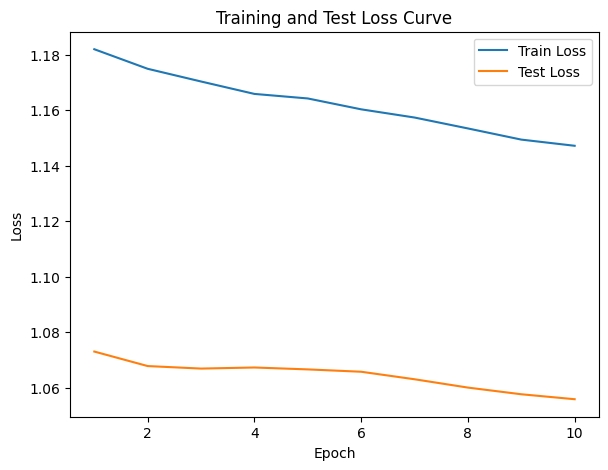

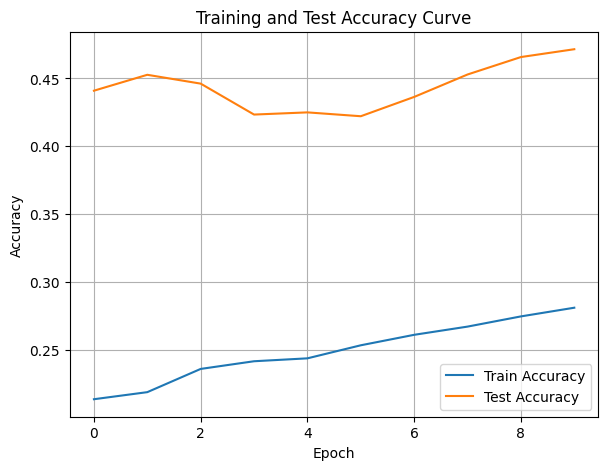

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4044686960395684, Train Loss: 1.1425, Train Acc: 0.2970, Test F1:0.5603562477622628, Test Loss: 1.0439, Test Acc: 0.5764


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.69it/s]

Epoch [2/10], Train F1:0.4086553608754534, Train Loss: 1.1360, Train Acc: 0.3070, Test F1:0.5790556638509856, Test Loss: 1.0362, Test Acc: 0.6020


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.69it/s]

Epoch [3/10], Train F1:0.4086323113216654, Train Loss: 1.1325, Train Acc: 0.3124, Test F1:0.5935540272098434, Test Loss: 1.0288, Test Acc: 0.6209


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.11it/s]

Epoch [4/10], Train F1:0.4024631180820151, Train Loss: 1.1310, Train Acc: 0.3083, Test F1:0.6033535783699895, Test Loss: 1.0257, Test Acc: 0.6304


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.11it/s]

Epoch [5/10], Train F1:0.41213253146426226, Train Loss: 1.1272, Train Acc: 0.3167, Test F1:0.6121845089637825, Test Loss: 1.0232, Test Acc: 0.6377


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.61it/s]

Epoch [6/10], Train F1:0.4136217377297982, Train Loss: 1.1252, Train Acc: 0.3187, Test F1:0.6155170995786184, Test Loss: 1.0207, Test Acc: 0.6412


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.99it/s]

Epoch [7/10], Train F1:0.4194440047265483, Train Loss: 1.1212, Train Acc: 0.3251, Test F1:0.6197239682202565, Test Loss: 1.0180, Test Acc: 0.6479
Epoch [8/10], Train F1:0.4319624290679104, Train Loss: 1.1146, Train Acc: 0.3367, Test F1:0.6270112501213043, Test Loss: 1.0166, Test Acc: 0.6540


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.79it/s]


Epoch [9/10], Train F1:0.4416988089944065, Train Loss: 1.1093, Train Acc: 0.3475, Test F1:0.6360046431807453, Test Loss: 1.0135, Test Acc: 0.6619
Epoch [10/10], Train F1:0.448409677883124, Train Loss: 1.1041, Train Acc: 0.3554, Test F1:0.6374915088193872, Test Loss: 1.0121, Test Acc: 0.6630
Total Epochs: 10
Train loss start: 1.1638225317001343, Train loss end: 0.9815894365310669
Highest Mean Train Accuracy (over epoch): 0.35535714285714287
Test loss start: 1.0265007019042969, Test loss end: 0.9782950282096863
Highest mean Test Accuracy (over epoch): 0.6630208333333334


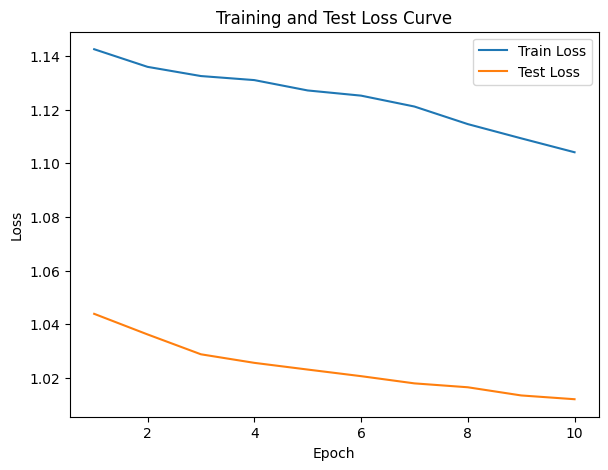

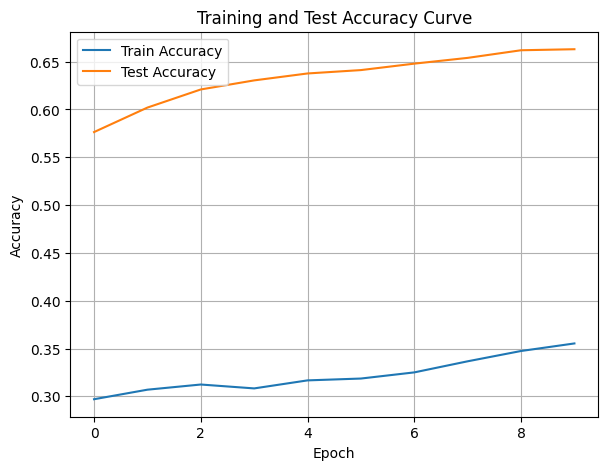

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.29019781020874513, Train Loss: 1.1790, Train Acc: 0.1908, Test F1:0.182198969004693, Test Loss: 1.1435, Test Acc: 0.1198


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.24it/s]

Epoch [2/10], Train F1:0.2987276673922663, Train Loss: 1.1787, Train Acc: 0.1943, Test F1:0.1492078021139806, Test Loss: 1.1511, Test Acc: 0.0872


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.24it/s]

Epoch [3/10], Train F1:0.3059037906945076, Train Loss: 1.1742, Train Acc: 0.2058, Test F1:0.1621365106482394, Test Loss: 1.1477, Test Acc: 0.1001


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.81it/s]

Epoch [4/10], Train F1:0.3155069004641435, Train Loss: 1.1721, Train Acc: 0.2106, Test F1:0.1802891254139528, Test Loss: 1.1441, Test Acc: 0.1144


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.81it/s]

Epoch [5/10], Train F1:0.3311259120517924, Train Loss: 1.1674, Train Acc: 0.2248, Test F1:0.1789151906880439, Test Loss: 1.1437, Test Acc: 0.1151


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.30it/s]

Epoch [6/10], Train F1:0.3479781211269933, Train Loss: 1.1617, Train Acc: 0.2400, Test F1:0.18362684277233007, Test Loss: 1.1423, Test Acc: 0.1195


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.30it/s]

Epoch [7/10], Train F1:0.3564962699274721, Train Loss: 1.1599, Train Acc: 0.2463, Test F1:0.18392849130498878, Test Loss: 1.1420, Test Acc: 0.1204


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.94it/s]

Epoch [8/10], Train F1:0.36540596266477066, Train Loss: 1.1561, Train Acc: 0.2537, Test F1:0.19745412492644665, Test Loss: 1.1396, Test Acc: 0.1316
Epoch [9/10], Train F1:0.3758160611461241, Train Loss: 1.1518, Train Acc: 0.2639, Test F1:0.20185189101050469, Test Loss: 1.1380, Test Acc: 0.1353


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.22it/s]


Epoch [10/10], Train F1:0.38474164788467086, Train Loss: 1.1486, Train Acc: 0.2716, Test F1:0.21189641849875746, Test Loss: 1.1364, Test Acc: 0.1430
Total Epochs: 10
Train loss start: 1.1850606203079224, Train loss end: 1.2331695556640625
Highest Mean Train Accuracy (over epoch): 0.271577380952381
Test loss start: 1.1395584344863892, Test loss end: 1.144766926765442
Highest mean Test Accuracy (over epoch): 0.14296875


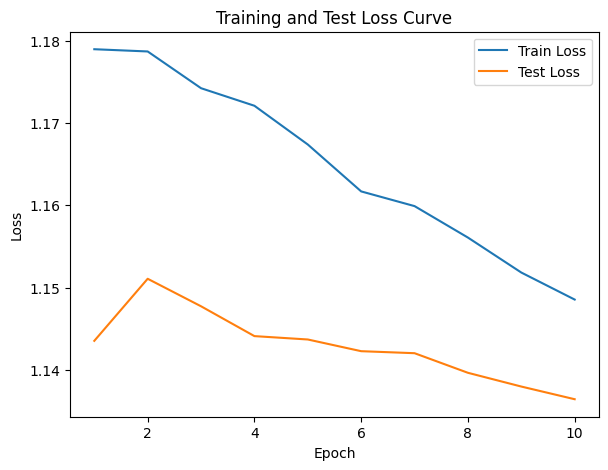

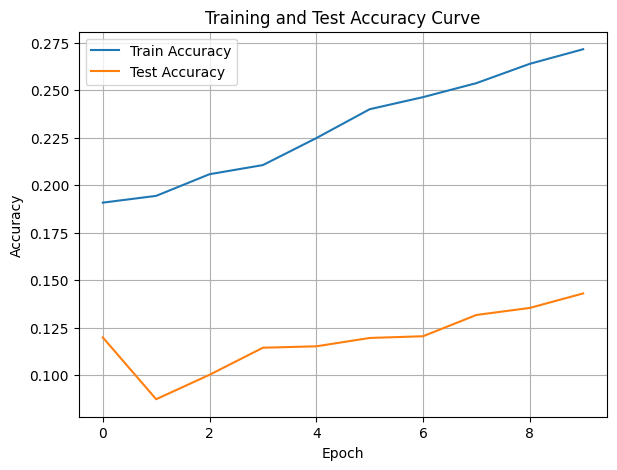

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.44915789201738804, Train Loss: 1.0878, Train Acc: 0.3595, Test F1:0.3286308554892386, Test Loss: 1.0979, Test Acc: 0.2118


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.44it/s]

Epoch [2/10], Train F1:0.46900315327406367, Train Loss: 1.0804, Train Acc: 0.3851, Test F1:0.34727066717024724, Test Loss: 1.0976, Test Acc: 0.2374


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.44it/s]

Epoch [3/10], Train F1:0.4842108341739502, Train Loss: 1.0760, Train Acc: 0.4049, Test F1:0.36522886881917893, Test Loss: 1.0964, Test Acc: 0.2543


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.65it/s]

Epoch [4/10], Train F1:0.4833296518800885, Train Loss: 1.0705, Train Acc: 0.4090, Test F1:0.40211083452446766, Test Loss: 1.0934, Test Acc: 0.2967


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.82it/s]

Epoch [5/10], Train F1:0.5012202307111265, Train Loss: 1.0654, Train Acc: 0.4254, Test F1:0.4013403837650271, Test Loss: 1.0935, Test Acc: 0.2915


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.88it/s]

Epoch [6/10], Train F1:0.5075292521482876, Train Loss: 1.0615, Train Acc: 0.4329, Test F1:0.40055228544437177, Test Loss: 1.0939, Test Acc: 0.2880


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.02it/s]

Epoch [7/10], Train F1:0.5122472804954604, Train Loss: 1.0581, Train Acc: 0.4384, Test F1:0.42718764719133334, Test Loss: 1.0914, Test Acc: 0.3141


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.14it/s]

Epoch [8/10], Train F1:0.5188204453555064, Train Loss: 1.0548, Train Acc: 0.4464, Test F1:0.44568304636412953, Test Loss: 1.0891, Test Acc: 0.3334


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.98it/s]

Epoch [9/10], Train F1:0.5245225417301824, Train Loss: 1.0520, Train Acc: 0.4523, Test F1:0.4453539851797577, Test Loss: 1.0888, Test Acc: 0.3306


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.02it/s]


Epoch [10/10], Train F1:0.5323459989157932, Train Loss: 1.0494, Train Acc: 0.4592, Test F1:0.4491088425280768, Test Loss: 1.0875, Test Acc: 0.3337
Total Epochs: 10
Train loss start: 1.093873381614685, Train loss end: 1.0683051347732544
Highest Mean Train Accuracy (over epoch): 0.45916666666666667
Test loss start: 1.0980733633041382, Test loss end: 1.0821895599365234
Highest mean Test Accuracy (over epoch): 0.33368055555555554


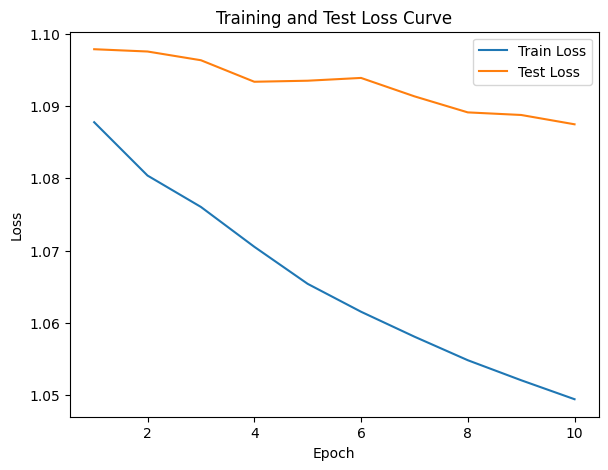

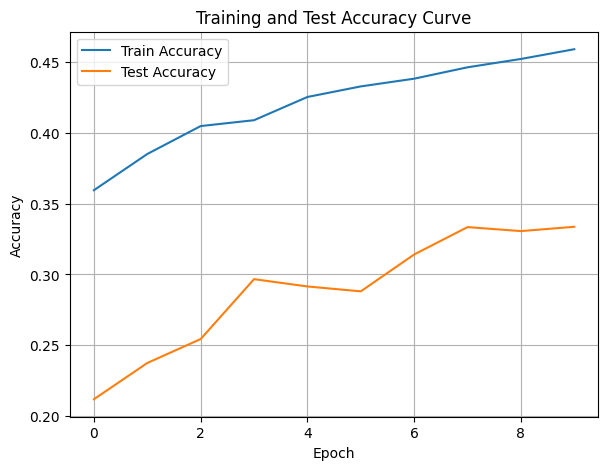

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.2144983308222015, Train Loss: 1.1849, Train Acc: 0.1545, Test F1:0.12563667232597622, Test Loss: 1.1262, Test Acc: 0.0946


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.09it/s]

Epoch [2/10], Train F1:0.21941876526126275, Train Loss: 1.1791, Train Acc: 0.1555, Test F1:0.08953418027828193, Test Loss: 1.1378, Test Acc: 0.0590


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.09it/s]

Epoch [3/10], Train F1:0.22182413595733108, Train Loss: 1.1773, Train Acc: 0.1555, Test F1:0.07958593802513948, Test Loss: 1.1385, Test Acc: 0.0498


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.62it/s]

Epoch [4/10], Train F1:0.23092533881360044, Train Loss: 1.1738, Train Acc: 0.1588, Test F1:0.08183783240335796, Test Loss: 1.1380, Test Acc: 0.0521


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.62it/s]

Epoch [5/10], Train F1:0.23721695741673543, Train Loss: 1.1722, Train Acc: 0.1616, Test F1:0.07706480813906914, Test Loss: 1.1381, Test Acc: 0.0491


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.69it/s]

Epoch [6/10], Train F1:0.24390559171342754, Train Loss: 1.1698, Train Acc: 0.1656, Test F1:0.0829705843556259, Test Loss: 1.1370, Test Acc: 0.0534


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.69it/s]

Epoch [7/10], Train F1:0.25581660530437794, Train Loss: 1.1657, Train Acc: 0.1759, Test F1:0.08903438820336326, Test Loss: 1.1346, Test Acc: 0.0584


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.75it/s]

Epoch [8/10], Train F1:0.2650997745936887, Train Loss: 1.1615, Train Acc: 0.1839, Test F1:0.09656372335798172, Test Loss: 1.1323, Test Acc: 0.0649


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.75it/s]

Epoch [9/10], Train F1:0.2749652552135339, Train Loss: 1.1572, Train Acc: 0.1930, Test F1:0.10385964912280701, Test Loss: 1.1302, Test Acc: 0.0708


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.01it/s]


Epoch [10/10], Train F1:0.2875042212180661, Train Loss: 1.1537, Train Acc: 0.2024, Test F1:0.11099718994455837, Test Loss: 1.1284, Test Acc: 0.0763
Total Epochs: 10
Train loss start: 1.1519721746444702, Train loss end: 1.1331281661987305
Highest Mean Train Accuracy (over epoch): 0.20238095238095236
Test loss start: 1.1224150657653809, Test loss end: 1.1060361862182617
Highest mean Test Accuracy (over epoch): 0.09461805555555555


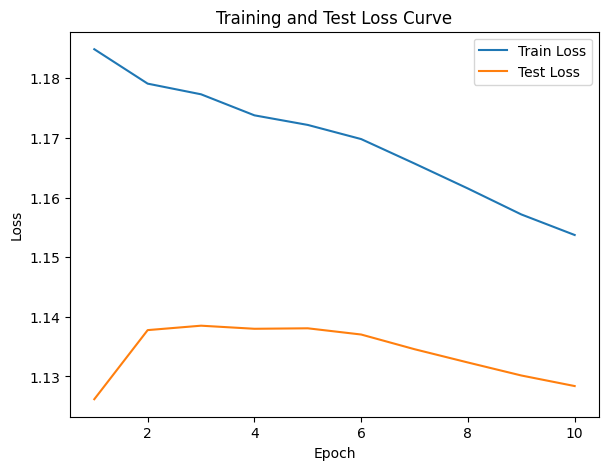

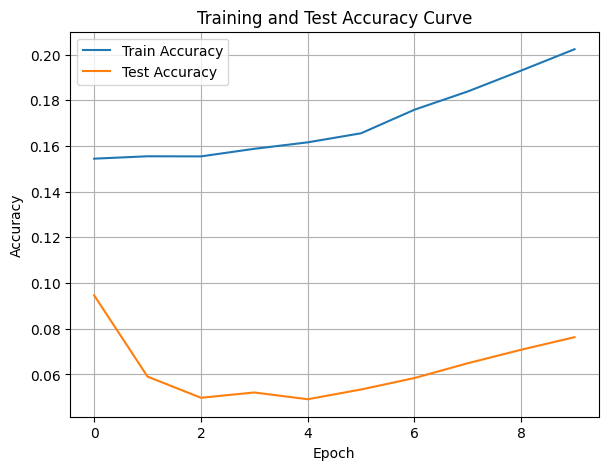

./saved_models/model_10.pth
Training Model with id 11
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.22538999634686965, Train Loss: 1.2339, Train Acc: 0.1375, Test F1:0.40282661407849785, Test Loss: 1.1128, Test Acc: 0.3585


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.97it/s]

Epoch [2/10], Train F1:0.22501646114211554, Train Loss: 1.2323, Train Acc: 0.1417, Test F1:0.438546288048631, Test Loss: 1.0981, Test Acc: 0.4340
Epoch [3/10], Train F1:0.24876854543520235, Train Loss: 1.2276, Train Acc: 0.1633, Test F1:0.4595023007715024, Test Loss: 1.0827, Test Acc: 0.4795


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.20it/s]

Epoch [4/10], Train F1:0.25779445321430056, Train Loss: 1.2263, Train Acc: 0.1704, Test F1:0.4672990193718201, Test Loss: 1.0782, Test Acc: 0.4967
Epoch [5/10], Train F1:0.2638467232689798, Train Loss: 1.2218, Train Acc: 0.1746, Test F1:0.47327212434375104, Test Loss: 1.0738, Test Acc: 0.5127


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.47it/s]

Epoch [6/10], Train F1:0.2664195091068068, Train Loss: 1.2194, Train Acc: 0.1789, Test F1:0.47797551115776316, Test Loss: 1.0703, Test Acc: 0.5246
Epoch [7/10], Train F1:0.27643527757192093, Train Loss: 1.2152, Train Acc: 0.1872, Test F1:0.48215785426397734, Test Loss: 1.0682, Test Acc: 0.5280


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.19it/s]

Epoch [8/10], Train F1:0.2852208485655649, Train Loss: 1.2110, Train Acc: 0.1964, Test F1:0.4876381226641188, Test Loss: 1.0642, Test Acc: 0.5370
Epoch [9/10], Train F1:0.2910875993681866, Train Loss: 1.2066, Train Acc: 0.2042, Test F1:0.4935438309057128, Test Loss: 1.0610, Test Acc: 0.5440
Epoch [10/10], Train F1:0.2999556740751133, Train Loss: 1.2038, Train Acc: 0.2112, Test F1:0.4987181694414615, Test Loss: 1.0587, Test Acc: 0.5503


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.04it/s]


Total Epochs: 10
Train loss start: 1.268338680267334, Train loss end: 1.1861506700515747
Highest Mean Train Accuracy (over epoch): 0.21122023809523807
Test loss start: 1.1078016757965088, Test loss end: 1.0340495109558105
Highest mean Test Accuracy (over epoch): 0.5503472222222222


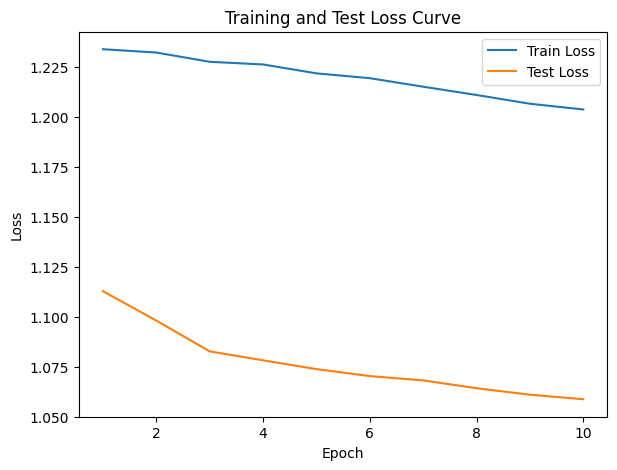

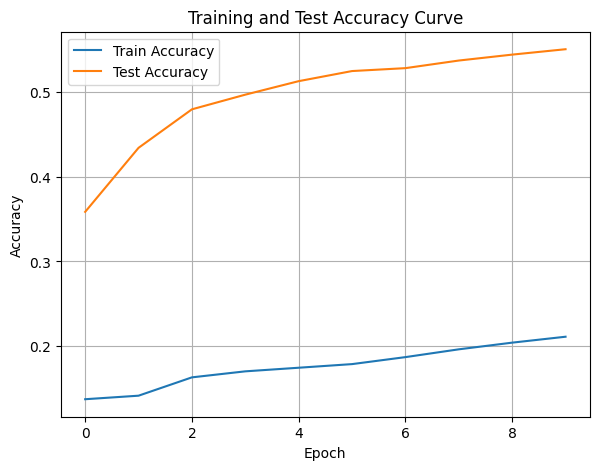

./saved_models/model_11.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.59it/s]

Epoch [1/10], Train F1:0.1491812535290796, Train Loss: 1.2256, Train Acc: 0.1012, Test F1:0.06632810095413974, Test Loss: 1.1469, Test Acc: 0.0451


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.70it/s]

Epoch [2/10], Train F1:0.15514578667371798, Train Loss: 1.2206, Train Acc: 0.1016, Test F1:0.0668770325861539, Test Loss: 1.1476, Test Acc: 0.0421


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.52it/s]

Epoch [3/10], Train F1:0.1713134663952285, Train Loss: 1.2164, Train Acc: 0.1133, Test F1:0.06256506776139624, Test Loss: 1.1447, Test Acc: 0.0385


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.96it/s]

Epoch [4/10], Train F1:0.17704804679662298, Train Loss: 1.2121, Train Acc: 0.1194, Test F1:0.06959558714473457, Test Loss: 1.1421, Test Acc: 0.0406


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.00it/s]

Epoch [5/10], Train F1:0.18209866386201468, Train Loss: 1.2086, Train Acc: 0.1222, Test F1:0.07984695453422287, Test Loss: 1.1389, Test Acc: 0.0477


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.18it/s]

Epoch [6/10], Train F1:0.19318070677819768, Train Loss: 1.2052, Train Acc: 0.1302, Test F1:0.08022358289451985, Test Loss: 1.1376, Test Acc: 0.0476


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.32it/s]

Epoch [7/10], Train F1:0.2001021419897759, Train Loss: 1.2017, Train Acc: 0.1367, Test F1:0.08037055343120057, Test Loss: 1.1362, Test Acc: 0.0484


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.38it/s]

Epoch [8/10], Train F1:0.20410414306428354, Train Loss: 1.1988, Train Acc: 0.1394, Test F1:0.08811247366165932, Test Loss: 1.1342, Test Acc: 0.0546


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.38it/s]


Epoch [9/10], Train F1:0.2078672167470547, Train Loss: 1.1958, Train Acc: 0.1437, Test F1:0.09360742163915788, Test Loss: 1.1327, Test Acc: 0.0592
Epoch [10/10], Train F1:0.21856263870852946, Train Loss: 1.1913, Train Acc: 0.1519, Test F1:0.10107039318910566, Test Loss: 1.1310, Test Acc: 0.0659
Total Epochs: 10
Train loss start: 1.2210304737091064, Train loss end: 1.156980276107788
Highest Mean Train Accuracy (over epoch): 0.1519047619047619
Test loss start: 1.1363716125488281, Test loss end: 1.106924295425415
Highest mean Test Accuracy (over epoch): 0.06588541666666667


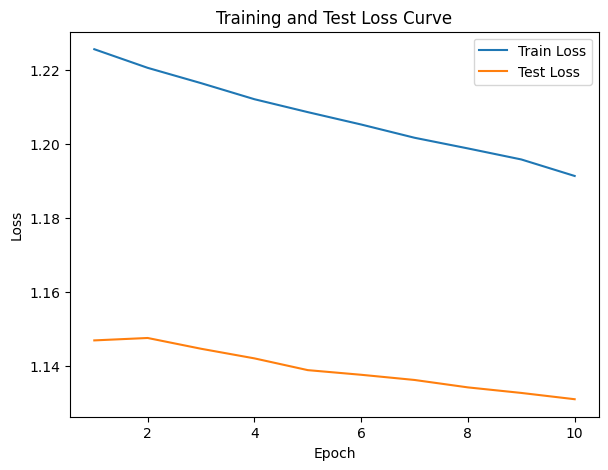

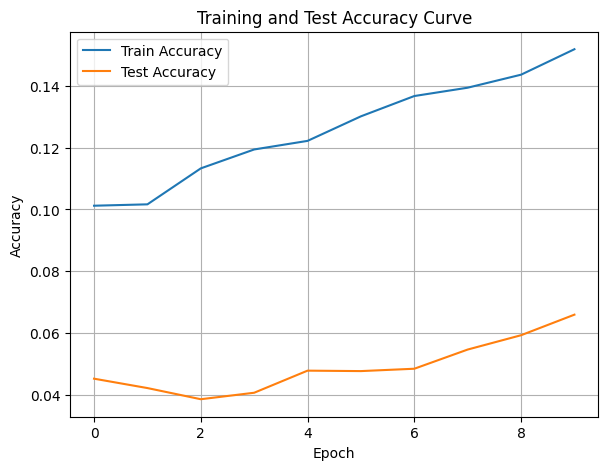

./saved_models/model_12.pth
Training Model with id 18
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.84it/s]

Epoch [1/10], Train F1:0.29854118007428115, Train Loss: 1.1566, Train Acc: 0.2336, Test F1:0.28436181664775534, Test Loss: 1.1020, Test Acc: 0.2161
Epoch [2/10], Train F1:0.3182786969992128, Train Loss: 1.1552, Train Acc: 0.2440, Test F1:0.2444083487414057, Test Loss: 1.1059, Test Acc: 0.1866
Epoch [3/10], Train F1:0.32671227700372196, Train Loss: 1.1525, Train Acc: 0.2496, Test F1:0.22621095512691064, Test Loss: 1.1061, Test Acc: 0.1846


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.44it/s]

Epoch [4/10], Train F1:0.3211430863020286, Train Loss: 1.1491, Train Acc: 0.2432, Test F1:0.23589124034163036, Test Loss: 1.1050, Test Acc: 0.1925
Epoch [5/10], Train F1:0.33118305097954615, Train Loss: 1.1456, Train Acc: 0.2483, Test F1:0.2546093171540641, Test Loss: 1.1029, Test Acc: 0.2059
Epoch [6/10], Train F1:0.3436327945741691, Train Loss: 1.1415, Train Acc: 0.2612, Test F1:0.28077953240214276, Test Loss: 1.0996, Test Acc: 0.2247


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.44it/s]

Epoch [7/10], Train F1:0.3552640346516114, Train Loss: 1.1368, Train Acc: 0.2717, Test F1:0.3419008495260281, Test Loss: 1.0960, Test Acc: 0.2688
Epoch [8/10], Train F1:0.3656763484409924, Train Loss: 1.1335, Train Acc: 0.2809, Test F1:0.3689513074568978, Test Loss: 1.0941, Test Acc: 0.2887


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.16it/s]


Epoch [9/10], Train F1:0.3759123031647161, Train Loss: 1.1296, Train Acc: 0.2894, Test F1:0.3922787494786536, Test Loss: 1.0920, Test Acc: 0.3101
Epoch [10/10], Train F1:0.3833994725319766, Train Loss: 1.1256, Train Acc: 0.2975, Test F1:0.42872638835147847, Test Loss: 1.0893, Test Acc: 0.3438
Total Epochs: 10
Train loss start: 1.1205264329910278, Train loss end: 1.0685571432113647
Highest Mean Train Accuracy (over epoch): 0.29747023809523804
Test loss start: 1.0907987356185913, Test loss end: 1.0547962188720703
Highest mean Test Accuracy (over epoch): 0.3438368055555555


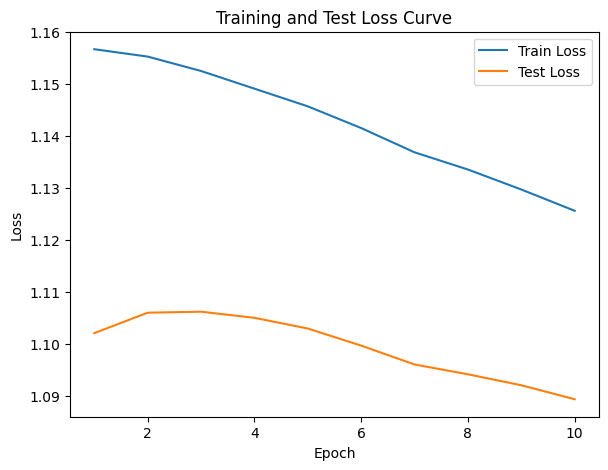

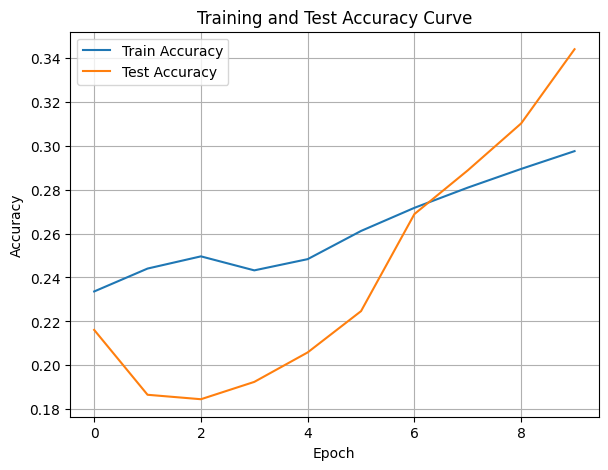

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.49180213199973677, Train Loss: 1.0940, Train Acc: 0.3845, Test F1:0.6377867746288798, Test Loss: 1.0665, Test Acc: 0.5868


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.43it/s]

Epoch [2/10], Train F1:0.5202871161826059, Train Loss: 1.0831, Train Acc: 0.4190, Test F1:0.6558411077861879, Test Loss: 1.0599, Test Acc: 0.6241


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.43it/s]

Epoch [3/10], Train F1:0.5191750544618177, Train Loss: 1.0772, Train Acc: 0.4275, Test F1:0.6728441721904017, Test Loss: 1.0591, Test Acc: 0.6377


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.44it/s]

Epoch [4/10], Train F1:0.5367547746629953, Train Loss: 1.0691, Train Acc: 0.4484, Test F1:0.6892403573584945, Test Loss: 1.0565, Test Acc: 0.6593


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.44it/s]

Epoch [5/10], Train F1:0.542747116999045, Train Loss: 1.0648, Train Acc: 0.4582, Test F1:0.7013510344000882, Test Loss: 1.0549, Test Acc: 0.6741


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.54it/s]

Epoch [6/10], Train F1:0.545986926253927, Train Loss: 1.0615, Train Acc: 0.4660, Test F1:0.70294092719722, Test Loss: 1.0546, Test Acc: 0.6752


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.67it/s]

Epoch [7/10], Train F1:0.5501736516093434, Train Loss: 1.0586, Train Acc: 0.4713, Test F1:0.7125812714016353, Test Loss: 1.0523, Test Acc: 0.6886


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.60it/s]

Epoch [8/10], Train F1:0.5611449924573751, Train Loss: 1.0543, Train Acc: 0.4840, Test F1:0.721670317752846, Test Loss: 1.0497, Test Acc: 0.7006
Epoch [9/10], Train F1:0.5698559856266355, Train Loss: 1.0510, Train Acc: 0.4943, Test F1:0.7285831266991211, Test Loss: 1.0481, Test Acc: 0.7100


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.28it/s]


Epoch [10/10], Train F1:0.5772055822392582, Train Loss: 1.0466, Train Acc: 0.5032, Test F1:0.7366899415673621, Test Loss: 1.0453, Test Acc: 0.7214
Total Epochs: 10
Train loss start: 1.0266742706298828, Train loss end: 0.9242904782295227
Highest Mean Train Accuracy (over epoch): 0.5031845238095238
Test loss start: 1.0586529970169067, Test loss end: 1.0035673379898071
Highest mean Test Accuracy (over epoch): 0.7213541666666666


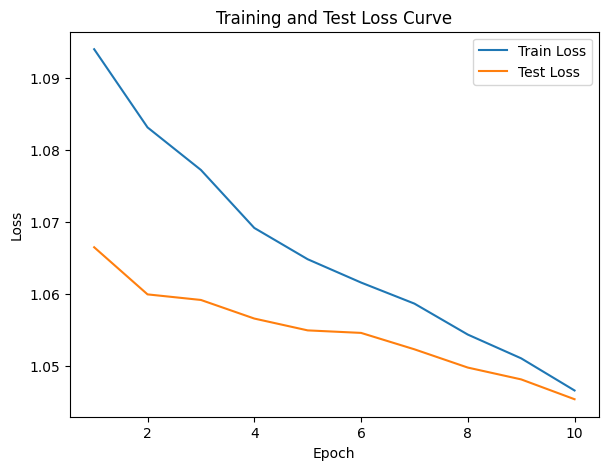

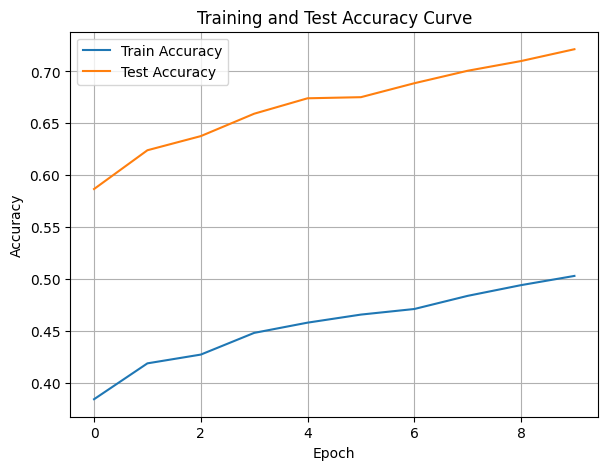

./saved_models/model_16.pth
Training Model with id 19
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.632081880303977, Train Loss: 1.0157, Train Acc: 0.5735, Test F1:0.8163434903047092, Test Loss: 1.0257, Test Acc: 0.8299


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.03it/s]

Epoch [2/10], Train F1:0.6689450274215141, Train Loss: 1.0056, Train Acc: 0.6121, Test F1:0.8059236326109391, Test Loss: 1.0230, Test Acc: 0.8121


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.99it/s]

Epoch [3/10], Train F1:0.6768212811286632, Train Loss: 0.9982, Train Acc: 0.6257, Test F1:0.8175824175824176, Test Loss: 1.0214, Test Acc: 0.8238
Epoch [4/10], Train F1:0.6798106440070831, Train Loss: 0.9966, Train Acc: 0.6280, Test F1:0.8243649877043707, Test Loss: 1.0179, Test Acc: 0.8296


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.99it/s]

Epoch [5/10], Train F1:0.6833130076123684, Train Loss: 0.9932, Train Acc: 0.6344, Test F1:0.8279979153549203, Test Loss: 1.0164, Test Acc: 0.8344


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.23it/s]

Epoch [6/10], Train F1:0.6953312382296534, Train Loss: 0.9880, Train Acc: 0.6454, Test F1:0.8331717063409649, Test Loss: 1.0132, Test Acc: 0.8401
Epoch [7/10], Train F1:0.7025483240032917, Train Loss: 0.9844, Train Acc: 0.6516, Test F1:0.8354812968285467, Test Loss: 1.0105, Test Acc: 0.8431


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.01it/s]

Epoch [8/10], Train F1:0.7095728226855549, Train Loss: 0.9822, Train Acc: 0.6605, Test F1:0.8384355263986806, Test Loss: 1.0088, Test Acc: 0.8464
Epoch [9/10], Train F1:0.7154997785594299, Train Loss: 0.9780, Train Acc: 0.6695, Test F1:0.836552360685067, Test Loss: 1.0069, Test Acc: 0.8456


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.64it/s]


Epoch [10/10], Train F1:0.7218697384516519, Train Loss: 0.9736, Train Acc: 0.6783, Test F1:0.8388176482197943, Test Loss: 1.0049, Test Acc: 0.8479
Total Epochs: 10
Train loss start: 1.0426476001739502, Train loss end: 0.8741283416748047
Highest Mean Train Accuracy (over epoch): 0.6782738095238096
Test loss start: 1.0218669176101685, Test loss end: 0.9668067097663879
Highest mean Test Accuracy (over epoch): 0.8479166666666668


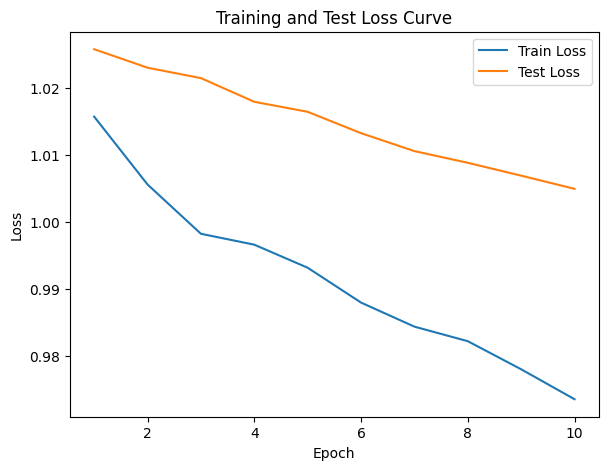

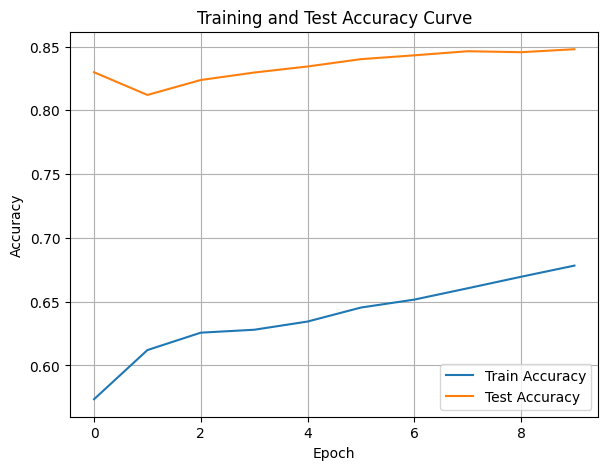

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.63it/s]

Epoch [1/10], Train F1:0.7655350434931238, Train Loss: 0.9298, Train Acc: 0.7438, Test F1:0.8300706033376123, Test Loss: 0.9792, Test Acc: 0.8472
Epoch [2/10], Train F1:0.7789900705945836, Train Loss: 0.9296, Train Acc: 0.7540, Test F1:0.8535205591977806, Test Loss: 0.9777, Test Acc: 0.8659


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.52it/s]

Epoch [3/10], Train F1:0.7861010486182303, Train Loss: 0.9287, Train Acc: 0.7588, Test F1:0.8526243144092114, Test Loss: 0.9776, Test Acc: 0.8649
Epoch [4/10], Train F1:0.7884707212759334, Train Loss: 0.9293, Train Acc: 0.7599, Test F1:0.8521757269550866, Test Loss: 0.9760, Test Acc: 0.8644


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.09it/s]

Epoch [5/10], Train F1:0.7876155780996923, Train Loss: 0.9288, Train Acc: 0.7570, Test F1:0.8556758930601875, Test Loss: 0.9741, Test Acc: 0.8668
Epoch [6/10], Train F1:0.7897034713567304, Train Loss: 0.9242, Train Acc: 0.7622, Test F1:0.8556839928511358, Test Loss: 0.9727, Test Acc: 0.8662


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.37it/s]

Epoch [7/10], Train F1:0.7944325771058256, Train Loss: 0.9189, Train Acc: 0.7692, Test F1:0.8550061041919732, Test Loss: 0.9695, Test Acc: 0.8657
Epoch [8/10], Train F1:0.7967536814697446, Train Loss: 0.9150, Train Acc: 0.7734, Test F1:0.8536447420294971, Test Loss: 0.9673, Test Acc: 0.8651


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.38it/s]


Epoch [9/10], Train F1:0.7997982646312536, Train Loss: 0.9118, Train Acc: 0.7773, Test F1:0.8549814435432557, Test Loss: 0.9657, Test Acc: 0.8664
Epoch [10/10], Train F1:0.8019196714459659, Train Loss: 0.9087, Train Acc: 0.7804, Test F1:0.8545804465158708, Test Loss: 0.9637, Test Acc: 0.8661
Total Epochs: 10
Train loss start: 0.9109756946563721, Train loss end: 0.9172576665878296
Highest Mean Train Accuracy (over epoch): 0.7803571428571429
Test loss start: 0.9738460183143616, Test loss end: 0.9258167743682861
Highest mean Test Accuracy (over epoch): 0.8668402777777777


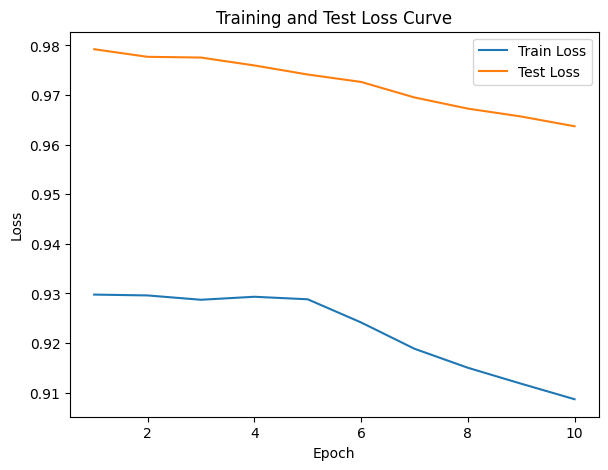

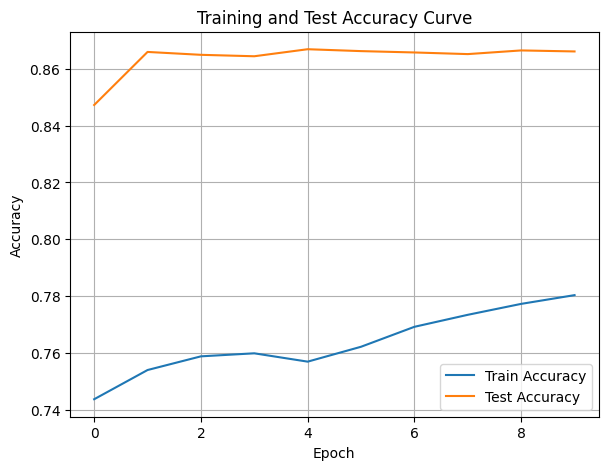

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.84it/s]

Epoch [1/10], Train F1:0.8400915114029868, Train Loss: 0.8836, Train Acc: 0.8173, Test F1:0.8735192682561103, Test Loss: 0.9461, Test Acc: 0.8845


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.69it/s]

Epoch [2/10], Train F1:0.8423152051121523, Train Loss: 0.8745, Train Acc: 0.8326, Test F1:0.8674119313216204, Test Loss: 0.9425, Test Acc: 0.8776


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.12it/s]

Epoch [3/10], Train F1:0.8324725478096656, Train Loss: 0.8735, Train Acc: 0.8223, Test F1:0.858673030615755, Test Loss: 0.9382, Test Acc: 0.8701


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.94it/s]

Epoch [4/10], Train F1:0.83395740141416, Train Loss: 0.8708, Train Acc: 0.8221, Test F1:0.8645980585830209, Test Loss: 0.9354, Test Acc: 0.8757


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.71it/s]

Epoch [5/10], Train F1:0.8345198828443652, Train Loss: 0.8687, Train Acc: 0.8222, Test F1:0.8664290217751042, Test Loss: 0.9356, Test Acc: 0.8774


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.87it/s]

Epoch [6/10], Train F1:0.8318056282976993, Train Loss: 0.8670, Train Acc: 0.8214, Test F1:0.8685961554145137, Test Loss: 0.9340, Test Acc: 0.8789


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.04it/s]

Epoch [7/10], Train F1:0.8375368385534963, Train Loss: 0.8635, Train Acc: 0.8283, Test F1:0.8693235145476862, Test Loss: 0.9327, Test Acc: 0.8797


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.52it/s]

Epoch [8/10], Train F1:0.8406009633442835, Train Loss: 0.8593, Train Acc: 0.8322, Test F1:0.8644175537349197, Test Loss: 0.9294, Test Acc: 0.8749


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.52it/s]

Epoch [9/10], Train F1:0.84111199418253, Train Loss: 0.8582, Train Acc: 0.8327, Test F1:0.8649814362529438, Test Loss: 0.9271, Test Acc: 0.8753


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.94it/s]


Epoch [10/10], Train F1:0.8417903338945419, Train Loss: 0.8556, Train Acc: 0.8349, Test F1:0.8654321465428276, Test Loss: 0.9246, Test Acc: 0.8756
Total Epochs: 10
Train loss start: 0.8572201728820801, Train loss end: 0.7437433004379272
Highest Mean Train Accuracy (over epoch): 0.8348809523809524
Test loss start: 0.9361507296562195, Test loss end: 0.8827795386314392
Highest mean Test Accuracy (over epoch): 0.8845486111111112


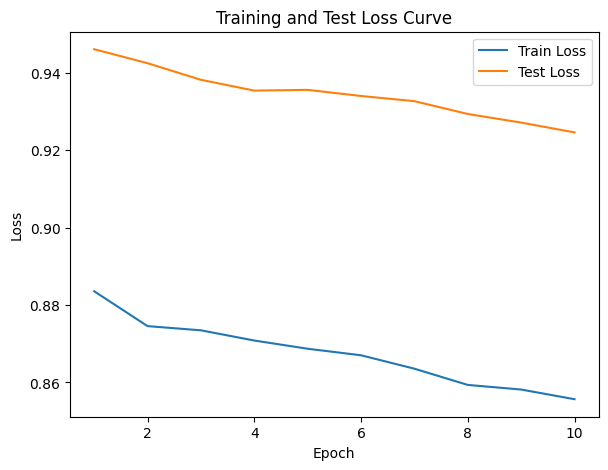

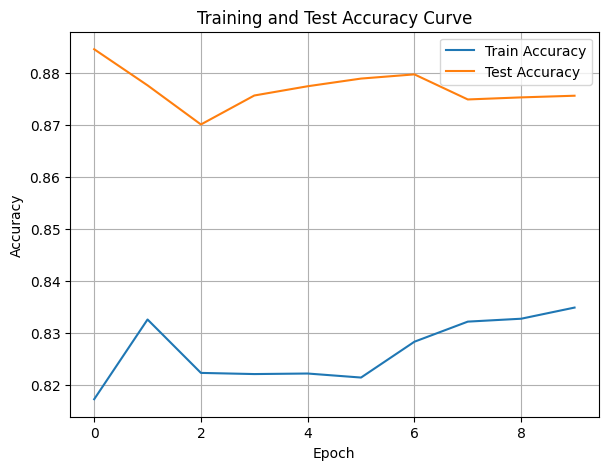

./saved_models/model_15.pth
Training Model with id 19
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8422668759811616, Train Loss: 0.8271, Train Acc: 0.8426, Test F1:0.8168580871044796, Test Loss: 0.9012, Test Acc: 0.8333


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.18it/s]

Epoch [2/10], Train F1:0.8466748006546473, Train Loss: 0.8315, Train Acc: 0.8335, Test F1:0.8384395331763752, Test Loss: 0.9023, Test Acc: 0.8520


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.78it/s]

Epoch [3/10], Train F1:0.8514924787510164, Train Loss: 0.8294, Train Acc: 0.8421, Test F1:0.8489516474112109, Test Loss: 0.9015, Test Acc: 0.8608


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.78it/s]

Epoch [4/10], Train F1:0.8551170669701523, Train Loss: 0.8259, Train Acc: 0.8461, Test F1:0.8515525901515305, Test Loss: 0.9000, Test Acc: 0.8633


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.65it/s]

Epoch [5/10], Train F1:0.8581179855653149, Train Loss: 0.8241, Train Acc: 0.8508, Test F1:0.8572379569111596, Test Loss: 0.8984, Test Acc: 0.8679


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.65it/s]

Epoch [6/10], Train F1:0.8578601774253948, Train Loss: 0.8244, Train Acc: 0.8481, Test F1:0.8610008478305189, Test Loss: 0.8973, Test Acc: 0.8709


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.01it/s]

Epoch [7/10], Train F1:0.85651921135059, Train Loss: 0.8213, Train Acc: 0.8482, Test F1:0.8592931124413203, Test Loss: 0.8950, Test Acc: 0.8698


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.01it/s]

Epoch [8/10], Train F1:0.8559931864057772, Train Loss: 0.8200, Train Acc: 0.8479, Test F1:0.8567231580046927, Test Loss: 0.8933, Test Acc: 0.8672


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.06it/s]

Epoch [9/10], Train F1:0.8560547582349387, Train Loss: 0.8188, Train Acc: 0.8481, Test F1:0.854717285132926, Test Loss: 0.8912, Test Acc: 0.8652


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.18it/s]


Epoch [10/10], Train F1:0.8559265659144726, Train Loss: 0.8186, Train Acc: 0.8480, Test F1:0.8520715140235324, Test Loss: 0.8899, Test Acc: 0.8628
Total Epochs: 10
Train loss start: 0.8636016249656677, Train loss end: 0.8978922963142395
Highest Mean Train Accuracy (over epoch): 0.8507738095238095
Test loss start: 0.8853323459625244, Test loss end: 0.857100248336792
Highest mean Test Accuracy (over epoch): 0.8709490740740741


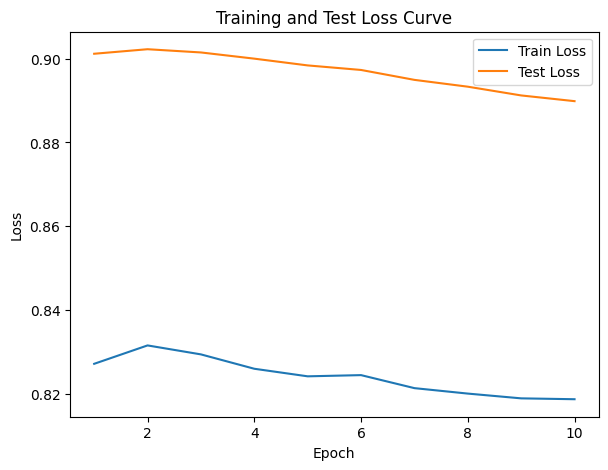

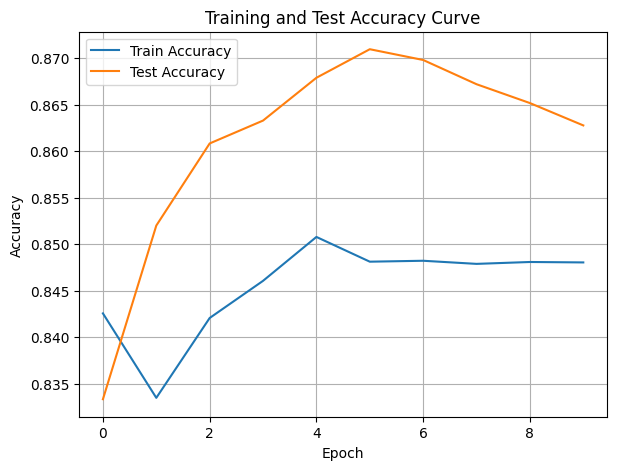

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.848958618282229, Train Loss: 0.7985, Train Acc: 0.8583, Test F1:0.848951647411211, Test Loss: 0.8675, Test Acc: 0.8628


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.00it/s]

Epoch [2/10], Train F1:0.8488210852230086, Train Loss: 0.7940, Train Acc: 0.8536, Test F1:0.848951647411211, Test Loss: 0.8679, Test Acc: 0.8598


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.00it/s]

Epoch [3/10], Train F1:0.8639692245891032, Train Loss: 0.7891, Train Acc: 0.8641, Test F1:0.8384395331763752, Test Loss: 0.8643, Test Acc: 0.8510


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.40it/s]

Epoch [4/10], Train F1:0.8684193388174231, Train Loss: 0.7867, Train Acc: 0.8686, Test F1:0.8437176036086195, Test Loss: 0.8653, Test Acc: 0.8544


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.40it/s]

Epoch [5/10], Train F1:0.871130323675177, Train Loss: 0.7867, Train Acc: 0.8683, Test F1:0.8493416490093096, Test Loss: 0.8640, Test Acc: 0.8592


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.61it/s]

Epoch [6/10], Train F1:0.8719082316770997, Train Loss: 0.7855, Train Acc: 0.8684, Test F1:0.8440614996557543, Test Loss: 0.8637, Test Acc: 0.8549


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.77it/s]

Epoch [7/10], Train F1:0.8691299861935188, Train Loss: 0.7851, Train Acc: 0.8662, Test F1:0.8462543554006968, Test Loss: 0.8632, Test Acc: 0.8563


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.73it/s]

Epoch [8/10], Train F1:0.8696742684369495, Train Loss: 0.7837, Train Acc: 0.8671, Test F1:0.8426642363938337, Test Loss: 0.8620, Test Acc: 0.8534


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.66it/s]

Epoch [9/10], Train F1:0.8685540318532858, Train Loss: 0.7828, Train Acc: 0.8648, Test F1:0.8468537536252555, Test Loss: 0.8608, Test Acc: 0.8571


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.03it/s]


Epoch [10/10], Train F1:0.8680207252673038, Train Loss: 0.7814, Train Acc: 0.8641, Test F1:0.8428748154644979, Test Loss: 0.8605, Test Acc: 0.8539
Total Epochs: 10
Train loss start: 0.7774138450622559, Train loss end: 0.8173009753227234
Highest Mean Train Accuracy (over epoch): 0.8686011904761904
Test loss start: 0.8455603122711182, Test loss end: 0.832319438457489
Highest mean Test Accuracy (over epoch): 0.8628472222222222


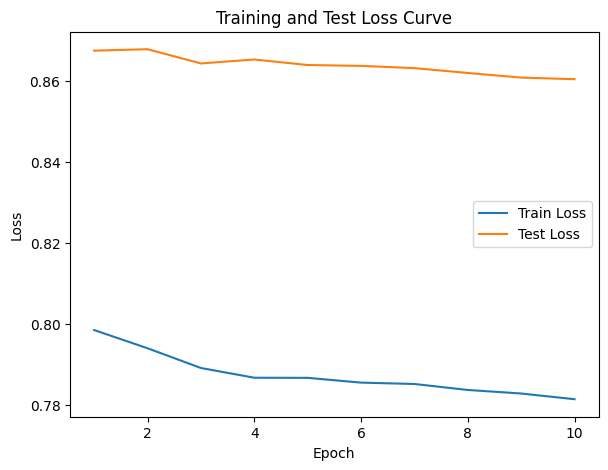

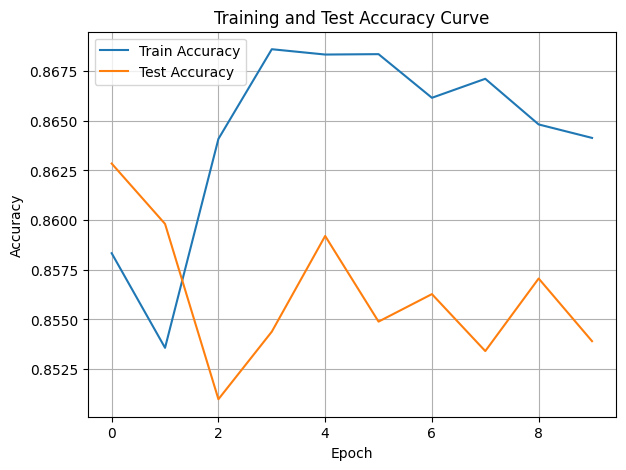

./saved_models/model_17.pth
Training Model with id 20
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.20it/s]

Epoch [1/10], Train F1:0.867759454997527, Train Loss: 0.7675, Train Acc: 0.8696, Test F1:0.8057644110275689, Test Loss: 0.8540, Test Acc: 0.8255
Epoch [2/10], Train F1:0.8679911488243363, Train Loss: 0.7664, Train Acc: 0.8659, Test F1:0.8168580871044796, Test Loss: 0.8505, Test Acc: 0.8333


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.20it/s]

Epoch [3/10], Train F1:0.8645310451450402, Train Loss: 0.7647, Train Acc: 0.8662, Test F1:0.8241385568671721, Test Loss: 0.8453, Test Acc: 0.8385


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.72it/s]

Epoch [4/10], Train F1:0.869123571741748, Train Loss: 0.7619, Train Acc: 0.8720, Test F1:0.8277456174443104, Test Loss: 0.8417, Test Acc: 0.8411
Epoch [5/10], Train F1:0.8711516950570091, Train Loss: 0.7579, Train Acc: 0.8736, Test F1:0.8320457405125598, Test Loss: 0.8399, Test Acc: 0.8443


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.17it/s]

Epoch [6/10], Train F1:0.870309750066383, Train Loss: 0.7578, Train Acc: 0.8726, Test F1:0.834895664005587, Test Loss: 0.8380, Test Acc: 0.8464
Epoch [7/10], Train F1:0.8707684343634287, Train Loss: 0.7590, Train Acc: 0.8717, Test F1:0.8402588443706865, Test Loss: 0.8366, Test Acc: 0.8509


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.04it/s]

Epoch [8/10], Train F1:0.8712212853470019, Train Loss: 0.7578, Train Acc: 0.8713, Test F1:0.8413496885117805, Test Loss: 0.8354, Test Acc: 0.8517
Epoch [9/10], Train F1:0.8733662953977325, Train Loss: 0.7561, Train Acc: 0.8734, Test F1:0.8421972764078028, Test Loss: 0.8346, Test Acc: 0.8522


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.26it/s]


Epoch [10/10], Train F1:0.8750828131213624, Train Loss: 0.7536, Train Acc: 0.8759, Test F1:0.8428748154644979, Test Loss: 0.8334, Test Acc: 0.8527
Total Epochs: 10
Train loss start: 0.7364351749420166, Train loss end: 0.6479915380477905
Highest Mean Train Accuracy (over epoch): 0.875892857142857
Test loss start: 0.8309050798416138, Test loss end: 0.8018870949745178
Highest mean Test Accuracy (over epoch): 0.8526909722222221


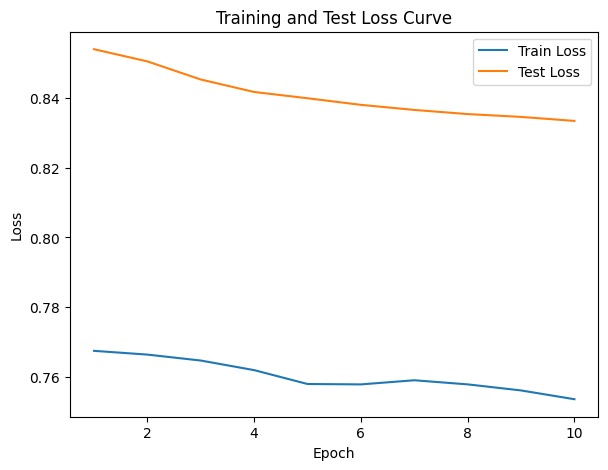

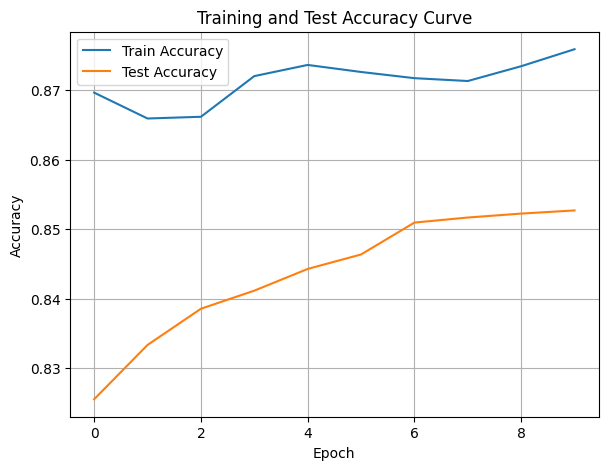

./saved_models/model_20.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.76it/s]

Epoch [1/10], Train F1:0.8816176941972287, Train Loss: 0.7377, Train Acc: 0.8896, Test F1:0.8057644110275689, Test Loss: 0.8202, Test Acc: 0.8255


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.76it/s]

Epoch [2/10], Train F1:0.8841372170154878, Train Loss: 0.7387, Train Acc: 0.8879, Test F1:0.8223268197594258, Test Loss: 0.8171, Test Acc: 0.8372


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.63it/s]

Epoch [3/10], Train F1:0.8741014564376677, Train Loss: 0.7470, Train Acc: 0.8727, Test F1:0.8131837408415308, Test Loss: 0.8190, Test Acc: 0.8307


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.63it/s]

Epoch [4/10], Train F1:0.8732681493166266, Train Loss: 0.7456, Train Acc: 0.8725, Test F1:0.8223268197594258, Test Loss: 0.8172, Test Acc: 0.8372


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.15it/s]

Epoch [5/10], Train F1:0.8757893691872392, Train Loss: 0.7414, Train Acc: 0.8752, Test F1:0.8277456174443103, Test Loss: 0.8163, Test Acc: 0.8411


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.15it/s]

Epoch [6/10], Train F1:0.8785179257562122, Train Loss: 0.7394, Train Acc: 0.8765, Test F1:0.834895664005587, Test Loss: 0.8151, Test Acc: 0.8474


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.52it/s]

Epoch [7/10], Train F1:0.8751382005050204, Train Loss: 0.7413, Train Acc: 0.8727, Test F1:0.8414610459297414, Test Loss: 0.8131, Test Acc: 0.8529


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.05it/s]

Epoch [8/10], Train F1:0.8782761416598759, Train Loss: 0.7380, Train Acc: 0.8769, Test F1:0.8424022680199306, Test Loss: 0.8125, Test Acc: 0.8534
Epoch [9/10], Train F1:0.877634556165484, Train Loss: 0.7395, Train Acc: 0.8741, Test F1:0.8443013127223652, Test Loss: 0.8126, Test Acc: 0.8546


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.68it/s]


Epoch [10/10], Train F1:0.8784387733813633, Train Loss: 0.7384, Train Acc: 0.8753, Test F1:0.8447678899769738, Test Loss: 0.8117, Test Acc: 0.8549
Total Epochs: 10
Train loss start: 0.7215151786804199, Train loss end: 0.7917026877403259
Highest Mean Train Accuracy (over epoch): 0.8895833333333333
Test loss start: 0.79415363073349, Test loss end: 0.7853906154632568
Highest mean Test Accuracy (over epoch): 0.8548611111111111


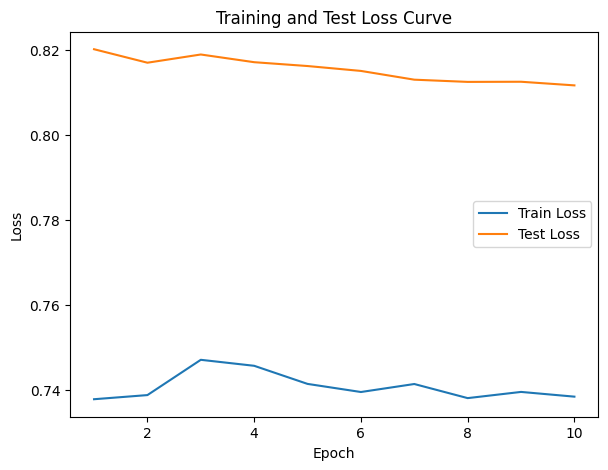

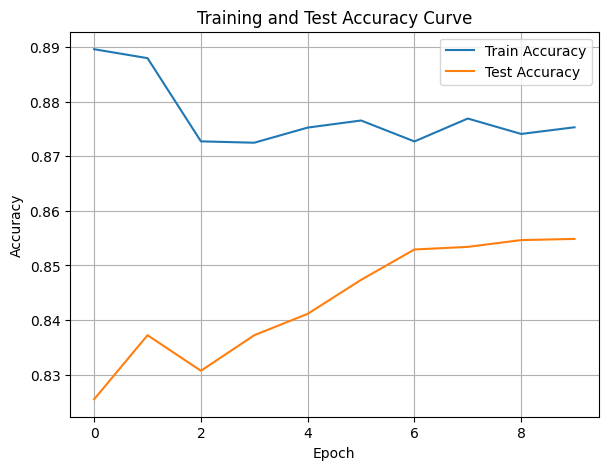

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8973387157060627, Train Loss: 0.7180, Train Acc: 0.8967, Test F1:0.8384395331763752, Test Loss: 0.7982, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.10it/s]

Epoch [2/10], Train F1:0.8892944981816909, Train Loss: 0.7173, Train Acc: 0.8932, Test F1:0.8384395331763752, Test Loss: 0.7985, Test Acc: 0.8490


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.68it/s]

Epoch [3/10], Train F1:0.8814157777574546, Train Loss: 0.7235, Train Acc: 0.8797, Test F1:0.8241385568671721, Test Loss: 0.7982, Test Acc: 0.8385


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.80it/s]

Epoch [4/10], Train F1:0.8809839379864189, Train Loss: 0.7227, Train Acc: 0.8798, Test F1:0.8277456174443104, Test Loss: 0.7958, Test Acc: 0.8411


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.13it/s]

Epoch [5/10], Train F1:0.880297594751883, Train Loss: 0.7223, Train Acc: 0.8794, Test F1:0.8320457405125598, Test Loss: 0.7938, Test Acc: 0.8443


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.36it/s]

Epoch [6/10], Train F1:0.880416711752968, Train Loss: 0.7205, Train Acc: 0.8811, Test F1:0.834895664005587, Test Loss: 0.7934, Test Acc: 0.8464
Epoch [7/10], Train F1:0.8834478404460926, Train Loss: 0.7197, Train Acc: 0.8829, Test F1:0.8369232297478519, Test Loss: 0.7928, Test Acc: 0.8478


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.02it/s]

Epoch [8/10], Train F1:0.8813901028292274, Train Loss: 0.7193, Train Acc: 0.8812, Test F1:0.8410841591133484, Test Loss: 0.7920, Test Acc: 0.8517
Epoch [9/10], Train F1:0.883189589479028, Train Loss: 0.7184, Train Acc: 0.8829, Test F1:0.8419632076141772, Test Loss: 0.7913, Test Acc: 0.8522


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.88it/s]


Epoch [10/10], Train F1:0.8814157777574547, Train Loss: 0.7192, Train Acc: 0.8821, Test F1:0.8426655563017613, Test Loss: 0.7900, Test Acc: 0.8527
Total Epochs: 10
Train loss start: 0.7213169932365417, Train loss end: 0.6230700612068176
Highest Mean Train Accuracy (over epoch): 0.8967261904761905
Test loss start: 0.7696914076805115, Test loss end: 0.7612579464912415
Highest mean Test Accuracy (over epoch): 0.8526909722222221


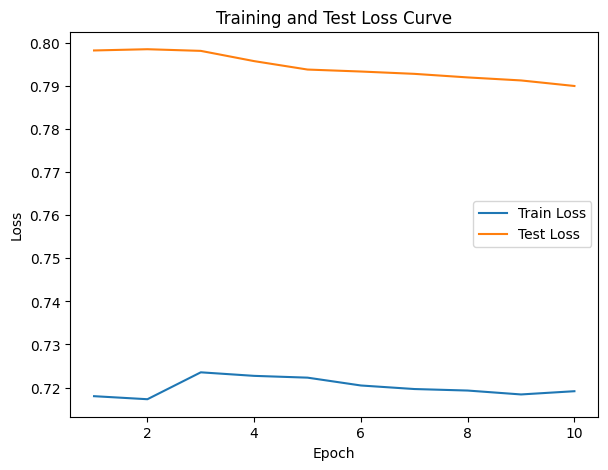

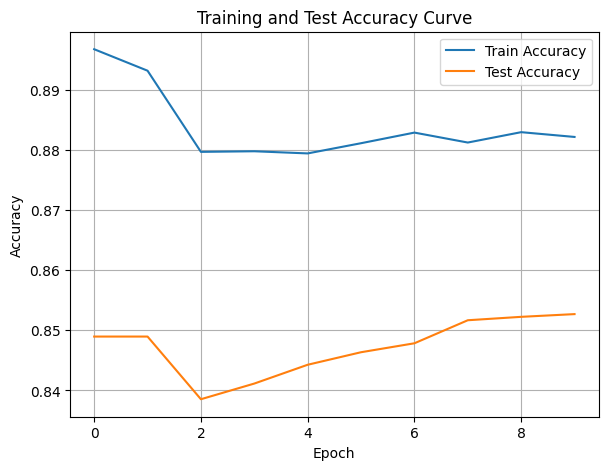

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.64it/s]

Epoch [1/10], Train F1:0.893049738783527, Train Loss: 0.7133, Train Acc: 0.8926, Test F1:0.8384395331763752, Test Loss: 0.7771, Test Acc: 0.8490


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.80it/s]

Epoch [2/10], Train F1:0.8988972250434099, Train Loss: 0.7018, Train Acc: 0.9015, Test F1:0.8437176036086195, Test Loss: 0.7759, Test Acc: 0.8529


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.67it/s]

Epoch [3/10], Train F1:0.8960205793728737, Train Loss: 0.7022, Train Acc: 0.9003, Test F1:0.8313311711907622, Test Loss: 0.7801, Test Acc: 0.8438
Epoch [4/10], Train F1:0.8947419364220868, Train Loss: 0.7012, Train Acc: 0.8997, Test F1:0.8250423629925014, Test Loss: 0.7804, Test Acc: 0.8392


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.12it/s]

Epoch [5/10], Train F1:0.8930152658889904, Train Loss: 0.7026, Train Acc: 0.8955, Test F1:0.8298995017788557, Test Loss: 0.7779, Test Acc: 0.8427
Epoch [6/10], Train F1:0.8959363921995975, Train Loss: 0.6993, Train Acc: 0.8991, Test F1:0.8331160226851115, Test Loss: 0.7774, Test Acc: 0.8451


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.95it/s]

Epoch [7/10], Train F1:0.8944817633837578, Train Loss: 0.6989, Train Acc: 0.8983, Test F1:0.8354031836086772, Test Loss: 0.7765, Test Acc: 0.8467
Epoch [8/10], Train F1:0.8929631462624431, Train Loss: 0.6999, Train Acc: 0.8963, Test F1:0.8384395331763752, Test Loss: 0.7749, Test Acc: 0.8490


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.31it/s]


Epoch [9/10], Train F1:0.8922393302932344, Train Loss: 0.7019, Train Acc: 0.8927, Test F1:0.8431333509964616, Test Loss: 0.7736, Test Acc: 0.8531
Epoch [10/10], Train F1:0.8911791987001505, Train Loss: 0.7033, Train Acc: 0.8901, Test F1:0.8447678899769738, Test Loss: 0.7725, Test Acc: 0.8543
Total Epochs: 10
Train loss start: 0.7344869375228882, Train loss end: 0.8209019899368286
Highest Mean Train Accuracy (over epoch): 0.9014880952380953
Test loss start: 0.7447378635406494, Test loss end: 0.7474443912506104
Highest mean Test Accuracy (over epoch): 0.8542534722222221


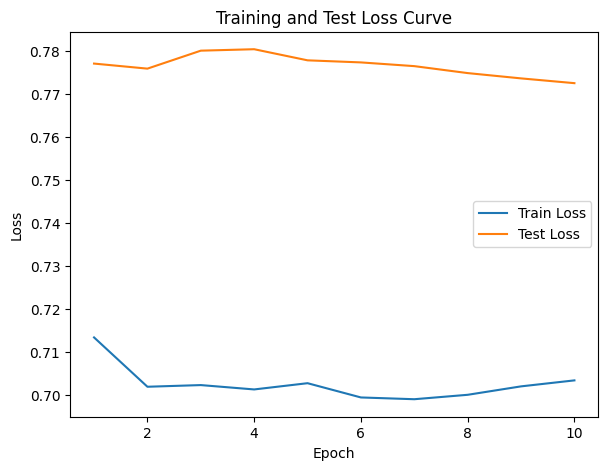

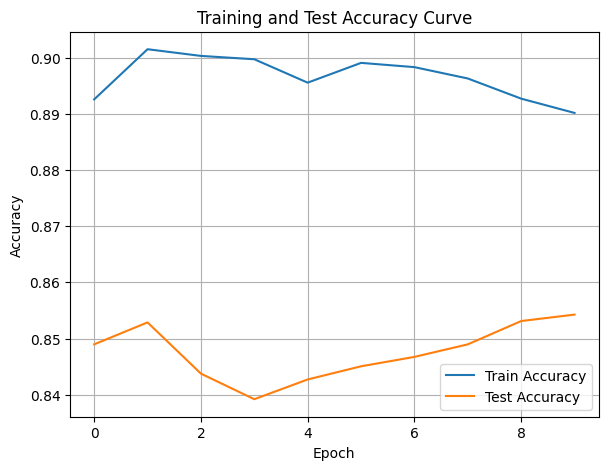

./saved_models/model_14.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [83]:
DTEmlp12b.train_DTE()

Training Process:   0%|          | 1/230 [00:00<00:26,  8.56it/s]

Epoch [1/230], Train F1:0.33692964836460443, Train Loss: 1.1255, Train Acc: 0.2753, Test F1:0.23329893360853118, Test Loss: 1.1021, Test Acc: 0.2352


Training Process:   1%|▏         | 3/230 [00:00<00:32,  7.07it/s]

Epoch [2/230], Train F1:0.35504864540558595, Train Loss: 1.1272, Train Acc: 0.2851, Test F1:0.23291929327215985, Test Loss: 1.0964, Test Acc: 0.2470
Epoch [3/230], Train F1:0.355981354148519, Train Loss: 1.1225, Train Acc: 0.2931, Test F1:0.23884450365689955, Test Loss: 1.0910, Test Acc: 0.2561


Training Process:   2%|▏         | 5/230 [00:00<00:27,  8.13it/s]

Epoch [4/230], Train F1:0.36814284717713336, Train Loss: 1.1174, Train Acc: 0.3045, Test F1:0.25449159296709206, Test Loss: 1.0872, Test Acc: 0.2665
Epoch [5/230], Train F1:0.36766556042596027, Train Loss: 1.1173, Train Acc: 0.3024, Test F1:0.27042981446712294, Test Loss: 1.0836, Test Acc: 0.2818


Training Process:   3%|▎         | 7/230 [00:00<00:26,  8.38it/s]

Epoch [6/230], Train F1:0.37494499397746567, Train Loss: 1.1135, Train Acc: 0.3103, Test F1:0.28589420281746797, Test Loss: 1.0823, Test Acc: 0.2909
Epoch [7/230], Train F1:0.3870709593465368, Train Loss: 1.1093, Train Acc: 0.3229, Test F1:0.28954925367494816, Test Loss: 1.0813, Test Acc: 0.2950


Training Process:   4%|▍         | 9/230 [00:01<00:26,  8.36it/s]

Epoch [8/230], Train F1:0.39835274312646385, Train Loss: 1.1041, Train Acc: 0.3347, Test F1:0.29625890447380376, Test Loss: 1.0797, Test Acc: 0.3030
Epoch [9/230], Train F1:0.4045809157221674, Train Loss: 1.1011, Train Acc: 0.3415, Test F1:0.34361407760117174, Test Loss: 1.0775, Test Acc: 0.3318


Training Process:   5%|▍         | 11/230 [00:01<00:27,  7.99it/s]

Epoch [10/230], Train F1:0.40845387898620933, Train Loss: 1.0995, Train Acc: 0.3452, Test F1:0.3529543093704512, Test Loss: 1.0755, Test Acc: 0.3425
Epoch [11/230], Train F1:0.4163877186807776, Train Loss: 1.0971, Train Acc: 0.3537, Test F1:0.3659910823385609, Test Loss: 1.0728, Test Acc: 0.3543


Training Process:   6%|▌         | 13/230 [00:01<00:26,  8.14it/s]

Epoch [12/230], Train F1:0.42581997667788846, Train Loss: 1.0931, Train Acc: 0.3643, Test F1:0.3952255515494964, Test Loss: 1.0701, Test Acc: 0.3757
Epoch [13/230], Train F1:0.43695874298838977, Train Loss: 1.0879, Train Acc: 0.3751, Test F1:0.4079134972882628, Test Loss: 1.0686, Test Acc: 0.3866


Training Process:   7%|▋         | 15/230 [00:01<00:25,  8.54it/s]

Epoch [14/230], Train F1:0.4470411784917294, Train Loss: 1.0851, Train Acc: 0.3843, Test F1:0.414525051149896, Test Loss: 1.0671, Test Acc: 0.3943
Epoch [15/230], Train F1:0.45561106630990295, Train Loss: 1.0816, Train Acc: 0.3926, Test F1:0.4382979948295962, Test Loss: 1.0646, Test Acc: 0.4128


Training Process:   7%|▋         | 17/230 [00:02<00:28,  7.53it/s]

Epoch [16/230], Train F1:0.4631976750364707, Train Loss: 1.0786, Train Acc: 0.3999, Test F1:0.463391986273378, Test Loss: 1.0623, Test Acc: 0.4328
Epoch [17/230], Train F1:0.47068856463068576, Train Loss: 1.0754, Train Acc: 0.4082, Test F1:0.48552083669392465, Test Loss: 1.0603, Test Acc: 0.4513


Training Process:   8%|▊         | 19/230 [00:02<00:29,  7.20it/s]

Epoch [18/230], Train F1:0.47775626754770156, Train Loss: 1.0720, Train Acc: 0.4155, Test F1:0.5019164185192359, Test Loss: 1.0581, Test Acc: 0.4661
Epoch [19/230], Train F1:0.48487223828347253, Train Loss: 1.0689, Train Acc: 0.4226, Test F1:0.5171417929343662, Test Loss: 1.0559, Test Acc: 0.4797


Training Process:   9%|▉         | 21/230 [00:02<00:28,  7.39it/s]

Epoch [20/230], Train F1:0.4907603400602777, Train Loss: 1.0658, Train Acc: 0.4291, Test F1:0.529862557415703, Test Loss: 1.0542, Test Acc: 0.4920
Epoch [21/230], Train F1:0.4970232731028461, Train Loss: 1.0624, Train Acc: 0.4363, Test F1:0.5336805767705288, Test Loss: 1.0527, Test Acc: 0.4965


Training Process:  10%|█         | 23/230 [00:02<00:28,  7.33it/s]

Epoch [22/230], Train F1:0.5040160154677165, Train Loss: 1.0589, Train Acc: 0.4435, Test F1:0.5473211977099973, Test Loss: 1.0508, Test Acc: 0.5093
Epoch [23/230], Train F1:0.5122265519016054, Train Loss: 1.0554, Train Acc: 0.4522, Test F1:0.5601563836371297, Test Loss: 1.0482, Test Acc: 0.5219


Training Process:  11%|█         | 25/230 [00:03<00:27,  7.55it/s]

Epoch [24/230], Train F1:0.519120886197902, Train Loss: 1.0519, Train Acc: 0.4598, Test F1:0.5632508160779028, Test Loss: 1.0468, Test Acc: 0.5261
Epoch [25/230], Train F1:0.5259843165441466, Train Loss: 1.0489, Train Acc: 0.4675, Test F1:0.5720017282647972, Test Loss: 1.0450, Test Acc: 0.5347


Training Process:  12%|█▏        | 27/230 [00:03<00:26,  7.67it/s]

Epoch [26/230], Train F1:0.534441591420726, Train Loss: 1.0453, Train Acc: 0.4773, Test F1:0.5803840866024854, Test Loss: 1.0433, Test Acc: 0.5429
Epoch [27/230], Train F1:0.5389960255947656, Train Loss: 1.0423, Train Acc: 0.4825, Test F1:0.587474990535887, Test Loss: 1.0417, Test Acc: 0.5499


Training Process:  12%|█▏        | 28/230 [00:03<00:30,  6.67it/s]

Epoch [28/230], Train F1:0.5436971961525733, Train Loss: 1.0395, Train Acc: 0.4882, Test F1:0.5943428648489918, Test Loss: 1.0400, Test Acc: 0.5569


Training Process:  13%|█▎        | 30/230 [00:04<00:32,  6.09it/s]

Epoch [29/230], Train F1:0.5495782873838949, Train Loss: 1.0361, Train Acc: 0.4945, Test F1:0.6032282849023496, Test Loss: 1.0378, Test Acc: 0.5658
Epoch [30/230], Train F1:0.5557383272504579, Train Loss: 1.0332, Train Acc: 0.5009, Test F1:0.6111673120139287, Test Loss: 1.0355, Test Acc: 0.5739


Training Process:  14%|█▍        | 32/230 [00:04<00:33,  5.99it/s]

Epoch [31/230], Train F1:0.5613653017335999, Train Loss: 1.0304, Train Acc: 0.5072, Test F1:0.6185957777945127, Test Loss: 1.0334, Test Acc: 0.5818
Epoch [32/230], Train F1:0.56712535903371, Train Loss: 1.0272, Train Acc: 0.5142, Test F1:0.6257474056203808, Test Loss: 1.0316, Test Acc: 0.5895


Training Process:  15%|█▍        | 34/230 [00:04<00:33,  5.84it/s]

Epoch [33/230], Train F1:0.5727674367304543, Train Loss: 1.0242, Train Acc: 0.5206, Test F1:0.6329230880177645, Test Loss: 1.0294, Test Acc: 0.5971
Epoch [34/230], Train F1:0.57846475547469, Train Loss: 1.0214, Train Acc: 0.5265, Test F1:0.637788115726744, Test Loss: 1.0278, Test Acc: 0.6024


Training Process:  15%|█▌        | 35/230 [00:04<00:33,  5.85it/s]

Epoch [35/230], Train F1:0.5839078028741468, Train Loss: 1.0186, Train Acc: 0.5327, Test F1:0.6431225634513161, Test Loss: 1.0265, Test Acc: 0.6082


Epoch [36/230], Train F1:0.5881531119653561, Train Loss: 1.0160, Train Acc: 0.5376, Test F1:0.647646211752793, Test Loss: 1.0251, Test Acc: 0.6131


Training Process:  17%|█▋        | 38/230 [00:05<00:34,  5.61it/s]

Epoch [37/230], Train F1:0.592234843379754, Train Loss: 1.0132, Train Acc: 0.5424, Test F1:0.6516839691616374, Test Loss: 1.0237, Test Acc: 0.6177
Epoch [38/230], Train F1:0.5973403910281119, Train Loss: 1.0100, Train Acc: 0.5485, Test F1:0.6568865670098898, Test Loss: 1.0221, Test Acc: 0.6232


Training Process:  17%|█▋        | 40/230 [00:05<00:32,  5.92it/s]

Epoch [39/230], Train F1:0.6027181204228013, Train Loss: 1.0069, Train Acc: 0.5547, Test F1:0.6611342472248585, Test Loss: 1.0205, Test Acc: 0.6280
Epoch [40/230], Train F1:0.60802173325164, Train Loss: 1.0037, Train Acc: 0.5607, Test F1:0.6658076980003217, Test Loss: 1.0189, Test Acc: 0.6332


Training Process:  18%|█▊        | 42/230 [00:06<00:33,  5.55it/s]

Epoch [41/230], Train F1:0.6122832531576499, Train Loss: 1.0011, Train Acc: 0.5655, Test F1:0.6710749190702304, Test Loss: 1.0170, Test Acc: 0.6391
Epoch [42/230], Train F1:0.6168832853749765, Train Loss: 0.9983, Train Acc: 0.5704, Test F1:0.6750559154173411, Test Loss: 1.0152, Test Acc: 0.6435


Training Process:  19%|█▉        | 44/230 [00:06<00:32,  5.79it/s]

Epoch [43/230], Train F1:0.6213202816767671, Train Loss: 0.9955, Train Acc: 0.5758, Test F1:0.6786617066212903, Test Loss: 1.0138, Test Acc: 0.6478
Epoch [44/230], Train F1:0.6261024360955176, Train Loss: 0.9926, Train Acc: 0.5815, Test F1:0.6822719002192235, Test Loss: 1.0122, Test Acc: 0.6519


Training Process:  20%|██        | 46/230 [00:06<00:31,  5.89it/s]

Epoch [45/230], Train F1:0.6295879233831073, Train Loss: 0.9901, Train Acc: 0.5857, Test F1:0.6855230943994499, Test Loss: 1.0105, Test Acc: 0.6556
Epoch [46/230], Train F1:0.6334306907632851, Train Loss: 0.9873, Train Acc: 0.5902, Test F1:0.6891704140904488, Test Loss: 1.0090, Test Acc: 0.6596


Training Process:  21%|██        | 48/230 [00:07<00:31,  5.78it/s]

Epoch [47/230], Train F1:0.6376598296175862, Train Loss: 0.9849, Train Acc: 0.5949, Test F1:0.6924772115251513, Test Loss: 1.0074, Test Acc: 0.6634
Epoch [48/230], Train F1:0.6419737442546096, Train Loss: 0.9819, Train Acc: 0.6000, Test F1:0.6952766212048669, Test Loss: 1.0058, Test Acc: 0.6665


Training Process:  21%|██▏       | 49/230 [00:07<00:31,  5.72it/s]

Epoch [49/230], Train F1:0.6459653615025809, Train Loss: 0.9790, Train Acc: 0.6048, Test F1:0.6986720026337365, Test Loss: 1.0043, Test Acc: 0.6703


Training Process:  22%|██▏       | 50/230 [00:07<00:31,  5.63it/s]

Epoch [50/230], Train F1:0.6493193986972693, Train Loss: 0.9765, Train Acc: 0.6089, Test F1:0.7020694976966538, Test Loss: 1.0027, Test Acc: 0.6740


Training Process:  22%|██▏       | 51/230 [00:07<00:32,  5.49it/s]

Epoch [51/230], Train F1:0.6527054511849185, Train Loss: 0.9741, Train Acc: 0.6129, Test F1:0.7043588730314925, Test Loss: 1.0012, Test Acc: 0.6767


Training Process:  23%|██▎       | 52/230 [00:07<00:32,  5.40it/s]

Epoch [52/230], Train F1:0.6559190297146953, Train Loss: 0.9717, Train Acc: 0.6166, Test F1:0.7064315510995366, Test Loss: 0.9999, Test Acc: 0.6793


Training Process:  23%|██▎       | 53/230 [00:08<00:33,  5.33it/s]

Epoch [53/230], Train F1:0.6591245477085149, Train Loss: 0.9692, Train Acc: 0.6203, Test F1:0.7094868352388979, Test Loss: 0.9983, Test Acc: 0.6827


Training Process:  23%|██▎       | 54/230 [00:08<00:37,  4.72it/s]

Epoch [54/230], Train F1:0.6624425467173856, Train Loss: 0.9666, Train Acc: 0.6242, Test F1:0.7125981570292101, Test Loss: 0.9968, Test Acc: 0.6861


Training Process:  24%|██▍       | 55/230 [00:08<00:37,  4.69it/s]

Epoch [55/230], Train F1:0.6654506629340033, Train Loss: 0.9643, Train Acc: 0.6276, Test F1:0.7155827290767817, Test Loss: 0.9952, Test Acc: 0.6895


Training Process:  24%|██▍       | 56/230 [00:08<00:37,  4.60it/s]

Epoch [56/230], Train F1:0.6687329934372721, Train Loss: 0.9617, Train Acc: 0.6313, Test F1:0.718596243366344, Test Loss: 0.9935, Test Acc: 0.6929


Training Process:  25%|██▍       | 57/230 [00:09<00:37,  4.59it/s]

Epoch [57/230], Train F1:0.6717583503248807, Train Loss: 0.9592, Train Acc: 0.6346, Test F1:0.7213308018045418, Test Loss: 0.9917, Test Acc: 0.6960


Training Process:  25%|██▌       | 58/230 [00:09<00:38,  4.47it/s]

Epoch [58/230], Train F1:0.6745300445794287, Train Loss: 0.9572, Train Acc: 0.6378, Test F1:0.723809743970713, Test Loss: 0.9901, Test Acc: 0.6989


Training Process:  26%|██▌       | 59/230 [00:09<00:38,  4.49it/s]

Epoch [59/230], Train F1:0.677672281173575, Train Loss: 0.9549, Train Acc: 0.6413, Test F1:0.7266680834907819, Test Loss: 0.9886, Test Acc: 0.7021


Training Process:  26%|██▌       | 60/230 [00:09<00:36,  4.67it/s]

Epoch [60/230], Train F1:0.6807801008759098, Train Loss: 0.9525, Train Acc: 0.6449, Test F1:0.7291156465588748, Test Loss: 0.9870, Test Acc: 0.7050


Training Process:  27%|██▋       | 61/230 [00:09<00:35,  4.83it/s]

Epoch [61/230], Train F1:0.6837684096249124, Train Loss: 0.9499, Train Acc: 0.6484, Test F1:0.7317864522311451, Test Loss: 0.9855, Test Acc: 0.7080


Training Process:  27%|██▋       | 62/230 [00:10<00:34,  4.94it/s]

Epoch [62/230], Train F1:0.6866926589191074, Train Loss: 0.9475, Train Acc: 0.6517, Test F1:0.734245956157644, Test Loss: 0.9840, Test Acc: 0.7106


Training Process:  27%|██▋       | 63/230 [00:10<00:33,  5.00it/s]

Epoch [63/230], Train F1:0.6894397358048444, Train Loss: 0.9451, Train Acc: 0.6550, Test F1:0.7367460865173622, Test Loss: 0.9824, Test Acc: 0.7135


Training Process:  28%|██▊       | 64/230 [00:10<00:32,  5.05it/s]

Epoch [64/230], Train F1:0.6921063144522024, Train Loss: 0.9430, Train Acc: 0.6578, Test F1:0.7391659793640813, Test Loss: 0.9809, Test Acc: 0.7162


Training Process:  28%|██▊       | 65/230 [00:10<00:32,  5.11it/s]

Epoch [65/230], Train F1:0.6944820232676624, Train Loss: 0.9409, Train Acc: 0.6608, Test F1:0.7415095200071894, Test Loss: 0.9794, Test Acc: 0.7188


Training Process:  29%|██▊       | 66/230 [00:10<00:35,  4.63it/s]

Epoch [66/230], Train F1:0.6972029220963912, Train Loss: 0.9384, Train Acc: 0.6640, Test F1:0.7435049562458189, Test Loss: 0.9780, Test Acc: 0.7211


Training Process:  29%|██▉       | 67/230 [00:11<00:34,  4.68it/s]

Epoch [67/230], Train F1:0.6992332499233826, Train Loss: 0.9366, Train Acc: 0.6664, Test F1:0.7448916929110164, Test Loss: 0.9766, Test Acc: 0.7227


Training Process:  30%|██▉       | 68/230 [00:11<00:34,  4.74it/s]

Epoch [68/230], Train F1:0.7015383397321383, Train Loss: 0.9346, Train Acc: 0.6690, Test F1:0.7462374056007506, Test Loss: 0.9752, Test Acc: 0.7244


Training Process:  30%|███       | 69/230 [00:11<00:34,  4.73it/s]

Epoch [69/230], Train F1:0.7039641910363051, Train Loss: 0.9325, Train Acc: 0.6719, Test F1:0.7483393099849325, Test Loss: 0.9738, Test Acc: 0.7267


Training Process:  30%|███       | 70/230 [00:11<00:34,  4.68it/s]

Epoch [70/230], Train F1:0.7060843265734208, Train Loss: 0.9305, Train Acc: 0.6743, Test F1:0.750368239761768, Test Loss: 0.9725, Test Acc: 0.7291


Training Process:  31%|███       | 71/230 [00:11<00:33,  4.71it/s]

Epoch [71/230], Train F1:0.7084455672431699, Train Loss: 0.9285, Train Acc: 0.6768, Test F1:0.7521169570096763, Test Loss: 0.9712, Test Acc: 0.7311


Training Process:  31%|███▏      | 72/230 [00:12<00:33,  4.73it/s]

Epoch [72/230], Train F1:0.7108191673931243, Train Loss: 0.9265, Train Acc: 0.6795, Test F1:0.7537129846047073, Test Loss: 0.9700, Test Acc: 0.7329


Training Process:  32%|███▏      | 73/230 [00:12<00:33,  4.69it/s]

Epoch [73/230], Train F1:0.7126426245053471, Train Loss: 0.9245, Train Acc: 0.6816, Test F1:0.7555933640583309, Test Loss: 0.9687, Test Acc: 0.7350


Training Process:  32%|███▏      | 74/230 [00:12<00:33,  4.66it/s]

Epoch [74/230], Train F1:0.7148010585724355, Train Loss: 0.9225, Train Acc: 0.6842, Test F1:0.7574220749259883, Test Loss: 0.9674, Test Acc: 0.7371


Training Process:  33%|███▎      | 75/230 [00:12<00:33,  4.63it/s]

Epoch [75/230], Train F1:0.7168311244246747, Train Loss: 0.9205, Train Acc: 0.6865, Test F1:0.7592012567502068, Test Loss: 0.9659, Test Acc: 0.7391


Training Process:  33%|███▎      | 76/230 [00:13<00:34,  4.51it/s]

Epoch [76/230], Train F1:0.7188938739030891, Train Loss: 0.9185, Train Acc: 0.6889, Test F1:0.7609329307358957, Test Loss: 0.9647, Test Acc: 0.7411


Training Process:  33%|███▎      | 77/230 [00:13<00:36,  4.15it/s]

Epoch [77/230], Train F1:0.7208893743867697, Train Loss: 0.9166, Train Acc: 0.6910, Test F1:0.7623581021209982, Test Loss: 0.9633, Test Acc: 0.7428


Training Process:  34%|███▍      | 78/230 [00:13<00:37,  4.10it/s]

Epoch [78/230], Train F1:0.7228515200090925, Train Loss: 0.9147, Train Acc: 0.6933, Test F1:0.7640033348304192, Test Loss: 0.9620, Test Acc: 0.7446


Training Process:  34%|███▍      | 79/230 [00:13<00:36,  4.16it/s]

Epoch [79/230], Train F1:0.7244720378420891, Train Loss: 0.9130, Train Acc: 0.6952, Test F1:0.7657108888960069, Test Loss: 0.9606, Test Acc: 0.7466


Training Process:  35%|███▍      | 80/230 [00:14<00:35,  4.23it/s]

Epoch [80/230], Train F1:0.7265191931789721, Train Loss: 0.9111, Train Acc: 0.6974, Test F1:0.7674899294368897, Test Loss: 0.9594, Test Acc: 0.7486


Training Process:  35%|███▌      | 81/230 [00:14<00:34,  4.34it/s]

Epoch [81/230], Train F1:0.7285964930123856, Train Loss: 0.9091, Train Acc: 0.6999, Test F1:0.7691114299439425, Test Loss: 0.9580, Test Acc: 0.7504


Training Process:  36%|███▌      | 82/230 [00:14<00:33,  4.40it/s]

Epoch [82/230], Train F1:0.7306329326421471, Train Loss: 0.9072, Train Acc: 0.7022, Test F1:0.7706929896119429, Test Loss: 0.9566, Test Acc: 0.7522


Training Process:  36%|███▌      | 83/230 [00:14<00:33,  4.39it/s]

Epoch [83/230], Train F1:0.732655156543552, Train Loss: 0.9054, Train Acc: 0.7046, Test F1:0.7718923393693509, Test Loss: 0.9551, Test Acc: 0.7537


Training Process:  37%|███▋      | 84/230 [00:14<00:33,  4.37it/s]

Epoch [84/230], Train F1:0.7340114087724025, Train Loss: 0.9037, Train Acc: 0.7064, Test F1:0.7734021911083993, Test Loss: 0.9538, Test Acc: 0.7554


Training Process:  37%|███▋      | 85/230 [00:15<00:33,  4.35it/s]

Epoch [85/230], Train F1:0.7358403672571532, Train Loss: 0.9020, Train Acc: 0.7084, Test F1:0.7748648504045008, Test Loss: 0.9524, Test Acc: 0.7571


Training Process:  37%|███▋      | 86/230 [00:15<00:33,  4.34it/s]

Epoch [86/230], Train F1:0.7374459745064036, Train Loss: 0.9003, Train Acc: 0.7102, Test F1:0.7763044623362318, Test Loss: 0.9510, Test Acc: 0.7587


Training Process:  38%|███▊      | 87/230 [00:15<00:33,  4.27it/s]

Epoch [87/230], Train F1:0.7390345949332762, Train Loss: 0.8986, Train Acc: 0.7121, Test F1:0.7770094881259451, Test Loss: 0.9501, Test Acc: 0.7596


Training Process:  38%|███▊      | 88/230 [00:16<00:36,  3.84it/s]

Epoch [88/230], Train F1:0.7405969344452437, Train Loss: 0.8968, Train Acc: 0.7139, Test F1:0.7782985045490168, Test Loss: 0.9489, Test Acc: 0.7611


Training Process:  39%|███▊      | 89/230 [00:16<00:36,  3.88it/s]

Epoch [89/230], Train F1:0.7422956494702945, Train Loss: 0.8950, Train Acc: 0.7160, Test F1:0.7795584083403946, Test Loss: 0.9477, Test Acc: 0.7625


Training Process:  39%|███▉      | 90/230 [00:16<00:38,  3.65it/s]

Epoch [90/230], Train F1:0.7437648012974942, Train Loss: 0.8935, Train Acc: 0.7177, Test F1:0.7807901880955356, Test Loss: 0.9465, Test Acc: 0.7639


Training Process:  40%|███▉      | 91/230 [00:16<00:38,  3.65it/s]

Epoch [91/230], Train F1:0.7453565360489833, Train Loss: 0.8919, Train Acc: 0.7194, Test F1:0.781994787615281, Test Loss: 0.9452, Test Acc: 0.7652


Training Process:  40%|████      | 92/230 [00:17<00:37,  3.64it/s]

Epoch [92/230], Train F1:0.7468697646498482, Train Loss: 0.8903, Train Acc: 0.7209, Test F1:0.7832734418593271, Test Loss: 0.9440, Test Acc: 0.7667


Training Process:  40%|████      | 93/230 [00:17<00:37,  3.66it/s]

Epoch [93/230], Train F1:0.7482460021394156, Train Loss: 0.8887, Train Acc: 0.7226, Test F1:0.7844360569875964, Test Loss: 0.9429, Test Acc: 0.7681


Training Process:  41%|████      | 94/230 [00:17<00:36,  3.72it/s]

Epoch [94/230], Train F1:0.7497323412101794, Train Loss: 0.8872, Train Acc: 0.7243, Test F1:0.7855632891464627, Test Loss: 0.9418, Test Acc: 0.7694


Training Process:  41%|████▏     | 95/230 [00:17<00:35,  3.80it/s]

Epoch [95/230], Train F1:0.7511298224925853, Train Loss: 0.8857, Train Acc: 0.7260, Test F1:0.7867640080400137, Test Loss: 0.9407, Test Acc: 0.7708


Training Process:  42%|████▏     | 96/230 [00:18<00:34,  3.86it/s]

Epoch [96/230], Train F1:0.7525165237159451, Train Loss: 0.8841, Train Acc: 0.7276, Test F1:0.7879397418944747, Test Loss: 0.9395, Test Acc: 0.7721


Training Process:  42%|████▏     | 97/230 [00:18<00:34,  3.88it/s]

Epoch [97/230], Train F1:0.7539088803983922, Train Loss: 0.8826, Train Acc: 0.7292, Test F1:0.7890808278921314, Test Loss: 0.9383, Test Acc: 0.7734


Training Process:  43%|████▎     | 98/230 [00:18<00:33,  3.91it/s]

Epoch [98/230], Train F1:0.7550471734788242, Train Loss: 0.8813, Train Acc: 0.7305, Test F1:0.7901145796188105, Test Loss: 0.9372, Test Acc: 0.7746


Training Process:  43%|████▎     | 99/230 [00:18<00:36,  3.61it/s]

Epoch [99/230], Train F1:0.7564107590505016, Train Loss: 0.8798, Train Acc: 0.7320, Test F1:0.7912105993221005, Test Loss: 0.9360, Test Acc: 0.7758


Training Process:  43%|████▎     | 100/230 [00:19<00:35,  3.63it/s]

Epoch [100/230], Train F1:0.757499285946845, Train Loss: 0.8784, Train Acc: 0.7334, Test F1:0.7922023547610808, Test Loss: 0.9348, Test Acc: 0.7769


Training Process:  44%|████▍     | 101/230 [00:19<00:35,  3.64it/s]

Epoch [101/230], Train F1:0.7591483090324187, Train Loss: 0.8768, Train Acc: 0.7351, Test F1:0.7931846513325728, Test Loss: 0.9338, Test Acc: 0.7781


Training Process:  44%|████▍     | 102/230 [00:19<00:35,  3.64it/s]

Epoch [102/230], Train F1:0.7604640060358057, Train Loss: 0.8753, Train Acc: 0.7367, Test F1:0.7940670159914229, Test Loss: 0.9328, Test Acc: 0.7791


Training Process:  45%|████▍     | 103/230 [00:20<00:34,  3.68it/s]

Epoch [103/230], Train F1:0.7613875607432717, Train Loss: 0.8740, Train Acc: 0.7378, Test F1:0.7950821786727318, Test Loss: 0.9316, Test Acc: 0.7802


Training Process:  45%|████▌     | 104/230 [00:20<00:34,  3.65it/s]

Epoch [104/230], Train F1:0.7626564210248997, Train Loss: 0.8726, Train Acc: 0.7393, Test F1:0.7960778358336585, Test Loss: 0.9304, Test Acc: 0.7813


Training Process:  46%|████▌     | 105/230 [00:20<00:34,  3.61it/s]

Epoch [105/230], Train F1:0.7639382214483953, Train Loss: 0.8711, Train Acc: 0.7408, Test F1:0.7970545512797723, Test Loss: 0.9292, Test Acc: 0.7824


Training Process:  46%|████▌     | 106/230 [00:20<00:34,  3.59it/s]

Epoch [106/230], Train F1:0.7650049065282192, Train Loss: 0.8697, Train Acc: 0.7422, Test F1:0.7980128670525215, Test Loss: 0.9281, Test Acc: 0.7835


Training Process:  47%|████▋     | 107/230 [00:21<00:35,  3.51it/s]

Epoch [107/230], Train F1:0.7661527737809374, Train Loss: 0.8684, Train Acc: 0.7434, Test F1:0.7988665666971588, Test Loss: 0.9268, Test Acc: 0.7845


Training Process:  47%|████▋     | 108/230 [00:21<00:35,  3.46it/s]

Epoch [108/230], Train F1:0.7671655670781501, Train Loss: 0.8670, Train Acc: 0.7447, Test F1:0.799790400139212, Test Loss: 0.9257, Test Acc: 0.7855


Training Process:  47%|████▋     | 109/230 [00:21<00:36,  3.31it/s]

Epoch [109/230], Train F1:0.7684641730543446, Train Loss: 0.8656, Train Acc: 0.7461, Test F1:0.8007069745503737, Test Loss: 0.9247, Test Acc: 0.7866


Training Process:  48%|████▊     | 110/230 [00:22<00:35,  3.36it/s]

Epoch [110/230], Train F1:0.7696466982963914, Train Loss: 0.8643, Train Acc: 0.7475, Test F1:0.80159739547218, Test Loss: 0.9237, Test Acc: 0.7876


Training Process:  48%|████▊     | 111/230 [00:22<00:34,  3.40it/s]

Epoch [111/230], Train F1:0.7709151440204357, Train Loss: 0.8629, Train Acc: 0.7489, Test F1:0.8022948268903874, Test Loss: 0.9225, Test Acc: 0.7885


Training Process:  49%|████▊     | 112/230 [00:22<00:34,  3.46it/s]

Epoch [112/230], Train F1:0.7720726820414507, Train Loss: 0.8616, Train Acc: 0.7502, Test F1:0.8032382150275474, Test Loss: 0.9214, Test Acc: 0.7895


Training Process:  49%|████▉     | 113/230 [00:22<00:33,  3.51it/s]

Epoch [113/230], Train F1:0.7733290059422919, Train Loss: 0.8603, Train Acc: 0.7516, Test F1:0.8040827053478216, Test Loss: 0.9203, Test Acc: 0.7905


Training Process:  50%|████▉     | 114/230 [00:23<00:32,  3.53it/s]

Epoch [114/230], Train F1:0.7742674821378924, Train Loss: 0.8589, Train Acc: 0.7527, Test F1:0.8049217845632144, Test Loss: 0.9194, Test Acc: 0.7915


Training Process:  50%|█████     | 115/230 [00:23<00:32,  3.50it/s]

Epoch [115/230], Train F1:0.7749634913345601, Train Loss: 0.8579, Train Acc: 0.7536, Test F1:0.8057463594521826, Test Loss: 0.9184, Test Acc: 0.7924


Training Process:  50%|█████     | 116/230 [00:23<00:32,  3.51it/s]

Epoch [116/230], Train F1:0.7759006931776065, Train Loss: 0.8565, Train Acc: 0.7548, Test F1:0.8064147449449333, Test Loss: 0.9175, Test Acc: 0.7932


Training Process:  51%|█████     | 117/230 [00:24<00:32,  3.47it/s]

Epoch [117/230], Train F1:0.7768080374823891, Train Loss: 0.8554, Train Acc: 0.7558, Test F1:0.807203501459319, Test Loss: 0.9165, Test Acc: 0.7940


Training Process:  51%|█████▏    | 118/230 [00:24<00:32,  3.41it/s]

Epoch [118/230], Train F1:0.7777828323881388, Train Loss: 0.8542, Train Acc: 0.7569, Test F1:0.8079789526991936, Test Loss: 0.9154, Test Acc: 0.7949


Training Process:  52%|█████▏    | 119/230 [00:24<00:35,  3.13it/s]

Epoch [119/230], Train F1:0.7787164083680956, Train Loss: 0.8530, Train Acc: 0.7581, Test F1:0.8087324228580661, Test Loss: 0.9143, Test Acc: 0.7958


Training Process:  52%|█████▏    | 120/230 [00:25<00:35,  3.12it/s]

Epoch [120/230], Train F1:0.7796032303568522, Train Loss: 0.8519, Train Acc: 0.7590, Test F1:0.8094823234834565, Test Loss: 0.9132, Test Acc: 0.7966


Training Process:  53%|█████▎    | 121/230 [00:25<00:35,  3.11it/s]

Epoch [121/230], Train F1:0.7806042340833368, Train Loss: 0.8508, Train Acc: 0.7601, Test F1:0.8102969135841703, Test Loss: 0.9123, Test Acc: 0.7976


Training Process:  53%|█████▎    | 122/230 [00:25<00:34,  3.17it/s]

Epoch [122/230], Train F1:0.7815277608856452, Train Loss: 0.8497, Train Acc: 0.7611, Test F1:0.8107016280037673, Test Loss: 0.9115, Test Acc: 0.7981


Training Process:  53%|█████▎    | 123/230 [00:26<00:33,  3.16it/s]

Epoch [123/230], Train F1:0.7823713510325453, Train Loss: 0.8486, Train Acc: 0.7620, Test F1:0.8114261862900327, Test Loss: 0.9105, Test Acc: 0.7990


Training Process:  54%|█████▍    | 124/230 [00:26<00:35,  2.99it/s]

Epoch [124/230], Train F1:0.7832075851554904, Train Loss: 0.8474, Train Acc: 0.7631, Test F1:0.8121304697520546, Test Loss: 0.9095, Test Acc: 0.7997


Training Process:  54%|█████▍    | 125/230 [00:26<00:36,  2.91it/s]

Epoch [125/230], Train F1:0.7839644923512239, Train Loss: 0.8462, Train Acc: 0.7641, Test F1:0.812740325153912, Test Loss: 0.9085, Test Acc: 0.8005


Training Process:  55%|█████▍    | 126/230 [00:27<00:35,  2.90it/s]

Epoch [126/230], Train F1:0.7847826449593454, Train Loss: 0.8451, Train Acc: 0.7651, Test F1:0.8134231031444867, Test Loss: 0.9075, Test Acc: 0.8012


Training Process:  55%|█████▌    | 127/230 [00:27<00:35,  2.94it/s]

Epoch [127/230], Train F1:0.7856084462982672, Train Loss: 0.8440, Train Acc: 0.7659, Test F1:0.8141686596586516, Test Loss: 0.9065, Test Acc: 0.8021


Training Process:  56%|█████▌    | 128/230 [00:27<00:33,  3.00it/s]

Epoch [128/230], Train F1:0.7866403723493668, Train Loss: 0.8429, Train Acc: 0.7671, Test F1:0.814829764001669, Test Loss: 0.9055, Test Acc: 0.8028


Training Process:  56%|█████▌    | 129/230 [00:28<00:35,  2.85it/s]

Epoch [129/230], Train F1:0.7875081700771667, Train Loss: 0.8418, Train Acc: 0.7681, Test F1:0.8155530395092462, Test Loss: 0.9045, Test Acc: 0.8037


Training Process:  57%|█████▋    | 130/230 [00:28<00:34,  2.89it/s]

Epoch [130/230], Train F1:0.7883687502870946, Train Loss: 0.8406, Train Acc: 0.7690, Test F1:0.8161934762569567, Test Loss: 0.9035, Test Acc: 0.8044


Training Process:  57%|█████▋    | 131/230 [00:28<00:34,  2.91it/s]

Epoch [131/230], Train F1:0.7891895146206908, Train Loss: 0.8396, Train Acc: 0.7700, Test F1:0.8167694997060753, Test Loss: 0.9027, Test Acc: 0.8051


Training Process:  57%|█████▋    | 132/230 [00:29<00:34,  2.88it/s]

Epoch [132/230], Train F1:0.7900637852493115, Train Loss: 0.8385, Train Acc: 0.7710, Test F1:0.8173911545403716, Test Loss: 0.9017, Test Acc: 0.8057


Training Process:  58%|█████▊    | 133/230 [00:29<00:34,  2.84it/s]

Epoch [133/230], Train F1:0.7909106638292165, Train Loss: 0.8374, Train Acc: 0.7719, Test F1:0.8180116970576051, Test Loss: 0.9008, Test Acc: 0.8065


Training Process:  58%|█████▊    | 134/230 [00:29<00:33,  2.88it/s]

Epoch [134/230], Train F1:0.7916541700956363, Train Loss: 0.8365, Train Acc: 0.7726, Test F1:0.8186149447844714, Test Loss: 0.8999, Test Acc: 0.8071


Training Process:  59%|█████▊    | 135/230 [00:30<00:35,  2.71it/s]

Epoch [135/230], Train F1:0.7925805595371788, Train Loss: 0.8354, Train Acc: 0.7737, Test F1:0.8192785294391522, Test Loss: 0.8990, Test Acc: 0.8079


Training Process:  59%|█████▉    | 136/230 [00:30<00:35,  2.66it/s]

Epoch [136/230], Train F1:0.7934924733763664, Train Loss: 0.8343, Train Acc: 0.7747, Test F1:0.8199324451318072, Test Loss: 0.8980, Test Acc: 0.8086


Training Process:  60%|█████▉    | 137/230 [00:31<00:33,  2.74it/s]

Epoch [137/230], Train F1:0.7943370115469879, Train Loss: 0.8332, Train Acc: 0.7757, Test F1:0.8205769030323583, Test Loss: 0.8971, Test Acc: 0.8094


Training Process:  60%|██████    | 138/230 [00:31<00:32,  2.81it/s]

Epoch [138/230], Train F1:0.7951727424341003, Train Loss: 0.8322, Train Acc: 0.7766, Test F1:0.8212121081681328, Test Loss: 0.8962, Test Acc: 0.8101


Training Process:  60%|██████    | 139/230 [00:31<00:32,  2.84it/s]

Epoch [139/230], Train F1:0.7959342092367286, Train Loss: 0.8312, Train Acc: 0.7775, Test F1:0.8217710067692593, Test Loss: 0.8954, Test Acc: 0.8107


Training Process:  61%|██████    | 140/230 [00:32<00:33,  2.71it/s]

Epoch [140/230], Train F1:0.7968103486974966, Train Loss: 0.8302, Train Acc: 0.7784, Test F1:0.8223887697363972, Test Loss: 0.8944, Test Acc: 0.8114


Training Process:  61%|██████▏   | 141/230 [00:32<00:32,  2.75it/s]

Epoch [141/230], Train F1:0.7976180937262674, Train Loss: 0.8291, Train Acc: 0.7794, Test F1:0.8229315335475081, Test Loss: 0.8935, Test Acc: 0.8120


Training Process:  62%|██████▏   | 142/230 [00:32<00:31,  2.79it/s]

Epoch [142/230], Train F1:0.7984696050678302, Train Loss: 0.8282, Train Acc: 0.7803, Test F1:0.8234667146674377, Test Loss: 0.8925, Test Acc: 0.8126


Training Process:  62%|██████▏   | 143/230 [00:33<00:31,  2.79it/s]

Epoch [143/230], Train F1:0.7992671901799397, Train Loss: 0.8271, Train Acc: 0.7812, Test F1:0.8239944720768785, Test Loss: 0.8916, Test Acc: 0.8132


Training Process:  63%|██████▎   | 144/230 [00:33<00:30,  2.81it/s]

Epoch [144/230], Train F1:0.800060418877582, Train Loss: 0.8261, Train Acc: 0.7821, Test F1:0.824514960312061, Test Loss: 0.8907, Test Acc: 0.8138


Training Process:  63%|██████▎   | 145/230 [00:33<00:29,  2.86it/s]

Epoch [145/230], Train F1:0.8008734799965426, Train Loss: 0.8251, Train Acc: 0.7830, Test F1:0.8250928680302185, Test Loss: 0.8898, Test Acc: 0.8144


Training Process:  63%|██████▎   | 146/230 [00:34<00:28,  2.91it/s]

Epoch [146/230], Train F1:0.8013951930251103, Train Loss: 0.8243, Train Acc: 0.7836, Test F1:0.8255496872188043, Test Loss: 0.8890, Test Acc: 0.8150


Training Process:  64%|██████▍   | 147/230 [00:34<00:28,  2.96it/s]

Epoch [147/230], Train F1:0.8020671074742377, Train Loss: 0.8234, Train Acc: 0.7844, Test F1:0.8260491604351331, Test Loss: 0.8881, Test Acc: 0.8155


Training Process:  64%|██████▍   | 148/230 [00:34<00:28,  2.87it/s]

Epoch [148/230], Train F1:0.8027697354415808, Train Loss: 0.8224, Train Acc: 0.7852, Test F1:0.8265419420438253, Test Loss: 0.8872, Test Acc: 0.8161


Training Process:  65%|██████▍   | 149/230 [00:35<00:29,  2.75it/s]

Epoch [149/230], Train F1:0.8034709990718973, Train Loss: 0.8215, Train Acc: 0.7860, Test F1:0.8270910047030589, Test Loss: 0.8864, Test Acc: 0.8167


Training Process:  65%|██████▌   | 150/230 [00:35<00:30,  2.61it/s]

Epoch [150/230], Train F1:0.8041954234782837, Train Loss: 0.8206, Train Acc: 0.7868, Test F1:0.8276328202997946, Test Loss: 0.8855, Test Acc: 0.8173


Training Process:  66%|██████▌   | 151/230 [00:36<00:32,  2.40it/s]

Epoch [151/230], Train F1:0.8047836965404931, Train Loss: 0.8197, Train Acc: 0.7875, Test F1:0.8281675321447179, Test Loss: 0.8846, Test Acc: 0.8179


Training Process:  66%|██████▌   | 152/230 [00:36<00:33,  2.36it/s]

Epoch [152/230], Train F1:0.8054043836032274, Train Loss: 0.8189, Train Acc: 0.7882, Test F1:0.828633662888557, Test Loss: 0.8837, Test Acc: 0.8185


Training Process:  67%|██████▋   | 153/230 [00:37<00:32,  2.36it/s]

Epoch [153/230], Train F1:0.806212933795167, Train Loss: 0.8179, Train Acc: 0.7891, Test F1:0.8291549788655855, Test Loss: 0.8830, Test Acc: 0.8190


Training Process:  67%|██████▋   | 154/230 [00:37<00:31,  2.42it/s]

Epoch [154/230], Train F1:0.8069203188170481, Train Loss: 0.8170, Train Acc: 0.7899, Test F1:0.829669593831908, Test Loss: 0.8822, Test Acc: 0.8196


Training Process:  67%|██████▋   | 155/230 [00:37<00:29,  2.54it/s]

Epoch [155/230], Train F1:0.8078225149900441, Train Loss: 0.8160, Train Acc: 0.7909, Test F1:0.830177636824634, Test Loss: 0.8814, Test Acc: 0.8202


Training Process:  68%|██████▊   | 156/230 [00:38<00:28,  2.64it/s]

Epoch [156/230], Train F1:0.8084057943913756, Train Loss: 0.8152, Train Acc: 0.7915, Test F1:0.8305200367216555, Test Loss: 0.8807, Test Acc: 0.8206


Training Process:  68%|██████▊   | 157/230 [00:38<00:27,  2.70it/s]

Epoch [157/230], Train F1:0.8089109199829343, Train Loss: 0.8144, Train Acc: 0.7921, Test F1:0.8308053706865348, Test Loss: 0.8800, Test Acc: 0.8210


Training Process:  69%|██████▊   | 158/230 [00:38<00:26,  2.74it/s]

Epoch [158/230], Train F1:0.8093246352918317, Train Loss: 0.8138, Train Acc: 0.7926, Test F1:0.8308843970253149, Test Loss: 0.8793, Test Acc: 0.8211


Training Process:  69%|██████▉   | 159/230 [00:39<00:25,  2.78it/s]

Epoch [159/230], Train F1:0.8099243769259074, Train Loss: 0.8129, Train Acc: 0.7932, Test F1:0.8313200885222648, Test Loss: 0.8786, Test Acc: 0.8216


Training Process:  70%|██████▉   | 160/230 [00:39<00:27,  2.58it/s]

Epoch [160/230], Train F1:0.8106048901699788, Train Loss: 0.8120, Train Acc: 0.7940, Test F1:0.831802141456391, Test Loss: 0.8777, Test Acc: 0.8221


Training Process:  70%|███████   | 161/230 [00:40<00:26,  2.62it/s]

Epoch [161/230], Train F1:0.8112534360177616, Train Loss: 0.8111, Train Acc: 0.7948, Test F1:0.8322200706490498, Test Loss: 0.8769, Test Acc: 0.8226


Training Process:  70%|███████   | 162/230 [00:40<00:25,  2.64it/s]

Epoch [162/230], Train F1:0.811899703345741, Train Loss: 0.8102, Train Acc: 0.7955, Test F1:0.8326907347492284, Test Loss: 0.8761, Test Acc: 0.8231


Training Process:  71%|███████   | 163/230 [00:40<00:25,  2.65it/s]

Epoch [163/230], Train F1:0.8125596130466074, Train Loss: 0.8094, Train Acc: 0.7962, Test F1:0.8331556841073361, Test Loss: 0.8753, Test Acc: 0.8236


Training Process:  71%|███████▏  | 164/230 [00:41<00:25,  2.61it/s]

Epoch [164/230], Train F1:0.8130905738689411, Train Loss: 0.8087, Train Acc: 0.7967, Test F1:0.8336150226680593, Test Loss: 0.8746, Test Acc: 0.8242


Training Process:  72%|███████▏  | 165/230 [00:41<00:24,  2.60it/s]

Epoch [165/230], Train F1:0.8137493491434258, Train Loss: 0.8078, Train Acc: 0.7975, Test F1:0.8340120424447149, Test Loss: 0.8737, Test Acc: 0.8246


Training Process:  72%|███████▏  | 166/230 [00:41<00:24,  2.65it/s]

Epoch [166/230], Train F1:0.8142893126069631, Train Loss: 0.8071, Train Acc: 0.7980, Test F1:0.8341113281819186, Test Loss: 0.8731, Test Acc: 0.8247


Training Process:  73%|███████▎  | 167/230 [00:42<00:24,  2.62it/s]

Epoch [167/230], Train F1:0.814756371813706, Train Loss: 0.8063, Train Acc: 0.7986, Test F1:0.8345568117963181, Test Loss: 0.8723, Test Acc: 0.8252


Training Process:  73%|███████▎  | 168/230 [00:42<00:23,  2.62it/s]

Epoch [168/230], Train F1:0.8154198546354701, Train Loss: 0.8054, Train Acc: 0.7993, Test F1:0.8349477071305474, Test Loss: 0.8716, Test Acc: 0.8257


Training Process:  73%|███████▎  | 169/230 [00:43<00:23,  2.63it/s]

Epoch [169/230], Train F1:0.8160084375362503, Train Loss: 0.8046, Train Acc: 0.8000, Test F1:0.8353275977575678, Test Loss: 0.8707, Test Acc: 0.8261


Training Process:  74%|███████▍  | 170/230 [00:43<00:24,  2.47it/s]

Epoch [170/230], Train F1:0.8166551888911574, Train Loss: 0.8037, Train Acc: 0.8008, Test F1:0.8357582184330375, Test Loss: 0.8699, Test Acc: 0.8266


Training Process:  74%|███████▍  | 171/230 [00:43<00:23,  2.50it/s]

Epoch [171/230], Train F1:0.817163338269418, Train Loss: 0.8029, Train Acc: 0.8014, Test F1:0.8361838559322452, Test Loss: 0.8691, Test Acc: 0.8271


Training Process:  75%|███████▍  | 172/230 [00:44<00:23,  2.52it/s]

Epoch [172/230], Train F1:0.8176888571198073, Train Loss: 0.8022, Train Acc: 0.8020, Test F1:0.8366045966329085, Test Loss: 0.8683, Test Acc: 0.8276


Training Process:  75%|███████▌  | 173/230 [00:44<00:22,  2.53it/s]

Epoch [173/230], Train F1:0.8182367857569758, Train Loss: 0.8014, Train Acc: 0.8026, Test F1:0.8369663124919843, Test Loss: 0.8676, Test Acc: 0.8279


Training Process:  76%|███████▌  | 174/230 [00:45<00:22,  2.52it/s]

Epoch [174/230], Train F1:0.81874864103767, Train Loss: 0.8007, Train Acc: 0.8032, Test F1:0.8373778185056197, Test Loss: 0.8669, Test Acc: 0.8284


Training Process:  76%|███████▌  | 175/230 [00:45<00:21,  2.51it/s]

Epoch [175/230], Train F1:0.8191939108356547, Train Loss: 0.8000, Train Acc: 0.8037, Test F1:0.8377846716669703, Test Loss: 0.8662, Test Acc: 0.8289


Training Process:  77%|███████▋  | 176/230 [00:45<00:21,  2.55it/s]

Epoch [176/230], Train F1:0.8196526454877276, Train Loss: 0.7993, Train Acc: 0.8042, Test F1:0.8381869507748512, Test Loss: 0.8654, Test Acc: 0.8293


Training Process:  77%|███████▋  | 177/230 [00:46<00:20,  2.58it/s]

Epoch [177/230], Train F1:0.8202299870488683, Train Loss: 0.7985, Train Acc: 0.8049, Test F1:0.8385847328515804, Test Loss: 0.8647, Test Acc: 0.8298


Training Process:  77%|███████▋  | 178/230 [00:46<00:19,  2.60it/s]

Epoch [178/230], Train F1:0.8206605204720082, Train Loss: 0.7978, Train Acc: 0.8054, Test F1:0.8389780931929512, Test Loss: 0.8640, Test Acc: 0.8302


Training Process:  78%|███████▊  | 179/230 [00:47<00:21,  2.42it/s]

Epoch [179/230], Train F1:0.8211137354470958, Train Loss: 0.7971, Train Acc: 0.8059, Test F1:0.8390888722592287, Test Loss: 0.8634, Test Acc: 0.8304


Training Process:  78%|███████▊  | 180/230 [00:47<00:20,  2.44it/s]

Epoch [180/230], Train F1:0.8215879705537565, Train Loss: 0.7964, Train Acc: 0.8064, Test F1:0.8394751179939056, Test Loss: 0.8628, Test Acc: 0.8308


Training Process:  79%|███████▊  | 181/230 [00:47<00:19,  2.47it/s]

Epoch [181/230], Train F1:0.8220983512647307, Train Loss: 0.7957, Train Acc: 0.8070, Test F1:0.8398571414683115, Test Loss: 0.8620, Test Acc: 0.8313


Training Process:  79%|███████▉  | 182/230 [00:48<00:19,  2.47it/s]

Epoch [182/230], Train F1:0.8225218145896871, Train Loss: 0.7950, Train Acc: 0.8076, Test F1:0.8401834523430719, Test Loss: 0.8612, Test Acc: 0.8316


Training Process:  80%|███████▉  | 183/230 [00:48<00:18,  2.48it/s]

Epoch [183/230], Train F1:0.8229919579746101, Train Loss: 0.7943, Train Acc: 0.8081, Test F1:0.8405575157006876, Test Loss: 0.8606, Test Acc: 0.8321


Training Process:  80%|████████  | 184/230 [00:49<00:18,  2.43it/s]

Epoch [184/230], Train F1:0.8234824555085564, Train Loss: 0.7936, Train Acc: 0.8087, Test F1:0.8409275567315201, Test Loss: 0.8599, Test Acc: 0.8325


Training Process:  80%|████████  | 185/230 [00:49<00:18,  2.40it/s]

Epoch [185/230], Train F1:0.8240008143660605, Train Loss: 0.7929, Train Acc: 0.8093, Test F1:0.8412429047629028, Test Loss: 0.8591, Test Acc: 0.8328


Training Process:  81%|████████  | 186/230 [00:50<00:18,  2.43it/s]

Epoch [186/230], Train F1:0.8244756507598515, Train Loss: 0.7923, Train Acc: 0.8097, Test F1:0.8413431962829182, Test Loss: 0.8586, Test Acc: 0.8329


Training Process:  81%|████████▏ | 187/230 [00:50<00:17,  2.44it/s]

Epoch [187/230], Train F1:0.8249226263263627, Train Loss: 0.7916, Train Acc: 0.8103, Test F1:0.8416587600336733, Test Loss: 0.8580, Test Acc: 0.8333


Training Process:  82%|████████▏ | 188/230 [00:50<00:18,  2.30it/s]

Epoch [188/230], Train F1:0.8254123752847914, Train Loss: 0.7909, Train Acc: 0.8108, Test F1:0.8419709973754079, Test Loss: 0.8574, Test Acc: 0.8336


Training Process:  82%|████████▏ | 189/230 [00:51<00:17,  2.30it/s]

Epoch [189/230], Train F1:0.8259702260361178, Train Loss: 0.7902, Train Acc: 0.8114, Test F1:0.8420161809735232, Test Loss: 0.8568, Test Acc: 0.8337


Training Process:  83%|████████▎ | 190/230 [00:51<00:17,  2.28it/s]

Epoch [190/230], Train F1:0.8264055984238854, Train Loss: 0.7895, Train Acc: 0.8120, Test F1:0.8423670164582001, Test Loss: 0.8561, Test Acc: 0.8341


Training Process:  83%|████████▎ | 191/230 [00:52<00:17,  2.26it/s]

Epoch [191/230], Train F1:0.8268351873256652, Train Loss: 0.7889, Train Acc: 0.8124, Test F1:0.8427142177077839, Test Loss: 0.8555, Test Acc: 0.8345


Training Process:  83%|████████▎ | 192/230 [00:52<00:17,  2.19it/s]

Epoch [192/230], Train F1:0.8273201859076642, Train Loss: 0.7882, Train Acc: 0.8129, Test F1:0.8430578411068459, Test Loss: 0.8548, Test Acc: 0.8349


Training Process:  84%|████████▍ | 193/230 [00:53<00:17,  2.16it/s]

Epoch [193/230], Train F1:0.8278164157391361, Train Loss: 0.7875, Train Acc: 0.8135, Test F1:0.8433979418754385, Test Loss: 0.8542, Test Acc: 0.8353


Training Process:  84%|████████▍ | 194/230 [00:53<00:16,  2.16it/s]

Epoch [194/230], Train F1:0.8281933792656407, Train Loss: 0.7870, Train Acc: 0.8139, Test F1:0.8437345740991051, Test Loss: 0.8535, Test Acc: 0.8357


Training Process:  85%|████████▍ | 195/230 [00:54<00:15,  2.23it/s]

Epoch [195/230], Train F1:0.8286363455605813, Train Loss: 0.7864, Train Acc: 0.8144, Test F1:0.8440196442051099, Test Loss: 0.8527, Test Acc: 0.8360


Training Process:  85%|████████▌ | 196/230 [00:54<00:15,  2.26it/s]

Epoch [196/230], Train F1:0.8290347028468531, Train Loss: 0.7858, Train Acc: 0.8148, Test F1:0.8443497402827548, Test Loss: 0.8521, Test Acc: 0.8363


Training Process:  86%|████████▌ | 197/230 [00:55<00:15,  2.17it/s]

Epoch [197/230], Train F1:0.8295271872266359, Train Loss: 0.7851, Train Acc: 0.8154, Test F1:0.8446765211197766, Test Loss: 0.8514, Test Acc: 0.8367


Training Process:  86%|████████▌ | 198/230 [00:55<00:14,  2.16it/s]

Epoch [198/230], Train F1:0.8299254330846197, Train Loss: 0.7845, Train Acc: 0.8158, Test F1:0.8446694044378725, Test Loss: 0.8510, Test Acc: 0.8367


Training Process:  87%|████████▋ | 199/230 [00:55<00:14,  2.16it/s]

Epoch [199/230], Train F1:0.8304500261271685, Train Loss: 0.7838, Train Acc: 0.8164, Test F1:0.8447823435751972, Test Loss: 0.8504, Test Acc: 0.8369


Training Process:  87%|████████▋ | 200/230 [00:56<00:13,  2.16it/s]

Epoch [200/230], Train F1:0.8308256905608928, Train Loss: 0.7832, Train Acc: 0.8169, Test F1:0.8451020974015542, Test Loss: 0.8498, Test Acc: 0.8372


Training Process:  87%|████████▋ | 201/230 [00:56<00:13,  2.12it/s]

Epoch [201/230], Train F1:0.8312854437298532, Train Loss: 0.7825, Train Acc: 0.8174, Test F1:0.845371991414571, Test Loss: 0.8491, Test Acc: 0.8375


Training Process:  88%|████████▊ | 202/230 [00:57<00:14,  1.97it/s]

Epoch [202/230], Train F1:0.8317059642308035, Train Loss: 0.7818, Train Acc: 0.8179, Test F1:0.8454797970548277, Test Loss: 0.8486, Test Acc: 0.8377


Training Process:  88%|████████▊ | 203/230 [00:58<00:13,  1.94it/s]

Epoch [203/230], Train F1:0.832174640644347, Train Loss: 0.7811, Train Acc: 0.8185, Test F1:0.845791463962868, Test Loss: 0.8480, Test Acc: 0.8380


Training Process:  89%|████████▊ | 204/230 [00:58<00:12,  2.01it/s]

Epoch [204/230], Train F1:0.8325541034135131, Train Loss: 0.7805, Train Acc: 0.8189, Test F1:0.8461001081015385, Test Loss: 0.8473, Test Acc: 0.8384


Training Process:  89%|████████▉ | 205/230 [00:58<00:12,  2.05it/s]

Epoch [205/230], Train F1:0.8328976614002604, Train Loss: 0.7800, Train Acc: 0.8193, Test F1:0.8464057733797953, Test Loss: 0.8467, Test Acc: 0.8387


Training Process:  90%|████████▉ | 206/230 [00:59<00:12,  1.98it/s]

Epoch [206/230], Train F1:0.8332657727746625, Train Loss: 0.7794, Train Acc: 0.8197, Test F1:0.8465468950679057, Test Loss: 0.8462, Test Acc: 0.8389


Training Process:  90%|█████████ | 207/230 [00:59<00:11,  2.01it/s]

Epoch [207/230], Train F1:0.8337227588162299, Train Loss: 0.7787, Train Acc: 0.8203, Test F1:0.8468474933306567, Test Loss: 0.8456, Test Acc: 0.8393


Training Process:  90%|█████████ | 208/230 [01:00<00:10,  2.01it/s]

Epoch [208/230], Train F1:0.8340607603577986, Train Loss: 0.7782, Train Acc: 0.8207, Test F1:0.8471000812451751, Test Loss: 0.8449, Test Acc: 0.8395


Training Process:  91%|█████████ | 209/230 [01:00<00:10,  2.00it/s]

Epoch [209/230], Train F1:0.8345125288753645, Train Loss: 0.7776, Train Acc: 0.8212, Test F1:0.8473002233595835, Test Loss: 0.8443, Test Acc: 0.8398


Training Process:  91%|█████████▏| 210/230 [01:01<00:10,  1.96it/s]

Epoch [210/230], Train F1:0.8347988971871187, Train Loss: 0.7771, Train Acc: 0.8215, Test F1:0.8475930274754359, Test Loss: 0.8437, Test Acc: 0.8401


Training Process:  92%|█████████▏| 211/230 [01:01<00:09,  2.01it/s]

Epoch [211/230], Train F1:0.8351943740391924, Train Loss: 0.7765, Train Acc: 0.8220, Test F1:0.847725237395942, Test Loss: 0.8431, Test Acc: 0.8403


Training Process:  92%|█████████▏| 212/230 [01:02<00:08,  2.07it/s]

Epoch [212/230], Train F1:0.8355660687875504, Train Loss: 0.7759, Train Acc: 0.8224, Test F1:0.8480133157362552, Test Loss: 0.8426, Test Acc: 0.8406


Training Process:  93%|█████████▎| 213/230 [01:02<00:08,  2.11it/s]

Epoch [213/230], Train F1:0.8358303968923837, Train Loss: 0.7754, Train Acc: 0.8227, Test F1:0.8481814232610403, Test Loss: 0.8421, Test Acc: 0.8408


Training Process:  93%|█████████▎| 214/230 [01:03<00:07,  2.12it/s]

Epoch [214/230], Train F1:0.836127961127089, Train Loss: 0.7749, Train Acc: 0.8231, Test F1:0.8484258032847006, Test Loss: 0.8416, Test Acc: 0.8411


Training Process:  93%|█████████▎| 215/230 [01:03<00:07,  1.97it/s]

Epoch [215/230], Train F1:0.8364494796269545, Train Loss: 0.7743, Train Acc: 0.8235, Test F1:0.8486679302328883, Test Loss: 0.8410, Test Acc: 0.8414


Training Process:  94%|█████████▍| 216/230 [01:04<00:07,  1.97it/s]

Epoch [216/230], Train F1:0.8367944933405285, Train Loss: 0.7737, Train Acc: 0.8239, Test F1:0.8489464008524387, Test Loss: 0.8404, Test Acc: 0.8417


Training Process:  94%|█████████▍| 217/230 [01:04<00:06,  1.95it/s]

Epoch [217/230], Train F1:0.8371745402088941, Train Loss: 0.7731, Train Acc: 0.8243, Test F1:0.849183940205857, Test Loss: 0.8398, Test Acc: 0.8420


Training Process:  95%|█████████▍| 218/230 [01:05<00:06,  1.91it/s]

Epoch [218/230], Train F1:0.8375948925087818, Train Loss: 0.7725, Train Acc: 0.8248, Test F1:0.8494193196011873, Test Loss: 0.8393, Test Acc: 0.8423


Training Process:  95%|█████████▌| 219/230 [01:06<00:05,  1.97it/s]

Epoch [219/230], Train F1:0.8380210656382896, Train Loss: 0.7719, Train Acc: 0.8253, Test F1:0.8494007937033408, Test Loss: 0.8389, Test Acc: 0.8423


Training Process:  96%|█████████▌| 220/230 [01:06<00:04,  2.02it/s]

Epoch [220/230], Train F1:0.8383505809527109, Train Loss: 0.7714, Train Acc: 0.8257, Test F1:0.8495951786093983, Test Loss: 0.8384, Test Acc: 0.8425


Training Process:  96%|█████████▌| 221/230 [01:06<00:04,  2.04it/s]

Epoch [221/230], Train F1:0.8387271061264431, Train Loss: 0.7709, Train Acc: 0.8261, Test F1:0.8498255231474656, Test Loss: 0.8379, Test Acc: 0.8428


Training Process:  97%|█████████▋| 222/230 [01:07<00:03,  2.04it/s]

Epoch [222/230], Train F1:0.8390312208950469, Train Loss: 0.7704, Train Acc: 0.8265, Test F1:0.8498005814775329, Test Loss: 0.8375, Test Acc: 0.8428


Training Process:  97%|█████████▋| 223/230 [01:08<00:03,  1.93it/s]

Epoch [223/230], Train F1:0.8394585123089346, Train Loss: 0.7698, Train Acc: 0.8269, Test F1:0.8499763334143327, Test Loss: 0.8369, Test Acc: 0.8430


Training Process:  97%|█████████▋| 224/230 [01:08<00:03,  1.91it/s]

Epoch [224/230], Train F1:0.8397519791445724, Train Loss: 0.7693, Train Acc: 0.8273, Test F1:0.8502391285392874, Test Loss: 0.8363, Test Acc: 0.8433


Training Process:  98%|█████████▊| 225/230 [01:09<00:02,  1.89it/s]

Epoch [225/230], Train F1:0.8400266351575544, Train Loss: 0.7688, Train Acc: 0.8276, Test F1:0.8504996125855685, Test Loss: 0.8357, Test Acc: 0.8436


Training Process:  98%|█████████▊| 226/230 [01:09<00:02,  1.87it/s]

Epoch [226/230], Train F1:0.8403674928295863, Train Loss: 0.7683, Train Acc: 0.8280, Test F1:0.8507578159944055, Test Loss: 0.8352, Test Acc: 0.8439


Training Process:  99%|█████████▊| 227/230 [01:10<00:01,  1.93it/s]

Epoch [227/230], Train F1:0.8407624875441744, Train Loss: 0.7678, Train Acc: 0.8284, Test F1:0.851013768673228, Test Loss: 0.8346, Test Acc: 0.8442


Training Process:  99%|█████████▉| 228/230 [01:10<00:01,  1.98it/s]

Epoch [228/230], Train F1:0.8411175280564386, Train Loss: 0.7672, Train Acc: 0.8288, Test F1:0.8512675000073465, Test Loss: 0.8341, Test Acc: 0.8445


Training Process: 100%|█████████▉| 229/230 [01:11<00:00,  2.00it/s]

Epoch [229/230], Train F1:0.8414193788102603, Train Loss: 0.7668, Train Acc: 0.8291, Test F1:0.8512415698912563, Test Loss: 0.8337, Test Acc: 0.8445


Training Process: 100%|██████████| 230/230 [01:11<00:00,  3.21it/s]


Epoch [230/230], Train F1:0.8417895720405257, Train Loss: 0.7662, Train Acc: 0.8295, Test F1:0.8514921153069474, Test Loss: 0.8332, Test Acc: 0.8447
Total Epochs: 230
Train loss start: 1.1326631307601929, Train loss end: 0.5614280104637146
Highest Mean Train Accuracy (over epoch): 0.8295302795031055
Test loss start: 1.1020020246505737, Test loss end: 0.7087540030479431
Highest Mean Test Accuracy (over epoch): 0.8447350543478263


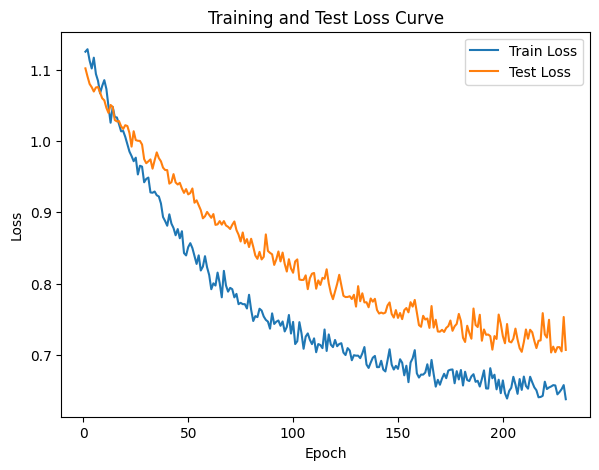

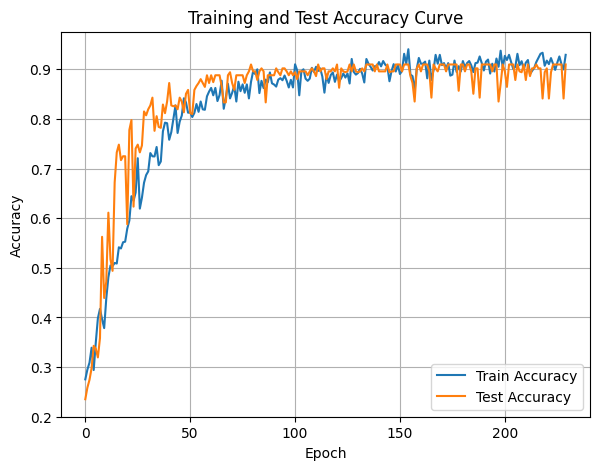

In [84]:
DTEmlp12b.train_single_model()

Randomly initializing 12 models
Training Model with id 1
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.70it/s]

Epoch [1/10], Train F1:0.4671321929112084, Train Loss: 1.0715, Train Acc: 0.4598, Test F1:0.5384382493278755, Test Loss: 1.0898, Test Acc: 0.5642
Epoch [2/10], Train F1:0.486957056632036, Train Loss: 1.0631, Train Acc: 0.4827, Test F1:0.5147819660014782, Test Loss: 1.0877, Test Acc: 0.5417


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.07it/s]

Epoch [3/10], Train F1:0.4859049257977716, Train Loss: 1.0609, Train Acc: 0.4848, Test F1:0.5208519223369629, Test Loss: 1.0865, Test Acc: 0.5341
Epoch [4/10], Train F1:0.49346010013746955, Train Loss: 1.0581, Train Acc: 0.4926, Test F1:0.5327825345082966, Test Loss: 1.0855, Test Acc: 0.5421


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.95it/s]

Epoch [5/10], Train F1:0.4975184454674262, Train Loss: 1.0562, Train Acc: 0.5009, Test F1:0.5402964637223598, Test Loss: 1.0826, Test Acc: 0.5571
Epoch [6/10], Train F1:0.5063536972932063, Train Loss: 1.0513, Train Acc: 0.5122, Test F1:0.5463444180582636, Test Loss: 1.0801, Test Acc: 0.5718


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.92it/s]

Epoch [7/10], Train F1:0.5132160972711357, Train Loss: 1.0475, Train Acc: 0.5200, Test F1:0.5568599300002852, Test Loss: 1.0766, Test Acc: 0.5847
Epoch [8/10], Train F1:0.5195873518600728, Train Loss: 1.0440, Train Acc: 0.5292, Test F1:0.5654886399449903, Test Loss: 1.0745, Test Acc: 0.5944


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.83it/s]


Epoch [9/10], Train F1:0.5249315163020449, Train Loss: 1.0423, Train Acc: 0.5314, Test F1:0.5807807134347187, Test Loss: 1.0728, Test Acc: 0.6070
Epoch [10/10], Train F1:0.5271436693576304, Train Loss: 1.0404, Train Acc: 0.5344, Test F1:0.5922343900183236, Test Loss: 1.0709, Test Acc: 0.6184
Total Epochs: 10
Train loss start: 1.1081229448318481, Train loss end: 1.0262227058410645
Highest Mean Train Accuracy (over epoch): 0.534375
Test loss start: 1.0832439661026, Test loss end: 1.0614464282989502
Highest mean Test Accuracy (over epoch): 0.6184027777777777


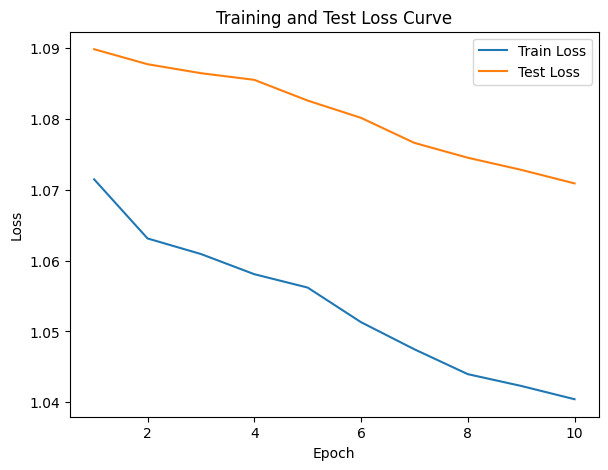

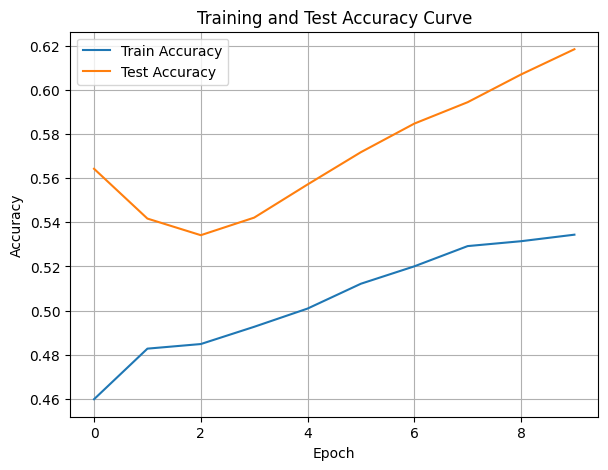

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.23511751837540468, Train Loss: 1.1847, Train Acc: 0.1625, Test F1:0.2460220318237454, Test Loss: 1.1164, Test Acc: 0.2682


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.31it/s]

Epoch [2/10], Train F1:0.24790233271911394, Train Loss: 1.1787, Train Acc: 0.1777, Test F1:0.20964546286723795, Test Loss: 1.1184, Test Acc: 0.2526


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.16it/s]

Epoch [3/10], Train F1:0.2495467031382012, Train Loss: 1.1735, Train Acc: 0.1807, Test F1:0.19840251034089285, Test Loss: 1.1172, Test Acc: 0.2500
Epoch [4/10], Train F1:0.2622189504294843, Train Loss: 1.1699, Train Acc: 0.1910, Test F1:0.19554854569600566, Test Loss: 1.1166, Test Acc: 0.2526


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.16it/s]

Epoch [5/10], Train F1:0.2801732716216466, Train Loss: 1.1649, Train Acc: 0.2062, Test F1:0.19865453106450331, Test Loss: 1.1132, Test Acc: 0.2660


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.01it/s]

Epoch [6/10], Train F1:0.28918882757892617, Train Loss: 1.1615, Train Acc: 0.2133, Test F1:0.20271629943530595, Test Loss: 1.1107, Test Acc: 0.2762


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.01it/s]

Epoch [7/10], Train F1:0.30008323213174964, Train Loss: 1.1581, Train Acc: 0.2226, Test F1:0.20830184619792508, Test Loss: 1.1094, Test Acc: 0.2837


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.96it/s]

Epoch [8/10], Train F1:0.31187013042069534, Train Loss: 1.1546, Train Acc: 0.2313, Test F1:0.2161731873107086, Test Loss: 1.1078, Test Acc: 0.2904


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.96it/s]

Epoch [9/10], Train F1:0.3240264329769802, Train Loss: 1.1506, Train Acc: 0.2436, Test F1:0.22755083602875273, Test Loss: 1.1061, Test Acc: 0.2955


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.92it/s]


Epoch [10/10], Train F1:0.3340422654268808, Train Loss: 1.1467, Train Acc: 0.2537, Test F1:0.2358351902272152, Test Loss: 1.1040, Test Acc: 0.3018
Total Epochs: 10
Train loss start: 1.1828362941741943, Train loss end: 1.0520521402359009
Highest Mean Train Accuracy (over epoch): 0.25366071428571424
Test loss start: 1.1168380975723267, Test loss end: 1.0897749662399292
Highest mean Test Accuracy (over epoch): 0.30182291666666666


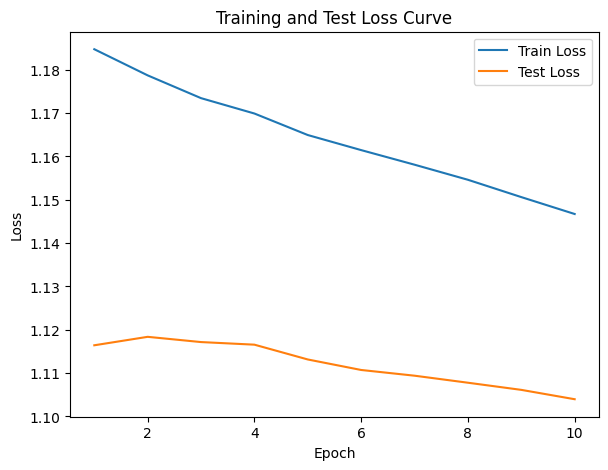

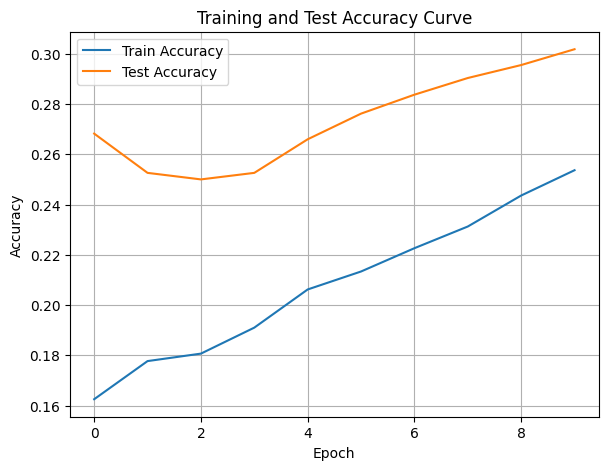

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4399897829297095, Train Loss: 1.0674, Train Acc: 0.4310, Test F1:0.44127455244820846, Test Loss: 1.0741, Test Acc: 0.4470


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.88it/s]

Epoch [2/10], Train F1:0.46321057163311613, Train Loss: 1.0651, Train Acc: 0.4501, Test F1:0.44546746737884796, Test Loss: 1.0744, Test Acc: 0.4640


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.58it/s]

Epoch [3/10], Train F1:0.47221458964632224, Train Loss: 1.0614, Train Acc: 0.4565, Test F1:0.4282902897861347, Test Loss: 1.0721, Test Acc: 0.4598


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.41it/s]

Epoch [4/10], Train F1:0.4838833322152023, Train Loss: 1.0583, Train Acc: 0.4662, Test F1:0.40568615657260304, Test Loss: 1.0725, Test Acc: 0.4449


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.42it/s]

Epoch [5/10], Train F1:0.49074719304870185, Train Loss: 1.0548, Train Acc: 0.4746, Test F1:0.3904128794665679, Test Loss: 1.0715, Test Acc: 0.4347


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.55it/s]

Epoch [6/10], Train F1:0.5037317214204454, Train Loss: 1.0486, Train Acc: 0.4885, Test F1:0.386175668086146, Test Loss: 1.0696, Test Acc: 0.4319


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.74it/s]

Epoch [7/10], Train F1:0.5111044675385518, Train Loss: 1.0450, Train Acc: 0.4969, Test F1:0.4022690806108524, Test Loss: 1.0669, Test Acc: 0.4444


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.95it/s]

Epoch [8/10], Train F1:0.5187430362400582, Train Loss: 1.0409, Train Acc: 0.5056, Test F1:0.40319937058127464, Test Loss: 1.0651, Test Acc: 0.4465


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.92it/s]

Epoch [9/10], Train F1:0.5281050818662378, Train Loss: 1.0376, Train Acc: 0.5150, Test F1:0.40337492833503397, Test Loss: 1.0639, Test Acc: 0.4472


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.76it/s]


Epoch [10/10], Train F1:0.5311178449939127, Train Loss: 1.0354, Train Acc: 0.5189, Test F1:0.4146685287059563, Test Loss: 1.0620, Test Acc: 0.4567
Total Epochs: 10
Train loss start: 1.0212948322296143, Train loss end: 0.9669933915138245
Highest Mean Train Accuracy (over epoch): 0.5188988095238096
Test loss start: 1.0818524360656738, Test loss end: 1.039325475692749
Highest mean Test Accuracy (over epoch): 0.4639756944444444


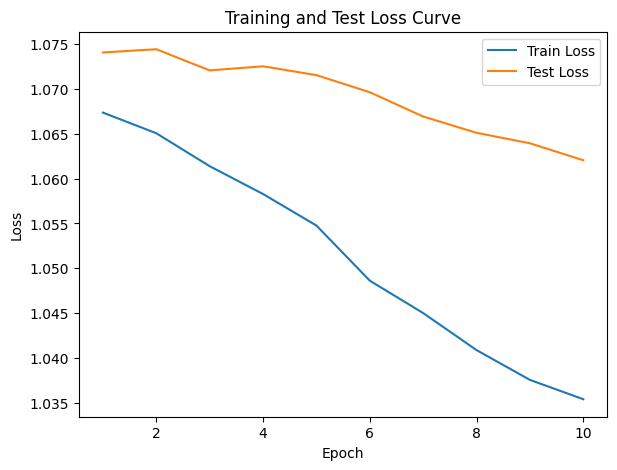

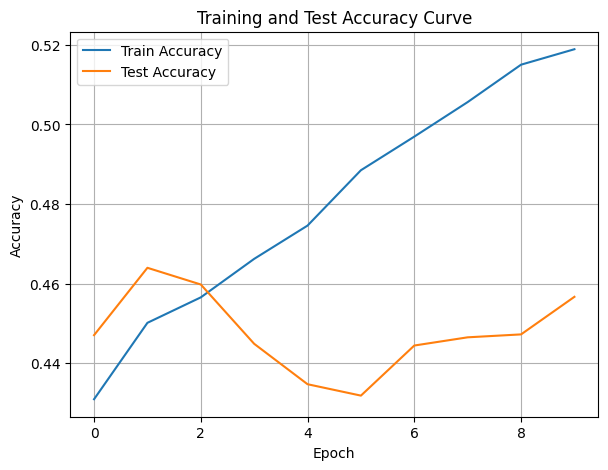

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.79it/s]

Epoch [1/10], Train F1:0.4681156914759454, Train Loss: 1.0236, Train Acc: 0.5685, Test F1:0.5025466893039049, Test Loss: 1.0291, Test Acc: 0.6354


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.56it/s]

Epoch [2/10], Train F1:0.47402757285309194, Train Loss: 1.0269, Train Acc: 0.5751, Test F1:0.5167184619496823, Test Loss: 1.0262, Test Acc: 0.6471


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.27it/s]

Epoch [3/10], Train F1:0.4775596828845243, Train Loss: 1.0248, Train Acc: 0.5847, Test F1:0.5143203282141098, Test Loss: 1.0228, Test Acc: 0.6458


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.22it/s]

Epoch [4/10], Train F1:0.4769148024124615, Train Loss: 1.0222, Train Acc: 0.5890, Test F1:0.5173486900085276, Test Loss: 1.0177, Test Acc: 0.6471


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.47it/s]

Epoch [5/10], Train F1:0.48024938510670556, Train Loss: 1.0207, Train Acc: 0.5902, Test F1:0.5166724515675244, Test Loss: 1.0145, Test Acc: 0.6479
Epoch [6/10], Train F1:0.480219767311325, Train Loss: 1.0180, Train Acc: 0.5892, Test F1:0.5190388294457234, Test Loss: 1.0125, Test Acc: 0.6497


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.47it/s]

Epoch [7/10], Train F1:0.4808528367378417, Train Loss: 1.0144, Train Acc: 0.5918, Test F1:0.5235228876789676, Test Loss: 1.0102, Test Acc: 0.6530


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.24it/s]

Epoch [8/10], Train F1:0.48390620840952747, Train Loss: 1.0110, Train Acc: 0.5971, Test F1:0.5268698849128798, Test Loss: 1.0062, Test Acc: 0.6555
Epoch [9/10], Train F1:0.4844019418283366, Train Loss: 1.0096, Train Acc: 0.5975, Test F1:0.5294636749605753, Test Loss: 1.0038, Test Acc: 0.6574


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.84it/s]


Epoch [10/10], Train F1:0.4839886958932822, Train Loss: 1.0072, Train Acc: 0.5979, Test F1:0.5334542988506688, Test Loss: 1.0017, Test Acc: 0.6603
Total Epochs: 10
Train loss start: 1.0734827518463135, Train loss end: 0.9252215623855591
Highest Mean Train Accuracy (over epoch): 0.5978869047619049
Test loss start: 1.019980549812317, Test loss end: 0.9652619957923889
Highest mean Test Accuracy (over epoch): 0.660329861111111


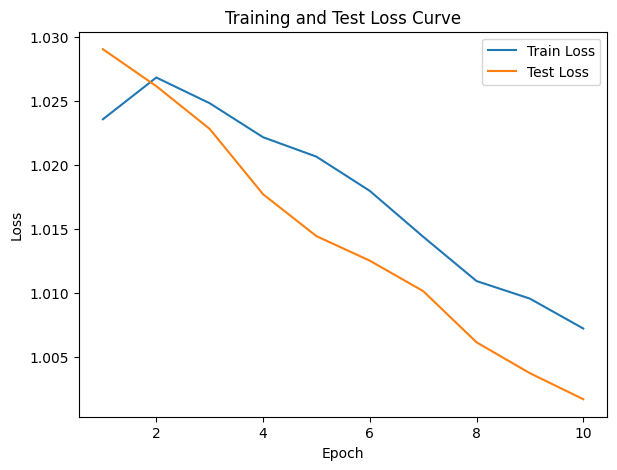

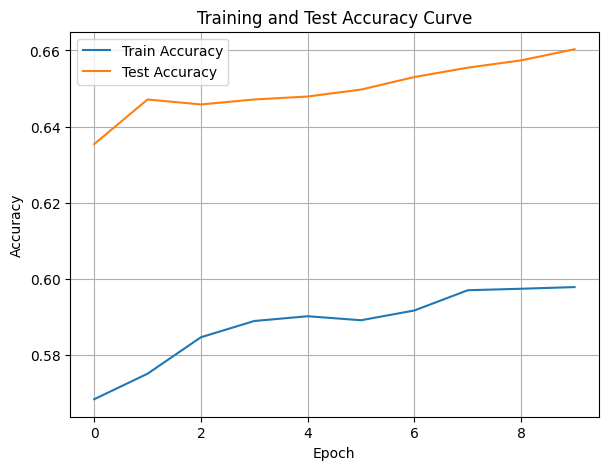

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.5094156907988028, Train Loss: 1.0535, Train Acc: 0.5089, Test F1:0.558504340736975, Test Loss: 1.0710, Test Acc: 0.5729


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.66it/s]

Epoch [2/10], Train F1:0.5067088940211523, Train Loss: 1.0512, Train Acc: 0.5021, Test F1:0.5846370300672996, Test Loss: 1.0633, Test Acc: 0.6189


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.66it/s]

Epoch [3/10], Train F1:0.505335742488798, Train Loss: 1.0443, Train Acc: 0.5086, Test F1:0.5938943519036953, Test Loss: 1.0581, Test Acc: 0.6343


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.23it/s]

Epoch [4/10], Train F1:0.508219757164071, Train Loss: 1.0400, Train Acc: 0.5144, Test F1:0.6101285602670644, Test Loss: 1.0509, Test Acc: 0.6567


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.23it/s]

Epoch [5/10], Train F1:0.5125473878561342, Train Loss: 1.0367, Train Acc: 0.5173, Test F1:0.6190679951912301, Test Loss: 1.0490, Test Acc: 0.6642


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.29it/s]

Epoch [6/10], Train F1:0.5193910125693183, Train Loss: 1.0341, Train Acc: 0.5235, Test F1:0.6204882515858127, Test Loss: 1.0448, Test Acc: 0.6706


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.29it/s]

Epoch [7/10], Train F1:0.5240848980540501, Train Loss: 1.0308, Train Acc: 0.5305, Test F1:0.6264511854348516, Test Loss: 1.0409, Test Acc: 0.6793


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.37it/s]

Epoch [8/10], Train F1:0.5300035268595207, Train Loss: 1.0281, Train Acc: 0.5356, Test F1:0.6295710664357604, Test Loss: 1.0349, Test Acc: 0.6859


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.37it/s]

Epoch [9/10], Train F1:0.5348686081489422, Train Loss: 1.0245, Train Acc: 0.5414, Test F1:0.6353276756653382, Test Loss: 1.0297, Test Acc: 0.6927


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.48it/s]


Epoch [10/10], Train F1:0.5455764294678889, Train Loss: 1.0198, Train Acc: 0.5511, Test F1:0.6413974256157209, Test Loss: 1.0254, Test Acc: 0.6990
Total Epochs: 10
Train loss start: 1.0396229028701782, Train loss end: 1.1096440553665161
Highest Mean Train Accuracy (over epoch): 0.5510714285714285
Test loss start: 1.0635478496551514, Test loss end: 0.9761175513267517
Highest mean Test Accuracy (over epoch): 0.6989583333333333


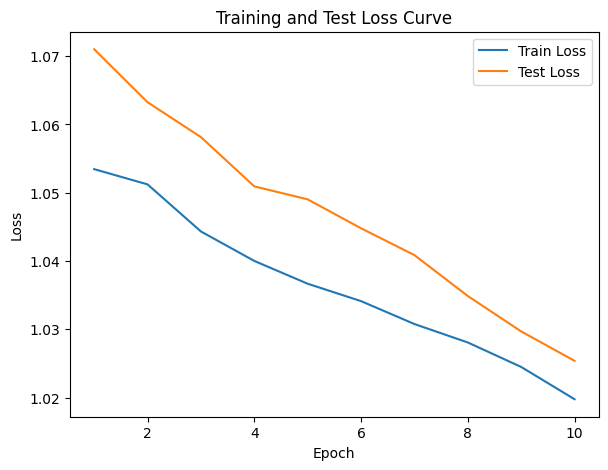

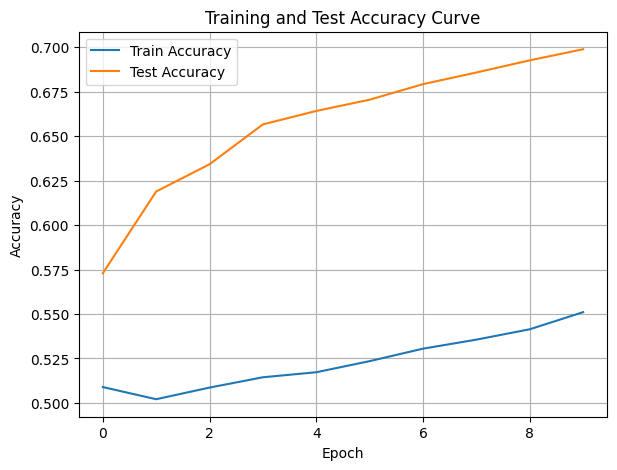

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4118780707946576, Train Loss: 1.0799, Train Acc: 0.4226, Test F1:0.5256277949776402, Test Loss: 1.0791, Test Acc: 0.5252


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [2/10], Train F1:0.4315405871705836, Train Loss: 1.0801, Train Acc: 0.4318, Test F1:0.520966435940969, Test Loss: 1.0812, Test Acc: 0.5369


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [3/10], Train F1:0.45511721277227585, Train Loss: 1.0640, Train Acc: 0.4576, Test F1:0.5275230478387948, Test Loss: 1.0799, Test Acc: 0.5460


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.63it/s]

Epoch [4/10], Train F1:0.45078738362336884, Train Loss: 1.0625, Train Acc: 0.4519, Test F1:0.5422841731421401, Test Loss: 1.0780, Test Acc: 0.5569


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.63it/s]

Epoch [5/10], Train F1:0.453883115354037, Train Loss: 1.0632, Train Acc: 0.4497, Test F1:0.5492767010229408, Test Loss: 1.0742, Test Acc: 0.5658


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.72it/s]

Epoch [6/10], Train F1:0.4593236142828604, Train Loss: 1.0623, Train Acc: 0.4529, Test F1:0.5574132673930391, Test Loss: 1.0691, Test Acc: 0.5757


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.64it/s]

Epoch [7/10], Train F1:0.46648696558793734, Train Loss: 1.0588, Train Acc: 0.4597, Test F1:0.5640960595298494, Test Loss: 1.0659, Test Acc: 0.5858


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.44it/s]

Epoch [8/10], Train F1:0.47325199291327524, Train Loss: 1.0555, Train Acc: 0.4645, Test F1:0.5680647911860717, Test Loss: 1.0637, Test Acc: 0.5897


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.55it/s]

Epoch [9/10], Train F1:0.4781703528490493, Train Loss: 1.0529, Train Acc: 0.4689, Test F1:0.5783390994945002, Test Loss: 1.0617, Test Acc: 0.5993


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.08it/s]


Epoch [10/10], Train F1:0.4887966670764921, Train Loss: 1.0487, Train Acc: 0.4782, Test F1:0.584707281676392, Test Loss: 1.0591, Test Acc: 0.6056
Total Epochs: 10
Train loss start: 1.0721708536148071, Train loss end: 1.0314806699752808
Highest Mean Train Accuracy (over epoch): 0.47818452380952386
Test loss start: 1.081174373626709, Test loss end: 1.0420098304748535
Highest mean Test Accuracy (over epoch): 0.605642361111111


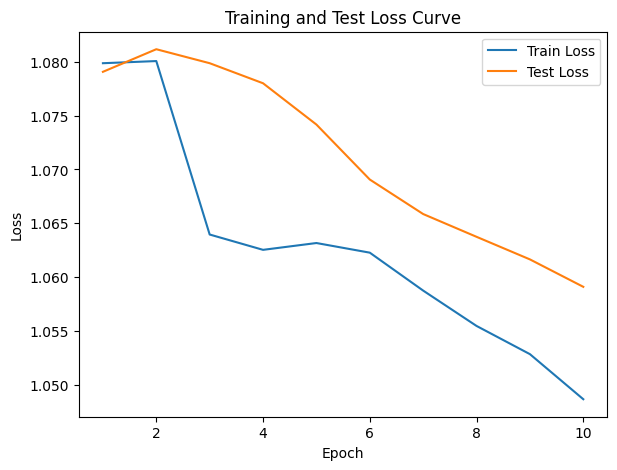

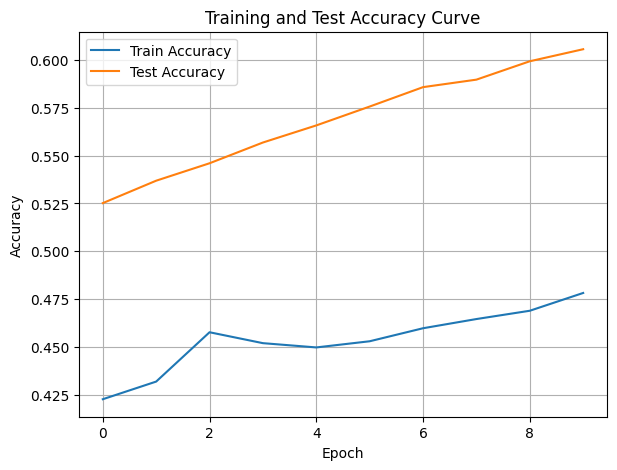

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.43it/s]

Epoch [1/10], Train F1:0.3585616405719204, Train Loss: 1.1171, Train Acc: 0.3315, Test F1:0.26201868307131465, Test Loss: 1.1132, Test Acc: 0.2552
Epoch [2/10], Train F1:0.368785012322364, Train Loss: 1.1176, Train Acc: 0.3324, Test F1:0.34322982300027116, Test Loss: 1.1090, Test Acc: 0.3238


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.84it/s]

Epoch [3/10], Train F1:0.37692424538304986, Train Loss: 1.1119, Train Acc: 0.3482, Test F1:0.3728724797067295, Test Loss: 1.1078, Test Acc: 0.3530
Epoch [4/10], Train F1:0.38332730245192254, Train Loss: 1.1085, Train Acc: 0.3550, Test F1:0.3779566645144718, Test Loss: 1.1054, Test Acc: 0.3544


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.38it/s]

Epoch [5/10], Train F1:0.389883970223337, Train Loss: 1.1052, Train Acc: 0.3626, Test F1:0.40061119559197617, Test Loss: 1.1026, Test Acc: 0.3776
Epoch [6/10], Train F1:0.4041034904715971, Train Loss: 1.1012, Train Acc: 0.3780, Test F1:0.4167652563645128, Test Loss: 1.0998, Test Acc: 0.3957


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.22it/s]

Epoch [7/10], Train F1:0.41668413861472187, Train Loss: 1.0975, Train Acc: 0.3903, Test F1:0.4307136828890651, Test Loss: 1.0967, Test Acc: 0.4128
Epoch [8/10], Train F1:0.42200687499938594, Train Loss: 1.0941, Train Acc: 0.3961, Test F1:0.44147583796188317, Test Loss: 1.0942, Test Acc: 0.4237
Epoch [9/10], Train F1:0.43579525156713655, Train Loss: 1.0907, Train Acc: 0.4085, Test F1:0.45431483957366103, Test Loss: 1.0915, Test Acc: 0.4365


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.09it/s]


Epoch [10/10], Train F1:0.4467414989902521, Train Loss: 1.0867, Train Acc: 0.4187, Test F1:0.46350306055301027, Test Loss: 1.0888, Test Acc: 0.4482
Total Epochs: 10
Train loss start: 1.1424596309661865, Train loss end: 1.0872474908828735
Highest Mean Train Accuracy (over epoch): 0.4186904761904762
Test loss start: 1.1132190227508545, Test loss end: 1.0608609914779663
Highest mean Test Accuracy (over epoch): 0.4481770833333333


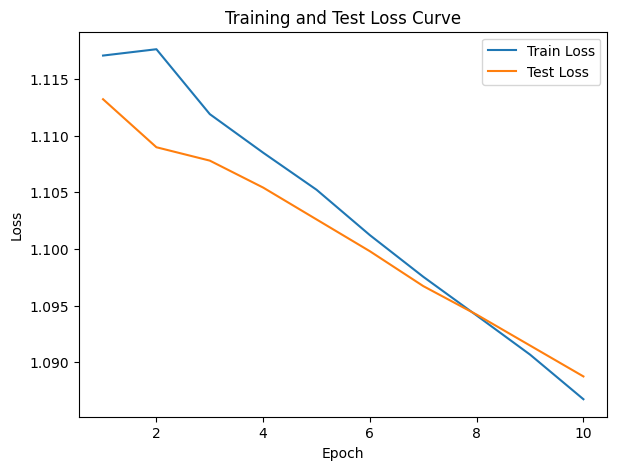

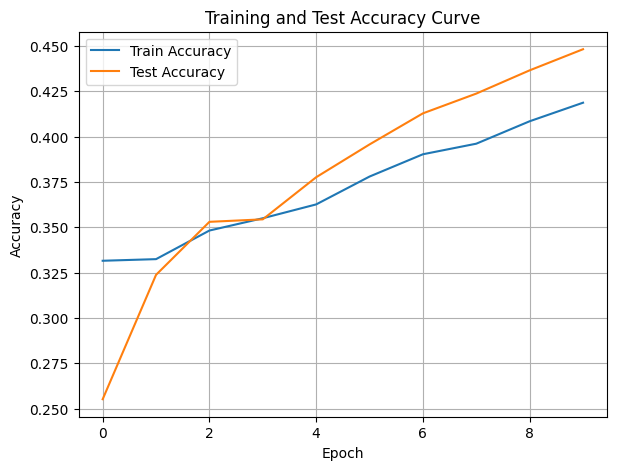

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.30197850393317877, Train Loss: 1.1676, Train Acc: 0.2271, Test F1:0.20113502146170023, Test Loss: 1.1111, Test Acc: 0.1354


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.02it/s]

Epoch [2/10], Train F1:0.3277756317756318, Train Loss: 1.1538, Train Acc: 0.2612, Test F1:0.18816473057959127, Test Loss: 1.1149, Test Acc: 0.1237


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.02it/s]

Epoch [3/10], Train F1:0.32811064918365807, Train Loss: 1.1504, Train Acc: 0.2617, Test F1:0.23083622022473635, Test Loss: 1.1131, Test Acc: 0.1505


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.60it/s]

Epoch [4/10], Train F1:0.3276579500551574, Train Loss: 1.1499, Train Acc: 0.2654, Test F1:0.24809360209898226, Test Loss: 1.1119, Test Acc: 0.1638


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.60it/s]

Epoch [5/10], Train F1:0.33944819276524446, Train Loss: 1.1459, Train Acc: 0.2746, Test F1:0.2975161396214028, Test Loss: 1.1086, Test Acc: 0.2061


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.99it/s]

Epoch [6/10], Train F1:0.34035479944573066, Train Loss: 1.1430, Train Acc: 0.2747, Test F1:0.3303898219844803, Test Loss: 1.1056, Test Acc: 0.2355


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.08it/s]

Epoch [7/10], Train F1:0.35355481581801945, Train Loss: 1.1386, Train Acc: 0.2873, Test F1:0.3440580968794291, Test Loss: 1.1042, Test Acc: 0.2488


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.28it/s]

Epoch [8/10], Train F1:0.3630019628581252, Train Loss: 1.1360, Train Acc: 0.2982, Test F1:0.34664876910919634, Test Loss: 1.1037, Test Acc: 0.2528


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.43it/s]

Epoch [9/10], Train F1:0.3754724654251979, Train Loss: 1.1309, Train Acc: 0.3106, Test F1:0.38324066432935433, Test Loss: 1.1012, Test Acc: 0.2853


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.62it/s]


Epoch [10/10], Train F1:0.385658299409502, Train Loss: 1.1268, Train Acc: 0.3196, Test F1:0.3998883271446833, Test Loss: 1.1000, Test Acc: 0.3005
Total Epochs: 10
Train loss start: 1.1064598560333252, Train loss end: 1.1434718370437622
Highest Mean Train Accuracy (over epoch): 0.31955357142857144
Test loss start: 1.1097781658172607, Test loss end: 1.0757403373718262
Highest mean Test Accuracy (over epoch): 0.30052083333333335


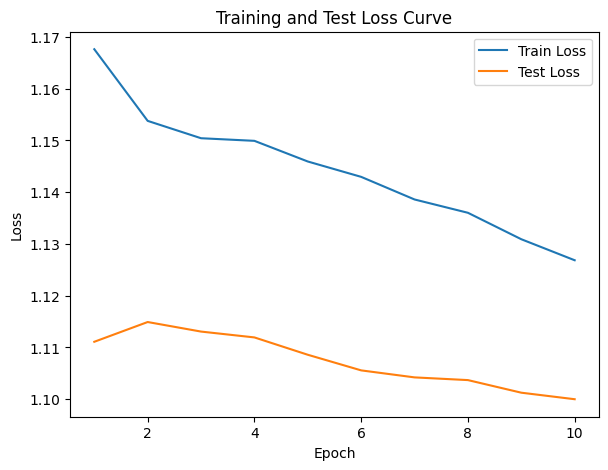

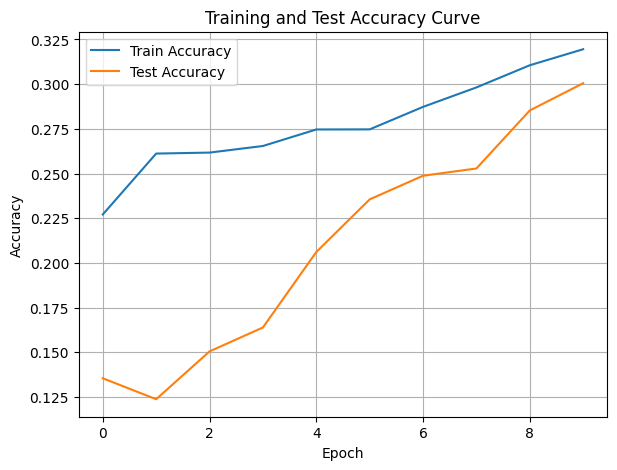

./saved_models/model_8.pth
Training Model with id 9
in multi


Epoch [1/10], Train F1:0.4824162406579988, Train Loss: 1.0797, Train Acc: 0.4318, Test F1:0.6185435443989927, Test Loss: 1.0721, Test Acc: 0.6042


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.13it/s]

Epoch [2/10], Train F1:0.4522637262847532, Train Loss: 1.0885, Train Acc: 0.4031, Test F1:0.6441753599203723, Test Loss: 1.0647, Test Acc: 0.6345


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.14it/s]

Epoch [3/10], Train F1:0.4639366344744287, Train Loss: 1.0866, Train Acc: 0.4116, Test F1:0.6432321908669226, Test Loss: 1.0629, Test Acc: 0.6317
Epoch [4/10], Train F1:0.4710783646448384, Train Loss: 1.0811, Train Acc: 0.4227, Test F1:0.6415597818074598, Test Loss: 1.0621, Test Acc: 0.6306


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.77it/s]

Epoch [5/10], Train F1:0.4790692486887591, Train Loss: 1.0773, Train Acc: 0.4316, Test F1:0.6430930421706713, Test Loss: 1.0603, Test Acc: 0.6344
Epoch [6/10], Train F1:0.4789487546071066, Train Loss: 1.0747, Train Acc: 0.4334, Test F1:0.6550066293883668, Test Loss: 1.0566, Test Acc: 0.6532


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.28it/s]

Epoch [7/10], Train F1:0.48234548472229827, Train Loss: 1.0719, Train Acc: 0.4384, Test F1:0.6634449012714546, Test Loss: 1.0532, Test Acc: 0.6649
Epoch [8/10], Train F1:0.48977415866290963, Train Loss: 1.0697, Train Acc: 0.4445, Test F1:0.6712966432737338, Test Loss: 1.0510, Test Acc: 0.6727


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.37it/s]


Epoch [9/10], Train F1:0.4925515662935981, Train Loss: 1.0669, Train Acc: 0.4477, Test F1:0.6772612906634072, Test Loss: 1.0495, Test Acc: 0.6790
Epoch [10/10], Train F1:0.5009981164373005, Train Loss: 1.0632, Train Acc: 0.4564, Test F1:0.685201963513982, Test Loss: 1.0472, Test Acc: 0.6890
Total Epochs: 10
Train loss start: 1.0793187618255615, Train loss end: 0.8945348858833313
Highest Mean Train Accuracy (over epoch): 0.45642857142857146
Test loss start: 1.0921021699905396, Test loss end: 1.0166832208633423
Highest mean Test Accuracy (over epoch): 0.6889756944444445


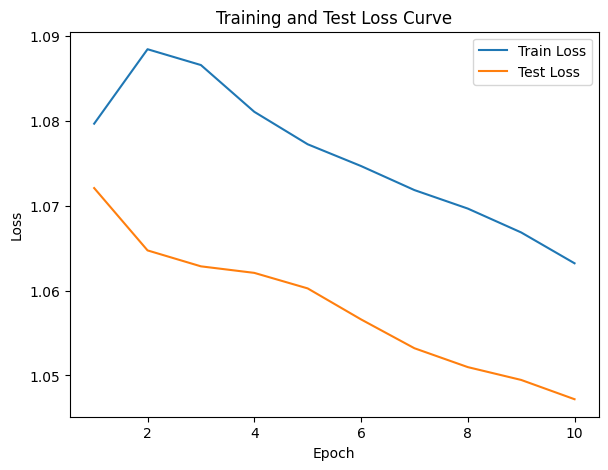

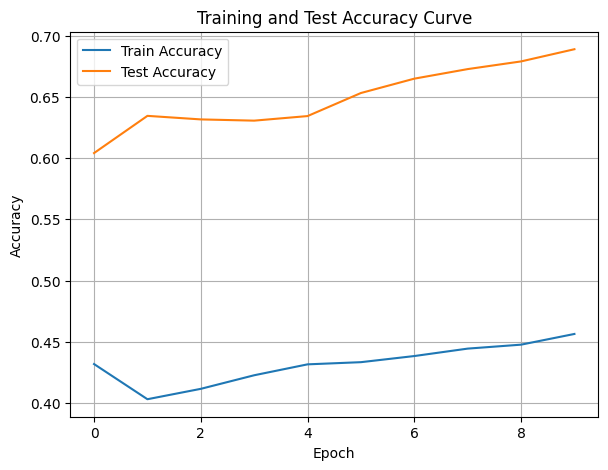

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.95it/s]

Epoch [1/10], Train F1:0.4078851469191071, Train Loss: 1.0894, Train Acc: 0.3771, Test F1:0.5923395250200636, Test Loss: 1.0748, Test Acc: 0.5668


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.95it/s]

Epoch [2/10], Train F1:0.42593551590864137, Train Loss: 1.0816, Train Acc: 0.4076, Test F1:0.6487358101135191, Test Loss: 1.0648, Test Acc: 0.6246


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.15it/s]

Epoch [3/10], Train F1:0.4347785647085382, Train Loss: 1.0765, Train Acc: 0.4110, Test F1:0.6728054704662891, Test Loss: 1.0624, Test Acc: 0.6510


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.15it/s]

Epoch [4/10], Train F1:0.4378956568586982, Train Loss: 1.0729, Train Acc: 0.4180, Test F1:0.6776562350302353, Test Loss: 1.0602, Test Acc: 0.6554


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.24it/s]

Epoch [5/10], Train F1:0.4504470132050039, Train Loss: 1.0698, Train Acc: 0.4320, Test F1:0.6877932423697366, Test Loss: 1.0567, Test Acc: 0.6694


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.24it/s]

Epoch [6/10], Train F1:0.46490691622666236, Train Loss: 1.0648, Train Acc: 0.4462, Test F1:0.6919398694000494, Test Loss: 1.0551, Test Acc: 0.6752


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.21it/s]

Epoch [7/10], Train F1:0.47318464871685945, Train Loss: 1.0604, Train Acc: 0.4550, Test F1:0.6968311379683606, Test Loss: 1.0528, Test Acc: 0.6815


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.21it/s]

Epoch [8/10], Train F1:0.48276454382823497, Train Loss: 1.0577, Train Acc: 0.4658, Test F1:0.7012587913569291, Test Loss: 1.0505, Test Acc: 0.6880


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.33it/s]

Epoch [9/10], Train F1:0.48738393050183876, Train Loss: 1.0572, Train Acc: 0.4679, Test F1:0.707076379974326, Test Loss: 1.0489, Test Acc: 0.6948


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.31it/s]


Epoch [10/10], Train F1:0.49168831626459364, Train Loss: 1.0546, Train Acc: 0.4721, Test F1:0.7101933289502718, Test Loss: 1.0474, Test Acc: 0.6995
Total Epochs: 10
Train loss start: 1.0054397583007812, Train loss end: 0.9824527502059937
Highest Mean Train Accuracy (over epoch): 0.47208333333333335
Test loss start: 1.0793633460998535, Test loss end: 1.017123818397522
Highest mean Test Accuracy (over epoch): 0.6994791666666667


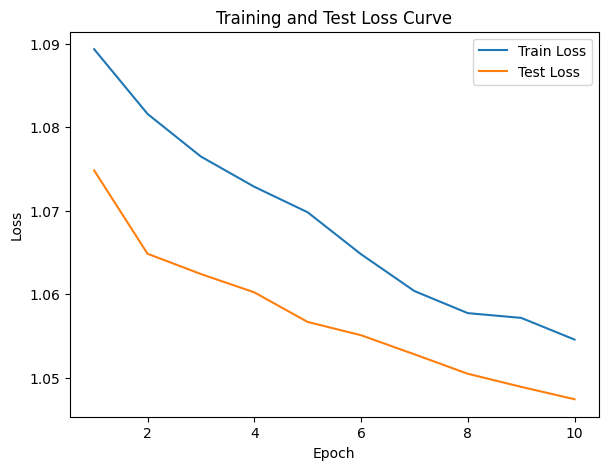

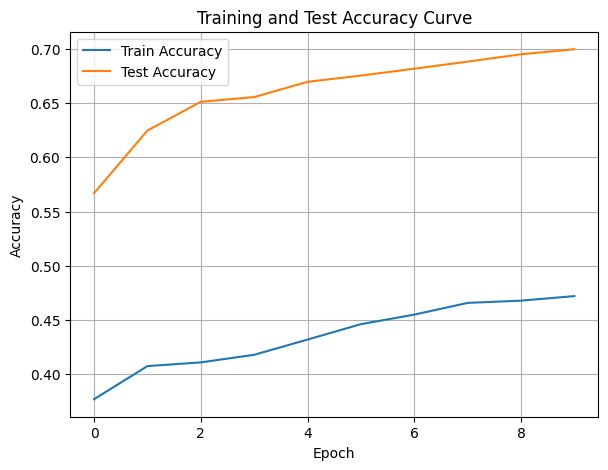

./saved_models/model_10.pth
Training Model with id 11
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.55it/s]

Epoch [1/10], Train F1:0.47286252812718765, Train Loss: 1.0366, Train Acc: 0.5622, Test F1:0.4859355091639714, Test Loss: 1.0924, Test Acc: 0.5903


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.70it/s]

Epoch [2/10], Train F1:0.47152245483239486, Train Loss: 1.0332, Train Acc: 0.5641, Test F1:0.48458192835850067, Test Loss: 1.0886, Test Acc: 0.5933


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.83it/s]

Epoch [3/10], Train F1:0.4680544023660044, Train Loss: 1.0324, Train Acc: 0.5582, Test F1:0.4892285861713106, Test Loss: 1.0853, Test Acc: 0.6047


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.77it/s]

Epoch [4/10], Train F1:0.47420329724206883, Train Loss: 1.0281, Train Acc: 0.5633, Test F1:0.49108327903665633, Test Loss: 1.0835, Test Acc: 0.6085


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.56it/s]

Epoch [5/10], Train F1:0.4706895736792451, Train Loss: 1.0277, Train Acc: 0.5635, Test F1:0.4921920185078079, Test Loss: 1.0831, Test Acc: 0.6095


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.67it/s]

Epoch [6/10], Train F1:0.4732733834146013, Train Loss: 1.0223, Train Acc: 0.5701, Test F1:0.4917417055906005, Test Loss: 1.0819, Test Acc: 0.6089


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.32it/s]

Epoch [7/10], Train F1:0.4750395646063304, Train Loss: 1.0195, Train Acc: 0.5740, Test F1:0.4918059855521156, Test Loss: 1.0804, Test Acc: 0.6085


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.15it/s]

Epoch [8/10], Train F1:0.4746236946352413, Train Loss: 1.0160, Train Acc: 0.5760, Test F1:0.49351117519826965, Test Loss: 1.0783, Test Acc: 0.6119
Epoch [9/10], Train F1:0.4769906066964583, Train Loss: 1.0146, Train Acc: 0.5792, Test F1:0.4953209268615037, Test Loss: 1.0763, Test Acc: 0.6154


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.23it/s]


Epoch [10/10], Train F1:0.4771734890040623, Train Loss: 1.0128, Train Acc: 0.5800, Test F1:0.49830411456026297, Test Loss: 1.0746, Test Acc: 0.6181
Total Epochs: 10
Train loss start: 1.0484760999679565, Train loss end: 1.0207616090774536
Highest Mean Train Accuracy (over epoch): 0.58
Test loss start: 1.0969632863998413, Test loss end: 1.0606606006622314
Highest mean Test Accuracy (over epoch): 0.6181423611111111


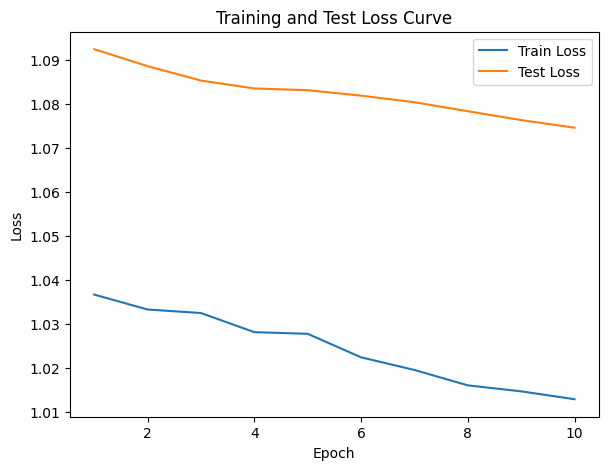

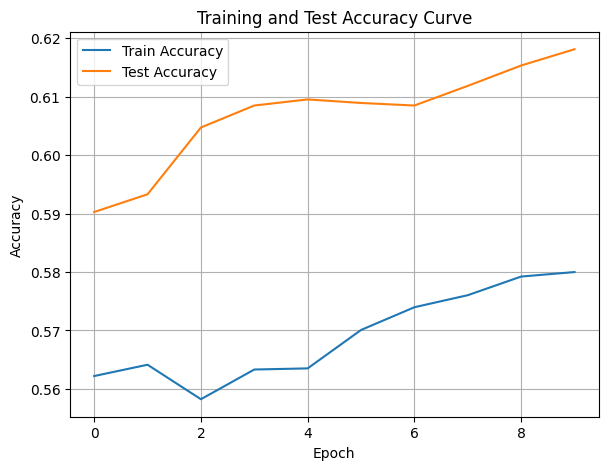

./saved_models/model_11.pth
Training Model with id 12
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.15it/s]

Epoch [1/10], Train F1:0.1654425242291351, Train Loss: 1.2385, Train Acc: 0.1116, Test F1:0.23026315789473686, Test Loss: 1.1398, Test Acc: 0.1823
Epoch [2/10], Train F1:0.17425768797700703, Train Loss: 1.2383, Train Acc: 0.1193, Test F1:0.22834864940128097, Test Loss: 1.1448, Test Acc: 0.1784


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.15it/s]

Epoch [3/10], Train F1:0.18015420257296158, Train Loss: 1.2345, Train Acc: 0.1219, Test F1:0.21170244045868863, Test Loss: 1.1496, Test Acc: 0.1568


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.76it/s]

Epoch [4/10], Train F1:0.18411270688879627, Train Loss: 1.2301, Train Acc: 0.1243, Test F1:0.20692757534862802, Test Loss: 1.1505, Test Acc: 0.1500


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.76it/s]

Epoch [5/10], Train F1:0.19074178733767264, Train Loss: 1.2274, Train Acc: 0.1298, Test F1:0.20568663036902599, Test Loss: 1.1517, Test Acc: 0.1474


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.54it/s]

Epoch [6/10], Train F1:0.19247176651843695, Train Loss: 1.2237, Train Acc: 0.1346, Test F1:0.2077031659608792, Test Loss: 1.1508, Test Acc: 0.1493


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.64it/s]

Epoch [7/10], Train F1:0.19456540808655165, Train Loss: 1.2194, Train Acc: 0.1392, Test F1:0.20792722547108508, Test Loss: 1.1506, Test Acc: 0.1496
Epoch [8/10], Train F1:0.20020846233582637, Train Loss: 1.2149, Train Acc: 0.1448, Test F1:0.21128089039803807, Test Loss: 1.1487, Test Acc: 0.1527


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.38it/s]


Epoch [9/10], Train F1:0.2048963544463857, Train Loss: 1.2106, Train Acc: 0.1499, Test F1:0.21582257530618998, Test Loss: 1.1465, Test Acc: 0.1577
Epoch [10/10], Train F1:0.20998745389449358, Train Loss: 1.2071, Train Acc: 0.1558, Test F1:0.2151887384560208, Test Loss: 1.1456, Test Acc: 0.1570
Total Epochs: 10
Train loss start: 1.2434282302856445, Train loss end: 1.113024353981018
Highest Mean Train Accuracy (over epoch): 0.15577380952380954
Test loss start: 1.1358672380447388, Test loss end: 1.1345579624176025
Highest mean Test Accuracy (over epoch): 0.18229166666666666


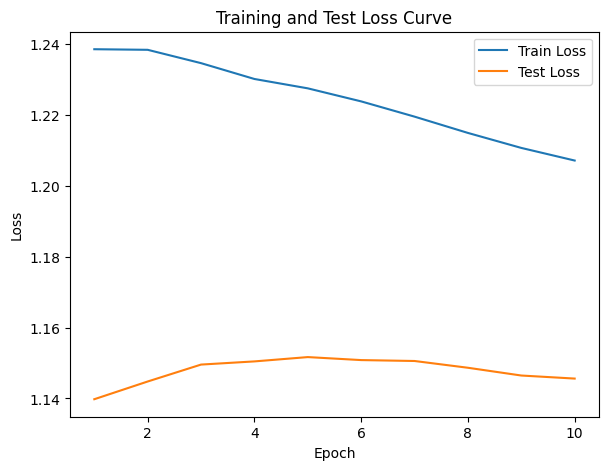

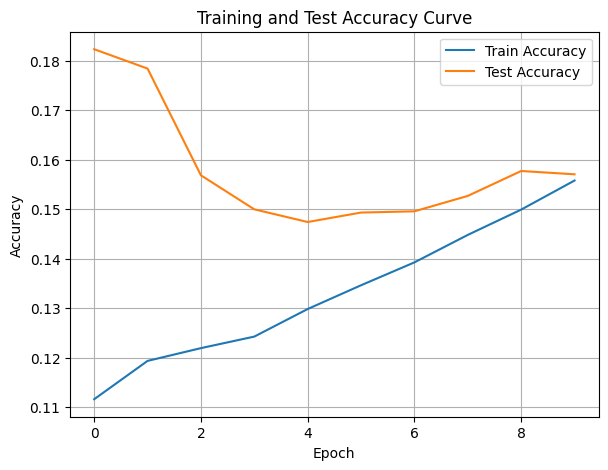

./saved_models/model_12.pth
Training Model with id 18
in multi


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.15it/s]

Epoch [1/10], Train F1:0.25694290436558476, Train Loss: 1.1654, Train Acc: 0.2033, Test F1:0.2550009432182608, Test Loss: 1.1260, Test Acc: 0.1901
Epoch [2/10], Train F1:0.2561558337010504, Train Loss: 1.1629, Train Acc: 0.2112, Test F1:0.2554235841281055, Test Loss: 1.1275, Test Acc: 0.1979


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.50it/s]

Epoch [3/10], Train F1:0.2580441503231421, Train Loss: 1.1600, Train Acc: 0.2110, Test F1:0.2637844611528822, Test Loss: 1.1260, Test Acc: 0.2031
Epoch [4/10], Train F1:0.26870844263481053, Train Loss: 1.1592, Train Acc: 0.2182, Test F1:0.2641408994470542, Test Loss: 1.1244, Test Acc: 0.2077


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.97it/s]

Epoch [5/10], Train F1:0.2797032234190629, Train Loss: 1.1554, Train Acc: 0.2242, Test F1:0.2650718537363771, Test Loss: 1.1209, Test Acc: 0.2104
Epoch [6/10], Train F1:0.2875290354781161, Train Loss: 1.1529, Train Acc: 0.2290, Test F1:0.2645493563595995, Test Loss: 1.1192, Test Acc: 0.2109


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.39it/s]

Epoch [7/10], Train F1:0.2892514458328159, Train Loss: 1.1496, Train Acc: 0.2354, Test F1:0.26665476823476514, Test Loss: 1.1171, Test Acc: 0.2124
Epoch [8/10], Train F1:0.2953966570265375, Train Loss: 1.1466, Train Acc: 0.2401, Test F1:0.27071891673730203, Test Loss: 1.1146, Test Acc: 0.2172


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.76it/s]


Epoch [9/10], Train F1:0.3029643217823066, Train Loss: 1.1428, Train Acc: 0.2455, Test F1:0.273123282333307, Test Loss: 1.1130, Test Acc: 0.2194
Epoch [10/10], Train F1:0.3128812305482507, Train Loss: 1.1389, Train Acc: 0.2535, Test F1:0.27529397770705605, Test Loss: 1.1113, Test Acc: 0.2226
Total Epochs: 10
Train loss start: 1.1336138248443604, Train loss end: 1.1681588888168335
Highest Mean Train Accuracy (over epoch): 0.2534821428571429
Test loss start: 1.1242679357528687, Test loss end: 1.0911221504211426
Highest mean Test Accuracy (over epoch): 0.22256944444444446


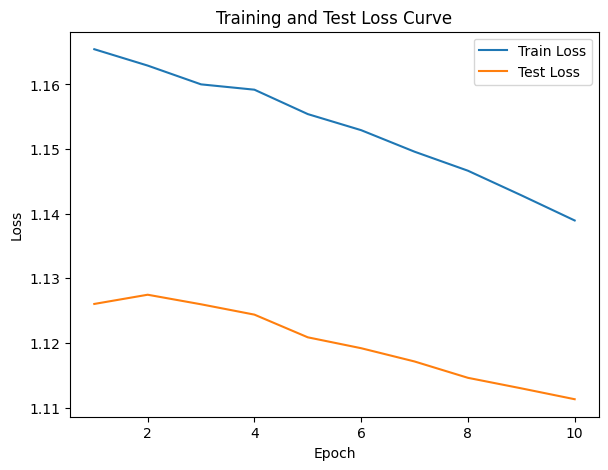

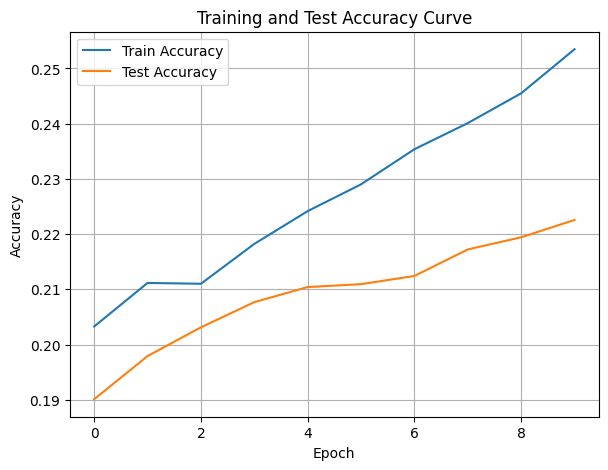

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.3818704321428414, Train Loss: 1.0928, Train Acc: 0.3277, Test F1:0.31486611265004616, Test Loss: 1.0926, Test Acc: 0.2648


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.69it/s]

Epoch [2/10], Train F1:0.37579253724822786, Train Loss: 1.1001, Train Acc: 0.3061, Test F1:0.303570736997018, Test Loss: 1.0918, Test Acc: 0.2617
Epoch [3/10], Train F1:0.3905421126558885, Train Loss: 1.0941, Train Acc: 0.3181, Test F1:0.32327101062614455, Test Loss: 1.0896, Test Acc: 0.2731


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.93it/s]

Epoch [4/10], Train F1:0.3964358524966329, Train Loss: 1.0900, Train Acc: 0.3230, Test F1:0.33378305535184877, Test Loss: 1.0866, Test Acc: 0.2784


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.93it/s]

Epoch [5/10], Train F1:0.40502642880584083, Train Loss: 1.0863, Train Acc: 0.3316, Test F1:0.3415108410331274, Test Loss: 1.0839, Test Acc: 0.2847


Epoch [6/10], Train F1:0.41026670269018495, Train Loss: 1.0846, Train Acc: 0.3326, Test F1:0.35112770484563804, Test Loss: 1.0812, Test Acc: 0.2915


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.85it/s]

Epoch [7/10], Train F1:0.419899691328375, Train Loss: 1.0812, Train Acc: 0.3393, Test F1:0.35781841637492556, Test Loss: 1.0788, Test Acc: 0.2953
Epoch [8/10], Train F1:0.4286996733115933, Train Loss: 1.0789, Train Acc: 0.3486, Test F1:0.3711446692500803, Test Loss: 1.0776, Test Acc: 0.3027


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.01it/s]


Epoch [9/10], Train F1:0.4376400131680169, Train Loss: 1.0756, Train Acc: 0.3558, Test F1:0.38548293612037493, Test Loss: 1.0756, Test Acc: 0.3142
Epoch [10/10], Train F1:0.4513806100264842, Train Loss: 1.0725, Train Acc: 0.3658, Test F1:0.3943900771368473, Test Loss: 1.0738, Test Acc: 0.3199
Total Epochs: 10
Train loss start: 1.1099398136138916, Train loss end: 1.1310316324234009
Highest Mean Train Accuracy (over epoch): 0.36583333333333334
Test loss start: 1.0884840488433838, Test loss end: 1.0506752729415894
Highest mean Test Accuracy (over epoch): 0.3198784722222222


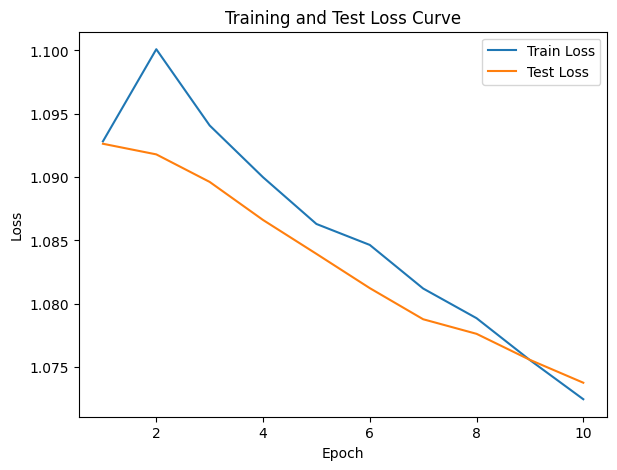

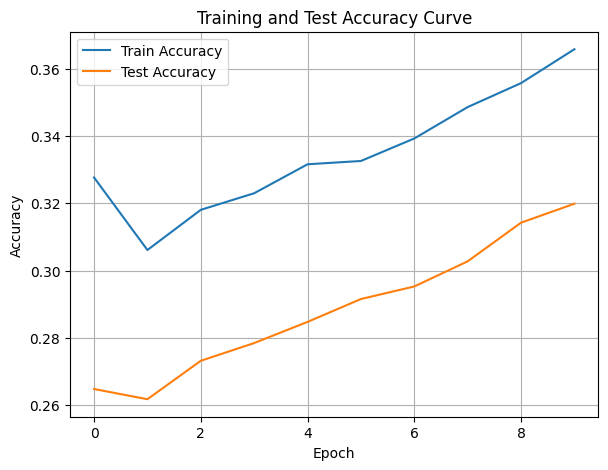

./saved_models/model_16.pth
Training Model with id 19
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.89it/s]

Epoch [1/10], Train F1:0.5595837608211061, Train Loss: 1.0310, Train Acc: 0.4577, Test F1:0.49795362646916497, Test Loss: 1.0537, Test Acc: 0.3785


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.89it/s]

Epoch [2/10], Train F1:0.5477567014249934, Train Loss: 1.0304, Train Acc: 0.4588, Test F1:0.5260640184937229, Test Loss: 1.0469, Test Acc: 0.4128


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.12it/s]

Epoch [3/10], Train F1:0.5712421008855041, Train Loss: 1.0272, Train Acc: 0.4776, Test F1:0.5332667847903304, Test Loss: 1.0459, Test Acc: 0.4216


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.12it/s]

Epoch [4/10], Train F1:0.5803750748617669, Train Loss: 1.0253, Train Acc: 0.4851, Test F1:0.5281020368739667, Test Loss: 1.0460, Test Acc: 0.4167


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.96it/s]

Epoch [5/10], Train F1:0.5894084419847094, Train Loss: 1.0199, Train Acc: 0.4983, Test F1:0.5399281259792302, Test Loss: 1.0451, Test Acc: 0.4274


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.10it/s]

Epoch [6/10], Train F1:0.5942114098029968, Train Loss: 1.0176, Train Acc: 0.5053, Test F1:0.5426881191216738, Test Loss: 1.0443, Test Acc: 0.4330


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.05it/s]

Epoch [7/10], Train F1:0.603085785832575, Train Loss: 1.0160, Train Acc: 0.5122, Test F1:0.5568759630644129, Test Loss: 1.0421, Test Acc: 0.4448


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.12it/s]

Epoch [8/10], Train F1:0.6127623499629477, Train Loss: 1.0121, Train Acc: 0.5210, Test F1:0.5830676017966712, Test Loss: 1.0390, Test Acc: 0.4671
Epoch [9/10], Train F1:0.6182029364313767, Train Loss: 1.0098, Train Acc: 0.5245, Test F1:0.5934270763719353, Test Loss: 1.0379, Test Acc: 0.4775


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.89it/s]


Epoch [10/10], Train F1:0.6305898892886568, Train Loss: 1.0058, Train Acc: 0.5371, Test F1:0.6007331059044597, Test Loss: 1.0370, Test Acc: 0.4837
Total Epochs: 10
Train loss start: 1.0416767597198486, Train loss end: 0.9119186401367188
Highest Mean Train Accuracy (over epoch): 0.5370833333333334
Test loss start: 1.0491523742675781, Test loss end: 1.024855613708496
Highest mean Test Accuracy (over epoch): 0.48368055555555556


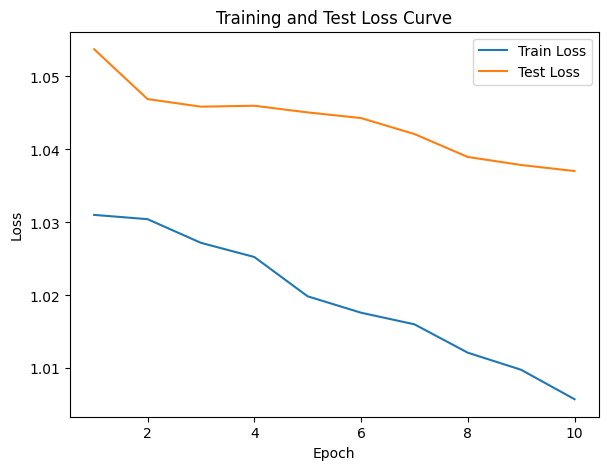

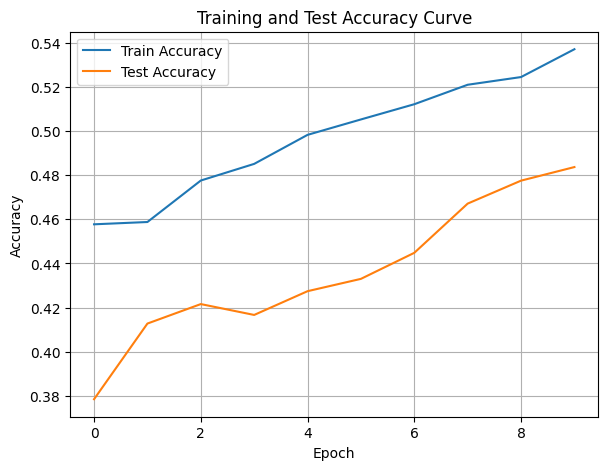

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.23it/s]

Epoch [1/10], Train F1:0.6944338415040823, Train Loss: 0.9666, Train Acc: 0.6119, Test F1:0.8332960059723777, Test Loss: 1.0174, Test Acc: 0.7760


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.05it/s]

Epoch [2/10], Train F1:0.7183766809184868, Train Loss: 0.9632, Train Acc: 0.6327, Test F1:0.8369466982137961, Test Loss: 1.0156, Test Acc: 0.7791
Epoch [3/10], Train F1:0.7225562584584395, Train Loss: 0.9633, Train Acc: 0.6387, Test F1:0.8351391225399877, Test Loss: 1.0137, Test Acc: 0.7833


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.19it/s]

Epoch [4/10], Train F1:0.7321271822485337, Train Loss: 0.9583, Train Acc: 0.6492, Test F1:0.8209793448471538, Test Loss: 1.0133, Test Acc: 0.7585
Epoch [5/10], Train F1:0.7389976098339525, Train Loss: 0.9560, Train Acc: 0.6571, Test F1:0.826609243047187, Test Loss: 1.0121, Test Acc: 0.7667


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.65it/s]

Epoch [6/10], Train F1:0.7423630766154176, Train Loss: 0.9531, Train Acc: 0.6632, Test F1:0.834755098650336, Test Loss: 1.0111, Test Acc: 0.7807
Epoch [7/10], Train F1:0.7470974548644451, Train Loss: 0.9504, Train Acc: 0.6707, Test F1:0.8264189789503635, Test Loss: 1.0106, Test Acc: 0.7680
Epoch [8/10], Train F1:0.7522520727051175, Train Loss: 0.9472, Train Acc: 0.6785, Test F1:0.8325320546792533, Test Loss: 1.0080, Test Acc: 0.7791


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.50it/s]


Epoch [9/10], Train F1:0.7561213303123855, Train Loss: 0.9428, Train Acc: 0.6843, Test F1:0.8352723332059497, Test Loss: 1.0064, Test Acc: 0.7840
Epoch [10/10], Train F1:0.7590687837801987, Train Loss: 0.9401, Train Acc: 0.6900, Test F1:0.8374943769680612, Test Loss: 1.0038, Test Acc: 0.7898
Total Epochs: 10
Train loss start: 0.9531184434890747, Train loss end: 0.9050633311271667
Highest Mean Train Accuracy (over epoch): 0.69
Test loss start: 1.0139826536178589, Test loss end: 0.9793014526367188
Highest mean Test Accuracy (over epoch): 0.78984375


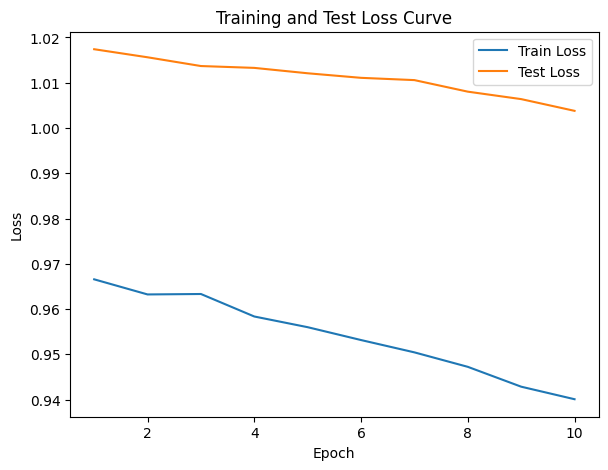

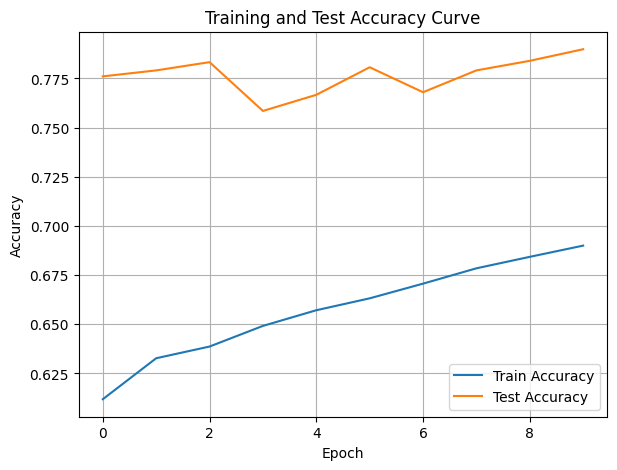

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7986058435323344, Train Loss: 0.9099, Train Acc: 0.7485, Test F1:0.8526999316473001, Test Loss: 0.9820, Test Acc: 0.8351


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.33it/s]

Epoch [2/10], Train F1:0.825751838470432, Train Loss: 0.9043, Train Acc: 0.7698, Test F1:0.8444613788676651, Test Loss: 0.9848, Test Acc: 0.8212


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.33it/s]

Epoch [3/10], Train F1:0.8348713754583349, Train Loss: 0.8944, Train Acc: 0.7889, Test F1:0.8601621011593309, Test Loss: 0.9833, Test Acc: 0.8455


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.72it/s]

Epoch [4/10], Train F1:0.8335287725439879, Train Loss: 0.8946, Train Acc: 0.7863, Test F1:0.861964635104381, Test Loss: 0.9818, Test Acc: 0.8503


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.72it/s]

Epoch [5/10], Train F1:0.8304515209288729, Train Loss: 0.8920, Train Acc: 0.7846, Test F1:0.8658206410718575, Test Loss: 0.9788, Test Acc: 0.8562


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.70it/s]

Epoch [6/10], Train F1:0.8290561479696102, Train Loss: 0.8895, Train Acc: 0.7873, Test F1:0.867120300578087, Test Loss: 0.9759, Test Acc: 0.8589


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.70it/s]

Epoch [7/10], Train F1:0.8321637418651266, Train Loss: 0.8881, Train Acc: 0.7915, Test F1:0.8691092034335123, Test Loss: 0.9733, Test Acc: 0.8620


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.50it/s]

Epoch [8/10], Train F1:0.8320313799630688, Train Loss: 0.8866, Train Acc: 0.7921, Test F1:0.8707288641461652, Test Loss: 0.9709, Test Acc: 0.8650


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.50it/s]

Epoch [9/10], Train F1:0.8331734258805471, Train Loss: 0.8835, Train Acc: 0.7956, Test F1:0.8710412726577174, Test Loss: 0.9698, Test Acc: 0.8658


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.90it/s]


Epoch [10/10], Train F1:0.83385132695443, Train Loss: 0.8824, Train Acc: 0.7975, Test F1:0.8723564991074108, Test Loss: 0.9691, Test Acc: 0.8673
Total Epochs: 10
Train loss start: 0.8425643444061279, Train loss end: 0.9222627282142639
Highest Mean Train Accuracy (over epoch): 0.7974702380952382
Test loss start: 0.9710699319839478, Test loss end: 0.9617329835891724
Highest mean Test Accuracy (over epoch): 0.8672743055555557


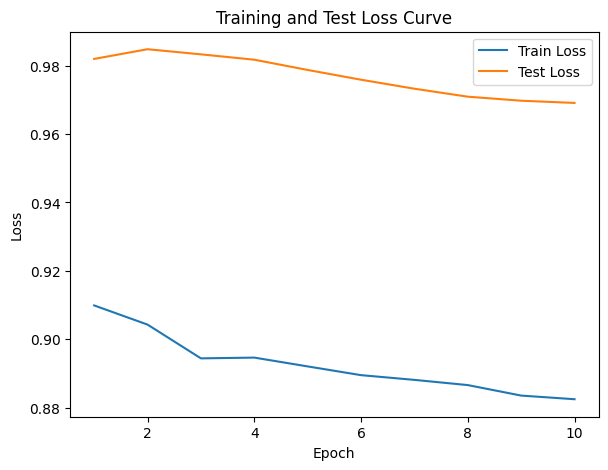

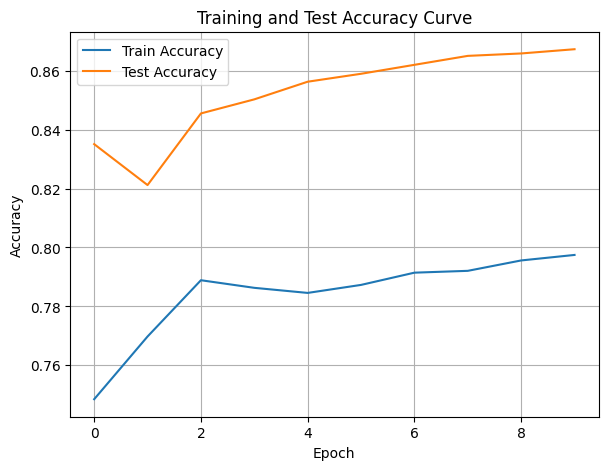

./saved_models/model_15.pth
Training Model with id 19
in multi


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.72it/s]

Epoch [1/10], Train F1:0.8678876678876679, Train Loss: 0.8510, Train Acc: 0.8625, Test F1:0.8808197688643266, Test Loss: 0.9388, Test Acc: 0.8802
Epoch [2/10], Train F1:0.8638073409128048, Train Loss: 0.8510, Train Acc: 0.8546, Test F1:0.8856999407945004, Test Loss: 0.9381, Test Acc: 0.8872


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.78it/s]

Epoch [3/10], Train F1:0.8550754574605303, Train Loss: 0.8528, Train Acc: 0.8426, Test F1:0.8844685553546313, Test Loss: 0.9386, Test Acc: 0.8869
Epoch [4/10], Train F1:0.8636579901551313, Train Loss: 0.8490, Train Acc: 0.8501, Test F1:0.8822834023775674, Test Loss: 0.9394, Test Acc: 0.8832


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.42it/s]

Epoch [5/10], Train F1:0.867904264919785, Train Loss: 0.8447, Train Acc: 0.8563, Test F1:0.8820058579210204, Test Loss: 0.9391, Test Acc: 0.8826
Epoch [6/10], Train F1:0.8660249697522304, Train Loss: 0.8448, Train Acc: 0.8517, Test F1:0.8785888902893085, Test Loss: 0.9391, Test Acc: 0.8796


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.55it/s]

Epoch [7/10], Train F1:0.8654059055673119, Train Loss: 0.8417, Train Acc: 0.8508, Test F1:0.8802952503209243, Test Loss: 0.9371, Test Acc: 0.8817
Epoch [8/10], Train F1:0.8660684512268405, Train Loss: 0.8407, Train Acc: 0.8510, Test F1:0.8805104220005209, Test Loss: 0.9352, Test Acc: 0.8823


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.49it/s]

Epoch [9/10], Train F1:0.8647848794407329, Train Loss: 0.8393, Train Acc: 0.8500, Test F1:0.8805469280260734, Test Loss: 0.9329, Test Acc: 0.8820
Epoch [10/10], Train F1:0.8645379987615508, Train Loss: 0.8374, Train Acc: 0.8507, Test F1:0.8805757512948966, Test Loss: 0.9318, Test Acc: 0.8819


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.24it/s]


Total Epochs: 10
Train loss start: 0.8677161335945129, Train loss end: 0.804884135723114
Highest Mean Train Accuracy (over epoch): 0.8625
Test loss start: 0.9266060590744019, Test loss end: 0.9204370975494385
Highest mean Test Accuracy (over epoch): 0.8871527777777778


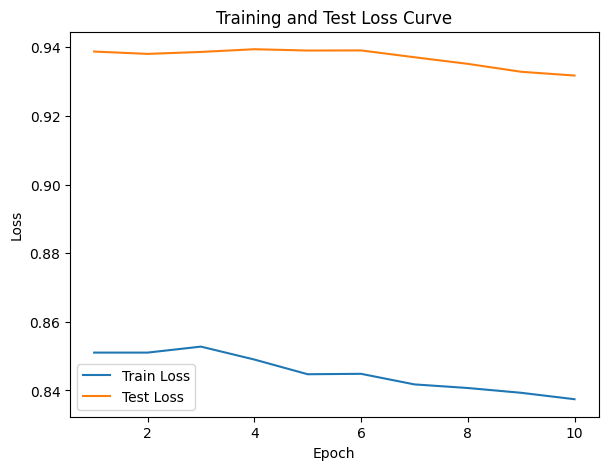

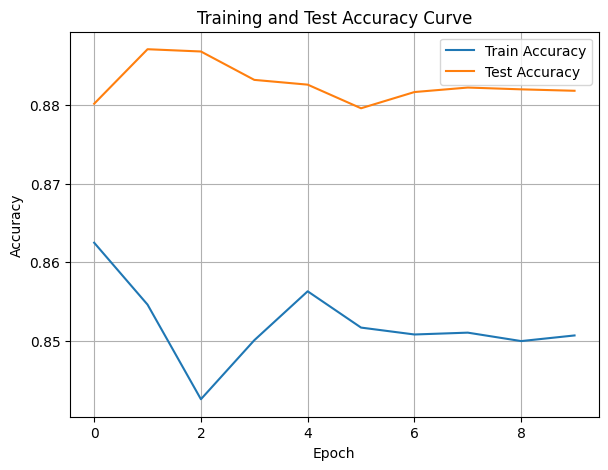

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8763965187235744, Train Loss: 0.8155, Train Acc: 0.8696, Test F1:0.8808197688643266, Test Loss: 0.9168, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.29it/s]

Epoch [2/10], Train F1:0.8817607848925041, Train Loss: 0.8078, Train Acc: 0.8796, Test F1:0.8759075915539942, Test Loss: 0.9099, Test Acc: 0.8763


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.29it/s]

Epoch [3/10], Train F1:0.8867023917025539, Train Loss: 0.8038, Train Acc: 0.8857, Test F1:0.8775486060481669, Test Loss: 0.9069, Test Acc: 0.8776


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.46it/s]

Epoch [4/10], Train F1:0.8832565360803566, Train Loss: 0.8033, Train Acc: 0.8793, Test F1:0.8811279384262805, Test Loss: 0.9056, Test Acc: 0.8817


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.46it/s]

Epoch [5/10], Train F1:0.885424869594481, Train Loss: 0.8024, Train Acc: 0.8815, Test F1:0.8810669371970105, Test Loss: 0.9033, Test Acc: 0.8814


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.48it/s]

Epoch [6/10], Train F1:0.8833295433650444, Train Loss: 0.8044, Train Acc: 0.8762, Test F1:0.8826519392156871, Test Loss: 0.9032, Test Acc: 0.8835


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.36it/s]

Epoch [7/10], Train F1:0.8823595800196092, Train Loss: 0.8060, Train Acc: 0.8716, Test F1:0.8825624604803719, Test Loss: 0.9026, Test Acc: 0.8839


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.44it/s]

Epoch [8/10], Train F1:0.8815155014903284, Train Loss: 0.8045, Train Acc: 0.8686, Test F1:0.8799079034241406, Test Loss: 0.9017, Test Acc: 0.8815


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.48it/s]

Epoch [9/10], Train F1:0.8823649316262411, Train Loss: 0.8018, Train Acc: 0.8705, Test F1:0.878922800589352, Test Loss: 0.9004, Test Acc: 0.8805


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.54it/s]


Epoch [10/10], Train F1:0.883415325503476, Train Loss: 0.8000, Train Acc: 0.8718, Test F1:0.8781331616270446, Test Loss: 0.8996, Test Acc: 0.8797
Total Epochs: 10
Train loss start: 0.813973069190979, Train loss end: 0.823993980884552
Highest Mean Train Accuracy (over epoch): 0.8857142857142858
Test loss start: 0.9032819271087646, Test loss end: 0.8897863030433655
Highest mean Test Accuracy (over epoch): 0.8839285714285714


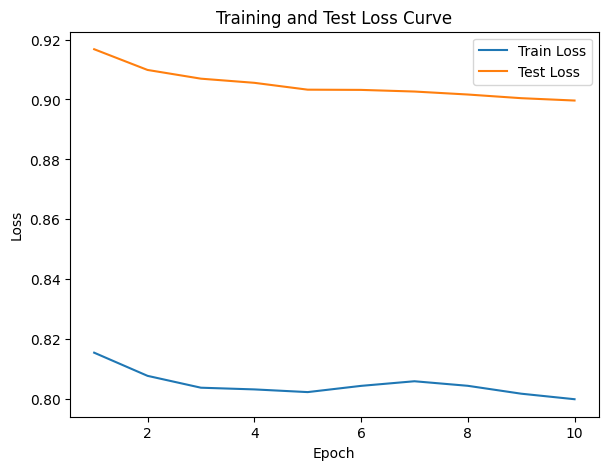

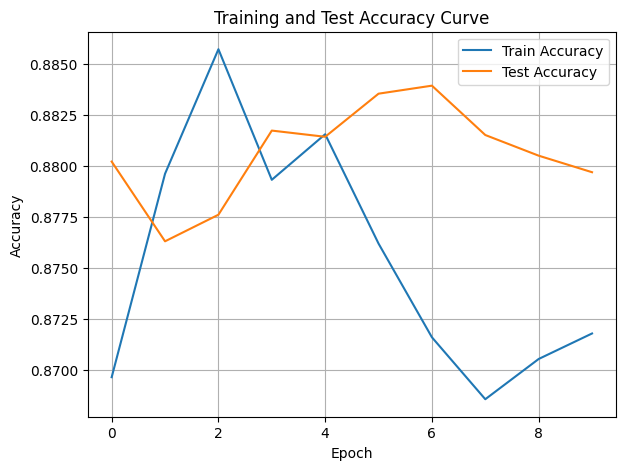

./saved_models/model_17.pth
Training Model with id 20
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.51it/s]

Epoch [1/10], Train F1:0.8959818256178742, Train Loss: 0.7588, Train Acc: 0.9021, Test F1:0.8905491577043876, Test Loss: 0.8829, Test Acc: 0.8941


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.16it/s]

Epoch [2/10], Train F1:0.8909168517000315, Train Loss: 0.7652, Train Acc: 0.8969, Test F1:0.8905491577043876, Test Loss: 0.8826, Test Acc: 0.8941


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.63it/s]

Epoch [3/10], Train F1:0.8834964890376862, Train Loss: 0.7746, Train Acc: 0.8839, Test F1:0.8873197347435575, Test Loss: 0.8760, Test Acc: 0.8895


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.95it/s]

Epoch [4/10], Train F1:0.8849380759206871, Train Loss: 0.7751, Train Acc: 0.8832, Test F1:0.8832637892522603, Test Loss: 0.8723, Test Acc: 0.8852


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.11it/s]

Epoch [5/10], Train F1:0.8875699973103741, Train Loss: 0.7744, Train Acc: 0.8844, Test F1:0.8827756188858892, Test Loss: 0.8707, Test Acc: 0.8842


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.30it/s]

Epoch [6/10], Train F1:0.8885149652726836, Train Loss: 0.7722, Train Acc: 0.8867, Test F1:0.8840767076061193, Test Loss: 0.8697, Test Acc: 0.8859


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.28it/s]

Epoch [7/10], Train F1:0.8893334980815975, Train Loss: 0.7699, Train Acc: 0.8864, Test F1:0.8850046928019637, Test Loss: 0.8686, Test Acc: 0.8870


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.58it/s]

Epoch [8/10], Train F1:0.889555318929525, Train Loss: 0.7706, Train Acc: 0.8839, Test F1:0.8856999407945004, Test Loss: 0.8671, Test Acc: 0.8879
Epoch [9/10], Train F1:0.8902849411449095, Train Loss: 0.7690, Train Acc: 0.8859, Test F1:0.8862402523522219, Test Loss: 0.8658, Test Acc: 0.8886


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.19it/s]


Epoch [10/10], Train F1:0.8913921152112249, Train Loss: 0.7672, Train Acc: 0.8879, Test F1:0.8856999407945004, Test Loss: 0.8642, Test Acc: 0.8878
Total Epochs: 10
Train loss start: 0.8122586011886597, Train loss end: 0.6775192022323608
Highest Mean Train Accuracy (over epoch): 0.9020833333333333
Test loss start: 0.866574764251709, Test loss end: 0.8499249815940857
Highest mean Test Accuracy (over epoch): 0.8940972222222222


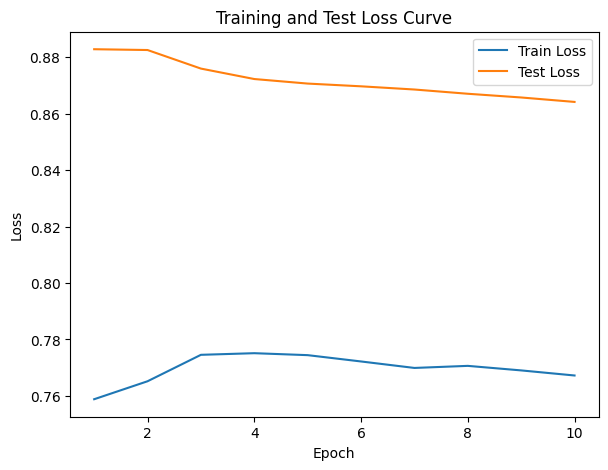

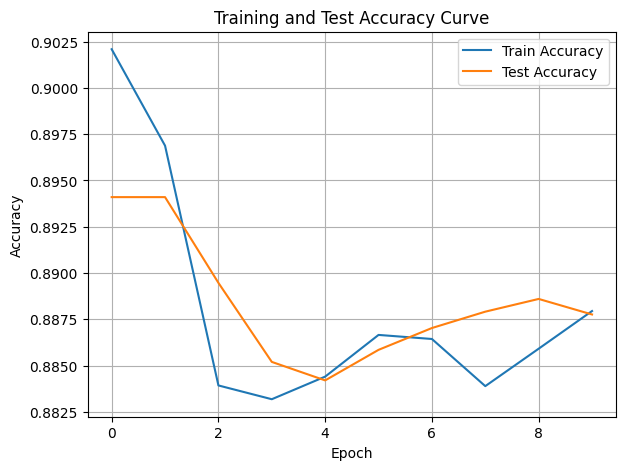

./saved_models/model_20.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.13it/s]

Epoch [1/10], Train F1:0.8746198188685235, Train Loss: 0.7554, Train Acc: 0.8812, Test F1:0.8709623323013416, Test Loss: 0.8496, Test Acc: 0.8724


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.47it/s]

Epoch [2/10], Train F1:0.8839663452976841, Train Loss: 0.7551, Train Acc: 0.8821, Test F1:0.8808197688643266, Test Loss: 0.8453, Test Acc: 0.8832


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.56it/s]

Epoch [3/10], Train F1:0.8841054630381261, Train Loss: 0.7516, Train Acc: 0.8804, Test F1:0.8840767076061193, Test Loss: 0.8425, Test Acc: 0.8869


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.06it/s]

Epoch [4/10], Train F1:0.8893659919274773, Train Loss: 0.7488, Train Acc: 0.8860, Test F1:0.8856999407945004, Test Loss: 0.8423, Test Acc: 0.8887


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.45it/s]

Epoch [5/10], Train F1:0.8862941357203422, Train Loss: 0.7491, Train Acc: 0.8836, Test F1:0.8866722274163292, Test Loss: 0.8407, Test Acc: 0.8898


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.45it/s]

Epoch [6/10], Train F1:0.8871197878579279, Train Loss: 0.7484, Train Acc: 0.8835, Test F1:0.8822445678487638, Test Loss: 0.8388, Test Acc: 0.8866


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.10it/s]

Epoch [7/10], Train F1:0.8863987353576059, Train Loss: 0.7475, Train Acc: 0.8844, Test F1:0.8792366220210024, Test Loss: 0.8376, Test Acc: 0.8834


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.30it/s]

Epoch [8/10], Train F1:0.8874730034963954, Train Loss: 0.7459, Train Acc: 0.8854, Test F1:0.8769739727282155, Test Loss: 0.8356, Test Acc: 0.8811


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.30it/s]

Epoch [9/10], Train F1:0.8889282749733783, Train Loss: 0.7441, Train Acc: 0.8869, Test F1:0.8752101153246906, Test Loss: 0.8342, Test Acc: 0.8792


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.28it/s]


Epoch [10/10], Train F1:0.8897249997768293, Train Loss: 0.7421, Train Acc: 0.8876, Test F1:0.8747858602643127, Test Loss: 0.8319, Test Acc: 0.8786
Total Epochs: 10
Train loss start: 0.7247289419174194, Train loss end: 0.7037083506584167
Highest Mean Train Accuracy (over epoch): 0.8876488095238096
Test loss start: 0.8326457142829895, Test loss end: 0.8138127326965332
Highest mean Test Accuracy (over epoch): 0.8897569444444444


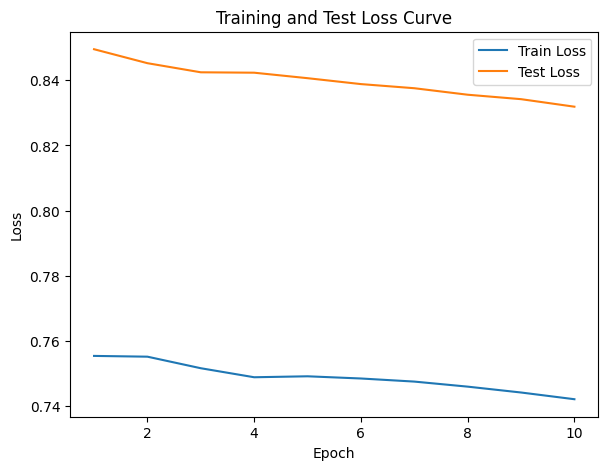

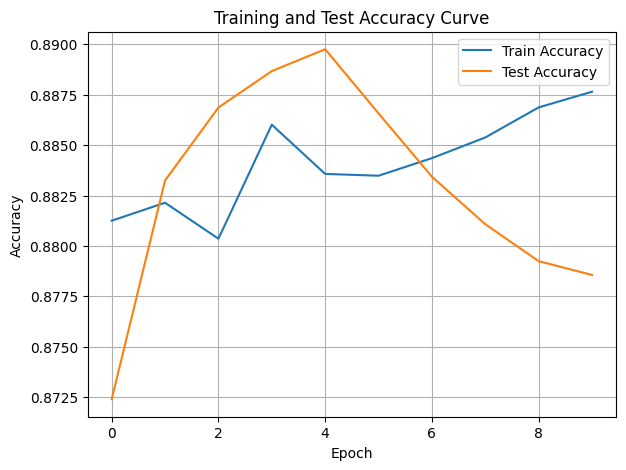

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.78it/s]

Epoch [1/10], Train F1:0.8820031933878089, Train Loss: 0.7421, Train Acc: 0.8747, Test F1:0.8709623323013416, Test Loss: 0.8103, Test Acc: 0.8724


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.78it/s]

Epoch [2/10], Train F1:0.8923124670683535, Train Loss: 0.7333, Train Acc: 0.8878, Test F1:0.8808197688643266, Test Loss: 0.8118, Test Acc: 0.8832


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.04it/s]

Epoch [3/10], Train F1:0.888827091276071, Train Loss: 0.7335, Train Acc: 0.8834, Test F1:0.8775486060481669, Test Loss: 0.8089, Test Acc: 0.8796


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.06it/s]

Epoch [4/10], Train F1:0.8917370587816962, Train Loss: 0.7298, Train Acc: 0.8854, Test F1:0.8808197688643266, Test Loss: 0.8082, Test Acc: 0.8832
Epoch [5/10], Train F1:0.890419830017957, Train Loss: 0.7289, Train Acc: 0.8837, Test F1:0.8768926387358558, Test Loss: 0.8066, Test Acc: 0.8795


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.56it/s]

Epoch [6/10], Train F1:0.8927754312465748, Train Loss: 0.7269, Train Acc: 0.8869, Test F1:0.8759075915539942, Test Loss: 0.8056, Test Acc: 0.8783
Epoch [7/10], Train F1:0.891899937263538, Train Loss: 0.7272, Train Acc: 0.8858, Test F1:0.8752031768163182, Test Loss: 0.8045, Test Acc: 0.8775


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.24it/s]

Epoch [8/10], Train F1:0.8949367246935426, Train Loss: 0.7253, Train Acc: 0.8883, Test F1:0.8771386948030099, Test Loss: 0.8043, Test Acc: 0.8796
Epoch [9/10], Train F1:0.8919116345978313, Train Loss: 0.7267, Train Acc: 0.8860, Test F1:0.8786405936060135, Test Loss: 0.8029, Test Acc: 0.8812


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.03it/s]


Epoch [10/10], Train F1:0.8944588859106175, Train Loss: 0.7236, Train Acc: 0.8897, Test F1:0.8778763714248381, Test Loss: 0.8015, Test Acc: 0.8803
Total Epochs: 10
Train loss start: 0.7267363667488098, Train loss end: 0.6256922483444214
Highest Mean Train Accuracy (over epoch): 0.8896726190476191
Test loss start: 0.787190318107605, Test loss end: 0.7935054302215576
Highest mean Test Accuracy (over epoch): 0.8832465277777778


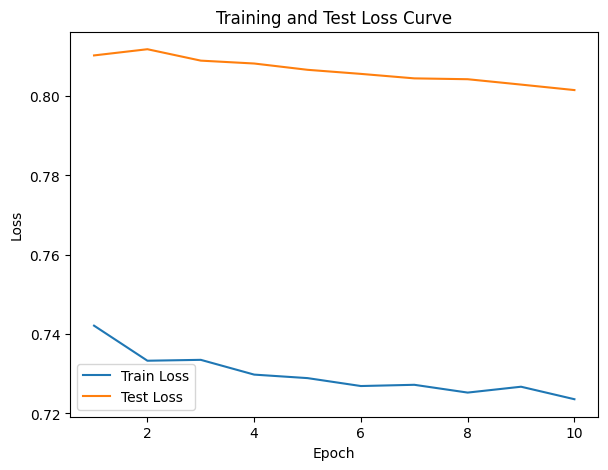

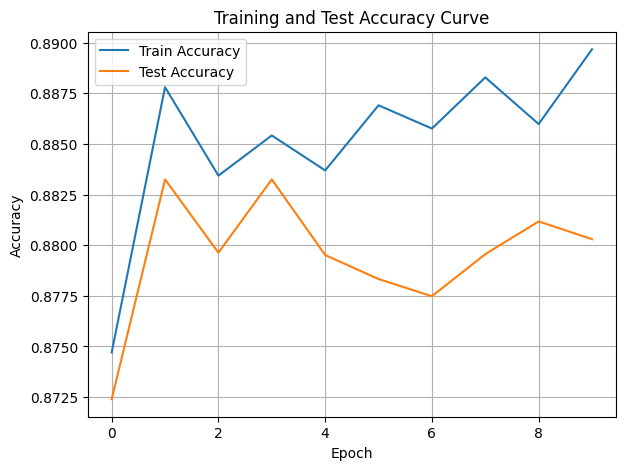

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.900267023179222, Train Loss: 0.7024, Train Acc: 0.9062, Test F1:0.8905491577043876, Test Loss: 0.7991, Test Acc: 0.8941


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.15it/s]

Epoch [2/10], Train F1:0.8904869125057383, Train Loss: 0.7073, Train Acc: 0.8894, Test F1:0.8910823303886343, Test Loss: 0.7971, Test Acc: 0.8941


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.15it/s]

Epoch [3/10], Train F1:0.8973119720141619, Train Loss: 0.7109, Train Acc: 0.8936, Test F1:0.8912538853596509, Test Loss: 0.7972, Test Acc: 0.8941


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.73it/s]

Epoch [4/10], Train F1:0.8978633708277167, Train Loss: 0.7095, Train Acc: 0.8949, Test F1:0.8910823303886343, Test Loss: 0.7943, Test Acc: 0.8941


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.43it/s]

Epoch [5/10], Train F1:0.9023259993213927, Train Loss: 0.7072, Train Acc: 0.9009, Test F1:0.8871246528874099, Test Loss: 0.7923, Test Acc: 0.8898


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.98it/s]

Epoch [6/10], Train F1:0.9012185222686293, Train Loss: 0.7077, Train Acc: 0.8986, Test F1:0.8860833052917252, Test Loss: 0.7891, Test Acc: 0.8882


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.71it/s]

Epoch [7/10], Train F1:0.8994439587296754, Train Loss: 0.7070, Train Acc: 0.8972, Test F1:0.8823911630929174, Test Loss: 0.7878, Test Acc: 0.8857
Epoch [8/10], Train F1:0.898092967906434, Train Loss: 0.7056, Train Acc: 0.8970, Test F1:0.880974843943481, Test Loss: 0.7857, Test Acc: 0.8840


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.64it/s]


Epoch [9/10], Train F1:0.8980973361721839, Train Loss: 0.7052, Train Acc: 0.8961, Test F1:0.8809577115038167, Test Loss: 0.7843, Test Acc: 0.8836
Epoch [10/10], Train F1:0.8985446597940357, Train Loss: 0.7040, Train Acc: 0.8966, Test F1:0.882896676624749, Test Loss: 0.7836, Test Acc: 0.8854
Total Epochs: 10
Train loss start: 0.6777856349945068, Train loss end: 0.6962296366691589
Highest Mean Train Accuracy (over epoch): 0.90625
Test loss start: 0.7770031094551086, Test loss end: 0.7840626239776611
Highest mean Test Accuracy (over epoch): 0.8940972222222223


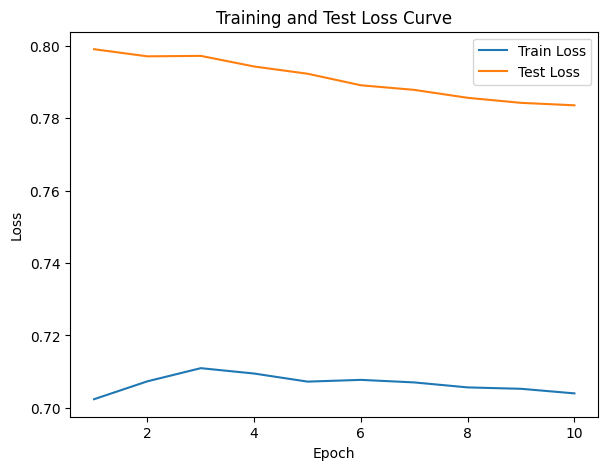

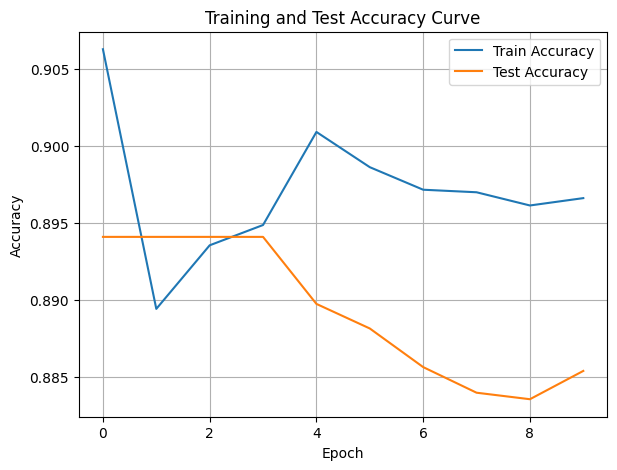

./saved_models/model_14.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [85]:
DTEmlp12b.train_DTE()

Training Process:   0%|          | 1/230 [00:00<00:33,  6.87it/s]

Epoch [1/230], Train F1:0.2398897114616178, Train Loss: 1.1858, Train Acc: 0.2211, Test F1:0.1942510597481358, Test Loss: 1.1260, Test Acc: 0.1510


Training Process:   1%|          | 2/230 [00:00<00:29,  7.63it/s]

Epoch [2/230], Train F1:0.22155306575041578, Train Loss: 1.1831, Train Acc: 0.2071, Test F1:0.1836225382990385, Test Loss: 1.1285, Test Acc: 0.1432


Training Process:   1%|▏         | 3/230 [00:00<00:27,  8.21it/s]

Epoch [3/230], Train F1:0.21472326857112015, Train Loss: 1.1830, Train Acc: 0.1968, Test F1:0.17894914960575098, Test Loss: 1.1300, Test Acc: 0.1380


Training Process:   2%|▏         | 4/230 [00:00<00:25,  8.71it/s]

Epoch [4/230], Train F1:0.22104494258727284, Train Loss: 1.1804, Train Acc: 0.2055, Test F1:0.18716271287900393, Test Loss: 1.1260, Test Acc: 0.1452


Training Process:   2%|▏         | 5/230 [00:00<00:25,  8.98it/s]

Epoch [5/230], Train F1:0.2227817099112041, Train Loss: 1.1791, Train Acc: 0.2067, Test F1:0.193292037227964, Test Loss: 1.1238, Test Acc: 0.1523


Training Process:   3%|▎         | 6/230 [00:00<00:24,  9.01it/s]

Epoch [6/230], Train F1:0.23172107539545717, Train Loss: 1.1760, Train Acc: 0.2127, Test F1:0.19996294747719912, Test Loss: 1.1216, Test Acc: 0.1609


Training Process:   3%|▎         | 7/230 [00:00<00:24,  9.17it/s]

Epoch [7/230], Train F1:0.23498261659290723, Train Loss: 1.1740, Train Acc: 0.2156, Test F1:0.20347208547366327, Test Loss: 1.1205, Test Acc: 0.1657


Training Process:   3%|▎         | 8/230 [00:00<00:24,  9.00it/s]

Epoch [8/230], Train F1:0.23974293425169016, Train Loss: 1.1704, Train Acc: 0.2208, Test F1:0.21700416854030916, Test Loss: 1.1183, Test Acc: 0.1753


Training Process:   4%|▍         | 9/230 [00:01<00:24,  9.00it/s]

Epoch [9/230], Train F1:0.24275618813101263, Train Loss: 1.1680, Train Acc: 0.2250, Test F1:0.22412759401787835, Test Loss: 1.1167, Test Acc: 0.1835


Training Process:   4%|▍         | 10/230 [00:01<00:24,  8.88it/s]

Epoch [10/230], Train F1:0.24711927080627433, Train Loss: 1.1658, Train Acc: 0.2296, Test F1:0.23362248822499354, Test Loss: 1.1154, Test Acc: 0.1924


Training Process:   5%|▍         | 11/230 [00:01<00:24,  8.84it/s]

Epoch [11/230], Train F1:0.24738332699150195, Train Loss: 1.1631, Train Acc: 0.2311, Test F1:0.23649692724655, Test Loss: 1.1132, Test Acc: 0.2031


Training Process:   6%|▌         | 13/230 [00:01<00:32,  6.67it/s]

Epoch [12/230], Train F1:0.25340100521337194, Train Loss: 1.1596, Train Acc: 0.2375, Test F1:0.24340486075225792, Test Loss: 1.1115, Test Acc: 0.2109
Epoch [13/230], Train F1:0.258426801142016, Train Loss: 1.1568, Train Acc: 0.2423, Test F1:0.27158672156314645, Test Loss: 1.1099, Test Acc: 0.2269


Training Process:   7%|▋         | 15/230 [00:01<00:30,  6.94it/s]

Epoch [14/230], Train F1:0.2625936542675618, Train Loss: 1.1539, Train Acc: 0.2475, Test F1:0.2717085868147243, Test Loss: 1.1091, Test Acc: 0.2279
Epoch [15/230], Train F1:0.2634754909931522, Train Loss: 1.1523, Train Acc: 0.2483, Test F1:0.28458548580232457, Test Loss: 1.1078, Test Acc: 0.2352


Training Process:   7%|▋         | 17/230 [00:02<00:30,  6.93it/s]

Epoch [16/230], Train F1:0.2670185116553628, Train Loss: 1.1502, Train Acc: 0.2516, Test F1:0.29099721437355747, Test Loss: 1.1069, Test Acc: 0.2405
Epoch [17/230], Train F1:0.27252500668504503, Train Loss: 1.1478, Train Acc: 0.2564, Test F1:0.3006728422119434, Test Loss: 1.1054, Test Acc: 0.2474


Training Process:   8%|▊         | 19/230 [00:02<00:30,  6.96it/s]

Epoch [18/230], Train F1:0.2768252233546588, Train Loss: 1.1448, Train Acc: 0.2604, Test F1:0.30781536891871586, Test Loss: 1.1041, Test Acc: 0.2539
Epoch [19/230], Train F1:0.2820230130726444, Train Loss: 1.1420, Train Acc: 0.2649, Test F1:0.32517017470746085, Test Loss: 1.1026, Test Acc: 0.2665


Training Process:   9%|▉         | 21/230 [00:02<00:28,  7.24it/s]

Epoch [20/230], Train F1:0.288487111169146, Train Loss: 1.1395, Train Acc: 0.2692, Test F1:0.3316539031229466, Test Loss: 1.1011, Test Acc: 0.2719
Epoch [21/230], Train F1:0.2955655376506189, Train Loss: 1.1366, Train Acc: 0.2744, Test F1:0.35397176906736216, Test Loss: 1.0996, Test Acc: 0.2866


Training Process:  10%|█         | 23/230 [00:03<00:28,  7.15it/s]

Epoch [22/230], Train F1:0.3022337653975868, Train Loss: 1.1336, Train Acc: 0.2804, Test F1:0.37949119655695557, Test Loss: 1.0977, Test Acc: 0.3041
Epoch [23/230], Train F1:0.30512027939217584, Train Loss: 1.1315, Train Acc: 0.2829, Test F1:0.401358578508627, Test Loss: 1.0962, Test Acc: 0.3199


Training Process:  11%|█         | 25/230 [00:03<00:33,  6.09it/s]

Epoch [24/230], Train F1:0.31117155542840075, Train Loss: 1.1287, Train Acc: 0.2876, Test F1:0.42350349818933214, Test Loss: 1.0946, Test Acc: 0.3362
Epoch [25/230], Train F1:0.31811004815078336, Train Loss: 1.1264, Train Acc: 0.2933, Test F1:0.43789576460272417, Test Loss: 1.0930, Test Acc: 0.3480


Training Process:  12%|█▏        | 27/230 [00:03<00:31,  6.38it/s]

Epoch [26/230], Train F1:0.32621387800386065, Train Loss: 1.1235, Train Acc: 0.3002, Test F1:0.4570066981985677, Test Loss: 1.0916, Test Acc: 0.3630
Epoch [27/230], Train F1:0.33497118471570503, Train Loss: 1.1208, Train Acc: 0.3063, Test F1:0.4705905368590671, Test Loss: 1.0901, Test Acc: 0.3744


Training Process:  13%|█▎        | 29/230 [00:04<00:29,  6.75it/s]

Epoch [28/230], Train F1:0.34229998097936365, Train Loss: 1.1181, Train Acc: 0.3119, Test F1:0.48584797000033986, Test Loss: 1.0886, Test Acc: 0.3872
Epoch [29/230], Train F1:0.35077215128930567, Train Loss: 1.1154, Train Acc: 0.3180, Test F1:0.5006356532113407, Test Loss: 1.0869, Test Acc: 0.3999


Training Process:  13%|█▎        | 31/230 [00:04<00:28,  6.88it/s]

Epoch [30/230], Train F1:0.3592447159383364, Train Loss: 1.1124, Train Acc: 0.3255, Test F1:0.5154370466118985, Test Loss: 1.0853, Test Acc: 0.4129
Epoch [31/230], Train F1:0.36829736173772293, Train Loss: 1.1092, Train Acc: 0.3328, Test F1:0.5282390845937296, Test Loss: 1.0839, Test Acc: 0.4243


Training Process:  14%|█▍        | 33/230 [00:04<00:28,  6.88it/s]

Epoch [32/230], Train F1:0.3763260546540794, Train Loss: 1.1060, Train Acc: 0.3397, Test F1:0.540194906004166, Test Loss: 1.0825, Test Acc: 0.4355
Epoch [33/230], Train F1:0.3843806293840079, Train Loss: 1.1034, Train Acc: 0.3461, Test F1:0.5517110559638136, Test Loss: 1.0809, Test Acc: 0.4465


Training Process:  15%|█▌        | 35/230 [00:04<00:29,  6.68it/s]

Epoch [34/230], Train F1:0.3942518233324362, Train Loss: 1.1003, Train Acc: 0.3532, Test F1:0.5612263528476007, Test Loss: 1.0793, Test Acc: 0.4558
Epoch [35/230], Train F1:0.4045566647404606, Train Loss: 1.0969, Train Acc: 0.3615, Test F1:0.5709697702057167, Test Loss: 1.0778, Test Acc: 0.4658


Training Process:  16%|█▌        | 36/230 [00:05<00:29,  6.68it/s]

Epoch [36/230], Train F1:0.41374862788454553, Train Loss: 1.0944, Train Acc: 0.3685, Test F1:0.5800935740695945, Test Loss: 1.0762, Test Acc: 0.4749


Training Process:  17%|█▋        | 38/230 [00:05<00:31,  6.02it/s]

Epoch [37/230], Train F1:0.4229913706093446, Train Loss: 1.0921, Train Acc: 0.3754, Test F1:0.58873015259841, Test Loss: 1.0746, Test Acc: 0.4840
Epoch [38/230], Train F1:0.43166106613824407, Train Loss: 1.0893, Train Acc: 0.3823, Test F1:0.5961007565217362, Test Loss: 1.0731, Test Acc: 0.4919


Training Process:  17%|█▋        | 39/230 [00:05<00:33,  5.76it/s]

Epoch [39/230], Train F1:0.4415681791783465, Train Loss: 1.0864, Train Acc: 0.3895, Test F1:0.6039831907968326, Test Loss: 1.0713, Test Acc: 0.5005


Training Process:  17%|█▋        | 40/230 [00:05<00:34,  5.54it/s]

Epoch [40/230], Train F1:0.4507045369837335, Train Loss: 1.0837, Train Acc: 0.3967, Test F1:0.6113325921980991, Test Loss: 1.0695, Test Acc: 0.5086


Training Process:  18%|█▊        | 41/230 [00:05<00:34,  5.42it/s]

Epoch [41/230], Train F1:0.4600418113157528, Train Loss: 1.0810, Train Acc: 0.4039, Test F1:0.6177536107303385, Test Loss: 1.0681, Test Acc: 0.5158


Training Process:  19%|█▊        | 43/230 [00:06<00:34,  5.35it/s]

Epoch [42/230], Train F1:0.4694042969237641, Train Loss: 1.0779, Train Acc: 0.4119, Test F1:0.6244979699197364, Test Loss: 1.0664, Test Acc: 0.5234
Epoch [43/230], Train F1:0.4777579471054856, Train Loss: 1.0751, Train Acc: 0.4189, Test F1:0.6303506622351502, Test Loss: 1.0646, Test Acc: 0.5301


Training Process:  19%|█▉        | 44/230 [00:06<00:34,  5.35it/s]

Epoch [44/230], Train F1:0.48588024844051214, Train Loss: 1.0726, Train Acc: 0.4252, Test F1:0.6359552651957736, Test Loss: 1.0631, Test Acc: 0.5368


Training Process:  20%|█▉        | 45/230 [00:06<00:35,  5.24it/s]

Epoch [45/230], Train F1:0.49388103918301296, Train Loss: 1.0699, Train Acc: 0.4319, Test F1:0.6417707854854585, Test Loss: 1.0614, Test Acc: 0.5434


Training Process:  20%|██        | 46/230 [00:06<00:35,  5.15it/s]

Epoch [46/230], Train F1:0.5013529304743085, Train Loss: 1.0674, Train Acc: 0.4381, Test F1:0.6470610898883812, Test Loss: 1.0597, Test Acc: 0.5496


Training Process:  21%|██        | 48/230 [00:07<00:34,  5.29it/s]

Epoch [47/230], Train F1:0.5096149179602857, Train Loss: 1.0645, Train Acc: 0.4451, Test F1:0.6520660133627026, Test Loss: 1.0582, Test Acc: 0.5558
Epoch [48/230], Train F1:0.5174632331802521, Train Loss: 1.0618, Train Acc: 0.4519, Test F1:0.6565729339605358, Test Loss: 1.0566, Test Acc: 0.5615


Training Process:  21%|██▏       | 49/230 [00:07<00:32,  5.50it/s]

Epoch [49/230], Train F1:0.5237254371386215, Train Loss: 1.0594, Train Acc: 0.4573, Test F1:0.6612596087151593, Test Loss: 1.0549, Test Acc: 0.5672


Training Process:  22%|██▏       | 50/230 [00:07<00:35,  5.08it/s]

Epoch [50/230], Train F1:0.5303406635202671, Train Loss: 1.0570, Train Acc: 0.4630, Test F1:0.6657252145637766, Test Loss: 1.0533, Test Acc: 0.5727


Training Process:  22%|██▏       | 51/230 [00:07<00:34,  5.23it/s]

Epoch [51/230], Train F1:0.5374233998014835, Train Loss: 1.0543, Train Acc: 0.4692, Test F1:0.6701269443981424, Test Loss: 1.0518, Test Acc: 0.5783


Training Process:  23%|██▎       | 52/230 [00:08<00:33,  5.24it/s]

Epoch [52/230], Train F1:0.5439989508347198, Train Loss: 1.0519, Train Acc: 0.4747, Test F1:0.6745125448803836, Test Loss: 1.0504, Test Acc: 0.5838


Training Process:  23%|██▎       | 54/230 [00:08<00:32,  5.40it/s]

Epoch [53/230], Train F1:0.5508519261224786, Train Loss: 1.0494, Train Acc: 0.4806, Test F1:0.6783281205732969, Test Loss: 1.0490, Test Acc: 0.5887
Epoch [54/230], Train F1:0.557023318931023, Train Loss: 1.0467, Train Acc: 0.4861, Test F1:0.682337469627317, Test Loss: 1.0474, Test Acc: 0.5938


Training Process:  24%|██▍       | 55/230 [00:08<00:32,  5.35it/s]

Epoch [55/230], Train F1:0.5630603912940108, Train Loss: 1.0441, Train Acc: 0.4918, Test F1:0.6859961514574857, Test Loss: 1.0458, Test Acc: 0.5985


Training Process:  24%|██▍       | 56/230 [00:08<00:32,  5.32it/s]

Epoch [56/230], Train F1:0.5688278346803506, Train Loss: 1.0414, Train Acc: 0.4973, Test F1:0.6893216701109992, Test Loss: 1.0442, Test Acc: 0.6030


Training Process:  25%|██▍       | 57/230 [00:09<00:33,  5.23it/s]

Epoch [57/230], Train F1:0.5749733265681471, Train Loss: 1.0386, Train Acc: 0.5031, Test F1:0.6925105341851298, Test Loss: 1.0425, Test Acc: 0.6072


Training Process:  25%|██▌       | 58/230 [00:09<00:33,  5.14it/s]

Epoch [58/230], Train F1:0.5807848881274087, Train Loss: 1.0359, Train Acc: 0.5082, Test F1:0.6959065694434113, Test Loss: 1.0409, Test Acc: 0.6116


Training Process:  26%|██▌       | 59/230 [00:09<00:33,  5.03it/s]

Epoch [59/230], Train F1:0.5859580096605905, Train Loss: 1.0333, Train Acc: 0.5135, Test F1:0.6988325217367062, Test Loss: 1.0394, Test Acc: 0.6156


Training Process:  26%|██▌       | 60/230 [00:09<00:34,  5.00it/s]

Epoch [60/230], Train F1:0.5913633456393521, Train Loss: 1.0306, Train Acc: 0.5189, Test F1:0.7016966825094414, Test Loss: 1.0381, Test Acc: 0.6196


Training Process:  27%|██▋       | 61/230 [00:09<00:34,  4.88it/s]

Epoch [61/230], Train F1:0.596293298230171, Train Loss: 1.0279, Train Acc: 0.5239, Test F1:0.7043903047148151, Test Loss: 1.0367, Test Acc: 0.6234


Training Process:  27%|██▋       | 62/230 [00:10<00:39,  4.27it/s]

Epoch [62/230], Train F1:0.6016210750263904, Train Loss: 1.0250, Train Acc: 0.5294, Test F1:0.7069867498119466, Test Loss: 1.0352, Test Acc: 0.6270


Training Process:  27%|██▋       | 63/230 [00:10<00:40,  4.16it/s]

Epoch [63/230], Train F1:0.6065887319792854, Train Loss: 1.0224, Train Acc: 0.5345, Test F1:0.7098155782268417, Test Loss: 1.0337, Test Acc: 0.6307


Training Process:  28%|██▊       | 64/230 [00:10<00:39,  4.22it/s]

Epoch [64/230], Train F1:0.6113523994151109, Train Loss: 1.0198, Train Acc: 0.5393, Test F1:0.712219854410524, Test Loss: 1.0322, Test Acc: 0.6341


Training Process:  28%|██▊       | 65/230 [00:10<00:39,  4.18it/s]

Epoch [65/230], Train F1:0.6157852841861441, Train Loss: 1.0172, Train Acc: 0.5436, Test F1:0.7146830211497093, Test Loss: 1.0307, Test Acc: 0.6375


Training Process:  29%|██▊       | 66/230 [00:11<00:39,  4.16it/s]

Epoch [66/230], Train F1:0.6201112961754971, Train Loss: 1.0145, Train Acc: 0.5481, Test F1:0.7170511257506109, Test Loss: 1.0292, Test Acc: 0.6409


Training Process:  29%|██▉       | 67/230 [00:11<00:37,  4.39it/s]

Epoch [67/230], Train F1:0.6242712375928317, Train Loss: 1.0118, Train Acc: 0.5525, Test F1:0.7191873344517057, Test Loss: 1.0279, Test Acc: 0.6441


Training Process:  30%|██▉       | 68/230 [00:11<00:35,  4.55it/s]

Epoch [68/230], Train F1:0.628043145078052, Train Loss: 1.0094, Train Acc: 0.5567, Test F1:0.7216975761222596, Test Loss: 1.0264, Test Acc: 0.6475


Training Process:  30%|███       | 69/230 [00:11<00:34,  4.64it/s]

Epoch [69/230], Train F1:0.6318246193765219, Train Loss: 1.0069, Train Acc: 0.5608, Test F1:0.7241253473116448, Test Loss: 1.0248, Test Acc: 0.6508


Training Process:  30%|███       | 70/230 [00:11<00:33,  4.75it/s]

Epoch [70/230], Train F1:0.6358099581179275, Train Loss: 1.0043, Train Acc: 0.5650, Test F1:0.726189692438591, Test Loss: 1.0234, Test Acc: 0.6537


Training Process:  31%|███       | 71/230 [00:12<00:33,  4.81it/s]

Epoch [71/230], Train F1:0.6395898210542421, Train Loss: 1.0018, Train Acc: 0.5692, Test F1:0.72818717816032, Test Loss: 1.0219, Test Acc: 0.6566


Training Process:  31%|███▏      | 72/230 [00:12<00:32,  4.83it/s]

Epoch [72/230], Train F1:0.6437069579824668, Train Loss: 0.9991, Train Acc: 0.5737, Test F1:0.7302597262761018, Test Loss: 1.0204, Test Acc: 0.6594


Training Process:  32%|███▏      | 73/230 [00:12<00:32,  4.86it/s]

Epoch [73/230], Train F1:0.6469326982324287, Train Loss: 0.9969, Train Acc: 0.5772, Test F1:0.7324047954815784, Test Loss: 1.0190, Test Acc: 0.6624


Training Process:  32%|███▏      | 74/230 [00:12<00:32,  4.79it/s]

Epoch [74/230], Train F1:0.6504030757751196, Train Loss: 0.9945, Train Acc: 0.5811, Test F1:0.734484900471936, Test Loss: 1.0175, Test Acc: 0.6652


Training Process:  33%|███▎      | 75/230 [00:13<00:36,  4.27it/s]

Epoch [75/230], Train F1:0.6541871959453798, Train Loss: 0.9919, Train Acc: 0.5851, Test F1:0.7362365149932748, Test Loss: 1.0161, Test Acc: 0.6678


Training Process:  33%|███▎      | 76/230 [00:13<00:36,  4.25it/s]

Epoch [76/230], Train F1:0.6576605304737915, Train Loss: 0.9896, Train Acc: 0.5889, Test F1:0.7379357009883064, Test Loss: 1.0146, Test Acc: 0.6702


Training Process:  33%|███▎      | 77/230 [00:13<00:36,  4.24it/s]

Epoch [77/230], Train F1:0.6607835940717943, Train Loss: 0.9873, Train Acc: 0.5922, Test F1:0.7395847946611123, Test Loss: 1.0132, Test Acc: 0.6727


Training Process:  34%|███▍      | 78/230 [00:13<00:35,  4.26it/s]

Epoch [78/230], Train F1:0.6638929719679594, Train Loss: 0.9850, Train Acc: 0.5956, Test F1:0.7413142797614893, Test Loss: 1.0118, Test Acc: 0.6751


Training Process:  34%|███▍      | 79/230 [00:14<00:36,  4.16it/s]

Epoch [79/230], Train F1:0.6669338682503145, Train Loss: 0.9827, Train Acc: 0.5990, Test F1:0.7428680855169629, Test Loss: 1.0104, Test Acc: 0.6774


Training Process:  35%|███▍      | 80/230 [00:14<00:36,  4.08it/s]

Epoch [80/230], Train F1:0.6701061519399347, Train Loss: 0.9805, Train Acc: 0.6023, Test F1:0.7445243611181268, Test Loss: 1.0090, Test Acc: 0.6797


Training Process:  35%|███▌      | 81/230 [00:14<00:36,  4.04it/s]

Epoch [81/230], Train F1:0.6731899104157456, Train Loss: 0.9780, Train Acc: 0.6059, Test F1:0.7461251979405652, Test Loss: 1.0076, Test Acc: 0.6820


Training Process:  36%|███▌      | 82/230 [00:14<00:36,  4.01it/s]

Epoch [82/230], Train F1:0.6758596660111803, Train Loss: 0.9758, Train Acc: 0.6089, Test F1:0.7478049705380848, Test Loss: 1.0061, Test Acc: 0.6843


Training Process:  36%|███▌      | 83/230 [00:15<00:37,  3.89it/s]

Epoch [83/230], Train F1:0.6782786035569326, Train Loss: 0.9738, Train Acc: 0.6115, Test F1:0.7488160638197572, Test Loss: 1.0048, Test Acc: 0.6862


Training Process:  37%|███▋      | 84/230 [00:15<00:36,  3.95it/s]

Epoch [84/230], Train F1:0.6809632803387023, Train Loss: 0.9717, Train Acc: 0.6145, Test F1:0.7501669296148041, Test Loss: 1.0034, Test Acc: 0.6882


Training Process:  37%|███▋      | 85/230 [00:15<00:35,  4.07it/s]

Epoch [85/230], Train F1:0.6837394086741225, Train Loss: 0.9695, Train Acc: 0.6177, Test F1:0.7514822225729418, Test Loss: 1.0020, Test Acc: 0.6902


Training Process:  37%|███▋      | 86/230 [00:15<00:38,  3.77it/s]

Epoch [86/230], Train F1:0.6859497470536889, Train Loss: 0.9675, Train Acc: 0.6203, Test F1:0.7527633382055624, Test Loss: 1.0006, Test Acc: 0.6921


Training Process:  38%|███▊      | 87/230 [00:16<00:36,  3.87it/s]

Epoch [87/230], Train F1:0.6882476598833412, Train Loss: 0.9654, Train Acc: 0.6230, Test F1:0.7543573868245971, Test Loss: 0.9992, Test Acc: 0.6943


Training Process:  38%|███▊      | 88/230 [00:16<00:35,  3.96it/s]

Epoch [88/230], Train F1:0.6906494863345177, Train Loss: 0.9632, Train Acc: 0.6258, Test F1:0.7555702264543669, Test Loss: 0.9978, Test Acc: 0.6961


Training Process:  39%|███▊      | 89/230 [00:16<00:35,  3.97it/s]

Epoch [89/230], Train F1:0.6930148448917465, Train Loss: 0.9611, Train Acc: 0.6286, Test F1:0.7568544908224032, Test Loss: 0.9964, Test Acc: 0.6981


Training Process:  39%|███▉      | 90/230 [00:16<00:34,  4.02it/s]

Epoch [90/230], Train F1:0.6956030690703101, Train Loss: 0.9589, Train Acc: 0.6316, Test F1:0.7580065639805311, Test Loss: 0.9950, Test Acc: 0.6998


Training Process:  40%|███▉      | 91/230 [00:17<00:34,  4.02it/s]

Epoch [91/230], Train F1:0.6976344653159353, Train Loss: 0.9568, Train Acc: 0.6341, Test F1:0.7592298351169829, Test Loss: 0.9936, Test Acc: 0.7017


Training Process:  40%|████      | 92/230 [00:17<00:34,  3.98it/s]

Epoch [92/230], Train F1:0.6997481467666996, Train Loss: 0.9548, Train Acc: 0.6366, Test F1:0.7604236661715786, Test Loss: 0.9921, Test Acc: 0.7036


Training Process:  40%|████      | 93/230 [00:17<00:34,  3.93it/s]

Epoch [93/230], Train F1:0.7018760618766187, Train Loss: 0.9527, Train Acc: 0.6392, Test F1:0.7614921670640532, Test Loss: 0.9907, Test Acc: 0.7052


Training Process:  41%|████      | 94/230 [00:17<00:35,  3.88it/s]

Epoch [94/230], Train F1:0.7038947148786392, Train Loss: 0.9508, Train Acc: 0.6417, Test F1:0.7625355510128612, Test Loss: 0.9895, Test Acc: 0.7068


Training Process:  41%|████▏     | 95/230 [00:18<00:35,  3.84it/s]

Epoch [95/230], Train F1:0.7060155050178571, Train Loss: 0.9489, Train Acc: 0.6441, Test F1:0.7637662479898996, Test Loss: 0.9881, Test Acc: 0.7086


Training Process:  42%|████▏     | 96/230 [00:18<00:37,  3.58it/s]

Epoch [96/230], Train F1:0.7082356612261879, Train Loss: 0.9468, Train Acc: 0.6467, Test F1:0.7650738354091879, Test Loss: 0.9868, Test Acc: 0.7103


Training Process:  42%|████▏     | 97/230 [00:18<00:39,  3.38it/s]

Epoch [97/230], Train F1:0.7098224317390506, Train Loss: 0.9450, Train Acc: 0.6488, Test F1:0.7662488656688314, Test Loss: 0.9855, Test Acc: 0.7120


Training Process:  43%|████▎     | 98/230 [00:19<00:39,  3.30it/s]

Epoch [98/230], Train F1:0.7117521013003726, Train Loss: 0.9430, Train Acc: 0.6511, Test F1:0.7672954742872663, Test Loss: 0.9842, Test Acc: 0.7136


Training Process:  43%|████▎     | 99/230 [00:19<00:38,  3.44it/s]

Epoch [99/230], Train F1:0.7136828052103855, Train Loss: 0.9411, Train Acc: 0.6533, Test F1:0.768217587812515, Test Loss: 0.9828, Test Acc: 0.7150


Training Process:  43%|████▎     | 100/230 [00:19<00:36,  3.52it/s]

Epoch [100/230], Train F1:0.7155446448303975, Train Loss: 0.9392, Train Acc: 0.6557, Test F1:0.7693204499503533, Test Loss: 0.9815, Test Acc: 0.7166


Training Process:  44%|████▍     | 101/230 [00:19<00:35,  3.63it/s]

Epoch [101/230], Train F1:0.7172808010956628, Train Loss: 0.9374, Train Acc: 0.6578, Test F1:0.7702007850582885, Test Loss: 0.9802, Test Acc: 0.7180


Training Process:  44%|████▍     | 102/230 [00:20<00:34,  3.68it/s]

Epoch [102/230], Train F1:0.7189764643479314, Train Loss: 0.9355, Train Acc: 0.6599, Test F1:0.7711607582428658, Test Loss: 0.9788, Test Acc: 0.7194


Training Process:  45%|████▍     | 103/230 [00:20<00:34,  3.68it/s]

Epoch [103/230], Train F1:0.7207936406889658, Train Loss: 0.9336, Train Acc: 0.6620, Test F1:0.7720029355601389, Test Loss: 0.9775, Test Acc: 0.7208


Training Process:  45%|████▌     | 104/230 [00:20<00:33,  3.71it/s]

Epoch [104/230], Train F1:0.7225247704584166, Train Loss: 0.9318, Train Acc: 0.6641, Test F1:0.7729132923581185, Test Loss: 0.9762, Test Acc: 0.7222


Training Process:  46%|████▌     | 105/230 [00:20<00:34,  3.68it/s]

Epoch [105/230], Train F1:0.7238989512541136, Train Loss: 0.9302, Train Acc: 0.6658, Test F1:0.773804728395178, Test Loss: 0.9748, Test Acc: 0.7236


Training Process:  46%|████▌     | 106/230 [00:21<00:34,  3.60it/s]

Epoch [106/230], Train F1:0.7255091829127137, Train Loss: 0.9283, Train Acc: 0.6679, Test F1:0.7745936862722462, Test Loss: 0.9734, Test Acc: 0.7249


Training Process:  47%|████▋     | 107/230 [00:21<00:37,  3.29it/s]

Epoch [107/230], Train F1:0.7272167094718128, Train Loss: 0.9265, Train Acc: 0.6699, Test F1:0.7756486496520562, Test Loss: 0.9722, Test Acc: 0.7263


Training Process:  47%|████▋     | 108/230 [00:21<00:37,  3.25it/s]

Epoch [108/230], Train F1:0.7285165561537729, Train Loss: 0.9250, Train Acc: 0.6716, Test F1:0.7766003136070754, Test Loss: 0.9710, Test Acc: 0.7277


Training Process:  47%|████▋     | 109/230 [00:22<00:36,  3.27it/s]

Epoch [109/230], Train F1:0.7299213704714411, Train Loss: 0.9233, Train Acc: 0.6734, Test F1:0.7775228176771023, Test Loss: 0.9697, Test Acc: 0.7290


Training Process:  48%|████▊     | 110/230 [00:22<00:36,  3.25it/s]

Epoch [110/230], Train F1:0.7313184887270526, Train Loss: 0.9217, Train Acc: 0.6750, Test F1:0.77842739386182, Test Loss: 0.9684, Test Acc: 0.7303


Training Process:  48%|████▊     | 111/230 [00:22<00:36,  3.22it/s]

Epoch [111/230], Train F1:0.7329172802876577, Train Loss: 0.9200, Train Acc: 0.6770, Test F1:0.7791333641140569, Test Loss: 0.9671, Test Acc: 0.7314


Training Process:  49%|████▊     | 112/230 [00:23<00:37,  3.18it/s]

Epoch [112/230], Train F1:0.7342978371295937, Train Loss: 0.9184, Train Acc: 0.6787, Test F1:0.7799049823649902, Test Loss: 0.9658, Test Acc: 0.7327


Training Process:  49%|████▉     | 113/230 [00:23<00:35,  3.28it/s]

Epoch [113/230], Train F1:0.7358540640011288, Train Loss: 0.9167, Train Acc: 0.6806, Test F1:0.7807612656187856, Test Loss: 0.9645, Test Acc: 0.7339


Training Process:  50%|████▉     | 114/230 [00:23<00:34,  3.34it/s]

Epoch [114/230], Train F1:0.7372993261919883, Train Loss: 0.9150, Train Acc: 0.6824, Test F1:0.7816015404901184, Test Loss: 0.9633, Test Acc: 0.7351


Training Process:  50%|█████     | 115/230 [00:24<00:34,  3.38it/s]

Epoch [115/230], Train F1:0.7384717099997271, Train Loss: 0.9137, Train Acc: 0.6839, Test F1:0.7824262531260546, Test Loss: 0.9621, Test Acc: 0.7363


Training Process:  50%|█████     | 116/230 [00:24<00:33,  3.43it/s]

Epoch [116/230], Train F1:0.7399226902165004, Train Loss: 0.9120, Train Acc: 0.6857, Test F1:0.783235833200729, Test Loss: 0.9609, Test Acc: 0.7375


Training Process:  51%|█████     | 117/230 [00:24<00:35,  3.18it/s]

Epoch [117/230], Train F1:0.7412564877695969, Train Loss: 0.9104, Train Acc: 0.6874, Test F1:0.7840306946706372, Test Loss: 0.9596, Test Acc: 0.7387


Training Process:  51%|█████▏    | 118/230 [00:25<00:35,  3.19it/s]

Epoch [118/230], Train F1:0.7426434564246975, Train Loss: 0.9089, Train Acc: 0.6891, Test F1:0.7848112364886524, Test Loss: 0.9584, Test Acc: 0.7398


Training Process:  52%|█████▏    | 119/230 [00:25<00:34,  3.21it/s]

Epoch [119/230], Train F1:0.7439572117469857, Train Loss: 0.9074, Train Acc: 0.6906, Test F1:0.7855778432793784, Test Loss: 0.9572, Test Acc: 0.7409


Training Process:  52%|█████▏    | 120/230 [00:25<00:35,  3.13it/s]

Epoch [120/230], Train F1:0.7452067990777382, Train Loss: 0.9059, Train Acc: 0.6922, Test F1:0.7862370336570657, Test Loss: 0.9560, Test Acc: 0.7420


Training Process:  53%|█████▎    | 121/230 [00:25<00:34,  3.14it/s]

Epoch [121/230], Train F1:0.7464915077825997, Train Loss: 0.9045, Train Acc: 0.6938, Test F1:0.7869776225322498, Test Loss: 0.9548, Test Acc: 0.7431


Training Process:  53%|█████▎    | 122/230 [00:26<00:34,  3.12it/s]

Epoch [122/230], Train F1:0.7478290504054151, Train Loss: 0.9030, Train Acc: 0.6955, Test F1:0.7877053388710865, Test Loss: 0.9536, Test Acc: 0.7441


Training Process:  53%|█████▎    | 123/230 [00:26<00:35,  3.04it/s]

Epoch [123/230], Train F1:0.7489345773015904, Train Loss: 0.9015, Train Acc: 0.6970, Test F1:0.7884205163051424, Test Loss: 0.9525, Test Acc: 0.7452


Training Process:  54%|█████▍    | 124/230 [00:26<00:35,  3.02it/s]

Epoch [124/230], Train F1:0.750094225962226, Train Loss: 0.9001, Train Acc: 0.6983, Test F1:0.7891333128463034, Test Loss: 0.9513, Test Acc: 0.7462


Training Process:  54%|█████▍    | 125/230 [00:27<00:34,  3.02it/s]

Epoch [125/230], Train F1:0.7513262156283438, Train Loss: 0.8986, Train Acc: 0.6999, Test F1:0.7897340897036748, Test Loss: 0.9502, Test Acc: 0.7472


Training Process:  55%|█████▍    | 126/230 [00:27<00:33,  3.10it/s]

Epoch [126/230], Train F1:0.7525550888423582, Train Loss: 0.8972, Train Acc: 0.7014, Test F1:0.7903246121266516, Test Loss: 0.9489, Test Acc: 0.7482


Training Process:  55%|█████▌    | 127/230 [00:27<00:32,  3.16it/s]

Epoch [127/230], Train F1:0.7537810463233477, Train Loss: 0.8958, Train Acc: 0.7029, Test F1:0.7909148748224712, Test Loss: 0.9478, Test Acc: 0.7491


Training Process:  56%|█████▌    | 128/230 [00:28<00:34,  2.99it/s]

Epoch [128/230], Train F1:0.7549849448010635, Train Loss: 0.8942, Train Acc: 0.7044, Test F1:0.7916428042099072, Test Loss: 0.9466, Test Acc: 0.7502


Training Process:  56%|█████▌    | 129/230 [00:28<00:33,  3.02it/s]

Epoch [129/230], Train F1:0.7560969593626113, Train Loss: 0.8928, Train Acc: 0.7058, Test F1:0.7922028756947922, Test Loss: 0.9453, Test Acc: 0.7511


Training Process:  57%|█████▋    | 130/230 [00:28<00:33,  3.00it/s]

Epoch [130/230], Train F1:0.7571007019966288, Train Loss: 0.8915, Train Acc: 0.7070, Test F1:0.7928406917656887, Test Loss: 0.9441, Test Acc: 0.7520


Training Process:  57%|█████▋    | 131/230 [00:29<00:33,  2.99it/s]

Epoch [131/230], Train F1:0.7582116563523814, Train Loss: 0.8901, Train Acc: 0.7085, Test F1:0.7934586934615131, Test Loss: 0.9429, Test Acc: 0.7530


Training Process:  57%|█████▋    | 132/230 [00:29<00:33,  2.96it/s]

Epoch [132/230], Train F1:0.7593215152513415, Train Loss: 0.8888, Train Acc: 0.7097, Test F1:0.7940857515890339, Test Loss: 0.9417, Test Acc: 0.7539


Training Process:  58%|█████▊    | 133/230 [00:29<00:33,  2.94it/s]

Epoch [133/230], Train F1:0.7604479794232708, Train Loss: 0.8875, Train Acc: 0.7111, Test F1:0.7946934810586699, Test Loss: 0.9406, Test Acc: 0.7548


Training Process:  58%|█████▊    | 134/230 [00:30<00:32,  2.91it/s]

Epoch [134/230], Train F1:0.7615732820219299, Train Loss: 0.8861, Train Acc: 0.7126, Test F1:0.7952072096900854, Test Loss: 0.9395, Test Acc: 0.7556


Training Process:  59%|█████▊    | 135/230 [00:30<00:32,  2.90it/s]

Epoch [135/230], Train F1:0.7626287146706482, Train Loss: 0.8847, Train Acc: 0.7140, Test F1:0.7957127943402229, Test Loss: 0.9384, Test Acc: 0.7565


Training Process:  59%|█████▉    | 136/230 [00:31<00:33,  2.83it/s]

Epoch [136/230], Train F1:0.7636330165165044, Train Loss: 0.8834, Train Acc: 0.7153, Test F1:0.7962937307196403, Test Loss: 0.9373, Test Acc: 0.7574


Training Process:  60%|█████▉    | 137/230 [00:31<00:32,  2.85it/s]

Epoch [137/230], Train F1:0.7646718912467482, Train Loss: 0.8823, Train Acc: 0.7164, Test F1:0.7968564784425043, Test Loss: 0.9361, Test Acc: 0.7582


Training Process:  60%|██████    | 138/230 [00:31<00:31,  2.92it/s]

Epoch [138/230], Train F1:0.7657614682035875, Train Loss: 0.8809, Train Acc: 0.7178, Test F1:0.7973376916003801, Test Loss: 0.9350, Test Acc: 0.7591


Training Process:  60%|██████    | 139/230 [00:32<00:32,  2.78it/s]

Epoch [139/230], Train F1:0.7667069592941776, Train Loss: 0.8796, Train Acc: 0.7191, Test F1:0.7978931035192419, Test Loss: 0.9339, Test Acc: 0.7599


Training Process:  61%|██████    | 140/230 [00:32<00:31,  2.82it/s]

Epoch [140/230], Train F1:0.7676310955930032, Train Loss: 0.8784, Train Acc: 0.7203, Test F1:0.7983591618476225, Test Loss: 0.9327, Test Acc: 0.7607


Training Process:  61%|██████▏   | 141/230 [00:32<00:31,  2.86it/s]

Epoch [141/230], Train F1:0.7686064134254375, Train Loss: 0.8772, Train Acc: 0.7215, Test F1:0.7988181679827057, Test Loss: 0.9316, Test Acc: 0.7614


Training Process:  62%|██████▏   | 142/230 [00:33<00:30,  2.88it/s]

Epoch [142/230], Train F1:0.7695016257434694, Train Loss: 0.8759, Train Acc: 0.7227, Test F1:0.7992702813973516, Test Loss: 0.9305, Test Acc: 0.7622


Training Process:  62%|██████▏   | 143/230 [00:33<00:30,  2.88it/s]

Epoch [143/230], Train F1:0.7702057563902176, Train Loss: 0.8747, Train Acc: 0.7237, Test F1:0.7997951038661341, Test Loss: 0.9294, Test Acc: 0.7630


Training Process:  63%|██████▎   | 144/230 [00:33<00:29,  2.87it/s]

Epoch [144/230], Train F1:0.7711881175805447, Train Loss: 0.8734, Train Acc: 0.7250, Test F1:0.8003731868845998, Test Loss: 0.9284, Test Acc: 0.7638


Training Process:  63%|██████▎   | 145/230 [00:34<00:30,  2.83it/s]

Epoch [145/230], Train F1:0.7719316772172438, Train Loss: 0.8722, Train Acc: 0.7261, Test F1:0.8009518589247987, Test Loss: 0.9274, Test Acc: 0.7646


Training Process:  63%|██████▎   | 146/230 [00:34<00:30,  2.80it/s]

Epoch [146/230], Train F1:0.7728540673796114, Train Loss: 0.8710, Train Acc: 0.7272, Test F1:0.8014444462792759, Test Loss: 0.9263, Test Acc: 0.7654


Training Process:  64%|██████▍   | 147/230 [00:34<00:30,  2.70it/s]

Epoch [147/230], Train F1:0.7737172416726347, Train Loss: 0.8699, Train Acc: 0.7282, Test F1:0.8020161107868524, Test Loss: 0.9253, Test Acc: 0.7662


Training Process:  64%|██████▍   | 148/230 [00:35<00:30,  2.69it/s]

Epoch [148/230], Train F1:0.7744733195926011, Train Loss: 0.8687, Train Acc: 0.7292, Test F1:0.8025029786738088, Test Loss: 0.9243, Test Acc: 0.7669


Training Process:  65%|██████▍   | 149/230 [00:35<00:29,  2.76it/s]

Epoch [149/230], Train F1:0.7753888925415432, Train Loss: 0.8675, Train Acc: 0.7304, Test F1:0.8029830060796992, Test Loss: 0.9233, Test Acc: 0.7676


Training Process:  65%|██████▌   | 150/230 [00:36<00:30,  2.59it/s]

Epoch [150/230], Train F1:0.7762294906208755, Train Loss: 0.8663, Train Acc: 0.7316, Test F1:0.8033805775373625, Test Loss: 0.9222, Test Acc: 0.7683


Training Process:  66%|██████▌   | 151/230 [00:36<00:29,  2.67it/s]

Epoch [151/230], Train F1:0.7771502226892719, Train Loss: 0.8651, Train Acc: 0.7327, Test F1:0.8037725528346591, Test Loss: 0.9212, Test Acc: 0.7690


Training Process:  66%|██████▌   | 152/230 [00:36<00:28,  2.72it/s]

Epoch [152/230], Train F1:0.7779974869444642, Train Loss: 0.8640, Train Acc: 0.7338, Test F1:0.8041590497066908, Test Loss: 0.9202, Test Acc: 0.7697


Training Process:  67%|██████▋   | 153/230 [00:37<00:28,  2.73it/s]

Epoch [153/230], Train F1:0.7788016070994422, Train Loss: 0.8630, Train Acc: 0.7348, Test F1:0.8046717470489065, Test Loss: 0.9192, Test Acc: 0.7704


Training Process:  67%|██████▋   | 154/230 [00:37<00:27,  2.72it/s]

Epoch [154/230], Train F1:0.7796394658519736, Train Loss: 0.8618, Train Acc: 0.7359, Test F1:0.8051206934655286, Test Loss: 0.9181, Test Acc: 0.7711


Training Process:  67%|██████▋   | 155/230 [00:38<00:29,  2.58it/s]

Epoch [155/230], Train F1:0.7804211840533082, Train Loss: 0.8607, Train Acc: 0.7370, Test F1:0.8054901596482998, Test Loss: 0.9171, Test Acc: 0.7717


Training Process:  68%|██████▊   | 156/230 [00:38<00:28,  2.56it/s]

Epoch [156/230], Train F1:0.7811189617532901, Train Loss: 0.8596, Train Acc: 0.7379, Test F1:0.805854602085603, Test Loss: 0.9161, Test Acc: 0.7724


Training Process:  68%|██████▊   | 157/230 [00:38<00:28,  2.54it/s]

Epoch [157/230], Train F1:0.7818948949166058, Train Loss: 0.8586, Train Acc: 0.7388, Test F1:0.8062141228821573, Test Loss: 0.9151, Test Acc: 0.7730


Training Process:  69%|██████▊   | 158/230 [00:39<00:28,  2.54it/s]

Epoch [158/230], Train F1:0.7826301701317955, Train Loss: 0.8575, Train Acc: 0.7398, Test F1:0.8065050939991595, Test Loss: 0.9141, Test Acc: 0.7735


Training Process:  69%|██████▉   | 159/230 [00:39<00:27,  2.62it/s]

Epoch [159/230], Train F1:0.783544200460621, Train Loss: 0.8563, Train Acc: 0.7410, Test F1:0.8069271801672029, Test Loss: 0.9131, Test Acc: 0.7741


Training Process:  70%|██████▉   | 160/230 [00:39<00:26,  2.68it/s]

Epoch [160/230], Train F1:0.7843596720999206, Train Loss: 0.8552, Train Acc: 0.7420, Test F1:0.8072724909854688, Test Loss: 0.9121, Test Acc: 0.7747


Training Process:  70%|███████   | 161/230 [00:40<00:27,  2.54it/s]

Epoch [161/230], Train F1:0.7851222219824079, Train Loss: 0.8542, Train Acc: 0.7430, Test F1:0.8076132619676949, Test Loss: 0.9111, Test Acc: 0.7753


Training Process:  70%|███████   | 162/230 [00:40<00:26,  2.58it/s]

Epoch [162/230], Train F1:0.7858883978110102, Train Loss: 0.8532, Train Acc: 0.7439, Test F1:0.8079495823336025, Test Loss: 0.9101, Test Acc: 0.7759


Training Process:  71%|███████   | 163/230 [00:41<00:27,  2.45it/s]

Epoch [163/230], Train F1:0.7865887361607969, Train Loss: 0.8521, Train Acc: 0.7448, Test F1:0.8083515879966787, Test Loss: 0.9091, Test Acc: 0.7765


Training Process:  71%|███████▏  | 164/230 [00:41<00:27,  2.44it/s]

Epoch [164/230], Train F1:0.7873356906860522, Train Loss: 0.8511, Train Acc: 0.7458, Test F1:0.808748489646321, Test Loss: 0.9081, Test Acc: 0.7771


Training Process:  72%|███████▏  | 165/230 [00:41<00:26,  2.47it/s]

Epoch [165/230], Train F1:0.7879470046712456, Train Loss: 0.8500, Train Acc: 0.7467, Test F1:0.809148539089676, Test Loss: 0.9072, Test Acc: 0.7777


Training Process:  72%|███████▏  | 166/230 [00:42<00:26,  2.46it/s]

Epoch [166/230], Train F1:0.7886744938310147, Train Loss: 0.8490, Train Acc: 0.7476, Test F1:0.8095354772752235, Test Loss: 0.9063, Test Acc: 0.7782


Training Process:  73%|███████▎  | 167/230 [00:42<00:26,  2.35it/s]

Epoch [167/230], Train F1:0.789518537724855, Train Loss: 0.8480, Train Acc: 0.7487, Test F1:0.809917594790104, Test Loss: 0.9054, Test Acc: 0.7788


Training Process:  73%|███████▎  | 168/230 [00:43<00:27,  2.29it/s]

Epoch [168/230], Train F1:0.7902125543888708, Train Loss: 0.8470, Train Acc: 0.7496, Test F1:0.8102270223474765, Test Loss: 0.9045, Test Acc: 0.7794


Training Process:  73%|███████▎  | 169/230 [00:43<00:25,  2.37it/s]

Epoch [169/230], Train F1:0.7908299494712128, Train Loss: 0.8461, Train Acc: 0.7503, Test F1:0.810600165937438, Test Loss: 0.9035, Test Acc: 0.7799


Training Process:  74%|███████▍  | 170/230 [00:44<00:24,  2.46it/s]

Epoch [170/230], Train F1:0.7914281046130011, Train Loss: 0.8451, Train Acc: 0.7511, Test F1:0.8109766961639067, Test Loss: 0.9027, Test Acc: 0.7805


Training Process:  74%|███████▍  | 171/230 [00:44<00:24,  2.37it/s]

Epoch [171/230], Train F1:0.7922223771717751, Train Loss: 0.8441, Train Acc: 0.7521, Test F1:0.8114075139322703, Test Loss: 0.9018, Test Acc: 0.7810


Training Process:  75%|███████▍  | 172/230 [00:44<00:23,  2.42it/s]

Epoch [172/230], Train F1:0.792869948875506, Train Loss: 0.8432, Train Acc: 0.7530, Test F1:0.811766788819469, Test Loss: 0.9009, Test Acc: 0.7816


Training Process:  75%|███████▌  | 173/230 [00:45<00:23,  2.45it/s]

Epoch [173/230], Train F1:0.7934560438025986, Train Loss: 0.8423, Train Acc: 0.7537, Test F1:0.8120557606354558, Test Loss: 0.8999, Test Acc: 0.7821


Training Process:  76%|███████▌  | 174/230 [00:45<00:23,  2.42it/s]

Epoch [174/230], Train F1:0.7941542294528156, Train Loss: 0.8413, Train Acc: 0.7546, Test F1:0.8124569178269175, Test Loss: 0.8990, Test Acc: 0.7827


Training Process:  76%|███████▌  | 175/230 [00:46<00:22,  2.41it/s]

Epoch [175/230], Train F1:0.7948067796183849, Train Loss: 0.8404, Train Acc: 0.7554, Test F1:0.8128687979072076, Test Loss: 0.8982, Test Acc: 0.7832


Training Process:  77%|███████▋  | 176/230 [00:46<00:22,  2.37it/s]

Epoch [176/230], Train F1:0.7954751581696531, Train Loss: 0.8395, Train Acc: 0.7563, Test F1:0.8131461125117908, Test Loss: 0.8973, Test Acc: 0.7837


Training Process:  77%|███████▋  | 177/230 [00:47<00:22,  2.34it/s]

Epoch [177/230], Train F1:0.7962144796409175, Train Loss: 0.8384, Train Acc: 0.7572, Test F1:0.8134846491797423, Test Loss: 0.8964, Test Acc: 0.7842


Training Process:  77%|███████▋  | 178/230 [00:47<00:21,  2.39it/s]

Epoch [178/230], Train F1:0.7967249515405097, Train Loss: 0.8376, Train Acc: 0.7578, Test F1:0.8137550761672425, Test Loss: 0.8955, Test Acc: 0.7847


Training Process:  78%|███████▊  | 179/230 [00:47<00:20,  2.47it/s]

Epoch [179/230], Train F1:0.7973086474243096, Train Loss: 0.8369, Train Acc: 0.7585, Test F1:0.8141499527606564, Test Loss: 0.8947, Test Acc: 0.7853


Training Process:  78%|███████▊  | 180/230 [00:48<00:19,  2.52it/s]

Epoch [180/230], Train F1:0.7978433578452463, Train Loss: 0.8360, Train Acc: 0.7593, Test F1:0.814476855438901, Test Loss: 0.8938, Test Acc: 0.7857


Training Process:  79%|███████▊  | 181/230 [00:48<00:20,  2.36it/s]

Epoch [181/230], Train F1:0.7984622557973688, Train Loss: 0.8351, Train Acc: 0.7600, Test F1:0.8148630943672458, Test Loss: 0.8931, Test Acc: 0.7863


Training Process:  79%|███████▉  | 182/230 [00:49<00:20,  2.37it/s]

Epoch [182/230], Train F1:0.7991131906342716, Train Loss: 0.8342, Train Acc: 0.7609, Test F1:0.8151822255322821, Test Loss: 0.8922, Test Acc: 0.7867


Training Process:  80%|███████▉  | 183/230 [00:49<00:19,  2.38it/s]

Epoch [183/230], Train F1:0.799667079903559, Train Loss: 0.8334, Train Acc: 0.7615, Test F1:0.8154903115115283, Test Loss: 0.8913, Test Acc: 0.7872


Training Process:  80%|████████  | 184/230 [00:49<00:19,  2.37it/s]

Epoch [184/230], Train F1:0.8004019831114736, Train Loss: 0.8325, Train Acc: 0.7625, Test F1:0.815849573387304, Test Loss: 0.8905, Test Acc: 0.7878


Training Process:  80%|████████  | 185/230 [00:50<00:19,  2.35it/s]

Epoch [185/230], Train F1:0.8009178011373165, Train Loss: 0.8317, Train Acc: 0.7631, Test F1:0.8161578169529439, Test Loss: 0.8896, Test Acc: 0.7882


Training Process:  81%|████████  | 186/230 [00:50<00:19,  2.29it/s]

Epoch [186/230], Train F1:0.801589303151532, Train Loss: 0.8308, Train Acc: 0.7639, Test F1:0.8165093692041124, Test Loss: 0.8888, Test Acc: 0.7888


Training Process:  81%|████████▏ | 187/230 [00:51<00:18,  2.26it/s]

Epoch [187/230], Train F1:0.8021810639875272, Train Loss: 0.8299, Train Acc: 0.7647, Test F1:0.817032880908183, Test Loss: 0.8881, Test Acc: 0.7894


Training Process:  82%|████████▏ | 188/230 [00:51<00:18,  2.33it/s]

Epoch [188/230], Train F1:0.8026170775835841, Train Loss: 0.8292, Train Acc: 0.7653, Test F1:0.8173902351771292, Test Loss: 0.8873, Test Acc: 0.7899


Training Process:  82%|████████▏ | 189/230 [00:52<00:17,  2.39it/s]

Epoch [189/230], Train F1:0.803157824978291, Train Loss: 0.8283, Train Acc: 0.7660, Test F1:0.817683335916315, Test Loss: 0.8865, Test Acc: 0.7904


Training Process:  83%|████████▎ | 190/230 [00:52<00:17,  2.29it/s]

Epoch [190/230], Train F1:0.8034748544651289, Train Loss: 0.8276, Train Acc: 0.7665, Test F1:0.8180189822906939, Test Loss: 0.8857, Test Acc: 0.7909


Training Process:  83%|████████▎ | 191/230 [00:53<00:17,  2.18it/s]

Epoch [191/230], Train F1:0.8040514543818265, Train Loss: 0.8268, Train Acc: 0.7672, Test F1:0.818245769383569, Test Loss: 0.8849, Test Acc: 0.7913


Training Process:  83%|████████▎ | 192/230 [00:53<00:17,  2.19it/s]

Epoch [192/230], Train F1:0.8046468514140122, Train Loss: 0.8260, Train Acc: 0.7680, Test F1:0.8185747626679576, Test Loss: 0.8841, Test Acc: 0.7918


Training Process:  84%|████████▍ | 193/230 [00:53<00:16,  2.19it/s]

Epoch [193/230], Train F1:0.8052258757920743, Train Loss: 0.8251, Train Acc: 0.7688, Test F1:0.8188552243581075, Test Loss: 0.8832, Test Acc: 0.7922


Training Process:  84%|████████▍ | 194/230 [00:54<00:16,  2.20it/s]

Epoch [194/230], Train F1:0.8057968880491425, Train Loss: 0.8243, Train Acc: 0.7694, Test F1:0.8191844910167128, Test Loss: 0.8825, Test Acc: 0.7926


Training Process:  85%|████████▍ | 195/230 [00:54<00:15,  2.22it/s]

Epoch [195/230], Train F1:0.8062201203985306, Train Loss: 0.8236, Train Acc: 0.7700, Test F1:0.8195172550465047, Test Loss: 0.8817, Test Acc: 0.7931


Training Process:  85%|████████▌ | 196/230 [00:55<00:15,  2.25it/s]

Epoch [196/230], Train F1:0.8067312124082597, Train Loss: 0.8228, Train Acc: 0.7707, Test F1:0.8197883249949895, Test Loss: 0.8810, Test Acc: 0.7935


Training Process:  86%|████████▌ | 197/230 [00:55<00:14,  2.32it/s]

Epoch [197/230], Train F1:0.8072618017164005, Train Loss: 0.8221, Train Acc: 0.7712, Test F1:0.8200565505079422, Test Loss: 0.8802, Test Acc: 0.7939


Training Process:  86%|████████▌ | 198/230 [00:56<00:13,  2.37it/s]

Epoch [198/230], Train F1:0.807774986856361, Train Loss: 0.8213, Train Acc: 0.7719, Test F1:0.8203658237648491, Test Loss: 0.8794, Test Acc: 0.7944


Training Process:  87%|████████▋ | 199/230 [00:56<00:13,  2.26it/s]

Epoch [199/230], Train F1:0.80835388669536, Train Loss: 0.8205, Train Acc: 0.7726, Test F1:0.8206855800769769, Test Loss: 0.8787, Test Acc: 0.7948


Training Process:  87%|████████▋ | 200/230 [00:57<00:13,  2.28it/s]

Epoch [200/230], Train F1:0.8088662636857, Train Loss: 0.8197, Train Acc: 0.7733, Test F1:0.8209382151029747, Test Loss: 0.8779, Test Acc: 0.7952


Training Process:  87%|████████▋ | 201/230 [00:57<00:12,  2.31it/s]

Epoch [201/230], Train F1:0.809419631595011, Train Loss: 0.8189, Train Acc: 0.7740, Test F1:0.8212382052896774, Test Loss: 0.8772, Test Acc: 0.7957


Training Process:  88%|████████▊ | 202/230 [00:57<00:12,  2.32it/s]

Epoch [202/230], Train F1:0.80992290261811, Train Loss: 0.8182, Train Acc: 0.7747, Test F1:0.8214356988253931, Test Loss: 0.8764, Test Acc: 0.7960


Training Process:  88%|████████▊ | 203/230 [00:58<00:11,  2.30it/s]

Epoch [203/230], Train F1:0.8105463177973516, Train Loss: 0.8173, Train Acc: 0.7755, Test F1:0.8217368306779615, Test Loss: 0.8756, Test Acc: 0.7965


Training Process:  89%|████████▊ | 204/230 [00:58<00:11,  2.30it/s]

Epoch [204/230], Train F1:0.811061035806619, Train Loss: 0.8166, Train Acc: 0.7761, Test F1:0.8219856993775252, Test Loss: 0.8748, Test Acc: 0.7968


Training Process:  89%|████████▉ | 205/230 [00:59<00:11,  2.23it/s]

Epoch [205/230], Train F1:0.8115477671945527, Train Loss: 0.8158, Train Acc: 0.7768, Test F1:0.8222877014216039, Test Loss: 0.8742, Test Acc: 0.7972


Training Process:  90%|████████▉ | 206/230 [00:59<00:10,  2.27it/s]

Epoch [206/230], Train F1:0.8120499171658585, Train Loss: 0.8151, Train Acc: 0.7774, Test F1:0.822475956433653, Test Loss: 0.8734, Test Acc: 0.7976


Training Process:  90%|█████████ | 207/230 [01:00<00:09,  2.30it/s]

Epoch [207/230], Train F1:0.8124587227992629, Train Loss: 0.8144, Train Acc: 0.7780, Test F1:0.8227593185733997, Test Loss: 0.8727, Test Acc: 0.7980


Training Process:  90%|█████████ | 208/230 [01:00<00:10,  2.18it/s]

Epoch [208/230], Train F1:0.8128853167937775, Train Loss: 0.8136, Train Acc: 0.7786, Test F1:0.8230398742988332, Test Loss: 0.8720, Test Acc: 0.7984


Training Process:  91%|█████████ | 209/230 [01:01<00:09,  2.20it/s]

Epoch [209/230], Train F1:0.8134382028804873, Train Loss: 0.8128, Train Acc: 0.7793, Test F1:0.8232215814337248, Test Loss: 0.8712, Test Acc: 0.7988


Training Process:  91%|█████████▏| 210/230 [01:01<00:09,  2.20it/s]

Epoch [210/230], Train F1:0.8139466105687998, Train Loss: 0.8121, Train Acc: 0.7799, Test F1:0.8234558203136366, Test Loss: 0.8705, Test Acc: 0.7991


Training Process:  92%|█████████▏| 211/230 [01:01<00:08,  2.19it/s]

Epoch [211/230], Train F1:0.8144910016190401, Train Loss: 0.8114, Train Acc: 0.7806, Test F1:0.8236877699150549, Test Loss: 0.8698, Test Acc: 0.7995


Training Process:  92%|█████████▏| 212/230 [01:02<00:08,  2.19it/s]

Epoch [212/230], Train F1:0.814876642484037, Train Loss: 0.8107, Train Acc: 0.7811, Test F1:0.8239174636625324, Test Loss: 0.8691, Test Acc: 0.7998


Training Process:  93%|█████████▎| 213/230 [01:02<00:07,  2.18it/s]

Epoch [213/230], Train F1:0.8152711934753802, Train Loss: 0.8100, Train Acc: 0.7817, Test F1:0.8241449343325784, Test Loss: 0.8684, Test Acc: 0.8002


Training Process:  93%|█████████▎| 214/230 [01:03<00:07,  2.16it/s]

Epoch [214/230], Train F1:0.8157480506300874, Train Loss: 0.8093, Train Acc: 0.7823, Test F1:0.8243702140693026, Test Loss: 0.8677, Test Acc: 0.8005


Training Process:  93%|█████████▎| 215/230 [01:03<00:06,  2.19it/s]

Epoch [215/230], Train F1:0.8161877674430517, Train Loss: 0.8086, Train Acc: 0.7829, Test F1:0.8246336405214594, Test Loss: 0.8670, Test Acc: 0.8009


Training Process:  94%|█████████▍| 216/230 [01:04<00:06,  2.19it/s]

Epoch [216/230], Train F1:0.8166434286655214, Train Loss: 0.8078, Train Acc: 0.7836, Test F1:0.824894558004022, Test Loss: 0.8663, Test Acc: 0.8013


Training Process:  94%|█████████▍| 217/230 [01:04<00:05,  2.20it/s]

Epoch [217/230], Train F1:0.817107238525292, Train Loss: 0.8071, Train Acc: 0.7842, Test F1:0.8251593308400953, Test Loss: 0.8656, Test Acc: 0.8017


Training Process:  95%|█████████▍| 218/230 [01:05<00:05,  2.10it/s]

Epoch [218/230], Train F1:0.8174842990256812, Train Loss: 0.8065, Train Acc: 0.7847, Test F1:0.8254739347663907, Test Loss: 0.8650, Test Acc: 0.8021


Training Process:  95%|█████████▌| 219/230 [01:05<00:05,  2.09it/s]

Epoch [219/230], Train F1:0.8178878651154081, Train Loss: 0.8059, Train Acc: 0.7852, Test F1:0.8257793201980822, Test Loss: 0.8643, Test Acc: 0.8025


Training Process:  96%|█████████▌| 220/230 [01:06<00:04,  2.11it/s]

Epoch [220/230], Train F1:0.818306511628242, Train Loss: 0.8052, Train Acc: 0.7858, Test F1:0.8260362529515465, Test Loss: 0.8636, Test Acc: 0.8028


Training Process:  96%|█████████▌| 221/230 [01:06<00:04,  2.08it/s]

Epoch [221/230], Train F1:0.8187458890204689, Train Loss: 0.8046, Train Acc: 0.7863, Test F1:0.8263423744137862, Test Loss: 0.8630, Test Acc: 0.8032


Training Process:  97%|█████████▋| 222/230 [01:07<00:03,  2.07it/s]

Epoch [222/230], Train F1:0.8192277411096525, Train Loss: 0.8039, Train Acc: 0.7869, Test F1:0.826588165648504, Test Loss: 0.8624, Test Acc: 0.8036


Training Process:  97%|█████████▋| 223/230 [01:07<00:03,  2.12it/s]

Epoch [223/230], Train F1:0.8196551168590424, Train Loss: 0.8033, Train Acc: 0.7874, Test F1:0.8268439544759493, Test Loss: 0.8617, Test Acc: 0.8040


Training Process:  97%|█████████▋| 224/230 [01:08<00:02,  2.15it/s]

Epoch [224/230], Train F1:0.8200486708496523, Train Loss: 0.8026, Train Acc: 0.7880, Test F1:0.8270912955510333, Test Loss: 0.8611, Test Acc: 0.8043


Training Process:  98%|█████████▊| 225/230 [01:08<00:02,  2.16it/s]

Epoch [225/230], Train F1:0.8203904300441759, Train Loss: 0.8021, Train Acc: 0.7883, Test F1:0.8274315530449362, Test Loss: 0.8605, Test Acc: 0.8048


Training Process:  98%|█████████▊| 226/230 [01:08<00:01,  2.14it/s]

Epoch [226/230], Train F1:0.8207577026430247, Train Loss: 0.8016, Train Acc: 0.7887, Test F1:0.8277243522398664, Test Loss: 0.8599, Test Acc: 0.8052


Training Process:  99%|█████████▊| 227/230 [01:09<00:01,  2.13it/s]

Epoch [227/230], Train F1:0.8211323098270895, Train Loss: 0.8010, Train Acc: 0.7892, Test F1:0.8279643579534117, Test Loss: 0.8593, Test Acc: 0.8055


Training Process:  99%|█████████▉| 228/230 [01:10<00:00,  2.02it/s]

Epoch [228/230], Train F1:0.8215527627917274, Train Loss: 0.8003, Train Acc: 0.7898, Test F1:0.8282022028712843, Test Loss: 0.8586, Test Acc: 0.8058


Training Process: 100%|█████████▉| 229/230 [01:10<00:00,  2.03it/s]

Epoch [229/230], Train F1:0.8220078242396573, Train Loss: 0.7996, Train Acc: 0.7903, Test F1:0.8283941658880871, Test Loss: 0.8580, Test Acc: 0.8061


Training Process: 100%|██████████| 230/230 [01:11<00:00,  3.24it/s]


Epoch [230/230], Train F1:0.8222814885153653, Train Loss: 0.7991, Train Acc: 0.7907, Test F1:0.82867743833441, Test Loss: 0.8574, Test Acc: 0.8065
Total Epochs: 230
Train loss start: 1.1936696767807007, Train loss end: 0.6803333163261414
Highest Mean Train Accuracy (over epoch): 0.7907479296066253
Test loss start: 1.12776780128479, Test loss end: 0.7153633832931519
Highest Mean Test Accuracy (over epoch): 0.8064953200483091


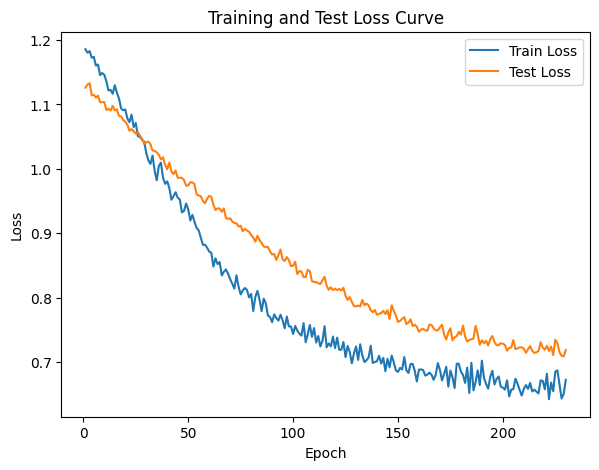

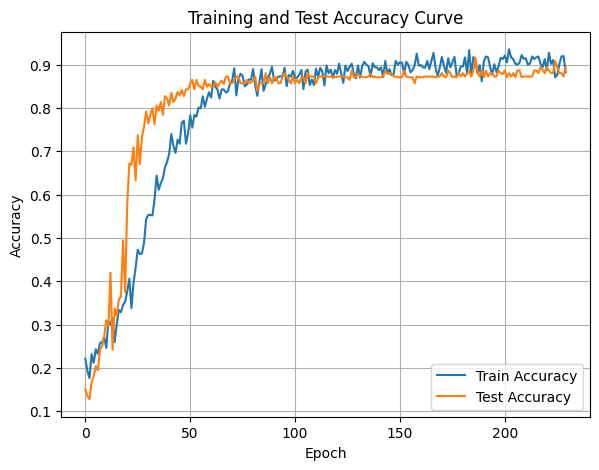

In [86]:
DTEmlp12b.train_single_model()

Randomly initializing 12 models
Training Model with id 1
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4721237836869236, Train Loss: 1.0587, Train Acc: 0.4429, Test F1:0.5885187375429836, Test Loss: 1.0171, Test Acc: 0.6589


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.30it/s]

Epoch [2/10], Train F1:0.49335260461076275, Train Loss: 1.0483, Train Acc: 0.4749, Test F1:0.57880237784544, Test Loss: 1.0053, Test Acc: 0.6697
Epoch [3/10], Train F1:0.5075981549396161, Train Loss: 1.0432, Train Acc: 0.4855, Test F1:0.5748953515124667, Test Loss: 0.9995, Test Acc: 0.6687


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.50it/s]

Epoch [4/10], Train F1:0.5075719535853109, Train Loss: 1.0427, Train Acc: 0.4891, Test F1:0.5773086562560246, Test Loss: 0.9966, Test Acc: 0.6701


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.59it/s]

Epoch [5/10], Train F1:0.5204900899012297, Train Loss: 1.0364, Train Acc: 0.5022, Test F1:0.5796110152177982, Test Loss: 0.9943, Test Acc: 0.6738
Epoch [6/10], Train F1:0.5345897624681255, Train Loss: 1.0319, Train Acc: 0.5135, Test F1:0.584044324401622, Test Loss: 0.9925, Test Acc: 0.6775


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.59it/s]

Epoch [7/10], Train F1:0.5445622335304281, Train Loss: 1.0275, Train Acc: 0.5241, Test F1:0.5921035681653547, Test Loss: 0.9910, Test Acc: 0.6833


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.27it/s]

Epoch [8/10], Train F1:0.55002088348204, Train Loss: 1.0231, Train Acc: 0.5300, Test F1:0.5959577585709832, Test Loss: 0.9899, Test Acc: 0.6859


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.27it/s]

Epoch [9/10], Train F1:0.559178484337377, Train Loss: 1.0199, Train Acc: 0.5373, Test F1:0.6045349174152419, Test Loss: 0.9877, Test Acc: 0.6912


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.57it/s]


Epoch [10/10], Train F1:0.5680238041437558, Train Loss: 1.0174, Train Acc: 0.5450, Test F1:0.6112983265643923, Test Loss: 0.9862, Test Acc: 0.6954
Total Epochs: 10
Train loss start: 1.0400354862213135, Train loss end: 1.1635267734527588
Highest Mean Train Accuracy (over epoch): 0.545
Test loss start: 1.0052447319030762, Test loss end: 0.9646946787834167
Highest mean Test Accuracy (over epoch): 0.6953993055555555


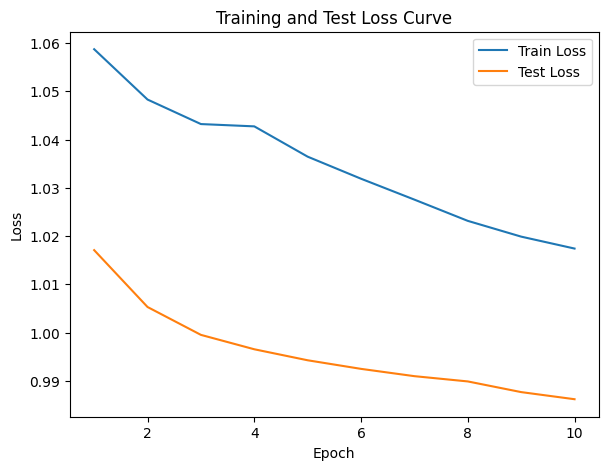

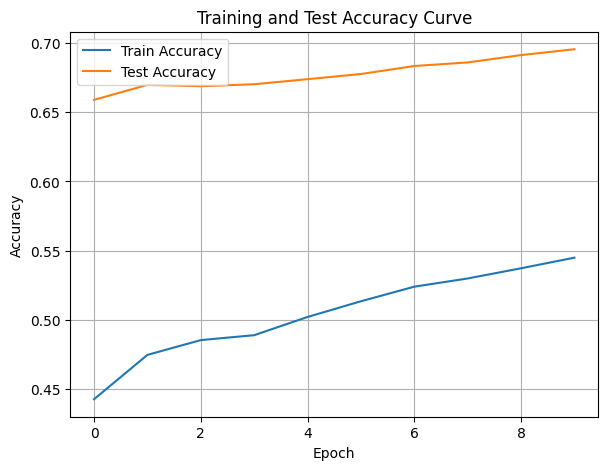

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.57it/s]

Epoch [1/10], Train F1:0.33281128921866693, Train Loss: 1.1801, Train Acc: 0.2545, Test F1:0.3656506136716684, Test Loss: 1.0850, Test Acc: 0.3073


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.57it/s]

Epoch [2/10], Train F1:0.3358483440957668, Train Loss: 1.1703, Train Acc: 0.2549, Test F1:0.4302903275888837, Test Loss: 1.0706, Test Acc: 0.3863


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.56it/s]

Epoch [3/10], Train F1:0.3354299581323122, Train Loss: 1.1690, Train Acc: 0.2540, Test F1:0.48331507755206665, Test Loss: 1.0666, Test Acc: 0.4407


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.56it/s]

Epoch [4/10], Train F1:0.3358822357050318, Train Loss: 1.1657, Train Acc: 0.2543, Test F1:0.4764695413929966, Test Loss: 1.0636, Test Acc: 0.4429


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.91it/s]

Epoch [5/10], Train F1:0.3369124814352044, Train Loss: 1.1647, Train Acc: 0.2562, Test F1:0.4915014417258399, Test Loss: 1.0595, Test Acc: 0.4623


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.91it/s]

Epoch [6/10], Train F1:0.3508781081801123, Train Loss: 1.1619, Train Acc: 0.2675, Test F1:0.49278623697996293, Test Loss: 1.0578, Test Acc: 0.4677


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.15it/s]

Epoch [7/10], Train F1:0.3554220141426209, Train Loss: 1.1585, Train Acc: 0.2717, Test F1:0.4815343704324601, Test Loss: 1.0576, Test Acc: 0.4590


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.15it/s]

Epoch [8/10], Train F1:0.3567987506673386, Train Loss: 1.1557, Train Acc: 0.2738, Test F1:0.4939919020127529, Test Loss: 1.0558, Test Acc: 0.4737


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.54it/s]

Epoch [9/10], Train F1:0.3698238957266406, Train Loss: 1.1515, Train Acc: 0.2857, Test F1:0.49321715473940647, Test Loss: 1.0535, Test Acc: 0.4769


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.91it/s]


Epoch [10/10], Train F1:0.37812742828340973, Train Loss: 1.1483, Train Acc: 0.2933, Test F1:0.5176777859193389, Test Loss: 1.0517, Test Acc: 0.5001
Total Epochs: 10
Train loss start: 1.1740689277648926, Train loss end: 1.1607645750045776
Highest Mean Train Accuracy (over epoch): 0.2933035714285714
Test loss start: 1.0903666019439697, Test loss end: 1.0347633361816406
Highest mean Test Accuracy (over epoch): 0.5000868055555555


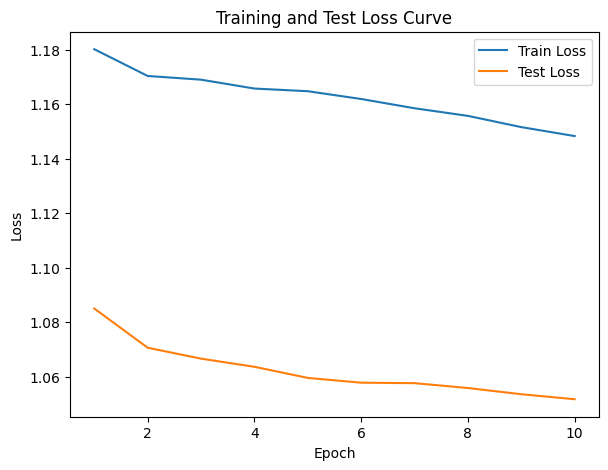

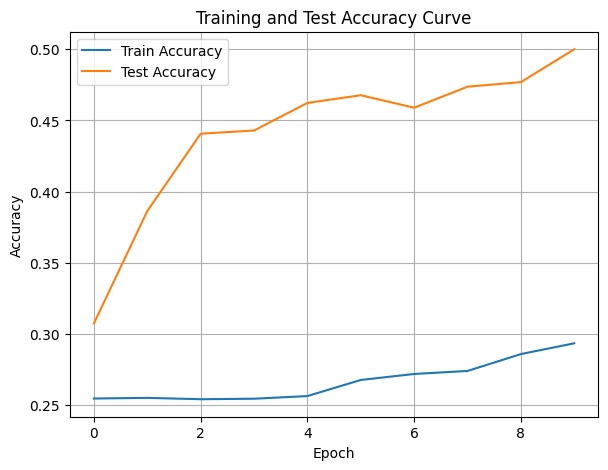

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.26it/s]

Epoch [1/10], Train F1:0.4007793298140463, Train Loss: 1.1210, Train Acc: 0.3315, Test F1:0.3661173134857345, Test Loss: 1.0903, Test Acc: 0.3316


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.77it/s]

Epoch [2/10], Train F1:0.4052066725873932, Train Loss: 1.1206, Train Acc: 0.3400, Test F1:0.3472931032243822, Test Loss: 1.0897, Test Acc: 0.3277


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.03it/s]

Epoch [3/10], Train F1:0.4172784176447234, Train Loss: 1.1210, Train Acc: 0.3480, Test F1:0.39408405928278445, Test Loss: 1.0858, Test Acc: 0.3709


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.21it/s]

Epoch [4/10], Train F1:0.420721275778138, Train Loss: 1.1202, Train Acc: 0.3504, Test F1:0.4289568267678278, Test Loss: 1.0831, Test Acc: 0.4039


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.07it/s]

Epoch [5/10], Train F1:0.4398174858684902, Train Loss: 1.1147, Train Acc: 0.3643, Test F1:0.41363251545233193, Test Loss: 1.0830, Test Acc: 0.3969


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.07it/s]

Epoch [6/10], Train F1:0.44847259516664034, Train Loss: 1.1090, Train Acc: 0.3735, Test F1:0.4198639762611893, Test Loss: 1.0823, Test Acc: 0.4034


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.62it/s]

Epoch [7/10], Train F1:0.46166503621629035, Train Loss: 1.1029, Train Acc: 0.3863, Test F1:0.42034000411413786, Test Loss: 1.0809, Test Acc: 0.4071


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.62it/s]

Epoch [8/10], Train F1:0.46442885929874334, Train Loss: 1.1007, Train Acc: 0.3895, Test F1:0.41273287899551836, Test Loss: 1.0787, Test Acc: 0.4053


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.10it/s]

Epoch [9/10], Train F1:0.4672494508780912, Train Loss: 1.0972, Train Acc: 0.3940, Test F1:0.4321482010879122, Test Loss: 1.0765, Test Acc: 0.4213


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.32it/s]


Epoch [10/10], Train F1:0.4727471843721668, Train Loss: 1.0929, Train Acc: 0.4018, Test F1:0.44428428649649376, Test Loss: 1.0744, Test Acc: 0.4327
Total Epochs: 10
Train loss start: 1.1314165592193604, Train loss end: 0.9157806038856506
Highest Mean Train Accuracy (over epoch): 0.40175595238095235
Test loss start: 1.09017813205719, Test loss end: 1.0637707710266113
Highest mean Test Accuracy (over epoch): 0.4327256944444445


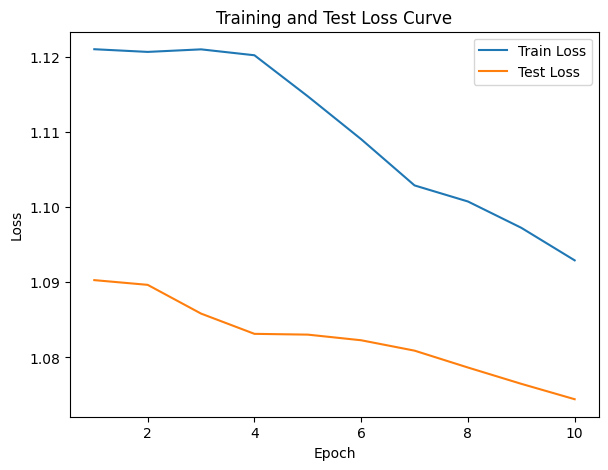

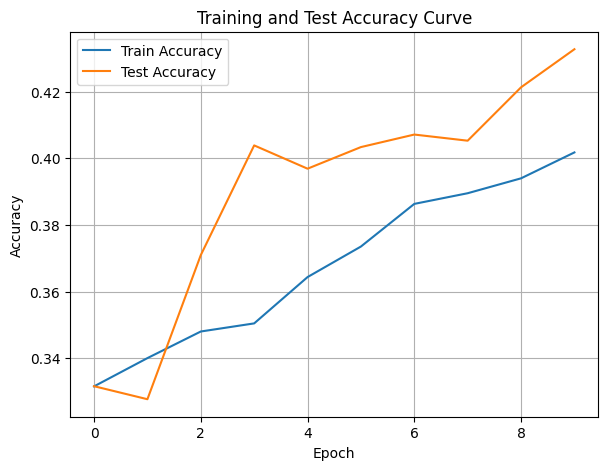

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.47593071682282956, Train Loss: 1.0672, Train Acc: 0.4920, Test F1:0.4990798675009201, Test Loss: 1.0546, Test Acc: 0.5764


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.52it/s]

Epoch [2/10], Train F1:0.4875276783615503, Train Loss: 1.0588, Train Acc: 0.5156, Test F1:0.5199515396883817, Test Loss: 1.0458, Test Acc: 0.5951


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.92it/s]

Epoch [3/10], Train F1:0.4811263022691594, Train Loss: 1.0524, Train Acc: 0.5152, Test F1:0.5455353784070311, Test Loss: 1.0446, Test Acc: 0.5926
Epoch [4/10], Train F1:0.48417452616510165, Train Loss: 1.0489, Train Acc: 0.5167, Test F1:0.5547452756540711, Test Loss: 1.0382, Test Acc: 0.6057


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.92it/s]

Epoch [5/10], Train F1:0.48279529554194484, Train Loss: 1.0466, Train Acc: 0.5196, Test F1:0.5601313224581922, Test Loss: 1.0372, Test Acc: 0.6049


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.93it/s]

Epoch [6/10], Train F1:0.48872311757254, Train Loss: 1.0438, Train Acc: 0.5268, Test F1:0.5732935855263157, Test Loss: 1.0343, Test Acc: 0.6144


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.93it/s]

Epoch [7/10], Train F1:0.49181768188756014, Train Loss: 1.0418, Train Acc: 0.5331, Test F1:0.583554062535774, Test Loss: 1.0327, Test Acc: 0.6233


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.75it/s]

Epoch [8/10], Train F1:0.4961054774566559, Train Loss: 1.0385, Train Acc: 0.5389, Test F1:0.5952719636930164, Test Loss: 1.0297, Test Acc: 0.6355


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.75it/s]

Epoch [9/10], Train F1:0.5002790170211401, Train Loss: 1.0345, Train Acc: 0.5452, Test F1:0.6037175236371904, Test Loss: 1.0263, Test Acc: 0.6442


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.89it/s]


Epoch [10/10], Train F1:0.5069083284075289, Train Loss: 1.0307, Train Acc: 0.5524, Test F1:0.6084542752229412, Test Loss: 1.0237, Test Acc: 0.6503
Total Epochs: 10
Train loss start: 1.046281337738037, Train loss end: 0.9310107827186584
Highest Mean Train Accuracy (over epoch): 0.5523511904761904
Test loss start: 1.0585062503814697, Test loss end: 1.0047553777694702
Highest mean Test Accuracy (over epoch): 0.6503472222222222


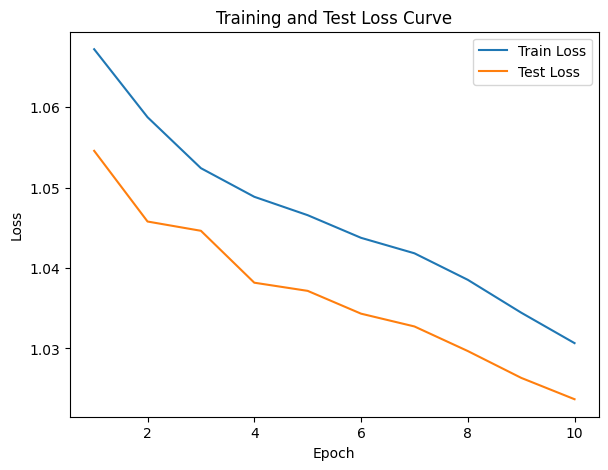

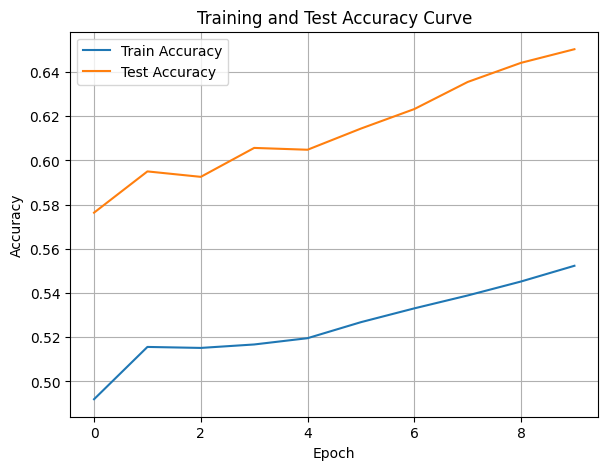

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.5187902867536734, Train Loss: 1.0710, Train Acc: 0.4804, Test F1:0.6345448949327066, Test Loss: 1.0582, Test Acc: 0.6649


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.68it/s]

Epoch [2/10], Train F1:0.5015851229248849, Train Loss: 1.0677, Train Acc: 0.4732, Test F1:0.6070345859251475, Test Loss: 1.0513, Test Acc: 0.6541


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.68it/s]

Epoch [3/10], Train F1:0.4932569788506668, Train Loss: 1.0666, Train Acc: 0.4701, Test F1:0.608756542158896, Test Loss: 1.0485, Test Acc: 0.6629


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.47it/s]

Epoch [4/10], Train F1:0.5167321683544611, Train Loss: 1.0586, Train Acc: 0.4955, Test F1:0.6095527831340136, Test Loss: 1.0455, Test Acc: 0.6688


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.47it/s]

Epoch [5/10], Train F1:0.5192355061311033, Train Loss: 1.0563, Train Acc: 0.5005, Test F1:0.6156290110871322, Test Loss: 1.0427, Test Acc: 0.6727


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.73it/s]

Epoch [6/10], Train F1:0.5269043685159058, Train Loss: 1.0523, Train Acc: 0.5120, Test F1:0.6197897918157577, Test Loss: 1.0401, Test Acc: 0.6777
Epoch [7/10], Train F1:0.5310737897599838, Train Loss: 1.0492, Train Acc: 0.5169, Test F1:0.6223260224669858, Test Loss: 1.0386, Test Acc: 0.6823


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.21it/s]

Epoch [8/10], Train F1:0.5357364535431052, Train Loss: 1.0475, Train Acc: 0.5209, Test F1:0.6314905540115846, Test Loss: 1.0362, Test Acc: 0.6870
Epoch [9/10], Train F1:0.5414841271041152, Train Loss: 1.0445, Train Acc: 0.5268, Test F1:0.6383547607260401, Test Loss: 1.0332, Test Acc: 0.6939


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.40it/s]


Epoch [10/10], Train F1:0.5440566289456051, Train Loss: 1.0424, Train Acc: 0.5309, Test F1:0.6438900230407647, Test Loss: 1.0313, Test Acc: 0.6986
Total Epochs: 10
Train loss start: 1.0802116394042969, Train loss end: 1.0108346939086914
Highest Mean Train Accuracy (over epoch): 0.5308630952380952
Test loss start: 1.0624653100967407, Test loss end: 1.0073550939559937
Highest mean Test Accuracy (over epoch): 0.6986111111111111


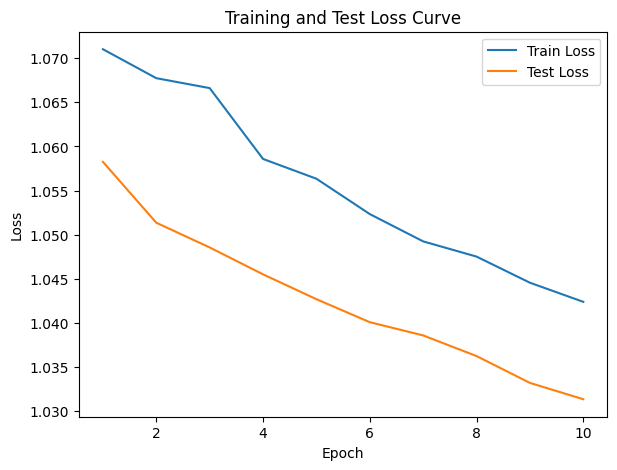

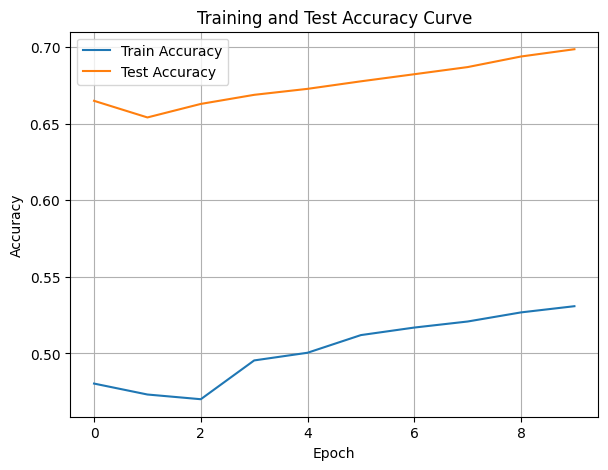

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.72it/s]

Epoch [1/10], Train F1:0.5500068888100424, Train Loss: 1.0439, Train Acc: 0.4774, Test F1:0.4952584163110479, Test Loss: 1.0564, Test Acc: 0.5009


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.24it/s]

Epoch [2/10], Train F1:0.5353787302191043, Train Loss: 1.0416, Train Acc: 0.4711, Test F1:0.5182268107072535, Test Loss: 1.0497, Test Acc: 0.5291


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.52it/s]

Epoch [3/10], Train F1:0.546985207285365, Train Loss: 1.0390, Train Acc: 0.4886, Test F1:0.49961732558417643, Test Loss: 1.0493, Test Acc: 0.5188


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.69it/s]

Epoch [4/10], Train F1:0.5668001147200893, Train Loss: 1.0337, Train Acc: 0.5088, Test F1:0.5034677760174616, Test Loss: 1.0476, Test Acc: 0.5250


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.69it/s]

Epoch [5/10], Train F1:0.570004240423949, Train Loss: 1.0320, Train Acc: 0.5151, Test F1:0.5066742760786989, Test Loss: 1.0458, Test Acc: 0.5271


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.44it/s]

Epoch [6/10], Train F1:0.5805875488683461, Train Loss: 1.0264, Train Acc: 0.5285, Test F1:0.5581221572449643, Test Loss: 1.0420, Test Acc: 0.5677


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.08it/s]

Epoch [7/10], Train F1:0.5895917828494678, Train Loss: 1.0222, Train Acc: 0.5382, Test F1:0.5830316431382825, Test Loss: 1.0409, Test Acc: 0.5880


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.42it/s]

Epoch [8/10], Train F1:0.601211138771493, Train Loss: 1.0180, Train Acc: 0.5517, Test F1:0.5792777199793022, Test Loss: 1.0402, Test Acc: 0.5862


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.71it/s]

Epoch [9/10], Train F1:0.6111144317980652, Train Loss: 1.0134, Train Acc: 0.5623, Test F1:0.59361955023059, Test Loss: 1.0379, Test Acc: 0.5997


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.87it/s]


Epoch [10/10], Train F1:0.6182211442006347, Train Loss: 1.0097, Train Acc: 0.5705, Test F1:0.5872858111792136, Test Loss: 1.0365, Test Acc: 0.5937
Total Epochs: 10
Train loss start: 1.0142885446548462, Train loss end: 0.991679310798645
Highest Mean Train Accuracy (over epoch): 0.5704761904761904
Test loss start: 1.06442391872406, Test loss end: 1.0129661560058594
Highest mean Test Accuracy (over epoch): 0.5997299382716048


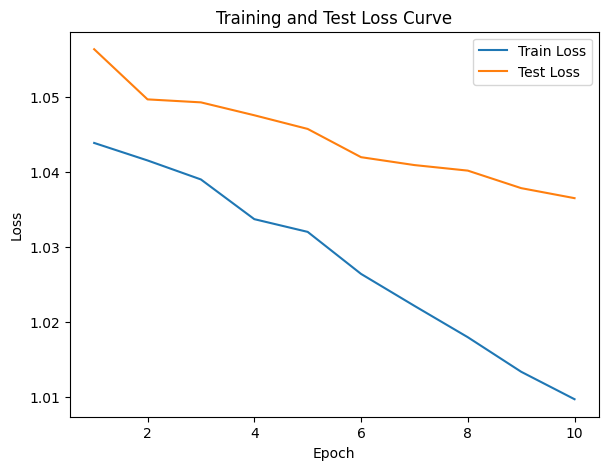

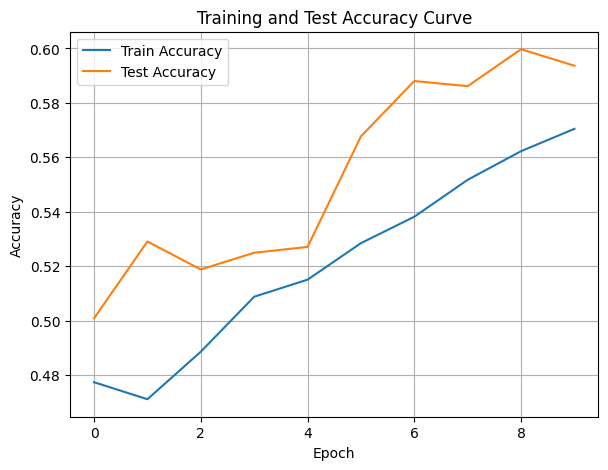

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.41it/s]

Epoch [1/10], Train F1:0.5009713634958893, Train Loss: 1.0519, Train Acc: 0.5077, Test F1:0.5689829788624261, Test Loss: 1.0493, Test Acc: 0.6589
Epoch [2/10], Train F1:0.5172095124750615, Train Loss: 1.0429, Train Acc: 0.5219, Test F1:0.58322147365012, Test Loss: 1.0371, Test Acc: 0.6667


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.13it/s]

Epoch [3/10], Train F1:0.5422408977440593, Train Loss: 1.0301, Train Acc: 0.5467, Test F1:0.579429858067629, Test Loss: 1.0326, Test Acc: 0.6667
Epoch [4/10], Train F1:0.5470392608910614, Train Loss: 1.0274, Train Acc: 0.5529, Test F1:0.5740016029160308, Test Loss: 1.0280, Test Acc: 0.6612


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.25it/s]

Epoch [5/10], Train F1:0.5474084641851056, Train Loss: 1.0256, Train Acc: 0.5515, Test F1:0.577495618472187, Test Loss: 1.0227, Test Acc: 0.6667
Epoch [6/10], Train F1:0.5514637304701431, Train Loss: 1.0219, Train Acc: 0.5598, Test F1:0.5789069224479578, Test Loss: 1.0212, Test Acc: 0.6680


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.24it/s]

Epoch [7/10], Train F1:0.561290323546057, Train Loss: 1.0173, Train Acc: 0.5701, Test F1:0.5775248815176219, Test Loss: 1.0194, Test Acc: 0.6647
Epoch [8/10], Train F1:0.5690910837096751, Train Loss: 1.0119, Train Acc: 0.5807, Test F1:0.5785766396453419, Test Loss: 1.0166, Test Acc: 0.6667


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.38it/s]


Epoch [9/10], Train F1:0.5755192785457034, Train Loss: 1.0077, Train Acc: 0.5879, Test F1:0.580017511431073, Test Loss: 1.0142, Test Acc: 0.6691
Epoch [10/10], Train F1:0.5832529308771237, Train Loss: 1.0039, Train Acc: 0.5962, Test F1:0.5825911847182301, Test Loss: 1.0115, Test Acc: 0.6724
Total Epochs: 10
Train loss start: 1.0541326999664307, Train loss end: 1.0064243078231812
Highest Mean Train Accuracy (over epoch): 0.5961607142857143
Test loss start: 1.0477256774902344, Test loss end: 0.992224395275116
Highest mean Test Accuracy (over epoch): 0.6723958333333334


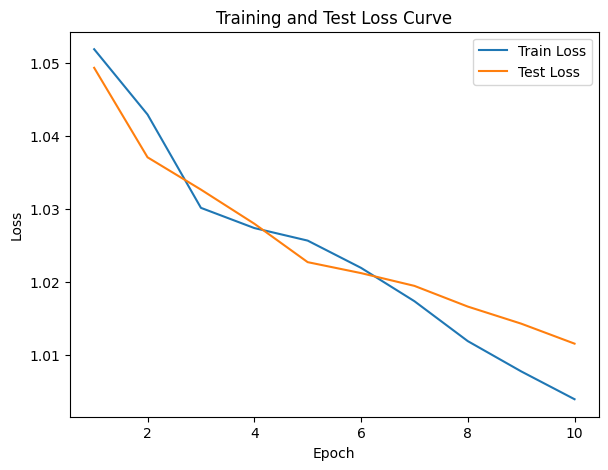

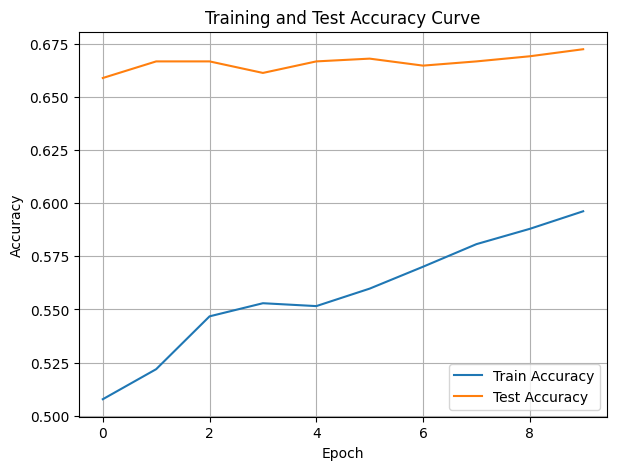

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.24743846658115595, Train Loss: 1.1545, Train Acc: 0.3024, Test F1:0.15212857318120473, Test Loss: 1.1183, Test Acc: 0.2726


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.39it/s]

Epoch [2/10], Train F1:0.2636577039575472, Train Loss: 1.1432, Train Acc: 0.3308, Test F1:0.15728977616454928, Test Loss: 1.1161, Test Acc: 0.2843


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.95it/s]

Epoch [3/10], Train F1:0.2699361537698344, Train Loss: 1.1440, Train Acc: 0.3265, Test F1:0.1647459506554196, Test Loss: 1.1142, Test Acc: 0.3032


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.95it/s]

Epoch [4/10], Train F1:0.2761870335033951, Train Loss: 1.1416, Train Acc: 0.3335, Test F1:0.16926738957947635, Test Loss: 1.1128, Test Acc: 0.3147


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.61it/s]

Epoch [5/10], Train F1:0.2880007562506991, Train Loss: 1.1391, Train Acc: 0.3406, Test F1:0.17122807017543856, Test Loss: 1.1132, Test Acc: 0.3200


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.61it/s]

Epoch [6/10], Train F1:0.28782254641033267, Train Loss: 1.1367, Train Acc: 0.3421, Test F1:0.17310976556435334, Test Loss: 1.1140, Test Acc: 0.3248


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.84it/s]

Epoch [7/10], Train F1:0.2936585687299565, Train Loss: 1.1328, Train Acc: 0.3485, Test F1:0.17444367061320595, Test Loss: 1.1128, Test Acc: 0.3282


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.41it/s]

Epoch [8/10], Train F1:0.30059828180922565, Train Loss: 1.1284, Train Acc: 0.3542, Test F1:0.17543859649122806, Test Loss: 1.1114, Test Acc: 0.3308


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.41it/s]

Epoch [9/10], Train F1:0.3053734886751965, Train Loss: 1.1239, Train Acc: 0.3591, Test F1:0.17620919061930085, Test Loss: 1.1097, Test Acc: 0.3329


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.00it/s]


Epoch [10/10], Train F1:0.3107291042754603, Train Loss: 1.1212, Train Acc: 0.3616, Test F1:0.17682363804247458, Test Loss: 1.1087, Test Acc: 0.3345
Total Epochs: 10
Train loss start: 1.09181547164917, Train loss end: 1.2224308252334595
Highest Mean Train Accuracy (over epoch): 0.36163690476190474
Test loss start: 1.126433253288269, Test loss end: 1.1038929224014282
Highest mean Test Accuracy (over epoch): 0.33446180555555555


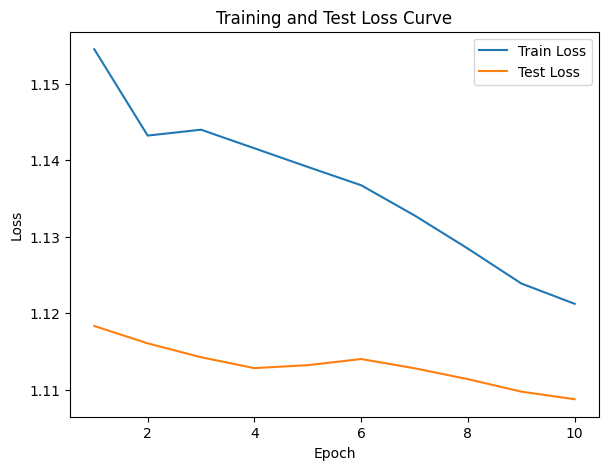

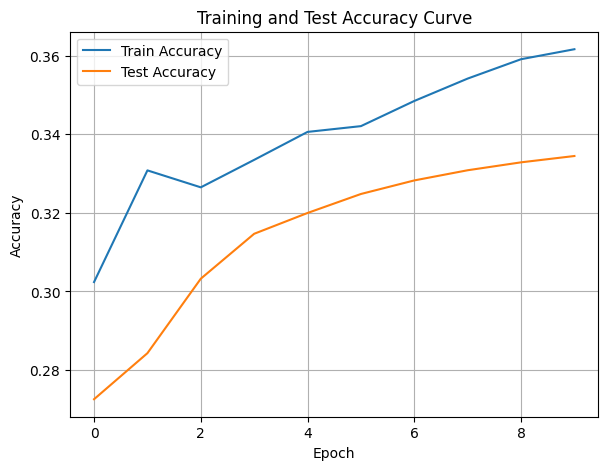

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.2676422636486731, Train Loss: 1.1825, Train Acc: 0.1866, Test F1:0.20201048798759558, Test Loss: 1.1640, Test Acc: 0.1293


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.21it/s]

Epoch [2/10], Train F1:0.2844965531697663, Train Loss: 1.1733, Train Acc: 0.2012, Test F1:0.2100795177395537, Test Loss: 1.1664, Test Acc: 0.1393
Epoch [3/10], Train F1:0.28434308723721746, Train Loss: 1.1700, Train Acc: 0.2044, Test F1:0.2183544871978531, Test Loss: 1.1659, Test Acc: 0.1499


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.71it/s]

Epoch [4/10], Train F1:0.30209602416781883, Train Loss: 1.1652, Train Acc: 0.2190, Test F1:0.22170093150640985, Test Loss: 1.1659, Test Acc: 0.1552


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.76it/s]

Epoch [5/10], Train F1:0.30668859549257654, Train Loss: 1.1607, Train Acc: 0.2263, Test F1:0.22608080342923983, Test Loss: 1.1638, Test Acc: 0.1599
Epoch [6/10], Train F1:0.3114889676475003, Train Loss: 1.1565, Train Acc: 0.2310, Test F1:0.22844730233878874, Test Loss: 1.1616, Test Acc: 0.1670


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.54it/s]

Epoch [7/10], Train F1:0.31508355772224095, Train Loss: 1.1547, Train Acc: 0.2363, Test F1:0.22868655153971815, Test Loss: 1.1600, Test Acc: 0.1678
Epoch [8/10], Train F1:0.32210467148466115, Train Loss: 1.1519, Train Acc: 0.2420, Test F1:0.23141545620323206, Test Loss: 1.1603, Test Acc: 0.1692


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.99it/s]


Epoch [9/10], Train F1:0.33129893623591444, Train Loss: 1.1480, Train Acc: 0.2509, Test F1:0.2311638225781272, Test Loss: 1.1600, Test Acc: 0.1678
Epoch [10/10], Train F1:0.3373679579266171, Train Loss: 1.1441, Train Acc: 0.2560, Test F1:0.23082726462701703, Test Loss: 1.1583, Test Acc: 0.1668
Total Epochs: 10
Train loss start: 1.1717634201049805, Train loss end: 1.1479856967926025
Highest Mean Train Accuracy (over epoch): 0.2560416666666666
Test loss start: 1.1683512926101685, Test loss end: 1.1320666074752808
Highest mean Test Accuracy (over epoch): 0.1691623263888889


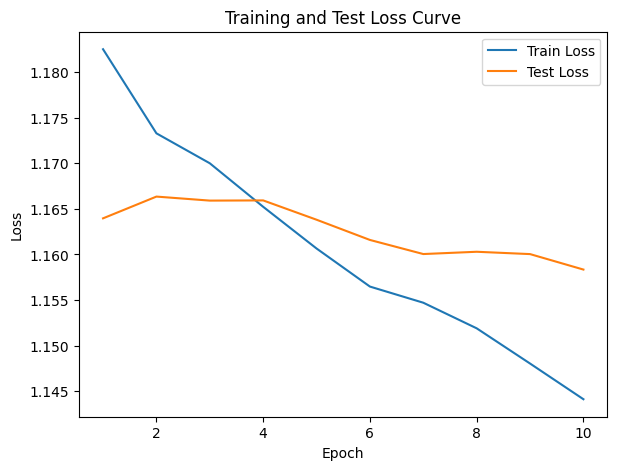

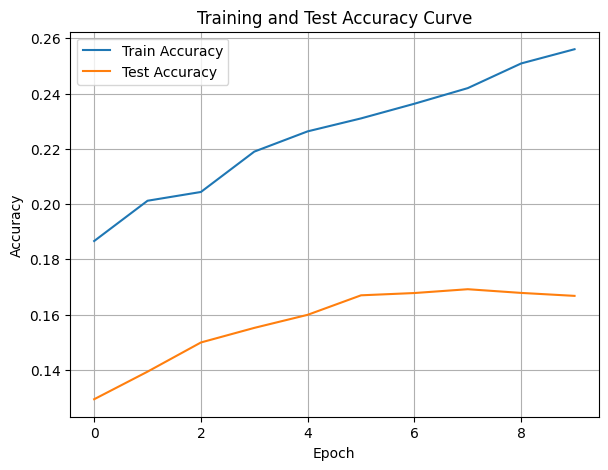

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.98it/s]

Epoch [1/10], Train F1:0.47091686674018707, Train Loss: 1.0390, Train Acc: 0.5006, Test F1:0.5577271190746219, Test Loss: 1.0474, Test Acc: 0.6250


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.20it/s]

Epoch [2/10], Train F1:0.48536772589070365, Train Loss: 1.0277, Train Acc: 0.5201, Test F1:0.5606738787785246, Test Loss: 1.0402, Test Acc: 0.6428
Epoch [3/10], Train F1:0.4878301090363807, Train Loss: 1.0290, Train Acc: 0.5237, Test F1:0.5634582780480614, Test Loss: 1.0339, Test Acc: 0.6481


Training Process:  30%|███       | 3/10 [00:00<00:00, 11.20it/s]

Epoch [4/10], Train F1:0.4934099549043674, Train Loss: 1.0237, Train Acc: 0.5326, Test F1:0.5634194181104936, Test Loss: 1.0308, Test Acc: 0.6513


Training Process:  50%|█████     | 5/10 [00:00<00:00, 11.64it/s]

Epoch [5/10], Train F1:0.4978392156853885, Train Loss: 1.0224, Train Acc: 0.5385, Test F1:0.5633656509695291, Test Loss: 1.0284, Test Acc: 0.6531


Training Process:  50%|█████     | 5/10 [00:00<00:00, 11.64it/s]

Epoch [6/10], Train F1:0.49307083462730866, Train Loss: 1.0229, Train Acc: 0.5350, Test F1:0.5670813465609064, Test Loss: 1.0271, Test Acc: 0.6600


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.05it/s]

Epoch [7/10], Train F1:0.49519851778471446, Train Loss: 1.0206, Train Acc: 0.5367, Test F1:0.5657286024284203, Test Loss: 1.0248, Test Acc: 0.6598


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.05it/s]

Epoch [8/10], Train F1:0.4969794153607133, Train Loss: 1.0184, Train Acc: 0.5369, Test F1:0.5711038842846835, Test Loss: 1.0222, Test Acc: 0.6634


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.98it/s]

Epoch [9/10], Train F1:0.5034057263252611, Train Loss: 1.0149, Train Acc: 0.5441, Test F1:0.5746183437858483, Test Loss: 1.0189, Test Acc: 0.6677


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.18it/s]


Epoch [10/10], Train F1:0.5090722713089526, Train Loss: 1.0114, Train Acc: 0.5497, Test F1:0.5757418308014852, Test Loss: 1.0169, Test Acc: 0.6704
Total Epochs: 10
Train loss start: 1.049219012260437, Train loss end: 1.0628933906555176
Highest Mean Train Accuracy (over epoch): 0.5497321428571428
Test loss start: 1.0384331941604614, Test loss end: 0.9897133708000183
Highest mean Test Accuracy (over epoch): 0.6703993055555555


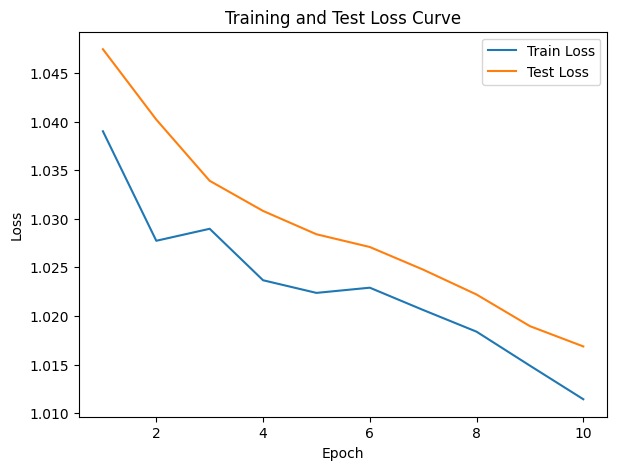

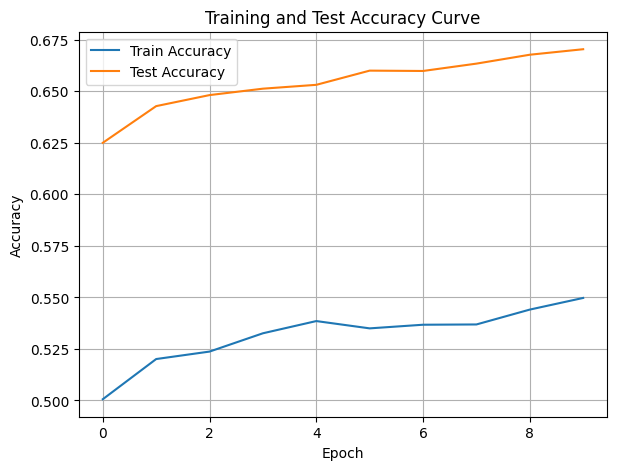

./saved_models/model_10.pth
Training Model with id 11
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.2274862543084918, Train Loss: 1.1287, Train Acc: 0.2702, Test F1:0.13649950564484606, Test Loss: 1.1271, Test Acc: 0.1510


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.27it/s]

Epoch [2/10], Train F1:0.21898750944150913, Train Loss: 1.1321, Train Acc: 0.2650, Test F1:0.15708861498919333, Test Loss: 1.1302, Test Acc: 0.1658
Epoch [3/10], Train F1:0.22120577645720466, Train Loss: 1.1295, Train Acc: 0.2646, Test F1:0.1527985363225638, Test Loss: 1.1284, Test Acc: 0.1687


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.20it/s]

Epoch [4/10], Train F1:0.22783578311814962, Train Loss: 1.1279, Train Acc: 0.2685, Test F1:0.15621510186099516, Test Loss: 1.1253, Test Acc: 0.1760
Epoch [5/10], Train F1:0.2314489042493815, Train Loss: 1.1240, Train Acc: 0.2735, Test F1:0.16497211684278354, Test Loss: 1.1246, Test Acc: 0.1812


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.65it/s]

Epoch [6/10], Train F1:0.23266333929642904, Train Loss: 1.1216, Train Acc: 0.2736, Test F1:0.1727386487499822, Test Loss: 1.1234, Test Acc: 0.1884
Epoch [7/10], Train F1:0.23641011528434328, Train Loss: 1.1188, Train Acc: 0.2765, Test F1:0.17520459834997243, Test Loss: 1.1223, Test Acc: 0.1892


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.05it/s]

Epoch [8/10], Train F1:0.2382973846715031, Train Loss: 1.1179, Train Acc: 0.2780, Test F1:0.18318689048290498, Test Loss: 1.1203, Test Acc: 0.1965
Epoch [9/10], Train F1:0.2426102209822006, Train Loss: 1.1149, Train Acc: 0.2827, Test F1:0.1841004861736123, Test Loss: 1.1184, Test Acc: 0.1997


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.10it/s]


Epoch [10/10], Train F1:0.24515397597263433, Train Loss: 1.1127, Train Acc: 0.2855, Test F1:0.1916642009546408, Test Loss: 1.1166, Test Acc: 0.2075
Total Epochs: 10
Train loss start: 1.1517173051834106, Train loss end: 1.102113962173462
Highest Mean Train Accuracy (over epoch): 0.28547619047619044
Test loss start: 1.11808180809021, Test loss end: 1.104440689086914
Highest mean Test Accuracy (over epoch): 0.20746527777777776


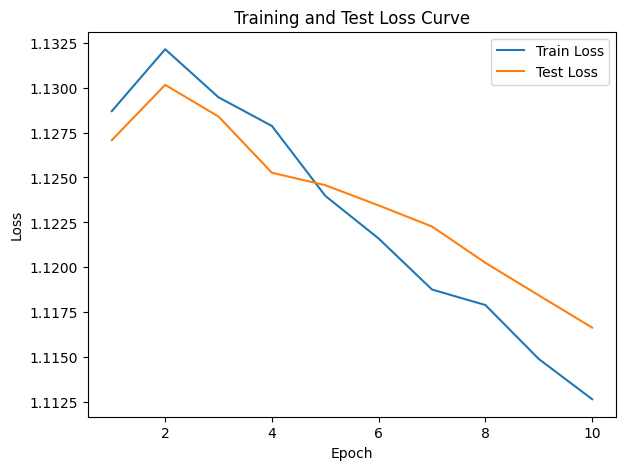

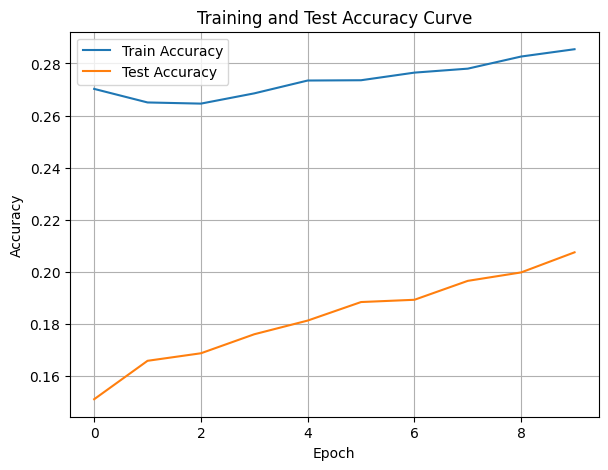

./saved_models/model_11.pth
Training Model with id 12
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.11it/s]

Epoch [1/10], Train F1:0.1668337889211711, Train Loss: 1.2152, Train Acc: 0.1033, Test F1:0.06769695858270955, Test Loss: 1.1470, Test Acc: 0.0434


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.90it/s]

Epoch [2/10], Train F1:0.16073736626679605, Train Loss: 1.2096, Train Acc: 0.1001, Test F1:0.058918303325019045, Test Loss: 1.1444, Test Acc: 0.0395
Epoch [3/10], Train F1:0.17736121548682654, Train Loss: 1.2054, Train Acc: 0.1109, Test F1:0.04514039920738485, Test Loss: 1.1453, Test Acc: 0.0289


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.90it/s]

Epoch [4/10], Train F1:0.1794806159709838, Train Loss: 1.2027, Train Acc: 0.1132, Test F1:0.04229447135625626, Test Loss: 1.1447, Test Acc: 0.0271


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.35it/s]

Epoch [5/10], Train F1:0.18596075079374946, Train Loss: 1.1993, Train Acc: 0.1168, Test F1:0.0440407950569493, Test Loss: 1.1427, Test Acc: 0.0276


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.35it/s]

Epoch [6/10], Train F1:0.1949372052744601, Train Loss: 1.1956, Train Acc: 0.1232, Test F1:0.04803489100296692, Test Loss: 1.1411, Test Acc: 0.0292


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.59it/s]

Epoch [7/10], Train F1:0.208807701086896, Train Loss: 1.1898, Train Acc: 0.1329, Test F1:0.06264909150053753, Test Loss: 1.1397, Test Acc: 0.0368


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.59it/s]

Epoch [8/10], Train F1:0.22075006254110732, Train Loss: 1.1868, Train Acc: 0.1430, Test F1:0.0632995327954214, Test Loss: 1.1381, Test Acc: 0.0369


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.52it/s]

Epoch [9/10], Train F1:0.22974167307513285, Train Loss: 1.1840, Train Acc: 0.1497, Test F1:0.07279885707894516, Test Loss: 1.1367, Test Acc: 0.0413


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.69it/s]


Epoch [10/10], Train F1:0.2409467267636727, Train Loss: 1.1812, Train Acc: 0.1585, Test F1:0.0787261555999476, Test Loss: 1.1349, Test Acc: 0.0446
Total Epochs: 10
Train loss start: 1.2261780500411987, Train loss end: 1.1506041288375854
Highest Mean Train Accuracy (over epoch): 0.15851190476190477
Test loss start: 1.1398330926895142, Test loss end: 1.1092151403427124
Highest mean Test Accuracy (over epoch): 0.04461805555555556


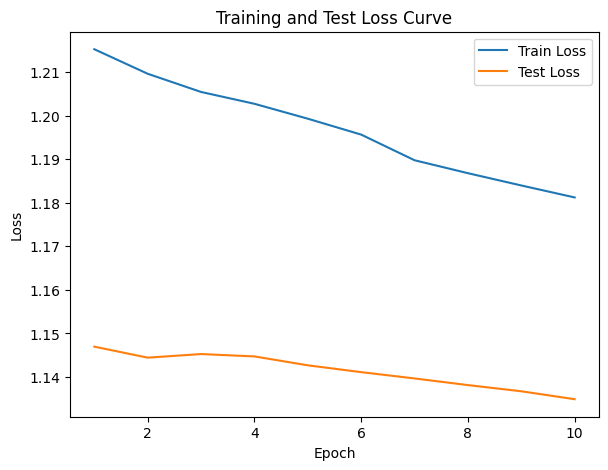

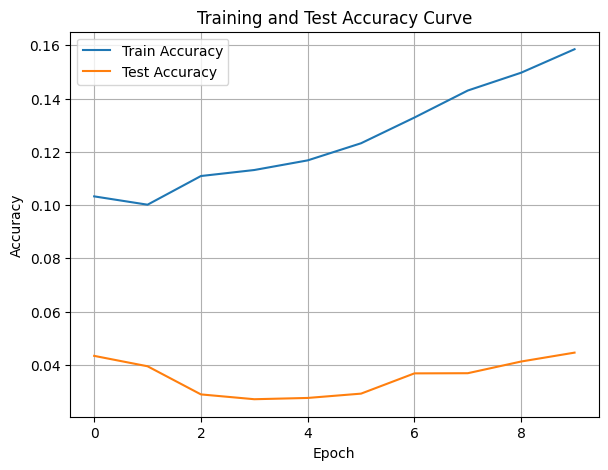

./saved_models/model_12.pth
Training Model with id 18
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.88it/s]

Epoch [1/10], Train F1:0.3393929109859486, Train Loss: 1.1423, Train Acc: 0.2345, Test F1:0.16116427432216907, Test Loss: 1.1198, Test Acc: 0.0903
Epoch [2/10], Train F1:0.3377562338228832, Train Loss: 1.1400, Train Acc: 0.2382, Test F1:0.16116427432216907, Test Loss: 1.1175, Test Acc: 0.0903
Epoch [3/10], Train F1:0.3556623692769262, Train Loss: 1.1353, Train Acc: 0.2568, Test F1:0.1899732214575806, Test Loss: 1.1147, Test Acc: 0.1059


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.34it/s]

Epoch [4/10], Train F1:0.3805175535678136, Train Loss: 1.1279, Train Acc: 0.2810, Test F1:0.2312171664037977, Test Loss: 1.1096, Test Acc: 0.1339
Epoch [5/10], Train F1:0.39021392275150824, Train Loss: 1.1241, Train Acc: 0.2926, Test F1:0.27623884272083715, Test Loss: 1.1048, Test Acc: 0.1696


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.21it/s]

Epoch [6/10], Train F1:0.3995637750901848, Train Loss: 1.1204, Train Acc: 0.3040, Test F1:0.28718806140054426, Test Loss: 1.1026, Test Acc: 0.1777
Epoch [7/10], Train F1:0.4059884223816565, Train Loss: 1.1177, Train Acc: 0.3079, Test F1:0.2963037823608534, Test Loss: 1.1012, Test Acc: 0.1845


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.67it/s]

Epoch [8/10], Train F1:0.4165825573270659, Train Loss: 1.1137, Train Acc: 0.3201, Test F1:0.3219809736775098, Test Loss: 1.0986, Test Acc: 0.2054
Epoch [9/10], Train F1:0.4309924505895907, Train Loss: 1.1094, Train Acc: 0.3331, Test F1:0.3428135556282009, Test Loss: 1.0962, Test Acc: 0.2225


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.96it/s]


Epoch [10/10], Train F1:0.439402586557675, Train Loss: 1.1067, Train Acc: 0.3404, Test F1:0.35600921653582546, Test Loss: 1.0946, Test Acc: 0.2326
Total Epochs: 10
Train loss start: 1.1265380382537842, Train loss end: 1.1346007585525513
Highest Mean Train Accuracy (over epoch): 0.34044642857142854
Test loss start: 1.1180988550186157, Test loss end: 1.0667496919631958
Highest mean Test Accuracy (over epoch): 0.2326388888888889


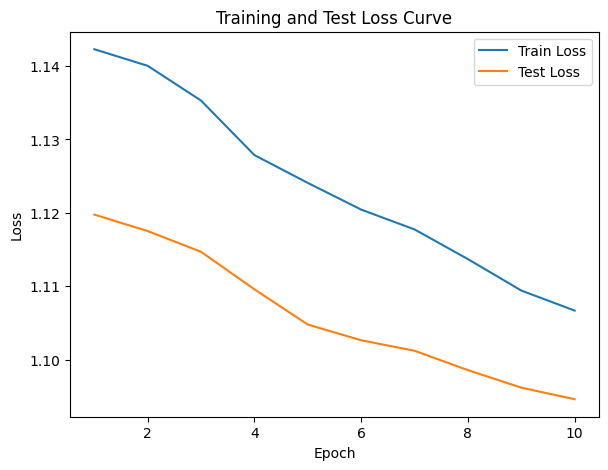

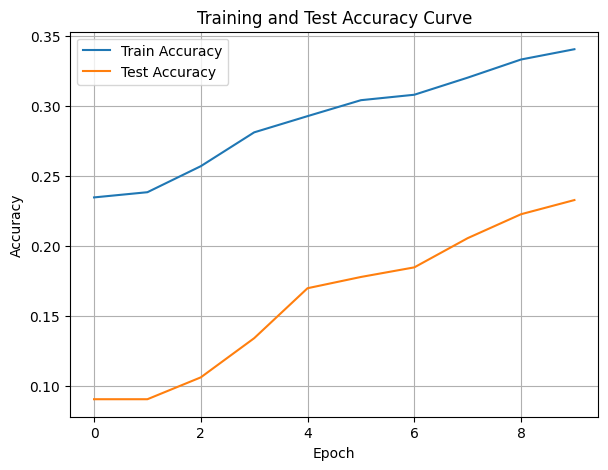

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.32it/s]

Epoch [1/10], Train F1:0.5151115484113471, Train Loss: 1.0557, Train Acc: 0.4360, Test F1:0.47749665168211525, Test Loss: 1.0780, Test Acc: 0.3455


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.56it/s]

Epoch [2/10], Train F1:0.538822958427339, Train Loss: 1.0557, Train Acc: 0.4546, Test F1:0.5839352869818433, Test Loss: 1.0713, Test Acc: 0.4609


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.56it/s]

Epoch [3/10], Train F1:0.5529937951852117, Train Loss: 1.0487, Train Acc: 0.4769, Test F1:0.6157442959777472, Test Loss: 1.0694, Test Acc: 0.5014


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.37it/s]

Epoch [4/10], Train F1:0.5644643205992307, Train Loss: 1.0486, Train Acc: 0.4853, Test F1:0.6413817484454604, Test Loss: 1.0680, Test Acc: 0.5295
Epoch [5/10], Train F1:0.5762069753664903, Train Loss: 1.0449, Train Acc: 0.4990, Test F1:0.6654003429626699, Test Loss: 1.0647, Test Acc: 0.5601


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.08it/s]

Epoch [6/10], Train F1:0.5913226159380005, Train Loss: 1.0396, Train Acc: 0.5151, Test F1:0.6791428213488266, Test Loss: 1.0622, Test Acc: 0.5802


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.00it/s]

Epoch [7/10], Train F1:0.6044578534353778, Train Loss: 1.0347, Train Acc: 0.5285, Test F1:0.6854325763281862, Test Loss: 1.0605, Test Acc: 0.5892


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.00it/s]

Epoch [8/10], Train F1:0.6088591678990607, Train Loss: 1.0326, Train Acc: 0.5331, Test F1:0.6966848113069143, Test Loss: 1.0588, Test Acc: 0.6028


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.06it/s]

Epoch [9/10], Train F1:0.6188452154122445, Train Loss: 1.0299, Train Acc: 0.5425, Test F1:0.7081457663451233, Test Loss: 1.0569, Test Acc: 0.6182


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.21it/s]


Epoch [10/10], Train F1:0.6251128704568856, Train Loss: 1.0272, Train Acc: 0.5491, Test F1:0.7200028403858408, Test Loss: 1.0538, Test Acc: 0.6358
Total Epochs: 10
Train loss start: 1.0530518293380737, Train loss end: 1.1187890768051147
Highest Mean Train Accuracy (over epoch): 0.5491369047619048
Test loss start: 1.0768409967422485, Test loss end: 1.005052924156189
Highest mean Test Accuracy (over epoch): 0.6357638888888889


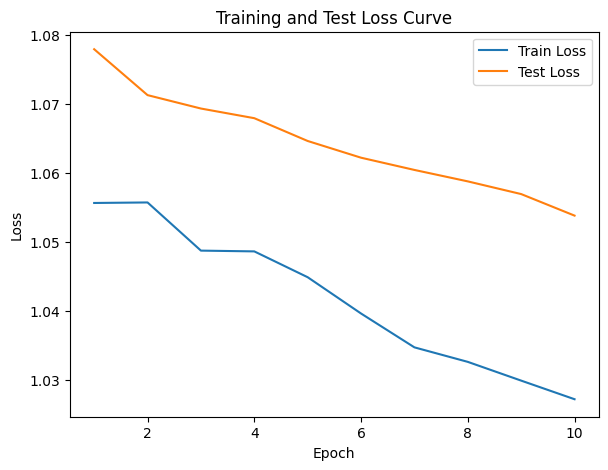

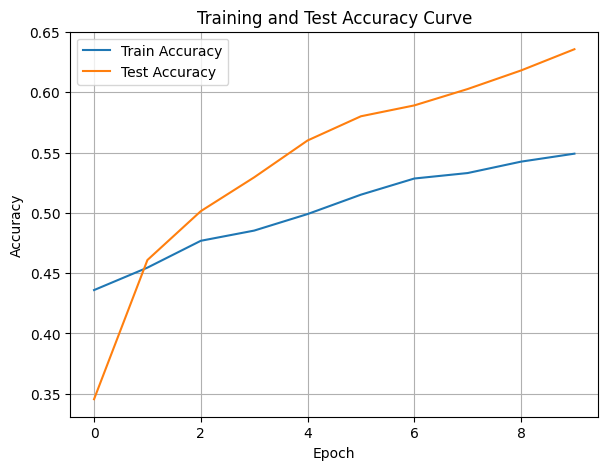

./saved_models/model_16.pth
Training Model with id 19
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.78it/s]

Epoch [1/10], Train F1:0.6829068785885396, Train Loss: 0.9956, Train Acc: 0.6551, Test F1:0.8437497207103342, Test Loss: 1.0359, Test Acc: 0.8099


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.78it/s]

Epoch [2/10], Train F1:0.6864020797056387, Train Loss: 0.9896, Train Acc: 0.6424, Test F1:0.8310320885853966, Test Loss: 1.0309, Test Acc: 0.7990


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.34it/s]

Epoch [3/10], Train F1:0.6970773689835909, Train Loss: 0.9824, Train Acc: 0.6486, Test F1:0.8339823918771287, Test Loss: 1.0304, Test Acc: 0.8027


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.34it/s]

Epoch [4/10], Train F1:0.7045658309987511, Train Loss: 0.9789, Train Acc: 0.6588, Test F1:0.8391035498723118, Test Loss: 1.0294, Test Acc: 0.8118


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.53it/s]

Epoch [5/10], Train F1:0.7116177612717826, Train Loss: 0.9747, Train Acc: 0.6674, Test F1:0.8432491706461867, Test Loss: 1.0261, Test Acc: 0.8217


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.75it/s]

Epoch [6/10], Train F1:0.719040594615535, Train Loss: 0.9710, Train Acc: 0.6736, Test F1:0.8470970839774673, Test Loss: 1.0235, Test Acc: 0.8296


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.04it/s]

Epoch [7/10], Train F1:0.7265281658677328, Train Loss: 0.9658, Train Acc: 0.6857, Test F1:0.8498207885304659, Test Loss: 1.0208, Test Acc: 0.8352


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.04it/s]

Epoch [8/10], Train F1:0.729426785411516, Train Loss: 0.9632, Train Acc: 0.6895, Test F1:0.8526638005093301, Test Loss: 1.0185, Test Acc: 0.8404


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.48it/s]

Epoch [9/10], Train F1:0.7324441765297883, Train Loss: 0.9596, Train Acc: 0.6937, Test F1:0.854140288828909, Test Loss: 1.0150, Test Acc: 0.8436


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.32it/s]


Epoch [10/10], Train F1:0.7337792383374241, Train Loss: 0.9573, Train Acc: 0.6953, Test F1:0.8513046054877513, Test Loss: 1.0118, Test Acc: 0.8431
Total Epochs: 10
Train loss start: 1.0107061862945557, Train loss end: 1.0234674215316772
Highest Mean Train Accuracy (over epoch): 0.6952976190476191
Test loss start: 1.036954641342163, Test loss end: 0.95717853307724
Highest mean Test Accuracy (over epoch): 0.8435570987654321


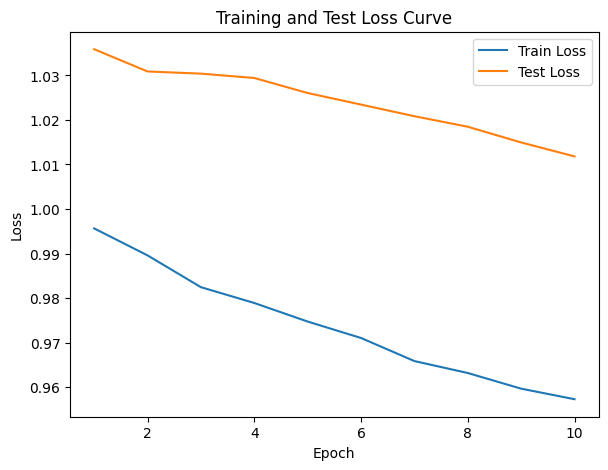

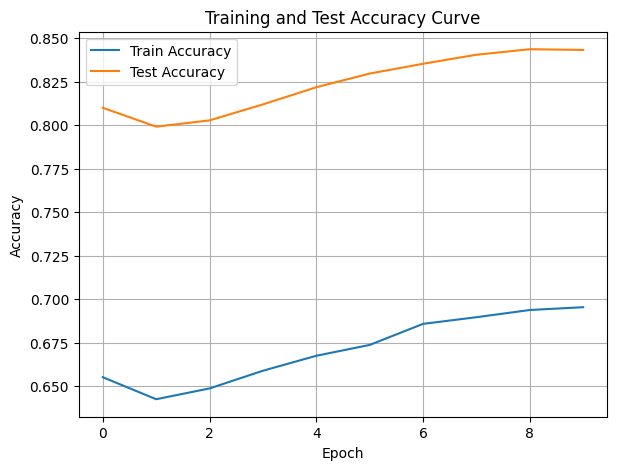

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7549464910997851, Train Loss: 0.9257, Train Acc: 0.7351, Test F1:0.8763754920230314, Test Loss: 0.9902, Test Acc: 0.8845


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.16it/s]

Epoch [2/10], Train F1:0.7638510530615713, Train Loss: 0.9180, Train Acc: 0.7445, Test F1:0.8486198139123019, Test Loss: 0.9884, Test Acc: 0.8620


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.16it/s]

Epoch [3/10], Train F1:0.7656332231454184, Train Loss: 0.9184, Train Acc: 0.7458, Test F1:0.8243081087033073, Test Loss: 0.9880, Test Acc: 0.8440


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.97it/s]

Epoch [4/10], Train F1:0.7744621919902819, Train Loss: 0.9143, Train Acc: 0.7575, Test F1:0.8257571015251527, Test Loss: 0.9868, Test Acc: 0.8448


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.97it/s]

Epoch [5/10], Train F1:0.7794425611671951, Train Loss: 0.9107, Train Acc: 0.7633, Test F1:0.8354878424130502, Test Loss: 0.9829, Test Acc: 0.8516


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.10it/s]

Epoch [6/10], Train F1:0.7783723329046446, Train Loss: 0.9081, Train Acc: 0.7617, Test F1:0.8432480468570694, Test Loss: 0.9798, Test Acc: 0.8584


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.50it/s]

Epoch [7/10], Train F1:0.7853999840149615, Train Loss: 0.9049, Train Acc: 0.7694, Test F1:0.8472733260079907, Test Loss: 0.9767, Test Acc: 0.8612


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.68it/s]

Epoch [8/10], Train F1:0.7884373699265099, Train Loss: 0.9019, Train Acc: 0.7736, Test F1:0.8489990276015666, Test Loss: 0.9742, Test Acc: 0.8624


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.69it/s]

Epoch [9/10], Train F1:0.7898749509398957, Train Loss: 0.8988, Train Acc: 0.7768, Test F1:0.8467181566452393, Test Loss: 0.9726, Test Acc: 0.8607


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.03it/s]


Epoch [10/10], Train F1:0.7912496273700287, Train Loss: 0.8964, Train Acc: 0.7792, Test F1:0.8448797947949052, Test Loss: 0.9692, Test Acc: 0.8594
Total Epochs: 10
Train loss start: 0.8898170590400696, Train loss end: 0.8578639030456543
Highest Mean Train Accuracy (over epoch): 0.7791666666666667
Test loss start: 0.9902923107147217, Test loss end: 0.90712571144104
Highest mean Test Accuracy (over epoch): 0.8845486111111112


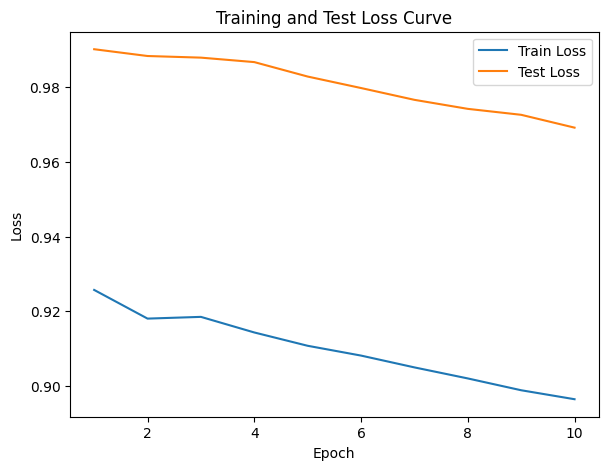

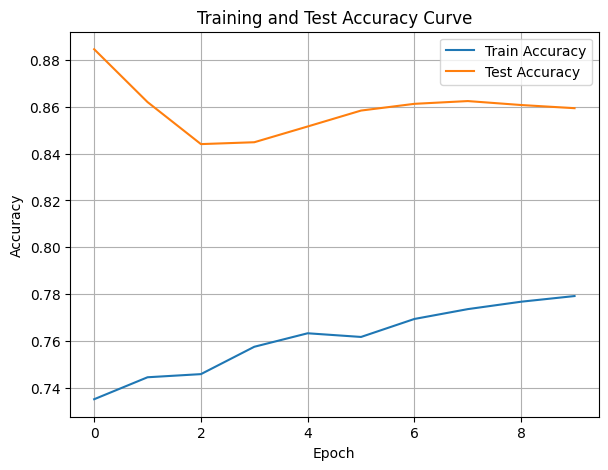

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.818515451745782, Train Loss: 0.8666, Train Acc: 0.8155, Test F1:0.8609681243992525, Test Loss: 0.9448, Test Acc: 0.8707


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.34it/s]

Epoch [2/10], Train F1:0.8254899927279062, Train Loss: 0.8641, Train Acc: 0.8159, Test F1:0.8499126532707418, Test Loss: 0.9453, Test Acc: 0.8628
Epoch [3/10], Train F1:0.8382502735208328, Train Loss: 0.8573, Train Acc: 0.8297, Test F1:0.8461371128823504, Test Loss: 0.9432, Test Acc: 0.8602


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.51it/s]

Epoch [4/10], Train F1:0.8369898632923133, Train Loss: 0.8557, Train Acc: 0.8298, Test F1:0.8550516632155843, Test Loss: 0.9428, Test Acc: 0.8683


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.51it/s]

Epoch [5/10], Train F1:0.8403971165681411, Train Loss: 0.8502, Train Acc: 0.8340, Test F1:0.8497241651696417, Test Loss: 0.9410, Test Acc: 0.8641


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.94it/s]

Epoch [6/10], Train F1:0.8424813669797782, Train Loss: 0.8487, Train Acc: 0.8347, Test F1:0.8464640983903056, Test Loss: 0.9382, Test Acc: 0.8613


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.94it/s]

Epoch [7/10], Train F1:0.8443579062134909, Train Loss: 0.8468, Train Acc: 0.8381, Test F1:0.8468191100934462, Test Loss: 0.9376, Test Acc: 0.8615


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.57it/s]

Epoch [8/10], Train F1:0.847462941763583, Train Loss: 0.8433, Train Acc: 0.8412, Test F1:0.8486215871883548, Test Loss: 0.9364, Test Acc: 0.8626


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.57it/s]

Epoch [9/10], Train F1:0.8458219902527968, Train Loss: 0.8421, Train Acc: 0.8400, Test F1:0.851160775752546, Test Loss: 0.9344, Test Acc: 0.8651


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.13it/s]


Epoch [10/10], Train F1:0.8448040001263654, Train Loss: 0.8405, Train Acc: 0.8391, Test F1:0.8531813620957857, Test Loss: 0.9328, Test Acc: 0.8664
Total Epochs: 10
Train loss start: 0.8441981673240662, Train loss end: 0.9133983254432678
Highest Mean Train Accuracy (over epoch): 0.8412202380952382
Test loss start: 0.9410301446914673, Test loss end: 0.890064001083374
Highest mean Test Accuracy (over epoch): 0.8706597222222222


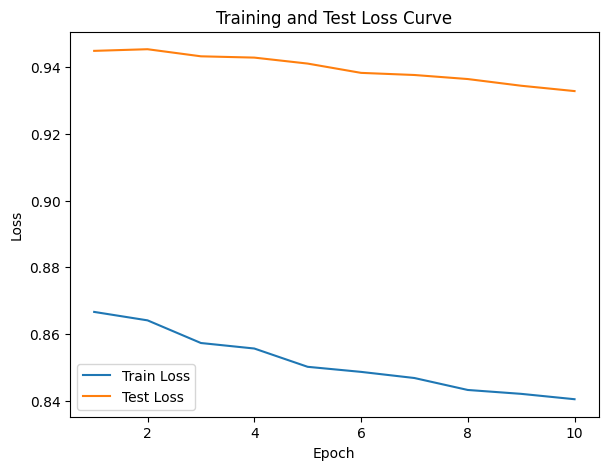

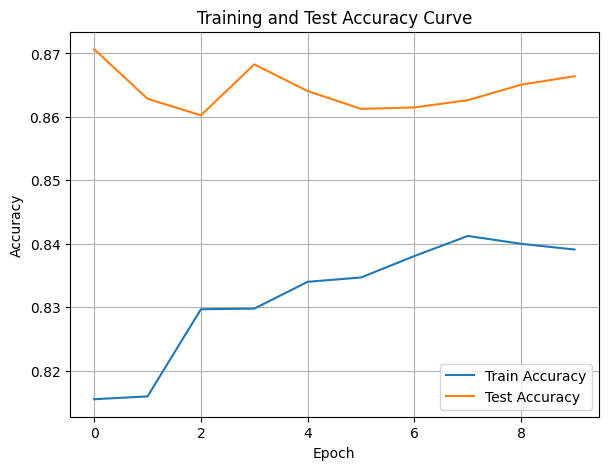

./saved_models/model_15.pth
Training Model with id 19
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8468700634209723, Train Loss: 0.8158, Train Acc: 0.8488, Test F1:0.8508279677870322, Test Loss: 0.9158, Test Acc: 0.8628


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.88it/s]

Epoch [2/10], Train F1:0.8594621168305379, Train Loss: 0.8128, Train Acc: 0.8582, Test F1:0.8559168819882523, Test Loss: 0.9114, Test Acc: 0.8668
Epoch [3/10], Train F1:0.8596413506184072, Train Loss: 0.8122, Train Acc: 0.8603, Test F1:0.8542248227936572, Test Loss: 0.9055, Test Acc: 0.8655


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.32it/s]

Epoch [4/10], Train F1:0.860538689013772, Train Loss: 0.8093, Train Acc: 0.8629, Test F1:0.8478042219626436, Test Loss: 0.9049, Test Acc: 0.8609
Epoch [5/10], Train F1:0.8589972239236244, Train Loss: 0.8069, Train Acc: 0.8620, Test F1:0.8459672692988827, Test Loss: 0.9036, Test Acc: 0.8597


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.42it/s]

Epoch [6/10], Train F1:0.8623837130164266, Train Loss: 0.8035, Train Acc: 0.8663, Test F1:0.8447329118614758, Test Loss: 0.9029, Test Acc: 0.8589
Epoch [7/10], Train F1:0.8606080848661493, Train Loss: 0.8026, Train Acc: 0.8619, Test F1:0.8438463815151607, Test Loss: 0.9006, Test Acc: 0.8584


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.86it/s]

Epoch [8/10], Train F1:0.8643673510107934, Train Loss: 0.8016, Train Acc: 0.8634, Test F1:0.8473279552509019, Test Loss: 0.8987, Test Acc: 0.8609
Epoch [9/10], Train F1:0.8625598705761941, Train Loss: 0.8010, Train Acc: 0.8604, Test F1:0.8498081641713929, Test Loss: 0.8964, Test Acc: 0.8628


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.81it/s]


Epoch [10/10], Train F1:0.861849453261833, Train Loss: 0.8001, Train Acc: 0.8591, Test F1:0.8519730726705218, Test Loss: 0.8941, Test Acc: 0.8644
Total Epochs: 10
Train loss start: 0.8053609728813171, Train loss end: 0.8476715087890625
Highest Mean Train Accuracy (over epoch): 0.8662698412698414
Test loss start: 0.9105534553527832, Test loss end: 0.8439673185348511
Highest mean Test Accuracy (over epoch): 0.8667534722222222


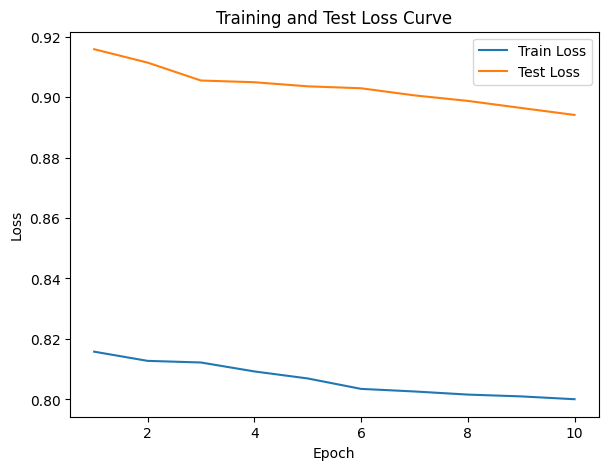

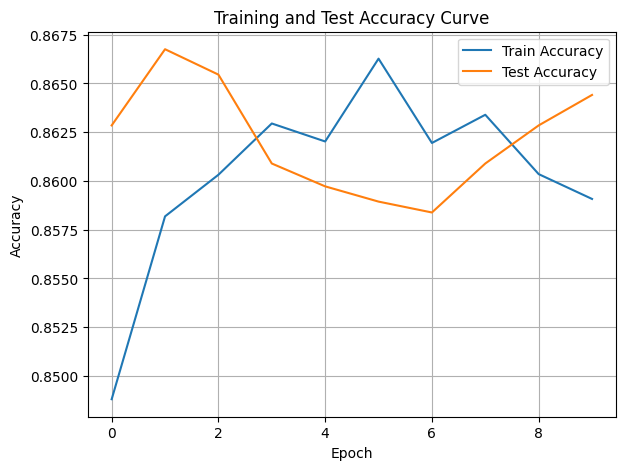

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8668625104268668, Train Loss: 0.7759, Train Acc: 0.8771, Test F1:0.8384395331763752, Test Loss: 0.8734, Test Acc: 0.8550


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.36it/s]

Epoch [2/10], Train F1:0.8553554708005879, Train Loss: 0.7766, Train Acc: 0.8656, Test F1:0.8331160226851115, Test Loss: 0.8758, Test Acc: 0.8511


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.36it/s]

Epoch [3/10], Train F1:0.8579114449879041, Train Loss: 0.7827, Train Acc: 0.8599, Test F1:0.8313311711907622, Test Loss: 0.8719, Test Acc: 0.8498


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.19it/s]

Epoch [4/10], Train F1:0.8561612749875563, Train Loss: 0.7851, Train Acc: 0.8539, Test F1:0.8331160226851115, Test Loss: 0.8713, Test Acc: 0.8511


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.19it/s]

Epoch [5/10], Train F1:0.8628753954567321, Train Loss: 0.7804, Train Acc: 0.8627, Test F1:0.840981740952022, Test Loss: 0.8688, Test Acc: 0.8566


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.83it/s]

Epoch [6/10], Train F1:0.8642791265581964, Train Loss: 0.7785, Train Acc: 0.8633, Test F1:0.8405603834795008, Test Loss: 0.8679, Test Acc: 0.8563


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.60it/s]

Epoch [7/10], Train F1:0.8669931908472279, Train Loss: 0.7755, Train Acc: 0.8653, Test F1:0.8447608059347907, Test Loss: 0.8667, Test Acc: 0.8595
Epoch [8/10], Train F1:0.8679600170194854, Train Loss: 0.7737, Train Acc: 0.8675, Test F1:0.8481402873780163, Test Loss: 0.8657, Test Acc: 0.8619


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.60it/s]

Epoch [9/10], Train F1:0.8680047629442429, Train Loss: 0.7718, Train Acc: 0.8680, Test F1:0.8507468370374928, Test Loss: 0.8642, Test Acc: 0.8637


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.64it/s]


Epoch [10/10], Train F1:0.8682183503558207, Train Loss: 0.7710, Train Acc: 0.8676, Test F1:0.8528185947353186, Test Loss: 0.8634, Test Acc: 0.8652
Total Epochs: 10
Train loss start: 0.7323904633522034, Train loss end: 0.776667058467865
Highest Mean Train Accuracy (over epoch): 0.8770833333333333
Test loss start: 0.8656129240989685, Test loss end: 0.8287978768348694
Highest mean Test Accuracy (over epoch): 0.8651909722222222


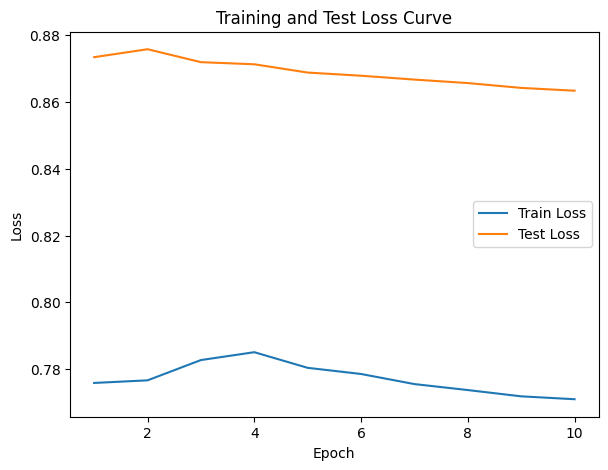

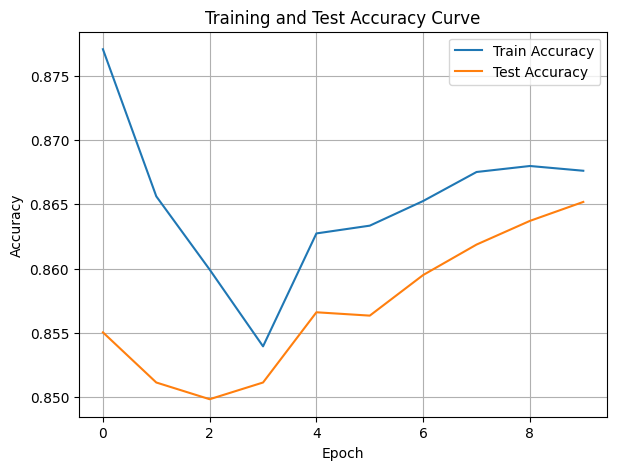

./saved_models/model_17.pth
Training Model with id 20
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.34it/s]

Epoch [1/10], Train F1:0.88956059588142, Train Loss: 0.7447, Train Acc: 0.8905, Test F1:0.8694744718136531, Test Loss: 0.8442, Test Acc: 0.8785
Epoch [2/10], Train F1:0.9045385780165759, Train Loss: 0.7420, Train Acc: 0.8993, Test F1:0.8541430384153257, Test Loss: 0.8394, Test Acc: 0.8668


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.34it/s]

Epoch [3/10], Train F1:0.890032925955048, Train Loss: 0.7445, Train Acc: 0.8898, Test F1:0.8489516474112109, Test Loss: 0.8365, Test Acc: 0.8628


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.29it/s]

Epoch [4/10], Train F1:0.8888940774092176, Train Loss: 0.7434, Train Acc: 0.8889, Test F1:0.8546028828560311, Test Loss: 0.8335, Test Acc: 0.8668
Epoch [5/10], Train F1:0.8881694857610877, Train Loss: 0.7425, Train Acc: 0.8899, Test F1:0.8575943483918944, Test Loss: 0.8315, Test Acc: 0.8691


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.05it/s]

Epoch [6/10], Train F1:0.8832352164037269, Train Loss: 0.7471, Train Acc: 0.8826, Test F1:0.8578772713772721, Test Loss: 0.8305, Test Acc: 0.8694
Epoch [7/10], Train F1:0.882513386361905, Train Loss: 0.7470, Train Acc: 0.8812, Test F1:0.8612445074719868, Test Loss: 0.8312, Test Acc: 0.8718


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.39it/s]

Epoch [8/10], Train F1:0.8840124935821577, Train Loss: 0.7442, Train Acc: 0.8838, Test F1:0.8584499977323188, Test Loss: 0.8308, Test Acc: 0.8697
Epoch [9/10], Train F1:0.8827255200674322, Train Loss: 0.7441, Train Acc: 0.8827, Test F1:0.8610014484563873, Test Loss: 0.8297, Test Acc: 0.8715


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.72it/s]


Epoch [10/10], Train F1:0.8820801436664172, Train Loss: 0.7433, Train Acc: 0.8822, Test F1:0.8630300435926368, Test Loss: 0.8285, Test Acc: 0.8730
Total Epochs: 10
Train loss start: 0.7431032061576843, Train loss end: 0.7264893651008606
Highest Mean Train Accuracy (over epoch): 0.8992559523809525
Test loss start: 0.8328860998153687, Test loss end: 0.7934643030166626
Highest mean Test Accuracy (over epoch): 0.8784722222222222


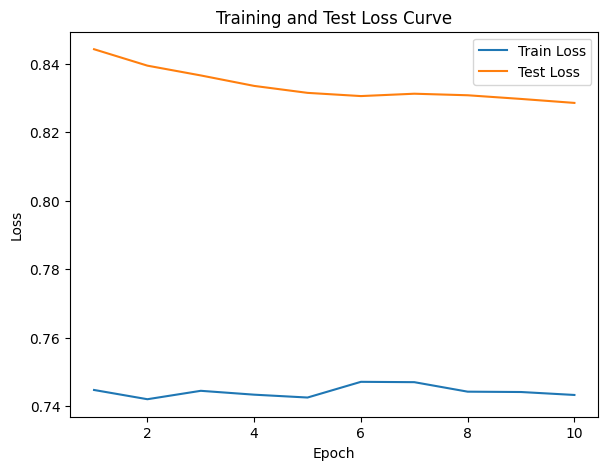

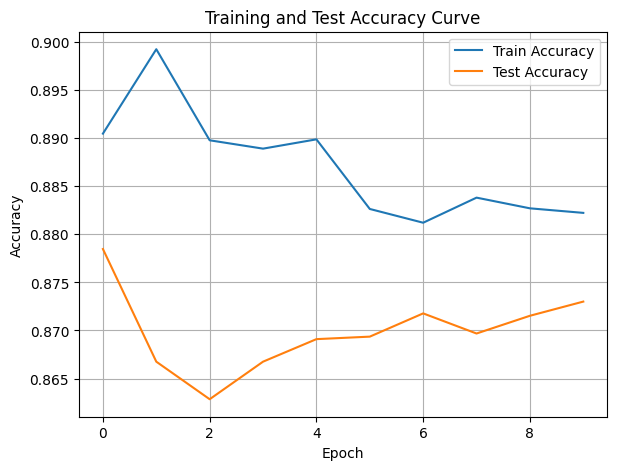

./saved_models/model_20.pth
Training Model with id 18
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8882240640715217, Train Loss: 0.7302, Train Acc: 0.8884, Test F1:0.8709623323013416, Test Loss: 0.8263, Test Acc: 0.8785


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.25it/s]

Epoch [2/10], Train F1:0.8926951015086608, Train Loss: 0.7296, Train Acc: 0.8851, Test F1:0.8820058579210205, Test Loss: 0.8283, Test Acc: 0.8863


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.89it/s]

Epoch [3/10], Train F1:0.9008637823617195, Train Loss: 0.7243, Train Acc: 0.8952, Test F1:0.8779754816906521, Test Loss: 0.8236, Test Acc: 0.8837


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.23it/s]

Epoch [4/10], Train F1:0.8965408055723348, Train Loss: 0.7253, Train Acc: 0.8906, Test F1:0.8759075915539942, Test Loss: 0.8196, Test Acc: 0.8824


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.23it/s]

Epoch [5/10], Train F1:0.894803935964526, Train Loss: 0.7240, Train Acc: 0.8902, Test F1:0.8749212211816091, Test Loss: 0.8173, Test Acc: 0.8816


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.74it/s]

Epoch [6/10], Train F1:0.8912776585529822, Train Loss: 0.7243, Train Acc: 0.8866, Test F1:0.8740346577227383, Test Loss: 0.8153, Test Acc: 0.8811


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.31it/s]

Epoch [7/10], Train F1:0.8934558076612535, Train Loss: 0.7230, Train Acc: 0.8892, Test F1:0.8748141540291406, Test Loss: 0.8141, Test Acc: 0.8818


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.41it/s]

Epoch [8/10], Train F1:0.8928245029917447, Train Loss: 0.7244, Train Acc: 0.8872, Test F1:0.8743323756361285, Test Loss: 0.8128, Test Acc: 0.8814


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.66it/s]

Epoch [9/10], Train F1:0.8892855363678218, Train Loss: 0.7263, Train Acc: 0.8829, Test F1:0.8738025434940134, Test Loss: 0.8112, Test Acc: 0.8811


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.49it/s]


Epoch [10/10], Train F1:0.8893742866856075, Train Loss: 0.7249, Train Acc: 0.8844, Test F1:0.8753646385933164, Test Loss: 0.8098, Test Acc: 0.8824
Total Epochs: 10
Train loss start: 0.7084947824478149, Train loss end: 0.6977244019508362
Highest Mean Train Accuracy (over epoch): 0.8952380952380952
Test loss start: 0.8140431046485901, Test loss end: 0.7719541788101196
Highest mean Test Accuracy (over epoch): 0.8862847222222222


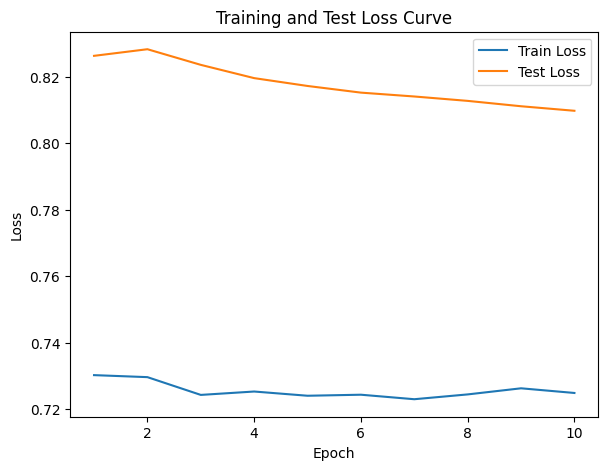

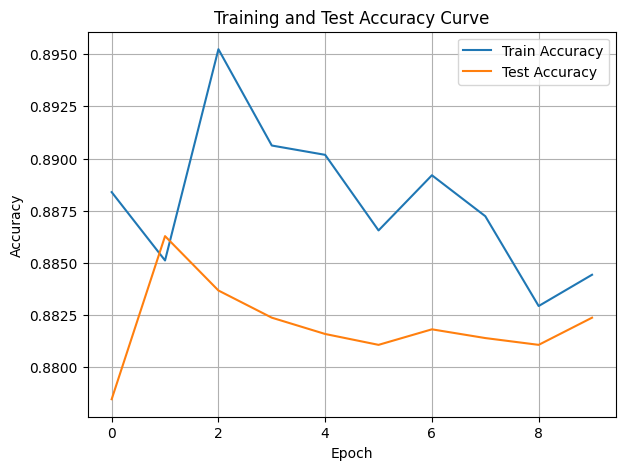

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8816176941972287, Train Loss: 0.7230, Train Acc: 0.8747, Test F1:0.8384395331763752, Test Loss: 0.7814, Test Acc: 0.8550


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.76it/s]

Epoch [2/10], Train F1:0.8916233581367973, Train Loss: 0.7188, Train Acc: 0.8878, Test F1:0.848951647411211, Test Loss: 0.7871, Test Acc: 0.8628


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.76it/s]

Epoch [3/10], Train F1:0.8946469217643302, Train Loss: 0.7195, Train Acc: 0.8890, Test F1:0.8524172307238872, Test Loss: 0.7836, Test Acc: 0.8655


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.86it/s]

Epoch [4/10], Train F1:0.8957717736703004, Train Loss: 0.7158, Train Acc: 0.8933, Test F1:0.8567231580046927, Test Loss: 0.7836, Test Acc: 0.8687


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.86it/s]

Epoch [5/10], Train F1:0.8960850544964553, Train Loss: 0.7146, Train Acc: 0.8940, Test F1:0.8510332465079145, Test Loss: 0.7833, Test Acc: 0.8644


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.09it/s]

Epoch [6/10], Train F1:0.8961797232432834, Train Loss: 0.7142, Train Acc: 0.8932, Test F1:0.8472117723899815, Test Loss: 0.7834, Test Acc: 0.8605


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.09it/s]

Epoch [7/10], Train F1:0.8960634202489952, Train Loss: 0.7128, Train Acc: 0.8945, Test F1:0.8504391951932421, Test Loss: 0.7828, Test Acc: 0.8631


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.29it/s]

Epoch [8/10], Train F1:0.8950852047324636, Train Loss: 0.7110, Train Acc: 0.8946, Test F1:0.8476471881641526, Test Loss: 0.7824, Test Acc: 0.8611


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.29it/s]

Epoch [9/10], Train F1:0.8947810943381878, Train Loss: 0.7106, Train Acc: 0.8944, Test F1:0.848951647411211, Test Loss: 0.7813, Test Acc: 0.8622


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.39it/s]


Epoch [10/10], Train F1:0.895947773196964, Train Loss: 0.7108, Train Acc: 0.8940, Test F1:0.8532954894255582, Test Loss: 0.7817, Test Acc: 0.8660
Total Epochs: 10
Train loss start: 0.794508695602417, Train loss end: 0.952604353427887
Highest Mean Train Accuracy (over epoch): 0.8946428571428572
Test loss start: 0.7624141573905945, Test loss end: 0.7661213874816895
Highest mean Test Accuracy (over epoch): 0.8687065972222222


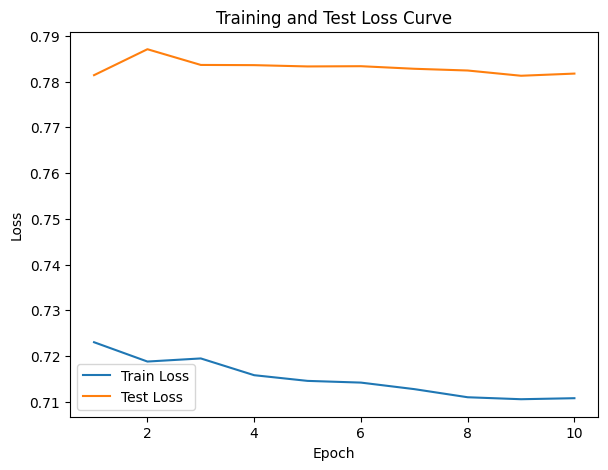

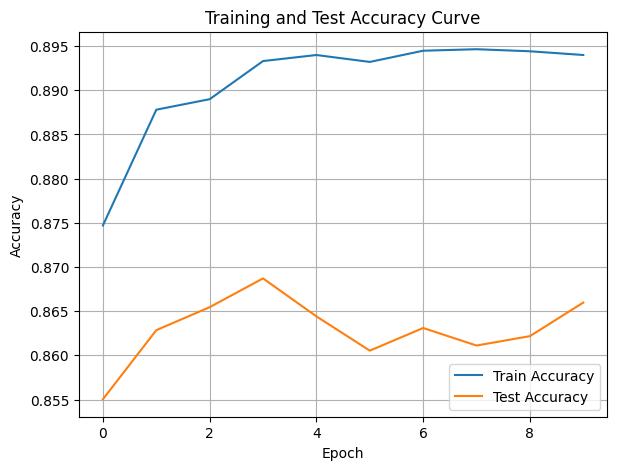

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.9110157008299711, Train Loss: 0.6851, Train Acc: 0.9018, Test F1:0.8893962848297212, Test Loss: 0.7733, Test Acc: 0.8941


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.57it/s]

Epoch [2/10], Train F1:0.9062657839055355, Train Loss: 0.6895, Train Acc: 0.9013, Test F1:0.8745082520542844, Test Loss: 0.7727, Test Acc: 0.8824


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.40it/s]

Epoch [3/10], Train F1:0.9040074751533894, Train Loss: 0.6914, Train Acc: 0.9030, Test F1:0.8766502551106825, Test Loss: 0.7748, Test Acc: 0.8837


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.72it/s]

Epoch [4/10], Train F1:0.9035749563901709, Train Loss: 0.6921, Train Acc: 0.9025, Test F1:0.877706640602, Test Loss: 0.7751, Test Acc: 0.8843


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.48it/s]

Epoch [5/10], Train F1:0.8999836356574082, Train Loss: 0.6935, Train Acc: 0.8992, Test F1:0.8760801012549444, Test Loss: 0.7732, Test Acc: 0.8832


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.33it/s]

Epoch [6/10], Train F1:0.8976681859924835, Train Loss: 0.6936, Train Acc: 0.8971, Test F1:0.874990340377358, Test Loss: 0.7710, Test Acc: 0.8824


Training Process:  70%|███████   | 7/10 [00:00<00:00,  7.58it/s]

Epoch [7/10], Train F1:0.8996529496210405, Train Loss: 0.6931, Train Acc: 0.8977, Test F1:0.8742092554088473, Test Loss: 0.7689, Test Acc: 0.8818


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.19it/s]

Epoch [8/10], Train F1:0.8996937001656798, Train Loss: 0.6915, Train Acc: 0.8988, Test F1:0.8736219586545301, Test Loss: 0.7666, Test Acc: 0.8814


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.53it/s]

Epoch [9/10], Train F1:0.8979462290287032, Train Loss: 0.6914, Train Acc: 0.8972, Test F1:0.8709352242830996, Test Loss: 0.7661, Test Acc: 0.8793


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.95it/s]


Epoch [10/10], Train F1:0.8983315455525868, Train Loss: 0.6909, Train Acc: 0.8976, Test F1:0.8719433276583832, Test Loss: 0.7657, Test Acc: 0.8800
Total Epochs: 10
Train loss start: 0.6767895817756653, Train loss end: 0.72982257604599
Highest Mean Train Accuracy (over epoch): 0.9029761904761904
Test loss start: 0.7544835209846497, Test loss end: 0.7449066042900085
Highest mean Test Accuracy (over epoch): 0.8940972222222222


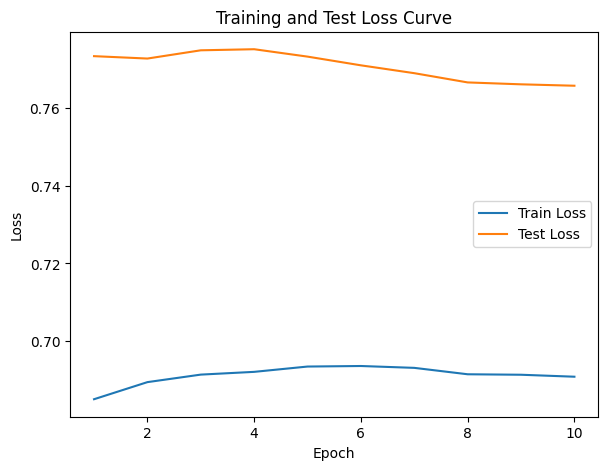

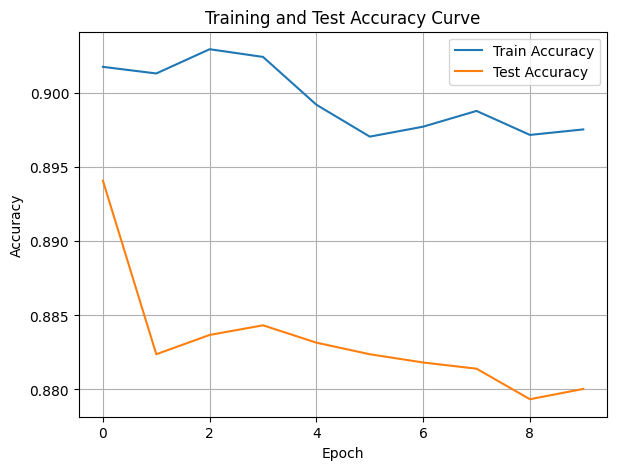

./saved_models/model_14.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [87]:
DTEmlp12b.train_DTE()

Training Process:   1%|          | 2/230 [00:00<00:29,  7.66it/s]

Epoch [1/230], Train F1:0.38950614565352765, Train Loss: 1.0979, Train Acc: 0.3253, Test F1:0.1810699588477366, Test Loss: 1.1174, Test Acc: 0.1155
Epoch [2/230], Train F1:0.4238295535929409, Train Loss: 1.0962, Train Acc: 0.3677, Test F1:0.24460604315165477, Test Loss: 1.1117, Test Acc: 0.1567


Training Process:   2%|▏         | 4/230 [00:00<00:25,  8.99it/s]

Epoch [3/230], Train F1:0.4316244908328902, Train Loss: 1.0912, Train Acc: 0.3727, Test F1:0.25281589186975223, Test Loss: 1.1111, Test Acc: 0.1626
Epoch [4/230], Train F1:0.440520767384093, Train Loss: 1.0872, Train Acc: 0.3807, Test F1:0.2949929037678201, Test Loss: 1.1080, Test Acc: 0.1886


Training Process:   3%|▎         | 6/230 [00:00<00:23,  9.50it/s]

Epoch [5/230], Train F1:0.44738538088784446, Train Loss: 1.0835, Train Acc: 0.3876, Test F1:0.31227443706300373, Test Loss: 1.1061, Test Acc: 0.2010
Epoch [6/230], Train F1:0.4565705240312082, Train Loss: 1.0794, Train Acc: 0.3971, Test F1:0.3316257193194061, Test Loss: 1.1041, Test Acc: 0.2172


Training Process:   3%|▎         | 7/230 [00:00<00:23,  9.60it/s]

Epoch [7/230], Train F1:0.46269738914767927, Train Loss: 1.0772, Train Acc: 0.4006, Test F1:0.34277954547558265, Test Loss: 1.1031, Test Acc: 0.2236
Epoch [8/230], Train F1:0.4691400539516684, Train Loss: 1.0750, Train Acc: 0.4058, Test F1:0.3722875375815568, Test Loss: 1.1009, Test Acc: 0.2510


Training Process:   4%|▍         | 10/230 [00:01<00:22,  9.75it/s]

Epoch [9/230], Train F1:0.48274925424010656, Train Loss: 1.0714, Train Acc: 0.4181, Test F1:0.4004741331328138, Test Loss: 1.0989, Test Acc: 0.2738
Epoch [10/230], Train F1:0.49193383568320675, Train Loss: 1.0679, Train Acc: 0.4285, Test F1:0.44074702886247874, Test Loss: 1.0960, Test Acc: 0.3068


Training Process:   5%|▌         | 12/230 [00:01<00:23,  9.43it/s]

Epoch [11/230], Train F1:0.5012002652967403, Train Loss: 1.0642, Train Acc: 0.4378, Test F1:0.4701194641388254, Test Loss: 1.0939, Test Acc: 0.3334
Epoch [12/230], Train F1:0.5146198268736322, Train Loss: 1.0602, Train Acc: 0.4504, Test F1:0.4922187822497419, Test Loss: 1.0918, Test Acc: 0.3538


Training Process:   6%|▌         | 14/230 [00:01<00:23,  9.06it/s]

Epoch [13/230], Train F1:0.5260272813148509, Train Loss: 1.0566, Train Acc: 0.4615, Test F1:0.5126800714766192, Test Loss: 1.0891, Test Acc: 0.3747
Epoch [14/230], Train F1:0.5348277397829535, Train Loss: 1.0528, Train Acc: 0.4709, Test F1:0.5282555415470936, Test Loss: 1.0867, Test Acc: 0.3919


Training Process:   7%|▋         | 16/230 [00:01<00:27,  7.80it/s]

Epoch [15/230], Train F1:0.5419193701734151, Train Loss: 1.0495, Train Acc: 0.4788, Test F1:0.5451188557027582, Test Loss: 1.0847, Test Acc: 0.4090
Epoch [16/230], Train F1:0.551677723290359, Train Loss: 1.0463, Train Acc: 0.4889, Test F1:0.563750850783968, Test Loss: 1.0820, Test Acc: 0.4295


Training Process:   8%|▊         | 18/230 [00:02<00:27,  7.75it/s]

Epoch [17/230], Train F1:0.5589494795843735, Train Loss: 1.0426, Train Acc: 0.4983, Test F1:0.5805826576928907, Test Loss: 1.0794, Test Acc: 0.4485
Epoch [18/230], Train F1:0.5672191993815112, Train Loss: 1.0391, Train Acc: 0.5068, Test F1:0.593998484969573, Test Loss: 1.0771, Test Acc: 0.4642


Training Process:   9%|▊         | 20/230 [00:02<00:27,  7.72it/s]

Epoch [19/230], Train F1:0.5744895293384469, Train Loss: 1.0354, Train Acc: 0.5155, Test F1:0.6070899083366611, Test Loss: 1.0748, Test Acc: 0.4799
Epoch [20/230], Train F1:0.583204761217498, Train Loss: 1.0318, Train Acc: 0.5242, Test F1:0.6193219826935112, Test Loss: 1.0722, Test Acc: 0.4947


Training Process:  10%|▉         | 22/230 [00:02<00:27,  7.48it/s]

Epoch [21/230], Train F1:0.5916893461671555, Train Loss: 1.0281, Train Acc: 0.5336, Test F1:0.6296418409837468, Test Loss: 1.0703, Test Acc: 0.5077
Epoch [22/230], Train F1:0.5992728228769543, Train Loss: 1.0244, Train Acc: 0.5425, Test F1:0.6391666968062899, Test Loss: 1.0680, Test Acc: 0.5199


Training Process:  10%|█         | 24/230 [00:02<00:28,  7.28it/s]

Epoch [23/230], Train F1:0.6049957052181857, Train Loss: 1.0212, Train Acc: 0.5488, Test F1:0.648754406866037, Test Loss: 1.0657, Test Acc: 0.5323
Epoch [24/230], Train F1:0.6115469091377512, Train Loss: 1.0177, Train Acc: 0.5564, Test F1:0.6576733748250764, Test Loss: 1.0633, Test Acc: 0.5440


Training Process:  11%|█▏        | 26/230 [00:03<00:28,  7.27it/s]

Epoch [25/230], Train F1:0.6168918654832707, Train Loss: 1.0148, Train Acc: 0.5623, Test F1:0.6655755985572578, Test Loss: 1.0610, Test Acc: 0.5548
Epoch [26/230], Train F1:0.6237889076825612, Train Loss: 1.0113, Train Acc: 0.5703, Test F1:0.6723349970545258, Test Loss: 1.0588, Test Acc: 0.5642


Training Process:  12%|█▏        | 28/230 [00:03<00:31,  6.48it/s]

Epoch [27/230], Train F1:0.6302675584398203, Train Loss: 1.0079, Train Acc: 0.5777, Test F1:0.6780561682885378, Test Loss: 1.0563, Test Acc: 0.5726
Epoch [28/230], Train F1:0.6348096892168263, Train Loss: 1.0046, Train Acc: 0.5836, Test F1:0.684715249735045, Test Loss: 1.0541, Test Acc: 0.5818


Training Process:  13%|█▎        | 29/230 [00:03<00:41,  4.89it/s]

Epoch [29/230], Train F1:0.6393457016778519, Train Loss: 1.0018, Train Acc: 0.5889, Test F1:0.6905045935566286, Test Loss: 1.0523, Test Acc: 0.5905


Training Process:  13%|█▎        | 30/230 [00:04<00:41,  4.76it/s]

Epoch [30/230], Train F1:0.6441378906174051, Train Loss: 0.9987, Train Acc: 0.5948, Test F1:0.6963637237225485, Test Loss: 1.0506, Test Acc: 0.5986


Training Process:  14%|█▍        | 32/230 [00:04<00:38,  5.14it/s]

Epoch [31/230], Train F1:0.6488133479417528, Train Loss: 0.9959, Train Acc: 0.6002, Test F1:0.7017939477546521, Test Loss: 1.0487, Test Acc: 0.6060
Epoch [32/230], Train F1:0.6533464596144475, Train Loss: 0.9931, Train Acc: 0.6050, Test F1:0.706993009716644, Test Loss: 1.0469, Test Acc: 0.6134


Training Process:  15%|█▍        | 34/230 [00:04<00:35,  5.47it/s]

Epoch [33/230], Train F1:0.657158977174474, Train Loss: 0.9905, Train Acc: 0.6098, Test F1:0.711834230011279, Test Loss: 1.0450, Test Acc: 0.6204
Epoch [34/230], Train F1:0.6617784528431347, Train Loss: 0.9871, Train Acc: 0.6155, Test F1:0.7160009422317128, Test Loss: 1.0430, Test Acc: 0.6267


Training Process:  16%|█▌        | 36/230 [00:05<00:34,  5.69it/s]

Epoch [35/230], Train F1:0.665689224984152, Train Loss: 0.9844, Train Acc: 0.6204, Test F1:0.7207793448503134, Test Loss: 1.0413, Test Acc: 0.6337
Epoch [36/230], Train F1:0.6699623680277169, Train Loss: 0.9812, Train Acc: 0.6256, Test F1:0.7249981791226426, Test Loss: 1.0394, Test Acc: 0.6400


Training Process:  17%|█▋        | 38/230 [00:05<00:33,  5.76it/s]

Epoch [37/230], Train F1:0.6743945150238891, Train Loss: 0.9783, Train Acc: 0.6307, Test F1:0.7292156970527803, Test Loss: 1.0372, Test Acc: 0.6463
Epoch [38/230], Train F1:0.6782176478079642, Train Loss: 0.9756, Train Acc: 0.6350, Test F1:0.731785711150816, Test Loss: 1.0354, Test Acc: 0.6505


Training Process:  17%|█▋        | 40/230 [00:05<00:31,  5.95it/s]

Epoch [39/230], Train F1:0.6813248979849472, Train Loss: 0.9730, Train Acc: 0.6386, Test F1:0.7350672162702239, Test Loss: 1.0335, Test Acc: 0.6554
Epoch [40/230], Train F1:0.6857495555067535, Train Loss: 0.9700, Train Acc: 0.6440, Test F1:0.7378698740503575, Test Loss: 1.0314, Test Acc: 0.6600


Training Process:  18%|█▊        | 42/230 [00:06<00:32,  5.85it/s]

Epoch [41/230], Train F1:0.6888999573819536, Train Loss: 0.9672, Train Acc: 0.6480, Test F1:0.7414250114206756, Test Loss: 1.0292, Test Acc: 0.6654
Epoch [42/230], Train F1:0.6920089151944009, Train Loss: 0.9646, Train Acc: 0.6519, Test F1:0.7447924032779748, Test Loss: 1.0273, Test Acc: 0.6704


Training Process:  19%|█▊        | 43/230 [00:06<00:31,  5.84it/s]

Epoch [43/230], Train F1:0.6954466987866291, Train Loss: 0.9619, Train Acc: 0.6557, Test F1:0.7476420859672577, Test Loss: 1.0254, Test Acc: 0.6748


Training Process:  19%|█▉        | 44/230 [00:06<00:35,  5.18it/s]

Epoch [44/230], Train F1:0.6981994637471213, Train Loss: 0.9593, Train Acc: 0.6594, Test F1:0.7500578368999422, Test Loss: 1.0235, Test Acc: 0.6787


Training Process:  20%|█▉        | 45/230 [00:06<00:35,  5.18it/s]

Epoch [45/230], Train F1:0.7011689874898104, Train Loss: 0.9566, Train Acc: 0.6630, Test F1:0.7527634454602085, Test Loss: 1.0216, Test Acc: 0.6829


Training Process:  20%|██        | 46/230 [00:06<00:35,  5.16it/s]

Epoch [46/230], Train F1:0.7038526674920973, Train Loss: 0.9543, Train Acc: 0.6659, Test F1:0.7551706762879249, Test Loss: 1.0198, Test Acc: 0.6867


Training Process:  20%|██        | 47/230 [00:07<00:35,  5.10it/s]

Epoch [47/230], Train F1:0.7065746958939214, Train Loss: 0.9521, Train Acc: 0.6691, Test F1:0.7578257309374489, Test Loss: 1.0178, Test Acc: 0.6907


Training Process:  21%|██        | 48/230 [00:07<00:35,  5.06it/s]

Epoch [48/230], Train F1:0.7100095979370061, Train Loss: 0.9491, Train Acc: 0.6733, Test F1:0.76035986047494, Test Loss: 1.0158, Test Acc: 0.6946


Training Process:  21%|██▏       | 49/230 [00:07<00:35,  5.04it/s]

Epoch [49/230], Train F1:0.7128136874643197, Train Loss: 0.9463, Train Acc: 0.6768, Test F1:0.7625666155409563, Test Loss: 1.0139, Test Acc: 0.6982


Training Process:  22%|██▏       | 50/230 [00:07<00:36,  4.97it/s]

Epoch [50/230], Train F1:0.7156290585453254, Train Loss: 0.9439, Train Acc: 0.6804, Test F1:0.7646767227157101, Test Loss: 1.0120, Test Acc: 0.7017


Training Process:  22%|██▏       | 51/230 [00:07<00:36,  4.95it/s]

Epoch [51/230], Train F1:0.7183160178082539, Train Loss: 0.9413, Train Acc: 0.6835, Test F1:0.7666964152505299, Test Loss: 1.0102, Test Acc: 0.7049


Epoch [52/230], Train F1:0.7203997646909889, Train Loss: 0.9390, Train Acc: 0.6863, Test F1:0.7688333732095118, Test Loss: 1.0084, Test Acc: 0.7082


Training Process:  23%|██▎       | 54/230 [00:08<00:33,  5.20it/s]

Epoch [53/230], Train F1:0.7229458107141251, Train Loss: 0.9364, Train Acc: 0.6896, Test F1:0.7708830558107399, Test Loss: 1.0065, Test Acc: 0.7114
Epoch [54/230], Train F1:0.7253114660821002, Train Loss: 0.9341, Train Acc: 0.6924, Test F1:0.7726833939892358, Test Loss: 1.0046, Test Acc: 0.7143


Training Process:  24%|██▍       | 55/230 [00:08<00:37,  4.73it/s]

Epoch [55/230], Train F1:0.726809479316522, Train Loss: 0.9318, Train Acc: 0.6946, Test F1:0.774413076036686, Test Loss: 1.0029, Test Acc: 0.7170


Training Process:  24%|██▍       | 56/230 [00:08<00:35,  4.86it/s]

Epoch [56/230], Train F1:0.7290300940288005, Train Loss: 0.9295, Train Acc: 0.6974, Test F1:0.776076187075802, Test Loss: 1.0011, Test Acc: 0.7196


Training Process:  25%|██▍       | 57/230 [00:09<00:34,  5.01it/s]

Epoch [57/230], Train F1:0.7313513587152688, Train Loss: 0.9273, Train Acc: 0.7000, Test F1:0.7778601168932924, Test Loss: 0.9995, Test Acc: 0.7223


Training Process:  25%|██▌       | 58/230 [00:09<00:33,  5.09it/s]

Epoch [58/230], Train F1:0.7331899650593868, Train Loss: 0.9253, Train Acc: 0.7023, Test F1:0.7793978580533479, Test Loss: 0.9978, Test Acc: 0.7248


Training Process:  26%|██▌       | 59/230 [00:09<00:36,  4.72it/s]

Epoch [59/230], Train F1:0.7356010801647539, Train Loss: 0.9231, Train Acc: 0.7049, Test F1:0.7810567876782593, Test Loss: 0.9963, Test Acc: 0.7273


Training Process:  26%|██▌       | 60/230 [00:09<00:36,  4.68it/s]

Epoch [60/230], Train F1:0.7377827003615076, Train Loss: 0.9209, Train Acc: 0.7077, Test F1:0.7826566296094387, Test Loss: 0.9946, Test Acc: 0.7297


Training Process:  27%|██▋       | 61/230 [00:10<00:35,  4.75it/s]

Epoch [61/230], Train F1:0.7394521535882687, Train Loss: 0.9190, Train Acc: 0.7096, Test F1:0.7842004877507113, Test Loss: 0.9929, Test Acc: 0.7320


Training Process:  27%|██▋       | 62/230 [00:10<00:34,  4.80it/s]

Epoch [62/230], Train F1:0.741811538692579, Train Loss: 0.9166, Train Acc: 0.7124, Test F1:0.7856674684259078, Test Loss: 0.9910, Test Acc: 0.7344


Training Process:  27%|██▋       | 63/230 [00:10<00:35,  4.71it/s]

Epoch [63/230], Train F1:0.7440534203132577, Train Loss: 0.9145, Train Acc: 0.7150, Test F1:0.7871082027594257, Test Loss: 0.9895, Test Acc: 0.7366


Training Process:  28%|██▊       | 64/230 [00:10<00:35,  4.73it/s]

Epoch [64/230], Train F1:0.7457934276383212, Train Loss: 0.9125, Train Acc: 0.7172, Test F1:0.7885010423531069, Test Loss: 0.9879, Test Acc: 0.7387


Training Process:  28%|██▊       | 65/230 [00:10<00:35,  4.69it/s]

Epoch [65/230], Train F1:0.7476529908074715, Train Loss: 0.9104, Train Acc: 0.7195, Test F1:0.7898483379006456, Test Loss: 0.9862, Test Acc: 0.7408


Training Process:  29%|██▊       | 66/230 [00:11<00:35,  4.62it/s]

Epoch [66/230], Train F1:0.749431651123753, Train Loss: 0.9084, Train Acc: 0.7217, Test F1:0.7911298701720252, Test Loss: 0.9845, Test Acc: 0.7428


Training Process:  29%|██▉       | 67/230 [00:11<00:40,  4.06it/s]

Epoch [67/230], Train F1:0.7509113921563018, Train Loss: 0.9066, Train Acc: 0.7236, Test F1:0.7923707317761526, Test Loss: 0.9828, Test Acc: 0.7449


Training Process:  30%|██▉       | 68/230 [00:11<00:39,  4.05it/s]

Epoch [68/230], Train F1:0.7523985005457848, Train Loss: 0.9048, Train Acc: 0.7254, Test F1:0.7935728317503518, Test Loss: 0.9812, Test Acc: 0.7468


Training Process:  30%|███       | 69/230 [00:11<00:40,  4.02it/s]

Epoch [69/230], Train F1:0.7540947480128181, Train Loss: 0.9028, Train Acc: 0.7274, Test F1:0.7947379613119695, Test Loss: 0.9795, Test Acc: 0.7487


Training Process:  30%|███       | 70/230 [00:12<00:40,  3.97it/s]

Epoch [70/230], Train F1:0.7557687763155703, Train Loss: 0.9009, Train Acc: 0.7294, Test F1:0.7958678028225269, Test Loss: 0.9780, Test Acc: 0.7506


Training Process:  31%|███       | 71/230 [00:12<00:38,  4.15it/s]

Epoch [71/230], Train F1:0.7573281089592484, Train Loss: 0.8991, Train Acc: 0.7312, Test F1:0.7969849985117463, Test Loss: 0.9764, Test Acc: 0.7523


Training Process:  31%|███▏      | 72/230 [00:12<00:36,  4.31it/s]

Epoch [72/230], Train F1:0.7588084186243387, Train Loss: 0.8974, Train Acc: 0.7328, Test F1:0.7980486605600549, Test Loss: 0.9746, Test Acc: 0.7541


Training Process:  32%|███▏      | 73/230 [00:12<00:35,  4.42it/s]

Epoch [73/230], Train F1:0.76035979989859, Train Loss: 0.8954, Train Acc: 0.7348, Test F1:0.7990815117846667, Test Loss: 0.9730, Test Acc: 0.7558


Training Process:  32%|███▏      | 74/230 [00:13<00:35,  4.43it/s]

Epoch [74/230], Train F1:0.7618584649722008, Train Loss: 0.8935, Train Acc: 0.7364, Test F1:0.8000848737063709, Test Loss: 0.9714, Test Acc: 0.7574


Training Process:  33%|███▎      | 75/230 [00:13<00:34,  4.45it/s]

Epoch [75/230], Train F1:0.7633442755213131, Train Loss: 0.8917, Train Acc: 0.7382, Test F1:0.8010800271372309, Test Loss: 0.9699, Test Acc: 0.7590


Training Process:  33%|███▎      | 76/230 [00:13<00:34,  4.46it/s]

Epoch [76/230], Train F1:0.7646141409873496, Train Loss: 0.8900, Train Acc: 0.7398, Test F1:0.8021641746630387, Test Loss: 0.9684, Test Acc: 0.7606


Training Process:  33%|███▎      | 77/230 [00:13<00:34,  4.45it/s]

Epoch [77/230], Train F1:0.7658314847227963, Train Loss: 0.8883, Train Acc: 0.7414, Test F1:0.8031037412002507, Test Loss: 0.9669, Test Acc: 0.7621


Training Process:  34%|███▍      | 78/230 [00:13<00:37,  4.03it/s]

Epoch [78/230], Train F1:0.7671826834086131, Train Loss: 0.8866, Train Acc: 0.7430, Test F1:0.8040371924918776, Test Loss: 0.9655, Test Acc: 0.7635


Training Process:  34%|███▍      | 79/230 [00:14<00:37,  4.01it/s]

Epoch [79/230], Train F1:0.7684986041486622, Train Loss: 0.8848, Train Acc: 0.7446, Test F1:0.8049079061337433, Test Loss: 0.9640, Test Acc: 0.7650


Training Process:  35%|███▍      | 80/230 [00:14<00:37,  4.00it/s]

Epoch [80/230], Train F1:0.7698463885693505, Train Loss: 0.8830, Train Acc: 0.7463, Test F1:0.8058849694615977, Test Loss: 0.9625, Test Acc: 0.7665


Training Process:  35%|███▌      | 81/230 [00:14<00:37,  3.92it/s]

Epoch [81/230], Train F1:0.7709838563361273, Train Loss: 0.8815, Train Acc: 0.7475, Test F1:0.8067091519331898, Test Loss: 0.9608, Test Acc: 0.7679


Training Process:  36%|███▌      | 82/230 [00:15<00:38,  3.89it/s]

Epoch [82/230], Train F1:0.772044393509262, Train Loss: 0.8799, Train Acc: 0.7487, Test F1:0.8075122160294229, Test Loss: 0.9591, Test Acc: 0.7692


Training Process:  36%|███▌      | 83/230 [00:15<00:38,  3.84it/s]

Epoch [83/230], Train F1:0.773050752972781, Train Loss: 0.8785, Train Acc: 0.7498, Test F1:0.8080459713247046, Test Loss: 0.9576, Test Acc: 0.7703


Training Process:  37%|███▋      | 84/230 [00:15<00:38,  3.80it/s]

Epoch [84/230], Train F1:0.7742280021015397, Train Loss: 0.8770, Train Acc: 0.7513, Test F1:0.8088301654076294, Test Loss: 0.9561, Test Acc: 0.7715


Training Process:  37%|███▋      | 85/230 [00:15<00:38,  3.76it/s]

Epoch [85/230], Train F1:0.7754161206019092, Train Loss: 0.8756, Train Acc: 0.7525, Test F1:0.8097165114815013, Test Loss: 0.9547, Test Acc: 0.7728


Training Process:  37%|███▋      | 86/230 [00:16<00:38,  3.70it/s]

Epoch [86/230], Train F1:0.7766099251906956, Train Loss: 0.8743, Train Acc: 0.7537, Test F1:0.810581296425585, Test Loss: 0.9535, Test Acc: 0.7740


Training Process:  38%|███▊      | 87/230 [00:16<00:37,  3.83it/s]

Epoch [87/230], Train F1:0.7776497351025331, Train Loss: 0.8728, Train Acc: 0.7550, Test F1:0.8114252975585666, Test Loss: 0.9522, Test Acc: 0.7752


Training Process:  38%|███▊      | 88/230 [00:16<00:36,  3.90it/s]

Epoch [88/230], Train F1:0.7786120210552505, Train Loss: 0.8712, Train Acc: 0.7562, Test F1:0.8122492552762504, Test Loss: 0.9509, Test Acc: 0.7764


Training Process:  39%|███▊      | 89/230 [00:16<00:40,  3.48it/s]

Epoch [89/230], Train F1:0.779776149148295, Train Loss: 0.8696, Train Acc: 0.7577, Test F1:0.8129213197662366, Test Loss: 0.9496, Test Acc: 0.7776


Training Process:  39%|███▉      | 90/230 [00:17<00:39,  3.51it/s]

Epoch [90/230], Train F1:0.7810484224277328, Train Loss: 0.8681, Train Acc: 0.7591, Test F1:0.8136922093227589, Test Loss: 0.9482, Test Acc: 0.7788


Training Process:  40%|███▉      | 91/230 [00:17<00:39,  3.56it/s]

Epoch [91/230], Train F1:0.7822320126473962, Train Loss: 0.8666, Train Acc: 0.7603, Test F1:0.814332293135262, Test Loss: 0.9469, Test Acc: 0.7799


Training Process:  40%|████      | 92/230 [00:17<00:38,  3.61it/s]

Epoch [92/230], Train F1:0.783268259289557, Train Loss: 0.8650, Train Acc: 0.7616, Test F1:0.815069736539834, Test Loss: 0.9455, Test Acc: 0.7810


Training Process:  40%|████      | 93/230 [00:18<00:37,  3.66it/s]

Epoch [93/230], Train F1:0.7842901333813108, Train Loss: 0.8636, Train Acc: 0.7628, Test F1:0.8158067696755721, Test Loss: 0.9442, Test Acc: 0.7821


Training Process:  41%|████      | 94/230 [00:18<00:37,  3.64it/s]

Epoch [94/230], Train F1:0.7854476631778768, Train Loss: 0.8620, Train Acc: 0.7642, Test F1:0.8164180619201076, Test Loss: 0.9428, Test Acc: 0.7831


Training Process:  41%|████▏     | 95/230 [00:18<00:37,  3.64it/s]

Epoch [95/230], Train F1:0.7865330340114179, Train Loss: 0.8605, Train Acc: 0.7655, Test F1:0.817000199558946, Test Loss: 0.9414, Test Acc: 0.7841


Training Process:  42%|████▏     | 96/230 [00:18<00:37,  3.59it/s]

Epoch [96/230], Train F1:0.7875017604762559, Train Loss: 0.8592, Train Acc: 0.7665, Test F1:0.8175696880405604, Test Loss: 0.9400, Test Acc: 0.7850


Training Process:  42%|████▏     | 97/230 [00:19<00:37,  3.57it/s]

Epoch [97/230], Train F1:0.7886131033835513, Train Loss: 0.8577, Train Acc: 0.7678, Test F1:0.8181269356182903, Test Loss: 0.9387, Test Acc: 0.7860


Training Process:  43%|████▎     | 98/230 [00:19<00:37,  3.53it/s]

Epoch [98/230], Train F1:0.7895638821434959, Train Loss: 0.8563, Train Acc: 0.7689, Test F1:0.8187772012553413, Test Loss: 0.9374, Test Acc: 0.7870


Training Process:  43%|████▎     | 99/230 [00:19<00:41,  3.16it/s]

Epoch [99/230], Train F1:0.7905167305624176, Train Loss: 0.8550, Train Acc: 0.7701, Test F1:0.8194138258226091, Test Loss: 0.9361, Test Acc: 0.7880


Training Process:  43%|████▎     | 100/230 [00:20<00:41,  3.12it/s]

Epoch [100/230], Train F1:0.791727300426122, Train Loss: 0.8534, Train Acc: 0.7716, Test F1:0.8201548808772343, Test Loss: 0.9350, Test Acc: 0.7890


Training Process:  44%|████▍     | 101/230 [00:20<00:39,  3.23it/s]

Epoch [101/230], Train F1:0.7926217325684961, Train Loss: 0.8522, Train Acc: 0.7727, Test F1:0.8207642805149958, Test Loss: 0.9337, Test Acc: 0.7900


Training Process:  44%|████▍     | 102/230 [00:20<00:38,  3.35it/s]

Epoch [102/230], Train F1:0.7933394969724918, Train Loss: 0.8509, Train Acc: 0.7736, Test F1:0.8212606818357772, Test Loss: 0.9325, Test Acc: 0.7909


Training Process:  45%|████▍     | 103/230 [00:21<00:37,  3.42it/s]

Epoch [103/230], Train F1:0.7941320514500555, Train Loss: 0.8496, Train Acc: 0.7747, Test F1:0.8218611715465343, Test Loss: 0.9313, Test Acc: 0.7917


Training Process:  45%|████▌     | 104/230 [00:21<00:35,  3.51it/s]

Epoch [104/230], Train F1:0.795014047935781, Train Loss: 0.8484, Train Acc: 0.7757, Test F1:0.8224353378856021, Test Loss: 0.9299, Test Acc: 0.7926


Training Process:  46%|████▌     | 105/230 [00:21<00:35,  3.50it/s]

Epoch [105/230], Train F1:0.7959700000661989, Train Loss: 0.8471, Train Acc: 0.7768, Test F1:0.8229981735462744, Test Loss: 0.9287, Test Acc: 0.7935


Training Process:  46%|████▌     | 106/230 [00:21<00:35,  3.52it/s]

Epoch [106/230], Train F1:0.7969719819353541, Train Loss: 0.8458, Train Acc: 0.7780, Test F1:0.8235500108106806, Test Loss: 0.9275, Test Acc: 0.7944


Training Process:  47%|████▋     | 107/230 [00:22<00:35,  3.51it/s]

Epoch [107/230], Train F1:0.7978073054131053, Train Loss: 0.8447, Train Acc: 0.7790, Test F1:0.8240911690882144, Test Loss: 0.9262, Test Acc: 0.7953


Training Process:  47%|████▋     | 108/230 [00:22<00:35,  3.46it/s]

Epoch [108/230], Train F1:0.7986556244477666, Train Loss: 0.8434, Train Acc: 0.7800, Test F1:0.8245270935712269, Test Loss: 0.9249, Test Acc: 0.7960


Training Process:  47%|████▋     | 109/230 [00:22<00:35,  3.40it/s]

Epoch [109/230], Train F1:0.7993093213756459, Train Loss: 0.8422, Train Acc: 0.7809, Test F1:0.825062364204306, Test Loss: 0.9238, Test Acc: 0.7968


Training Process:  48%|████▊     | 110/230 [00:23<00:39,  3.05it/s]

Epoch [110/230], Train F1:0.8003674298755521, Train Loss: 0.8408, Train Acc: 0.7821, Test F1:0.8256671048715547, Test Loss: 0.9227, Test Acc: 0.7977


Training Process:  48%|████▊     | 111/230 [00:23<00:39,  3.04it/s]

Epoch [111/230], Train F1:0.8012534803029403, Train Loss: 0.8396, Train Acc: 0.7831, Test F1:0.8262739438510823, Test Loss: 0.9216, Test Acc: 0.7985


Training Process:  49%|████▊     | 112/230 [00:23<00:38,  3.04it/s]

Epoch [112/230], Train F1:0.8021285202390064, Train Loss: 0.8384, Train Acc: 0.7841, Test F1:0.8267649957925938, Test Loss: 0.9203, Test Acc: 0.7993


Training Process:  49%|████▉     | 113/230 [00:24<00:38,  3.01it/s]

Epoch [113/230], Train F1:0.8029292029138415, Train Loss: 0.8372, Train Acc: 0.7850, Test F1:0.8273375696767832, Test Loss: 0.9192, Test Acc: 0.8001


Training Process:  50%|████▉     | 114/230 [00:24<00:37,  3.12it/s]

Epoch [114/230], Train F1:0.8036182033903504, Train Loss: 0.8361, Train Acc: 0.7859, Test F1:0.8278100904869399, Test Loss: 0.9180, Test Acc: 0.8009


Training Process:  50%|█████     | 115/230 [00:24<00:35,  3.21it/s]

Epoch [115/230], Train F1:0.8044305223278789, Train Loss: 0.8351, Train Acc: 0.7867, Test F1:0.8282741246386748, Test Loss: 0.9168, Test Acc: 0.8016


Training Process:  50%|█████     | 116/230 [00:25<00:34,  3.27it/s]

Epoch [116/230], Train F1:0.805107671301226, Train Loss: 0.8340, Train Acc: 0.7876, Test F1:0.8287298988267738, Test Loss: 0.9156, Test Acc: 0.8024


Training Process:  51%|█████     | 117/230 [00:25<00:34,  3.27it/s]

Epoch [117/230], Train F1:0.8060145219535656, Train Loss: 0.8328, Train Acc: 0.7887, Test F1:0.8291776317401263, Test Loss: 0.9143, Test Acc: 0.8031


Training Process:  51%|█████▏    | 118/230 [00:25<00:34,  3.28it/s]

Epoch [118/230], Train F1:0.8066086062109702, Train Loss: 0.8318, Train Acc: 0.7893, Test F1:0.8296175344121862, Test Loss: 0.9132, Test Acc: 0.8038


Training Process:  52%|█████▏    | 119/230 [00:25<00:33,  3.29it/s]

Epoch [119/230], Train F1:0.8073774142304876, Train Loss: 0.8306, Train Acc: 0.7902, Test F1:0.830135630521324, Test Loss: 0.9121, Test Acc: 0.8045


Training Process:  52%|█████▏    | 120/230 [00:26<00:34,  3.23it/s]

Epoch [120/230], Train F1:0.8081235615489557, Train Loss: 0.8295, Train Acc: 0.7912, Test F1:0.8305720260054035, Test Loss: 0.9110, Test Acc: 0.8052


Training Process:  53%|█████▎    | 121/230 [00:26<00:37,  2.94it/s]

Epoch [121/230], Train F1:0.8087638493082414, Train Loss: 0.8284, Train Acc: 0.7920, Test F1:0.8309888073319558, Test Loss: 0.9099, Test Acc: 0.8058


Training Process:  53%|█████▎    | 122/230 [00:27<00:36,  2.93it/s]

Epoch [122/230], Train F1:0.8095307927832033, Train Loss: 0.8274, Train Acc: 0.7928, Test F1:0.8314106062613189, Test Loss: 0.9088, Test Acc: 0.8064


Training Process:  53%|█████▎    | 123/230 [00:27<00:37,  2.89it/s]

Epoch [123/230], Train F1:0.8102422936314849, Train Loss: 0.8265, Train Acc: 0.7936, Test F1:0.8318253244120033, Test Loss: 0.9077, Test Acc: 0.8070


Training Process:  54%|█████▍    | 124/230 [00:27<00:36,  2.87it/s]

Epoch [124/230], Train F1:0.8110190883546646, Train Loss: 0.8253, Train Acc: 0.7946, Test F1:0.8322213037567846, Test Loss: 0.9066, Test Acc: 0.8077


Training Process:  54%|█████▍    | 125/230 [00:28<00:36,  2.84it/s]

Epoch [125/230], Train F1:0.8116150815896513, Train Loss: 0.8244, Train Acc: 0.7954, Test F1:0.8326923179892646, Test Loss: 0.9055, Test Acc: 0.8084


Training Process:  55%|█████▍    | 126/230 [00:28<00:35,  2.92it/s]

Epoch [126/230], Train F1:0.8123991868950737, Train Loss: 0.8232, Train Acc: 0.7963, Test F1:0.8331556343468588, Test Loss: 0.9046, Test Acc: 0.8091


Training Process:  55%|█████▌    | 127/230 [00:28<00:34,  3.01it/s]

Epoch [127/230], Train F1:0.8131646339057431, Train Loss: 0.8223, Train Acc: 0.7971, Test F1:0.8334509718804523, Test Loss: 0.9034, Test Acc: 0.8096


Training Process:  56%|█████▌    | 128/230 [00:29<00:32,  3.10it/s]

Epoch [128/230], Train F1:0.8140091886902935, Train Loss: 0.8212, Train Acc: 0.7980, Test F1:0.8338211485633825, Test Loss: 0.9023, Test Acc: 0.8102


Training Process:  56%|█████▌    | 129/230 [00:29<00:32,  3.11it/s]

Epoch [129/230], Train F1:0.8146805931564987, Train Loss: 0.8203, Train Acc: 0.7986, Test F1:0.834106443055493, Test Loss: 0.9012, Test Acc: 0.8107


Training Process:  57%|█████▋    | 130/230 [00:29<00:31,  3.13it/s]

Epoch [130/230], Train F1:0.8151754014412116, Train Loss: 0.8194, Train Acc: 0.7993, Test F1:0.8345439257674151, Test Loss: 0.9001, Test Acc: 0.8114


Training Process:  57%|█████▋    | 131/230 [00:30<00:34,  2.86it/s]

Epoch [131/230], Train F1:0.815582312929956, Train Loss: 0.8185, Train Acc: 0.7999, Test F1:0.8349079716669606, Test Loss: 0.8992, Test Acc: 0.8119


Training Process:  57%|█████▋    | 132/230 [00:30<00:34,  2.85it/s]

Epoch [132/230], Train F1:0.8161701892871508, Train Loss: 0.8175, Train Acc: 0.8006, Test F1:0.835266334466683, Test Loss: 0.8983, Test Acc: 0.8124


Training Process:  58%|█████▊    | 133/230 [00:30<00:34,  2.85it/s]

Epoch [133/230], Train F1:0.8168397626766887, Train Loss: 0.8166, Train Acc: 0.8013, Test F1:0.8357612058015127, Test Loss: 0.8974, Test Acc: 0.8131


Training Process:  58%|█████▊    | 134/230 [00:31<00:34,  2.81it/s]

Epoch [134/230], Train F1:0.8176182576214557, Train Loss: 0.8156, Train Acc: 0.8022, Test F1:0.836096632651456, Test Loss: 0.8964, Test Acc: 0.8136


Training Process:  59%|█████▊    | 135/230 [00:31<00:34,  2.78it/s]

Epoch [135/230], Train F1:0.8181199686942944, Train Loss: 0.8146, Train Acc: 0.8028, Test F1:0.8364269528613275, Test Loss: 0.8954, Test Acc: 0.8142


Training Process:  59%|█████▉    | 136/230 [00:31<00:34,  2.74it/s]

Epoch [136/230], Train F1:0.8186942890509937, Train Loss: 0.8137, Train Acc: 0.8035, Test F1:0.8367522822067063, Test Loss: 0.8943, Test Acc: 0.8147


Training Process:  60%|█████▉    | 137/230 [00:32<00:33,  2.76it/s]

Epoch [137/230], Train F1:0.819343877568326, Train Loss: 0.8127, Train Acc: 0.8043, Test F1:0.8370727329885285, Test Loss: 0.8933, Test Acc: 0.8152


Training Process:  60%|██████    | 138/230 [00:32<00:32,  2.82it/s]

Epoch [138/230], Train F1:0.8199162954428477, Train Loss: 0.8119, Train Acc: 0.8048, Test F1:0.8374620927156882, Test Loss: 0.8924, Test Acc: 0.8158


Training Process:  60%|██████    | 139/230 [00:32<00:31,  2.89it/s]

Epoch [139/230], Train F1:0.8204971644471502, Train Loss: 0.8110, Train Acc: 0.8055, Test F1:0.8377830263624667, Test Loss: 0.8915, Test Acc: 0.8163


Training Process:  61%|██████    | 140/230 [00:33<00:30,  2.93it/s]

Epoch [140/230], Train F1:0.8210973855471254, Train Loss: 0.8101, Train Acc: 0.8062, Test F1:0.8381718224912913, Test Loss: 0.8906, Test Acc: 0.8168


Training Process:  61%|██████▏   | 141/230 [00:33<00:32,  2.78it/s]

Epoch [141/230], Train F1:0.8216779849771336, Train Loss: 0.8092, Train Acc: 0.8069, Test F1:0.8384828928875037, Test Loss: 0.8898, Test Acc: 0.8172


Training Process:  62%|██████▏   | 142/230 [00:33<00:31,  2.79it/s]

Epoch [142/230], Train F1:0.8222037535266283, Train Loss: 0.8083, Train Acc: 0.8075, Test F1:0.8388507848936316, Test Loss: 0.8888, Test Acc: 0.8178


Training Process:  62%|██████▏   | 143/230 [00:34<00:31,  2.76it/s]

Epoch [143/230], Train F1:0.8227533508165116, Train Loss: 0.8074, Train Acc: 0.8082, Test F1:0.839213398003032, Test Loss: 0.8879, Test Acc: 0.8183


Training Process:  63%|██████▎   | 144/230 [00:34<00:31,  2.74it/s]

Epoch [144/230], Train F1:0.8233897238985737, Train Loss: 0.8065, Train Acc: 0.8089, Test F1:0.8395708450349826, Test Loss: 0.8869, Test Acc: 0.8188


Training Process:  63%|██████▎   | 145/230 [00:35<00:31,  2.72it/s]

Epoch [145/230], Train F1:0.8239729613288235, Train Loss: 0.8056, Train Acc: 0.8096, Test F1:0.8399331771775105, Test Loss: 0.8861, Test Acc: 0.8193


Training Process:  63%|██████▎   | 146/230 [00:35<00:31,  2.67it/s]

Epoch [146/230], Train F1:0.8245161712774315, Train Loss: 0.8047, Train Acc: 0.8102, Test F1:0.8402805393467438, Test Loss: 0.8851, Test Acc: 0.8198


Training Process:  64%|██████▍   | 147/230 [00:35<00:31,  2.62it/s]

Epoch [147/230], Train F1:0.8249011507944848, Train Loss: 0.8040, Train Acc: 0.8106, Test F1:0.8404160310651237, Test Loss: 0.8843, Test Acc: 0.8202


Training Process:  64%|██████▍   | 148/230 [00:36<00:31,  2.61it/s]

Epoch [148/230], Train F1:0.8255199027714062, Train Loss: 0.8031, Train Acc: 0.8112, Test F1:0.8407552467142227, Test Loss: 0.8833, Test Acc: 0.8207


Training Process:  65%|██████▍   | 149/230 [00:36<00:30,  2.68it/s]

Epoch [149/230], Train F1:0.8260559027769129, Train Loss: 0.8022, Train Acc: 0.8119, Test F1:0.8410897958585363, Test Loss: 0.8825, Test Acc: 0.8212


Training Process:  65%|██████▌   | 150/230 [00:36<00:29,  2.75it/s]

Epoch [150/230], Train F1:0.8264667580388103, Train Loss: 0.8015, Train Acc: 0.8124, Test F1:0.8414969356752595, Test Loss: 0.8817, Test Acc: 0.8217


Training Process:  66%|██████▌   | 151/230 [00:37<00:30,  2.60it/s]

Epoch [151/230], Train F1:0.8268657491048897, Train Loss: 0.8007, Train Acc: 0.8129, Test F1:0.8417351067933488, Test Loss: 0.8811, Test Acc: 0.8221


Training Process:  66%|██████▌   | 152/230 [00:37<00:29,  2.61it/s]

Epoch [152/230], Train F1:0.827251672744924, Train Loss: 0.7999, Train Acc: 0.8135, Test F1:0.8420562449087738, Test Loss: 0.8801, Test Acc: 0.8225


Training Process:  67%|██████▋   | 153/230 [00:38<00:29,  2.59it/s]

Epoch [153/230], Train F1:0.8278065020579315, Train Loss: 0.7991, Train Acc: 0.8140, Test F1:0.8423162289334567, Test Loss: 0.8793, Test Acc: 0.8229


Training Process:  67%|██████▋   | 154/230 [00:38<00:29,  2.59it/s]

Epoch [154/230], Train F1:0.8282910325898238, Train Loss: 0.7982, Train Acc: 0.8146, Test F1:0.8424977307767644, Test Loss: 0.8784, Test Acc: 0.8233


Training Process:  67%|██████▋   | 155/230 [00:38<00:29,  2.58it/s]

Epoch [155/230], Train F1:0.8288067270404832, Train Loss: 0.7975, Train Acc: 0.8151, Test F1:0.8427513615264662, Test Loss: 0.8776, Test Acc: 0.8236


Training Process:  68%|██████▊   | 156/230 [00:39<00:29,  2.50it/s]

Epoch [156/230], Train F1:0.8294141477910069, Train Loss: 0.7967, Train Acc: 0.8157, Test F1:0.8431314118213583, Test Loss: 0.8768, Test Acc: 0.8241


Training Process:  68%|██████▊   | 157/230 [00:39<00:29,  2.44it/s]

Epoch [157/230], Train F1:0.8297427625842524, Train Loss: 0.7960, Train Acc: 0.8162, Test F1:0.8435064607394215, Test Loss: 0.8761, Test Acc: 0.8246


Training Process:  69%|██████▊   | 158/230 [00:40<00:29,  2.46it/s]

Epoch [158/230], Train F1:0.8302269183242278, Train Loss: 0.7954, Train Acc: 0.8166, Test F1:0.8436744229429092, Test Loss: 0.8754, Test Acc: 0.8249


Training Process:  69%|██████▉   | 159/230 [00:40<00:27,  2.54it/s]

Epoch [159/230], Train F1:0.8306684359521175, Train Loss: 0.7946, Train Acc: 0.8172, Test F1:0.8439774454000797, Test Loss: 0.8746, Test Acc: 0.8253


Training Process:  70%|██████▉   | 160/230 [00:40<00:26,  2.61it/s]

Epoch [160/230], Train F1:0.8311881478230234, Train Loss: 0.7938, Train Acc: 0.8178, Test F1:0.8443309011310761, Test Loss: 0.8738, Test Acc: 0.8257


Training Process:  70%|███████   | 161/230 [00:41<00:27,  2.48it/s]

Epoch [161/230], Train F1:0.8317506270030105, Train Loss: 0.7929, Train Acc: 0.8185, Test F1:0.8446346149049099, Test Loss: 0.8731, Test Acc: 0.8262


Training Process:  70%|███████   | 162/230 [00:41<00:27,  2.48it/s]

Epoch [162/230], Train F1:0.8321095497552158, Train Loss: 0.7923, Train Acc: 0.8189, Test F1:0.84491709795061, Test Loss: 0.8722, Test Acc: 0.8266


Training Process:  71%|███████   | 163/230 [00:42<00:27,  2.46it/s]

Epoch [163/230], Train F1:0.832502221644498, Train Loss: 0.7915, Train Acc: 0.8194, Test F1:0.845196037627258, Test Loss: 0.8714, Test Acc: 0.8270


Training Process:  71%|███████▏  | 164/230 [00:42<00:27,  2.44it/s]

Epoch [164/230], Train F1:0.8330557787550138, Train Loss: 0.7907, Train Acc: 0.8200, Test F1:0.8454715001955088, Test Loss: 0.8706, Test Acc: 0.8274


Training Process:  72%|███████▏  | 165/230 [00:43<00:26,  2.45it/s]

Epoch [165/230], Train F1:0.8333837141127952, Train Loss: 0.7900, Train Acc: 0.8204, Test F1:0.8457435502740135, Test Loss: 0.8698, Test Acc: 0.8278


Training Process:  72%|███████▏  | 166/230 [00:43<00:26,  2.43it/s]

Epoch [166/230], Train F1:0.8338853857211356, Train Loss: 0.7893, Train Acc: 0.8211, Test F1:0.8460898993554016, Test Loss: 0.8691, Test Acc: 0.8283


Training Process:  73%|███████▎  | 167/230 [00:43<00:26,  2.37it/s]

Epoch [167/230], Train F1:0.8342088518864073, Train Loss: 0.7886, Train Acc: 0.8215, Test F1:0.8463548247798188, Test Loss: 0.8683, Test Acc: 0.8287


Training Process:  73%|███████▎  | 168/230 [00:44<00:25,  2.40it/s]

Epoch [168/230], Train F1:0.8347920022241415, Train Loss: 0.7878, Train Acc: 0.8222, Test F1:0.84661652826887, Test Loss: 0.8675, Test Acc: 0.8291


Training Process:  73%|███████▎  | 169/230 [00:44<00:24,  2.46it/s]

Epoch [169/230], Train F1:0.8352040854967018, Train Loss: 0.7870, Train Acc: 0.8227, Test F1:0.8468750682487934, Test Loss: 0.8667, Test Acc: 0.8295


Training Process:  74%|███████▍  | 170/230 [00:45<00:23,  2.51it/s]

Epoch [170/230], Train F1:0.8356523395834761, Train Loss: 0.7863, Train Acc: 0.8232, Test F1:0.8471305017415288, Test Loss: 0.8659, Test Acc: 0.8298


Training Process:  74%|███████▍  | 171/230 [00:45<00:23,  2.51it/s]

Epoch [171/230], Train F1:0.8360143330984975, Train Loss: 0.7856, Train Acc: 0.8237, Test F1:0.8473828844066602, Test Loss: 0.8650, Test Acc: 0.8302


Training Process:  75%|███████▍  | 172/230 [00:45<00:24,  2.39it/s]

Epoch [172/230], Train F1:0.8363768719392326, Train Loss: 0.7850, Train Acc: 0.8241, Test F1:0.8476322705818652, Test Loss: 0.8643, Test Acc: 0.8306


Training Process:  75%|███████▌  | 173/230 [00:46<00:23,  2.39it/s]

Epoch [173/230], Train F1:0.8367271436505995, Train Loss: 0.7844, Train Acc: 0.8245, Test F1:0.8479952005830514, Test Loss: 0.8635, Test Acc: 0.8311


Training Process:  76%|███████▌  | 174/230 [00:46<00:23,  2.36it/s]

Epoch [174/230], Train F1:0.8371406497930948, Train Loss: 0.7837, Train Acc: 0.8250, Test F1:0.8482460427729085, Test Loss: 0.8628, Test Acc: 0.8314


Training Process:  76%|███████▌  | 175/230 [00:47<00:23,  2.37it/s]

Epoch [175/230], Train F1:0.8376201161984672, Train Loss: 0.7830, Train Acc: 0.8255, Test F1:0.8484860237844737, Test Loss: 0.8621, Test Acc: 0.8318


Training Process:  77%|███████▋  | 176/230 [00:47<00:23,  2.34it/s]

Epoch [176/230], Train F1:0.838107294216634, Train Loss: 0.7822, Train Acc: 0.8261, Test F1:0.8487232217241638, Test Loss: 0.8613, Test Acc: 0.8321


Training Process:  77%|███████▋  | 177/230 [00:48<00:23,  2.29it/s]

Epoch [177/230], Train F1:0.8386624760669883, Train Loss: 0.7815, Train Acc: 0.8268, Test F1:0.8489576847302039, Test Loss: 0.8605, Test Acc: 0.8325


Training Process:  77%|███████▋  | 178/230 [00:48<00:22,  2.34it/s]

Epoch [178/230], Train F1:0.8390488776517016, Train Loss: 0.7808, Train Acc: 0.8272, Test F1:0.8491894598369059, Test Loss: 0.8599, Test Acc: 0.8328


Training Process:  78%|███████▊  | 179/230 [00:48<00:21,  2.39it/s]

Epoch [179/230], Train F1:0.8394298858851487, Train Loss: 0.7801, Train Acc: 0.8277, Test F1:0.8494185930061339, Test Loss: 0.8591, Test Acc: 0.8332


Training Process:  78%|███████▊  | 180/230 [00:49<00:20,  2.43it/s]

Epoch [180/230], Train F1:0.8398433073250333, Train Loss: 0.7794, Train Acc: 0.8282, Test F1:0.84966047526593, Test Loss: 0.8585, Test Acc: 0.8335


Training Process:  79%|███████▊  | 181/230 [00:49<00:21,  2.30it/s]

Epoch [181/230], Train F1:0.8401437081692448, Train Loss: 0.7788, Train Acc: 0.8286, Test F1:0.8498995957692823, Test Loss: 0.8578, Test Acc: 0.8338


Training Process:  79%|███████▉  | 182/230 [00:50<00:20,  2.29it/s]

Epoch [182/230], Train F1:0.8405761657645046, Train Loss: 0.7781, Train Acc: 0.8291, Test F1:0.8501837001086292, Test Loss: 0.8572, Test Acc: 0.8342


Training Process:  80%|███████▉  | 183/230 [00:50<00:20,  2.29it/s]

Epoch [183/230], Train F1:0.840933711212906, Train Loss: 0.7775, Train Acc: 0.8295, Test F1:0.8504096717515608, Test Loss: 0.8564, Test Acc: 0.8345


Training Process:  80%|████████  | 184/230 [00:51<00:21,  2.13it/s]

Epoch [184/230], Train F1:0.841258060363734, Train Loss: 0.7769, Train Acc: 0.8299, Test F1:0.8506877538869455, Test Loss: 0.8558, Test Acc: 0.8349


Training Process:  80%|████████  | 185/230 [00:51<00:22,  2.04it/s]

Epoch [185/230], Train F1:0.8414592531951048, Train Loss: 0.7765, Train Acc: 0.8301, Test F1:0.8507380393458175, Test Loss: 0.8550, Test Acc: 0.8351


Training Process:  81%|████████  | 186/230 [00:52<00:21,  2.05it/s]

Epoch [186/230], Train F1:0.8418041943234954, Train Loss: 0.7759, Train Acc: 0.8304, Test F1:0.8509498700221985, Test Loss: 0.8543, Test Acc: 0.8354


Training Process:  81%|████████▏ | 187/230 [00:52<00:20,  2.15it/s]

Epoch [187/230], Train F1:0.8422294181421807, Train Loss: 0.7752, Train Acc: 0.8309, Test F1:0.8512204548925654, Test Loss: 0.8536, Test Acc: 0.8357


Training Process:  82%|████████▏ | 188/230 [00:53<00:18,  2.22it/s]

Epoch [188/230], Train F1:0.8424962861989627, Train Loss: 0.7747, Train Acc: 0.8312, Test F1:0.8514953460705057, Test Loss: 0.8530, Test Acc: 0.8361


Training Process:  82%|████████▏ | 189/230 [00:53<00:18,  2.25it/s]

Epoch [189/230], Train F1:0.8429000042654677, Train Loss: 0.7741, Train Acc: 0.8317, Test F1:0.8517600058575885, Test Loss: 0.8524, Test Acc: 0.8365


Training Process:  83%|████████▎ | 190/230 [00:53<00:17,  2.26it/s]

Epoch [190/230], Train F1:0.8431997231475011, Train Loss: 0.7735, Train Acc: 0.8321, Test F1:0.8519761304123206, Test Loss: 0.8517, Test Acc: 0.8368


Training Process:  83%|████████▎ | 191/230 [00:54<00:17,  2.25it/s]

Epoch [191/230], Train F1:0.8435506643504641, Train Loss: 0.7729, Train Acc: 0.8325, Test F1:0.8521756864086779, Test Loss: 0.8511, Test Acc: 0.8371


Training Process:  83%|████████▎ | 192/230 [00:54<00:18,  2.02it/s]

Epoch [192/230], Train F1:0.8438504870972507, Train Loss: 0.7724, Train Acc: 0.8328, Test F1:0.8523872770250269, Test Loss: 0.8504, Test Acc: 0.8374


Training Process:  84%|████████▍ | 193/230 [00:55<00:19,  1.95it/s]

Epoch [193/230], Train F1:0.8441693412488654, Train Loss: 0.7718, Train Acc: 0.8331, Test F1:0.8525966057603453, Test Loss: 0.8499, Test Acc: 0.8377


Training Process:  84%|████████▍ | 194/230 [00:56<00:18,  1.94it/s]

Epoch [194/230], Train F1:0.8445261709969981, Train Loss: 0.7713, Train Acc: 0.8335, Test F1:0.8528484265007918, Test Loss: 0.8493, Test Acc: 0.8380


Training Process:  85%|████████▍ | 195/230 [00:56<00:17,  2.03it/s]

Epoch [195/230], Train F1:0.8448153571644593, Train Loss: 0.7708, Train Acc: 0.8338, Test F1:0.8530975936562089, Test Loss: 0.8486, Test Acc: 0.8383


Training Process:  85%|████████▌ | 196/230 [00:56<00:15,  2.13it/s]

Epoch [196/230], Train F1:0.8451935283314319, Train Loss: 0.7701, Train Acc: 0.8343, Test F1:0.8530481298469836, Test Loss: 0.8482, Test Acc: 0.8383


Training Process:  86%|████████▌ | 197/230 [00:57<00:15,  2.17it/s]

Epoch [197/230], Train F1:0.8456683320067507, Train Loss: 0.7695, Train Acc: 0.8348, Test F1:0.8532192142551734, Test Loss: 0.8477, Test Acc: 0.8385


Training Process:  86%|████████▌ | 198/230 [00:57<00:14,  2.21it/s]

Epoch [198/230], Train F1:0.8459139435644866, Train Loss: 0.7690, Train Acc: 0.8351, Test F1:0.8535062912744085, Test Loss: 0.8470, Test Acc: 0.8389


Training Process:  87%|████████▋ | 199/230 [00:58<00:14,  2.20it/s]

Epoch [199/230], Train F1:0.8462099114026441, Train Loss: 0.7684, Train Acc: 0.8354, Test F1:0.8536898024443504, Test Loss: 0.8464, Test Acc: 0.8392


Training Process:  87%|████████▋ | 200/230 [00:58<00:13,  2.19it/s]

Epoch [200/230], Train F1:0.846613497673229, Train Loss: 0.7679, Train Acc: 0.8359, Test F1:0.8535348498805126, Test Loss: 0.8461, Test Acc: 0.8390


Training Process:  87%|████████▋ | 201/230 [00:59<00:13,  2.16it/s]

Epoch [201/230], Train F1:0.8468382253983725, Train Loss: 0.7674, Train Acc: 0.8362, Test F1:0.8537362226896049, Test Loss: 0.8455, Test Acc: 0.8393


Training Process:  88%|████████▊ | 202/230 [00:59<00:14,  1.97it/s]

Epoch [202/230], Train F1:0.8471834825833856, Train Loss: 0.7669, Train Acc: 0.8365, Test F1:0.8539718399235688, Test Loss: 0.8449, Test Acc: 0.8397


Training Process:  88%|████████▊ | 203/230 [01:00<00:13,  1.96it/s]

Epoch [203/230], Train F1:0.8475349602317694, Train Loss: 0.7663, Train Acc: 0.8369, Test F1:0.8541623877602662, Test Loss: 0.8444, Test Acc: 0.8399


Training Process:  89%|████████▊ | 204/230 [01:00<00:12,  2.05it/s]

Epoch [204/230], Train F1:0.8478943365415595, Train Loss: 0.7659, Train Acc: 0.8372, Test F1:0.8543380061833601, Test Loss: 0.8437, Test Acc: 0.8402


Training Process:  89%|████████▉ | 205/230 [01:01<00:11,  2.12it/s]

Epoch [205/230], Train F1:0.8482849983839651, Train Loss: 0.7653, Train Acc: 0.8376, Test F1:0.8545118822905627, Test Loss: 0.8430, Test Acc: 0.8405


Training Process:  90%|████████▉ | 206/230 [01:01<00:11,  2.15it/s]

Epoch [206/230], Train F1:0.8485817613545307, Train Loss: 0.7648, Train Acc: 0.8379, Test F1:0.8546969135623408, Test Loss: 0.8425, Test Acc: 0.8407


Training Process:  90%|█████████ | 207/230 [01:02<00:10,  2.15it/s]

Epoch [207/230], Train F1:0.8488549601819392, Train Loss: 0.7643, Train Acc: 0.8382, Test F1:0.8549638190976314, Test Loss: 0.8419, Test Acc: 0.8411


Training Process:  90%|█████████ | 208/230 [01:02<00:10,  2.13it/s]

Epoch [208/230], Train F1:0.8492121209796537, Train Loss: 0.7637, Train Acc: 0.8386, Test F1:0.8550678362832124, Test Loss: 0.8414, Test Acc: 0.8412


Training Process:  91%|█████████ | 209/230 [01:03<00:10,  2.10it/s]

Epoch [209/230], Train F1:0.8493960197007538, Train Loss: 0.7633, Train Acc: 0.8388, Test F1:0.8552347679291011, Test Loss: 0.8408, Test Acc: 0.8415


Training Process:  91%|█████████▏| 210/230 [01:03<00:09,  2.09it/s]

Epoch [210/230], Train F1:0.849573042305378, Train Loss: 0.7629, Train Acc: 0.8390, Test F1:0.8554000836273316, Test Loss: 0.8401, Test Acc: 0.8417


Training Process:  92%|█████████▏| 211/230 [01:04<00:09,  2.00it/s]

Epoch [211/230], Train F1:0.8499740600321326, Train Loss: 0.7623, Train Acc: 0.8395, Test F1:0.855563806733435, Test Loss: 0.8395, Test Acc: 0.8420


Training Process:  92%|█████████▏| 212/230 [01:04<00:08,  2.04it/s]

Epoch [212/230], Train F1:0.8502265758340979, Train Loss: 0.7618, Train Acc: 0.8398, Test F1:0.8557259601549391, Test Loss: 0.8389, Test Acc: 0.8422


Training Process:  93%|█████████▎| 213/230 [01:05<00:08,  2.10it/s]

Epoch [213/230], Train F1:0.8505294389569025, Train Loss: 0.7613, Train Acc: 0.8401, Test F1:0.8558644540971655, Test Loss: 0.8383, Test Acc: 0.8424


Training Process:  93%|█████████▎| 214/230 [01:05<00:07,  2.13it/s]

Epoch [214/230], Train F1:0.8507336229358099, Train Loss: 0.7608, Train Acc: 0.8403, Test F1:0.8560420649444562, Test Loss: 0.8378, Test Acc: 0.8427


Training Process:  93%|█████████▎| 215/230 [01:05<00:06,  2.17it/s]

Epoch [215/230], Train F1:0.8510810285572706, Train Loss: 0.7603, Train Acc: 0.8407, Test F1:0.8562521399917344, Test Loss: 0.8373, Test Acc: 0.8430


Training Process:  94%|█████████▍| 216/230 [01:06<00:06,  2.19it/s]

Epoch [216/230], Train F1:0.8514359189508107, Train Loss: 0.7598, Train Acc: 0.8411, Test F1:0.8561977837988826, Test Loss: 0.8369, Test Acc: 0.8429


Training Process:  94%|█████████▍| 217/230 [01:06<00:05,  2.18it/s]

Epoch [217/230], Train F1:0.8517226247642794, Train Loss: 0.7593, Train Acc: 0.8414, Test F1:0.8563531462701153, Test Loss: 0.8363, Test Acc: 0.8432


Training Process:  95%|█████████▍| 218/230 [01:07<00:05,  2.18it/s]

Epoch [218/230], Train F1:0.8520516312376258, Train Loss: 0.7588, Train Acc: 0.8418, Test F1:0.8565190524988426, Test Loss: 0.8357, Test Acc: 0.8434


Training Process:  95%|█████████▌| 219/230 [01:07<00:05,  2.15it/s]

Epoch [219/230], Train F1:0.852304356701766, Train Loss: 0.7583, Train Acc: 0.8421, Test F1:0.8566714817907547, Test Loss: 0.8351, Test Acc: 0.8436


Training Process:  96%|█████████▌| 220/230 [01:08<00:04,  2.01it/s]

Epoch [220/230], Train F1:0.8526342032480485, Train Loss: 0.7578, Train Acc: 0.8425, Test F1:0.8568737163450209, Test Loss: 0.8346, Test Acc: 0.8439


Training Process:  96%|█████████▌| 221/230 [01:08<00:04,  2.05it/s]

Epoch [221/230], Train F1:0.8529432683924739, Train Loss: 0.7573, Train Acc: 0.8429, Test F1:0.8570740781904879, Test Loss: 0.8340, Test Acc: 0.8442


Training Process:  97%|█████████▋| 222/230 [01:09<00:03,  2.09it/s]

Epoch [222/230], Train F1:0.8532367176491351, Train Loss: 0.7568, Train Acc: 0.8432, Test F1:0.8572725932257717, Test Loss: 0.8335, Test Acc: 0.8444


Training Process:  97%|█████████▋| 223/230 [01:09<00:03,  2.11it/s]

Epoch [223/230], Train F1:0.8535418421651272, Train Loss: 0.7563, Train Acc: 0.8435, Test F1:0.857469286874011, Test Loss: 0.8329, Test Acc: 0.8447


Training Process:  97%|█████████▋| 224/230 [01:10<00:02,  2.12it/s]

Epoch [224/230], Train F1:0.8538028600649862, Train Loss: 0.7559, Train Acc: 0.8438, Test F1:0.8576255411857939, Test Loss: 0.8324, Test Acc: 0.8449


Training Process:  98%|█████████▊| 225/230 [01:10<00:02,  2.10it/s]

Epoch [225/230], Train F1:0.8540630940081566, Train Loss: 0.7554, Train Acc: 0.8442, Test F1:0.8578188390515901, Test Loss: 0.8318, Test Acc: 0.8452


Training Process:  98%|█████████▊| 226/230 [01:11<00:01,  2.10it/s]

Epoch [226/230], Train F1:0.854309210390108, Train Loss: 0.7550, Train Acc: 0.8444, Test F1:0.8580103875222146, Test Loss: 0.8313, Test Acc: 0.8454


Training Process:  99%|█████████▊| 227/230 [01:11<00:01,  2.09it/s]

Epoch [227/230], Train F1:0.8545664153986806, Train Loss: 0.7545, Train Acc: 0.8447, Test F1:0.8581620816273601, Test Loss: 0.8308, Test Acc: 0.8456


Training Process:  99%|█████████▉| 228/230 [01:12<00:00,  2.07it/s]

Epoch [228/230], Train F1:0.854819045442734, Train Loss: 0.7541, Train Acc: 0.8449, Test F1:0.8582801116333084, Test Loss: 0.8303, Test Acc: 0.8458


Training Process: 100%|█████████▉| 229/230 [01:12<00:00,  2.00it/s]

Epoch [229/230], Train F1:0.8550671704510864, Train Loss: 0.7536, Train Acc: 0.8453, Test F1:0.858391440494897, Test Loss: 0.8298, Test Acc: 0.8460


Training Process: 100%|██████████| 230/230 [01:13<00:00,  3.14it/s]


Epoch [230/230], Train F1:0.8553533792376645, Train Loss: 0.7532, Train Acc: 0.8455, Test F1:0.858528197292437, Test Loss: 0.8293, Test Acc: 0.8462
Total Epochs: 230
Train loss start: 1.106919527053833, Train loss end: 0.8960044980049133
Highest Mean Train Accuracy (over epoch): 0.8455383022774328
Test loss start: 1.1095936298370361, Test loss end: 0.6965836882591248
Highest Mean Test Accuracy (over epoch): 0.8461881038647344


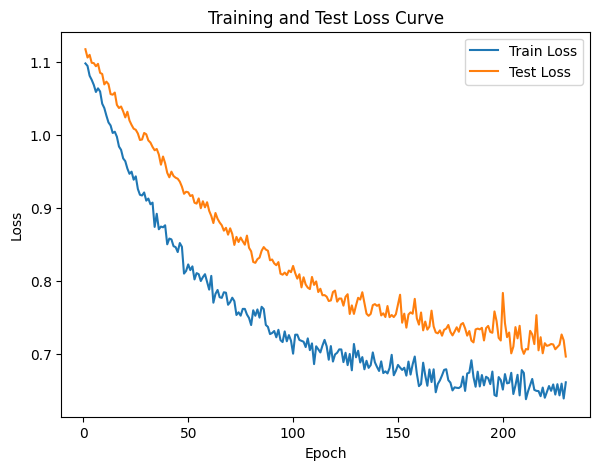

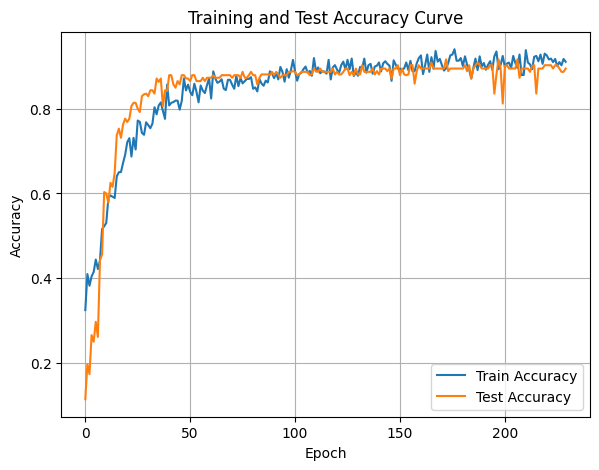

In [88]:
DTEmlp12b.train_single_model()

Randomly initializing 12 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.50it/s]

Epoch [1/10], Train F1:0.5129422428207977, Train Loss: 1.0548, Train Acc: 0.4560, Test F1:0.20871185651059862, Test Loss: 1.1161, Test Acc: 0.2161


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.50it/s]

Epoch [2/10], Train F1:0.5132360228859756, Train Loss: 1.0544, Train Acc: 0.4481, Test F1:0.20780511310186114, Test Loss: 1.1247, Test Acc: 0.2209


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.20it/s]

Epoch [3/10], Train F1:0.5042069201511052, Train Loss: 1.0581, Train Acc: 0.4360, Test F1:0.20814179969709723, Test Loss: 1.1268, Test Acc: 0.2225


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.20it/s]

Epoch [4/10], Train F1:0.4979266008837595, Train Loss: 1.0596, Train Acc: 0.4286, Test F1:0.20858204237255384, Test Loss: 1.1276, Test Acc: 0.2233


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.40it/s]

Epoch [5/10], Train F1:0.5088288606587563, Train Loss: 1.0562, Train Acc: 0.4386, Test F1:0.21095955628555785, Test Loss: 1.1253, Test Acc: 0.2253


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.40it/s]

Epoch [6/10], Train F1:0.5139168132746081, Train Loss: 1.0532, Train Acc: 0.4418, Test F1:0.21666425015707313, Test Loss: 1.1231, Test Acc: 0.2303


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.44it/s]

Epoch [7/10], Train F1:0.5192497605062666, Train Loss: 1.0510, Train Acc: 0.4479, Test F1:0.21851636663961702, Test Loss: 1.1204, Test Acc: 0.2339


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.88it/s]

Epoch [8/10], Train F1:0.5247563229402118, Train Loss: 1.0468, Train Acc: 0.4560, Test F1:0.22639785371473345, Test Loss: 1.1176, Test Acc: 0.2412
Epoch [9/10], Train F1:0.5283711318382722, Train Loss: 1.0448, Train Acc: 0.4591, Test F1:0.2301990443345802, Test Loss: 1.1154, Test Acc: 0.2454


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.34it/s]


Epoch [10/10], Train F1:0.5346590276556508, Train Loss: 1.0420, Train Acc: 0.4669, Test F1:0.23260341045059707, Test Loss: 1.1145, Test Acc: 0.2487
Total Epochs: 10
Train loss start: 1.0122534036636353, Train loss end: 0.9889137148857117
Highest Mean Train Accuracy (over epoch): 0.4669345238095239
Test loss start: 1.1241576671600342, Test loss end: 1.0726462602615356
Highest mean Test Accuracy (over epoch): 0.24869791666666666


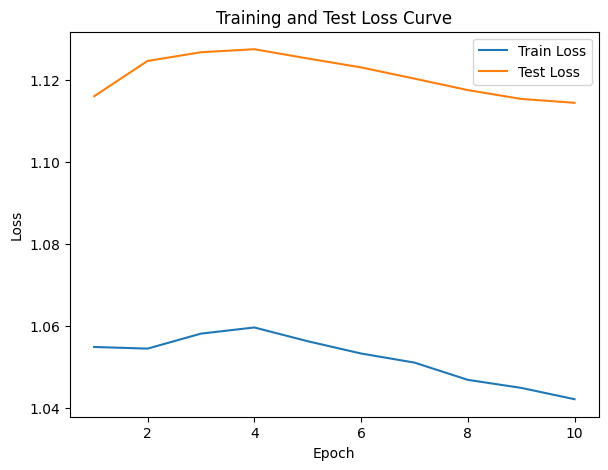

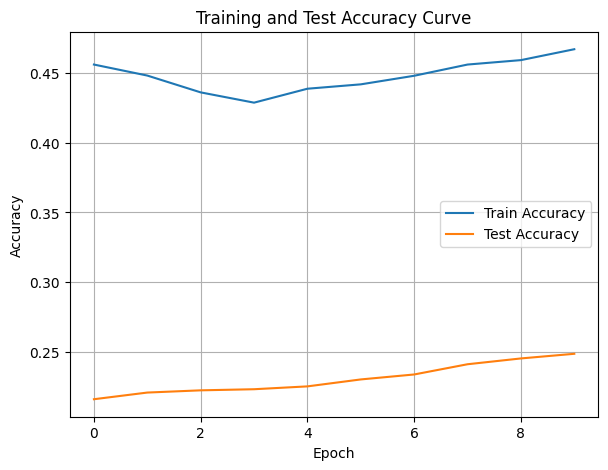

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.3659283523567736, Train Loss: 1.1128, Train Acc: 0.3506, Test F1:0.25043859649122807, Test Loss: 1.1160, Test Acc: 0.2214


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.53it/s]

Epoch [2/10], Train F1:0.3563162853273105, Train Loss: 1.1107, Train Acc: 0.3374, Test F1:0.23759658802963268, Test Loss: 1.1219, Test Acc: 0.2105


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.53it/s]

Epoch [3/10], Train F1:0.3766242529400424, Train Loss: 1.1050, Train Acc: 0.3542, Test F1:0.23315338316568743, Test Loss: 1.1237, Test Acc: 0.2069


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.24it/s]

Epoch [4/10], Train F1:0.3789722392404114, Train Loss: 1.1030, Train Acc: 0.3555, Test F1:0.23725454671039528, Test Loss: 1.1230, Test Acc: 0.2105


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.24it/s]

Epoch [5/10], Train F1:0.3871735299776371, Train Loss: 1.0997, Train Acc: 0.3639, Test F1:0.23460846382379982, Test Loss: 1.1227, Test Acc: 0.2127


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.80it/s]

Epoch [6/10], Train F1:0.3885812445107443, Train Loss: 1.0991, Train Acc: 0.3658, Test F1:0.2356833080804582, Test Loss: 1.1207, Test Acc: 0.2167


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.61it/s]

Epoch [7/10], Train F1:0.393981550037921, Train Loss: 1.0950, Train Acc: 0.3724, Test F1:0.23589074686876566, Test Loss: 1.1183, Test Acc: 0.2185


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.49it/s]

Epoch [8/10], Train F1:0.40007379930732934, Train Loss: 1.0916, Train Acc: 0.3807, Test F1:0.24210912971592277, Test Loss: 1.1166, Test Acc: 0.2208


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.16it/s]

Epoch [9/10], Train F1:0.4089300746107247, Train Loss: 1.0888, Train Acc: 0.3878, Test F1:0.2495442888841883, Test Loss: 1.1143, Test Acc: 0.2266


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.07it/s]


Epoch [10/10], Train F1:0.4152469314215795, Train Loss: 1.0860, Train Acc: 0.3938, Test F1:0.25401434621035346, Test Loss: 1.1121, Test Acc: 0.2327
Total Epochs: 10
Train loss start: 1.0839608907699585, Train loss end: 1.1113078594207764
Highest Mean Train Accuracy (over epoch): 0.3938095238095238
Test loss start: 1.1200491189956665, Test loss end: 1.0812997817993164
Highest mean Test Accuracy (over epoch): 0.23272569444444446


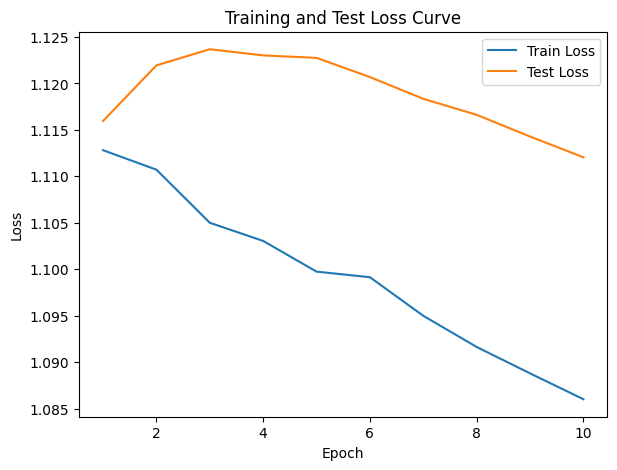

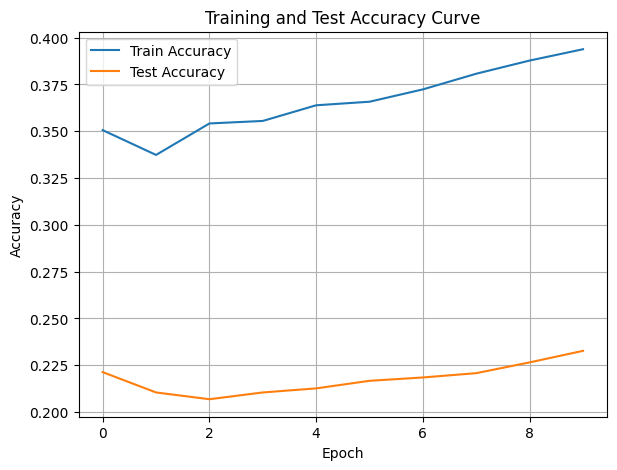

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.47it/s]

Epoch [1/10], Train F1:0.2205154042442178, Train Loss: 1.1047, Train Acc: 0.3565, Test F1:0.20348967657238332, Test Loss: 1.0912, Test Acc: 0.3429
Epoch [2/10], Train F1:0.215934924608394, Train Loss: 1.1051, Train Acc: 0.3482, Test F1:0.2084775156281508, Test Loss: 1.0919, Test Acc: 0.3498


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.47it/s]

Epoch [3/10], Train F1:0.2230692606883335, Train Loss: 1.1012, Train Acc: 0.3527, Test F1:0.21191167162289656, Test Loss: 1.0894, Test Acc: 0.3547


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.53it/s]

Epoch [4/10], Train F1:0.22635778422760675, Train Loss: 1.1004, Train Acc: 0.3549, Test F1:0.21363630495732275, Test Loss: 1.0885, Test Acc: 0.3572
Epoch [5/10], Train F1:0.22932909829296813, Train Loss: 1.0984, Train Acc: 0.3563, Test F1:0.21105197310563237, Test Loss: 1.0875, Test Acc: 0.3571


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.40it/s]

Epoch [6/10], Train F1:0.2333363635708304, Train Loss: 1.0941, Train Acc: 0.3591, Test F1:0.2093325743069572, Test Loss: 1.0865, Test Acc: 0.3571


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.40it/s]

Epoch [7/10], Train F1:0.23647269302852994, Train Loss: 1.0911, Train Acc: 0.3631, Test F1:0.21346182090386642, Test Loss: 1.0842, Test Acc: 0.3593
Epoch [8/10], Train F1:0.2397752796145512, Train Loss: 1.0875, Train Acc: 0.3660, Test F1:0.21669776827996656, Test Loss: 1.0838, Test Acc: 0.3609


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.46it/s]


Epoch [9/10], Train F1:0.24521795241932473, Train Loss: 1.0843, Train Acc: 0.3689, Test F1:0.2189282652974826, Test Loss: 1.0821, Test Acc: 0.3622
Epoch [10/10], Train F1:0.2474310163645066, Train Loss: 1.0823, Train Acc: 0.3708, Test F1:0.21712313003026953, Test Loss: 1.0801, Test Acc: 0.3616
Total Epochs: 10
Train loss start: 1.088512897491455, Train loss end: 1.1067301034927368
Highest Mean Train Accuracy (over epoch): 0.3708035714285714
Test loss start: 1.1080139875411987, Test loss end: 1.0568287372589111
Highest mean Test Accuracy (over epoch): 0.3621720679012346


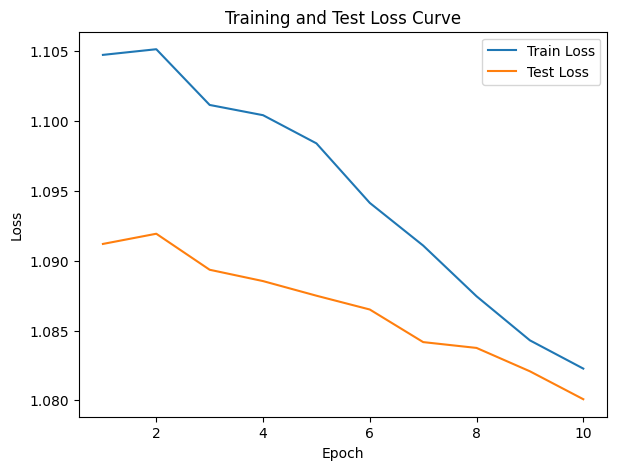

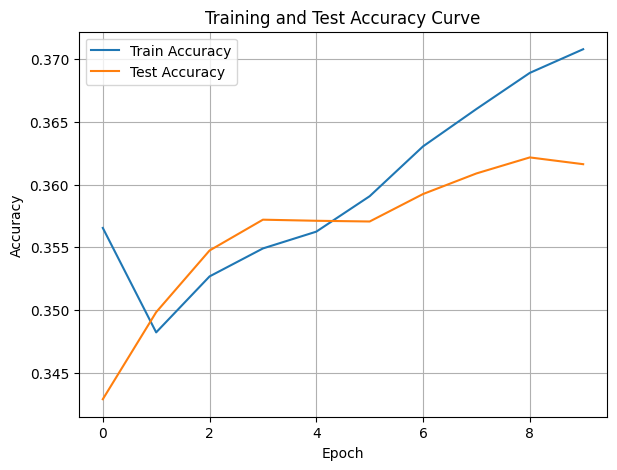

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.81it/s]

Epoch [1/10], Train F1:0.20222125465837276, Train Loss: 1.2211, Train Acc: 0.1187, Test F1:0.1481565075916809, Test Loss: 1.1391, Test Acc: 0.1293


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.73it/s]

Epoch [2/10], Train F1:0.20285980293380265, Train Loss: 1.2218, Train Acc: 0.1246, Test F1:0.14357432559894362, Test Loss: 1.1412, Test Acc: 0.1354


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.77it/s]

Epoch [3/10], Train F1:0.2048118457938888, Train Loss: 1.2183, Train Acc: 0.1297, Test F1:0.14866657900713628, Test Loss: 1.1392, Test Acc: 0.1490


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.33it/s]

Epoch [4/10], Train F1:0.20933510119130075, Train Loss: 1.2159, Train Acc: 0.1316, Test F1:0.15777031616314366, Test Loss: 1.1369, Test Acc: 0.1632


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.45it/s]

Epoch [5/10], Train F1:0.20754551724192702, Train Loss: 1.2148, Train Acc: 0.1295, Test F1:0.16488808393391327, Test Loss: 1.1364, Test Acc: 0.1698


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.67it/s]

Epoch [6/10], Train F1:0.21859422173587673, Train Loss: 1.2113, Train Acc: 0.1379, Test F1:0.17050814169927747, Test Loss: 1.1336, Test Acc: 0.1807


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.70it/s]

Epoch [7/10], Train F1:0.22545388604794547, Train Loss: 1.2076, Train Acc: 0.1434, Test F1:0.1703340842974823, Test Loss: 1.1322, Test Acc: 0.1851


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.81it/s]

Epoch [8/10], Train F1:0.2379003043104348, Train Loss: 1.2036, Train Acc: 0.1522, Test F1:0.17970829324530985, Test Loss: 1.1307, Test Acc: 0.1931


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.27it/s]


Epoch [9/10], Train F1:0.2489521863335905, Train Loss: 1.2006, Train Acc: 0.1602, Test F1:0.18485443720606548, Test Loss: 1.1299, Test Acc: 0.1976
Epoch [10/10], Train F1:0.2545300125590587, Train Loss: 1.1982, Train Acc: 0.1654, Test F1:0.19294476119766638, Test Loss: 1.1286, Test Acc: 0.2059
Total Epochs: 10
Train loss start: 1.2264206409454346, Train loss end: 1.1848558187484741
Highest Mean Train Accuracy (over epoch): 0.16544642857142858
Test loss start: 1.1477649211883545, Test loss end: 1.1159472465515137
Highest mean Test Accuracy (over epoch): 0.20590277777777777


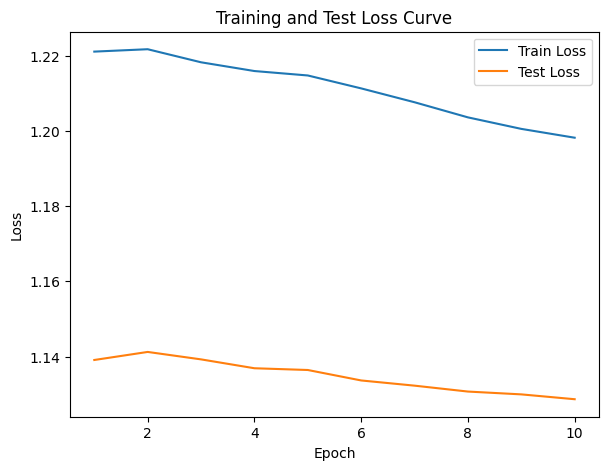

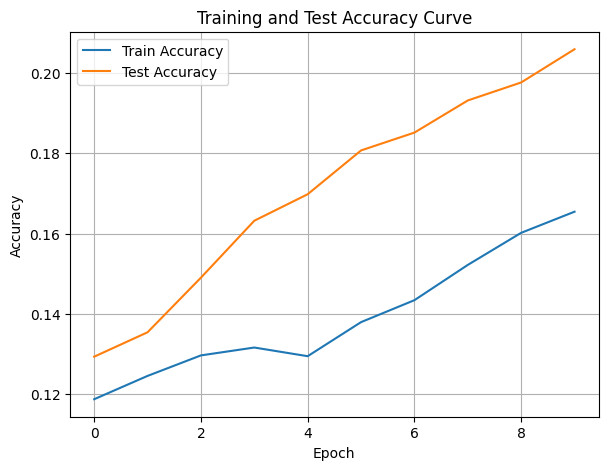

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.23it/s]

Epoch [1/10], Train F1:0.27430436937068237, Train Loss: 1.1685, Train Acc: 0.1833, Test F1:0.14435616227329556, Test Loss: 1.1140, Test Acc: 0.1059
Epoch [2/10], Train F1:0.24910998875685872, Train Loss: 1.1689, Train Acc: 0.1725, Test F1:0.18321284254644996, Test Loss: 1.1087, Test Acc: 0.1510


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.23it/s]

Epoch [3/10], Train F1:0.26101753952729706, Train Loss: 1.1657, Train Acc: 0.1820, Test F1:0.18448345964983096, Test Loss: 1.1076, Test Acc: 0.1510


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.65it/s]

Epoch [4/10], Train F1:0.2675151571385482, Train Loss: 1.1622, Train Acc: 0.1874, Test F1:0.2034733012297795, Test Loss: 1.1061, Test Acc: 0.1673
Epoch [5/10], Train F1:0.2798748089270493, Train Loss: 1.1575, Train Acc: 0.2008, Test F1:0.21483660095317364, Test Loss: 1.1043, Test Acc: 0.1774


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.30it/s]

Epoch [6/10], Train F1:0.2941662321110483, Train Loss: 1.1538, Train Acc: 0.2141, Test F1:0.2571589256964, Test Loss: 1.1007, Test Acc: 0.2186


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.30it/s]

Epoch [7/10], Train F1:0.30191618950712984, Train Loss: 1.1502, Train Acc: 0.2216, Test F1:0.2702858510799416, Test Loss: 1.0988, Test Acc: 0.2365


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.98it/s]

Epoch [8/10], Train F1:0.3104337627562717, Train Loss: 1.1468, Train Acc: 0.2293, Test F1:0.28239100125665856, Test Loss: 1.0966, Test Acc: 0.2536


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.98it/s]

Epoch [9/10], Train F1:0.3243203799647445, Train Loss: 1.1427, Train Acc: 0.2396, Test F1:0.29568132956196386, Test Loss: 1.0947, Test Acc: 0.2712


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.72it/s]


Epoch [10/10], Train F1:0.3373965234837509, Train Loss: 1.1379, Train Acc: 0.2512, Test F1:0.30167731479106225, Test Loss: 1.0940, Test Acc: 0.2806
Total Epochs: 10
Train loss start: 1.175299048423767, Train loss end: 1.022884488105774
Highest Mean Train Accuracy (over epoch): 0.2512202380952381
Test loss start: 1.1158480644226074, Test loss end: 1.06816828250885
Highest mean Test Accuracy (over epoch): 0.2806423611111111


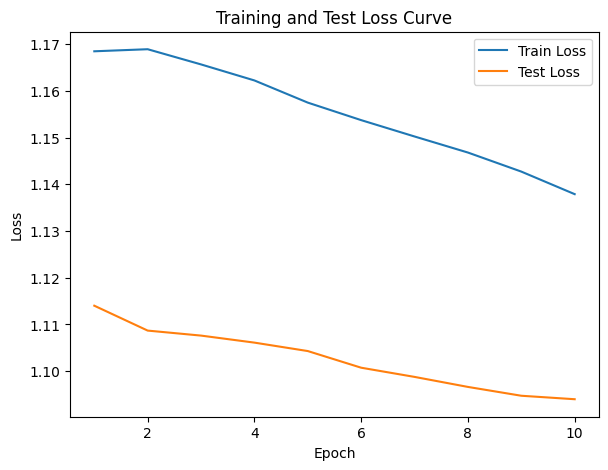

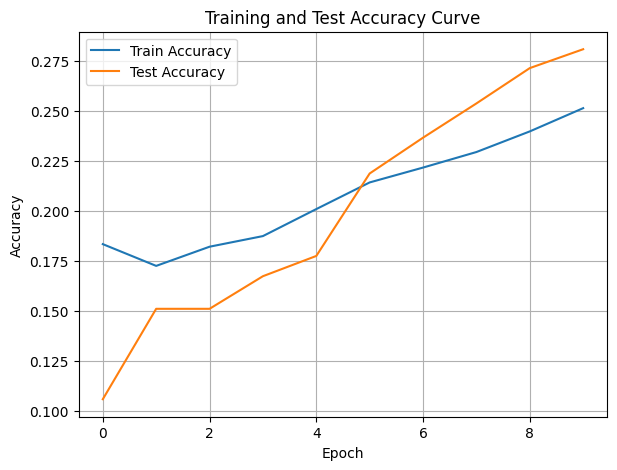

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.91it/s]

Epoch [1/10], Train F1:0.4468189534522082, Train Loss: 1.0816, Train Acc: 0.4152, Test F1:0.448507632718159, Test Loss: 1.0669, Test Acc: 0.4488


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.91it/s]

Epoch [2/10], Train F1:0.4462423312701806, Train Loss: 1.0793, Train Acc: 0.4146, Test F1:0.46673971996236646, Test Loss: 1.0605, Test Acc: 0.4792


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.64it/s]

Epoch [3/10], Train F1:0.44289023510808934, Train Loss: 1.0780, Train Acc: 0.4109, Test F1:0.4688407847575929, Test Loss: 1.0569, Test Acc: 0.4826


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.71it/s]

Epoch [4/10], Train F1:0.45019947713228436, Train Loss: 1.0765, Train Acc: 0.4219, Test F1:0.4764909598709038, Test Loss: 1.0543, Test Acc: 0.4913


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.32it/s]

Epoch [5/10], Train F1:0.46266097929714883, Train Loss: 1.0725, Train Acc: 0.4374, Test F1:0.48946535263826574, Test Loss: 1.0492, Test Acc: 0.5118


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.21it/s]

Epoch [6/10], Train F1:0.46932311797425047, Train Loss: 1.0708, Train Acc: 0.4426, Test F1:0.5050220457728718, Test Loss: 1.0462, Test Acc: 0.5327


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.34it/s]

Epoch [7/10], Train F1:0.4757262841387559, Train Loss: 1.0676, Train Acc: 0.4495, Test F1:0.515008998785077, Test Loss: 1.0441, Test Acc: 0.5468


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.53it/s]

Epoch [8/10], Train F1:0.4793870571270891, Train Loss: 1.0663, Train Acc: 0.4523, Test F1:0.5332940684800358, Test Loss: 1.0409, Test Acc: 0.5649


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.70it/s]

Epoch [9/10], Train F1:0.48476062165671463, Train Loss: 1.0634, Train Acc: 0.4599, Test F1:0.5503067722372875, Test Loss: 1.0391, Test Acc: 0.5774


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.79it/s]


Epoch [10/10], Train F1:0.49123248478655324, Train Loss: 1.0612, Train Acc: 0.4670, Test F1:0.5611500193347615, Test Loss: 1.0379, Test Acc: 0.5844
Total Epochs: 10
Train loss start: 1.1162127256393433, Train loss end: 1.106986165046692
Highest Mean Train Accuracy (over epoch): 0.4669642857142857
Test loss start: 1.0622111558914185, Test loss end: 1.0386549234390259
Highest mean Test Accuracy (over epoch): 0.584375


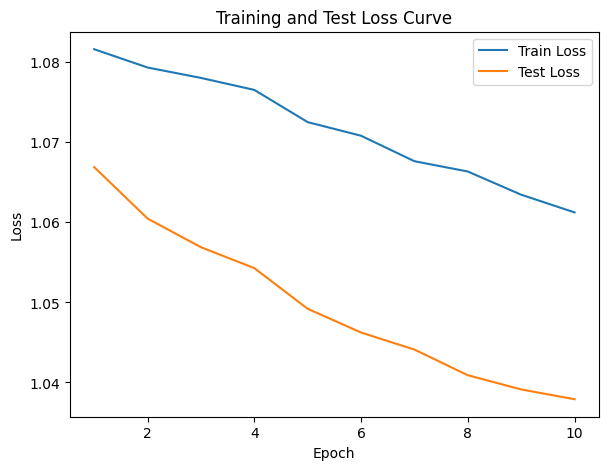

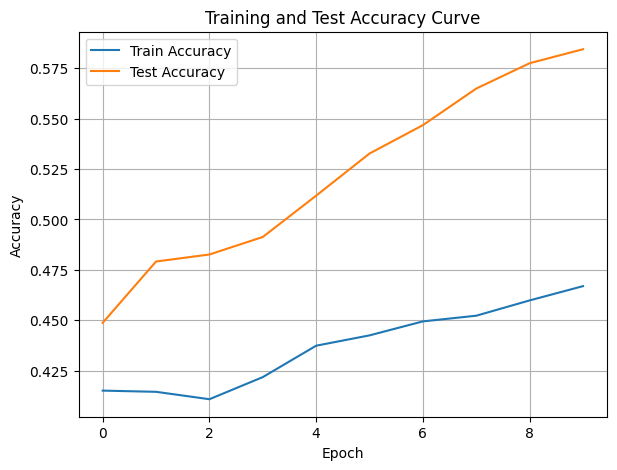

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.26it/s]

Epoch [1/10], Train F1:0.36442448449681714, Train Loss: 1.1296, Train Acc: 0.3527, Test F1:0.3625495664042737, Test Loss: 1.0981, Test Acc: 0.3333


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.54it/s]

Epoch [2/10], Train F1:0.37739340878354327, Train Loss: 1.1262, Train Acc: 0.3598, Test F1:0.3774312235561336, Test Loss: 1.0976, Test Acc: 0.3607


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.18it/s]

Epoch [3/10], Train F1:0.38597846565134564, Train Loss: 1.1214, Train Acc: 0.3615, Test F1:0.40922481642703257, Test Loss: 1.0942, Test Acc: 0.3958


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.49it/s]

Epoch [4/10], Train F1:0.3860365661171283, Train Loss: 1.1174, Train Acc: 0.3650, Test F1:0.42615871415064616, Test Loss: 1.0917, Test Acc: 0.4247


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.81it/s]

Epoch [5/10], Train F1:0.39277962310869435, Train Loss: 1.1127, Train Acc: 0.3723, Test F1:0.44218438623847606, Test Loss: 1.0893, Test Acc: 0.4464


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.93it/s]

Epoch [6/10], Train F1:0.40463002264651216, Train Loss: 1.1078, Train Acc: 0.3848, Test F1:0.45980450247111887, Test Loss: 1.0865, Test Acc: 0.4696


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.10it/s]

Epoch [7/10], Train F1:0.41383068367347664, Train Loss: 1.1030, Train Acc: 0.3937, Test F1:0.4705691199364245, Test Loss: 1.0851, Test Acc: 0.4820


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.50it/s]

Epoch [8/10], Train F1:0.4189579836473119, Train Loss: 1.0981, Train Acc: 0.3994, Test F1:0.47766932414194263, Test Loss: 1.0848, Test Acc: 0.4867


Training Process:  80%|████████  | 8/10 [00:01<00:00,  8.50it/s]

Epoch [9/10], Train F1:0.420664585243268, Train Loss: 1.0976, Train Acc: 0.4025, Test F1:0.48745171628384243, Test Loss: 1.0831, Test Acc: 0.4968


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.85it/s]


Epoch [10/10], Train F1:0.42769765818178174, Train Loss: 1.0927, Train Acc: 0.4098, Test F1:0.4986293250351931, Test Loss: 1.0810, Test Acc: 0.5087
Total Epochs: 10
Train loss start: 1.1807432174682617, Train loss end: 1.0284053087234497
Highest Mean Train Accuracy (over epoch): 0.40979166666666667
Test loss start: 1.0821425914764404, Test loss end: 1.0753058195114136
Highest mean Test Accuracy (over epoch): 0.5086805555555556


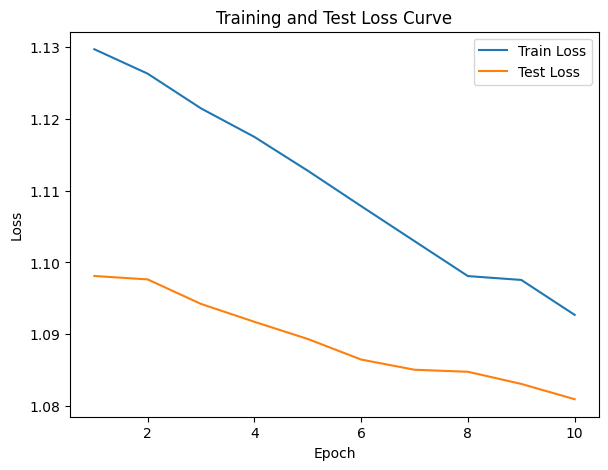

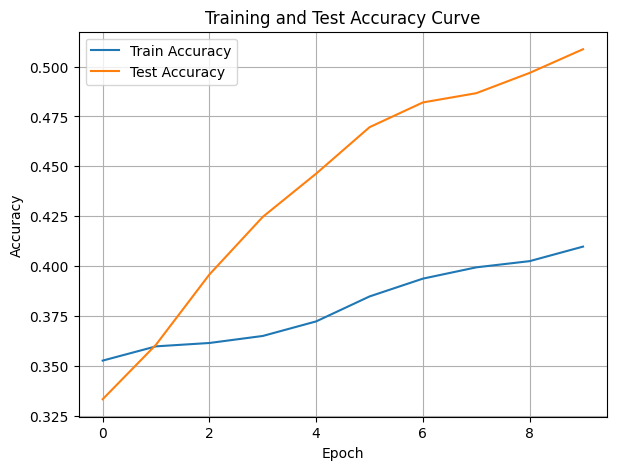

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.48997893789226055, Train Loss: 0.9944, Train Acc: 0.6080, Test F1:0.5068017637677079, Test Loss: 1.0262, Test Acc: 0.6432


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.96it/s]

Epoch [2/10], Train F1:0.4857912395727522, Train Loss: 0.9963, Train Acc: 0.6022, Test F1:0.5089122807017543, Test Loss: 1.0159, Test Acc: 0.6471


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.83it/s]

Epoch [3/10], Train F1:0.4830054731707273, Train Loss: 0.9880, Train Acc: 0.6066, Test F1:0.5082100268464756, Test Loss: 1.0090, Test Acc: 0.6458
Epoch [4/10], Train F1:0.4847344123999176, Train Loss: 0.9855, Train Acc: 0.6091, Test F1:0.5089122807017543, Test Loss: 1.0017, Test Acc: 0.6471


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.83it/s]

Epoch [5/10], Train F1:0.48585537877136853, Train Loss: 0.9806, Train Acc: 0.6082, Test F1:0.5093330340777318, Test Loss: 0.9971, Test Acc: 0.6479


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.90it/s]

Epoch [6/10], Train F1:0.48627610919538067, Train Loss: 0.9783, Train Acc: 0.6122, Test F1:0.5096132872144837, Test Loss: 0.9945, Test Acc: 0.6484
Epoch [7/10], Train F1:0.4901647251454962, Train Loss: 0.9754, Train Acc: 0.6149, Test F1:0.5092128646062987, Test Loss: 0.9940, Test Acc: 0.6477


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.28it/s]

Epoch [8/10], Train F1:0.4910338617522905, Train Loss: 0.9716, Train Acc: 0.6173, Test F1:0.5094381523428825, Test Loss: 0.9927, Test Acc: 0.6481


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.28it/s]

Epoch [9/10], Train F1:0.49077299535007884, Train Loss: 0.9705, Train Acc: 0.6177, Test F1:0.5096132872144837, Test Loss: 0.9911, Test Acc: 0.6484


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.21it/s]

Epoch [10/10], Train F1:0.49327133406255036, Train Loss: 0.9678, Train Acc: 0.6201, Test F1:0.5097533391283215, Test Loss: 0.9902, Test Acc: 0.6487
Total Epochs: 10
Train loss start: 1.0099823474884033, Train loss end: 0.8567222952842712
Highest Mean Train Accuracy (over epoch): 0.6201488095238096
Test loss start: 1.0166230201721191, Test loss end: 0.9793679714202881
Highest mean Test Accuracy (over epoch): 0.6486979166666667


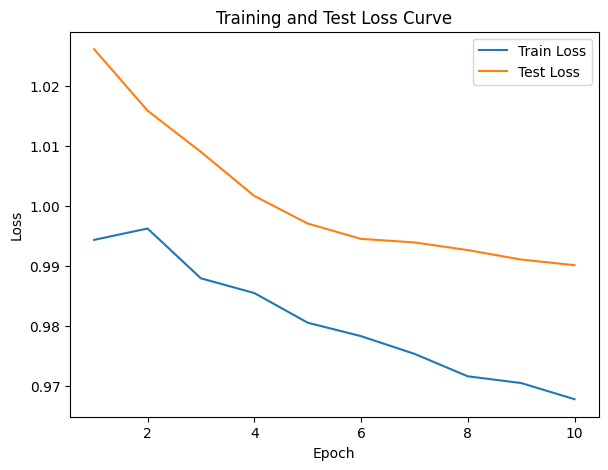

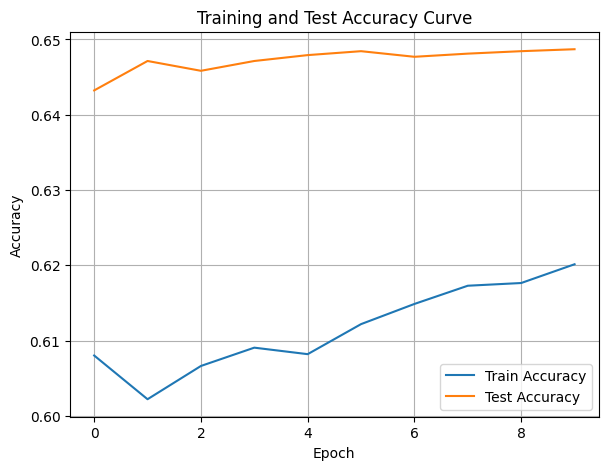

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.19513914189621462, Train Loss: 1.1991, Train Acc: 0.1304, Test F1:0.09484575135544664, Test Loss: 1.1310, Test Acc: 0.0547


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.69it/s]

Epoch [2/10], Train F1:0.19953057297710144, Train Loss: 1.1992, Train Acc: 0.1351, Test F1:0.09123137177217332, Test Loss: 1.1315, Test Acc: 0.0508
Epoch [3/10], Train F1:0.21490157355156933, Train Loss: 1.1957, Train Acc: 0.1471, Test F1:0.12683178534571726, Test Loss: 1.1281, Test Acc: 0.0723


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.34it/s]

Epoch [4/10], Train F1:0.21761102585909464, Train Loss: 1.1968, Train Acc: 0.1500, Test F1:0.12497234076181446, Test Loss: 1.1285, Test Acc: 0.0714


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.34it/s]

Epoch [5/10], Train F1:0.2260553436931313, Train Loss: 1.1935, Train Acc: 0.1576, Test F1:0.16301928238742153, Test Loss: 1.1253, Test Acc: 0.0943


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.83it/s]

Epoch [6/10], Train F1:0.23272635931256822, Train Loss: 1.1905, Train Acc: 0.1626, Test F1:0.1601109675501618, Test Loss: 1.1256, Test Acc: 0.0926


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.83it/s]

Epoch [7/10], Train F1:0.2468214178407944, Train Loss: 1.1867, Train Acc: 0.1735, Test F1:0.14811020104979997, Test Loss: 1.1270, Test Acc: 0.0849


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.87it/s]

Epoch [8/10], Train F1:0.25599973718719815, Train Loss: 1.1838, Train Acc: 0.1797, Test F1:0.16519748018227307, Test Loss: 1.1252, Test Acc: 0.0961


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.87it/s]

Epoch [9/10], Train F1:0.26589531901227786, Train Loss: 1.1804, Train Acc: 0.1890, Test F1:0.1841683332911403, Test Loss: 1.1226, Test Acc: 0.1107


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.47it/s]


Epoch [10/10], Train F1:0.27281801807493733, Train Loss: 1.1777, Train Acc: 0.1948, Test F1:0.19717912693991296, Test Loss: 1.1212, Test Acc: 0.1202
Total Epochs: 10
Train loss start: 1.2135162353515625, Train loss end: 1.1577173471450806
Highest Mean Train Accuracy (over epoch): 0.19482142857142856
Test loss start: 1.1331483125686646, Test loss end: 1.0992355346679688
Highest mean Test Accuracy (over epoch): 0.12022569444444445


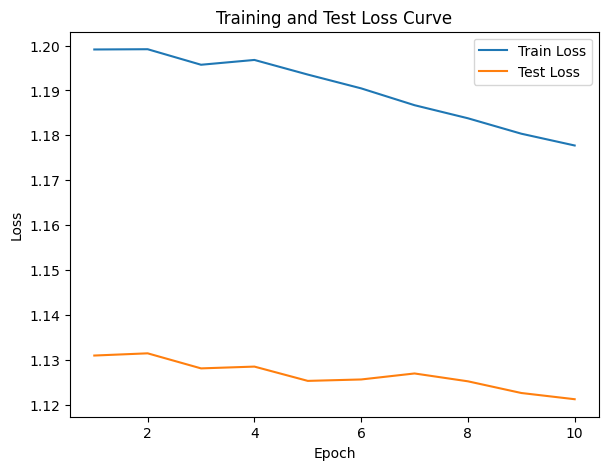

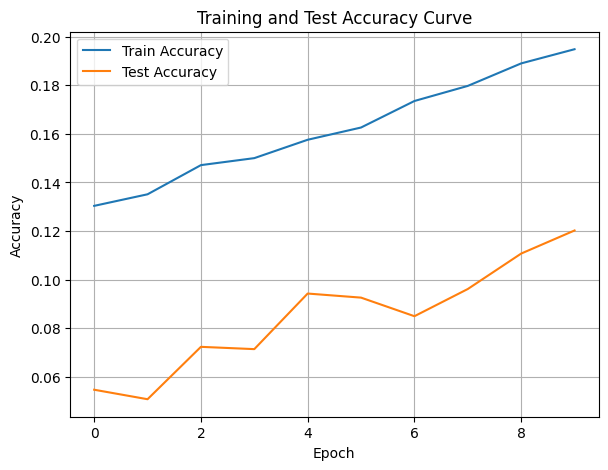

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.67it/s]

Epoch [1/10], Train F1:0.5611493331959222, Train Loss: 1.0213, Train Acc: 0.5461, Test F1:0.67787138774101, Test Loss: 1.0394, Test Acc: 0.6823
Epoch [2/10], Train F1:0.5479347701259427, Train Loss: 1.0284, Train Acc: 0.5368, Test F1:0.7028259466359159, Test Loss: 1.0337, Test Acc: 0.7166


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.67it/s]

Epoch [3/10], Train F1:0.5637142906949348, Train Loss: 1.0205, Train Acc: 0.5630, Test F1:0.7049395570285424, Test Loss: 1.0324, Test Acc: 0.7109


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.02it/s]

Epoch [4/10], Train F1:0.5745176403795015, Train Loss: 1.0163, Train Acc: 0.5763, Test F1:0.7099877913719397, Test Loss: 1.0299, Test Acc: 0.7224


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.02it/s]

Epoch [5/10], Train F1:0.5776908592660216, Train Loss: 1.0139, Train Acc: 0.5827, Test F1:0.7184767708688838, Test Loss: 1.0275, Test Acc: 0.7281


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.44it/s]

Epoch [6/10], Train F1:0.5745321927950943, Train Loss: 1.0113, Train Acc: 0.5832, Test F1:0.7161769696395736, Test Loss: 1.0245, Test Acc: 0.7316


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.57it/s]

Epoch [7/10], Train F1:0.5815378145047877, Train Loss: 1.0079, Train Acc: 0.5905, Test F1:0.7207300284376348, Test Loss: 1.0228, Test Acc: 0.7335


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.57it/s]

Epoch [8/10], Train F1:0.5828921952805846, Train Loss: 1.0046, Train Acc: 0.5948, Test F1:0.723397337371495, Test Loss: 1.0205, Test Acc: 0.7374


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.17it/s]


Epoch [9/10], Train F1:0.5868150592547131, Train Loss: 1.0018, Train Acc: 0.6006, Test F1:0.7355511722633824, Test Loss: 1.0176, Test Acc: 0.7496
Epoch [10/10], Train F1:0.5911444775623951, Train Loss: 0.9981, Train Acc: 0.6063, Test F1:0.7428665654537749, Test Loss: 1.0159, Test Acc: 0.7558
Total Epochs: 10
Train loss start: 1.0641932487487793, Train loss end: 0.8793207406997681
Highest Mean Train Accuracy (over epoch): 0.6062797619047618
Test loss start: 1.0318177938461304, Test loss end: 1.000248670578003
Highest mean Test Accuracy (over epoch): 0.7558159722222222


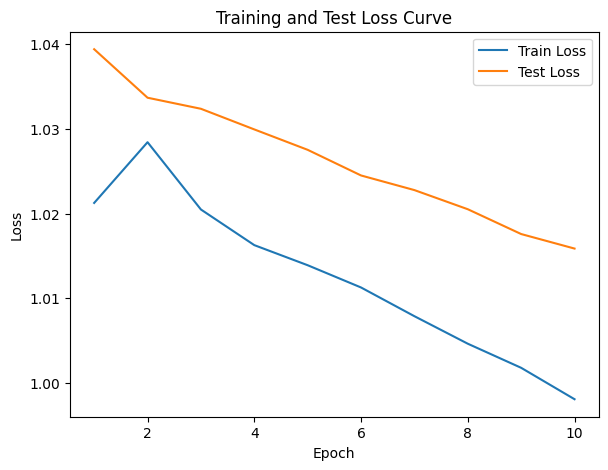

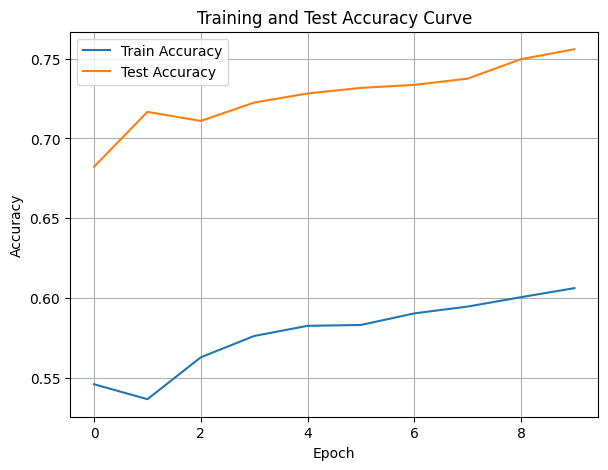

./saved_models/model_10.pth
Training Model with id 11
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.08it/s]

Epoch [1/10], Train F1:0.528837570359632, Train Loss: 1.0206, Train Acc: 0.4991, Test F1:0.5700599678221443, Test Loss: 1.0260, Test Acc: 0.6276
Epoch [2/10], Train F1:0.5229419839069792, Train Loss: 1.0314, Train Acc: 0.4997, Test F1:0.5537822703257538, Test Loss: 1.0168, Test Acc: 0.6254


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.80it/s]

Epoch [3/10], Train F1:0.5414314587163026, Train Loss: 1.0240, Train Acc: 0.5180, Test F1:0.5511445200277076, Test Loss: 1.0093, Test Acc: 0.6319
Epoch [4/10], Train F1:0.5378624392427303, Train Loss: 1.0192, Train Acc: 0.5207, Test F1:0.5537839554845858, Test Loss: 1.0033, Test Acc: 0.6387


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.42it/s]

Epoch [5/10], Train F1:0.5484572403072202, Train Loss: 1.0153, Train Acc: 0.5323, Test F1:0.5654804176858941, Test Loss: 1.0010, Test Acc: 0.6486
Epoch [6/10], Train F1:0.5513894560763044, Train Loss: 1.0144, Train Acc: 0.5339, Test F1:0.5732510080279913, Test Loss: 0.9981, Test Acc: 0.6552
Epoch [7/10], Train F1:0.5565056319859136, Train Loss: 1.0105, Train Acc: 0.5410, Test F1:0.5807302471000167, Test Loss: 0.9948, Test Acc: 0.6611


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.73it/s]

Epoch [8/10], Train F1:0.5581904412363643, Train Loss: 1.0103, Train Acc: 0.5439, Test F1:0.5883359941776609, Test Loss: 0.9918, Test Acc: 0.6664
Epoch [9/10], Train F1:0.562740254796806, Train Loss: 1.0073, Train Acc: 0.5497, Test F1:0.5971460178690778, Test Loss: 0.9886, Test Acc: 0.6739


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.64it/s]


Epoch [10/10], Train F1:0.5687644284740215, Train Loss: 1.0034, Train Acc: 0.5586, Test F1:0.6025608004551548, Test Loss: 0.9867, Test Acc: 0.6791
Total Epochs: 10
Train loss start: 1.0109813213348389, Train loss end: 0.8598087430000305
Highest Mean Train Accuracy (over epoch): 0.5586011904761905
Test loss start: 1.0148484706878662, Test loss end: 0.9762728810310364
Highest mean Test Accuracy (over epoch): 0.6790798611111111


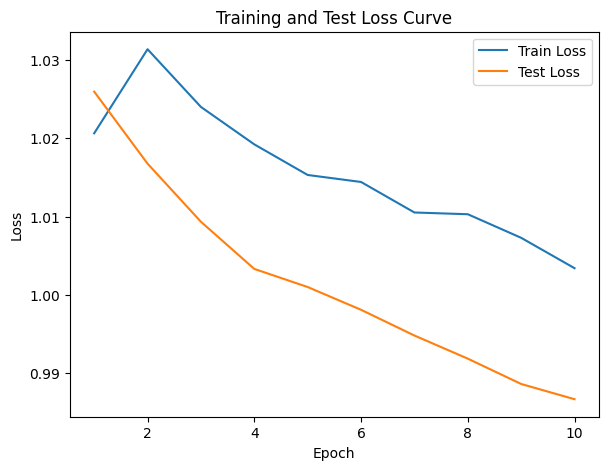

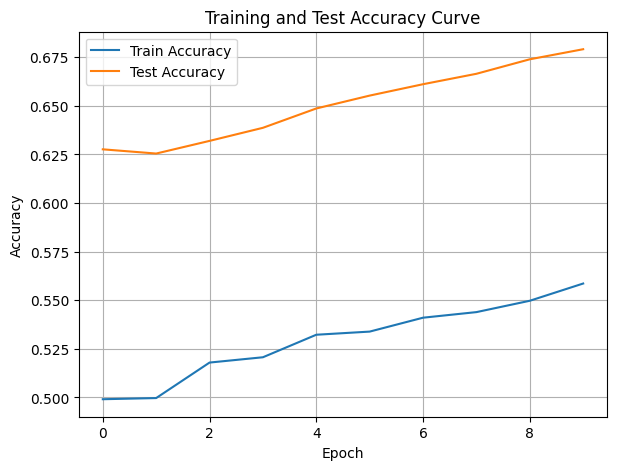

./saved_models/model_11.pth
Training Model with id 12
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.5272467496118193, Train Loss: 0.9840, Train Acc: 0.5902, Test F1:0.605729772573284, Test Loss: 1.0190, Test Acc: 0.6762


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.05it/s]

Epoch [2/10], Train F1:0.5300206288190568, Train Loss: 0.9748, Train Acc: 0.5964, Test F1:0.5707513733829523, Test Loss: 1.0135, Test Acc: 0.6536


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.27it/s]

Epoch [3/10], Train F1:0.5221924693977489, Train Loss: 0.9769, Train Acc: 0.5909, Test F1:0.5500217548075114, Test Loss: 1.0146, Test Acc: 0.6409


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.27it/s]

Epoch [4/10], Train F1:0.5208486105447977, Train Loss: 0.9745, Train Acc: 0.5936, Test F1:0.5449796511669172, Test Loss: 1.0089, Test Acc: 0.6419


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.88it/s]

Epoch [5/10], Train F1:0.5311072183268446, Train Loss: 0.9703, Train Acc: 0.6004, Test F1:0.5438989279272483, Test Loss: 1.0073, Test Acc: 0.6398


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.88it/s]

Epoch [6/10], Train F1:0.5279405823442291, Train Loss: 0.9696, Train Acc: 0.5989, Test F1:0.5419788002115381, Test Loss: 1.0044, Test Acc: 0.6406


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.08it/s]

Epoch [7/10], Train F1:0.5319099106836312, Train Loss: 0.9670, Train Acc: 0.6021, Test F1:0.543221728813092, Test Loss: 1.0035, Test Acc: 0.6432


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.08it/s]

Epoch [8/10], Train F1:0.5347582198300904, Train Loss: 0.9653, Train Acc: 0.6036, Test F1:0.5492771328036272, Test Loss: 1.0027, Test Acc: 0.6464


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.25it/s]

Epoch [9/10], Train F1:0.5374886663020884, Train Loss: 0.9663, Train Acc: 0.6035, Test F1:0.5523652062092403, Test Loss: 1.0000, Test Acc: 0.6495


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.62it/s]


Epoch [10/10], Train F1:0.5399222374389682, Train Loss: 0.9649, Train Acc: 0.6056, Test F1:0.5558245680144865, Test Loss: 0.9954, Test Acc: 0.6528
Total Epochs: 10
Train loss start: 0.9337827563285828, Train loss end: 0.9827256798744202
Highest Mean Train Accuracy (over epoch): 0.6055654761904762
Test loss start: 0.9964821338653564, Test loss end: 0.9573638439178467
Highest mean Test Accuracy (over epoch): 0.6762152777777778


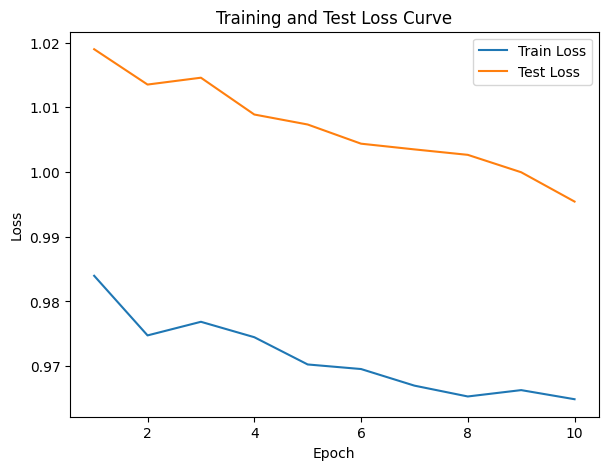

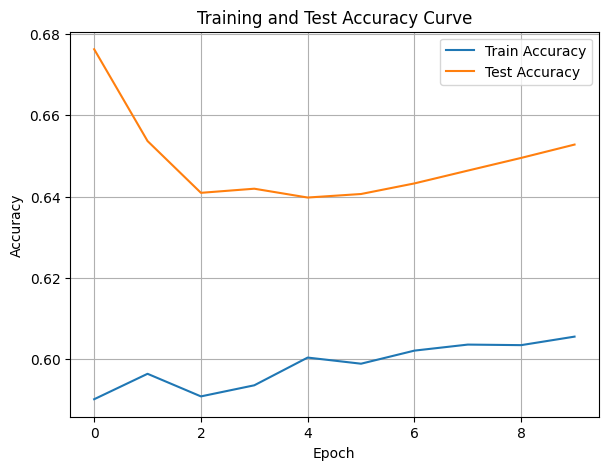

./saved_models/model_12.pth
Training Model with id 18
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.80it/s]

Epoch [1/10], Train F1:0.6237304746389744, Train Loss: 0.9188, Train Acc: 0.6705, Test F1:0.5939529675251959, Test Loss: 0.9747, Test Acc: 0.6684
Epoch [2/10], Train F1:0.5896813165437946, Train Loss: 0.9299, Train Acc: 0.6476, Test F1:0.6005540166204986, Test Loss: 0.9747, Test Acc: 0.6723
Epoch [3/10], Train F1:0.591561285782591, Train Loss: 0.9319, Train Acc: 0.6398, Test F1:0.5959817285490492, Test Loss: 0.9708, Test Acc: 0.6756


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.93it/s]

Epoch [4/10], Train F1:0.5927660005906163, Train Loss: 0.9287, Train Acc: 0.6430, Test F1:0.599541397557918, Test Loss: 0.9699, Test Acc: 0.6758
Epoch [5/10], Train F1:0.5967758869562544, Train Loss: 0.9262, Train Acc: 0.6481, Test F1:0.6040640931585677, Test Loss: 0.9682, Test Acc: 0.6802


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.61it/s]

Epoch [6/10], Train F1:0.5978489142360779, Train Loss: 0.9238, Train Acc: 0.6482, Test F1:0.6140918042041426, Test Loss: 0.9680, Test Acc: 0.6868
Epoch [7/10], Train F1:0.6021112744163085, Train Loss: 0.9212, Train Acc: 0.6520, Test F1:0.6256089648972702, Test Loss: 0.9658, Test Acc: 0.6937


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.08it/s]

Epoch [8/10], Train F1:0.6032519415258056, Train Loss: 0.9198, Train Acc: 0.6533, Test F1:0.6318036303620942, Test Loss: 0.9631, Test Acc: 0.6979
Epoch [9/10], Train F1:0.6105448851693819, Train Loss: 0.9177, Train Acc: 0.6604, Test F1:0.6399310644157625, Test Loss: 0.9616, Test Acc: 0.7029


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.45it/s]


Epoch [10/10], Train F1:0.6123718985610043, Train Loss: 0.9162, Train Acc: 0.6615, Test F1:0.6507828133493421, Test Loss: 0.9601, Test Acc: 0.7093
Total Epochs: 10
Train loss start: 1.0160740613937378, Train loss end: 0.9089191555976868
Highest Mean Train Accuracy (over epoch): 0.6705357142857142
Test loss start: 0.9553048610687256, Test loss end: 0.9480453133583069
Highest mean Test Accuracy (over epoch): 0.7092881944444445


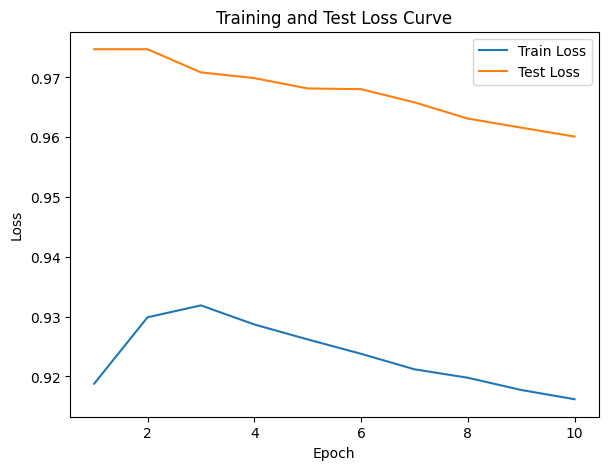

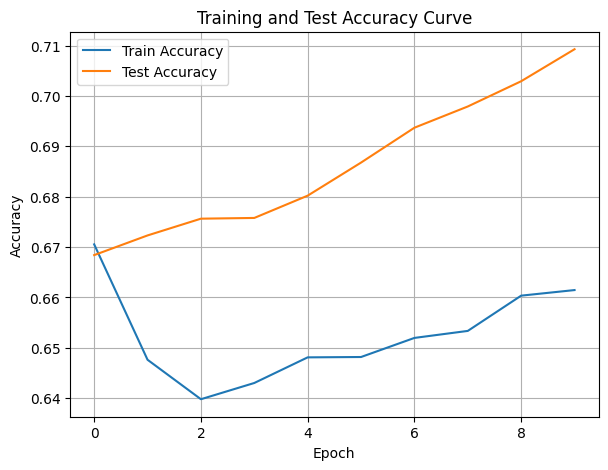

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.6549985553756235, Train Loss: 0.8957, Train Acc: 0.7092, Test F1:0.7264430124180656, Test Loss: 0.9437, Test Acc: 0.7587


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.88it/s]

Epoch [2/10], Train F1:0.6696495631580909, Train Loss: 0.8878, Train Acc: 0.7196, Test F1:0.7374013255758292, Test Loss: 0.9470, Test Acc: 0.7656


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.31it/s]

Epoch [3/10], Train F1:0.6788027568630759, Train Loss: 0.8854, Train Acc: 0.7202, Test F1:0.7338505338649899, Test Loss: 0.9390, Test Acc: 0.7633


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.31it/s]

Epoch [4/10], Train F1:0.6808009710608681, Train Loss: 0.8860, Train Acc: 0.7176, Test F1:0.7226585853588143, Test Loss: 0.9327, Test Acc: 0.7563


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.00it/s]

Epoch [5/10], Train F1:0.685159442468449, Train Loss: 0.8804, Train Acc: 0.7230, Test F1:0.7157806604980277, Test Loss: 0.9312, Test Acc: 0.7521


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.00it/s]

Epoch [6/10], Train F1:0.6855863670507624, Train Loss: 0.8775, Train Acc: 0.7249, Test F1:0.719688518897524, Test Loss: 0.9275, Test Acc: 0.7545


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.21it/s]

Epoch [7/10], Train F1:0.6857738290768236, Train Loss: 0.8760, Train Acc: 0.7267, Test F1:0.7242784605283125, Test Loss: 0.9271, Test Acc: 0.7582


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.21it/s]

Epoch [8/10], Train F1:0.6870871021859459, Train Loss: 0.8748, Train Acc: 0.7243, Test F1:0.724548731941437, Test Loss: 0.9261, Test Acc: 0.7582


Epoch [9/10], Train F1:0.6919791854681785, Train Loss: 0.8732, Train Acc: 0.7268, Test F1:0.7261627965496069, Test Loss: 0.9242, Test Acc: 0.7592


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.17it/s]


Epoch [10/10], Train F1:0.6965381922139426, Train Loss: 0.8716, Train Acc: 0.7292, Test F1:0.7274519046695387, Test Loss: 0.9230, Test Acc: 0.7605
Total Epochs: 10
Train loss start: 0.9311144351959229, Train loss end: 0.9867167472839355
Highest Mean Train Accuracy (over epoch): 0.7291666666666666
Test loss start: 0.9285635948181152, Test loss end: 0.9110854268074036
Highest mean Test Accuracy (over epoch): 0.765625


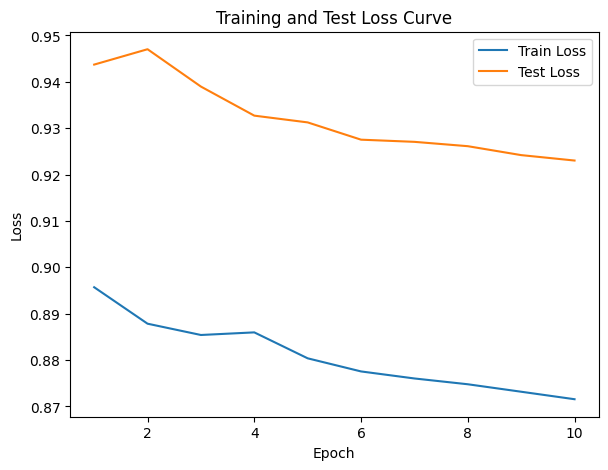

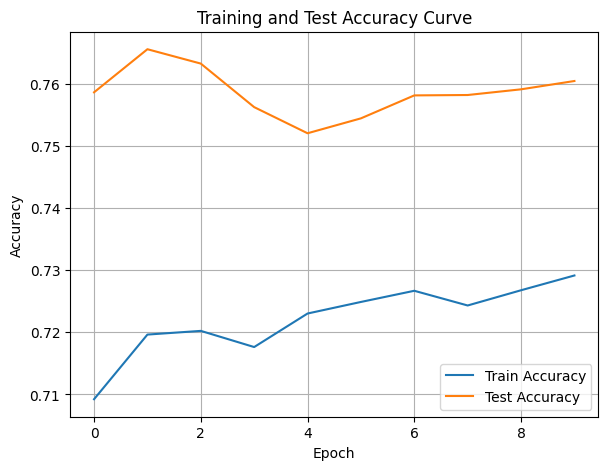

./saved_models/model_16.pth
Training Model with id 19
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.19it/s]

Epoch [1/10], Train F1:0.7345923823646551, Train Loss: 0.8402, Train Acc: 0.7708, Test F1:0.8086062416047893, Test Loss: 0.9074, Test Acc: 0.8255
Epoch [2/10], Train F1:0.7272735433072565, Train Loss: 0.8495, Train Acc: 0.7545, Test F1:0.7863408521303258, Test Loss: 0.9121, Test Acc: 0.8099


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.15it/s]

Epoch [3/10], Train F1:0.736320909461864, Train Loss: 0.8461, Train Acc: 0.7630, Test F1:0.7787231323857451, Test Loss: 0.9100, Test Acc: 0.8027
Epoch [4/10], Train F1:0.7383759249596654, Train Loss: 0.8427, Train Acc: 0.7652, Test F1:0.7719717282457849, Test Loss: 0.9094, Test Acc: 0.7971


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.34it/s]

Epoch [5/10], Train F1:0.737021359085461, Train Loss: 0.8423, Train Acc: 0.7625, Test F1:0.765529904320745, Test Loss: 0.9062, Test Acc: 0.7910
Epoch [6/10], Train F1:0.7419076889283301, Train Loss: 0.8386, Train Acc: 0.7665, Test F1:0.7631685705135048, Test Loss: 0.9049, Test Acc: 0.7892


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.33it/s]

Epoch [7/10], Train F1:0.7440330882904408, Train Loss: 0.8375, Train Acc: 0.7673, Test F1:0.7631685705135047, Test Loss: 0.9033, Test Acc: 0.7891
Epoch [8/10], Train F1:0.746437151704221, Train Loss: 0.8365, Train Acc: 0.7695, Test F1:0.774322760199238, Test Loss: 0.9032, Test Acc: 0.7965


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.84it/s]


Epoch [9/10], Train F1:0.7483888633285718, Train Loss: 0.8357, Train Acc: 0.7694, Test F1:0.7807583008473538, Test Loss: 0.9020, Test Acc: 0.8015
Epoch [10/10], Train F1:0.7538686376038723, Train Loss: 0.8334, Train Acc: 0.7750, Test F1:0.7847275699574073, Test Loss: 0.9011, Test Acc: 0.8047
Total Epochs: 10
Train loss start: 0.9323986172676086, Train loss end: 0.7039833068847656
Highest Mean Train Accuracy (over epoch): 0.775
Test loss start: 0.8965486884117126, Test loss end: 0.8922513127326965
Highest mean Test Accuracy (over epoch): 0.8255208333333334


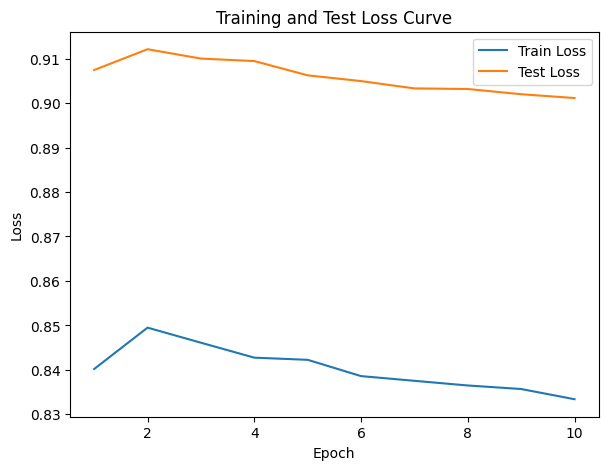

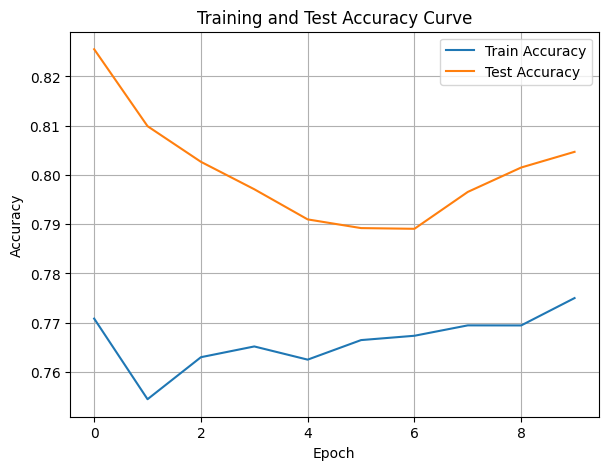

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.12it/s]

Epoch [1/10], Train F1:0.793748543356606, Train Loss: 0.8207, Train Acc: 0.7923, Test F1:0.7631685705135048, Test Loss: 0.8918, Test Acc: 0.7882
Epoch [2/10], Train F1:0.8067465948853164, Train Loss: 0.8163, Train Acc: 0.8112, Test F1:0.8058309620591939, Test Loss: 0.8880, Test Acc: 0.8155


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.12it/s]

Epoch [3/10], Train F1:0.8064136058544643, Train Loss: 0.8113, Train Acc: 0.8158, Test F1:0.8162737909303848, Test Loss: 0.8863, Test Acc: 0.8220


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.66it/s]

Epoch [4/10], Train F1:0.8008283172012854, Train Loss: 0.8094, Train Acc: 0.8139, Test F1:0.8249257721042487, Test Loss: 0.8825, Test Acc: 0.8307


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.66it/s]

Epoch [5/10], Train F1:0.8021115866799704, Train Loss: 0.8099, Train Acc: 0.8113, Test F1:0.8259553382593218, Test Loss: 0.8792, Test Acc: 0.8328


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.90it/s]

Epoch [6/10], Train F1:0.8058081244598099, Train Loss: 0.8067, Train Acc: 0.8151, Test F1:0.8304578950335496, Test Loss: 0.8780, Test Acc: 0.8358


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.90it/s]

Epoch [7/10], Train F1:0.8080096876687568, Train Loss: 0.8030, Train Acc: 0.8186, Test F1:0.8336552456116605, Test Loss: 0.8770, Test Acc: 0.8379


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.31it/s]

Epoch [8/10], Train F1:0.8110642714316942, Train Loss: 0.8006, Train Acc: 0.8222, Test F1:0.836520148351273, Test Loss: 0.8772, Test Acc: 0.8395


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.48it/s]

Epoch [9/10], Train F1:0.8120160723934152, Train Loss: 0.8006, Train Acc: 0.8215, Test F1:0.8385158696543743, Test Loss: 0.8761, Test Acc: 0.8408


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.22it/s]


Epoch [10/10], Train F1:0.8132230915879953, Train Loss: 0.7987, Train Acc: 0.8233, Test F1:0.8389069689148243, Test Loss: 0.8748, Test Acc: 0.8410
Total Epochs: 10
Train loss start: 0.750571072101593, Train loss end: 0.7058328986167908
Highest Mean Train Accuracy (over epoch): 0.8232738095238096
Test loss start: 0.8819631338119507, Test loss end: 0.8603642582893372
Highest mean Test Accuracy (over epoch): 0.8409722222222221


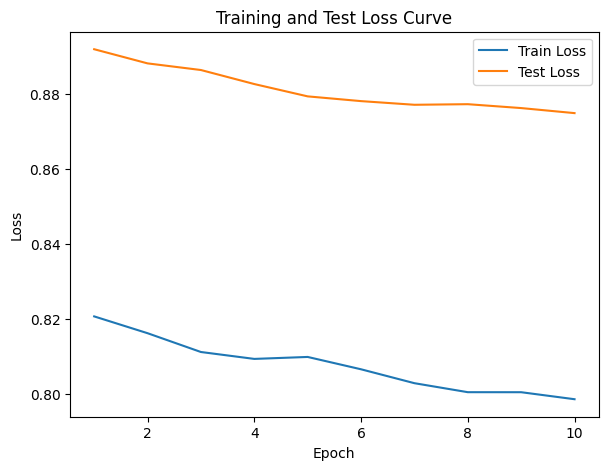

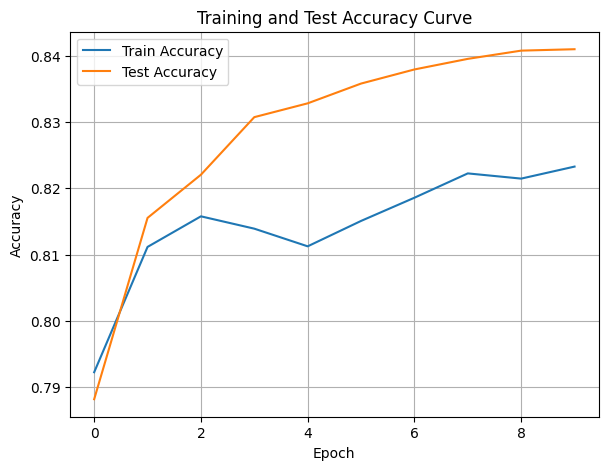

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8192916623585466, Train Loss: 0.7880, Train Acc: 0.8205, Test F1:0.8638529129857927, Test Loss: 0.8560, Test Acc: 0.8585


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.00it/s]

Epoch [2/10], Train F1:0.8205194459749586, Train Loss: 0.7830, Train Acc: 0.8226, Test F1:0.8424305409858196, Test Loss: 0.8516, Test Acc: 0.8459
Epoch [3/10], Train F1:0.8321184749540755, Train Loss: 0.7771, Train Acc: 0.8348, Test F1:0.849178649541626, Test Loss: 0.8523, Test Acc: 0.8501


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.99it/s]

Epoch [4/10], Train F1:0.8337199385120679, Train Loss: 0.7744, Train Acc: 0.8378, Test F1:0.8525283797729619, Test Loss: 0.8541, Test Acc: 0.8522


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.99it/s]

Epoch [5/10], Train F1:0.834840000609181, Train Loss: 0.7736, Train Acc: 0.8411, Test F1:0.8565272831200809, Test Loss: 0.8524, Test Acc: 0.8550


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.24it/s]

Epoch [6/10], Train F1:0.84026868944056, Train Loss: 0.7724, Train Acc: 0.8458, Test F1:0.8558623505145061, Test Loss: 0.8497, Test Acc: 0.8543


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.34it/s]

Epoch [7/10], Train F1:0.8405401032845672, Train Loss: 0.7699, Train Acc: 0.8463, Test F1:0.8568120660313546, Test Loss: 0.8495, Test Acc: 0.8549


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.26it/s]

Epoch [8/10], Train F1:0.8399081219493723, Train Loss: 0.7717, Train Acc: 0.8439, Test F1:0.8548326238390093, Test Loss: 0.8467, Test Acc: 0.8542


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.40it/s]

Epoch [9/10], Train F1:0.8434507310014688, Train Loss: 0.7683, Train Acc: 0.8481, Test F1:0.8558623505145062, Test Loss: 0.8450, Test Acc: 0.8546


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.56it/s]


Epoch [10/10], Train F1:0.843497496204302, Train Loss: 0.7672, Train Acc: 0.8491, Test F1:0.8566809824089069, Test Loss: 0.8455, Test Acc: 0.8550
Total Epochs: 10
Train loss start: 0.7799545526504517, Train loss end: 0.6790176033973694
Highest Mean Train Accuracy (over epoch): 0.8491071428571427
Test loss start: 0.8469617366790771, Test loss end: 0.8479534387588501
Highest mean Test Accuracy (over epoch): 0.8585069444444444


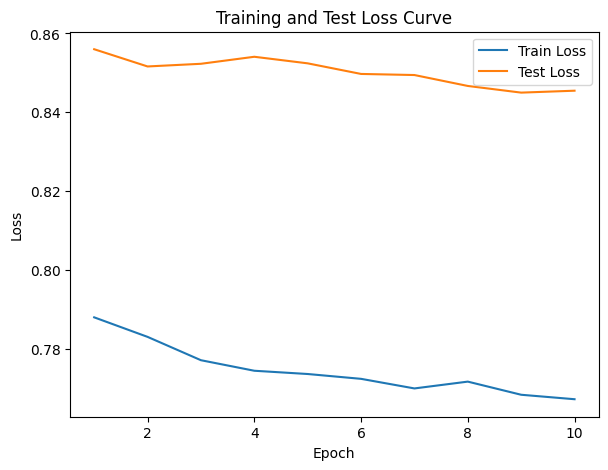

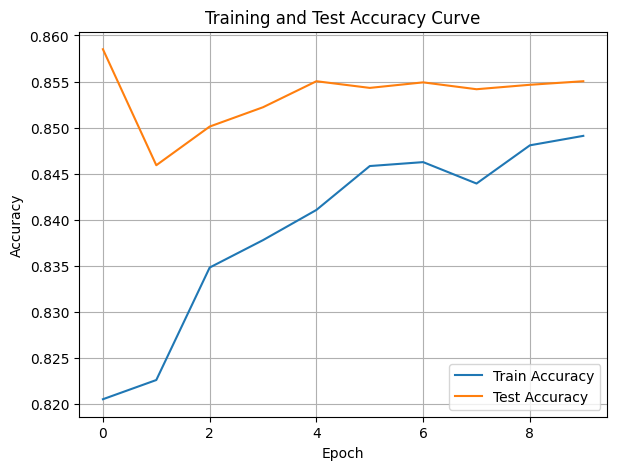

./saved_models/model_15.pth
Training Model with id 19
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  6.94it/s]

Epoch [1/10], Train F1:0.8728878555871782, Train Loss: 0.7403, Train Acc: 0.8759, Test F1:0.8624843486896075, Test Loss: 0.8277, Test Acc: 0.8585


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.32it/s]

Epoch [2/10], Train F1:0.8662187291099361, Train Loss: 0.7456, Train Acc: 0.8659, Test F1:0.8575235310434749, Test Loss: 0.8245, Test Acc: 0.8546


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.66it/s]

Epoch [3/10], Train F1:0.8718171885320063, Train Loss: 0.7420, Train Acc: 0.8720, Test F1:0.8591808969553917, Test Loss: 0.8215, Test Acc: 0.8559


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.04it/s]

Epoch [4/10], Train F1:0.8658941013187622, Train Loss: 0.7444, Train Acc: 0.8654, Test F1:0.8571368679050568, Test Loss: 0.8213, Test Acc: 0.8561


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.29it/s]

Epoch [5/10], Train F1:0.8686763684194245, Train Loss: 0.7405, Train Acc: 0.8702, Test F1:0.858213400593413, Test Loss: 0.8230, Test Acc: 0.8566


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.29it/s]

Epoch [6/10], Train F1:0.8646311713563768, Train Loss: 0.7420, Train Acc: 0.8667, Test F1:0.8591808969553917, Test Loss: 0.8233, Test Acc: 0.8569


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.21it/s]

Epoch [7/10], Train F1:0.8632613450321096, Train Loss: 0.7434, Train Acc: 0.8656, Test F1:0.8598650029503618, Test Loss: 0.8233, Test Acc: 0.8571


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.21it/s]

Epoch [8/10], Train F1:0.8620730029830549, Train Loss: 0.7430, Train Acc: 0.8655, Test F1:0.8582679265851805, Test Loss: 0.8239, Test Acc: 0.8554


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.85it/s]

Epoch [9/10], Train F1:0.8609939737681673, Train Loss: 0.7422, Train Acc: 0.8654, Test F1:0.8588958840482386, Test Loss: 0.8229, Test Acc: 0.8557


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.05it/s]


Epoch [10/10], Train F1:0.8636763415529453, Train Loss: 0.7407, Train Acc: 0.8669, Test F1:0.8596778199873389, Test Loss: 0.8225, Test Acc: 0.8566
Total Epochs: 10
Train loss start: 0.7798718810081482, Train loss end: 0.7371252179145813
Highest Mean Train Accuracy (over epoch): 0.8758928571428571
Test loss start: 0.8200467824935913, Test loss end: 0.8180462718009949
Highest mean Test Accuracy (over epoch): 0.8585069444444444


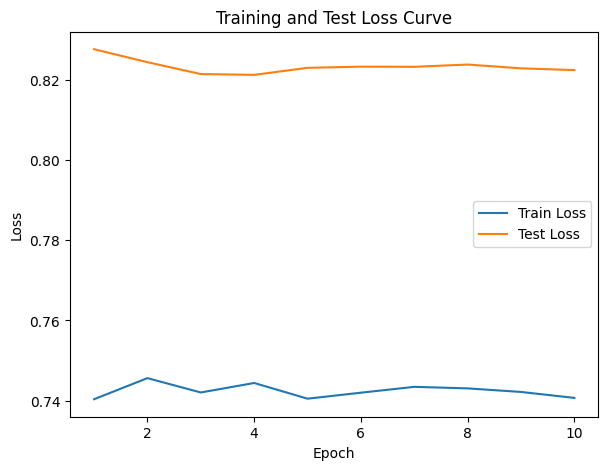

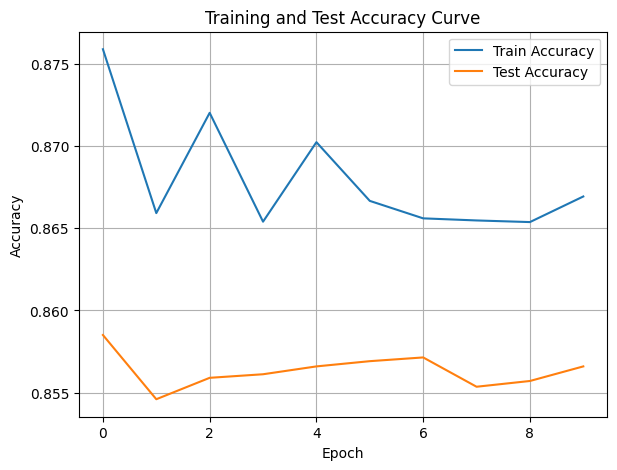

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.58it/s]

Epoch [1/10], Train F1:0.8717741006404772, Train Loss: 0.7320, Train Acc: 0.8738, Test F1:0.8638529129857927, Test Loss: 0.8099, Test Acc: 0.8585


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.07it/s]

Epoch [2/10], Train F1:0.8765023958301269, Train Loss: 0.7268, Train Acc: 0.8817, Test F1:0.8638529129857927, Test Loss: 0.8121, Test Acc: 0.8585


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.82it/s]

Epoch [3/10], Train F1:0.8757916970921453, Train Loss: 0.7258, Train Acc: 0.8822, Test F1:0.8638529129857927, Test Loss: 0.8143, Test Acc: 0.8585


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.82it/s]

Epoch [4/10], Train F1:0.8740236778222232, Train Loss: 0.7266, Train Acc: 0.8778, Test F1:0.8659614115313226, Test Loss: 0.8117, Test Acc: 0.8605


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.59it/s]

Epoch [5/10], Train F1:0.8749469765047095, Train Loss: 0.7264, Train Acc: 0.8767, Test F1:0.8672281110968602, Test Loss: 0.8084, Test Acc: 0.8616


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.59it/s]

Epoch [6/10], Train F1:0.8727987259377393, Train Loss: 0.7270, Train Acc: 0.8745, Test F1:0.8682861167015223, Test Loss: 0.8085, Test Acc: 0.8624


Training Process:  70%|███████   | 7/10 [00:00<00:00, 10.10it/s]

Epoch [7/10], Train F1:0.873056411913878, Train Loss: 0.7274, Train Acc: 0.8736, Test F1:0.8666267268820935, Test Loss: 0.8088, Test Acc: 0.8607


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.76it/s]

Epoch [8/10], Train F1:0.8721851707825348, Train Loss: 0.7269, Train Acc: 0.8719, Test F1:0.8673354311917071, Test Loss: 0.8066, Test Acc: 0.8614


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.76it/s]

Epoch [9/10], Train F1:0.8747077965432096, Train Loss: 0.7235, Train Acc: 0.8753, Test F1:0.8669487103026688, Test Loss: 0.8057, Test Acc: 0.8611


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.09it/s]


Epoch [10/10], Train F1:0.874674188352096, Train Loss: 0.7225, Train Acc: 0.8746, Test F1:0.8665120788268512, Test Loss: 0.8035, Test Acc: 0.8609
Total Epochs: 10
Train loss start: 0.7603205442428589, Train loss end: 0.7455796003341675
Highest Mean Train Accuracy (over epoch): 0.8822420634920636
Test loss start: 0.800830066204071, Test loss end: 0.7887804508209229
Highest mean Test Accuracy (over epoch): 0.8624131944444445


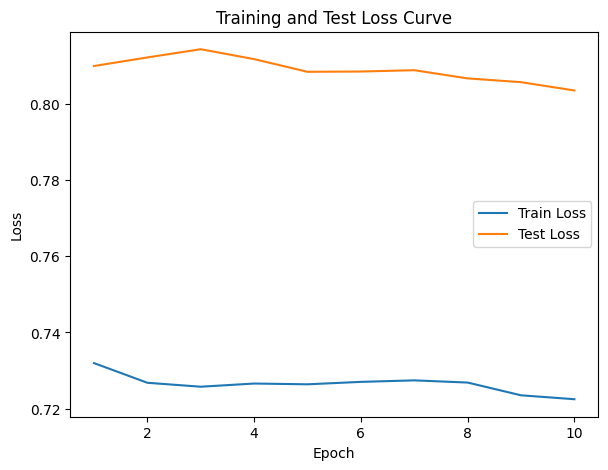

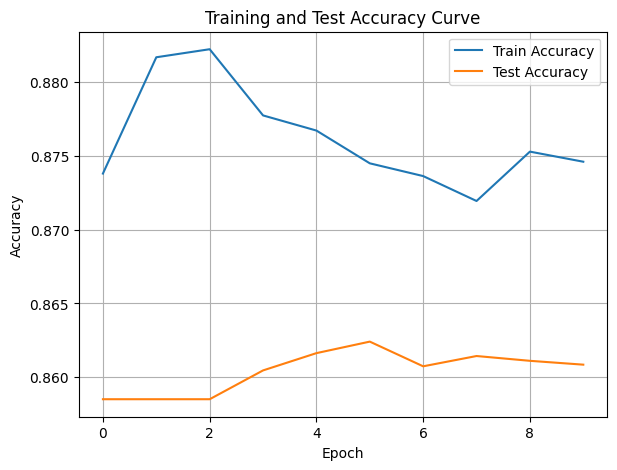

./saved_models/model_17.pth
Training Model with id 20
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.42it/s]

Epoch [1/10], Train F1:0.8786361375127246, Train Loss: 0.7091, Train Acc: 0.8801, Test F1:0.8735192682561103, Test Loss: 0.7869, Test Acc: 0.8663


Training Process:  20%|██        | 2/10 [00:00<00:01,  5.53it/s]

Epoch [2/10], Train F1:0.8836532159129744, Train Loss: 0.7107, Train Acc: 0.8842, Test F1:0.8680732564271199, Test Loss: 0.7815, Test Acc: 0.8624


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.20it/s]

Epoch [3/10], Train F1:0.888349762482176, Train Loss: 0.7100, Train Acc: 0.8909, Test F1:0.865773029859717, Test Loss: 0.7828, Test Acc: 0.8631
Epoch [4/10], Train F1:0.8882715032338118, Train Loss: 0.7081, Train Acc: 0.8921, Test F1:0.8674119313216204, Test Loss: 0.7855, Test Acc: 0.8639


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.15it/s]

Epoch [5/10], Train F1:0.8854233315900292, Train Loss: 0.7076, Train Acc: 0.8904, Test F1:0.8672281110968602, Test Loss: 0.7892, Test Acc: 0.8641
Epoch [6/10], Train F1:0.884530921584843, Train Loss: 0.7112, Train Acc: 0.8862, Test F1:0.8672940595153277, Test Loss: 0.7914, Test Acc: 0.8641


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.17it/s]

Epoch [7/10], Train F1:0.8841425585550308, Train Loss: 0.7119, Train Acc: 0.8856, Test F1:0.8669796281459572, Test Loss: 0.7907, Test Acc: 0.8633
Epoch [8/10], Train F1:0.8817590699438497, Train Loss: 0.7114, Train Acc: 0.8843, Test F1:0.8664369373130092, Test Loss: 0.7890, Test Acc: 0.8627


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.90it/s]


Epoch [9/10], Train F1:0.8807042615956032, Train Loss: 0.7110, Train Acc: 0.8831, Test F1:0.8660111677323222, Test Loss: 0.7877, Test Acc: 0.8623
Epoch [10/10], Train F1:0.8824715567423346, Train Loss: 0.7098, Train Acc: 0.8845, Test F1:0.8660463686900173, Test Loss: 0.7878, Test Acc: 0.8625
Total Epochs: 10
Train loss start: 0.7522047162055969, Train loss end: 0.6982107758522034
Highest Mean Train Accuracy (over epoch): 0.8921130952380952
Test loss start: 0.771883487701416, Test loss end: 0.793807327747345
Highest mean Test Accuracy (over epoch): 0.8663194444444444


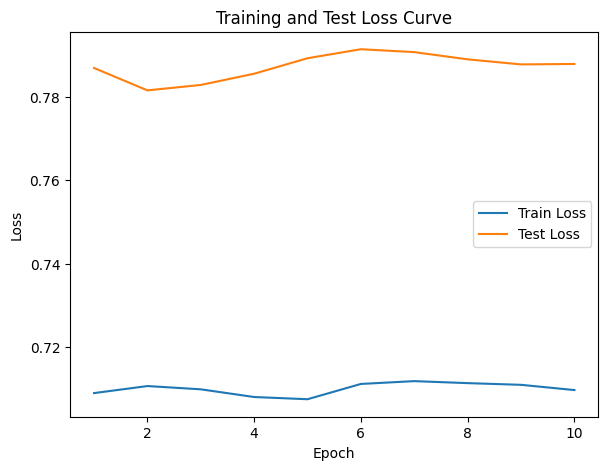

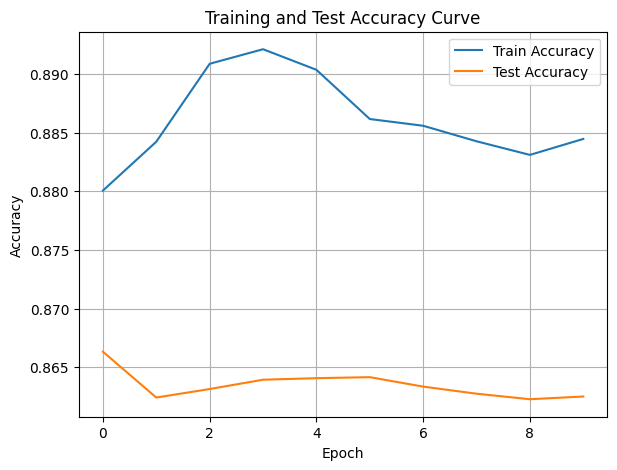

./saved_models/model_20.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.60it/s]

Epoch [1/10], Train F1:0.8909086127547666, Train Loss: 0.6986, Train Acc: 0.8905, Test F1:0.8624843486896075, Test Loss: 0.7736, Test Acc: 0.8585


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.60it/s]

Epoch [2/10], Train F1:0.8919789035813295, Train Loss: 0.7069, Train Acc: 0.8878, Test F1:0.8614521021527213, Test Loss: 0.7913, Test Acc: 0.8607


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.19it/s]

Epoch [3/10], Train F1:0.8954162200974654, Train Loss: 0.7028, Train Acc: 0.8922, Test F1:0.8633867777996987, Test Loss: 0.7935, Test Acc: 0.8620


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.19it/s]

Epoch [4/10], Train F1:0.8920643343889019, Train Loss: 0.7073, Train Acc: 0.8859, Test F1:0.8656499972289445, Test Loss: 0.7860, Test Acc: 0.8631


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.39it/s]

Epoch [5/10], Train F1:0.8966807628461763, Train Loss: 0.7026, Train Acc: 0.8929, Test F1:0.8674413305992253, Test Loss: 0.7841, Test Acc: 0.8649


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.70it/s]

Epoch [6/10], Train F1:0.8968455589994052, Train Loss: 0.7027, Train Acc: 0.8948, Test F1:0.8674111515224968, Test Loss: 0.7855, Test Acc: 0.8649


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.74it/s]

Epoch [7/10], Train F1:0.8934530182881831, Train Loss: 0.7027, Train Acc: 0.8929, Test F1:0.8685870408863196, Test Loss: 0.7857, Test Acc: 0.8659


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.74it/s]

Epoch [8/10], Train F1:0.8956704868334934, Train Loss: 0.7003, Train Acc: 0.8958, Test F1:0.8682866167420876, Test Loss: 0.7853, Test Acc: 0.8658


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  9.28it/s]

Epoch [9/10], Train F1:0.8946099319683467, Train Loss: 0.6998, Train Acc: 0.8939, Test F1:0.8687544290791706, Test Loss: 0.7819, Test Acc: 0.8658


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.08it/s]


Epoch [10/10], Train F1:0.8940921562357875, Train Loss: 0.6999, Train Acc: 0.8926, Test F1:0.8694445918222977, Test Loss: 0.7805, Test Acc: 0.8665
Total Epochs: 10
Train loss start: 0.665291428565979, Train loss end: 0.8303046226501465
Highest Mean Train Accuracy (over epoch): 0.8958333333333334
Test loss start: 0.7569303512573242, Test loss end: 0.7732038497924805
Highest mean Test Accuracy (over epoch): 0.8664930555555557


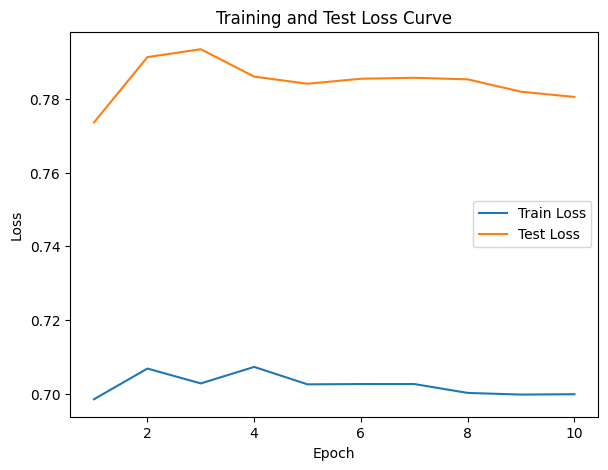

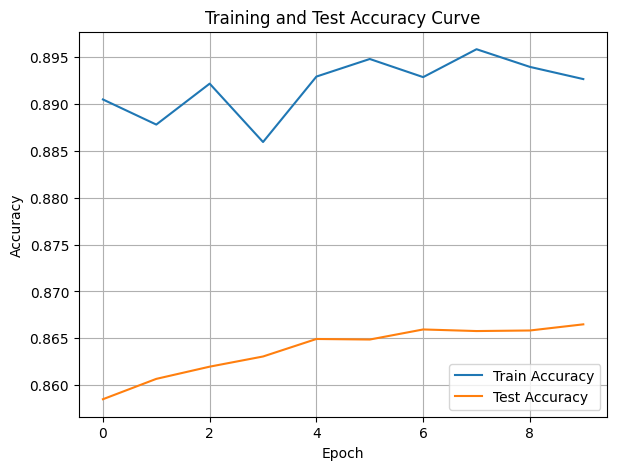

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.94it/s]

Epoch [1/10], Train F1:0.9014669759952778, Train Loss: 0.6998, Train Acc: 0.8935, Test F1:0.8723073506551189, Test Loss: 0.7568, Test Acc: 0.8663


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.94it/s]

Epoch [2/10], Train F1:0.8984964539007092, Train Loss: 0.6935, Train Acc: 0.8978, Test F1:0.8661850705194357, Test Loss: 0.7752, Test Acc: 0.8646


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.39it/s]

Epoch [3/10], Train F1:0.9019094822703071, Train Loss: 0.6896, Train Acc: 0.9034, Test F1:0.868987686607824, Test Loss: 0.7720, Test Acc: 0.8672


Training Process:  30%|███       | 3/10 [00:00<00:00, 10.39it/s]

Epoch [4/10], Train F1:0.9019622605515666, Train Loss: 0.6877, Train Acc: 0.9028, Test F1:0.8677528505217663, Test Loss: 0.7691, Test Acc: 0.8650


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.59it/s]

Epoch [5/10], Train F1:0.9025164197205618, Train Loss: 0.6881, Train Acc: 0.9043, Test F1:0.8678661090530883, Test Loss: 0.7718, Test Acc: 0.8661


Training Process:  50%|█████     | 5/10 [00:00<00:00, 10.59it/s]

Epoch [6/10], Train F1:0.9029089930477685, Train Loss: 0.6865, Train Acc: 0.9053, Test F1:0.8675858261195689, Test Loss: 0.7701, Test Acc: 0.8659


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.47it/s]

Epoch [7/10], Train F1:0.9053788334278958, Train Loss: 0.6836, Train Acc: 0.9071, Test F1:0.8672361032721575, Test Loss: 0.7685, Test Acc: 0.8657


Training Process:  80%|████████  | 8/10 [00:00<00:00,  7.91it/s]

Epoch [8/10], Train F1:0.9041287449186474, Train Loss: 0.6835, Train Acc: 0.9055, Test F1:0.8678891639417957, Test Loss: 0.7662, Test Acc: 0.8658


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.08it/s]


Epoch [9/10], Train F1:0.9043994831818603, Train Loss: 0.6841, Train Acc: 0.9038, Test F1:0.8687544290791706, Test Loss: 0.7654, Test Acc: 0.8665
Epoch [10/10], Train F1:0.9053194688810962, Train Loss: 0.6834, Train Acc: 0.9038, Test F1:0.8694445918222977, Test Loss: 0.7644, Test Acc: 0.8671
Total Epochs: 10
Train loss start: 0.6617221832275391, Train loss end: 0.7644975781440735
Highest Mean Train Accuracy (over epoch): 0.9070578231292519
Test loss start: 0.7393571734428406, Test loss end: 0.7632057070732117
Highest mean Test Accuracy (over epoch): 0.8671875


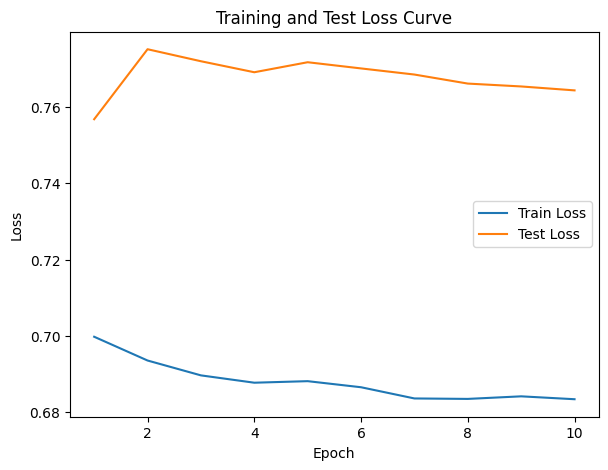

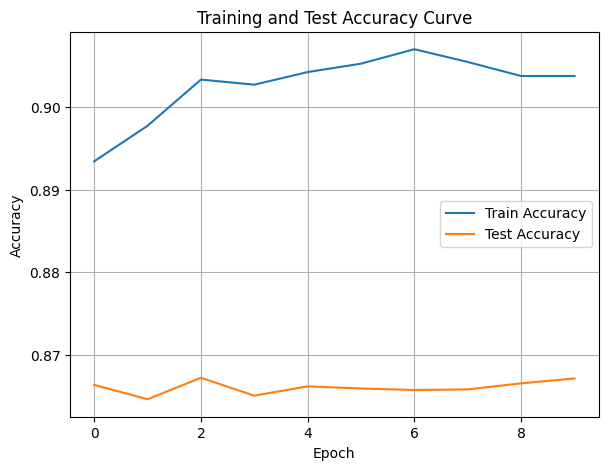

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8910784789614633, Train Loss: 0.7077, Train Acc: 0.8607, Test F1:0.8650836104844525, Test Loss: 0.7532, Test Acc: 0.8646


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.29it/s]

Epoch [2/10], Train F1:0.8966751860333748, Train Loss: 0.6946, Train Acc: 0.8845, Test F1:0.8698584185846029, Test Loss: 0.7499, Test Acc: 0.8685


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.17it/s]

Epoch [3/10], Train F1:0.8987406612242906, Train Loss: 0.6873, Train Acc: 0.8925, Test F1:0.8749427917620136, Test Loss: 0.7573, Test Acc: 0.8744
Epoch [4/10], Train F1:0.9006943114919507, Train Loss: 0.6855, Train Acc: 0.8975, Test F1:0.8650671583884926, Test Loss: 0.7669, Test Acc: 0.8626


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.52it/s]

Epoch [5/10], Train F1:0.8996919921641009, Train Loss: 0.6847, Train Acc: 0.8969, Test F1:0.8639916242706622, Test Loss: 0.7693, Test Acc: 0.8627
Epoch [6/10], Train F1:0.901600697858068, Train Loss: 0.6816, Train Acc: 0.9002, Test F1:0.8659182339444511, Test Loss: 0.7674, Test Acc: 0.8643


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.06it/s]

Epoch [7/10], Train F1:0.9014722872391921, Train Loss: 0.6811, Train Acc: 0.9000, Test F1:0.8656978266561928, Test Loss: 0.7630, Test Acc: 0.8635
Epoch [8/10], Train F1:0.9026270227984479, Train Loss: 0.6794, Train Acc: 0.9012, Test F1:0.8645914621809879, Test Loss: 0.7613, Test Acc: 0.8626
Epoch [9/10], Train F1:0.9023806847665609, Train Loss: 0.6794, Train Acc: 0.9001, Test F1:0.8658111798754663, Test Loss: 0.7600, Test Acc: 0.8637


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.40it/s]


Epoch [10/10], Train F1:0.90262719155853, Train Loss: 0.6804, Train Acc: 0.8981, Test F1:0.8667871165573826, Test Loss: 0.7588, Test Acc: 0.8646
Total Epochs: 10
Train loss start: 0.6884137392044067, Train loss end: 0.9467295408248901
Highest Mean Train Accuracy (over epoch): 0.9011532738095238
Test loss start: 0.7337299585342407, Test loss end: 0.7569363117218018
Highest mean Test Accuracy (over epoch): 0.8744212962962964


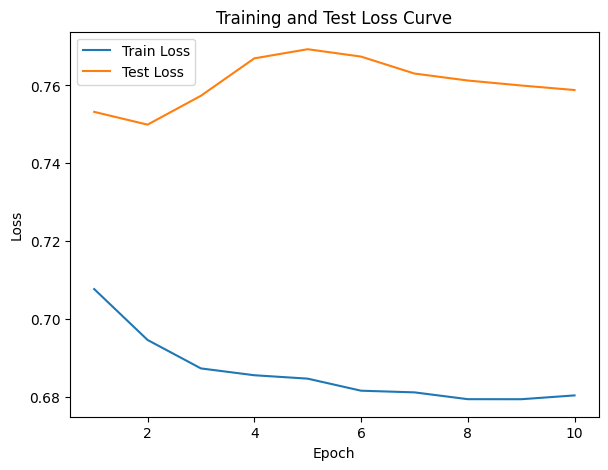

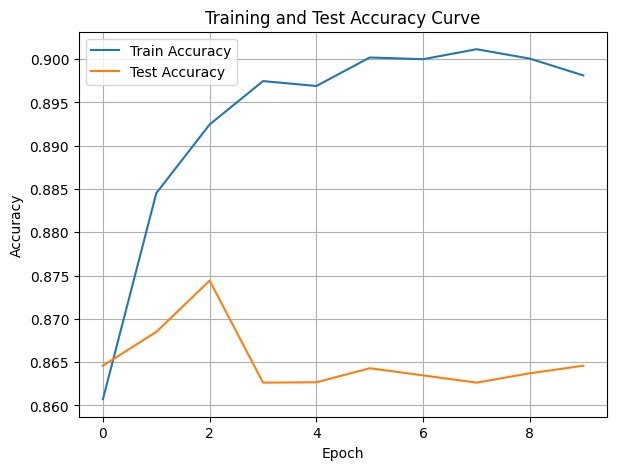

./saved_models/model_14.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [89]:
DTEmlp12b.train_DTE()

Training Process:   0%|          | 1/230 [00:00<00:33,  6.91it/s]

Epoch [1/230], Train F1:0.5828220514690693, Train Loss: 1.0157, Train Acc: 0.5432, Test F1:0.5265145420645662, Test Loss: 1.0638, Test Acc: 0.4740


Training Process:   1%|          | 2/230 [00:00<00:30,  7.52it/s]

Epoch [2/230], Train F1:0.5709532419908144, Train Loss: 1.0160, Train Acc: 0.5327, Test F1:0.49566101341882257, Test Loss: 1.0634, Test Acc: 0.4427


Training Process:   1%|▏         | 3/230 [00:00<00:29,  7.73it/s]

Epoch [3/230], Train F1:0.5811866871290641, Train Loss: 1.0100, Train Acc: 0.5506, Test F1:0.533582356123001, Test Loss: 1.0599, Test Acc: 0.4766


Training Process:   2%|▏         | 4/230 [00:00<00:27,  8.23it/s]

Epoch [4/230], Train F1:0.5908433092764891, Train Loss: 1.0013, Train Acc: 0.5629, Test F1:0.5619428993351371, Test Loss: 1.0527, Test Acc: 0.5082


Training Process:   2%|▏         | 5/230 [00:00<00:26,  8.53it/s]

Epoch [5/230], Train F1:0.5922704477133005, Train Loss: 0.9982, Train Acc: 0.5654, Test F1:0.58840170287677, Test Loss: 1.0494, Test Acc: 0.5366


Training Process:   3%|▎         | 6/230 [00:00<00:26,  8.58it/s]

Epoch [6/230], Train F1:0.5992263444563279, Train Loss: 0.9937, Train Acc: 0.5729, Test F1:0.6004366481905467, Test Loss: 1.0458, Test Acc: 0.5514


Training Process:   3%|▎         | 7/230 [00:00<00:25,  8.63it/s]

Epoch [7/230], Train F1:0.6073795801124374, Train Loss: 0.9895, Train Acc: 0.5793, Test F1:0.6108122494687106, Test Loss: 1.0441, Test Acc: 0.5641


Training Process:   3%|▎         | 8/230 [00:00<00:26,  8.48it/s]

Epoch [8/230], Train F1:0.6144427046221378, Train Loss: 0.9861, Train Acc: 0.5848, Test F1:0.6264697183020944, Test Loss: 1.0405, Test Acc: 0.5840


Training Process:   4%|▍         | 9/230 [00:01<00:25,  8.52it/s]

Epoch [9/230], Train F1:0.6223233693774306, Train Loss: 0.9826, Train Acc: 0.5922, Test F1:0.6366431084532613, Test Loss: 1.0385, Test Acc: 0.5968


Training Process:   4%|▍         | 10/230 [00:01<00:26,  8.44it/s]

Epoch [10/230], Train F1:0.6263564273638882, Train Loss: 0.9801, Train Acc: 0.5982, Test F1:0.6423892965085346, Test Loss: 1.0366, Test Acc: 0.6048


Training Process:   5%|▍         | 11/230 [00:01<00:26,  8.38it/s]

Epoch [11/230], Train F1:0.629276830114953, Train Loss: 0.9780, Train Acc: 0.6006, Test F1:0.6498970230882604, Test Loss: 1.0345, Test Acc: 0.6141


Training Process:   5%|▌         | 12/230 [00:01<00:26,  8.31it/s]

Epoch [12/230], Train F1:0.6335463079713155, Train Loss: 0.9754, Train Acc: 0.6072, Test F1:0.6559224597141438, Test Loss: 1.0320, Test Acc: 0.6219


Training Process:   6%|▌         | 14/230 [00:01<00:29,  7.33it/s]

Epoch [13/230], Train F1:0.637138314670392, Train Loss: 0.9718, Train Acc: 0.6119, Test F1:0.6630404575660368, Test Loss: 1.0301, Test Acc: 0.6312
Epoch [14/230], Train F1:0.6409356364967869, Train Loss: 0.9688, Train Acc: 0.6164, Test F1:0.666735771388572, Test Loss: 1.0286, Test Acc: 0.6361


Training Process:   7%|▋         | 16/230 [00:02<00:28,  7.48it/s]

Epoch [15/230], Train F1:0.6444090870180321, Train Loss: 0.9659, Train Acc: 0.6190, Test F1:0.6703206406283109, Test Loss: 1.0271, Test Acc: 0.6413
Epoch [16/230], Train F1:0.6484689035699691, Train Loss: 0.9632, Train Acc: 0.6239, Test F1:0.6767182783362882, Test Loss: 1.0251, Test Acc: 0.6491


Training Process:   8%|▊         | 18/230 [00:02<00:30,  6.94it/s]

Epoch [17/230], Train F1:0.6535069431750662, Train Loss: 0.9599, Train Acc: 0.6291, Test F1:0.6815489550417687, Test Loss: 1.0237, Test Acc: 0.6555
Epoch [18/230], Train F1:0.6555743097080134, Train Loss: 0.9578, Train Acc: 0.6325, Test F1:0.6874874371285388, Test Loss: 1.0216, Test Acc: 0.6630


Training Process:   9%|▊         | 20/230 [00:02<00:29,  7.19it/s]

Epoch [19/230], Train F1:0.6587790907828044, Train Loss: 0.9550, Train Acc: 0.6363, Test F1:0.6932113442242684, Test Loss: 1.0194, Test Acc: 0.6701
Epoch [20/230], Train F1:0.6617613078342837, Train Loss: 0.9520, Train Acc: 0.6404, Test F1:0.6987536753598768, Test Loss: 1.0173, Test Acc: 0.6772


Training Process:  10%|▉         | 22/230 [00:02<00:27,  7.47it/s]

Epoch [21/230], Train F1:0.6655314831067483, Train Loss: 0.9501, Train Acc: 0.6441, Test F1:0.7046226227792185, Test Loss: 1.0144, Test Acc: 0.6843
Epoch [22/230], Train F1:0.6677552475906308, Train Loss: 0.9475, Train Acc: 0.6474, Test F1:0.7084306540582378, Test Loss: 1.0124, Test Acc: 0.6888


Training Process:  10%|█         | 24/230 [00:03<00:29,  7.02it/s]

Epoch [23/230], Train F1:0.6712192273218867, Train Loss: 0.9443, Train Acc: 0.6514, Test F1:0.7119597936729096, Test Loss: 1.0107, Test Acc: 0.6929
Epoch [24/230], Train F1:0.673760909147998, Train Loss: 0.9420, Train Acc: 0.6540, Test F1:0.7117629092596213, Test Loss: 1.0094, Test Acc: 0.6925


Training Process:  11%|█▏        | 26/230 [00:03<00:34,  5.83it/s]

Epoch [25/230], Train F1:0.6778061987800104, Train Loss: 0.9391, Train Acc: 0.6575, Test F1:0.7152597620916585, Test Loss: 1.0077, Test Acc: 0.6964
Epoch [26/230], Train F1:0.6795763876476244, Train Loss: 0.9372, Train Acc: 0.6594, Test F1:0.7162087924122919, Test Loss: 1.0064, Test Acc: 0.6971


Training Process:  12%|█▏        | 28/230 [00:03<00:33,  5.96it/s]

Epoch [27/230], Train F1:0.6826969568351972, Train Loss: 0.9345, Train Acc: 0.6629, Test F1:0.7202913123778268, Test Loss: 1.0044, Test Acc: 0.7020
Epoch [28/230], Train F1:0.6857133546487127, Train Loss: 0.9321, Train Acc: 0.6664, Test F1:0.7242938245510894, Test Loss: 1.0024, Test Acc: 0.7069


Training Process:  13%|█▎        | 30/230 [00:04<00:33,  6.05it/s]

Epoch [29/230], Train F1:0.6879373504670715, Train Loss: 0.9299, Train Acc: 0.6692, Test F1:0.7263834945342493, Test Loss: 1.0008, Test Acc: 0.7093
Epoch [30/230], Train F1:0.69131481541101, Train Loss: 0.9272, Train Acc: 0.6729, Test F1:0.7290584382691816, Test Loss: 0.9991, Test Acc: 0.7125


Training Process:  14%|█▍        | 32/230 [00:04<00:33,  6.00it/s]

Epoch [31/230], Train F1:0.6941689154353231, Train Loss: 0.9247, Train Acc: 0.6759, Test F1:0.7320725073118393, Test Loss: 0.9973, Test Acc: 0.7162
Epoch [32/230], Train F1:0.6977788853292611, Train Loss: 0.9222, Train Acc: 0.6794, Test F1:0.7348346683597496, Test Loss: 0.9954, Test Acc: 0.7197


Training Process:  14%|█▍        | 33/230 [00:04<00:34,  5.63it/s]

Epoch [33/230], Train F1:0.7008001337393918, Train Loss: 0.9200, Train Acc: 0.6827, Test F1:0.7370748725671299, Test Loss: 0.9938, Test Acc: 0.7225


Training Process:  15%|█▍        | 34/230 [00:04<00:37,  5.25it/s]

Epoch [34/230], Train F1:0.7030577542584938, Train Loss: 0.9176, Train Acc: 0.6857, Test F1:0.7383113055765399, Test Loss: 0.9927, Test Acc: 0.7238


Training Process:  15%|█▌        | 35/230 [00:05<00:39,  4.92it/s]

Epoch [35/230], Train F1:0.7058826904173586, Train Loss: 0.9148, Train Acc: 0.6892, Test F1:0.7410051927705673, Test Loss: 0.9906, Test Acc: 0.7272


Training Process:  16%|█▌        | 36/230 [00:05<00:40,  4.78it/s]

Epoch [36/230], Train F1:0.7083601245864556, Train Loss: 0.9124, Train Acc: 0.6924, Test F1:0.7433301427931184, Test Loss: 0.9892, Test Acc: 0.7301


Training Process:  16%|█▌        | 37/230 [00:05<00:45,  4.23it/s]

Epoch [37/230], Train F1:0.7108141717377436, Train Loss: 0.9102, Train Acc: 0.6952, Test F1:0.7451010015170686, Test Loss: 0.9875, Test Acc: 0.7322


Training Process:  17%|█▋        | 38/230 [00:05<00:46,  4.17it/s]

Epoch [38/230], Train F1:0.7130142463372852, Train Loss: 0.9080, Train Acc: 0.6981, Test F1:0.7466274427149163, Test Loss: 0.9861, Test Acc: 0.7335


Training Process:  17%|█▋        | 39/230 [00:06<00:46,  4.13it/s]

Epoch [39/230], Train F1:0.7161120242802551, Train Loss: 0.9058, Train Acc: 0.7011, Test F1:0.7488355687930516, Test Loss: 0.9845, Test Acc: 0.7363


Training Process:  18%|█▊        | 41/230 [00:06<00:40,  4.63it/s]

Epoch [40/230], Train F1:0.7185958992742193, Train Loss: 0.9037, Train Acc: 0.7037, Test F1:0.7509342789395282, Test Loss: 0.9827, Test Acc: 0.7389
Epoch [41/230], Train F1:0.7208945668866507, Train Loss: 0.9014, Train Acc: 0.7066, Test F1:0.7527372764938737, Test Loss: 0.9811, Test Acc: 0.7412


Training Process:  19%|█▊        | 43/230 [00:06<00:33,  5.54it/s]

Epoch [42/230], Train F1:0.7230540379808568, Train Loss: 0.8996, Train Acc: 0.7089, Test F1:0.7546448684338222, Test Loss: 0.9793, Test Acc: 0.7436
Epoch [43/230], Train F1:0.7246932049051615, Train Loss: 0.8979, Train Acc: 0.7106, Test F1:0.7564645821692952, Test Loss: 0.9772, Test Acc: 0.7459


Training Process:  20%|█▉        | 45/230 [00:07<00:32,  5.63it/s]

Epoch [44/230], Train F1:0.7270117856292713, Train Loss: 0.8957, Train Acc: 0.7131, Test F1:0.7578855189009773, Test Loss: 0.9757, Test Acc: 0.7475
Epoch [45/230], Train F1:0.7291788058212957, Train Loss: 0.8937, Train Acc: 0.7153, Test F1:0.7586668889721133, Test Loss: 0.9743, Test Acc: 0.7482


Training Process:  20%|██        | 47/230 [00:07<00:31,  5.74it/s]

Epoch [46/230], Train F1:0.7316722602502624, Train Loss: 0.8916, Train Acc: 0.7180, Test F1:0.7592805953841449, Test Loss: 0.9732, Test Acc: 0.7485
Epoch [47/230], Train F1:0.7338824409073529, Train Loss: 0.8897, Train Acc: 0.7205, Test F1:0.7610603296949628, Test Loss: 0.9717, Test Acc: 0.7506


Training Process:  21%|██▏       | 49/230 [00:07<00:31,  5.83it/s]

Epoch [48/230], Train F1:0.7360980564954456, Train Loss: 0.8879, Train Acc: 0.7225, Test F1:0.7627666587989951, Test Loss: 0.9703, Test Acc: 0.7527
Epoch [49/230], Train F1:0.7382182007376225, Train Loss: 0.8861, Train Acc: 0.7245, Test F1:0.7644040493234284, Test Loss: 0.9688, Test Acc: 0.7546


Training Process:  22%|██▏       | 50/230 [00:08<00:35,  5.06it/s]

Epoch [50/230], Train F1:0.7402540490582424, Train Loss: 0.8842, Train Acc: 0.7268, Test F1:0.7654907428350392, Test Loss: 0.9675, Test Acc: 0.7555


Training Process:  22%|██▏       | 51/230 [00:08<00:35,  5.05it/s]

Epoch [51/230], Train F1:0.7418986900647461, Train Loss: 0.8826, Train Acc: 0.7283, Test F1:0.7671684206092317, Test Loss: 0.9661, Test Acc: 0.7575


Training Process:  23%|██▎       | 52/230 [00:08<00:35,  4.99it/s]

Epoch [52/230], Train F1:0.7434322590869121, Train Loss: 0.8809, Train Acc: 0.7300, Test F1:0.7686281435617801, Test Loss: 0.9645, Test Acc: 0.7593


Training Process:  23%|██▎       | 53/230 [00:08<00:35,  5.03it/s]

Epoch [53/230], Train F1:0.7456377319316507, Train Loss: 0.8791, Train Acc: 0.7323, Test F1:0.7688866518324345, Test Loss: 0.9634, Test Acc: 0.7594


Training Process:  23%|██▎       | 54/230 [00:09<00:35,  5.00it/s]

Epoch [54/230], Train F1:0.7465512546199746, Train Loss: 0.8777, Train Acc: 0.7332, Test F1:0.7702607613543159, Test Loss: 0.9618, Test Acc: 0.7611


Training Process:  24%|██▍       | 55/230 [00:09<00:34,  5.07it/s]

Epoch [55/230], Train F1:0.7486686051087942, Train Loss: 0.8759, Train Acc: 0.7355, Test F1:0.7715854095951769, Test Loss: 0.9602, Test Acc: 0.7627


Training Process:  24%|██▍       | 56/230 [00:09<00:34,  5.05it/s]

Epoch [56/230], Train F1:0.7502059200283784, Train Loss: 0.8744, Train Acc: 0.7372, Test F1:0.7724328853692624, Test Loss: 0.9590, Test Acc: 0.7637


Training Process:  25%|██▍       | 57/230 [00:09<00:35,  4.93it/s]

Epoch [57/230], Train F1:0.7521282728570288, Train Loss: 0.8725, Train Acc: 0.7393, Test F1:0.7736736919820949, Test Loss: 0.9575, Test Acc: 0.7652


Training Process:  25%|██▌       | 58/230 [00:09<00:35,  4.86it/s]

Epoch [58/230], Train F1:0.75366924228386, Train Loss: 0.8708, Train Acc: 0.7412, Test F1:0.7744563350877971, Test Loss: 0.9562, Test Acc: 0.7661


Training Process:  26%|██▌       | 59/230 [00:10<00:35,  4.77it/s]

Epoch [59/230], Train F1:0.7550412283597124, Train Loss: 0.8693, Train Acc: 0.7427, Test F1:0.7756214552254878, Test Loss: 0.9549, Test Acc: 0.7675


Training Process:  26%|██▌       | 60/230 [00:10<00:36,  4.70it/s]

Epoch [60/230], Train F1:0.7564304154405457, Train Loss: 0.8679, Train Acc: 0.7443, Test F1:0.7767481333327504, Test Loss: 0.9535, Test Acc: 0.7689


Training Process:  27%|██▋       | 61/230 [00:10<00:36,  4.66it/s]

Epoch [61/230], Train F1:0.7575461056778674, Train Loss: 0.8663, Train Acc: 0.7457, Test F1:0.7779394403267228, Test Loss: 0.9519, Test Acc: 0.7702


Training Process:  27%|██▋       | 62/230 [00:10<00:35,  4.77it/s]

Epoch [62/230], Train F1:0.7589137814010529, Train Loss: 0.8651, Train Acc: 0.7469, Test F1:0.7789237205909004, Test Loss: 0.9507, Test Acc: 0.7714


Training Process:  27%|██▋       | 63/230 [00:10<00:37,  4.47it/s]

Epoch [63/230], Train F1:0.7603916817790065, Train Loss: 0.8635, Train Acc: 0.7485, Test F1:0.7799453620276029, Test Loss: 0.9493, Test Acc: 0.7726


Training Process:  28%|██▊       | 64/230 [00:11<00:36,  4.58it/s]

Epoch [64/230], Train F1:0.762147788771379, Train Loss: 0.8620, Train Acc: 0.7503, Test F1:0.7809354003665301, Test Loss: 0.9477, Test Acc: 0.7738


Training Process:  28%|██▊       | 65/230 [00:11<00:34,  4.73it/s]

Epoch [65/230], Train F1:0.7632082615532975, Train Loss: 0.8607, Train Acc: 0.7516, Test F1:0.7818952837270372, Test Loss: 0.9465, Test Acc: 0.7749


Training Process:  29%|██▊       | 66/230 [00:11<00:34,  4.80it/s]

Epoch [66/230], Train F1:0.7644868571694826, Train Loss: 0.8593, Train Acc: 0.7529, Test F1:0.7824220370342985, Test Loss: 0.9454, Test Acc: 0.7754


Training Process:  29%|██▉       | 67/230 [00:11<00:33,  4.91it/s]

Epoch [67/230], Train F1:0.7657934012004995, Train Loss: 0.8578, Train Acc: 0.7544, Test F1:0.7833314100392582, Test Loss: 0.9440, Test Acc: 0.7765


Training Process:  30%|██▉       | 68/230 [00:11<00:33,  4.90it/s]

Epoch [68/230], Train F1:0.7670791489860869, Train Loss: 0.8563, Train Acc: 0.7558, Test F1:0.7840312252639483, Test Loss: 0.9429, Test Acc: 0.7772


Training Process:  30%|███       | 69/230 [00:12<00:32,  4.88it/s]

Epoch [69/230], Train F1:0.7686488279867388, Train Loss: 0.8547, Train Acc: 0.7576, Test F1:0.7848913221317594, Test Loss: 0.9415, Test Acc: 0.7782


Training Process:  30%|███       | 70/230 [00:12<00:33,  4.77it/s]

Epoch [70/230], Train F1:0.7695802610323734, Train Loss: 0.8534, Train Acc: 0.7586, Test F1:0.7857270904514254, Test Loss: 0.9401, Test Acc: 0.7792


Training Process:  31%|███       | 71/230 [00:12<00:33,  4.73it/s]

Epoch [71/230], Train F1:0.7707650172655794, Train Loss: 0.8521, Train Acc: 0.7599, Test F1:0.786301413083718, Test Loss: 0.9391, Test Acc: 0.7797


Training Process:  31%|███▏      | 72/230 [00:12<00:33,  4.69it/s]

Epoch [72/230], Train F1:0.771953336221955, Train Loss: 0.8507, Train Acc: 0.7613, Test F1:0.7870946657889756, Test Loss: 0.9378, Test Acc: 0.7806


Training Process:  32%|███▏      | 73/230 [00:13<00:34,  4.55it/s]

Epoch [73/230], Train F1:0.773045533345403, Train Loss: 0.8493, Train Acc: 0.7627, Test F1:0.7878664010794018, Test Loss: 0.9366, Test Acc: 0.7816


Training Process:  32%|███▏      | 74/230 [00:13<00:35,  4.45it/s]

Epoch [74/230], Train F1:0.7741569230062957, Train Loss: 0.8479, Train Acc: 0.7639, Test F1:0.788617484930452, Test Loss: 0.9354, Test Acc: 0.7825


Training Process:  33%|███▎      | 75/230 [00:13<00:35,  4.38it/s]

Epoch [75/230], Train F1:0.7754184112249203, Train Loss: 0.8466, Train Acc: 0.7651, Test F1:0.7893487373528109, Test Loss: 0.9341, Test Acc: 0.7834


Training Process:  33%|███▎      | 76/230 [00:13<00:40,  3.77it/s]

Epoch [76/230], Train F1:0.7764946242090057, Train Loss: 0.8454, Train Acc: 0.7661, Test F1:0.7900261667540334, Test Loss: 0.9331, Test Acc: 0.7840


Training Process:  33%|███▎      | 77/230 [00:14<00:40,  3.74it/s]

Epoch [77/230], Train F1:0.7776466339958921, Train Loss: 0.8440, Train Acc: 0.7674, Test F1:0.7907204289337957, Test Loss: 0.9318, Test Acc: 0.7848


Training Process:  34%|███▍      | 78/230 [00:14<00:41,  3.69it/s]

Epoch [78/230], Train F1:0.7788459299871069, Train Loss: 0.8429, Train Acc: 0.7684, Test F1:0.7913970633534018, Test Loss: 0.9307, Test Acc: 0.7856


Training Process:  34%|███▍      | 79/230 [00:14<00:39,  3.83it/s]

Epoch [79/230], Train F1:0.7793662823146054, Train Loss: 0.8418, Train Acc: 0.7690, Test F1:0.7922617836479611, Test Loss: 0.9293, Test Acc: 0.7866


Training Process:  35%|███▍      | 80/230 [00:14<00:37,  3.98it/s]

Epoch [80/230], Train F1:0.7801623982632199, Train Loss: 0.8406, Train Acc: 0.7699, Test F1:0.7929026158538337, Test Loss: 0.9282, Test Acc: 0.7874


Training Process:  35%|███▌      | 81/230 [00:15<00:37,  4.00it/s]

Epoch [81/230], Train F1:0.7810913007510847, Train Loss: 0.8395, Train Acc: 0.7709, Test F1:0.7936168270519874, Test Loss: 0.9273, Test Acc: 0.7881


Training Process:  36%|███▌      | 82/230 [00:15<00:37,  3.97it/s]

Epoch [82/230], Train F1:0.7821353170877133, Train Loss: 0.8382, Train Acc: 0.7721, Test F1:0.7942257564878765, Test Loss: 0.9262, Test Acc: 0.7889


Training Process:  36%|███▌      | 83/230 [00:15<00:37,  3.95it/s]

Epoch [83/230], Train F1:0.7831625878820073, Train Loss: 0.8369, Train Acc: 0.7734, Test F1:0.7949178615722436, Test Loss: 0.9249, Test Acc: 0.7897


Training Process:  37%|███▋      | 84/230 [00:15<00:36,  4.00it/s]

Epoch [84/230], Train F1:0.7841516563599665, Train Loss: 0.8357, Train Acc: 0.7744, Test F1:0.7954971027389199, Test Loss: 0.9238, Test Acc: 0.7904


Training Process:  37%|███▋      | 85/230 [00:16<00:35,  4.03it/s]

Epoch [85/230], Train F1:0.7851885686098652, Train Loss: 0.8346, Train Acc: 0.7755, Test F1:0.7962537705855622, Test Loss: 0.9224, Test Acc: 0.7912


Training Process:  37%|███▋      | 86/230 [00:16<00:35,  4.06it/s]

Epoch [86/230], Train F1:0.7864187111710355, Train Loss: 0.8332, Train Acc: 0.7769, Test F1:0.7968043063336145, Test Loss: 0.9213, Test Acc: 0.7919


Training Process:  38%|███▊      | 87/230 [00:16<00:39,  3.64it/s]

Epoch [87/230], Train F1:0.7872951552771784, Train Loss: 0.8322, Train Acc: 0.7778, Test F1:0.7973423050500731, Test Loss: 0.9202, Test Acc: 0.7926


Training Process:  38%|███▊      | 88/230 [00:16<00:39,  3.61it/s]

Epoch [88/230], Train F1:0.7879246195576368, Train Loss: 0.8311, Train Acc: 0.7784, Test F1:0.7978681909659592, Test Loss: 0.9192, Test Acc: 0.7932


Training Process:  39%|███▊      | 89/230 [00:17<00:39,  3.61it/s]

Epoch [89/230], Train F1:0.7888424800664422, Train Loss: 0.8299, Train Acc: 0.7794, Test F1:0.7983823693506804, Test Loss: 0.9181, Test Acc: 0.7938


Training Process:  39%|███▉      | 90/230 [00:17<00:38,  3.60it/s]

Epoch [90/230], Train F1:0.7899556359111419, Train Loss: 0.8289, Train Acc: 0.7806, Test F1:0.7989755011391997, Test Loss: 0.9168, Test Acc: 0.7945


Training Process:  40%|███▉      | 91/230 [00:17<00:39,  3.55it/s]

Epoch [91/230], Train F1:0.7909663007874141, Train Loss: 0.8277, Train Acc: 0.7816, Test F1:0.7995557436621802, Test Loss: 0.9155, Test Acc: 0.7952


Training Process:  40%|████      | 92/230 [00:18<00:39,  3.47it/s]

Epoch [92/230], Train F1:0.7919769799796167, Train Loss: 0.8266, Train Acc: 0.7828, Test F1:0.7998584491499615, Test Loss: 0.9146, Test Acc: 0.7956


Training Process:  40%|████      | 93/230 [00:18<00:39,  3.43it/s]

Epoch [93/230], Train F1:0.7928941259990274, Train Loss: 0.8254, Train Acc: 0.7837, Test F1:0.8003295061918406, Test Loss: 0.9135, Test Acc: 0.7961


Training Process:  41%|████      | 94/230 [00:18<00:38,  3.55it/s]

Epoch [94/230], Train F1:0.7937605251623097, Train Loss: 0.8244, Train Acc: 0.7846, Test F1:0.8007906320493584, Test Loss: 0.9126, Test Acc: 0.7967


Training Process:  41%|████▏     | 95/230 [00:18<00:36,  3.66it/s]

Epoch [95/230], Train F1:0.7945293594894935, Train Loss: 0.8234, Train Acc: 0.7854, Test F1:0.8012421380200473, Test Loss: 0.9115, Test Acc: 0.7973


Training Process:  42%|████▏     | 96/230 [00:19<00:35,  3.73it/s]

Epoch [96/230], Train F1:0.7954938246000163, Train Loss: 0.8223, Train Acc: 0.7865, Test F1:0.8015148445522755, Test Loss: 0.9106, Test Acc: 0.7976


Training Process:  42%|████▏     | 97/230 [00:19<00:35,  3.77it/s]

Epoch [97/230], Train F1:0.7964075121182307, Train Loss: 0.8214, Train Acc: 0.7874, Test F1:0.8021436203035455, Test Loss: 0.9098, Test Acc: 0.7981


Training Process:  43%|████▎     | 98/230 [00:19<00:37,  3.51it/s]

Epoch [98/230], Train F1:0.7971968369190597, Train Loss: 0.8202, Train Acc: 0.7883, Test F1:0.8026038029652468, Test Loss: 0.9089, Test Acc: 0.7986


Training Process:  43%|████▎     | 99/230 [00:20<00:37,  3.53it/s]

Epoch [99/230], Train F1:0.7981934897425066, Train Loss: 0.8191, Train Acc: 0.7895, Test F1:0.803183468341207, Test Loss: 0.9078, Test Acc: 0.7992


Training Process:  43%|████▎     | 100/230 [00:20<00:36,  3.57it/s]

Epoch [100/230], Train F1:0.799034376100903, Train Loss: 0.8182, Train Acc: 0.7903, Test F1:0.803670249930085, Test Loss: 0.9067, Test Acc: 0.7998


Training Process:  44%|████▍     | 101/230 [00:20<00:36,  3.57it/s]

Epoch [101/230], Train F1:0.7997025356620006, Train Loss: 0.8171, Train Acc: 0.7911, Test F1:0.8042805531850047, Test Loss: 0.9058, Test Acc: 0.8005


Training Process:  44%|████▍     | 102/230 [00:20<00:36,  3.55it/s]

Epoch [102/230], Train F1:0.800574055299452, Train Loss: 0.8161, Train Acc: 0.7921, Test F1:0.8047472438144445, Test Loss: 0.9046, Test Acc: 0.8010


Training Process:  45%|████▍     | 103/230 [00:21<00:36,  3.52it/s]

Epoch [103/230], Train F1:0.8015059253359218, Train Loss: 0.8151, Train Acc: 0.7930, Test F1:0.8052220532380379, Test Loss: 0.9037, Test Acc: 0.8016


Training Process:  45%|████▌     | 104/230 [00:21<00:36,  3.43it/s]

Epoch [104/230], Train F1:0.8022390917249884, Train Loss: 0.8141, Train Acc: 0.7938, Test F1:0.8056709039773874, Test Loss: 0.9027, Test Acc: 0.8021


Training Process:  46%|████▌     | 105/230 [00:21<00:37,  3.37it/s]

Epoch [105/230], Train F1:0.8028895635416056, Train Loss: 0.8132, Train Acc: 0.7944, Test F1:0.8061112972600316, Test Loss: 0.9017, Test Acc: 0.8026


Training Process:  46%|████▌     | 106/230 [00:22<00:37,  3.30it/s]

Epoch [106/230], Train F1:0.8036131297587562, Train Loss: 0.8122, Train Acc: 0.7953, Test F1:0.8065434704388003, Test Loss: 0.9006, Test Acc: 0.8031


Training Process:  47%|████▋     | 107/230 [00:22<00:37,  3.25it/s]

Epoch [107/230], Train F1:0.8043547938344046, Train Loss: 0.8114, Train Acc: 0.7960, Test F1:0.8070438915297791, Test Loss: 0.8994, Test Acc: 0.8037


Training Process:  47%|████▋     | 108/230 [00:22<00:36,  3.36it/s]

Epoch [108/230], Train F1:0.8049192892623284, Train Loss: 0.8105, Train Acc: 0.7965, Test F1:0.8074596115776669, Test Loss: 0.8985, Test Acc: 0.8042


Training Process:  47%|████▋     | 109/230 [00:23<00:38,  3.14it/s]

Epoch [109/230], Train F1:0.8058690815955476, Train Loss: 0.8095, Train Acc: 0.7976, Test F1:0.8079426592355268, Test Loss: 0.8974, Test Acc: 0.8047


Training Process:  48%|████▊     | 110/230 [00:23<00:37,  3.24it/s]

Epoch [110/230], Train F1:0.8066529407377542, Train Loss: 0.8084, Train Acc: 0.7984, Test F1:0.808432987323123, Test Loss: 0.8965, Test Acc: 0.8053


Training Process:  48%|████▊     | 111/230 [00:23<00:35,  3.33it/s]

Epoch [111/230], Train F1:0.8075227409838337, Train Loss: 0.8074, Train Acc: 0.7994, Test F1:0.808872533984273, Test Loss: 0.8957, Test Acc: 0.8057


Training Process:  49%|████▊     | 112/230 [00:23<00:35,  3.33it/s]

Epoch [112/230], Train F1:0.8083700501311244, Train Loss: 0.8065, Train Acc: 0.8002, Test F1:0.809366266112174, Test Loss: 0.8950, Test Acc: 0.8061


Training Process:  49%|████▉     | 113/230 [00:24<00:35,  3.34it/s]

Epoch [113/230], Train F1:0.8088471690615591, Train Loss: 0.8057, Train Acc: 0.8008, Test F1:0.8097433999700753, Test Loss: 0.8940, Test Acc: 0.8066


Training Process:  50%|████▉     | 114/230 [00:24<00:34,  3.34it/s]

Epoch [114/230], Train F1:0.8095479623301126, Train Loss: 0.8050, Train Acc: 0.8014, Test F1:0.8103181283945771, Test Loss: 0.8932, Test Acc: 0.8072


Training Process:  50%|█████     | 115/230 [00:24<00:34,  3.29it/s]

Epoch [115/230], Train F1:0.8101937328022734, Train Loss: 0.8041, Train Acc: 0.8020, Test F1:0.8106433005783371, Test Loss: 0.8926, Test Acc: 0.8074


Training Process:  50%|█████     | 116/230 [00:25<00:35,  3.25it/s]

Epoch [116/230], Train F1:0.8109997081248612, Train Loss: 0.8031, Train Acc: 0.8029, Test F1:0.8111588943610794, Test Loss: 0.8920, Test Acc: 0.8079


Training Process:  51%|█████     | 117/230 [00:25<00:35,  3.19it/s]

Epoch [117/230], Train F1:0.8116335012471007, Train Loss: 0.8023, Train Acc: 0.8036, Test F1:0.8117206582250226, Test Loss: 0.8912, Test Acc: 0.8084


Training Process:  51%|█████▏    | 118/230 [00:25<00:36,  3.11it/s]

Epoch [118/230], Train F1:0.8122974250433648, Train Loss: 0.8014, Train Acc: 0.8043, Test F1:0.812217699686228, Test Loss: 0.8906, Test Acc: 0.8088


Training Process:  52%|█████▏    | 119/230 [00:26<00:39,  2.80it/s]

Epoch [119/230], Train F1:0.8130495533948457, Train Loss: 0.8005, Train Acc: 0.8051, Test F1:0.8125522394594169, Test Loss: 0.8896, Test Acc: 0.8092


Training Process:  52%|█████▏    | 120/230 [00:26<00:38,  2.83it/s]

Epoch [120/230], Train F1:0.813698870545947, Train Loss: 0.7997, Train Acc: 0.8058, Test F1:0.8130477733089462, Test Loss: 0.8889, Test Acc: 0.8096


Training Process:  53%|█████▎    | 121/230 [00:26<00:36,  2.96it/s]

Epoch [121/230], Train F1:0.8142537677019916, Train Loss: 0.7988, Train Acc: 0.8064, Test F1:0.8133700466009629, Test Loss: 0.8880, Test Acc: 0.8100


Training Process:  53%|█████▎    | 122/230 [00:27<00:35,  3.06it/s]

Epoch [122/230], Train F1:0.8148534496009143, Train Loss: 0.7981, Train Acc: 0.8070, Test F1:0.813767968707724, Test Loss: 0.8872, Test Acc: 0.8105


Training Process:  53%|█████▎    | 123/230 [00:27<00:34,  3.12it/s]

Epoch [123/230], Train F1:0.8153382231451304, Train Loss: 0.7973, Train Acc: 0.8076, Test F1:0.8140792599681325, Test Loss: 0.8862, Test Acc: 0.8109


Training Process:  54%|█████▍    | 124/230 [00:27<00:33,  3.15it/s]

Epoch [124/230], Train F1:0.8160059558787426, Train Loss: 0.7965, Train Acc: 0.8082, Test F1:0.8145717627123271, Test Loss: 0.8854, Test Acc: 0.8114


Training Process:  54%|█████▍    | 125/230 [00:28<00:33,  3.14it/s]

Epoch [125/230], Train F1:0.8166210969425983, Train Loss: 0.7955, Train Acc: 0.8089, Test F1:0.8149506881258454, Test Loss: 0.8845, Test Acc: 0.8118


Training Process:  55%|█████▍    | 126/230 [00:28<00:32,  3.15it/s]

Epoch [126/230], Train F1:0.8171657099922016, Train Loss: 0.7947, Train Acc: 0.8095, Test F1:0.8152453564097993, Test Loss: 0.8835, Test Acc: 0.8121


Training Process:  55%|█████▌    | 127/230 [00:28<00:32,  3.12it/s]

Epoch [127/230], Train F1:0.8176185518257008, Train Loss: 0.7941, Train Acc: 0.8100, Test F1:0.8156908132535932, Test Loss: 0.8827, Test Acc: 0.8126


Training Process:  56%|█████▌    | 128/230 [00:29<00:33,  3.03it/s]

Epoch [128/230], Train F1:0.8181974897298013, Train Loss: 0.7932, Train Acc: 0.8106, Test F1:0.8159752035856227, Test Loss: 0.8818, Test Acc: 0.8130


Training Process:  56%|█████▌    | 129/230 [00:29<00:36,  2.75it/s]

Epoch [129/230], Train F1:0.8187620226522077, Train Loss: 0.7924, Train Acc: 0.8113, Test F1:0.8163187839458423, Test Loss: 0.8808, Test Acc: 0.8134


Training Process:  57%|█████▋    | 130/230 [00:30<00:36,  2.72it/s]

Epoch [130/230], Train F1:0.819310019733816, Train Loss: 0.7917, Train Acc: 0.8118, Test F1:0.8167458943961493, Test Loss: 0.8800, Test Acc: 0.8138


Training Process:  57%|█████▋    | 131/230 [00:30<00:36,  2.69it/s]

Epoch [131/230], Train F1:0.819868010217973, Train Loss: 0.7909, Train Acc: 0.8124, Test F1:0.8172046132723023, Test Loss: 0.8793, Test Acc: 0.8142


Training Process:  57%|█████▋    | 132/230 [00:30<00:35,  2.77it/s]

Epoch [132/230], Train F1:0.82051166804088, Train Loss: 0.7901, Train Acc: 0.8131, Test F1:0.8176562263057006, Test Loss: 0.8787, Test Acc: 0.8146


Training Process:  58%|█████▊    | 133/230 [00:31<00:33,  2.88it/s]

Epoch [133/230], Train F1:0.821263065557563, Train Loss: 0.7892, Train Acc: 0.8139, Test F1:0.818063681390784, Test Loss: 0.8779, Test Acc: 0.8150


Training Process:  58%|█████▊    | 134/230 [00:31<00:33,  2.85it/s]

Epoch [134/230], Train F1:0.8218319825035376, Train Loss: 0.7884, Train Acc: 0.8145, Test F1:0.8185509625165929, Test Loss: 0.8772, Test Acc: 0.8155


Training Process:  59%|█████▊    | 135/230 [00:31<00:32,  2.89it/s]

Epoch [135/230], Train F1:0.822387498050992, Train Loss: 0.7876, Train Acc: 0.8152, Test F1:0.8188606202974537, Test Loss: 0.8762, Test Acc: 0.8159


Training Process:  59%|█████▉    | 136/230 [00:32<00:32,  2.92it/s]

Epoch [136/230], Train F1:0.8230259863874421, Train Loss: 0.7868, Train Acc: 0.8159, Test F1:0.8191657752891031, Test Loss: 0.8754, Test Acc: 0.8162


Training Process:  60%|█████▉    | 137/230 [00:32<00:32,  2.90it/s]

Epoch [137/230], Train F1:0.823546698215564, Train Loss: 0.7861, Train Acc: 0.8165, Test F1:0.8194785484891919, Test Loss: 0.8746, Test Acc: 0.8166


Training Process:  60%|██████    | 138/230 [00:32<00:31,  2.88it/s]

Epoch [138/230], Train F1:0.8240339412879771, Train Loss: 0.7853, Train Acc: 0.8170, Test F1:0.8197868317858157, Test Loss: 0.8737, Test Acc: 0.8169


Training Process:  60%|██████    | 139/230 [00:33<00:34,  2.67it/s]

Epoch [139/230], Train F1:0.8244925443967115, Train Loss: 0.7847, Train Acc: 0.8175, Test F1:0.8201616549907559, Test Loss: 0.8729, Test Acc: 0.8173


Training Process:  61%|██████    | 140/230 [00:33<00:34,  2.64it/s]

Epoch [140/230], Train F1:0.8249717062505613, Train Loss: 0.7840, Train Acc: 0.8180, Test F1:0.8205311628435225, Test Loss: 0.8722, Test Acc: 0.8177


Training Process:  61%|██████▏   | 141/230 [00:33<00:33,  2.65it/s]

Epoch [141/230], Train F1:0.8253032812961711, Train Loss: 0.7833, Train Acc: 0.8184, Test F1:0.8208139118220935, Test Loss: 0.8713, Test Acc: 0.8181


Training Process:  62%|██████▏   | 142/230 [00:34<00:33,  2.62it/s]

Epoch [142/230], Train F1:0.8256515276405316, Train Loss: 0.7827, Train Acc: 0.8187, Test F1:0.8211967854609726, Test Loss: 0.8707, Test Acc: 0.8184


Training Process:  62%|██████▏   | 143/230 [00:34<00:32,  2.68it/s]

Epoch [143/230], Train F1:0.8261694387489045, Train Loss: 0.7821, Train Acc: 0.8192, Test F1:0.8215509473768767, Test Loss: 0.8701, Test Acc: 0.8187


Training Process:  63%|██████▎   | 144/230 [00:35<00:31,  2.77it/s]

Epoch [144/230], Train F1:0.8264460867374956, Train Loss: 0.7815, Train Acc: 0.8196, Test F1:0.821968205297525, Test Loss: 0.8696, Test Acc: 0.8191


Training Process:  63%|██████▎   | 145/230 [00:35<00:30,  2.81it/s]

Epoch [145/230], Train F1:0.826893136559876, Train Loss: 0.7809, Train Acc: 0.8199, Test F1:0.8219365815816811, Test Loss: 0.8692, Test Acc: 0.8191


Training Process:  63%|██████▎   | 146/230 [00:35<00:29,  2.84it/s]

Epoch [146/230], Train F1:0.8272390952978568, Train Loss: 0.7804, Train Acc: 0.8202, Test F1:0.8212617026309125, Test Loss: 0.8688, Test Acc: 0.8183


Training Process:  64%|██████▍   | 147/230 [00:36<00:29,  2.84it/s]

Epoch [147/230], Train F1:0.8275924203010401, Train Loss: 0.7798, Train Acc: 0.8205, Test F1:0.8216705330206785, Test Loss: 0.8683, Test Acc: 0.8187


Training Process:  64%|██████▍   | 148/230 [00:36<00:29,  2.81it/s]

Epoch [148/230], Train F1:0.828160355949324, Train Loss: 0.7791, Train Acc: 0.8211, Test F1:0.8221419485305859, Test Loss: 0.8677, Test Acc: 0.8192


Training Process:  65%|██████▍   | 149/230 [00:36<00:31,  2.59it/s]

Epoch [149/230], Train F1:0.8285286661415003, Train Loss: 0.7785, Train Acc: 0.8215, Test F1:0.822541246787901, Test Loss: 0.8670, Test Acc: 0.8196


Training Process:  65%|██████▌   | 150/230 [00:37<00:31,  2.56it/s]

Epoch [150/230], Train F1:0.8290181014582061, Train Loss: 0.7778, Train Acc: 0.8220, Test F1:0.8228488536343594, Test Loss: 0.8661, Test Acc: 0.8200


Training Process:  66%|██████▌   | 151/230 [00:37<00:31,  2.54it/s]

Epoch [151/230], Train F1:0.8294553740369961, Train Loss: 0.7772, Train Acc: 0.8225, Test F1:0.8233032209948582, Test Loss: 0.8655, Test Acc: 0.8204


Training Process:  66%|██████▌   | 152/230 [00:38<00:30,  2.52it/s]

Epoch [152/230], Train F1:0.8299638841526203, Train Loss: 0.7766, Train Acc: 0.8230, Test F1:0.823718122654951, Test Loss: 0.8649, Test Acc: 0.8208


Training Process:  67%|██████▋   | 153/230 [00:38<00:31,  2.48it/s]

Epoch [153/230], Train F1:0.8304616519695533, Train Loss: 0.7759, Train Acc: 0.8236, Test F1:0.8240122186448825, Test Loss: 0.8641, Test Acc: 0.8212


Training Process:  67%|██████▋   | 154/230 [00:38<00:29,  2.57it/s]

Epoch [154/230], Train F1:0.8308377291684792, Train Loss: 0.7752, Train Acc: 0.8240, Test F1:0.8242592635560814, Test Loss: 0.8633, Test Acc: 0.8215


Training Process:  67%|██████▋   | 155/230 [00:39<00:28,  2.64it/s]

Epoch [155/230], Train F1:0.8312069164081118, Train Loss: 0.7746, Train Acc: 0.8245, Test F1:0.8245664022203053, Test Loss: 0.8625, Test Acc: 0.8218


Training Process:  68%|██████▊   | 156/230 [00:39<00:27,  2.68it/s]

Epoch [156/230], Train F1:0.8315385784126558, Train Loss: 0.7740, Train Acc: 0.8248, Test F1:0.8249324756400738, Test Loss: 0.8619, Test Acc: 0.8222


Training Process:  68%|██████▊   | 157/230 [00:39<00:27,  2.69it/s]

Epoch [157/230], Train F1:0.8321145713733227, Train Loss: 0.7733, Train Acc: 0.8255, Test F1:0.8253563396088681, Test Loss: 0.8613, Test Acc: 0.8226


Training Process:  69%|██████▊   | 158/230 [00:40<00:26,  2.69it/s]

Epoch [158/230], Train F1:0.832536848504611, Train Loss: 0.7727, Train Acc: 0.8260, Test F1:0.8257748465465502, Test Loss: 0.8606, Test Acc: 0.8230


Training Process:  69%|██████▉   | 159/230 [00:40<00:28,  2.50it/s]

Epoch [159/230], Train F1:0.8329272565816056, Train Loss: 0.7721, Train Acc: 0.8263, Test F1:0.8261753162541127, Test Loss: 0.8602, Test Acc: 0.8234


Training Process:  70%|██████▉   | 160/230 [00:41<00:28,  2.46it/s]

Epoch [160/230], Train F1:0.8333971375561396, Train Loss: 0.7715, Train Acc: 0.8268, Test F1:0.8264609880164897, Test Loss: 0.8594, Test Acc: 0.8237


Training Process:  70%|███████   | 161/230 [00:41<00:28,  2.41it/s]

Epoch [161/230], Train F1:0.8338926783735199, Train Loss: 0.7708, Train Acc: 0.8273, Test F1:0.8268647843246677, Test Loss: 0.8588, Test Acc: 0.8241


Training Process:  70%|███████   | 162/230 [00:42<00:28,  2.40it/s]

Epoch [162/230], Train F1:0.8343411761817172, Train Loss: 0.7702, Train Acc: 0.8278, Test F1:0.8271427304710303, Test Loss: 0.8581, Test Acc: 0.8244


Training Process:  71%|███████   | 163/230 [00:42<00:28,  2.37it/s]

Epoch [163/230], Train F1:0.8345911669205897, Train Loss: 0.7697, Train Acc: 0.8281, Test F1:0.8274773622050546, Test Loss: 0.8574, Test Acc: 0.8248


Training Process:  71%|███████▏  | 164/230 [00:42<00:26,  2.46it/s]

Epoch [164/230], Train F1:0.8350660213508259, Train Loss: 0.7691, Train Acc: 0.8287, Test F1:0.8278548063502796, Test Loss: 0.8569, Test Acc: 0.8251


Training Process:  72%|███████▏  | 165/230 [00:43<00:25,  2.52it/s]

Epoch [165/230], Train F1:0.8355099391773281, Train Loss: 0.7684, Train Acc: 0.8292, Test F1:0.828199607444818, Test Loss: 0.8564, Test Acc: 0.8255


Training Process:  72%|███████▏  | 166/230 [00:43<00:25,  2.55it/s]

Epoch [166/230], Train F1:0.8359051471807127, Train Loss: 0.7679, Train Acc: 0.8296, Test F1:0.8284628703185964, Test Loss: 0.8557, Test Acc: 0.8258


Training Process:  73%|███████▎  | 167/230 [00:44<00:24,  2.56it/s]

Epoch [167/230], Train F1:0.8362720256394177, Train Loss: 0.7673, Train Acc: 0.8300, Test F1:0.8288401493615986, Test Loss: 0.8551, Test Acc: 0.8261


Training Process:  73%|███████▎  | 168/230 [00:44<00:26,  2.37it/s]

Epoch [168/230], Train F1:0.8366168134974136, Train Loss: 0.7667, Train Acc: 0.8305, Test F1:0.8292129451024722, Test Loss: 0.8545, Test Acc: 0.8265


Training Process:  73%|███████▎  | 169/230 [00:44<00:25,  2.35it/s]

Epoch [169/230], Train F1:0.8370706792920234, Train Loss: 0.7661, Train Acc: 0.8310, Test F1:0.8294656146514673, Test Loss: 0.8538, Test Acc: 0.8268


Training Process:  74%|███████▍  | 170/230 [00:45<00:27,  2.22it/s]

Epoch [170/230], Train F1:0.8374661552394891, Train Loss: 0.7656, Train Acc: 0.8314, Test F1:0.8298303776774619, Test Loss: 0.8532, Test Acc: 0.8271


Training Process:  74%|███████▍  | 171/230 [00:45<00:26,  2.21it/s]

Epoch [171/230], Train F1:0.8378642808890508, Train Loss: 0.7650, Train Acc: 0.8318, Test F1:0.8301908818591128, Test Loss: 0.8526, Test Acc: 0.8275


Training Process:  75%|███████▍  | 172/230 [00:46<00:26,  2.18it/s]

Epoch [172/230], Train F1:0.8381269526685386, Train Loss: 0.7644, Train Acc: 0.8322, Test F1:0.8305472013558147, Test Loss: 0.8520, Test Acc: 0.8278


Training Process:  75%|███████▌  | 173/230 [00:46<00:25,  2.25it/s]

Epoch [173/230], Train F1:0.8383377887642381, Train Loss: 0.7640, Train Acc: 0.8324, Test F1:0.8307864104483558, Test Loss: 0.8514, Test Acc: 0.8281


Training Process:  76%|███████▌  | 174/230 [00:47<00:24,  2.33it/s]

Epoch [174/230], Train F1:0.8387586044640432, Train Loss: 0.7635, Train Acc: 0.8328, Test F1:0.830966712096811, Test Loss: 0.8506, Test Acc: 0.8283


Training Process:  76%|███████▌  | 175/230 [00:47<00:23,  2.38it/s]

Epoch [175/230], Train F1:0.839164107125993, Train Loss: 0.7629, Train Acc: 0.8332, Test F1:0.8312566938572573, Test Loss: 0.8500, Test Acc: 0.8286


Training Process:  77%|███████▋  | 176/230 [00:48<00:22,  2.40it/s]

Epoch [176/230], Train F1:0.8396119497783504, Train Loss: 0.7623, Train Acc: 0.8336, Test F1:0.8315989323582279, Test Loss: 0.8494, Test Acc: 0.8289


Training Process:  77%|███████▋  | 177/230 [00:48<00:22,  2.40it/s]

Epoch [177/230], Train F1:0.8399514403695479, Train Loss: 0.7618, Train Acc: 0.8340, Test F1:0.8320094946217659, Test Loss: 0.8489, Test Acc: 0.8293


Training Process:  77%|███████▋  | 178/230 [00:48<00:21,  2.36it/s]

Epoch [178/230], Train F1:0.8402200139044582, Train Loss: 0.7614, Train Acc: 0.8342, Test F1:0.8323985090345675, Test Loss: 0.8483, Test Acc: 0.8298


Training Process:  78%|███████▊  | 179/230 [00:49<00:23,  2.19it/s]

Epoch [179/230], Train F1:0.8407100170074515, Train Loss: 0.7608, Train Acc: 0.8347, Test F1:0.8325771402360411, Test Loss: 0.8479, Test Acc: 0.8299


Training Process:  78%|███████▊  | 180/230 [00:49<00:23,  2.16it/s]

Epoch [180/230], Train F1:0.841016649307221, Train Loss: 0.7603, Train Acc: 0.8350, Test F1:0.832958548685881, Test Loss: 0.8474, Test Acc: 0.8303


Training Process:  79%|███████▊  | 181/230 [00:50<00:22,  2.13it/s]

Epoch [181/230], Train F1:0.8413537588174546, Train Loss: 0.7598, Train Acc: 0.8354, Test F1:0.8332361057650598, Test Loss: 0.8469, Test Acc: 0.8306


Training Process:  79%|███████▉  | 182/230 [00:50<00:22,  2.15it/s]

Epoch [182/230], Train F1:0.8417218695425664, Train Loss: 0.7592, Train Acc: 0.8358, Test F1:0.8334488396043997, Test Loss: 0.8462, Test Acc: 0.8308


Training Process:  80%|███████▉  | 183/230 [00:51<00:21,  2.23it/s]

Epoch [183/230], Train F1:0.8421639938516481, Train Loss: 0.7587, Train Acc: 0.8363, Test F1:0.8336592674972385, Test Loss: 0.8455, Test Acc: 0.8310


Training Process:  80%|████████  | 184/230 [00:51<00:19,  2.30it/s]

Epoch [184/230], Train F1:0.8424373201774417, Train Loss: 0.7582, Train Acc: 0.8365, Test F1:0.8338674267653963, Test Loss: 0.8449, Test Acc: 0.8313


Training Process:  80%|████████  | 185/230 [00:52<00:19,  2.30it/s]

Epoch [185/230], Train F1:0.8428004054823243, Train Loss: 0.7577, Train Acc: 0.8368, Test F1:0.8341213205725071, Test Loss: 0.8445, Test Acc: 0.8315


Training Process:  81%|████████  | 186/230 [00:52<00:19,  2.28it/s]

Epoch [186/230], Train F1:0.8431752338991727, Train Loss: 0.7572, Train Acc: 0.8373, Test F1:0.8343277734077615, Test Loss: 0.8441, Test Acc: 0.8317


Training Process:  81%|████████▏ | 187/230 [00:52<00:18,  2.26it/s]

Epoch [187/230], Train F1:0.8434131452968827, Train Loss: 0.7569, Train Acc: 0.8374, Test F1:0.8346646352393694, Test Loss: 0.8436, Test Acc: 0.8320


Training Process:  82%|████████▏ | 188/230 [00:53<00:19,  2.20it/s]

Epoch [188/230], Train F1:0.8437665283337163, Train Loss: 0.7564, Train Acc: 0.8378, Test F1:0.8349977446147906, Test Loss: 0.8432, Test Acc: 0.8323


Training Process:  82%|████████▏ | 189/230 [00:53<00:18,  2.16it/s]

Epoch [189/230], Train F1:0.8440714140158426, Train Loss: 0.7559, Train Acc: 0.8381, Test F1:0.835193318443798, Test Loss: 0.8425, Test Acc: 0.8325


Training Process:  83%|████████▎ | 190/230 [00:54<00:19,  2.00it/s]

Epoch [190/230], Train F1:0.8443438724146451, Train Loss: 0.7555, Train Acc: 0.8384, Test F1:0.8354893712656624, Test Loss: 0.8419, Test Acc: 0.8328


Training Process:  83%|████████▎ | 191/230 [00:54<00:18,  2.07it/s]

Epoch [191/230], Train F1:0.844771034715222, Train Loss: 0.7549, Train Acc: 0.8388, Test F1:0.8357823316692452, Test Loss: 0.8414, Test Acc: 0.8331


Training Process:  83%|████████▎ | 192/230 [00:55<00:17,  2.15it/s]

Epoch [192/230], Train F1:0.8451290129465849, Train Loss: 0.7545, Train Acc: 0.8391, Test F1:0.8359708171575219, Test Loss: 0.8408, Test Acc: 0.8333


Training Process:  84%|████████▍ | 193/230 [00:55<00:16,  2.19it/s]

Epoch [193/230], Train F1:0.845436705897058, Train Loss: 0.7541, Train Acc: 0.8394, Test F1:0.8363162292724348, Test Loss: 0.8404, Test Acc: 0.8337


Training Process:  84%|████████▍ | 194/230 [00:56<00:16,  2.20it/s]

Epoch [194/230], Train F1:0.8456758366144161, Train Loss: 0.7536, Train Acc: 0.8397, Test F1:0.8366004125793496, Test Loss: 0.8398, Test Acc: 0.8340


Training Process:  85%|████████▍ | 195/230 [00:56<00:15,  2.19it/s]

Epoch [195/230], Train F1:0.8460234722839114, Train Loss: 0.7531, Train Acc: 0.8401, Test F1:0.8369316019302837, Test Loss: 0.8393, Test Acc: 0.8343


Training Process:  85%|████████▌ | 196/230 [00:57<00:15,  2.18it/s]

Epoch [196/230], Train F1:0.8462462994119978, Train Loss: 0.7527, Train Acc: 0.8404, Test F1:0.8370957145609088, Test Loss: 0.8386, Test Acc: 0.8345


Training Process:  86%|████████▌ | 197/230 [00:57<00:15,  2.14it/s]

Epoch [197/230], Train F1:0.8465847253321991, Train Loss: 0.7521, Train Acc: 0.8408, Test F1:0.8373716616893944, Test Loss: 0.8380, Test Acc: 0.8348


Training Process:  86%|████████▌ | 198/230 [00:58<00:15,  2.11it/s]

Epoch [198/230], Train F1:0.8468544696095622, Train Loss: 0.7518, Train Acc: 0.8410, Test F1:0.8375883935364666, Test Loss: 0.8374, Test Acc: 0.8350


Training Process:  87%|████████▋ | 199/230 [00:58<00:15,  1.96it/s]

Epoch [199/230], Train F1:0.84716638363775, Train Loss: 0.7513, Train Acc: 0.8413, Test F1:0.8377540522104043, Test Loss: 0.8368, Test Acc: 0.8352


Training Process:  87%|████████▋ | 200/230 [00:59<00:14,  2.01it/s]

Epoch [200/230], Train F1:0.8474224765267653, Train Loss: 0.7509, Train Acc: 0.8416, Test F1:0.8380226236860133, Test Loss: 0.8362, Test Acc: 0.8355


Training Process:  87%|████████▋ | 201/230 [00:59<00:13,  2.07it/s]

Epoch [201/230], Train F1:0.8477455351179445, Train Loss: 0.7505, Train Acc: 0.8419, Test F1:0.8381916763764594, Test Loss: 0.8356, Test Acc: 0.8357


Training Process:  88%|████████▊ | 202/230 [01:00<00:13,  2.12it/s]

Epoch [202/230], Train F1:0.8480364761998538, Train Loss: 0.7500, Train Acc: 0.8422, Test F1:0.8384625535962328, Test Loss: 0.8351, Test Acc: 0.8359


Training Process:  88%|████████▊ | 203/230 [01:00<00:12,  2.12it/s]

Epoch [203/230], Train F1:0.84825312964689, Train Loss: 0.7497, Train Acc: 0.8424, Test F1:0.8387236816561304, Test Loss: 0.8346, Test Acc: 0.8362


Training Process:  89%|████████▊ | 204/230 [01:01<00:12,  2.12it/s]

Epoch [204/230], Train F1:0.8484754908434377, Train Loss: 0.7492, Train Acc: 0.8427, Test F1:0.8389275312226209, Test Loss: 0.8340, Test Acc: 0.8364


Training Process:  89%|████████▉ | 205/230 [01:01<00:12,  2.06it/s]

Epoch [205/230], Train F1:0.8487291135700537, Train Loss: 0.7488, Train Acc: 0.8429, Test F1:0.8390889275337259, Test Loss: 0.8334, Test Acc: 0.8366


Training Process:  90%|████████▉ | 206/230 [01:02<00:11,  2.04it/s]

Epoch [206/230], Train F1:0.8490591673563089, Train Loss: 0.7483, Train Acc: 0.8433, Test F1:0.8393293554745109, Test Loss: 0.8328, Test Acc: 0.8369


Training Process:  90%|█████████ | 207/230 [01:02<00:11,  2.02it/s]

Epoch [207/230], Train F1:0.8493405593157773, Train Loss: 0.7479, Train Acc: 0.8436, Test F1:0.8395273864111911, Test Loss: 0.8322, Test Acc: 0.8371


Training Process:  90%|█████████ | 208/230 [01:03<00:11,  1.98it/s]

Epoch [208/230], Train F1:0.8496521719095731, Train Loss: 0.7474, Train Acc: 0.8440, Test F1:0.8397304109348981, Test Loss: 0.8317, Test Acc: 0.8373


Training Process:  91%|█████████ | 209/230 [01:03<00:10,  2.04it/s]

Epoch [209/230], Train F1:0.8499381013940357, Train Loss: 0.7470, Train Acc: 0.8443, Test F1:0.8399643941190104, Test Loss: 0.8311, Test Acc: 0.8375


Training Process:  91%|█████████▏| 210/230 [01:04<00:09,  2.07it/s]

Epoch [210/230], Train F1:0.8501584106739091, Train Loss: 0.7467, Train Acc: 0.8444, Test F1:0.8402561237215893, Test Loss: 0.8306, Test Acc: 0.8379


Training Process:  92%|█████████▏| 211/230 [01:04<00:09,  2.07it/s]

Epoch [211/230], Train F1:0.8505241996701728, Train Loss: 0.7462, Train Acc: 0.8449, Test F1:0.8404989646807427, Test Loss: 0.8301, Test Acc: 0.8381


Training Process:  92%|█████████▏| 212/230 [01:05<00:08,  2.07it/s]

Epoch [212/230], Train F1:0.8508688968305679, Train Loss: 0.7457, Train Acc: 0.8452, Test F1:0.8406477227302284, Test Loss: 0.8296, Test Acc: 0.8383


Training Process:  93%|█████████▎| 213/230 [01:05<00:08,  2.02it/s]

Epoch [213/230], Train F1:0.8511372108705675, Train Loss: 0.7453, Train Acc: 0.8455, Test F1:0.8408864614992766, Test Loss: 0.8291, Test Acc: 0.8385


Training Process:  93%|█████████▎| 214/230 [01:06<00:08,  1.98it/s]

Epoch [214/230], Train F1:0.8513663060764494, Train Loss: 0.7450, Train Acc: 0.8458, Test F1:0.8411296083368074, Test Loss: 0.8287, Test Acc: 0.8387


Training Process:  93%|█████████▎| 215/230 [01:06<00:08,  1.87it/s]

Epoch [215/230], Train F1:0.8515254711858269, Train Loss: 0.7446, Train Acc: 0.8459, Test F1:0.8411262836240784, Test Loss: 0.8285, Test Acc: 0.8387


Training Process:  94%|█████████▍| 216/230 [01:07<00:07,  1.83it/s]

Epoch [216/230], Train F1:0.8518676479670947, Train Loss: 0.7442, Train Acc: 0.8463, Test F1:0.8414174849279406, Test Loss: 0.8281, Test Acc: 0.8390


Training Process:  94%|█████████▍| 217/230 [01:07<00:06,  1.90it/s]

Epoch [217/230], Train F1:0.852022975205825, Train Loss: 0.7439, Train Acc: 0.8464, Test F1:0.8415456044535682, Test Loss: 0.8275, Test Acc: 0.8391


Training Process:  95%|█████████▍| 218/230 [01:08<00:06,  1.94it/s]

Epoch [218/230], Train F1:0.8522751370072178, Train Loss: 0.7435, Train Acc: 0.8467, Test F1:0.8416855020051063, Test Loss: 0.8270, Test Acc: 0.8393


Training Process:  95%|█████████▌| 219/230 [01:08<00:05,  1.95it/s]

Epoch [219/230], Train F1:0.8525715456363435, Train Loss: 0.7431, Train Acc: 0.8469, Test F1:0.8418241318572912, Test Loss: 0.8264, Test Acc: 0.8394


Training Process:  96%|█████████▌| 220/230 [01:09<00:05,  1.95it/s]

Epoch [220/230], Train F1:0.8527922233514715, Train Loss: 0.7428, Train Acc: 0.8471, Test F1:0.8419935113383291, Test Loss: 0.8261, Test Acc: 0.8396


Training Process:  96%|█████████▌| 221/230 [01:09<00:04,  1.95it/s]

Epoch [221/230], Train F1:0.8531060214852274, Train Loss: 0.7423, Train Acc: 0.8474, Test F1:0.8422174499012507, Test Loss: 0.8256, Test Acc: 0.8398


Training Process:  97%|█████████▋| 222/230 [01:10<00:04,  1.95it/s]

Epoch [222/230], Train F1:0.8533222293031401, Train Loss: 0.7420, Train Acc: 0.8477, Test F1:0.8424393750799031, Test Loss: 0.8252, Test Acc: 0.8401


Training Process:  97%|█████████▋| 223/230 [01:10<00:03,  1.98it/s]

Epoch [223/230], Train F1:0.8536168549951075, Train Loss: 0.7416, Train Acc: 0.8480, Test F1:0.8427091594364928, Test Loss: 0.8247, Test Acc: 0.8403


Training Process:  97%|█████████▋| 224/230 [01:11<00:02,  2.05it/s]

Epoch [224/230], Train F1:0.8539098977634254, Train Loss: 0.7412, Train Acc: 0.8483, Test F1:0.8429827362980657, Test Loss: 0.8244, Test Acc: 0.8406


Training Process:  98%|█████████▊| 225/230 [01:11<00:02,  1.97it/s]

Epoch [225/230], Train F1:0.8541908736839505, Train Loss: 0.7409, Train Acc: 0.8485, Test F1:0.84311195509093, Test Loss: 0.8239, Test Acc: 0.8407


Training Process:  98%|█████████▊| 226/230 [01:12<00:02,  2.00it/s]

Epoch [226/230], Train F1:0.854491284163686, Train Loss: 0.7405, Train Acc: 0.8488, Test F1:0.8433015076976859, Test Loss: 0.8236, Test Acc: 0.8409


Training Process:  99%|█████████▊| 227/230 [01:12<00:01,  2.01it/s]

Epoch [227/230], Train F1:0.8548564754874137, Train Loss: 0.7400, Train Acc: 0.8492, Test F1:0.8434648430350116, Test Loss: 0.8230, Test Acc: 0.8411


Training Process:  99%|█████████▉| 228/230 [01:13<00:01,  1.97it/s]

Epoch [228/230], Train F1:0.8550280505129726, Train Loss: 0.7397, Train Acc: 0.8494, Test F1:0.8435902719241912, Test Loss: 0.8225, Test Acc: 0.8413


Training Process: 100%|█████████▉| 229/230 [01:13<00:00,  1.95it/s]

Epoch [229/230], Train F1:0.855252778900822, Train Loss: 0.7393, Train Acc: 0.8496, Test F1:0.8437570185200973, Test Loss: 0.8220, Test Acc: 0.8414


Training Process: 100%|██████████| 230/230 [01:14<00:00,  3.10it/s]


Epoch [230/230], Train F1:0.8555482078574445, Train Loss: 0.7389, Train Acc: 0.8499, Test F1:0.8439223233357082, Test Loss: 0.8215, Test Acc: 0.8416
Total Epochs: 230
Train loss start: 0.9934712648391724, Train loss end: 0.718096137046814
Highest Mean Train Accuracy (over epoch): 0.8499275362318841
Test loss start: 1.0717692375183105, Test loss end: 0.7071720361709595
Highest Mean Test Accuracy (over epoch): 0.841598731884058


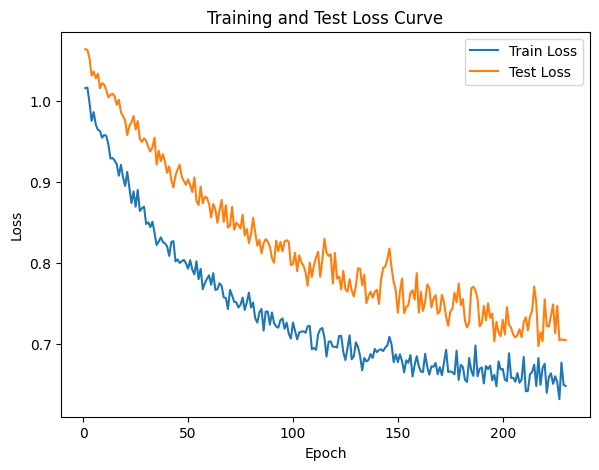

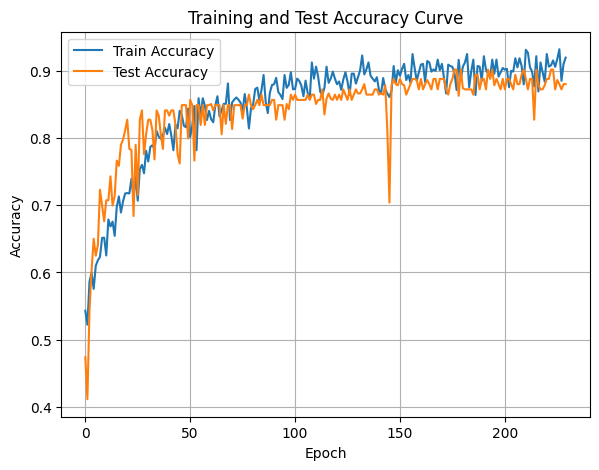

In [90]:
DTEmlp12b.train_single_model()

Randomly initializing 12 models
Training Model with id 1
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.47it/s]

Epoch [1/10], Train F1:0.2547251091449986, Train Loss: 1.1831, Train Acc: 0.1970, Test F1:0.08469449485783424, Test Loss: 1.1431, Test Acc: 0.1215


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.47it/s]

Epoch [2/10], Train F1:0.2557933101381378, Train Loss: 1.1866, Train Acc: 0.2065, Test F1:0.10344586566016634, Test Loss: 1.1401, Test Acc: 0.1567


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.07it/s]

Epoch [3/10], Train F1:0.27242334801469864, Train Loss: 1.1807, Train Acc: 0.2152, Test F1:0.11061244843374585, Test Loss: 1.1367, Test Acc: 0.1710


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.07it/s]

Epoch [4/10], Train F1:0.28863665170751784, Train Loss: 1.1804, Train Acc: 0.2247, Test F1:0.11539364664050182, Test Loss: 1.1340, Test Acc: 0.1801


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.58it/s]

Epoch [5/10], Train F1:0.29226143947173466, Train Loss: 1.1781, Train Acc: 0.2254, Test F1:0.11890543302279905, Test Loss: 1.1317, Test Acc: 0.1872


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.58it/s]

Epoch [6/10], Train F1:0.3052096129888001, Train Loss: 1.1735, Train Acc: 0.2356, Test F1:0.12378773019505286, Test Loss: 1.1307, Test Acc: 0.1970


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.99it/s]

Epoch [7/10], Train F1:0.30874049652251095, Train Loss: 1.1708, Train Acc: 0.2381, Test F1:0.12671594508975711, Test Loss: 1.1293, Test Acc: 0.2030


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.99it/s]

Epoch [8/10], Train F1:0.3101010480028014, Train Loss: 1.1690, Train Acc: 0.2395, Test F1:0.12753285427591118, Test Loss: 1.1283, Test Acc: 0.2045


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.99it/s]

Epoch [9/10], Train F1:0.3170311935127843, Train Loss: 1.1675, Train Acc: 0.2448, Test F1:0.1288936627282492, Test Loss: 1.1273, Test Acc: 0.2075


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.04it/s]


Epoch [10/10], Train F1:0.3245482997043595, Train Loss: 1.1636, Train Acc: 0.2516, Test F1:0.1309051707542448, Test Loss: 1.1264, Test Acc: 0.2114
Total Epochs: 10
Train loss start: 1.202967882156372, Train loss end: 1.1095435619354248
Highest Mean Train Accuracy (over epoch): 0.2516369047619047
Test loss start: 1.1407686471939087, Test loss end: 1.1251977682113647
Highest mean Test Accuracy (over epoch): 0.21137152777777776


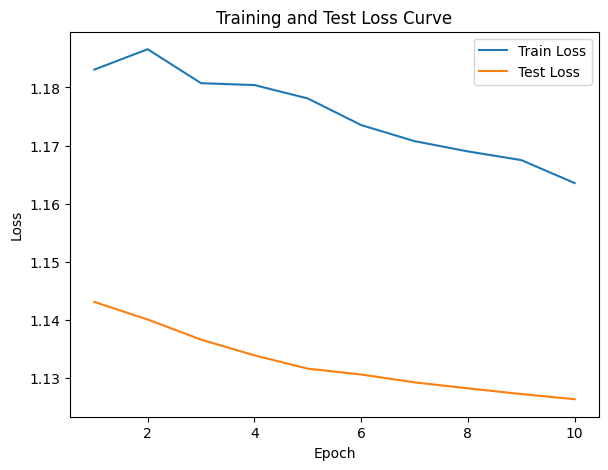

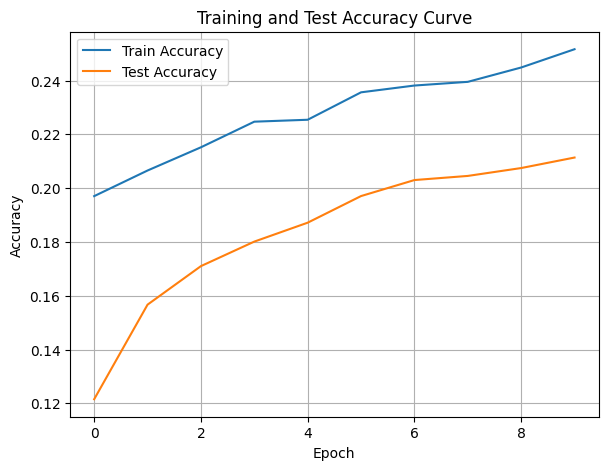

./saved_models/model_1.pth
Training Model with id 2
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.51it/s]

Epoch [1/10], Train F1:0.38603240470443695, Train Loss: 1.0700, Train Acc: 0.4024, Test F1:0.22827138358171364, Test Loss: 1.1152, Test Acc: 0.3628


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.51it/s]

Epoch [2/10], Train F1:0.3882813476810881, Train Loss: 1.0725, Train Acc: 0.4097, Test F1:0.23033383898576512, Test Loss: 1.1175, Test Acc: 0.3668


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.28it/s]

Epoch [3/10], Train F1:0.3995048933045071, Train Loss: 1.0685, Train Acc: 0.4194, Test F1:0.22662653798643045, Test Loss: 1.1195, Test Acc: 0.3660


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.36it/s]

Epoch [4/10], Train F1:0.4050711995658184, Train Loss: 1.0656, Train Acc: 0.4251, Test F1:0.22472659130961892, Test Loss: 1.1175, Test Acc: 0.3657


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.53it/s]

Epoch [5/10], Train F1:0.41703099565698204, Train Loss: 1.0614, Train Acc: 0.4350, Test F1:0.22357157191594276, Test Loss: 1.1158, Test Acc: 0.3655


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.82it/s]

Epoch [6/10], Train F1:0.4285145401580398, Train Loss: 1.0587, Train Acc: 0.4431, Test F1:0.22279523148322392, Test Loss: 1.1157, Test Acc: 0.3653


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.05it/s]

Epoch [7/10], Train F1:0.44266732036724266, Train Loss: 1.0544, Train Acc: 0.4552, Test F1:0.22223758551267625, Test Loss: 1.1150, Test Acc: 0.3652


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.13it/s]

Epoch [8/10], Train F1:0.4487993315421683, Train Loss: 1.0494, Train Acc: 0.4610, Test F1:0.22181763946022873, Test Loss: 1.1143, Test Acc: 0.3651


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  9.19it/s]

Epoch [9/10], Train F1:0.4566674999383381, Train Loss: 1.0461, Train Acc: 0.4671, Test F1:0.2234518493129971, Test Loss: 1.1123, Test Acc: 0.3659


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.80it/s]


Epoch [10/10], Train F1:0.4660193801094626, Train Loss: 1.0416, Train Acc: 0.4761, Test F1:0.22475822619330596, Test Loss: 1.1102, Test Acc: 0.3666
Total Epochs: 10
Train loss start: 1.0437031984329224, Train loss end: 0.9296267628669739
Highest Mean Train Accuracy (over epoch): 0.4761011904761904
Test loss start: 1.1372190713882446, Test loss end: 1.0795340538024902
Highest mean Test Accuracy (over epoch): 0.3667534722222222


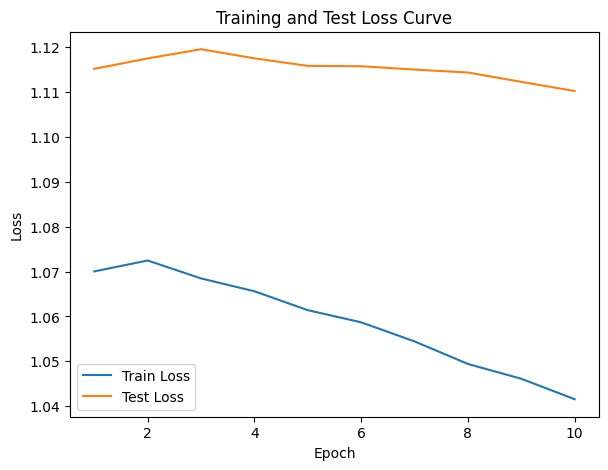

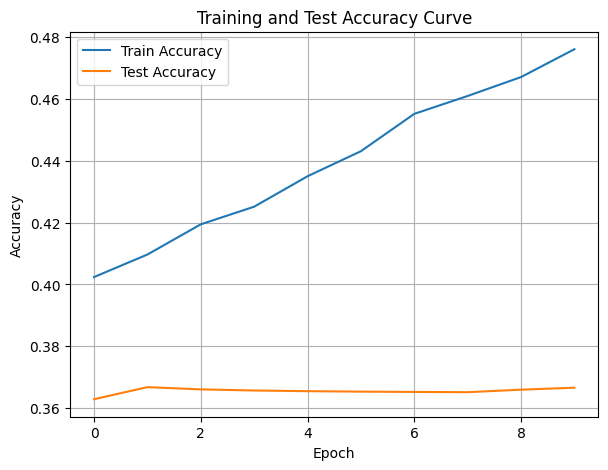

./saved_models/model_2.pth
Training Model with id 3
in multi


Training Process:  10%|█         | 1/10 [00:00<00:00,  9.73it/s]

Epoch [1/10], Train F1:0.5378383155306232, Train Loss: 1.0194, Train Acc: 0.5182, Test F1:0.5926527683283068, Test Loss: 1.0627, Test Acc: 0.5668


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.82it/s]

Epoch [2/10], Train F1:0.5289663429954067, Train Loss: 1.0206, Train Acc: 0.5109, Test F1:0.5959733514184865, Test Loss: 1.0596, Test Acc: 0.5855


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.67it/s]

Epoch [3/10], Train F1:0.523591094263386, Train Loss: 1.0250, Train Acc: 0.5050, Test F1:0.5658976114329699, Test Loss: 1.0671, Test Acc: 0.5113
Epoch [4/10], Train F1:0.5353040639710127, Train Loss: 1.0195, Train Acc: 0.5161, Test F1:0.5921612704779379, Test Loss: 1.0626, Test Acc: 0.5458


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.26it/s]

Epoch [5/10], Train F1:0.5469633090254876, Train Loss: 1.0146, Train Acc: 0.5288, Test F1:0.6119819860801529, Test Loss: 1.0598, Test Acc: 0.5712
Epoch [6/10], Train F1:0.5543789455893529, Train Loss: 1.0110, Train Acc: 0.5389, Test F1:0.629481094288232, Test Loss: 1.0547, Test Acc: 0.5979
Epoch [7/10], Train F1:0.5670653875694198, Train Loss: 1.0047, Train Acc: 0.5522, Test F1:0.6391295676071916, Test Loss: 1.0486, Test Acc: 0.6159


Training Process:  90%|█████████ | 9/10 [00:00<00:00, 10.11it/s]

Epoch [8/10], Train F1:0.5691744713864427, Train Loss: 1.0018, Train Acc: 0.5567, Test F1:0.6459791660564879, Test Loss: 1.0462, Test Acc: 0.6260
Epoch [9/10], Train F1:0.5774079783538038, Train Loss: 0.9978, Train Acc: 0.5642, Test F1:0.6544669399574441, Test Loss: 1.0429, Test Acc: 0.6340


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.24it/s]


Epoch [10/10], Train F1:0.5860161330902354, Train Loss: 0.9943, Train Acc: 0.5729, Test F1:0.6628543665306267, Test Loss: 1.0391, Test Acc: 0.6461
Total Epochs: 10
Train loss start: 1.0076220035552979, Train loss end: 1.049712061882019
Highest Mean Train Accuracy (over epoch): 0.5728571428571427
Test loss start: 1.071714162826538, Test loss end: 0.9731618165969849
Highest mean Test Accuracy (over epoch): 0.64609375


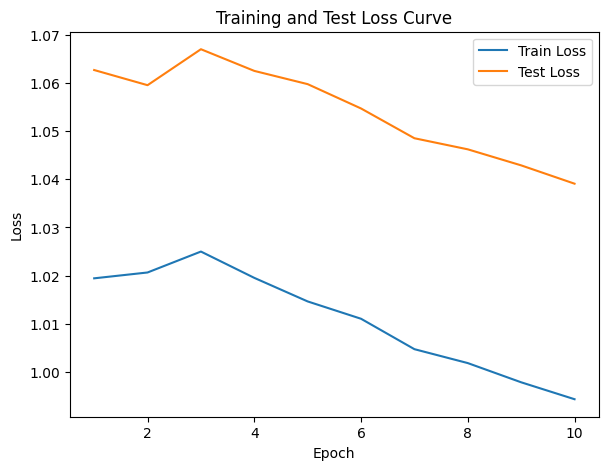

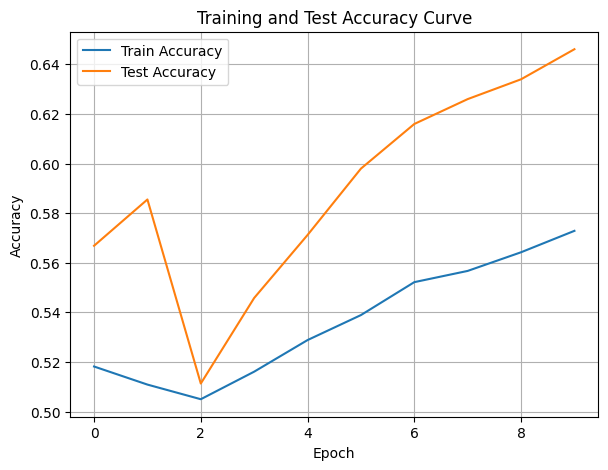

./saved_models/model_3.pth
Training Model with id 4
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.80it/s]

Epoch [1/10], Train F1:0.2678960113035533, Train Loss: 1.1104, Train Acc: 0.3735, Test F1:0.22321475509461652, Test Loss: 1.1071, Test Acc: 0.2153
Epoch [2/10], Train F1:0.26843670400893666, Train Loss: 1.1070, Train Acc: 0.3719, Test F1:0.2272947812798992, Test Loss: 1.1039, Test Acc: 0.2409


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.80it/s]

Epoch [3/10], Train F1:0.27281003225543954, Train Loss: 1.1066, Train Acc: 0.3801, Test F1:0.24346653316591027, Test Loss: 1.1027, Test Acc: 0.2442


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.58it/s]

Epoch [4/10], Train F1:0.28079393032928757, Train Loss: 1.1053, Train Acc: 0.3822, Test F1:0.24078996983408749, Test Loss: 1.1021, Test Acc: 0.2522


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.58it/s]

Epoch [5/10], Train F1:0.28655885801647996, Train Loss: 1.1061, Train Acc: 0.3846, Test F1:0.2873449203312887, Test Loss: 1.0995, Test Acc: 0.2868


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.58it/s]

Epoch [6/10], Train F1:0.2887363778374288, Train Loss: 1.1043, Train Acc: 0.3857, Test F1:0.3276324337922629, Test Loss: 1.0979, Test Acc: 0.3066


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.58it/s]

Epoch [7/10], Train F1:0.29711624404195325, Train Loss: 1.1013, Train Acc: 0.3906, Test F1:0.3528349521371717, Test Loss: 1.0962, Test Acc: 0.3240


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.68it/s]

Epoch [8/10], Train F1:0.3068474696769081, Train Loss: 1.0994, Train Acc: 0.3960, Test F1:0.37820112649396903, Test Loss: 1.0941, Test Acc: 0.3472


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.68it/s]

Epoch [9/10], Train F1:0.3105499418960182, Train Loss: 1.0982, Train Acc: 0.3970, Test F1:0.3725408005097399, Test Loss: 1.0927, Test Acc: 0.3493


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.98it/s]


Epoch [10/10], Train F1:0.3182912068801604, Train Loss: 1.0944, Train Acc: 0.4023, Test F1:0.39165999509196747, Test Loss: 1.0912, Test Acc: 0.3661
Total Epochs: 10
Train loss start: 1.141592025756836, Train loss end: 1.0340235233306885
Highest Mean Train Accuracy (over epoch): 0.40226190476190476
Test loss start: 1.1095256805419922, Test loss end: 1.0830090045928955
Highest mean Test Accuracy (over epoch): 0.3661458333333333


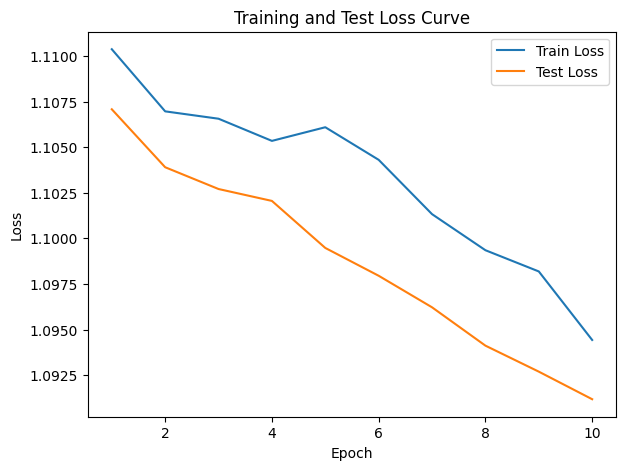

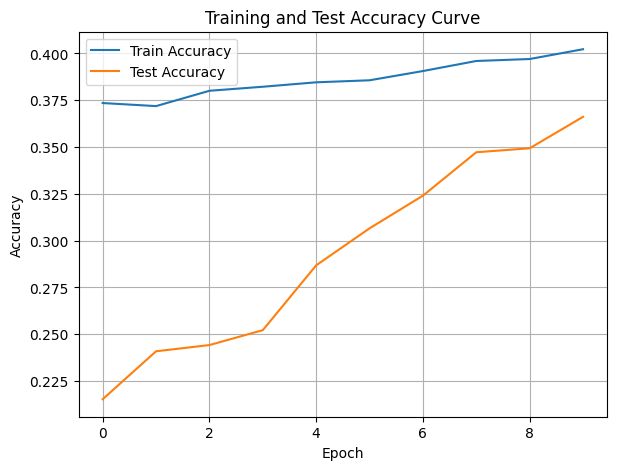

./saved_models/model_4.pth
Training Model with id 5
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.4459525689915833, Train Loss: 1.0569, Train Acc: 0.4461, Test F1:0.3050393174319394, Test Loss: 1.0592, Test Acc: 0.3941


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.24it/s]

Epoch [2/10], Train F1:0.4627735223224403, Train Loss: 1.0515, Train Acc: 0.4644, Test F1:0.36909036724364513, Test Loss: 1.0533, Test Acc: 0.4136
Epoch [3/10], Train F1:0.46615952650012293, Train Loss: 1.0452, Train Acc: 0.4699, Test F1:0.39137239269012, Test Loss: 1.0514, Test Acc: 0.4253


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.86it/s]

Epoch [4/10], Train F1:0.47415923459480624, Train Loss: 1.0426, Train Acc: 0.4718, Test F1:0.3988014007316429, Test Loss: 1.0490, Test Acc: 0.4269
Epoch [5/10], Train F1:0.48201736145633534, Train Loss: 1.0400, Train Acc: 0.4782, Test F1:0.40087206532015246, Test Loss: 1.0471, Test Acc: 0.4293


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.15it/s]

Epoch [6/10], Train F1:0.4886176974031446, Train Loss: 1.0376, Train Acc: 0.4824, Test F1:0.4205555403818316, Test Loss: 1.0443, Test Acc: 0.4411
Epoch [7/10], Train F1:0.49667083158569425, Train Loss: 1.0340, Train Acc: 0.4914, Test F1:0.4516882873201477, Test Loss: 1.0419, Test Acc: 0.4616


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.83it/s]

Epoch [8/10], Train F1:0.5016946297745383, Train Loss: 1.0303, Train Acc: 0.4959, Test F1:0.4782187197047878, Test Loss: 1.0400, Test Acc: 0.4813
Epoch [9/10], Train F1:0.5104356293501607, Train Loss: 1.0258, Train Acc: 0.5033, Test F1:0.4919327635670177, Test Loss: 1.0387, Test Acc: 0.4904


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.33it/s]


Epoch [10/10], Train F1:0.5201377412898155, Train Loss: 1.0210, Train Acc: 0.5139, Test F1:0.5103405673030306, Test Loss: 1.0362, Test Acc: 0.5056
Total Epochs: 10
Train loss start: 1.0163737535476685, Train loss end: 0.902553141117096
Highest Mean Train Accuracy (over epoch): 0.5138690476190476
Test loss start: 1.075033187866211, Test loss end: 0.997321367263794
Highest mean Test Accuracy (over epoch): 0.505642361111111


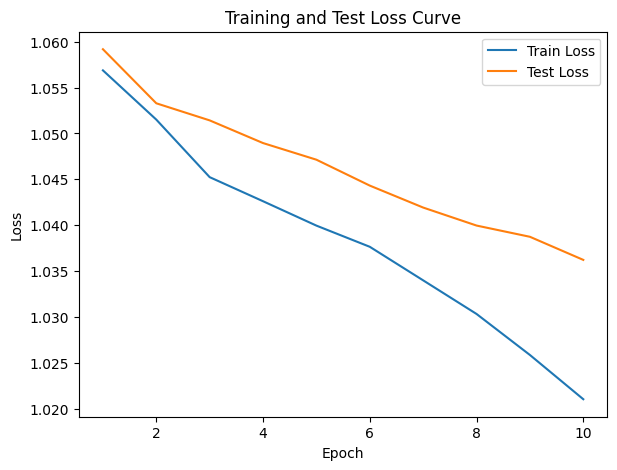

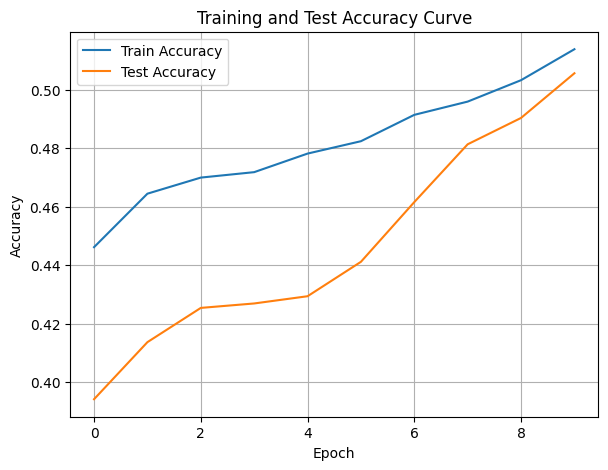

./saved_models/model_5.pth
Training Model with id 6
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.34it/s]

Epoch [1/10], Train F1:0.299160346101981, Train Loss: 1.0795, Train Acc: 0.3628, Test F1:0.2188365650969529, Test Loss: 1.0791, Test Acc: 0.3646


Training Process:  20%|██        | 2/10 [00:00<00:01,  6.52it/s]

Epoch [2/10], Train F1:0.3118957460821734, Train Loss: 1.0716, Train Acc: 0.3780, Test F1:0.21690672679239026, Test Loss: 1.0735, Test Acc: 0.3576


Training Process:  30%|███       | 3/10 [00:00<00:00,  7.23it/s]

Epoch [3/10], Train F1:0.32057196816403616, Train Loss: 1.0683, Train Acc: 0.3840, Test F1:0.22796845638661803, Test Loss: 1.0715, Test Acc: 0.3646


Training Process:  40%|████      | 4/10 [00:00<00:00,  8.11it/s]

Epoch [4/10], Train F1:0.3367904551643648, Train Loss: 1.0597, Train Acc: 0.3991, Test F1:0.2388430084641559, Test Loss: 1.0673, Test Acc: 0.3661


Training Process:  50%|█████     | 5/10 [00:00<00:00,  8.64it/s]

Epoch [5/10], Train F1:0.3422079609240602, Train Loss: 1.0574, Train Acc: 0.4042, Test F1:0.24841192131605083, Test Loss: 1.0631, Test Acc: 0.3686


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.05it/s]

Epoch [6/10], Train F1:0.3436465230815839, Train Loss: 1.0537, Train Acc: 0.4074, Test F1:0.2493143746549317, Test Loss: 1.0612, Test Acc: 0.3705


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.05it/s]

Epoch [7/10], Train F1:0.35243864486564774, Train Loss: 1.0500, Train Acc: 0.4137, Test F1:0.25170986526180933, Test Loss: 1.0586, Test Acc: 0.3719


Training Process:  80%|████████  | 8/10 [00:01<00:00,  9.80it/s]

Epoch [8/10], Train F1:0.36152920678479716, Train Loss: 1.0471, Train Acc: 0.4218, Test F1:0.2550244751259107, Test Loss: 1.0557, Test Acc: 0.3737
Epoch [9/10], Train F1:0.3671914297868362, Train Loss: 1.0435, Train Acc: 0.4270, Test F1:0.2653703678190028, Test Loss: 1.0537, Test Acc: 0.3788


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.12it/s]


Epoch [10/10], Train F1:0.37676547626048146, Train Loss: 1.0410, Train Acc: 0.4327, Test F1:0.2742460143910564, Test Loss: 1.0507, Test Acc: 0.3832
Total Epochs: 10
Train loss start: 1.0559386014938354, Train loss end: 1.126036286354065
Highest Mean Train Accuracy (over epoch): 0.43267857142857147
Test loss start: 1.0877612829208374, Test loss end: 1.016271948814392
Highest mean Test Accuracy (over epoch): 0.3832465277777778


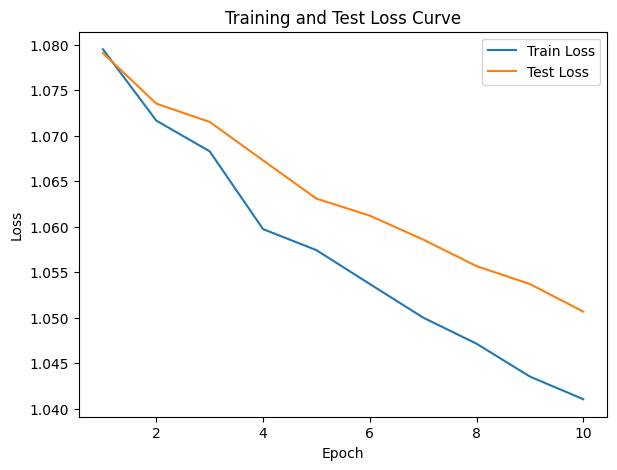

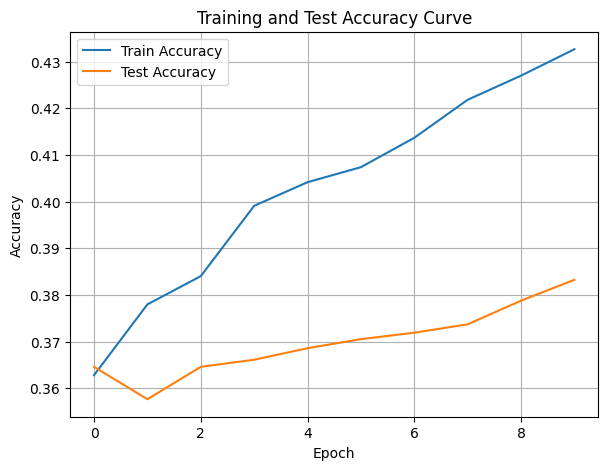

./saved_models/model_6.pth
Training Model with id 7
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.39838264037051785, Train Loss: 1.0650, Train Acc: 0.4065, Test F1:0.39985380116959063, Test Loss: 1.0689, Test Acc: 0.4297


Epoch [2/10], Train F1:0.3950701972326707, Train Loss: 1.0621, Train Acc: 0.4146, Test F1:0.48351412457729426, Test Loss: 1.0676, Test Acc: 0.4865


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.50it/s]

Epoch [3/10], Train F1:0.4220243897472952, Train Loss: 1.0564, Train Acc: 0.4317, Test F1:0.4479154076677297, Test Loss: 1.0634, Test Acc: 0.4656


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.47it/s]

Epoch [4/10], Train F1:0.4336275106512477, Train Loss: 1.0513, Train Acc: 0.4456, Test F1:0.48683641457973786, Test Loss: 1.0598, Test Acc: 0.4913


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.47it/s]

Epoch [5/10], Train F1:0.4489606015344715, Train Loss: 1.0486, Train Acc: 0.4545, Test F1:0.5060199087059342, Test Loss: 1.0575, Test Acc: 0.5080


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.32it/s]

Epoch [6/10], Train F1:0.4539318572663339, Train Loss: 1.0419, Train Acc: 0.4629, Test F1:0.5295133494106888, Test Loss: 1.0553, Test Acc: 0.5269


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.32it/s]

Epoch [7/10], Train F1:0.46270589333269174, Train Loss: 1.0389, Train Acc: 0.4720, Test F1:0.5435686316714828, Test Loss: 1.0532, Test Acc: 0.5393


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.45it/s]

Epoch [8/10], Train F1:0.47241063522362353, Train Loss: 1.0349, Train Acc: 0.4800, Test F1:0.5543986091354512, Test Loss: 1.0511, Test Acc: 0.5496


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.49it/s]

Epoch [9/10], Train F1:0.47927259510725667, Train Loss: 1.0319, Train Acc: 0.4869, Test F1:0.5629766272033335, Test Loss: 1.0494, Test Acc: 0.5576


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.93it/s]


Epoch [10/10], Train F1:0.48945088062298264, Train Loss: 1.0277, Train Acc: 0.4950, Test F1:0.571364721002288, Test Loss: 1.0476, Test Acc: 0.5661
Total Epochs: 10
Train loss start: 1.0310224294662476, Train loss end: 0.9290600419044495
Highest Mean Train Accuracy (over epoch): 0.49497023809523805
Test loss start: 1.0821375846862793, Test loss end: 1.0371733903884888
Highest mean Test Accuracy (over epoch): 0.5661458333333333


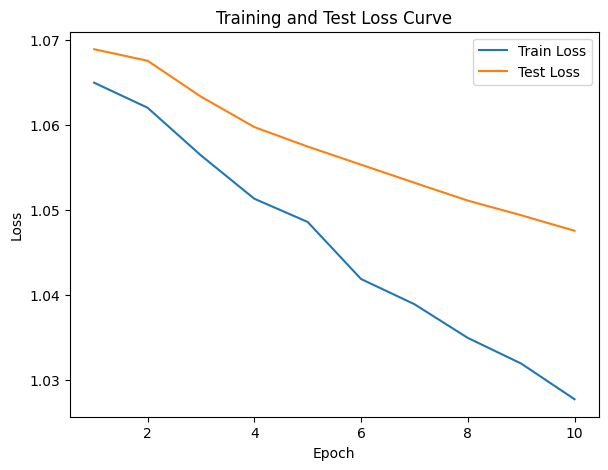

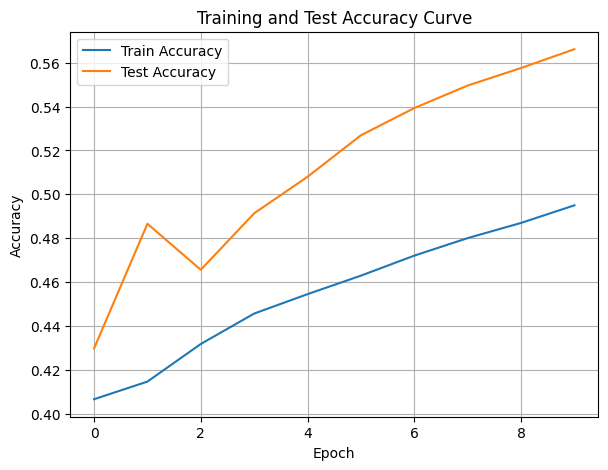

./saved_models/model_7.pth
Training Model with id 8
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.69it/s]

Epoch [1/10], Train F1:0.3670531266068917, Train Loss: 1.1235, Train Acc: 0.3280, Test F1:0.2788736860759021, Test Loss: 1.1238, Test Acc: 0.2214
Epoch [2/10], Train F1:0.38857890211472246, Train Loss: 1.1230, Train Acc: 0.3356, Test F1:0.3025827328132134, Test Loss: 1.1151, Test Acc: 0.2626


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.20it/s]

Epoch [3/10], Train F1:0.4045332831197189, Train Loss: 1.1172, Train Acc: 0.3471, Test F1:0.32785632219592575, Test Loss: 1.1110, Test Acc: 0.2830
Epoch [4/10], Train F1:0.4106689282972541, Train Loss: 1.1120, Train Acc: 0.3532, Test F1:0.331940963519911, Test Loss: 1.1084, Test Acc: 0.3006


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.62it/s]

Epoch [5/10], Train F1:0.41299053176918954, Train Loss: 1.1110, Train Acc: 0.3520, Test F1:0.33861424732606976, Test Loss: 1.1066, Test Acc: 0.3158
Epoch [6/10], Train F1:0.42671876983659873, Train Loss: 1.1069, Train Acc: 0.3651, Test F1:0.3419526210223885, Test Loss: 1.1038, Test Acc: 0.3234
Epoch [7/10], Train F1:0.4325817551624003, Train Loss: 1.1055, Train Acc: 0.3688, Test F1:0.34987461589799895, Test Loss: 1.1014, Test Acc: 0.3301


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.66it/s]

Epoch [8/10], Train F1:0.43932813679952454, Train Loss: 1.1026, Train Acc: 0.3748, Test F1:0.36163967540216935, Test Loss: 1.0992, Test Acc: 0.3377
Epoch [9/10], Train F1:0.4505480358464462, Train Loss: 1.0999, Train Acc: 0.3868, Test F1:0.36930074292575243, Test Loss: 1.0973, Test Acc: 0.3436


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.04it/s]


Epoch [10/10], Train F1:0.4575810810853561, Train Loss: 1.0963, Train Acc: 0.3937, Test F1:0.37290239352650995, Test Loss: 1.0956, Test Acc: 0.3522
Total Epochs: 10
Train loss start: 1.1632165908813477, Train loss end: 1.0557527542114258
Highest Mean Train Accuracy (over epoch): 0.39375
Test loss start: 1.1297215223312378, Test loss end: 1.0732617378234863
Highest mean Test Accuracy (over epoch): 0.3521701388888889


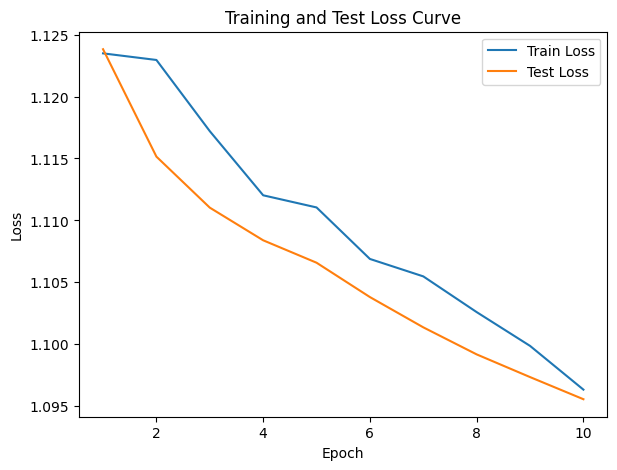

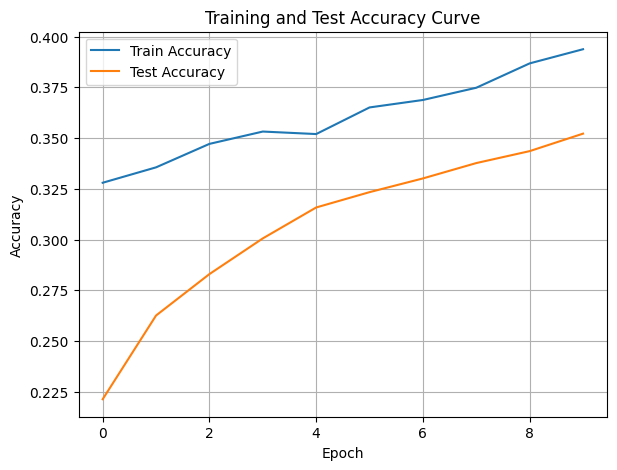

./saved_models/model_8.pth
Training Model with id 9
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.68it/s]

Epoch [1/10], Train F1:0.5045070871157827, Train Loss: 1.0893, Train Acc: 0.3949, Test F1:0.47463226668980557, Test Loss: 1.0837, Test Acc: 0.4271
Epoch [2/10], Train F1:0.5023583248826499, Train Loss: 1.0876, Train Acc: 0.4024, Test F1:0.47244135519452085, Test Loss: 1.0793, Test Acc: 0.4349


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.68it/s]

Epoch [3/10], Train F1:0.5207337329273001, Train Loss: 1.0867, Train Acc: 0.4211, Test F1:0.48754900070689555, Test Loss: 1.0743, Test Acc: 0.4557


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.58it/s]

Epoch [4/10], Train F1:0.5238378339458204, Train Loss: 1.0844, Train Acc: 0.4316, Test F1:0.5674258502916051, Test Loss: 1.0692, Test Acc: 0.5260


Training Process:  60%|██████    | 6/10 [00:00<00:00, 11.27it/s]

Epoch [5/10], Train F1:0.530649281775334, Train Loss: 1.0792, Train Acc: 0.4423, Test F1:0.5783548928606695, Test Loss: 1.0657, Test Acc: 0.5384
Epoch [6/10], Train F1:0.5415751297093113, Train Loss: 1.0753, Train Acc: 0.4523, Test F1:0.579387063241622, Test Loss: 1.0625, Test Acc: 0.5407


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.44it/s]

Epoch [7/10], Train F1:0.5529241896374406, Train Loss: 1.0702, Train Acc: 0.4658, Test F1:0.5865268380726525, Test Loss: 1.0599, Test Acc: 0.5494
Epoch [8/10], Train F1:0.5541479780952207, Train Loss: 1.0677, Train Acc: 0.4698, Test F1:0.6118943006828091, Test Loss: 1.0571, Test Acc: 0.5730


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.02it/s]


Epoch [9/10], Train F1:0.5610839672942876, Train Loss: 1.0647, Train Acc: 0.4759, Test F1:0.6181987462088433, Test Loss: 1.0547, Test Acc: 0.5790
Epoch [10/10], Train F1:0.5671499536033597, Train Loss: 1.0623, Train Acc: 0.4807, Test F1:0.6157903845000455, Test Loss: 1.0531, Test Acc: 0.5789
Total Epochs: 10
Train loss start: 1.1152876615524292, Train loss end: 1.1356545686721802
Highest Mean Train Accuracy (over epoch): 0.48065476190476186
Test loss start: 1.088693618774414, Test loss end: 1.0504038333892822
Highest mean Test Accuracy (over epoch): 0.5789930555555556


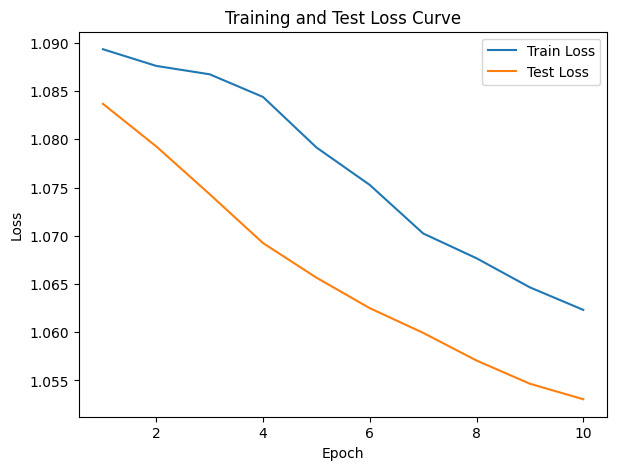

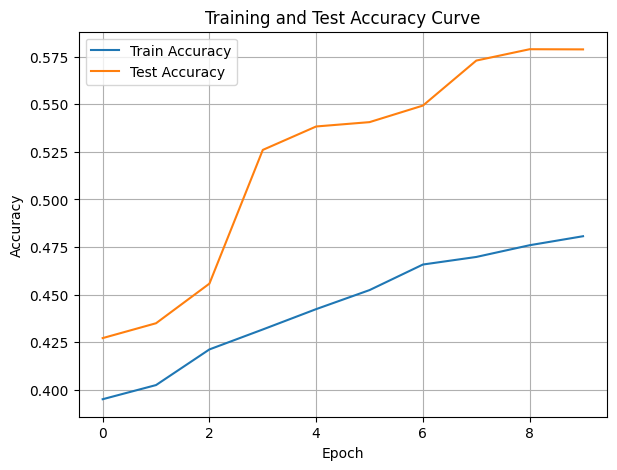

./saved_models/model_9.pth
Training Model with id 10
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.28921506408140957, Train Loss: 1.1788, Train Acc: 0.2054, Test F1:0.28620571035431713, Test Loss: 1.1315, Test Acc: 0.2335


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.14it/s]

Epoch [2/10], Train F1:0.3084790073937525, Train Loss: 1.1812, Train Acc: 0.2210, Test F1:0.2271507646120649, Test Loss: 1.1362, Test Acc: 0.1992


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.14it/s]

Epoch [3/10], Train F1:0.3115119095555045, Train Loss: 1.1799, Train Acc: 0.2223, Test F1:0.21764239132285584, Test Loss: 1.1348, Test Acc: 0.1950


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.51it/s]

Epoch [4/10], Train F1:0.332807160717992, Train Loss: 1.1737, Train Acc: 0.2413, Test F1:0.2146965209166166, Test Loss: 1.1340, Test Acc: 0.2003


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.51it/s]

Epoch [5/10], Train F1:0.3288320067228486, Train Loss: 1.1735, Train Acc: 0.2410, Test F1:0.20932155928053242, Test Loss: 1.1338, Test Acc: 0.1976


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.62it/s]

Epoch [6/10], Train F1:0.33678014748908064, Train Loss: 1.1694, Train Acc: 0.2499, Test F1:0.20763880175406427, Test Loss: 1.1335, Test Acc: 0.1973


Training Process:  70%|███████   | 7/10 [00:00<00:00,  8.76it/s]

Epoch [7/10], Train F1:0.34186619498646276, Train Loss: 1.1669, Train Acc: 0.2548, Test F1:0.21178483521184047, Test Loss: 1.1327, Test Acc: 0.2059


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.90it/s]

Epoch [8/10], Train F1:0.3457039631151373, Train Loss: 1.1640, Train Acc: 0.2585, Test F1:0.22184574291852677, Test Loss: 1.1324, Test Acc: 0.2198


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.89it/s]

Epoch [9/10], Train F1:0.3540767190256552, Train Loss: 1.1599, Train Acc: 0.2672, Test F1:0.22878703949903062, Test Loss: 1.1314, Test Acc: 0.2298


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.00it/s]


Epoch [10/10], Train F1:0.35996510700973605, Train Loss: 1.1566, Train Acc: 0.2736, Test F1:0.23504146850709468, Test Loss: 1.1300, Test Acc: 0.2361
Total Epochs: 10
Train loss start: 1.2195483446121216, Train loss end: 1.1132872104644775
Highest Mean Train Accuracy (over epoch): 0.2735714285714285
Test loss start: 1.1255435943603516, Test loss end: 1.106402039527893
Highest mean Test Accuracy (over epoch): 0.2361111111111111


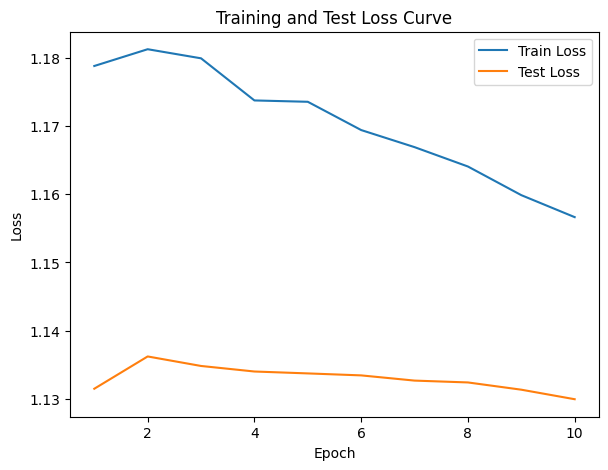

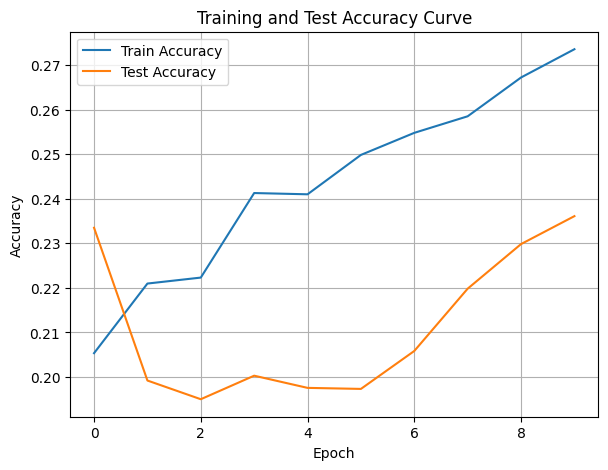

./saved_models/model_10.pth
Training Model with id 11
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.89it/s]

Epoch [1/10], Train F1:0.47674502508141886, Train Loss: 1.0602, Train Acc: 0.4137, Test F1:0.1997118275843257, Test Loss: 1.0779, Test Acc: 0.3333
Epoch [2/10], Train F1:0.4735834974036467, Train Loss: 1.0558, Train Acc: 0.4249, Test F1:0.21678596236900127, Test Loss: 1.0710, Test Acc: 0.3411


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.89it/s]

Epoch [3/10], Train F1:0.48670482897791506, Train Loss: 1.0513, Train Acc: 0.4449, Test F1:0.21657008282395276, Test Loss: 1.0692, Test Acc: 0.3411


Training Process:  40%|████      | 4/10 [00:00<00:00, 12.62it/s]

Epoch [4/10], Train F1:0.49600662010198804, Train Loss: 1.0462, Train Acc: 0.4533, Test F1:0.21748236357843567, Test Loss: 1.0669, Test Acc: 0.3431
Epoch [5/10], Train F1:0.5047322691077905, Train Loss: 1.0426, Train Acc: 0.4655, Test F1:0.22342517132179948, Test Loss: 1.0627, Test Acc: 0.3458


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.67it/s]

Epoch [6/10], Train F1:0.5109860958608694, Train Loss: 1.0421, Train Acc: 0.4699, Test F1:0.2224730690052874, Test Loss: 1.0606, Test Acc: 0.3464


Training Process:  60%|██████    | 6/10 [00:00<00:00, 12.67it/s]

Epoch [7/10], Train F1:0.5181887993026804, Train Loss: 1.0380, Train Acc: 0.4797, Test F1:0.22332258972305155, Test Loss: 1.0565, Test Acc: 0.3467


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.23it/s]

Epoch [8/10], Train F1:0.5243712775665109, Train Loss: 1.0346, Train Acc: 0.4855, Test F1:0.2502484674581583, Test Loss: 1.0527, Test Acc: 0.3620


Training Process:  80%|████████  | 8/10 [00:00<00:00, 11.23it/s]

Epoch [9/10], Train F1:0.5281766723763189, Train Loss: 1.0326, Train Acc: 0.4886, Test F1:0.27495984859223566, Test Loss: 1.0493, Test Acc: 0.3747


Training Process: 100%|██████████| 10/10 [00:00<00:00, 10.66it/s]


Epoch [10/10], Train F1:0.5335828043320662, Train Loss: 1.0310, Train Acc: 0.4932, Test F1:0.2871121839726855, Test Loss: 1.0467, Test Acc: 0.3826
Total Epochs: 10
Train loss start: 1.0411803722381592, Train loss end: 1.0750795602798462
Highest Mean Train Accuracy (over epoch): 0.4932440476190476
Test loss start: 1.0940104722976685, Test loss end: 1.0142827033996582
Highest mean Test Accuracy (over epoch): 0.3825520833333333


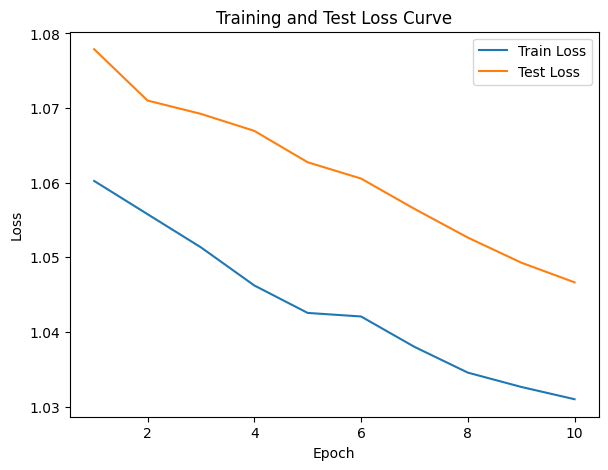

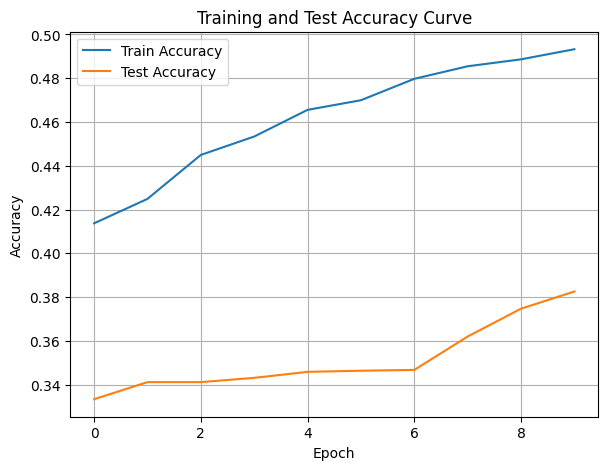

./saved_models/model_11.pth
Training Model with id 12
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.69it/s]

Epoch [1/10], Train F1:0.17698586600036037, Train Loss: 1.1902, Train Acc: 0.1982, Test F1:0.1266318472983516, Test Loss: 1.1583, Test Acc: 0.1806
Epoch [2/10], Train F1:0.19701654296752247, Train Loss: 1.1857, Train Acc: 0.2165, Test F1:0.12839900581328842, Test Loss: 1.1584, Test Acc: 0.1845


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.69it/s]

Epoch [3/10], Train F1:0.2017945906135161, Train Loss: 1.1858, Train Acc: 0.2194, Test F1:0.13759813097673876, Test Loss: 1.1572, Test Acc: 0.2014


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.83it/s]

Epoch [4/10], Train F1:0.20680920455392893, Train Loss: 1.1803, Train Acc: 0.2235, Test F1:0.1418317016163223, Test Loss: 1.1539, Test Acc: 0.2079


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.83it/s]

Epoch [5/10], Train F1:0.21594310475256898, Train Loss: 1.1770, Train Acc: 0.2301, Test F1:0.14330100743809432, Test Loss: 1.1524, Test Acc: 0.2102


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.34it/s]

Epoch [6/10], Train F1:0.22157558791705134, Train Loss: 1.1739, Train Acc: 0.2349, Test F1:0.1457709549643578, Test Loss: 1.1515, Test Acc: 0.2144


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.44it/s]

Epoch [7/10], Train F1:0.2251078745815588, Train Loss: 1.1718, Train Acc: 0.2386, Test F1:0.1475324740943431, Test Loss: 1.1487, Test Acc: 0.2163


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.44it/s]

Epoch [8/10], Train F1:0.2271898496221858, Train Loss: 1.1700, Train Acc: 0.2407, Test F1:0.1528614274231245, Test Loss: 1.1472, Test Acc: 0.2225


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.41it/s]

Epoch [9/10], Train F1:0.23271862602265792, Train Loss: 1.1669, Train Acc: 0.2460, Test F1:0.15472662390743885, Test Loss: 1.1455, Test Acc: 0.2266


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.67it/s]


Epoch [10/10], Train F1:0.2337759487295134, Train Loss: 1.1654, Train Acc: 0.2470, Test F1:0.15734432136965262, Test Loss: 1.1439, Test Acc: 0.2306
Total Epochs: 10
Train loss start: 1.1512678861618042, Train loss end: 1.2262132167816162
Highest Mean Train Accuracy (over epoch): 0.24696428571428575
Test loss start: 1.1622503995895386, Test loss end: 1.1368212699890137
Highest mean Test Accuracy (over epoch): 0.23055555555555554


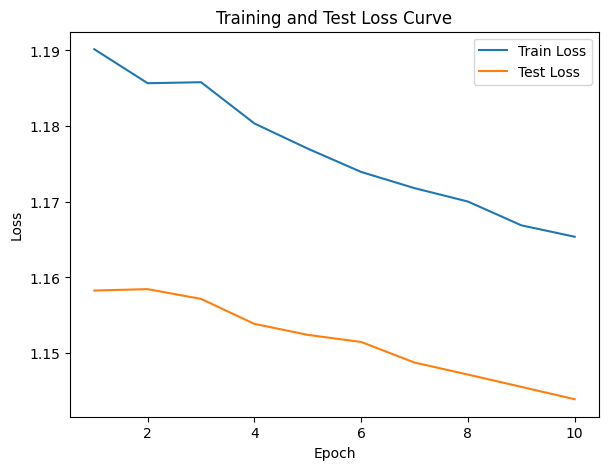

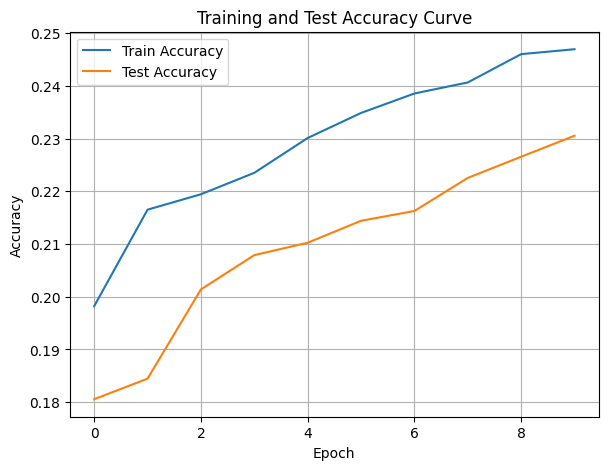

./saved_models/model_12.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.85it/s]

Epoch [1/10], Train F1:0.3084501000357972, Train Loss: 1.1439, Train Acc: 0.3107, Test F1:0.18685602896129208, Test Loss: 1.1244, Test Acc: 0.2743


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.93it/s]

Epoch [2/10], Train F1:0.30544988298855763, Train Loss: 1.1319, Train Acc: 0.3159, Test F1:0.1919371121026946, Test Loss: 1.1183, Test Acc: 0.2617


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.65it/s]

Epoch [3/10], Train F1:0.30639331106625034, Train Loss: 1.1278, Train Acc: 0.3177, Test F1:0.20050125313283207, Test Loss: 1.1183, Test Acc: 0.2810
Epoch [4/10], Train F1:0.3133466427641924, Train Loss: 1.1251, Train Acc: 0.3227, Test F1:0.20853309510997844, Test Loss: 1.1146, Test Acc: 0.2925


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.05it/s]

Epoch [5/10], Train F1:0.31166023670073656, Train Loss: 1.1237, Train Acc: 0.3245, Test F1:0.20971133810479725, Test Loss: 1.1130, Test Acc: 0.2967
Epoch [6/10], Train F1:0.3201623631913598, Train Loss: 1.1201, Train Acc: 0.3323, Test F1:0.21445361391310802, Test Loss: 1.1103, Test Acc: 0.2979
Epoch [7/10], Train F1:0.3245118877902328, Train Loss: 1.1201, Train Acc: 0.3338, Test F1:0.21638944371086488, Test Loss: 1.1093, Test Acc: 0.3010


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  9.07it/s]

Epoch [8/10], Train F1:0.3301941215566678, Train Loss: 1.1171, Train Acc: 0.3394, Test F1:0.22044279431450872, Test Loss: 1.1082, Test Acc: 0.3052
Epoch [9/10], Train F1:0.3394331297408782, Train Loss: 1.1130, Train Acc: 0.3479, Test F1:0.22174256019606461, Test Loss: 1.1072, Test Acc: 0.3059


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.85it/s]


Epoch [10/10], Train F1:0.3477957577430875, Train Loss: 1.1104, Train Acc: 0.3542, Test F1:0.22918746247833446, Test Loss: 1.1048, Test Acc: 0.3120
Total Epochs: 10
Train loss start: 1.122066855430603, Train loss end: 1.0996109247207642
Highest Mean Train Accuracy (over epoch): 0.3541964285714286
Test loss start: 1.1252282857894897, Test loss end: 1.089802622795105
Highest mean Test Accuracy (over epoch): 0.3119791666666667


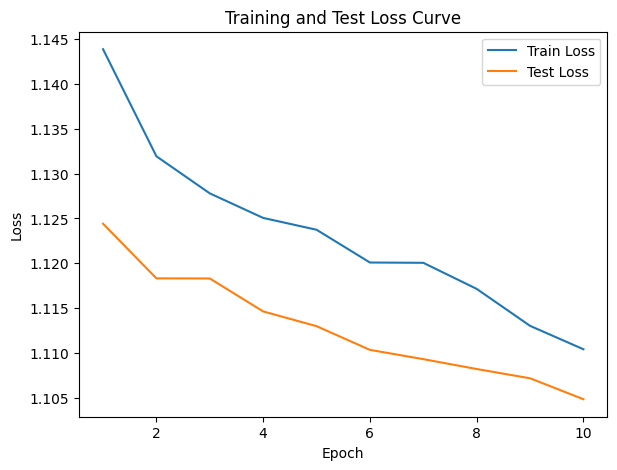

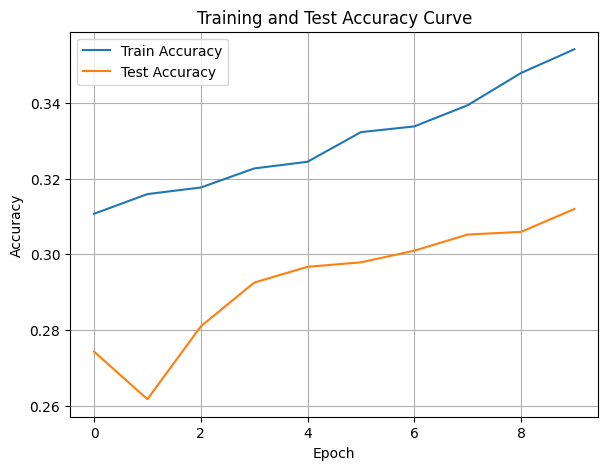

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.75it/s]

Epoch [1/10], Train F1:0.40426308085651486, Train Loss: 1.0772, Train Acc: 0.4036, Test F1:0.298676596502721, Test Loss: 1.0811, Test Acc: 0.3741
Epoch [2/10], Train F1:0.41541727053231964, Train Loss: 1.0751, Train Acc: 0.4134, Test F1:0.29744987572014314, Test Loss: 1.0818, Test Acc: 0.3733


Training Process:  20%|██        | 2/10 [00:00<00:00, 12.75it/s]

Epoch [3/10], Train F1:0.4283885664105828, Train Loss: 1.0710, Train Acc: 0.4289, Test F1:0.3140776031884191, Test Loss: 1.0808, Test Acc: 0.3822


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.86it/s]

Epoch [4/10], Train F1:0.44307976582207353, Train Loss: 1.0636, Train Acc: 0.4450, Test F1:0.32087031119293036, Test Loss: 1.0791, Test Acc: 0.3872


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.86it/s]

Epoch [5/10], Train F1:0.4521262667695544, Train Loss: 1.0618, Train Acc: 0.4481, Test F1:0.32107994487216707, Test Loss: 1.0786, Test Acc: 0.3913


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.31it/s]

Epoch [6/10], Train F1:0.463418201791294, Train Loss: 1.0575, Train Acc: 0.4582, Test F1:0.3379495049802895, Test Loss: 1.0759, Test Acc: 0.4042


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.31it/s]

Epoch [7/10], Train F1:0.4732325537905896, Train Loss: 1.0540, Train Acc: 0.4656, Test F1:0.3359585754892908, Test Loss: 1.0758, Test Acc: 0.4070


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.04it/s]

Epoch [8/10], Train F1:0.48091934245659906, Train Loss: 1.0511, Train Acc: 0.4740, Test F1:0.33898156941438495, Test Loss: 1.0744, Test Acc: 0.4110


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.04it/s]

Epoch [9/10], Train F1:0.49469588867641234, Train Loss: 1.0465, Train Acc: 0.4848, Test F1:0.3461348407345866, Test Loss: 1.0723, Test Acc: 0.4168


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.82it/s]


Epoch [10/10], Train F1:0.502828142016082, Train Loss: 1.0432, Train Acc: 0.4935, Test F1:0.35482968106074153, Test Loss: 1.0692, Test Acc: 0.4235
Total Epochs: 10
Train loss start: 1.0448671579360962, Train loss end: 0.9126668572425842
Highest Mean Train Accuracy (over epoch): 0.4935119047619048
Test loss start: 1.0793683528900146, Test loss end: 1.04600191116333
Highest mean Test Accuracy (over epoch): 0.42352430555555554


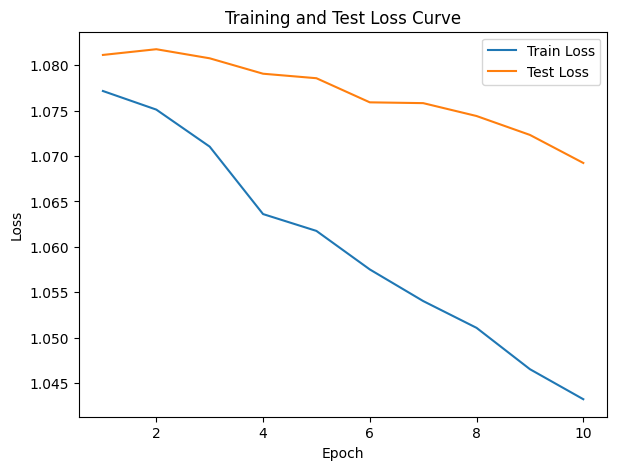

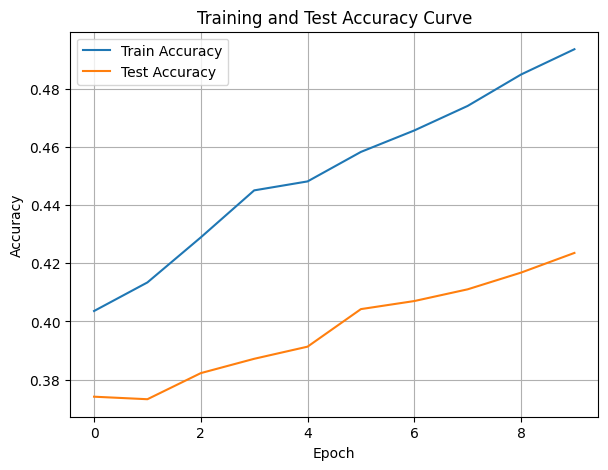

./saved_models/model_16.pth
Training Model with id 19
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.5623370385163066, Train Loss: 1.0186, Train Acc: 0.5548, Test F1:0.5860072389448722, Test Loss: 1.0301, Test Acc: 0.5920


Training Process:  20%|██        | 2/10 [00:00<00:00,  9.84it/s]

Epoch [2/10], Train F1:0.5672863175941384, Train Loss: 1.0186, Train Acc: 0.5515, Test F1:0.5405114485754419, Test Loss: 1.0327, Test Acc: 0.5577


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.35it/s]

Epoch [3/10], Train F1:0.5677570485258572, Train Loss: 1.0151, Train Acc: 0.5508, Test F1:0.5412049861495845, Test Loss: 1.0303, Test Acc: 0.5567


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.57it/s]

Epoch [4/10], Train F1:0.5889247301456675, Train Loss: 1.0068, Train Acc: 0.5687, Test F1:0.5890188434048084, Test Loss: 1.0273, Test Acc: 0.5920


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.65it/s]

Epoch [5/10], Train F1:0.5949899499818538, Train Loss: 1.0031, Train Acc: 0.5744, Test F1:0.5857532531413496, Test Loss: 1.0266, Test Acc: 0.5905


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.60it/s]

Epoch [6/10], Train F1:0.6026130524198068, Train Loss: 0.9986, Train Acc: 0.5854, Test F1:0.591517085037835, Test Loss: 1.0251, Test Acc: 0.5946


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.62it/s]

Epoch [7/10], Train F1:0.6137152582903896, Train Loss: 0.9959, Train Acc: 0.5946, Test F1:0.5941241993873573, Test Loss: 1.0238, Test Acc: 0.5956


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.58it/s]

Epoch [8/10], Train F1:0.6254961542305492, Train Loss: 0.9909, Train Acc: 0.6084, Test F1:0.6164117608012197, Test Loss: 1.0217, Test Acc: 0.6140
Epoch [9/10], Train F1:0.6317177920578622, Train Loss: 0.9879, Train Acc: 0.6142, Test F1:0.6086682852486539, Test Loss: 1.0198, Test Acc: 0.6074


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.55it/s]


Epoch [10/10], Train F1:0.6394768768346092, Train Loss: 0.9832, Train Acc: 0.6220, Test F1:0.6000848679792434, Test Loss: 1.0185, Test Acc: 0.6006
Total Epochs: 10
Train loss start: 0.9966862201690674, Train loss end: 0.9665150046348572
Highest Mean Train Accuracy (over epoch): 0.6220238095238094
Test loss start: 1.0278277397155762, Test loss end: 1.0066819190979004
Highest mean Test Accuracy (over epoch): 0.6140407986111112


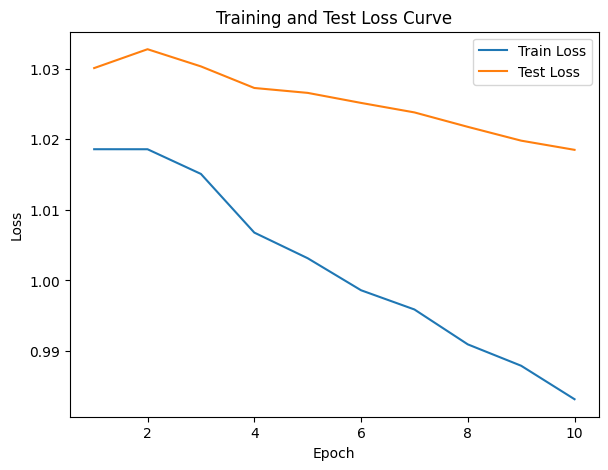

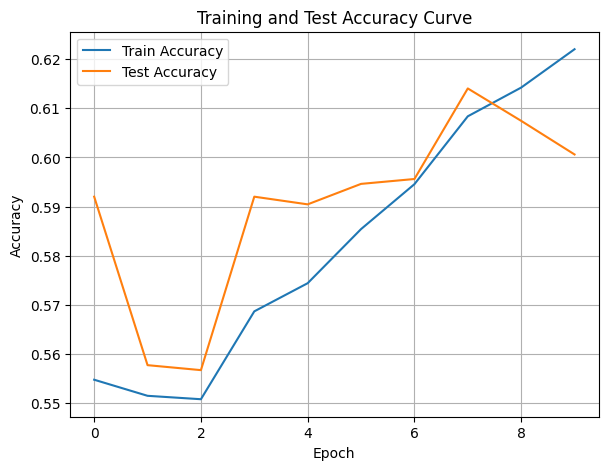

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.7118914336037283, Train Loss: 0.9467, Train Acc: 0.6943, Test F1:0.783317817373545, Test Loss: 0.9889, Test Acc: 0.7743


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.97it/s]

Epoch [2/10], Train F1:0.7221085064152729, Train Loss: 0.9414, Train Acc: 0.7010, Test F1:0.6855987964021204, Test Loss: 0.9974, Test Acc: 0.6753


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.43it/s]

Epoch [3/10], Train F1:0.7258147384364758, Train Loss: 0.9347, Train Acc: 0.7107, Test F1:0.7313595343670531, Test Loss: 0.9938, Test Acc: 0.7208


Training Process:  30%|███       | 3/10 [00:00<00:00,  8.43it/s]

Epoch [4/10], Train F1:0.7280449309049111, Train Loss: 0.9298, Train Acc: 0.7137, Test F1:0.7659639562120559, Test Loss: 0.9899, Test Acc: 0.7567


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.26it/s]

Epoch [5/10], Train F1:0.7287189611835425, Train Loss: 0.9292, Train Acc: 0.7125, Test F1:0.7731609726069559, Test Loss: 0.9893, Test Acc: 0.7646


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.27it/s]

Epoch [6/10], Train F1:0.735671542794298, Train Loss: 0.9270, Train Acc: 0.7213, Test F1:0.7833848919874796, Test Loss: 0.9890, Test Acc: 0.7760


Training Process:  80%|████████  | 8/10 [00:00<00:00, 10.05it/s]

Epoch [7/10], Train F1:0.7451550437753657, Train Loss: 0.9232, Train Acc: 0.7289, Test F1:0.7966825394956026, Test Loss: 0.9872, Test Acc: 0.7898
Epoch [8/10], Train F1:0.7478907910315237, Train Loss: 0.9205, Train Acc: 0.7332, Test F1:0.8035901486808777, Test Loss: 0.9857, Test Acc: 0.7972


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.88it/s]


Epoch [9/10], Train F1:0.7460153629189272, Train Loss: 0.9184, Train Acc: 0.7331, Test F1:0.7997666903381824, Test Loss: 0.9845, Test Acc: 0.7929
Epoch [10/10], Train F1:0.7524334935268452, Train Loss: 0.9146, Train Acc: 0.7405, Test F1:0.8007611386924093, Test Loss: 0.9825, Test Acc: 0.7940
Total Epochs: 10
Train loss start: 0.9552350044250488, Train loss end: 0.8537958860397339
Highest Mean Train Accuracy (over epoch): 0.7405059523809524
Test loss start: 0.9788470268249512, Test loss end: 0.9651429057121277
Highest mean Test Accuracy (over epoch): 0.7972005208333333


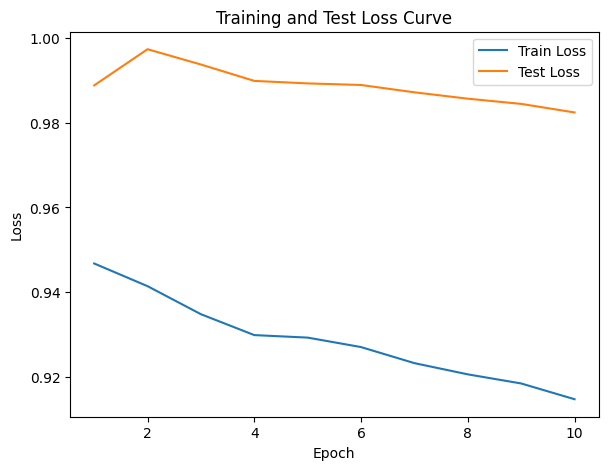

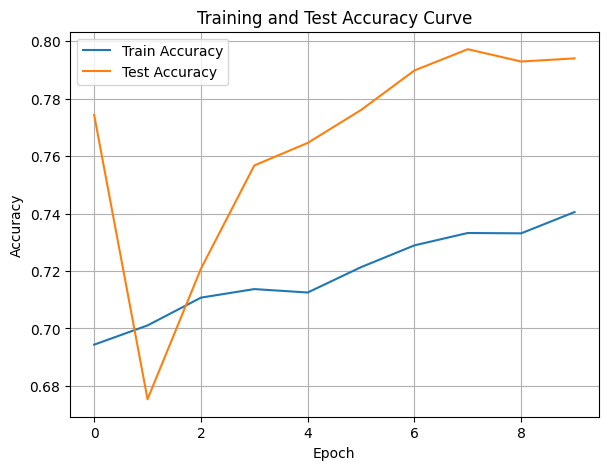

./saved_models/model_17.pth
Training Model with id 15
in multi


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.15it/s]

Epoch [1/10], Train F1:0.7617721923760371, Train Loss: 0.9073, Train Acc: 0.7369, Test F1:0.8191398389272024, Test Loss: 0.9649, Test Acc: 0.8177
Epoch [2/10], Train F1:0.7955755695066383, Train Loss: 0.8908, Train Acc: 0.7787, Test F1:0.8554673345116661, Test Loss: 0.9559, Test Acc: 0.8529


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.15it/s]

Epoch [3/10], Train F1:0.7961615385057473, Train Loss: 0.8843, Train Acc: 0.7822, Test F1:0.8599115491882168, Test Loss: 0.9541, Test Acc: 0.8568


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.09it/s]

Epoch [4/10], Train F1:0.7988200728757447, Train Loss: 0.8830, Train Acc: 0.7842, Test F1:0.8655138569139625, Test Loss: 0.9488, Test Acc: 0.8626


Training Process:  40%|████      | 4/10 [00:00<00:00, 11.09it/s]

Epoch [5/10], Train F1:0.8005338500668507, Train Loss: 0.8803, Train Acc: 0.7873, Test F1:0.8645106096308649, Test Loss: 0.9507, Test Acc: 0.8627


Training Process:  60%|██████    | 6/10 [00:00<00:00,  9.25it/s]

Epoch [6/10], Train F1:0.8013642414026615, Train Loss: 0.8778, Train Acc: 0.7890, Test F1:0.8650971437883072, Test Loss: 0.9483, Test Acc: 0.8630


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.06it/s]

Epoch [7/10], Train F1:0.7998402158760185, Train Loss: 0.8759, Train Acc: 0.7882, Test F1:0.871743952585111, Test Loss: 0.9460, Test Acc: 0.8705


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.66it/s]

Epoch [8/10], Train F1:0.7989463895770567, Train Loss: 0.8736, Train Acc: 0.7881, Test F1:0.874332620395014, Test Loss: 0.9430, Test Acc: 0.8727


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.48it/s]

Epoch [9/10], Train F1:0.8038871373630603, Train Loss: 0.8701, Train Acc: 0.7941, Test F1:0.8764372469635627, Test Loss: 0.9402, Test Acc: 0.8744


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.84it/s]


Epoch [10/10], Train F1:0.8084640157636164, Train Loss: 0.8663, Train Acc: 0.7996, Test F1:0.8769486976020864, Test Loss: 0.9376, Test Acc: 0.8750
Total Epochs: 10
Train loss start: 0.9177950620651245, Train loss end: 0.8914769291877747
Highest Mean Train Accuracy (over epoch): 0.7995833333333333
Test loss start: 0.9570143222808838, Test loss end: 0.9104840159416199
Highest mean Test Accuracy (over epoch): 0.875


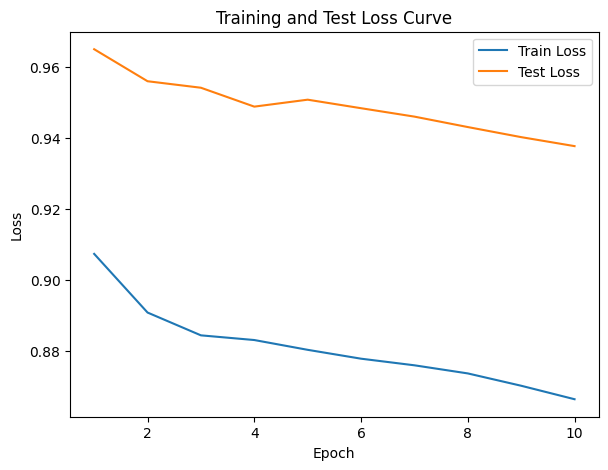

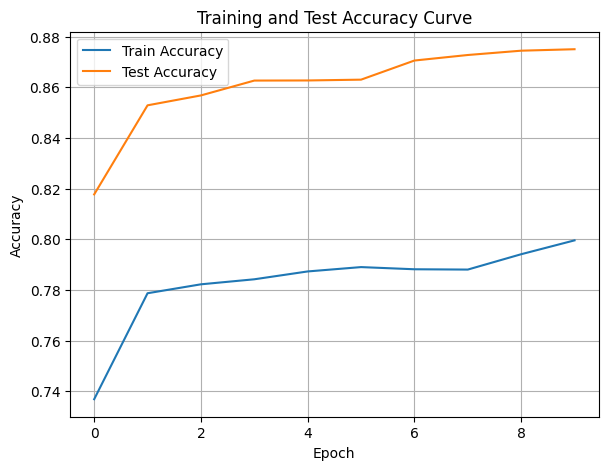

./saved_models/model_15.pth
Training Model with id 19
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.14it/s]

Epoch [1/10], Train F1:0.8315593490483253, Train Loss: 0.8380, Train Acc: 0.8321, Test F1:0.8808197688643266, Test Loss: 0.9091, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.58it/s]

Epoch [2/10], Train F1:0.8341148690189254, Train Loss: 0.8329, Train Acc: 0.8305, Test F1:0.8777558409305508, Test Loss: 0.9132, Test Acc: 0.8763


Training Process:  20%|██        | 2/10 [00:00<00:00,  8.58it/s]

Epoch [3/10], Train F1:0.8311872501770725, Train Loss: 0.8333, Train Acc: 0.8265, Test F1:0.8755536125465413, Test Loss: 0.9080, Test Acc: 0.8730


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.82it/s]

Epoch [4/10], Train F1:0.8347103828647481, Train Loss: 0.8296, Train Acc: 0.8310, Test F1:0.8768678024174361, Test Loss: 0.9053, Test Acc: 0.8748


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.02it/s]

Epoch [5/10], Train F1:0.8325706242805537, Train Loss: 0.8277, Train Acc: 0.8300, Test F1:0.8757050236179094, Test Loss: 0.9028, Test Acc: 0.8731


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.92it/s]

Epoch [6/10], Train F1:0.831425353586442, Train Loss: 0.8265, Train Acc: 0.8297, Test F1:0.8765559360580604, Test Loss: 0.9014, Test Acc: 0.8743


Training Process:  60%|██████    | 6/10 [00:00<00:00,  8.92it/s]

Epoch [7/10], Train F1:0.8338534657862389, Train Loss: 0.8250, Train Acc: 0.8303, Test F1:0.8757659271081749, Test Loss: 0.9001, Test Acc: 0.8731


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.54it/s]

Epoch [8/10], Train F1:0.8365982921004397, Train Loss: 0.8225, Train Acc: 0.8336, Test F1:0.8762359138206468, Test Loss: 0.8979, Test Acc: 0.8740


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.43it/s]

Epoch [9/10], Train F1:0.840840258624511, Train Loss: 0.8204, Train Acc: 0.8381, Test F1:0.8812289095945606, Test Loss: 0.8966, Test Acc: 0.8795


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.31it/s]


Epoch [10/10], Train F1:0.8441657950177548, Train Loss: 0.8173, Train Acc: 0.8417, Test F1:0.8800902793540342, Test Loss: 0.8932, Test Acc: 0.8788
Total Epochs: 10
Train loss start: 0.8679864406585693, Train loss end: 0.8263511061668396
Highest Mean Train Accuracy (over epoch): 0.8416666666666667
Test loss start: 0.8991034626960754, Test loss end: 0.8553831577301025
Highest mean Test Accuracy (over epoch): 0.8802083333333334


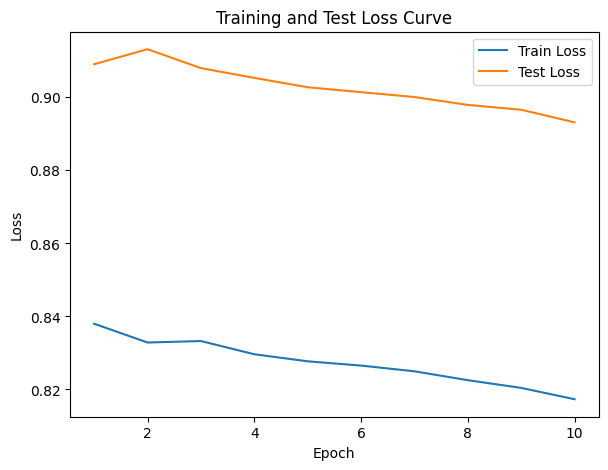

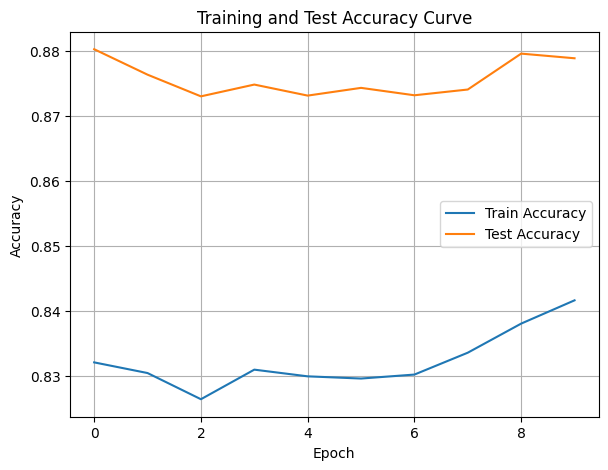

./saved_models/model_19.pth
Training Model with id 17
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8477029643030853, Train Loss: 0.8124, Train Acc: 0.8414, Test F1:0.8709623323013416, Test Loss: 0.8738, Test Acc: 0.8663


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.34it/s]

Epoch [2/10], Train F1:0.8509651427736075, Train Loss: 0.8027, Train Acc: 0.8482, Test F1:0.8709623323013416, Test Loss: 0.8723, Test Acc: 0.8663


Training Process:  20%|██        | 2/10 [00:00<00:00, 10.34it/s]

Epoch [3/10], Train F1:0.8538363435178995, Train Loss: 0.8017, Train Acc: 0.8494, Test F1:0.8747079621394201, Test Loss: 0.8712, Test Acc: 0.8730


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.40it/s]

Epoch [4/10], Train F1:0.8527874655019599, Train Loss: 0.7981, Train Acc: 0.8516, Test F1:0.8737778512214603, Test Loss: 0.8680, Test Acc: 0.8713


Training Process:  40%|████      | 4/10 [00:00<00:00, 10.40it/s]

Epoch [5/10], Train F1:0.853883133867598, Train Loss: 0.7953, Train Acc: 0.8532, Test F1:0.8732177921309561, Test Loss: 0.8648, Test Acc: 0.8703


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.30it/s]

Epoch [6/10], Train F1:0.853331051478778, Train Loss: 0.7947, Train Acc: 0.8503, Test F1:0.8747079621394201, Test Loss: 0.8665, Test Acc: 0.8730


Training Process:  60%|██████    | 6/10 [00:00<00:00, 10.30it/s]

Epoch [7/10], Train F1:0.8569652766429378, Train Loss: 0.7915, Train Acc: 0.8543, Test F1:0.8769825375019688, Test Loss: 0.8654, Test Acc: 0.8760


Training Process:  80%|████████  | 8/10 [00:00<00:00,  8.74it/s]

Epoch [8/10], Train F1:0.8582101643271484, Train Loss: 0.7885, Train Acc: 0.8568, Test F1:0.8773013336222699, Test Loss: 0.8649, Test Acc: 0.8765


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  8.73it/s]

Epoch [9/10], Train F1:0.8590247839452022, Train Loss: 0.7861, Train Acc: 0.8586, Test F1:0.8778348069260237, Test Loss: 0.8642, Test Acc: 0.8776


Training Process: 100%|██████████| 10/10 [00:01<00:00,  9.05it/s]


Epoch [10/10], Train F1:0.8591620881170072, Train Loss: 0.7846, Train Acc: 0.8589, Test F1:0.8792371977692722, Test Loss: 0.8637, Test Acc: 0.8793
Total Epochs: 10
Train loss start: 0.7972570657730103, Train loss end: 0.740822970867157
Highest Mean Train Accuracy (over epoch): 0.8588988095238096
Test loss start: 0.8609980344772339, Test loss end: 0.8570981025695801
Highest mean Test Accuracy (over epoch): 0.8792534722222222


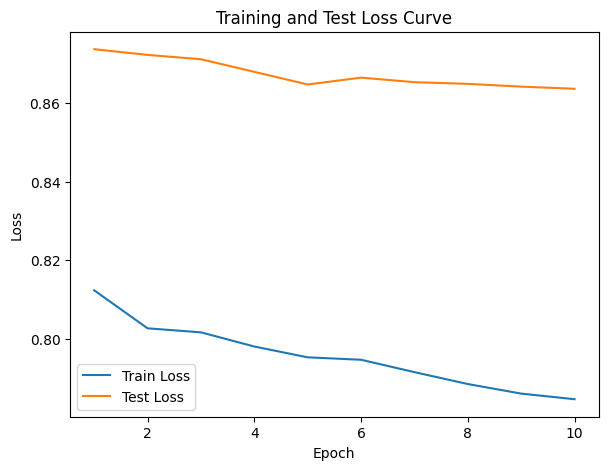

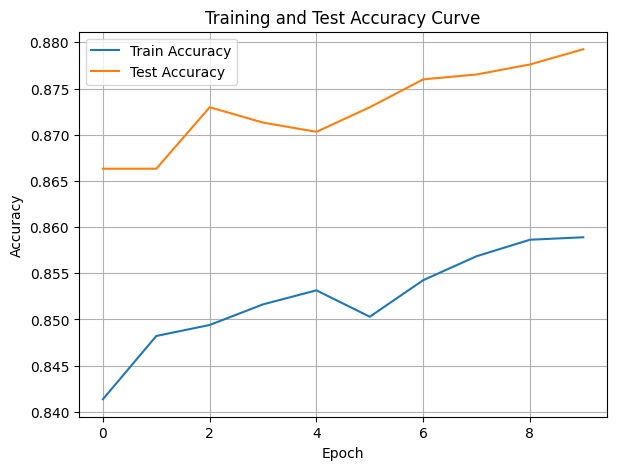

./saved_models/model_17.pth
Training Model with id 20
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.8854430193129884, Train Loss: 0.7548, Train Acc: 0.8917, Test F1:0.8709623323013416, Test Loss: 0.8369, Test Acc: 0.8663


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.45it/s]

Epoch [2/10], Train F1:0.8797463161131283, Train Loss: 0.7548, Train Acc: 0.8865, Test F1:0.8814282541797532, Test Loss: 0.8439, Test Acc: 0.8802


Training Process:  30%|███       | 3/10 [00:00<00:01,  6.67it/s]

Epoch [3/10], Train F1:0.8768011693488298, Train Loss: 0.7542, Train Acc: 0.8840, Test F1:0.8808197688643264, Test Loss: 0.8414, Test Acc: 0.8802


Training Process:  40%|████      | 4/10 [00:00<00:00,  7.03it/s]

Epoch [4/10], Train F1:0.8800805182926927, Train Loss: 0.7541, Train Acc: 0.8851, Test F1:0.8805036066816242, Test Loss: 0.8392, Test Acc: 0.8802


Training Process:  50%|█████     | 5/10 [00:00<00:00,  7.32it/s]

Epoch [5/10], Train F1:0.8728215438744109, Train Loss: 0.7564, Train Acc: 0.8774, Test F1:0.8803100134879459, Test Loss: 0.8360, Test Acc: 0.8802


Training Process:  70%|███████   | 7/10 [00:01<00:00,  6.60it/s]

Epoch [6/10], Train F1:0.8744403678362269, Train Loss: 0.7533, Train Acc: 0.8782, Test F1:0.8801793085655314, Test Loss: 0.8347, Test Acc: 0.8802
Epoch [7/10], Train F1:0.8749636660346902, Train Loss: 0.7524, Train Acc: 0.8782, Test F1:0.8800851370173872, Test Loss: 0.8337, Test Acc: 0.8802


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.92it/s]

Epoch [8/10], Train F1:0.8742707002354164, Train Loss: 0.7532, Train Acc: 0.8762, Test F1:0.8814124889085371, Test Loss: 0.8329, Test Acc: 0.8819
Epoch [9/10], Train F1:0.8762322155833672, Train Loss: 0.7521, Train Acc: 0.8778, Test F1:0.8812034170393305, Test Loss: 0.8310, Test Acc: 0.8818


Training Process: 100%|██████████| 10/10 [00:01<00:00,  7.38it/s]


Epoch [10/10], Train F1:0.8760288167794519, Train Loss: 0.7518, Train Acc: 0.8774, Test F1:0.8820227038183694, Test Loss: 0.8295, Test Acc: 0.8830
Total Epochs: 10
Train loss start: 0.6833813190460205, Train loss end: 0.8014551401138306
Highest Mean Train Accuracy (over epoch): 0.8916666666666667
Test loss start: 0.8182955384254456, Test loss end: 0.8114962577819824
Highest mean Test Accuracy (over epoch): 0.882986111111111


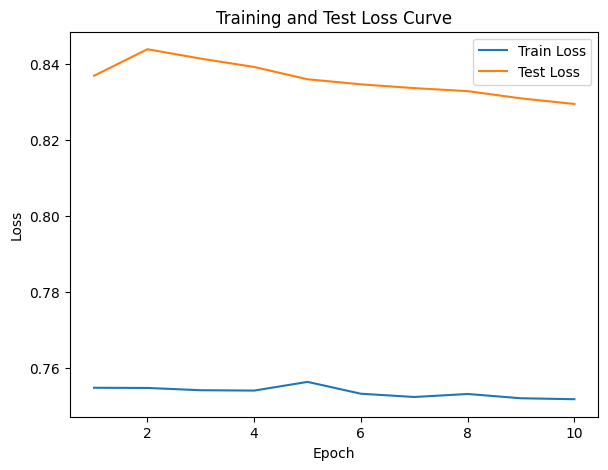

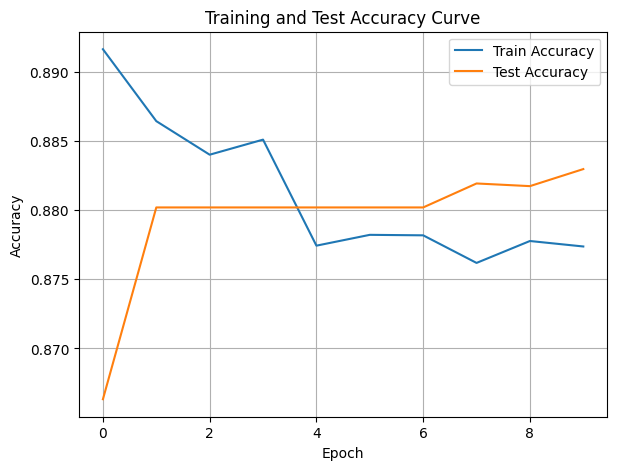

./saved_models/model_20.pth
Training Model with id 18
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.29it/s]

Epoch [1/10], Train F1:0.8777411498547035, Train Loss: 0.7419, Train Acc: 0.8780, Test F1:0.8905491577043876, Test Loss: 0.8265, Test Acc: 0.8941


Training Process:  10%|█         | 1/10 [00:00<00:01,  7.29it/s]

Epoch [2/10], Train F1:0.8801452109248645, Train Loss: 0.7382, Train Acc: 0.8838, Test F1:0.885099621809254, Test Loss: 0.8201, Test Acc: 0.8872


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.11it/s]

Epoch [3/10], Train F1:0.8853241215639136, Train Loss: 0.7370, Train Acc: 0.8874, Test F1:0.8832516339869281, Test Loss: 0.8114, Test Acc: 0.8848


Training Process:  30%|███       | 3/10 [00:00<00:00,  9.11it/s]

Epoch [4/10], Train F1:0.8896394013411429, Train Loss: 0.7342, Train Acc: 0.8926, Test F1:0.882321484352868, Test Loss: 0.8083, Test Acc: 0.8837


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.70it/s]

Epoch [5/10], Train F1:0.8907827083321028, Train Loss: 0.7334, Train Acc: 0.8930, Test F1:0.8837381312483755, Test Loss: 0.8052, Test Acc: 0.8858


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.70it/s]

Epoch [6/10], Train F1:0.890859415989684, Train Loss: 0.7323, Train Acc: 0.8938, Test F1:0.8846820920866596, Test Loss: 0.8054, Test Acc: 0.8872


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.79it/s]

Epoch [7/10], Train F1:0.889997883373747, Train Loss: 0.7320, Train Acc: 0.8935, Test F1:0.8857123829791547, Test Loss: 0.8064, Test Acc: 0.8881


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.79it/s]

Epoch [8/10], Train F1:0.8904611992735404, Train Loss: 0.7308, Train Acc: 0.8934, Test F1:0.8889140657817296, Test Loss: 0.8074, Test Acc: 0.8908


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  8.69it/s]

Epoch [9/10], Train F1:0.892484822947449, Train Loss: 0.7290, Train Acc: 0.8958, Test F1:0.8903031004824995, Test Loss: 0.8074, Test Acc: 0.8921


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.90it/s]


Epoch [10/10], Train F1:0.8935409418168038, Train Loss: 0.7285, Train Acc: 0.8963, Test F1:0.8911863436363644, Test Loss: 0.8063, Test Acc: 0.8937
Total Epochs: 10
Train loss start: 0.7761105895042419, Train loss end: 0.7446197867393494
Highest Mean Train Accuracy (over epoch): 0.896279761904762
Test loss start: 0.8084351420402527, Test loss end: 0.7928503751754761
Highest mean Test Accuracy (over epoch): 0.8940972222222222


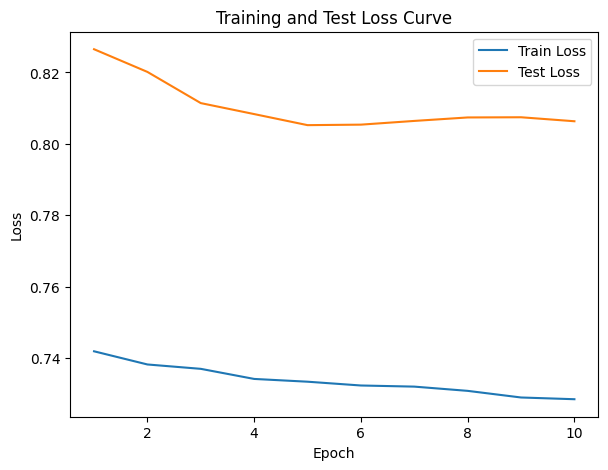

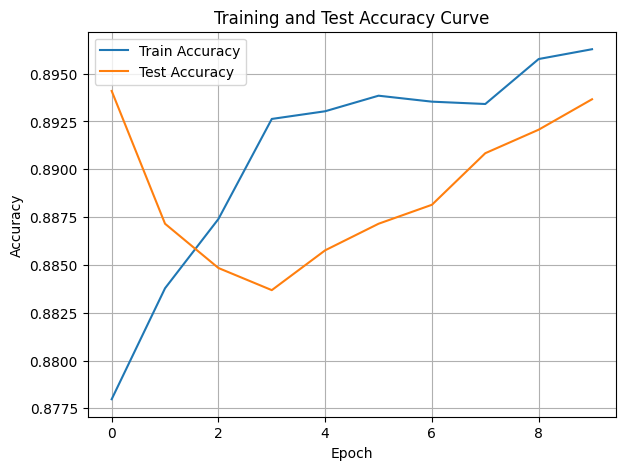

./saved_models/model_18.pth
Training Model with id 16
in multi


Training Process:  10%|█         | 1/10 [00:00<00:01,  8.32it/s]

Epoch [1/10], Train F1:0.8912428765799697, Train Loss: 0.7215, Train Acc: 0.8979, Test F1:0.8795057078126853, Test Loss: 0.7790, Test Acc: 0.8802


Training Process:  20%|██        | 2/10 [00:00<00:01,  7.97it/s]

Epoch [2/10], Train F1:0.8933013671459232, Train Loss: 0.7169, Train Acc: 0.8963, Test F1:0.8795057078126853, Test Loss: 0.7805, Test Acc: 0.8802


Training Process:  40%|████      | 4/10 [00:00<00:00,  6.42it/s]

Epoch [3/10], Train F1:0.8942022540879977, Train Loss: 0.7131, Train Acc: 0.8957, Test F1:0.8795057078126854, Test Loss: 0.7801, Test Acc: 0.8802
Epoch [4/10], Train F1:0.8934624097109908, Train Loss: 0.7144, Train Acc: 0.8944, Test F1:0.8795057078126853, Test Loss: 0.7801, Test Acc: 0.8802


Training Process:  60%|██████    | 6/10 [00:00<00:00,  7.06it/s]

Epoch [5/10], Train F1:0.8902562774674806, Train Loss: 0.7153, Train Acc: 0.8926, Test F1:0.8814947817304455, Test Loss: 0.7796, Test Acc: 0.8830
Epoch [6/10], Train F1:0.891955882199569, Train Loss: 0.7131, Train Acc: 0.8937, Test F1:0.8811636569019329, Test Loss: 0.7792, Test Acc: 0.8825


Training Process:  80%|████████  | 8/10 [00:01<00:00,  7.83it/s]

Epoch [7/10], Train F1:0.8904911710975661, Train Loss: 0.7138, Train Acc: 0.8931, Test F1:0.8809270445680734, Test Loss: 0.7782, Test Acc: 0.8822
Epoch [8/10], Train F1:0.8917370587816962, Train Loss: 0.7123, Train Acc: 0.8938, Test F1:0.8819911799421429, Test Loss: 0.7770, Test Acc: 0.8837


Training Process:  90%|█████████ | 9/10 [00:01<00:00,  7.95it/s]

Epoch [9/10], Train F1:0.8892332405042935, Train Loss: 0.7129, Train Acc: 0.8911, Test F1:0.8828177423551483, Test Loss: 0.7749, Test Acc: 0.8848


Training Process: 100%|██████████| 10/10 [00:01<00:00,  6.80it/s]


Epoch [10/10], Train F1:0.8891706439844341, Train Loss: 0.7124, Train Acc: 0.8908, Test F1:0.883478304165097, Test Loss: 0.7742, Test Acc: 0.8858
Total Epochs: 10
Train loss start: 0.7212153077125549, Train loss end: 0.7473790049552917
Highest Mean Train Accuracy (over epoch): 0.8979166666666667
Test loss start: 0.75667804479599, Test loss end: 0.76532381772995
Highest mean Test Accuracy (over epoch): 0.8857638888888889


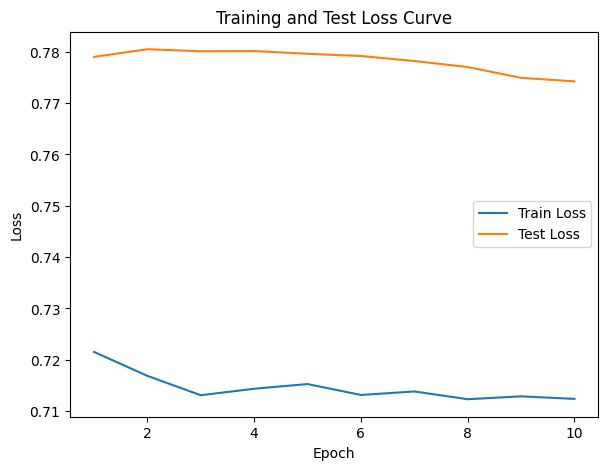

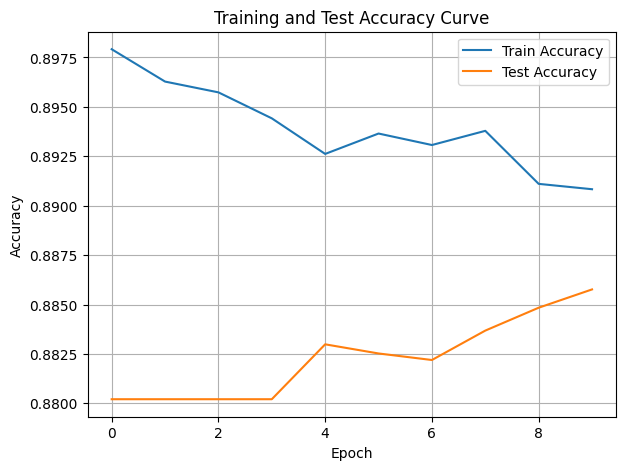

./saved_models/model_16.pth
Training Model with id 14
in multi


Training Process:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch [1/10], Train F1:0.9112841181806698, Train Loss: 0.7009, Train Acc: 0.9167, Test F1:0.8893962848297212, Test Loss: 0.7599, Test Acc: 0.8941


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [2/10], Train F1:0.9011939130833345, Train Loss: 0.7021, Train Acc: 0.9073, Test F1:0.8893962848297212, Test Loss: 0.7625, Test Acc: 0.8941


Training Process:  20%|██        | 2/10 [00:00<00:00, 11.11it/s]

Epoch [3/10], Train F1:0.8977732204551799, Train Loss: 0.7004, Train Acc: 0.9042, Test F1:0.8934105598925542, Test Loss: 0.7684, Test Acc: 0.8967


Training Process:  40%|████      | 4/10 [00:00<00:00,  9.28it/s]

Epoch [4/10], Train F1:0.8961394037543632, Train Loss: 0.7026, Train Acc: 0.8989, Test F1:0.8951096094667048, Test Loss: 0.7690, Test Acc: 0.8980


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.29it/s]

Epoch [5/10], Train F1:0.8977628067730147, Train Loss: 0.7002, Train Acc: 0.8997, Test F1:0.8959171771251797, Test Loss: 0.7693, Test Acc: 0.9000


Training Process:  50%|█████     | 5/10 [00:00<00:00,  9.29it/s]

Epoch [6/10], Train F1:0.8982839836008025, Train Loss: 0.6988, Train Acc: 0.8996, Test F1:0.8964559724670527, Test Loss: 0.7687, Test Acc: 0.9013


Training Process:  70%|███████   | 7/10 [00:00<00:00,  9.83it/s]

Epoch [7/10], Train F1:0.896338063006384, Train Loss: 0.7009, Train Acc: 0.8963, Test F1:0.8957611025756074, Test Loss: 0.7679, Test Acc: 0.9003


Training Process:  80%|████████  | 8/10 [00:00<00:00,  9.76it/s]

Epoch [8/10], Train F1:0.8975569599036838, Train Loss: 0.6997, Train Acc: 0.8974, Test F1:0.8949776384258478, Test Loss: 0.7659, Test Acc: 0.8995


Training Process:  90%|█████████ | 9/10 [00:00<00:00,  9.01it/s]

Epoch [9/10], Train F1:0.8978591173088172, Train Loss: 0.6993, Train Acc: 0.8976, Test F1:0.8943659486127774, Test Loss: 0.7635, Test Acc: 0.8989


Training Process: 100%|██████████| 10/10 [00:01<00:00,  8.65it/s]


Epoch [10/10], Train F1:0.8980547606991087, Train Loss: 0.6981, Train Acc: 0.8984, Test F1:0.8938751131911788, Test Loss: 0.7632, Test Acc: 0.8984
Total Epochs: 10
Train loss start: 0.7131931185722351, Train loss end: 0.6543339490890503
Highest Mean Train Accuracy (over epoch): 0.9166666666666666
Test loss start: 0.7388771176338196, Test loss end: 0.7582787275314331
Highest mean Test Accuracy (over epoch): 0.9013310185185185


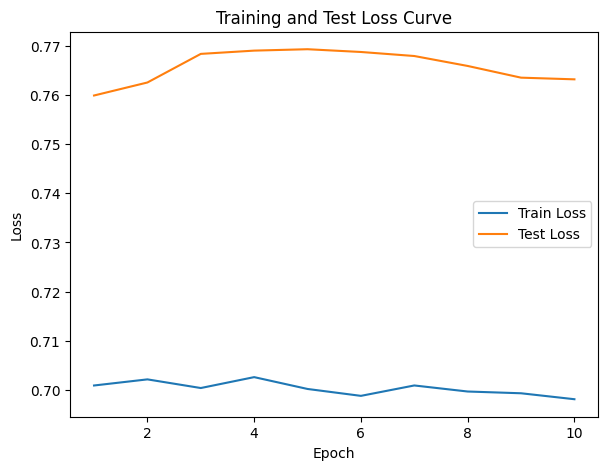

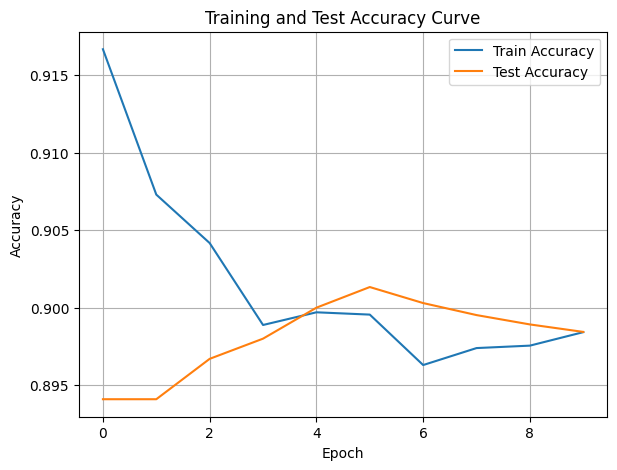

./saved_models/model_14.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=30, out_features=25, bias=True)
    (1): Linear(in_features=25, out_features=25, bias=True)
  )
  (batch_norms): ModuleList(
    (0-1): 2 x BatchNorm1d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=25, out_features=3, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [91]:
DTEmlp12b.train_DTE()

Training Process:   0%|          | 1/230 [00:00<00:28,  8.12it/s]

Epoch [1/230], Train F1:0.409801996337899, Train Loss: 1.0950, Train Acc: 0.3839, Test F1:0.5287286763065762, Test Loss: 1.0772, Test Acc: 0.4705


Training Process:   1%|          | 2/230 [00:00<00:26,  8.54it/s]

Epoch [2/230], Train F1:0.40642265029839775, Train Loss: 1.0972, Train Acc: 0.3707, Test F1:0.5532838413349032, Test Loss: 1.0749, Test Acc: 0.5069


Training Process:   1%|▏         | 3/230 [00:00<00:25,  8.87it/s]

Epoch [3/230], Train F1:0.4045032852104659, Train Loss: 1.0961, Train Acc: 0.3667, Test F1:0.5754476363894646, Test Loss: 1.0718, Test Acc: 0.5327


Training Process:   2%|▏         | 4/230 [00:00<00:25,  8.69it/s]

Epoch [4/230], Train F1:0.41551806775997363, Train Loss: 1.0927, Train Acc: 0.3732, Test F1:0.5849866343194734, Test Loss: 1.0688, Test Acc: 0.5506


Training Process:   2%|▏         | 5/230 [00:00<00:26,  8.58it/s]

Epoch [5/230], Train F1:0.428796859136917, Train Loss: 1.0879, Train Acc: 0.3868, Test F1:0.5851820998575478, Test Loss: 1.0696, Test Acc: 0.5472


Training Process:   3%|▎         | 6/230 [00:00<00:25,  8.66it/s]

Epoch [6/230], Train F1:0.43747487711376337, Train Loss: 1.0817, Train Acc: 0.3990, Test F1:0.5906242719403686, Test Loss: 1.0690, Test Acc: 0.5551


Training Process:   3%|▎         | 7/230 [00:00<00:25,  8.64it/s]

Epoch [7/230], Train F1:0.44652398223155515, Train Loss: 1.0763, Train Acc: 0.4091, Test F1:0.6081273691628649, Test Loss: 1.0661, Test Acc: 0.5773


Training Process:   3%|▎         | 8/230 [00:00<00:25,  8.59it/s]

Epoch [8/230], Train F1:0.45510618461571006, Train Loss: 1.0717, Train Acc: 0.4175, Test F1:0.6200106983225865, Test Loss: 1.0637, Test Acc: 0.5929


Training Process:   4%|▍         | 9/230 [00:01<00:29,  7.57it/s]

Epoch [9/230], Train F1:0.45971129068485506, Train Loss: 1.0691, Train Acc: 0.4217, Test F1:0.632129656600794, Test Loss: 1.0610, Test Acc: 0.6068


Training Process:   4%|▍         | 10/230 [00:01<00:31,  6.89it/s]

Epoch [10/230], Train F1:0.46447935517147926, Train Loss: 1.0672, Train Acc: 0.4256, Test F1:0.6369569195485136, Test Loss: 1.0596, Test Acc: 0.6124


Training Process:   5%|▍         | 11/230 [00:01<00:31,  6.92it/s]

Epoch [11/230], Train F1:0.47271235103153847, Train Loss: 1.0629, Train Acc: 0.4344, Test F1:0.645906432748538, Test Loss: 1.0573, Test Acc: 0.6247


Training Process:   5%|▌         | 12/230 [00:01<00:31,  7.03it/s]

Epoch [12/230], Train F1:0.4807992528587906, Train Loss: 1.0598, Train Acc: 0.4421, Test F1:0.6545344047439915, Test Loss: 1.0544, Test Acc: 0.6369


Training Process:   6%|▌         | 13/230 [00:01<00:33,  6.48it/s]

Epoch [13/230], Train F1:0.4884626135410009, Train Loss: 1.0559, Train Acc: 0.4508, Test F1:0.6616288308123155, Test Loss: 1.0528, Test Acc: 0.6455


Training Process:   6%|▌         | 14/230 [00:01<00:32,  6.62it/s]

Epoch [14/230], Train F1:0.4954057228008401, Train Loss: 1.0526, Train Acc: 0.4579, Test F1:0.6681623506470796, Test Loss: 1.0514, Test Acc: 0.6523


Training Process:   7%|▋         | 15/230 [00:02<00:31,  6.82it/s]

Epoch [15/230], Train F1:0.5016951556414699, Train Loss: 1.0490, Train Acc: 0.4647, Test F1:0.6754914113905686, Test Loss: 1.0489, Test Acc: 0.6613


Training Process:   7%|▋         | 16/230 [00:02<00:30,  7.03it/s]

Epoch [16/230], Train F1:0.5093035355945046, Train Loss: 1.0453, Train Acc: 0.4729, Test F1:0.6810588221839751, Test Loss: 1.0458, Test Acc: 0.6691


Training Process:   7%|▋         | 17/230 [00:02<00:29,  7.17it/s]

Epoch [17/230], Train F1:0.5153949239501863, Train Loss: 1.0429, Train Acc: 0.4791, Test F1:0.6861497503289212, Test Loss: 1.0436, Test Acc: 0.6760


Training Process:   8%|▊         | 18/230 [00:02<00:28,  7.41it/s]

Epoch [18/230], Train F1:0.5246315601146968, Train Loss: 1.0382, Train Acc: 0.4892, Test F1:0.6918939970879858, Test Loss: 1.0416, Test Acc: 0.6830


Training Process:   8%|▊         | 19/230 [00:02<00:27,  7.75it/s]

Epoch [19/230], Train F1:0.5303710661432486, Train Loss: 1.0346, Train Acc: 0.4959, Test F1:0.6964383757072466, Test Loss: 1.0394, Test Acc: 0.6889


Training Process:   9%|▊         | 20/230 [00:02<00:26,  8.02it/s]

Epoch [20/230], Train F1:0.5360952636086236, Train Loss: 1.0315, Train Acc: 0.5019, Test F1:0.7016271109888222, Test Loss: 1.0374, Test Acc: 0.6949


Training Process:  10%|▉         | 22/230 [00:02<00:30,  6.78it/s]

Epoch [21/230], Train F1:0.5417348377774102, Train Loss: 1.0290, Train Acc: 0.5067, Test F1:0.7068383230397564, Test Loss: 1.0355, Test Acc: 0.7008
Epoch [22/230], Train F1:0.5474110804836992, Train Loss: 1.0259, Train Acc: 0.5124, Test F1:0.7099200008560288, Test Loss: 1.0335, Test Acc: 0.7050


Training Process:  10%|█         | 24/230 [00:03<00:30,  6.77it/s]

Epoch [23/230], Train F1:0.5531426664686645, Train Loss: 1.0226, Train Acc: 0.5183, Test F1:0.7130617102880226, Test Loss: 1.0306, Test Acc: 0.7092
Epoch [24/230], Train F1:0.5595855197498999, Train Loss: 1.0192, Train Acc: 0.5249, Test F1:0.7165289363448423, Test Loss: 1.0284, Test Acc: 0.7134


Training Process:  11%|█▏        | 26/230 [00:03<00:30,  6.78it/s]

Epoch [25/230], Train F1:0.5666567522712743, Train Loss: 1.0157, Train Acc: 0.5317, Test F1:0.7194641397823772, Test Loss: 1.0262, Test Acc: 0.7173
Epoch [26/230], Train F1:0.5735505028447548, Train Loss: 1.0123, Train Acc: 0.5387, Test F1:0.7245391147216053, Test Loss: 1.0243, Test Acc: 0.7224


Training Process:  12%|█▏        | 28/230 [00:03<00:29,  6.90it/s]

Epoch [27/230], Train F1:0.5800797167472087, Train Loss: 1.0089, Train Acc: 0.5452, Test F1:0.7274772052782215, Test Loss: 1.0223, Test Acc: 0.7259
Epoch [28/230], Train F1:0.5851272953160412, Train Loss: 1.0062, Train Acc: 0.5504, Test F1:0.7294192851447231, Test Loss: 1.0201, Test Acc: 0.7286


Training Process:  13%|█▎        | 30/230 [00:04<00:29,  6.70it/s]

Epoch [29/230], Train F1:0.5910363285372426, Train Loss: 1.0029, Train Acc: 0.5564, Test F1:0.7318776924616341, Test Loss: 1.0176, Test Acc: 0.7317
Epoch [30/230], Train F1:0.5970320037095728, Train Loss: 0.9994, Train Acc: 0.5631, Test F1:0.7341711085224799, Test Loss: 1.0154, Test Acc: 0.7345


Training Process:  14%|█▍        | 32/230 [00:04<00:30,  6.52it/s]

Epoch [31/230], Train F1:0.6013446703319129, Train Loss: 0.9970, Train Acc: 0.5673, Test F1:0.7367670375401196, Test Loss: 1.0134, Test Acc: 0.7375
Epoch [32/230], Train F1:0.6066138711518206, Train Loss: 0.9936, Train Acc: 0.5731, Test F1:0.7394467258921739, Test Loss: 1.0114, Test Acc: 0.7405


Training Process:  14%|█▍        | 33/230 [00:04<00:31,  6.22it/s]

Epoch [33/230], Train F1:0.6123991034818564, Train Loss: 0.9904, Train Acc: 0.5790, Test F1:0.741058846536099, Test Loss: 1.0093, Test Acc: 0.7426


Training Process:  15%|█▌        | 35/230 [00:05<00:33,  5.84it/s]

Epoch [34/230], Train F1:0.6167292749825276, Train Loss: 0.9874, Train Acc: 0.5841, Test F1:0.7424874597648076, Test Loss: 1.0073, Test Acc: 0.7446
Epoch [35/230], Train F1:0.6218970620195038, Train Loss: 0.9844, Train Acc: 0.5893, Test F1:0.7439194175602758, Test Loss: 1.0054, Test Acc: 0.7464


Training Process:  16%|█▌        | 36/230 [00:05<00:38,  4.99it/s]

Epoch [36/230], Train F1:0.6262874899531432, Train Loss: 0.9819, Train Acc: 0.5937, Test F1:0.7464852951947057, Test Loss: 1.0037, Test Acc: 0.7491


Training Process:  16%|█▌        | 37/230 [00:05<00:39,  4.92it/s]

Epoch [37/230], Train F1:0.6304152256995994, Train Loss: 0.9792, Train Acc: 0.5983, Test F1:0.7481609925180479, Test Loss: 1.0016, Test Acc: 0.7511


Training Process:  17%|█▋        | 38/230 [00:05<00:39,  4.90it/s]

Epoch [38/230], Train F1:0.6347968737169056, Train Loss: 0.9765, Train Acc: 0.6027, Test F1:0.7494610016204232, Test Loss: 0.9993, Test Acc: 0.7529


Training Process:  17%|█▋        | 40/230 [00:06<00:36,  5.27it/s]

Epoch [39/230], Train F1:0.6392371314434167, Train Loss: 0.9736, Train Acc: 0.6074, Test F1:0.7509742715280843, Test Loss: 0.9972, Test Acc: 0.7547
Epoch [40/230], Train F1:0.6431161937984939, Train Loss: 0.9708, Train Acc: 0.6119, Test F1:0.7524854672521, Test Loss: 0.9951, Test Acc: 0.7565


Training Process:  18%|█▊        | 42/230 [00:06<00:33,  5.65it/s]

Epoch [41/230], Train F1:0.6476073903399264, Train Loss: 0.9680, Train Acc: 0.6166, Test F1:0.7543834534054605, Test Loss: 0.9931, Test Acc: 0.7586
Epoch [42/230], Train F1:0.6519653299347214, Train Loss: 0.9650, Train Acc: 0.6213, Test F1:0.7556713262124483, Test Loss: 0.9910, Test Acc: 0.7602


Training Process:  19%|█▉        | 44/230 [00:06<00:31,  5.91it/s]

Epoch [43/230], Train F1:0.6556607298613356, Train Loss: 0.9625, Train Acc: 0.6252, Test F1:0.7577276257365724, Test Loss: 0.9889, Test Acc: 0.7622
Epoch [44/230], Train F1:0.6591927105735953, Train Loss: 0.9599, Train Acc: 0.6293, Test F1:0.7586991635423291, Test Loss: 0.9872, Test Acc: 0.7635


Training Process:  20%|██        | 46/230 [00:07<00:31,  5.91it/s]

Epoch [45/230], Train F1:0.6626812951623259, Train Loss: 0.9575, Train Acc: 0.6333, Test F1:0.7600472951972173, Test Loss: 0.9854, Test Acc: 0.7650
Epoch [46/230], Train F1:0.6666341819669942, Train Loss: 0.9550, Train Acc: 0.6372, Test F1:0.7613367951730221, Test Loss: 0.9837, Test Acc: 0.7665


Training Process:  20%|██        | 47/230 [00:07<00:30,  5.92it/s]

Epoch [47/230], Train F1:0.6702645956056524, Train Loss: 0.9523, Train Acc: 0.6413, Test F1:0.7623397731207253, Test Loss: 0.9819, Test Acc: 0.7678


Training Process:  21%|██        | 48/230 [00:07<00:35,  5.19it/s]

Epoch [48/230], Train F1:0.6735798546218246, Train Loss: 0.9498, Train Acc: 0.6448, Test F1:0.7642672542661584, Test Loss: 0.9806, Test Acc: 0.7696


Training Process:  21%|██▏       | 49/230 [00:07<00:34,  5.20it/s]

Epoch [49/230], Train F1:0.6768511916608182, Train Loss: 0.9472, Train Acc: 0.6486, Test F1:0.7658348429677683, Test Loss: 0.9790, Test Acc: 0.7713


Training Process:  22%|██▏       | 50/230 [00:07<00:34,  5.18it/s]

Epoch [50/230], Train F1:0.6798767830184614, Train Loss: 0.9450, Train Acc: 0.6519, Test F1:0.7671222312490752, Test Loss: 0.9773, Test Acc: 0.7727


Training Process:  22%|██▏       | 51/230 [00:08<00:34,  5.19it/s]

Epoch [51/230], Train F1:0.6823332498767145, Train Loss: 0.9432, Train Acc: 0.6545, Test F1:0.7690515799855419, Test Loss: 0.9756, Test Acc: 0.7745


Training Process:  23%|██▎       | 52/230 [00:08<00:34,  5.16it/s]

Epoch [52/230], Train F1:0.6856042021760765, Train Loss: 0.9410, Train Acc: 0.6580, Test F1:0.7702268514541871, Test Loss: 0.9739, Test Acc: 0.7757


Training Process:  23%|██▎       | 53/230 [00:08<00:34,  5.15it/s]

Epoch [53/230], Train F1:0.6884478355671044, Train Loss: 0.9388, Train Acc: 0.6611, Test F1:0.7713576789395017, Test Loss: 0.9719, Test Acc: 0.7770


Training Process:  23%|██▎       | 54/230 [00:08<00:34,  5.10it/s]

Epoch [54/230], Train F1:0.6909171809905823, Train Loss: 0.9367, Train Acc: 0.6640, Test F1:0.7724465381092445, Test Loss: 0.9700, Test Acc: 0.7782


Training Process:  24%|██▍       | 55/230 [00:08<00:35,  4.99it/s]

Epoch [55/230], Train F1:0.6935338348300945, Train Loss: 0.9342, Train Acc: 0.6672, Test F1:0.7732990784621732, Test Loss: 0.9684, Test Acc: 0.7792


Training Process:  24%|██▍       | 56/230 [00:09<00:38,  4.51it/s]

Epoch [56/230], Train F1:0.695968736579077, Train Loss: 0.9321, Train Acc: 0.6701, Test F1:0.7745563110567665, Test Loss: 0.9667, Test Acc: 0.7804


Training Process:  25%|██▍       | 57/230 [00:09<00:38,  4.48it/s]

Epoch [57/230], Train F1:0.6984869849635645, Train Loss: 0.9300, Train Acc: 0.6730, Test F1:0.7757208495316269, Test Loss: 0.9648, Test Acc: 0.7816


Training Process:  25%|██▌       | 58/230 [00:09<00:39,  4.33it/s]

Epoch [58/230], Train F1:0.700871311979355, Train Loss: 0.9280, Train Acc: 0.6757, Test F1:0.7770310034393887, Test Loss: 0.9632, Test Acc: 0.7829


Training Process:  26%|██▌       | 59/230 [00:09<00:39,  4.33it/s]

Epoch [59/230], Train F1:0.7034624240309406, Train Loss: 0.9259, Train Acc: 0.6787, Test F1:0.7782962327427508, Test Loss: 0.9615, Test Acc: 0.7842


Training Process:  26%|██▌       | 60/230 [00:10<00:37,  4.52it/s]

Epoch [60/230], Train F1:0.7059565909871696, Train Loss: 0.9239, Train Acc: 0.6815, Test F1:0.7795188091670165, Test Loss: 0.9598, Test Acc: 0.7854


Training Process:  27%|██▋       | 61/230 [00:10<00:39,  4.30it/s]

Epoch [61/230], Train F1:0.7084906241714785, Train Loss: 0.9217, Train Acc: 0.6844, Test F1:0.7807008538087611, Test Loss: 0.9582, Test Acc: 0.7865


Training Process:  27%|██▋       | 62/230 [00:10<00:37,  4.44it/s]

Epoch [62/230], Train F1:0.7103863201684505, Train Loss: 0.9198, Train Acc: 0.6865, Test F1:0.7821910340692957, Test Loss: 0.9565, Test Acc: 0.7879


Training Process:  27%|██▋       | 63/230 [00:10<00:36,  4.61it/s]

Epoch [63/230], Train F1:0.7126716828703765, Train Loss: 0.9178, Train Acc: 0.6892, Test F1:0.7829511514905966, Test Loss: 0.9549, Test Acc: 0.7888


Training Process:  28%|██▊       | 64/230 [00:10<00:34,  4.80it/s]

Epoch [64/230], Train F1:0.7146415201168054, Train Loss: 0.9159, Train Acc: 0.6916, Test F1:0.7838552705647742, Test Loss: 0.9532, Test Acc: 0.7897


Training Process:  28%|██▊       | 65/230 [00:11<00:33,  4.91it/s]

Epoch [65/230], Train F1:0.7171645534921226, Train Loss: 0.9137, Train Acc: 0.6945, Test F1:0.7846911582120912, Test Loss: 0.9517, Test Acc: 0.7907


Training Process:  29%|██▊       | 66/230 [00:11<00:33,  4.93it/s]

Epoch [66/230], Train F1:0.7191876385475471, Train Loss: 0.9118, Train Acc: 0.6968, Test F1:0.7855413885190312, Test Loss: 0.9502, Test Acc: 0.7916


Training Process:  29%|██▉       | 67/230 [00:11<00:33,  4.93it/s]

Epoch [67/230], Train F1:0.7212753838149899, Train Loss: 0.9099, Train Acc: 0.6990, Test F1:0.7863661129180524, Test Loss: 0.9486, Test Acc: 0.7925


Training Process:  30%|██▉       | 68/230 [00:11<00:33,  4.87it/s]

Epoch [68/230], Train F1:0.7231477248236056, Train Loss: 0.9080, Train Acc: 0.7011, Test F1:0.7873240748123698, Test Loss: 0.9469, Test Acc: 0.7934


Training Process:  30%|███       | 69/230 [00:11<00:33,  4.77it/s]

Epoch [69/230], Train F1:0.725259699150422, Train Loss: 0.9060, Train Acc: 0.7035, Test F1:0.7884091650778784, Test Loss: 0.9454, Test Acc: 0.7944


Training Process:  30%|███       | 70/230 [00:12<00:33,  4.76it/s]

Epoch [70/230], Train F1:0.726956342521918, Train Loss: 0.9043, Train Acc: 0.7055, Test F1:0.7891570469379084, Test Loss: 0.9439, Test Acc: 0.7952


Training Process:  31%|███       | 71/230 [00:12<00:33,  4.70it/s]

Epoch [71/230], Train F1:0.7288198370874515, Train Loss: 0.9024, Train Acc: 0.7077, Test F1:0.7896969782375649, Test Loss: 0.9423, Test Acc: 0.7959


Training Process:  31%|███▏      | 72/230 [00:12<00:39,  4.05it/s]

Epoch [72/230], Train F1:0.7303418447439695, Train Loss: 0.9008, Train Acc: 0.7095, Test F1:0.7905547631919028, Test Loss: 0.9408, Test Acc: 0.7968


Training Process:  32%|███▏      | 73/230 [00:12<00:38,  4.11it/s]

Epoch [73/230], Train F1:0.732226249784579, Train Loss: 0.8990, Train Acc: 0.7116, Test F1:0.7912423583273431, Test Loss: 0.9393, Test Acc: 0.7975


Training Process:  32%|███▏      | 74/230 [00:13<00:38,  4.06it/s]

Epoch [74/230], Train F1:0.7337925740373239, Train Loss: 0.8973, Train Acc: 0.7133, Test F1:0.792200086291727, Test Loss: 0.9377, Test Acc: 0.7984


Training Process:  33%|███▎      | 75/230 [00:13<00:39,  3.89it/s]

Epoch [75/230], Train F1:0.7359022148901712, Train Loss: 0.8955, Train Acc: 0.7156, Test F1:0.7928471431433589, Test Loss: 0.9363, Test Acc: 0.7991


Training Process:  33%|███▎      | 76/230 [00:13<00:39,  3.86it/s]

Epoch [76/230], Train F1:0.7375872098518146, Train Loss: 0.8939, Train Acc: 0.7174, Test F1:0.7934771018532168, Test Loss: 0.9347, Test Acc: 0.7997


Training Process:  33%|███▎      | 77/230 [00:13<00:38,  3.93it/s]

Epoch [77/230], Train F1:0.7391070726334543, Train Loss: 0.8923, Train Acc: 0.7191, Test F1:0.7941965948442931, Test Loss: 0.9331, Test Acc: 0.8006


Training Process:  34%|███▍      | 78/230 [00:14<00:38,  3.93it/s]

Epoch [78/230], Train F1:0.7408725070677723, Train Loss: 0.8903, Train Acc: 0.7212, Test F1:0.7948976557135438, Test Loss: 0.9315, Test Acc: 0.8014


Training Process:  34%|███▍      | 79/230 [00:14<00:38,  3.93it/s]

Epoch [79/230], Train F1:0.7425416351904812, Train Loss: 0.8885, Train Acc: 0.7232, Test F1:0.7955809840872567, Test Loss: 0.9298, Test Acc: 0.8021


Training Process:  35%|███▍      | 80/230 [00:14<00:37,  4.05it/s]

Epoch [80/230], Train F1:0.7441256791461054, Train Loss: 0.8867, Train Acc: 0.7251, Test F1:0.7961451286899428, Test Loss: 0.9284, Test Acc: 0.8027


Training Process:  35%|███▌      | 81/230 [00:14<00:35,  4.17it/s]

Epoch [81/230], Train F1:0.7456657614789689, Train Loss: 0.8851, Train Acc: 0.7268, Test F1:0.7964012276630792, Test Loss: 0.9270, Test Acc: 0.8032


Training Process:  36%|███▌      | 82/230 [00:15<00:35,  4.21it/s]

Epoch [82/230], Train F1:0.7472000137787527, Train Loss: 0.8835, Train Acc: 0.7285, Test F1:0.7969112607684495, Test Loss: 0.9255, Test Acc: 0.8038


Training Process:  36%|███▌      | 83/230 [00:15<00:35,  4.11it/s]

Epoch [83/230], Train F1:0.7489069630609866, Train Loss: 0.8816, Train Acc: 0.7305, Test F1:0.7975375447742963, Test Loss: 0.9240, Test Acc: 0.8045


Training Process:  37%|███▋      | 84/230 [00:15<00:37,  3.93it/s]

Epoch [84/230], Train F1:0.750358559661652, Train Loss: 0.8800, Train Acc: 0.7321, Test F1:0.7981489287324253, Test Loss: 0.9226, Test Acc: 0.8052


Training Process:  37%|███▋      | 85/230 [00:15<00:36,  3.96it/s]

Epoch [85/230], Train F1:0.7518558991148048, Train Loss: 0.8784, Train Acc: 0.7339, Test F1:0.7987459383057306, Test Loss: 0.9213, Test Acc: 0.8059


Training Process:  37%|███▋      | 86/230 [00:16<00:35,  4.03it/s]

Epoch [86/230], Train F1:0.7535973220630169, Train Loss: 0.8767, Train Acc: 0.7359, Test F1:0.7992339110036321, Test Loss: 0.9199, Test Acc: 0.8064


Training Process:  38%|███▊      | 87/230 [00:16<00:35,  4.07it/s]

Epoch [87/230], Train F1:0.7547935880076455, Train Loss: 0.8752, Train Acc: 0.7373, Test F1:0.7997106177106814, Test Loss: 0.9184, Test Acc: 0.8069


Training Process:  38%|███▊      | 88/230 [00:16<00:34,  4.07it/s]

Epoch [88/230], Train F1:0.7561673738813842, Train Loss: 0.8735, Train Acc: 0.7388, Test F1:0.8006603031163956, Test Loss: 0.9171, Test Acc: 0.8077


Training Process:  39%|███▊      | 89/230 [00:16<00:34,  4.06it/s]

Epoch [89/230], Train F1:0.7577781085034737, Train Loss: 0.8719, Train Acc: 0.7406, Test F1:0.8012021078495787, Test Loss: 0.9158, Test Acc: 0.8083


Training Process:  39%|███▉      | 90/230 [00:17<00:34,  4.07it/s]

Epoch [90/230], Train F1:0.759198797771154, Train Loss: 0.8704, Train Acc: 0.7421, Test F1:0.8017589836842798, Test Loss: 0.9145, Test Acc: 0.8089


Training Process:  40%|███▉      | 91/230 [00:17<00:34,  4.01it/s]

Epoch [91/230], Train F1:0.7605489714761651, Train Loss: 0.8690, Train Acc: 0.7436, Test F1:0.8026538168496122, Test Loss: 0.9131, Test Acc: 0.8097


Training Process:  40%|████      | 92/230 [00:17<00:35,  3.94it/s]

Epoch [92/230], Train F1:0.7619389850075686, Train Loss: 0.8674, Train Acc: 0.7451, Test F1:0.8031824243318959, Test Loss: 0.9118, Test Acc: 0.8102


Training Process:  40%|████      | 93/230 [00:17<00:34,  3.95it/s]

Epoch [93/230], Train F1:0.7633939944571557, Train Loss: 0.8660, Train Acc: 0.7466, Test F1:0.8036995569971664, Test Loss: 0.9105, Test Acc: 0.8107


Training Process:  41%|████      | 94/230 [00:18<00:37,  3.66it/s]

Epoch [94/230], Train F1:0.7649819844134731, Train Loss: 0.8645, Train Acc: 0.7483, Test F1:0.804180022877896, Test Loss: 0.9092, Test Acc: 0.8112


Training Process:  41%|████▏     | 95/230 [00:18<00:36,  3.75it/s]

Epoch [95/230], Train F1:0.7659780690747465, Train Loss: 0.8633, Train Acc: 0.7494, Test F1:0.8046756382995682, Test Loss: 0.9078, Test Acc: 0.8117


Training Process:  42%|████▏     | 96/230 [00:18<00:34,  3.83it/s]

Epoch [96/230], Train F1:0.7671774551962363, Train Loss: 0.8617, Train Acc: 0.7508, Test F1:0.8051359156697709, Test Loss: 0.9065, Test Acc: 0.8122


Training Process:  42%|████▏     | 97/230 [00:18<00:34,  3.86it/s]

Epoch [97/230], Train F1:0.7683311691543959, Train Loss: 0.8603, Train Acc: 0.7521, Test F1:0.8056960375913379, Test Loss: 0.9052, Test Acc: 0.8128


Training Process:  43%|████▎     | 98/230 [00:19<00:33,  3.90it/s]

Epoch [98/230], Train F1:0.7692777596037726, Train Loss: 0.8590, Train Acc: 0.7533, Test F1:0.8061365229943328, Test Loss: 0.9040, Test Acc: 0.8134


Training Process:  43%|████▎     | 99/230 [00:19<00:33,  3.91it/s]

Epoch [99/230], Train F1:0.770360918713943, Train Loss: 0.8579, Train Acc: 0.7543, Test F1:0.8069131981564279, Test Loss: 0.9026, Test Acc: 0.8140


Training Process:  43%|████▎     | 100/230 [00:19<00:33,  3.87it/s]

Epoch [100/230], Train F1:0.7714483534479732, Train Loss: 0.8566, Train Acc: 0.7555, Test F1:0.807356296629817, Test Loss: 0.9014, Test Acc: 0.8145


Training Process:  44%|████▍     | 101/230 [00:20<00:33,  3.88it/s]

Epoch [101/230], Train F1:0.7726246198583878, Train Loss: 0.8551, Train Acc: 0.7569, Test F1:0.8077905426619041, Test Loss: 0.9001, Test Acc: 0.8149


Training Process:  44%|████▍     | 102/230 [00:20<00:33,  3.86it/s]

Epoch [102/230], Train F1:0.7737413234272595, Train Loss: 0.8537, Train Acc: 0.7582, Test F1:0.8082968752134281, Test Loss: 0.8989, Test Acc: 0.8154


Training Process:  45%|████▍     | 103/230 [00:20<00:33,  3.81it/s]

Epoch [103/230], Train F1:0.77484080455231, Train Loss: 0.8523, Train Acc: 0.7595, Test F1:0.8087933483768954, Test Loss: 0.8977, Test Acc: 0.8160


Training Process:  45%|████▌     | 104/230 [00:20<00:33,  3.72it/s]

Epoch [104/230], Train F1:0.7759475671344596, Train Loss: 0.8510, Train Acc: 0.7606, Test F1:0.8091785534103473, Test Loss: 0.8965, Test Acc: 0.8164


Training Process:  46%|████▌     | 105/230 [00:21<00:36,  3.42it/s]

Epoch [105/230], Train F1:0.7770685100442837, Train Loss: 0.8496, Train Acc: 0.7620, Test F1:0.809556436329564, Test Loss: 0.8952, Test Acc: 0.8168


Training Process:  46%|████▌     | 106/230 [00:21<00:35,  3.45it/s]

Epoch [106/230], Train F1:0.7782131148288197, Train Loss: 0.8484, Train Acc: 0.7632, Test F1:0.8099272040084403, Test Loss: 0.8941, Test Acc: 0.8173


Training Process:  47%|████▋     | 107/230 [00:21<00:35,  3.42it/s]

Epoch [107/230], Train F1:0.7790303785032231, Train Loss: 0.8472, Train Acc: 0.7642, Test F1:0.8102910555979467, Test Loss: 0.8929, Test Acc: 0.8177


Training Process:  47%|████▋     | 108/230 [00:22<00:35,  3.46it/s]

Epoch [108/230], Train F1:0.7799950942390225, Train Loss: 0.8460, Train Acc: 0.7653, Test F1:0.8106481828832948, Test Loss: 0.8918, Test Acc: 0.8181


Training Process:  47%|████▋     | 109/230 [00:22<00:33,  3.56it/s]

Epoch [109/230], Train F1:0.7809597311826304, Train Loss: 0.8447, Train Acc: 0.7665, Test F1:0.8110957413479919, Test Loss: 0.8906, Test Acc: 0.8186


Training Process:  48%|████▊     | 110/230 [00:22<00:33,  3.63it/s]

Epoch [110/230], Train F1:0.7817837503676697, Train Loss: 0.8436, Train Acc: 0.7672, Test F1:0.8114601782298452, Test Loss: 0.8895, Test Acc: 0.8190


Training Process:  48%|████▊     | 111/230 [00:22<00:32,  3.64it/s]

Epoch [111/230], Train F1:0.7827464626359127, Train Loss: 0.8424, Train Acc: 0.7683, Test F1:0.8119874466429845, Test Loss: 0.8883, Test Acc: 0.8195


Training Process:  49%|████▊     | 112/230 [00:23<00:32,  3.63it/s]

Epoch [112/230], Train F1:0.7837201651952145, Train Loss: 0.8412, Train Acc: 0.7694, Test F1:0.8125052169919508, Test Loss: 0.8872, Test Acc: 0.8200


Training Process:  49%|████▉     | 113/230 [00:23<00:33,  3.50it/s]

Epoch [113/230], Train F1:0.7847361299917592, Train Loss: 0.8400, Train Acc: 0.7705, Test F1:0.8129203459766267, Test Loss: 0.8860, Test Acc: 0.8205


Training Process:  50%|████▉     | 114/230 [00:23<00:35,  3.27it/s]

Epoch [114/230], Train F1:0.7855439968132071, Train Loss: 0.8389, Train Acc: 0.7714, Test F1:0.8133281728857386, Test Loss: 0.8848, Test Acc: 0.8209


Training Process:  50%|█████     | 115/230 [00:24<00:37,  3.04it/s]

Epoch [115/230], Train F1:0.7862662300122056, Train Loss: 0.8377, Train Acc: 0.7723, Test F1:0.813728888712385, Test Loss: 0.8837, Test Acc: 0.8213


Training Process:  50%|█████     | 116/230 [00:24<00:37,  3.05it/s]

Epoch [116/230], Train F1:0.7872516197793743, Train Loss: 0.8365, Train Acc: 0.7734, Test F1:0.8141226778461191, Test Loss: 0.8826, Test Acc: 0.8218


Training Process:  51%|█████     | 117/230 [00:24<00:36,  3.11it/s]

Epoch [117/230], Train F1:0.7881289609809115, Train Loss: 0.8354, Train Acc: 0.7745, Test F1:0.8144391106906518, Test Loss: 0.8815, Test Acc: 0.8221


Training Process:  51%|█████▏    | 118/230 [00:25<00:35,  3.17it/s]

Epoch [118/230], Train F1:0.7889716447041017, Train Loss: 0.8342, Train Acc: 0.7755, Test F1:0.8148201561128111, Test Loss: 0.8805, Test Acc: 0.8225


Training Process:  52%|█████▏    | 119/230 [00:25<00:34,  3.20it/s]

Epoch [119/230], Train F1:0.7898629074897354, Train Loss: 0.8330, Train Acc: 0.7765, Test F1:0.8151062076726754, Test Loss: 0.8794, Test Acc: 0.8228


Training Process:  52%|█████▏    | 120/230 [00:25<00:34,  3.22it/s]

Epoch [120/230], Train F1:0.7906736810444402, Train Loss: 0.8320, Train Acc: 0.7773, Test F1:0.8156509530023281, Test Loss: 0.8783, Test Acc: 0.8233


Training Process:  53%|█████▎    | 121/230 [00:25<00:33,  3.27it/s]

Epoch [121/230], Train F1:0.7913577109025568, Train Loss: 0.8309, Train Acc: 0.7782, Test F1:0.8160124718527331, Test Loss: 0.8773, Test Acc: 0.8237


Training Process:  53%|█████▎    | 122/230 [00:26<00:32,  3.32it/s]

Epoch [122/230], Train F1:0.7920303283539344, Train Loss: 0.8299, Train Acc: 0.7789, Test F1:0.8165591640588237, Test Loss: 0.8762, Test Acc: 0.8242


Training Process:  53%|█████▎    | 123/230 [00:26<00:32,  3.34it/s]

Epoch [123/230], Train F1:0.7926587414914298, Train Loss: 0.8289, Train Acc: 0.7796, Test F1:0.8169073260594262, Test Loss: 0.8751, Test Acc: 0.8246


Training Process:  54%|█████▍    | 124/230 [00:26<00:31,  3.36it/s]

Epoch [124/230], Train F1:0.7934417797031056, Train Loss: 0.8278, Train Acc: 0.7805, Test F1:0.8172498605585564, Test Loss: 0.8740, Test Acc: 0.8249


Training Process:  54%|█████▍    | 125/230 [00:27<00:33,  3.18it/s]

Epoch [125/230], Train F1:0.7942676731998487, Train Loss: 0.8268, Train Acc: 0.7814, Test F1:0.8175869029082994, Test Loss: 0.8730, Test Acc: 0.8253


Training Process:  55%|█████▍    | 126/230 [00:27<00:32,  3.22it/s]

Epoch [126/230], Train F1:0.7950024206573292, Train Loss: 0.8258, Train Acc: 0.7822, Test F1:0.8181032605975124, Test Loss: 0.8720, Test Acc: 0.8257


Training Process:  55%|█████▌    | 127/230 [00:27<00:31,  3.24it/s]

Epoch [127/230], Train F1:0.7958377152240079, Train Loss: 0.8247, Train Acc: 0.7832, Test F1:0.8183629868444265, Test Loss: 0.8710, Test Acc: 0.8260


Training Process:  56%|█████▌    | 128/230 [00:28<00:31,  3.23it/s]

Epoch [128/230], Train F1:0.7965484380696161, Train Loss: 0.8238, Train Acc: 0.7840, Test F1:0.8187007206617666, Test Loss: 0.8700, Test Acc: 0.8263


Training Process:  56%|█████▌    | 129/230 [00:28<00:31,  3.22it/s]

Epoch [129/230], Train F1:0.7973124745857555, Train Loss: 0.8227, Train Acc: 0.7849, Test F1:0.8190159250072722, Test Loss: 0.8690, Test Acc: 0.8266


Training Process:  57%|█████▋    | 130/230 [00:28<00:31,  3.17it/s]

Epoch [130/230], Train F1:0.7981060111596923, Train Loss: 0.8218, Train Acc: 0.7857, Test F1:0.8194070675904671, Test Loss: 0.8679, Test Acc: 0.8270


Training Process:  57%|█████▋    | 131/230 [00:29<00:31,  3.13it/s]

Epoch [131/230], Train F1:0.7987665082915066, Train Loss: 0.8209, Train Acc: 0.7865, Test F1:0.8197921926594663, Test Loss: 0.8669, Test Acc: 0.8274


Training Process:  57%|█████▋    | 132/230 [00:29<00:31,  3.12it/s]

Epoch [132/230], Train F1:0.799576132320294, Train Loss: 0.8198, Train Acc: 0.7874, Test F1:0.8202676490355699, Test Loss: 0.8660, Test Acc: 0.8278


Training Process:  58%|█████▊    | 133/230 [00:29<00:31,  3.05it/s]

Epoch [133/230], Train F1:0.8001401060799973, Train Loss: 0.8188, Train Acc: 0.7881, Test F1:0.8204991373668935, Test Loss: 0.8651, Test Acc: 0.8280


Training Process:  58%|█████▊    | 134/230 [00:30<00:31,  3.09it/s]

Epoch [134/230], Train F1:0.8009201242303704, Train Loss: 0.8179, Train Acc: 0.7889, Test F1:0.820961941430591, Test Loss: 0.8642, Test Acc: 0.8284


Training Process:  59%|█████▊    | 135/230 [00:30<00:32,  2.97it/s]

Epoch [135/230], Train F1:0.8016713302569751, Train Loss: 0.8169, Train Acc: 0.7897, Test F1:0.821417690174346, Test Loss: 0.8633, Test Acc: 0.8288


Training Process:  59%|█████▉    | 136/230 [00:30<00:31,  3.00it/s]

Epoch [136/230], Train F1:0.8024468348495498, Train Loss: 0.8159, Train Acc: 0.7906, Test F1:0.8217735066070426, Test Loss: 0.8623, Test Acc: 0.8292


Training Process:  60%|█████▉    | 137/230 [00:31<00:30,  3.03it/s]

Epoch [137/230], Train F1:0.8031602197379083, Train Loss: 0.8150, Train Acc: 0.7914, Test F1:0.8222163973025496, Test Loss: 0.8614, Test Acc: 0.8296


Training Process:  60%|██████    | 138/230 [00:31<00:30,  3.05it/s]

Epoch [138/230], Train F1:0.8037316902923166, Train Loss: 0.8141, Train Acc: 0.7921, Test F1:0.8224852811587192, Test Loss: 0.8605, Test Acc: 0.8299


Training Process:  60%|██████    | 139/230 [00:31<00:29,  3.05it/s]

Epoch [139/230], Train F1:0.8043920574814484, Train Loss: 0.8131, Train Acc: 0.7929, Test F1:0.8229009018128907, Test Loss: 0.8596, Test Acc: 0.8303


Training Process:  61%|██████    | 140/230 [00:32<00:29,  3.02it/s]

Epoch [140/230], Train F1:0.8051256153281839, Train Loss: 0.8122, Train Acc: 0.7937, Test F1:0.8233259035046073, Test Loss: 0.8586, Test Acc: 0.8306


Training Process:  61%|██████▏   | 141/230 [00:32<00:29,  3.03it/s]

Epoch [141/230], Train F1:0.8058979606446459, Train Loss: 0.8113, Train Acc: 0.7944, Test F1:0.8236705508605535, Test Loss: 0.8578, Test Acc: 0.8309


Training Process:  62%|██████▏   | 142/230 [00:32<00:29,  3.01it/s]

Epoch [142/230], Train F1:0.8067015518657957, Train Loss: 0.8103, Train Acc: 0.7954, Test F1:0.8240102445607265, Test Loss: 0.8569, Test Acc: 0.8312


Training Process:  62%|██████▏   | 143/230 [00:33<00:29,  2.98it/s]

Epoch [143/230], Train F1:0.8073223560401778, Train Loss: 0.8095, Train Acc: 0.7960, Test F1:0.8243450906936726, Test Loss: 0.8561, Test Acc: 0.8315


Training Process:  63%|██████▎   | 144/230 [00:33<00:30,  2.77it/s]

Epoch [144/230], Train F1:0.8080739031541099, Train Loss: 0.8085, Train Acc: 0.7968, Test F1:0.8247329184818897, Test Loss: 0.8552, Test Acc: 0.8319


Training Process:  63%|██████▎   | 145/230 [00:33<00:30,  2.76it/s]

Epoch [145/230], Train F1:0.8087257701170932, Train Loss: 0.8077, Train Acc: 0.7975, Test F1:0.8250433162951462, Test Loss: 0.8544, Test Acc: 0.8322


Training Process:  63%|██████▎   | 146/230 [00:34<00:29,  2.84it/s]

Epoch [146/230], Train F1:0.8093620813156126, Train Loss: 0.8068, Train Acc: 0.7981, Test F1:0.8254354758550748, Test Loss: 0.8535, Test Acc: 0.8325


Training Process:  64%|██████▍   | 147/230 [00:34<00:28,  2.90it/s]

Epoch [147/230], Train F1:0.8099186974221159, Train Loss: 0.8060, Train Acc: 0.7988, Test F1:0.8258221539574163, Test Loss: 0.8527, Test Acc: 0.8328


Training Process:  64%|██████▍   | 148/230 [00:34<00:28,  2.93it/s]

Epoch [148/230], Train F1:0.8104546684248082, Train Loss: 0.8051, Train Acc: 0.7994, Test F1:0.8260482656183094, Test Loss: 0.8519, Test Acc: 0.8331


Training Process:  65%|██████▍   | 149/230 [00:35<00:27,  2.95it/s]

Epoch [149/230], Train F1:0.8109678373821636, Train Loss: 0.8043, Train Acc: 0.8000, Test F1:0.8263413417765336, Test Loss: 0.8510, Test Acc: 0.8334


Training Process:  65%|██████▌   | 150/230 [00:35<00:27,  2.95it/s]

Epoch [150/230], Train F1:0.8116221395775496, Train Loss: 0.8035, Train Acc: 0.8007, Test F1:0.8266999991988856, Test Loss: 0.8502, Test Acc: 0.8338


Training Process:  66%|██████▌   | 151/230 [00:35<00:26,  2.94it/s]

Epoch [151/230], Train F1:0.811991499239366, Train Loss: 0.8029, Train Acc: 0.8010, Test F1:0.8270677407655239, Test Loss: 0.8494, Test Acc: 0.8341


Training Process:  66%|██████▌   | 152/230 [00:36<00:26,  2.94it/s]

Epoch [152/230], Train F1:0.8125604647951168, Train Loss: 0.8022, Train Acc: 0.8015, Test F1:0.8274305136586865, Test Loss: 0.8486, Test Acc: 0.8344


Training Process:  67%|██████▋   | 153/230 [00:36<00:26,  2.91it/s]

Epoch [153/230], Train F1:0.8129818379435326, Train Loss: 0.8015, Train Acc: 0.8020, Test F1:0.8276386508116197, Test Loss: 0.8478, Test Acc: 0.8346


Training Process:  67%|██████▋   | 154/230 [00:37<00:27,  2.71it/s]

Epoch [154/230], Train F1:0.8135293926480889, Train Loss: 0.8006, Train Acc: 0.8027, Test F1:0.8279793291242088, Test Loss: 0.8470, Test Acc: 0.8349


Training Process:  67%|██████▋   | 155/230 [00:37<00:27,  2.68it/s]

Epoch [155/230], Train F1:0.8139626721852771, Train Loss: 0.8000, Train Acc: 0.8031, Test F1:0.828328968513222, Test Loss: 0.8461, Test Acc: 0.8352


Training Process:  68%|██████▊   | 156/230 [00:37<00:27,  2.67it/s]

Epoch [156/230], Train F1:0.8145401308281635, Train Loss: 0.7991, Train Acc: 0.8038, Test F1:0.8286740069160003, Test Loss: 0.8454, Test Acc: 0.8355


Training Process:  68%|██████▊   | 157/230 [00:38<00:26,  2.74it/s]

Epoch [157/230], Train F1:0.815099106920856, Train Loss: 0.7984, Train Acc: 0.8045, Test F1:0.8288688660450403, Test Loss: 0.8446, Test Acc: 0.8357


Training Process:  69%|██████▊   | 158/230 [00:38<00:25,  2.78it/s]

Epoch [158/230], Train F1:0.8156546165361972, Train Loss: 0.7976, Train Acc: 0.8051, Test F1:0.8292059843992333, Test Loss: 0.8438, Test Acc: 0.8360


Training Process:  69%|██████▉   | 159/230 [00:38<00:25,  2.83it/s]

Epoch [159/230], Train F1:0.8160161036311772, Train Loss: 0.7969, Train Acc: 0.8056, Test F1:0.8295911834340712, Test Loss: 0.8430, Test Acc: 0.8364


Training Process:  70%|██████▉   | 160/230 [00:39<00:24,  2.81it/s]

Epoch [160/230], Train F1:0.8165154154922756, Train Loss: 0.7962, Train Acc: 0.8061, Test F1:0.8299065356079016, Test Loss: 0.8423, Test Acc: 0.8367


Training Process:  70%|███████   | 161/230 [00:39<00:24,  2.82it/s]

Epoch [161/230], Train F1:0.8170624515334938, Train Loss: 0.7954, Train Acc: 0.8068, Test F1:0.830088858766221, Test Loss: 0.8415, Test Acc: 0.8369


Training Process:  70%|███████   | 162/230 [00:39<00:24,  2.77it/s]

Epoch [162/230], Train F1:0.8176706305729771, Train Loss: 0.7946, Train Acc: 0.8075, Test F1:0.830333067707846, Test Loss: 0.8407, Test Acc: 0.8372


Training Process:  71%|███████   | 163/230 [00:40<00:25,  2.61it/s]

Epoch [163/230], Train F1:0.8183802874730055, Train Loss: 0.7937, Train Acc: 0.8082, Test F1:0.8306505288193377, Test Loss: 0.8400, Test Acc: 0.8374


Training Process:  71%|███████▏  | 164/230 [00:40<00:25,  2.60it/s]

Epoch [164/230], Train F1:0.8188398945539797, Train Loss: 0.7931, Train Acc: 0.8088, Test F1:0.8309515908709649, Test Loss: 0.8392, Test Acc: 0.8377


Training Process:  72%|███████▏  | 165/230 [00:41<00:25,  2.59it/s]

Epoch [165/230], Train F1:0.8193547629803796, Train Loss: 0.7923, Train Acc: 0.8094, Test F1:0.8311231368949381, Test Loss: 0.8385, Test Acc: 0.8379


Training Process:  72%|███████▏  | 166/230 [00:41<00:24,  2.58it/s]

Epoch [166/230], Train F1:0.8199482909349605, Train Loss: 0.7916, Train Acc: 0.8101, Test F1:0.8314176800097798, Test Loss: 0.8378, Test Acc: 0.8382


Training Process:  73%|███████▎  | 167/230 [00:41<00:24,  2.59it/s]

Epoch [167/230], Train F1:0.8204178908200953, Train Loss: 0.7909, Train Acc: 0.8106, Test F1:0.8317208038749988, Test Loss: 0.8370, Test Acc: 0.8385


Training Process:  73%|███████▎  | 168/230 [00:42<00:23,  2.64it/s]

Epoch [168/230], Train F1:0.8207738399554468, Train Loss: 0.7902, Train Acc: 0.8110, Test F1:0.8320202272786135, Test Loss: 0.8363, Test Acc: 0.8387


Training Process:  73%|███████▎  | 169/230 [00:42<00:22,  2.66it/s]

Epoch [169/230], Train F1:0.8211872490721835, Train Loss: 0.7895, Train Acc: 0.8115, Test F1:0.8323654285327147, Test Loss: 0.8356, Test Acc: 0.8391


Training Process:  74%|███████▍  | 170/230 [00:42<00:22,  2.68it/s]

Epoch [170/230], Train F1:0.8216877600414949, Train Loss: 0.7888, Train Acc: 0.8121, Test F1:0.83258455372386, Test Loss: 0.8349, Test Acc: 0.8393


Training Process:  74%|███████▍  | 171/230 [00:43<00:21,  2.71it/s]

Epoch [171/230], Train F1:0.8221101089599527, Train Loss: 0.7881, Train Acc: 0.8125, Test F1:0.8328734712034552, Test Loss: 0.8342, Test Acc: 0.8395


Training Process:  75%|███████▍  | 172/230 [00:43<00:22,  2.53it/s]

Epoch [172/230], Train F1:0.8225769161493698, Train Loss: 0.7874, Train Acc: 0.8130, Test F1:0.8331589452192959, Test Loss: 0.8335, Test Acc: 0.8398


Training Process:  75%|███████▌  | 173/230 [00:44<00:22,  2.52it/s]

Epoch [173/230], Train F1:0.8230784731641525, Train Loss: 0.7867, Train Acc: 0.8136, Test F1:0.8334410370195943, Test Loss: 0.8328, Test Acc: 0.8400


Training Process:  76%|███████▌  | 174/230 [00:44<00:22,  2.52it/s]

Epoch [174/230], Train F1:0.8235009827368669, Train Loss: 0.7861, Train Acc: 0.8141, Test F1:0.8337198064073963, Test Loss: 0.8322, Test Acc: 0.8402


Training Process:  76%|███████▌  | 175/230 [00:44<00:21,  2.53it/s]

Epoch [175/230], Train F1:0.8240267855754375, Train Loss: 0.7853, Train Acc: 0.8147, Test F1:0.8340430741610078, Test Loss: 0.8315, Test Acc: 0.8405


Training Process:  77%|███████▋  | 176/230 [00:45<00:21,  2.50it/s]

Epoch [176/230], Train F1:0.8244193335930537, Train Loss: 0.7847, Train Acc: 0.8151, Test F1:0.8343626083387173, Test Loss: 0.8308, Test Acc: 0.8408


Training Process:  77%|███████▋  | 177/230 [00:45<00:21,  2.48it/s]

Epoch [177/230], Train F1:0.8249361280189152, Train Loss: 0.7840, Train Acc: 0.8157, Test F1:0.8345031605851386, Test Loss: 0.8301, Test Acc: 0.8410


Training Process:  77%|███████▋  | 178/230 [00:46<00:20,  2.53it/s]

Epoch [178/230], Train F1:0.8253690059627711, Train Loss: 0.7834, Train Acc: 0.8161, Test F1:0.8346421366773846, Test Loss: 0.8294, Test Acc: 0.8412


Training Process:  78%|███████▊  | 179/230 [00:46<00:19,  2.57it/s]

Epoch [179/230], Train F1:0.8258229067107915, Train Loss: 0.7827, Train Acc: 0.8166, Test F1:0.8347795629840932, Test Loss: 0.8288, Test Acc: 0.8413


Training Process:  78%|███████▊  | 180/230 [00:46<00:19,  2.60it/s]

Epoch [180/230], Train F1:0.826310349570991, Train Loss: 0.7821, Train Acc: 0.8171, Test F1:0.8349154652888899, Test Loss: 0.8281, Test Acc: 0.8415


Training Process:  79%|███████▊  | 181/230 [00:47<00:18,  2.59it/s]

Epoch [181/230], Train F1:0.8266931790363841, Train Loss: 0.7815, Train Acc: 0.8175, Test F1:0.8351070102551048, Test Loss: 0.8274, Test Acc: 0.8417


Training Process:  79%|███████▉  | 182/230 [00:47<00:20,  2.40it/s]

Epoch [182/230], Train F1:0.8271735980534473, Train Loss: 0.7808, Train Acc: 0.8181, Test F1:0.8352396233361228, Test Loss: 0.8268, Test Acc: 0.8419


Training Process:  80%|███████▉  | 183/230 [00:48<00:19,  2.41it/s]

Epoch [183/230], Train F1:0.8275707033862277, Train Loss: 0.7802, Train Acc: 0.8185, Test F1:0.8353707898955636, Test Loss: 0.8261, Test Acc: 0.8420


Training Process:  80%|████████  | 184/230 [00:48<00:19,  2.42it/s]

Epoch [184/230], Train F1:0.8279812643726185, Train Loss: 0.7796, Train Acc: 0.8190, Test F1:0.835612925051123, Test Loss: 0.8254, Test Acc: 0.8423


Training Process:  80%|████████  | 185/230 [00:49<00:18,  2.42it/s]

Epoch [185/230], Train F1:0.8284927960589501, Train Loss: 0.7790, Train Acc: 0.8195, Test F1:0.8358630582844495, Test Loss: 0.8248, Test Acc: 0.8425


Training Process:  81%|████████  | 186/230 [00:49<00:18,  2.42it/s]

Epoch [186/230], Train F1:0.8289126729656656, Train Loss: 0.7783, Train Acc: 0.8200, Test F1:0.8361104364381027, Test Loss: 0.8242, Test Acc: 0.8427


Training Process:  81%|████████▏ | 187/230 [00:49<00:17,  2.40it/s]

Epoch [187/230], Train F1:0.8293528101379073, Train Loss: 0.7778, Train Acc: 0.8204, Test F1:0.8363998657037326, Test Loss: 0.8235, Test Acc: 0.8429


Training Process:  82%|████████▏ | 188/230 [00:50<00:17,  2.43it/s]

Epoch [188/230], Train F1:0.8297595448545891, Train Loss: 0.7771, Train Acc: 0.8209, Test F1:0.8366312344827604, Test Loss: 0.8229, Test Acc: 0.8432


Training Process:  82%|████████▏ | 189/230 [00:50<00:16,  2.48it/s]

Epoch [189/230], Train F1:0.830204784009046, Train Loss: 0.7765, Train Acc: 0.8214, Test F1:0.8368601326171927, Test Loss: 0.8222, Test Acc: 0.8434


Training Process:  83%|████████▎ | 190/230 [00:51<00:16,  2.49it/s]

Epoch [190/230], Train F1:0.8305833668620063, Train Loss: 0.7760, Train Acc: 0.8219, Test F1:0.837086599473433, Test Loss: 0.8216, Test Acc: 0.8436


Training Process:  83%|████████▎ | 191/230 [00:51<00:15,  2.51it/s]

Epoch [191/230], Train F1:0.8309569694152977, Train Loss: 0.7754, Train Acc: 0.8223, Test F1:0.8373208627226749, Test Loss: 0.8210, Test Acc: 0.8438


Training Process:  83%|████████▎ | 192/230 [00:51<00:16,  2.35it/s]

Epoch [192/230], Train F1:0.8314352209711879, Train Loss: 0.7747, Train Acc: 0.8227, Test F1:0.8375526276078157, Test Loss: 0.8205, Test Acc: 0.8440


Training Process:  84%|████████▍ | 193/230 [00:52<00:15,  2.33it/s]

Epoch [193/230], Train F1:0.8318034690472876, Train Loss: 0.7742, Train Acc: 0.8231, Test F1:0.8377819339146825, Test Loss: 0.8199, Test Acc: 0.8442


Training Process:  84%|████████▍ | 194/230 [00:52<00:15,  2.33it/s]

Epoch [194/230], Train F1:0.8321340570739683, Train Loss: 0.7736, Train Acc: 0.8235, Test F1:0.838052007182949, Test Loss: 0.8193, Test Acc: 0.8445


Training Process:  85%|████████▍ | 195/230 [00:53<00:15,  2.32it/s]

Epoch [195/230], Train F1:0.8324929590720594, Train Loss: 0.7731, Train Acc: 0.8238, Test F1:0.8382762959985554, Test Loss: 0.8187, Test Acc: 0.8446


Training Process:  85%|████████▌ | 196/230 [00:53<00:14,  2.29it/s]

Epoch [196/230], Train F1:0.8328747238116674, Train Loss: 0.7726, Train Acc: 0.8242, Test F1:0.8384982427827786, Test Loss: 0.8181, Test Acc: 0.8448


Training Process:  86%|████████▌ | 197/230 [00:54<00:14,  2.31it/s]

Epoch [197/230], Train F1:0.8332252278492873, Train Loss: 0.7720, Train Acc: 0.8245, Test F1:0.8387178840559453, Test Loss: 0.8175, Test Acc: 0.8450


Training Process:  86%|████████▌ | 198/230 [00:54<00:13,  2.35it/s]

Epoch [198/230], Train F1:0.8336325689206252, Train Loss: 0.7714, Train Acc: 0.8250, Test F1:0.8388215041114855, Test Loss: 0.8169, Test Acc: 0.8451


Training Process:  87%|████████▋ | 199/230 [00:54<00:12,  2.38it/s]

Epoch [199/230], Train F1:0.8340707003652509, Train Loss: 0.7708, Train Acc: 0.8255, Test F1:0.8389240855128823, Test Loss: 0.8164, Test Acc: 0.8453


Training Process:  87%|████████▋ | 200/230 [00:55<00:12,  2.39it/s]

Epoch [200/230], Train F1:0.8344590732252622, Train Loss: 0.7702, Train Acc: 0.8259, Test F1:0.8391286614385293, Test Loss: 0.8158, Test Acc: 0.8455


Training Process:  87%|████████▋ | 201/230 [00:55<00:12,  2.26it/s]

Epoch [201/230], Train F1:0.8348080708110357, Train Loss: 0.7698, Train Acc: 0.8262, Test F1:0.8393919414886438, Test Loss: 0.8152, Test Acc: 0.8457


Training Process:  88%|████████▊ | 202/230 [00:56<00:12,  2.23it/s]

Epoch [202/230], Train F1:0.8350712808787041, Train Loss: 0.7694, Train Acc: 0.8264, Test F1:0.8396430872521334, Test Loss: 0.8146, Test Acc: 0.8459


Training Process:  88%|████████▊ | 203/230 [00:56<00:12,  2.25it/s]

Epoch [203/230], Train F1:0.8354698766877134, Train Loss: 0.7688, Train Acc: 0.8269, Test F1:0.8398504070821936, Test Loss: 0.8141, Test Acc: 0.8461


Training Process:  89%|████████▊ | 204/230 [00:57<00:11,  2.22it/s]

Epoch [204/230], Train F1:0.8358863161193154, Train Loss: 0.7682, Train Acc: 0.8274, Test F1:0.8399454287207863, Test Loss: 0.8135, Test Acc: 0.8462


Training Process:  89%|████████▉ | 205/230 [00:57<00:11,  2.21it/s]

Epoch [205/230], Train F1:0.8362355316744995, Train Loss: 0.7676, Train Acc: 0.8277, Test F1:0.8400395259067134, Test Loss: 0.8130, Test Acc: 0.8463


Training Process:  90%|████████▉ | 206/230 [00:58<00:10,  2.21it/s]

Epoch [206/230], Train F1:0.8365017847345901, Train Loss: 0.7671, Train Acc: 0.8281, Test F1:0.8402418526238448, Test Loss: 0.8124, Test Acc: 0.8465


Training Process:  90%|█████████ | 207/230 [00:58<00:10,  2.26it/s]

Epoch [207/230], Train F1:0.8368418973800684, Train Loss: 0.7666, Train Acc: 0.8285, Test F1:0.8404827103222782, Test Loss: 0.8119, Test Acc: 0.8467


Training Process:  90%|█████████ | 208/230 [00:58<00:09,  2.28it/s]

Epoch [208/230], Train F1:0.8372223274105159, Train Loss: 0.7660, Train Acc: 0.8289, Test F1:0.8407212184134255, Test Loss: 0.8113, Test Acc: 0.8469


Training Process:  91%|█████████ | 209/230 [00:59<00:09,  2.26it/s]

Epoch [209/230], Train F1:0.837483599534484, Train Loss: 0.7656, Train Acc: 0.8292, Test F1:0.8409082127541123, Test Loss: 0.8108, Test Acc: 0.8471


Training Process:  91%|█████████▏| 210/230 [00:59<00:08,  2.24it/s]

Epoch [210/230], Train F1:0.8377700632447782, Train Loss: 0.7650, Train Acc: 0.8296, Test F1:0.8410934125226525, Test Loss: 0.8102, Test Acc: 0.8473


Training Process:  92%|█████████▏| 211/230 [01:00<00:09,  2.08it/s]

Epoch [211/230], Train F1:0.8380775147803895, Train Loss: 0.7645, Train Acc: 0.8299, Test F1:0.8412768434304841, Test Loss: 0.8097, Test Acc: 0.8475


Training Process:  92%|█████████▏| 212/230 [01:00<00:08,  2.08it/s]

Epoch [212/230], Train F1:0.838414797092846, Train Loss: 0.7640, Train Acc: 0.8303, Test F1:0.8415070106063218, Test Loss: 0.8092, Test Acc: 0.8477


Training Process:  93%|█████████▎| 213/230 [01:01<00:08,  2.10it/s]

Epoch [213/230], Train F1:0.8388196608703732, Train Loss: 0.7635, Train Acc: 0.8307, Test F1:0.8417438052241484, Test Loss: 0.8087, Test Acc: 0.8479


Training Process:  93%|█████████▎| 214/230 [01:01<00:07,  2.10it/s]

Epoch [214/230], Train F1:0.839276530490084, Train Loss: 0.7629, Train Acc: 0.8312, Test F1:0.8419303243606518, Test Loss: 0.8082, Test Acc: 0.8481


Training Process:  93%|█████████▎| 215/230 [01:02<00:07,  2.13it/s]

Epoch [215/230], Train F1:0.8396933774220302, Train Loss: 0.7624, Train Acc: 0.8317, Test F1:0.8421150701036219, Test Loss: 0.8077, Test Acc: 0.8482


Training Process:  94%|█████████▍| 216/230 [01:02<00:06,  2.15it/s]

Epoch [216/230], Train F1:0.8400142847182275, Train Loss: 0.7619, Train Acc: 0.8321, Test F1:0.8423369498886011, Test Loss: 0.8072, Test Acc: 0.8484


Training Process:  94%|█████████▍| 217/230 [01:03<00:05,  2.17it/s]

Epoch [217/230], Train F1:0.8403117634363128, Train Loss: 0.7614, Train Acc: 0.8324, Test F1:0.8425180483530146, Test Loss: 0.8067, Test Acc: 0.8486


Training Process:  95%|█████████▍| 218/230 [01:03<00:05,  2.17it/s]

Epoch [218/230], Train F1:0.8406357737560745, Train Loss: 0.7609, Train Acc: 0.8327, Test F1:0.8426889059212298, Test Loss: 0.8062, Test Acc: 0.8487


Training Process:  95%|█████████▌| 219/230 [01:04<00:05,  2.18it/s]

Epoch [219/230], Train F1:0.8409690796515928, Train Loss: 0.7605, Train Acc: 0.8330, Test F1:0.8429135375834625, Test Loss: 0.8057, Test Acc: 0.8489


Training Process:  96%|█████████▌| 220/230 [01:04<00:04,  2.04it/s]

Epoch [220/230], Train F1:0.8413388652824944, Train Loss: 0.7600, Train Acc: 0.8334, Test F1:0.843136067775225, Test Loss: 0.8052, Test Acc: 0.8491


Training Process:  96%|█████████▌| 221/230 [01:05<00:04,  2.04it/s]

Epoch [221/230], Train F1:0.8417333321455428, Train Loss: 0.7594, Train Acc: 0.8338, Test F1:0.8433101256678122, Test Loss: 0.8047, Test Acc: 0.8492


Training Process:  97%|█████████▋| 222/230 [01:05<00:03,  2.03it/s]

Epoch [222/230], Train F1:0.8420075788111632, Train Loss: 0.7589, Train Acc: 0.8341, Test F1:0.8435204374213221, Test Loss: 0.8042, Test Acc: 0.8494


Training Process:  97%|█████████▋| 223/230 [01:06<00:03,  2.05it/s]

Epoch [223/230], Train F1:0.8423175148816686, Train Loss: 0.7585, Train Acc: 0.8345, Test F1:0.8437288379217364, Test Loss: 0.8037, Test Acc: 0.8496


Training Process:  97%|█████████▋| 224/230 [01:06<00:02,  2.10it/s]

Epoch [224/230], Train F1:0.8425557115768381, Train Loss: 0.7580, Train Acc: 0.8347, Test F1:0.8438978266280199, Test Loss: 0.8032, Test Acc: 0.8498


Training Process:  98%|█████████▊| 225/230 [01:07<00:02,  2.13it/s]

Epoch [225/230], Train F1:0.8429726829384538, Train Loss: 0.7575, Train Acc: 0.8352, Test F1:0.8441026443353756, Test Loss: 0.8027, Test Acc: 0.8500


Training Process:  98%|█████████▊| 226/230 [01:07<00:01,  2.13it/s]

Epoch [226/230], Train F1:0.8432091298203396, Train Loss: 0.7571, Train Acc: 0.8354, Test F1:0.844268423917966, Test Loss: 0.8022, Test Acc: 0.8501


Training Process:  99%|█████████▊| 227/230 [01:08<00:01,  2.12it/s]

Epoch [227/230], Train F1:0.8436077028776413, Train Loss: 0.7567, Train Acc: 0.8358, Test F1:0.8443343793009552, Test Loss: 0.8018, Test Acc: 0.8502


Training Process:  99%|█████████▉| 228/230 [01:08<00:00,  2.11it/s]

Epoch [228/230], Train F1:0.8437638002901087, Train Loss: 0.7563, Train Acc: 0.8360, Test F1:0.8445345394098237, Test Loss: 0.8013, Test Acc: 0.8504


Training Process: 100%|█████████▉| 229/230 [01:09<00:00,  2.02it/s]

Epoch [229/230], Train F1:0.8441742234981906, Train Loss: 0.7558, Train Acc: 0.8365, Test F1:0.8446962053471405, Test Loss: 0.8008, Test Acc: 0.8505


Training Process: 100%|██████████| 230/230 [01:09<00:00,  3.30it/s]


Epoch [230/230], Train F1:0.8445239607039019, Train Loss: 0.7552, Train Acc: 0.8369, Test F1:0.8449009482080956, Test Loss: 0.8004, Test Acc: 0.8507
Total Epochs: 230
Train loss start: 1.1263105869293213, Train loss end: 0.5651723742485046
Highest Mean Train Accuracy (over epoch): 0.8368724120082817
Test loss start: 1.0988891124725342, Test loss end: 0.6972382068634033
Highest Mean Test Accuracy (over epoch): 0.8506906702898551


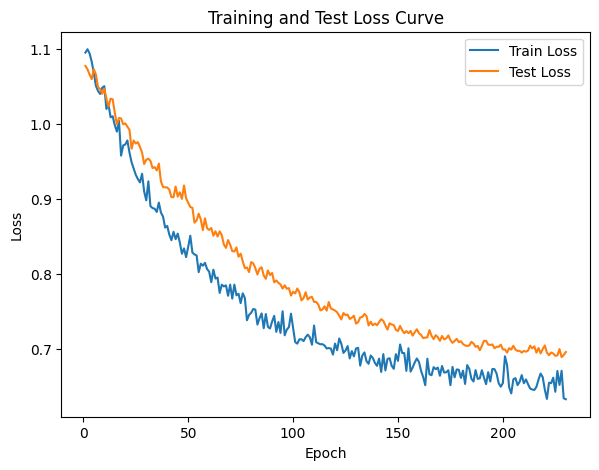

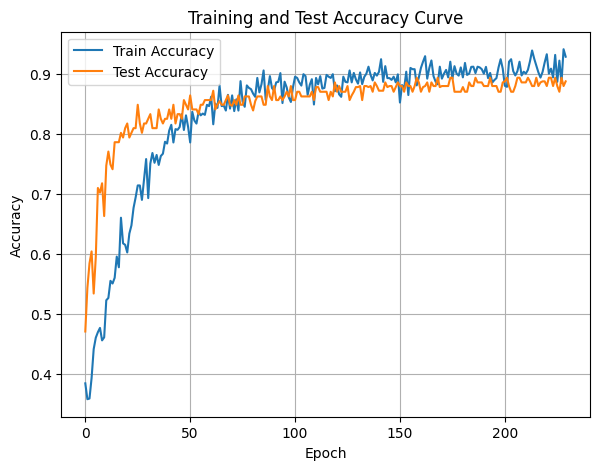

In [92]:
DTEmlp12b.train_single_model()